# Drifter comparisons

In [2]:
import numpy as np
import xarray as xr
import netCDF4 as nc
import os
import matplotlib.pyplot as plt
from cmocean import cm
from datetime import datetime, timedelta
from dateutil.parser import parse
from scipy.io import loadmat
from itertools import repeat
from glob import glob
from importlib import reload
from tqdm import tqdm_notebook as tqdm
from salishsea_tools import viz_tools
from opendrift.readers import reader_netCDF_CF_unstructured
from opendrift.models import oceandrift

%matplotlib inline
plt.rcParams['font.size'] = 12

In [3]:
o = oceandrift.OceanDrift()

10:22:44 INFO: OpenDriftSimulation initialised (version 1.0.6)


In [7]:
o.configobj

ConfigObj({'general': {'use_basemap_landmask': True, 'basemap_resolution': 'h', 'coastline_action': 'stranding', 'time_step_minutes': 60, 'time_step_output_minutes': None}, 'seed': {'ocean_only': True}, 'drift': {'max_age_seconds': None, 'scheme': 'euler', 'stokes_drift': True, 'current_uncertainty': 0.0, 'current_uncertainty_uniform': 0.0, 'wind_uncertainty': 0.0, 'relative_wind': False, 'lift_to_seafloor': True, 'truncate_ocean_model_below_m': None, 'deactivate_north_of': None, 'deactivate_south_of': None, 'deactivate_east_of': None, 'deactivate_west_of': None, 'use_tabularised_stokes_drift': False, 'tabularised_stokes_drift_fetch': '25000'}})

In [ ]:
o.seed_elements()

***

## Drifters

7/19/2016 and 11/28/17 from Rachael

In [4]:
drifters = loadmat('/ocean/shared/drifters/data/L2/drifters_L2.mat')['drifters'][0]
drifters.dtype.names

('id', 'launchDate', 'deltaTDays', 'mtime', 'lon', 'lat', 'dist', 'tzone')

In [5]:
duration = drifters['deltaTDays'].astype(int)
time = np.array([datetime.fromordinal(int(d)) - timedelta(days=366) for d in drifters['launchDate'].astype(float)], dtype=datetime)
D, K = np.unique(time, return_counts=True)
index = np.argsort(-K)
for d, n in zip(D[index], range(15)):
    print(d, sorted(duration[time == d]))

2017-04-11 00:00:00 [0, 0, 0, 0, 1, 1, 1, 1, 2, 2, 4, 5, 6, 8, 8, 8, 12, 13, 14, 14, 14, 15]
2016-06-16 00:00:00 [0, 0, 1, 2, 6, 6, 8, 8, 8, 8, 9, 10, 10, 10, 11, 11, 15]
2017-05-16 00:00:00 [2, 3, 3, 3, 3, 3, 4, 6, 6, 7, 7, 10, 14, 24, 25]
2016-11-01 00:00:00 [0, 1, 1, 1, 1, 3, 5, 8, 9, 11, 11, 12, 12]
2016-07-19 00:00:00 [0, 1, 2, 3, 3, 5, 6, 9, 10, 10, 11, 11, 12]
2017-08-18 00:00:00 [0, 1, 1, 2, 2, 3, 3, 5, 11, 16, 18]
2017-04-28 00:00:00 [4, 6, 7, 10, 12, 12, 14, 15, 16, 17]
2017-04-12 00:00:00 [1, 1, 3, 3, 5, 5, 7, 7, 14, 14]
2017-05-31 00:00:00 [1, 1, 1, 4, 6, 6, 8, 12, 13, 13]
2016-04-18 00:00:00 [0, 5, 6, 8, 8, 10, 11, 11, 14]
2017-06-23 00:00:00 [1, 1, 2, 10, 22, 31, 32, 40, 41]
2016-05-26 00:00:00 [1, 1, 3, 4, 5, 8, 9, 9, 11]
2017-11-27 00:00:00 [0, 10, 20, 28, 40, 40, 41]
2016-08-30 00:00:00 [0, 4, 9, 13, 15, 21]
2016-05-12 00:00:00 [1, 3, 4, 6, 8, 10]


***

## Forcing

In [3]:
# Define paths
paths = {
    'NEMO': '/results/SalishSea/hindcast.201812',
    'NEMO_cutoff': '/results2/SalishSea/hindcast.201812_annex',
    'HRDPS': '/results/forcing/atmospheric/GEM2.5/operational',
    'coords': '/data/bmoorema/MEOPAR/grid/coordinates_seagrid_SalishSea201702.nc',
    'out': '/data/bmoorema/results/opendrift',
    'date_cutoff': '2016 Nov 21',
}
mask = xr.open_dataset('/data/bmoorema/MEOPAR/grid/mesh_mask201702.nc')
daterange1 = [parse(d) for d in ['2016 Jul 19', '2016 Aug 1']]
daterange2 = [parse(d) for d in ['2017 Nov 27', '2017 Dec 15']]

In [6]:
def make_prefix(date, paths, res='h'):
    """Construct path prefix for local SalishSeaCast results given date object and paths dict
    e.g., /results/SalishSea/hindcast.201812/ddmmmyy/SalishSea_1h_yyyymmdd_yyyymmdd
    """

    path = paths['NEMO']
    if 'date_cutoff' in paths and date >= parse(paths['date_cutoff']):
        path = paths['NEMO_cutoff']
    fn = '_'.join([f'SalishSea_1{res}', *repeat(date.strftime('%Y%m%d'), 2)])
    prefix = os.path.join(path, date.strftime('%d%b%y').lower(), fn)
    
    return prefix

In [7]:
def process_NEMO(date, paths, mask):
    """
    """
    
    # Process input
    prefix = make_prefix(date, paths)
    NEMO_out = os.path.join(paths['out'], 'forcing', os.path.split(prefix)[-1] + '_opendrift.nc')
    if os.path.exists(NEMO_out):
        print(f'{NEMO_out} already exists! Skipping ...')
        return
    else:
        print(f'Processing {NEMO_out}')
        raw = []
        for k, key in zip(['U', 'V'], ['vozocrtx', 'vomecrty']):
            with xr.open_dataset(prefix + f'_grid_{k}.nc') as data:
                raw.append(data[key][:, 0, ...].values)
                if k is 'U': time = data.time_counter.values.astype('datetime64[s]').astype(datetime)
        u, v = viz_tools.rotate_vel2(*viz_tools.unstagger(*raw), paths['coords'])
        
        # Write to netCDF out
        with nc.Dataset(NEMO_out, 'w') as ds:
            
            # Create time dimension
            time_units = 'seconds since 1900-01-01 00:00:00'
            ds.createDimension('time', None)
            tempvar = ds.createVariable('time', float, 'time', zlib=True)
            tempvar[:] = nc.date2num(time, units=time_units, calendar='gregorian')
            tempvar.standard_name = 'time'
            tempvar.calendar = 'gregorian'
            tempvar.units = time_units
            
            # Create flat dimension
            ds.createDimension('flat', u[0, ...].size)
            
            # Create lon/lat
            for var, name in zip(['nav_lon', 'nav_lat'], ['longitude', 'latitude']):
                tempvar = ds.createVariable(name, float, 'flat', zlib=True, fill_value=1e20)
                tempvar[:] = mask[var][1:, 1:].values.reshape(-1)
                tempvar.standard_name = name
            
            # Create velocities
            for var, name in zip([u, v], ['x_sea_water_velocity', 'y_sea_water_velocity']):
                tempvar = ds.createVariable(name, float, ('time', 'flat'), zlib=True, fill_value=1e20)
                tempvar[:] = var.reshape(time.size, -1)
                tempvar.standard_name = name
        
            # Create landmask
            tempvar = ds.createVariable('land_binary_mask', float, 'flat', zlib=True, fill_value=1e20)
            tempvar[:] = mask.tmask[0, 0, 1:, 1:].values.reshape(-1)
            tempvar.standard_name = 'land_binary_mask'

In [24]:
# Process forcing
for day in tqdm(range(np.diff(daterange2)[0].days + 1)):
    date = daterange2[0] + timedelta(days=day)
    process_NEMO(date, paths, mask)

Processing /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171127_20171127_opendrift.nc
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171128_20171128_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171129_20171129_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171130_20171130_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171201_20171201_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171202_20171202_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171203_20171203_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171204_20171204_opendrift.nc already exists! Skipping ...
/data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171205_20171205_opendrift.nc already exists! Skipp

***

## Simulations

15:09:52 INFO: OpenDriftSimulation initialised (version 1.0.6)
15:09:52 INFO: Setting SRS to latlong, since not defined before.
15:09:52 INFO: Config validation OK
15:09:52 INFO: Fallback values will be used for the following variables which have no readers: 
15:09:52 INFO: 	x_sea_water_velocity: 0.000000
15:09:52 INFO: 	y_sea_water_velocity: 0.000000
15:09:52 INFO: 	x_wind: 0.000000
15:09:52 INFO: 	y_wind: 0.000000
15:09:52 INFO: Adding a dynamical landmask (resolution "h") based on assumed maximum speed of 1 m/s. Adding a customised landmask may be faster...
15:10:46 INFO: Using existing reader for land_binary_mask
15:10:47 INFO: All points are in ocean
15:10:47 INFO: 2017-11-27 19:04:35.000004 - step 1 of 39358 - 100 active elements (0 deactivated)
15:10:47 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171127_20171127_opendrift.nc
15:10:47 INFO: Opening file with Dataset
15:10:47 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishS

15:11:53 INFO: 2017-11-27 20:13:35.000004 - step 47 of 39358 - 100 active elements (0 deactivated)
15:11:53 INFO: 2017-11-27 20:15:05.000004 - step 48 of 39358 - 100 active elements (0 deactivated)
15:11:54 INFO: 2017-11-27 20:16:35.000004 - step 49 of 39358 - 100 active elements (0 deactivated)
15:11:54 INFO: 2017-11-27 20:18:05.000004 - step 50 of 39358 - 100 active elements (0 deactivated)
15:11:54 INFO: 2017-11-27 20:19:35.000004 - step 51 of 39358 - 100 active elements (0 deactivated)
15:11:54 INFO: 2017-11-27 20:21:05.000004 - step 52 of 39358 - 100 active elements (0 deactivated)
15:11:54 INFO: 2017-11-27 20:22:35.000004 - step 53 of 39358 - 100 active elements (0 deactivated)
15:11:55 INFO: 2017-11-27 20:24:05.000004 - step 54 of 39358 - 100 active elements (0 deactivated)
15:11:55 INFO: 2017-11-27 20:25:35.000004 - step 55 of 39358 - 100 active elements (0 deactivated)
15:11:55 INFO: 2017-11-27 20:27:05.000004 - step 56 of 39358 - 100 active elements (0 deactivated)
15:11:55 I

15:12:49 INFO: 2017-11-27 22:18:05.000004 - step 130 of 39358 - 100 active elements (0 deactivated)
15:12:49 INFO: 2017-11-27 22:19:35.000004 - step 131 of 39358 - 100 active elements (0 deactivated)
15:12:49 INFO: 2017-11-27 22:21:05.000004 - step 132 of 39358 - 100 active elements (0 deactivated)
15:12:50 INFO: 2017-11-27 22:22:35.000004 - step 133 of 39358 - 100 active elements (0 deactivated)
15:12:50 INFO: 2017-11-27 22:24:05.000004 - step 134 of 39358 - 100 active elements (0 deactivated)
15:12:50 INFO: 2017-11-27 22:25:35.000004 - step 135 of 39358 - 100 active elements (0 deactivated)
15:12:50 INFO: 2017-11-27 22:27:05.000004 - step 136 of 39358 - 100 active elements (0 deactivated)
15:12:50 INFO: 2017-11-27 22:28:35.000004 - step 137 of 39358 - 100 active elements (0 deactivated)
15:13:09 INFO: 2017-11-27 22:30:05.000004 - step 138 of 39358 - 100 active elements (0 deactivated)
15:13:10 INFO: 2017-11-27 22:31:35.000004 - step 139 of 39358 - 100 active elements (0 deactivated)


15:13:25 INFO: 2017-11-28 00:21:05.000004 - step 212 of 39358 - 100 active elements (0 deactivated)
15:13:25 INFO: 2017-11-28 00:22:35.000004 - step 213 of 39358 - 100 active elements (0 deactivated)
15:13:25 INFO: 2017-11-28 00:24:05.000004 - step 214 of 39358 - 100 active elements (0 deactivated)
15:13:26 INFO: 2017-11-28 00:25:35.000004 - step 215 of 39358 - 100 active elements (0 deactivated)
15:13:26 INFO: 2017-11-28 00:27:05.000004 - step 216 of 39358 - 100 active elements (0 deactivated)
15:13:26 INFO: 2017-11-28 00:28:35.000004 - step 217 of 39358 - 100 active elements (0 deactivated)
15:14:03 INFO: 2017-11-28 00:30:05.000004 - step 218 of 39358 - 100 active elements (0 deactivated)
15:14:03 INFO: 2017-11-28 00:31:35.000004 - step 219 of 39358 - 100 active elements (0 deactivated)
15:14:04 INFO: 2017-11-28 00:33:05.000004 - step 220 of 39358 - 100 active elements (0 deactivated)
15:14:04 INFO: 2017-11-28 00:34:35.000004 - step 221 of 39358 - 100 active elements (0 deactivated)


15:14:38 INFO: 2017-11-28 02:24:05.000004 - step 294 of 39358 - 100 active elements (0 deactivated)
15:14:38 INFO: 2017-11-28 02:25:35.000004 - step 295 of 39358 - 100 active elements (0 deactivated)
15:14:39 INFO: 2017-11-28 02:27:05.000004 - step 296 of 39358 - 100 active elements (0 deactivated)
15:14:39 INFO: 2017-11-28 02:28:35.000004 - step 297 of 39358 - 100 active elements (0 deactivated)
15:14:58 INFO: 2017-11-28 02:30:05.000004 - step 298 of 39358 - 100 active elements (0 deactivated)
15:14:58 INFO: 2017-11-28 02:31:35.000004 - step 299 of 39358 - 100 active elements (0 deactivated)
15:14:58 INFO: 2017-11-28 02:33:05.000004 - step 300 of 39358 - 100 active elements (0 deactivated)
15:14:58 INFO: 2017-11-28 02:34:35.000004 - step 301 of 39358 - 100 active elements (0 deactivated)
15:14:59 INFO: 2017-11-28 02:36:05.000004 - step 302 of 39358 - 100 active elements (0 deactivated)
15:14:59 INFO: 2017-11-28 02:37:35.000004 - step 303 of 39358 - 100 active elements (0 deactivated)


15:15:35 INFO: 2017-11-28 04:27:05.000004 - step 376 of 39358 - 100 active elements (0 deactivated)
15:15:35 INFO: 2017-11-28 04:28:35.000004 - step 377 of 39358 - 100 active elements (0 deactivated)
15:15:54 INFO: 2017-11-28 04:30:05.000004 - step 378 of 39358 - 100 active elements (0 deactivated)
15:15:54 INFO: 2017-11-28 04:31:35.000004 - step 379 of 39358 - 100 active elements (0 deactivated)
15:15:54 INFO: 2017-11-28 04:33:05.000004 - step 380 of 39358 - 100 active elements (0 deactivated)
15:15:54 INFO: 2017-11-28 04:34:35.000004 - step 381 of 39358 - 100 active elements (0 deactivated)
15:15:54 INFO: 2017-11-28 04:36:05.000004 - step 382 of 39358 - 100 active elements (0 deactivated)
15:15:55 INFO: 2017-11-28 04:37:35.000004 - step 383 of 39358 - 100 active elements (0 deactivated)
15:15:55 INFO: 2017-11-28 04:39:05.000004 - step 384 of 39358 - 100 active elements (0 deactivated)
15:15:55 INFO: 2017-11-28 04:40:35.000004 - step 385 of 39358 - 100 active elements (0 deactivated)


15:16:49 INFO: 2017-11-28 06:30:05.000004 - step 458 of 39358 - 100 active elements (0 deactivated)
15:16:49 INFO: 2017-11-28 06:31:35.000004 - step 459 of 39358 - 100 active elements (0 deactivated)
15:16:49 INFO: 2017-11-28 06:33:05.000004 - step 460 of 39358 - 100 active elements (0 deactivated)
15:16:49 INFO: 2017-11-28 06:34:35.000004 - step 461 of 39358 - 100 active elements (0 deactivated)
15:16:49 INFO: 2017-11-28 06:36:05.000004 - step 462 of 39358 - 100 active elements (0 deactivated)
15:16:50 INFO: 2017-11-28 06:37:35.000004 - step 463 of 39358 - 100 active elements (0 deactivated)
15:16:50 INFO: 2017-11-28 06:39:05.000004 - step 464 of 39358 - 100 active elements (0 deactivated)
15:16:50 INFO: 2017-11-28 06:40:35.000004 - step 465 of 39358 - 100 active elements (0 deactivated)
15:16:51 INFO: 2017-11-28 06:42:05.000004 - step 466 of 39358 - 100 active elements (0 deactivated)
15:16:51 INFO: 2017-11-28 06:43:35.000004 - step 467 of 39358 - 100 active elements (0 deactivated)


15:17:45 INFO: 2017-11-28 08:33:05.000004 - step 540 of 39358 - 100 active elements (0 deactivated)
15:17:45 INFO: 2017-11-28 08:34:35.000004 - step 541 of 39358 - 100 active elements (0 deactivated)
15:17:45 INFO: 2017-11-28 08:36:05.000004 - step 542 of 39358 - 100 active elements (0 deactivated)
15:17:46 INFO: 2017-11-28 08:37:35.000004 - step 543 of 39358 - 100 active elements (0 deactivated)
15:17:46 INFO: 2017-11-28 08:39:05.000004 - step 544 of 39358 - 100 active elements (0 deactivated)
15:17:46 INFO: 2017-11-28 08:40:35.000004 - step 545 of 39358 - 100 active elements (0 deactivated)
15:17:47 INFO: 2017-11-28 08:42:05.000004 - step 546 of 39358 - 100 active elements (0 deactivated)
15:17:47 INFO: 2017-11-28 08:43:35.000004 - step 547 of 39358 - 100 active elements (0 deactivated)
15:17:47 INFO: 2017-11-28 08:45:05.000004 - step 548 of 39358 - 100 active elements (0 deactivated)
15:17:47 INFO: 2017-11-28 08:46:35.000004 - step 549 of 39358 - 100 active elements (0 deactivated)


15:18:40 INFO: 2017-11-28 10:36:05.000004 - step 622 of 39358 - 100 active elements (0 deactivated)
15:18:41 INFO: 2017-11-28 10:37:35.000004 - step 623 of 39358 - 100 active elements (0 deactivated)
15:18:41 INFO: 2017-11-28 10:39:05.000004 - step 624 of 39358 - 100 active elements (0 deactivated)
15:18:41 INFO: 2017-11-28 10:40:35.000004 - step 625 of 39358 - 100 active elements (0 deactivated)
15:18:41 INFO: 2017-11-28 10:42:05.000004 - step 626 of 39358 - 100 active elements (0 deactivated)
15:18:42 INFO: 2017-11-28 10:43:35.000004 - step 627 of 39358 - 100 active elements (0 deactivated)
15:18:42 INFO: 2017-11-28 10:45:05.000004 - step 628 of 39358 - 100 active elements (0 deactivated)
15:18:42 INFO: 2017-11-28 10:46:35.000004 - step 629 of 39358 - 100 active elements (0 deactivated)
15:18:42 INFO: 2017-11-28 10:48:05.000004 - step 630 of 39358 - 100 active elements (0 deactivated)
15:18:42 INFO: 2017-11-28 10:49:35.000004 - step 631 of 39358 - 100 active elements (0 deactivated)


15:19:36 INFO: 2017-11-28 12:39:05.000004 - step 704 of 39358 - 100 active elements (0 deactivated)
15:19:36 INFO: 2017-11-28 12:40:35.000004 - step 705 of 39358 - 100 active elements (0 deactivated)
15:19:36 INFO: 2017-11-28 12:42:05.000004 - step 706 of 39358 - 100 active elements (0 deactivated)
15:19:36 INFO: 2017-11-28 12:43:35.000004 - step 707 of 39358 - 100 active elements (0 deactivated)
15:19:37 INFO: 2017-11-28 12:45:05.000004 - step 708 of 39358 - 100 active elements (0 deactivated)
15:19:37 INFO: 2017-11-28 12:46:35.000004 - step 709 of 39358 - 100 active elements (0 deactivated)
15:19:37 INFO: 2017-11-28 12:48:05.000004 - step 710 of 39358 - 100 active elements (0 deactivated)
15:19:38 INFO: 2017-11-28 12:49:35.000004 - step 711 of 39358 - 100 active elements (0 deactivated)
15:19:38 INFO: 2017-11-28 12:51:05.000004 - step 712 of 39358 - 100 active elements (0 deactivated)
15:19:38 INFO: 2017-11-28 12:52:35.000004 - step 713 of 39358 - 100 active elements (0 deactivated)


15:20:31 INFO: 2017-11-28 14:42:05.000004 - step 786 of 39358 - 100 active elements (0 deactivated)
15:20:31 INFO: 2017-11-28 14:43:35.000004 - step 787 of 39358 - 100 active elements (0 deactivated)
15:20:31 INFO: 2017-11-28 14:45:05.000004 - step 788 of 39358 - 100 active elements (0 deactivated)
15:20:32 INFO: 2017-11-28 14:46:35.000004 - step 789 of 39358 - 100 active elements (0 deactivated)
15:20:32 INFO: 2017-11-28 14:48:05.000004 - step 790 of 39358 - 100 active elements (0 deactivated)
15:20:32 INFO: 2017-11-28 14:49:35.000004 - step 791 of 39358 - 100 active elements (0 deactivated)
15:20:32 INFO: 2017-11-28 14:51:05.000004 - step 792 of 39358 - 100 active elements (0 deactivated)
15:20:32 INFO: 2017-11-28 14:52:35.000004 - step 793 of 39358 - 100 active elements (0 deactivated)
15:20:33 INFO: 2017-11-28 14:54:05.000004 - step 794 of 39358 - 100 active elements (0 deactivated)
15:20:33 INFO: 2017-11-28 14:55:35.000004 - step 795 of 39358 - 100 active elements (0 deactivated)


15:21:27 INFO: 2017-11-28 16:45:05.000004 - step 868 of 39358 - 100 active elements (0 deactivated)
15:21:27 INFO: 2017-11-28 16:46:35.000004 - step 869 of 39358 - 100 active elements (0 deactivated)
15:21:27 INFO: 2017-11-28 16:48:05.000004 - step 870 of 39358 - 100 active elements (0 deactivated)
15:21:27 INFO: 2017-11-28 16:49:35.000004 - step 871 of 39358 - 100 active elements (0 deactivated)
15:21:28 INFO: 2017-11-28 16:51:05.000004 - step 872 of 39358 - 100 active elements (0 deactivated)
15:21:28 INFO: 2017-11-28 16:52:35.000004 - step 873 of 39358 - 100 active elements (0 deactivated)
15:21:28 INFO: 2017-11-28 16:54:05.000004 - step 874 of 39358 - 100 active elements (0 deactivated)
15:21:29 INFO: 2017-11-28 16:55:35.000004 - step 875 of 39358 - 100 active elements (0 deactivated)
15:21:29 INFO: 2017-11-28 16:57:05.000004 - step 876 of 39358 - 100 active elements (0 deactivated)
15:21:29 INFO: 2017-11-28 16:58:35.000004 - step 877 of 39358 - 100 active elements (0 deactivated)


15:22:22 INFO: 2017-11-28 18:48:05.000004 - step 950 of 39358 - 100 active elements (0 deactivated)
15:22:22 INFO: 2017-11-28 18:49:35.000004 - step 951 of 39358 - 100 active elements (0 deactivated)
15:22:23 INFO: 2017-11-28 18:51:05.000004 - step 952 of 39358 - 100 active elements (0 deactivated)
15:22:23 INFO: 2017-11-28 18:52:35.000004 - step 953 of 39358 - 100 active elements (0 deactivated)
15:22:23 INFO: 2017-11-28 18:54:05.000004 - step 954 of 39358 - 100 active elements (0 deactivated)
15:22:23 INFO: 2017-11-28 18:55:35.000004 - step 955 of 39358 - 100 active elements (0 deactivated)
15:22:24 INFO: 2017-11-28 18:57:05.000004 - step 956 of 39358 - 100 active elements (0 deactivated)
15:22:24 INFO: 2017-11-28 18:58:35.000004 - step 957 of 39358 - 100 active elements (0 deactivated)
15:22:24 INFO: 2017-11-28 19:00:05.000004 - step 958 of 39358 - 100 active elements (0 deactivated)
15:22:24 INFO: 2017-11-28 19:01:35.000004 - step 959 of 39358 - 100 active elements (0 deactivated)


15:23:17 INFO: 2017-11-28 20:51:05.000004 - step 1032 of 39358 - 100 active elements (0 deactivated)
15:23:17 INFO: 2017-11-28 20:52:35.000004 - step 1033 of 39358 - 100 active elements (0 deactivated)
15:23:17 INFO: 2017-11-28 20:54:05.000004 - step 1034 of 39358 - 100 active elements (0 deactivated)
15:23:17 INFO: 2017-11-28 20:55:35.000004 - step 1035 of 39358 - 100 active elements (0 deactivated)
15:23:18 INFO: 2017-11-28 20:57:05.000004 - step 1036 of 39358 - 100 active elements (0 deactivated)
15:23:18 INFO: 2017-11-28 20:58:35.000004 - step 1037 of 39358 - 100 active elements (0 deactivated)
15:23:18 INFO: 2017-11-28 21:00:05.000004 - step 1038 of 39358 - 100 active elements (0 deactivated)
15:23:18 INFO: 2017-11-28 21:01:35.000004 - step 1039 of 39358 - 100 active elements (0 deactivated)
15:23:19 INFO: 2017-11-28 21:03:05.000004 - step 1040 of 39358 - 100 active elements (0 deactivated)
15:23:19 INFO: 2017-11-28 21:04:35.000004 - step 1041 of 39358 - 100 active elements (0 dea

15:24:13 INFO: 2017-11-28 22:54:05.000004 - step 1114 of 39358 - 100 active elements (0 deactivated)
15:24:13 INFO: 2017-11-28 22:55:35.000004 - step 1115 of 39358 - 100 active elements (0 deactivated)
15:24:13 INFO: 2017-11-28 22:57:05.000004 - step 1116 of 39358 - 100 active elements (0 deactivated)
15:24:13 INFO: 2017-11-28 22:58:35.000004 - step 1117 of 39358 - 100 active elements (0 deactivated)
15:24:13 INFO: 2017-11-28 23:00:05.000004 - step 1118 of 39358 - 100 active elements (0 deactivated)
15:24:14 INFO: 2017-11-28 23:01:35.000004 - step 1119 of 39358 - 100 active elements (0 deactivated)
15:24:14 INFO: 2017-11-28 23:03:05.000004 - step 1120 of 39358 - 100 active elements (0 deactivated)
15:24:14 INFO: 2017-11-28 23:04:35.000004 - step 1121 of 39358 - 100 active elements (0 deactivated)
15:24:14 INFO: 2017-11-28 23:06:05.000004 - step 1122 of 39358 - 100 active elements (0 deactivated)
15:24:15 INFO: 2017-11-28 23:07:35.000004 - step 1123 of 39358 - 100 active elements (0 dea

15:25:08 INFO: 2017-11-29 00:57:05.000004 - step 1196 of 39358 - 100 active elements (0 deactivated)
15:25:09 INFO: 2017-11-29 00:58:35.000004 - step 1197 of 39358 - 100 active elements (0 deactivated)
15:25:09 INFO: 2017-11-29 01:00:05.000004 - step 1198 of 39358 - 100 active elements (0 deactivated)
15:25:09 INFO: 2017-11-29 01:01:35.000004 - step 1199 of 39358 - 100 active elements (0 deactivated)
15:25:09 INFO: 2017-11-29 01:03:05.000004 - step 1200 of 39358 - 100 active elements (0 deactivated)
15:25:10 INFO: 2017-11-29 01:04:35.000004 - step 1201 of 39358 - 100 active elements (0 deactivated)
15:25:10 INFO: 2017-11-29 01:06:05.000004 - step 1202 of 39358 - 100 active elements (0 deactivated)
15:25:10 INFO: 2017-11-29 01:07:35.000004 - step 1203 of 39358 - 100 active elements (0 deactivated)
15:25:10 INFO: 2017-11-29 01:09:05.000004 - step 1204 of 39358 - 100 active elements (0 deactivated)
15:25:11 INFO: 2017-11-29 01:10:35.000004 - step 1205 of 39358 - 100 active elements (0 dea

15:26:05 INFO: 2017-11-29 03:00:05.000004 - step 1278 of 39358 - 100 active elements (0 deactivated)
15:26:05 INFO: 2017-11-29 03:01:35.000004 - step 1279 of 39358 - 100 active elements (0 deactivated)
15:26:05 INFO: 2017-11-29 03:03:05.000004 - step 1280 of 39358 - 100 active elements (0 deactivated)
15:26:06 INFO: 2017-11-29 03:04:35.000004 - step 1281 of 39358 - 100 active elements (0 deactivated)
15:26:06 INFO: 2017-11-29 03:06:05.000004 - step 1282 of 39358 - 100 active elements (0 deactivated)
15:26:06 INFO: 2017-11-29 03:07:35.000004 - step 1283 of 39358 - 100 active elements (0 deactivated)
15:26:06 INFO: 2017-11-29 03:09:05.000004 - step 1284 of 39358 - 100 active elements (0 deactivated)
15:26:07 INFO: 2017-11-29 03:10:35.000004 - step 1285 of 39358 - 100 active elements (0 deactivated)
15:26:07 INFO: 2017-11-29 03:12:05.000004 - step 1286 of 39358 - 100 active elements (0 deactivated)
15:26:07 INFO: 2017-11-29 03:13:35.000004 - step 1287 of 39358 - 100 active elements (0 dea

15:27:02 INFO: 2017-11-29 05:03:05.000004 - step 1360 of 39358 - 100 active elements (0 deactivated)
15:27:02 INFO: 2017-11-29 05:04:35.000004 - step 1361 of 39358 - 100 active elements (0 deactivated)
15:27:02 INFO: 2017-11-29 05:06:05.000004 - step 1362 of 39358 - 100 active elements (0 deactivated)
15:27:03 INFO: 2017-11-29 05:07:35.000004 - step 1363 of 39358 - 100 active elements (0 deactivated)
15:27:03 INFO: 2017-11-29 05:09:05.000004 - step 1364 of 39358 - 100 active elements (0 deactivated)
15:27:03 INFO: 2017-11-29 05:10:35.000004 - step 1365 of 39358 - 100 active elements (0 deactivated)
15:27:03 INFO: 2017-11-29 05:12:05.000004 - step 1366 of 39358 - 100 active elements (0 deactivated)
15:27:04 INFO: 2017-11-29 05:13:35.000004 - step 1367 of 39358 - 100 active elements (0 deactivated)
15:27:04 INFO: 2017-11-29 05:15:05.000004 - step 1368 of 39358 - 100 active elements (0 deactivated)
15:27:04 INFO: 2017-11-29 05:16:35.000004 - step 1369 of 39358 - 100 active elements (0 dea

15:27:58 INFO: 2017-11-29 07:06:05.000004 - step 1442 of 39358 - 100 active elements (0 deactivated)
15:27:58 INFO: 2017-11-29 07:07:35.000004 - step 1443 of 39358 - 100 active elements (0 deactivated)
15:27:59 INFO: 2017-11-29 07:09:05.000004 - step 1444 of 39358 - 100 active elements (0 deactivated)
15:27:59 INFO: 2017-11-29 07:10:35.000004 - step 1445 of 39358 - 100 active elements (0 deactivated)
15:27:59 INFO: 2017-11-29 07:12:05.000004 - step 1446 of 39358 - 100 active elements (0 deactivated)
15:27:59 INFO: 2017-11-29 07:13:35.000004 - step 1447 of 39358 - 100 active elements (0 deactivated)
15:28:00 INFO: 2017-11-29 07:15:05.000004 - step 1448 of 39358 - 100 active elements (0 deactivated)
15:28:00 INFO: 2017-11-29 07:16:35.000004 - step 1449 of 39358 - 100 active elements (0 deactivated)
15:28:00 INFO: 2017-11-29 07:18:05.000004 - step 1450 of 39358 - 100 active elements (0 deactivated)
15:28:01 INFO: 2017-11-29 07:19:35.000004 - step 1451 of 39358 - 100 active elements (0 dea

15:28:54 INFO: 2017-11-29 09:09:05.000004 - step 1524 of 39358 - 100 active elements (0 deactivated)
15:28:55 INFO: 2017-11-29 09:10:35.000004 - step 1525 of 39358 - 100 active elements (0 deactivated)
15:28:55 INFO: 2017-11-29 09:12:05.000004 - step 1526 of 39358 - 100 active elements (0 deactivated)
15:28:55 INFO: 2017-11-29 09:13:35.000004 - step 1527 of 39358 - 100 active elements (0 deactivated)
15:28:55 INFO: 2017-11-29 09:15:05.000004 - step 1528 of 39358 - 100 active elements (0 deactivated)
15:28:55 INFO: 2017-11-29 09:16:35.000004 - step 1529 of 39358 - 100 active elements (0 deactivated)
15:28:56 INFO: 2017-11-29 09:18:05.000004 - step 1530 of 39358 - 100 active elements (0 deactivated)
15:28:56 INFO: 2017-11-29 09:19:35.000004 - step 1531 of 39358 - 100 active elements (0 deactivated)
15:28:56 INFO: 2017-11-29 09:21:05.000004 - step 1532 of 39358 - 100 active elements (0 deactivated)
15:28:56 INFO: 2017-11-29 09:22:35.000004 - step 1533 of 39358 - 100 active elements (0 dea

15:29:53 INFO: 2017-11-29 11:12:05.000004 - step 1606 of 39358 - 100 active elements (0 deactivated)
15:29:53 INFO: 2017-11-29 11:13:35.000004 - step 1607 of 39358 - 100 active elements (0 deactivated)
15:29:53 INFO: 2017-11-29 11:15:05.000004 - step 1608 of 39358 - 100 active elements (0 deactivated)
15:29:54 INFO: 2017-11-29 11:16:35.000004 - step 1609 of 39358 - 100 active elements (0 deactivated)
15:29:54 INFO: 2017-11-29 11:18:05.000004 - step 1610 of 39358 - 100 active elements (0 deactivated)
15:29:54 INFO: 2017-11-29 11:19:35.000004 - step 1611 of 39358 - 100 active elements (0 deactivated)
15:29:54 INFO: 2017-11-29 11:21:05.000004 - step 1612 of 39358 - 100 active elements (0 deactivated)
15:29:55 INFO: 2017-11-29 11:22:35.000004 - step 1613 of 39358 - 100 active elements (0 deactivated)
15:29:55 INFO: 2017-11-29 11:24:05.000004 - step 1614 of 39358 - 100 active elements (0 deactivated)
15:29:55 INFO: 2017-11-29 11:25:35.000004 - step 1615 of 39358 - 100 active elements (0 dea

15:30:54 INFO: 2017-11-29 13:15:05.000004 - step 1688 of 39358 - 100 active elements (0 deactivated)
15:30:54 INFO: 2017-11-29 13:16:35.000004 - step 1689 of 39358 - 100 active elements (0 deactivated)
15:30:54 INFO: 2017-11-29 13:18:05.000004 - step 1690 of 39358 - 100 active elements (0 deactivated)
15:30:55 INFO: 2017-11-29 13:19:35.000004 - step 1691 of 39358 - 100 active elements (0 deactivated)
15:30:55 INFO: 2017-11-29 13:21:05.000004 - step 1692 of 39358 - 100 active elements (0 deactivated)
15:30:55 INFO: 2017-11-29 13:22:35.000004 - step 1693 of 39358 - 100 active elements (0 deactivated)
15:30:55 INFO: 2017-11-29 13:24:05.000004 - step 1694 of 39358 - 100 active elements (0 deactivated)
15:30:56 INFO: 2017-11-29 13:25:35.000004 - step 1695 of 39358 - 100 active elements (0 deactivated)
15:30:56 INFO: 2017-11-29 13:27:05.000004 - step 1696 of 39358 - 100 active elements (0 deactivated)
15:30:56 INFO: 2017-11-29 13:28:35.000004 - step 1697 of 39358 - 100 active elements (0 dea

15:31:59 INFO: 2017-11-29 15:18:05.000004 - step 1770 of 39358 - 100 active elements (0 deactivated)
15:32:00 INFO: 2017-11-29 15:19:35.000004 - step 1771 of 39358 - 100 active elements (0 deactivated)
15:32:00 INFO: 2017-11-29 15:21:05.000004 - step 1772 of 39358 - 100 active elements (0 deactivated)
15:32:00 INFO: 2017-11-29 15:22:35.000004 - step 1773 of 39358 - 100 active elements (0 deactivated)
15:32:00 INFO: 2017-11-29 15:24:05.000004 - step 1774 of 39358 - 100 active elements (0 deactivated)
15:32:01 INFO: 2017-11-29 15:25:35.000004 - step 1775 of 39358 - 100 active elements (0 deactivated)
15:32:01 INFO: 2017-11-29 15:27:05.000004 - step 1776 of 39358 - 100 active elements (0 deactivated)
15:32:01 INFO: 2017-11-29 15:28:35.000004 - step 1777 of 39358 - 100 active elements (0 deactivated)
15:32:28 INFO: 2017-11-29 15:30:05.000004 - step 1778 of 39358 - 100 active elements (0 deactivated)
15:32:28 INFO: 2017-11-29 15:31:35.000004 - step 1779 of 39358 - 100 active elements (0 dea

15:33:13 INFO: 2017-11-29 17:21:05.000004 - step 1852 of 39358 - 100 active elements (0 deactivated)
15:33:13 INFO: 2017-11-29 17:22:35.000004 - step 1853 of 39358 - 100 active elements (0 deactivated)
15:33:14 INFO: 2017-11-29 17:24:05.000004 - step 1854 of 39358 - 100 active elements (0 deactivated)
15:33:14 INFO: 2017-11-29 17:25:35.000004 - step 1855 of 39358 - 100 active elements (0 deactivated)
15:33:14 INFO: 2017-11-29 17:27:05.000004 - step 1856 of 39358 - 100 active elements (0 deactivated)
15:33:14 INFO: 2017-11-29 17:28:35.000004 - step 1857 of 39358 - 100 active elements (0 deactivated)
15:33:37 INFO: 2017-11-29 17:30:05.000004 - step 1858 of 39358 - 100 active elements (0 deactivated)
15:33:37 INFO: 2017-11-29 17:31:35.000004 - step 1859 of 39358 - 100 active elements (0 deactivated)
15:33:37 INFO: 2017-11-29 17:33:05.000004 - step 1860 of 39358 - 100 active elements (0 deactivated)
15:33:38 INFO: 2017-11-29 17:34:35.000004 - step 1861 of 39358 - 100 active elements (0 dea

15:34:20 INFO: 2017-11-29 19:24:05.000004 - step 1934 of 39358 - 100 active elements (0 deactivated)
15:34:20 INFO: 2017-11-29 19:25:35.000004 - step 1935 of 39358 - 100 active elements (0 deactivated)
15:34:20 INFO: 2017-11-29 19:27:05.000004 - step 1936 of 39358 - 100 active elements (0 deactivated)
15:34:21 INFO: 2017-11-29 19:28:35.000004 - step 1937 of 39358 - 100 active elements (0 deactivated)
15:34:47 INFO: 2017-11-29 19:30:05.000004 - step 1938 of 39358 - 100 active elements (0 deactivated)
15:34:47 INFO: 2017-11-29 19:31:35.000004 - step 1939 of 39358 - 100 active elements (0 deactivated)
15:34:47 INFO: 2017-11-29 19:33:05.000004 - step 1940 of 39358 - 100 active elements (0 deactivated)
15:34:48 INFO: 2017-11-29 19:34:35.000004 - step 1941 of 39358 - 100 active elements (0 deactivated)
15:34:48 INFO: 2017-11-29 19:36:05.000004 - step 1942 of 39358 - 100 active elements (0 deactivated)
15:34:48 INFO: 2017-11-29 19:37:35.000004 - step 1943 of 39358 - 100 active elements (0 dea

15:35:30 INFO: 2017-11-29 21:27:05.000004 - step 2016 of 39358 - 100 active elements (0 deactivated)
15:35:30 INFO: 2017-11-29 21:28:35.000004 - step 2017 of 39358 - 100 active elements (0 deactivated)
15:35:52 INFO: 2017-11-29 21:30:05.000004 - step 2018 of 39358 - 100 active elements (0 deactivated)
15:35:53 INFO: 2017-11-29 21:31:35.000004 - step 2019 of 39358 - 100 active elements (0 deactivated)
15:35:53 INFO: 2017-11-29 21:33:05.000004 - step 2020 of 39358 - 100 active elements (0 deactivated)
15:35:53 INFO: 2017-11-29 21:34:35.000004 - step 2021 of 39358 - 100 active elements (0 deactivated)
15:35:53 INFO: 2017-11-29 21:36:05.000004 - step 2022 of 39358 - 100 active elements (0 deactivated)
15:35:54 INFO: 2017-11-29 21:37:35.000004 - step 2023 of 39358 - 100 active elements (0 deactivated)
15:35:54 INFO: 2017-11-29 21:39:05.000004 - step 2024 of 39358 - 100 active elements (0 deactivated)
15:35:54 INFO: 2017-11-29 21:40:35.000004 - step 2025 of 39358 - 100 active elements (0 dea

15:36:35 INFO: 2017-11-29 23:30:05.000004 - step 2098 of 39358 - 100 active elements (0 deactivated)
15:36:35 INFO: 2017-11-29 23:31:35.000004 - step 2099 of 39358 - 100 active elements (0 deactivated)
15:36:35 INFO: 2017-11-29 23:33:05.000004 - step 2100 of 39358 - 100 active elements (0 deactivated)
15:36:35 INFO: 2017-11-29 23:34:35.000004 - step 2101 of 39358 - 100 active elements (0 deactivated)
15:36:36 INFO: 2017-11-29 23:36:05.000004 - step 2102 of 39358 - 100 active elements (0 deactivated)
15:36:36 INFO: 2017-11-29 23:37:35.000004 - step 2103 of 39358 - 100 active elements (0 deactivated)
15:36:36 INFO: 2017-11-29 23:39:05.000004 - step 2104 of 39358 - 100 active elements (0 deactivated)
15:36:36 INFO: 2017-11-29 23:40:35.000004 - step 2105 of 39358 - 100 active elements (0 deactivated)
15:36:37 INFO: 2017-11-29 23:42:05.000004 - step 2106 of 39358 - 100 active elements (0 deactivated)
15:36:37 INFO: 2017-11-29 23:43:35.000004 - step 2107 of 39358 - 100 active elements (0 dea

15:38:03 INFO: 2017-11-30 01:33:05.000004 - step 2180 of 39358 - 100 active elements (0 deactivated)
15:38:03 INFO: 2017-11-30 01:34:35.000004 - step 2181 of 39358 - 100 active elements (0 deactivated)
15:38:04 INFO: 2017-11-30 01:36:05.000004 - step 2182 of 39358 - 100 active elements (0 deactivated)
15:38:04 INFO: 2017-11-30 01:37:35.000004 - step 2183 of 39358 - 100 active elements (0 deactivated)
15:38:04 INFO: 2017-11-30 01:39:05.000004 - step 2184 of 39358 - 100 active elements (0 deactivated)
15:38:04 INFO: 2017-11-30 01:40:35.000004 - step 2185 of 39358 - 100 active elements (0 deactivated)
15:38:05 INFO: 2017-11-30 01:42:05.000004 - step 2186 of 39358 - 100 active elements (0 deactivated)
15:38:05 INFO: 2017-11-30 01:43:35.000004 - step 2187 of 39358 - 100 active elements (0 deactivated)
15:38:05 INFO: 2017-11-30 01:45:05.000004 - step 2188 of 39358 - 100 active elements (0 deactivated)
15:38:05 INFO: 2017-11-30 01:46:35.000004 - step 2189 of 39358 - 100 active elements (0 dea

15:39:11 INFO: 2017-11-30 03:36:05.000004 - step 2262 of 39358 - 100 active elements (0 deactivated)
15:39:12 INFO: 2017-11-30 03:37:35.000004 - step 2263 of 39358 - 100 active elements (0 deactivated)
15:39:12 INFO: 2017-11-30 03:39:05.000004 - step 2264 of 39358 - 100 active elements (0 deactivated)
15:39:12 INFO: 2017-11-30 03:40:35.000004 - step 2265 of 39358 - 100 active elements (0 deactivated)
15:39:12 INFO: 2017-11-30 03:42:05.000004 - step 2266 of 39358 - 100 active elements (0 deactivated)
15:39:12 INFO: 2017-11-30 03:43:35.000004 - step 2267 of 39358 - 100 active elements (0 deactivated)
15:39:13 INFO: 2017-11-30 03:45:05.000004 - step 2268 of 39358 - 100 active elements (0 deactivated)
15:39:13 INFO: 2017-11-30 03:46:35.000004 - step 2269 of 39358 - 100 active elements (0 deactivated)
15:39:13 INFO: 2017-11-30 03:48:05.000004 - step 2270 of 39358 - 100 active elements (0 deactivated)
15:39:13 INFO: 2017-11-30 03:49:35.000004 - step 2271 of 39358 - 100 active elements (0 dea

15:40:16 INFO: 2017-11-30 05:39:05.000004 - step 2344 of 39358 - 100 active elements (0 deactivated)
15:40:16 INFO: 2017-11-30 05:40:35.000004 - step 2345 of 39358 - 100 active elements (0 deactivated)
15:40:16 INFO: 2017-11-30 05:42:05.000004 - step 2346 of 39358 - 100 active elements (0 deactivated)
15:40:16 INFO: 2017-11-30 05:43:35.000004 - step 2347 of 39358 - 100 active elements (0 deactivated)
15:40:17 INFO: 2017-11-30 05:45:05.000004 - step 2348 of 39358 - 100 active elements (0 deactivated)
15:40:17 INFO: 2017-11-30 05:46:35.000004 - step 2349 of 39358 - 100 active elements (0 deactivated)
15:40:17 INFO: 2017-11-30 05:48:05.000004 - step 2350 of 39358 - 100 active elements (0 deactivated)
15:40:17 INFO: 2017-11-30 05:49:35.000004 - step 2351 of 39358 - 100 active elements (0 deactivated)
15:40:17 INFO: 2017-11-30 05:51:05.000004 - step 2352 of 39358 - 100 active elements (0 deactivated)
15:40:18 INFO: 2017-11-30 05:52:35.000004 - step 2353 of 39358 - 100 active elements (0 dea

15:41:20 INFO: 2017-11-30 07:42:05.000004 - step 2426 of 39358 - 100 active elements (0 deactivated)
15:41:20 INFO: 2017-11-30 07:43:35.000004 - step 2427 of 39358 - 100 active elements (0 deactivated)
15:41:20 INFO: 2017-11-30 07:45:05.000004 - step 2428 of 39358 - 100 active elements (0 deactivated)
15:41:20 INFO: 2017-11-30 07:46:35.000004 - step 2429 of 39358 - 100 active elements (0 deactivated)
15:41:21 INFO: 2017-11-30 07:48:05.000004 - step 2430 of 39358 - 100 active elements (0 deactivated)
15:41:21 INFO: 2017-11-30 07:49:35.000004 - step 2431 of 39358 - 100 active elements (0 deactivated)
15:41:21 INFO: 2017-11-30 07:51:05.000004 - step 2432 of 39358 - 100 active elements (0 deactivated)
15:41:21 INFO: 2017-11-30 07:52:35.000004 - step 2433 of 39358 - 100 active elements (0 deactivated)
15:41:22 INFO: 2017-11-30 07:54:05.000004 - step 2434 of 39358 - 100 active elements (0 deactivated)
15:41:22 INFO: 2017-11-30 07:55:35.000004 - step 2435 of 39358 - 100 active elements (0 dea

15:42:24 INFO: 2017-11-30 09:45:05.000004 - step 2508 of 39358 - 100 active elements (0 deactivated)
15:42:24 INFO: 2017-11-30 09:46:35.000004 - step 2509 of 39358 - 100 active elements (0 deactivated)
15:42:24 INFO: 2017-11-30 09:48:05.000004 - step 2510 of 39358 - 100 active elements (0 deactivated)
15:42:24 INFO: 2017-11-30 09:49:35.000004 - step 2511 of 39358 - 100 active elements (0 deactivated)
15:42:25 INFO: 2017-11-30 09:51:05.000004 - step 2512 of 39358 - 100 active elements (0 deactivated)
15:42:25 INFO: 2017-11-30 09:52:35.000004 - step 2513 of 39358 - 100 active elements (0 deactivated)
15:42:25 INFO: 2017-11-30 09:54:05.000004 - step 2514 of 39358 - 100 active elements (0 deactivated)
15:42:25 INFO: 2017-11-30 09:55:35.000004 - step 2515 of 39358 - 100 active elements (0 deactivated)
15:42:26 INFO: 2017-11-30 09:57:05.000004 - step 2516 of 39358 - 100 active elements (0 deactivated)
15:42:26 INFO: 2017-11-30 09:58:35.000004 - step 2517 of 39358 - 100 active elements (0 dea

15:43:28 INFO: 2017-11-30 11:48:05.000004 - step 2590 of 39358 - 100 active elements (0 deactivated)
15:43:28 INFO: 2017-11-30 11:49:35.000004 - step 2591 of 39358 - 100 active elements (0 deactivated)
15:43:28 INFO: 2017-11-30 11:51:05.000004 - step 2592 of 39358 - 100 active elements (0 deactivated)
15:43:28 INFO: 2017-11-30 11:52:35.000004 - step 2593 of 39358 - 100 active elements (0 deactivated)
15:43:29 INFO: 2017-11-30 11:54:05.000004 - step 2594 of 39358 - 100 active elements (0 deactivated)
15:43:29 INFO: 2017-11-30 11:55:35.000004 - step 2595 of 39358 - 100 active elements (0 deactivated)
15:43:29 INFO: 2017-11-30 11:57:05.000004 - step 2596 of 39358 - 100 active elements (0 deactivated)
15:43:29 INFO: 2017-11-30 11:58:35.000004 - step 2597 of 39358 - 100 active elements (0 deactivated)
15:43:30 INFO: 2017-11-30 12:00:05.000004 - step 2598 of 39358 - 100 active elements (0 deactivated)
15:43:30 INFO: 2017-11-30 12:01:35.000004 - step 2599 of 39358 - 100 active elements (0 dea

15:44:31 INFO: 2017-11-30 13:51:05.000004 - step 2672 of 39358 - 100 active elements (0 deactivated)
15:44:32 INFO: 2017-11-30 13:52:35.000004 - step 2673 of 39358 - 100 active elements (0 deactivated)
15:44:32 INFO: 2017-11-30 13:54:05.000004 - step 2674 of 39358 - 100 active elements (0 deactivated)
15:44:32 INFO: 2017-11-30 13:55:35.000004 - step 2675 of 39358 - 100 active elements (0 deactivated)
15:44:32 INFO: 2017-11-30 13:57:05.000004 - step 2676 of 39358 - 100 active elements (0 deactivated)
15:44:33 INFO: 2017-11-30 13:58:35.000004 - step 2677 of 39358 - 100 active elements (0 deactivated)
15:44:33 INFO: 2017-11-30 14:00:05.000004 - step 2678 of 39358 - 100 active elements (0 deactivated)
15:44:33 INFO: 2017-11-30 14:01:35.000004 - step 2679 of 39358 - 100 active elements (0 deactivated)
15:44:33 INFO: 2017-11-30 14:03:05.000004 - step 2680 of 39358 - 100 active elements (0 deactivated)
15:44:34 INFO: 2017-11-30 14:04:35.000004 - step 2681 of 39358 - 100 active elements (0 dea

15:45:36 INFO: 2017-11-30 15:54:05.000004 - step 2754 of 39358 - 100 active elements (0 deactivated)
15:45:37 INFO: 2017-11-30 15:55:35.000004 - step 2755 of 39358 - 100 active elements (0 deactivated)
15:45:37 INFO: 2017-11-30 15:57:05.000004 - step 2756 of 39358 - 100 active elements (0 deactivated)
15:45:37 INFO: 2017-11-30 15:58:35.000004 - step 2757 of 39358 - 100 active elements (0 deactivated)
15:45:38 INFO: 2017-11-30 16:00:05.000004 - step 2758 of 39358 - 100 active elements (0 deactivated)
15:45:38 INFO: 2017-11-30 16:01:35.000004 - step 2759 of 39358 - 100 active elements (0 deactivated)
15:45:38 INFO: 2017-11-30 16:03:05.000004 - step 2760 of 39358 - 100 active elements (0 deactivated)
15:45:38 INFO: 2017-11-30 16:04:35.000004 - step 2761 of 39358 - 100 active elements (0 deactivated)
15:45:39 INFO: 2017-11-30 16:06:05.000004 - step 2762 of 39358 - 100 active elements (0 deactivated)
15:45:39 INFO: 2017-11-30 16:07:35.000004 - step 2763 of 39358 - 100 active elements (0 dea

15:46:42 INFO: 2017-11-30 17:57:05.000004 - step 2836 of 39358 - 100 active elements (0 deactivated)
15:46:42 INFO: 2017-11-30 17:58:35.000004 - step 2837 of 39358 - 100 active elements (0 deactivated)
15:46:43 INFO: 2017-11-30 18:00:05.000004 - step 2838 of 39358 - 100 active elements (0 deactivated)
15:46:43 INFO: 2017-11-30 18:01:35.000004 - step 2839 of 39358 - 100 active elements (0 deactivated)
15:46:43 INFO: 2017-11-30 18:03:05.000004 - step 2840 of 39358 - 100 active elements (0 deactivated)
15:46:43 INFO: 2017-11-30 18:04:35.000004 - step 2841 of 39358 - 100 active elements (0 deactivated)
15:46:44 INFO: 2017-11-30 18:06:05.000004 - step 2842 of 39358 - 100 active elements (0 deactivated)
15:46:44 INFO: 2017-11-30 18:07:35.000004 - step 2843 of 39358 - 100 active elements (0 deactivated)
15:46:44 INFO: 2017-11-30 18:09:05.000004 - step 2844 of 39358 - 100 active elements (0 deactivated)
15:46:44 INFO: 2017-11-30 18:10:35.000004 - step 2845 of 39358 - 100 active elements (0 dea

15:47:43 INFO: 2017-11-30 20:00:05.000004 - step 2918 of 39358 - 100 active elements (0 deactivated)
15:47:44 INFO: 2017-11-30 20:01:35.000004 - step 2919 of 39358 - 100 active elements (0 deactivated)
15:47:44 INFO: 2017-11-30 20:03:05.000004 - step 2920 of 39358 - 100 active elements (0 deactivated)
15:47:44 INFO: 2017-11-30 20:04:35.000004 - step 2921 of 39358 - 100 active elements (0 deactivated)
15:47:45 INFO: 2017-11-30 20:06:05.000004 - step 2922 of 39358 - 100 active elements (0 deactivated)
15:47:45 INFO: 2017-11-30 20:07:35.000004 - step 2923 of 39358 - 100 active elements (0 deactivated)
15:47:45 INFO: 2017-11-30 20:09:05.000004 - step 2924 of 39358 - 100 active elements (0 deactivated)
15:47:45 INFO: 2017-11-30 20:10:35.000004 - step 2925 of 39358 - 100 active elements (0 deactivated)
15:47:46 INFO: 2017-11-30 20:12:05.000004 - step 2926 of 39358 - 100 active elements (0 deactivated)
15:47:46 INFO: 2017-11-30 20:13:35.000004 - step 2927 of 39358 - 100 active elements (0 dea

15:48:44 INFO: 2017-11-30 22:03:05.000004 - step 3000 of 39358 - 100 active elements (0 deactivated)
15:48:44 INFO: 2017-11-30 22:04:35.000004 - step 3001 of 39358 - 100 active elements (0 deactivated)
15:48:44 INFO: 2017-11-30 22:06:05.000004 - step 3002 of 39358 - 100 active elements (0 deactivated)
15:48:45 INFO: 2017-11-30 22:07:35.000004 - step 3003 of 39358 - 100 active elements (0 deactivated)
15:48:45 INFO: 2017-11-30 22:09:05.000004 - step 3004 of 39358 - 100 active elements (0 deactivated)
15:48:45 INFO: 2017-11-30 22:10:35.000004 - step 3005 of 39358 - 100 active elements (0 deactivated)
15:48:45 INFO: 2017-11-30 22:12:05.000004 - step 3006 of 39358 - 100 active elements (0 deactivated)
15:48:46 INFO: 2017-11-30 22:13:35.000004 - step 3007 of 39358 - 100 active elements (0 deactivated)
15:48:46 INFO: 2017-11-30 22:15:05.000004 - step 3008 of 39358 - 100 active elements (0 deactivated)
15:48:46 INFO: 2017-11-30 22:16:35.000004 - step 3009 of 39358 - 100 active elements (0 dea

15:49:23 INFO: 2017-12-01 00:06:05.000004 - step 3082 of 39358 - 100 active elements (0 deactivated)
15:49:24 INFO: 2017-12-01 00:07:35.000004 - step 3083 of 39358 - 100 active elements (0 deactivated)
15:49:24 INFO: 2017-12-01 00:09:05.000004 - step 3084 of 39358 - 100 active elements (0 deactivated)
15:49:24 INFO: 2017-12-01 00:10:35.000004 - step 3085 of 39358 - 100 active elements (0 deactivated)
15:49:24 INFO: 2017-12-01 00:12:05.000004 - step 3086 of 39358 - 100 active elements (0 deactivated)
15:49:25 INFO: 2017-12-01 00:13:35.000004 - step 3087 of 39358 - 100 active elements (0 deactivated)
15:49:25 INFO: 2017-12-01 00:15:05.000004 - step 3088 of 39358 - 100 active elements (0 deactivated)
15:49:25 INFO: 2017-12-01 00:16:35.000004 - step 3089 of 39358 - 100 active elements (0 deactivated)
15:49:25 INFO: 2017-12-01 00:18:05.000004 - step 3090 of 39358 - 100 active elements (0 deactivated)
15:49:25 INFO: 2017-12-01 00:19:35.000004 - step 3091 of 39358 - 100 active elements (0 dea

15:50:45 INFO: 2017-12-01 02:09:05.000004 - step 3164 of 39358 - 100 active elements (0 deactivated)
15:50:45 INFO: 2017-12-01 02:10:35.000004 - step 3165 of 39358 - 100 active elements (0 deactivated)
15:50:45 INFO: 2017-12-01 02:12:05.000004 - step 3166 of 39358 - 100 active elements (0 deactivated)
15:50:46 INFO: 2017-12-01 02:13:35.000004 - step 3167 of 39358 - 100 active elements (0 deactivated)
15:50:46 INFO: 2017-12-01 02:15:05.000004 - step 3168 of 39358 - 100 active elements (0 deactivated)
15:50:46 INFO: 2017-12-01 02:16:35.000004 - step 3169 of 39358 - 100 active elements (0 deactivated)
15:50:46 INFO: 2017-12-01 02:18:05.000004 - step 3170 of 39358 - 100 active elements (0 deactivated)
15:50:47 INFO: 2017-12-01 02:19:35.000004 - step 3171 of 39358 - 100 active elements (0 deactivated)
15:50:47 INFO: 2017-12-01 02:21:05.000004 - step 3172 of 39358 - 100 active elements (0 deactivated)
15:50:47 INFO: 2017-12-01 02:22:35.000004 - step 3173 of 39358 - 100 active elements (0 dea

15:51:46 INFO: 2017-12-01 04:12:05.000004 - step 3246 of 39358 - 100 active elements (0 deactivated)
15:51:46 INFO: 2017-12-01 04:13:35.000004 - step 3247 of 39358 - 100 active elements (0 deactivated)
15:51:46 INFO: 2017-12-01 04:15:05.000004 - step 3248 of 39358 - 100 active elements (0 deactivated)
15:51:47 INFO: 2017-12-01 04:16:35.000004 - step 3249 of 39358 - 100 active elements (0 deactivated)
15:51:47 INFO: 2017-12-01 04:18:05.000004 - step 3250 of 39358 - 100 active elements (0 deactivated)
15:51:47 INFO: 2017-12-01 04:19:35.000004 - step 3251 of 39358 - 100 active elements (0 deactivated)
15:51:47 INFO: 2017-12-01 04:21:05.000004 - step 3252 of 39358 - 100 active elements (0 deactivated)
15:51:48 INFO: 2017-12-01 04:22:35.000004 - step 3253 of 39358 - 100 active elements (0 deactivated)
15:51:48 INFO: 2017-12-01 04:24:05.000004 - step 3254 of 39358 - 100 active elements (0 deactivated)
15:51:48 INFO: 2017-12-01 04:25:35.000004 - step 3255 of 39358 - 100 active elements (0 dea

15:52:47 INFO: 2017-12-01 06:15:05.000004 - step 3328 of 39358 - 100 active elements (0 deactivated)
15:52:47 INFO: 2017-12-01 06:16:35.000004 - step 3329 of 39358 - 100 active elements (0 deactivated)
15:52:47 INFO: 2017-12-01 06:18:05.000004 - step 3330 of 39358 - 100 active elements (0 deactivated)
15:52:48 INFO: 2017-12-01 06:19:35.000004 - step 3331 of 39358 - 100 active elements (0 deactivated)
15:52:48 INFO: 2017-12-01 06:21:05.000004 - step 3332 of 39358 - 100 active elements (0 deactivated)
15:52:48 INFO: 2017-12-01 06:22:35.000004 - step 3333 of 39358 - 100 active elements (0 deactivated)
15:52:48 INFO: 2017-12-01 06:24:05.000004 - step 3334 of 39358 - 100 active elements (0 deactivated)
15:52:48 INFO: 2017-12-01 06:25:35.000004 - step 3335 of 39358 - 100 active elements (0 deactivated)
15:52:49 INFO: 2017-12-01 06:27:05.000004 - step 3336 of 39358 - 100 active elements (0 deactivated)
15:52:49 INFO: 2017-12-01 06:28:35.000004 - step 3337 of 39358 - 100 active elements (0 dea

15:53:47 INFO: 2017-12-01 08:18:05.000004 - step 3410 of 39358 - 100 active elements (0 deactivated)
15:53:47 INFO: 2017-12-01 08:19:35.000004 - step 3411 of 39358 - 100 active elements (0 deactivated)
15:53:47 INFO: 2017-12-01 08:21:05.000004 - step 3412 of 39358 - 100 active elements (0 deactivated)
15:53:48 INFO: 2017-12-01 08:22:35.000004 - step 3413 of 39358 - 100 active elements (0 deactivated)
15:53:48 INFO: 2017-12-01 08:24:05.000004 - step 3414 of 39358 - 100 active elements (0 deactivated)
15:53:48 INFO: 2017-12-01 08:25:35.000004 - step 3415 of 39358 - 100 active elements (0 deactivated)
15:53:48 INFO: 2017-12-01 08:27:05.000004 - step 3416 of 39358 - 100 active elements (0 deactivated)
15:53:49 INFO: 2017-12-01 08:28:35.000004 - step 3417 of 39358 - 100 active elements (0 deactivated)
15:54:10 INFO: 2017-12-01 08:30:05.000004 - step 3418 of 39358 - 100 active elements (0 deactivated)
15:54:11 INFO: 2017-12-01 08:31:35.000004 - step 3419 of 39358 - 100 active elements (0 dea

15:54:48 INFO: 2017-12-01 10:21:05.000004 - step 3492 of 39358 - 100 active elements (0 deactivated)
15:54:48 INFO: 2017-12-01 10:22:35.000004 - step 3493 of 39358 - 100 active elements (0 deactivated)
15:54:48 INFO: 2017-12-01 10:24:05.000004 - step 3494 of 39358 - 100 active elements (0 deactivated)
15:54:49 INFO: 2017-12-01 10:25:35.000004 - step 3495 of 39358 - 100 active elements (0 deactivated)
15:54:49 INFO: 2017-12-01 10:27:05.000004 - step 3496 of 39358 - 100 active elements (0 deactivated)
15:54:49 INFO: 2017-12-01 10:28:35.000004 - step 3497 of 39358 - 100 active elements (0 deactivated)
15:55:10 INFO: 2017-12-01 10:30:05.000004 - step 3498 of 39358 - 100 active elements (0 deactivated)
15:55:10 INFO: 2017-12-01 10:31:35.000004 - step 3499 of 39358 - 100 active elements (0 deactivated)
15:55:11 INFO: 2017-12-01 10:33:05.000004 - step 3500 of 39358 - 100 active elements (0 deactivated)
15:55:11 INFO: 2017-12-01 10:34:35.000004 - step 3501 of 39358 - 100 active elements (0 dea

15:55:48 INFO: 2017-12-01 12:24:05.000004 - step 3574 of 39358 - 100 active elements (0 deactivated)
15:55:49 INFO: 2017-12-01 12:25:35.000004 - step 3575 of 39358 - 100 active elements (0 deactivated)
15:55:49 INFO: 2017-12-01 12:27:05.000004 - step 3576 of 39358 - 100 active elements (0 deactivated)
15:55:49 INFO: 2017-12-01 12:28:35.000004 - step 3577 of 39358 - 100 active elements (0 deactivated)
15:56:10 INFO: 2017-12-01 12:30:05.000004 - step 3578 of 39358 - 100 active elements (0 deactivated)
15:56:10 INFO: 2017-12-01 12:31:35.000004 - step 3579 of 39358 - 100 active elements (0 deactivated)
15:56:10 INFO: 2017-12-01 12:33:05.000004 - step 3580 of 39358 - 100 active elements (0 deactivated)
15:56:10 INFO: 2017-12-01 12:34:35.000004 - step 3581 of 39358 - 100 active elements (0 deactivated)
15:56:11 INFO: 2017-12-01 12:36:05.000004 - step 3582 of 39358 - 100 active elements (0 deactivated)
15:56:11 INFO: 2017-12-01 12:37:35.000004 - step 3583 of 39358 - 100 active elements (0 dea

15:56:48 INFO: 2017-12-01 14:27:05.000004 - step 3656 of 39358 - 100 active elements (0 deactivated)
15:56:48 INFO: 2017-12-01 14:28:35.000004 - step 3657 of 39358 - 100 active elements (0 deactivated)
15:57:09 INFO: 2017-12-01 14:30:05.000004 - step 3658 of 39358 - 100 active elements (0 deactivated)
15:57:10 INFO: 2017-12-01 14:31:35.000004 - step 3659 of 39358 - 100 active elements (0 deactivated)
15:57:10 INFO: 2017-12-01 14:33:05.000004 - step 3660 of 39358 - 100 active elements (0 deactivated)
15:57:10 INFO: 2017-12-01 14:34:35.000004 - step 3661 of 39358 - 100 active elements (0 deactivated)
15:57:10 INFO: 2017-12-01 14:36:05.000004 - step 3662 of 39358 - 100 active elements (0 deactivated)
15:57:10 INFO: 2017-12-01 14:37:35.000004 - step 3663 of 39358 - 100 active elements (0 deactivated)
15:57:11 INFO: 2017-12-01 14:39:05.000004 - step 3664 of 39358 - 100 active elements (0 deactivated)
15:57:11 INFO: 2017-12-01 14:40:35.000004 - step 3665 of 39358 - 100 active elements (0 dea

15:58:10 INFO: 2017-12-01 16:30:05.000004 - step 3738 of 39358 - 100 active elements (0 deactivated)
15:58:10 INFO: 2017-12-01 16:31:35.000004 - step 3739 of 39358 - 100 active elements (0 deactivated)
15:58:10 INFO: 2017-12-01 16:33:05.000004 - step 3740 of 39358 - 100 active elements (0 deactivated)
15:58:10 INFO: 2017-12-01 16:34:35.000004 - step 3741 of 39358 - 100 active elements (0 deactivated)
15:58:11 INFO: 2017-12-01 16:36:05.000004 - step 3742 of 39358 - 100 active elements (0 deactivated)
15:58:11 INFO: 2017-12-01 16:37:35.000004 - step 3743 of 39358 - 100 active elements (0 deactivated)
15:58:11 INFO: 2017-12-01 16:39:05.000004 - step 3744 of 39358 - 100 active elements (0 deactivated)
15:58:11 INFO: 2017-12-01 16:40:35.000004 - step 3745 of 39358 - 100 active elements (0 deactivated)
15:58:11 INFO: 2017-12-01 16:42:05.000004 - step 3746 of 39358 - 100 active elements (0 deactivated)
15:58:12 INFO: 2017-12-01 16:43:35.000004 - step 3747 of 39358 - 100 active elements (0 dea

15:59:10 INFO: 2017-12-01 18:33:05.000004 - step 3820 of 39358 - 100 active elements (0 deactivated)
15:59:10 INFO: 2017-12-01 18:34:35.000004 - step 3821 of 39358 - 100 active elements (0 deactivated)
15:59:10 INFO: 2017-12-01 18:36:05.000004 - step 3822 of 39358 - 100 active elements (0 deactivated)
15:59:10 INFO: 2017-12-01 18:37:35.000004 - step 3823 of 39358 - 100 active elements (0 deactivated)
15:59:10 INFO: 2017-12-01 18:39:05.000004 - step 3824 of 39358 - 100 active elements (0 deactivated)
15:59:11 INFO: 2017-12-01 18:40:35.000004 - step 3825 of 39358 - 100 active elements (0 deactivated)
15:59:11 INFO: 2017-12-01 18:42:05.000004 - step 3826 of 39358 - 100 active elements (0 deactivated)
15:59:11 INFO: 2017-12-01 18:43:35.000004 - step 3827 of 39358 - 100 active elements (0 deactivated)
15:59:11 INFO: 2017-12-01 18:45:05.000004 - step 3828 of 39358 - 100 active elements (0 deactivated)
15:59:12 INFO: 2017-12-01 18:46:35.000004 - step 3829 of 39358 - 100 active elements (0 dea

16:00:10 INFO: 2017-12-01 20:36:05.000004 - step 3902 of 39358 - 100 active elements (0 deactivated)
16:00:10 INFO: 2017-12-01 20:37:35.000004 - step 3903 of 39358 - 100 active elements (0 deactivated)
16:00:11 INFO: 2017-12-01 20:39:05.000004 - step 3904 of 39358 - 100 active elements (0 deactivated)
16:00:11 INFO: 2017-12-01 20:40:35.000004 - step 3905 of 39358 - 100 active elements (0 deactivated)
16:00:11 INFO: 2017-12-01 20:42:05.000004 - step 3906 of 39358 - 100 active elements (0 deactivated)
16:00:11 INFO: 2017-12-01 20:43:35.000004 - step 3907 of 39358 - 100 active elements (0 deactivated)
16:00:12 INFO: 2017-12-01 20:45:05.000004 - step 3908 of 39358 - 100 active elements (0 deactivated)
16:00:12 INFO: 2017-12-01 20:46:35.000004 - step 3909 of 39358 - 100 active elements (0 deactivated)
16:00:12 INFO: 2017-12-01 20:48:05.000004 - step 3910 of 39358 - 100 active elements (0 deactivated)
16:00:13 INFO: 2017-12-01 20:49:35.000004 - step 3911 of 39358 - 100 active elements (0 dea

16:01:10 INFO: 2017-12-01 22:37:35.000004 - step 3983 of 39358 - 100 active elements (0 deactivated)
16:01:10 INFO: 2017-12-01 22:39:05.000004 - step 3984 of 39358 - 100 active elements (0 deactivated)
16:01:11 INFO: 2017-12-01 22:40:35.000004 - step 3985 of 39358 - 100 active elements (0 deactivated)
16:01:11 INFO: 2017-12-01 22:42:05.000004 - step 3986 of 39358 - 100 active elements (0 deactivated)
16:01:11 INFO: 2017-12-01 22:43:35.000004 - step 3987 of 39358 - 100 active elements (0 deactivated)
16:01:11 INFO: 2017-12-01 22:45:05.000004 - step 3988 of 39358 - 100 active elements (0 deactivated)
16:01:11 INFO: 2017-12-01 22:46:35.000004 - step 3989 of 39358 - 100 active elements (0 deactivated)
16:01:12 INFO: 2017-12-01 22:48:05.000004 - step 3990 of 39358 - 100 active elements (0 deactivated)
16:01:12 INFO: 2017-12-01 22:49:35.000004 - step 3991 of 39358 - 100 active elements (0 deactivated)
16:01:12 INFO: 2017-12-01 22:51:05.000004 - step 3992 of 39358 - 100 active elements (0 dea

16:02:09 INFO: 2017-12-02 00:40:35.000004 - step 4065 of 39358 - 100 active elements (0 deactivated)
16:02:09 INFO: 2017-12-02 00:42:05.000004 - step 4066 of 39358 - 100 active elements (0 deactivated)
16:02:09 INFO: 2017-12-02 00:43:35.000004 - step 4067 of 39358 - 100 active elements (0 deactivated)
16:02:09 INFO: 2017-12-02 00:45:05.000004 - step 4068 of 39358 - 100 active elements (0 deactivated)
16:02:10 INFO: 2017-12-02 00:46:35.000004 - step 4069 of 39358 - 100 active elements (0 deactivated)
16:02:10 INFO: 2017-12-02 00:48:05.000004 - step 4070 of 39358 - 100 active elements (0 deactivated)
16:02:10 INFO: 2017-12-02 00:49:35.000004 - step 4071 of 39358 - 100 active elements (0 deactivated)
16:02:10 INFO: 2017-12-02 00:51:05.000004 - step 4072 of 39358 - 100 active elements (0 deactivated)
16:02:11 INFO: 2017-12-02 00:52:35.000004 - step 4073 of 39358 - 100 active elements (0 deactivated)
16:02:11 INFO: 2017-12-02 00:54:05.000004 - step 4074 of 39358 - 100 active elements (0 dea

16:03:10 INFO: 2017-12-02 02:43:35.000004 - step 4147 of 39358 - 100 active elements (0 deactivated)
16:03:10 INFO: 2017-12-02 02:45:05.000004 - step 4148 of 39358 - 100 active elements (0 deactivated)
16:03:10 INFO: 2017-12-02 02:46:35.000004 - step 4149 of 39358 - 100 active elements (0 deactivated)
16:03:10 INFO: 2017-12-02 02:48:05.000004 - step 4150 of 39358 - 100 active elements (0 deactivated)
16:03:11 INFO: 2017-12-02 02:49:35.000004 - step 4151 of 39358 - 100 active elements (0 deactivated)
16:03:11 INFO: 2017-12-02 02:51:05.000004 - step 4152 of 39358 - 100 active elements (0 deactivated)
16:03:11 INFO: 2017-12-02 02:52:35.000004 - step 4153 of 39358 - 100 active elements (0 deactivated)
16:03:11 INFO: 2017-12-02 02:54:05.000004 - step 4154 of 39358 - 100 active elements (0 deactivated)
16:03:12 INFO: 2017-12-02 02:55:35.000004 - step 4155 of 39358 - 100 active elements (0 deactivated)
16:03:12 INFO: 2017-12-02 02:57:05.000004 - step 4156 of 39358 - 100 active elements (0 dea

16:04:13 INFO: 2017-12-02 04:46:35.000004 - step 4229 of 39358 - 100 active elements (0 deactivated)
16:04:13 INFO: 2017-12-02 04:48:05.000004 - step 4230 of 39358 - 100 active elements (0 deactivated)
16:04:14 INFO: 2017-12-02 04:49:35.000004 - step 4231 of 39358 - 100 active elements (0 deactivated)
16:04:14 INFO: 2017-12-02 04:51:05.000004 - step 4232 of 39358 - 100 active elements (0 deactivated)
16:04:14 INFO: 2017-12-02 04:52:35.000004 - step 4233 of 39358 - 100 active elements (0 deactivated)
16:04:14 INFO: 2017-12-02 04:54:05.000004 - step 4234 of 39358 - 100 active elements (0 deactivated)
16:04:15 INFO: 2017-12-02 04:55:35.000004 - step 4235 of 39358 - 100 active elements (0 deactivated)
16:04:15 INFO: 2017-12-02 04:57:05.000004 - step 4236 of 39358 - 100 active elements (0 deactivated)
16:04:15 INFO: 2017-12-02 04:58:35.000004 - step 4237 of 39358 - 100 active elements (0 deactivated)
16:04:15 INFO: 2017-12-02 05:00:05.000004 - step 4238 of 39358 - 100 active elements (0 dea

16:05:21 INFO: 2017-12-02 06:49:35.000004 - step 4311 of 39358 - 100 active elements (0 deactivated)
16:05:21 INFO: 2017-12-02 06:51:05.000004 - step 4312 of 39358 - 100 active elements (0 deactivated)
16:05:21 INFO: 2017-12-02 06:52:35.000004 - step 4313 of 39358 - 100 active elements (0 deactivated)
16:05:21 INFO: 2017-12-02 06:54:05.000004 - step 4314 of 39358 - 100 active elements (0 deactivated)
16:05:22 INFO: 2017-12-02 06:55:35.000004 - step 4315 of 39358 - 100 active elements (0 deactivated)
16:05:22 INFO: 2017-12-02 06:57:05.000004 - step 4316 of 39358 - 100 active elements (0 deactivated)
16:05:22 INFO: 2017-12-02 06:58:35.000004 - step 4317 of 39358 - 100 active elements (0 deactivated)
16:05:22 INFO: 2017-12-02 07:00:05.000004 - step 4318 of 39358 - 100 active elements (0 deactivated)
16:05:23 INFO: 2017-12-02 07:01:35.000004 - step 4319 of 39358 - 100 active elements (0 deactivated)
16:05:23 INFO: 2017-12-02 07:03:05.000004 - step 4320 of 39358 - 100 active elements (0 dea

16:06:22 INFO: 2017-12-02 08:52:35.000004 - step 4393 of 39358 - 100 active elements (0 deactivated)
16:06:22 INFO: 2017-12-02 08:54:05.000004 - step 4394 of 39358 - 100 active elements (0 deactivated)
16:06:23 INFO: 2017-12-02 08:55:35.000004 - step 4395 of 39358 - 100 active elements (0 deactivated)
16:06:23 INFO: 2017-12-02 08:57:05.000004 - step 4396 of 39358 - 100 active elements (0 deactivated)
16:06:23 INFO: 2017-12-02 08:58:35.000004 - step 4397 of 39358 - 100 active elements (0 deactivated)
16:06:23 INFO: 2017-12-02 09:00:05.000004 - step 4398 of 39358 - 100 active elements (0 deactivated)
16:06:23 INFO: 2017-12-02 09:01:35.000004 - step 4399 of 39358 - 100 active elements (0 deactivated)
16:06:24 INFO: 2017-12-02 09:03:05.000004 - step 4400 of 39358 - 100 active elements (0 deactivated)
16:06:24 INFO: 2017-12-02 09:04:35.000004 - step 4401 of 39358 - 100 active elements (0 deactivated)
16:06:24 INFO: 2017-12-02 09:06:05.000004 - step 4402 of 39358 - 100 active elements (0 dea

16:07:23 INFO: 2017-12-02 10:55:35.000004 - step 4475 of 39358 - 100 active elements (0 deactivated)
16:07:23 INFO: 2017-12-02 10:57:05.000004 - step 4476 of 39358 - 100 active elements (0 deactivated)
16:07:24 INFO: 2017-12-02 10:58:35.000004 - step 4477 of 39358 - 100 active elements (0 deactivated)
16:07:24 INFO: 2017-12-02 11:00:05.000004 - step 4478 of 39358 - 100 active elements (0 deactivated)
16:07:24 INFO: 2017-12-02 11:01:35.000004 - step 4479 of 39358 - 100 active elements (0 deactivated)
16:07:24 INFO: 2017-12-02 11:03:05.000004 - step 4480 of 39358 - 100 active elements (0 deactivated)
16:07:25 INFO: 2017-12-02 11:04:35.000004 - step 4481 of 39358 - 100 active elements (0 deactivated)
16:07:25 INFO: 2017-12-02 11:06:05.000004 - step 4482 of 39358 - 100 active elements (0 deactivated)
16:07:25 INFO: 2017-12-02 11:07:35.000004 - step 4483 of 39358 - 100 active elements (0 deactivated)
16:07:25 INFO: 2017-12-02 11:09:05.000004 - step 4484 of 39358 - 100 active elements (0 dea

16:08:24 INFO: 2017-12-02 12:58:35.000004 - step 4557 of 39358 - 100 active elements (0 deactivated)
16:08:24 INFO: 2017-12-02 13:00:05.000004 - step 4558 of 39358 - 100 active elements (0 deactivated)
16:08:25 INFO: 2017-12-02 13:01:35.000004 - step 4559 of 39358 - 100 active elements (0 deactivated)
16:08:25 INFO: 2017-12-02 13:03:05.000004 - step 4560 of 39358 - 100 active elements (0 deactivated)
16:08:25 INFO: 2017-12-02 13:04:35.000004 - step 4561 of 39358 - 100 active elements (0 deactivated)
16:08:25 INFO: 2017-12-02 13:06:05.000004 - step 4562 of 39358 - 100 active elements (0 deactivated)
16:08:26 INFO: 2017-12-02 13:07:35.000004 - step 4563 of 39358 - 100 active elements (0 deactivated)
16:08:26 INFO: 2017-12-02 13:09:05.000004 - step 4564 of 39358 - 100 active elements (0 deactivated)
16:08:26 INFO: 2017-12-02 13:10:35.000004 - step 4565 of 39358 - 100 active elements (0 deactivated)
16:08:26 INFO: 2017-12-02 13:12:05.000004 - step 4566 of 39358 - 100 active elements (0 dea

16:09:26 INFO: 2017-12-02 15:01:35.000004 - step 4639 of 39358 - 100 active elements (0 deactivated)
16:09:26 INFO: 2017-12-02 15:03:05.000004 - step 4640 of 39358 - 100 active elements (0 deactivated)
16:09:26 INFO: 2017-12-02 15:04:35.000004 - step 4641 of 39358 - 100 active elements (0 deactivated)
16:09:27 INFO: 2017-12-02 15:06:05.000004 - step 4642 of 39358 - 100 active elements (0 deactivated)
16:09:27 INFO: 2017-12-02 15:07:35.000004 - step 4643 of 39358 - 100 active elements (0 deactivated)
16:09:27 INFO: 2017-12-02 15:09:05.000004 - step 4644 of 39358 - 100 active elements (0 deactivated)
16:09:27 INFO: 2017-12-02 15:10:35.000004 - step 4645 of 39358 - 100 active elements (0 deactivated)
16:09:28 INFO: 2017-12-02 15:12:05.000004 - step 4646 of 39358 - 100 active elements (0 deactivated)
16:09:28 INFO: 2017-12-02 15:13:35.000004 - step 4647 of 39358 - 100 active elements (0 deactivated)
16:09:28 INFO: 2017-12-02 15:15:05.000004 - step 4648 of 39358 - 100 active elements (0 dea

16:10:27 INFO: 2017-12-02 17:04:35.000004 - step 4721 of 39358 - 100 active elements (0 deactivated)
16:10:27 INFO: 2017-12-02 17:06:05.000004 - step 4722 of 39358 - 100 active elements (0 deactivated)
16:10:28 INFO: 2017-12-02 17:07:35.000004 - step 4723 of 39358 - 100 active elements (0 deactivated)
16:10:28 INFO: 2017-12-02 17:09:05.000004 - step 4724 of 39358 - 100 active elements (0 deactivated)
16:10:28 INFO: 2017-12-02 17:10:35.000004 - step 4725 of 39358 - 100 active elements (0 deactivated)
16:10:28 INFO: 2017-12-02 17:12:05.000004 - step 4726 of 39358 - 100 active elements (0 deactivated)
16:10:29 INFO: 2017-12-02 17:13:35.000004 - step 4727 of 39358 - 100 active elements (0 deactivated)
16:10:29 INFO: 2017-12-02 17:15:05.000004 - step 4728 of 39358 - 100 active elements (0 deactivated)
16:10:29 INFO: 2017-12-02 17:16:35.000004 - step 4729 of 39358 - 100 active elements (0 deactivated)
16:10:29 INFO: 2017-12-02 17:18:05.000004 - step 4730 of 39358 - 100 active elements (0 dea

16:11:28 INFO: 2017-12-02 19:07:35.000004 - step 4803 of 39358 - 100 active elements (0 deactivated)
16:11:28 INFO: 2017-12-02 19:09:05.000004 - step 4804 of 39358 - 100 active elements (0 deactivated)
16:11:28 INFO: 2017-12-02 19:10:35.000004 - step 4805 of 39358 - 100 active elements (0 deactivated)
16:11:29 INFO: 2017-12-02 19:12:05.000004 - step 4806 of 39358 - 100 active elements (0 deactivated)
16:11:29 INFO: 2017-12-02 19:13:35.000004 - step 4807 of 39358 - 100 active elements (0 deactivated)
16:11:29 INFO: 2017-12-02 19:15:05.000004 - step 4808 of 39358 - 100 active elements (0 deactivated)
16:11:29 INFO: 2017-12-02 19:16:35.000004 - step 4809 of 39358 - 100 active elements (0 deactivated)
16:11:29 INFO: 2017-12-02 19:18:05.000004 - step 4810 of 39358 - 100 active elements (0 deactivated)
16:11:30 INFO: 2017-12-02 19:19:35.000004 - step 4811 of 39358 - 100 active elements (0 deactivated)
16:11:30 INFO: 2017-12-02 19:21:05.000004 - step 4812 of 39358 - 100 active elements (0 dea

16:12:33 INFO: 2017-12-02 21:10:35.000004 - step 4885 of 39358 - 100 active elements (0 deactivated)
16:12:33 INFO: 2017-12-02 21:12:05.000004 - step 4886 of 39358 - 100 active elements (0 deactivated)
16:12:33 INFO: 2017-12-02 21:13:35.000004 - step 4887 of 39358 - 100 active elements (0 deactivated)
16:12:33 INFO: 2017-12-02 21:15:05.000004 - step 4888 of 39358 - 100 active elements (0 deactivated)
16:12:34 INFO: 2017-12-02 21:16:35.000004 - step 4889 of 39358 - 100 active elements (0 deactivated)
16:12:34 INFO: 2017-12-02 21:18:05.000004 - step 4890 of 39358 - 100 active elements (0 deactivated)
16:12:34 INFO: 2017-12-02 21:19:35.000004 - step 4891 of 39358 - 100 active elements (0 deactivated)
16:12:34 INFO: 2017-12-02 21:21:05.000004 - step 4892 of 39358 - 100 active elements (0 deactivated)
16:12:35 INFO: 2017-12-02 21:22:35.000004 - step 4893 of 39358 - 100 active elements (0 deactivated)
16:12:35 INFO: 2017-12-02 21:24:05.000004 - step 4894 of 39358 - 100 active elements (0 dea

16:13:37 INFO: 2017-12-02 23:13:35.000004 - step 4967 of 39358 - 100 active elements (0 deactivated)
16:13:37 INFO: 2017-12-02 23:15:05.000004 - step 4968 of 39358 - 100 active elements (0 deactivated)
16:13:37 INFO: 2017-12-02 23:16:35.000004 - step 4969 of 39358 - 100 active elements (0 deactivated)
16:13:37 INFO: 2017-12-02 23:18:05.000004 - step 4970 of 39358 - 100 active elements (0 deactivated)
16:13:38 INFO: 2017-12-02 23:19:35.000004 - step 4971 of 39358 - 100 active elements (0 deactivated)
16:13:38 INFO: 2017-12-02 23:21:05.000004 - step 4972 of 39358 - 100 active elements (0 deactivated)
16:13:38 INFO: 2017-12-02 23:22:35.000004 - step 4973 of 39358 - 100 active elements (0 deactivated)
16:13:38 INFO: 2017-12-02 23:24:05.000004 - step 4974 of 39358 - 100 active elements (0 deactivated)
16:13:39 INFO: 2017-12-02 23:25:35.000004 - step 4975 of 39358 - 100 active elements (0 deactivated)
16:13:39 INFO: 2017-12-02 23:27:05.000004 - step 4976 of 39358 - 100 active elements (0 dea

16:14:37 INFO: 2017-12-03 01:16:35.000004 - step 5049 of 39358 - 100 active elements (0 deactivated)
16:14:37 INFO: 2017-12-03 01:18:05.000004 - step 5050 of 39358 - 100 active elements (0 deactivated)
16:14:38 INFO: 2017-12-03 01:19:35.000004 - step 5051 of 39358 - 100 active elements (0 deactivated)
16:14:38 INFO: 2017-12-03 01:21:05.000004 - step 5052 of 39358 - 100 active elements (0 deactivated)
16:14:38 INFO: 2017-12-03 01:22:35.000004 - step 5053 of 39358 - 100 active elements (0 deactivated)
16:14:38 INFO: 2017-12-03 01:24:05.000004 - step 5054 of 39358 - 100 active elements (0 deactivated)
16:14:39 INFO: 2017-12-03 01:25:35.000004 - step 5055 of 39358 - 100 active elements (0 deactivated)
16:14:39 INFO: 2017-12-03 01:27:05.000004 - step 5056 of 39358 - 100 active elements (0 deactivated)
16:14:39 INFO: 2017-12-03 01:28:35.000004 - step 5057 of 39358 - 100 active elements (0 deactivated)
16:15:00 INFO: 2017-12-03 01:30:05.000004 - step 5058 of 39358 - 100 active elements (0 dea

16:15:40 INFO: 2017-12-03 03:19:35.000004 - step 5131 of 39358 - 100 active elements (0 deactivated)
16:15:40 INFO: 2017-12-03 03:21:05.000004 - step 5132 of 39358 - 100 active elements (0 deactivated)
16:15:40 INFO: 2017-12-03 03:22:35.000004 - step 5133 of 39358 - 100 active elements (0 deactivated)
16:15:40 INFO: 2017-12-03 03:24:05.000004 - step 5134 of 39358 - 100 active elements (0 deactivated)
16:15:41 INFO: 2017-12-03 03:25:35.000004 - step 5135 of 39358 - 100 active elements (0 deactivated)
16:15:41 INFO: 2017-12-03 03:27:05.000004 - step 5136 of 39358 - 100 active elements (0 deactivated)
16:15:41 INFO: 2017-12-03 03:28:35.000004 - step 5137 of 39358 - 100 active elements (0 deactivated)
16:16:02 INFO: 2017-12-03 03:30:05.000004 - step 5138 of 39358 - 100 active elements (0 deactivated)
16:16:02 INFO: 2017-12-03 03:31:35.000004 - step 5139 of 39358 - 100 active elements (0 deactivated)
16:16:02 INFO: 2017-12-03 03:33:05.000004 - step 5140 of 39358 - 100 active elements (0 dea

16:16:42 INFO: 2017-12-03 05:22:35.000004 - step 5213 of 39358 - 100 active elements (0 deactivated)
16:16:42 INFO: 2017-12-03 05:24:05.000004 - step 5214 of 39358 - 100 active elements (0 deactivated)
16:16:42 INFO: 2017-12-03 05:25:35.000004 - step 5215 of 39358 - 100 active elements (0 deactivated)
16:16:43 INFO: 2017-12-03 05:27:05.000004 - step 5216 of 39358 - 100 active elements (0 deactivated)
16:16:43 INFO: 2017-12-03 05:28:35.000004 - step 5217 of 39358 - 100 active elements (0 deactivated)
16:17:05 INFO: 2017-12-03 05:30:05.000004 - step 5218 of 39358 - 100 active elements (0 deactivated)
16:17:05 INFO: 2017-12-03 05:31:35.000004 - step 5219 of 39358 - 100 active elements (0 deactivated)
16:17:06 INFO: 2017-12-03 05:33:05.000004 - step 5220 of 39358 - 100 active elements (0 deactivated)
16:17:06 INFO: 2017-12-03 05:34:35.000004 - step 5221 of 39358 - 100 active elements (0 deactivated)
16:17:06 INFO: 2017-12-03 05:36:05.000004 - step 5222 of 39358 - 100 active elements (0 dea

16:17:52 INFO: 2017-12-03 07:25:35.000004 - step 5295 of 39358 - 100 active elements (0 deactivated)
16:17:52 INFO: 2017-12-03 07:27:05.000004 - step 5296 of 39358 - 100 active elements (0 deactivated)
16:17:52 INFO: 2017-12-03 07:28:35.000004 - step 5297 of 39358 - 100 active elements (0 deactivated)
16:18:16 INFO: 2017-12-03 07:30:05.000004 - step 5298 of 39358 - 100 active elements (0 deactivated)
16:18:16 INFO: 2017-12-03 07:31:35.000004 - step 5299 of 39358 - 100 active elements (0 deactivated)
16:18:16 INFO: 2017-12-03 07:33:05.000004 - step 5300 of 39358 - 100 active elements (0 deactivated)
16:18:17 INFO: 2017-12-03 07:34:35.000004 - step 5301 of 39358 - 100 active elements (0 deactivated)
16:18:17 INFO: 2017-12-03 07:36:05.000004 - step 5302 of 39358 - 100 active elements (0 deactivated)
16:18:17 INFO: 2017-12-03 07:37:35.000004 - step 5303 of 39358 - 100 active elements (0 deactivated)
16:18:17 INFO: 2017-12-03 07:39:05.000004 - step 5304 of 39358 - 100 active elements (0 dea

16:18:57 INFO: 2017-12-03 09:28:35.000004 - step 5377 of 39358 - 100 active elements (0 deactivated)
16:19:20 INFO: 2017-12-03 09:30:05.000004 - step 5378 of 39358 - 100 active elements (0 deactivated)
16:19:20 INFO: 2017-12-03 09:31:35.000004 - step 5379 of 39358 - 100 active elements (0 deactivated)
16:19:20 INFO: 2017-12-03 09:33:05.000004 - step 5380 of 39358 - 100 active elements (0 deactivated)
16:19:20 INFO: 2017-12-03 09:34:35.000004 - step 5381 of 39358 - 100 active elements (0 deactivated)
16:19:21 INFO: 2017-12-03 09:36:05.000004 - step 5382 of 39358 - 100 active elements (0 deactivated)
16:19:21 INFO: 2017-12-03 09:37:35.000004 - step 5383 of 39358 - 100 active elements (0 deactivated)
16:19:21 INFO: 2017-12-03 09:39:05.000004 - step 5384 of 39358 - 100 active elements (0 deactivated)
16:19:21 INFO: 2017-12-03 09:40:35.000004 - step 5385 of 39358 - 100 active elements (0 deactivated)
16:19:22 INFO: 2017-12-03 09:42:05.000004 - step 5386 of 39358 - 100 active elements (0 dea

16:20:20 INFO: 2017-12-03 11:31:35.000004 - step 5459 of 39358 - 100 active elements (0 deactivated)
16:20:20 INFO: 2017-12-03 11:33:05.000004 - step 5460 of 39358 - 100 active elements (0 deactivated)
16:20:21 INFO: 2017-12-03 11:34:35.000004 - step 5461 of 39358 - 100 active elements (0 deactivated)
16:20:21 INFO: 2017-12-03 11:36:05.000004 - step 5462 of 39358 - 100 active elements (0 deactivated)
16:20:21 INFO: 2017-12-03 11:37:35.000004 - step 5463 of 39358 - 100 active elements (0 deactivated)
16:20:22 INFO: 2017-12-03 11:39:05.000004 - step 5464 of 39358 - 100 active elements (0 deactivated)
16:20:22 INFO: 2017-12-03 11:40:35.000004 - step 5465 of 39358 - 100 active elements (0 deactivated)
16:20:22 INFO: 2017-12-03 11:42:05.000004 - step 5466 of 39358 - 100 active elements (0 deactivated)
16:20:22 INFO: 2017-12-03 11:43:35.000004 - step 5467 of 39358 - 100 active elements (0 deactivated)
16:20:23 INFO: 2017-12-03 11:45:05.000004 - step 5468 of 39358 - 100 active elements (0 dea

16:21:21 INFO: 2017-12-03 13:34:35.000004 - step 5541 of 39358 - 100 active elements (0 deactivated)
16:21:21 INFO: 2017-12-03 13:36:05.000004 - step 5542 of 39358 - 100 active elements (0 deactivated)
16:21:22 INFO: 2017-12-03 13:37:35.000004 - step 5543 of 39358 - 100 active elements (0 deactivated)
16:21:22 INFO: 2017-12-03 13:39:05.000004 - step 5544 of 39358 - 100 active elements (0 deactivated)
16:21:22 INFO: 2017-12-03 13:40:35.000004 - step 5545 of 39358 - 100 active elements (0 deactivated)
16:21:22 INFO: 2017-12-03 13:42:05.000004 - step 5546 of 39358 - 100 active elements (0 deactivated)
16:21:23 INFO: 2017-12-03 13:43:35.000004 - step 5547 of 39358 - 100 active elements (0 deactivated)
16:21:23 INFO: 2017-12-03 13:45:05.000004 - step 5548 of 39358 - 100 active elements (0 deactivated)
16:21:23 INFO: 2017-12-03 13:46:35.000004 - step 5549 of 39358 - 100 active elements (0 deactivated)
16:21:23 INFO: 2017-12-03 13:48:05.000004 - step 5550 of 39358 - 100 active elements (0 dea

16:22:26 INFO: 2017-12-03 15:37:35.000004 - step 5623 of 39358 - 100 active elements (0 deactivated)
16:22:26 INFO: 2017-12-03 15:39:05.000004 - step 5624 of 39358 - 100 active elements (0 deactivated)
16:22:26 INFO: 2017-12-03 15:40:35.000004 - step 5625 of 39358 - 100 active elements (0 deactivated)
16:22:26 INFO: 2017-12-03 15:42:05.000004 - step 5626 of 39358 - 100 active elements (0 deactivated)
16:22:27 INFO: 2017-12-03 15:43:35.000004 - step 5627 of 39358 - 100 active elements (0 deactivated)
16:22:27 INFO: 2017-12-03 15:45:05.000004 - step 5628 of 39358 - 100 active elements (0 deactivated)
16:22:27 INFO: 2017-12-03 15:46:35.000004 - step 5629 of 39358 - 100 active elements (0 deactivated)
16:22:27 INFO: 2017-12-03 15:48:05.000004 - step 5630 of 39358 - 100 active elements (0 deactivated)
16:22:27 INFO: 2017-12-03 15:49:35.000004 - step 5631 of 39358 - 100 active elements (0 deactivated)
16:22:28 INFO: 2017-12-03 15:51:05.000004 - step 5632 of 39358 - 100 active elements (0 dea

16:23:29 INFO: 2017-12-03 17:40:35.000004 - step 5705 of 39358 - 100 active elements (0 deactivated)
16:23:30 INFO: 2017-12-03 17:42:05.000004 - step 5706 of 39358 - 100 active elements (0 deactivated)
16:23:30 INFO: 2017-12-03 17:43:35.000004 - step 5707 of 39358 - 100 active elements (0 deactivated)
16:23:30 INFO: 2017-12-03 17:45:05.000004 - step 5708 of 39358 - 100 active elements (0 deactivated)
16:23:30 INFO: 2017-12-03 17:46:35.000004 - step 5709 of 39358 - 100 active elements (0 deactivated)
16:23:31 INFO: 2017-12-03 17:48:05.000004 - step 5710 of 39358 - 100 active elements (0 deactivated)
16:23:31 INFO: 2017-12-03 17:49:35.000004 - step 5711 of 39358 - 100 active elements (0 deactivated)
16:23:31 INFO: 2017-12-03 17:51:05.000004 - step 5712 of 39358 - 100 active elements (0 deactivated)
16:23:31 INFO: 2017-12-03 17:52:35.000004 - step 5713 of 39358 - 100 active elements (0 deactivated)
16:23:32 INFO: 2017-12-03 17:54:05.000004 - step 5714 of 39358 - 100 active elements (0 dea

16:24:32 INFO: 2017-12-03 19:43:35.000004 - step 5787 of 39358 - 100 active elements (0 deactivated)
16:24:32 INFO: 2017-12-03 19:45:05.000004 - step 5788 of 39358 - 100 active elements (0 deactivated)
16:24:32 INFO: 2017-12-03 19:46:35.000004 - step 5789 of 39358 - 100 active elements (0 deactivated)
16:24:33 INFO: 2017-12-03 19:48:05.000004 - step 5790 of 39358 - 100 active elements (0 deactivated)
16:24:33 INFO: 2017-12-03 19:49:35.000004 - step 5791 of 39358 - 100 active elements (0 deactivated)
16:24:33 INFO: 2017-12-03 19:51:05.000004 - step 5792 of 39358 - 100 active elements (0 deactivated)
16:24:33 INFO: 2017-12-03 19:52:35.000004 - step 5793 of 39358 - 100 active elements (0 deactivated)
16:24:34 INFO: 2017-12-03 19:54:05.000004 - step 5794 of 39358 - 100 active elements (0 deactivated)
16:24:34 INFO: 2017-12-03 19:55:35.000004 - step 5795 of 39358 - 100 active elements (0 deactivated)
16:24:34 INFO: 2017-12-03 19:57:05.000004 - step 5796 of 39358 - 100 active elements (0 dea

16:25:41 INFO: 2017-12-03 21:46:35.000004 - step 5869 of 39358 - 100 active elements (0 deactivated)
16:25:41 INFO: 2017-12-03 21:48:05.000004 - step 5870 of 39358 - 100 active elements (0 deactivated)
16:25:42 INFO: 2017-12-03 21:49:35.000004 - step 5871 of 39358 - 100 active elements (0 deactivated)
16:25:42 INFO: 2017-12-03 21:51:05.000004 - step 5872 of 39358 - 100 active elements (0 deactivated)
16:25:42 INFO: 2017-12-03 21:52:35.000004 - step 5873 of 39358 - 100 active elements (0 deactivated)
16:25:43 INFO: 2017-12-03 21:54:05.000004 - step 5874 of 39358 - 100 active elements (0 deactivated)
16:25:43 INFO: 2017-12-03 21:55:35.000004 - step 5875 of 39358 - 100 active elements (0 deactivated)
16:25:43 INFO: 2017-12-03 21:57:05.000004 - step 5876 of 39358 - 100 active elements (0 deactivated)
16:25:43 INFO: 2017-12-03 21:58:35.000004 - step 5877 of 39358 - 100 active elements (0 deactivated)
16:25:44 INFO: 2017-12-03 22:00:05.000004 - step 5878 of 39358 - 100 active elements (0 dea

16:26:22 INFO: 2017-12-03 23:49:35.000004 - step 5951 of 39358 - 100 active elements (0 deactivated)
16:26:22 INFO: 2017-12-03 23:51:05.000004 - step 5952 of 39358 - 100 active elements (0 deactivated)
16:26:23 INFO: 2017-12-03 23:52:35.000004 - step 5953 of 39358 - 100 active elements (0 deactivated)
16:26:23 INFO: 2017-12-03 23:54:05.000004 - step 5954 of 39358 - 100 active elements (0 deactivated)
16:26:23 INFO: 2017-12-03 23:55:35.000004 - step 5955 of 39358 - 100 active elements (0 deactivated)
16:26:23 INFO: 2017-12-03 23:57:05.000004 - step 5956 of 39358 - 100 active elements (0 deactivated)
16:26:24 INFO: 2017-12-03 23:58:35.000004 - step 5957 of 39358 - 100 active elements (0 deactivated)
16:26:24 INFO: 2017-12-04 00:00:05.000004 - step 5958 of 39358 - 100 active elements (0 deactivated)
16:26:24 INFO: 2017-12-04 00:01:35.000004 - step 5959 of 39358 - 100 active elements (0 deactivated)
16:26:24 INFO: 2017-12-04 00:03:05.000004 - step 5960 of 39358 - 100 active elements (0 dea

16:27:50 INFO: 2017-12-04 01:52:35.000004 - step 6033 of 39358 - 100 active elements (0 deactivated)
16:27:50 INFO: 2017-12-04 01:54:05.000004 - step 6034 of 39358 - 100 active elements (0 deactivated)
16:27:51 INFO: 2017-12-04 01:55:35.000004 - step 6035 of 39358 - 100 active elements (0 deactivated)
16:27:51 INFO: 2017-12-04 01:57:05.000004 - step 6036 of 39358 - 100 active elements (0 deactivated)
16:27:51 INFO: 2017-12-04 01:58:35.000004 - step 6037 of 39358 - 100 active elements (0 deactivated)
16:27:51 INFO: 2017-12-04 02:00:05.000004 - step 6038 of 39358 - 100 active elements (0 deactivated)
16:27:52 INFO: 2017-12-04 02:01:35.000004 - step 6039 of 39358 - 100 active elements (0 deactivated)
16:27:52 INFO: 2017-12-04 02:03:05.000004 - step 6040 of 39358 - 100 active elements (0 deactivated)
16:27:52 INFO: 2017-12-04 02:04:35.000004 - step 6041 of 39358 - 100 active elements (0 deactivated)
16:27:53 INFO: 2017-12-04 02:06:05.000004 - step 6042 of 39358 - 100 active elements (0 dea

16:29:01 INFO: 2017-12-04 03:55:35.000004 - step 6115 of 39358 - 100 active elements (0 deactivated)
16:29:01 INFO: 2017-12-04 03:57:05.000004 - step 6116 of 39358 - 100 active elements (0 deactivated)
16:29:02 INFO: 2017-12-04 03:58:35.000004 - step 6117 of 39358 - 100 active elements (0 deactivated)
16:29:02 INFO: 2017-12-04 04:00:05.000004 - step 6118 of 39358 - 100 active elements (0 deactivated)
16:29:02 INFO: 2017-12-04 04:01:35.000004 - step 6119 of 39358 - 100 active elements (0 deactivated)
16:29:02 INFO: 2017-12-04 04:03:05.000004 - step 6120 of 39358 - 100 active elements (0 deactivated)
16:29:02 INFO: 2017-12-04 04:04:35.000004 - step 6121 of 39358 - 100 active elements (0 deactivated)
16:29:03 INFO: 2017-12-04 04:06:05.000004 - step 6122 of 39358 - 100 active elements (0 deactivated)
16:29:03 INFO: 2017-12-04 04:07:35.000004 - step 6123 of 39358 - 100 active elements (0 deactivated)
16:29:03 INFO: 2017-12-04 04:09:05.000004 - step 6124 of 39358 - 100 active elements (0 dea

16:30:03 INFO: 2017-12-04 05:58:35.000004 - step 6197 of 39358 - 100 active elements (0 deactivated)
16:30:03 INFO: 2017-12-04 06:00:05.000004 - step 6198 of 39358 - 100 active elements (0 deactivated)
16:30:03 INFO: 2017-12-04 06:01:35.000004 - step 6199 of 39358 - 100 active elements (0 deactivated)
16:30:03 INFO: 2017-12-04 06:03:05.000004 - step 6200 of 39358 - 100 active elements (0 deactivated)
16:30:04 INFO: 2017-12-04 06:04:35.000004 - step 6201 of 39358 - 100 active elements (0 deactivated)
16:30:04 INFO: 2017-12-04 06:06:05.000004 - step 6202 of 39358 - 100 active elements (0 deactivated)
16:30:04 INFO: 2017-12-04 06:07:35.000004 - step 6203 of 39358 - 100 active elements (0 deactivated)
16:30:04 INFO: 2017-12-04 06:09:05.000004 - step 6204 of 39358 - 100 active elements (0 deactivated)
16:30:05 INFO: 2017-12-04 06:10:35.000004 - step 6205 of 39358 - 100 active elements (0 deactivated)
16:30:05 INFO: 2017-12-04 06:12:05.000004 - step 6206 of 39358 - 100 active elements (0 dea

16:31:04 INFO: 2017-12-04 08:01:35.000004 - step 6279 of 39358 - 100 active elements (0 deactivated)
16:31:04 INFO: 2017-12-04 08:03:05.000004 - step 6280 of 39358 - 100 active elements (0 deactivated)
16:31:04 INFO: 2017-12-04 08:04:35.000004 - step 6281 of 39358 - 100 active elements (0 deactivated)
16:31:04 INFO: 2017-12-04 08:06:05.000004 - step 6282 of 39358 - 100 active elements (0 deactivated)
16:31:05 INFO: 2017-12-04 08:07:35.000004 - step 6283 of 39358 - 100 active elements (0 deactivated)
16:31:05 INFO: 2017-12-04 08:09:05.000004 - step 6284 of 39358 - 100 active elements (0 deactivated)
16:31:05 INFO: 2017-12-04 08:10:35.000004 - step 6285 of 39358 - 100 active elements (0 deactivated)
16:31:05 INFO: 2017-12-04 08:12:05.000004 - step 6286 of 39358 - 100 active elements (0 deactivated)
16:31:06 INFO: 2017-12-04 08:13:35.000004 - step 6287 of 39358 - 100 active elements (0 deactivated)
16:31:06 INFO: 2017-12-04 08:15:05.000004 - step 6288 of 39358 - 100 active elements (0 dea

16:32:07 INFO: 2017-12-04 10:04:35.000004 - step 6361 of 39358 - 100 active elements (0 deactivated)
16:32:07 INFO: 2017-12-04 10:06:05.000004 - step 6362 of 39358 - 100 active elements (0 deactivated)
16:32:07 INFO: 2017-12-04 10:07:35.000004 - step 6363 of 39358 - 100 active elements (0 deactivated)
16:32:07 INFO: 2017-12-04 10:09:05.000004 - step 6364 of 39358 - 100 active elements (0 deactivated)
16:32:08 INFO: 2017-12-04 10:10:35.000004 - step 6365 of 39358 - 100 active elements (0 deactivated)
16:32:08 INFO: 2017-12-04 10:12:05.000004 - step 6366 of 39358 - 100 active elements (0 deactivated)
16:32:08 INFO: 2017-12-04 10:13:35.000004 - step 6367 of 39358 - 100 active elements (0 deactivated)
16:32:08 INFO: 2017-12-04 10:15:05.000004 - step 6368 of 39358 - 100 active elements (0 deactivated)
16:32:09 INFO: 2017-12-04 10:16:35.000004 - step 6369 of 39358 - 100 active elements (0 deactivated)
16:32:09 INFO: 2017-12-04 10:18:05.000004 - step 6370 of 39358 - 100 active elements (0 dea

16:33:08 INFO: 2017-12-04 12:07:35.000004 - step 6443 of 39358 - 100 active elements (0 deactivated)
16:33:08 INFO: 2017-12-04 12:09:05.000004 - step 6444 of 39358 - 100 active elements (0 deactivated)
16:33:08 INFO: 2017-12-04 12:10:35.000004 - step 6445 of 39358 - 100 active elements (0 deactivated)
16:33:08 INFO: 2017-12-04 12:12:05.000004 - step 6446 of 39358 - 100 active elements (0 deactivated)
16:33:09 INFO: 2017-12-04 12:13:35.000004 - step 6447 of 39358 - 100 active elements (0 deactivated)
16:33:09 INFO: 2017-12-04 12:15:05.000004 - step 6448 of 39358 - 100 active elements (0 deactivated)
16:33:09 INFO: 2017-12-04 12:16:35.000004 - step 6449 of 39358 - 100 active elements (0 deactivated)
16:33:09 INFO: 2017-12-04 12:18:05.000004 - step 6450 of 39358 - 100 active elements (0 deactivated)
16:33:09 INFO: 2017-12-04 12:19:35.000004 - step 6451 of 39358 - 100 active elements (0 deactivated)
16:33:10 INFO: 2017-12-04 12:21:05.000004 - step 6452 of 39358 - 100 active elements (0 dea

16:34:10 INFO: 2017-12-04 14:10:35.000004 - step 6525 of 39358 - 100 active elements (0 deactivated)
16:34:10 INFO: 2017-12-04 14:12:05.000004 - step 6526 of 39358 - 100 active elements (0 deactivated)
16:34:10 INFO: 2017-12-04 14:13:35.000004 - step 6527 of 39358 - 100 active elements (0 deactivated)
16:34:11 INFO: 2017-12-04 14:15:05.000004 - step 6528 of 39358 - 100 active elements (0 deactivated)
16:34:11 INFO: 2017-12-04 14:16:35.000004 - step 6529 of 39358 - 100 active elements (0 deactivated)
16:34:11 INFO: 2017-12-04 14:18:05.000004 - step 6530 of 39358 - 100 active elements (0 deactivated)
16:34:12 INFO: 2017-12-04 14:19:35.000004 - step 6531 of 39358 - 100 active elements (0 deactivated)
16:34:12 INFO: 2017-12-04 14:21:05.000004 - step 6532 of 39358 - 100 active elements (0 deactivated)
16:34:12 INFO: 2017-12-04 14:22:35.000004 - step 6533 of 39358 - 100 active elements (0 deactivated)
16:34:12 INFO: 2017-12-04 14:24:05.000004 - step 6534 of 39358 - 100 active elements (0 dea

16:35:15 INFO: 2017-12-04 16:13:35.000004 - step 6607 of 39358 - 100 active elements (0 deactivated)
16:35:16 INFO: 2017-12-04 16:15:05.000004 - step 6608 of 39358 - 100 active elements (0 deactivated)
16:35:16 INFO: 2017-12-04 16:16:35.000004 - step 6609 of 39358 - 100 active elements (0 deactivated)
16:35:16 INFO: 2017-12-04 16:18:05.000004 - step 6610 of 39358 - 100 active elements (0 deactivated)
16:35:17 INFO: 2017-12-04 16:19:35.000004 - step 6611 of 39358 - 100 active elements (0 deactivated)
16:35:17 INFO: 2017-12-04 16:21:05.000004 - step 6612 of 39358 - 100 active elements (0 deactivated)
16:35:17 INFO: 2017-12-04 16:22:35.000004 - step 6613 of 39358 - 100 active elements (0 deactivated)
16:35:17 INFO: 2017-12-04 16:24:05.000004 - step 6614 of 39358 - 100 active elements (0 deactivated)
16:35:18 INFO: 2017-12-04 16:25:35.000004 - step 6615 of 39358 - 100 active elements (0 deactivated)
16:35:18 INFO: 2017-12-04 16:27:05.000004 - step 6616 of 39358 - 100 active elements (0 dea

16:36:18 INFO: 2017-12-04 18:16:35.000004 - step 6689 of 39358 - 100 active elements (0 deactivated)
16:36:18 INFO: 2017-12-04 18:18:05.000004 - step 6690 of 39358 - 100 active elements (0 deactivated)
16:36:18 INFO: 2017-12-04 18:19:35.000004 - step 6691 of 39358 - 100 active elements (0 deactivated)
16:36:19 INFO: 2017-12-04 18:21:05.000004 - step 6692 of 39358 - 100 active elements (0 deactivated)
16:36:19 INFO: 2017-12-04 18:22:35.000004 - step 6693 of 39358 - 100 active elements (0 deactivated)
16:36:19 INFO: 2017-12-04 18:24:05.000004 - step 6694 of 39358 - 100 active elements (0 deactivated)
16:36:19 INFO: 2017-12-04 18:25:35.000004 - step 6695 of 39358 - 100 active elements (0 deactivated)
16:36:20 INFO: 2017-12-04 18:27:05.000004 - step 6696 of 39358 - 100 active elements (0 deactivated)
16:36:20 INFO: 2017-12-04 18:28:35.000004 - step 6697 of 39358 - 100 active elements (0 deactivated)
16:36:41 INFO: 2017-12-04 18:30:05.000004 - step 6698 of 39358 - 100 active elements (0 dea

16:37:21 INFO: 2017-12-04 20:19:35.000004 - step 6771 of 39358 - 100 active elements (0 deactivated)
16:37:22 INFO: 2017-12-04 20:21:05.000004 - step 6772 of 39358 - 100 active elements (0 deactivated)
16:37:22 INFO: 2017-12-04 20:22:35.000004 - step 6773 of 39358 - 100 active elements (0 deactivated)
16:37:22 INFO: 2017-12-04 20:24:05.000004 - step 6774 of 39358 - 100 active elements (0 deactivated)
16:37:23 INFO: 2017-12-04 20:25:35.000004 - step 6775 of 39358 - 100 active elements (0 deactivated)
16:37:23 INFO: 2017-12-04 20:27:05.000004 - step 6776 of 39358 - 100 active elements (0 deactivated)
16:37:23 INFO: 2017-12-04 20:28:35.000004 - step 6777 of 39358 - 100 active elements (0 deactivated)
16:37:45 INFO: 2017-12-04 20:30:05.000004 - step 6778 of 39358 - 100 active elements (0 deactivated)
16:37:45 INFO: 2017-12-04 20:31:35.000004 - step 6779 of 39358 - 100 active elements (0 deactivated)
16:37:45 INFO: 2017-12-04 20:33:05.000004 - step 6780 of 39358 - 100 active elements (0 dea

16:38:29 INFO: 2017-12-04 22:22:35.000004 - step 6853 of 39358 - 100 active elements (0 deactivated)
16:38:29 INFO: 2017-12-04 22:24:05.000004 - step 6854 of 39358 - 100 active elements (0 deactivated)
16:38:29 INFO: 2017-12-04 22:25:35.000004 - step 6855 of 39358 - 100 active elements (0 deactivated)
16:38:30 INFO: 2017-12-04 22:27:05.000004 - step 6856 of 39358 - 100 active elements (0 deactivated)
16:38:30 INFO: 2017-12-04 22:28:35.000004 - step 6857 of 39358 - 100 active elements (0 deactivated)
16:38:51 INFO: 2017-12-04 22:30:05.000004 - step 6858 of 39358 - 100 active elements (0 deactivated)
16:38:51 INFO: 2017-12-04 22:31:35.000004 - step 6859 of 39358 - 100 active elements (0 deactivated)
16:38:51 INFO: 2017-12-04 22:33:05.000004 - step 6860 of 39358 - 100 active elements (0 deactivated)
16:38:51 INFO: 2017-12-04 22:34:35.000004 - step 6861 of 39358 - 100 active elements (0 deactivated)
16:38:52 INFO: 2017-12-04 22:36:05.000004 - step 6862 of 39358 - 100 active elements (0 dea

16:39:11 INFO: 2017-12-05 00:25:35.000004 - step 6935 of 39358 - 100 active elements (0 deactivated)
16:39:12 INFO: 2017-12-05 00:27:05.000004 - step 6936 of 39358 - 100 active elements (0 deactivated)
16:39:12 INFO: 2017-12-05 00:28:35.000004 - step 6937 of 39358 - 100 active elements (0 deactivated)
16:39:55 INFO: 2017-12-05 00:30:05.000004 - step 6938 of 39358 - 100 active elements (0 deactivated)
16:39:55 INFO: 2017-12-05 00:31:35.000004 - step 6939 of 39358 - 100 active elements (0 deactivated)
16:39:56 INFO: 2017-12-05 00:33:05.000004 - step 6940 of 39358 - 100 active elements (0 deactivated)
16:39:56 INFO: 2017-12-05 00:34:35.000004 - step 6941 of 39358 - 100 active elements (0 deactivated)
16:39:56 INFO: 2017-12-05 00:36:05.000004 - step 6942 of 39358 - 100 active elements (0 deactivated)
16:39:56 INFO: 2017-12-05 00:37:35.000004 - step 6943 of 39358 - 100 active elements (0 deactivated)
16:39:57 INFO: 2017-12-05 00:39:05.000004 - step 6944 of 39358 - 100 active elements (0 dea

16:40:37 INFO: 2017-12-05 02:28:35.000004 - step 7017 of 39358 - 100 active elements (0 deactivated)
16:40:59 INFO: 2017-12-05 02:30:05.000004 - step 7018 of 39358 - 100 active elements (0 deactivated)
16:40:59 INFO: 2017-12-05 02:31:35.000004 - step 7019 of 39358 - 100 active elements (0 deactivated)
16:40:59 INFO: 2017-12-05 02:33:05.000004 - step 7020 of 39358 - 100 active elements (0 deactivated)
16:40:59 INFO: 2017-12-05 02:34:35.000004 - step 7021 of 39358 - 100 active elements (0 deactivated)
16:41:00 INFO: 2017-12-05 02:36:05.000004 - step 7022 of 39358 - 100 active elements (0 deactivated)
16:41:00 INFO: 2017-12-05 02:37:35.000004 - step 7023 of 39358 - 100 active elements (0 deactivated)
16:41:00 INFO: 2017-12-05 02:39:05.000004 - step 7024 of 39358 - 100 active elements (0 deactivated)
16:41:00 INFO: 2017-12-05 02:40:35.000004 - step 7025 of 39358 - 100 active elements (0 deactivated)
16:41:01 INFO: 2017-12-05 02:42:05.000004 - step 7026 of 39358 - 100 active elements (0 dea

16:42:02 INFO: 2017-12-05 04:31:35.000004 - step 7099 of 39358 - 100 active elements (0 deactivated)
16:42:02 INFO: 2017-12-05 04:33:05.000004 - step 7100 of 39358 - 100 active elements (0 deactivated)
16:42:02 INFO: 2017-12-05 04:34:35.000004 - step 7101 of 39358 - 100 active elements (0 deactivated)
16:42:03 INFO: 2017-12-05 04:36:05.000004 - step 7102 of 39358 - 100 active elements (0 deactivated)
16:42:03 INFO: 2017-12-05 04:37:35.000004 - step 7103 of 39358 - 100 active elements (0 deactivated)
16:42:03 INFO: 2017-12-05 04:39:05.000004 - step 7104 of 39358 - 100 active elements (0 deactivated)
16:42:03 INFO: 2017-12-05 04:40:35.000004 - step 7105 of 39358 - 100 active elements (0 deactivated)
16:42:04 INFO: 2017-12-05 04:42:05.000004 - step 7106 of 39358 - 100 active elements (0 deactivated)
16:42:04 INFO: 2017-12-05 04:43:35.000004 - step 7107 of 39358 - 100 active elements (0 deactivated)
16:42:04 INFO: 2017-12-05 04:45:05.000004 - step 7108 of 39358 - 100 active elements (0 dea

16:43:04 INFO: 2017-12-05 06:34:35.000004 - step 7181 of 39358 - 100 active elements (0 deactivated)
16:43:04 INFO: 2017-12-05 06:36:05.000004 - step 7182 of 39358 - 100 active elements (0 deactivated)
16:43:04 INFO: 2017-12-05 06:37:35.000004 - step 7183 of 39358 - 100 active elements (0 deactivated)
16:43:04 INFO: 2017-12-05 06:39:05.000004 - step 7184 of 39358 - 100 active elements (0 deactivated)
16:43:05 INFO: 2017-12-05 06:40:35.000004 - step 7185 of 39358 - 100 active elements (0 deactivated)
16:43:05 INFO: 2017-12-05 06:42:05.000004 - step 7186 of 39358 - 100 active elements (0 deactivated)
16:43:05 INFO: 2017-12-05 06:43:35.000004 - step 7187 of 39358 - 100 active elements (0 deactivated)
16:43:05 INFO: 2017-12-05 06:45:05.000004 - step 7188 of 39358 - 100 active elements (0 deactivated)
16:43:06 INFO: 2017-12-05 06:46:35.000004 - step 7189 of 39358 - 100 active elements (0 deactivated)
16:43:06 INFO: 2017-12-05 06:48:05.000004 - step 7190 of 39358 - 100 active elements (0 dea

16:44:04 INFO: 2017-12-05 08:37:35.000004 - step 7263 of 39358 - 100 active elements (0 deactivated)
16:44:05 INFO: 2017-12-05 08:39:05.000004 - step 7264 of 39358 - 100 active elements (0 deactivated)
16:44:05 INFO: 2017-12-05 08:40:35.000004 - step 7265 of 39358 - 100 active elements (0 deactivated)
16:44:05 INFO: 2017-12-05 08:42:05.000004 - step 7266 of 39358 - 100 active elements (0 deactivated)
16:44:05 INFO: 2017-12-05 08:43:35.000004 - step 7267 of 39358 - 100 active elements (0 deactivated)
16:44:06 INFO: 2017-12-05 08:45:05.000004 - step 7268 of 39358 - 100 active elements (0 deactivated)
16:44:06 INFO: 2017-12-05 08:46:35.000004 - step 7269 of 39358 - 100 active elements (0 deactivated)
16:44:06 INFO: 2017-12-05 08:48:05.000004 - step 7270 of 39358 - 100 active elements (0 deactivated)
16:44:06 INFO: 2017-12-05 08:49:35.000004 - step 7271 of 39358 - 100 active elements (0 deactivated)
16:44:07 INFO: 2017-12-05 08:51:05.000004 - step 7272 of 39358 - 100 active elements (0 dea

16:45:06 INFO: 2017-12-05 10:40:35.000004 - step 7345 of 39358 - 100 active elements (0 deactivated)
16:45:06 INFO: 2017-12-05 10:42:05.000004 - step 7346 of 39358 - 100 active elements (0 deactivated)
16:45:06 INFO: 2017-12-05 10:43:35.000004 - step 7347 of 39358 - 100 active elements (0 deactivated)
16:45:07 INFO: 2017-12-05 10:45:05.000004 - step 7348 of 39358 - 100 active elements (0 deactivated)
16:45:07 INFO: 2017-12-05 10:46:35.000004 - step 7349 of 39358 - 100 active elements (0 deactivated)
16:45:07 INFO: 2017-12-05 10:48:05.000004 - step 7350 of 39358 - 100 active elements (0 deactivated)
16:45:07 INFO: 2017-12-05 10:49:35.000004 - step 7351 of 39358 - 100 active elements (0 deactivated)
16:45:08 INFO: 2017-12-05 10:51:05.000004 - step 7352 of 39358 - 100 active elements (0 deactivated)
16:45:08 INFO: 2017-12-05 10:52:35.000004 - step 7353 of 39358 - 100 active elements (0 deactivated)
16:45:08 INFO: 2017-12-05 10:54:05.000004 - step 7354 of 39358 - 100 active elements (0 dea

16:46:08 INFO: 2017-12-05 12:43:35.000004 - step 7427 of 39358 - 100 active elements (0 deactivated)
16:46:08 INFO: 2017-12-05 12:45:05.000004 - step 7428 of 39358 - 100 active elements (0 deactivated)
16:46:08 INFO: 2017-12-05 12:46:35.000004 - step 7429 of 39358 - 100 active elements (0 deactivated)
16:46:09 INFO: 2017-12-05 12:48:05.000004 - step 7430 of 39358 - 100 active elements (0 deactivated)
16:46:09 INFO: 2017-12-05 12:49:35.000004 - step 7431 of 39358 - 100 active elements (0 deactivated)
16:46:09 INFO: 2017-12-05 12:51:05.000004 - step 7432 of 39358 - 100 active elements (0 deactivated)
16:46:09 INFO: 2017-12-05 12:52:35.000004 - step 7433 of 39358 - 100 active elements (0 deactivated)
16:46:10 INFO: 2017-12-05 12:54:05.000004 - step 7434 of 39358 - 100 active elements (0 deactivated)
16:46:10 INFO: 2017-12-05 12:55:35.000004 - step 7435 of 39358 - 100 active elements (0 deactivated)
16:46:10 INFO: 2017-12-05 12:57:05.000004 - step 7436 of 39358 - 100 active elements (0 dea

16:47:14 INFO: 2017-12-05 14:46:35.000004 - step 7509 of 39358 - 100 active elements (0 deactivated)
16:47:15 INFO: 2017-12-05 14:48:05.000004 - step 7510 of 39358 - 100 active elements (0 deactivated)
16:47:15 INFO: 2017-12-05 14:49:35.000004 - step 7511 of 39358 - 100 active elements (0 deactivated)
16:47:15 INFO: 2017-12-05 14:51:05.000004 - step 7512 of 39358 - 100 active elements (0 deactivated)
16:47:16 INFO: 2017-12-05 14:52:35.000004 - step 7513 of 39358 - 100 active elements (0 deactivated)
16:47:16 INFO: 2017-12-05 14:54:05.000004 - step 7514 of 39358 - 100 active elements (0 deactivated)
16:47:16 INFO: 2017-12-05 14:55:35.000004 - step 7515 of 39358 - 100 active elements (0 deactivated)
16:47:16 INFO: 2017-12-05 14:57:05.000004 - step 7516 of 39358 - 100 active elements (0 deactivated)
16:47:17 INFO: 2017-12-05 14:58:35.000004 - step 7517 of 39358 - 100 active elements (0 deactivated)
16:47:17 INFO: 2017-12-05 15:00:05.000004 - step 7518 of 39358 - 100 active elements (0 dea

16:48:24 INFO: 2017-12-05 16:49:35.000004 - step 7591 of 39358 - 100 active elements (0 deactivated)
16:48:25 INFO: 2017-12-05 16:51:05.000004 - step 7592 of 39358 - 100 active elements (0 deactivated)
16:48:25 INFO: 2017-12-05 16:52:35.000004 - step 7593 of 39358 - 100 active elements (0 deactivated)
16:48:25 INFO: 2017-12-05 16:54:05.000004 - step 7594 of 39358 - 100 active elements (0 deactivated)
16:48:25 INFO: 2017-12-05 16:55:35.000004 - step 7595 of 39358 - 100 active elements (0 deactivated)
16:48:26 INFO: 2017-12-05 16:57:05.000004 - step 7596 of 39358 - 100 active elements (0 deactivated)
16:48:26 INFO: 2017-12-05 16:58:35.000004 - step 7597 of 39358 - 100 active elements (0 deactivated)
16:48:26 INFO: 2017-12-05 17:00:05.000004 - step 7598 of 39358 - 100 active elements (0 deactivated)
16:48:26 INFO: 2017-12-05 17:01:35.000004 - step 7599 of 39358 - 100 active elements (0 deactivated)
16:48:27 INFO: 2017-12-05 17:03:05.000004 - step 7600 of 39358 - 100 active elements (0 dea

16:49:25 INFO: 2017-12-05 18:52:35.000004 - step 7673 of 39358 - 100 active elements (0 deactivated)
16:49:25 INFO: 2017-12-05 18:54:05.000004 - step 7674 of 39358 - 100 active elements (0 deactivated)
16:49:26 INFO: 2017-12-05 18:55:35.000004 - step 7675 of 39358 - 100 active elements (0 deactivated)
16:49:26 INFO: 2017-12-05 18:57:05.000004 - step 7676 of 39358 - 100 active elements (0 deactivated)
16:49:26 INFO: 2017-12-05 18:58:35.000004 - step 7677 of 39358 - 100 active elements (0 deactivated)
16:49:26 INFO: 2017-12-05 19:00:05.000004 - step 7678 of 39358 - 100 active elements (0 deactivated)
16:49:27 INFO: 2017-12-05 19:01:35.000004 - step 7679 of 39358 - 100 active elements (0 deactivated)
16:49:27 INFO: 2017-12-05 19:03:05.000004 - step 7680 of 39358 - 100 active elements (0 deactivated)
16:49:27 INFO: 2017-12-05 19:04:35.000004 - step 7681 of 39358 - 100 active elements (0 deactivated)
16:49:27 INFO: 2017-12-05 19:06:05.000004 - step 7682 of 39358 - 100 active elements (0 dea

16:50:27 INFO: 2017-12-05 20:55:35.000004 - step 7755 of 39358 - 100 active elements (0 deactivated)
16:50:27 INFO: 2017-12-05 20:57:05.000004 - step 7756 of 39358 - 100 active elements (0 deactivated)
16:50:28 INFO: 2017-12-05 20:58:35.000004 - step 7757 of 39358 - 100 active elements (0 deactivated)
16:50:28 INFO: 2017-12-05 21:00:05.000004 - step 7758 of 39358 - 100 active elements (0 deactivated)
16:50:28 INFO: 2017-12-05 21:01:35.000004 - step 7759 of 39358 - 100 active elements (0 deactivated)
16:50:28 INFO: 2017-12-05 21:03:05.000004 - step 7760 of 39358 - 100 active elements (0 deactivated)
16:50:28 INFO: 2017-12-05 21:04:35.000004 - step 7761 of 39358 - 100 active elements (0 deactivated)
16:50:29 INFO: 2017-12-05 21:06:05.000004 - step 7762 of 39358 - 100 active elements (0 deactivated)
16:50:29 INFO: 2017-12-05 21:07:35.000004 - step 7763 of 39358 - 100 active elements (0 deactivated)
16:50:29 INFO: 2017-12-05 21:09:05.000004 - step 7764 of 39358 - 100 active elements (0 dea

16:51:35 INFO: 2017-12-05 22:58:35.000004 - step 7837 of 39358 - 100 active elements (0 deactivated)
16:51:35 INFO: 2017-12-05 23:00:05.000004 - step 7838 of 39358 - 100 active elements (0 deactivated)
16:51:36 INFO: 2017-12-05 23:01:35.000004 - step 7839 of 39358 - 100 active elements (0 deactivated)
16:51:36 INFO: 2017-12-05 23:03:05.000004 - step 7840 of 39358 - 100 active elements (0 deactivated)
16:51:36 INFO: 2017-12-05 23:04:35.000004 - step 7841 of 39358 - 100 active elements (0 deactivated)
16:51:36 INFO: 2017-12-05 23:06:05.000004 - step 7842 of 39358 - 100 active elements (0 deactivated)
16:51:37 INFO: 2017-12-05 23:07:35.000004 - step 7843 of 39358 - 100 active elements (0 deactivated)
16:51:37 INFO: 2017-12-05 23:09:05.000004 - step 7844 of 39358 - 100 active elements (0 deactivated)
16:51:37 INFO: 2017-12-05 23:10:35.000004 - step 7845 of 39358 - 100 active elements (0 deactivated)
16:51:38 INFO: 2017-12-05 23:12:05.000004 - step 7846 of 39358 - 100 active elements (0 dea

16:52:37 INFO: 2017-12-06 01:01:35.000004 - step 7919 of 39358 - 100 active elements (0 deactivated)
16:52:37 INFO: 2017-12-06 01:03:05.000004 - step 7920 of 39358 - 100 active elements (0 deactivated)
16:52:37 INFO: 2017-12-06 01:04:35.000004 - step 7921 of 39358 - 100 active elements (0 deactivated)
16:52:37 INFO: 2017-12-06 01:06:05.000004 - step 7922 of 39358 - 100 active elements (0 deactivated)
16:52:38 INFO: 2017-12-06 01:07:35.000004 - step 7923 of 39358 - 100 active elements (0 deactivated)
16:52:38 INFO: 2017-12-06 01:09:05.000004 - step 7924 of 39358 - 100 active elements (0 deactivated)
16:52:38 INFO: 2017-12-06 01:10:35.000004 - step 7925 of 39358 - 100 active elements (0 deactivated)
16:52:38 INFO: 2017-12-06 01:12:05.000004 - step 7926 of 39358 - 100 active elements (0 deactivated)
16:52:39 INFO: 2017-12-06 01:13:35.000004 - step 7927 of 39358 - 100 active elements (0 deactivated)
16:52:39 INFO: 2017-12-06 01:15:05.000004 - step 7928 of 39358 - 100 active elements (0 dea

16:53:38 INFO: 2017-12-06 03:03:05.000004 - step 8000 of 39358 - 100 active elements (0 deactivated)
16:53:39 INFO: 2017-12-06 03:04:35.000004 - step 8001 of 39358 - 100 active elements (0 deactivated)
16:53:39 INFO: 2017-12-06 03:06:05.000004 - step 8002 of 39358 - 100 active elements (0 deactivated)
16:53:39 INFO: 2017-12-06 03:07:35.000004 - step 8003 of 39358 - 100 active elements (0 deactivated)
16:53:39 INFO: 2017-12-06 03:09:05.000004 - step 8004 of 39358 - 100 active elements (0 deactivated)
16:53:40 INFO: 2017-12-06 03:10:35.000004 - step 8005 of 39358 - 100 active elements (0 deactivated)
16:53:40 INFO: 2017-12-06 03:12:05.000004 - step 8006 of 39358 - 100 active elements (0 deactivated)
16:53:40 INFO: 2017-12-06 03:13:35.000004 - step 8007 of 39358 - 100 active elements (0 deactivated)
16:53:40 INFO: 2017-12-06 03:15:05.000004 - step 8008 of 39358 - 100 active elements (0 deactivated)
16:53:41 INFO: 2017-12-06 03:16:35.000004 - step 8009 of 39358 - 100 active elements (0 dea

16:54:43 INFO: 2017-12-06 05:06:05.000004 - step 8082 of 39358 - 100 active elements (0 deactivated)
16:54:44 INFO: 2017-12-06 05:07:35.000004 - step 8083 of 39358 - 100 active elements (0 deactivated)
16:54:44 INFO: 2017-12-06 05:09:05.000004 - step 8084 of 39358 - 100 active elements (0 deactivated)
16:54:44 INFO: 2017-12-06 05:10:35.000004 - step 8085 of 39358 - 100 active elements (0 deactivated)
16:54:44 INFO: 2017-12-06 05:12:05.000004 - step 8086 of 39358 - 100 active elements (0 deactivated)
16:54:45 INFO: 2017-12-06 05:13:35.000004 - step 8087 of 39358 - 100 active elements (0 deactivated)
16:54:45 INFO: 2017-12-06 05:15:05.000004 - step 8088 of 39358 - 100 active elements (0 deactivated)
16:54:45 INFO: 2017-12-06 05:16:35.000004 - step 8089 of 39358 - 100 active elements (0 deactivated)
16:54:45 INFO: 2017-12-06 05:18:05.000004 - step 8090 of 39358 - 100 active elements (0 deactivated)
16:54:46 INFO: 2017-12-06 05:19:35.000004 - step 8091 of 39358 - 100 active elements (0 dea

16:55:48 INFO: 2017-12-06 07:09:05.000004 - step 8164 of 39358 - 100 active elements (0 deactivated)
16:55:48 INFO: 2017-12-06 07:10:35.000004 - step 8165 of 39358 - 100 active elements (0 deactivated)
16:55:48 INFO: 2017-12-06 07:12:05.000004 - step 8166 of 39358 - 100 active elements (0 deactivated)
16:55:49 INFO: 2017-12-06 07:13:35.000004 - step 8167 of 39358 - 100 active elements (0 deactivated)
16:55:49 INFO: 2017-12-06 07:15:05.000004 - step 8168 of 39358 - 100 active elements (0 deactivated)
16:55:49 INFO: 2017-12-06 07:16:35.000004 - step 8169 of 39358 - 100 active elements (0 deactivated)
16:55:49 INFO: 2017-12-06 07:18:05.000004 - step 8170 of 39358 - 100 active elements (0 deactivated)
16:55:50 INFO: 2017-12-06 07:19:35.000004 - step 8171 of 39358 - 100 active elements (0 deactivated)
16:55:50 INFO: 2017-12-06 07:21:05.000004 - step 8172 of 39358 - 100 active elements (0 deactivated)
16:55:50 INFO: 2017-12-06 07:22:35.000004 - step 8173 of 39358 - 100 active elements (0 dea

16:56:53 INFO: 2017-12-06 09:12:05.000004 - step 8246 of 39358 - 100 active elements (0 deactivated)
16:56:53 INFO: 2017-12-06 09:13:35.000004 - step 8247 of 39358 - 100 active elements (0 deactivated)
16:56:54 INFO: 2017-12-06 09:15:05.000004 - step 8248 of 39358 - 100 active elements (0 deactivated)
16:56:54 INFO: 2017-12-06 09:16:35.000004 - step 8249 of 39358 - 100 active elements (0 deactivated)
16:56:54 INFO: 2017-12-06 09:18:05.000004 - step 8250 of 39358 - 100 active elements (0 deactivated)
16:56:54 INFO: 2017-12-06 09:19:35.000004 - step 8251 of 39358 - 100 active elements (0 deactivated)
16:56:55 INFO: 2017-12-06 09:21:05.000004 - step 8252 of 39358 - 100 active elements (0 deactivated)
16:56:55 INFO: 2017-12-06 09:22:35.000004 - step 8253 of 39358 - 100 active elements (0 deactivated)
16:56:55 INFO: 2017-12-06 09:24:05.000004 - step 8254 of 39358 - 100 active elements (0 deactivated)
16:56:55 INFO: 2017-12-06 09:25:35.000004 - step 8255 of 39358 - 100 active elements (0 dea

16:57:55 INFO: 2017-12-06 11:15:05.000004 - step 8328 of 39358 - 100 active elements (0 deactivated)
16:57:55 INFO: 2017-12-06 11:16:35.000004 - step 8329 of 39358 - 100 active elements (0 deactivated)
16:57:55 INFO: 2017-12-06 11:18:05.000004 - step 8330 of 39358 - 100 active elements (0 deactivated)
16:57:56 INFO: 2017-12-06 11:19:35.000004 - step 8331 of 39358 - 100 active elements (0 deactivated)
16:57:56 INFO: 2017-12-06 11:21:05.000004 - step 8332 of 39358 - 100 active elements (0 deactivated)
16:57:56 INFO: 2017-12-06 11:22:35.000004 - step 8333 of 39358 - 100 active elements (0 deactivated)
16:57:56 INFO: 2017-12-06 11:24:05.000004 - step 8334 of 39358 - 100 active elements (0 deactivated)
16:57:56 INFO: 2017-12-06 11:25:35.000004 - step 8335 of 39358 - 100 active elements (0 deactivated)
16:57:57 INFO: 2017-12-06 11:27:05.000004 - step 8336 of 39358 - 100 active elements (0 deactivated)
16:57:57 INFO: 2017-12-06 11:28:35.000004 - step 8337 of 39358 - 100 active elements (0 dea

16:58:57 INFO: 2017-12-06 13:18:05.000004 - step 8410 of 39358 - 100 active elements (0 deactivated)
16:58:58 INFO: 2017-12-06 13:19:35.000004 - step 8411 of 39358 - 100 active elements (0 deactivated)
16:58:58 INFO: 2017-12-06 13:21:05.000004 - step 8412 of 39358 - 100 active elements (0 deactivated)
16:58:58 INFO: 2017-12-06 13:22:35.000004 - step 8413 of 39358 - 100 active elements (0 deactivated)
16:58:58 INFO: 2017-12-06 13:24:05.000004 - step 8414 of 39358 - 100 active elements (0 deactivated)
16:58:59 INFO: 2017-12-06 13:25:35.000004 - step 8415 of 39358 - 100 active elements (0 deactivated)
16:58:59 INFO: 2017-12-06 13:27:05.000004 - step 8416 of 39358 - 100 active elements (0 deactivated)
16:58:59 INFO: 2017-12-06 13:28:35.000004 - step 8417 of 39358 - 100 active elements (0 deactivated)
16:59:20 INFO: 2017-12-06 13:30:05.000004 - step 8418 of 39358 - 100 active elements (0 deactivated)
16:59:21 INFO: 2017-12-06 13:31:35.000004 - step 8419 of 39358 - 100 active elements (0 dea

17:00:02 INFO: 2017-12-06 15:21:05.000004 - step 8492 of 39358 - 100 active elements (0 deactivated)
17:00:03 INFO: 2017-12-06 15:22:35.000004 - step 8493 of 39358 - 100 active elements (0 deactivated)
17:00:03 INFO: 2017-12-06 15:24:05.000004 - step 8494 of 39358 - 100 active elements (0 deactivated)
17:00:03 INFO: 2017-12-06 15:25:35.000004 - step 8495 of 39358 - 100 active elements (0 deactivated)
17:00:03 INFO: 2017-12-06 15:27:05.000004 - step 8496 of 39358 - 100 active elements (0 deactivated)
17:00:04 INFO: 2017-12-06 15:28:35.000004 - step 8497 of 39358 - 100 active elements (0 deactivated)
17:00:25 INFO: 2017-12-06 15:30:05.000004 - step 8498 of 39358 - 100 active elements (0 deactivated)
17:00:25 INFO: 2017-12-06 15:31:35.000004 - step 8499 of 39358 - 100 active elements (0 deactivated)
17:00:26 INFO: 2017-12-06 15:33:05.000004 - step 8500 of 39358 - 100 active elements (0 deactivated)
17:00:26 INFO: 2017-12-06 15:34:35.000004 - step 8501 of 39358 - 100 active elements (0 dea

17:01:05 INFO: 2017-12-06 17:24:05.000004 - step 8574 of 39358 - 100 active elements (0 deactivated)
17:01:05 INFO: 2017-12-06 17:25:35.000004 - step 8575 of 39358 - 100 active elements (0 deactivated)
17:01:05 INFO: 2017-12-06 17:27:05.000004 - step 8576 of 39358 - 100 active elements (0 deactivated)
17:01:06 INFO: 2017-12-06 17:28:35.000004 - step 8577 of 39358 - 100 active elements (0 deactivated)
17:01:27 INFO: 2017-12-06 17:30:05.000004 - step 8578 of 39358 - 100 active elements (0 deactivated)
17:01:27 INFO: 2017-12-06 17:31:35.000004 - step 8579 of 39358 - 100 active elements (0 deactivated)
17:01:27 INFO: 2017-12-06 17:33:05.000004 - step 8580 of 39358 - 100 active elements (0 deactivated)
17:01:28 INFO: 2017-12-06 17:34:35.000004 - step 8581 of 39358 - 100 active elements (0 deactivated)
17:01:28 INFO: 2017-12-06 17:36:05.000004 - step 8582 of 39358 - 100 active elements (0 deactivated)
17:01:28 INFO: 2017-12-06 17:37:35.000004 - step 8583 of 39358 - 100 active elements (0 dea

17:02:07 INFO: 2017-12-06 19:27:05.000004 - step 8656 of 39358 - 100 active elements (0 deactivated)
17:02:07 INFO: 2017-12-06 19:28:35.000004 - step 8657 of 39358 - 100 active elements (0 deactivated)
17:02:28 INFO: 2017-12-06 19:30:05.000004 - step 8658 of 39358 - 100 active elements (0 deactivated)
17:02:28 INFO: 2017-12-06 19:31:35.000004 - step 8659 of 39358 - 100 active elements (0 deactivated)
17:02:28 INFO: 2017-12-06 19:33:05.000004 - step 8660 of 39358 - 100 active elements (0 deactivated)
17:02:28 INFO: 2017-12-06 19:34:35.000004 - step 8661 of 39358 - 100 active elements (0 deactivated)
17:02:29 INFO: 2017-12-06 19:36:05.000004 - step 8662 of 39358 - 100 active elements (0 deactivated)
17:02:29 INFO: 2017-12-06 19:37:35.000004 - step 8663 of 39358 - 100 active elements (0 deactivated)
17:02:29 INFO: 2017-12-06 19:39:05.000004 - step 8664 of 39358 - 100 active elements (0 deactivated)
17:02:29 INFO: 2017-12-06 19:40:35.000004 - step 8665 of 39358 - 100 active elements (0 dea

17:03:28 INFO: 2017-12-06 21:30:05.000004 - step 8738 of 39358 - 100 active elements (0 deactivated)
17:03:29 INFO: 2017-12-06 21:31:35.000004 - step 8739 of 39358 - 100 active elements (0 deactivated)
17:03:29 INFO: 2017-12-06 21:33:05.000004 - step 8740 of 39358 - 100 active elements (0 deactivated)
17:03:29 INFO: 2017-12-06 21:34:35.000004 - step 8741 of 39358 - 100 active elements (0 deactivated)
17:03:29 INFO: 2017-12-06 21:36:05.000004 - step 8742 of 39358 - 100 active elements (0 deactivated)
17:03:30 INFO: 2017-12-06 21:37:35.000004 - step 8743 of 39358 - 100 active elements (0 deactivated)
17:03:30 INFO: 2017-12-06 21:39:05.000004 - step 8744 of 39358 - 100 active elements (0 deactivated)
17:03:30 INFO: 2017-12-06 21:40:35.000004 - step 8745 of 39358 - 100 active elements (0 deactivated)
17:03:30 INFO: 2017-12-06 21:42:05.000004 - step 8746 of 39358 - 100 active elements (0 deactivated)
17:03:30 INFO: 2017-12-06 21:43:35.000004 - step 8747 of 39358 - 100 active elements (0 dea

17:04:08 INFO: 2017-12-06 23:33:05.000004 - step 8820 of 39358 - 100 active elements (0 deactivated)
17:04:09 INFO: 2017-12-06 23:34:35.000004 - step 8821 of 39358 - 100 active elements (0 deactivated)
17:04:09 INFO: 2017-12-06 23:36:05.000004 - step 8822 of 39358 - 100 active elements (0 deactivated)
17:04:09 INFO: 2017-12-06 23:37:35.000004 - step 8823 of 39358 - 100 active elements (0 deactivated)
17:04:09 INFO: 2017-12-06 23:39:05.000004 - step 8824 of 39358 - 100 active elements (0 deactivated)
17:04:10 INFO: 2017-12-06 23:40:35.000004 - step 8825 of 39358 - 100 active elements (0 deactivated)
17:04:10 INFO: 2017-12-06 23:42:05.000004 - step 8826 of 39358 - 100 active elements (0 deactivated)
17:04:10 INFO: 2017-12-06 23:43:35.000004 - step 8827 of 39358 - 100 active elements (0 deactivated)
17:04:10 INFO: 2017-12-06 23:45:05.000004 - step 8828 of 39358 - 100 active elements (0 deactivated)
17:04:10 INFO: 2017-12-06 23:46:35.000004 - step 8829 of 39358 - 100 active elements (0 dea

17:05:33 INFO: 2017-12-07 01:36:05.000004 - step 8902 of 39358 - 100 active elements (0 deactivated)
17:05:34 INFO: 2017-12-07 01:37:35.000004 - step 8903 of 39358 - 100 active elements (0 deactivated)
17:05:34 INFO: 2017-12-07 01:39:05.000004 - step 8904 of 39358 - 100 active elements (0 deactivated)
17:05:34 INFO: 2017-12-07 01:40:35.000004 - step 8905 of 39358 - 100 active elements (0 deactivated)
17:05:34 INFO: 2017-12-07 01:42:05.000004 - step 8906 of 39358 - 100 active elements (0 deactivated)
17:05:35 INFO: 2017-12-07 01:43:35.000004 - step 8907 of 39358 - 100 active elements (0 deactivated)
17:05:35 INFO: 2017-12-07 01:45:05.000004 - step 8908 of 39358 - 100 active elements (0 deactivated)
17:05:35 INFO: 2017-12-07 01:46:35.000004 - step 8909 of 39358 - 100 active elements (0 deactivated)
17:05:35 INFO: 2017-12-07 01:48:05.000004 - step 8910 of 39358 - 100 active elements (0 deactivated)
17:05:36 INFO: 2017-12-07 01:49:35.000004 - step 8911 of 39358 - 100 active elements (0 dea

17:06:38 INFO: 2017-12-07 03:39:05.000004 - step 8984 of 39358 - 100 active elements (0 deactivated)
17:06:38 INFO: 2017-12-07 03:40:35.000004 - step 8985 of 39358 - 100 active elements (0 deactivated)
17:06:38 INFO: 2017-12-07 03:42:05.000004 - step 8986 of 39358 - 100 active elements (0 deactivated)
17:06:38 INFO: 2017-12-07 03:43:35.000004 - step 8987 of 39358 - 100 active elements (0 deactivated)
17:06:39 INFO: 2017-12-07 03:45:05.000004 - step 8988 of 39358 - 100 active elements (0 deactivated)
17:06:39 INFO: 2017-12-07 03:46:35.000004 - step 8989 of 39358 - 100 active elements (0 deactivated)
17:06:39 INFO: 2017-12-07 03:48:05.000004 - step 8990 of 39358 - 100 active elements (0 deactivated)
17:06:39 INFO: 2017-12-07 03:49:35.000004 - step 8991 of 39358 - 100 active elements (0 deactivated)
17:06:40 INFO: 2017-12-07 03:51:05.000004 - step 8992 of 39358 - 100 active elements (0 deactivated)
17:06:40 INFO: 2017-12-07 03:52:35.000004 - step 8993 of 39358 - 100 active elements (0 dea

17:07:38 INFO: 2017-12-07 05:42:05.000004 - step 9066 of 39358 - 100 active elements (0 deactivated)
17:07:38 INFO: 2017-12-07 05:43:35.000004 - step 9067 of 39358 - 100 active elements (0 deactivated)
17:07:38 INFO: 2017-12-07 05:45:05.000004 - step 9068 of 39358 - 100 active elements (0 deactivated)
17:07:39 INFO: 2017-12-07 05:46:35.000004 - step 9069 of 39358 - 100 active elements (0 deactivated)
17:07:39 INFO: 2017-12-07 05:48:05.000004 - step 9070 of 39358 - 100 active elements (0 deactivated)
17:07:39 INFO: 2017-12-07 05:49:35.000004 - step 9071 of 39358 - 100 active elements (0 deactivated)
17:07:39 INFO: 2017-12-07 05:51:05.000004 - step 9072 of 39358 - 100 active elements (0 deactivated)
17:07:40 INFO: 2017-12-07 05:52:35.000004 - step 9073 of 39358 - 100 active elements (0 deactivated)
17:07:40 INFO: 2017-12-07 05:54:05.000004 - step 9074 of 39358 - 100 active elements (0 deactivated)
17:07:40 INFO: 2017-12-07 05:55:35.000004 - step 9075 of 39358 - 100 active elements (0 dea

17:08:40 INFO: 2017-12-07 07:45:05.000004 - step 9148 of 39358 - 100 active elements (0 deactivated)
17:08:40 INFO: 2017-12-07 07:46:35.000004 - step 9149 of 39358 - 100 active elements (0 deactivated)
17:08:41 INFO: 2017-12-07 07:48:05.000004 - step 9150 of 39358 - 100 active elements (0 deactivated)
17:08:41 INFO: 2017-12-07 07:49:35.000004 - step 9151 of 39358 - 100 active elements (0 deactivated)
17:08:41 INFO: 2017-12-07 07:51:05.000004 - step 9152 of 39358 - 100 active elements (0 deactivated)
17:08:41 INFO: 2017-12-07 07:52:35.000004 - step 9153 of 39358 - 100 active elements (0 deactivated)
17:08:42 INFO: 2017-12-07 07:54:05.000004 - step 9154 of 39358 - 100 active elements (0 deactivated)
17:08:42 INFO: 2017-12-07 07:55:35.000004 - step 9155 of 39358 - 100 active elements (0 deactivated)
17:08:42 INFO: 2017-12-07 07:57:05.000004 - step 9156 of 39358 - 100 active elements (0 deactivated)
17:08:42 INFO: 2017-12-07 07:58:35.000004 - step 9157 of 39358 - 100 active elements (0 dea

17:09:40 INFO: 2017-12-07 09:48:05.000004 - step 9230 of 39358 - 100 active elements (0 deactivated)
17:09:41 INFO: 2017-12-07 09:49:35.000004 - step 9231 of 39358 - 100 active elements (0 deactivated)
17:09:41 INFO: 2017-12-07 09:51:05.000004 - step 9232 of 39358 - 100 active elements (0 deactivated)
17:09:41 INFO: 2017-12-07 09:52:35.000004 - step 9233 of 39358 - 100 active elements (0 deactivated)
17:09:41 INFO: 2017-12-07 09:54:05.000004 - step 9234 of 39358 - 100 active elements (0 deactivated)
17:09:42 INFO: 2017-12-07 09:55:35.000004 - step 9235 of 39358 - 100 active elements (0 deactivated)
17:09:42 INFO: 2017-12-07 09:57:05.000004 - step 9236 of 39358 - 100 active elements (0 deactivated)
17:09:42 INFO: 2017-12-07 09:58:35.000004 - step 9237 of 39358 - 100 active elements (0 deactivated)
17:09:42 INFO: 2017-12-07 10:00:05.000004 - step 9238 of 39358 - 100 active elements (0 deactivated)
17:09:42 INFO: 2017-12-07 10:01:35.000004 - step 9239 of 39358 - 100 active elements (0 dea

17:10:40 INFO: 2017-12-07 11:51:05.000004 - step 9312 of 39358 - 100 active elements (0 deactivated)
17:10:40 INFO: 2017-12-07 11:52:35.000004 - step 9313 of 39358 - 100 active elements (0 deactivated)
17:10:40 INFO: 2017-12-07 11:54:05.000004 - step 9314 of 39358 - 100 active elements (0 deactivated)
17:10:40 INFO: 2017-12-07 11:55:35.000004 - step 9315 of 39358 - 100 active elements (0 deactivated)
17:10:41 INFO: 2017-12-07 11:57:05.000004 - step 9316 of 39358 - 100 active elements (0 deactivated)
17:10:41 INFO: 2017-12-07 11:58:35.000004 - step 9317 of 39358 - 100 active elements (0 deactivated)
17:10:41 INFO: 2017-12-07 12:00:05.000004 - step 9318 of 39358 - 100 active elements (0 deactivated)
17:10:41 INFO: 2017-12-07 12:01:35.000004 - step 9319 of 39358 - 100 active elements (0 deactivated)
17:10:42 INFO: 2017-12-07 12:03:05.000004 - step 9320 of 39358 - 100 active elements (0 deactivated)
17:10:42 INFO: 2017-12-07 12:04:35.000004 - step 9321 of 39358 - 100 active elements (0 dea

17:11:39 INFO: 2017-12-07 13:54:05.000004 - step 9394 of 39358 - 100 active elements (0 deactivated)
17:11:39 INFO: 2017-12-07 13:55:35.000004 - step 9395 of 39358 - 100 active elements (0 deactivated)
17:11:39 INFO: 2017-12-07 13:57:05.000004 - step 9396 of 39358 - 100 active elements (0 deactivated)
17:11:39 INFO: 2017-12-07 13:58:35.000004 - step 9397 of 39358 - 100 active elements (0 deactivated)
17:11:40 INFO: 2017-12-07 14:00:05.000004 - step 9398 of 39358 - 100 active elements (0 deactivated)
17:11:40 INFO: 2017-12-07 14:01:35.000004 - step 9399 of 39358 - 100 active elements (0 deactivated)
17:11:40 INFO: 2017-12-07 14:03:05.000004 - step 9400 of 39358 - 100 active elements (0 deactivated)
17:11:40 INFO: 2017-12-07 14:04:35.000004 - step 9401 of 39358 - 100 active elements (0 deactivated)
17:11:41 INFO: 2017-12-07 14:06:05.000004 - step 9402 of 39358 - 100 active elements (0 deactivated)
17:11:41 INFO: 2017-12-07 14:07:35.000004 - step 9403 of 39358 - 100 active elements (0 dea

17:12:36 INFO: 2017-12-07 15:57:05.000004 - step 9476 of 39358 - 100 active elements (0 deactivated)
17:12:36 INFO: 2017-12-07 15:58:35.000004 - step 9477 of 39358 - 100 active elements (0 deactivated)
17:12:37 INFO: 2017-12-07 16:00:05.000004 - step 9478 of 39358 - 100 active elements (0 deactivated)
17:12:37 INFO: 2017-12-07 16:01:35.000004 - step 9479 of 39358 - 100 active elements (0 deactivated)
17:12:37 INFO: 2017-12-07 16:03:05.000004 - step 9480 of 39358 - 100 active elements (0 deactivated)
17:12:37 INFO: 2017-12-07 16:04:35.000004 - step 9481 of 39358 - 100 active elements (0 deactivated)
17:12:38 INFO: 2017-12-07 16:06:05.000004 - step 9482 of 39358 - 100 active elements (0 deactivated)
17:12:38 INFO: 2017-12-07 16:07:35.000004 - step 9483 of 39358 - 100 active elements (0 deactivated)
17:12:38 INFO: 2017-12-07 16:09:05.000004 - step 9484 of 39358 - 100 active elements (0 deactivated)
17:12:38 INFO: 2017-12-07 16:10:35.000004 - step 9485 of 39358 - 100 active elements (0 dea

17:13:35 INFO: 2017-12-07 18:00:05.000004 - step 9558 of 39358 - 100 active elements (0 deactivated)
17:13:35 INFO: 2017-12-07 18:01:35.000004 - step 9559 of 39358 - 100 active elements (0 deactivated)
17:13:35 INFO: 2017-12-07 18:03:05.000004 - step 9560 of 39358 - 100 active elements (0 deactivated)
17:13:36 INFO: 2017-12-07 18:04:35.000004 - step 9561 of 39358 - 100 active elements (0 deactivated)
17:13:36 INFO: 2017-12-07 18:06:05.000004 - step 9562 of 39358 - 100 active elements (0 deactivated)
17:13:36 INFO: 2017-12-07 18:07:35.000004 - step 9563 of 39358 - 100 active elements (0 deactivated)
17:13:37 INFO: 2017-12-07 18:09:05.000004 - step 9564 of 39358 - 100 active elements (0 deactivated)
17:13:37 INFO: 2017-12-07 18:10:35.000004 - step 9565 of 39358 - 100 active elements (0 deactivated)
17:13:37 INFO: 2017-12-07 18:12:05.000004 - step 9566 of 39358 - 100 active elements (0 deactivated)
17:13:37 INFO: 2017-12-07 18:13:35.000004 - step 9567 of 39358 - 100 active elements (0 dea

17:14:33 INFO: 2017-12-07 20:03:05.000004 - step 9640 of 39358 - 100 active elements (0 deactivated)
17:14:34 INFO: 2017-12-07 20:04:35.000004 - step 9641 of 39358 - 100 active elements (0 deactivated)
17:14:34 INFO: 2017-12-07 20:06:05.000004 - step 9642 of 39358 - 100 active elements (0 deactivated)
17:14:34 INFO: 2017-12-07 20:07:35.000004 - step 9643 of 39358 - 100 active elements (0 deactivated)
17:14:34 INFO: 2017-12-07 20:09:05.000004 - step 9644 of 39358 - 100 active elements (0 deactivated)
17:14:34 INFO: 2017-12-07 20:10:35.000004 - step 9645 of 39358 - 100 active elements (0 deactivated)
17:14:35 INFO: 2017-12-07 20:12:05.000004 - step 9646 of 39358 - 100 active elements (0 deactivated)
17:14:35 INFO: 2017-12-07 20:13:35.000004 - step 9647 of 39358 - 100 active elements (0 deactivated)
17:14:35 INFO: 2017-12-07 20:15:05.000004 - step 9648 of 39358 - 100 active elements (0 deactivated)
17:14:35 INFO: 2017-12-07 20:16:35.000004 - step 9649 of 39358 - 100 active elements (0 dea

17:15:29 INFO: 2017-12-07 22:06:05.000004 - step 9722 of 39358 - 100 active elements (0 deactivated)
17:15:30 INFO: 2017-12-07 22:07:35.000004 - step 9723 of 39358 - 100 active elements (0 deactivated)
17:15:30 INFO: 2017-12-07 22:09:05.000004 - step 9724 of 39358 - 100 active elements (0 deactivated)
17:15:30 INFO: 2017-12-07 22:10:35.000004 - step 9725 of 39358 - 100 active elements (0 deactivated)
17:15:30 INFO: 2017-12-07 22:12:05.000004 - step 9726 of 39358 - 100 active elements (0 deactivated)
17:15:31 INFO: 2017-12-07 22:13:35.000004 - step 9727 of 39358 - 100 active elements (0 deactivated)
17:15:31 INFO: 2017-12-07 22:15:05.000004 - step 9728 of 39358 - 100 active elements (0 deactivated)
17:15:31 INFO: 2017-12-07 22:16:35.000004 - step 9729 of 39358 - 100 active elements (0 deactivated)
17:15:31 INFO: 2017-12-07 22:18:05.000004 - step 9730 of 39358 - 100 active elements (0 deactivated)
17:15:31 INFO: 2017-12-07 22:19:35.000004 - step 9731 of 39358 - 100 active elements (0 dea

17:16:07 INFO: 2017-12-08 00:09:05.000004 - step 9804 of 39358 - 100 active elements (0 deactivated)
17:16:07 INFO: 2017-12-08 00:10:35.000004 - step 9805 of 39358 - 100 active elements (0 deactivated)
17:16:08 INFO: 2017-12-08 00:12:05.000004 - step 9806 of 39358 - 100 active elements (0 deactivated)
17:16:08 INFO: 2017-12-08 00:13:35.000004 - step 9807 of 39358 - 100 active elements (0 deactivated)
17:16:08 INFO: 2017-12-08 00:15:05.000004 - step 9808 of 39358 - 100 active elements (0 deactivated)
17:16:08 INFO: 2017-12-08 00:16:35.000004 - step 9809 of 39358 - 100 active elements (0 deactivated)
17:16:08 INFO: 2017-12-08 00:18:05.000004 - step 9810 of 39358 - 100 active elements (0 deactivated)
17:16:09 INFO: 2017-12-08 00:19:35.000004 - step 9811 of 39358 - 100 active elements (0 deactivated)
17:16:09 INFO: 2017-12-08 00:21:05.000004 - step 9812 of 39358 - 100 active elements (0 deactivated)
17:16:09 INFO: 2017-12-08 00:22:35.000004 - step 9813 of 39358 - 100 active elements (0 dea

17:17:22 INFO: 2017-12-08 02:12:05.000004 - step 9886 of 39358 - 100 active elements (0 deactivated)
17:17:22 INFO: 2017-12-08 02:13:35.000004 - step 9887 of 39358 - 100 active elements (0 deactivated)
17:17:23 INFO: 2017-12-08 02:15:05.000004 - step 9888 of 39358 - 100 active elements (0 deactivated)
17:17:23 INFO: 2017-12-08 02:16:35.000004 - step 9889 of 39358 - 100 active elements (0 deactivated)
17:17:23 INFO: 2017-12-08 02:18:05.000004 - step 9890 of 39358 - 100 active elements (0 deactivated)
17:17:23 INFO: 2017-12-08 02:19:35.000004 - step 9891 of 39358 - 100 active elements (0 deactivated)
17:17:24 INFO: 2017-12-08 02:21:05.000004 - step 9892 of 39358 - 100 active elements (0 deactivated)
17:17:24 INFO: 2017-12-08 02:22:35.000004 - step 9893 of 39358 - 100 active elements (0 deactivated)
17:17:24 INFO: 2017-12-08 02:24:05.000004 - step 9894 of 39358 - 100 active elements (0 deactivated)
17:17:24 INFO: 2017-12-08 02:25:35.000004 - step 9895 of 39358 - 100 active elements (0 dea

17:18:18 INFO: 2017-12-08 04:15:05.000004 - step 9968 of 39358 - 100 active elements (0 deactivated)
17:18:18 INFO: 2017-12-08 04:16:35.000004 - step 9969 of 39358 - 100 active elements (0 deactivated)
17:18:18 INFO: 2017-12-08 04:18:05.000004 - step 9970 of 39358 - 100 active elements (0 deactivated)
17:18:18 INFO: 2017-12-08 04:19:35.000004 - step 9971 of 39358 - 100 active elements (0 deactivated)
17:18:19 INFO: 2017-12-08 04:21:05.000004 - step 9972 of 39358 - 100 active elements (0 deactivated)
17:18:19 INFO: 2017-12-08 04:22:35.000004 - step 9973 of 39358 - 100 active elements (0 deactivated)
17:18:19 INFO: 2017-12-08 04:24:05.000004 - step 9974 of 39358 - 100 active elements (0 deactivated)
17:18:19 INFO: 2017-12-08 04:25:35.000004 - step 9975 of 39358 - 100 active elements (0 deactivated)
17:18:19 INFO: 2017-12-08 04:27:05.000004 - step 9976 of 39358 - 100 active elements (0 deactivated)
17:18:20 INFO: 2017-12-08 04:28:35.000004 - step 9977 of 39358 - 100 active elements (0 dea

17:19:13 INFO: 2017-12-08 06:16:35.000004 - step 10049 of 39358 - 100 active elements (0 deactivated)
17:19:13 INFO: 2017-12-08 06:18:05.000004 - step 10050 of 39358 - 100 active elements (0 deactivated)
17:19:13 INFO: 2017-12-08 06:19:35.000004 - step 10051 of 39358 - 100 active elements (0 deactivated)
17:19:13 INFO: 2017-12-08 06:21:05.000004 - step 10052 of 39358 - 100 active elements (0 deactivated)
17:19:14 INFO: 2017-12-08 06:22:35.000004 - step 10053 of 39358 - 100 active elements (0 deactivated)
17:19:14 INFO: 2017-12-08 06:24:05.000004 - step 10054 of 39358 - 100 active elements (0 deactivated)
17:19:14 INFO: 2017-12-08 06:25:35.000004 - step 10055 of 39358 - 100 active elements (0 deactivated)
17:19:14 INFO: 2017-12-08 06:27:05.000004 - step 10056 of 39358 - 100 active elements (0 deactivated)
17:19:15 INFO: 2017-12-08 06:28:35.000004 - step 10057 of 39358 - 100 active elements (0 deactivated)
17:19:34 INFO: 2017-12-08 06:30:05.000004 - step 10058 of 39358 - 100 active eleme

17:20:08 INFO: 2017-12-08 08:18:05.000004 - step 10130 of 39358 - 100 active elements (0 deactivated)
17:20:08 INFO: 2017-12-08 08:19:35.000004 - step 10131 of 39358 - 100 active elements (0 deactivated)
17:20:08 INFO: 2017-12-08 08:21:05.000004 - step 10132 of 39358 - 100 active elements (0 deactivated)
17:20:09 INFO: 2017-12-08 08:22:35.000004 - step 10133 of 39358 - 100 active elements (0 deactivated)
17:20:09 INFO: 2017-12-08 08:24:05.000004 - step 10134 of 39358 - 100 active elements (0 deactivated)
17:20:09 INFO: 2017-12-08 08:25:35.000004 - step 10135 of 39358 - 100 active elements (0 deactivated)
17:20:09 INFO: 2017-12-08 08:27:05.000004 - step 10136 of 39358 - 100 active elements (0 deactivated)
17:20:10 INFO: 2017-12-08 08:28:35.000004 - step 10137 of 39358 - 100 active elements (0 deactivated)
17:20:28 INFO: 2017-12-08 08:30:05.000004 - step 10138 of 39358 - 100 active elements (0 deactivated)
17:20:29 INFO: 2017-12-08 08:31:35.000004 - step 10139 of 39358 - 100 active eleme

17:21:02 INFO: 2017-12-08 10:19:35.000004 - step 10211 of 39358 - 100 active elements (0 deactivated)
17:21:03 INFO: 2017-12-08 10:21:05.000004 - step 10212 of 39358 - 100 active elements (0 deactivated)
17:21:03 INFO: 2017-12-08 10:22:35.000004 - step 10213 of 39358 - 100 active elements (0 deactivated)
17:21:03 INFO: 2017-12-08 10:24:05.000004 - step 10214 of 39358 - 100 active elements (0 deactivated)
17:21:03 INFO: 2017-12-08 10:25:35.000004 - step 10215 of 39358 - 100 active elements (0 deactivated)
17:21:04 INFO: 2017-12-08 10:27:05.000004 - step 10216 of 39358 - 100 active elements (0 deactivated)
17:21:04 INFO: 2017-12-08 10:28:35.000004 - step 10217 of 39358 - 100 active elements (0 deactivated)
17:21:22 INFO: 2017-12-08 10:30:05.000004 - step 10218 of 39358 - 100 active elements (0 deactivated)
17:21:22 INFO: 2017-12-08 10:31:35.000004 - step 10219 of 39358 - 100 active elements (0 deactivated)
17:21:22 INFO: 2017-12-08 10:33:05.000004 - step 10220 of 39358 - 100 active eleme

17:21:56 INFO: 2017-12-08 12:21:05.000004 - step 10292 of 39358 - 100 active elements (0 deactivated)
17:21:56 INFO: 2017-12-08 12:22:35.000004 - step 10293 of 39358 - 100 active elements (0 deactivated)
17:21:57 INFO: 2017-12-08 12:24:05.000004 - step 10294 of 39358 - 100 active elements (0 deactivated)
17:21:57 INFO: 2017-12-08 12:25:35.000004 - step 10295 of 39358 - 100 active elements (0 deactivated)
17:21:57 INFO: 2017-12-08 12:27:05.000004 - step 10296 of 39358 - 100 active elements (0 deactivated)
17:21:57 INFO: 2017-12-08 12:28:35.000004 - step 10297 of 39358 - 100 active elements (0 deactivated)
17:22:15 INFO: 2017-12-08 12:30:05.000004 - step 10298 of 39358 - 100 active elements (0 deactivated)
17:22:15 INFO: 2017-12-08 12:31:35.000004 - step 10299 of 39358 - 100 active elements (0 deactivated)
17:22:16 INFO: 2017-12-08 12:33:05.000004 - step 10300 of 39358 - 100 active elements (0 deactivated)
17:22:16 INFO: 2017-12-08 12:34:35.000004 - step 10301 of 39358 - 100 active eleme

17:22:51 INFO: 2017-12-08 14:22:35.000004 - step 10373 of 39358 - 100 active elements (0 deactivated)
17:22:51 INFO: 2017-12-08 14:24:05.000004 - step 10374 of 39358 - 100 active elements (0 deactivated)
17:22:52 INFO: 2017-12-08 14:25:35.000004 - step 10375 of 39358 - 100 active elements (0 deactivated)
17:22:52 INFO: 2017-12-08 14:27:05.000004 - step 10376 of 39358 - 100 active elements (0 deactivated)
17:22:52 INFO: 2017-12-08 14:28:35.000004 - step 10377 of 39358 - 100 active elements (0 deactivated)
17:23:10 INFO: 2017-12-08 14:30:05.000004 - step 10378 of 39358 - 100 active elements (0 deactivated)
17:23:10 INFO: 2017-12-08 14:31:35.000004 - step 10379 of 39358 - 100 active elements (0 deactivated)
17:23:10 INFO: 2017-12-08 14:33:05.000004 - step 10380 of 39358 - 100 active elements (0 deactivated)
17:23:11 INFO: 2017-12-08 14:34:35.000004 - step 10381 of 39358 - 100 active elements (0 deactivated)
17:23:11 INFO: 2017-12-08 14:36:05.000004 - step 10382 of 39358 - 100 active eleme

17:23:46 INFO: 2017-12-08 16:24:05.000004 - step 10454 of 39358 - 100 active elements (0 deactivated)
17:23:47 INFO: 2017-12-08 16:25:35.000004 - step 10455 of 39358 - 100 active elements (0 deactivated)
17:23:47 INFO: 2017-12-08 16:27:05.000004 - step 10456 of 39358 - 100 active elements (0 deactivated)
17:23:47 INFO: 2017-12-08 16:28:35.000004 - step 10457 of 39358 - 100 active elements (0 deactivated)
17:24:05 INFO: 2017-12-08 16:30:05.000004 - step 10458 of 39358 - 100 active elements (0 deactivated)
17:24:05 INFO: 2017-12-08 16:31:35.000004 - step 10459 of 39358 - 100 active elements (0 deactivated)
17:24:06 INFO: 2017-12-08 16:33:05.000004 - step 10460 of 39358 - 100 active elements (0 deactivated)
17:24:06 INFO: 2017-12-08 16:34:35.000004 - step 10461 of 39358 - 100 active elements (0 deactivated)
17:24:06 INFO: 2017-12-08 16:36:05.000004 - step 10462 of 39358 - 100 active elements (0 deactivated)
17:24:06 INFO: 2017-12-08 16:37:35.000004 - step 10463 of 39358 - 100 active eleme

17:24:41 INFO: 2017-12-08 18:25:35.000004 - step 10535 of 39358 - 100 active elements (0 deactivated)
17:24:41 INFO: 2017-12-08 18:27:05.000004 - step 10536 of 39358 - 100 active elements (0 deactivated)
17:24:41 INFO: 2017-12-08 18:28:35.000004 - step 10537 of 39358 - 100 active elements (0 deactivated)
17:24:59 INFO: 2017-12-08 18:30:05.000004 - step 10538 of 39358 - 100 active elements (0 deactivated)
17:24:59 INFO: 2017-12-08 18:31:35.000004 - step 10539 of 39358 - 100 active elements (0 deactivated)
17:24:59 INFO: 2017-12-08 18:33:05.000004 - step 10540 of 39358 - 100 active elements (0 deactivated)
17:25:00 INFO: 2017-12-08 18:34:35.000004 - step 10541 of 39358 - 100 active elements (0 deactivated)
17:25:00 INFO: 2017-12-08 18:36:05.000004 - step 10542 of 39358 - 100 active elements (0 deactivated)
17:25:00 INFO: 2017-12-08 18:37:35.000004 - step 10543 of 39358 - 100 active elements (0 deactivated)
17:25:00 INFO: 2017-12-08 18:39:05.000004 - step 10544 of 39358 - 100 active eleme

17:25:35 INFO: 2017-12-08 20:27:05.000004 - step 10616 of 39358 - 100 active elements (0 deactivated)
17:25:35 INFO: 2017-12-08 20:28:35.000004 - step 10617 of 39358 - 100 active elements (0 deactivated)
17:25:53 INFO: 2017-12-08 20:30:05.000004 - step 10618 of 39358 - 100 active elements (0 deactivated)
17:25:54 INFO: 2017-12-08 20:31:35.000004 - step 10619 of 39358 - 100 active elements (0 deactivated)
17:25:54 INFO: 2017-12-08 20:33:05.000004 - step 10620 of 39358 - 100 active elements (0 deactivated)
17:25:54 INFO: 2017-12-08 20:34:35.000004 - step 10621 of 39358 - 100 active elements (0 deactivated)
17:25:54 INFO: 2017-12-08 20:36:05.000004 - step 10622 of 39358 - 100 active elements (0 deactivated)
17:25:55 INFO: 2017-12-08 20:37:35.000004 - step 10623 of 39358 - 100 active elements (0 deactivated)
17:25:55 INFO: 2017-12-08 20:39:05.000004 - step 10624 of 39358 - 100 active elements (0 deactivated)
17:25:55 INFO: 2017-12-08 20:40:35.000004 - step 10625 of 39358 - 100 active eleme

17:26:30 INFO: 2017-12-08 22:28:35.000004 - step 10697 of 39358 - 100 active elements (0 deactivated)
17:26:49 INFO: 2017-12-08 22:30:05.000004 - step 10698 of 39358 - 100 active elements (0 deactivated)
17:26:49 INFO: 2017-12-08 22:31:35.000004 - step 10699 of 39358 - 100 active elements (0 deactivated)
17:26:49 INFO: 2017-12-08 22:33:05.000004 - step 10700 of 39358 - 100 active elements (0 deactivated)
17:26:49 INFO: 2017-12-08 22:34:35.000004 - step 10701 of 39358 - 100 active elements (0 deactivated)
17:26:50 INFO: 2017-12-08 22:36:05.000004 - step 10702 of 39358 - 100 active elements (0 deactivated)
17:26:50 INFO: 2017-12-08 22:37:35.000004 - step 10703 of 39358 - 100 active elements (0 deactivated)
17:26:50 INFO: 2017-12-08 22:39:05.000004 - step 10704 of 39358 - 100 active elements (0 deactivated)
17:26:50 INFO: 2017-12-08 22:40:35.000004 - step 10705 of 39358 - 100 active elements (0 deactivated)
17:26:50 INFO: 2017-12-08 22:42:05.000004 - step 10706 of 39358 - 100 active eleme

17:27:43 INFO: 2017-12-09 00:30:05.000004 - step 10778 of 39358 - 100 active elements (0 deactivated)
17:27:43 INFO: 2017-12-09 00:31:35.000004 - step 10779 of 39358 - 100 active elements (0 deactivated)
17:27:43 INFO: 2017-12-09 00:33:05.000004 - step 10780 of 39358 - 100 active elements (0 deactivated)
17:27:43 INFO: 2017-12-09 00:34:35.000004 - step 10781 of 39358 - 100 active elements (0 deactivated)
17:27:44 INFO: 2017-12-09 00:36:05.000004 - step 10782 of 39358 - 100 active elements (0 deactivated)
17:27:44 INFO: 2017-12-09 00:37:35.000004 - step 10783 of 39358 - 100 active elements (0 deactivated)
17:27:44 INFO: 2017-12-09 00:39:05.000004 - step 10784 of 39358 - 100 active elements (0 deactivated)
17:27:44 INFO: 2017-12-09 00:40:35.000004 - step 10785 of 39358 - 100 active elements (0 deactivated)
17:27:45 INFO: 2017-12-09 00:42:05.000004 - step 10786 of 39358 - 100 active elements (0 deactivated)
17:27:45 INFO: 2017-12-09 00:43:35.000004 - step 10787 of 39358 - 100 active eleme

17:28:38 INFO: 2017-12-09 02:31:35.000004 - step 10859 of 39358 - 100 active elements (0 deactivated)
17:28:38 INFO: 2017-12-09 02:33:05.000004 - step 10860 of 39358 - 100 active elements (0 deactivated)
17:28:39 INFO: 2017-12-09 02:34:35.000004 - step 10861 of 39358 - 100 active elements (0 deactivated)
17:28:39 INFO: 2017-12-09 02:36:05.000004 - step 10862 of 39358 - 100 active elements (0 deactivated)
17:28:39 INFO: 2017-12-09 02:37:35.000004 - step 10863 of 39358 - 100 active elements (0 deactivated)
17:28:39 INFO: 2017-12-09 02:39:05.000004 - step 10864 of 39358 - 100 active elements (0 deactivated)
17:28:39 INFO: 2017-12-09 02:40:35.000004 - step 10865 of 39358 - 100 active elements (0 deactivated)
17:28:40 INFO: 2017-12-09 02:42:05.000004 - step 10866 of 39358 - 100 active elements (0 deactivated)
17:28:40 INFO: 2017-12-09 02:43:35.000004 - step 10867 of 39358 - 100 active elements (0 deactivated)
17:28:40 INFO: 2017-12-09 02:45:05.000004 - step 10868 of 39358 - 100 active eleme

17:29:34 INFO: 2017-12-09 04:33:05.000004 - step 10940 of 39358 - 100 active elements (0 deactivated)
17:29:34 INFO: 2017-12-09 04:34:35.000004 - step 10941 of 39358 - 100 active elements (0 deactivated)
17:29:34 INFO: 2017-12-09 04:36:05.000004 - step 10942 of 39358 - 100 active elements (0 deactivated)
17:29:34 INFO: 2017-12-09 04:37:35.000004 - step 10943 of 39358 - 100 active elements (0 deactivated)
17:29:34 INFO: 2017-12-09 04:39:05.000004 - step 10944 of 39358 - 100 active elements (0 deactivated)
17:29:35 INFO: 2017-12-09 04:40:35.000004 - step 10945 of 39358 - 100 active elements (0 deactivated)
17:29:35 INFO: 2017-12-09 04:42:05.000004 - step 10946 of 39358 - 100 active elements (0 deactivated)
17:29:35 INFO: 2017-12-09 04:43:35.000004 - step 10947 of 39358 - 100 active elements (0 deactivated)
17:29:35 INFO: 2017-12-09 04:45:05.000004 - step 10948 of 39358 - 100 active elements (0 deactivated)
17:29:36 INFO: 2017-12-09 04:46:35.000004 - step 10949 of 39358 - 100 active eleme

17:30:29 INFO: 2017-12-09 06:34:35.000004 - step 11021 of 39358 - 100 active elements (0 deactivated)
17:30:29 INFO: 2017-12-09 06:36:05.000004 - step 11022 of 39358 - 100 active elements (0 deactivated)
17:30:30 INFO: 2017-12-09 06:37:35.000004 - step 11023 of 39358 - 100 active elements (0 deactivated)
17:30:30 INFO: 2017-12-09 06:39:05.000004 - step 11024 of 39358 - 100 active elements (0 deactivated)
17:30:30 INFO: 2017-12-09 06:40:35.000004 - step 11025 of 39358 - 100 active elements (0 deactivated)
17:30:30 INFO: 2017-12-09 06:42:05.000004 - step 11026 of 39358 - 100 active elements (0 deactivated)
17:30:30 INFO: 2017-12-09 06:43:35.000004 - step 11027 of 39358 - 100 active elements (0 deactivated)
17:30:31 INFO: 2017-12-09 06:45:05.000004 - step 11028 of 39358 - 100 active elements (0 deactivated)
17:30:31 INFO: 2017-12-09 06:46:35.000004 - step 11029 of 39358 - 100 active elements (0 deactivated)
17:30:31 INFO: 2017-12-09 06:48:05.000004 - step 11030 of 39358 - 100 active eleme

17:31:24 INFO: 2017-12-09 08:36:05.000004 - step 11102 of 39358 - 100 active elements (0 deactivated)
17:31:25 INFO: 2017-12-09 08:37:35.000004 - step 11103 of 39358 - 100 active elements (0 deactivated)
17:31:25 INFO: 2017-12-09 08:39:05.000004 - step 11104 of 39358 - 100 active elements (0 deactivated)
17:31:25 INFO: 2017-12-09 08:40:35.000004 - step 11105 of 39358 - 100 active elements (0 deactivated)
17:31:25 INFO: 2017-12-09 08:42:05.000004 - step 11106 of 39358 - 100 active elements (0 deactivated)
17:31:26 INFO: 2017-12-09 08:43:35.000004 - step 11107 of 39358 - 100 active elements (0 deactivated)
17:31:26 INFO: 2017-12-09 08:45:05.000004 - step 11108 of 39358 - 100 active elements (0 deactivated)
17:31:26 INFO: 2017-12-09 08:46:35.000004 - step 11109 of 39358 - 100 active elements (0 deactivated)
17:31:26 INFO: 2017-12-09 08:48:05.000004 - step 11110 of 39358 - 100 active elements (0 deactivated)
17:31:27 INFO: 2017-12-09 08:49:35.000004 - step 11111 of 39358 - 100 active eleme

17:32:21 INFO: 2017-12-09 10:37:35.000004 - step 11183 of 39358 - 100 active elements (0 deactivated)
17:32:21 INFO: 2017-12-09 10:39:05.000004 - step 11184 of 39358 - 100 active elements (0 deactivated)
17:32:22 INFO: 2017-12-09 10:40:35.000004 - step 11185 of 39358 - 100 active elements (0 deactivated)
17:32:22 INFO: 2017-12-09 10:42:05.000004 - step 11186 of 39358 - 100 active elements (0 deactivated)
17:32:22 INFO: 2017-12-09 10:43:35.000004 - step 11187 of 39358 - 100 active elements (0 deactivated)
17:32:22 INFO: 2017-12-09 10:45:05.000004 - step 11188 of 39358 - 100 active elements (0 deactivated)
17:32:23 INFO: 2017-12-09 10:46:35.000004 - step 11189 of 39358 - 100 active elements (0 deactivated)
17:32:23 INFO: 2017-12-09 10:48:05.000004 - step 11190 of 39358 - 100 active elements (0 deactivated)
17:32:23 INFO: 2017-12-09 10:49:35.000004 - step 11191 of 39358 - 100 active elements (0 deactivated)
17:32:23 INFO: 2017-12-09 10:51:05.000004 - step 11192 of 39358 - 100 active eleme

17:33:16 INFO: 2017-12-09 12:39:05.000004 - step 11264 of 39358 - 100 active elements (0 deactivated)
17:33:16 INFO: 2017-12-09 12:40:35.000004 - step 11265 of 39358 - 100 active elements (0 deactivated)
17:33:16 INFO: 2017-12-09 12:42:05.000004 - step 11266 of 39358 - 100 active elements (0 deactivated)
17:33:17 INFO: 2017-12-09 12:43:35.000004 - step 11267 of 39358 - 100 active elements (0 deactivated)
17:33:17 INFO: 2017-12-09 12:45:05.000004 - step 11268 of 39358 - 100 active elements (0 deactivated)
17:33:17 INFO: 2017-12-09 12:46:35.000004 - step 11269 of 39358 - 100 active elements (0 deactivated)
17:33:17 INFO: 2017-12-09 12:48:05.000004 - step 11270 of 39358 - 100 active elements (0 deactivated)
17:33:18 INFO: 2017-12-09 12:49:35.000004 - step 11271 of 39358 - 100 active elements (0 deactivated)
17:33:18 INFO: 2017-12-09 12:51:05.000004 - step 11272 of 39358 - 100 active elements (0 deactivated)
17:33:18 INFO: 2017-12-09 12:52:35.000004 - step 11273 of 39358 - 100 active eleme

17:34:11 INFO: 2017-12-09 14:40:35.000004 - step 11345 of 39358 - 100 active elements (0 deactivated)
17:34:11 INFO: 2017-12-09 14:42:05.000004 - step 11346 of 39358 - 100 active elements (0 deactivated)
17:34:11 INFO: 2017-12-09 14:43:35.000004 - step 11347 of 39358 - 100 active elements (0 deactivated)
17:34:11 INFO: 2017-12-09 14:45:05.000004 - step 11348 of 39358 - 100 active elements (0 deactivated)
17:34:11 INFO: 2017-12-09 14:46:35.000004 - step 11349 of 39358 - 100 active elements (0 deactivated)
17:34:12 INFO: 2017-12-09 14:48:05.000004 - step 11350 of 39358 - 100 active elements (0 deactivated)
17:34:12 INFO: 2017-12-09 14:49:35.000004 - step 11351 of 39358 - 100 active elements (0 deactivated)
17:34:12 INFO: 2017-12-09 14:51:05.000004 - step 11352 of 39358 - 100 active elements (0 deactivated)
17:34:12 INFO: 2017-12-09 14:52:35.000004 - step 11353 of 39358 - 100 active elements (0 deactivated)
17:34:13 INFO: 2017-12-09 14:54:05.000004 - step 11354 of 39358 - 100 active eleme

17:35:05 INFO: 2017-12-09 16:42:05.000004 - step 11426 of 39358 - 100 active elements (0 deactivated)
17:35:05 INFO: 2017-12-09 16:43:35.000004 - step 11427 of 39358 - 100 active elements (0 deactivated)
17:35:06 INFO: 2017-12-09 16:45:05.000004 - step 11428 of 39358 - 100 active elements (0 deactivated)
17:35:06 INFO: 2017-12-09 16:46:35.000004 - step 11429 of 39358 - 100 active elements (0 deactivated)
17:35:06 INFO: 2017-12-09 16:48:05.000004 - step 11430 of 39358 - 100 active elements (0 deactivated)
17:35:06 INFO: 2017-12-09 16:49:35.000004 - step 11431 of 39358 - 100 active elements (0 deactivated)
17:35:07 INFO: 2017-12-09 16:51:05.000004 - step 11432 of 39358 - 100 active elements (0 deactivated)
17:35:07 INFO: 2017-12-09 16:52:35.000004 - step 11433 of 39358 - 100 active elements (0 deactivated)
17:35:07 INFO: 2017-12-09 16:54:05.000004 - step 11434 of 39358 - 100 active elements (0 deactivated)
17:35:07 INFO: 2017-12-09 16:55:35.000004 - step 11435 of 39358 - 100 active eleme

17:36:00 INFO: 2017-12-09 18:43:35.000004 - step 11507 of 39358 - 100 active elements (0 deactivated)
17:36:00 INFO: 2017-12-09 18:45:05.000004 - step 11508 of 39358 - 100 active elements (0 deactivated)
17:36:00 INFO: 2017-12-09 18:46:35.000004 - step 11509 of 39358 - 100 active elements (0 deactivated)
17:36:01 INFO: 2017-12-09 18:48:05.000004 - step 11510 of 39358 - 100 active elements (0 deactivated)
17:36:01 INFO: 2017-12-09 18:49:35.000004 - step 11511 of 39358 - 100 active elements (0 deactivated)
17:36:01 INFO: 2017-12-09 18:51:05.000004 - step 11512 of 39358 - 100 active elements (0 deactivated)
17:36:01 INFO: 2017-12-09 18:52:35.000004 - step 11513 of 39358 - 100 active elements (0 deactivated)
17:36:01 INFO: 2017-12-09 18:54:05.000004 - step 11514 of 39358 - 100 active elements (0 deactivated)
17:36:02 INFO: 2017-12-09 18:55:35.000004 - step 11515 of 39358 - 100 active elements (0 deactivated)
17:36:02 INFO: 2017-12-09 18:57:05.000004 - step 11516 of 39358 - 100 active eleme

17:36:56 INFO: 2017-12-09 20:45:05.000004 - step 11588 of 39358 - 100 active elements (0 deactivated)
17:36:56 INFO: 2017-12-09 20:46:35.000004 - step 11589 of 39358 - 100 active elements (0 deactivated)
17:36:56 INFO: 2017-12-09 20:48:05.000004 - step 11590 of 39358 - 100 active elements (0 deactivated)
17:36:56 INFO: 2017-12-09 20:49:35.000004 - step 11591 of 39358 - 100 active elements (0 deactivated)
17:36:57 INFO: 2017-12-09 20:51:05.000004 - step 11592 of 39358 - 100 active elements (0 deactivated)
17:36:57 INFO: 2017-12-09 20:52:35.000004 - step 11593 of 39358 - 100 active elements (0 deactivated)
17:36:57 INFO: 2017-12-09 20:54:05.000004 - step 11594 of 39358 - 100 active elements (0 deactivated)
17:36:57 INFO: 2017-12-09 20:55:35.000004 - step 11595 of 39358 - 100 active elements (0 deactivated)
17:36:58 INFO: 2017-12-09 20:57:05.000004 - step 11596 of 39358 - 100 active elements (0 deactivated)
17:36:58 INFO: 2017-12-09 20:58:35.000004 - step 11597 of 39358 - 100 active eleme

17:37:52 INFO: 2017-12-09 22:46:35.000004 - step 11669 of 39358 - 100 active elements (0 deactivated)
17:37:52 INFO: 2017-12-09 22:48:05.000004 - step 11670 of 39358 - 100 active elements (0 deactivated)
17:37:52 INFO: 2017-12-09 22:49:35.000004 - step 11671 of 39358 - 100 active elements (0 deactivated)
17:37:52 INFO: 2017-12-09 22:51:05.000004 - step 11672 of 39358 - 100 active elements (0 deactivated)
17:37:53 INFO: 2017-12-09 22:52:35.000004 - step 11673 of 39358 - 100 active elements (0 deactivated)
17:37:53 INFO: 2017-12-09 22:54:05.000004 - step 11674 of 39358 - 100 active elements (0 deactivated)
17:37:53 INFO: 2017-12-09 22:55:35.000004 - step 11675 of 39358 - 100 active elements (0 deactivated)
17:37:53 INFO: 2017-12-09 22:57:05.000004 - step 11676 of 39358 - 100 active elements (0 deactivated)
17:37:54 INFO: 2017-12-09 22:58:35.000004 - step 11677 of 39358 - 100 active elements (0 deactivated)
17:37:54 INFO: 2017-12-09 23:00:05.000004 - step 11678 of 39358 - 100 active eleme

17:38:45 INFO: 2017-12-10 00:48:05.000004 - step 11750 of 39358 - 100 active elements (0 deactivated)
17:38:45 INFO: 2017-12-10 00:49:35.000004 - step 11751 of 39358 - 100 active elements (0 deactivated)
17:38:45 INFO: 2017-12-10 00:51:05.000004 - step 11752 of 39358 - 100 active elements (0 deactivated)
17:38:46 INFO: 2017-12-10 00:52:35.000004 - step 11753 of 39358 - 100 active elements (0 deactivated)
17:38:46 INFO: 2017-12-10 00:54:05.000004 - step 11754 of 39358 - 100 active elements (0 deactivated)
17:38:46 INFO: 2017-12-10 00:55:35.000004 - step 11755 of 39358 - 100 active elements (0 deactivated)
17:38:46 INFO: 2017-12-10 00:57:05.000004 - step 11756 of 39358 - 100 active elements (0 deactivated)
17:38:47 INFO: 2017-12-10 00:58:35.000004 - step 11757 of 39358 - 100 active elements (0 deactivated)
17:38:47 INFO: 2017-12-10 01:00:05.000004 - step 11758 of 39358 - 100 active elements (0 deactivated)
17:38:47 INFO: 2017-12-10 01:01:35.000004 - step 11759 of 39358 - 100 active eleme

17:39:39 INFO: 2017-12-10 02:49:35.000004 - step 11831 of 39358 - 100 active elements (0 deactivated)
17:39:40 INFO: 2017-12-10 02:51:05.000004 - step 11832 of 39358 - 100 active elements (0 deactivated)
17:39:40 INFO: 2017-12-10 02:52:35.000004 - step 11833 of 39358 - 100 active elements (0 deactivated)
17:39:40 INFO: 2017-12-10 02:54:05.000004 - step 11834 of 39358 - 100 active elements (0 deactivated)
17:39:40 INFO: 2017-12-10 02:55:35.000004 - step 11835 of 39358 - 100 active elements (0 deactivated)
17:39:41 INFO: 2017-12-10 02:57:05.000004 - step 11836 of 39358 - 100 active elements (0 deactivated)
17:39:41 INFO: 2017-12-10 02:58:35.000004 - step 11837 of 39358 - 100 active elements (0 deactivated)
17:39:41 INFO: 2017-12-10 03:00:05.000004 - step 11838 of 39358 - 100 active elements (0 deactivated)
17:39:41 INFO: 2017-12-10 03:01:35.000004 - step 11839 of 39358 - 100 active elements (0 deactivated)
17:39:41 INFO: 2017-12-10 03:03:05.000004 - step 11840 of 39358 - 100 active eleme

17:40:34 INFO: 2017-12-10 04:51:05.000004 - step 11912 of 39358 - 100 active elements (0 deactivated)
17:40:34 INFO: 2017-12-10 04:52:35.000004 - step 11913 of 39358 - 100 active elements (0 deactivated)
17:40:34 INFO: 2017-12-10 04:54:05.000004 - step 11914 of 39358 - 100 active elements (0 deactivated)
17:40:35 INFO: 2017-12-10 04:55:35.000004 - step 11915 of 39358 - 100 active elements (0 deactivated)
17:40:35 INFO: 2017-12-10 04:57:05.000004 - step 11916 of 39358 - 100 active elements (0 deactivated)
17:40:35 INFO: 2017-12-10 04:58:35.000004 - step 11917 of 39358 - 100 active elements (0 deactivated)
17:40:35 INFO: 2017-12-10 05:00:05.000004 - step 11918 of 39358 - 100 active elements (0 deactivated)
17:40:35 INFO: 2017-12-10 05:01:35.000004 - step 11919 of 39358 - 100 active elements (0 deactivated)
17:40:36 INFO: 2017-12-10 05:03:05.000004 - step 11920 of 39358 - 100 active elements (0 deactivated)
17:40:36 INFO: 2017-12-10 05:04:35.000004 - step 11921 of 39358 - 100 active eleme

17:41:27 INFO: 2017-12-10 06:51:05.000004 - step 11992 of 39358 - 100 active elements (0 deactivated)
17:41:28 INFO: 2017-12-10 06:52:35.000004 - step 11993 of 39358 - 100 active elements (0 deactivated)
17:41:28 INFO: 2017-12-10 06:54:05.000004 - step 11994 of 39358 - 100 active elements (0 deactivated)
17:41:28 INFO: 2017-12-10 06:55:35.000004 - step 11995 of 39358 - 100 active elements (0 deactivated)
17:41:28 INFO: 2017-12-10 06:57:05.000004 - step 11996 of 39358 - 100 active elements (0 deactivated)
17:41:28 INFO: 2017-12-10 06:58:35.000004 - step 11997 of 39358 - 100 active elements (0 deactivated)
17:41:29 INFO: 2017-12-10 07:00:05.000004 - step 11998 of 39358 - 100 active elements (0 deactivated)
17:41:29 INFO: 2017-12-10 07:01:35.000004 - step 11999 of 39358 - 100 active elements (0 deactivated)
17:41:29 INFO: 2017-12-10 07:03:05.000004 - step 12000 of 39358 - 100 active elements (0 deactivated)
17:41:29 INFO: 2017-12-10 07:04:35.000004 - step 12001 of 39358 - 100 active eleme

17:42:21 INFO: 2017-12-10 08:52:35.000004 - step 12073 of 39358 - 100 active elements (0 deactivated)
17:42:21 INFO: 2017-12-10 08:54:05.000004 - step 12074 of 39358 - 100 active elements (0 deactivated)
17:42:21 INFO: 2017-12-10 08:55:35.000004 - step 12075 of 39358 - 100 active elements (0 deactivated)
17:42:21 INFO: 2017-12-10 08:57:05.000004 - step 12076 of 39358 - 100 active elements (0 deactivated)
17:42:21 INFO: 2017-12-10 08:58:35.000004 - step 12077 of 39358 - 100 active elements (0 deactivated)
17:42:22 INFO: 2017-12-10 09:00:05.000004 - step 12078 of 39358 - 100 active elements (0 deactivated)
17:42:22 INFO: 2017-12-10 09:01:35.000004 - step 12079 of 39358 - 100 active elements (0 deactivated)
17:42:22 INFO: 2017-12-10 09:03:05.000004 - step 12080 of 39358 - 100 active elements (0 deactivated)
17:42:22 INFO: 2017-12-10 09:04:35.000004 - step 12081 of 39358 - 100 active elements (0 deactivated)
17:42:22 INFO: 2017-12-10 09:06:05.000004 - step 12082 of 39358 - 100 active eleme

17:43:15 INFO: 2017-12-10 10:54:05.000004 - step 12154 of 39358 - 100 active elements (0 deactivated)
17:43:15 INFO: 2017-12-10 10:55:35.000004 - step 12155 of 39358 - 100 active elements (0 deactivated)
17:43:15 INFO: 2017-12-10 10:57:05.000004 - step 12156 of 39358 - 100 active elements (0 deactivated)
17:43:15 INFO: 2017-12-10 10:58:35.000004 - step 12157 of 39358 - 100 active elements (0 deactivated)
17:43:16 INFO: 2017-12-10 11:00:05.000004 - step 12158 of 39358 - 100 active elements (0 deactivated)
17:43:16 INFO: 2017-12-10 11:01:35.000004 - step 12159 of 39358 - 100 active elements (0 deactivated)
17:43:16 INFO: 2017-12-10 11:03:05.000004 - step 12160 of 39358 - 100 active elements (0 deactivated)
17:43:16 INFO: 2017-12-10 11:04:35.000004 - step 12161 of 39358 - 100 active elements (0 deactivated)
17:43:17 INFO: 2017-12-10 11:06:05.000004 - step 12162 of 39358 - 100 active elements (0 deactivated)
17:43:17 INFO: 2017-12-10 11:07:35.000004 - step 12163 of 39358 - 100 active eleme

17:44:11 INFO: 2017-12-10 12:55:35.000004 - step 12235 of 39358 - 100 active elements (0 deactivated)
17:44:11 INFO: 2017-12-10 12:57:05.000004 - step 12236 of 39358 - 100 active elements (0 deactivated)
17:44:11 INFO: 2017-12-10 12:58:35.000004 - step 12237 of 39358 - 100 active elements (0 deactivated)
17:44:12 INFO: 2017-12-10 13:00:05.000004 - step 12238 of 39358 - 100 active elements (0 deactivated)
17:44:12 INFO: 2017-12-10 13:01:35.000004 - step 12239 of 39358 - 100 active elements (0 deactivated)
17:44:12 INFO: 2017-12-10 13:03:05.000004 - step 12240 of 39358 - 100 active elements (0 deactivated)
17:44:12 INFO: 2017-12-10 13:04:35.000004 - step 12241 of 39358 - 100 active elements (0 deactivated)
17:44:13 INFO: 2017-12-10 13:06:05.000004 - step 12242 of 39358 - 100 active elements (0 deactivated)
17:44:13 INFO: 2017-12-10 13:07:35.000004 - step 12243 of 39358 - 100 active elements (0 deactivated)
17:44:13 INFO: 2017-12-10 13:09:05.000004 - step 12244 of 39358 - 100 active eleme

17:44:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:41 INFO: 2017-12-10 13:58:35.000004 - step 12277 of 39358 - 100 active elements (0 deactivated)
17:44:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:41 WARNING: Data block from /dat

17:44:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:43 INFO: 2017-12-10 14:12:05.000004 - step 12286 of 39358 - 100 active elements (0 deactivated)
17:44:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:43 WARNING: Data block from /dat

17:44:46 INFO: 2017-12-10 14:24:05.000004 - step 12294 of 39358 - 100 active elements (0 deactivated)
17:44:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:44:46 INFO: 2017-12-10 14:25:35.000

17:45:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:06 INFO: 2017-12-10 14:37:35.000004 - step 12303 of 39358 - 100 active elements (0 deactivated)
17:45:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:07 WARNING: Data block from /dat

17:45:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:09 INFO: 2017-12-10 14:51:05.000004 - step 12312 of 39358 - 100 active elements (0 deactivated)
17:45:09 WARNING: Data block from /dat

17:45:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:11 INFO: 2017-12-10 15:03:05.000004 - step 12320 of 39358 - 100 active elements (0 deactivated)
17:45:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:11 WARNING: Data block from /dat

17:45:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:13 INFO: 2017-12-10 15:16:35.000004 - step 12329 of 39358 - 100 active elements (0 deactivated)
17:45:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:14 WARNING: Data block from /dat

17:45:16 INFO: 2017-12-10 15:28:35.000004 - step 12337 of 39358 - 100 active elements (0 deactivated)
17:45:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:34 INFO: 2017-12-10 15:30:05.000

17:45:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:37 INFO: 2017-12-10 15:42:05.000004 - step 12346 of 39358 - 100 active elements (0 deactivated)
17:45:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:37 WARNING: Data block from /dat

17:45:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:39 INFO: 2017-12-10 15:55:35.000004 - step 12355 of 39358 - 100 active elements (0 deactivated)
17:45:39 WARNING: Data block from /dat

17:45:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:41 INFO: 2017-12-10 16:07:35.000004 - step 12363 of 39358 - 100 active elements (0 deactivated)
17:45:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:42 WARNING: Data block from /dat

17:45:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:44 INFO: 2017-12-10 16:21:05.000004 - step 12372 of 39358 - 100 active elements (0 deactivated)
17:45:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:45:45 WARNING: Data block from /dat

17:46:05 INFO: 2017-12-10 16:33:05.000004 - step 12380 of 39358 - 100 active elements (0 deactivated)
17:46:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:05 INFO: 2017-12-10 16:34:35.000

17:46:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:08 INFO: 2017-12-10 16:46:35.000004 - step 12389 of 39358 - 100 active elements (0 deactivated)
17:46:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:08 WARNING: Data block from /dat

17:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:11 INFO: 2017-12-10 17:00:05.000004 - step 12398 of 39358 - 100 active elements (0 deactivated)
17:46:11 WARNING: Data block from /dat

17:46:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:13 INFO: 2017-12-10 17:12:05.000004 - step 12406 of 39358 - 100 active elements (0 deactivated)
17:46:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:13 WARNING: Data block from /dat

17:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:16 INFO: 2017-12-10 17:25:35.000004 - step 12415 of 39358 - 100 active elements (0 deactivated)
17:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:16 WARNING: Data block from /dat

17:46:36 INFO: 2017-12-10 17:37:35.000004 - step 12423 of 39358 - 100 active elements (0 deactivated)
17:46:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:36 INFO: 2017-12-10 17:39:05.000

17:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:39 INFO: 2017-12-10 17:51:05.000004 - step 12432 of 39358 - 100 active elements (0 deactivated)
17:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:39 WARNING: Data block from /dat

17:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:42 INFO: 2017-12-10 18:04:35.000004 - step 12441 of 39358 - 100 active elements (0 deactivated)
17:46:42 WARNING: Data block from /dat

17:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:44 INFO: 2017-12-10 18:16:35.000004 - step 12449 of 39358 - 100 active elements (0 deactivated)
17:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:44 WARNING: Data block from /dat

17:46:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:46:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:04 INFO: 2017-12-10 18:30:05.000004 - step 12458 of 39358 - 100 active elements (0 deactivated)
17:47:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:05 WARNING: Data block from /dat

17:47:07 INFO: 2017-12-10 18:42:05.000004 - step 12466 of 39358 - 100 active elements (0 deactivated)
17:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:07 INFO: 2017-12-10 18:43:35.000

17:47:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:09 INFO: 2017-12-10 18:55:35.000004 - step 12475 of 39358 - 100 active elements (0 deactivated)
17:47:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:09 WARNING: Data block from /dat

17:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:12 INFO: 2017-12-10 19:09:05.000004 - step 12484 of 39358 - 100 active elements (0 deactivated)
17:47:12 WARNING: Data block from /dat

17:47:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:14 INFO: 2017-12-10 19:21:05.000004 - step 12492 of 39358 - 100 active elements (0 deactivated)
17:47:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:15 WARNING: Data block from /dat

17:47:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:35 INFO: 2017-12-10 19:34:35.000004 - step 12501 of 39358 - 100 active elements (0 deactivated)
17:47:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:35 WARNING: Data block from /dat

17:47:37 INFO: 2017-12-10 19:46:35.000004 - step 12509 of 39358 - 100 active elements (0 deactivated)
17:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:37 INFO: 2017-12-10 19:48:05.000

17:47:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:39 INFO: 2017-12-10 20:00:05.000004 - step 12518 of 39358 - 100 active elements (0 deactivated)
17:47:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:39 WARNING: Data block from /dat

17:47:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:42 INFO: 2017-12-10 20:13:35.000004 - step 12527 of 39358 - 100 active elements (0 deactivated)
17:47:42 WARNING: Data block from /dat

17:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:44 INFO: 2017-12-10 20:25:35.000004 - step 12535 of 39358 - 100 active elements (0 deactivated)
17:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:47:44 WARNING: Data block from /dat

17:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:05 INFO: 2017-12-10 20:39:05.000004 - step 12544 of 39358 - 100 active elements (0 deactivated)
17:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:05 WARNING: Data block from /dat

17:48:07 INFO: 2017-12-10 20:51:05.000004 - step 12552 of 39358 - 100 active elements (0 deactivated)
17:48:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:07 INFO: 2017-12-10 20:52:35.000

17:48:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:09 INFO: 2017-12-10 21:04:35.000004 - step 12561 of 39358 - 100 active elements (0 deactivated)
17:48:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:10 WARNING: Data block from /dat

17:48:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:12 INFO: 2017-12-10 21:18:05.000004 - step 12570 of 39358 - 100 active elements (0 deactivated)
17:48:12 WARNING: Data block from /dat

17:48:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:32 INFO: 2017-12-10 21:30:05.000004 - step 12578 of 39358 - 100 active elements (0 deactivated)
17:48:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:33 WARNING: Data block from /dat

17:48:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:35 INFO: 2017-12-10 21:43:35.000004 - step 12587 of 39358 - 100 active elements (0 deactivated)
17:48:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:35 WARNING: Data block from /dat

17:48:37 INFO: 2017-12-10 21:55:35.000004 - step 12595 of 39358 - 100 active elements (0 deactivated)
17:48:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:37 INFO: 2017-12-10 21:57:05.000

17:48:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:40 INFO: 2017-12-10 22:09:05.000004 - step 12604 of 39358 - 100 active elements (0 deactivated)
17:48:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:40 WARNING: Data block from /dat

17:48:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:48:43 INFO: 2017-12-10 22:22:35.000004 - step 12613 of 39358 - 100 active elements (0 deactivated)
17:48:43 WARNING: Data block from /dat

17:49:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:03 INFO: 2017-12-10 22:34:35.000004 - step 12621 of 39358 - 100 active elements (0 deactivated)
17:49:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:03 WARNING: Data block from /dat

17:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:06 INFO: 2017-12-10 22:48:05.000004 - step 12630 of 39358 - 100 active elements (0 deactivated)
17:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:06 WARNING: Data block from /dat

17:49:08 INFO: 2017-12-10 23:00:05.000004 - step 12638 of 39358 - 100 active elements (0 deactivated)
17:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:08 INFO: 2017-12-10 23:01:35.000

17:49:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:10 INFO: 2017-12-10 23:13:35.000004 - step 12647 of 39358 - 100 active elements (0 deactivated)
17:49:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:11 WARNING: Data block from /dat

17:49:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:13 INFO: 2017-12-10 23:27:05.000004 - step 12656 of 39358 - 100 active elements (0 deactivated)
17:49:13 WARNING: Data block from /dat

17:49:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:58 INFO: 2017-12-11 00:33:05.000004 - step 12700 of 39358 - 100 active elements (0 deactivated)
17:49:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:49:58 WARNING: Data block from /dat

17:50:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:00 INFO: 2017-12-11 00:46:35.000004 - step 12709 of 39358 - 100 active elements (0 deactivated)
17:50:00 WARNING: Data block from /dat

17:50:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:02 INFO: 2017-12-11 00:58:35.000004 - step 12717 of 39358 - 100 active elements (0 deactivated)
17:50:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:03 WARNING: Data block from /dat

17:50:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:05 INFO: 2017-12-11 01:12:05.000004 - step 12726 of 39358 - 100 active elements (0 deactivated)
17:50:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:05 WARNING: Data block from /dat

17:50:07 INFO: 2017-12-11 01:24:05.000004 - step 12734 of 39358 - 100 active elements (0 deactivated)
17:50:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:08 INFO: 2017-12-11 01:25:35.000

17:50:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:28 INFO: 2017-12-11 01:37:35.000004 - step 12743 of 39358 - 100 active elements (0 deactivated)
17:50:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:28 WARNING: Data block from /dat

17:50:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:30 INFO: 2017-12-11 01:51:05.000004 - step 12752 of 39358 - 100 active elements (0 deactivated)
17:50:30 WARNING: Data block from /dat

17:50:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:32 INFO: 2017-12-11 02:03:05.000004 - step 12760 of 39358 - 100 active elements (0 deactivated)
17:50:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:33 WARNING: Data block from /dat

17:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:35 INFO: 2017-12-11 02:16:35.000004 - step 12769 of 39358 - 100 active elements (0 deactivated)
17:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:35 WARNING: Data block from /dat

17:50:37 INFO: 2017-12-11 02:28:35.000004 - step 12777 of 39358 - 100 active elements (0 deactivated)
17:50:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:55 INFO: 2017-12-11 02:30:05.000

17:50:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:57 INFO: 2017-12-11 02:42:05.000004 - step 12786 of 39358 - 100 active elements (0 deactivated)
17:50:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:50:57 WARNING: Data block from /dat

17:51:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:00 INFO: 2017-12-11 02:55:35.000004 - step 12795 of 39358 - 100 active elements (0 deactivated)
17:51:00 WARNING: Data block from /dat

17:51:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:02 INFO: 2017-12-11 03:07:35.000004 - step 12803 of 39358 - 100 active elements (0 deactivated)
17:51:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:02 WARNING: Data block from /dat

17:51:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:04 INFO: 2017-12-11 03:21:05.000004 - step 12812 of 39358 - 100 active elements (0 deactivated)
17:51:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:05 WARNING: Data block from /dat

17:51:25 INFO: 2017-12-11 03:33:05.000004 - step 12820 of 39358 - 100 active elements (0 deactivated)
17:51:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:25 INFO: 2017-12-11 03:34:35.000

17:51:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:27 INFO: 2017-12-11 03:46:35.000004 - step 12829 of 39358 - 100 active elements (0 deactivated)
17:51:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:27 WARNING: Data block from /dat

17:51:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:30 INFO: 2017-12-11 04:00:05.000004 - step 12838 of 39358 - 100 active elements (0 deactivated)
17:51:30 WARNING: Data block from /dat

17:51:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:32 INFO: 2017-12-11 04:12:05.000004 - step 12846 of 39358 - 100 active elements (0 deactivated)
17:51:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:32 WARNING: Data block from /dat

17:51:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:34 INFO: 2017-12-11 04:25:35.000004 - step 12855 of 39358 - 100 active elements (0 deactivated)
17:51:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:35 WARNING: Data block from /dat

17:51:54 INFO: 2017-12-11 04:37:35.000004 - step 12863 of 39358 - 100 active elements (0 deactivated)
17:51:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:55 INFO: 2017-12-11 04:39:05.000

17:51:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:57 INFO: 2017-12-11 04:51:05.000004 - step 12872 of 39358 - 100 active elements (0 deactivated)
17:51:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:57 WARNING: Data block from /dat

17:51:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:51:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:00 INFO: 2017-12-11 05:04:35.000004 - step 12881 of 39358 - 100 active elements (0 deactivated)
17:52:00 WARNING: Data block from /dat

17:52:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:02 INFO: 2017-12-11 05:16:35.000004 - step 12889 of 39358 - 100 active elements (0 deactivated)
17:52:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:02 WARNING: Data block from /dat

17:52:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:22 INFO: 2017-12-11 05:30:05.000004 - step 12898 of 39358 - 100 active elements (0 deactivated)
17:52:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:22 WARNING: Data block from /dat

17:52:24 INFO: 2017-12-11 05:42:05.000004 - step 12906 of 39358 - 100 active elements (0 deactivated)
17:52:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:24 INFO: 2017-12-11 05:43:35.000

17:52:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:27 INFO: 2017-12-11 05:55:35.000004 - step 12915 of 39358 - 100 active elements (0 deactivated)
17:52:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:27 WARNING: Data block from /dat

17:52:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:29 INFO: 2017-12-11 06:09:05.000004 - step 12924 of 39358 - 100 active elements (0 deactivated)
17:52:30 WARNING: Data block from /dat

17:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:32 INFO: 2017-12-11 06:21:05.000004 - step 12932 of 39358 - 100 active elements (0 deactivated)
17:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:32 WARNING: Data block from /dat

17:52:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:52 INFO: 2017-12-11 06:34:35.000004 - step 12941 of 39358 - 100 active elements (0 deactivated)
17:52:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:52 WARNING: Data block from /dat

17:52:54 INFO: 2017-12-11 06:46:35.000004 - step 12949 of 39358 - 100 active elements (0 deactivated)
17:52:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:54 INFO: 2017-12-11 06:48:05.000

17:52:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:57 INFO: 2017-12-11 07:00:05.000004 - step 12958 of 39358 - 100 active elements (0 deactivated)
17:52:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:57 WARNING: Data block from /dat

17:52:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:52:59 INFO: 2017-12-11 07:13:35.000004 - step 12967 of 39358 - 100 active elements (0 deactivated)
17:52:59 WARNING: Data block from /dat

17:53:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:02 INFO: 2017-12-11 07:25:35.000004 - step 12975 of 39358 - 100 active elements (0 deactivated)
17:53:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:02 WARNING: Data block from /dat

17:53:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:22 INFO: 2017-12-11 07:39:05.000004 - step 12984 of 39358 - 100 active elements (0 deactivated)
17:53:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:23 WARNING: Data block from /dat

17:53:25 INFO: 2017-12-11 07:51:05.000004 - step 12992 of 39358 - 100 active elements (0 deactivated)
17:53:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:25 INFO: 2017-12-11 07:52:35.000

17:53:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:28 INFO: 2017-12-11 08:04:35.000004 - step 13001 of 39358 - 100 active elements (0 deactivated)
17:53:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:28 WARNING: Data block from /dat

17:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:31 INFO: 2017-12-11 08:18:05.000004 - step 13010 of 39358 - 100 active elements (0 deactivated)
17:53:31 WARNING: Data block from /dat

17:53:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:51 INFO: 2017-12-11 08:30:05.000004 - step 13018 of 39358 - 100 active elements (0 deactivated)
17:53:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:51 WARNING: Data block from /dat

17:53:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:54 INFO: 2017-12-11 08:43:35.000004 - step 13027 of 39358 - 100 active elements (0 deactivated)
17:53:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:54 WARNING: Data block from /dat

17:53:56 INFO: 2017-12-11 08:55:35.000004 - step 13035 of 39358 - 100 active elements (0 deactivated)
17:53:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:56 INFO: 2017-12-11 08:57:05.000

17:53:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:58 INFO: 2017-12-11 09:09:05.000004 - step 13044 of 39358 - 100 active elements (0 deactivated)
17:53:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:53:59 WARNING: Data block from /dat

17:54:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:01 INFO: 2017-12-11 09:22:35.000004 - step 13053 of 39358 - 100 active elements (0 deactivated)
17:54:01 WARNING: Data block from /dat

17:54:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:21 INFO: 2017-12-11 09:34:35.000004 - step 13061 of 39358 - 100 active elements (0 deactivated)
17:54:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:21 WARNING: Data block from /dat

17:54:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:24 INFO: 2017-12-11 09:48:05.000004 - step 13070 of 39358 - 100 active elements (0 deactivated)
17:54:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:24 WARNING: Data block from /dat

17:54:26 INFO: 2017-12-11 10:00:05.000004 - step 13078 of 39358 - 100 active elements (0 deactivated)
17:54:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:26 INFO: 2017-12-11 10:01:35.000

17:54:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:29 INFO: 2017-12-11 10:13:35.000004 - step 13087 of 39358 - 100 active elements (0 deactivated)
17:54:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:29 WARNING: Data block from /dat

17:54:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:31 INFO: 2017-12-11 10:27:05.000004 - step 13096 of 39358 - 100 active elements (0 deactivated)
17:54:32 WARNING: Data block from /dat

17:54:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:51 INFO: 2017-12-11 10:39:05.000004 - step 13104 of 39358 - 100 active elements (0 deactivated)
17:54:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:51 WARNING: Data block from /dat

17:54:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:54 INFO: 2017-12-11 10:52:35.000004 - step 13113 of 39358 - 100 active elements (0 deactivated)
17:54:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:54 WARNING: Data block from /dat

17:54:56 INFO: 2017-12-11 11:04:35.000004 - step 13121 of 39358 - 100 active elements (0 deactivated)
17:54:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:56 INFO: 2017-12-11 11:06:05.000

17:54:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:58 INFO: 2017-12-11 11:18:05.000004 - step 13130 of 39358 - 100 active elements (0 deactivated)
17:54:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:54:59 WARNING: Data block from /dat

17:55:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:19 INFO: 2017-12-11 11:31:35.000004 - step 13139 of 39358 - 100 active elements (0 deactivated)
17:55:19 WARNING: Data block from /dat

17:55:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:21 INFO: 2017-12-11 11:43:35.000004 - step 13147 of 39358 - 100 active elements (0 deactivated)
17:55:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:21 WARNING: Data block from /dat

17:55:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:23 INFO: 2017-12-11 11:57:05.000004 - step 13156 of 39358 - 100 active elements (0 deactivated)
17:55:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:23 WARNING: Data block from /dat

17:55:25 INFO: 2017-12-11 12:09:05.000004 - step 13164 of 39358 - 100 active elements (0 deactivated)
17:55:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:26 INFO: 2017-12-11 12:10:35.000

17:55:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:28 INFO: 2017-12-11 12:22:35.000004 - step 13173 of 39358 - 100 active elements (0 deactivated)
17:55:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:29 WARNING: Data block from /dat

17:55:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:49 INFO: 2017-12-11 12:36:05.000004 - step 13182 of 39358 - 100 active elements (0 deactivated)
17:55:49 WARNING: Data block from /dat

17:55:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:51 INFO: 2017-12-11 12:48:05.000004 - step 13190 of 39358 - 100 active elements (0 deactivated)
17:55:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:51 WARNING: Data block from /dat

17:55:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:54 INFO: 2017-12-11 13:01:35.000004 - step 13199 of 39358 - 100 active elements (0 deactivated)
17:55:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:54 WARNING: Data block from /dat

17:55:56 INFO: 2017-12-11 13:13:35.000004 - step 13207 of 39358 - 100 active elements (0 deactivated)
17:55:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:56 INFO: 2017-12-11 13:15:05.000

17:55:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:58 INFO: 2017-12-11 13:27:05.000004 - step 13216 of 39358 - 100 active elements (0 deactivated)
17:55:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:55:59 WARNING: Data block from /dat

17:56:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:19 INFO: 2017-12-11 13:40:35.000004 - step 13225 of 39358 - 100 active elements (0 deactivated)
17:56:20 WARNING: Data block from /dat

17:56:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:22 INFO: 2017-12-11 13:52:35.000004 - step 13233 of 39358 - 100 active elements (0 deactivated)
17:56:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:22 WARNING: Data block from /dat

17:56:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:25 INFO: 2017-12-11 14:06:05.000004 - step 13242 of 39358 - 100 active elements (0 deactivated)
17:56:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:25 WARNING: Data block from /dat

17:56:27 INFO: 2017-12-11 14:18:05.000004 - step 13250 of 39358 - 100 active elements (0 deactivated)
17:56:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:27 INFO: 2017-12-11 14:19:35.000

17:56:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:47 INFO: 2017-12-11 14:31:35.000004 - step 13259 of 39358 - 100 active elements (0 deactivated)
17:56:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:48 WARNING: Data block from /dat

17:56:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:50 INFO: 2017-12-11 14:45:05.000004 - step 13268 of 39358 - 100 active elements (0 deactivated)
17:56:50 WARNING: Data block from /dat

17:56:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:52 INFO: 2017-12-11 14:57:05.000004 - step 13276 of 39358 - 100 active elements (0 deactivated)
17:56:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:52 WARNING: Data block from /dat

17:56:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:55 INFO: 2017-12-11 15:10:35.000004 - step 13285 of 39358 - 100 active elements (0 deactivated)
17:56:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:55 WARNING: Data block from /dat

17:56:57 INFO: 2017-12-11 15:22:35.000004 - step 13293 of 39358 - 100 active elements (0 deactivated)
17:56:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:56:57 INFO: 2017-12-11 15:24:05.000

17:57:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:17 INFO: 2017-12-11 15:36:05.000004 - step 13302 of 39358 - 100 active elements (0 deactivated)
17:57:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:18 WARNING: Data block from /dat

17:57:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:20 INFO: 2017-12-11 15:49:35.000004 - step 13311 of 39358 - 100 active elements (0 deactivated)
17:57:20 WARNING: Data block from /dat

17:57:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:22 INFO: 2017-12-11 16:01:35.000004 - step 13319 of 39358 - 100 active elements (0 deactivated)
17:57:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:22 WARNING: Data block from /dat

17:57:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:25 INFO: 2017-12-11 16:15:05.000004 - step 13328 of 39358 - 100 active elements (0 deactivated)
17:57:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:25 WARNING: Data block from /dat

17:57:27 INFO: 2017-12-11 16:27:05.000004 - step 13336 of 39358 - 100 active elements (0 deactivated)
17:57:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:28 INFO: 2017-12-11 16:28:35.000

17:57:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:47 INFO: 2017-12-11 16:40:35.000004 - step 13345 of 39358 - 100 active elements (0 deactivated)
17:57:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:48 WARNING: Data block from /dat

17:57:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:50 INFO: 2017-12-11 16:54:05.000004 - step 13354 of 39358 - 100 active elements (0 deactivated)
17:57:50 WARNING: Data block from /dat

17:57:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:53 INFO: 2017-12-11 17:06:05.000004 - step 13362 of 39358 - 100 active elements (0 deactivated)
17:57:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:53 WARNING: Data block from /dat

17:57:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:55 INFO: 2017-12-11 17:19:35.000004 - step 13371 of 39358 - 100 active elements (0 deactivated)
17:57:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:57:55 WARNING: Data block from /dat

17:58:15 INFO: 2017-12-11 17:31:35.000004 - step 13379 of 39358 - 100 active elements (0 deactivated)
17:58:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:16 INFO: 2017-12-11 17:33:05.000

17:58:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:18 INFO: 2017-12-11 17:45:05.000004 - step 13388 of 39358 - 100 active elements (0 deactivated)
17:58:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:18 WARNING: Data block from /dat

17:58:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:20 INFO: 2017-12-11 17:58:35.000004 - step 13397 of 39358 - 100 active elements (0 deactivated)
17:58:21 WARNING: Data block from /dat

17:58:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:22 INFO: 2017-12-11 18:10:35.000004 - step 13405 of 39358 - 100 active elements (0 deactivated)
17:58:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:23 WARNING: Data block from /dat

17:58:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:25 INFO: 2017-12-11 18:24:05.000004 - step 13414 of 39358 - 100 active elements (0 deactivated)
17:58:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:25 WARNING: Data block from /dat

17:58:45 INFO: 2017-12-11 18:36:05.000004 - step 13422 of 39358 - 100 active elements (0 deactivated)
17:58:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:46 INFO: 2017-12-11 18:37:35.000

17:58:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:48 INFO: 2017-12-11 18:49:35.000004 - step 13431 of 39358 - 100 active elements (0 deactivated)
17:58:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:48 WARNING: Data block from /dat

17:58:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:51 INFO: 2017-12-11 19:03:05.000004 - step 13440 of 39358 - 100 active elements (0 deactivated)
17:58:51 WARNING: Data block from /dat

17:58:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:53 INFO: 2017-12-11 19:15:05.000004 - step 13448 of 39358 - 100 active elements (0 deactivated)
17:58:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:53 WARNING: Data block from /dat

17:58:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:55 INFO: 2017-12-11 19:28:35.000004 - step 13457 of 39358 - 100 active elements (0 deactivated)
17:58:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:58:56 WARNING: Data block from /dat

17:59:16 INFO: 2017-12-11 19:40:35.000004 - step 13465 of 39358 - 100 active elements (0 deactivated)
17:59:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:16 INFO: 2017-12-11 19:42:05.000

17:59:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:18 INFO: 2017-12-11 19:54:05.000004 - step 13474 of 39358 - 100 active elements (0 deactivated)
17:59:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:19 WARNING: Data block from /dat

17:59:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:21 INFO: 2017-12-11 20:07:35.000004 - step 13483 of 39358 - 100 active elements (0 deactivated)
17:59:21 WARNING: Data block from /dat

17:59:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:23 INFO: 2017-12-11 20:19:35.000004 - step 13491 of 39358 - 100 active elements (0 deactivated)
17:59:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:23 WARNING: Data block from /dat

17:59:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:43 INFO: 2017-12-11 20:33:05.000004 - step 13500 of 39358 - 100 active elements (0 deactivated)
17:59:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:43 WARNING: Data block from /dat

17:59:45 INFO: 2017-12-11 20:45:05.000004 - step 13508 of 39358 - 100 active elements (0 deactivated)
17:59:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:46 INFO: 2017-12-11 20:46:35.000

17:59:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:48 INFO: 2017-12-11 20:58:35.000004 - step 13517 of 39358 - 100 active elements (0 deactivated)
17:59:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:49 WARNING: Data block from /dat

17:59:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:51 INFO: 2017-12-11 21:12:05.000004 - step 13526 of 39358 - 100 active elements (0 deactivated)
17:59:52 WARNING: Data block from /dat

17:59:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:54 INFO: 2017-12-11 21:24:05.000004 - step 13534 of 39358 - 100 active elements (0 deactivated)
17:59:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
17:59:54 WARNING: Data block from /dat

18:00:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:14 INFO: 2017-12-11 21:37:35.000004 - step 13543 of 39358 - 100 active elements (0 deactivated)
18:00:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:15 WARNING: Data block from /dat

18:00:17 INFO: 2017-12-11 21:49:35.000004 - step 13551 of 39358 - 100 active elements (0 deactivated)
18:00:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:17 INFO: 2017-12-11 21:51:05.000

18:00:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:19 INFO: 2017-12-11 22:03:05.000004 - step 13560 of 39358 - 100 active elements (0 deactivated)
18:00:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:20 WARNING: Data block from /dat

18:00:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:22 INFO: 2017-12-11 22:16:35.000004 - step 13569 of 39358 - 100 active elements (0 deactivated)
18:00:22 WARNING: Data block from /dat

18:00:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:25 INFO: 2017-12-11 22:28:35.000004 - step 13577 of 39358 - 100 active elements (0 deactivated)
18:00:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:43 WARNING: Data block from /dat

18:00:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:45 INFO: 2017-12-11 22:42:05.000004 - step 13586 of 39358 - 100 active elements (0 deactivated)
18:00:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:45 WARNING: Data block from /dat

18:00:48 INFO: 2017-12-11 22:54:05.000004 - step 13594 of 39358 - 100 active elements (0 deactivated)
18:00:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:48 INFO: 2017-12-11 22:55:35.000

18:00:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:50 INFO: 2017-12-11 23:07:35.000004 - step 13603 of 39358 - 100 active elements (0 deactivated)
18:00:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:51 WARNING: Data block from /dat

18:00:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:00:53 INFO: 2017-12-11 23:21:05.000004 - step 13612 of 39358 - 100 active elements (0 deactivated)
18:00:53 WARNING: Data block from /dat

18:00:58 INFO: 2017-12-11 23:57:05.000004 - step 13636 of 39358 - 100 active elements (0 deactivated)
18:00:59 INFO: 2017-12-11 23:58:35.000004 - step 13637 of 39358 - 100 active elements (0 deactivated)
18:00:59 INFO: 2017-12-12 00:00:05.000004 - step 13638 of 39358 - 100 active elements (0 deactivated)
18:00:59 INFO: 2017-12-12 00:01:35.000004 - step 13639 of 39358 - 100 active elements (0 deactivated)
18:00:59 INFO: 2017-12-12 00:03:05.000004 - step 13640 of 39358 - 100 active elements (0 deactivated)
18:00:59 INFO: 2017-12-12 00:04:35.000004 - step 13641 of 39358 - 100 active elements (0 deactivated)
18:01:00 INFO: 2017-12-12 00:06:05.000004 - step 13642 of 39358 - 100 active elements (0 deactivated)
18:01:00 INFO: 2017-12-12 00:07:35.000004 - step 13643 of 39358 - 100 active elements (0 deactivated)
18:01:00 INFO: 2017-12-12 00:09:05.000004 - step 13644 of 39358 - 100 active elements (0 deactivated)
18:01:00 INFO: 2017-12-12 00:10:35.000004 - step 13645 of 39358 - 100 active eleme

18:01:41 INFO: 2017-12-12 00:39:05.000004 - step 13664 of 39358 - 100 active elements (0 deactivated)
18:01:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:41 INFO: 2017-12-12 00:40:35.000

18:01:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:43 INFO: 2017-12-12 00:52:35.000004 - step 13673 of 39358 - 100 active elements (0 deactivated)
18:01:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:44 WARNING: Data block from /dat

18:01:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:46 INFO: 2017-12-12 01:06:05.000004 - step 13682 of 39358 - 100 active elements (0 deactivated)
18:01:46 WARNING: Data block from /dat

18:01:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:48 INFO: 2017-12-12 01:18:05.000004 - step 13690 of 39358 - 100 active elements (0 deactivated)
18:01:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:01:48 WARNING: Data block from /dat

18:02:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:09 INFO: 2017-12-12 01:31:35.000004 - step 13699 of 39358 - 100 active elements (0 deactivated)
18:02:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:09 WARNING: Data block from /dat

18:02:11 INFO: 2017-12-12 01:43:35.000004 - step 13707 of 39358 - 100 active elements (0 deactivated)
18:02:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:11 INFO: 2017-12-12 01:45:05.000

18:02:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:14 INFO: 2017-12-12 01:57:05.000004 - step 13716 of 39358 - 100 active elements (0 deactivated)
18:02:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:14 WARNING: Data block from /dat

18:02:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:16 INFO: 2017-12-12 02:10:35.000004 - step 13725 of 39358 - 100 active elements (0 deactivated)
18:02:16 WARNING: Data block from /dat

18:02:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:18 INFO: 2017-12-12 02:22:35.000004 - step 13733 of 39358 - 100 active elements (0 deactivated)
18:02:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:18 WARNING: Data block from /dat

18:02:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:39 INFO: 2017-12-12 02:36:05.000004 - step 13742 of 39358 - 100 active elements (0 deactivated)
18:02:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:39 WARNING: Data block from /dat

18:02:41 INFO: 2017-12-12 02:48:05.000004 - step 13750 of 39358 - 100 active elements (0 deactivated)
18:02:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:41 INFO: 2017-12-12 02:49:35.000

18:02:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:44 INFO: 2017-12-12 03:01:35.000004 - step 13759 of 39358 - 100 active elements (0 deactivated)
18:02:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:44 WARNING: Data block from /dat

18:02:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:46 INFO: 2017-12-12 03:15:05.000004 - step 13768 of 39358 - 100 active elements (0 deactivated)
18:02:46 WARNING: Data block from /dat

18:02:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:49 INFO: 2017-12-12 03:27:05.000004 - step 13776 of 39358 - 100 active elements (0 deactivated)
18:02:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:02:49 WARNING: Data block from /dat

18:03:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:09 INFO: 2017-12-12 03:40:35.000004 - step 13785 of 39358 - 100 active elements (0 deactivated)
18:03:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:09 WARNING: Data block from /dat

18:03:12 INFO: 2017-12-12 03:52:35.000004 - step 13793 of 39358 - 100 active elements (0 deactivated)
18:03:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:12 INFO: 2017-12-12 03:54:05.000

18:03:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:14 INFO: 2017-12-12 04:06:05.000004 - step 13802 of 39358 - 100 active elements (0 deactivated)
18:03:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:15 WARNING: Data block from /dat

18:03:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:17 INFO: 2017-12-12 04:19:35.000004 - step 13811 of 39358 - 100 active elements (0 deactivated)
18:03:17 WARNING: Data block from /dat

18:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:37 INFO: 2017-12-12 04:31:35.000004 - step 13819 of 39358 - 100 active elements (0 deactivated)
18:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:37 WARNING: Data block from /dat

18:03:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:40 INFO: 2017-12-12 04:45:05.000004 - step 13828 of 39358 - 100 active elements (0 deactivated)
18:03:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:40 WARNING: Data block from /dat

18:03:42 INFO: 2017-12-12 04:57:05.000004 - step 13836 of 39358 - 100 active elements (0 deactivated)
18:03:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:42 INFO: 2017-12-12 04:58:35.000

18:03:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:44 INFO: 2017-12-12 05:10:35.000004 - step 13845 of 39358 - 100 active elements (0 deactivated)
18:03:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:44 WARNING: Data block from /dat

18:03:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:03:47 INFO: 2017-12-12 05:24:05.000004 - step 13854 of 39358 - 100 active elements (0 deactivated)
18:03:47 WARNING: Data block from /dat

18:04:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:07 INFO: 2017-12-12 05:36:05.000004 - step 13862 of 39358 - 100 active elements (0 deactivated)
18:04:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:07 WARNING: Data block from /dat

18:04:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:10 INFO: 2017-12-12 05:49:35.000004 - step 13871 of 39358 - 100 active elements (0 deactivated)
18:04:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:10 WARNING: Data block from /dat

18:04:12 INFO: 2017-12-12 06:01:35.000004 - step 13879 of 39358 - 100 active elements (0 deactivated)
18:04:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:13 INFO: 2017-12-12 06:03:05.000

18:04:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:15 INFO: 2017-12-12 06:15:05.000004 - step 13888 of 39358 - 100 active elements (0 deactivated)
18:04:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:15 WARNING: Data block from /dat

18:04:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:18 INFO: 2017-12-12 06:28:35.000004 - step 13897 of 39358 - 100 active elements (0 deactivated)
18:04:18 WARNING: Data block from /dat

18:04:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:38 INFO: 2017-12-12 06:40:35.000004 - step 13905 of 39358 - 100 active elements (0 deactivated)
18:04:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:38 WARNING: Data block from /dat

18:04:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:41 INFO: 2017-12-12 06:54:05.000004 - step 13914 of 39358 - 100 active elements (0 deactivated)
18:04:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:41 WARNING: Data block from /dat

18:04:43 INFO: 2017-12-12 07:06:05.000004 - step 13922 of 39358 - 100 active elements (0 deactivated)
18:04:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:43 INFO: 2017-12-12 07:07:35.000

18:04:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:46 INFO: 2017-12-12 07:19:35.000004 - step 13931 of 39358 - 100 active elements (0 deactivated)
18:04:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:04:46 WARNING: Data block from /dat

18:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:06 INFO: 2017-12-12 07:33:05.000004 - step 13940 of 39358 - 100 active elements (0 deactivated)
18:05:07 WARNING: Data block from /dat

18:05:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:09 INFO: 2017-12-12 07:45:05.000004 - step 13948 of 39358 - 100 active elements (0 deactivated)
18:05:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:09 WARNING: Data block from /dat

18:05:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:11 INFO: 2017-12-12 07:58:35.000004 - step 13957 of 39358 - 100 active elements (0 deactivated)
18:05:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:11 WARNING: Data block from /dat

18:05:13 INFO: 2017-12-12 08:10:35.000004 - step 13965 of 39358 - 100 active elements (0 deactivated)
18:05:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:14 INFO: 2017-12-12 08:12:05.000

18:05:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:16 INFO: 2017-12-12 08:24:05.000004 - step 13974 of 39358 - 100 active elements (0 deactivated)
18:05:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:17 WARNING: Data block from /dat

18:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:37 INFO: 2017-12-12 08:37:35.000004 - step 13983 of 39358 - 100 active elements (0 deactivated)
18:05:37 WARNING: Data block from /dat

18:05:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:39 INFO: 2017-12-12 08:49:35.000004 - step 13991 of 39358 - 100 active elements (0 deactivated)
18:05:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:39 WARNING: Data block from /dat

18:05:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:42 INFO: 2017-12-12 09:03:05.000004 - step 14000 of 39358 - 100 active elements (0 deactivated)
18:05:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:42 WARNING: Data block from /dat

18:05:44 INFO: 2017-12-12 09:15:05.000004 - step 14008 of 39358 - 100 active elements (0 deactivated)
18:05:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:44 INFO: 2017-12-12 09:16:35.000

18:05:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:46 INFO: 2017-12-12 09:28:35.000004 - step 14017 of 39358 - 100 active elements (0 deactivated)
18:05:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:05:47 WARNING: Data block from /dat

18:06:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:07 INFO: 2017-12-12 09:42:05.000004 - step 14026 of 39358 - 100 active elements (0 deactivated)
18:06:07 WARNING: Data block from /dat

18:06:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:10 INFO: 2017-12-12 09:54:05.000004 - step 14034 of 39358 - 100 active elements (0 deactivated)
18:06:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:10 WARNING: Data block from /dat

18:06:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:12 INFO: 2017-12-12 10:07:35.000004 - step 14043 of 39358 - 100 active elements (0 deactivated)
18:06:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:12 WARNING: Data block from /dat

18:06:14 INFO: 2017-12-12 10:19:35.000004 - step 14051 of 39358 - 100 active elements (0 deactivated)
18:06:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:15 INFO: 2017-12-12 10:21:05.000

18:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:35 INFO: 2017-12-12 10:33:05.000004 - step 14060 of 39358 - 100 active elements (0 deactivated)
18:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:35 WARNING: Data block from /dat

18:06:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:37 INFO: 2017-12-12 10:46:35.000004 - step 14069 of 39358 - 100 active elements (0 deactivated)
18:06:38 WARNING: Data block from /dat

18:06:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:40 INFO: 2017-12-12 10:58:35.000004 - step 14077 of 39358 - 100 active elements (0 deactivated)
18:06:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:40 WARNING: Data block from /dat

18:06:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:43 INFO: 2017-12-12 11:12:05.000004 - step 14086 of 39358 - 100 active elements (0 deactivated)
18:06:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:43 WARNING: Data block from /dat

18:06:45 INFO: 2017-12-12 11:24:05.000004 - step 14094 of 39358 - 100 active elements (0 deactivated)
18:06:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:06:45 INFO: 2017-12-12 11:25:35.000

18:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:06 INFO: 2017-12-12 11:37:35.000004 - step 14103 of 39358 - 100 active elements (0 deactivated)
18:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:06 WARNING: Data block from /dat

18:07:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:08 INFO: 2017-12-12 11:51:05.000004 - step 14112 of 39358 - 100 active elements (0 deactivated)
18:07:09 WARNING: Data block from /dat

18:07:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:11 INFO: 2017-12-12 12:03:05.000004 - step 14120 of 39358 - 100 active elements (0 deactivated)
18:07:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:11 WARNING: Data block from /dat

18:07:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:14 INFO: 2017-12-12 12:16:35.000004 - step 14129 of 39358 - 100 active elements (0 deactivated)
18:07:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:14 WARNING: Data block from /dat

18:07:16 INFO: 2017-12-12 12:28:35.000004 - step 14137 of 39358 - 100 active elements (0 deactivated)
18:07:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:34 INFO: 2017-12-12 12:30:05.000

18:07:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:37 INFO: 2017-12-12 12:42:05.000004 - step 14146 of 39358 - 100 active elements (0 deactivated)
18:07:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:37 WARNING: Data block from /dat

18:07:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:40 INFO: 2017-12-12 12:55:35.000004 - step 14155 of 39358 - 100 active elements (0 deactivated)
18:07:40 WARNING: Data block from /dat

18:07:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:42 INFO: 2017-12-12 13:07:35.000004 - step 14163 of 39358 - 100 active elements (0 deactivated)
18:07:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:42 WARNING: Data block from /dat

18:07:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:44 INFO: 2017-12-12 13:21:05.000004 - step 14172 of 39358 - 100 active elements (0 deactivated)
18:07:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:07:45 WARNING: Data block from /dat

18:08:05 INFO: 2017-12-12 13:33:05.000004 - step 14180 of 39358 - 100 active elements (0 deactivated)
18:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:05 INFO: 2017-12-12 13:34:35.000

18:08:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:08 INFO: 2017-12-12 13:46:35.000004 - step 14189 of 39358 - 100 active elements (0 deactivated)
18:08:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:08 WARNING: Data block from /dat

18:08:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:10 INFO: 2017-12-12 14:00:05.000004 - step 14198 of 39358 - 100 active elements (0 deactivated)
18:08:10 WARNING: Data block from /dat

18:08:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:12 INFO: 2017-12-12 14:12:05.000004 - step 14206 of 39358 - 100 active elements (0 deactivated)
18:08:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:13 WARNING: Data block from /dat

18:08:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:15 INFO: 2017-12-12 14:25:35.000004 - step 14215 of 39358 - 100 active elements (0 deactivated)
18:08:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:15 WARNING: Data block from /dat

18:08:35 INFO: 2017-12-12 14:37:35.000004 - step 14223 of 39358 - 100 active elements (0 deactivated)
18:08:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:36 INFO: 2017-12-12 14:39:05.000

18:08:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:38 INFO: 2017-12-12 14:51:05.000004 - step 14232 of 39358 - 100 active elements (0 deactivated)
18:08:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:38 WARNING: Data block from /dat

18:08:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:40 INFO: 2017-12-12 15:04:35.000004 - step 14241 of 39358 - 100 active elements (0 deactivated)
18:08:41 WARNING: Data block from /dat

18:08:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:43 INFO: 2017-12-12 15:16:35.000004 - step 14249 of 39358 - 100 active elements (0 deactivated)
18:08:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:43 WARNING: Data block from /dat

18:08:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:08:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:03 INFO: 2017-12-12 15:30:05.000004 - step 14258 of 39358 - 100 active elements (0 deactivated)
18:09:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:03 WARNING: Data block from /dat

18:09:06 INFO: 2017-12-12 15:42:05.000004 - step 14266 of 39358 - 100 active elements (0 deactivated)
18:09:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:06 INFO: 2017-12-12 15:43:35.000

18:09:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:08 INFO: 2017-12-12 15:55:35.000004 - step 14275 of 39358 - 100 active elements (0 deactivated)
18:09:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:08 WARNING: Data block from /dat

18:09:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:11 INFO: 2017-12-12 16:09:05.000004 - step 14284 of 39358 - 100 active elements (0 deactivated)
18:09:11 WARNING: Data block from /dat

18:09:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:13 INFO: 2017-12-12 16:21:05.000004 - step 14292 of 39358 - 100 active elements (0 deactivated)
18:09:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:13 WARNING: Data block from /dat

18:09:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:33 INFO: 2017-12-12 16:34:35.000004 - step 14301 of 39358 - 100 active elements (0 deactivated)
18:09:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:34 WARNING: Data block from /dat

18:09:36 INFO: 2017-12-12 16:46:35.000004 - step 14309 of 39358 - 100 active elements (0 deactivated)
18:09:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:37 INFO: 2017-12-12 16:48:05.000

18:09:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:39 INFO: 2017-12-12 17:00:05.000004 - step 14318 of 39358 - 100 active elements (0 deactivated)
18:09:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:39 WARNING: Data block from /dat

18:09:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:41 INFO: 2017-12-12 17:13:35.000004 - step 14327 of 39358 - 100 active elements (0 deactivated)
18:09:41 WARNING: Data block from /dat

18:09:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:43 INFO: 2017-12-12 17:25:35.000004 - step 14335 of 39358 - 100 active elements (0 deactivated)
18:09:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:09:44 WARNING: Data block from /dat

18:10:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:04 INFO: 2017-12-12 17:39:05.000004 - step 14344 of 39358 - 100 active elements (0 deactivated)
18:10:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:04 WARNING: Data block from /dat

18:10:06 INFO: 2017-12-12 17:51:05.000004 - step 14352 of 39358 - 100 active elements (0 deactivated)
18:10:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:06 INFO: 2017-12-12 17:52:35.000

18:10:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:09 INFO: 2017-12-12 18:04:35.000004 - step 14361 of 39358 - 100 active elements (0 deactivated)
18:10:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:09 WARNING: Data block from /dat

18:10:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:12 INFO: 2017-12-12 18:18:05.000004 - step 14370 of 39358 - 100 active elements (0 deactivated)
18:10:12 WARNING: Data block from /dat

18:10:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:32 INFO: 2017-12-12 18:30:05.000004 - step 14378 of 39358 - 100 active elements (0 deactivated)
18:10:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:32 WARNING: Data block from /dat

18:10:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:34 INFO: 2017-12-12 18:43:35.000004 - step 14387 of 39358 - 100 active elements (0 deactivated)
18:10:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:35 WARNING: Data block from /dat

18:10:37 INFO: 2017-12-12 18:55:35.000004 - step 14395 of 39358 - 100 active elements (0 deactivated)
18:10:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:37 INFO: 2017-12-12 18:57:05.000

18:10:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:39 INFO: 2017-12-12 19:09:05.000004 - step 14404 of 39358 - 100 active elements (0 deactivated)
18:10:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:39 WARNING: Data block from /dat

18:10:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:10:42 INFO: 2017-12-12 19:22:35.000004 - step 14413 of 39358 - 100 active elements (0 deactivated)
18:10:42 WARNING: Data block from /dat

18:11:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:02 INFO: 2017-12-12 19:34:35.000004 - step 14421 of 39358 - 100 active elements (0 deactivated)
18:11:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:02 WARNING: Data block from /dat

18:11:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:05 INFO: 2017-12-12 19:48:05.000004 - step 14430 of 39358 - 100 active elements (0 deactivated)
18:11:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:05 WARNING: Data block from /dat

18:11:07 INFO: 2017-12-12 20:00:05.000004 - step 14438 of 39358 - 100 active elements (0 deactivated)
18:11:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:08 INFO: 2017-12-12 20:01:35.000

18:11:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:10 INFO: 2017-12-12 20:13:35.000004 - step 14447 of 39358 - 100 active elements (0 deactivated)
18:11:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:10 WARNING: Data block from /dat

18:11:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:13 INFO: 2017-12-12 20:27:05.000004 - step 14456 of 39358 - 100 active elements (0 deactivated)
18:11:13 WARNING: Data block from /dat

18:11:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:33 INFO: 2017-12-12 20:39:05.000004 - step 14464 of 39358 - 100 active elements (0 deactivated)
18:11:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:33 WARNING: Data block from /dat

18:11:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:35 INFO: 2017-12-12 20:52:35.000004 - step 14473 of 39358 - 100 active elements (0 deactivated)
18:11:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:36 WARNING: Data block from /dat

18:11:38 INFO: 2017-12-12 21:04:35.000004 - step 14481 of 39358 - 100 active elements (0 deactivated)
18:11:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:38 INFO: 2017-12-12 21:06:05.000

18:11:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:40 INFO: 2017-12-12 21:18:05.000004 - step 14490 of 39358 - 100 active elements (0 deactivated)
18:11:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:11:41 WARNING: Data block from /dat

18:12:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:02 INFO: 2017-12-12 21:31:35.000004 - step 14499 of 39358 - 100 active elements (0 deactivated)
18:12:02 WARNING: Data block from /dat

18:12:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:04 INFO: 2017-12-12 21:43:35.000004 - step 14507 of 39358 - 100 active elements (0 deactivated)
18:12:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:04 WARNING: Data block from /dat

18:12:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:06 INFO: 2017-12-12 21:57:05.000004 - step 14516 of 39358 - 100 active elements (0 deactivated)
18:12:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:07 WARNING: Data block from /dat

18:12:09 INFO: 2017-12-12 22:09:05.000004 - step 14524 of 39358 - 100 active elements (0 deactivated)
18:12:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:09 INFO: 2017-12-12 22:10:35.000

18:12:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:11 INFO: 2017-12-12 22:22:35.000004 - step 14533 of 39358 - 100 active elements (0 deactivated)
18:12:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:11 WARNING: Data block from /dat

18:12:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:32 INFO: 2017-12-12 22:36:05.000004 - step 14542 of 39358 - 100 active elements (0 deactivated)
18:12:32 WARNING: Data block from /dat

18:12:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:34 INFO: 2017-12-12 22:48:05.000004 - step 14550 of 39358 - 100 active elements (0 deactivated)
18:12:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:35 WARNING: Data block from /dat

18:12:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:37 INFO: 2017-12-12 23:01:35.000004 - step 14559 of 39358 - 100 active elements (0 deactivated)
18:12:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:38 WARNING: Data block from /dat

18:12:40 INFO: 2017-12-12 23:13:35.000004 - step 14567 of 39358 - 100 active elements (0 deactivated)
18:12:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:40 INFO: 2017-12-12 23:15:05.000

18:12:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:42 INFO: 2017-12-12 23:27:05.000004 - step 14576 of 39358 - 100 active elements (0 deactivated)
18:12:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:12:43 WARNING: Data block from /dat

18:13:28 INFO: 2017-12-13 00:33:05.000004 - step 14620 of 39358 - 100 active elements (0 deactivated)
18:13:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:28 INFO: 2017-12-13 00:34:35.000

18:13:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:31 INFO: 2017-12-13 00:46:35.000004 - step 14629 of 39358 - 100 active elements (0 deactivated)
18:13:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:31 WARNING: Data block from /dat

18:13:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:34 INFO: 2017-12-13 01:00:05.000004 - step 14638 of 39358 - 100 active elements (0 deactivated)
18:13:34 WARNING: Data block from /dat

18:13:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:36 INFO: 2017-12-13 01:12:05.000004 - step 14646 of 39358 - 100 active elements (0 deactivated)
18:13:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:37 WARNING: Data block from /dat

18:13:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:39 INFO: 2017-12-13 01:25:35.000004 - step 14655 of 39358 - 100 active elements (0 deactivated)
18:13:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:13:39 WARNING: Data block from /dat

18:13:59 INFO: 2017-12-13 01:37:35.000004 - step 14663 of 39358 - 100 active elements (0 deactivated)
18:13:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:00 INFO: 2017-12-13 01:39:05.000

18:14:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:02 INFO: 2017-12-13 01:51:05.000004 - step 14672 of 39358 - 100 active elements (0 deactivated)
18:14:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:02 WARNING: Data block from /dat

18:14:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:05 INFO: 2017-12-13 02:04:35.000004 - step 14681 of 39358 - 100 active elements (0 deactivated)
18:14:05 WARNING: Data block from /dat

18:14:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:07 INFO: 2017-12-13 02:16:35.000004 - step 14689 of 39358 - 100 active elements (0 deactivated)
18:14:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:07 WARNING: Data block from /dat

18:14:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:28 INFO: 2017-12-13 02:30:05.000004 - step 14698 of 39358 - 100 active elements (0 deactivated)
18:14:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:28 WARNING: Data block from /dat

18:14:30 INFO: 2017-12-13 02:42:05.000004 - step 14706 of 39358 - 100 active elements (0 deactivated)
18:14:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:30 INFO: 2017-12-13 02:43:35.000

18:14:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:33 INFO: 2017-12-13 02:55:35.000004 - step 14715 of 39358 - 100 active elements (0 deactivated)
18:14:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:33 WARNING: Data block from /dat

18:14:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:36 INFO: 2017-12-13 03:09:05.000004 - step 14724 of 39358 - 100 active elements (0 deactivated)
18:14:36 WARNING: Data block from /dat

18:14:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:38 INFO: 2017-12-13 03:21:05.000004 - step 14732 of 39358 - 100 active elements (0 deactivated)
18:14:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:38 WARNING: Data block from /dat

18:14:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:58 INFO: 2017-12-13 03:34:35.000004 - step 14741 of 39358 - 100 active elements (0 deactivated)
18:14:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:14:59 WARNING: Data block from /dat

18:15:01 INFO: 2017-12-13 03:46:35.000004 - step 14749 of 39358 - 100 active elements (0 deactivated)
18:15:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:01 INFO: 2017-12-13 03:48:05.000

18:15:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:04 INFO: 2017-12-13 04:00:05.000004 - step 14758 of 39358 - 100 active elements (0 deactivated)
18:15:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:04 WARNING: Data block from /dat

18:15:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:07 INFO: 2017-12-13 04:13:35.000004 - step 14767 of 39358 - 100 active elements (0 deactivated)
18:15:07 WARNING: Data block from /dat

18:15:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:09 INFO: 2017-12-13 04:25:35.000004 - step 14775 of 39358 - 100 active elements (0 deactivated)
18:15:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:10 WARNING: Data block from /dat

18:15:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:30 INFO: 2017-12-13 04:39:05.000004 - step 14784 of 39358 - 100 active elements (0 deactivated)
18:15:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:30 WARNING: Data block from /dat

18:15:32 INFO: 2017-12-13 04:51:05.000004 - step 14792 of 39358 - 100 active elements (0 deactivated)
18:15:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:32 INFO: 2017-12-13 04:52:35.000

18:15:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:35 INFO: 2017-12-13 05:04:35.000004 - step 14801 of 39358 - 100 active elements (0 deactivated)
18:15:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:35 WARNING: Data block from /dat

18:15:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:38 INFO: 2017-12-13 05:18:05.000004 - step 14810 of 39358 - 100 active elements (0 deactivated)
18:15:38 WARNING: Data block from /dat

18:15:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:59 INFO: 2017-12-13 05:30:05.000004 - step 14818 of 39358 - 100 active elements (0 deactivated)
18:15:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:15:59 WARNING: Data block from /dat

18:16:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:01 INFO: 2017-12-13 05:43:35.000004 - step 14827 of 39358 - 100 active elements (0 deactivated)
18:16:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:02 WARNING: Data block from /dat

18:16:04 INFO: 2017-12-13 05:55:35.000004 - step 14835 of 39358 - 100 active elements (0 deactivated)
18:16:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:04 INFO: 2017-12-13 05:57:05.000

18:16:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:06 INFO: 2017-12-13 06:09:05.000004 - step 14844 of 39358 - 100 active elements (0 deactivated)
18:16:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:07 WARNING: Data block from /dat

18:16:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:09 INFO: 2017-12-13 06:22:35.000004 - step 14853 of 39358 - 100 active elements (0 deactivated)
18:16:09 WARNING: Data block from /dat

18:16:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:29 INFO: 2017-12-13 06:34:35.000004 - step 14861 of 39358 - 100 active elements (0 deactivated)
18:16:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:29 WARNING: Data block from /dat

18:16:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:32 INFO: 2017-12-13 06:48:05.000004 - step 14870 of 39358 - 100 active elements (0 deactivated)
18:16:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:32 WARNING: Data block from /dat

18:16:34 INFO: 2017-12-13 07:00:05.000004 - step 14878 of 39358 - 100 active elements (0 deactivated)
18:16:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:34 INFO: 2017-12-13 07:01:35.000

18:16:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:36 INFO: 2017-12-13 07:13:35.000004 - step 14887 of 39358 - 100 active elements (0 deactivated)
18:16:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:36 WARNING: Data block from /dat

18:16:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:39 INFO: 2017-12-13 07:27:05.000004 - step 14896 of 39358 - 100 active elements (0 deactivated)
18:16:39 WARNING: Data block from /dat

18:16:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:59 INFO: 2017-12-13 07:39:05.000004 - step 14904 of 39358 - 100 active elements (0 deactivated)
18:16:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:16:59 WARNING: Data block from /dat

18:17:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:01 INFO: 2017-12-13 07:52:35.000004 - step 14913 of 39358 - 100 active elements (0 deactivated)
18:17:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:01 WARNING: Data block from /dat

18:17:03 INFO: 2017-12-13 08:04:35.000004 - step 14921 of 39358 - 100 active elements (0 deactivated)
18:17:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:04 INFO: 2017-12-13 08:06:05.000

18:17:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:06 INFO: 2017-12-13 08:18:05.000004 - step 14930 of 39358 - 100 active elements (0 deactivated)
18:17:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:06 WARNING: Data block from /dat

18:17:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:26 INFO: 2017-12-13 08:31:35.000004 - step 14939 of 39358 - 100 active elements (0 deactivated)
18:17:27 WARNING: Data block from /dat

18:17:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:29 INFO: 2017-12-13 08:43:35.000004 - step 14947 of 39358 - 100 active elements (0 deactivated)
18:17:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:29 WARNING: Data block from /dat

18:17:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:31 INFO: 2017-12-13 08:57:05.000004 - step 14956 of 39358 - 100 active elements (0 deactivated)
18:17:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:31 WARNING: Data block from /dat

18:17:33 INFO: 2017-12-13 09:09:05.000004 - step 14964 of 39358 - 100 active elements (0 deactivated)
18:17:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:34 INFO: 2017-12-13 09:10:35.000

18:17:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:36 INFO: 2017-12-13 09:22:35.000004 - step 14973 of 39358 - 100 active elements (0 deactivated)
18:17:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:37 WARNING: Data block from /dat

18:17:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:17:57 INFO: 2017-12-13 09:36:05.000004 - step 14982 of 39358 - 100 active elements (0 deactivated)
18:17:58 WARNING: Data block from /dat

18:18:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:00 INFO: 2017-12-13 09:48:05.000004 - step 14990 of 39358 - 100 active elements (0 deactivated)
18:18:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:00 WARNING: Data block from /dat

18:18:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:02 INFO: 2017-12-13 10:01:35.000004 - step 14999 of 39358 - 100 active elements (0 deactivated)
18:18:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:02 WARNING: Data block from /dat

18:18:05 INFO: 2017-12-13 10:13:35.000004 - step 15007 of 39358 - 100 active elements (0 deactivated)
18:18:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:05 INFO: 2017-12-13 10:15:05.000

18:18:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:08 INFO: 2017-12-13 10:27:05.000004 - step 15016 of 39358 - 100 active elements (0 deactivated)
18:18:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:08 WARNING: Data block from /dat

18:18:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:28 INFO: 2017-12-13 10:40:35.000004 - step 15025 of 39358 - 100 active elements (0 deactivated)
18:18:29 WARNING: Data block from /dat

18:18:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:31 INFO: 2017-12-13 10:52:35.000004 - step 15033 of 39358 - 100 active elements (0 deactivated)
18:18:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:31 WARNING: Data block from /dat

18:18:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:33 INFO: 2017-12-13 11:06:05.000004 - step 15042 of 39358 - 100 active elements (0 deactivated)
18:18:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:33 WARNING: Data block from /dat

18:18:35 INFO: 2017-12-13 11:18:05.000004 - step 15050 of 39358 - 100 active elements (0 deactivated)
18:18:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:35 INFO: 2017-12-13 11:19:35.000

18:18:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:56 INFO: 2017-12-13 11:31:35.000004 - step 15059 of 39358 - 100 active elements (0 deactivated)
18:18:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:56 WARNING: Data block from /dat

18:18:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:18:58 INFO: 2017-12-13 11:45:05.000004 - step 15068 of 39358 - 100 active elements (0 deactivated)
18:18:58 WARNING: Data block from /dat

18:19:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:00 INFO: 2017-12-13 11:57:05.000004 - step 15076 of 39358 - 100 active elements (0 deactivated)
18:19:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:01 WARNING: Data block from /dat

18:19:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:03 INFO: 2017-12-13 12:10:35.000004 - step 15085 of 39358 - 100 active elements (0 deactivated)
18:19:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:03 WARNING: Data block from /dat

18:19:05 INFO: 2017-12-13 12:22:35.000004 - step 15093 of 39358 - 100 active elements (0 deactivated)
18:19:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:06 INFO: 2017-12-13 12:24:05.000

18:19:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:26 INFO: 2017-12-13 12:36:05.000004 - step 15102 of 39358 - 100 active elements (0 deactivated)
18:19:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:26 WARNING: Data block from /dat

18:19:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:28 INFO: 2017-12-13 12:49:35.000004 - step 15111 of 39358 - 100 active elements (0 deactivated)
18:19:29 WARNING: Data block from /dat

18:19:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:31 INFO: 2017-12-13 13:01:35.000004 - step 15119 of 39358 - 100 active elements (0 deactivated)
18:19:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:31 WARNING: Data block from /dat

18:19:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:33 INFO: 2017-12-13 13:15:05.000004 - step 15128 of 39358 - 100 active elements (0 deactivated)
18:19:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:34 WARNING: Data block from /dat

18:19:36 INFO: 2017-12-13 13:27:05.000004 - step 15136 of 39358 - 100 active elements (0 deactivated)
18:19:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:36 INFO: 2017-12-13 13:28:35.000

18:19:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:56 INFO: 2017-12-13 13:40:35.000004 - step 15145 of 39358 - 100 active elements (0 deactivated)
18:19:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:57 WARNING: Data block from /dat

18:19:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:19:59 INFO: 2017-12-13 13:54:05.000004 - step 15154 of 39358 - 100 active elements (0 deactivated)
18:19:59 WARNING: Data block from /dat

18:20:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:01 INFO: 2017-12-13 14:06:05.000004 - step 15162 of 39358 - 100 active elements (0 deactivated)
18:20:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:02 WARNING: Data block from /dat

18:20:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:04 INFO: 2017-12-13 14:19:35.000004 - step 15171 of 39358 - 100 active elements (0 deactivated)
18:20:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:04 WARNING: Data block from /dat

18:20:25 INFO: 2017-12-13 14:31:35.000004 - step 15179 of 39358 - 100 active elements (0 deactivated)
18:20:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:25 INFO: 2017-12-13 14:33:05.000

18:20:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:27 INFO: 2017-12-13 14:45:05.000004 - step 15188 of 39358 - 100 active elements (0 deactivated)
18:20:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:28 WARNING: Data block from /dat

18:20:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:30 INFO: 2017-12-13 14:58:35.000004 - step 15197 of 39358 - 100 active elements (0 deactivated)
18:20:30 WARNING: Data block from /dat

18:20:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:32 INFO: 2017-12-13 15:10:35.000004 - step 15205 of 39358 - 100 active elements (0 deactivated)
18:20:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:33 WARNING: Data block from /dat

18:20:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:35 INFO: 2017-12-13 15:24:05.000004 - step 15214 of 39358 - 100 active elements (0 deactivated)
18:20:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:36 WARNING: Data block from /dat

18:20:56 INFO: 2017-12-13 15:36:05.000004 - step 15222 of 39358 - 100 active elements (0 deactivated)
18:20:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:56 INFO: 2017-12-13 15:37:35.000

18:20:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:59 INFO: 2017-12-13 15:49:35.000004 - step 15231 of 39358 - 100 active elements (0 deactivated)
18:20:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:20:59 WARNING: Data block from /dat

18:21:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:02 INFO: 2017-12-13 16:03:05.000004 - step 15240 of 39358 - 100 active elements (0 deactivated)
18:21:02 WARNING: Data block from /dat

18:21:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:04 INFO: 2017-12-13 16:15:05.000004 - step 15248 of 39358 - 100 active elements (0 deactivated)
18:21:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:05 WARNING: Data block from /dat

18:21:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:07 INFO: 2017-12-13 16:28:35.000004 - step 15257 of 39358 - 100 active elements (0 deactivated)
18:21:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:07 WARNING: Data block from /dat

18:21:27 INFO: 2017-12-13 16:40:35.000004 - step 15265 of 39358 - 100 active elements (0 deactivated)
18:21:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:27 INFO: 2017-12-13 16:42:05.000

18:21:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:29 INFO: 2017-12-13 16:54:05.000004 - step 15274 of 39358 - 100 active elements (0 deactivated)
18:21:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:30 WARNING: Data block from /dat

18:21:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:32 INFO: 2017-12-13 17:07:35.000004 - step 15283 of 39358 - 100 active elements (0 deactivated)
18:21:32 WARNING: Data block from /dat

18:21:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:34 INFO: 2017-12-13 17:19:35.000004 - step 15291 of 39358 - 100 active elements (0 deactivated)
18:21:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:34 WARNING: Data block from /dat

18:21:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:55 INFO: 2017-12-13 17:33:05.000004 - step 15300 of 39358 - 100 active elements (0 deactivated)
18:21:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:55 WARNING: Data block from /dat

18:21:57 INFO: 2017-12-13 17:45:05.000004 - step 15308 of 39358 - 100 active elements (0 deactivated)
18:21:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:57 INFO: 2017-12-13 17:46:35.000

18:21:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:21:59 INFO: 2017-12-13 17:58:35.000004 - step 15317 of 39358 - 100 active elements (0 deactivated)
18:22:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:00 WARNING: Data block from /dat

18:22:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:02 INFO: 2017-12-13 18:12:05.000004 - step 15326 of 39358 - 100 active elements (0 deactivated)
18:22:02 WARNING: Data block from /dat

18:22:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:04 INFO: 2017-12-13 18:24:05.000004 - step 15334 of 39358 - 100 active elements (0 deactivated)
18:22:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:05 WARNING: Data block from /dat

18:22:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:25 INFO: 2017-12-13 18:37:35.000004 - step 15343 of 39358 - 100 active elements (0 deactivated)
18:22:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:25 WARNING: Data block from /dat

18:22:27 INFO: 2017-12-13 18:49:35.000004 - step 15351 of 39358 - 100 active elements (0 deactivated)
18:22:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:27 INFO: 2017-12-13 18:51:05.000

18:22:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:29 INFO: 2017-12-13 19:03:05.000004 - step 15360 of 39358 - 100 active elements (0 deactivated)
18:22:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:30 WARNING: Data block from /dat

18:22:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:32 INFO: 2017-12-13 19:16:35.000004 - step 15369 of 39358 - 100 active elements (0 deactivated)
18:22:32 WARNING: Data block from /dat

18:22:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:34 INFO: 2017-12-13 19:28:35.000004 - step 15377 of 39358 - 100 active elements (0 deactivated)
18:22:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:53 WARNING: Data block from /dat

18:22:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:55 INFO: 2017-12-13 19:42:05.000004 - step 15386 of 39358 - 100 active elements (0 deactivated)
18:22:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:55 WARNING: Data block from /dat

18:22:57 INFO: 2017-12-13 19:54:05.000004 - step 15394 of 39358 - 100 active elements (0 deactivated)
18:22:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:57 INFO: 2017-12-13 19:55:35.000

18:22:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:22:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:00 INFO: 2017-12-13 20:07:35.000004 - step 15403 of 39358 - 100 active elements (0 deactivated)
18:23:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:00 WARNING: Data block from /dat

18:23:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:02 INFO: 2017-12-13 20:21:05.000004 - step 15412 of 39358 - 100 active elements (0 deactivated)
18:23:02 WARNING: Data block from /dat

18:23:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:22 INFO: 2017-12-13 20:33:05.000004 - step 15420 of 39358 - 100 active elements (0 deactivated)
18:23:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:22 WARNING: Data block from /dat

18:23:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:25 INFO: 2017-12-13 20:46:35.000004 - step 15429 of 39358 - 100 active elements (0 deactivated)
18:23:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:25 WARNING: Data block from /dat

18:23:27 INFO: 2017-12-13 20:58:35.000004 - step 15437 of 39358 - 100 active elements (0 deactivated)
18:23:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:27 INFO: 2017-12-13 21:00:05.000

18:23:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:30 INFO: 2017-12-13 21:12:05.000004 - step 15446 of 39358 - 100 active elements (0 deactivated)
18:23:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:30 WARNING: Data block from /dat

18:23:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:32 INFO: 2017-12-13 21:25:35.000004 - step 15455 of 39358 - 100 active elements (0 deactivated)
18:23:32 WARNING: Data block from /dat

18:23:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:52 INFO: 2017-12-13 21:37:35.000004 - step 15463 of 39358 - 100 active elements (0 deactivated)
18:23:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:52 WARNING: Data block from /dat

18:23:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:55 INFO: 2017-12-13 21:51:05.000004 - step 15472 of 39358 - 100 active elements (0 deactivated)
18:23:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:55 WARNING: Data block from /dat

18:23:57 INFO: 2017-12-13 22:03:05.000004 - step 15480 of 39358 - 100 active elements (0 deactivated)
18:23:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:23:58 INFO: 2017-12-13 22:04:35.000

18:24:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:00 INFO: 2017-12-13 22:16:35.000004 - step 15489 of 39358 - 100 active elements (0 deactivated)
18:24:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:00 WARNING: Data block from /dat

18:24:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:21 INFO: 2017-12-13 22:30:05.000004 - step 15498 of 39358 - 100 active elements (0 deactivated)
18:24:21 WARNING: Data block from /dat

18:24:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:23 INFO: 2017-12-13 22:42:05.000004 - step 15506 of 39358 - 100 active elements (0 deactivated)
18:24:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:23 WARNING: Data block from /dat

18:24:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:25 INFO: 2017-12-13 22:55:35.000004 - step 15515 of 39358 - 100 active elements (0 deactivated)
18:24:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:26 WARNING: Data block from /dat

18:24:28 INFO: 2017-12-13 23:07:35.000004 - step 15523 of 39358 - 100 active elements (0 deactivated)
18:24:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:28 INFO: 2017-12-13 23:09:05.000

18:24:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:30 INFO: 2017-12-13 23:21:05.000004 - step 15532 of 39358 - 100 active elements (0 deactivated)
18:24:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:24:30 WARNING: Data block from /dat

18:24:36 INFO: 2017-12-14 00:03:05.000004 - step 15560 of 39358 - 100 active elements (0 deactivated)
18:24:36 INFO: 2017-12-14 00:04:35.000004 - step 15561 of 39358 - 100 active elements (0 deactivated)
18:24:36 INFO: 2017-12-14 00:06:05.000004 - step 15562 of 39358 - 100 active elements (0 deactivated)
18:24:37 INFO: 2017-12-14 00:07:35.000004 - step 15563 of 39358 - 100 active elements (0 deactivated)
18:24:37 INFO: 2017-12-14 00:09:05.000004 - step 15564 of 39358 - 100 active elements (0 deactivated)
18:24:37 INFO: 2017-12-14 00:10:35.000004 - step 15565 of 39358 - 100 active elements (0 deactivated)
18:24:37 INFO: 2017-12-14 00:12:05.000004 - step 15566 of 39358 - 100 active elements (0 deactivated)
18:24:38 INFO: 2017-12-14 00:13:35.000004 - step 15567 of 39358 - 100 active elements (0 deactivated)
18:24:38 INFO: 2017-12-14 00:15:05.000004 - step 15568 of 39358 - 100 active elements (0 deactivated)
18:24:38 INFO: 2017-12-14 00:16:35.000004 - step 15569 of 39358 - 100 active eleme

18:25:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:19 INFO: 2017-12-14 00:40:35.000004 - step 15585 of 39358 - 100 active elements (0 deactivated)
18:25:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:19 WARNING: Data block from /dat

18:25:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:22 INFO: 2017-12-14 00:54:05.000004 - step 15594 of 39358 - 100 active elements (0 deactivated)
18:25:22 WARNING: Data block from /dat

18:25:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:24 INFO: 2017-12-14 01:06:05.000004 - step 15602 of 39358 - 100 active elements (0 deactivated)
18:25:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:25 WARNING: Data block from /dat

18:25:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:27 INFO: 2017-12-14 01:19:35.000004 - step 15611 of 39358 - 100 active elements (0 deactivated)
18:25:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:27 WARNING: Data block from /dat

18:25:47 INFO: 2017-12-14 01:31:35.000004 - step 15619 of 39358 - 100 active elements (0 deactivated)
18:25:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:48 INFO: 2017-12-14 01:33:05.000

18:25:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:50 INFO: 2017-12-14 01:45:05.000004 - step 15628 of 39358 - 100 active elements (0 deactivated)
18:25:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:51 WARNING: Data block from /dat

18:25:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:53 INFO: 2017-12-14 01:58:35.000004 - step 15637 of 39358 - 100 active elements (0 deactivated)
18:25:53 WARNING: Data block from /dat

18:25:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:56 INFO: 2017-12-14 02:10:35.000004 - step 15645 of 39358 - 100 active elements (0 deactivated)
18:25:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:56 WARNING: Data block from /dat

18:25:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:58 INFO: 2017-12-14 02:24:05.000004 - step 15654 of 39358 - 100 active elements (0 deactivated)
18:25:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:25:58 WARNING: Data block from /dat

18:26:18 INFO: 2017-12-14 02:36:05.000004 - step 15662 of 39358 - 100 active elements (0 deactivated)
18:26:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:19 INFO: 2017-12-14 02:37:35.000

18:26:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:21 INFO: 2017-12-14 02:49:35.000004 - step 15671 of 39358 - 100 active elements (0 deactivated)
18:26:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:21 WARNING: Data block from /dat

18:26:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:24 INFO: 2017-12-14 03:03:05.000004 - step 15680 of 39358 - 100 active elements (0 deactivated)
18:26:24 WARNING: Data block from /dat

18:26:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:26 INFO: 2017-12-14 03:15:05.000004 - step 15688 of 39358 - 100 active elements (0 deactivated)
18:26:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:26 WARNING: Data block from /dat

18:26:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:29 INFO: 2017-12-14 03:28:35.000004 - step 15697 of 39358 - 100 active elements (0 deactivated)
18:26:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:29 WARNING: Data block from /dat

18:26:49 INFO: 2017-12-14 03:40:35.000004 - step 15705 of 39358 - 100 active elements (0 deactivated)
18:26:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:49 INFO: 2017-12-14 03:42:05.000

18:26:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:51 INFO: 2017-12-14 03:54:05.000004 - step 15714 of 39358 - 100 active elements (0 deactivated)
18:26:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:52 WARNING: Data block from /dat

18:26:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:54 INFO: 2017-12-14 04:07:35.000004 - step 15723 of 39358 - 100 active elements (0 deactivated)
18:26:54 WARNING: Data block from /dat

18:26:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:56 INFO: 2017-12-14 04:19:35.000004 - step 15731 of 39358 - 100 active elements (0 deactivated)
18:26:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:26:56 WARNING: Data block from /dat

18:27:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:17 INFO: 2017-12-14 04:33:05.000004 - step 15740 of 39358 - 100 active elements (0 deactivated)
18:27:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:17 WARNING: Data block from /dat

18:27:20 INFO: 2017-12-14 04:45:05.000004 - step 15748 of 39358 - 100 active elements (0 deactivated)
18:27:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:20 INFO: 2017-12-14 04:46:35.000

18:27:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:22 INFO: 2017-12-14 04:58:35.000004 - step 15757 of 39358 - 100 active elements (0 deactivated)
18:27:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:22 WARNING: Data block from /dat

18:27:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:25 INFO: 2017-12-14 05:12:05.000004 - step 15766 of 39358 - 100 active elements (0 deactivated)
18:27:25 WARNING: Data block from /dat

18:27:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:27 INFO: 2017-12-14 05:24:05.000004 - step 15774 of 39358 - 100 active elements (0 deactivated)
18:27:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:27 WARNING: Data block from /dat

18:27:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:48 INFO: 2017-12-14 05:37:35.000004 - step 15783 of 39358 - 100 active elements (0 deactivated)
18:27:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:48 WARNING: Data block from /dat

18:27:50 INFO: 2017-12-14 05:49:35.000004 - step 15791 of 39358 - 100 active elements (0 deactivated)
18:27:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:50 INFO: 2017-12-14 05:51:05.000

18:27:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:53 INFO: 2017-12-14 06:03:05.000004 - step 15800 of 39358 - 100 active elements (0 deactivated)
18:27:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:53 WARNING: Data block from /dat

18:27:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:55 INFO: 2017-12-14 06:16:35.000004 - step 15809 of 39358 - 100 active elements (0 deactivated)
18:27:55 WARNING: Data block from /dat

18:27:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:57 INFO: 2017-12-14 06:28:35.000004 - step 15817 of 39358 - 100 active elements (0 deactivated)
18:27:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:27:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:16 WARNING: Data block from /dat

18:28:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:18 INFO: 2017-12-14 06:42:05.000004 - step 15826 of 39358 - 100 active elements (0 deactivated)
18:28:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:18 WARNING: Data block from /dat

18:28:20 INFO: 2017-12-14 06:54:05.000004 - step 15834 of 39358 - 100 active elements (0 deactivated)
18:28:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:20 INFO: 2017-12-14 06:55:35.000

18:28:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:23 INFO: 2017-12-14 07:07:35.000004 - step 15843 of 39358 - 100 active elements (0 deactivated)
18:28:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:23 WARNING: Data block from /dat

18:28:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:25 INFO: 2017-12-14 07:21:05.000004 - step 15852 of 39358 - 100 active elements (0 deactivated)
18:28:25 WARNING: Data block from /dat

18:28:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:45 INFO: 2017-12-14 07:33:05.000004 - step 15860 of 39358 - 100 active elements (0 deactivated)
18:28:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:46 WARNING: Data block from /dat

18:28:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:48 INFO: 2017-12-14 07:46:35.000004 - step 15869 of 39358 - 100 active elements (0 deactivated)
18:28:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:48 WARNING: Data block from /dat

18:28:50 INFO: 2017-12-14 07:58:35.000004 - step 15877 of 39358 - 100 active elements (0 deactivated)
18:28:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:51 INFO: 2017-12-14 08:00:05.000

18:28:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:53 INFO: 2017-12-14 08:12:05.000004 - step 15886 of 39358 - 100 active elements (0 deactivated)
18:28:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:53 WARNING: Data block from /dat

18:28:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:28:55 INFO: 2017-12-14 08:25:35.000004 - step 15895 of 39358 - 100 active elements (0 deactivated)
18:28:55 WARNING: Data block from /dat

18:29:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:16 INFO: 2017-12-14 08:37:35.000004 - step 15903 of 39358 - 100 active elements (0 deactivated)
18:29:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:16 WARNING: Data block from /dat

18:29:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:18 INFO: 2017-12-14 08:51:05.000004 - step 15912 of 39358 - 100 active elements (0 deactivated)
18:29:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:18 WARNING: Data block from /dat

18:29:20 INFO: 2017-12-14 09:03:05.000004 - step 15920 of 39358 - 100 active elements (0 deactivated)
18:29:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:20 INFO: 2017-12-14 09:04:35.000

18:29:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:23 INFO: 2017-12-14 09:16:35.000004 - step 15929 of 39358 - 100 active elements (0 deactivated)
18:29:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:23 WARNING: Data block from /dat

18:29:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:43 INFO: 2017-12-14 09:30:05.000004 - step 15938 of 39358 - 100 active elements (0 deactivated)
18:29:43 WARNING: Data block from /dat

18:29:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:45 INFO: 2017-12-14 09:42:05.000004 - step 15946 of 39358 - 100 active elements (0 deactivated)
18:29:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:46 WARNING: Data block from /dat

18:29:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:48 INFO: 2017-12-14 09:55:35.000004 - step 15955 of 39358 - 100 active elements (0 deactivated)
18:29:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:48 WARNING: Data block from /dat

18:29:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:50 INFO: 2017-12-14 10:07:35.000004 - step 15963 of 39358 - 100 active elements (0 deactivated)
18:29:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:50 WARNING: Data block from /dat

18:29:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:52 INFO: 2017-12-14 10:21:05.000004 - step 15972 of 39358 - 100 active elements (0 deactivated)
18:29:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:29:53 WARNING: Data block from /dat

18:30:13 INFO: 2017-12-14 10:33:05.000004 - step 15980 of 39358 - 100 active elements (0 deactivated)
18:30:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:13 INFO: 2017-12-14 10:34:35.000

18:30:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:15 INFO: 2017-12-14 10:46:35.000004 - step 15989 of 39358 - 100 active elements (0 deactivated)
18:30:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:15 WARNING: Data block from /dat

18:30:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:18 INFO: 2017-12-14 11:00:05.000004 - step 15998 of 39358 - 100 active elements (0 deactivated)
18:30:18 WARNING: Data block from /dat

18:30:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:20 INFO: 2017-12-14 11:12:05.000004 - step 16006 of 39358 - 100 active elements (0 deactivated)
18:30:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:20 WARNING: Data block from /dat

18:30:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:22 INFO: 2017-12-14 11:25:35.000004 - step 16015 of 39358 - 100 active elements (0 deactivated)
18:30:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:22 WARNING: Data block from /dat

18:30:43 INFO: 2017-12-14 11:37:35.000004 - step 16023 of 39358 - 100 active elements (0 deactivated)
18:30:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:43 INFO: 2017-12-14 11:39:05.000

18:30:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:45 INFO: 2017-12-14 11:51:05.000004 - step 16032 of 39358 - 100 active elements (0 deactivated)
18:30:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:45 WARNING: Data block from /dat

18:30:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:48 INFO: 2017-12-14 12:04:35.000004 - step 16041 of 39358 - 100 active elements (0 deactivated)
18:30:48 WARNING: Data block from /dat

18:30:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:50 INFO: 2017-12-14 12:16:35.000004 - step 16049 of 39358 - 100 active elements (0 deactivated)
18:30:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:50 WARNING: Data block from /dat

18:30:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:30:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:11 INFO: 2017-12-14 12:30:05.000004 - step 16058 of 39358 - 100 active elements (0 deactivated)
18:31:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:11 WARNING: Data block from /dat

18:31:13 INFO: 2017-12-14 12:42:05.000004 - step 16066 of 39358 - 100 active elements (0 deactivated)
18:31:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:13 INFO: 2017-12-14 12:43:35.000

18:31:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:16 INFO: 2017-12-14 12:55:35.000004 - step 16075 of 39358 - 100 active elements (0 deactivated)
18:31:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:16 WARNING: Data block from /dat

18:31:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:18 INFO: 2017-12-14 13:09:05.000004 - step 16084 of 39358 - 100 active elements (0 deactivated)
18:31:18 WARNING: Data block from /dat

18:31:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:21 INFO: 2017-12-14 13:21:05.000004 - step 16092 of 39358 - 100 active elements (0 deactivated)
18:31:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:21 WARNING: Data block from /dat

18:31:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:41 INFO: 2017-12-14 13:34:35.000004 - step 16101 of 39358 - 100 active elements (0 deactivated)
18:31:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:41 WARNING: Data block from /dat

18:31:43 INFO: 2017-12-14 13:46:35.000004 - step 16109 of 39358 - 100 active elements (0 deactivated)
18:31:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:44 INFO: 2017-12-14 13:48:05.000

18:31:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:46 INFO: 2017-12-14 14:00:05.000004 - step 16118 of 39358 - 100 active elements (0 deactivated)
18:31:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:46 WARNING: Data block from /dat

18:31:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:48 INFO: 2017-12-14 14:13:35.000004 - step 16127 of 39358 - 100 active elements (0 deactivated)
18:31:48 WARNING: Data block from /dat

18:31:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:50 INFO: 2017-12-14 14:25:35.000004 - step 16135 of 39358 - 100 active elements (0 deactivated)
18:31:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:31:51 WARNING: Data block from /dat

18:32:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:11 INFO: 2017-12-14 14:39:05.000004 - step 16144 of 39358 - 100 active elements (0 deactivated)
18:32:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:11 WARNING: Data block from /dat

18:32:13 INFO: 2017-12-14 14:51:05.000004 - step 16152 of 39358 - 100 active elements (0 deactivated)
18:32:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:13 INFO: 2017-12-14 14:52:35.000

18:32:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:16 INFO: 2017-12-14 15:04:35.000004 - step 16161 of 39358 - 100 active elements (0 deactivated)
18:32:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:16 WARNING: Data block from /dat

18:32:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:18 INFO: 2017-12-14 15:18:05.000004 - step 16170 of 39358 - 100 active elements (0 deactivated)
18:32:19 WARNING: Data block from /dat

18:32:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:39 INFO: 2017-12-14 15:30:05.000004 - step 16178 of 39358 - 100 active elements (0 deactivated)
18:32:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:39 WARNING: Data block from /dat

18:32:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:42 INFO: 2017-12-14 15:43:35.000004 - step 16187 of 39358 - 100 active elements (0 deactivated)
18:32:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:42 WARNING: Data block from /dat

18:32:44 INFO: 2017-12-14 15:55:35.000004 - step 16195 of 39358 - 100 active elements (0 deactivated)
18:32:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:44 INFO: 2017-12-14 15:57:05.000

18:32:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:46 INFO: 2017-12-14 16:09:05.000004 - step 16204 of 39358 - 100 active elements (0 deactivated)
18:32:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:47 WARNING: Data block from /dat

18:32:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:32:49 INFO: 2017-12-14 16:22:35.000004 - step 16213 of 39358 - 100 active elements (0 deactivated)
18:32:49 WARNING: Data block from /dat

18:33:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:10 INFO: 2017-12-14 16:34:35.000004 - step 16221 of 39358 - 100 active elements (0 deactivated)
18:33:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:10 WARNING: Data block from /dat

18:33:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:13 INFO: 2017-12-14 16:48:05.000004 - step 16230 of 39358 - 100 active elements (0 deactivated)
18:33:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:13 WARNING: Data block from /dat

18:33:16 INFO: 2017-12-14 17:00:05.000004 - step 16238 of 39358 - 100 active elements (0 deactivated)
18:33:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:16 INFO: 2017-12-14 17:01:35.000

18:33:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:18 INFO: 2017-12-14 17:13:35.000004 - step 16247 of 39358 - 100 active elements (0 deactivated)
18:33:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:19 WARNING: Data block from /dat

18:33:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:21 INFO: 2017-12-14 17:27:05.000004 - step 16256 of 39358 - 100 active elements (0 deactivated)
18:33:21 WARNING: Data block from /dat

18:33:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:42 INFO: 2017-12-14 17:39:05.000004 - step 16264 of 39358 - 100 active elements (0 deactivated)
18:33:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:42 WARNING: Data block from /dat

18:33:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:44 INFO: 2017-12-14 17:52:35.000004 - step 16273 of 39358 - 100 active elements (0 deactivated)
18:33:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:44 WARNING: Data block from /dat

18:33:46 INFO: 2017-12-14 18:04:35.000004 - step 16281 of 39358 - 100 active elements (0 deactivated)
18:33:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:47 INFO: 2017-12-14 18:06:05.000

18:33:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:49 INFO: 2017-12-14 18:18:05.000004 - step 16290 of 39358 - 100 active elements (0 deactivated)
18:33:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:33:49 WARNING: Data block from /dat

18:34:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:11 INFO: 2017-12-14 18:31:35.000004 - step 16299 of 39358 - 100 active elements (0 deactivated)
18:34:11 WARNING: Data block from /dat

18:34:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:13 INFO: 2017-12-14 18:43:35.000004 - step 16307 of 39358 - 100 active elements (0 deactivated)
18:34:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:14 WARNING: Data block from /dat

18:34:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:16 INFO: 2017-12-14 18:57:05.000004 - step 16316 of 39358 - 100 active elements (0 deactivated)
18:34:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:16 WARNING: Data block from /dat

18:34:18 INFO: 2017-12-14 19:09:05.000004 - step 16324 of 39358 - 100 active elements (0 deactivated)
18:34:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:18 INFO: 2017-12-14 19:10:35.000

18:34:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:21 INFO: 2017-12-14 19:22:35.000004 - step 16333 of 39358 - 100 active elements (0 deactivated)
18:34:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:21 WARNING: Data block from /dat

18:34:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:41 INFO: 2017-12-14 19:36:05.000004 - step 16342 of 39358 - 100 active elements (0 deactivated)
18:34:41 WARNING: Data block from /dat

18:34:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:43 INFO: 2017-12-14 19:48:05.000004 - step 16350 of 39358 - 100 active elements (0 deactivated)
18:34:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:44 WARNING: Data block from /dat

18:34:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:46 INFO: 2017-12-14 20:01:35.000004 - step 16359 of 39358 - 100 active elements (0 deactivated)
18:34:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:46 WARNING: Data block from /dat

18:34:48 INFO: 2017-12-14 20:13:35.000004 - step 16367 of 39358 - 100 active elements (0 deactivated)
18:34:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:48 INFO: 2017-12-14 20:15:05.000

18:34:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:51 INFO: 2017-12-14 20:27:05.000004 - step 16376 of 39358 - 100 active elements (0 deactivated)
18:34:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:34:51 WARNING: Data block from /dat

18:35:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:12 INFO: 2017-12-14 20:40:35.000004 - step 16385 of 39358 - 100 active elements (0 deactivated)
18:35:12 WARNING: Data block from /dat

18:35:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:14 INFO: 2017-12-14 20:52:35.000004 - step 16393 of 39358 - 100 active elements (0 deactivated)
18:35:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:14 WARNING: Data block from /dat

18:35:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:16 INFO: 2017-12-14 21:06:05.000004 - step 16402 of 39358 - 100 active elements (0 deactivated)
18:35:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:17 WARNING: Data block from /dat

18:35:19 INFO: 2017-12-14 21:18:05.000004 - step 16410 of 39358 - 100 active elements (0 deactivated)
18:35:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:19 INFO: 2017-12-14 21:19:35.000

18:35:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:40 INFO: 2017-12-14 21:31:35.000004 - step 16419 of 39358 - 100 active elements (0 deactivated)
18:35:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:40 WARNING: Data block from /dat

18:35:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:43 INFO: 2017-12-14 21:45:05.000004 - step 16428 of 39358 - 100 active elements (0 deactivated)
18:35:43 WARNING: Data block from /dat

18:35:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:45 INFO: 2017-12-14 21:57:05.000004 - step 16436 of 39358 - 100 active elements (0 deactivated)
18:35:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:45 WARNING: Data block from /dat

18:35:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:48 INFO: 2017-12-14 22:10:35.000004 - step 16445 of 39358 - 100 active elements (0 deactivated)
18:35:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:48 WARNING: Data block from /dat

18:35:51 INFO: 2017-12-14 22:22:35.000004 - step 16453 of 39358 - 100 active elements (0 deactivated)
18:35:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:35:51 INFO: 2017-12-14 22:24:05.000

18:36:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:12 INFO: 2017-12-14 22:36:05.000004 - step 16462 of 39358 - 100 active elements (0 deactivated)
18:36:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:12 WARNING: Data block from /dat

18:36:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:14 INFO: 2017-12-14 22:49:35.000004 - step 16471 of 39358 - 100 active elements (0 deactivated)
18:36:14 WARNING: Data block from /dat

18:36:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:16 INFO: 2017-12-14 23:01:35.000004 - step 16479 of 39358 - 100 active elements (0 deactivated)
18:36:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:17 WARNING: Data block from /dat

18:36:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:19 INFO: 2017-12-14 23:15:05.000004 - step 16488 of 39358 - 100 active elements (0 deactivated)
18:36:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:20 WARNING: Data block from /dat

18:36:22 INFO: 2017-12-14 23:27:05.000004 - step 16496 of 39358 - 100 active elements (0 deactivated)
18:36:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:36:22 INFO: 2017-12-14 23:28:35.000

18:37:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:07 INFO: 2017-12-15 00:34:35.000004 - step 16541 of 39358 - 100 active elements (0 deactivated)
18:37:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:08 WARNING: Data block from /dat

18:37:10 INFO: 2017-12-15 00:46:35.000004 - step 16549 of 39358 - 100 active elements (0 deactivated)
18:37:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:10 INFO: 2017-12-15 00:48:05.000

18:37:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:13 INFO: 2017-12-15 01:00:05.000004 - step 16558 of 39358 - 100 active elements (0 deactivated)
18:37:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:13 WARNING: Data block from /dat

18:37:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:15 INFO: 2017-12-15 01:13:35.000004 - step 16567 of 39358 - 100 active elements (0 deactivated)
18:37:16 WARNING: Data block from /dat

18:37:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:18 INFO: 2017-12-15 01:25:35.000004 - step 16575 of 39358 - 100 active elements (0 deactivated)
18:37:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:18 WARNING: Data block from /dat

18:37:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:39 INFO: 2017-12-15 01:39:05.000004 - step 16584 of 39358 - 100 active elements (0 deactivated)
18:37:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:39 WARNING: Data block from /dat

18:37:41 INFO: 2017-12-15 01:51:05.000004 - step 16592 of 39358 - 100 active elements (0 deactivated)
18:37:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:42 INFO: 2017-12-15 01:52:35.000

18:37:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:44 INFO: 2017-12-15 02:04:35.000004 - step 16601 of 39358 - 100 active elements (0 deactivated)
18:37:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:44 WARNING: Data block from /dat

18:37:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:37:46 INFO: 2017-12-15 02:18:05.000004 - step 16610 of 39358 - 100 active elements (0 deactivated)
18:37:47 WARNING: Data block from /dat

18:38:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:07 INFO: 2017-12-15 02:30:05.000004 - step 16618 of 39358 - 100 active elements (0 deactivated)
18:38:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:07 WARNING: Data block from /dat

18:38:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:09 INFO: 2017-12-15 02:43:35.000004 - step 16627 of 39358 - 100 active elements (0 deactivated)
18:38:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:09 WARNING: Data block from /dat

18:38:11 INFO: 2017-12-15 02:55:35.000004 - step 16635 of 39358 - 100 active elements (0 deactivated)
18:38:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:12 INFO: 2017-12-15 02:57:05.000

18:38:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:14 INFO: 2017-12-15 03:09:05.000004 - step 16644 of 39358 - 100 active elements (0 deactivated)
18:38:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:14 WARNING: Data block from /dat

18:38:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:17 INFO: 2017-12-15 03:22:35.000004 - step 16653 of 39358 - 100 active elements (0 deactivated)
18:38:17 WARNING: Data block from /dat

18:38:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:38 INFO: 2017-12-15 03:34:35.000004 - step 16661 of 39358 - 100 active elements (0 deactivated)
18:38:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:39 WARNING: Data block from /dat

18:38:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:41 INFO: 2017-12-15 03:48:05.000004 - step 16670 of 39358 - 100 active elements (0 deactivated)
18:38:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:41 WARNING: Data block from /dat

18:38:43 INFO: 2017-12-15 04:00:05.000004 - step 16678 of 39358 - 100 active elements (0 deactivated)
18:38:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:43 INFO: 2017-12-15 04:01:35.000

18:38:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:46 INFO: 2017-12-15 04:13:35.000004 - step 16687 of 39358 - 100 active elements (0 deactivated)
18:38:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:46 WARNING: Data block from /dat

18:38:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:38:48 INFO: 2017-12-15 04:27:05.000004 - step 16696 of 39358 - 100 active elements (0 deactivated)
18:38:48 WARNING: Data block from /dat

18:39:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:09 INFO: 2017-12-15 04:39:05.000004 - step 16704 of 39358 - 100 active elements (0 deactivated)
18:39:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:09 WARNING: Data block from /dat

18:39:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:11 INFO: 2017-12-15 04:52:35.000004 - step 16713 of 39358 - 100 active elements (0 deactivated)
18:39:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:11 WARNING: Data block from /dat

18:39:13 INFO: 2017-12-15 05:04:35.000004 - step 16721 of 39358 - 100 active elements (0 deactivated)
18:39:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:14 INFO: 2017-12-15 05:06:05.000

18:39:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:16 INFO: 2017-12-15 05:18:05.000004 - step 16730 of 39358 - 100 active elements (0 deactivated)
18:39:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:17 WARNING: Data block from /dat

18:39:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:37 INFO: 2017-12-15 05:31:35.000004 - step 16739 of 39358 - 100 active elements (0 deactivated)
18:39:38 WARNING: Data block from /dat

18:39:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:40 INFO: 2017-12-15 05:43:35.000004 - step 16747 of 39358 - 100 active elements (0 deactivated)
18:39:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:41 WARNING: Data block from /dat

18:39:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:43 INFO: 2017-12-15 05:57:05.000004 - step 16756 of 39358 - 100 active elements (0 deactivated)
18:39:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:43 WARNING: Data block from /dat

18:39:46 INFO: 2017-12-15 06:09:05.000004 - step 16764 of 39358 - 100 active elements (0 deactivated)
18:39:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:46 INFO: 2017-12-15 06:10:35.000

18:39:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:48 INFO: 2017-12-15 06:22:35.000004 - step 16773 of 39358 - 100 active elements (0 deactivated)
18:39:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:39:48 WARNING: Data block from /dat

18:40:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:09 INFO: 2017-12-15 06:36:05.000004 - step 16782 of 39358 - 100 active elements (0 deactivated)
18:40:09 WARNING: Data block from /dat

18:40:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:12 INFO: 2017-12-15 06:48:05.000004 - step 16790 of 39358 - 100 active elements (0 deactivated)
18:40:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:12 WARNING: Data block from /dat

18:40:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:14 INFO: 2017-12-15 07:01:35.000004 - step 16799 of 39358 - 100 active elements (0 deactivated)
18:40:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:14 WARNING: Data block from /dat

18:40:16 INFO: 2017-12-15 07:13:35.000004 - step 16807 of 39358 - 100 active elements (0 deactivated)
18:40:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:17 INFO: 2017-12-15 07:15:05.000

18:40:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:19 INFO: 2017-12-15 07:27:05.000004 - step 16816 of 39358 - 100 active elements (0 deactivated)
18:40:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:19 WARNING: Data block from /dat

18:40:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:40 INFO: 2017-12-15 07:40:35.000004 - step 16825 of 39358 - 100 active elements (0 deactivated)
18:40:40 WARNING: Data block from /dat

18:40:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:42 INFO: 2017-12-15 07:52:35.000004 - step 16833 of 39358 - 100 active elements (0 deactivated)
18:40:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:42 WARNING: Data block from /dat

18:40:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:44 INFO: 2017-12-15 08:06:05.000004 - step 16842 of 39358 - 100 active elements (0 deactivated)
18:40:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:45 WARNING: Data block from /dat

18:40:46 INFO: 2017-12-15 08:18:05.000004 - step 16850 of 39358 - 100 active elements (0 deactivated)
18:40:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:40:47 INFO: 2017-12-15 08:19:35.000

18:41:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:11 INFO: 2017-12-15 08:31:35.000004 - step 16859 of 39358 - 100 active elements (0 deactivated)
18:41:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:11 WARNING: Data block from /dat

18:41:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:15 INFO: 2017-12-15 08:45:05.000004 - step 16868 of 39358 - 100 active elements (0 deactivated)
18:41:15 WARNING: Data block from /dat

18:41:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:18 INFO: 2017-12-15 08:57:05.000004 - step 16876 of 39358 - 100 active elements (0 deactivated)
18:41:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:19 WARNING: Data block from /dat

18:41:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:22 INFO: 2017-12-15 09:10:35.000004 - step 16885 of 39358 - 100 active elements (0 deactivated)
18:41:23 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:23 WARNING: Data block from /dat

18:41:26 INFO: 2017-12-15 09:22:35.000004 - step 16893 of 39358 - 100 active elements (0 deactivated)
18:41:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:26 INFO: 2017-12-15 09:24:05.000

18:41:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:53 INFO: 2017-12-15 09:36:05.000004 - step 16902 of 39358 - 100 active elements (0 deactivated)
18:41:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:53 WARNING: Data block from /dat

18:41:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:56 INFO: 2017-12-15 09:49:35.000004 - step 16911 of 39358 - 100 active elements (0 deactivated)
18:41:56 WARNING: Data block from /dat

18:41:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:59 INFO: 2017-12-15 10:01:35.000004 - step 16919 of 39358 - 100 active elements (0 deactivated)
18:41:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:41:59 WARNING: Data block from /dat

18:42:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:02 INFO: 2017-12-15 10:15:05.000004 - step 16928 of 39358 - 100 active elements (0 deactivated)
18:42:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:02 WARNING: Data block from /dat

18:42:04 INFO: 2017-12-15 10:27:05.000004 - step 16936 of 39358 - 100 active elements (0 deactivated)
18:42:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:05 INFO: 2017-12-15 10:28:35.000

18:42:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:29 INFO: 2017-12-15 10:40:35.000004 - step 16945 of 39358 - 100 active elements (0 deactivated)
18:42:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:29 WARNING: Data block from /dat

18:42:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:31 INFO: 2017-12-15 10:54:05.000004 - step 16954 of 39358 - 100 active elements (0 deactivated)
18:42:32 WARNING: Data block from /dat

18:42:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:34 INFO: 2017-12-15 11:06:05.000004 - step 16962 of 39358 - 100 active elements (0 deactivated)
18:42:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:34 WARNING: Data block from /dat

18:42:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:38 INFO: 2017-12-15 11:19:35.000004 - step 16971 of 39358 - 100 active elements (0 deactivated)
18:42:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:42:38 WARNING: Data block from /dat

18:43:03 INFO: 2017-12-15 11:31:35.000004 - step 16979 of 39358 - 100 active elements (0 deactivated)
18:43:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:03 INFO: 2017-12-15 11:33:05.000

18:43:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:06 INFO: 2017-12-15 11:45:05.000004 - step 16988 of 39358 - 100 active elements (0 deactivated)
18:43:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:07 WARNING: Data block from /dat

18:43:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:10 INFO: 2017-12-15 11:58:35.000004 - step 16997 of 39358 - 100 active elements (0 deactivated)
18:43:10 WARNING: Data block from /dat

18:43:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:13 INFO: 2017-12-15 12:10:35.000004 - step 17005 of 39358 - 100 active elements (0 deactivated)
18:43:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:13 WARNING: Data block from /dat

18:43:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:17 INFO: 2017-12-15 12:24:05.000004 - step 17014 of 39358 - 100 active elements (0 deactivated)
18:43:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:17 WARNING: Data block from /dat

18:43:42 INFO: 2017-12-15 12:36:05.000004 - step 17022 of 39358 - 100 active elements (0 deactivated)
18:43:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:42 INFO: 2017-12-15 12:37:35.000

18:43:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:45 INFO: 2017-12-15 12:49:35.000004 - step 17031 of 39358 - 100 active elements (0 deactivated)
18:43:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:46 WARNING: Data block from /dat

18:43:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:49 INFO: 2017-12-15 13:03:05.000004 - step 17040 of 39358 - 100 active elements (0 deactivated)
18:43:49 WARNING: Data block from /dat

18:43:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:52 INFO: 2017-12-15 13:15:05.000004 - step 17048 of 39358 - 100 active elements (0 deactivated)
18:43:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:52 WARNING: Data block from /dat

18:43:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:56 INFO: 2017-12-15 13:28:35.000004 - step 17057 of 39358 - 100 active elements (0 deactivated)
18:43:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:43:56 WARNING: Data block from /dat

18:44:22 INFO: 2017-12-15 13:40:35.000004 - step 17065 of 39358 - 100 active elements (0 deactivated)
18:44:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:22 INFO: 2017-12-15 13:42:05.000

18:44:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:26 INFO: 2017-12-15 13:54:05.000004 - step 17074 of 39358 - 100 active elements (0 deactivated)
18:44:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:26 WARNING: Data block from /dat

18:44:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:30 INFO: 2017-12-15 14:07:35.000004 - step 17083 of 39358 - 100 active elements (0 deactivated)
18:44:30 WARNING: Data block from /dat

18:44:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:33 INFO: 2017-12-15 14:19:35.000004 - step 17091 of 39358 - 100 active elements (0 deactivated)
18:44:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:44:34 WARNING: Data block from /dat

18:45:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:00 INFO: 2017-12-15 14:33:05.000004 - step 17100 of 39358 - 100 active elements (0 deactivated)
18:45:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:00 WARNING: Data block from /dat

18:45:03 INFO: 2017-12-15 14:45:05.000004 - step 17108 of 39358 - 100 active elements (0 deactivated)
18:45:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:04 INFO: 2017-12-15 14:46:35.000

18:45:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:07 INFO: 2017-12-15 14:58:35.000004 - step 17117 of 39358 - 100 active elements (0 deactivated)
18:45:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:07 WARNING: Data block from /dat

18:45:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:10 INFO: 2017-12-15 15:12:05.000004 - step 17126 of 39358 - 100 active elements (0 deactivated)
18:45:11 WARNING: Data block from /dat

18:45:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:14 INFO: 2017-12-15 15:24:05.000004 - step 17134 of 39358 - 100 active elements (0 deactivated)
18:45:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:14 WARNING: Data block from /dat

18:45:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:40 INFO: 2017-12-15 15:37:35.000004 - step 17143 of 39358 - 100 active elements (0 deactivated)
18:45:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:40 WARNING: Data block from /dat

18:45:43 INFO: 2017-12-15 15:49:35.000004 - step 17151 of 39358 - 100 active elements (0 deactivated)
18:45:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:44 INFO: 2017-12-15 15:51:05.000

18:45:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:47 INFO: 2017-12-15 16:03:05.000004 - step 17160 of 39358 - 100 active elements (0 deactivated)
18:45:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:47 WARNING: Data block from /dat

18:45:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:50 INFO: 2017-12-15 16:16:35.000004 - step 17169 of 39358 - 100 active elements (0 deactivated)
18:45:51 WARNING: Data block from /dat

18:45:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:54 INFO: 2017-12-15 16:28:35.000004 - step 17177 of 39358 - 100 active elements (0 deactivated)
18:45:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:45:54 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:17 WARNING: Data block from /dat

18:46:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:20 INFO: 2017-12-15 16:42:05.000004 - step 17186 of 39358 - 100 active elements (0 deactivated)
18:46:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:20 WARNING: Data block from /dat

18:46:23 INFO: 2017-12-15 16:54:05.000004 - step 17194 of 39358 - 100 active elements (0 deactivated)
18:46:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:24 INFO: 2017-12-15 16:55:35.000

18:46:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:27 INFO: 2017-12-15 17:07:35.000004 - step 17203 of 39358 - 100 active elements (0 deactivated)
18:46:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:27 WARNING: Data block from /dat

18:46:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:31 INFO: 2017-12-15 17:21:05.000004 - step 17212 of 39358 - 100 active elements (0 deactivated)
18:46:31 WARNING: Data block from /dat

18:46:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:57 INFO: 2017-12-15 17:33:05.000004 - step 17220 of 39358 - 100 active elements (0 deactivated)
18:46:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:46:57 WARNING: Data block from /dat

18:47:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:00 INFO: 2017-12-15 17:46:35.000004 - step 17229 of 39358 - 100 active elements (0 deactivated)
18:47:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:00 WARNING: Data block from /dat

18:47:03 INFO: 2017-12-15 17:58:35.000004 - step 17237 of 39358 - 100 active elements (0 deactivated)
18:47:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:04 INFO: 2017-12-15 18:00:05.000

18:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:07 INFO: 2017-12-15 18:12:05.000004 - step 17246 of 39358 - 100 active elements (0 deactivated)
18:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:07 WARNING: Data block from /dat

18:47:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:10 INFO: 2017-12-15 18:25:35.000004 - step 17255 of 39358 - 100 active elements (0 deactivated)
18:47:11 WARNING: Data block from /dat

18:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:37 INFO: 2017-12-15 18:37:35.000004 - step 17263 of 39358 - 100 active elements (0 deactivated)
18:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:37 WARNING: Data block from /dat

18:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:40 INFO: 2017-12-15 18:51:05.000004 - step 17272 of 39358 - 100 active elements (0 deactivated)
18:47:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:41 WARNING: Data block from /dat

18:47:44 INFO: 2017-12-15 19:03:05.000004 - step 17280 of 39358 - 100 active elements (0 deactivated)
18:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:44 INFO: 2017-12-15 19:04:35.000

18:47:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:47 INFO: 2017-12-15 19:16:35.000004 - step 17289 of 39358 - 100 active elements (0 deactivated)
18:47:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:48 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:48 WARNING: Data block from /dat

18:47:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:47:51 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:15 INFO: 2017-12-15 19:30:05.000004 - step 17298 of 39358 - 100 active elements (0 deactivated)
18:48:15 WARNING: Data block from /dat

18:48:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:18 INFO: 2017-12-15 19:42:05.000004 - step 17306 of 39358 - 100 active elements (0 deactivated)
18:48:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:19 WARNING: Data block from /dat

18:48:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:22 INFO: 2017-12-15 19:55:35.000004 - step 17315 of 39358 - 100 active elements (0 deactivated)
18:48:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:22 WARNING: Data block from /dat

18:48:25 INFO: 2017-12-15 20:07:35.000004 - step 17323 of 39358 - 100 active elements (0 deactivated)
18:48:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:26 INFO: 2017-12-15 20:09:05.000

18:48:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:30 INFO: 2017-12-15 20:21:05.000004 - step 17332 of 39358 - 100 active elements (0 deactivated)
18:48:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:30 WARNING: Data block from /dat

18:48:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:48:56 INFO: 2017-12-15 20:34:35.000004 - step 17341 of 39358 - 100 active elements (0 deactivated)
18:48:56 WARNING: Data block from /dat

18:49:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:00 INFO: 2017-12-15 20:46:35.000004 - step 17349 of 39358 - 100 active elements (0 deactivated)
18:49:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:00 WARNING: Data block from /dat

18:49:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:04 INFO: 2017-12-15 21:00:05.000004 - step 17358 of 39358 - 100 active elements (0 deactivated)
18:49:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:04 WARNING: Data block from /dat

18:49:07 INFO: 2017-12-15 21:12:05.000004 - step 17366 of 39358 - 100 active elements (0 deactivated)
18:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:08 INFO: 2017-12-15 21:13:35.000

18:49:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:11 INFO: 2017-12-15 21:25:35.000004 - step 17375 of 39358 - 100 active elements (0 deactivated)
18:49:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:12 WARNING: Data block from /dat

18:49:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:38 INFO: 2017-12-15 21:39:05.000004 - step 17384 of 39358 - 100 active elements (0 deactivated)
18:49:38 WARNING: Data block from /dat

18:49:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:41 INFO: 2017-12-15 21:51:05.000004 - step 17392 of 39358 - 100 active elements (0 deactivated)
18:49:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:41 WARNING: Data block from /dat

18:49:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:45 INFO: 2017-12-15 22:04:35.000004 - step 17401 of 39358 - 100 active elements (0 deactivated)
18:49:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:45 WARNING: Data block from /dat

18:49:49 INFO: 2017-12-15 22:16:35.000004 - step 17409 of 39358 - 100 active elements (0 deactivated)
18:49:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:49 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:49:49 INFO: 2017-12-15 22:18:05.000

18:49:53 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:15 INFO: 2017-12-15 22:30:05.000004 - step 17418 of 39358 - 100 active elements (0 deactivated)
18:50:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:15 WARNING: Data block from /dat

18:50:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:19 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:19 INFO: 2017-12-15 22:43:35.000004 - step 17427 of 39358 - 100 active elements (0 deactivated)
18:50:19 WARNING: Data block from /dat

18:50:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:22 INFO: 2017-12-15 22:55:35.000004 - step 17435 of 39358 - 100 active elements (0 deactivated)
18:50:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:22 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:22 WARNING: Data block from /dat

18:50:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:26 INFO: 2017-12-15 23:09:05.000004 - step 17444 of 39358 - 100 active elements (0 deactivated)
18:50:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:26 WARNING: Data block from /dat

18:50:29 INFO: 2017-12-15 23:21:05.000004 - step 17452 of 39358 - 100 active elements (0 deactivated)
18:50:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
18:50:29 INFO: 2017-12-15 23:22:35.000

18:50:38 INFO: 2017-12-16 00:09:05.000004 - step 17484 of 39358 - 100 active elements (0 deactivated)
18:50:38 INFO: 2017-12-16 00:10:35.000004 - step 17485 of 39358 - 100 active elements (0 deactivated)
18:50:38 INFO: 2017-12-16 00:12:05.000004 - step 17486 of 39358 - 100 active elements (0 deactivated)
18:50:39 INFO: 2017-12-16 00:13:35.000004 - step 17487 of 39358 - 100 active elements (0 deactivated)
18:50:39 INFO: 2017-12-16 00:15:05.000004 - step 17488 of 39358 - 100 active elements (0 deactivated)
18:50:39 INFO: 2017-12-16 00:16:35.000004 - step 17489 of 39358 - 100 active elements (0 deactivated)
18:50:39 INFO: 2017-12-16 00:18:05.000004 - step 17490 of 39358 - 100 active elements (0 deactivated)
18:50:40 INFO: 2017-12-16 00:19:35.000004 - step 17491 of 39358 - 100 active elements (0 deactivated)
18:50:40 INFO: 2017-12-16 00:21:05.000004 - step 17492 of 39358 - 100 active elements (0 deactivated)
18:50:40 INFO: 2017-12-16 00:22:35.000004 - step 17493 of 39358 - 100 active eleme

18:50:59 INFO: 2017-12-16 02:10:35.000004 - step 17565 of 39358 - 100 active elements (0 deactivated)
18:50:59 INFO: 2017-12-16 02:12:05.000004 - step 17566 of 39358 - 100 active elements (0 deactivated)
18:50:59 INFO: 2017-12-16 02:13:35.000004 - step 17567 of 39358 - 100 active elements (0 deactivated)
18:51:00 INFO: 2017-12-16 02:15:05.000004 - step 17568 of 39358 - 100 active elements (0 deactivated)
18:51:00 INFO: 2017-12-16 02:16:35.000004 - step 17569 of 39358 - 100 active elements (0 deactivated)
18:51:00 INFO: 2017-12-16 02:18:05.000004 - step 17570 of 39358 - 100 active elements (0 deactivated)
18:51:00 INFO: 2017-12-16 02:19:35.000004 - step 17571 of 39358 - 100 active elements (0 deactivated)
18:51:01 INFO: 2017-12-16 02:21:05.000004 - step 17572 of 39358 - 100 active elements (0 deactivated)
18:51:01 INFO: 2017-12-16 02:22:35.000004 - step 17573 of 39358 - 100 active elements (0 deactivated)
18:51:01 INFO: 2017-12-16 02:24:05.000004 - step 17574 of 39358 - 100 active eleme

18:51:20 INFO: 2017-12-16 04:12:05.000004 - step 17646 of 39358 - 100 active elements (0 deactivated)
18:51:20 INFO: 2017-12-16 04:13:35.000004 - step 17647 of 39358 - 100 active elements (0 deactivated)
18:51:21 INFO: 2017-12-16 04:15:05.000004 - step 17648 of 39358 - 100 active elements (0 deactivated)
18:51:21 INFO: 2017-12-16 04:16:35.000004 - step 17649 of 39358 - 100 active elements (0 deactivated)
18:51:21 INFO: 2017-12-16 04:18:05.000004 - step 17650 of 39358 - 100 active elements (0 deactivated)
18:51:22 INFO: 2017-12-16 04:19:35.000004 - step 17651 of 39358 - 100 active elements (0 deactivated)
18:51:22 INFO: 2017-12-16 04:21:05.000004 - step 17652 of 39358 - 100 active elements (0 deactivated)
18:51:22 INFO: 2017-12-16 04:22:35.000004 - step 17653 of 39358 - 100 active elements (0 deactivated)
18:51:22 INFO: 2017-12-16 04:24:05.000004 - step 17654 of 39358 - 100 active elements (0 deactivated)
18:51:23 INFO: 2017-12-16 04:25:35.000004 - step 17655 of 39358 - 100 active eleme

18:51:42 INFO: 2017-12-16 06:13:35.000004 - step 17727 of 39358 - 100 active elements (0 deactivated)
18:51:42 INFO: 2017-12-16 06:15:05.000004 - step 17728 of 39358 - 100 active elements (0 deactivated)
18:51:42 INFO: 2017-12-16 06:16:35.000004 - step 17729 of 39358 - 100 active elements (0 deactivated)
18:51:42 INFO: 2017-12-16 06:18:05.000004 - step 17730 of 39358 - 100 active elements (0 deactivated)
18:51:43 INFO: 2017-12-16 06:19:35.000004 - step 17731 of 39358 - 100 active elements (0 deactivated)
18:51:43 INFO: 2017-12-16 06:21:05.000004 - step 17732 of 39358 - 100 active elements (0 deactivated)
18:51:43 INFO: 2017-12-16 06:22:35.000004 - step 17733 of 39358 - 100 active elements (0 deactivated)
18:51:43 INFO: 2017-12-16 06:24:05.000004 - step 17734 of 39358 - 100 active elements (0 deactivated)
18:51:44 INFO: 2017-12-16 06:25:35.000004 - step 17735 of 39358 - 100 active elements (0 deactivated)
18:51:44 INFO: 2017-12-16 06:27:05.000004 - step 17736 of 39358 - 100 active eleme

18:52:03 INFO: 2017-12-16 08:15:05.000004 - step 17808 of 39358 - 100 active elements (0 deactivated)
18:52:03 INFO: 2017-12-16 08:16:35.000004 - step 17809 of 39358 - 100 active elements (0 deactivated)
18:52:03 INFO: 2017-12-16 08:18:05.000004 - step 17810 of 39358 - 100 active elements (0 deactivated)
18:52:04 INFO: 2017-12-16 08:19:35.000004 - step 17811 of 39358 - 100 active elements (0 deactivated)
18:52:04 INFO: 2017-12-16 08:21:05.000004 - step 17812 of 39358 - 100 active elements (0 deactivated)
18:52:04 INFO: 2017-12-16 08:22:35.000004 - step 17813 of 39358 - 100 active elements (0 deactivated)
18:52:04 INFO: 2017-12-16 08:24:05.000004 - step 17814 of 39358 - 100 active elements (0 deactivated)
18:52:05 INFO: 2017-12-16 08:25:35.000004 - step 17815 of 39358 - 100 active elements (0 deactivated)
18:52:05 INFO: 2017-12-16 08:27:05.000004 - step 17816 of 39358 - 100 active elements (0 deactivated)
18:52:05 INFO: 2017-12-16 08:28:35.000004 - step 17817 of 39358 - 100 active eleme

18:52:25 INFO: 2017-12-16 10:16:35.000004 - step 17889 of 39358 - 100 active elements (0 deactivated)
18:52:25 INFO: 2017-12-16 10:18:05.000004 - step 17890 of 39358 - 100 active elements (0 deactivated)
18:52:25 INFO: 2017-12-16 10:19:35.000004 - step 17891 of 39358 - 100 active elements (0 deactivated)
18:52:26 INFO: 2017-12-16 10:21:05.000004 - step 17892 of 39358 - 100 active elements (0 deactivated)
18:52:26 INFO: 2017-12-16 10:22:35.000004 - step 17893 of 39358 - 100 active elements (0 deactivated)
18:52:26 INFO: 2017-12-16 10:24:05.000004 - step 17894 of 39358 - 100 active elements (0 deactivated)
18:52:27 INFO: 2017-12-16 10:25:35.000004 - step 17895 of 39358 - 100 active elements (0 deactivated)
18:52:27 INFO: 2017-12-16 10:27:05.000004 - step 17896 of 39358 - 100 active elements (0 deactivated)
18:52:27 INFO: 2017-12-16 10:28:35.000004 - step 17897 of 39358 - 100 active elements (0 deactivated)
18:52:27 INFO: 2017-12-16 10:30:05.000004 - step 17898 of 39358 - 100 active eleme

18:52:46 INFO: 2017-12-16 12:18:05.000004 - step 17970 of 39358 - 100 active elements (0 deactivated)
18:52:47 INFO: 2017-12-16 12:19:35.000004 - step 17971 of 39358 - 100 active elements (0 deactivated)
18:52:47 INFO: 2017-12-16 12:21:05.000004 - step 17972 of 39358 - 100 active elements (0 deactivated)
18:52:47 INFO: 2017-12-16 12:22:35.000004 - step 17973 of 39358 - 100 active elements (0 deactivated)
18:52:47 INFO: 2017-12-16 12:24:05.000004 - step 17974 of 39358 - 100 active elements (0 deactivated)
18:52:48 INFO: 2017-12-16 12:25:35.000004 - step 17975 of 39358 - 100 active elements (0 deactivated)
18:52:48 INFO: 2017-12-16 12:27:05.000004 - step 17976 of 39358 - 100 active elements (0 deactivated)
18:52:48 INFO: 2017-12-16 12:28:35.000004 - step 17977 of 39358 - 100 active elements (0 deactivated)
18:52:48 INFO: 2017-12-16 12:30:05.000004 - step 17978 of 39358 - 100 active elements (0 deactivated)
18:52:49 INFO: 2017-12-16 12:31:35.000004 - step 17979 of 39358 - 100 active eleme

18:53:08 INFO: 2017-12-16 14:19:35.000004 - step 18051 of 39358 - 100 active elements (0 deactivated)
18:53:08 INFO: 2017-12-16 14:21:05.000004 - step 18052 of 39358 - 100 active elements (0 deactivated)
18:53:08 INFO: 2017-12-16 14:22:35.000004 - step 18053 of 39358 - 100 active elements (0 deactivated)
18:53:09 INFO: 2017-12-16 14:24:05.000004 - step 18054 of 39358 - 100 active elements (0 deactivated)
18:53:09 INFO: 2017-12-16 14:25:35.000004 - step 18055 of 39358 - 100 active elements (0 deactivated)
18:53:09 INFO: 2017-12-16 14:27:05.000004 - step 18056 of 39358 - 100 active elements (0 deactivated)
18:53:10 INFO: 2017-12-16 14:28:35.000004 - step 18057 of 39358 - 100 active elements (0 deactivated)
18:53:10 INFO: 2017-12-16 14:30:05.000004 - step 18058 of 39358 - 100 active elements (0 deactivated)
18:53:10 INFO: 2017-12-16 14:31:35.000004 - step 18059 of 39358 - 100 active elements (0 deactivated)
18:53:10 INFO: 2017-12-16 14:33:05.000004 - step 18060 of 39358 - 100 active eleme

18:53:29 INFO: 2017-12-16 16:21:05.000004 - step 18132 of 39358 - 100 active elements (0 deactivated)
18:53:30 INFO: 2017-12-16 16:22:35.000004 - step 18133 of 39358 - 100 active elements (0 deactivated)
18:53:30 INFO: 2017-12-16 16:24:05.000004 - step 18134 of 39358 - 100 active elements (0 deactivated)
18:53:30 INFO: 2017-12-16 16:25:35.000004 - step 18135 of 39358 - 100 active elements (0 deactivated)
18:53:30 INFO: 2017-12-16 16:27:05.000004 - step 18136 of 39358 - 100 active elements (0 deactivated)
18:53:31 INFO: 2017-12-16 16:28:35.000004 - step 18137 of 39358 - 100 active elements (0 deactivated)
18:53:31 INFO: 2017-12-16 16:30:05.000004 - step 18138 of 39358 - 100 active elements (0 deactivated)
18:53:31 INFO: 2017-12-16 16:31:35.000004 - step 18139 of 39358 - 100 active elements (0 deactivated)
18:53:32 INFO: 2017-12-16 16:33:05.000004 - step 18140 of 39358 - 100 active elements (0 deactivated)
18:53:32 INFO: 2017-12-16 16:34:35.000004 - step 18141 of 39358 - 100 active eleme

18:53:51 INFO: 2017-12-16 18:22:35.000004 - step 18213 of 39358 - 100 active elements (0 deactivated)
18:53:51 INFO: 2017-12-16 18:24:05.000004 - step 18214 of 39358 - 100 active elements (0 deactivated)
18:53:51 INFO: 2017-12-16 18:25:35.000004 - step 18215 of 39358 - 100 active elements (0 deactivated)
18:53:51 INFO: 2017-12-16 18:27:05.000004 - step 18216 of 39358 - 100 active elements (0 deactivated)
18:53:52 INFO: 2017-12-16 18:28:35.000004 - step 18217 of 39358 - 100 active elements (0 deactivated)
18:53:52 INFO: 2017-12-16 18:30:05.000004 - step 18218 of 39358 - 100 active elements (0 deactivated)
18:53:52 INFO: 2017-12-16 18:31:35.000004 - step 18219 of 39358 - 100 active elements (0 deactivated)
18:53:53 INFO: 2017-12-16 18:33:05.000004 - step 18220 of 39358 - 100 active elements (0 deactivated)
18:53:53 INFO: 2017-12-16 18:34:35.000004 - step 18221 of 39358 - 100 active elements (0 deactivated)
18:53:53 INFO: 2017-12-16 18:36:05.000004 - step 18222 of 39358 - 100 active eleme

18:54:12 INFO: 2017-12-16 20:24:05.000004 - step 18294 of 39358 - 100 active elements (0 deactivated)
18:54:12 INFO: 2017-12-16 20:25:35.000004 - step 18295 of 39358 - 100 active elements (0 deactivated)
18:54:13 INFO: 2017-12-16 20:27:05.000004 - step 18296 of 39358 - 100 active elements (0 deactivated)
18:54:13 INFO: 2017-12-16 20:28:35.000004 - step 18297 of 39358 - 100 active elements (0 deactivated)
18:54:13 INFO: 2017-12-16 20:30:05.000004 - step 18298 of 39358 - 100 active elements (0 deactivated)
18:54:13 INFO: 2017-12-16 20:31:35.000004 - step 18299 of 39358 - 100 active elements (0 deactivated)
18:54:14 INFO: 2017-12-16 20:33:05.000004 - step 18300 of 39358 - 100 active elements (0 deactivated)
18:54:14 INFO: 2017-12-16 20:34:35.000004 - step 18301 of 39358 - 100 active elements (0 deactivated)
18:54:14 INFO: 2017-12-16 20:36:05.000004 - step 18302 of 39358 - 100 active elements (0 deactivated)
18:54:14 INFO: 2017-12-16 20:37:35.000004 - step 18303 of 39358 - 100 active eleme

18:54:33 INFO: 2017-12-16 22:25:35.000004 - step 18375 of 39358 - 100 active elements (0 deactivated)
18:54:34 INFO: 2017-12-16 22:27:05.000004 - step 18376 of 39358 - 100 active elements (0 deactivated)
18:54:34 INFO: 2017-12-16 22:28:35.000004 - step 18377 of 39358 - 100 active elements (0 deactivated)
18:54:34 INFO: 2017-12-16 22:30:05.000004 - step 18378 of 39358 - 100 active elements (0 deactivated)
18:54:34 INFO: 2017-12-16 22:31:35.000004 - step 18379 of 39358 - 100 active elements (0 deactivated)
18:54:35 INFO: 2017-12-16 22:33:05.000004 - step 18380 of 39358 - 100 active elements (0 deactivated)
18:54:35 INFO: 2017-12-16 22:34:35.000004 - step 18381 of 39358 - 100 active elements (0 deactivated)
18:54:35 INFO: 2017-12-16 22:36:05.000004 - step 18382 of 39358 - 100 active elements (0 deactivated)
18:54:35 INFO: 2017-12-16 22:37:35.000004 - step 18383 of 39358 - 100 active elements (0 deactivated)
18:54:36 INFO: 2017-12-16 22:39:05.000004 - step 18384 of 39358 - 100 active eleme

18:54:55 INFO: 2017-12-17 00:27:05.000004 - step 18456 of 39358 - 100 active elements (0 deactivated)
18:54:55 INFO: 2017-12-17 00:28:35.000004 - step 18457 of 39358 - 100 active elements (0 deactivated)
18:54:55 INFO: 2017-12-17 00:30:05.000004 - step 18458 of 39358 - 100 active elements (0 deactivated)
18:54:55 INFO: 2017-12-17 00:31:35.000004 - step 18459 of 39358 - 100 active elements (0 deactivated)
18:54:56 INFO: 2017-12-17 00:33:05.000004 - step 18460 of 39358 - 100 active elements (0 deactivated)
18:54:56 INFO: 2017-12-17 00:34:35.000004 - step 18461 of 39358 - 100 active elements (0 deactivated)
18:54:56 INFO: 2017-12-17 00:36:05.000004 - step 18462 of 39358 - 100 active elements (0 deactivated)
18:54:56 INFO: 2017-12-17 00:37:35.000004 - step 18463 of 39358 - 100 active elements (0 deactivated)
18:54:57 INFO: 2017-12-17 00:39:05.000004 - step 18464 of 39358 - 100 active elements (0 deactivated)
18:54:57 INFO: 2017-12-17 00:40:35.000004 - step 18465 of 39358 - 100 active eleme

18:55:16 INFO: 2017-12-17 02:28:35.000004 - step 18537 of 39358 - 100 active elements (0 deactivated)
18:55:17 INFO: 2017-12-17 02:30:05.000004 - step 18538 of 39358 - 100 active elements (0 deactivated)
18:55:17 INFO: 2017-12-17 02:31:35.000004 - step 18539 of 39358 - 100 active elements (0 deactivated)
18:55:17 INFO: 2017-12-17 02:33:05.000004 - step 18540 of 39358 - 100 active elements (0 deactivated)
18:55:17 INFO: 2017-12-17 02:34:35.000004 - step 18541 of 39358 - 100 active elements (0 deactivated)
18:55:18 INFO: 2017-12-17 02:36:05.000004 - step 18542 of 39358 - 100 active elements (0 deactivated)
18:55:18 INFO: 2017-12-17 02:37:35.000004 - step 18543 of 39358 - 100 active elements (0 deactivated)
18:55:18 INFO: 2017-12-17 02:39:05.000004 - step 18544 of 39358 - 100 active elements (0 deactivated)
18:55:18 INFO: 2017-12-17 02:40:35.000004 - step 18545 of 39358 - 100 active elements (0 deactivated)
18:55:19 INFO: 2017-12-17 02:42:05.000004 - step 18546 of 39358 - 100 active eleme

18:55:38 INFO: 2017-12-17 04:30:05.000004 - step 18618 of 39358 - 100 active elements (0 deactivated)
18:55:38 INFO: 2017-12-17 04:31:35.000004 - step 18619 of 39358 - 100 active elements (0 deactivated)
18:55:38 INFO: 2017-12-17 04:33:05.000004 - step 18620 of 39358 - 100 active elements (0 deactivated)
18:55:39 INFO: 2017-12-17 04:34:35.000004 - step 18621 of 39358 - 100 active elements (0 deactivated)
18:55:39 INFO: 2017-12-17 04:36:05.000004 - step 18622 of 39358 - 100 active elements (0 deactivated)
18:55:39 INFO: 2017-12-17 04:37:35.000004 - step 18623 of 39358 - 100 active elements (0 deactivated)
18:55:39 INFO: 2017-12-17 04:39:05.000004 - step 18624 of 39358 - 100 active elements (0 deactivated)
18:55:40 INFO: 2017-12-17 04:40:35.000004 - step 18625 of 39358 - 100 active elements (0 deactivated)
18:55:40 INFO: 2017-12-17 04:42:05.000004 - step 18626 of 39358 - 100 active elements (0 deactivated)
18:55:40 INFO: 2017-12-17 04:43:35.000004 - step 18627 of 39358 - 100 active eleme

18:55:59 INFO: 2017-12-17 06:31:35.000004 - step 18699 of 39358 - 100 active elements (0 deactivated)
18:56:00 INFO: 2017-12-17 06:33:05.000004 - step 18700 of 39358 - 100 active elements (0 deactivated)
18:56:00 INFO: 2017-12-17 06:34:35.000004 - step 18701 of 39358 - 100 active elements (0 deactivated)
18:56:00 INFO: 2017-12-17 06:36:05.000004 - step 18702 of 39358 - 100 active elements (0 deactivated)
18:56:00 INFO: 2017-12-17 06:37:35.000004 - step 18703 of 39358 - 100 active elements (0 deactivated)
18:56:01 INFO: 2017-12-17 06:39:05.000004 - step 18704 of 39358 - 100 active elements (0 deactivated)
18:56:01 INFO: 2017-12-17 06:40:35.000004 - step 18705 of 39358 - 100 active elements (0 deactivated)
18:56:01 INFO: 2017-12-17 06:42:05.000004 - step 18706 of 39358 - 100 active elements (0 deactivated)
18:56:02 INFO: 2017-12-17 06:43:35.000004 - step 18707 of 39358 - 100 active elements (0 deactivated)
18:56:02 INFO: 2017-12-17 06:45:05.000004 - step 18708 of 39358 - 100 active eleme

18:56:21 INFO: 2017-12-17 08:33:05.000004 - step 18780 of 39358 - 100 active elements (0 deactivated)
18:56:21 INFO: 2017-12-17 08:34:35.000004 - step 18781 of 39358 - 100 active elements (0 deactivated)
18:56:21 INFO: 2017-12-17 08:36:05.000004 - step 18782 of 39358 - 100 active elements (0 deactivated)
18:56:22 INFO: 2017-12-17 08:37:35.000004 - step 18783 of 39358 - 100 active elements (0 deactivated)
18:56:22 INFO: 2017-12-17 08:39:05.000004 - step 18784 of 39358 - 100 active elements (0 deactivated)
18:56:22 INFO: 2017-12-17 08:40:35.000004 - step 18785 of 39358 - 100 active elements (0 deactivated)
18:56:22 INFO: 2017-12-17 08:42:05.000004 - step 18786 of 39358 - 100 active elements (0 deactivated)
18:56:23 INFO: 2017-12-17 08:43:35.000004 - step 18787 of 39358 - 100 active elements (0 deactivated)
18:56:23 INFO: 2017-12-17 08:45:05.000004 - step 18788 of 39358 - 100 active elements (0 deactivated)
18:56:23 INFO: 2017-12-17 08:46:35.000004 - step 18789 of 39358 - 100 active eleme

18:56:42 INFO: 2017-12-17 10:34:35.000004 - step 18861 of 39358 - 100 active elements (0 deactivated)
18:56:42 INFO: 2017-12-17 10:36:05.000004 - step 18862 of 39358 - 100 active elements (0 deactivated)
18:56:42 INFO: 2017-12-17 10:37:35.000004 - step 18863 of 39358 - 100 active elements (0 deactivated)
18:56:43 INFO: 2017-12-17 10:39:05.000004 - step 18864 of 39358 - 100 active elements (0 deactivated)
18:56:43 INFO: 2017-12-17 10:40:35.000004 - step 18865 of 39358 - 100 active elements (0 deactivated)
18:56:43 INFO: 2017-12-17 10:42:05.000004 - step 18866 of 39358 - 100 active elements (0 deactivated)
18:56:44 INFO: 2017-12-17 10:43:35.000004 - step 18867 of 39358 - 100 active elements (0 deactivated)
18:56:44 INFO: 2017-12-17 10:45:05.000004 - step 18868 of 39358 - 100 active elements (0 deactivated)
18:56:44 INFO: 2017-12-17 10:46:35.000004 - step 18869 of 39358 - 100 active elements (0 deactivated)
18:56:44 INFO: 2017-12-17 10:48:05.000004 - step 18870 of 39358 - 100 active eleme

18:57:03 INFO: 2017-12-17 12:36:05.000004 - step 18942 of 39358 - 100 active elements (0 deactivated)
18:57:03 INFO: 2017-12-17 12:37:35.000004 - step 18943 of 39358 - 100 active elements (0 deactivated)
18:57:04 INFO: 2017-12-17 12:39:05.000004 - step 18944 of 39358 - 100 active elements (0 deactivated)
18:57:04 INFO: 2017-12-17 12:40:35.000004 - step 18945 of 39358 - 100 active elements (0 deactivated)
18:57:04 INFO: 2017-12-17 12:42:05.000004 - step 18946 of 39358 - 100 active elements (0 deactivated)
18:57:04 INFO: 2017-12-17 12:43:35.000004 - step 18947 of 39358 - 100 active elements (0 deactivated)
18:57:05 INFO: 2017-12-17 12:45:05.000004 - step 18948 of 39358 - 100 active elements (0 deactivated)
18:57:05 INFO: 2017-12-17 12:46:35.000004 - step 18949 of 39358 - 100 active elements (0 deactivated)
18:57:05 INFO: 2017-12-17 12:48:05.000004 - step 18950 of 39358 - 100 active elements (0 deactivated)
18:57:05 INFO: 2017-12-17 12:49:35.000004 - step 18951 of 39358 - 100 active eleme

18:57:24 INFO: 2017-12-17 14:37:35.000004 - step 19023 of 39358 - 100 active elements (0 deactivated)
18:57:25 INFO: 2017-12-17 14:39:05.000004 - step 19024 of 39358 - 100 active elements (0 deactivated)
18:57:25 INFO: 2017-12-17 14:40:35.000004 - step 19025 of 39358 - 100 active elements (0 deactivated)
18:57:25 INFO: 2017-12-17 14:42:05.000004 - step 19026 of 39358 - 100 active elements (0 deactivated)
18:57:25 INFO: 2017-12-17 14:43:35.000004 - step 19027 of 39358 - 100 active elements (0 deactivated)
18:57:26 INFO: 2017-12-17 14:45:05.000004 - step 19028 of 39358 - 100 active elements (0 deactivated)
18:57:26 INFO: 2017-12-17 14:46:35.000004 - step 19029 of 39358 - 100 active elements (0 deactivated)
18:57:26 INFO: 2017-12-17 14:48:05.000004 - step 19030 of 39358 - 100 active elements (0 deactivated)
18:57:26 INFO: 2017-12-17 14:49:35.000004 - step 19031 of 39358 - 100 active elements (0 deactivated)
18:57:27 INFO: 2017-12-17 14:51:05.000004 - step 19032 of 39358 - 100 active eleme

18:57:46 INFO: 2017-12-17 16:39:05.000004 - step 19104 of 39358 - 100 active elements (0 deactivated)
18:57:46 INFO: 2017-12-17 16:40:35.000004 - step 19105 of 39358 - 100 active elements (0 deactivated)
18:57:46 INFO: 2017-12-17 16:42:05.000004 - step 19106 of 39358 - 100 active elements (0 deactivated)
18:57:47 INFO: 2017-12-17 16:43:35.000004 - step 19107 of 39358 - 100 active elements (0 deactivated)
18:57:47 INFO: 2017-12-17 16:45:05.000004 - step 19108 of 39358 - 100 active elements (0 deactivated)
18:57:47 INFO: 2017-12-17 16:46:35.000004 - step 19109 of 39358 - 100 active elements (0 deactivated)
18:57:47 INFO: 2017-12-17 16:48:05.000004 - step 19110 of 39358 - 100 active elements (0 deactivated)
18:57:48 INFO: 2017-12-17 16:49:35.000004 - step 19111 of 39358 - 100 active elements (0 deactivated)
18:57:48 INFO: 2017-12-17 16:51:05.000004 - step 19112 of 39358 - 100 active elements (0 deactivated)
18:57:48 INFO: 2017-12-17 16:52:35.000004 - step 19113 of 39358 - 100 active eleme

18:58:07 INFO: 2017-12-17 18:40:35.000004 - step 19185 of 39358 - 100 active elements (0 deactivated)
18:58:07 INFO: 2017-12-17 18:42:05.000004 - step 19186 of 39358 - 100 active elements (0 deactivated)
18:58:08 INFO: 2017-12-17 18:43:35.000004 - step 19187 of 39358 - 100 active elements (0 deactivated)
18:58:08 INFO: 2017-12-17 18:45:05.000004 - step 19188 of 39358 - 100 active elements (0 deactivated)
18:58:08 INFO: 2017-12-17 18:46:35.000004 - step 19189 of 39358 - 100 active elements (0 deactivated)
18:58:08 INFO: 2017-12-17 18:48:05.000004 - step 19190 of 39358 - 100 active elements (0 deactivated)
18:58:09 INFO: 2017-12-17 18:49:35.000004 - step 19191 of 39358 - 100 active elements (0 deactivated)
18:58:09 INFO: 2017-12-17 18:51:05.000004 - step 19192 of 39358 - 100 active elements (0 deactivated)
18:58:09 INFO: 2017-12-17 18:52:35.000004 - step 19193 of 39358 - 100 active elements (0 deactivated)
18:58:09 INFO: 2017-12-17 18:54:05.000004 - step 19194 of 39358 - 100 active eleme

18:58:28 INFO: 2017-12-17 20:42:05.000004 - step 19266 of 39358 - 100 active elements (0 deactivated)
18:58:29 INFO: 2017-12-17 20:43:35.000004 - step 19267 of 39358 - 100 active elements (0 deactivated)
18:58:29 INFO: 2017-12-17 20:45:05.000004 - step 19268 of 39358 - 100 active elements (0 deactivated)
18:58:29 INFO: 2017-12-17 20:46:35.000004 - step 19269 of 39358 - 100 active elements (0 deactivated)
18:58:30 INFO: 2017-12-17 20:48:05.000004 - step 19270 of 39358 - 100 active elements (0 deactivated)
18:58:30 INFO: 2017-12-17 20:49:35.000004 - step 19271 of 39358 - 100 active elements (0 deactivated)
18:58:30 INFO: 2017-12-17 20:51:05.000004 - step 19272 of 39358 - 100 active elements (0 deactivated)
18:58:30 INFO: 2017-12-17 20:52:35.000004 - step 19273 of 39358 - 100 active elements (0 deactivated)
18:58:31 INFO: 2017-12-17 20:54:05.000004 - step 19274 of 39358 - 100 active elements (0 deactivated)
18:58:31 INFO: 2017-12-17 20:55:35.000004 - step 19275 of 39358 - 100 active eleme

18:58:50 INFO: 2017-12-17 22:43:35.000004 - step 19347 of 39358 - 100 active elements (0 deactivated)
18:58:51 INFO: 2017-12-17 22:45:05.000004 - step 19348 of 39358 - 100 active elements (0 deactivated)
18:58:51 INFO: 2017-12-17 22:46:35.000004 - step 19349 of 39358 - 100 active elements (0 deactivated)
18:58:51 INFO: 2017-12-17 22:48:05.000004 - step 19350 of 39358 - 100 active elements (0 deactivated)
18:58:51 INFO: 2017-12-17 22:49:35.000004 - step 19351 of 39358 - 100 active elements (0 deactivated)
18:58:52 INFO: 2017-12-17 22:51:05.000004 - step 19352 of 39358 - 100 active elements (0 deactivated)
18:58:52 INFO: 2017-12-17 22:52:35.000004 - step 19353 of 39358 - 100 active elements (0 deactivated)
18:58:52 INFO: 2017-12-17 22:54:05.000004 - step 19354 of 39358 - 100 active elements (0 deactivated)
18:58:53 INFO: 2017-12-17 22:55:35.000004 - step 19355 of 39358 - 100 active elements (0 deactivated)
18:58:53 INFO: 2017-12-17 22:57:05.000004 - step 19356 of 39358 - 100 active eleme

18:59:12 INFO: 2017-12-18 00:45:05.000004 - step 19428 of 39358 - 100 active elements (0 deactivated)
18:59:13 INFO: 2017-12-18 00:46:35.000004 - step 19429 of 39358 - 100 active elements (0 deactivated)
18:59:13 INFO: 2017-12-18 00:48:05.000004 - step 19430 of 39358 - 100 active elements (0 deactivated)
18:59:13 INFO: 2017-12-18 00:49:35.000004 - step 19431 of 39358 - 100 active elements (0 deactivated)
18:59:13 INFO: 2017-12-18 00:51:05.000004 - step 19432 of 39358 - 100 active elements (0 deactivated)
18:59:14 INFO: 2017-12-18 00:52:35.000004 - step 19433 of 39358 - 100 active elements (0 deactivated)
18:59:14 INFO: 2017-12-18 00:54:05.000004 - step 19434 of 39358 - 100 active elements (0 deactivated)
18:59:14 INFO: 2017-12-18 00:55:35.000004 - step 19435 of 39358 - 100 active elements (0 deactivated)
18:59:15 INFO: 2017-12-18 00:57:05.000004 - step 19436 of 39358 - 100 active elements (0 deactivated)
18:59:15 INFO: 2017-12-18 00:58:35.000004 - step 19437 of 39358 - 100 active eleme

18:59:34 INFO: 2017-12-18 02:46:35.000004 - step 19509 of 39358 - 100 active elements (0 deactivated)
18:59:34 INFO: 2017-12-18 02:48:05.000004 - step 19510 of 39358 - 100 active elements (0 deactivated)
18:59:34 INFO: 2017-12-18 02:49:35.000004 - step 19511 of 39358 - 100 active elements (0 deactivated)
18:59:35 INFO: 2017-12-18 02:51:05.000004 - step 19512 of 39358 - 100 active elements (0 deactivated)
18:59:35 INFO: 2017-12-18 02:52:35.000004 - step 19513 of 39358 - 100 active elements (0 deactivated)
18:59:35 INFO: 2017-12-18 02:54:05.000004 - step 19514 of 39358 - 100 active elements (0 deactivated)
18:59:35 INFO: 2017-12-18 02:55:35.000004 - step 19515 of 39358 - 100 active elements (0 deactivated)
18:59:36 INFO: 2017-12-18 02:57:05.000004 - step 19516 of 39358 - 100 active elements (0 deactivated)
18:59:36 INFO: 2017-12-18 02:58:35.000004 - step 19517 of 39358 - 100 active elements (0 deactivated)
18:59:36 INFO: 2017-12-18 03:00:05.000004 - step 19518 of 39358 - 100 active eleme

18:59:55 INFO: 2017-12-18 04:48:05.000004 - step 19590 of 39358 - 100 active elements (0 deactivated)
18:59:55 INFO: 2017-12-18 04:49:35.000004 - step 19591 of 39358 - 100 active elements (0 deactivated)
18:59:56 INFO: 2017-12-18 04:51:05.000004 - step 19592 of 39358 - 100 active elements (0 deactivated)
18:59:56 INFO: 2017-12-18 04:52:35.000004 - step 19593 of 39358 - 100 active elements (0 deactivated)
18:59:56 INFO: 2017-12-18 04:54:05.000004 - step 19594 of 39358 - 100 active elements (0 deactivated)
18:59:56 INFO: 2017-12-18 04:55:35.000004 - step 19595 of 39358 - 100 active elements (0 deactivated)
18:59:57 INFO: 2017-12-18 04:57:05.000004 - step 19596 of 39358 - 100 active elements (0 deactivated)
18:59:57 INFO: 2017-12-18 04:58:35.000004 - step 19597 of 39358 - 100 active elements (0 deactivated)
18:59:57 INFO: 2017-12-18 05:00:05.000004 - step 19598 of 39358 - 100 active elements (0 deactivated)
18:59:58 INFO: 2017-12-18 05:01:35.000004 - step 19599 of 39358 - 100 active eleme

19:00:16 INFO: 2017-12-18 06:49:35.000004 - step 19671 of 39358 - 100 active elements (0 deactivated)
19:00:17 INFO: 2017-12-18 06:51:05.000004 - step 19672 of 39358 - 100 active elements (0 deactivated)
19:00:17 INFO: 2017-12-18 06:52:35.000004 - step 19673 of 39358 - 100 active elements (0 deactivated)
19:00:17 INFO: 2017-12-18 06:54:05.000004 - step 19674 of 39358 - 100 active elements (0 deactivated)
19:00:17 INFO: 2017-12-18 06:55:35.000004 - step 19675 of 39358 - 100 active elements (0 deactivated)
19:00:18 INFO: 2017-12-18 06:57:05.000004 - step 19676 of 39358 - 100 active elements (0 deactivated)
19:00:18 INFO: 2017-12-18 06:58:35.000004 - step 19677 of 39358 - 100 active elements (0 deactivated)
19:00:18 INFO: 2017-12-18 07:00:05.000004 - step 19678 of 39358 - 100 active elements (0 deactivated)
19:00:18 INFO: 2017-12-18 07:01:35.000004 - step 19679 of 39358 - 100 active elements (0 deactivated)
19:00:19 INFO: 2017-12-18 07:03:05.000004 - step 19680 of 39358 - 100 active eleme

19:00:38 INFO: 2017-12-18 08:51:05.000004 - step 19752 of 39358 - 100 active elements (0 deactivated)
19:00:38 INFO: 2017-12-18 08:52:35.000004 - step 19753 of 39358 - 100 active elements (0 deactivated)
19:00:38 INFO: 2017-12-18 08:54:05.000004 - step 19754 of 39358 - 100 active elements (0 deactivated)
19:00:39 INFO: 2017-12-18 08:55:35.000004 - step 19755 of 39358 - 100 active elements (0 deactivated)
19:00:39 INFO: 2017-12-18 08:57:05.000004 - step 19756 of 39358 - 100 active elements (0 deactivated)
19:00:39 INFO: 2017-12-18 08:58:35.000004 - step 19757 of 39358 - 100 active elements (0 deactivated)
19:00:39 INFO: 2017-12-18 09:00:05.000004 - step 19758 of 39358 - 100 active elements (0 deactivated)
19:00:40 INFO: 2017-12-18 09:01:35.000004 - step 19759 of 39358 - 100 active elements (0 deactivated)
19:00:40 INFO: 2017-12-18 09:03:05.000004 - step 19760 of 39358 - 100 active elements (0 deactivated)
19:00:40 INFO: 2017-12-18 09:04:35.000004 - step 19761 of 39358 - 100 active eleme

19:00:59 INFO: 2017-12-18 10:52:35.000004 - step 19833 of 39358 - 100 active elements (0 deactivated)
19:01:00 INFO: 2017-12-18 10:54:05.000004 - step 19834 of 39358 - 100 active elements (0 deactivated)
19:01:00 INFO: 2017-12-18 10:55:35.000004 - step 19835 of 39358 - 100 active elements (0 deactivated)
19:01:00 INFO: 2017-12-18 10:57:05.000004 - step 19836 of 39358 - 100 active elements (0 deactivated)
19:01:00 INFO: 2017-12-18 10:58:35.000004 - step 19837 of 39358 - 100 active elements (0 deactivated)
19:01:01 INFO: 2017-12-18 11:00:05.000004 - step 19838 of 39358 - 100 active elements (0 deactivated)
19:01:01 INFO: 2017-12-18 11:01:35.000004 - step 19839 of 39358 - 100 active elements (0 deactivated)
19:01:01 INFO: 2017-12-18 11:03:05.000004 - step 19840 of 39358 - 100 active elements (0 deactivated)
19:01:01 INFO: 2017-12-18 11:04:35.000004 - step 19841 of 39358 - 100 active elements (0 deactivated)
19:01:02 INFO: 2017-12-18 11:06:05.000004 - step 19842 of 39358 - 100 active eleme

19:01:20 INFO: 2017-12-18 12:54:05.000004 - step 19914 of 39358 - 100 active elements (0 deactivated)
19:01:21 INFO: 2017-12-18 12:55:35.000004 - step 19915 of 39358 - 100 active elements (0 deactivated)
19:01:21 INFO: 2017-12-18 12:57:05.000004 - step 19916 of 39358 - 100 active elements (0 deactivated)
19:01:21 INFO: 2017-12-18 12:58:35.000004 - step 19917 of 39358 - 100 active elements (0 deactivated)
19:01:22 INFO: 2017-12-18 13:00:05.000004 - step 19918 of 39358 - 100 active elements (0 deactivated)
19:01:22 INFO: 2017-12-18 13:01:35.000004 - step 19919 of 39358 - 100 active elements (0 deactivated)
19:01:22 INFO: 2017-12-18 13:03:05.000004 - step 19920 of 39358 - 100 active elements (0 deactivated)
19:01:22 INFO: 2017-12-18 13:04:35.000004 - step 19921 of 39358 - 100 active elements (0 deactivated)
19:01:23 INFO: 2017-12-18 13:06:05.000004 - step 19922 of 39358 - 100 active elements (0 deactivated)
19:01:23 INFO: 2017-12-18 13:07:35.000004 - step 19923 of 39358 - 100 active eleme

19:01:41 INFO: 2017-12-18 14:54:05.000004 - step 19994 of 39358 - 100 active elements (0 deactivated)
19:01:42 INFO: 2017-12-18 14:55:35.000004 - step 19995 of 39358 - 100 active elements (0 deactivated)
19:01:42 INFO: 2017-12-18 14:57:05.000004 - step 19996 of 39358 - 100 active elements (0 deactivated)
19:01:42 INFO: 2017-12-18 14:58:35.000004 - step 19997 of 39358 - 100 active elements (0 deactivated)
19:01:42 INFO: 2017-12-18 15:00:05.000004 - step 19998 of 39358 - 100 active elements (0 deactivated)
19:01:43 INFO: 2017-12-18 15:01:35.000004 - step 19999 of 39358 - 100 active elements (0 deactivated)
19:01:43 INFO: 2017-12-18 15:03:05.000004 - step 20000 of 39358 - 100 active elements (0 deactivated)
19:01:43 INFO: 2017-12-18 15:04:35.000004 - step 20001 of 39358 - 100 active elements (0 deactivated)
19:01:44 INFO: 2017-12-18 15:06:05.000004 - step 20002 of 39358 - 100 active elements (0 deactivated)
19:01:44 INFO: 2017-12-18 15:07:35.000004 - step 20003 of 39358 - 100 active eleme

19:02:03 INFO: 2017-12-18 16:55:35.000004 - step 20075 of 39358 - 100 active elements (0 deactivated)
19:02:03 INFO: 2017-12-18 16:57:05.000004 - step 20076 of 39358 - 100 active elements (0 deactivated)
19:02:03 INFO: 2017-12-18 16:58:35.000004 - step 20077 of 39358 - 100 active elements (0 deactivated)
19:02:03 INFO: 2017-12-18 17:00:05.000004 - step 20078 of 39358 - 100 active elements (0 deactivated)
19:02:04 INFO: 2017-12-18 17:01:35.000004 - step 20079 of 39358 - 100 active elements (0 deactivated)
19:02:04 INFO: 2017-12-18 17:03:05.000004 - step 20080 of 39358 - 100 active elements (0 deactivated)
19:02:04 INFO: 2017-12-18 17:04:35.000004 - step 20081 of 39358 - 100 active elements (0 deactivated)
19:02:04 INFO: 2017-12-18 17:06:05.000004 - step 20082 of 39358 - 100 active elements (0 deactivated)
19:02:05 INFO: 2017-12-18 17:07:35.000004 - step 20083 of 39358 - 100 active elements (0 deactivated)
19:02:05 INFO: 2017-12-18 17:09:05.000004 - step 20084 of 39358 - 100 active eleme

19:02:24 INFO: 2017-12-18 18:57:05.000004 - step 20156 of 39358 - 100 active elements (0 deactivated)
19:02:24 INFO: 2017-12-18 18:58:35.000004 - step 20157 of 39358 - 100 active elements (0 deactivated)
19:02:24 INFO: 2017-12-18 19:00:05.000004 - step 20158 of 39358 - 100 active elements (0 deactivated)
19:02:25 INFO: 2017-12-18 19:01:35.000004 - step 20159 of 39358 - 100 active elements (0 deactivated)
19:02:25 INFO: 2017-12-18 19:03:05.000004 - step 20160 of 39358 - 100 active elements (0 deactivated)
19:02:25 INFO: 2017-12-18 19:04:35.000004 - step 20161 of 39358 - 100 active elements (0 deactivated)
19:02:26 INFO: 2017-12-18 19:06:05.000004 - step 20162 of 39358 - 100 active elements (0 deactivated)
19:02:26 INFO: 2017-12-18 19:07:35.000004 - step 20163 of 39358 - 100 active elements (0 deactivated)
19:02:26 INFO: 2017-12-18 19:09:05.000004 - step 20164 of 39358 - 100 active elements (0 deactivated)
19:02:26 INFO: 2017-12-18 19:10:35.000004 - step 20165 of 39358 - 100 active eleme

19:02:45 INFO: 2017-12-18 20:58:35.000004 - step 20237 of 39358 - 100 active elements (0 deactivated)
19:02:45 INFO: 2017-12-18 21:00:05.000004 - step 20238 of 39358 - 100 active elements (0 deactivated)
19:02:46 INFO: 2017-12-18 21:01:35.000004 - step 20239 of 39358 - 100 active elements (0 deactivated)
19:02:46 INFO: 2017-12-18 21:03:05.000004 - step 20240 of 39358 - 100 active elements (0 deactivated)
19:02:46 INFO: 2017-12-18 21:04:35.000004 - step 20241 of 39358 - 100 active elements (0 deactivated)
19:02:47 INFO: 2017-12-18 21:06:05.000004 - step 20242 of 39358 - 100 active elements (0 deactivated)
19:02:47 INFO: 2017-12-18 21:07:35.000004 - step 20243 of 39358 - 100 active elements (0 deactivated)
19:02:47 INFO: 2017-12-18 21:09:05.000004 - step 20244 of 39358 - 100 active elements (0 deactivated)
19:02:47 INFO: 2017-12-18 21:10:35.000004 - step 20245 of 39358 - 100 active elements (0 deactivated)
19:02:48 INFO: 2017-12-18 21:12:05.000004 - step 20246 of 39358 - 100 active eleme

19:03:07 INFO: 2017-12-18 23:00:05.000004 - step 20318 of 39358 - 100 active elements (0 deactivated)
19:03:08 INFO: 2017-12-18 23:01:35.000004 - step 20319 of 39358 - 100 active elements (0 deactivated)
19:03:08 INFO: 2017-12-18 23:03:05.000004 - step 20320 of 39358 - 100 active elements (0 deactivated)
19:03:08 INFO: 2017-12-18 23:04:35.000004 - step 20321 of 39358 - 100 active elements (0 deactivated)
19:03:08 INFO: 2017-12-18 23:06:05.000004 - step 20322 of 39358 - 100 active elements (0 deactivated)
19:03:09 INFO: 2017-12-18 23:07:35.000004 - step 20323 of 39358 - 100 active elements (0 deactivated)
19:03:09 INFO: 2017-12-18 23:09:05.000004 - step 20324 of 39358 - 100 active elements (0 deactivated)
19:03:09 INFO: 2017-12-18 23:10:35.000004 - step 20325 of 39358 - 100 active elements (0 deactivated)
19:03:09 INFO: 2017-12-18 23:12:05.000004 - step 20326 of 39358 - 100 active elements (0 deactivated)
19:03:10 INFO: 2017-12-18 23:13:35.000004 - step 20327 of 39358 - 100 active eleme

19:03:29 INFO: 2017-12-19 01:01:35.000004 - step 20399 of 39358 - 100 active elements (0 deactivated)
19:03:29 INFO: 2017-12-19 01:03:05.000004 - step 20400 of 39358 - 100 active elements (0 deactivated)
19:03:29 INFO: 2017-12-19 01:04:35.000004 - step 20401 of 39358 - 100 active elements (0 deactivated)
19:03:30 INFO: 2017-12-19 01:06:05.000004 - step 20402 of 39358 - 100 active elements (0 deactivated)
19:03:30 INFO: 2017-12-19 01:07:35.000004 - step 20403 of 39358 - 100 active elements (0 deactivated)
19:03:30 INFO: 2017-12-19 01:09:05.000004 - step 20404 of 39358 - 100 active elements (0 deactivated)
19:03:30 INFO: 2017-12-19 01:10:35.000004 - step 20405 of 39358 - 100 active elements (0 deactivated)
19:03:31 INFO: 2017-12-19 01:12:05.000004 - step 20406 of 39358 - 100 active elements (0 deactivated)
19:03:31 INFO: 2017-12-19 01:13:35.000004 - step 20407 of 39358 - 100 active elements (0 deactivated)
19:03:31 INFO: 2017-12-19 01:15:05.000004 - step 20408 of 39358 - 100 active eleme

19:03:51 INFO: 2017-12-19 03:03:05.000004 - step 20480 of 39358 - 100 active elements (0 deactivated)
19:03:51 INFO: 2017-12-19 03:04:35.000004 - step 20481 of 39358 - 100 active elements (0 deactivated)
19:03:51 INFO: 2017-12-19 03:06:05.000004 - step 20482 of 39358 - 100 active elements (0 deactivated)
19:03:52 INFO: 2017-12-19 03:07:35.000004 - step 20483 of 39358 - 100 active elements (0 deactivated)
19:03:52 INFO: 2017-12-19 03:09:05.000004 - step 20484 of 39358 - 100 active elements (0 deactivated)
19:03:52 INFO: 2017-12-19 03:10:35.000004 - step 20485 of 39358 - 100 active elements (0 deactivated)
19:03:52 INFO: 2017-12-19 03:12:05.000004 - step 20486 of 39358 - 100 active elements (0 deactivated)
19:03:53 INFO: 2017-12-19 03:13:35.000004 - step 20487 of 39358 - 100 active elements (0 deactivated)
19:03:53 INFO: 2017-12-19 03:15:05.000004 - step 20488 of 39358 - 100 active elements (0 deactivated)
19:03:53 INFO: 2017-12-19 03:16:35.000004 - step 20489 of 39358 - 100 active eleme

19:04:12 INFO: 2017-12-19 05:04:35.000004 - step 20561 of 39358 - 100 active elements (0 deactivated)
19:04:13 INFO: 2017-12-19 05:06:05.000004 - step 20562 of 39358 - 100 active elements (0 deactivated)
19:04:13 INFO: 2017-12-19 05:07:35.000004 - step 20563 of 39358 - 100 active elements (0 deactivated)
19:04:13 INFO: 2017-12-19 05:09:05.000004 - step 20564 of 39358 - 100 active elements (0 deactivated)
19:04:13 INFO: 2017-12-19 05:10:35.000004 - step 20565 of 39358 - 100 active elements (0 deactivated)
19:04:14 INFO: 2017-12-19 05:12:05.000004 - step 20566 of 39358 - 100 active elements (0 deactivated)
19:04:14 INFO: 2017-12-19 05:13:35.000004 - step 20567 of 39358 - 100 active elements (0 deactivated)
19:04:14 INFO: 2017-12-19 05:15:05.000004 - step 20568 of 39358 - 100 active elements (0 deactivated)
19:04:15 INFO: 2017-12-19 05:16:35.000004 - step 20569 of 39358 - 100 active elements (0 deactivated)
19:04:15 INFO: 2017-12-19 05:18:05.000004 - step 20570 of 39358 - 100 active eleme

19:04:33 INFO: 2017-12-19 07:06:05.000004 - step 20642 of 39358 - 100 active elements (0 deactivated)
19:04:34 INFO: 2017-12-19 07:07:35.000004 - step 20643 of 39358 - 100 active elements (0 deactivated)
19:04:34 INFO: 2017-12-19 07:09:05.000004 - step 20644 of 39358 - 100 active elements (0 deactivated)
19:04:34 INFO: 2017-12-19 07:10:35.000004 - step 20645 of 39358 - 100 active elements (0 deactivated)
19:04:34 INFO: 2017-12-19 07:12:05.000004 - step 20646 of 39358 - 100 active elements (0 deactivated)
19:04:35 INFO: 2017-12-19 07:13:35.000004 - step 20647 of 39358 - 100 active elements (0 deactivated)
19:04:35 INFO: 2017-12-19 07:15:05.000004 - step 20648 of 39358 - 100 active elements (0 deactivated)
19:04:35 INFO: 2017-12-19 07:16:35.000004 - step 20649 of 39358 - 100 active elements (0 deactivated)
19:04:36 INFO: 2017-12-19 07:18:05.000004 - step 20650 of 39358 - 100 active elements (0 deactivated)
19:04:36 INFO: 2017-12-19 07:19:35.000004 - step 20651 of 39358 - 100 active eleme

19:04:54 INFO: 2017-12-19 09:07:35.000004 - step 20723 of 39358 - 100 active elements (0 deactivated)
19:04:55 INFO: 2017-12-19 09:09:05.000004 - step 20724 of 39358 - 100 active elements (0 deactivated)
19:04:55 INFO: 2017-12-19 09:10:35.000004 - step 20725 of 39358 - 100 active elements (0 deactivated)
19:04:55 INFO: 2017-12-19 09:12:05.000004 - step 20726 of 39358 - 100 active elements (0 deactivated)
19:04:55 INFO: 2017-12-19 09:13:35.000004 - step 20727 of 39358 - 100 active elements (0 deactivated)
19:04:56 INFO: 2017-12-19 09:15:05.000004 - step 20728 of 39358 - 100 active elements (0 deactivated)
19:04:56 INFO: 2017-12-19 09:16:35.000004 - step 20729 of 39358 - 100 active elements (0 deactivated)
19:04:56 INFO: 2017-12-19 09:18:05.000004 - step 20730 of 39358 - 100 active elements (0 deactivated)
19:04:56 INFO: 2017-12-19 09:19:35.000004 - step 20731 of 39358 - 100 active elements (0 deactivated)
19:04:57 INFO: 2017-12-19 09:21:05.000004 - step 20732 of 39358 - 100 active eleme

19:05:16 INFO: 2017-12-19 11:09:05.000004 - step 20804 of 39358 - 100 active elements (0 deactivated)
19:05:16 INFO: 2017-12-19 11:10:35.000004 - step 20805 of 39358 - 100 active elements (0 deactivated)
19:05:16 INFO: 2017-12-19 11:12:05.000004 - step 20806 of 39358 - 100 active elements (0 deactivated)
19:05:17 INFO: 2017-12-19 11:13:35.000004 - step 20807 of 39358 - 100 active elements (0 deactivated)
19:05:17 INFO: 2017-12-19 11:15:05.000004 - step 20808 of 39358 - 100 active elements (0 deactivated)
19:05:17 INFO: 2017-12-19 11:16:35.000004 - step 20809 of 39358 - 100 active elements (0 deactivated)
19:05:17 INFO: 2017-12-19 11:18:05.000004 - step 20810 of 39358 - 100 active elements (0 deactivated)
19:05:18 INFO: 2017-12-19 11:19:35.000004 - step 20811 of 39358 - 100 active elements (0 deactivated)
19:05:18 INFO: 2017-12-19 11:21:05.000004 - step 20812 of 39358 - 100 active elements (0 deactivated)
19:05:18 INFO: 2017-12-19 11:22:35.000004 - step 20813 of 39358 - 100 active eleme

19:05:37 INFO: 2017-12-19 13:10:35.000004 - step 20885 of 39358 - 100 active elements (0 deactivated)
19:05:37 INFO: 2017-12-19 13:12:05.000004 - step 20886 of 39358 - 100 active elements (0 deactivated)
19:05:37 INFO: 2017-12-19 13:13:35.000004 - step 20887 of 39358 - 100 active elements (0 deactivated)
19:05:38 INFO: 2017-12-19 13:15:05.000004 - step 20888 of 39358 - 100 active elements (0 deactivated)
19:05:38 INFO: 2017-12-19 13:16:35.000004 - step 20889 of 39358 - 100 active elements (0 deactivated)
19:05:38 INFO: 2017-12-19 13:18:05.000004 - step 20890 of 39358 - 100 active elements (0 deactivated)
19:05:39 INFO: 2017-12-19 13:19:35.000004 - step 20891 of 39358 - 100 active elements (0 deactivated)
19:05:39 INFO: 2017-12-19 13:21:05.000004 - step 20892 of 39358 - 100 active elements (0 deactivated)
19:05:39 INFO: 2017-12-19 13:22:35.000004 - step 20893 of 39358 - 100 active elements (0 deactivated)
19:05:39 INFO: 2017-12-19 13:24:05.000004 - step 20894 of 39358 - 100 active eleme

19:05:58 INFO: 2017-12-19 15:12:05.000004 - step 20966 of 39358 - 100 active elements (0 deactivated)
19:05:58 INFO: 2017-12-19 15:13:35.000004 - step 20967 of 39358 - 100 active elements (0 deactivated)
19:05:59 INFO: 2017-12-19 15:15:05.000004 - step 20968 of 39358 - 100 active elements (0 deactivated)
19:05:59 INFO: 2017-12-19 15:16:35.000004 - step 20969 of 39358 - 100 active elements (0 deactivated)
19:05:59 INFO: 2017-12-19 15:18:05.000004 - step 20970 of 39358 - 100 active elements (0 deactivated)
19:05:59 INFO: 2017-12-19 15:19:35.000004 - step 20971 of 39358 - 100 active elements (0 deactivated)
19:06:00 INFO: 2017-12-19 15:21:05.000004 - step 20972 of 39358 - 100 active elements (0 deactivated)
19:06:00 INFO: 2017-12-19 15:22:35.000004 - step 20973 of 39358 - 100 active elements (0 deactivated)
19:06:00 INFO: 2017-12-19 15:24:05.000004 - step 20974 of 39358 - 100 active elements (0 deactivated)
19:06:01 INFO: 2017-12-19 15:25:35.000004 - step 20975 of 39358 - 100 active eleme

19:06:19 INFO: 2017-12-19 17:13:35.000004 - step 21047 of 39358 - 100 active elements (0 deactivated)
19:06:20 INFO: 2017-12-19 17:15:05.000004 - step 21048 of 39358 - 100 active elements (0 deactivated)
19:06:20 INFO: 2017-12-19 17:16:35.000004 - step 21049 of 39358 - 100 active elements (0 deactivated)
19:06:20 INFO: 2017-12-19 17:18:05.000004 - step 21050 of 39358 - 100 active elements (0 deactivated)
19:06:20 INFO: 2017-12-19 17:19:35.000004 - step 21051 of 39358 - 100 active elements (0 deactivated)
19:06:21 INFO: 2017-12-19 17:21:05.000004 - step 21052 of 39358 - 100 active elements (0 deactivated)
19:06:21 INFO: 2017-12-19 17:22:35.000004 - step 21053 of 39358 - 100 active elements (0 deactivated)
19:06:21 INFO: 2017-12-19 17:24:05.000004 - step 21054 of 39358 - 100 active elements (0 deactivated)
19:06:22 INFO: 2017-12-19 17:25:35.000004 - step 21055 of 39358 - 100 active elements (0 deactivated)
19:06:22 INFO: 2017-12-19 17:27:05.000004 - step 21056 of 39358 - 100 active eleme

19:06:41 INFO: 2017-12-19 19:15:05.000004 - step 21128 of 39358 - 100 active elements (0 deactivated)
19:06:41 INFO: 2017-12-19 19:16:35.000004 - step 21129 of 39358 - 100 active elements (0 deactivated)
19:06:41 INFO: 2017-12-19 19:18:05.000004 - step 21130 of 39358 - 100 active elements (0 deactivated)
19:06:41 INFO: 2017-12-19 19:19:35.000004 - step 21131 of 39358 - 100 active elements (0 deactivated)
19:06:42 INFO: 2017-12-19 19:21:05.000004 - step 21132 of 39358 - 100 active elements (0 deactivated)
19:06:42 INFO: 2017-12-19 19:22:35.000004 - step 21133 of 39358 - 100 active elements (0 deactivated)
19:06:42 INFO: 2017-12-19 19:24:05.000004 - step 21134 of 39358 - 100 active elements (0 deactivated)
19:06:42 INFO: 2017-12-19 19:25:35.000004 - step 21135 of 39358 - 100 active elements (0 deactivated)
19:06:43 INFO: 2017-12-19 19:27:05.000004 - step 21136 of 39358 - 100 active elements (0 deactivated)
19:06:43 INFO: 2017-12-19 19:28:35.000004 - step 21137 of 39358 - 100 active eleme

19:07:02 INFO: 2017-12-19 21:16:35.000004 - step 21209 of 39358 - 100 active elements (0 deactivated)
19:07:03 INFO: 2017-12-19 21:18:05.000004 - step 21210 of 39358 - 100 active elements (0 deactivated)
19:07:03 INFO: 2017-12-19 21:19:35.000004 - step 21211 of 39358 - 100 active elements (0 deactivated)
19:07:03 INFO: 2017-12-19 21:21:05.000004 - step 21212 of 39358 - 100 active elements (0 deactivated)
19:07:03 INFO: 2017-12-19 21:22:35.000004 - step 21213 of 39358 - 100 active elements (0 deactivated)
19:07:04 INFO: 2017-12-19 21:24:05.000004 - step 21214 of 39358 - 100 active elements (0 deactivated)
19:07:04 INFO: 2017-12-19 21:25:35.000004 - step 21215 of 39358 - 100 active elements (0 deactivated)
19:07:04 INFO: 2017-12-19 21:27:05.000004 - step 21216 of 39358 - 100 active elements (0 deactivated)
19:07:05 INFO: 2017-12-19 21:28:35.000004 - step 21217 of 39358 - 100 active elements (0 deactivated)
19:07:05 INFO: 2017-12-19 21:30:05.000004 - step 21218 of 39358 - 100 active eleme

19:07:24 INFO: 2017-12-19 23:18:05.000004 - step 21290 of 39358 - 100 active elements (0 deactivated)
19:07:24 INFO: 2017-12-19 23:19:35.000004 - step 21291 of 39358 - 100 active elements (0 deactivated)
19:07:24 INFO: 2017-12-19 23:21:05.000004 - step 21292 of 39358 - 100 active elements (0 deactivated)
19:07:25 INFO: 2017-12-19 23:22:35.000004 - step 21293 of 39358 - 100 active elements (0 deactivated)
19:07:25 INFO: 2017-12-19 23:24:05.000004 - step 21294 of 39358 - 100 active elements (0 deactivated)
19:07:25 INFO: 2017-12-19 23:25:35.000004 - step 21295 of 39358 - 100 active elements (0 deactivated)
19:07:25 INFO: 2017-12-19 23:27:05.000004 - step 21296 of 39358 - 100 active elements (0 deactivated)
19:07:26 INFO: 2017-12-19 23:28:35.000004 - step 21297 of 39358 - 100 active elements (0 deactivated)
19:07:26 INFO: 2017-12-19 23:30:05.000004 - step 21298 of 39358 - 100 active elements (0 deactivated)
19:07:26 INFO: 2017-12-19 23:31:35.000004 - step 21299 of 39358 - 100 active eleme

19:07:45 INFO: 2017-12-20 01:19:35.000004 - step 21371 of 39358 - 100 active elements (0 deactivated)
19:07:45 INFO: 2017-12-20 01:21:05.000004 - step 21372 of 39358 - 100 active elements (0 deactivated)
19:07:46 INFO: 2017-12-20 01:22:35.000004 - step 21373 of 39358 - 100 active elements (0 deactivated)
19:07:46 INFO: 2017-12-20 01:24:05.000004 - step 21374 of 39358 - 100 active elements (0 deactivated)
19:07:46 INFO: 2017-12-20 01:25:35.000004 - step 21375 of 39358 - 100 active elements (0 deactivated)
19:07:46 INFO: 2017-12-20 01:27:05.000004 - step 21376 of 39358 - 100 active elements (0 deactivated)
19:07:47 INFO: 2017-12-20 01:28:35.000004 - step 21377 of 39358 - 100 active elements (0 deactivated)
19:07:47 INFO: 2017-12-20 01:30:05.000004 - step 21378 of 39358 - 100 active elements (0 deactivated)
19:07:47 INFO: 2017-12-20 01:31:35.000004 - step 21379 of 39358 - 100 active elements (0 deactivated)
19:07:47 INFO: 2017-12-20 01:33:05.000004 - step 21380 of 39358 - 100 active eleme

19:08:06 INFO: 2017-12-20 03:21:05.000004 - step 21452 of 39358 - 100 active elements (0 deactivated)
19:08:07 INFO: 2017-12-20 03:22:35.000004 - step 21453 of 39358 - 100 active elements (0 deactivated)
19:08:07 INFO: 2017-12-20 03:24:05.000004 - step 21454 of 39358 - 100 active elements (0 deactivated)
19:08:07 INFO: 2017-12-20 03:25:35.000004 - step 21455 of 39358 - 100 active elements (0 deactivated)
19:08:07 INFO: 2017-12-20 03:27:05.000004 - step 21456 of 39358 - 100 active elements (0 deactivated)
19:08:08 INFO: 2017-12-20 03:28:35.000004 - step 21457 of 39358 - 100 active elements (0 deactivated)
19:08:08 INFO: 2017-12-20 03:30:05.000004 - step 21458 of 39358 - 100 active elements (0 deactivated)
19:08:08 INFO: 2017-12-20 03:31:35.000004 - step 21459 of 39358 - 100 active elements (0 deactivated)
19:08:08 INFO: 2017-12-20 03:33:05.000004 - step 21460 of 39358 - 100 active elements (0 deactivated)
19:08:09 INFO: 2017-12-20 03:34:35.000004 - step 21461 of 39358 - 100 active eleme

19:08:28 INFO: 2017-12-20 05:22:35.000004 - step 21533 of 39358 - 100 active elements (0 deactivated)
19:08:28 INFO: 2017-12-20 05:24:05.000004 - step 21534 of 39358 - 100 active elements (0 deactivated)
19:08:28 INFO: 2017-12-20 05:25:35.000004 - step 21535 of 39358 - 100 active elements (0 deactivated)
19:08:28 INFO: 2017-12-20 05:27:05.000004 - step 21536 of 39358 - 100 active elements (0 deactivated)
19:08:29 INFO: 2017-12-20 05:28:35.000004 - step 21537 of 39358 - 100 active elements (0 deactivated)
19:08:29 INFO: 2017-12-20 05:30:05.000004 - step 21538 of 39358 - 100 active elements (0 deactivated)
19:08:29 INFO: 2017-12-20 05:31:35.000004 - step 21539 of 39358 - 100 active elements (0 deactivated)
19:08:29 INFO: 2017-12-20 05:33:05.000004 - step 21540 of 39358 - 100 active elements (0 deactivated)
19:08:30 INFO: 2017-12-20 05:34:35.000004 - step 21541 of 39358 - 100 active elements (0 deactivated)
19:08:30 INFO: 2017-12-20 05:36:05.000004 - step 21542 of 39358 - 100 active eleme

19:08:49 INFO: 2017-12-20 07:24:05.000004 - step 21614 of 39358 - 100 active elements (0 deactivated)
19:08:49 INFO: 2017-12-20 07:25:35.000004 - step 21615 of 39358 - 100 active elements (0 deactivated)
19:08:50 INFO: 2017-12-20 07:27:05.000004 - step 21616 of 39358 - 100 active elements (0 deactivated)
19:08:50 INFO: 2017-12-20 07:28:35.000004 - step 21617 of 39358 - 100 active elements (0 deactivated)
19:08:50 INFO: 2017-12-20 07:30:05.000004 - step 21618 of 39358 - 100 active elements (0 deactivated)
19:08:50 INFO: 2017-12-20 07:31:35.000004 - step 21619 of 39358 - 100 active elements (0 deactivated)
19:08:51 INFO: 2017-12-20 07:33:05.000004 - step 21620 of 39358 - 100 active elements (0 deactivated)
19:08:51 INFO: 2017-12-20 07:34:35.000004 - step 21621 of 39358 - 100 active elements (0 deactivated)
19:08:51 INFO: 2017-12-20 07:36:05.000004 - step 21622 of 39358 - 100 active elements (0 deactivated)
19:08:51 INFO: 2017-12-20 07:37:35.000004 - step 21623 of 39358 - 100 active eleme

19:09:11 INFO: 2017-12-20 09:25:35.000004 - step 21695 of 39358 - 100 active elements (0 deactivated)
19:09:11 INFO: 2017-12-20 09:27:05.000004 - step 21696 of 39358 - 100 active elements (0 deactivated)
19:09:11 INFO: 2017-12-20 09:28:35.000004 - step 21697 of 39358 - 100 active elements (0 deactivated)
19:09:12 INFO: 2017-12-20 09:30:05.000004 - step 21698 of 39358 - 100 active elements (0 deactivated)
19:09:12 INFO: 2017-12-20 09:31:35.000004 - step 21699 of 39358 - 100 active elements (0 deactivated)
19:09:12 INFO: 2017-12-20 09:33:05.000004 - step 21700 of 39358 - 100 active elements (0 deactivated)
19:09:12 INFO: 2017-12-20 09:34:35.000004 - step 21701 of 39358 - 100 active elements (0 deactivated)
19:09:13 INFO: 2017-12-20 09:36:05.000004 - step 21702 of 39358 - 100 active elements (0 deactivated)
19:09:13 INFO: 2017-12-20 09:37:35.000004 - step 21703 of 39358 - 100 active elements (0 deactivated)
19:09:13 INFO: 2017-12-20 09:39:05.000004 - step 21704 of 39358 - 100 active eleme

19:09:32 INFO: 2017-12-20 11:27:05.000004 - step 21776 of 39358 - 100 active elements (0 deactivated)
19:09:32 INFO: 2017-12-20 11:28:35.000004 - step 21777 of 39358 - 100 active elements (0 deactivated)
19:09:33 INFO: 2017-12-20 11:30:05.000004 - step 21778 of 39358 - 100 active elements (0 deactivated)
19:09:33 INFO: 2017-12-20 11:31:35.000004 - step 21779 of 39358 - 100 active elements (0 deactivated)
19:09:33 INFO: 2017-12-20 11:33:05.000004 - step 21780 of 39358 - 100 active elements (0 deactivated)
19:09:33 INFO: 2017-12-20 11:34:35.000004 - step 21781 of 39358 - 100 active elements (0 deactivated)
19:09:34 INFO: 2017-12-20 11:36:05.000004 - step 21782 of 39358 - 100 active elements (0 deactivated)
19:09:34 INFO: 2017-12-20 11:37:35.000004 - step 21783 of 39358 - 100 active elements (0 deactivated)
19:09:34 INFO: 2017-12-20 11:39:05.000004 - step 21784 of 39358 - 100 active elements (0 deactivated)
19:09:35 INFO: 2017-12-20 11:40:35.000004 - step 21785 of 39358 - 100 active eleme

19:09:54 INFO: 2017-12-20 13:28:35.000004 - step 21857 of 39358 - 100 active elements (0 deactivated)
19:09:54 INFO: 2017-12-20 13:30:05.000004 - step 21858 of 39358 - 100 active elements (0 deactivated)
19:09:54 INFO: 2017-12-20 13:31:35.000004 - step 21859 of 39358 - 100 active elements (0 deactivated)
19:09:54 INFO: 2017-12-20 13:33:05.000004 - step 21860 of 39358 - 100 active elements (0 deactivated)
19:09:55 INFO: 2017-12-20 13:34:35.000004 - step 21861 of 39358 - 100 active elements (0 deactivated)
19:09:55 INFO: 2017-12-20 13:36:05.000004 - step 21862 of 39358 - 100 active elements (0 deactivated)
19:09:55 INFO: 2017-12-20 13:37:35.000004 - step 21863 of 39358 - 100 active elements (0 deactivated)
19:09:55 INFO: 2017-12-20 13:39:05.000004 - step 21864 of 39358 - 100 active elements (0 deactivated)
19:09:56 INFO: 2017-12-20 13:40:35.000004 - step 21865 of 39358 - 100 active elements (0 deactivated)
19:09:56 INFO: 2017-12-20 13:42:05.000004 - step 21866 of 39358 - 100 active eleme

19:10:15 INFO: 2017-12-20 15:30:05.000004 - step 21938 of 39358 - 100 active elements (0 deactivated)
19:10:15 INFO: 2017-12-20 15:31:35.000004 - step 21939 of 39358 - 100 active elements (0 deactivated)
19:10:15 INFO: 2017-12-20 15:33:05.000004 - step 21940 of 39358 - 100 active elements (0 deactivated)
19:10:16 INFO: 2017-12-20 15:34:35.000004 - step 21941 of 39358 - 100 active elements (0 deactivated)
19:10:16 INFO: 2017-12-20 15:36:05.000004 - step 21942 of 39358 - 100 active elements (0 deactivated)
19:10:16 INFO: 2017-12-20 15:37:35.000004 - step 21943 of 39358 - 100 active elements (0 deactivated)
19:10:16 INFO: 2017-12-20 15:39:05.000004 - step 21944 of 39358 - 100 active elements (0 deactivated)
19:10:17 INFO: 2017-12-20 15:40:35.000004 - step 21945 of 39358 - 100 active elements (0 deactivated)
19:10:17 INFO: 2017-12-20 15:42:05.000004 - step 21946 of 39358 - 100 active elements (0 deactivated)
19:10:17 INFO: 2017-12-20 15:43:35.000004 - step 21947 of 39358 - 100 active eleme

19:10:36 INFO: 2017-12-20 17:31:35.000004 - step 22019 of 39358 - 100 active elements (0 deactivated)
19:10:36 INFO: 2017-12-20 17:33:05.000004 - step 22020 of 39358 - 100 active elements (0 deactivated)
19:10:37 INFO: 2017-12-20 17:34:35.000004 - step 22021 of 39358 - 100 active elements (0 deactivated)
19:10:37 INFO: 2017-12-20 17:36:05.000004 - step 22022 of 39358 - 100 active elements (0 deactivated)
19:10:37 INFO: 2017-12-20 17:37:35.000004 - step 22023 of 39358 - 100 active elements (0 deactivated)
19:10:37 INFO: 2017-12-20 17:39:05.000004 - step 22024 of 39358 - 100 active elements (0 deactivated)
19:10:38 INFO: 2017-12-20 17:40:35.000004 - step 22025 of 39358 - 100 active elements (0 deactivated)
19:10:38 INFO: 2017-12-20 17:42:05.000004 - step 22026 of 39358 - 100 active elements (0 deactivated)
19:10:38 INFO: 2017-12-20 17:43:35.000004 - step 22027 of 39358 - 100 active elements (0 deactivated)
19:10:39 INFO: 2017-12-20 17:45:05.000004 - step 22028 of 39358 - 100 active eleme

19:10:57 INFO: 2017-12-20 19:33:05.000004 - step 22100 of 39358 - 100 active elements (0 deactivated)
19:10:58 INFO: 2017-12-20 19:34:35.000004 - step 22101 of 39358 - 100 active elements (0 deactivated)
19:10:58 INFO: 2017-12-20 19:36:05.000004 - step 22102 of 39358 - 100 active elements (0 deactivated)
19:10:58 INFO: 2017-12-20 19:37:35.000004 - step 22103 of 39358 - 100 active elements (0 deactivated)
19:10:59 INFO: 2017-12-20 19:39:05.000004 - step 22104 of 39358 - 100 active elements (0 deactivated)
19:10:59 INFO: 2017-12-20 19:40:35.000004 - step 22105 of 39358 - 100 active elements (0 deactivated)
19:10:59 INFO: 2017-12-20 19:42:05.000004 - step 22106 of 39358 - 100 active elements (0 deactivated)
19:10:59 INFO: 2017-12-20 19:43:35.000004 - step 22107 of 39358 - 100 active elements (0 deactivated)
19:11:00 INFO: 2017-12-20 19:45:05.000004 - step 22108 of 39358 - 100 active elements (0 deactivated)
19:11:00 INFO: 2017-12-20 19:46:35.000004 - step 22109 of 39358 - 100 active eleme

19:11:19 INFO: 2017-12-20 21:34:35.000004 - step 22181 of 39358 - 100 active elements (0 deactivated)
19:11:19 INFO: 2017-12-20 21:36:05.000004 - step 22182 of 39358 - 100 active elements (0 deactivated)
19:11:19 INFO: 2017-12-20 21:37:35.000004 - step 22183 of 39358 - 100 active elements (0 deactivated)
19:11:20 INFO: 2017-12-20 21:39:05.000004 - step 22184 of 39358 - 100 active elements (0 deactivated)
19:11:20 INFO: 2017-12-20 21:40:35.000004 - step 22185 of 39358 - 100 active elements (0 deactivated)
19:11:20 INFO: 2017-12-20 21:42:05.000004 - step 22186 of 39358 - 100 active elements (0 deactivated)
19:11:21 INFO: 2017-12-20 21:43:35.000004 - step 22187 of 39358 - 100 active elements (0 deactivated)
19:11:21 INFO: 2017-12-20 21:45:05.000004 - step 22188 of 39358 - 100 active elements (0 deactivated)
19:11:21 INFO: 2017-12-20 21:46:35.000004 - step 22189 of 39358 - 100 active elements (0 deactivated)
19:11:21 INFO: 2017-12-20 21:48:05.000004 - step 22190 of 39358 - 100 active eleme

19:11:40 INFO: 2017-12-20 23:36:05.000004 - step 22262 of 39358 - 100 active elements (0 deactivated)
19:11:40 INFO: 2017-12-20 23:37:35.000004 - step 22263 of 39358 - 100 active elements (0 deactivated)
19:11:41 INFO: 2017-12-20 23:39:05.000004 - step 22264 of 39358 - 100 active elements (0 deactivated)
19:11:41 INFO: 2017-12-20 23:40:35.000004 - step 22265 of 39358 - 100 active elements (0 deactivated)
19:11:41 INFO: 2017-12-20 23:42:05.000004 - step 22266 of 39358 - 100 active elements (0 deactivated)
19:11:41 INFO: 2017-12-20 23:43:35.000004 - step 22267 of 39358 - 100 active elements (0 deactivated)
19:11:42 INFO: 2017-12-20 23:45:05.000004 - step 22268 of 39358 - 100 active elements (0 deactivated)
19:11:42 INFO: 2017-12-20 23:46:35.000004 - step 22269 of 39358 - 100 active elements (0 deactivated)
19:11:42 INFO: 2017-12-20 23:48:05.000004 - step 22270 of 39358 - 100 active elements (0 deactivated)
19:11:42 INFO: 2017-12-20 23:49:35.000004 - step 22271 of 39358 - 100 active eleme

19:12:01 INFO: 2017-12-21 01:37:35.000004 - step 22343 of 39358 - 100 active elements (0 deactivated)
19:12:02 INFO: 2017-12-21 01:39:05.000004 - step 22344 of 39358 - 100 active elements (0 deactivated)
19:12:02 INFO: 2017-12-21 01:40:35.000004 - step 22345 of 39358 - 100 active elements (0 deactivated)
19:12:02 INFO: 2017-12-21 01:42:05.000004 - step 22346 of 39358 - 100 active elements (0 deactivated)
19:12:03 INFO: 2017-12-21 01:43:35.000004 - step 22347 of 39358 - 100 active elements (0 deactivated)
19:12:03 INFO: 2017-12-21 01:45:05.000004 - step 22348 of 39358 - 100 active elements (0 deactivated)
19:12:03 INFO: 2017-12-21 01:46:35.000004 - step 22349 of 39358 - 100 active elements (0 deactivated)
19:12:03 INFO: 2017-12-21 01:48:05.000004 - step 22350 of 39358 - 100 active elements (0 deactivated)
19:12:04 INFO: 2017-12-21 01:49:35.000004 - step 22351 of 39358 - 100 active elements (0 deactivated)
19:12:04 INFO: 2017-12-21 01:51:05.000004 - step 22352 of 39358 - 100 active eleme

19:12:23 INFO: 2017-12-21 03:39:05.000004 - step 22424 of 39358 - 100 active elements (0 deactivated)
19:12:23 INFO: 2017-12-21 03:40:35.000004 - step 22425 of 39358 - 100 active elements (0 deactivated)
19:12:23 INFO: 2017-12-21 03:42:05.000004 - step 22426 of 39358 - 100 active elements (0 deactivated)
19:12:23 INFO: 2017-12-21 03:43:35.000004 - step 22427 of 39358 - 100 active elements (0 deactivated)
19:12:24 INFO: 2017-12-21 03:45:05.000004 - step 22428 of 39358 - 100 active elements (0 deactivated)
19:12:24 INFO: 2017-12-21 03:46:35.000004 - step 22429 of 39358 - 100 active elements (0 deactivated)
19:12:24 INFO: 2017-12-21 03:48:05.000004 - step 22430 of 39358 - 100 active elements (0 deactivated)
19:12:25 INFO: 2017-12-21 03:49:35.000004 - step 22431 of 39358 - 100 active elements (0 deactivated)
19:12:25 INFO: 2017-12-21 03:51:05.000004 - step 22432 of 39358 - 100 active elements (0 deactivated)
19:12:25 INFO: 2017-12-21 03:52:35.000004 - step 22433 of 39358 - 100 active eleme

19:12:44 INFO: 2017-12-21 05:40:35.000004 - step 22505 of 39358 - 100 active elements (0 deactivated)
19:12:45 INFO: 2017-12-21 05:42:05.000004 - step 22506 of 39358 - 100 active elements (0 deactivated)
19:12:45 INFO: 2017-12-21 05:43:35.000004 - step 22507 of 39358 - 100 active elements (0 deactivated)
19:12:45 INFO: 2017-12-21 05:45:05.000004 - step 22508 of 39358 - 100 active elements (0 deactivated)
19:12:45 INFO: 2017-12-21 05:46:35.000004 - step 22509 of 39358 - 100 active elements (0 deactivated)
19:12:46 INFO: 2017-12-21 05:48:05.000004 - step 22510 of 39358 - 100 active elements (0 deactivated)
19:12:46 INFO: 2017-12-21 05:49:35.000004 - step 22511 of 39358 - 100 active elements (0 deactivated)
19:12:46 INFO: 2017-12-21 05:51:05.000004 - step 22512 of 39358 - 100 active elements (0 deactivated)
19:12:47 INFO: 2017-12-21 05:52:35.000004 - step 22513 of 39358 - 100 active elements (0 deactivated)
19:12:47 INFO: 2017-12-21 05:54:05.000004 - step 22514 of 39358 - 100 active eleme

19:13:07 INFO: 2017-12-21 07:42:05.000004 - step 22586 of 39358 - 100 active elements (0 deactivated)
19:13:07 INFO: 2017-12-21 07:43:35.000004 - step 22587 of 39358 - 100 active elements (0 deactivated)
19:13:07 INFO: 2017-12-21 07:45:05.000004 - step 22588 of 39358 - 100 active elements (0 deactivated)
19:13:07 INFO: 2017-12-21 07:46:35.000004 - step 22589 of 39358 - 100 active elements (0 deactivated)
19:13:08 INFO: 2017-12-21 07:48:05.000004 - step 22590 of 39358 - 100 active elements (0 deactivated)
19:13:08 INFO: 2017-12-21 07:49:35.000004 - step 22591 of 39358 - 100 active elements (0 deactivated)
19:13:08 INFO: 2017-12-21 07:51:05.000004 - step 22592 of 39358 - 100 active elements (0 deactivated)
19:13:09 INFO: 2017-12-21 07:52:35.000004 - step 22593 of 39358 - 100 active elements (0 deactivated)
19:13:09 INFO: 2017-12-21 07:54:05.000004 - step 22594 of 39358 - 100 active elements (0 deactivated)
19:13:09 INFO: 2017-12-21 07:55:35.000004 - step 22595 of 39358 - 100 active eleme

19:13:28 INFO: 2017-12-21 09:43:35.000004 - step 22667 of 39358 - 100 active elements (0 deactivated)
19:13:28 INFO: 2017-12-21 09:45:05.000004 - step 22668 of 39358 - 100 active elements (0 deactivated)
19:13:29 INFO: 2017-12-21 09:46:35.000004 - step 22669 of 39358 - 100 active elements (0 deactivated)
19:13:29 INFO: 2017-12-21 09:48:05.000004 - step 22670 of 39358 - 100 active elements (0 deactivated)
19:13:29 INFO: 2017-12-21 09:49:35.000004 - step 22671 of 39358 - 100 active elements (0 deactivated)
19:13:30 INFO: 2017-12-21 09:51:05.000004 - step 22672 of 39358 - 100 active elements (0 deactivated)
19:13:30 INFO: 2017-12-21 09:52:35.000004 - step 22673 of 39358 - 100 active elements (0 deactivated)
19:13:30 INFO: 2017-12-21 09:54:05.000004 - step 22674 of 39358 - 100 active elements (0 deactivated)
19:13:30 INFO: 2017-12-21 09:55:35.000004 - step 22675 of 39358 - 100 active elements (0 deactivated)
19:13:31 INFO: 2017-12-21 09:57:05.000004 - step 22676 of 39358 - 100 active eleme

19:13:50 INFO: 2017-12-21 11:45:05.000004 - step 22748 of 39358 - 100 active elements (0 deactivated)
19:13:50 INFO: 2017-12-21 11:46:35.000004 - step 22749 of 39358 - 100 active elements (0 deactivated)
19:13:50 INFO: 2017-12-21 11:48:05.000004 - step 22750 of 39358 - 100 active elements (0 deactivated)
19:13:51 INFO: 2017-12-21 11:49:35.000004 - step 22751 of 39358 - 100 active elements (0 deactivated)
19:13:51 INFO: 2017-12-21 11:51:05.000004 - step 22752 of 39358 - 100 active elements (0 deactivated)
19:13:51 INFO: 2017-12-21 11:52:35.000004 - step 22753 of 39358 - 100 active elements (0 deactivated)
19:13:52 INFO: 2017-12-21 11:54:05.000004 - step 22754 of 39358 - 100 active elements (0 deactivated)
19:13:52 INFO: 2017-12-21 11:55:35.000004 - step 22755 of 39358 - 100 active elements (0 deactivated)
19:13:52 INFO: 2017-12-21 11:57:05.000004 - step 22756 of 39358 - 100 active elements (0 deactivated)
19:13:53 INFO: 2017-12-21 11:58:35.000004 - step 22757 of 39358 - 100 active eleme

19:14:12 INFO: 2017-12-21 13:46:35.000004 - step 22829 of 39358 - 100 active elements (0 deactivated)
19:14:12 INFO: 2017-12-21 13:48:05.000004 - step 22830 of 39358 - 100 active elements (0 deactivated)
19:14:12 INFO: 2017-12-21 13:49:35.000004 - step 22831 of 39358 - 100 active elements (0 deactivated)
19:14:13 INFO: 2017-12-21 13:51:05.000004 - step 22832 of 39358 - 100 active elements (0 deactivated)
19:14:13 INFO: 2017-12-21 13:52:35.000004 - step 22833 of 39358 - 100 active elements (0 deactivated)
19:14:13 INFO: 2017-12-21 13:54:05.000004 - step 22834 of 39358 - 100 active elements (0 deactivated)
19:14:13 INFO: 2017-12-21 13:55:35.000004 - step 22835 of 39358 - 100 active elements (0 deactivated)
19:14:14 INFO: 2017-12-21 13:57:05.000004 - step 22836 of 39358 - 100 active elements (0 deactivated)
19:14:14 INFO: 2017-12-21 13:58:35.000004 - step 22837 of 39358 - 100 active elements (0 deactivated)
19:14:14 INFO: 2017-12-21 14:00:05.000004 - step 22838 of 39358 - 100 active eleme

19:14:33 INFO: 2017-12-21 15:48:05.000004 - step 22910 of 39358 - 100 active elements (0 deactivated)
19:14:34 INFO: 2017-12-21 15:49:35.000004 - step 22911 of 39358 - 100 active elements (0 deactivated)
19:14:34 INFO: 2017-12-21 15:51:05.000004 - step 22912 of 39358 - 100 active elements (0 deactivated)
19:14:34 INFO: 2017-12-21 15:52:35.000004 - step 22913 of 39358 - 100 active elements (0 deactivated)
19:14:34 INFO: 2017-12-21 15:54:05.000004 - step 22914 of 39358 - 100 active elements (0 deactivated)
19:14:35 INFO: 2017-12-21 15:55:35.000004 - step 22915 of 39358 - 100 active elements (0 deactivated)
19:14:35 INFO: 2017-12-21 15:57:05.000004 - step 22916 of 39358 - 100 active elements (0 deactivated)
19:14:35 INFO: 2017-12-21 15:58:35.000004 - step 22917 of 39358 - 100 active elements (0 deactivated)
19:14:35 INFO: 2017-12-21 16:00:05.000004 - step 22918 of 39358 - 100 active elements (0 deactivated)
19:14:36 INFO: 2017-12-21 16:01:35.000004 - step 22919 of 39358 - 100 active eleme

19:14:55 INFO: 2017-12-21 17:49:35.000004 - step 22991 of 39358 - 100 active elements (0 deactivated)
19:14:55 INFO: 2017-12-21 17:51:05.000004 - step 22992 of 39358 - 100 active elements (0 deactivated)
19:14:55 INFO: 2017-12-21 17:52:35.000004 - step 22993 of 39358 - 100 active elements (0 deactivated)
19:14:55 INFO: 2017-12-21 17:54:05.000004 - step 22994 of 39358 - 100 active elements (0 deactivated)
19:14:56 INFO: 2017-12-21 17:55:35.000004 - step 22995 of 39358 - 100 active elements (0 deactivated)
19:14:56 INFO: 2017-12-21 17:57:05.000004 - step 22996 of 39358 - 100 active elements (0 deactivated)
19:14:56 INFO: 2017-12-21 17:58:35.000004 - step 22997 of 39358 - 100 active elements (0 deactivated)
19:14:56 INFO: 2017-12-21 18:00:05.000004 - step 22998 of 39358 - 100 active elements (0 deactivated)
19:14:57 INFO: 2017-12-21 18:01:35.000004 - step 22999 of 39358 - 100 active elements (0 deactivated)
19:14:57 INFO: 2017-12-21 18:03:05.000004 - step 23000 of 39358 - 100 active eleme

19:15:16 INFO: 2017-12-21 19:51:05.000004 - step 23072 of 39358 - 100 active elements (0 deactivated)
19:15:16 INFO: 2017-12-21 19:52:35.000004 - step 23073 of 39358 - 100 active elements (0 deactivated)
19:15:16 INFO: 2017-12-21 19:54:05.000004 - step 23074 of 39358 - 100 active elements (0 deactivated)
19:15:17 INFO: 2017-12-21 19:55:35.000004 - step 23075 of 39358 - 100 active elements (0 deactivated)
19:15:17 INFO: 2017-12-21 19:57:05.000004 - step 23076 of 39358 - 100 active elements (0 deactivated)
19:15:17 INFO: 2017-12-21 19:58:35.000004 - step 23077 of 39358 - 100 active elements (0 deactivated)
19:15:17 INFO: 2017-12-21 20:00:05.000004 - step 23078 of 39358 - 100 active elements (0 deactivated)
19:15:18 INFO: 2017-12-21 20:01:35.000004 - step 23079 of 39358 - 100 active elements (0 deactivated)
19:15:18 INFO: 2017-12-21 20:03:05.000004 - step 23080 of 39358 - 100 active elements (0 deactivated)
19:15:18 INFO: 2017-12-21 20:04:35.000004 - step 23081 of 39358 - 100 active eleme

19:15:38 INFO: 2017-12-21 21:52:35.000004 - step 23153 of 39358 - 100 active elements (0 deactivated)
19:15:38 INFO: 2017-12-21 21:54:05.000004 - step 23154 of 39358 - 100 active elements (0 deactivated)
19:15:38 INFO: 2017-12-21 21:55:35.000004 - step 23155 of 39358 - 100 active elements (0 deactivated)
19:15:39 INFO: 2017-12-21 21:57:05.000004 - step 23156 of 39358 - 100 active elements (0 deactivated)
19:15:39 INFO: 2017-12-21 21:58:35.000004 - step 23157 of 39358 - 100 active elements (0 deactivated)
19:15:39 INFO: 2017-12-21 22:00:05.000004 - step 23158 of 39358 - 100 active elements (0 deactivated)
19:15:40 INFO: 2017-12-21 22:01:35.000004 - step 23159 of 39358 - 100 active elements (0 deactivated)
19:15:40 INFO: 2017-12-21 22:03:05.000004 - step 23160 of 39358 - 100 active elements (0 deactivated)
19:15:40 INFO: 2017-12-21 22:04:35.000004 - step 23161 of 39358 - 100 active elements (0 deactivated)
19:15:40 INFO: 2017-12-21 22:06:05.000004 - step 23162 of 39358 - 100 active eleme

19:16:00 INFO: 2017-12-21 23:54:05.000004 - step 23234 of 39358 - 100 active elements (0 deactivated)
19:16:01 INFO: 2017-12-21 23:55:35.000004 - step 23235 of 39358 - 100 active elements (0 deactivated)
19:16:01 INFO: 2017-12-21 23:57:05.000004 - step 23236 of 39358 - 100 active elements (0 deactivated)
19:16:01 INFO: 2017-12-21 23:58:35.000004 - step 23237 of 39358 - 100 active elements (0 deactivated)
19:16:01 INFO: 2017-12-22 00:00:05.000004 - step 23238 of 39358 - 100 active elements (0 deactivated)
19:16:02 INFO: 2017-12-22 00:01:35.000004 - step 23239 of 39358 - 100 active elements (0 deactivated)
19:16:02 INFO: 2017-12-22 00:03:05.000004 - step 23240 of 39358 - 100 active elements (0 deactivated)
19:16:02 INFO: 2017-12-22 00:04:35.000004 - step 23241 of 39358 - 100 active elements (0 deactivated)
19:16:03 INFO: 2017-12-22 00:06:05.000004 - step 23242 of 39358 - 100 active elements (0 deactivated)
19:16:03 INFO: 2017-12-22 00:07:35.000004 - step 23243 of 39358 - 100 active eleme

19:16:22 INFO: 2017-12-22 01:55:35.000004 - step 23315 of 39358 - 100 active elements (0 deactivated)
19:16:23 INFO: 2017-12-22 01:57:05.000004 - step 23316 of 39358 - 100 active elements (0 deactivated)
19:16:23 INFO: 2017-12-22 01:58:35.000004 - step 23317 of 39358 - 100 active elements (0 deactivated)
19:16:23 INFO: 2017-12-22 02:00:05.000004 - step 23318 of 39358 - 100 active elements (0 deactivated)
19:16:23 INFO: 2017-12-22 02:01:35.000004 - step 23319 of 39358 - 100 active elements (0 deactivated)
19:16:24 INFO: 2017-12-22 02:03:05.000004 - step 23320 of 39358 - 100 active elements (0 deactivated)
19:16:24 INFO: 2017-12-22 02:04:35.000004 - step 23321 of 39358 - 100 active elements (0 deactivated)
19:16:24 INFO: 2017-12-22 02:06:05.000004 - step 23322 of 39358 - 100 active elements (0 deactivated)
19:16:24 INFO: 2017-12-22 02:07:35.000004 - step 23323 of 39358 - 100 active elements (0 deactivated)
19:16:25 INFO: 2017-12-22 02:09:05.000004 - step 23324 of 39358 - 100 active eleme

19:16:44 INFO: 2017-12-22 03:57:05.000004 - step 23396 of 39358 - 100 active elements (0 deactivated)
19:16:44 INFO: 2017-12-22 03:58:35.000004 - step 23397 of 39358 - 100 active elements (0 deactivated)
19:16:44 INFO: 2017-12-22 04:00:05.000004 - step 23398 of 39358 - 100 active elements (0 deactivated)
19:16:45 INFO: 2017-12-22 04:01:35.000004 - step 23399 of 39358 - 100 active elements (0 deactivated)
19:16:45 INFO: 2017-12-22 04:03:05.000004 - step 23400 of 39358 - 100 active elements (0 deactivated)
19:16:45 INFO: 2017-12-22 04:04:35.000004 - step 23401 of 39358 - 100 active elements (0 deactivated)
19:16:45 INFO: 2017-12-22 04:06:05.000004 - step 23402 of 39358 - 100 active elements (0 deactivated)
19:16:46 INFO: 2017-12-22 04:07:35.000004 - step 23403 of 39358 - 100 active elements (0 deactivated)
19:16:46 INFO: 2017-12-22 04:09:05.000004 - step 23404 of 39358 - 100 active elements (0 deactivated)
19:16:46 INFO: 2017-12-22 04:10:35.000004 - step 23405 of 39358 - 100 active eleme

19:17:06 INFO: 2017-12-22 05:58:35.000004 - step 23477 of 39358 - 100 active elements (0 deactivated)
19:17:07 INFO: 2017-12-22 06:00:05.000004 - step 23478 of 39358 - 100 active elements (0 deactivated)
19:17:07 INFO: 2017-12-22 06:01:35.000004 - step 23479 of 39358 - 100 active elements (0 deactivated)
19:17:07 INFO: 2017-12-22 06:03:05.000004 - step 23480 of 39358 - 100 active elements (0 deactivated)
19:17:07 INFO: 2017-12-22 06:04:35.000004 - step 23481 of 39358 - 100 active elements (0 deactivated)
19:17:08 INFO: 2017-12-22 06:06:05.000004 - step 23482 of 39358 - 100 active elements (0 deactivated)
19:17:08 INFO: 2017-12-22 06:07:35.000004 - step 23483 of 39358 - 100 active elements (0 deactivated)
19:17:08 INFO: 2017-12-22 06:09:05.000004 - step 23484 of 39358 - 100 active elements (0 deactivated)
19:17:08 INFO: 2017-12-22 06:10:35.000004 - step 23485 of 39358 - 100 active elements (0 deactivated)
19:17:09 INFO: 2017-12-22 06:12:05.000004 - step 23486 of 39358 - 100 active eleme

19:17:29 INFO: 2017-12-22 08:00:05.000004 - step 23558 of 39358 - 100 active elements (0 deactivated)
19:17:29 INFO: 2017-12-22 08:01:35.000004 - step 23559 of 39358 - 100 active elements (0 deactivated)
19:17:30 INFO: 2017-12-22 08:03:05.000004 - step 23560 of 39358 - 100 active elements (0 deactivated)
19:17:30 INFO: 2017-12-22 08:04:35.000004 - step 23561 of 39358 - 100 active elements (0 deactivated)
19:17:30 INFO: 2017-12-22 08:06:05.000004 - step 23562 of 39358 - 100 active elements (0 deactivated)
19:17:31 INFO: 2017-12-22 08:07:35.000004 - step 23563 of 39358 - 100 active elements (0 deactivated)
19:17:31 INFO: 2017-12-22 08:09:05.000004 - step 23564 of 39358 - 100 active elements (0 deactivated)
19:17:31 INFO: 2017-12-22 08:10:35.000004 - step 23565 of 39358 - 100 active elements (0 deactivated)
19:17:31 INFO: 2017-12-22 08:12:05.000004 - step 23566 of 39358 - 100 active elements (0 deactivated)
19:17:32 INFO: 2017-12-22 08:13:35.000004 - step 23567 of 39358 - 100 active eleme

19:17:51 INFO: 2017-12-22 10:01:35.000004 - step 23639 of 39358 - 100 active elements (0 deactivated)
19:17:51 INFO: 2017-12-22 10:03:05.000004 - step 23640 of 39358 - 100 active elements (0 deactivated)
19:17:51 INFO: 2017-12-22 10:04:35.000004 - step 23641 of 39358 - 100 active elements (0 deactivated)
19:17:52 INFO: 2017-12-22 10:06:05.000004 - step 23642 of 39358 - 100 active elements (0 deactivated)
19:17:52 INFO: 2017-12-22 10:07:35.000004 - step 23643 of 39358 - 100 active elements (0 deactivated)
19:17:52 INFO: 2017-12-22 10:09:05.000004 - step 23644 of 39358 - 100 active elements (0 deactivated)
19:17:52 INFO: 2017-12-22 10:10:35.000004 - step 23645 of 39358 - 100 active elements (0 deactivated)
19:17:53 INFO: 2017-12-22 10:12:05.000004 - step 23646 of 39358 - 100 active elements (0 deactivated)
19:17:53 INFO: 2017-12-22 10:13:35.000004 - step 23647 of 39358 - 100 active elements (0 deactivated)
19:17:53 INFO: 2017-12-22 10:15:05.000004 - step 23648 of 39358 - 100 active eleme

19:18:12 INFO: 2017-12-22 12:03:05.000004 - step 23720 of 39358 - 100 active elements (0 deactivated)
19:18:12 INFO: 2017-12-22 12:04:35.000004 - step 23721 of 39358 - 100 active elements (0 deactivated)
19:18:13 INFO: 2017-12-22 12:06:05.000004 - step 23722 of 39358 - 100 active elements (0 deactivated)
19:18:13 INFO: 2017-12-22 12:07:35.000004 - step 23723 of 39358 - 100 active elements (0 deactivated)
19:18:13 INFO: 2017-12-22 12:09:05.000004 - step 23724 of 39358 - 100 active elements (0 deactivated)
19:18:13 INFO: 2017-12-22 12:10:35.000004 - step 23725 of 39358 - 100 active elements (0 deactivated)
19:18:14 INFO: 2017-12-22 12:12:05.000004 - step 23726 of 39358 - 100 active elements (0 deactivated)
19:18:14 INFO: 2017-12-22 12:13:35.000004 - step 23727 of 39358 - 100 active elements (0 deactivated)
19:18:14 INFO: 2017-12-22 12:15:05.000004 - step 23728 of 39358 - 100 active elements (0 deactivated)
19:18:14 INFO: 2017-12-22 12:16:35.000004 - step 23729 of 39358 - 100 active eleme

19:18:33 INFO: 2017-12-22 14:04:35.000004 - step 23801 of 39358 - 100 active elements (0 deactivated)
19:18:34 INFO: 2017-12-22 14:06:05.000004 - step 23802 of 39358 - 100 active elements (0 deactivated)
19:18:34 INFO: 2017-12-22 14:07:35.000004 - step 23803 of 39358 - 100 active elements (0 deactivated)
19:18:34 INFO: 2017-12-22 14:09:05.000004 - step 23804 of 39358 - 100 active elements (0 deactivated)
19:18:34 INFO: 2017-12-22 14:10:35.000004 - step 23805 of 39358 - 100 active elements (0 deactivated)
19:18:35 INFO: 2017-12-22 14:12:05.000004 - step 23806 of 39358 - 100 active elements (0 deactivated)
19:18:35 INFO: 2017-12-22 14:13:35.000004 - step 23807 of 39358 - 100 active elements (0 deactivated)
19:18:35 INFO: 2017-12-22 14:15:05.000004 - step 23808 of 39358 - 100 active elements (0 deactivated)
19:18:35 INFO: 2017-12-22 14:16:35.000004 - step 23809 of 39358 - 100 active elements (0 deactivated)
19:18:36 INFO: 2017-12-22 14:18:05.000004 - step 23810 of 39358 - 100 active eleme

19:18:55 INFO: 2017-12-22 16:06:05.000004 - step 23882 of 39358 - 100 active elements (0 deactivated)
19:18:55 INFO: 2017-12-22 16:07:35.000004 - step 23883 of 39358 - 100 active elements (0 deactivated)
19:18:55 INFO: 2017-12-22 16:09:05.000004 - step 23884 of 39358 - 100 active elements (0 deactivated)
19:18:55 INFO: 2017-12-22 16:10:35.000004 - step 23885 of 39358 - 100 active elements (0 deactivated)
19:18:56 INFO: 2017-12-22 16:12:05.000004 - step 23886 of 39358 - 100 active elements (0 deactivated)
19:18:56 INFO: 2017-12-22 16:13:35.000004 - step 23887 of 39358 - 100 active elements (0 deactivated)
19:18:56 INFO: 2017-12-22 16:15:05.000004 - step 23888 of 39358 - 100 active elements (0 deactivated)
19:18:56 INFO: 2017-12-22 16:16:35.000004 - step 23889 of 39358 - 100 active elements (0 deactivated)
19:18:57 INFO: 2017-12-22 16:18:05.000004 - step 23890 of 39358 - 100 active elements (0 deactivated)
19:18:57 INFO: 2017-12-22 16:19:35.000004 - step 23891 of 39358 - 100 active eleme

19:19:16 INFO: 2017-12-22 18:06:05.000004 - step 23962 of 39358 - 100 active elements (0 deactivated)
19:19:16 INFO: 2017-12-22 18:07:35.000004 - step 23963 of 39358 - 100 active elements (0 deactivated)
19:19:16 INFO: 2017-12-22 18:09:05.000004 - step 23964 of 39358 - 100 active elements (0 deactivated)
19:19:16 INFO: 2017-12-22 18:10:35.000004 - step 23965 of 39358 - 100 active elements (0 deactivated)
19:19:17 INFO: 2017-12-22 18:12:05.000004 - step 23966 of 39358 - 100 active elements (0 deactivated)
19:19:17 INFO: 2017-12-22 18:13:35.000004 - step 23967 of 39358 - 100 active elements (0 deactivated)
19:19:17 INFO: 2017-12-22 18:15:05.000004 - step 23968 of 39358 - 100 active elements (0 deactivated)
19:19:17 INFO: 2017-12-22 18:16:35.000004 - step 23969 of 39358 - 100 active elements (0 deactivated)
19:19:18 INFO: 2017-12-22 18:18:05.000004 - step 23970 of 39358 - 100 active elements (0 deactivated)
19:19:18 INFO: 2017-12-22 18:19:35.000004 - step 23971 of 39358 - 100 active eleme

19:19:37 INFO: 2017-12-22 20:07:35.000004 - step 24043 of 39358 - 100 active elements (0 deactivated)
19:19:37 INFO: 2017-12-22 20:09:05.000004 - step 24044 of 39358 - 100 active elements (0 deactivated)
19:19:37 INFO: 2017-12-22 20:10:35.000004 - step 24045 of 39358 - 100 active elements (0 deactivated)
19:19:38 INFO: 2017-12-22 20:12:05.000004 - step 24046 of 39358 - 100 active elements (0 deactivated)
19:19:38 INFO: 2017-12-22 20:13:35.000004 - step 24047 of 39358 - 100 active elements (0 deactivated)
19:19:38 INFO: 2017-12-22 20:15:05.000004 - step 24048 of 39358 - 100 active elements (0 deactivated)
19:19:38 INFO: 2017-12-22 20:16:35.000004 - step 24049 of 39358 - 100 active elements (0 deactivated)
19:19:39 INFO: 2017-12-22 20:18:05.000004 - step 24050 of 39358 - 100 active elements (0 deactivated)
19:19:39 INFO: 2017-12-22 20:19:35.000004 - step 24051 of 39358 - 100 active elements (0 deactivated)
19:19:39 INFO: 2017-12-22 20:21:05.000004 - step 24052 of 39358 - 100 active eleme

19:19:58 INFO: 2017-12-22 22:09:05.000004 - step 24124 of 39358 - 100 active elements (0 deactivated)
19:19:58 INFO: 2017-12-22 22:10:35.000004 - step 24125 of 39358 - 100 active elements (0 deactivated)
19:19:59 INFO: 2017-12-22 22:12:05.000004 - step 24126 of 39358 - 100 active elements (0 deactivated)
19:19:59 INFO: 2017-12-22 22:13:35.000004 - step 24127 of 39358 - 100 active elements (0 deactivated)
19:19:59 INFO: 2017-12-22 22:15:05.000004 - step 24128 of 39358 - 100 active elements (0 deactivated)
19:20:00 INFO: 2017-12-22 22:16:35.000004 - step 24129 of 39358 - 100 active elements (0 deactivated)
19:20:00 INFO: 2017-12-22 22:18:05.000004 - step 24130 of 39358 - 100 active elements (0 deactivated)
19:20:00 INFO: 2017-12-22 22:19:35.000004 - step 24131 of 39358 - 100 active elements (0 deactivated)
19:20:00 INFO: 2017-12-22 22:21:05.000004 - step 24132 of 39358 - 100 active elements (0 deactivated)
19:20:01 INFO: 2017-12-22 22:22:35.000004 - step 24133 of 39358 - 100 active eleme

19:20:20 INFO: 2017-12-23 00:10:35.000004 - step 24205 of 39358 - 100 active elements (0 deactivated)
19:20:20 INFO: 2017-12-23 00:12:05.000004 - step 24206 of 39358 - 100 active elements (0 deactivated)
19:20:21 INFO: 2017-12-23 00:13:35.000004 - step 24207 of 39358 - 100 active elements (0 deactivated)
19:20:21 INFO: 2017-12-23 00:15:05.000004 - step 24208 of 39358 - 100 active elements (0 deactivated)
19:20:21 INFO: 2017-12-23 00:16:35.000004 - step 24209 of 39358 - 100 active elements (0 deactivated)
19:20:22 INFO: 2017-12-23 00:18:05.000004 - step 24210 of 39358 - 100 active elements (0 deactivated)
19:20:22 INFO: 2017-12-23 00:19:35.000004 - step 24211 of 39358 - 100 active elements (0 deactivated)
19:20:22 INFO: 2017-12-23 00:21:05.000004 - step 24212 of 39358 - 100 active elements (0 deactivated)
19:20:22 INFO: 2017-12-23 00:22:35.000004 - step 24213 of 39358 - 100 active elements (0 deactivated)
19:20:23 INFO: 2017-12-23 00:24:05.000004 - step 24214 of 39358 - 100 active eleme

19:20:42 INFO: 2017-12-23 02:12:05.000004 - step 24286 of 39358 - 100 active elements (0 deactivated)
19:20:42 INFO: 2017-12-23 02:13:35.000004 - step 24287 of 39358 - 100 active elements (0 deactivated)
19:20:43 INFO: 2017-12-23 02:15:05.000004 - step 24288 of 39358 - 100 active elements (0 deactivated)
19:20:43 INFO: 2017-12-23 02:16:35.000004 - step 24289 of 39358 - 100 active elements (0 deactivated)
19:20:43 INFO: 2017-12-23 02:18:05.000004 - step 24290 of 39358 - 100 active elements (0 deactivated)
19:20:43 INFO: 2017-12-23 02:19:35.000004 - step 24291 of 39358 - 100 active elements (0 deactivated)
19:20:44 INFO: 2017-12-23 02:21:05.000004 - step 24292 of 39358 - 100 active elements (0 deactivated)
19:20:44 INFO: 2017-12-23 02:22:35.000004 - step 24293 of 39358 - 100 active elements (0 deactivated)
19:20:44 INFO: 2017-12-23 02:24:05.000004 - step 24294 of 39358 - 100 active elements (0 deactivated)
19:20:44 INFO: 2017-12-23 02:25:35.000004 - step 24295 of 39358 - 100 active eleme

19:21:04 INFO: 2017-12-23 04:13:35.000004 - step 24367 of 39358 - 100 active elements (0 deactivated)
19:21:04 INFO: 2017-12-23 04:15:05.000004 - step 24368 of 39358 - 100 active elements (0 deactivated)
19:21:04 INFO: 2017-12-23 04:16:35.000004 - step 24369 of 39358 - 100 active elements (0 deactivated)
19:21:04 INFO: 2017-12-23 04:18:05.000004 - step 24370 of 39358 - 100 active elements (0 deactivated)
19:21:05 INFO: 2017-12-23 04:19:35.000004 - step 24371 of 39358 - 100 active elements (0 deactivated)
19:21:05 INFO: 2017-12-23 04:21:05.000004 - step 24372 of 39358 - 100 active elements (0 deactivated)
19:21:05 INFO: 2017-12-23 04:22:35.000004 - step 24373 of 39358 - 100 active elements (0 deactivated)
19:21:06 INFO: 2017-12-23 04:24:05.000004 - step 24374 of 39358 - 100 active elements (0 deactivated)
19:21:06 INFO: 2017-12-23 04:25:35.000004 - step 24375 of 39358 - 100 active elements (0 deactivated)
19:21:06 INFO: 2017-12-23 04:27:05.000004 - step 24376 of 39358 - 100 active eleme

19:21:25 INFO: 2017-12-23 06:15:05.000004 - step 24448 of 39358 - 100 active elements (0 deactivated)
19:21:26 INFO: 2017-12-23 06:16:35.000004 - step 24449 of 39358 - 100 active elements (0 deactivated)
19:21:26 INFO: 2017-12-23 06:18:05.000004 - step 24450 of 39358 - 100 active elements (0 deactivated)
19:21:26 INFO: 2017-12-23 06:19:35.000004 - step 24451 of 39358 - 100 active elements (0 deactivated)
19:21:26 INFO: 2017-12-23 06:21:05.000004 - step 24452 of 39358 - 100 active elements (0 deactivated)
19:21:27 INFO: 2017-12-23 06:22:35.000004 - step 24453 of 39358 - 100 active elements (0 deactivated)
19:21:27 INFO: 2017-12-23 06:24:05.000004 - step 24454 of 39358 - 100 active elements (0 deactivated)
19:21:27 INFO: 2017-12-23 06:25:35.000004 - step 24455 of 39358 - 100 active elements (0 deactivated)
19:21:27 INFO: 2017-12-23 06:27:05.000004 - step 24456 of 39358 - 100 active elements (0 deactivated)
19:21:28 INFO: 2017-12-23 06:28:35.000004 - step 24457 of 39358 - 100 active eleme

19:21:47 INFO: 2017-12-23 08:16:35.000004 - step 24529 of 39358 - 100 active elements (0 deactivated)
19:21:47 INFO: 2017-12-23 08:18:05.000004 - step 24530 of 39358 - 100 active elements (0 deactivated)
19:21:47 INFO: 2017-12-23 08:19:35.000004 - step 24531 of 39358 - 100 active elements (0 deactivated)
19:21:48 INFO: 2017-12-23 08:21:05.000004 - step 24532 of 39358 - 100 active elements (0 deactivated)
19:21:48 INFO: 2017-12-23 08:22:35.000004 - step 24533 of 39358 - 100 active elements (0 deactivated)
19:21:48 INFO: 2017-12-23 08:24:05.000004 - step 24534 of 39358 - 100 active elements (0 deactivated)
19:21:49 INFO: 2017-12-23 08:25:35.000004 - step 24535 of 39358 - 100 active elements (0 deactivated)
19:21:49 INFO: 2017-12-23 08:27:05.000004 - step 24536 of 39358 - 100 active elements (0 deactivated)
19:21:49 INFO: 2017-12-23 08:28:35.000004 - step 24537 of 39358 - 100 active elements (0 deactivated)
19:21:49 INFO: 2017-12-23 08:30:05.000004 - step 24538 of 39358 - 100 active eleme

19:22:08 INFO: 2017-12-23 10:18:05.000004 - step 24610 of 39358 - 100 active elements (0 deactivated)
19:22:09 INFO: 2017-12-23 10:19:35.000004 - step 24611 of 39358 - 100 active elements (0 deactivated)
19:22:09 INFO: 2017-12-23 10:21:05.000004 - step 24612 of 39358 - 100 active elements (0 deactivated)
19:22:09 INFO: 2017-12-23 10:22:35.000004 - step 24613 of 39358 - 100 active elements (0 deactivated)
19:22:09 INFO: 2017-12-23 10:24:05.000004 - step 24614 of 39358 - 100 active elements (0 deactivated)
19:22:10 INFO: 2017-12-23 10:25:35.000004 - step 24615 of 39358 - 100 active elements (0 deactivated)
19:22:10 INFO: 2017-12-23 10:27:05.000004 - step 24616 of 39358 - 100 active elements (0 deactivated)
19:22:10 INFO: 2017-12-23 10:28:35.000004 - step 24617 of 39358 - 100 active elements (0 deactivated)
19:22:10 INFO: 2017-12-23 10:30:05.000004 - step 24618 of 39358 - 100 active elements (0 deactivated)
19:22:11 INFO: 2017-12-23 10:31:35.000004 - step 24619 of 39358 - 100 active eleme

19:22:30 INFO: 2017-12-23 12:19:35.000004 - step 24691 of 39358 - 100 active elements (0 deactivated)
19:22:30 INFO: 2017-12-23 12:21:05.000004 - step 24692 of 39358 - 100 active elements (0 deactivated)
19:22:30 INFO: 2017-12-23 12:22:35.000004 - step 24693 of 39358 - 100 active elements (0 deactivated)
19:22:31 INFO: 2017-12-23 12:24:05.000004 - step 24694 of 39358 - 100 active elements (0 deactivated)
19:22:31 INFO: 2017-12-23 12:25:35.000004 - step 24695 of 39358 - 100 active elements (0 deactivated)
19:22:31 INFO: 2017-12-23 12:27:05.000004 - step 24696 of 39358 - 100 active elements (0 deactivated)
19:22:31 INFO: 2017-12-23 12:28:35.000004 - step 24697 of 39358 - 100 active elements (0 deactivated)
19:22:32 INFO: 2017-12-23 12:30:05.000004 - step 24698 of 39358 - 100 active elements (0 deactivated)
19:22:32 INFO: 2017-12-23 12:31:35.000004 - step 24699 of 39358 - 100 active elements (0 deactivated)
19:22:32 INFO: 2017-12-23 12:33:05.000004 - step 24700 of 39358 - 100 active eleme

19:22:51 INFO: 2017-12-23 14:21:05.000004 - step 24772 of 39358 - 100 active elements (0 deactivated)
19:22:52 INFO: 2017-12-23 14:22:35.000004 - step 24773 of 39358 - 100 active elements (0 deactivated)
19:22:52 INFO: 2017-12-23 14:24:05.000004 - step 24774 of 39358 - 100 active elements (0 deactivated)
19:22:52 INFO: 2017-12-23 14:25:35.000004 - step 24775 of 39358 - 100 active elements (0 deactivated)
19:22:52 INFO: 2017-12-23 14:27:05.000004 - step 24776 of 39358 - 100 active elements (0 deactivated)
19:22:53 INFO: 2017-12-23 14:28:35.000004 - step 24777 of 39358 - 100 active elements (0 deactivated)
19:22:53 INFO: 2017-12-23 14:30:05.000004 - step 24778 of 39358 - 100 active elements (0 deactivated)
19:22:53 INFO: 2017-12-23 14:31:35.000004 - step 24779 of 39358 - 100 active elements (0 deactivated)
19:22:54 INFO: 2017-12-23 14:33:05.000004 - step 24780 of 39358 - 100 active elements (0 deactivated)
19:22:54 INFO: 2017-12-23 14:34:35.000004 - step 24781 of 39358 - 100 active eleme

19:23:13 INFO: 2017-12-23 16:22:35.000004 - step 24853 of 39358 - 100 active elements (0 deactivated)
19:23:13 INFO: 2017-12-23 16:24:05.000004 - step 24854 of 39358 - 100 active elements (0 deactivated)
19:23:13 INFO: 2017-12-23 16:25:35.000004 - step 24855 of 39358 - 100 active elements (0 deactivated)
19:23:14 INFO: 2017-12-23 16:27:05.000004 - step 24856 of 39358 - 100 active elements (0 deactivated)
19:23:14 INFO: 2017-12-23 16:28:35.000004 - step 24857 of 39358 - 100 active elements (0 deactivated)
19:23:14 INFO: 2017-12-23 16:30:05.000004 - step 24858 of 39358 - 100 active elements (0 deactivated)
19:23:14 INFO: 2017-12-23 16:31:35.000004 - step 24859 of 39358 - 100 active elements (0 deactivated)
19:23:15 INFO: 2017-12-23 16:33:05.000004 - step 24860 of 39358 - 100 active elements (0 deactivated)
19:23:15 INFO: 2017-12-23 16:34:35.000004 - step 24861 of 39358 - 100 active elements (0 deactivated)
19:23:15 INFO: 2017-12-23 16:36:05.000004 - step 24862 of 39358 - 100 active eleme

19:23:34 INFO: 2017-12-23 18:24:05.000004 - step 24934 of 39358 - 100 active elements (0 deactivated)
19:23:34 INFO: 2017-12-23 18:25:35.000004 - step 24935 of 39358 - 100 active elements (0 deactivated)
19:23:35 INFO: 2017-12-23 18:27:05.000004 - step 24936 of 39358 - 100 active elements (0 deactivated)
19:23:35 INFO: 2017-12-23 18:28:35.000004 - step 24937 of 39358 - 100 active elements (0 deactivated)
19:23:35 INFO: 2017-12-23 18:30:05.000004 - step 24938 of 39358 - 100 active elements (0 deactivated)
19:23:35 INFO: 2017-12-23 18:31:35.000004 - step 24939 of 39358 - 100 active elements (0 deactivated)
19:23:36 INFO: 2017-12-23 18:33:05.000004 - step 24940 of 39358 - 100 active elements (0 deactivated)
19:23:36 INFO: 2017-12-23 18:34:35.000004 - step 24941 of 39358 - 100 active elements (0 deactivated)
19:23:36 INFO: 2017-12-23 18:36:05.000004 - step 24942 of 39358 - 100 active elements (0 deactivated)
19:23:36 INFO: 2017-12-23 18:37:35.000004 - step 24943 of 39358 - 100 active eleme

19:23:56 INFO: 2017-12-23 20:25:35.000004 - step 25015 of 39358 - 100 active elements (0 deactivated)
19:23:56 INFO: 2017-12-23 20:27:05.000004 - step 25016 of 39358 - 100 active elements (0 deactivated)
19:23:56 INFO: 2017-12-23 20:28:35.000004 - step 25017 of 39358 - 100 active elements (0 deactivated)
19:23:57 INFO: 2017-12-23 20:30:05.000004 - step 25018 of 39358 - 100 active elements (0 deactivated)
19:23:57 INFO: 2017-12-23 20:31:35.000004 - step 25019 of 39358 - 100 active elements (0 deactivated)
19:23:57 INFO: 2017-12-23 20:33:05.000004 - step 25020 of 39358 - 100 active elements (0 deactivated)
19:23:57 INFO: 2017-12-23 20:34:35.000004 - step 25021 of 39358 - 100 active elements (0 deactivated)
19:23:58 INFO: 2017-12-23 20:36:05.000004 - step 25022 of 39358 - 100 active elements (0 deactivated)
19:23:58 INFO: 2017-12-23 20:37:35.000004 - step 25023 of 39358 - 100 active elements (0 deactivated)
19:23:58 INFO: 2017-12-23 20:39:05.000004 - step 25024 of 39358 - 100 active eleme

19:24:18 INFO: 2017-12-23 22:27:05.000004 - step 25096 of 39358 - 100 active elements (0 deactivated)
19:24:18 INFO: 2017-12-23 22:28:35.000004 - step 25097 of 39358 - 100 active elements (0 deactivated)
19:24:18 INFO: 2017-12-23 22:30:05.000004 - step 25098 of 39358 - 100 active elements (0 deactivated)
19:24:19 INFO: 2017-12-23 22:31:35.000004 - step 25099 of 39358 - 100 active elements (0 deactivated)
19:24:19 INFO: 2017-12-23 22:33:05.000004 - step 25100 of 39358 - 100 active elements (0 deactivated)
19:24:19 INFO: 2017-12-23 22:34:35.000004 - step 25101 of 39358 - 100 active elements (0 deactivated)
19:24:19 INFO: 2017-12-23 22:36:05.000004 - step 25102 of 39358 - 100 active elements (0 deactivated)
19:24:20 INFO: 2017-12-23 22:37:35.000004 - step 25103 of 39358 - 100 active elements (0 deactivated)
19:24:20 INFO: 2017-12-23 22:39:05.000004 - step 25104 of 39358 - 100 active elements (0 deactivated)
19:24:20 INFO: 2017-12-23 22:40:35.000004 - step 25105 of 39358 - 100 active eleme

19:24:40 INFO: 2017-12-24 00:28:35.000004 - step 25177 of 39358 - 100 active elements (0 deactivated)
19:24:40 INFO: 2017-12-24 00:30:05.000004 - step 25178 of 39358 - 100 active elements (0 deactivated)
19:24:40 INFO: 2017-12-24 00:31:35.000004 - step 25179 of 39358 - 100 active elements (0 deactivated)
19:24:40 INFO: 2017-12-24 00:33:05.000004 - step 25180 of 39358 - 100 active elements (0 deactivated)
19:24:41 INFO: 2017-12-24 00:34:35.000004 - step 25181 of 39358 - 100 active elements (0 deactivated)
19:24:41 INFO: 2017-12-24 00:36:05.000004 - step 25182 of 39358 - 100 active elements (0 deactivated)
19:24:41 INFO: 2017-12-24 00:37:35.000004 - step 25183 of 39358 - 100 active elements (0 deactivated)
19:24:41 INFO: 2017-12-24 00:39:05.000004 - step 25184 of 39358 - 100 active elements (0 deactivated)
19:24:42 INFO: 2017-12-24 00:40:35.000004 - step 25185 of 39358 - 100 active elements (0 deactivated)
19:24:42 INFO: 2017-12-24 00:42:05.000004 - step 25186 of 39358 - 100 active eleme

19:25:01 INFO: 2017-12-24 02:30:05.000004 - step 25258 of 39358 - 100 active elements (0 deactivated)
19:25:01 INFO: 2017-12-24 02:31:35.000004 - step 25259 of 39358 - 100 active elements (0 deactivated)
19:25:01 INFO: 2017-12-24 02:33:05.000004 - step 25260 of 39358 - 100 active elements (0 deactivated)
19:25:02 INFO: 2017-12-24 02:34:35.000004 - step 25261 of 39358 - 100 active elements (0 deactivated)
19:25:02 INFO: 2017-12-24 02:36:05.000004 - step 25262 of 39358 - 100 active elements (0 deactivated)
19:25:02 INFO: 2017-12-24 02:37:35.000004 - step 25263 of 39358 - 100 active elements (0 deactivated)
19:25:02 INFO: 2017-12-24 02:39:05.000004 - step 25264 of 39358 - 100 active elements (0 deactivated)
19:25:03 INFO: 2017-12-24 02:40:35.000004 - step 25265 of 39358 - 100 active elements (0 deactivated)
19:25:03 INFO: 2017-12-24 02:42:05.000004 - step 25266 of 39358 - 100 active elements (0 deactivated)
19:25:03 INFO: 2017-12-24 02:43:35.000004 - step 25267 of 39358 - 100 active eleme

19:25:23 INFO: 2017-12-24 04:31:35.000004 - step 25339 of 39358 - 100 active elements (0 deactivated)
19:25:23 INFO: 2017-12-24 04:33:05.000004 - step 25340 of 39358 - 100 active elements (0 deactivated)
19:25:23 INFO: 2017-12-24 04:34:35.000004 - step 25341 of 39358 - 100 active elements (0 deactivated)
19:25:23 INFO: 2017-12-24 04:36:05.000004 - step 25342 of 39358 - 100 active elements (0 deactivated)
19:25:24 INFO: 2017-12-24 04:37:35.000004 - step 25343 of 39358 - 100 active elements (0 deactivated)
19:25:24 INFO: 2017-12-24 04:39:05.000004 - step 25344 of 39358 - 100 active elements (0 deactivated)
19:25:24 INFO: 2017-12-24 04:40:35.000004 - step 25345 of 39358 - 100 active elements (0 deactivated)
19:25:24 INFO: 2017-12-24 04:42:05.000004 - step 25346 of 39358 - 100 active elements (0 deactivated)
19:25:25 INFO: 2017-12-24 04:43:35.000004 - step 25347 of 39358 - 100 active elements (0 deactivated)
19:25:25 INFO: 2017-12-24 04:45:05.000004 - step 25348 of 39358 - 100 active eleme

19:25:44 INFO: 2017-12-24 06:33:05.000004 - step 25420 of 39358 - 100 active elements (0 deactivated)
19:25:44 INFO: 2017-12-24 06:34:35.000004 - step 25421 of 39358 - 100 active elements (0 deactivated)
19:25:45 INFO: 2017-12-24 06:36:05.000004 - step 25422 of 39358 - 100 active elements (0 deactivated)
19:25:45 INFO: 2017-12-24 06:37:35.000004 - step 25423 of 39358 - 100 active elements (0 deactivated)
19:25:45 INFO: 2017-12-24 06:39:05.000004 - step 25424 of 39358 - 100 active elements (0 deactivated)
19:25:46 INFO: 2017-12-24 06:40:35.000004 - step 25425 of 39358 - 100 active elements (0 deactivated)
19:25:46 INFO: 2017-12-24 06:42:05.000004 - step 25426 of 39358 - 100 active elements (0 deactivated)
19:25:46 INFO: 2017-12-24 06:43:35.000004 - step 25427 of 39358 - 100 active elements (0 deactivated)
19:25:46 INFO: 2017-12-24 06:45:05.000004 - step 25428 of 39358 - 100 active elements (0 deactivated)
19:25:47 INFO: 2017-12-24 06:46:35.000004 - step 25429 of 39358 - 100 active eleme

19:26:06 INFO: 2017-12-24 08:34:35.000004 - step 25501 of 39358 - 100 active elements (0 deactivated)
19:26:06 INFO: 2017-12-24 08:36:05.000004 - step 25502 of 39358 - 100 active elements (0 deactivated)
19:26:06 INFO: 2017-12-24 08:37:35.000004 - step 25503 of 39358 - 100 active elements (0 deactivated)
19:26:06 INFO: 2017-12-24 08:39:05.000004 - step 25504 of 39358 - 100 active elements (0 deactivated)
19:26:07 INFO: 2017-12-24 08:40:35.000004 - step 25505 of 39358 - 100 active elements (0 deactivated)
19:26:07 INFO: 2017-12-24 08:42:05.000004 - step 25506 of 39358 - 100 active elements (0 deactivated)
19:26:07 INFO: 2017-12-24 08:43:35.000004 - step 25507 of 39358 - 100 active elements (0 deactivated)
19:26:07 INFO: 2017-12-24 08:45:05.000004 - step 25508 of 39358 - 100 active elements (0 deactivated)
19:26:08 INFO: 2017-12-24 08:46:35.000004 - step 25509 of 39358 - 100 active elements (0 deactivated)
19:26:08 INFO: 2017-12-24 08:48:05.000004 - step 25510 of 39358 - 100 active eleme

19:26:27 INFO: 2017-12-24 10:36:05.000004 - step 25582 of 39358 - 100 active elements (0 deactivated)
19:26:27 INFO: 2017-12-24 10:37:35.000004 - step 25583 of 39358 - 100 active elements (0 deactivated)
19:26:27 INFO: 2017-12-24 10:39:05.000004 - step 25584 of 39358 - 100 active elements (0 deactivated)
19:26:27 INFO: 2017-12-24 10:40:35.000004 - step 25585 of 39358 - 100 active elements (0 deactivated)
19:26:28 INFO: 2017-12-24 10:42:05.000004 - step 25586 of 39358 - 100 active elements (0 deactivated)
19:26:28 INFO: 2017-12-24 10:43:35.000004 - step 25587 of 39358 - 100 active elements (0 deactivated)
19:26:28 INFO: 2017-12-24 10:45:05.000004 - step 25588 of 39358 - 100 active elements (0 deactivated)
19:26:28 INFO: 2017-12-24 10:46:35.000004 - step 25589 of 39358 - 100 active elements (0 deactivated)
19:26:29 INFO: 2017-12-24 10:48:05.000004 - step 25590 of 39358 - 100 active elements (0 deactivated)
19:26:29 INFO: 2017-12-24 10:49:35.000004 - step 25591 of 39358 - 100 active eleme

19:26:48 INFO: 2017-12-24 12:37:35.000004 - step 25663 of 39358 - 100 active elements (0 deactivated)
19:26:48 INFO: 2017-12-24 12:39:05.000004 - step 25664 of 39358 - 100 active elements (0 deactivated)
19:26:49 INFO: 2017-12-24 12:40:35.000004 - step 25665 of 39358 - 100 active elements (0 deactivated)
19:26:49 INFO: 2017-12-24 12:42:05.000004 - step 25666 of 39358 - 100 active elements (0 deactivated)
19:26:49 INFO: 2017-12-24 12:43:35.000004 - step 25667 of 39358 - 100 active elements (0 deactivated)
19:26:50 INFO: 2017-12-24 12:45:05.000004 - step 25668 of 39358 - 100 active elements (0 deactivated)
19:26:50 INFO: 2017-12-24 12:46:35.000004 - step 25669 of 39358 - 100 active elements (0 deactivated)
19:26:50 INFO: 2017-12-24 12:48:05.000004 - step 25670 of 39358 - 100 active elements (0 deactivated)
19:26:50 INFO: 2017-12-24 12:49:35.000004 - step 25671 of 39358 - 100 active elements (0 deactivated)
19:26:51 INFO: 2017-12-24 12:51:05.000004 - step 25672 of 39358 - 100 active eleme

19:27:10 INFO: 2017-12-24 14:39:05.000004 - step 25744 of 39358 - 100 active elements (0 deactivated)
19:27:10 INFO: 2017-12-24 14:40:35.000004 - step 25745 of 39358 - 100 active elements (0 deactivated)
19:27:10 INFO: 2017-12-24 14:42:05.000004 - step 25746 of 39358 - 100 active elements (0 deactivated)
19:27:10 INFO: 2017-12-24 14:43:35.000004 - step 25747 of 39358 - 100 active elements (0 deactivated)
19:27:11 INFO: 2017-12-24 14:45:05.000004 - step 25748 of 39358 - 100 active elements (0 deactivated)
19:27:11 INFO: 2017-12-24 14:46:35.000004 - step 25749 of 39358 - 100 active elements (0 deactivated)
19:27:11 INFO: 2017-12-24 14:48:05.000004 - step 25750 of 39358 - 100 active elements (0 deactivated)
19:27:11 INFO: 2017-12-24 14:49:35.000004 - step 25751 of 39358 - 100 active elements (0 deactivated)
19:27:12 INFO: 2017-12-24 14:51:05.000004 - step 25752 of 39358 - 100 active elements (0 deactivated)
19:27:12 INFO: 2017-12-24 14:52:35.000004 - step 25753 of 39358 - 100 active eleme

19:27:31 INFO: 2017-12-24 16:40:35.000004 - step 25825 of 39358 - 100 active elements (0 deactivated)
19:27:32 INFO: 2017-12-24 16:42:05.000004 - step 25826 of 39358 - 100 active elements (0 deactivated)
19:27:32 INFO: 2017-12-24 16:43:35.000004 - step 25827 of 39358 - 100 active elements (0 deactivated)
19:27:32 INFO: 2017-12-24 16:45:05.000004 - step 25828 of 39358 - 100 active elements (0 deactivated)
19:27:32 INFO: 2017-12-24 16:46:35.000004 - step 25829 of 39358 - 100 active elements (0 deactivated)
19:27:33 INFO: 2017-12-24 16:48:05.000004 - step 25830 of 39358 - 100 active elements (0 deactivated)
19:27:33 INFO: 2017-12-24 16:49:35.000004 - step 25831 of 39358 - 100 active elements (0 deactivated)
19:27:33 INFO: 2017-12-24 16:51:05.000004 - step 25832 of 39358 - 100 active elements (0 deactivated)
19:27:33 INFO: 2017-12-24 16:52:35.000004 - step 25833 of 39358 - 100 active elements (0 deactivated)
19:27:34 INFO: 2017-12-24 16:54:05.000004 - step 25834 of 39358 - 100 active eleme

19:27:53 INFO: 2017-12-24 18:42:05.000004 - step 25906 of 39358 - 100 active elements (0 deactivated)
19:27:53 INFO: 2017-12-24 18:43:35.000004 - step 25907 of 39358 - 100 active elements (0 deactivated)
19:27:53 INFO: 2017-12-24 18:45:05.000004 - step 25908 of 39358 - 100 active elements (0 deactivated)
19:27:53 INFO: 2017-12-24 18:46:35.000004 - step 25909 of 39358 - 100 active elements (0 deactivated)
19:27:54 INFO: 2017-12-24 18:48:05.000004 - step 25910 of 39358 - 100 active elements (0 deactivated)
19:27:54 INFO: 2017-12-24 18:49:35.000004 - step 25911 of 39358 - 100 active elements (0 deactivated)
19:27:54 INFO: 2017-12-24 18:51:05.000004 - step 25912 of 39358 - 100 active elements (0 deactivated)
19:27:54 INFO: 2017-12-24 18:52:35.000004 - step 25913 of 39358 - 100 active elements (0 deactivated)
19:27:55 INFO: 2017-12-24 18:54:05.000004 - step 25914 of 39358 - 100 active elements (0 deactivated)
19:27:55 INFO: 2017-12-24 18:55:35.000004 - step 25915 of 39358 - 100 active eleme

19:28:14 INFO: 2017-12-24 20:43:35.000004 - step 25987 of 39358 - 100 active elements (0 deactivated)
19:28:14 INFO: 2017-12-24 20:45:05.000004 - step 25988 of 39358 - 100 active elements (0 deactivated)
19:28:14 INFO: 2017-12-24 20:46:35.000004 - step 25989 of 39358 - 100 active elements (0 deactivated)
19:28:15 INFO: 2017-12-24 20:48:05.000004 - step 25990 of 39358 - 100 active elements (0 deactivated)
19:28:15 INFO: 2017-12-24 20:49:35.000004 - step 25991 of 39358 - 100 active elements (0 deactivated)
19:28:15 INFO: 2017-12-24 20:51:05.000004 - step 25992 of 39358 - 100 active elements (0 deactivated)
19:28:15 INFO: 2017-12-24 20:52:35.000004 - step 25993 of 39358 - 100 active elements (0 deactivated)
19:28:16 INFO: 2017-12-24 20:54:05.000004 - step 25994 of 39358 - 100 active elements (0 deactivated)
19:28:16 INFO: 2017-12-24 20:55:35.000004 - step 25995 of 39358 - 100 active elements (0 deactivated)
19:28:16 INFO: 2017-12-24 20:57:05.000004 - step 25996 of 39358 - 100 active eleme

19:28:35 INFO: 2017-12-24 22:45:05.000004 - step 26068 of 39358 - 100 active elements (0 deactivated)
19:28:35 INFO: 2017-12-24 22:46:35.000004 - step 26069 of 39358 - 100 active elements (0 deactivated)
19:28:36 INFO: 2017-12-24 22:48:05.000004 - step 26070 of 39358 - 100 active elements (0 deactivated)
19:28:36 INFO: 2017-12-24 22:49:35.000004 - step 26071 of 39358 - 100 active elements (0 deactivated)
19:28:36 INFO: 2017-12-24 22:51:05.000004 - step 26072 of 39358 - 100 active elements (0 deactivated)
19:28:37 INFO: 2017-12-24 22:52:35.000004 - step 26073 of 39358 - 100 active elements (0 deactivated)
19:28:37 INFO: 2017-12-24 22:54:05.000004 - step 26074 of 39358 - 100 active elements (0 deactivated)
19:28:37 INFO: 2017-12-24 22:55:35.000004 - step 26075 of 39358 - 100 active elements (0 deactivated)
19:28:37 INFO: 2017-12-24 22:57:05.000004 - step 26076 of 39358 - 100 active elements (0 deactivated)
19:28:38 INFO: 2017-12-24 22:58:35.000004 - step 26077 of 39358 - 100 active eleme

19:28:57 INFO: 2017-12-25 00:46:35.000004 - step 26149 of 39358 - 100 active elements (0 deactivated)
19:28:58 INFO: 2017-12-25 00:48:05.000004 - step 26150 of 39358 - 100 active elements (0 deactivated)
19:28:58 INFO: 2017-12-25 00:49:35.000004 - step 26151 of 39358 - 100 active elements (0 deactivated)
19:28:58 INFO: 2017-12-25 00:51:05.000004 - step 26152 of 39358 - 100 active elements (0 deactivated)
19:28:58 INFO: 2017-12-25 00:52:35.000004 - step 26153 of 39358 - 100 active elements (0 deactivated)
19:28:59 INFO: 2017-12-25 00:54:05.000004 - step 26154 of 39358 - 100 active elements (0 deactivated)
19:28:59 INFO: 2017-12-25 00:55:35.000004 - step 26155 of 39358 - 100 active elements (0 deactivated)
19:28:59 INFO: 2017-12-25 00:57:05.000004 - step 26156 of 39358 - 100 active elements (0 deactivated)
19:28:59 INFO: 2017-12-25 00:58:35.000004 - step 26157 of 39358 - 100 active elements (0 deactivated)
19:29:00 INFO: 2017-12-25 01:00:05.000004 - step 26158 of 39358 - 100 active eleme

19:29:20 INFO: 2017-12-25 02:48:05.000004 - step 26230 of 39358 - 100 active elements (0 deactivated)
19:29:20 INFO: 2017-12-25 02:49:35.000004 - step 26231 of 39358 - 100 active elements (0 deactivated)
19:29:20 INFO: 2017-12-25 02:51:05.000004 - step 26232 of 39358 - 100 active elements (0 deactivated)
19:29:20 INFO: 2017-12-25 02:52:35.000004 - step 26233 of 39358 - 100 active elements (0 deactivated)
19:29:21 INFO: 2017-12-25 02:54:05.000004 - step 26234 of 39358 - 100 active elements (0 deactivated)
19:29:21 INFO: 2017-12-25 02:55:35.000004 - step 26235 of 39358 - 100 active elements (0 deactivated)
19:29:21 INFO: 2017-12-25 02:57:05.000004 - step 26236 of 39358 - 100 active elements (0 deactivated)
19:29:21 INFO: 2017-12-25 02:58:35.000004 - step 26237 of 39358 - 100 active elements (0 deactivated)
19:29:22 INFO: 2017-12-25 03:00:05.000004 - step 26238 of 39358 - 100 active elements (0 deactivated)
19:29:22 INFO: 2017-12-25 03:01:35.000004 - step 26239 of 39358 - 100 active eleme

19:29:41 INFO: 2017-12-25 04:49:35.000004 - step 26311 of 39358 - 100 active elements (0 deactivated)
19:29:41 INFO: 2017-12-25 04:51:05.000004 - step 26312 of 39358 - 100 active elements (0 deactivated)
19:29:41 INFO: 2017-12-25 04:52:35.000004 - step 26313 of 39358 - 100 active elements (0 deactivated)
19:29:41 INFO: 2017-12-25 04:54:05.000004 - step 26314 of 39358 - 100 active elements (0 deactivated)
19:29:42 INFO: 2017-12-25 04:55:35.000004 - step 26315 of 39358 - 100 active elements (0 deactivated)
19:29:42 INFO: 2017-12-25 04:57:05.000004 - step 26316 of 39358 - 100 active elements (0 deactivated)
19:29:42 INFO: 2017-12-25 04:58:35.000004 - step 26317 of 39358 - 100 active elements (0 deactivated)
19:29:43 INFO: 2017-12-25 05:00:05.000004 - step 26318 of 39358 - 100 active elements (0 deactivated)
19:29:43 INFO: 2017-12-25 05:01:35.000004 - step 26319 of 39358 - 100 active elements (0 deactivated)
19:29:43 INFO: 2017-12-25 05:03:05.000004 - step 26320 of 39358 - 100 active eleme

19:30:03 INFO: 2017-12-25 06:51:05.000004 - step 26392 of 39358 - 100 active elements (0 deactivated)
19:30:03 INFO: 2017-12-25 06:52:35.000004 - step 26393 of 39358 - 100 active elements (0 deactivated)
19:30:03 INFO: 2017-12-25 06:54:05.000004 - step 26394 of 39358 - 100 active elements (0 deactivated)
19:30:03 INFO: 2017-12-25 06:55:35.000004 - step 26395 of 39358 - 100 active elements (0 deactivated)
19:30:04 INFO: 2017-12-25 06:57:05.000004 - step 26396 of 39358 - 100 active elements (0 deactivated)
19:30:04 INFO: 2017-12-25 06:58:35.000004 - step 26397 of 39358 - 100 active elements (0 deactivated)
19:30:04 INFO: 2017-12-25 07:00:05.000004 - step 26398 of 39358 - 100 active elements (0 deactivated)
19:30:04 INFO: 2017-12-25 07:01:35.000004 - step 26399 of 39358 - 100 active elements (0 deactivated)
19:30:05 INFO: 2017-12-25 07:03:05.000004 - step 26400 of 39358 - 100 active elements (0 deactivated)
19:30:05 INFO: 2017-12-25 07:04:35.000004 - step 26401 of 39358 - 100 active eleme

19:30:24 INFO: 2017-12-25 08:52:35.000004 - step 26473 of 39358 - 100 active elements (0 deactivated)
19:30:24 INFO: 2017-12-25 08:54:05.000004 - step 26474 of 39358 - 100 active elements (0 deactivated)
19:30:25 INFO: 2017-12-25 08:55:35.000004 - step 26475 of 39358 - 100 active elements (0 deactivated)
19:30:25 INFO: 2017-12-25 08:57:05.000004 - step 26476 of 39358 - 100 active elements (0 deactivated)
19:30:25 INFO: 2017-12-25 08:58:35.000004 - step 26477 of 39358 - 100 active elements (0 deactivated)
19:30:25 INFO: 2017-12-25 09:00:05.000004 - step 26478 of 39358 - 100 active elements (0 deactivated)
19:30:26 INFO: 2017-12-25 09:01:35.000004 - step 26479 of 39358 - 100 active elements (0 deactivated)
19:30:26 INFO: 2017-12-25 09:03:05.000004 - step 26480 of 39358 - 100 active elements (0 deactivated)
19:30:26 INFO: 2017-12-25 09:04:35.000004 - step 26481 of 39358 - 100 active elements (0 deactivated)
19:30:26 INFO: 2017-12-25 09:06:05.000004 - step 26482 of 39358 - 100 active eleme

19:30:45 INFO: 2017-12-25 10:54:05.000004 - step 26554 of 39358 - 100 active elements (0 deactivated)
19:30:46 INFO: 2017-12-25 10:55:35.000004 - step 26555 of 39358 - 100 active elements (0 deactivated)
19:30:46 INFO: 2017-12-25 10:57:05.000004 - step 26556 of 39358 - 100 active elements (0 deactivated)
19:30:46 INFO: 2017-12-25 10:58:35.000004 - step 26557 of 39358 - 100 active elements (0 deactivated)
19:30:46 INFO: 2017-12-25 11:00:05.000004 - step 26558 of 39358 - 100 active elements (0 deactivated)
19:30:47 INFO: 2017-12-25 11:01:35.000004 - step 26559 of 39358 - 100 active elements (0 deactivated)
19:30:47 INFO: 2017-12-25 11:03:05.000004 - step 26560 of 39358 - 100 active elements (0 deactivated)
19:30:47 INFO: 2017-12-25 11:04:35.000004 - step 26561 of 39358 - 100 active elements (0 deactivated)
19:30:47 INFO: 2017-12-25 11:06:05.000004 - step 26562 of 39358 - 100 active elements (0 deactivated)
19:30:48 INFO: 2017-12-25 11:07:35.000004 - step 26563 of 39358 - 100 active eleme

19:31:07 INFO: 2017-12-25 12:55:35.000004 - step 26635 of 39358 - 100 active elements (0 deactivated)
19:31:07 INFO: 2017-12-25 12:57:05.000004 - step 26636 of 39358 - 100 active elements (0 deactivated)
19:31:08 INFO: 2017-12-25 12:58:35.000004 - step 26637 of 39358 - 100 active elements (0 deactivated)
19:31:08 INFO: 2017-12-25 13:00:05.000004 - step 26638 of 39358 - 100 active elements (0 deactivated)
19:31:08 INFO: 2017-12-25 13:01:35.000004 - step 26639 of 39358 - 100 active elements (0 deactivated)
19:31:08 INFO: 2017-12-25 13:03:05.000004 - step 26640 of 39358 - 100 active elements (0 deactivated)
19:31:09 INFO: 2017-12-25 13:04:35.000004 - step 26641 of 39358 - 100 active elements (0 deactivated)
19:31:09 INFO: 2017-12-25 13:06:05.000004 - step 26642 of 39358 - 100 active elements (0 deactivated)
19:31:09 INFO: 2017-12-25 13:07:35.000004 - step 26643 of 39358 - 100 active elements (0 deactivated)
19:31:09 INFO: 2017-12-25 13:09:05.000004 - step 26644 of 39358 - 100 active eleme

19:31:29 INFO: 2017-12-25 14:57:05.000004 - step 26716 of 39358 - 100 active elements (0 deactivated)
19:31:29 INFO: 2017-12-25 14:58:35.000004 - step 26717 of 39358 - 100 active elements (0 deactivated)
19:31:29 INFO: 2017-12-25 15:00:05.000004 - step 26718 of 39358 - 100 active elements (0 deactivated)
19:31:29 INFO: 2017-12-25 15:01:35.000004 - step 26719 of 39358 - 100 active elements (0 deactivated)
19:31:30 INFO: 2017-12-25 15:03:05.000004 - step 26720 of 39358 - 100 active elements (0 deactivated)
19:31:30 INFO: 2017-12-25 15:04:35.000004 - step 26721 of 39358 - 100 active elements (0 deactivated)
19:31:30 INFO: 2017-12-25 15:06:05.000004 - step 26722 of 39358 - 100 active elements (0 deactivated)
19:31:30 INFO: 2017-12-25 15:07:35.000004 - step 26723 of 39358 - 100 active elements (0 deactivated)
19:31:31 INFO: 2017-12-25 15:09:05.000004 - step 26724 of 39358 - 100 active elements (0 deactivated)
19:31:31 INFO: 2017-12-25 15:10:35.000004 - step 26725 of 39358 - 100 active eleme

19:31:50 INFO: 2017-12-25 16:58:35.000004 - step 26797 of 39358 - 100 active elements (0 deactivated)
19:31:50 INFO: 2017-12-25 17:00:05.000004 - step 26798 of 39358 - 100 active elements (0 deactivated)
19:31:51 INFO: 2017-12-25 17:01:35.000004 - step 26799 of 39358 - 100 active elements (0 deactivated)
19:31:51 INFO: 2017-12-25 17:03:05.000004 - step 26800 of 39358 - 100 active elements (0 deactivated)
19:31:51 INFO: 2017-12-25 17:04:35.000004 - step 26801 of 39358 - 100 active elements (0 deactivated)
19:31:52 INFO: 2017-12-25 17:06:05.000004 - step 26802 of 39358 - 100 active elements (0 deactivated)
19:31:52 INFO: 2017-12-25 17:07:35.000004 - step 26803 of 39358 - 100 active elements (0 deactivated)
19:31:52 INFO: 2017-12-25 17:09:05.000004 - step 26804 of 39358 - 100 active elements (0 deactivated)
19:31:52 INFO: 2017-12-25 17:10:35.000004 - step 26805 of 39358 - 100 active elements (0 deactivated)
19:31:53 INFO: 2017-12-25 17:12:05.000004 - step 26806 of 39358 - 100 active eleme

19:32:12 INFO: 2017-12-25 19:00:05.000004 - step 26878 of 39358 - 100 active elements (0 deactivated)
19:32:12 INFO: 2017-12-25 19:01:35.000004 - step 26879 of 39358 - 100 active elements (0 deactivated)
19:32:12 INFO: 2017-12-25 19:03:05.000004 - step 26880 of 39358 - 100 active elements (0 deactivated)
19:32:13 INFO: 2017-12-25 19:04:35.000004 - step 26881 of 39358 - 100 active elements (0 deactivated)
19:32:13 INFO: 2017-12-25 19:06:05.000004 - step 26882 of 39358 - 100 active elements (0 deactivated)
19:32:13 INFO: 2017-12-25 19:07:35.000004 - step 26883 of 39358 - 100 active elements (0 deactivated)
19:32:14 INFO: 2017-12-25 19:09:05.000004 - step 26884 of 39358 - 100 active elements (0 deactivated)
19:32:14 INFO: 2017-12-25 19:10:35.000004 - step 26885 of 39358 - 100 active elements (0 deactivated)
19:32:14 INFO: 2017-12-25 19:12:05.000004 - step 26886 of 39358 - 100 active elements (0 deactivated)
19:32:14 INFO: 2017-12-25 19:13:35.000004 - step 26887 of 39358 - 100 active eleme

19:32:33 INFO: 2017-12-25 21:01:35.000004 - step 26959 of 39358 - 100 active elements (0 deactivated)
19:32:33 INFO: 2017-12-25 21:03:05.000004 - step 26960 of 39358 - 100 active elements (0 deactivated)
19:32:34 INFO: 2017-12-25 21:04:35.000004 - step 26961 of 39358 - 100 active elements (0 deactivated)
19:32:34 INFO: 2017-12-25 21:06:05.000004 - step 26962 of 39358 - 100 active elements (0 deactivated)
19:32:34 INFO: 2017-12-25 21:07:35.000004 - step 26963 of 39358 - 100 active elements (0 deactivated)
19:32:35 INFO: 2017-12-25 21:09:05.000004 - step 26964 of 39358 - 100 active elements (0 deactivated)
19:32:35 INFO: 2017-12-25 21:10:35.000004 - step 26965 of 39358 - 100 active elements (0 deactivated)
19:32:35 INFO: 2017-12-25 21:12:05.000004 - step 26966 of 39358 - 100 active elements (0 deactivated)
19:32:35 INFO: 2017-12-25 21:13:35.000004 - step 26967 of 39358 - 100 active elements (0 deactivated)
19:32:35 INFO: 2017-12-25 21:15:05.000004 - step 26968 of 39358 - 100 active eleme

19:32:55 INFO: 2017-12-25 23:03:05.000004 - step 27040 of 39358 - 100 active elements (0 deactivated)
19:32:55 INFO: 2017-12-25 23:04:35.000004 - step 27041 of 39358 - 100 active elements (0 deactivated)
19:32:55 INFO: 2017-12-25 23:06:05.000004 - step 27042 of 39358 - 100 active elements (0 deactivated)
19:32:56 INFO: 2017-12-25 23:07:35.000004 - step 27043 of 39358 - 100 active elements (0 deactivated)
19:32:56 INFO: 2017-12-25 23:09:05.000004 - step 27044 of 39358 - 100 active elements (0 deactivated)
19:32:56 INFO: 2017-12-25 23:10:35.000004 - step 27045 of 39358 - 100 active elements (0 deactivated)
19:32:57 INFO: 2017-12-25 23:12:05.000004 - step 27046 of 39358 - 100 active elements (0 deactivated)
19:32:57 INFO: 2017-12-25 23:13:35.000004 - step 27047 of 39358 - 100 active elements (0 deactivated)
19:32:57 INFO: 2017-12-25 23:15:05.000004 - step 27048 of 39358 - 100 active elements (0 deactivated)
19:32:57 INFO: 2017-12-25 23:16:35.000004 - step 27049 of 39358 - 100 active eleme

19:33:17 INFO: 2017-12-26 01:04:35.000004 - step 27121 of 39358 - 100 active elements (0 deactivated)
19:33:17 INFO: 2017-12-26 01:06:05.000004 - step 27122 of 39358 - 100 active elements (0 deactivated)
19:33:17 INFO: 2017-12-26 01:07:35.000004 - step 27123 of 39358 - 100 active elements (0 deactivated)
19:33:18 INFO: 2017-12-26 01:09:05.000004 - step 27124 of 39358 - 100 active elements (0 deactivated)
19:33:18 INFO: 2017-12-26 01:10:35.000004 - step 27125 of 39358 - 100 active elements (0 deactivated)
19:33:18 INFO: 2017-12-26 01:12:05.000004 - step 27126 of 39358 - 100 active elements (0 deactivated)
19:33:18 INFO: 2017-12-26 01:13:35.000004 - step 27127 of 39358 - 100 active elements (0 deactivated)
19:33:19 INFO: 2017-12-26 01:15:05.000004 - step 27128 of 39358 - 100 active elements (0 deactivated)
19:33:19 INFO: 2017-12-26 01:16:35.000004 - step 27129 of 39358 - 100 active elements (0 deactivated)
19:33:19 INFO: 2017-12-26 01:18:05.000004 - step 27130 of 39358 - 100 active eleme

19:33:39 INFO: 2017-12-26 03:06:05.000004 - step 27202 of 39358 - 100 active elements (0 deactivated)
19:33:39 INFO: 2017-12-26 03:07:35.000004 - step 27203 of 39358 - 100 active elements (0 deactivated)
19:33:40 INFO: 2017-12-26 03:09:05.000004 - step 27204 of 39358 - 100 active elements (0 deactivated)
19:33:40 INFO: 2017-12-26 03:10:35.000004 - step 27205 of 39358 - 100 active elements (0 deactivated)
19:33:40 INFO: 2017-12-26 03:12:05.000004 - step 27206 of 39358 - 100 active elements (0 deactivated)
19:33:40 INFO: 2017-12-26 03:13:35.000004 - step 27207 of 39358 - 100 active elements (0 deactivated)
19:33:41 INFO: 2017-12-26 03:15:05.000004 - step 27208 of 39358 - 100 active elements (0 deactivated)
19:33:41 INFO: 2017-12-26 03:16:35.000004 - step 27209 of 39358 - 100 active elements (0 deactivated)
19:33:41 INFO: 2017-12-26 03:18:05.000004 - step 27210 of 39358 - 100 active elements (0 deactivated)
19:33:41 INFO: 2017-12-26 03:19:35.000004 - step 27211 of 39358 - 100 active eleme

19:34:00 INFO: 2017-12-26 05:07:35.000004 - step 27283 of 39358 - 100 active elements (0 deactivated)
19:34:01 INFO: 2017-12-26 05:09:05.000004 - step 27284 of 39358 - 100 active elements (0 deactivated)
19:34:01 INFO: 2017-12-26 05:10:35.000004 - step 27285 of 39358 - 100 active elements (0 deactivated)
19:34:01 INFO: 2017-12-26 05:12:05.000004 - step 27286 of 39358 - 100 active elements (0 deactivated)
19:34:01 INFO: 2017-12-26 05:13:35.000004 - step 27287 of 39358 - 100 active elements (0 deactivated)
19:34:02 INFO: 2017-12-26 05:15:05.000004 - step 27288 of 39358 - 100 active elements (0 deactivated)
19:34:02 INFO: 2017-12-26 05:16:35.000004 - step 27289 of 39358 - 100 active elements (0 deactivated)
19:34:02 INFO: 2017-12-26 05:18:05.000004 - step 27290 of 39358 - 100 active elements (0 deactivated)
19:34:02 INFO: 2017-12-26 05:19:35.000004 - step 27291 of 39358 - 100 active elements (0 deactivated)
19:34:03 INFO: 2017-12-26 05:21:05.000004 - step 27292 of 39358 - 100 active eleme

19:34:22 INFO: 2017-12-26 07:09:05.000004 - step 27364 of 39358 - 100 active elements (0 deactivated)
19:34:22 INFO: 2017-12-26 07:10:35.000004 - step 27365 of 39358 - 100 active elements (0 deactivated)
19:34:22 INFO: 2017-12-26 07:12:05.000004 - step 27366 of 39358 - 100 active elements (0 deactivated)
19:34:23 INFO: 2017-12-26 07:13:35.000004 - step 27367 of 39358 - 100 active elements (0 deactivated)
19:34:23 INFO: 2017-12-26 07:15:05.000004 - step 27368 of 39358 - 100 active elements (0 deactivated)
19:34:23 INFO: 2017-12-26 07:16:35.000004 - step 27369 of 39358 - 100 active elements (0 deactivated)
19:34:24 INFO: 2017-12-26 07:18:05.000004 - step 27370 of 39358 - 100 active elements (0 deactivated)
19:34:24 INFO: 2017-12-26 07:19:35.000004 - step 27371 of 39358 - 100 active elements (0 deactivated)
19:34:24 INFO: 2017-12-26 07:21:05.000004 - step 27372 of 39358 - 100 active elements (0 deactivated)
19:34:24 INFO: 2017-12-26 07:22:35.000004 - step 27373 of 39358 - 100 active eleme

19:34:43 INFO: 2017-12-26 09:10:35.000004 - step 27445 of 39358 - 100 active elements (0 deactivated)
19:34:44 INFO: 2017-12-26 09:12:05.000004 - step 27446 of 39358 - 100 active elements (0 deactivated)
19:34:44 INFO: 2017-12-26 09:13:35.000004 - step 27447 of 39358 - 100 active elements (0 deactivated)
19:34:44 INFO: 2017-12-26 09:15:05.000004 - step 27448 of 39358 - 100 active elements (0 deactivated)
19:34:44 INFO: 2017-12-26 09:16:35.000004 - step 27449 of 39358 - 100 active elements (0 deactivated)
19:34:45 INFO: 2017-12-26 09:18:05.000004 - step 27450 of 39358 - 100 active elements (0 deactivated)
19:34:45 INFO: 2017-12-26 09:19:35.000004 - step 27451 of 39358 - 100 active elements (0 deactivated)
19:34:45 INFO: 2017-12-26 09:21:05.000004 - step 27452 of 39358 - 100 active elements (0 deactivated)
19:34:45 INFO: 2017-12-26 09:22:35.000004 - step 27453 of 39358 - 100 active elements (0 deactivated)
19:34:46 INFO: 2017-12-26 09:24:05.000004 - step 27454 of 39358 - 100 active eleme

19:35:05 INFO: 2017-12-26 11:12:05.000004 - step 27526 of 39358 - 100 active elements (0 deactivated)
19:35:05 INFO: 2017-12-26 11:13:35.000004 - step 27527 of 39358 - 100 active elements (0 deactivated)
19:35:05 INFO: 2017-12-26 11:15:05.000004 - step 27528 of 39358 - 100 active elements (0 deactivated)
19:35:05 INFO: 2017-12-26 11:16:35.000004 - step 27529 of 39358 - 100 active elements (0 deactivated)
19:35:06 INFO: 2017-12-26 11:18:05.000004 - step 27530 of 39358 - 100 active elements (0 deactivated)
19:35:06 INFO: 2017-12-26 11:19:35.000004 - step 27531 of 39358 - 100 active elements (0 deactivated)
19:35:06 INFO: 2017-12-26 11:21:05.000004 - step 27532 of 39358 - 100 active elements (0 deactivated)
19:35:06 INFO: 2017-12-26 11:22:35.000004 - step 27533 of 39358 - 100 active elements (0 deactivated)
19:35:07 INFO: 2017-12-26 11:24:05.000004 - step 27534 of 39358 - 100 active elements (0 deactivated)
19:35:07 INFO: 2017-12-26 11:25:35.000004 - step 27535 of 39358 - 100 active eleme

19:35:26 INFO: 2017-12-26 13:13:35.000004 - step 27607 of 39358 - 100 active elements (0 deactivated)
19:35:26 INFO: 2017-12-26 13:15:05.000004 - step 27608 of 39358 - 100 active elements (0 deactivated)
19:35:27 INFO: 2017-12-26 13:16:35.000004 - step 27609 of 39358 - 100 active elements (0 deactivated)
19:35:27 INFO: 2017-12-26 13:18:05.000004 - step 27610 of 39358 - 100 active elements (0 deactivated)
19:35:27 INFO: 2017-12-26 13:19:35.000004 - step 27611 of 39358 - 100 active elements (0 deactivated)
19:35:28 INFO: 2017-12-26 13:21:05.000004 - step 27612 of 39358 - 100 active elements (0 deactivated)
19:35:28 INFO: 2017-12-26 13:22:35.000004 - step 27613 of 39358 - 100 active elements (0 deactivated)
19:35:28 INFO: 2017-12-26 13:24:05.000004 - step 27614 of 39358 - 100 active elements (0 deactivated)
19:35:28 INFO: 2017-12-26 13:25:35.000004 - step 27615 of 39358 - 100 active elements (0 deactivated)
19:35:29 INFO: 2017-12-26 13:27:05.000004 - step 27616 of 39358 - 100 active eleme

19:35:47 INFO: 2017-12-26 15:15:05.000004 - step 27688 of 39358 - 100 active elements (0 deactivated)
19:35:48 INFO: 2017-12-26 15:16:35.000004 - step 27689 of 39358 - 100 active elements (0 deactivated)
19:35:48 INFO: 2017-12-26 15:18:05.000004 - step 27690 of 39358 - 100 active elements (0 deactivated)
19:35:48 INFO: 2017-12-26 15:19:35.000004 - step 27691 of 39358 - 100 active elements (0 deactivated)
19:35:48 INFO: 2017-12-26 15:21:05.000004 - step 27692 of 39358 - 100 active elements (0 deactivated)
19:35:49 INFO: 2017-12-26 15:22:35.000004 - step 27693 of 39358 - 100 active elements (0 deactivated)
19:35:49 INFO: 2017-12-26 15:24:05.000004 - step 27694 of 39358 - 100 active elements (0 deactivated)
19:35:49 INFO: 2017-12-26 15:25:35.000004 - step 27695 of 39358 - 100 active elements (0 deactivated)
19:35:50 INFO: 2017-12-26 15:27:05.000004 - step 27696 of 39358 - 100 active elements (0 deactivated)
19:35:50 INFO: 2017-12-26 15:28:35.000004 - step 27697 of 39358 - 100 active eleme

19:36:09 INFO: 2017-12-26 17:16:35.000004 - step 27769 of 39358 - 100 active elements (0 deactivated)
19:36:09 INFO: 2017-12-26 17:18:05.000004 - step 27770 of 39358 - 100 active elements (0 deactivated)
19:36:09 INFO: 2017-12-26 17:19:35.000004 - step 27771 of 39358 - 100 active elements (0 deactivated)
19:36:10 INFO: 2017-12-26 17:21:05.000004 - step 27772 of 39358 - 100 active elements (0 deactivated)
19:36:10 INFO: 2017-12-26 17:22:35.000004 - step 27773 of 39358 - 100 active elements (0 deactivated)
19:36:10 INFO: 2017-12-26 17:24:05.000004 - step 27774 of 39358 - 100 active elements (0 deactivated)
19:36:10 INFO: 2017-12-26 17:25:35.000004 - step 27775 of 39358 - 100 active elements (0 deactivated)
19:36:11 INFO: 2017-12-26 17:27:05.000004 - step 27776 of 39358 - 100 active elements (0 deactivated)
19:36:11 INFO: 2017-12-26 17:28:35.000004 - step 27777 of 39358 - 100 active elements (0 deactivated)
19:36:11 INFO: 2017-12-26 17:30:05.000004 - step 27778 of 39358 - 100 active eleme

19:36:30 INFO: 2017-12-26 19:18:05.000004 - step 27850 of 39358 - 100 active elements (0 deactivated)
19:36:31 INFO: 2017-12-26 19:19:35.000004 - step 27851 of 39358 - 100 active elements (0 deactivated)
19:36:31 INFO: 2017-12-26 19:21:05.000004 - step 27852 of 39358 - 100 active elements (0 deactivated)
19:36:31 INFO: 2017-12-26 19:22:35.000004 - step 27853 of 39358 - 100 active elements (0 deactivated)
19:36:32 INFO: 2017-12-26 19:24:05.000004 - step 27854 of 39358 - 100 active elements (0 deactivated)
19:36:32 INFO: 2017-12-26 19:25:35.000004 - step 27855 of 39358 - 100 active elements (0 deactivated)
19:36:32 INFO: 2017-12-26 19:27:05.000004 - step 27856 of 39358 - 100 active elements (0 deactivated)
19:36:32 INFO: 2017-12-26 19:28:35.000004 - step 27857 of 39358 - 100 active elements (0 deactivated)
19:36:33 INFO: 2017-12-26 19:30:05.000004 - step 27858 of 39358 - 100 active elements (0 deactivated)
19:36:33 INFO: 2017-12-26 19:31:35.000004 - step 27859 of 39358 - 100 active eleme

19:36:52 INFO: 2017-12-26 21:19:35.000004 - step 27931 of 39358 - 100 active elements (0 deactivated)
19:36:52 INFO: 2017-12-26 21:21:05.000004 - step 27932 of 39358 - 100 active elements (0 deactivated)
19:36:52 INFO: 2017-12-26 21:22:35.000004 - step 27933 of 39358 - 100 active elements (0 deactivated)
19:36:52 INFO: 2017-12-26 21:24:05.000004 - step 27934 of 39358 - 100 active elements (0 deactivated)
19:36:53 INFO: 2017-12-26 21:25:35.000004 - step 27935 of 39358 - 100 active elements (0 deactivated)
19:36:53 INFO: 2017-12-26 21:27:05.000004 - step 27936 of 39358 - 100 active elements (0 deactivated)
19:36:53 INFO: 2017-12-26 21:28:35.000004 - step 27937 of 39358 - 100 active elements (0 deactivated)
19:36:53 INFO: 2017-12-26 21:30:05.000004 - step 27938 of 39358 - 100 active elements (0 deactivated)
19:36:54 INFO: 2017-12-26 21:31:35.000004 - step 27939 of 39358 - 100 active elements (0 deactivated)
19:36:54 INFO: 2017-12-26 21:33:05.000004 - step 27940 of 39358 - 100 active eleme

19:37:13 INFO: 2017-12-26 23:19:35.000004 - step 28011 of 39358 - 100 active elements (0 deactivated)
19:37:13 INFO: 2017-12-26 23:21:05.000004 - step 28012 of 39358 - 100 active elements (0 deactivated)
19:37:13 INFO: 2017-12-26 23:22:35.000004 - step 28013 of 39358 - 100 active elements (0 deactivated)
19:37:14 INFO: 2017-12-26 23:24:05.000004 - step 28014 of 39358 - 100 active elements (0 deactivated)
19:37:14 INFO: 2017-12-26 23:25:35.000004 - step 28015 of 39358 - 100 active elements (0 deactivated)
19:37:14 INFO: 2017-12-26 23:27:05.000004 - step 28016 of 39358 - 100 active elements (0 deactivated)
19:37:14 INFO: 2017-12-26 23:28:35.000004 - step 28017 of 39358 - 100 active elements (0 deactivated)
19:37:15 INFO: 2017-12-26 23:30:05.000004 - step 28018 of 39358 - 100 active elements (0 deactivated)
19:37:15 INFO: 2017-12-26 23:31:35.000004 - step 28019 of 39358 - 100 active elements (0 deactivated)
19:37:15 INFO: 2017-12-26 23:33:05.000004 - step 28020 of 39358 - 100 active eleme

19:37:34 INFO: 2017-12-27 01:21:05.000004 - step 28092 of 39358 - 100 active elements (0 deactivated)
19:37:34 INFO: 2017-12-27 01:22:35.000004 - step 28093 of 39358 - 100 active elements (0 deactivated)
19:37:35 INFO: 2017-12-27 01:24:05.000004 - step 28094 of 39358 - 100 active elements (0 deactivated)
19:37:35 INFO: 2017-12-27 01:25:35.000004 - step 28095 of 39358 - 100 active elements (0 deactivated)
19:37:35 INFO: 2017-12-27 01:27:05.000004 - step 28096 of 39358 - 100 active elements (0 deactivated)
19:37:35 INFO: 2017-12-27 01:28:35.000004 - step 28097 of 39358 - 100 active elements (0 deactivated)
19:37:36 INFO: 2017-12-27 01:30:05.000004 - step 28098 of 39358 - 100 active elements (0 deactivated)
19:37:36 INFO: 2017-12-27 01:31:35.000004 - step 28099 of 39358 - 100 active elements (0 deactivated)
19:37:36 INFO: 2017-12-27 01:33:05.000004 - step 28100 of 39358 - 100 active elements (0 deactivated)
19:37:36 INFO: 2017-12-27 01:34:35.000004 - step 28101 of 39358 - 100 active eleme

19:37:56 INFO: 2017-12-27 03:22:35.000004 - step 28173 of 39358 - 100 active elements (0 deactivated)
19:37:56 INFO: 2017-12-27 03:24:05.000004 - step 28174 of 39358 - 100 active elements (0 deactivated)
19:37:56 INFO: 2017-12-27 03:25:35.000004 - step 28175 of 39358 - 100 active elements (0 deactivated)
19:37:57 INFO: 2017-12-27 03:27:05.000004 - step 28176 of 39358 - 100 active elements (0 deactivated)
19:37:57 INFO: 2017-12-27 03:28:35.000004 - step 28177 of 39358 - 100 active elements (0 deactivated)
19:37:57 INFO: 2017-12-27 03:30:05.000004 - step 28178 of 39358 - 100 active elements (0 deactivated)
19:37:57 INFO: 2017-12-27 03:31:35.000004 - step 28179 of 39358 - 100 active elements (0 deactivated)
19:37:58 INFO: 2017-12-27 03:33:05.000004 - step 28180 of 39358 - 100 active elements (0 deactivated)
19:37:58 INFO: 2017-12-27 03:34:35.000004 - step 28181 of 39358 - 100 active elements (0 deactivated)
19:37:58 INFO: 2017-12-27 03:36:05.000004 - step 28182 of 39358 - 100 active eleme

19:38:17 INFO: 2017-12-27 05:24:05.000004 - step 28254 of 39358 - 100 active elements (0 deactivated)
19:38:17 INFO: 2017-12-27 05:25:35.000004 - step 28255 of 39358 - 100 active elements (0 deactivated)
19:38:17 INFO: 2017-12-27 05:27:05.000004 - step 28256 of 39358 - 100 active elements (0 deactivated)
19:38:18 INFO: 2017-12-27 05:28:35.000004 - step 28257 of 39358 - 100 active elements (0 deactivated)
19:38:18 INFO: 2017-12-27 05:30:05.000004 - step 28258 of 39358 - 100 active elements (0 deactivated)
19:38:18 INFO: 2017-12-27 05:31:35.000004 - step 28259 of 39358 - 100 active elements (0 deactivated)
19:38:18 INFO: 2017-12-27 05:33:05.000004 - step 28260 of 39358 - 100 active elements (0 deactivated)
19:38:19 INFO: 2017-12-27 05:34:35.000004 - step 28261 of 39358 - 100 active elements (0 deactivated)
19:38:19 INFO: 2017-12-27 05:36:05.000004 - step 28262 of 39358 - 100 active elements (0 deactivated)
19:38:19 INFO: 2017-12-27 05:37:35.000004 - step 28263 of 39358 - 100 active eleme

19:38:38 INFO: 2017-12-27 07:25:35.000004 - step 28335 of 39358 - 100 active elements (0 deactivated)
19:38:38 INFO: 2017-12-27 07:27:05.000004 - step 28336 of 39358 - 100 active elements (0 deactivated)
19:38:39 INFO: 2017-12-27 07:28:35.000004 - step 28337 of 39358 - 100 active elements (0 deactivated)
19:38:39 INFO: 2017-12-27 07:30:05.000004 - step 28338 of 39358 - 100 active elements (0 deactivated)
19:38:39 INFO: 2017-12-27 07:31:35.000004 - step 28339 of 39358 - 100 active elements (0 deactivated)
19:38:40 INFO: 2017-12-27 07:33:05.000004 - step 28340 of 39358 - 100 active elements (0 deactivated)
19:38:40 INFO: 2017-12-27 07:34:35.000004 - step 28341 of 39358 - 100 active elements (0 deactivated)
19:38:40 INFO: 2017-12-27 07:36:05.000004 - step 28342 of 39358 - 100 active elements (0 deactivated)
19:38:40 INFO: 2017-12-27 07:37:35.000004 - step 28343 of 39358 - 100 active elements (0 deactivated)
19:38:41 INFO: 2017-12-27 07:39:05.000004 - step 28344 of 39358 - 100 active eleme

19:38:59 INFO: 2017-12-27 09:27:05.000004 - step 28416 of 39358 - 100 active elements (0 deactivated)
19:39:00 INFO: 2017-12-27 09:28:35.000004 - step 28417 of 39358 - 100 active elements (0 deactivated)
19:39:00 INFO: 2017-12-27 09:30:05.000004 - step 28418 of 39358 - 100 active elements (0 deactivated)
19:39:00 INFO: 2017-12-27 09:31:35.000004 - step 28419 of 39358 - 100 active elements (0 deactivated)
19:39:00 INFO: 2017-12-27 09:33:05.000004 - step 28420 of 39358 - 100 active elements (0 deactivated)
19:39:01 INFO: 2017-12-27 09:34:35.000004 - step 28421 of 39358 - 100 active elements (0 deactivated)
19:39:01 INFO: 2017-12-27 09:36:05.000004 - step 28422 of 39358 - 100 active elements (0 deactivated)
19:39:01 INFO: 2017-12-27 09:37:35.000004 - step 28423 of 39358 - 100 active elements (0 deactivated)
19:39:01 INFO: 2017-12-27 09:39:05.000004 - step 28424 of 39358 - 100 active elements (0 deactivated)
19:39:02 INFO: 2017-12-27 09:40:35.000004 - step 28425 of 39358 - 100 active eleme

19:39:21 INFO: 2017-12-27 11:28:35.000004 - step 28497 of 39358 - 100 active elements (0 deactivated)
19:39:21 INFO: 2017-12-27 11:30:05.000004 - step 28498 of 39358 - 100 active elements (0 deactivated)
19:39:21 INFO: 2017-12-27 11:31:35.000004 - step 28499 of 39358 - 100 active elements (0 deactivated)
19:39:22 INFO: 2017-12-27 11:33:05.000004 - step 28500 of 39358 - 100 active elements (0 deactivated)
19:39:22 INFO: 2017-12-27 11:34:35.000004 - step 28501 of 39358 - 100 active elements (0 deactivated)
19:39:22 INFO: 2017-12-27 11:36:05.000004 - step 28502 of 39358 - 100 active elements (0 deactivated)
19:39:22 INFO: 2017-12-27 11:37:35.000004 - step 28503 of 39358 - 100 active elements (0 deactivated)
19:39:23 INFO: 2017-12-27 11:39:05.000004 - step 28504 of 39358 - 100 active elements (0 deactivated)
19:39:23 INFO: 2017-12-27 11:40:35.000004 - step 28505 of 39358 - 100 active elements (0 deactivated)
19:39:23 INFO: 2017-12-27 11:42:05.000004 - step 28506 of 39358 - 100 active eleme

19:39:42 INFO: 2017-12-27 13:30:05.000004 - step 28578 of 39358 - 100 active elements (0 deactivated)
19:39:42 INFO: 2017-12-27 13:31:35.000004 - step 28579 of 39358 - 100 active elements (0 deactivated)
19:39:43 INFO: 2017-12-27 13:33:05.000004 - step 28580 of 39358 - 100 active elements (0 deactivated)
19:39:43 INFO: 2017-12-27 13:34:35.000004 - step 28581 of 39358 - 100 active elements (0 deactivated)
19:39:43 INFO: 2017-12-27 13:36:05.000004 - step 28582 of 39358 - 100 active elements (0 deactivated)
19:39:43 INFO: 2017-12-27 13:37:35.000004 - step 28583 of 39358 - 100 active elements (0 deactivated)
19:39:44 INFO: 2017-12-27 13:39:05.000004 - step 28584 of 39358 - 100 active elements (0 deactivated)
19:39:44 INFO: 2017-12-27 13:40:35.000004 - step 28585 of 39358 - 100 active elements (0 deactivated)
19:39:44 INFO: 2017-12-27 13:42:05.000004 - step 28586 of 39358 - 100 active elements (0 deactivated)
19:39:45 INFO: 2017-12-27 13:43:35.000004 - step 28587 of 39358 - 100 active eleme

19:40:03 INFO: 2017-12-27 15:31:35.000004 - step 28659 of 39358 - 100 active elements (0 deactivated)
19:40:04 INFO: 2017-12-27 15:33:05.000004 - step 28660 of 39358 - 100 active elements (0 deactivated)
19:40:04 INFO: 2017-12-27 15:34:35.000004 - step 28661 of 39358 - 100 active elements (0 deactivated)
19:40:04 INFO: 2017-12-27 15:36:05.000004 - step 28662 of 39358 - 100 active elements (0 deactivated)
19:40:05 INFO: 2017-12-27 15:37:35.000004 - step 28663 of 39358 - 100 active elements (0 deactivated)
19:40:05 INFO: 2017-12-27 15:39:05.000004 - step 28664 of 39358 - 100 active elements (0 deactivated)
19:40:05 INFO: 2017-12-27 15:40:35.000004 - step 28665 of 39358 - 100 active elements (0 deactivated)
19:40:05 INFO: 2017-12-27 15:42:05.000004 - step 28666 of 39358 - 100 active elements (0 deactivated)
19:40:06 INFO: 2017-12-27 15:43:35.000004 - step 28667 of 39358 - 100 active elements (0 deactivated)
19:40:06 INFO: 2017-12-27 15:45:05.000004 - step 28668 of 39358 - 100 active eleme

19:40:25 INFO: 2017-12-27 17:33:05.000004 - step 28740 of 39358 - 100 active elements (0 deactivated)
19:40:25 INFO: 2017-12-27 17:34:35.000004 - step 28741 of 39358 - 100 active elements (0 deactivated)
19:40:25 INFO: 2017-12-27 17:36:05.000004 - step 28742 of 39358 - 100 active elements (0 deactivated)
19:40:26 INFO: 2017-12-27 17:37:35.000004 - step 28743 of 39358 - 100 active elements (0 deactivated)
19:40:26 INFO: 2017-12-27 17:39:05.000004 - step 28744 of 39358 - 100 active elements (0 deactivated)
19:40:26 INFO: 2017-12-27 17:40:35.000004 - step 28745 of 39358 - 100 active elements (0 deactivated)
19:40:26 INFO: 2017-12-27 17:42:05.000004 - step 28746 of 39358 - 100 active elements (0 deactivated)
19:40:27 INFO: 2017-12-27 17:43:35.000004 - step 28747 of 39358 - 100 active elements (0 deactivated)
19:40:27 INFO: 2017-12-27 17:45:05.000004 - step 28748 of 39358 - 100 active elements (0 deactivated)
19:40:27 INFO: 2017-12-27 17:46:35.000004 - step 28749 of 39358 - 100 active eleme

19:40:46 INFO: 2017-12-27 19:34:35.000004 - step 28821 of 39358 - 100 active elements (0 deactivated)
19:40:46 INFO: 2017-12-27 19:36:05.000004 - step 28822 of 39358 - 100 active elements (0 deactivated)
19:40:47 INFO: 2017-12-27 19:37:35.000004 - step 28823 of 39358 - 100 active elements (0 deactivated)
19:40:47 INFO: 2017-12-27 19:39:05.000004 - step 28824 of 39358 - 100 active elements (0 deactivated)
19:40:47 INFO: 2017-12-27 19:40:35.000004 - step 28825 of 39358 - 100 active elements (0 deactivated)
19:40:47 INFO: 2017-12-27 19:42:05.000004 - step 28826 of 39358 - 100 active elements (0 deactivated)
19:40:48 INFO: 2017-12-27 19:43:35.000004 - step 28827 of 39358 - 100 active elements (0 deactivated)
19:40:48 INFO: 2017-12-27 19:45:05.000004 - step 28828 of 39358 - 100 active elements (0 deactivated)
19:40:48 INFO: 2017-12-27 19:46:35.000004 - step 28829 of 39358 - 100 active elements (0 deactivated)
19:40:48 INFO: 2017-12-27 19:48:05.000004 - step 28830 of 39358 - 100 active eleme

19:41:08 INFO: 2017-12-27 21:36:05.000004 - step 28902 of 39358 - 100 active elements (0 deactivated)
19:41:08 INFO: 2017-12-27 21:37:35.000004 - step 28903 of 39358 - 100 active elements (0 deactivated)
19:41:08 INFO: 2017-12-27 21:39:05.000004 - step 28904 of 39358 - 100 active elements (0 deactivated)
19:41:08 INFO: 2017-12-27 21:40:35.000004 - step 28905 of 39358 - 100 active elements (0 deactivated)
19:41:09 INFO: 2017-12-27 21:42:05.000004 - step 28906 of 39358 - 100 active elements (0 deactivated)
19:41:09 INFO: 2017-12-27 21:43:35.000004 - step 28907 of 39358 - 100 active elements (0 deactivated)
19:41:09 INFO: 2017-12-27 21:45:05.000004 - step 28908 of 39358 - 100 active elements (0 deactivated)
19:41:09 INFO: 2017-12-27 21:46:35.000004 - step 28909 of 39358 - 100 active elements (0 deactivated)
19:41:10 INFO: 2017-12-27 21:48:05.000004 - step 28910 of 39358 - 100 active elements (0 deactivated)
19:41:10 INFO: 2017-12-27 21:49:35.000004 - step 28911 of 39358 - 100 active eleme

19:41:29 INFO: 2017-12-27 23:37:35.000004 - step 28983 of 39358 - 100 active elements (0 deactivated)
19:41:29 INFO: 2017-12-27 23:39:05.000004 - step 28984 of 39358 - 100 active elements (0 deactivated)
19:41:29 INFO: 2017-12-27 23:40:35.000004 - step 28985 of 39358 - 100 active elements (0 deactivated)
19:41:30 INFO: 2017-12-27 23:42:05.000004 - step 28986 of 39358 - 100 active elements (0 deactivated)
19:41:30 INFO: 2017-12-27 23:43:35.000004 - step 28987 of 39358 - 100 active elements (0 deactivated)
19:41:30 INFO: 2017-12-27 23:45:05.000004 - step 28988 of 39358 - 100 active elements (0 deactivated)
19:41:30 INFO: 2017-12-27 23:46:35.000004 - step 28989 of 39358 - 100 active elements (0 deactivated)
19:41:31 INFO: 2017-12-27 23:48:05.000004 - step 28990 of 39358 - 100 active elements (0 deactivated)
19:41:31 INFO: 2017-12-27 23:49:35.000004 - step 28991 of 39358 - 100 active elements (0 deactivated)
19:41:31 INFO: 2017-12-27 23:51:05.000004 - step 28992 of 39358 - 100 active eleme

19:41:50 INFO: 2017-12-28 01:39:05.000004 - step 29064 of 39358 - 100 active elements (0 deactivated)
19:41:51 INFO: 2017-12-28 01:40:35.000004 - step 29065 of 39358 - 100 active elements (0 deactivated)
19:41:51 INFO: 2017-12-28 01:42:05.000004 - step 29066 of 39358 - 100 active elements (0 deactivated)
19:41:51 INFO: 2017-12-28 01:43:35.000004 - step 29067 of 39358 - 100 active elements (0 deactivated)
19:41:51 INFO: 2017-12-28 01:45:05.000004 - step 29068 of 39358 - 100 active elements (0 deactivated)
19:41:52 INFO: 2017-12-28 01:46:35.000004 - step 29069 of 39358 - 100 active elements (0 deactivated)
19:41:52 INFO: 2017-12-28 01:48:05.000004 - step 29070 of 39358 - 100 active elements (0 deactivated)
19:41:52 INFO: 2017-12-28 01:49:35.000004 - step 29071 of 39358 - 100 active elements (0 deactivated)
19:41:52 INFO: 2017-12-28 01:51:05.000004 - step 29072 of 39358 - 100 active elements (0 deactivated)
19:41:53 INFO: 2017-12-28 01:52:35.000004 - step 29073 of 39358 - 100 active eleme

19:42:11 INFO: 2017-12-28 03:40:35.000004 - step 29145 of 39358 - 100 active elements (0 deactivated)
19:42:12 INFO: 2017-12-28 03:42:05.000004 - step 29146 of 39358 - 100 active elements (0 deactivated)
19:42:12 INFO: 2017-12-28 03:43:35.000004 - step 29147 of 39358 - 100 active elements (0 deactivated)
19:42:12 INFO: 2017-12-28 03:45:05.000004 - step 29148 of 39358 - 100 active elements (0 deactivated)
19:42:12 INFO: 2017-12-28 03:46:35.000004 - step 29149 of 39358 - 100 active elements (0 deactivated)
19:42:13 INFO: 2017-12-28 03:48:05.000004 - step 29150 of 39358 - 100 active elements (0 deactivated)
19:42:13 INFO: 2017-12-28 03:49:35.000004 - step 29151 of 39358 - 100 active elements (0 deactivated)
19:42:13 INFO: 2017-12-28 03:51:05.000004 - step 29152 of 39358 - 100 active elements (0 deactivated)
19:42:13 INFO: 2017-12-28 03:52:35.000004 - step 29153 of 39358 - 100 active elements (0 deactivated)
19:42:14 INFO: 2017-12-28 03:54:05.000004 - step 29154 of 39358 - 100 active eleme

19:42:33 INFO: 2017-12-28 05:42:05.000004 - step 29226 of 39358 - 100 active elements (0 deactivated)
19:42:33 INFO: 2017-12-28 05:43:35.000004 - step 29227 of 39358 - 100 active elements (0 deactivated)
19:42:33 INFO: 2017-12-28 05:45:05.000004 - step 29228 of 39358 - 100 active elements (0 deactivated)
19:42:33 INFO: 2017-12-28 05:46:35.000004 - step 29229 of 39358 - 100 active elements (0 deactivated)
19:42:34 INFO: 2017-12-28 05:48:05.000004 - step 29230 of 39358 - 100 active elements (0 deactivated)
19:42:34 INFO: 2017-12-28 05:49:35.000004 - step 29231 of 39358 - 100 active elements (0 deactivated)
19:42:34 INFO: 2017-12-28 05:51:05.000004 - step 29232 of 39358 - 100 active elements (0 deactivated)
19:42:35 INFO: 2017-12-28 05:52:35.000004 - step 29233 of 39358 - 100 active elements (0 deactivated)
19:42:35 INFO: 2017-12-28 05:54:05.000004 - step 29234 of 39358 - 100 active elements (0 deactivated)
19:42:35 INFO: 2017-12-28 05:55:35.000004 - step 29235 of 39358 - 100 active eleme

19:42:54 INFO: 2017-12-28 07:43:35.000004 - step 29307 of 39358 - 100 active elements (0 deactivated)
19:42:54 INFO: 2017-12-28 07:45:05.000004 - step 29308 of 39358 - 100 active elements (0 deactivated)
19:42:54 INFO: 2017-12-28 07:46:35.000004 - step 29309 of 39358 - 100 active elements (0 deactivated)
19:42:55 INFO: 2017-12-28 07:48:05.000004 - step 29310 of 39358 - 100 active elements (0 deactivated)
19:42:55 INFO: 2017-12-28 07:49:35.000004 - step 29311 of 39358 - 100 active elements (0 deactivated)
19:42:55 INFO: 2017-12-28 07:51:05.000004 - step 29312 of 39358 - 100 active elements (0 deactivated)
19:42:55 INFO: 2017-12-28 07:52:35.000004 - step 29313 of 39358 - 100 active elements (0 deactivated)
19:42:56 INFO: 2017-12-28 07:54:05.000004 - step 29314 of 39358 - 100 active elements (0 deactivated)
19:42:56 INFO: 2017-12-28 07:55:35.000004 - step 29315 of 39358 - 100 active elements (0 deactivated)
19:42:56 INFO: 2017-12-28 07:57:05.000004 - step 29316 of 39358 - 100 active eleme

19:43:15 INFO: 2017-12-28 09:45:05.000004 - step 29388 of 39358 - 100 active elements (0 deactivated)
19:43:15 INFO: 2017-12-28 09:46:35.000004 - step 29389 of 39358 - 100 active elements (0 deactivated)
19:43:16 INFO: 2017-12-28 09:48:05.000004 - step 29390 of 39358 - 100 active elements (0 deactivated)
19:43:16 INFO: 2017-12-28 09:49:35.000004 - step 29391 of 39358 - 100 active elements (0 deactivated)
19:43:16 INFO: 2017-12-28 09:51:05.000004 - step 29392 of 39358 - 100 active elements (0 deactivated)
19:43:16 INFO: 2017-12-28 09:52:35.000004 - step 29393 of 39358 - 100 active elements (0 deactivated)
19:43:17 INFO: 2017-12-28 09:54:05.000004 - step 29394 of 39358 - 100 active elements (0 deactivated)
19:43:17 INFO: 2017-12-28 09:55:35.000004 - step 29395 of 39358 - 100 active elements (0 deactivated)
19:43:17 INFO: 2017-12-28 09:57:05.000004 - step 29396 of 39358 - 100 active elements (0 deactivated)
19:43:18 INFO: 2017-12-28 09:58:35.000004 - step 29397 of 39358 - 100 active eleme

19:43:36 INFO: 2017-12-28 11:46:35.000004 - step 29469 of 39358 - 100 active elements (0 deactivated)
19:43:37 INFO: 2017-12-28 11:48:05.000004 - step 29470 of 39358 - 100 active elements (0 deactivated)
19:43:37 INFO: 2017-12-28 11:49:35.000004 - step 29471 of 39358 - 100 active elements (0 deactivated)
19:43:37 INFO: 2017-12-28 11:51:05.000004 - step 29472 of 39358 - 100 active elements (0 deactivated)
19:43:38 INFO: 2017-12-28 11:52:35.000004 - step 29473 of 39358 - 100 active elements (0 deactivated)
19:43:38 INFO: 2017-12-28 11:54:05.000004 - step 29474 of 39358 - 100 active elements (0 deactivated)
19:43:38 INFO: 2017-12-28 11:55:35.000004 - step 29475 of 39358 - 100 active elements (0 deactivated)
19:43:38 INFO: 2017-12-28 11:57:05.000004 - step 29476 of 39358 - 100 active elements (0 deactivated)
19:43:39 INFO: 2017-12-28 11:58:35.000004 - step 29477 of 39358 - 100 active elements (0 deactivated)
19:43:39 INFO: 2017-12-28 12:00:05.000004 - step 29478 of 39358 - 100 active eleme

19:43:58 INFO: 2017-12-28 13:48:05.000004 - step 29550 of 39358 - 100 active elements (0 deactivated)
19:43:58 INFO: 2017-12-28 13:49:35.000004 - step 29551 of 39358 - 100 active elements (0 deactivated)
19:43:58 INFO: 2017-12-28 13:51:05.000004 - step 29552 of 39358 - 100 active elements (0 deactivated)
19:43:58 INFO: 2017-12-28 13:52:35.000004 - step 29553 of 39358 - 100 active elements (0 deactivated)
19:43:59 INFO: 2017-12-28 13:54:05.000004 - step 29554 of 39358 - 100 active elements (0 deactivated)
19:43:59 INFO: 2017-12-28 13:55:35.000004 - step 29555 of 39358 - 100 active elements (0 deactivated)
19:43:59 INFO: 2017-12-28 13:57:05.000004 - step 29556 of 39358 - 100 active elements (0 deactivated)
19:43:59 INFO: 2017-12-28 13:58:35.000004 - step 29557 of 39358 - 100 active elements (0 deactivated)
19:44:00 INFO: 2017-12-28 14:00:05.000004 - step 29558 of 39358 - 100 active elements (0 deactivated)
19:44:00 INFO: 2017-12-28 14:01:35.000004 - step 29559 of 39358 - 100 active eleme

19:44:19 INFO: 2017-12-28 15:49:35.000004 - step 29631 of 39358 - 100 active elements (0 deactivated)
19:44:19 INFO: 2017-12-28 15:51:05.000004 - step 29632 of 39358 - 100 active elements (0 deactivated)
19:44:19 INFO: 2017-12-28 15:52:35.000004 - step 29633 of 39358 - 100 active elements (0 deactivated)
19:44:20 INFO: 2017-12-28 15:54:05.000004 - step 29634 of 39358 - 100 active elements (0 deactivated)
19:44:20 INFO: 2017-12-28 15:55:35.000004 - step 29635 of 39358 - 100 active elements (0 deactivated)
19:44:20 INFO: 2017-12-28 15:57:05.000004 - step 29636 of 39358 - 100 active elements (0 deactivated)
19:44:20 INFO: 2017-12-28 15:58:35.000004 - step 29637 of 39358 - 100 active elements (0 deactivated)
19:44:21 INFO: 2017-12-28 16:00:05.000004 - step 29638 of 39358 - 100 active elements (0 deactivated)
19:44:21 INFO: 2017-12-28 16:01:35.000004 - step 29639 of 39358 - 100 active elements (0 deactivated)
19:44:21 INFO: 2017-12-28 16:03:05.000004 - step 29640 of 39358 - 100 active eleme

19:44:40 INFO: 2017-12-28 17:51:05.000004 - step 29712 of 39358 - 100 active elements (0 deactivated)
19:44:40 INFO: 2017-12-28 17:52:35.000004 - step 29713 of 39358 - 100 active elements (0 deactivated)
19:44:41 INFO: 2017-12-28 17:54:05.000004 - step 29714 of 39358 - 100 active elements (0 deactivated)
19:44:41 INFO: 2017-12-28 17:55:35.000004 - step 29715 of 39358 - 100 active elements (0 deactivated)
19:44:41 INFO: 2017-12-28 17:57:05.000004 - step 29716 of 39358 - 100 active elements (0 deactivated)
19:44:41 INFO: 2017-12-28 17:58:35.000004 - step 29717 of 39358 - 100 active elements (0 deactivated)
19:44:42 INFO: 2017-12-28 18:00:05.000004 - step 29718 of 39358 - 100 active elements (0 deactivated)
19:44:42 INFO: 2017-12-28 18:01:35.000004 - step 29719 of 39358 - 100 active elements (0 deactivated)
19:44:42 INFO: 2017-12-28 18:03:05.000004 - step 29720 of 39358 - 100 active elements (0 deactivated)
19:44:42 INFO: 2017-12-28 18:04:35.000004 - step 29721 of 39358 - 100 active eleme

19:45:01 INFO: 2017-12-28 19:52:35.000004 - step 29793 of 39358 - 100 active elements (0 deactivated)
19:45:01 INFO: 2017-12-28 19:54:05.000004 - step 29794 of 39358 - 100 active elements (0 deactivated)
19:45:02 INFO: 2017-12-28 19:55:35.000004 - step 29795 of 39358 - 100 active elements (0 deactivated)
19:45:02 INFO: 2017-12-28 19:57:05.000004 - step 29796 of 39358 - 100 active elements (0 deactivated)
19:45:02 INFO: 2017-12-28 19:58:35.000004 - step 29797 of 39358 - 100 active elements (0 deactivated)
19:45:03 INFO: 2017-12-28 20:00:05.000004 - step 29798 of 39358 - 100 active elements (0 deactivated)
19:45:03 INFO: 2017-12-28 20:01:35.000004 - step 29799 of 39358 - 100 active elements (0 deactivated)
19:45:03 INFO: 2017-12-28 20:03:05.000004 - step 29800 of 39358 - 100 active elements (0 deactivated)
19:45:04 INFO: 2017-12-28 20:04:35.000004 - step 29801 of 39358 - 100 active elements (0 deactivated)
19:45:04 INFO: 2017-12-28 20:06:05.000004 - step 29802 of 39358 - 100 active eleme

19:45:24 INFO: 2017-12-28 21:54:05.000004 - step 29874 of 39358 - 100 active elements (0 deactivated)
19:45:24 INFO: 2017-12-28 21:55:35.000004 - step 29875 of 39358 - 100 active elements (0 deactivated)
19:45:24 INFO: 2017-12-28 21:57:05.000004 - step 29876 of 39358 - 100 active elements (0 deactivated)
19:45:25 INFO: 2017-12-28 21:58:35.000004 - step 29877 of 39358 - 100 active elements (0 deactivated)
19:45:25 INFO: 2017-12-28 22:00:05.000004 - step 29878 of 39358 - 100 active elements (0 deactivated)
19:45:25 INFO: 2017-12-28 22:01:35.000004 - step 29879 of 39358 - 100 active elements (0 deactivated)
19:45:25 INFO: 2017-12-28 22:03:05.000004 - step 29880 of 39358 - 100 active elements (0 deactivated)
19:45:25 INFO: 2017-12-28 22:04:35.000004 - step 29881 of 39358 - 100 active elements (0 deactivated)
19:45:26 INFO: 2017-12-28 22:06:05.000004 - step 29882 of 39358 - 100 active elements (0 deactivated)
19:45:26 INFO: 2017-12-28 22:07:35.000004 - step 29883 of 39358 - 100 active eleme

19:45:45 INFO: 2017-12-28 23:55:35.000004 - step 29955 of 39358 - 100 active elements (0 deactivated)
19:45:46 INFO: 2017-12-28 23:57:05.000004 - step 29956 of 39358 - 100 active elements (0 deactivated)
19:45:46 INFO: 2017-12-28 23:58:35.000004 - step 29957 of 39358 - 100 active elements (0 deactivated)
19:45:46 INFO: 2017-12-29 00:00:05.000004 - step 29958 of 39358 - 100 active elements (0 deactivated)
19:45:47 INFO: 2017-12-29 00:01:35.000004 - step 29959 of 39358 - 100 active elements (0 deactivated)
19:45:47 INFO: 2017-12-29 00:03:05.000004 - step 29960 of 39358 - 100 active elements (0 deactivated)
19:45:47 INFO: 2017-12-29 00:04:35.000004 - step 29961 of 39358 - 100 active elements (0 deactivated)
19:45:47 INFO: 2017-12-29 00:06:05.000004 - step 29962 of 39358 - 100 active elements (0 deactivated)
19:45:48 INFO: 2017-12-29 00:07:35.000004 - step 29963 of 39358 - 100 active elements (0 deactivated)
19:45:48 INFO: 2017-12-29 00:09:05.000004 - step 29964 of 39358 - 100 active eleme

19:46:08 INFO: 2017-12-29 01:57:05.000004 - step 30036 of 39358 - 100 active elements (0 deactivated)
19:46:08 INFO: 2017-12-29 01:58:35.000004 - step 30037 of 39358 - 100 active elements (0 deactivated)
19:46:08 INFO: 2017-12-29 02:00:05.000004 - step 30038 of 39358 - 100 active elements (0 deactivated)
19:46:08 INFO: 2017-12-29 02:01:35.000004 - step 30039 of 39358 - 100 active elements (0 deactivated)
19:46:09 INFO: 2017-12-29 02:03:05.000004 - step 30040 of 39358 - 100 active elements (0 deactivated)
19:46:09 INFO: 2017-12-29 02:04:35.000004 - step 30041 of 39358 - 100 active elements (0 deactivated)
19:46:09 INFO: 2017-12-29 02:06:05.000004 - step 30042 of 39358 - 100 active elements (0 deactivated)
19:46:10 INFO: 2017-12-29 02:07:35.000004 - step 30043 of 39358 - 100 active elements (0 deactivated)
19:46:10 INFO: 2017-12-29 02:09:05.000004 - step 30044 of 39358 - 100 active elements (0 deactivated)
19:46:10 INFO: 2017-12-29 02:10:35.000004 - step 30045 of 39358 - 100 active eleme

19:46:29 INFO: 2017-12-29 03:58:35.000004 - step 30117 of 39358 - 100 active elements (0 deactivated)
19:46:30 INFO: 2017-12-29 04:00:05.000004 - step 30118 of 39358 - 100 active elements (0 deactivated)
19:46:30 INFO: 2017-12-29 04:01:35.000004 - step 30119 of 39358 - 100 active elements (0 deactivated)
19:46:30 INFO: 2017-12-29 04:03:05.000004 - step 30120 of 39358 - 100 active elements (0 deactivated)
19:46:30 INFO: 2017-12-29 04:04:35.000004 - step 30121 of 39358 - 100 active elements (0 deactivated)
19:46:31 INFO: 2017-12-29 04:06:05.000004 - step 30122 of 39358 - 100 active elements (0 deactivated)
19:46:31 INFO: 2017-12-29 04:07:35.000004 - step 30123 of 39358 - 100 active elements (0 deactivated)
19:46:31 INFO: 2017-12-29 04:09:05.000004 - step 30124 of 39358 - 100 active elements (0 deactivated)
19:46:31 INFO: 2017-12-29 04:10:35.000004 - step 30125 of 39358 - 100 active elements (0 deactivated)
19:46:32 INFO: 2017-12-29 04:12:05.000004 - step 30126 of 39358 - 100 active eleme

19:46:51 INFO: 2017-12-29 06:00:05.000004 - step 30198 of 39358 - 100 active elements (0 deactivated)
19:46:51 INFO: 2017-12-29 06:01:35.000004 - step 30199 of 39358 - 100 active elements (0 deactivated)
19:46:51 INFO: 2017-12-29 06:03:05.000004 - step 30200 of 39358 - 100 active elements (0 deactivated)
19:46:52 INFO: 2017-12-29 06:04:35.000004 - step 30201 of 39358 - 100 active elements (0 deactivated)
19:46:52 INFO: 2017-12-29 06:06:05.000004 - step 30202 of 39358 - 100 active elements (0 deactivated)
19:46:52 INFO: 2017-12-29 06:07:35.000004 - step 30203 of 39358 - 100 active elements (0 deactivated)
19:46:52 INFO: 2017-12-29 06:09:05.000004 - step 30204 of 39358 - 100 active elements (0 deactivated)
19:46:53 INFO: 2017-12-29 06:10:35.000004 - step 30205 of 39358 - 100 active elements (0 deactivated)
19:46:53 INFO: 2017-12-29 06:12:05.000004 - step 30206 of 39358 - 100 active elements (0 deactivated)
19:46:53 INFO: 2017-12-29 06:13:35.000004 - step 30207 of 39358 - 100 active eleme

19:47:12 INFO: 2017-12-29 08:01:35.000004 - step 30279 of 39358 - 100 active elements (0 deactivated)
19:47:13 INFO: 2017-12-29 08:03:05.000004 - step 30280 of 39358 - 100 active elements (0 deactivated)
19:47:13 INFO: 2017-12-29 08:04:35.000004 - step 30281 of 39358 - 100 active elements (0 deactivated)
19:47:13 INFO: 2017-12-29 08:06:05.000004 - step 30282 of 39358 - 100 active elements (0 deactivated)
19:47:13 INFO: 2017-12-29 08:07:35.000004 - step 30283 of 39358 - 100 active elements (0 deactivated)
19:47:14 INFO: 2017-12-29 08:09:05.000004 - step 30284 of 39358 - 100 active elements (0 deactivated)
19:47:14 INFO: 2017-12-29 08:10:35.000004 - step 30285 of 39358 - 100 active elements (0 deactivated)
19:47:14 INFO: 2017-12-29 08:12:05.000004 - step 30286 of 39358 - 100 active elements (0 deactivated)
19:47:14 INFO: 2017-12-29 08:13:35.000004 - step 30287 of 39358 - 100 active elements (0 deactivated)
19:47:15 INFO: 2017-12-29 08:15:05.000004 - step 30288 of 39358 - 100 active eleme

19:47:33 INFO: 2017-12-29 10:03:05.000004 - step 30360 of 39358 - 100 active elements (0 deactivated)
19:47:34 INFO: 2017-12-29 10:04:35.000004 - step 30361 of 39358 - 100 active elements (0 deactivated)
19:47:34 INFO: 2017-12-29 10:06:05.000004 - step 30362 of 39358 - 100 active elements (0 deactivated)
19:47:34 INFO: 2017-12-29 10:07:35.000004 - step 30363 of 39358 - 100 active elements (0 deactivated)
19:47:34 INFO: 2017-12-29 10:09:05.000004 - step 30364 of 39358 - 100 active elements (0 deactivated)
19:47:35 INFO: 2017-12-29 10:10:35.000004 - step 30365 of 39358 - 100 active elements (0 deactivated)
19:47:35 INFO: 2017-12-29 10:12:05.000004 - step 30366 of 39358 - 100 active elements (0 deactivated)
19:47:35 INFO: 2017-12-29 10:13:35.000004 - step 30367 of 39358 - 100 active elements (0 deactivated)
19:47:35 INFO: 2017-12-29 10:15:05.000004 - step 30368 of 39358 - 100 active elements (0 deactivated)
19:47:36 INFO: 2017-12-29 10:16:35.000004 - step 30369 of 39358 - 100 active eleme

19:47:54 INFO: 2017-12-29 12:04:35.000004 - step 30441 of 39358 - 100 active elements (0 deactivated)
19:47:55 INFO: 2017-12-29 12:06:05.000004 - step 30442 of 39358 - 100 active elements (0 deactivated)
19:47:55 INFO: 2017-12-29 12:07:35.000004 - step 30443 of 39358 - 100 active elements (0 deactivated)
19:47:55 INFO: 2017-12-29 12:09:05.000004 - step 30444 of 39358 - 100 active elements (0 deactivated)
19:47:55 INFO: 2017-12-29 12:10:35.000004 - step 30445 of 39358 - 100 active elements (0 deactivated)
19:47:56 INFO: 2017-12-29 12:12:05.000004 - step 30446 of 39358 - 100 active elements (0 deactivated)
19:47:56 INFO: 2017-12-29 12:13:35.000004 - step 30447 of 39358 - 100 active elements (0 deactivated)
19:47:56 INFO: 2017-12-29 12:15:05.000004 - step 30448 of 39358 - 100 active elements (0 deactivated)
19:47:57 INFO: 2017-12-29 12:16:35.000004 - step 30449 of 39358 - 100 active elements (0 deactivated)
19:47:57 INFO: 2017-12-29 12:18:05.000004 - step 30450 of 39358 - 100 active eleme

19:48:16 INFO: 2017-12-29 14:06:05.000004 - step 30522 of 39358 - 100 active elements (0 deactivated)
19:48:16 INFO: 2017-12-29 14:07:35.000004 - step 30523 of 39358 - 100 active elements (0 deactivated)
19:48:16 INFO: 2017-12-29 14:09:05.000004 - step 30524 of 39358 - 100 active elements (0 deactivated)
19:48:17 INFO: 2017-12-29 14:10:35.000004 - step 30525 of 39358 - 100 active elements (0 deactivated)
19:48:17 INFO: 2017-12-29 14:12:05.000004 - step 30526 of 39358 - 100 active elements (0 deactivated)
19:48:17 INFO: 2017-12-29 14:13:35.000004 - step 30527 of 39358 - 100 active elements (0 deactivated)
19:48:17 INFO: 2017-12-29 14:15:05.000004 - step 30528 of 39358 - 100 active elements (0 deactivated)
19:48:18 INFO: 2017-12-29 14:16:35.000004 - step 30529 of 39358 - 100 active elements (0 deactivated)
19:48:18 INFO: 2017-12-29 14:18:05.000004 - step 30530 of 39358 - 100 active elements (0 deactivated)
19:48:18 INFO: 2017-12-29 14:19:35.000004 - step 30531 of 39358 - 100 active eleme

19:48:37 INFO: 2017-12-29 16:07:35.000004 - step 30603 of 39358 - 100 active elements (0 deactivated)
19:48:38 INFO: 2017-12-29 16:09:05.000004 - step 30604 of 39358 - 100 active elements (0 deactivated)
19:48:38 INFO: 2017-12-29 16:10:35.000004 - step 30605 of 39358 - 100 active elements (0 deactivated)
19:48:38 INFO: 2017-12-29 16:12:05.000004 - step 30606 of 39358 - 100 active elements (0 deactivated)
19:48:38 INFO: 2017-12-29 16:13:35.000004 - step 30607 of 39358 - 100 active elements (0 deactivated)
19:48:39 INFO: 2017-12-29 16:15:05.000004 - step 30608 of 39358 - 100 active elements (0 deactivated)
19:48:39 INFO: 2017-12-29 16:16:35.000004 - step 30609 of 39358 - 100 active elements (0 deactivated)
19:48:39 INFO: 2017-12-29 16:18:05.000004 - step 30610 of 39358 - 100 active elements (0 deactivated)
19:48:39 INFO: 2017-12-29 16:19:35.000004 - step 30611 of 39358 - 100 active elements (0 deactivated)
19:48:40 INFO: 2017-12-29 16:21:05.000004 - step 30612 of 39358 - 100 active eleme

19:49:00 INFO: 2017-12-29 18:09:05.000004 - step 30684 of 39358 - 100 active elements (0 deactivated)
19:49:00 INFO: 2017-12-29 18:10:35.000004 - step 30685 of 39358 - 100 active elements (0 deactivated)
19:49:00 INFO: 2017-12-29 18:12:05.000004 - step 30686 of 39358 - 100 active elements (0 deactivated)
19:49:00 INFO: 2017-12-29 18:13:35.000004 - step 30687 of 39358 - 100 active elements (0 deactivated)
19:49:01 INFO: 2017-12-29 18:15:05.000004 - step 30688 of 39358 - 100 active elements (0 deactivated)
19:49:01 INFO: 2017-12-29 18:16:35.000004 - step 30689 of 39358 - 100 active elements (0 deactivated)
19:49:01 INFO: 2017-12-29 18:18:05.000004 - step 30690 of 39358 - 100 active elements (0 deactivated)
19:49:02 INFO: 2017-12-29 18:19:35.000004 - step 30691 of 39358 - 100 active elements (0 deactivated)
19:49:02 INFO: 2017-12-29 18:21:05.000004 - step 30692 of 39358 - 100 active elements (0 deactivated)
19:49:02 INFO: 2017-12-29 18:22:35.000004 - step 30693 of 39358 - 100 active eleme

19:49:22 INFO: 2017-12-29 20:10:35.000004 - step 30765 of 39358 - 100 active elements (0 deactivated)
19:49:22 INFO: 2017-12-29 20:12:05.000004 - step 30766 of 39358 - 100 active elements (0 deactivated)
19:49:23 INFO: 2017-12-29 20:13:35.000004 - step 30767 of 39358 - 100 active elements (0 deactivated)
19:49:23 INFO: 2017-12-29 20:15:05.000004 - step 30768 of 39358 - 100 active elements (0 deactivated)
19:49:23 INFO: 2017-12-29 20:16:35.000004 - step 30769 of 39358 - 100 active elements (0 deactivated)
19:49:23 INFO: 2017-12-29 20:18:05.000004 - step 30770 of 39358 - 100 active elements (0 deactivated)
19:49:24 INFO: 2017-12-29 20:19:35.000004 - step 30771 of 39358 - 100 active elements (0 deactivated)
19:49:24 INFO: 2017-12-29 20:21:05.000004 - step 30772 of 39358 - 100 active elements (0 deactivated)
19:49:24 INFO: 2017-12-29 20:22:35.000004 - step 30773 of 39358 - 100 active elements (0 deactivated)
19:49:24 INFO: 2017-12-29 20:24:05.000004 - step 30774 of 39358 - 100 active eleme

19:49:45 INFO: 2017-12-29 22:12:05.000004 - step 30846 of 39358 - 100 active elements (0 deactivated)
19:49:45 INFO: 2017-12-29 22:13:35.000004 - step 30847 of 39358 - 100 active elements (0 deactivated)
19:49:45 INFO: 2017-12-29 22:15:05.000004 - step 30848 of 39358 - 100 active elements (0 deactivated)
19:49:45 INFO: 2017-12-29 22:16:35.000004 - step 30849 of 39358 - 100 active elements (0 deactivated)
19:49:46 INFO: 2017-12-29 22:18:05.000004 - step 30850 of 39358 - 100 active elements (0 deactivated)
19:49:46 INFO: 2017-12-29 22:19:35.000004 - step 30851 of 39358 - 100 active elements (0 deactivated)
19:49:46 INFO: 2017-12-29 22:21:05.000004 - step 30852 of 39358 - 100 active elements (0 deactivated)
19:49:46 INFO: 2017-12-29 22:22:35.000004 - step 30853 of 39358 - 100 active elements (0 deactivated)
19:49:47 INFO: 2017-12-29 22:24:05.000004 - step 30854 of 39358 - 100 active elements (0 deactivated)
19:49:47 INFO: 2017-12-29 22:25:35.000004 - step 30855 of 39358 - 100 active eleme

19:50:07 INFO: 2017-12-30 00:13:35.000004 - step 30927 of 39358 - 100 active elements (0 deactivated)
19:50:07 INFO: 2017-12-30 00:15:05.000004 - step 30928 of 39358 - 100 active elements (0 deactivated)
19:50:07 INFO: 2017-12-30 00:16:35.000004 - step 30929 of 39358 - 100 active elements (0 deactivated)
19:50:07 INFO: 2017-12-30 00:18:05.000004 - step 30930 of 39358 - 100 active elements (0 deactivated)
19:50:08 INFO: 2017-12-30 00:19:35.000004 - step 30931 of 39358 - 100 active elements (0 deactivated)
19:50:08 INFO: 2017-12-30 00:21:05.000004 - step 30932 of 39358 - 100 active elements (0 deactivated)
19:50:08 INFO: 2017-12-30 00:22:35.000004 - step 30933 of 39358 - 100 active elements (0 deactivated)
19:50:08 INFO: 2017-12-30 00:24:05.000004 - step 30934 of 39358 - 100 active elements (0 deactivated)
19:50:09 INFO: 2017-12-30 00:25:35.000004 - step 30935 of 39358 - 100 active elements (0 deactivated)
19:50:09 INFO: 2017-12-30 00:27:05.000004 - step 30936 of 39358 - 100 active eleme

19:50:28 INFO: 2017-12-30 02:15:05.000004 - step 31008 of 39358 - 100 active elements (0 deactivated)
19:50:28 INFO: 2017-12-30 02:16:35.000004 - step 31009 of 39358 - 100 active elements (0 deactivated)
19:50:28 INFO: 2017-12-30 02:18:05.000004 - step 31010 of 39358 - 100 active elements (0 deactivated)
19:50:29 INFO: 2017-12-30 02:19:35.000004 - step 31011 of 39358 - 100 active elements (0 deactivated)
19:50:29 INFO: 2017-12-30 02:21:05.000004 - step 31012 of 39358 - 100 active elements (0 deactivated)
19:50:29 INFO: 2017-12-30 02:22:35.000004 - step 31013 of 39358 - 100 active elements (0 deactivated)
19:50:29 INFO: 2017-12-30 02:24:05.000004 - step 31014 of 39358 - 100 active elements (0 deactivated)
19:50:30 INFO: 2017-12-30 02:25:35.000004 - step 31015 of 39358 - 100 active elements (0 deactivated)
19:50:30 INFO: 2017-12-30 02:27:05.000004 - step 31016 of 39358 - 100 active elements (0 deactivated)
19:50:30 INFO: 2017-12-30 02:28:35.000004 - step 31017 of 39358 - 100 active eleme

19:50:49 INFO: 2017-12-30 04:16:35.000004 - step 31089 of 39358 - 100 active elements (0 deactivated)
19:50:49 INFO: 2017-12-30 04:18:05.000004 - step 31090 of 39358 - 100 active elements (0 deactivated)
19:50:49 INFO: 2017-12-30 04:19:35.000004 - step 31091 of 39358 - 100 active elements (0 deactivated)
19:50:50 INFO: 2017-12-30 04:21:05.000004 - step 31092 of 39358 - 100 active elements (0 deactivated)
19:50:50 INFO: 2017-12-30 04:22:35.000004 - step 31093 of 39358 - 100 active elements (0 deactivated)
19:50:50 INFO: 2017-12-30 04:24:05.000004 - step 31094 of 39358 - 100 active elements (0 deactivated)
19:50:50 INFO: 2017-12-30 04:25:35.000004 - step 31095 of 39358 - 100 active elements (0 deactivated)
19:50:51 INFO: 2017-12-30 04:27:05.000004 - step 31096 of 39358 - 100 active elements (0 deactivated)
19:50:51 INFO: 2017-12-30 04:28:35.000004 - step 31097 of 39358 - 100 active elements (0 deactivated)
19:50:51 INFO: 2017-12-30 04:30:05.000004 - step 31098 of 39358 - 100 active eleme

19:51:10 INFO: 2017-12-30 06:18:05.000004 - step 31170 of 39358 - 100 active elements (0 deactivated)
19:51:10 INFO: 2017-12-30 06:19:35.000004 - step 31171 of 39358 - 100 active elements (0 deactivated)
19:51:11 INFO: 2017-12-30 06:21:05.000004 - step 31172 of 39358 - 100 active elements (0 deactivated)
19:51:11 INFO: 2017-12-30 06:22:35.000004 - step 31173 of 39358 - 100 active elements (0 deactivated)
19:51:11 INFO: 2017-12-30 06:24:05.000004 - step 31174 of 39358 - 100 active elements (0 deactivated)
19:51:11 INFO: 2017-12-30 06:25:35.000004 - step 31175 of 39358 - 100 active elements (0 deactivated)
19:51:12 INFO: 2017-12-30 06:27:05.000004 - step 31176 of 39358 - 100 active elements (0 deactivated)
19:51:12 INFO: 2017-12-30 06:28:35.000004 - step 31177 of 39358 - 100 active elements (0 deactivated)
19:51:12 INFO: 2017-12-30 06:30:05.000004 - step 31178 of 39358 - 100 active elements (0 deactivated)
19:51:12 INFO: 2017-12-30 06:31:35.000004 - step 31179 of 39358 - 100 active eleme

19:51:31 INFO: 2017-12-30 08:19:35.000004 - step 31251 of 39358 - 100 active elements (0 deactivated)
19:51:31 INFO: 2017-12-30 08:21:05.000004 - step 31252 of 39358 - 100 active elements (0 deactivated)
19:51:32 INFO: 2017-12-30 08:22:35.000004 - step 31253 of 39358 - 100 active elements (0 deactivated)
19:51:32 INFO: 2017-12-30 08:24:05.000004 - step 31254 of 39358 - 100 active elements (0 deactivated)
19:51:32 INFO: 2017-12-30 08:25:35.000004 - step 31255 of 39358 - 100 active elements (0 deactivated)
19:51:32 INFO: 2017-12-30 08:27:05.000004 - step 31256 of 39358 - 100 active elements (0 deactivated)
19:51:33 INFO: 2017-12-30 08:28:35.000004 - step 31257 of 39358 - 100 active elements (0 deactivated)
19:51:33 INFO: 2017-12-30 08:30:05.000004 - step 31258 of 39358 - 100 active elements (0 deactivated)
19:51:33 INFO: 2017-12-30 08:31:35.000004 - step 31259 of 39358 - 100 active elements (0 deactivated)
19:51:34 INFO: 2017-12-30 08:33:05.000004 - step 31260 of 39358 - 100 active eleme

19:51:52 INFO: 2017-12-30 10:21:05.000004 - step 31332 of 39358 - 100 active elements (0 deactivated)
19:51:53 INFO: 2017-12-30 10:22:35.000004 - step 31333 of 39358 - 100 active elements (0 deactivated)
19:51:53 INFO: 2017-12-30 10:24:05.000004 - step 31334 of 39358 - 100 active elements (0 deactivated)
19:51:53 INFO: 2017-12-30 10:25:35.000004 - step 31335 of 39358 - 100 active elements (0 deactivated)
19:51:53 INFO: 2017-12-30 10:27:05.000004 - step 31336 of 39358 - 100 active elements (0 deactivated)
19:51:54 INFO: 2017-12-30 10:28:35.000004 - step 31337 of 39358 - 100 active elements (0 deactivated)
19:51:54 INFO: 2017-12-30 10:30:05.000004 - step 31338 of 39358 - 100 active elements (0 deactivated)
19:51:54 INFO: 2017-12-30 10:31:35.000004 - step 31339 of 39358 - 100 active elements (0 deactivated)
19:51:55 INFO: 2017-12-30 10:33:05.000004 - step 31340 of 39358 - 100 active elements (0 deactivated)
19:51:55 INFO: 2017-12-30 10:34:35.000004 - step 31341 of 39358 - 100 active eleme

19:52:14 INFO: 2017-12-30 12:22:35.000004 - step 31413 of 39358 - 100 active elements (0 deactivated)
19:52:14 INFO: 2017-12-30 12:24:05.000004 - step 31414 of 39358 - 100 active elements (0 deactivated)
19:52:14 INFO: 2017-12-30 12:25:35.000004 - step 31415 of 39358 - 100 active elements (0 deactivated)
19:52:14 INFO: 2017-12-30 12:27:05.000004 - step 31416 of 39358 - 100 active elements (0 deactivated)
19:52:15 INFO: 2017-12-30 12:28:35.000004 - step 31417 of 39358 - 100 active elements (0 deactivated)
19:52:15 INFO: 2017-12-30 12:30:05.000004 - step 31418 of 39358 - 100 active elements (0 deactivated)
19:52:15 INFO: 2017-12-30 12:31:35.000004 - step 31419 of 39358 - 100 active elements (0 deactivated)
19:52:15 INFO: 2017-12-30 12:33:05.000004 - step 31420 of 39358 - 100 active elements (0 deactivated)
19:52:16 INFO: 2017-12-30 12:34:35.000004 - step 31421 of 39358 - 100 active elements (0 deactivated)
19:52:16 INFO: 2017-12-30 12:36:05.000004 - step 31422 of 39358 - 100 active eleme

19:52:34 INFO: 2017-12-30 14:24:05.000004 - step 31494 of 39358 - 100 active elements (0 deactivated)
19:52:35 INFO: 2017-12-30 14:25:35.000004 - step 31495 of 39358 - 100 active elements (0 deactivated)
19:52:35 INFO: 2017-12-30 14:27:05.000004 - step 31496 of 39358 - 100 active elements (0 deactivated)
19:52:35 INFO: 2017-12-30 14:28:35.000004 - step 31497 of 39358 - 100 active elements (0 deactivated)
19:52:36 INFO: 2017-12-30 14:30:05.000004 - step 31498 of 39358 - 100 active elements (0 deactivated)
19:52:36 INFO: 2017-12-30 14:31:35.000004 - step 31499 of 39358 - 100 active elements (0 deactivated)
19:52:36 INFO: 2017-12-30 14:33:05.000004 - step 31500 of 39358 - 100 active elements (0 deactivated)
19:52:36 INFO: 2017-12-30 14:34:35.000004 - step 31501 of 39358 - 100 active elements (0 deactivated)
19:52:37 INFO: 2017-12-30 14:36:05.000004 - step 31502 of 39358 - 100 active elements (0 deactivated)
19:52:37 INFO: 2017-12-30 14:37:35.000004 - step 31503 of 39358 - 100 active eleme

19:52:56 INFO: 2017-12-30 16:25:35.000004 - step 31575 of 39358 - 100 active elements (0 deactivated)
19:52:56 INFO: 2017-12-30 16:27:05.000004 - step 31576 of 39358 - 100 active elements (0 deactivated)
19:52:57 INFO: 2017-12-30 16:28:35.000004 - step 31577 of 39358 - 100 active elements (0 deactivated)
19:52:57 INFO: 2017-12-30 16:30:05.000004 - step 31578 of 39358 - 100 active elements (0 deactivated)
19:52:57 INFO: 2017-12-30 16:31:35.000004 - step 31579 of 39358 - 100 active elements (0 deactivated)
19:52:57 INFO: 2017-12-30 16:33:05.000004 - step 31580 of 39358 - 100 active elements (0 deactivated)
19:52:58 INFO: 2017-12-30 16:34:35.000004 - step 31581 of 39358 - 100 active elements (0 deactivated)
19:52:58 INFO: 2017-12-30 16:36:05.000004 - step 31582 of 39358 - 100 active elements (0 deactivated)
19:52:58 INFO: 2017-12-30 16:37:35.000004 - step 31583 of 39358 - 100 active elements (0 deactivated)
19:52:58 INFO: 2017-12-30 16:39:05.000004 - step 31584 of 39358 - 100 active eleme

19:53:17 INFO: 2017-12-30 18:27:05.000004 - step 31656 of 39358 - 100 active elements (0 deactivated)
19:53:18 INFO: 2017-12-30 18:28:35.000004 - step 31657 of 39358 - 100 active elements (0 deactivated)
19:53:18 INFO: 2017-12-30 18:30:05.000004 - step 31658 of 39358 - 100 active elements (0 deactivated)
19:53:18 INFO: 2017-12-30 18:31:35.000004 - step 31659 of 39358 - 100 active elements (0 deactivated)
19:53:18 INFO: 2017-12-30 18:33:05.000004 - step 31660 of 39358 - 100 active elements (0 deactivated)
19:53:18 INFO: 2017-12-30 18:34:35.000004 - step 31661 of 39358 - 100 active elements (0 deactivated)
19:53:19 INFO: 2017-12-30 18:36:05.000004 - step 31662 of 39358 - 100 active elements (0 deactivated)
19:53:19 INFO: 2017-12-30 18:37:35.000004 - step 31663 of 39358 - 100 active elements (0 deactivated)
19:53:19 INFO: 2017-12-30 18:39:05.000004 - step 31664 of 39358 - 100 active elements (0 deactivated)
19:53:20 INFO: 2017-12-30 18:40:35.000004 - step 31665 of 39358 - 100 active eleme

19:53:38 INFO: 2017-12-30 20:28:35.000004 - step 31737 of 39358 - 100 active elements (0 deactivated)
19:53:38 INFO: 2017-12-30 20:30:05.000004 - step 31738 of 39358 - 100 active elements (0 deactivated)
19:53:39 INFO: 2017-12-30 20:31:35.000004 - step 31739 of 39358 - 100 active elements (0 deactivated)
19:53:39 INFO: 2017-12-30 20:33:05.000004 - step 31740 of 39358 - 100 active elements (0 deactivated)
19:53:39 INFO: 2017-12-30 20:34:35.000004 - step 31741 of 39358 - 100 active elements (0 deactivated)
19:53:39 INFO: 2017-12-30 20:36:05.000004 - step 31742 of 39358 - 100 active elements (0 deactivated)
19:53:40 INFO: 2017-12-30 20:37:35.000004 - step 31743 of 39358 - 100 active elements (0 deactivated)
19:53:40 INFO: 2017-12-30 20:39:05.000004 - step 31744 of 39358 - 100 active elements (0 deactivated)
19:53:40 INFO: 2017-12-30 20:40:35.000004 - step 31745 of 39358 - 100 active elements (0 deactivated)
19:53:41 INFO: 2017-12-30 20:42:05.000004 - step 31746 of 39358 - 100 active eleme

19:54:00 INFO: 2017-12-30 22:30:05.000004 - step 31818 of 39358 - 100 active elements (0 deactivated)
19:54:00 INFO: 2017-12-30 22:31:35.000004 - step 31819 of 39358 - 100 active elements (0 deactivated)
19:54:01 INFO: 2017-12-30 22:33:05.000004 - step 31820 of 39358 - 100 active elements (0 deactivated)
19:54:01 INFO: 2017-12-30 22:34:35.000004 - step 31821 of 39358 - 100 active elements (0 deactivated)
19:54:01 INFO: 2017-12-30 22:36:05.000004 - step 31822 of 39358 - 100 active elements (0 deactivated)
19:54:01 INFO: 2017-12-30 22:37:35.000004 - step 31823 of 39358 - 100 active elements (0 deactivated)
19:54:02 INFO: 2017-12-30 22:39:05.000004 - step 31824 of 39358 - 100 active elements (0 deactivated)
19:54:02 INFO: 2017-12-30 22:40:35.000004 - step 31825 of 39358 - 100 active elements (0 deactivated)
19:54:02 INFO: 2017-12-30 22:42:05.000004 - step 31826 of 39358 - 100 active elements (0 deactivated)
19:54:02 INFO: 2017-12-30 22:43:35.000004 - step 31827 of 39358 - 100 active eleme

19:54:21 INFO: 2017-12-31 00:31:35.000004 - step 31899 of 39358 - 100 active elements (0 deactivated)
19:54:22 INFO: 2017-12-31 00:33:05.000004 - step 31900 of 39358 - 100 active elements (0 deactivated)
19:54:22 INFO: 2017-12-31 00:34:35.000004 - step 31901 of 39358 - 100 active elements (0 deactivated)
19:54:22 INFO: 2017-12-31 00:36:05.000004 - step 31902 of 39358 - 100 active elements (0 deactivated)
19:54:22 INFO: 2017-12-31 00:37:35.000004 - step 31903 of 39358 - 100 active elements (0 deactivated)
19:54:23 INFO: 2017-12-31 00:39:05.000004 - step 31904 of 39358 - 100 active elements (0 deactivated)
19:54:23 INFO: 2017-12-31 00:40:35.000004 - step 31905 of 39358 - 100 active elements (0 deactivated)
19:54:23 INFO: 2017-12-31 00:42:05.000004 - step 31906 of 39358 - 100 active elements (0 deactivated)
19:54:23 INFO: 2017-12-31 00:43:35.000004 - step 31907 of 39358 - 100 active elements (0 deactivated)
19:54:24 INFO: 2017-12-31 00:45:05.000004 - step 31908 of 39358 - 100 active eleme

19:54:42 INFO: 2017-12-31 02:31:35.000004 - step 31979 of 39358 - 100 active elements (0 deactivated)
19:54:42 INFO: 2017-12-31 02:33:05.000004 - step 31980 of 39358 - 100 active elements (0 deactivated)
19:54:43 INFO: 2017-12-31 02:34:35.000004 - step 31981 of 39358 - 100 active elements (0 deactivated)
19:54:43 INFO: 2017-12-31 02:36:05.000004 - step 31982 of 39358 - 100 active elements (0 deactivated)
19:54:43 INFO: 2017-12-31 02:37:35.000004 - step 31983 of 39358 - 100 active elements (0 deactivated)
19:54:43 INFO: 2017-12-31 02:39:05.000004 - step 31984 of 39358 - 100 active elements (0 deactivated)
19:54:44 INFO: 2017-12-31 02:40:35.000004 - step 31985 of 39358 - 100 active elements (0 deactivated)
19:54:44 INFO: 2017-12-31 02:42:05.000004 - step 31986 of 39358 - 100 active elements (0 deactivated)
19:54:44 INFO: 2017-12-31 02:43:35.000004 - step 31987 of 39358 - 100 active elements (0 deactivated)
19:54:45 INFO: 2017-12-31 02:45:05.000004 - step 31988 of 39358 - 100 active eleme

19:55:03 INFO: 2017-12-31 04:33:05.000004 - step 32060 of 39358 - 100 active elements (0 deactivated)
19:55:04 INFO: 2017-12-31 04:34:35.000004 - step 32061 of 39358 - 100 active elements (0 deactivated)
19:55:04 INFO: 2017-12-31 04:36:05.000004 - step 32062 of 39358 - 100 active elements (0 deactivated)
19:55:04 INFO: 2017-12-31 04:37:35.000004 - step 32063 of 39358 - 100 active elements (0 deactivated)
19:55:04 INFO: 2017-12-31 04:39:05.000004 - step 32064 of 39358 - 100 active elements (0 deactivated)
19:55:05 INFO: 2017-12-31 04:40:35.000004 - step 32065 of 39358 - 100 active elements (0 deactivated)
19:55:05 INFO: 2017-12-31 04:42:05.000004 - step 32066 of 39358 - 100 active elements (0 deactivated)
19:55:05 INFO: 2017-12-31 04:43:35.000004 - step 32067 of 39358 - 100 active elements (0 deactivated)
19:55:05 INFO: 2017-12-31 04:45:05.000004 - step 32068 of 39358 - 100 active elements (0 deactivated)
19:55:06 INFO: 2017-12-31 04:46:35.000004 - step 32069 of 39358 - 100 active eleme

19:55:24 INFO: 2017-12-31 06:34:35.000004 - step 32141 of 39358 - 100 active elements (0 deactivated)
19:55:25 INFO: 2017-12-31 06:36:05.000004 - step 32142 of 39358 - 100 active elements (0 deactivated)
19:55:25 INFO: 2017-12-31 06:37:35.000004 - step 32143 of 39358 - 100 active elements (0 deactivated)
19:55:25 INFO: 2017-12-31 06:39:05.000004 - step 32144 of 39358 - 100 active elements (0 deactivated)
19:55:26 INFO: 2017-12-31 06:40:35.000004 - step 32145 of 39358 - 100 active elements (0 deactivated)
19:55:26 INFO: 2017-12-31 06:42:05.000004 - step 32146 of 39358 - 100 active elements (0 deactivated)
19:55:26 INFO: 2017-12-31 06:43:35.000004 - step 32147 of 39358 - 100 active elements (0 deactivated)
19:55:26 INFO: 2017-12-31 06:45:05.000004 - step 32148 of 39358 - 100 active elements (0 deactivated)
19:55:27 INFO: 2017-12-31 06:46:35.000004 - step 32149 of 39358 - 100 active elements (0 deactivated)
19:55:27 INFO: 2017-12-31 06:48:05.000004 - step 32150 of 39358 - 100 active eleme

19:55:46 INFO: 2017-12-31 08:36:05.000004 - step 32222 of 39358 - 100 active elements (0 deactivated)
19:55:46 INFO: 2017-12-31 08:37:35.000004 - step 32223 of 39358 - 100 active elements (0 deactivated)
19:55:46 INFO: 2017-12-31 08:39:05.000004 - step 32224 of 39358 - 100 active elements (0 deactivated)
19:55:47 INFO: 2017-12-31 08:40:35.000004 - step 32225 of 39358 - 100 active elements (0 deactivated)
19:55:47 INFO: 2017-12-31 08:42:05.000004 - step 32226 of 39358 - 100 active elements (0 deactivated)
19:55:47 INFO: 2017-12-31 08:43:35.000004 - step 32227 of 39358 - 100 active elements (0 deactivated)
19:55:47 INFO: 2017-12-31 08:45:05.000004 - step 32228 of 39358 - 100 active elements (0 deactivated)
19:55:48 INFO: 2017-12-31 08:46:35.000004 - step 32229 of 39358 - 100 active elements (0 deactivated)
19:55:48 INFO: 2017-12-31 08:48:05.000004 - step 32230 of 39358 - 100 active elements (0 deactivated)
19:55:48 INFO: 2017-12-31 08:49:35.000004 - step 32231 of 39358 - 100 active eleme

19:56:07 INFO: 2017-12-31 10:37:35.000004 - step 32303 of 39358 - 100 active elements (0 deactivated)
19:56:07 INFO: 2017-12-31 10:39:05.000004 - step 32304 of 39358 - 100 active elements (0 deactivated)
19:56:08 INFO: 2017-12-31 10:40:35.000004 - step 32305 of 39358 - 100 active elements (0 deactivated)
19:56:08 INFO: 2017-12-31 10:42:05.000004 - step 32306 of 39358 - 100 active elements (0 deactivated)
19:56:08 INFO: 2017-12-31 10:43:35.000004 - step 32307 of 39358 - 100 active elements (0 deactivated)
19:56:08 INFO: 2017-12-31 10:45:05.000004 - step 32308 of 39358 - 100 active elements (0 deactivated)
19:56:09 INFO: 2017-12-31 10:46:35.000004 - step 32309 of 39358 - 100 active elements (0 deactivated)
19:56:09 INFO: 2017-12-31 10:48:05.000004 - step 32310 of 39358 - 100 active elements (0 deactivated)
19:56:10 INFO: 2017-12-31 10:49:35.000004 - step 32311 of 39358 - 100 active elements (0 deactivated)
19:56:10 INFO: 2017-12-31 10:51:05.000004 - step 32312 of 39358 - 100 active eleme

19:56:29 INFO: 2017-12-31 12:39:05.000004 - step 32384 of 39358 - 100 active elements (0 deactivated)
19:56:30 INFO: 2017-12-31 12:40:35.000004 - step 32385 of 39358 - 100 active elements (0 deactivated)
19:56:30 INFO: 2017-12-31 12:42:05.000004 - step 32386 of 39358 - 100 active elements (0 deactivated)
19:56:30 INFO: 2017-12-31 12:43:35.000004 - step 32387 of 39358 - 100 active elements (0 deactivated)
19:56:30 INFO: 2017-12-31 12:45:05.000004 - step 32388 of 39358 - 100 active elements (0 deactivated)
19:56:30 INFO: 2017-12-31 12:46:35.000004 - step 32389 of 39358 - 100 active elements (0 deactivated)
19:56:31 INFO: 2017-12-31 12:48:05.000004 - step 32390 of 39358 - 100 active elements (0 deactivated)
19:56:31 INFO: 2017-12-31 12:49:35.000004 - step 32391 of 39358 - 100 active elements (0 deactivated)
19:56:31 INFO: 2017-12-31 12:51:05.000004 - step 32392 of 39358 - 100 active elements (0 deactivated)
19:56:32 INFO: 2017-12-31 12:52:35.000004 - step 32393 of 39358 - 100 active eleme

19:56:51 INFO: 2017-12-31 14:40:35.000004 - step 32465 of 39358 - 100 active elements (0 deactivated)
19:56:51 INFO: 2017-12-31 14:42:05.000004 - step 32466 of 39358 - 100 active elements (0 deactivated)
19:56:52 INFO: 2017-12-31 14:43:35.000004 - step 32467 of 39358 - 100 active elements (0 deactivated)
19:56:52 INFO: 2017-12-31 14:45:05.000004 - step 32468 of 39358 - 100 active elements (0 deactivated)
19:56:52 INFO: 2017-12-31 14:46:35.000004 - step 32469 of 39358 - 100 active elements (0 deactivated)
19:56:52 INFO: 2017-12-31 14:48:05.000004 - step 32470 of 39358 - 100 active elements (0 deactivated)
19:56:53 INFO: 2017-12-31 14:49:35.000004 - step 32471 of 39358 - 100 active elements (0 deactivated)
19:56:53 INFO: 2017-12-31 14:51:05.000004 - step 32472 of 39358 - 100 active elements (0 deactivated)
19:56:53 INFO: 2017-12-31 14:52:35.000004 - step 32473 of 39358 - 100 active elements (0 deactivated)
19:56:53 INFO: 2017-12-31 14:54:05.000004 - step 32474 of 39358 - 100 active eleme

19:57:12 INFO: 2017-12-31 16:42:05.000004 - step 32546 of 39358 - 100 active elements (0 deactivated)
19:57:13 INFO: 2017-12-31 16:43:35.000004 - step 32547 of 39358 - 100 active elements (0 deactivated)
19:57:13 INFO: 2017-12-31 16:45:05.000004 - step 32548 of 39358 - 100 active elements (0 deactivated)
19:57:13 INFO: 2017-12-31 16:46:35.000004 - step 32549 of 39358 - 100 active elements (0 deactivated)
19:57:13 INFO: 2017-12-31 16:48:05.000004 - step 32550 of 39358 - 100 active elements (0 deactivated)
19:57:14 INFO: 2017-12-31 16:49:35.000004 - step 32551 of 39358 - 100 active elements (0 deactivated)
19:57:14 INFO: 2017-12-31 16:51:05.000004 - step 32552 of 39358 - 100 active elements (0 deactivated)
19:57:14 INFO: 2017-12-31 16:52:35.000004 - step 32553 of 39358 - 100 active elements (0 deactivated)
19:57:14 INFO: 2017-12-31 16:54:05.000004 - step 32554 of 39358 - 100 active elements (0 deactivated)
19:57:15 INFO: 2017-12-31 16:55:35.000004 - step 32555 of 39358 - 100 active eleme

19:57:34 INFO: 2017-12-31 18:43:35.000004 - step 32627 of 39358 - 100 active elements (0 deactivated)
19:57:34 INFO: 2017-12-31 18:45:05.000004 - step 32628 of 39358 - 100 active elements (0 deactivated)
19:57:34 INFO: 2017-12-31 18:46:35.000004 - step 32629 of 39358 - 100 active elements (0 deactivated)
19:57:35 INFO: 2017-12-31 18:48:05.000004 - step 32630 of 39358 - 100 active elements (0 deactivated)
19:57:35 INFO: 2017-12-31 18:49:35.000004 - step 32631 of 39358 - 100 active elements (0 deactivated)
19:57:35 INFO: 2017-12-31 18:51:05.000004 - step 32632 of 39358 - 100 active elements (0 deactivated)
19:57:35 INFO: 2017-12-31 18:52:35.000004 - step 32633 of 39358 - 100 active elements (0 deactivated)
19:57:36 INFO: 2017-12-31 18:54:05.000004 - step 32634 of 39358 - 100 active elements (0 deactivated)
19:57:36 INFO: 2017-12-31 18:55:35.000004 - step 32635 of 39358 - 100 active elements (0 deactivated)
19:57:36 INFO: 2017-12-31 18:57:05.000004 - step 32636 of 39358 - 100 active eleme

19:57:55 INFO: 2017-12-31 20:45:05.000004 - step 32708 of 39358 - 100 active elements (0 deactivated)
19:57:55 INFO: 2017-12-31 20:46:35.000004 - step 32709 of 39358 - 100 active elements (0 deactivated)
19:57:56 INFO: 2017-12-31 20:48:05.000004 - step 32710 of 39358 - 100 active elements (0 deactivated)
19:57:56 INFO: 2017-12-31 20:49:35.000004 - step 32711 of 39358 - 100 active elements (0 deactivated)
19:57:56 INFO: 2017-12-31 20:51:05.000004 - step 32712 of 39358 - 100 active elements (0 deactivated)
19:57:56 INFO: 2017-12-31 20:52:35.000004 - step 32713 of 39358 - 100 active elements (0 deactivated)
19:57:57 INFO: 2017-12-31 20:54:05.000004 - step 32714 of 39358 - 100 active elements (0 deactivated)
19:57:57 INFO: 2017-12-31 20:55:35.000004 - step 32715 of 39358 - 100 active elements (0 deactivated)
19:57:57 INFO: 2017-12-31 20:57:05.000004 - step 32716 of 39358 - 100 active elements (0 deactivated)
19:57:58 INFO: 2017-12-31 20:58:35.000004 - step 32717 of 39358 - 100 active eleme

19:58:16 INFO: 2017-12-31 22:46:35.000004 - step 32789 of 39358 - 100 active elements (0 deactivated)
19:58:17 INFO: 2017-12-31 22:48:05.000004 - step 32790 of 39358 - 100 active elements (0 deactivated)
19:58:17 INFO: 2017-12-31 22:49:35.000004 - step 32791 of 39358 - 100 active elements (0 deactivated)
19:58:17 INFO: 2017-12-31 22:51:05.000004 - step 32792 of 39358 - 100 active elements (0 deactivated)
19:58:17 INFO: 2017-12-31 22:52:35.000004 - step 32793 of 39358 - 100 active elements (0 deactivated)
19:58:18 INFO: 2017-12-31 22:54:05.000004 - step 32794 of 39358 - 100 active elements (0 deactivated)
19:58:18 INFO: 2017-12-31 22:55:35.000004 - step 32795 of 39358 - 100 active elements (0 deactivated)
19:58:18 INFO: 2017-12-31 22:57:05.000004 - step 32796 of 39358 - 100 active elements (0 deactivated)
19:58:18 INFO: 2017-12-31 22:58:35.000004 - step 32797 of 39358 - 100 active elements (0 deactivated)
19:58:19 INFO: 2017-12-31 23:00:05.000004 - step 32798 of 39358 - 100 active eleme

19:58:38 INFO: 2018-01-01 00:48:05.000004 - step 32870 of 39358 - 100 active elements (0 deactivated)
19:58:38 INFO: 2018-01-01 00:49:35.000004 - step 32871 of 39358 - 100 active elements (0 deactivated)
19:58:39 INFO: 2018-01-01 00:51:05.000004 - step 32872 of 39358 - 100 active elements (0 deactivated)
19:58:39 INFO: 2018-01-01 00:52:35.000004 - step 32873 of 39358 - 100 active elements (0 deactivated)
19:58:39 INFO: 2018-01-01 00:54:05.000004 - step 32874 of 39358 - 100 active elements (0 deactivated)
19:58:39 INFO: 2018-01-01 00:55:35.000004 - step 32875 of 39358 - 100 active elements (0 deactivated)
19:58:40 INFO: 2018-01-01 00:57:05.000004 - step 32876 of 39358 - 100 active elements (0 deactivated)
19:58:40 INFO: 2018-01-01 00:58:35.000004 - step 32877 of 39358 - 100 active elements (0 deactivated)
19:58:40 INFO: 2018-01-01 01:00:05.000004 - step 32878 of 39358 - 100 active elements (0 deactivated)
19:58:40 INFO: 2018-01-01 01:01:35.000004 - step 32879 of 39358 - 100 active eleme

19:59:00 INFO: 2018-01-01 02:49:35.000004 - step 32951 of 39358 - 100 active elements (0 deactivated)
19:59:00 INFO: 2018-01-01 02:51:05.000004 - step 32952 of 39358 - 100 active elements (0 deactivated)
19:59:00 INFO: 2018-01-01 02:52:35.000004 - step 32953 of 39358 - 100 active elements (0 deactivated)
19:59:01 INFO: 2018-01-01 02:54:05.000004 - step 32954 of 39358 - 100 active elements (0 deactivated)
19:59:01 INFO: 2018-01-01 02:55:35.000004 - step 32955 of 39358 - 100 active elements (0 deactivated)
19:59:01 INFO: 2018-01-01 02:57:05.000004 - step 32956 of 39358 - 100 active elements (0 deactivated)
19:59:01 INFO: 2018-01-01 02:58:35.000004 - step 32957 of 39358 - 100 active elements (0 deactivated)
19:59:02 INFO: 2018-01-01 03:00:05.000004 - step 32958 of 39358 - 100 active elements (0 deactivated)
19:59:02 INFO: 2018-01-01 03:01:35.000004 - step 32959 of 39358 - 100 active elements (0 deactivated)
19:59:02 INFO: 2018-01-01 03:03:05.000004 - step 32960 of 39358 - 100 active eleme

19:59:21 INFO: 2018-01-01 04:51:05.000004 - step 33032 of 39358 - 100 active elements (0 deactivated)
19:59:21 INFO: 2018-01-01 04:52:35.000004 - step 33033 of 39358 - 100 active elements (0 deactivated)
19:59:22 INFO: 2018-01-01 04:54:05.000004 - step 33034 of 39358 - 100 active elements (0 deactivated)
19:59:22 INFO: 2018-01-01 04:55:35.000004 - step 33035 of 39358 - 100 active elements (0 deactivated)
19:59:22 INFO: 2018-01-01 04:57:05.000004 - step 33036 of 39358 - 100 active elements (0 deactivated)
19:59:23 INFO: 2018-01-01 04:58:35.000004 - step 33037 of 39358 - 100 active elements (0 deactivated)
19:59:23 INFO: 2018-01-01 05:00:05.000004 - step 33038 of 39358 - 100 active elements (0 deactivated)
19:59:23 INFO: 2018-01-01 05:01:35.000004 - step 33039 of 39358 - 100 active elements (0 deactivated)
19:59:23 INFO: 2018-01-01 05:03:05.000004 - step 33040 of 39358 - 100 active elements (0 deactivated)
19:59:24 INFO: 2018-01-01 05:04:35.000004 - step 33041 of 39358 - 100 active eleme

19:59:44 INFO: 2018-01-01 06:52:35.000004 - step 33113 of 39358 - 100 active elements (0 deactivated)
19:59:44 INFO: 2018-01-01 06:54:05.000004 - step 33114 of 39358 - 100 active elements (0 deactivated)
19:59:44 INFO: 2018-01-01 06:55:35.000004 - step 33115 of 39358 - 100 active elements (0 deactivated)
19:59:44 INFO: 2018-01-01 06:57:05.000004 - step 33116 of 39358 - 100 active elements (0 deactivated)
19:59:45 INFO: 2018-01-01 06:58:35.000004 - step 33117 of 39358 - 100 active elements (0 deactivated)
19:59:45 INFO: 2018-01-01 07:00:05.000004 - step 33118 of 39358 - 100 active elements (0 deactivated)
19:59:45 INFO: 2018-01-01 07:01:35.000004 - step 33119 of 39358 - 100 active elements (0 deactivated)
19:59:45 INFO: 2018-01-01 07:03:05.000004 - step 33120 of 39358 - 100 active elements (0 deactivated)
19:59:46 INFO: 2018-01-01 07:04:35.000004 - step 33121 of 39358 - 100 active elements (0 deactivated)
19:59:46 INFO: 2018-01-01 07:06:05.000004 - step 33122 of 39358 - 100 active eleme

20:00:06 INFO: 2018-01-01 08:54:05.000004 - step 33194 of 39358 - 100 active elements (0 deactivated)
20:00:06 INFO: 2018-01-01 08:55:35.000004 - step 33195 of 39358 - 100 active elements (0 deactivated)
20:00:06 INFO: 2018-01-01 08:57:05.000004 - step 33196 of 39358 - 100 active elements (0 deactivated)
20:00:07 INFO: 2018-01-01 08:58:35.000004 - step 33197 of 39358 - 100 active elements (0 deactivated)
20:00:07 INFO: 2018-01-01 09:00:05.000004 - step 33198 of 39358 - 100 active elements (0 deactivated)
20:00:07 INFO: 2018-01-01 09:01:35.000004 - step 33199 of 39358 - 100 active elements (0 deactivated)
20:00:08 INFO: 2018-01-01 09:03:05.000004 - step 33200 of 39358 - 100 active elements (0 deactivated)
20:00:08 INFO: 2018-01-01 09:04:35.000004 - step 33201 of 39358 - 100 active elements (0 deactivated)
20:00:08 INFO: 2018-01-01 09:06:05.000004 - step 33202 of 39358 - 100 active elements (0 deactivated)
20:00:08 INFO: 2018-01-01 09:07:35.000004 - step 33203 of 39358 - 100 active eleme

20:00:28 INFO: 2018-01-01 10:55:35.000004 - step 33275 of 39358 - 100 active elements (0 deactivated)
20:00:29 INFO: 2018-01-01 10:57:05.000004 - step 33276 of 39358 - 100 active elements (0 deactivated)
20:00:29 INFO: 2018-01-01 10:58:35.000004 - step 33277 of 39358 - 100 active elements (0 deactivated)
20:00:29 INFO: 2018-01-01 11:00:05.000004 - step 33278 of 39358 - 100 active elements (0 deactivated)
20:00:29 INFO: 2018-01-01 11:01:35.000004 - step 33279 of 39358 - 100 active elements (0 deactivated)
20:00:29 INFO: 2018-01-01 11:03:05.000004 - step 33280 of 39358 - 100 active elements (0 deactivated)
20:00:30 INFO: 2018-01-01 11:04:35.000004 - step 33281 of 39358 - 100 active elements (0 deactivated)
20:00:30 INFO: 2018-01-01 11:06:05.000004 - step 33282 of 39358 - 100 active elements (0 deactivated)
20:00:30 INFO: 2018-01-01 11:07:35.000004 - step 33283 of 39358 - 100 active elements (0 deactivated)
20:00:31 INFO: 2018-01-01 11:09:05.000004 - step 33284 of 39358 - 100 active eleme

20:00:50 INFO: 2018-01-01 12:57:05.000004 - step 33356 of 39358 - 100 active elements (0 deactivated)
20:00:50 INFO: 2018-01-01 12:58:35.000004 - step 33357 of 39358 - 100 active elements (0 deactivated)
20:00:50 INFO: 2018-01-01 13:00:05.000004 - step 33358 of 39358 - 100 active elements (0 deactivated)
20:00:51 INFO: 2018-01-01 13:01:35.000004 - step 33359 of 39358 - 100 active elements (0 deactivated)
20:00:51 INFO: 2018-01-01 13:03:05.000004 - step 33360 of 39358 - 100 active elements (0 deactivated)
20:00:51 INFO: 2018-01-01 13:04:35.000004 - step 33361 of 39358 - 100 active elements (0 deactivated)
20:00:51 INFO: 2018-01-01 13:06:05.000004 - step 33362 of 39358 - 100 active elements (0 deactivated)
20:00:52 INFO: 2018-01-01 13:07:35.000004 - step 33363 of 39358 - 100 active elements (0 deactivated)
20:00:52 INFO: 2018-01-01 13:09:05.000004 - step 33364 of 39358 - 100 active elements (0 deactivated)
20:00:52 INFO: 2018-01-01 13:10:35.000004 - step 33365 of 39358 - 100 active eleme

20:01:11 INFO: 2018-01-01 14:58:35.000004 - step 33437 of 39358 - 100 active elements (0 deactivated)
20:01:11 INFO: 2018-01-01 15:00:05.000004 - step 33438 of 39358 - 100 active elements (0 deactivated)
20:01:12 INFO: 2018-01-01 15:01:35.000004 - step 33439 of 39358 - 100 active elements (0 deactivated)
20:01:12 INFO: 2018-01-01 15:03:05.000004 - step 33440 of 39358 - 100 active elements (0 deactivated)
20:01:12 INFO: 2018-01-01 15:04:35.000004 - step 33441 of 39358 - 100 active elements (0 deactivated)
20:01:12 INFO: 2018-01-01 15:06:05.000004 - step 33442 of 39358 - 100 active elements (0 deactivated)
20:01:13 INFO: 2018-01-01 15:07:35.000004 - step 33443 of 39358 - 100 active elements (0 deactivated)
20:01:13 INFO: 2018-01-01 15:09:05.000004 - step 33444 of 39358 - 100 active elements (0 deactivated)
20:01:13 INFO: 2018-01-01 15:10:35.000004 - step 33445 of 39358 - 100 active elements (0 deactivated)
20:01:14 INFO: 2018-01-01 15:12:05.000004 - step 33446 of 39358 - 100 active eleme

20:01:32 INFO: 2018-01-01 17:00:05.000004 - step 33518 of 39358 - 100 active elements (0 deactivated)
20:01:33 INFO: 2018-01-01 17:01:35.000004 - step 33519 of 39358 - 100 active elements (0 deactivated)
20:01:33 INFO: 2018-01-01 17:03:05.000004 - step 33520 of 39358 - 100 active elements (0 deactivated)
20:01:33 INFO: 2018-01-01 17:04:35.000004 - step 33521 of 39358 - 100 active elements (0 deactivated)
20:01:33 INFO: 2018-01-01 17:06:05.000004 - step 33522 of 39358 - 100 active elements (0 deactivated)
20:01:34 INFO: 2018-01-01 17:07:35.000004 - step 33523 of 39358 - 100 active elements (0 deactivated)
20:01:34 INFO: 2018-01-01 17:09:05.000004 - step 33524 of 39358 - 100 active elements (0 deactivated)
20:01:34 INFO: 2018-01-01 17:10:35.000004 - step 33525 of 39358 - 100 active elements (0 deactivated)
20:01:34 INFO: 2018-01-01 17:12:05.000004 - step 33526 of 39358 - 100 active elements (0 deactivated)
20:01:35 INFO: 2018-01-01 17:13:35.000004 - step 33527 of 39358 - 100 active eleme

20:01:53 INFO: 2018-01-01 19:01:35.000004 - step 33599 of 39358 - 100 active elements (0 deactivated)
20:01:54 INFO: 2018-01-01 19:03:05.000004 - step 33600 of 39358 - 100 active elements (0 deactivated)
20:01:54 INFO: 2018-01-01 19:04:35.000004 - step 33601 of 39358 - 100 active elements (0 deactivated)
20:01:54 INFO: 2018-01-01 19:06:05.000004 - step 33602 of 39358 - 100 active elements (0 deactivated)
20:01:54 INFO: 2018-01-01 19:07:35.000004 - step 33603 of 39358 - 100 active elements (0 deactivated)
20:01:55 INFO: 2018-01-01 19:09:05.000004 - step 33604 of 39358 - 100 active elements (0 deactivated)
20:01:55 INFO: 2018-01-01 19:10:35.000004 - step 33605 of 39358 - 100 active elements (0 deactivated)
20:01:55 INFO: 2018-01-01 19:12:05.000004 - step 33606 of 39358 - 100 active elements (0 deactivated)
20:01:55 INFO: 2018-01-01 19:13:35.000004 - step 33607 of 39358 - 100 active elements (0 deactivated)
20:01:56 INFO: 2018-01-01 19:15:05.000004 - step 33608 of 39358 - 100 active eleme

20:02:14 INFO: 2018-01-01 21:03:05.000004 - step 33680 of 39358 - 100 active elements (0 deactivated)
20:02:14 INFO: 2018-01-01 21:04:35.000004 - step 33681 of 39358 - 100 active elements (0 deactivated)
20:02:15 INFO: 2018-01-01 21:06:05.000004 - step 33682 of 39358 - 100 active elements (0 deactivated)
20:02:15 INFO: 2018-01-01 21:07:35.000004 - step 33683 of 39358 - 100 active elements (0 deactivated)
20:02:15 INFO: 2018-01-01 21:09:05.000004 - step 33684 of 39358 - 100 active elements (0 deactivated)
20:02:16 INFO: 2018-01-01 21:10:35.000004 - step 33685 of 39358 - 100 active elements (0 deactivated)
20:02:16 INFO: 2018-01-01 21:12:05.000004 - step 33686 of 39358 - 100 active elements (0 deactivated)
20:02:16 INFO: 2018-01-01 21:13:35.000004 - step 33687 of 39358 - 100 active elements (0 deactivated)
20:02:16 INFO: 2018-01-01 21:15:05.000004 - step 33688 of 39358 - 100 active elements (0 deactivated)
20:02:17 INFO: 2018-01-01 21:16:35.000004 - step 33689 of 39358 - 100 active eleme

20:02:36 INFO: 2018-01-01 23:04:35.000004 - step 33761 of 39358 - 100 active elements (0 deactivated)
20:02:36 INFO: 2018-01-01 23:06:05.000004 - step 33762 of 39358 - 100 active elements (0 deactivated)
20:02:36 INFO: 2018-01-01 23:07:35.000004 - step 33763 of 39358 - 100 active elements (0 deactivated)
20:02:36 INFO: 2018-01-01 23:09:05.000004 - step 33764 of 39358 - 100 active elements (0 deactivated)
20:02:37 INFO: 2018-01-01 23:10:35.000004 - step 33765 of 39358 - 100 active elements (0 deactivated)
20:02:37 INFO: 2018-01-01 23:12:05.000004 - step 33766 of 39358 - 100 active elements (0 deactivated)
20:02:37 INFO: 2018-01-01 23:13:35.000004 - step 33767 of 39358 - 100 active elements (0 deactivated)
20:02:38 INFO: 2018-01-01 23:15:05.000004 - step 33768 of 39358 - 100 active elements (0 deactivated)
20:02:38 INFO: 2018-01-01 23:16:35.000004 - step 33769 of 39358 - 100 active elements (0 deactivated)
20:02:38 INFO: 2018-01-01 23:18:05.000004 - step 33770 of 39358 - 100 active eleme

20:02:57 INFO: 2018-01-02 01:06:05.000004 - step 33842 of 39358 - 100 active elements (0 deactivated)
20:02:57 INFO: 2018-01-02 01:07:35.000004 - step 33843 of 39358 - 100 active elements (0 deactivated)
20:02:57 INFO: 2018-01-02 01:09:05.000004 - step 33844 of 39358 - 100 active elements (0 deactivated)
20:02:57 INFO: 2018-01-02 01:10:35.000004 - step 33845 of 39358 - 100 active elements (0 deactivated)
20:02:58 INFO: 2018-01-02 01:12:05.000004 - step 33846 of 39358 - 100 active elements (0 deactivated)
20:02:58 INFO: 2018-01-02 01:13:35.000004 - step 33847 of 39358 - 100 active elements (0 deactivated)
20:02:58 INFO: 2018-01-02 01:15:05.000004 - step 33848 of 39358 - 100 active elements (0 deactivated)
20:02:58 INFO: 2018-01-02 01:16:35.000004 - step 33849 of 39358 - 100 active elements (0 deactivated)
20:02:59 INFO: 2018-01-02 01:18:05.000004 - step 33850 of 39358 - 100 active elements (0 deactivated)
20:02:59 INFO: 2018-01-02 01:19:35.000004 - step 33851 of 39358 - 100 active eleme

20:03:18 INFO: 2018-01-02 03:07:35.000004 - step 33923 of 39358 - 100 active elements (0 deactivated)
20:03:18 INFO: 2018-01-02 03:09:05.000004 - step 33924 of 39358 - 100 active elements (0 deactivated)
20:03:18 INFO: 2018-01-02 03:10:35.000004 - step 33925 of 39358 - 100 active elements (0 deactivated)
20:03:18 INFO: 2018-01-02 03:12:05.000004 - step 33926 of 39358 - 100 active elements (0 deactivated)
20:03:19 INFO: 2018-01-02 03:13:35.000004 - step 33927 of 39358 - 100 active elements (0 deactivated)
20:03:19 INFO: 2018-01-02 03:15:05.000004 - step 33928 of 39358 - 100 active elements (0 deactivated)
20:03:19 INFO: 2018-01-02 03:16:35.000004 - step 33929 of 39358 - 100 active elements (0 deactivated)
20:03:20 INFO: 2018-01-02 03:18:05.000004 - step 33930 of 39358 - 100 active elements (0 deactivated)
20:03:20 INFO: 2018-01-02 03:19:35.000004 - step 33931 of 39358 - 100 active elements (0 deactivated)
20:03:20 INFO: 2018-01-02 03:21:05.000004 - step 33932 of 39358 - 100 active eleme

20:03:39 INFO: 2018-01-02 05:09:05.000004 - step 34004 of 39358 - 100 active elements (0 deactivated)
20:03:40 INFO: 2018-01-02 05:10:35.000004 - step 34005 of 39358 - 100 active elements (0 deactivated)
20:03:40 INFO: 2018-01-02 05:12:05.000004 - step 34006 of 39358 - 100 active elements (0 deactivated)
20:03:40 INFO: 2018-01-02 05:13:35.000004 - step 34007 of 39358 - 100 active elements (0 deactivated)
20:03:40 INFO: 2018-01-02 05:15:05.000004 - step 34008 of 39358 - 100 active elements (0 deactivated)
20:03:41 INFO: 2018-01-02 05:16:35.000004 - step 34009 of 39358 - 100 active elements (0 deactivated)
20:03:41 INFO: 2018-01-02 05:18:05.000004 - step 34010 of 39358 - 100 active elements (0 deactivated)
20:03:41 INFO: 2018-01-02 05:19:35.000004 - step 34011 of 39358 - 100 active elements (0 deactivated)
20:03:41 INFO: 2018-01-02 05:21:05.000004 - step 34012 of 39358 - 100 active elements (0 deactivated)
20:03:42 INFO: 2018-01-02 05:22:35.000004 - step 34013 of 39358 - 100 active eleme

20:04:01 INFO: 2018-01-02 07:10:35.000004 - step 34085 of 39358 - 100 active elements (0 deactivated)
20:04:01 INFO: 2018-01-02 07:12:05.000004 - step 34086 of 39358 - 100 active elements (0 deactivated)
20:04:02 INFO: 2018-01-02 07:13:35.000004 - step 34087 of 39358 - 100 active elements (0 deactivated)
20:04:02 INFO: 2018-01-02 07:15:05.000004 - step 34088 of 39358 - 100 active elements (0 deactivated)
20:04:02 INFO: 2018-01-02 07:16:35.000004 - step 34089 of 39358 - 100 active elements (0 deactivated)
20:04:02 INFO: 2018-01-02 07:18:05.000004 - step 34090 of 39358 - 100 active elements (0 deactivated)
20:04:03 INFO: 2018-01-02 07:19:35.000004 - step 34091 of 39358 - 100 active elements (0 deactivated)
20:04:03 INFO: 2018-01-02 07:21:05.000004 - step 34092 of 39358 - 100 active elements (0 deactivated)
20:04:03 INFO: 2018-01-02 07:22:35.000004 - step 34093 of 39358 - 100 active elements (0 deactivated)
20:04:04 INFO: 2018-01-02 07:24:05.000004 - step 34094 of 39358 - 100 active eleme

20:04:23 INFO: 2018-01-02 09:12:05.000004 - step 34166 of 39358 - 100 active elements (0 deactivated)
20:04:23 INFO: 2018-01-02 09:13:35.000004 - step 34167 of 39358 - 100 active elements (0 deactivated)
20:04:24 INFO: 2018-01-02 09:15:05.000004 - step 34168 of 39358 - 100 active elements (0 deactivated)
20:04:24 INFO: 2018-01-02 09:16:35.000004 - step 34169 of 39358 - 100 active elements (0 deactivated)
20:04:24 INFO: 2018-01-02 09:18:05.000004 - step 34170 of 39358 - 100 active elements (0 deactivated)
20:04:24 INFO: 2018-01-02 09:19:35.000004 - step 34171 of 39358 - 100 active elements (0 deactivated)
20:04:25 INFO: 2018-01-02 09:21:05.000004 - step 34172 of 39358 - 100 active elements (0 deactivated)
20:04:25 INFO: 2018-01-02 09:22:35.000004 - step 34173 of 39358 - 100 active elements (0 deactivated)
20:04:25 INFO: 2018-01-02 09:24:05.000004 - step 34174 of 39358 - 100 active elements (0 deactivated)
20:04:25 INFO: 2018-01-02 09:25:35.000004 - step 34175 of 39358 - 100 active eleme

20:04:44 INFO: 2018-01-02 11:13:35.000004 - step 34247 of 39358 - 100 active elements (0 deactivated)
20:04:45 INFO: 2018-01-02 11:15:05.000004 - step 34248 of 39358 - 100 active elements (0 deactivated)
20:04:45 INFO: 2018-01-02 11:16:35.000004 - step 34249 of 39358 - 100 active elements (0 deactivated)
20:04:45 INFO: 2018-01-02 11:18:05.000004 - step 34250 of 39358 - 100 active elements (0 deactivated)
20:04:46 INFO: 2018-01-02 11:19:35.000004 - step 34251 of 39358 - 100 active elements (0 deactivated)
20:04:46 INFO: 2018-01-02 11:21:05.000004 - step 34252 of 39358 - 100 active elements (0 deactivated)
20:04:46 INFO: 2018-01-02 11:22:35.000004 - step 34253 of 39358 - 100 active elements (0 deactivated)
20:04:47 INFO: 2018-01-02 11:24:05.000004 - step 34254 of 39358 - 100 active elements (0 deactivated)
20:04:47 INFO: 2018-01-02 11:25:35.000004 - step 34255 of 39358 - 100 active elements (0 deactivated)
20:04:47 INFO: 2018-01-02 11:27:05.000004 - step 34256 of 39358 - 100 active eleme

20:05:07 INFO: 2018-01-02 13:15:05.000004 - step 34328 of 39358 - 100 active elements (0 deactivated)
20:05:07 INFO: 2018-01-02 13:16:35.000004 - step 34329 of 39358 - 100 active elements (0 deactivated)
20:05:07 INFO: 2018-01-02 13:18:05.000004 - step 34330 of 39358 - 100 active elements (0 deactivated)
20:05:07 INFO: 2018-01-02 13:19:35.000004 - step 34331 of 39358 - 100 active elements (0 deactivated)
20:05:08 INFO: 2018-01-02 13:21:05.000004 - step 34332 of 39358 - 100 active elements (0 deactivated)
20:05:08 INFO: 2018-01-02 13:22:35.000004 - step 34333 of 39358 - 100 active elements (0 deactivated)
20:05:08 INFO: 2018-01-02 13:24:05.000004 - step 34334 of 39358 - 100 active elements (0 deactivated)
20:05:08 INFO: 2018-01-02 13:25:35.000004 - step 34335 of 39358 - 100 active elements (0 deactivated)
20:05:09 INFO: 2018-01-02 13:27:05.000004 - step 34336 of 39358 - 100 active elements (0 deactivated)
20:05:09 INFO: 2018-01-02 13:28:35.000004 - step 34337 of 39358 - 100 active eleme

20:05:28 INFO: 2018-01-02 15:16:35.000004 - step 34409 of 39358 - 100 active elements (0 deactivated)
20:05:28 INFO: 2018-01-02 15:18:05.000004 - step 34410 of 39358 - 100 active elements (0 deactivated)
20:05:29 INFO: 2018-01-02 15:19:35.000004 - step 34411 of 39358 - 100 active elements (0 deactivated)
20:05:29 INFO: 2018-01-02 15:21:05.000004 - step 34412 of 39358 - 100 active elements (0 deactivated)
20:05:29 INFO: 2018-01-02 15:22:35.000004 - step 34413 of 39358 - 100 active elements (0 deactivated)
20:05:29 INFO: 2018-01-02 15:24:05.000004 - step 34414 of 39358 - 100 active elements (0 deactivated)
20:05:30 INFO: 2018-01-02 15:25:35.000004 - step 34415 of 39358 - 100 active elements (0 deactivated)
20:05:30 INFO: 2018-01-02 15:27:05.000004 - step 34416 of 39358 - 100 active elements (0 deactivated)
20:05:30 INFO: 2018-01-02 15:28:35.000004 - step 34417 of 39358 - 100 active elements (0 deactivated)
20:05:30 INFO: 2018-01-02 15:30:05.000004 - step 34418 of 39358 - 100 active eleme

20:05:50 INFO: 2018-01-02 17:18:05.000004 - step 34490 of 39358 - 100 active elements (0 deactivated)
20:05:50 INFO: 2018-01-02 17:19:35.000004 - step 34491 of 39358 - 100 active elements (0 deactivated)
20:05:50 INFO: 2018-01-02 17:21:05.000004 - step 34492 of 39358 - 100 active elements (0 deactivated)
20:05:50 INFO: 2018-01-02 17:22:35.000004 - step 34493 of 39358 - 100 active elements (0 deactivated)
20:05:51 INFO: 2018-01-02 17:24:05.000004 - step 34494 of 39358 - 100 active elements (0 deactivated)
20:05:51 INFO: 2018-01-02 17:25:35.000004 - step 34495 of 39358 - 100 active elements (0 deactivated)
20:05:51 INFO: 2018-01-02 17:27:05.000004 - step 34496 of 39358 - 100 active elements (0 deactivated)
20:05:51 INFO: 2018-01-02 17:28:35.000004 - step 34497 of 39358 - 100 active elements (0 deactivated)
20:05:52 INFO: 2018-01-02 17:30:05.000004 - step 34498 of 39358 - 100 active elements (0 deactivated)
20:05:52 INFO: 2018-01-02 17:31:35.000004 - step 34499 of 39358 - 100 active eleme

20:06:11 INFO: 2018-01-02 19:19:35.000004 - step 34571 of 39358 - 100 active elements (0 deactivated)
20:06:11 INFO: 2018-01-02 19:21:05.000004 - step 34572 of 39358 - 100 active elements (0 deactivated)
20:06:11 INFO: 2018-01-02 19:22:35.000004 - step 34573 of 39358 - 100 active elements (0 deactivated)
20:06:12 INFO: 2018-01-02 19:24:05.000004 - step 34574 of 39358 - 100 active elements (0 deactivated)
20:06:12 INFO: 2018-01-02 19:25:35.000004 - step 34575 of 39358 - 100 active elements (0 deactivated)
20:06:12 INFO: 2018-01-02 19:27:05.000004 - step 34576 of 39358 - 100 active elements (0 deactivated)
20:06:12 INFO: 2018-01-02 19:28:35.000004 - step 34577 of 39358 - 100 active elements (0 deactivated)
20:06:13 INFO: 2018-01-02 19:30:05.000004 - step 34578 of 39358 - 100 active elements (0 deactivated)
20:06:13 INFO: 2018-01-02 19:31:35.000004 - step 34579 of 39358 - 100 active elements (0 deactivated)
20:06:13 INFO: 2018-01-02 19:33:05.000004 - step 34580 of 39358 - 100 active eleme

20:06:32 INFO: 2018-01-02 21:21:05.000004 - step 34652 of 39358 - 100 active elements (0 deactivated)
20:06:32 INFO: 2018-01-02 21:22:35.000004 - step 34653 of 39358 - 100 active elements (0 deactivated)
20:06:33 INFO: 2018-01-02 21:24:05.000004 - step 34654 of 39358 - 100 active elements (0 deactivated)
20:06:33 INFO: 2018-01-02 21:25:35.000004 - step 34655 of 39358 - 100 active elements (0 deactivated)
20:06:33 INFO: 2018-01-02 21:27:05.000004 - step 34656 of 39358 - 100 active elements (0 deactivated)
20:06:34 INFO: 2018-01-02 21:28:35.000004 - step 34657 of 39358 - 100 active elements (0 deactivated)
20:06:34 INFO: 2018-01-02 21:30:05.000004 - step 34658 of 39358 - 100 active elements (0 deactivated)
20:06:34 INFO: 2018-01-02 21:31:35.000004 - step 34659 of 39358 - 100 active elements (0 deactivated)
20:06:34 INFO: 2018-01-02 21:33:05.000004 - step 34660 of 39358 - 100 active elements (0 deactivated)
20:06:35 INFO: 2018-01-02 21:34:35.000004 - step 34661 of 39358 - 100 active eleme

20:06:54 INFO: 2018-01-02 23:22:35.000004 - step 34733 of 39358 - 100 active elements (0 deactivated)
20:06:54 INFO: 2018-01-02 23:24:05.000004 - step 34734 of 39358 - 100 active elements (0 deactivated)
20:06:54 INFO: 2018-01-02 23:25:35.000004 - step 34735 of 39358 - 100 active elements (0 deactivated)
20:06:54 INFO: 2018-01-02 23:27:05.000004 - step 34736 of 39358 - 100 active elements (0 deactivated)
20:06:55 INFO: 2018-01-02 23:28:35.000004 - step 34737 of 39358 - 100 active elements (0 deactivated)
20:06:55 INFO: 2018-01-02 23:30:05.000004 - step 34738 of 39358 - 100 active elements (0 deactivated)
20:06:55 INFO: 2018-01-02 23:31:35.000004 - step 34739 of 39358 - 100 active elements (0 deactivated)
20:06:56 INFO: 2018-01-02 23:33:05.000004 - step 34740 of 39358 - 100 active elements (0 deactivated)
20:06:56 INFO: 2018-01-02 23:34:35.000004 - step 34741 of 39358 - 100 active elements (0 deactivated)
20:06:56 INFO: 2018-01-02 23:36:05.000004 - step 34742 of 39358 - 100 active eleme

20:07:15 INFO: 2018-01-03 01:24:05.000004 - step 34814 of 39358 - 100 active elements (0 deactivated)
20:07:15 INFO: 2018-01-03 01:25:35.000004 - step 34815 of 39358 - 100 active elements (0 deactivated)
20:07:16 INFO: 2018-01-03 01:27:05.000004 - step 34816 of 39358 - 100 active elements (0 deactivated)
20:07:16 INFO: 2018-01-03 01:28:35.000004 - step 34817 of 39358 - 100 active elements (0 deactivated)
20:07:16 INFO: 2018-01-03 01:30:05.000004 - step 34818 of 39358 - 100 active elements (0 deactivated)
20:07:16 INFO: 2018-01-03 01:31:35.000004 - step 34819 of 39358 - 100 active elements (0 deactivated)
20:07:17 INFO: 2018-01-03 01:33:05.000004 - step 34820 of 39358 - 100 active elements (0 deactivated)
20:07:17 INFO: 2018-01-03 01:34:35.000004 - step 34821 of 39358 - 100 active elements (0 deactivated)
20:07:17 INFO: 2018-01-03 01:36:05.000004 - step 34822 of 39358 - 100 active elements (0 deactivated)
20:07:17 INFO: 2018-01-03 01:37:35.000004 - step 34823 of 39358 - 100 active eleme

20:07:37 INFO: 2018-01-03 03:25:35.000004 - step 34895 of 39358 - 100 active elements (0 deactivated)
20:07:38 INFO: 2018-01-03 03:27:05.000004 - step 34896 of 39358 - 100 active elements (0 deactivated)
20:07:38 INFO: 2018-01-03 03:28:35.000004 - step 34897 of 39358 - 100 active elements (0 deactivated)
20:07:38 INFO: 2018-01-03 03:30:05.000004 - step 34898 of 39358 - 100 active elements (0 deactivated)
20:07:38 INFO: 2018-01-03 03:31:35.000004 - step 34899 of 39358 - 100 active elements (0 deactivated)
20:07:39 INFO: 2018-01-03 03:33:05.000004 - step 34900 of 39358 - 100 active elements (0 deactivated)
20:07:39 INFO: 2018-01-03 03:34:35.000004 - step 34901 of 39358 - 100 active elements (0 deactivated)
20:07:39 INFO: 2018-01-03 03:36:05.000004 - step 34902 of 39358 - 100 active elements (0 deactivated)
20:07:39 INFO: 2018-01-03 03:37:35.000004 - step 34903 of 39358 - 100 active elements (0 deactivated)
20:07:40 INFO: 2018-01-03 03:39:05.000004 - step 34904 of 39358 - 100 active eleme

20:07:59 INFO: 2018-01-03 05:27:05.000004 - step 34976 of 39358 - 100 active elements (0 deactivated)
20:07:59 INFO: 2018-01-03 05:28:35.000004 - step 34977 of 39358 - 100 active elements (0 deactivated)
20:08:00 INFO: 2018-01-03 05:30:05.000004 - step 34978 of 39358 - 100 active elements (0 deactivated)
20:08:00 INFO: 2018-01-03 05:31:35.000004 - step 34979 of 39358 - 100 active elements (0 deactivated)
20:08:00 INFO: 2018-01-03 05:33:05.000004 - step 34980 of 39358 - 100 active elements (0 deactivated)
20:08:00 INFO: 2018-01-03 05:34:35.000004 - step 34981 of 39358 - 100 active elements (0 deactivated)
20:08:01 INFO: 2018-01-03 05:36:05.000004 - step 34982 of 39358 - 100 active elements (0 deactivated)
20:08:01 INFO: 2018-01-03 05:37:35.000004 - step 34983 of 39358 - 100 active elements (0 deactivated)
20:08:01 INFO: 2018-01-03 05:39:05.000004 - step 34984 of 39358 - 100 active elements (0 deactivated)
20:08:01 INFO: 2018-01-03 05:40:35.000004 - step 34985 of 39358 - 100 active eleme

20:08:20 INFO: 2018-01-03 07:28:35.000004 - step 35057 of 39358 - 100 active elements (0 deactivated)
20:08:20 INFO: 2018-01-03 07:30:05.000004 - step 35058 of 39358 - 100 active elements (0 deactivated)
20:08:21 INFO: 2018-01-03 07:31:35.000004 - step 35059 of 39358 - 100 active elements (0 deactivated)
20:08:21 INFO: 2018-01-03 07:33:05.000004 - step 35060 of 39358 - 100 active elements (0 deactivated)
20:08:21 INFO: 2018-01-03 07:34:35.000004 - step 35061 of 39358 - 100 active elements (0 deactivated)
20:08:22 INFO: 2018-01-03 07:36:05.000004 - step 35062 of 39358 - 100 active elements (0 deactivated)
20:08:22 INFO: 2018-01-03 07:37:35.000004 - step 35063 of 39358 - 100 active elements (0 deactivated)
20:08:22 INFO: 2018-01-03 07:39:05.000004 - step 35064 of 39358 - 100 active elements (0 deactivated)
20:08:22 INFO: 2018-01-03 07:40:35.000004 - step 35065 of 39358 - 100 active elements (0 deactivated)
20:08:23 INFO: 2018-01-03 07:42:05.000004 - step 35066 of 39358 - 100 active eleme

20:08:42 INFO: 2018-01-03 09:30:05.000004 - step 35138 of 39358 - 100 active elements (0 deactivated)
20:08:42 INFO: 2018-01-03 09:31:35.000004 - step 35139 of 39358 - 100 active elements (0 deactivated)
20:08:42 INFO: 2018-01-03 09:33:05.000004 - step 35140 of 39358 - 100 active elements (0 deactivated)
20:08:43 INFO: 2018-01-03 09:34:35.000004 - step 35141 of 39358 - 100 active elements (0 deactivated)
20:08:43 INFO: 2018-01-03 09:36:05.000004 - step 35142 of 39358 - 100 active elements (0 deactivated)
20:08:43 INFO: 2018-01-03 09:37:35.000004 - step 35143 of 39358 - 100 active elements (0 deactivated)
20:08:43 INFO: 2018-01-03 09:39:05.000004 - step 35144 of 39358 - 100 active elements (0 deactivated)
20:08:44 INFO: 2018-01-03 09:40:35.000004 - step 35145 of 39358 - 100 active elements (0 deactivated)
20:08:44 INFO: 2018-01-03 09:42:05.000004 - step 35146 of 39358 - 100 active elements (0 deactivated)
20:08:44 INFO: 2018-01-03 09:43:35.000004 - step 35147 of 39358 - 100 active eleme

20:09:03 INFO: 2018-01-03 11:31:35.000004 - step 35219 of 39358 - 100 active elements (0 deactivated)
20:09:03 INFO: 2018-01-03 11:33:05.000004 - step 35220 of 39358 - 100 active elements (0 deactivated)
20:09:04 INFO: 2018-01-03 11:34:35.000004 - step 35221 of 39358 - 100 active elements (0 deactivated)
20:09:04 INFO: 2018-01-03 11:36:05.000004 - step 35222 of 39358 - 100 active elements (0 deactivated)
20:09:04 INFO: 2018-01-03 11:37:35.000004 - step 35223 of 39358 - 100 active elements (0 deactivated)
20:09:04 INFO: 2018-01-03 11:39:05.000004 - step 35224 of 39358 - 100 active elements (0 deactivated)
20:09:05 INFO: 2018-01-03 11:40:35.000004 - step 35225 of 39358 - 100 active elements (0 deactivated)
20:09:05 INFO: 2018-01-03 11:42:05.000004 - step 35226 of 39358 - 100 active elements (0 deactivated)
20:09:05 INFO: 2018-01-03 11:43:35.000004 - step 35227 of 39358 - 100 active elements (0 deactivated)
20:09:05 INFO: 2018-01-03 11:45:05.000004 - step 35228 of 39358 - 100 active eleme

20:09:24 INFO: 2018-01-03 13:33:05.000004 - step 35300 of 39358 - 100 active elements (0 deactivated)
20:09:25 INFO: 2018-01-03 13:34:35.000004 - step 35301 of 39358 - 100 active elements (0 deactivated)
20:09:25 INFO: 2018-01-03 13:36:05.000004 - step 35302 of 39358 - 100 active elements (0 deactivated)
20:09:25 INFO: 2018-01-03 13:37:35.000004 - step 35303 of 39358 - 100 active elements (0 deactivated)
20:09:25 INFO: 2018-01-03 13:39:05.000004 - step 35304 of 39358 - 100 active elements (0 deactivated)
20:09:26 INFO: 2018-01-03 13:40:35.000004 - step 35305 of 39358 - 100 active elements (0 deactivated)
20:09:26 INFO: 2018-01-03 13:42:05.000004 - step 35306 of 39358 - 100 active elements (0 deactivated)
20:09:26 INFO: 2018-01-03 13:43:35.000004 - step 35307 of 39358 - 100 active elements (0 deactivated)
20:09:27 INFO: 2018-01-03 13:45:05.000004 - step 35308 of 39358 - 100 active elements (0 deactivated)
20:09:27 INFO: 2018-01-03 13:46:35.000004 - step 35309 of 39358 - 100 active eleme

20:09:46 INFO: 2018-01-03 15:34:35.000004 - step 35381 of 39358 - 100 active elements (0 deactivated)
20:09:46 INFO: 2018-01-03 15:36:05.000004 - step 35382 of 39358 - 100 active elements (0 deactivated)
20:09:46 INFO: 2018-01-03 15:37:35.000004 - step 35383 of 39358 - 100 active elements (0 deactivated)
20:09:47 INFO: 2018-01-03 15:39:05.000004 - step 35384 of 39358 - 100 active elements (0 deactivated)
20:09:47 INFO: 2018-01-03 15:40:35.000004 - step 35385 of 39358 - 100 active elements (0 deactivated)
20:09:47 INFO: 2018-01-03 15:42:05.000004 - step 35386 of 39358 - 100 active elements (0 deactivated)
20:09:48 INFO: 2018-01-03 15:43:35.000004 - step 35387 of 39358 - 100 active elements (0 deactivated)
20:09:48 INFO: 2018-01-03 15:45:05.000004 - step 35388 of 39358 - 100 active elements (0 deactivated)
20:09:48 INFO: 2018-01-03 15:46:35.000004 - step 35389 of 39358 - 100 active elements (0 deactivated)
20:09:48 INFO: 2018-01-03 15:48:05.000004 - step 35390 of 39358 - 100 active eleme

20:10:07 INFO: 2018-01-03 17:36:05.000004 - step 35462 of 39358 - 100 active elements (0 deactivated)
20:10:07 INFO: 2018-01-03 17:37:35.000004 - step 35463 of 39358 - 100 active elements (0 deactivated)
20:10:08 INFO: 2018-01-03 17:39:05.000004 - step 35464 of 39358 - 100 active elements (0 deactivated)
20:10:08 INFO: 2018-01-03 17:40:35.000004 - step 35465 of 39358 - 100 active elements (0 deactivated)
20:10:08 INFO: 2018-01-03 17:42:05.000004 - step 35466 of 39358 - 100 active elements (0 deactivated)
20:10:08 INFO: 2018-01-03 17:43:35.000004 - step 35467 of 39358 - 100 active elements (0 deactivated)
20:10:09 INFO: 2018-01-03 17:45:05.000004 - step 35468 of 39358 - 100 active elements (0 deactivated)
20:10:09 INFO: 2018-01-03 17:46:35.000004 - step 35469 of 39358 - 100 active elements (0 deactivated)
20:10:09 INFO: 2018-01-03 17:48:05.000004 - step 35470 of 39358 - 100 active elements (0 deactivated)
20:10:10 INFO: 2018-01-03 17:49:35.000004 - step 35471 of 39358 - 100 active eleme

20:10:28 INFO: 2018-01-03 19:37:35.000004 - step 35543 of 39358 - 100 active elements (0 deactivated)
20:10:28 INFO: 2018-01-03 19:39:05.000004 - step 35544 of 39358 - 100 active elements (0 deactivated)
20:10:29 INFO: 2018-01-03 19:40:35.000004 - step 35545 of 39358 - 100 active elements (0 deactivated)
20:10:29 INFO: 2018-01-03 19:42:05.000004 - step 35546 of 39358 - 100 active elements (0 deactivated)
20:10:29 INFO: 2018-01-03 19:43:35.000004 - step 35547 of 39358 - 100 active elements (0 deactivated)
20:10:29 INFO: 2018-01-03 19:45:05.000004 - step 35548 of 39358 - 100 active elements (0 deactivated)
20:10:30 INFO: 2018-01-03 19:46:35.000004 - step 35549 of 39358 - 100 active elements (0 deactivated)
20:10:30 INFO: 2018-01-03 19:48:05.000004 - step 35550 of 39358 - 100 active elements (0 deactivated)
20:10:30 INFO: 2018-01-03 19:49:35.000004 - step 35551 of 39358 - 100 active elements (0 deactivated)
20:10:30 INFO: 2018-01-03 19:51:05.000004 - step 35552 of 39358 - 100 active eleme

20:10:50 INFO: 2018-01-03 21:39:05.000004 - step 35624 of 39358 - 100 active elements (0 deactivated)
20:10:50 INFO: 2018-01-03 21:40:35.000004 - step 35625 of 39358 - 100 active elements (0 deactivated)
20:10:50 INFO: 2018-01-03 21:42:05.000004 - step 35626 of 39358 - 100 active elements (0 deactivated)
20:10:51 INFO: 2018-01-03 21:43:35.000004 - step 35627 of 39358 - 100 active elements (0 deactivated)
20:10:51 INFO: 2018-01-03 21:45:05.000004 - step 35628 of 39358 - 100 active elements (0 deactivated)
20:10:51 INFO: 2018-01-03 21:46:35.000004 - step 35629 of 39358 - 100 active elements (0 deactivated)
20:10:51 INFO: 2018-01-03 21:48:05.000004 - step 35630 of 39358 - 100 active elements (0 deactivated)
20:10:52 INFO: 2018-01-03 21:49:35.000004 - step 35631 of 39358 - 100 active elements (0 deactivated)
20:10:52 INFO: 2018-01-03 21:51:05.000004 - step 35632 of 39358 - 100 active elements (0 deactivated)
20:10:52 INFO: 2018-01-03 21:52:35.000004 - step 35633 of 39358 - 100 active eleme

20:11:11 INFO: 2018-01-03 23:40:35.000004 - step 35705 of 39358 - 100 active elements (0 deactivated)
20:11:11 INFO: 2018-01-03 23:42:05.000004 - step 35706 of 39358 - 100 active elements (0 deactivated)
20:11:11 INFO: 2018-01-03 23:43:35.000004 - step 35707 of 39358 - 100 active elements (0 deactivated)
20:11:12 INFO: 2018-01-03 23:45:05.000004 - step 35708 of 39358 - 100 active elements (0 deactivated)
20:11:12 INFO: 2018-01-03 23:46:35.000004 - step 35709 of 39358 - 100 active elements (0 deactivated)
20:11:12 INFO: 2018-01-03 23:48:05.000004 - step 35710 of 39358 - 100 active elements (0 deactivated)
20:11:12 INFO: 2018-01-03 23:49:35.000004 - step 35711 of 39358 - 100 active elements (0 deactivated)
20:11:13 INFO: 2018-01-03 23:51:05.000004 - step 35712 of 39358 - 100 active elements (0 deactivated)
20:11:13 INFO: 2018-01-03 23:52:35.000004 - step 35713 of 39358 - 100 active elements (0 deactivated)
20:11:13 INFO: 2018-01-03 23:54:05.000004 - step 35714 of 39358 - 100 active eleme

20:11:32 INFO: 2018-01-04 01:42:05.000004 - step 35786 of 39358 - 100 active elements (0 deactivated)
20:11:32 INFO: 2018-01-04 01:43:35.000004 - step 35787 of 39358 - 100 active elements (0 deactivated)
20:11:32 INFO: 2018-01-04 01:45:05.000004 - step 35788 of 39358 - 100 active elements (0 deactivated)
20:11:33 INFO: 2018-01-04 01:46:35.000004 - step 35789 of 39358 - 100 active elements (0 deactivated)
20:11:33 INFO: 2018-01-04 01:48:05.000004 - step 35790 of 39358 - 100 active elements (0 deactivated)
20:11:33 INFO: 2018-01-04 01:49:35.000004 - step 35791 of 39358 - 100 active elements (0 deactivated)
20:11:33 INFO: 2018-01-04 01:51:05.000004 - step 35792 of 39358 - 100 active elements (0 deactivated)
20:11:34 INFO: 2018-01-04 01:52:35.000004 - step 35793 of 39358 - 100 active elements (0 deactivated)
20:11:34 INFO: 2018-01-04 01:54:05.000004 - step 35794 of 39358 - 100 active elements (0 deactivated)
20:11:34 INFO: 2018-01-04 01:55:35.000004 - step 35795 of 39358 - 100 active eleme

20:11:53 INFO: 2018-01-04 03:43:35.000004 - step 35867 of 39358 - 100 active elements (0 deactivated)
20:11:53 INFO: 2018-01-04 03:45:05.000004 - step 35868 of 39358 - 100 active elements (0 deactivated)
20:11:54 INFO: 2018-01-04 03:46:35.000004 - step 35869 of 39358 - 100 active elements (0 deactivated)
20:11:54 INFO: 2018-01-04 03:48:05.000004 - step 35870 of 39358 - 100 active elements (0 deactivated)
20:11:54 INFO: 2018-01-04 03:49:35.000004 - step 35871 of 39358 - 100 active elements (0 deactivated)
20:11:54 INFO: 2018-01-04 03:51:05.000004 - step 35872 of 39358 - 100 active elements (0 deactivated)
20:11:55 INFO: 2018-01-04 03:52:35.000004 - step 35873 of 39358 - 100 active elements (0 deactivated)
20:11:55 INFO: 2018-01-04 03:54:05.000004 - step 35874 of 39358 - 100 active elements (0 deactivated)
20:11:55 INFO: 2018-01-04 03:55:35.000004 - step 35875 of 39358 - 100 active elements (0 deactivated)
20:11:56 INFO: 2018-01-04 03:57:05.000004 - step 35876 of 39358 - 100 active eleme

20:12:15 INFO: 2018-01-04 05:45:05.000004 - step 35948 of 39358 - 100 active elements (0 deactivated)
20:12:15 INFO: 2018-01-04 05:46:35.000004 - step 35949 of 39358 - 100 active elements (0 deactivated)
20:12:15 INFO: 2018-01-04 05:48:05.000004 - step 35950 of 39358 - 100 active elements (0 deactivated)
20:12:16 INFO: 2018-01-04 05:49:35.000004 - step 35951 of 39358 - 100 active elements (0 deactivated)
20:12:16 INFO: 2018-01-04 05:51:05.000004 - step 35952 of 39358 - 100 active elements (0 deactivated)
20:12:16 INFO: 2018-01-04 05:52:35.000004 - step 35953 of 39358 - 100 active elements (0 deactivated)
20:12:16 INFO: 2018-01-04 05:54:05.000004 - step 35954 of 39358 - 100 active elements (0 deactivated)
20:12:17 INFO: 2018-01-04 05:55:35.000004 - step 35955 of 39358 - 100 active elements (0 deactivated)
20:12:17 INFO: 2018-01-04 05:57:05.000004 - step 35956 of 39358 - 100 active elements (0 deactivated)
20:12:17 INFO: 2018-01-04 05:58:35.000004 - step 35957 of 39358 - 100 active eleme

20:12:36 INFO: 2018-01-04 07:45:05.000004 - step 36028 of 39358 - 100 active elements (0 deactivated)
20:12:36 INFO: 2018-01-04 07:46:35.000004 - step 36029 of 39358 - 100 active elements (0 deactivated)
20:12:37 INFO: 2018-01-04 07:48:05.000004 - step 36030 of 39358 - 100 active elements (0 deactivated)
20:12:37 INFO: 2018-01-04 07:49:35.000004 - step 36031 of 39358 - 100 active elements (0 deactivated)
20:12:37 INFO: 2018-01-04 07:51:05.000004 - step 36032 of 39358 - 100 active elements (0 deactivated)
20:12:37 INFO: 2018-01-04 07:52:35.000004 - step 36033 of 39358 - 100 active elements (0 deactivated)
20:12:38 INFO: 2018-01-04 07:54:05.000004 - step 36034 of 39358 - 100 active elements (0 deactivated)
20:12:38 INFO: 2018-01-04 07:55:35.000004 - step 36035 of 39358 - 100 active elements (0 deactivated)
20:12:38 INFO: 2018-01-04 07:57:05.000004 - step 36036 of 39358 - 100 active elements (0 deactivated)
20:12:38 INFO: 2018-01-04 07:58:35.000004 - step 36037 of 39358 - 100 active eleme

20:12:58 INFO: 2018-01-04 09:46:35.000004 - step 36109 of 39358 - 100 active elements (0 deactivated)
20:12:58 INFO: 2018-01-04 09:48:05.000004 - step 36110 of 39358 - 100 active elements (0 deactivated)
20:12:58 INFO: 2018-01-04 09:49:35.000004 - step 36111 of 39358 - 100 active elements (0 deactivated)
20:12:58 INFO: 2018-01-04 09:51:05.000004 - step 36112 of 39358 - 100 active elements (0 deactivated)
20:12:59 INFO: 2018-01-04 09:52:35.000004 - step 36113 of 39358 - 100 active elements (0 deactivated)
20:12:59 INFO: 2018-01-04 09:54:05.000004 - step 36114 of 39358 - 100 active elements (0 deactivated)
20:12:59 INFO: 2018-01-04 09:55:35.000004 - step 36115 of 39358 - 100 active elements (0 deactivated)
20:12:59 INFO: 2018-01-04 09:57:05.000004 - step 36116 of 39358 - 100 active elements (0 deactivated)
20:13:00 INFO: 2018-01-04 09:58:35.000004 - step 36117 of 39358 - 100 active elements (0 deactivated)
20:13:00 INFO: 2018-01-04 10:00:05.000004 - step 36118 of 39358 - 100 active eleme

20:13:19 INFO: 2018-01-04 11:48:05.000004 - step 36190 of 39358 - 100 active elements (0 deactivated)
20:13:19 INFO: 2018-01-04 11:49:35.000004 - step 36191 of 39358 - 100 active elements (0 deactivated)
20:13:19 INFO: 2018-01-04 11:51:05.000004 - step 36192 of 39358 - 100 active elements (0 deactivated)
20:13:20 INFO: 2018-01-04 11:52:35.000004 - step 36193 of 39358 - 100 active elements (0 deactivated)
20:13:20 INFO: 2018-01-04 11:54:05.000004 - step 36194 of 39358 - 100 active elements (0 deactivated)
20:13:20 INFO: 2018-01-04 11:55:35.000004 - step 36195 of 39358 - 100 active elements (0 deactivated)
20:13:20 INFO: 2018-01-04 11:57:05.000004 - step 36196 of 39358 - 100 active elements (0 deactivated)
20:13:21 INFO: 2018-01-04 11:58:35.000004 - step 36197 of 39358 - 100 active elements (0 deactivated)
20:13:21 INFO: 2018-01-04 12:00:05.000004 - step 36198 of 39358 - 100 active elements (0 deactivated)
20:13:21 INFO: 2018-01-04 12:01:35.000004 - step 36199 of 39358 - 100 active eleme

20:13:40 INFO: 2018-01-04 13:49:35.000004 - step 36271 of 39358 - 100 active elements (0 deactivated)
20:13:40 INFO: 2018-01-04 13:51:05.000004 - step 36272 of 39358 - 100 active elements (0 deactivated)
20:13:41 INFO: 2018-01-04 13:52:35.000004 - step 36273 of 39358 - 100 active elements (0 deactivated)
20:13:41 INFO: 2018-01-04 13:54:05.000004 - step 36274 of 39358 - 100 active elements (0 deactivated)
20:13:41 INFO: 2018-01-04 13:55:35.000004 - step 36275 of 39358 - 100 active elements (0 deactivated)
20:13:41 INFO: 2018-01-04 13:57:05.000004 - step 36276 of 39358 - 100 active elements (0 deactivated)
20:13:42 INFO: 2018-01-04 13:58:35.000004 - step 36277 of 39358 - 100 active elements (0 deactivated)
20:13:42 INFO: 2018-01-04 14:00:05.000004 - step 36278 of 39358 - 100 active elements (0 deactivated)
20:13:42 INFO: 2018-01-04 14:01:35.000004 - step 36279 of 39358 - 100 active elements (0 deactivated)
20:13:42 INFO: 2018-01-04 14:03:05.000004 - step 36280 of 39358 - 100 active eleme

20:14:01 INFO: 2018-01-04 15:51:05.000004 - step 36352 of 39358 - 100 active elements (0 deactivated)
20:14:02 INFO: 2018-01-04 15:52:35.000004 - step 36353 of 39358 - 100 active elements (0 deactivated)
20:14:02 INFO: 2018-01-04 15:54:05.000004 - step 36354 of 39358 - 100 active elements (0 deactivated)
20:14:02 INFO: 2018-01-04 15:55:35.000004 - step 36355 of 39358 - 100 active elements (0 deactivated)
20:14:02 INFO: 2018-01-04 15:57:05.000004 - step 36356 of 39358 - 100 active elements (0 deactivated)
20:14:03 INFO: 2018-01-04 15:58:35.000004 - step 36357 of 39358 - 100 active elements (0 deactivated)
20:14:03 INFO: 2018-01-04 16:00:05.000004 - step 36358 of 39358 - 100 active elements (0 deactivated)
20:14:03 INFO: 2018-01-04 16:01:35.000004 - step 36359 of 39358 - 100 active elements (0 deactivated)
20:14:03 INFO: 2018-01-04 16:03:05.000004 - step 36360 of 39358 - 100 active elements (0 deactivated)
20:14:04 INFO: 2018-01-04 16:04:35.000004 - step 36361 of 39358 - 100 active eleme

20:14:22 INFO: 2018-01-04 17:52:35.000004 - step 36433 of 39358 - 100 active elements (0 deactivated)
20:14:23 INFO: 2018-01-04 17:54:05.000004 - step 36434 of 39358 - 100 active elements (0 deactivated)
20:14:23 INFO: 2018-01-04 17:55:35.000004 - step 36435 of 39358 - 100 active elements (0 deactivated)
20:14:23 INFO: 2018-01-04 17:57:05.000004 - step 36436 of 39358 - 100 active elements (0 deactivated)
20:14:23 INFO: 2018-01-04 17:58:35.000004 - step 36437 of 39358 - 100 active elements (0 deactivated)
20:14:24 INFO: 2018-01-04 18:00:05.000004 - step 36438 of 39358 - 100 active elements (0 deactivated)
20:14:24 INFO: 2018-01-04 18:01:35.000004 - step 36439 of 39358 - 100 active elements (0 deactivated)
20:14:24 INFO: 2018-01-04 18:03:05.000004 - step 36440 of 39358 - 100 active elements (0 deactivated)
20:14:24 INFO: 2018-01-04 18:04:35.000004 - step 36441 of 39358 - 100 active elements (0 deactivated)
20:14:25 INFO: 2018-01-04 18:06:05.000004 - step 36442 of 39358 - 100 active eleme

20:14:44 INFO: 2018-01-04 19:54:05.000004 - step 36514 of 39358 - 100 active elements (0 deactivated)
20:14:44 INFO: 2018-01-04 19:55:35.000004 - step 36515 of 39358 - 100 active elements (0 deactivated)
20:14:44 INFO: 2018-01-04 19:57:05.000004 - step 36516 of 39358 - 100 active elements (0 deactivated)
20:14:44 INFO: 2018-01-04 19:58:35.000004 - step 36517 of 39358 - 100 active elements (0 deactivated)
20:14:45 INFO: 2018-01-04 20:00:05.000004 - step 36518 of 39358 - 100 active elements (0 deactivated)
20:14:45 INFO: 2018-01-04 20:01:35.000004 - step 36519 of 39358 - 100 active elements (0 deactivated)
20:14:45 INFO: 2018-01-04 20:03:05.000004 - step 36520 of 39358 - 100 active elements (0 deactivated)
20:14:45 INFO: 2018-01-04 20:04:35.000004 - step 36521 of 39358 - 100 active elements (0 deactivated)
20:14:46 INFO: 2018-01-04 20:06:05.000004 - step 36522 of 39358 - 100 active elements (0 deactivated)
20:14:46 INFO: 2018-01-04 20:07:35.000004 - step 36523 of 39358 - 100 active eleme

20:15:05 INFO: 2018-01-04 21:55:35.000004 - step 36595 of 39358 - 100 active elements (0 deactivated)
20:15:05 INFO: 2018-01-04 21:57:05.000004 - step 36596 of 39358 - 100 active elements (0 deactivated)
20:15:05 INFO: 2018-01-04 21:58:35.000004 - step 36597 of 39358 - 100 active elements (0 deactivated)
20:15:06 INFO: 2018-01-04 22:00:05.000004 - step 36598 of 39358 - 100 active elements (0 deactivated)
20:15:06 INFO: 2018-01-04 22:01:35.000004 - step 36599 of 39358 - 100 active elements (0 deactivated)
20:15:06 INFO: 2018-01-04 22:03:05.000004 - step 36600 of 39358 - 100 active elements (0 deactivated)
20:15:06 INFO: 2018-01-04 22:04:35.000004 - step 36601 of 39358 - 100 active elements (0 deactivated)
20:15:07 INFO: 2018-01-04 22:06:05.000004 - step 36602 of 39358 - 100 active elements (0 deactivated)
20:15:07 INFO: 2018-01-04 22:07:35.000004 - step 36603 of 39358 - 100 active elements (0 deactivated)
20:15:07 INFO: 2018-01-04 22:09:05.000004 - step 36604 of 39358 - 100 active eleme

20:15:26 INFO: 2018-01-04 23:57:05.000004 - step 36676 of 39358 - 100 active elements (0 deactivated)
20:15:27 INFO: 2018-01-04 23:58:35.000004 - step 36677 of 39358 - 100 active elements (0 deactivated)
20:15:27 INFO: 2018-01-05 00:00:05.000004 - step 36678 of 39358 - 100 active elements (0 deactivated)
20:15:27 INFO: 2018-01-05 00:01:35.000004 - step 36679 of 39358 - 100 active elements (0 deactivated)
20:15:27 INFO: 2018-01-05 00:03:05.000004 - step 36680 of 39358 - 100 active elements (0 deactivated)
20:15:28 INFO: 2018-01-05 00:04:35.000004 - step 36681 of 39358 - 100 active elements (0 deactivated)
20:15:28 INFO: 2018-01-05 00:06:05.000004 - step 36682 of 39358 - 100 active elements (0 deactivated)
20:15:28 INFO: 2018-01-05 00:07:35.000004 - step 36683 of 39358 - 100 active elements (0 deactivated)
20:15:28 INFO: 2018-01-05 00:09:05.000004 - step 36684 of 39358 - 100 active elements (0 deactivated)
20:15:29 INFO: 2018-01-05 00:10:35.000004 - step 36685 of 39358 - 100 active eleme

20:15:48 INFO: 2018-01-05 01:58:35.000004 - step 36757 of 39358 - 100 active elements (0 deactivated)
20:15:48 INFO: 2018-01-05 02:00:05.000004 - step 36758 of 39358 - 100 active elements (0 deactivated)
20:15:48 INFO: 2018-01-05 02:01:35.000004 - step 36759 of 39358 - 100 active elements (0 deactivated)
20:15:49 INFO: 2018-01-05 02:03:05.000004 - step 36760 of 39358 - 100 active elements (0 deactivated)
20:15:49 INFO: 2018-01-05 02:04:35.000004 - step 36761 of 39358 - 100 active elements (0 deactivated)
20:15:49 INFO: 2018-01-05 02:06:05.000004 - step 36762 of 39358 - 100 active elements (0 deactivated)
20:15:49 INFO: 2018-01-05 02:07:35.000004 - step 36763 of 39358 - 100 active elements (0 deactivated)
20:15:50 INFO: 2018-01-05 02:09:05.000004 - step 36764 of 39358 - 100 active elements (0 deactivated)
20:15:50 INFO: 2018-01-05 02:10:35.000004 - step 36765 of 39358 - 100 active elements (0 deactivated)
20:15:50 INFO: 2018-01-05 02:12:05.000004 - step 36766 of 39358 - 100 active eleme

20:16:09 INFO: 2018-01-05 04:00:05.000004 - step 36838 of 39358 - 100 active elements (0 deactivated)
20:16:09 INFO: 2018-01-05 04:01:35.000004 - step 36839 of 39358 - 100 active elements (0 deactivated)
20:16:09 INFO: 2018-01-05 04:03:05.000004 - step 36840 of 39358 - 100 active elements (0 deactivated)
20:16:10 INFO: 2018-01-05 04:04:35.000004 - step 36841 of 39358 - 100 active elements (0 deactivated)
20:16:10 INFO: 2018-01-05 04:06:05.000004 - step 36842 of 39358 - 100 active elements (0 deactivated)
20:16:10 INFO: 2018-01-05 04:07:35.000004 - step 36843 of 39358 - 100 active elements (0 deactivated)
20:16:10 INFO: 2018-01-05 04:09:05.000004 - step 36844 of 39358 - 100 active elements (0 deactivated)
20:16:11 INFO: 2018-01-05 04:10:35.000004 - step 36845 of 39358 - 100 active elements (0 deactivated)
20:16:11 INFO: 2018-01-05 04:12:05.000004 - step 36846 of 39358 - 100 active elements (0 deactivated)
20:16:11 INFO: 2018-01-05 04:13:35.000004 - step 36847 of 39358 - 100 active eleme

20:16:30 INFO: 2018-01-05 06:01:35.000004 - step 36919 of 39358 - 100 active elements (0 deactivated)
20:16:30 INFO: 2018-01-05 06:03:05.000004 - step 36920 of 39358 - 100 active elements (0 deactivated)
20:16:30 INFO: 2018-01-05 06:04:35.000004 - step 36921 of 39358 - 100 active elements (0 deactivated)
20:16:31 INFO: 2018-01-05 06:06:05.000004 - step 36922 of 39358 - 100 active elements (0 deactivated)
20:16:31 INFO: 2018-01-05 06:07:35.000004 - step 36923 of 39358 - 100 active elements (0 deactivated)
20:16:31 INFO: 2018-01-05 06:09:05.000004 - step 36924 of 39358 - 100 active elements (0 deactivated)
20:16:31 INFO: 2018-01-05 06:10:35.000004 - step 36925 of 39358 - 100 active elements (0 deactivated)
20:16:32 INFO: 2018-01-05 06:12:05.000004 - step 36926 of 39358 - 100 active elements (0 deactivated)
20:16:32 INFO: 2018-01-05 06:13:35.000004 - step 36927 of 39358 - 100 active elements (0 deactivated)
20:16:32 INFO: 2018-01-05 06:15:05.000004 - step 36928 of 39358 - 100 active eleme

20:16:51 INFO: 2018-01-05 08:03:05.000004 - step 37000 of 39358 - 100 active elements (0 deactivated)
20:16:51 INFO: 2018-01-05 08:04:35.000004 - step 37001 of 39358 - 100 active elements (0 deactivated)
20:16:52 INFO: 2018-01-05 08:06:05.000004 - step 37002 of 39358 - 100 active elements (0 deactivated)
20:16:52 INFO: 2018-01-05 08:07:35.000004 - step 37003 of 39358 - 100 active elements (0 deactivated)
20:16:52 INFO: 2018-01-05 08:09:05.000004 - step 37004 of 39358 - 100 active elements (0 deactivated)
20:16:52 INFO: 2018-01-05 08:10:35.000004 - step 37005 of 39358 - 100 active elements (0 deactivated)
20:16:53 INFO: 2018-01-05 08:12:05.000004 - step 37006 of 39358 - 100 active elements (0 deactivated)
20:16:53 INFO: 2018-01-05 08:13:35.000004 - step 37007 of 39358 - 100 active elements (0 deactivated)
20:16:53 INFO: 2018-01-05 08:15:05.000004 - step 37008 of 39358 - 100 active elements (0 deactivated)
20:16:53 INFO: 2018-01-05 08:16:35.000004 - step 37009 of 39358 - 100 active eleme

20:17:12 INFO: 2018-01-05 10:04:35.000004 - step 37081 of 39358 - 100 active elements (0 deactivated)
20:17:13 INFO: 2018-01-05 10:06:05.000004 - step 37082 of 39358 - 100 active elements (0 deactivated)
20:17:13 INFO: 2018-01-05 10:07:35.000004 - step 37083 of 39358 - 100 active elements (0 deactivated)
20:17:13 INFO: 2018-01-05 10:09:05.000004 - step 37084 of 39358 - 100 active elements (0 deactivated)
20:17:13 INFO: 2018-01-05 10:10:35.000004 - step 37085 of 39358 - 100 active elements (0 deactivated)
20:17:14 INFO: 2018-01-05 10:12:05.000004 - step 37086 of 39358 - 100 active elements (0 deactivated)
20:17:14 INFO: 2018-01-05 10:13:35.000004 - step 37087 of 39358 - 100 active elements (0 deactivated)
20:17:14 INFO: 2018-01-05 10:15:05.000004 - step 37088 of 39358 - 100 active elements (0 deactivated)
20:17:14 INFO: 2018-01-05 10:16:35.000004 - step 37089 of 39358 - 100 active elements (0 deactivated)
20:17:15 INFO: 2018-01-05 10:18:05.000004 - step 37090 of 39358 - 100 active eleme

20:17:34 INFO: 2018-01-05 12:06:05.000004 - step 37162 of 39358 - 100 active elements (0 deactivated)
20:17:34 INFO: 2018-01-05 12:07:35.000004 - step 37163 of 39358 - 100 active elements (0 deactivated)
20:17:34 INFO: 2018-01-05 12:09:05.000004 - step 37164 of 39358 - 100 active elements (0 deactivated)
20:17:34 INFO: 2018-01-05 12:10:35.000004 - step 37165 of 39358 - 100 active elements (0 deactivated)
20:17:35 INFO: 2018-01-05 12:12:05.000004 - step 37166 of 39358 - 100 active elements (0 deactivated)
20:17:35 INFO: 2018-01-05 12:13:35.000004 - step 37167 of 39358 - 100 active elements (0 deactivated)
20:17:35 INFO: 2018-01-05 12:15:05.000004 - step 37168 of 39358 - 100 active elements (0 deactivated)
20:17:35 INFO: 2018-01-05 12:16:35.000004 - step 37169 of 39358 - 100 active elements (0 deactivated)
20:17:36 INFO: 2018-01-05 12:18:05.000004 - step 37170 of 39358 - 100 active elements (0 deactivated)
20:17:36 INFO: 2018-01-05 12:19:35.000004 - step 37171 of 39358 - 100 active eleme

20:17:55 INFO: 2018-01-05 14:07:35.000004 - step 37243 of 39358 - 100 active elements (0 deactivated)
20:17:55 INFO: 2018-01-05 14:09:05.000004 - step 37244 of 39358 - 100 active elements (0 deactivated)
20:17:56 INFO: 2018-01-05 14:10:35.000004 - step 37245 of 39358 - 100 active elements (0 deactivated)
20:17:56 INFO: 2018-01-05 14:12:05.000004 - step 37246 of 39358 - 100 active elements (0 deactivated)
20:17:56 INFO: 2018-01-05 14:13:35.000004 - step 37247 of 39358 - 100 active elements (0 deactivated)
20:17:56 INFO: 2018-01-05 14:15:05.000004 - step 37248 of 39358 - 100 active elements (0 deactivated)
20:17:57 INFO: 2018-01-05 14:16:35.000004 - step 37249 of 39358 - 100 active elements (0 deactivated)
20:17:57 INFO: 2018-01-05 14:18:05.000004 - step 37250 of 39358 - 100 active elements (0 deactivated)
20:17:57 INFO: 2018-01-05 14:19:35.000004 - step 37251 of 39358 - 100 active elements (0 deactivated)
20:17:57 INFO: 2018-01-05 14:21:05.000004 - step 37252 of 39358 - 100 active eleme

20:18:17 INFO: 2018-01-05 16:09:05.000004 - step 37324 of 39358 - 100 active elements (0 deactivated)
20:18:17 INFO: 2018-01-05 16:10:35.000004 - step 37325 of 39358 - 100 active elements (0 deactivated)
20:18:17 INFO: 2018-01-05 16:12:05.000004 - step 37326 of 39358 - 100 active elements (0 deactivated)
20:18:17 INFO: 2018-01-05 16:13:35.000004 - step 37327 of 39358 - 100 active elements (0 deactivated)
20:18:18 INFO: 2018-01-05 16:15:05.000004 - step 37328 of 39358 - 100 active elements (0 deactivated)
20:18:18 INFO: 2018-01-05 16:16:35.000004 - step 37329 of 39358 - 100 active elements (0 deactivated)
20:18:18 INFO: 2018-01-05 16:18:05.000004 - step 37330 of 39358 - 100 active elements (0 deactivated)
20:18:18 INFO: 2018-01-05 16:19:35.000004 - step 37331 of 39358 - 100 active elements (0 deactivated)
20:18:19 INFO: 2018-01-05 16:21:05.000004 - step 37332 of 39358 - 100 active elements (0 deactivated)
20:18:19 INFO: 2018-01-05 16:22:35.000004 - step 37333 of 39358 - 100 active eleme

20:18:38 INFO: 2018-01-05 18:10:35.000004 - step 37405 of 39358 - 100 active elements (0 deactivated)
20:18:39 INFO: 2018-01-05 18:12:05.000004 - step 37406 of 39358 - 100 active elements (0 deactivated)
20:18:39 INFO: 2018-01-05 18:13:35.000004 - step 37407 of 39358 - 100 active elements (0 deactivated)
20:18:39 INFO: 2018-01-05 18:15:05.000004 - step 37408 of 39358 - 100 active elements (0 deactivated)
20:18:39 INFO: 2018-01-05 18:16:35.000004 - step 37409 of 39358 - 100 active elements (0 deactivated)
20:18:40 INFO: 2018-01-05 18:18:05.000004 - step 37410 of 39358 - 100 active elements (0 deactivated)
20:18:40 INFO: 2018-01-05 18:19:35.000004 - step 37411 of 39358 - 100 active elements (0 deactivated)
20:18:40 INFO: 2018-01-05 18:21:05.000004 - step 37412 of 39358 - 100 active elements (0 deactivated)
20:18:41 INFO: 2018-01-05 18:22:35.000004 - step 37413 of 39358 - 100 active elements (0 deactivated)
20:18:41 INFO: 2018-01-05 18:24:05.000004 - step 37414 of 39358 - 100 active eleme

20:19:00 INFO: 2018-01-05 20:12:05.000004 - step 37486 of 39358 - 100 active elements (0 deactivated)
20:19:00 INFO: 2018-01-05 20:13:35.000004 - step 37487 of 39358 - 100 active elements (0 deactivated)
20:19:00 INFO: 2018-01-05 20:15:05.000004 - step 37488 of 39358 - 100 active elements (0 deactivated)
20:19:00 INFO: 2018-01-05 20:16:35.000004 - step 37489 of 39358 - 100 active elements (0 deactivated)
20:19:01 INFO: 2018-01-05 20:18:05.000004 - step 37490 of 39358 - 100 active elements (0 deactivated)
20:19:01 INFO: 2018-01-05 20:19:35.000004 - step 37491 of 39358 - 100 active elements (0 deactivated)
20:19:01 INFO: 2018-01-05 20:21:05.000004 - step 37492 of 39358 - 100 active elements (0 deactivated)
20:19:01 INFO: 2018-01-05 20:22:35.000004 - step 37493 of 39358 - 100 active elements (0 deactivated)
20:19:02 INFO: 2018-01-05 20:24:05.000004 - step 37494 of 39358 - 100 active elements (0 deactivated)
20:19:02 INFO: 2018-01-05 20:25:35.000004 - step 37495 of 39358 - 100 active eleme

20:19:21 INFO: 2018-01-05 22:13:35.000004 - step 37567 of 39358 - 100 active elements (0 deactivated)
20:19:21 INFO: 2018-01-05 22:15:05.000004 - step 37568 of 39358 - 100 active elements (0 deactivated)
20:19:22 INFO: 2018-01-05 22:16:35.000004 - step 37569 of 39358 - 100 active elements (0 deactivated)
20:19:22 INFO: 2018-01-05 22:18:05.000004 - step 37570 of 39358 - 100 active elements (0 deactivated)
20:19:22 INFO: 2018-01-05 22:19:35.000004 - step 37571 of 39358 - 100 active elements (0 deactivated)
20:19:22 INFO: 2018-01-05 22:21:05.000004 - step 37572 of 39358 - 100 active elements (0 deactivated)
20:19:23 INFO: 2018-01-05 22:22:35.000004 - step 37573 of 39358 - 100 active elements (0 deactivated)
20:19:23 INFO: 2018-01-05 22:24:05.000004 - step 37574 of 39358 - 100 active elements (0 deactivated)
20:19:23 INFO: 2018-01-05 22:25:35.000004 - step 37575 of 39358 - 100 active elements (0 deactivated)
20:19:23 INFO: 2018-01-05 22:27:05.000004 - step 37576 of 39358 - 100 active eleme

20:19:43 INFO: 2018-01-06 00:15:05.000004 - step 37648 of 39358 - 100 active elements (0 deactivated)
20:19:43 INFO: 2018-01-06 00:16:35.000004 - step 37649 of 39358 - 100 active elements (0 deactivated)
20:19:43 INFO: 2018-01-06 00:18:05.000004 - step 37650 of 39358 - 100 active elements (0 deactivated)
20:19:43 INFO: 2018-01-06 00:19:35.000004 - step 37651 of 39358 - 100 active elements (0 deactivated)
20:19:44 INFO: 2018-01-06 00:21:05.000004 - step 37652 of 39358 - 100 active elements (0 deactivated)
20:19:44 INFO: 2018-01-06 00:22:35.000004 - step 37653 of 39358 - 100 active elements (0 deactivated)
20:19:44 INFO: 2018-01-06 00:24:05.000004 - step 37654 of 39358 - 100 active elements (0 deactivated)
20:19:44 INFO: 2018-01-06 00:25:35.000004 - step 37655 of 39358 - 100 active elements (0 deactivated)
20:19:45 INFO: 2018-01-06 00:27:05.000004 - step 37656 of 39358 - 100 active elements (0 deactivated)
20:19:45 INFO: 2018-01-06 00:28:35.000004 - step 37657 of 39358 - 100 active eleme

20:20:04 INFO: 2018-01-06 02:16:35.000004 - step 37729 of 39358 - 100 active elements (0 deactivated)
20:20:05 INFO: 2018-01-06 02:18:05.000004 - step 37730 of 39358 - 100 active elements (0 deactivated)
20:20:05 INFO: 2018-01-06 02:19:35.000004 - step 37731 of 39358 - 100 active elements (0 deactivated)
20:20:05 INFO: 2018-01-06 02:21:05.000004 - step 37732 of 39358 - 100 active elements (0 deactivated)
20:20:06 INFO: 2018-01-06 02:22:35.000004 - step 37733 of 39358 - 100 active elements (0 deactivated)
20:20:06 INFO: 2018-01-06 02:24:05.000004 - step 37734 of 39358 - 100 active elements (0 deactivated)
20:20:06 INFO: 2018-01-06 02:25:35.000004 - step 37735 of 39358 - 100 active elements (0 deactivated)
20:20:06 INFO: 2018-01-06 02:27:05.000004 - step 37736 of 39358 - 100 active elements (0 deactivated)
20:20:07 INFO: 2018-01-06 02:28:35.000004 - step 37737 of 39358 - 100 active elements (0 deactivated)
20:20:07 INFO: 2018-01-06 02:30:05.000004 - step 37738 of 39358 - 100 active eleme

20:20:26 INFO: 2018-01-06 04:18:05.000004 - step 37810 of 39358 - 100 active elements (0 deactivated)
20:20:26 INFO: 2018-01-06 04:19:35.000004 - step 37811 of 39358 - 100 active elements (0 deactivated)
20:20:27 INFO: 2018-01-06 04:21:05.000004 - step 37812 of 39358 - 100 active elements (0 deactivated)
20:20:27 INFO: 2018-01-06 04:22:35.000004 - step 37813 of 39358 - 100 active elements (0 deactivated)
20:20:27 INFO: 2018-01-06 04:24:05.000004 - step 37814 of 39358 - 100 active elements (0 deactivated)
20:20:28 INFO: 2018-01-06 04:25:35.000004 - step 37815 of 39358 - 100 active elements (0 deactivated)
20:20:28 INFO: 2018-01-06 04:27:05.000004 - step 37816 of 39358 - 100 active elements (0 deactivated)
20:20:28 INFO: 2018-01-06 04:28:35.000004 - step 37817 of 39358 - 100 active elements (0 deactivated)
20:20:28 INFO: 2018-01-06 04:30:05.000004 - step 37818 of 39358 - 100 active elements (0 deactivated)
20:20:29 INFO: 2018-01-06 04:31:35.000004 - step 37819 of 39358 - 100 active eleme

20:20:47 INFO: 2018-01-06 06:19:35.000004 - step 37891 of 39358 - 100 active elements (0 deactivated)
20:20:48 INFO: 2018-01-06 06:21:05.000004 - step 37892 of 39358 - 100 active elements (0 deactivated)
20:20:48 INFO: 2018-01-06 06:22:35.000004 - step 37893 of 39358 - 100 active elements (0 deactivated)
20:20:48 INFO: 2018-01-06 06:24:05.000004 - step 37894 of 39358 - 100 active elements (0 deactivated)
20:20:48 INFO: 2018-01-06 06:25:35.000004 - step 37895 of 39358 - 100 active elements (0 deactivated)
20:20:49 INFO: 2018-01-06 06:27:05.000004 - step 37896 of 39358 - 100 active elements (0 deactivated)
20:20:49 INFO: 2018-01-06 06:28:35.000004 - step 37897 of 39358 - 100 active elements (0 deactivated)
20:20:49 INFO: 2018-01-06 06:30:05.000004 - step 37898 of 39358 - 100 active elements (0 deactivated)
20:20:49 INFO: 2018-01-06 06:31:35.000004 - step 37899 of 39358 - 100 active elements (0 deactivated)
20:20:50 INFO: 2018-01-06 06:33:05.000004 - step 37900 of 39358 - 100 active eleme

20:21:09 INFO: 2018-01-06 08:21:05.000004 - step 37972 of 39358 - 100 active elements (0 deactivated)
20:21:09 INFO: 2018-01-06 08:22:35.000004 - step 37973 of 39358 - 100 active elements (0 deactivated)
20:21:09 INFO: 2018-01-06 08:24:05.000004 - step 37974 of 39358 - 100 active elements (0 deactivated)
20:21:09 INFO: 2018-01-06 08:25:35.000004 - step 37975 of 39358 - 100 active elements (0 deactivated)
20:21:10 INFO: 2018-01-06 08:27:05.000004 - step 37976 of 39358 - 100 active elements (0 deactivated)
20:21:10 INFO: 2018-01-06 08:28:35.000004 - step 37977 of 39358 - 100 active elements (0 deactivated)
20:21:10 INFO: 2018-01-06 08:30:05.000004 - step 37978 of 39358 - 100 active elements (0 deactivated)
20:21:10 INFO: 2018-01-06 08:31:35.000004 - step 37979 of 39358 - 100 active elements (0 deactivated)
20:21:11 INFO: 2018-01-06 08:33:05.000004 - step 37980 of 39358 - 100 active elements (0 deactivated)
20:21:11 INFO: 2018-01-06 08:34:35.000004 - step 37981 of 39358 - 100 active eleme

20:21:31 INFO: 2018-01-06 10:22:35.000004 - step 38053 of 39358 - 100 active elements (0 deactivated)
20:21:31 INFO: 2018-01-06 10:24:05.000004 - step 38054 of 39358 - 100 active elements (0 deactivated)
20:21:31 INFO: 2018-01-06 10:25:35.000004 - step 38055 of 39358 - 100 active elements (0 deactivated)
20:21:31 INFO: 2018-01-06 10:27:05.000004 - step 38056 of 39358 - 100 active elements (0 deactivated)
20:21:32 INFO: 2018-01-06 10:28:35.000004 - step 38057 of 39358 - 100 active elements (0 deactivated)
20:21:32 INFO: 2018-01-06 10:30:05.000004 - step 38058 of 39358 - 100 active elements (0 deactivated)
20:21:32 INFO: 2018-01-06 10:31:35.000004 - step 38059 of 39358 - 100 active elements (0 deactivated)
20:21:33 INFO: 2018-01-06 10:33:05.000004 - step 38060 of 39358 - 100 active elements (0 deactivated)
20:21:33 INFO: 2018-01-06 10:34:35.000004 - step 38061 of 39358 - 100 active elements (0 deactivated)
20:21:33 INFO: 2018-01-06 10:36:05.000004 - step 38062 of 39358 - 100 active eleme

20:21:52 INFO: 2018-01-06 12:24:05.000004 - step 38134 of 39358 - 100 active elements (0 deactivated)
20:21:53 INFO: 2018-01-06 12:25:35.000004 - step 38135 of 39358 - 100 active elements (0 deactivated)
20:21:53 INFO: 2018-01-06 12:27:05.000004 - step 38136 of 39358 - 100 active elements (0 deactivated)
20:21:53 INFO: 2018-01-06 12:28:35.000004 - step 38137 of 39358 - 100 active elements (0 deactivated)
20:21:53 INFO: 2018-01-06 12:30:05.000004 - step 38138 of 39358 - 100 active elements (0 deactivated)
20:21:54 INFO: 2018-01-06 12:31:35.000004 - step 38139 of 39358 - 100 active elements (0 deactivated)
20:21:54 INFO: 2018-01-06 12:33:05.000004 - step 38140 of 39358 - 100 active elements (0 deactivated)
20:21:54 INFO: 2018-01-06 12:34:35.000004 - step 38141 of 39358 - 100 active elements (0 deactivated)
20:21:54 INFO: 2018-01-06 12:36:05.000004 - step 38142 of 39358 - 100 active elements (0 deactivated)
20:21:55 INFO: 2018-01-06 12:37:35.000004 - step 38143 of 39358 - 100 active eleme

20:22:14 INFO: 2018-01-06 14:25:35.000004 - step 38215 of 39358 - 100 active elements (0 deactivated)
20:22:14 INFO: 2018-01-06 14:27:05.000004 - step 38216 of 39358 - 100 active elements (0 deactivated)
20:22:14 INFO: 2018-01-06 14:28:35.000004 - step 38217 of 39358 - 100 active elements (0 deactivated)
20:22:15 INFO: 2018-01-06 14:30:05.000004 - step 38218 of 39358 - 100 active elements (0 deactivated)
20:22:15 INFO: 2018-01-06 14:31:35.000004 - step 38219 of 39358 - 100 active elements (0 deactivated)
20:22:15 INFO: 2018-01-06 14:33:05.000004 - step 38220 of 39358 - 100 active elements (0 deactivated)
20:22:15 INFO: 2018-01-06 14:34:35.000004 - step 38221 of 39358 - 100 active elements (0 deactivated)
20:22:16 INFO: 2018-01-06 14:36:05.000004 - step 38222 of 39358 - 100 active elements (0 deactivated)
20:22:16 INFO: 2018-01-06 14:37:35.000004 - step 38223 of 39358 - 100 active elements (0 deactivated)
20:22:16 INFO: 2018-01-06 14:39:05.000004 - step 38224 of 39358 - 100 active eleme

20:22:35 INFO: 2018-01-06 16:27:05.000004 - step 38296 of 39358 - 100 active elements (0 deactivated)
20:22:35 INFO: 2018-01-06 16:28:35.000004 - step 38297 of 39358 - 100 active elements (0 deactivated)
20:22:36 INFO: 2018-01-06 16:30:05.000004 - step 38298 of 39358 - 100 active elements (0 deactivated)
20:22:36 INFO: 2018-01-06 16:31:35.000004 - step 38299 of 39358 - 100 active elements (0 deactivated)
20:22:36 INFO: 2018-01-06 16:33:05.000004 - step 38300 of 39358 - 100 active elements (0 deactivated)
20:22:36 INFO: 2018-01-06 16:34:35.000004 - step 38301 of 39358 - 100 active elements (0 deactivated)
20:22:37 INFO: 2018-01-06 16:36:05.000004 - step 38302 of 39358 - 100 active elements (0 deactivated)
20:22:37 INFO: 2018-01-06 16:37:35.000004 - step 38303 of 39358 - 100 active elements (0 deactivated)
20:22:37 INFO: 2018-01-06 16:39:05.000004 - step 38304 of 39358 - 100 active elements (0 deactivated)
20:22:38 INFO: 2018-01-06 16:40:35.000004 - step 38305 of 39358 - 100 active eleme

20:22:57 INFO: 2018-01-06 18:28:35.000004 - step 38377 of 39358 - 100 active elements (0 deactivated)
20:22:57 INFO: 2018-01-06 18:30:05.000004 - step 38378 of 39358 - 100 active elements (0 deactivated)
20:22:57 INFO: 2018-01-06 18:31:35.000004 - step 38379 of 39358 - 100 active elements (0 deactivated)
20:22:58 INFO: 2018-01-06 18:33:05.000004 - step 38380 of 39358 - 100 active elements (0 deactivated)
20:22:58 INFO: 2018-01-06 18:34:35.000004 - step 38381 of 39358 - 100 active elements (0 deactivated)
20:22:58 INFO: 2018-01-06 18:36:05.000004 - step 38382 of 39358 - 100 active elements (0 deactivated)
20:22:58 INFO: 2018-01-06 18:37:35.000004 - step 38383 of 39358 - 100 active elements (0 deactivated)
20:22:59 INFO: 2018-01-06 18:39:05.000004 - step 38384 of 39358 - 100 active elements (0 deactivated)
20:22:59 INFO: 2018-01-06 18:40:35.000004 - step 38385 of 39358 - 100 active elements (0 deactivated)
20:22:59 INFO: 2018-01-06 18:42:05.000004 - step 38386 of 39358 - 100 active eleme

20:23:18 INFO: 2018-01-06 20:30:05.000004 - step 38458 of 39358 - 100 active elements (0 deactivated)
20:23:19 INFO: 2018-01-06 20:31:35.000004 - step 38459 of 39358 - 100 active elements (0 deactivated)
20:23:19 INFO: 2018-01-06 20:33:05.000004 - step 38460 of 39358 - 100 active elements (0 deactivated)
20:23:19 INFO: 2018-01-06 20:34:35.000004 - step 38461 of 39358 - 100 active elements (0 deactivated)
20:23:19 INFO: 2018-01-06 20:36:05.000004 - step 38462 of 39358 - 100 active elements (0 deactivated)
20:23:20 INFO: 2018-01-06 20:37:35.000004 - step 38463 of 39358 - 100 active elements (0 deactivated)
20:23:20 INFO: 2018-01-06 20:39:05.000004 - step 38464 of 39358 - 100 active elements (0 deactivated)
20:23:20 INFO: 2018-01-06 20:40:35.000004 - step 38465 of 39358 - 100 active elements (0 deactivated)
20:23:20 INFO: 2018-01-06 20:42:05.000004 - step 38466 of 39358 - 100 active elements (0 deactivated)
20:23:21 INFO: 2018-01-06 20:43:35.000004 - step 38467 of 39358 - 100 active eleme

20:23:40 INFO: 2018-01-06 22:31:35.000004 - step 38539 of 39358 - 100 active elements (0 deactivated)
20:23:40 INFO: 2018-01-06 22:33:05.000004 - step 38540 of 39358 - 100 active elements (0 deactivated)
20:23:40 INFO: 2018-01-06 22:34:35.000004 - step 38541 of 39358 - 100 active elements (0 deactivated)
20:23:41 INFO: 2018-01-06 22:36:05.000004 - step 38542 of 39358 - 100 active elements (0 deactivated)
20:23:41 INFO: 2018-01-06 22:37:35.000004 - step 38543 of 39358 - 100 active elements (0 deactivated)
20:23:41 INFO: 2018-01-06 22:39:05.000004 - step 38544 of 39358 - 100 active elements (0 deactivated)
20:23:41 INFO: 2018-01-06 22:40:35.000004 - step 38545 of 39358 - 100 active elements (0 deactivated)
20:23:42 INFO: 2018-01-06 22:42:05.000004 - step 38546 of 39358 - 100 active elements (0 deactivated)
20:23:42 INFO: 2018-01-06 22:43:35.000004 - step 38547 of 39358 - 100 active elements (0 deactivated)
20:23:42 INFO: 2018-01-06 22:45:05.000004 - step 38548 of 39358 - 100 active eleme

20:24:01 INFO: 2018-01-07 00:33:05.000004 - step 38620 of 39358 - 100 active elements (0 deactivated)
20:24:01 INFO: 2018-01-07 00:34:35.000004 - step 38621 of 39358 - 100 active elements (0 deactivated)
20:24:01 INFO: 2018-01-07 00:36:05.000004 - step 38622 of 39358 - 100 active elements (0 deactivated)
20:24:02 INFO: 2018-01-07 00:37:35.000004 - step 38623 of 39358 - 100 active elements (0 deactivated)
20:24:02 INFO: 2018-01-07 00:39:05.000004 - step 38624 of 39358 - 100 active elements (0 deactivated)
20:24:02 INFO: 2018-01-07 00:40:35.000004 - step 38625 of 39358 - 100 active elements (0 deactivated)
20:24:02 INFO: 2018-01-07 00:42:05.000004 - step 38626 of 39358 - 100 active elements (0 deactivated)
20:24:03 INFO: 2018-01-07 00:43:35.000004 - step 38627 of 39358 - 100 active elements (0 deactivated)
20:24:03 INFO: 2018-01-07 00:45:05.000004 - step 38628 of 39358 - 100 active elements (0 deactivated)
20:24:03 INFO: 2018-01-07 00:46:35.000004 - step 38629 of 39358 - 100 active eleme

20:24:22 INFO: 2018-01-07 02:34:35.000004 - step 38701 of 39358 - 100 active elements (0 deactivated)
20:24:22 INFO: 2018-01-07 02:36:05.000004 - step 38702 of 39358 - 100 active elements (0 deactivated)
20:24:22 INFO: 2018-01-07 02:37:35.000004 - step 38703 of 39358 - 100 active elements (0 deactivated)
20:24:23 INFO: 2018-01-07 02:39:05.000004 - step 38704 of 39358 - 100 active elements (0 deactivated)
20:24:23 INFO: 2018-01-07 02:40:35.000004 - step 38705 of 39358 - 100 active elements (0 deactivated)
20:24:23 INFO: 2018-01-07 02:42:05.000004 - step 38706 of 39358 - 100 active elements (0 deactivated)
20:24:23 INFO: 2018-01-07 02:43:35.000004 - step 38707 of 39358 - 100 active elements (0 deactivated)
20:24:24 INFO: 2018-01-07 02:45:05.000004 - step 38708 of 39358 - 100 active elements (0 deactivated)
20:24:24 INFO: 2018-01-07 02:46:35.000004 - step 38709 of 39358 - 100 active elements (0 deactivated)
20:24:24 INFO: 2018-01-07 02:48:05.000004 - step 38710 of 39358 - 100 active eleme

20:24:43 INFO: 2018-01-07 04:36:05.000004 - step 38782 of 39358 - 100 active elements (0 deactivated)
20:24:43 INFO: 2018-01-07 04:37:35.000004 - step 38783 of 39358 - 100 active elements (0 deactivated)
20:24:44 INFO: 2018-01-07 04:39:05.000004 - step 38784 of 39358 - 100 active elements (0 deactivated)
20:24:44 INFO: 2018-01-07 04:40:35.000004 - step 38785 of 39358 - 100 active elements (0 deactivated)
20:24:44 INFO: 2018-01-07 04:42:05.000004 - step 38786 of 39358 - 100 active elements (0 deactivated)
20:24:45 INFO: 2018-01-07 04:43:35.000004 - step 38787 of 39358 - 100 active elements (0 deactivated)
20:24:45 INFO: 2018-01-07 04:45:05.000004 - step 38788 of 39358 - 100 active elements (0 deactivated)
20:24:45 INFO: 2018-01-07 04:46:35.000004 - step 38789 of 39358 - 100 active elements (0 deactivated)
20:24:45 INFO: 2018-01-07 04:48:05.000004 - step 38790 of 39358 - 100 active elements (0 deactivated)
20:24:46 INFO: 2018-01-07 04:49:35.000004 - step 38791 of 39358 - 100 active eleme

20:25:04 INFO: 2018-01-07 06:37:35.000004 - step 38863 of 39358 - 100 active elements (0 deactivated)
20:25:05 INFO: 2018-01-07 06:39:05.000004 - step 38864 of 39358 - 100 active elements (0 deactivated)
20:25:05 INFO: 2018-01-07 06:40:35.000004 - step 38865 of 39358 - 100 active elements (0 deactivated)
20:25:05 INFO: 2018-01-07 06:42:05.000004 - step 38866 of 39358 - 100 active elements (0 deactivated)
20:25:05 INFO: 2018-01-07 06:43:35.000004 - step 38867 of 39358 - 100 active elements (0 deactivated)
20:25:06 INFO: 2018-01-07 06:45:05.000004 - step 38868 of 39358 - 100 active elements (0 deactivated)
20:25:06 INFO: 2018-01-07 06:46:35.000004 - step 38869 of 39358 - 100 active elements (0 deactivated)
20:25:06 INFO: 2018-01-07 06:48:05.000004 - step 38870 of 39358 - 100 active elements (0 deactivated)
20:25:06 INFO: 2018-01-07 06:49:35.000004 - step 38871 of 39358 - 100 active elements (0 deactivated)
20:25:07 INFO: 2018-01-07 06:51:05.000004 - step 38872 of 39358 - 100 active eleme

20:25:25 INFO: 2018-01-07 08:39:05.000004 - step 38944 of 39358 - 100 active elements (0 deactivated)
20:25:26 INFO: 2018-01-07 08:40:35.000004 - step 38945 of 39358 - 100 active elements (0 deactivated)
20:25:26 INFO: 2018-01-07 08:42:05.000004 - step 38946 of 39358 - 100 active elements (0 deactivated)
20:25:26 INFO: 2018-01-07 08:43:35.000004 - step 38947 of 39358 - 100 active elements (0 deactivated)
20:25:27 INFO: 2018-01-07 08:45:05.000004 - step 38948 of 39358 - 100 active elements (0 deactivated)
20:25:27 INFO: 2018-01-07 08:46:35.000004 - step 38949 of 39358 - 100 active elements (0 deactivated)
20:25:27 INFO: 2018-01-07 08:48:05.000004 - step 38950 of 39358 - 100 active elements (0 deactivated)
20:25:27 INFO: 2018-01-07 08:49:35.000004 - step 38951 of 39358 - 100 active elements (0 deactivated)
20:25:28 INFO: 2018-01-07 08:51:05.000004 - step 38952 of 39358 - 100 active elements (0 deactivated)
20:25:28 INFO: 2018-01-07 08:52:35.000004 - step 38953 of 39358 - 100 active eleme

20:25:47 INFO: 2018-01-07 10:40:35.000004 - step 39025 of 39358 - 100 active elements (0 deactivated)
20:25:47 INFO: 2018-01-07 10:42:05.000004 - step 39026 of 39358 - 100 active elements (0 deactivated)
20:25:47 INFO: 2018-01-07 10:43:35.000004 - step 39027 of 39358 - 100 active elements (0 deactivated)
20:25:48 INFO: 2018-01-07 10:45:05.000004 - step 39028 of 39358 - 100 active elements (0 deactivated)
20:25:48 INFO: 2018-01-07 10:46:35.000004 - step 39029 of 39358 - 100 active elements (0 deactivated)
20:25:48 INFO: 2018-01-07 10:48:05.000004 - step 39030 of 39358 - 100 active elements (0 deactivated)
20:25:48 INFO: 2018-01-07 10:49:35.000004 - step 39031 of 39358 - 100 active elements (0 deactivated)
20:25:49 INFO: 2018-01-07 10:51:05.000004 - step 39032 of 39358 - 100 active elements (0 deactivated)
20:25:49 INFO: 2018-01-07 10:52:35.000004 - step 39033 of 39358 - 100 active elements (0 deactivated)
20:25:49 INFO: 2018-01-07 10:54:05.000004 - step 39034 of 39358 - 100 active eleme

20:26:08 INFO: 2018-01-07 12:42:05.000004 - step 39106 of 39358 - 100 active elements (0 deactivated)
20:26:08 INFO: 2018-01-07 12:43:35.000004 - step 39107 of 39358 - 100 active elements (0 deactivated)
20:26:08 INFO: 2018-01-07 12:45:05.000004 - step 39108 of 39358 - 100 active elements (0 deactivated)
20:26:09 INFO: 2018-01-07 12:46:35.000004 - step 39109 of 39358 - 100 active elements (0 deactivated)
20:26:09 INFO: 2018-01-07 12:48:05.000004 - step 39110 of 39358 - 100 active elements (0 deactivated)
20:26:09 INFO: 2018-01-07 12:49:35.000004 - step 39111 of 39358 - 100 active elements (0 deactivated)
20:26:09 INFO: 2018-01-07 12:51:05.000004 - step 39112 of 39358 - 100 active elements (0 deactivated)
20:26:10 INFO: 2018-01-07 12:52:35.000004 - step 39113 of 39358 - 100 active elements (0 deactivated)
20:26:10 INFO: 2018-01-07 12:54:05.000004 - step 39114 of 39358 - 100 active elements (0 deactivated)
20:26:10 INFO: 2018-01-07 12:55:35.000004 - step 39115 of 39358 - 100 active eleme

20:26:29 INFO: 2018-01-07 14:43:35.000004 - step 39187 of 39358 - 100 active elements (0 deactivated)
20:26:30 INFO: 2018-01-07 14:45:05.000004 - step 39188 of 39358 - 100 active elements (0 deactivated)
20:26:30 INFO: 2018-01-07 14:46:35.000004 - step 39189 of 39358 - 100 active elements (0 deactivated)
20:26:30 INFO: 2018-01-07 14:48:05.000004 - step 39190 of 39358 - 100 active elements (0 deactivated)
20:26:30 INFO: 2018-01-07 14:49:35.000004 - step 39191 of 39358 - 100 active elements (0 deactivated)
20:26:31 INFO: 2018-01-07 14:51:05.000004 - step 39192 of 39358 - 100 active elements (0 deactivated)
20:26:31 INFO: 2018-01-07 14:52:35.000004 - step 39193 of 39358 - 100 active elements (0 deactivated)
20:26:31 INFO: 2018-01-07 14:54:05.000004 - step 39194 of 39358 - 100 active elements (0 deactivated)
20:26:31 INFO: 2018-01-07 14:55:35.000004 - step 39195 of 39358 - 100 active elements (0 deactivated)
20:26:32 INFO: 2018-01-07 14:57:05.000004 - step 39196 of 39358 - 100 active eleme

20:26:50 INFO: 2018-01-07 16:45:05.000004 - step 39268 of 39358 - 100 active elements (0 deactivated)
20:26:51 INFO: 2018-01-07 16:46:35.000004 - step 39269 of 39358 - 100 active elements (0 deactivated)
20:26:51 INFO: 2018-01-07 16:48:05.000004 - step 39270 of 39358 - 100 active elements (0 deactivated)
20:26:51 INFO: 2018-01-07 16:49:35.000004 - step 39271 of 39358 - 100 active elements (0 deactivated)
20:26:51 INFO: 2018-01-07 16:51:05.000004 - step 39272 of 39358 - 100 active elements (0 deactivated)
20:26:52 INFO: 2018-01-07 16:52:35.000004 - step 39273 of 39358 - 100 active elements (0 deactivated)
20:26:52 INFO: 2018-01-07 16:54:05.000004 - step 39274 of 39358 - 100 active elements (0 deactivated)
20:26:52 INFO: 2018-01-07 16:55:35.000004 - step 39275 of 39358 - 100 active elements (0 deactivated)
20:26:52 INFO: 2018-01-07 16:57:05.000004 - step 39276 of 39358 - 100 active elements (0 deactivated)
20:26:53 INFO: 2018-01-07 16:58:35.000004 - step 39277 of 39358 - 100 active eleme

20:27:12 INFO: 2018-01-07 18:46:35.000004 - step 39349 of 39358 - 100 active elements (0 deactivated)
20:27:12 INFO: 2018-01-07 18:48:05.000004 - step 39350 of 39358 - 100 active elements (0 deactivated)
20:27:12 INFO: 2018-01-07 18:49:35.000004 - step 39351 of 39358 - 100 active elements (0 deactivated)
20:27:13 INFO: 2018-01-07 18:51:05.000004 - step 39352 of 39358 - 100 active elements (0 deactivated)
20:27:13 INFO: 2018-01-07 18:52:35.000004 - step 39353 of 39358 - 100 active elements (0 deactivated)
20:27:13 INFO: 2018-01-07 18:54:05.000004 - step 39354 of 39358 - 100 active elements (0 deactivated)
20:27:13 INFO: 2018-01-07 18:55:35.000004 - step 39355 of 39358 - 100 active elements (0 deactivated)
20:27:14 INFO: 2018-01-07 18:57:05.000004 - step 39356 of 39358 - 100 active elements (0 deactivated)
20:27:14 INFO: 2018-01-07 18:58:35.000004 - step 39357 of 39358 - 100 active elements (0 deactivated)
20:27:14 INFO: 2018-01-07 19:00:05.000004 - step 39358 of 39358 - 100 active eleme

20:29:36 INFO: 2017-11-27 19:27:34.000004 - step 21 of 39313 - 100 active elements (0 deactivated)
20:29:36 INFO: 2017-11-27 19:29:04.000004 - step 22 of 39313 - 100 active elements (0 deactivated)
20:29:59 INFO: 2017-11-27 19:30:34.000004 - step 23 of 39313 - 100 active elements (0 deactivated)
20:29:59 INFO: 2017-11-27 19:32:04.000004 - step 24 of 39313 - 100 active elements (0 deactivated)
20:29:59 INFO: 2017-11-27 19:33:34.000004 - step 25 of 39313 - 100 active elements (0 deactivated)
20:29:59 INFO: 2017-11-27 19:35:04.000004 - step 26 of 39313 - 100 active elements (0 deactivated)
20:30:00 INFO: 2017-11-27 19:36:34.000004 - step 27 of 39313 - 100 active elements (0 deactivated)
20:30:00 INFO: 2017-11-27 19:38:04.000004 - step 28 of 39313 - 100 active elements (0 deactivated)
20:30:00 INFO: 2017-11-27 19:39:34.000004 - step 29 of 39313 - 100 active elements (0 deactivated)
20:30:01 INFO: 2017-11-27 19:41:04.000004 - step 30 of 39313 - 100 active elements (0 deactivated)
20:30:01 I

20:31:07 INFO: 2017-11-27 21:32:04.000004 - step 104 of 39313 - 100 active elements (0 deactivated)
20:31:07 INFO: 2017-11-27 21:33:34.000004 - step 105 of 39313 - 100 active elements (0 deactivated)
20:31:07 INFO: 2017-11-27 21:35:04.000004 - step 106 of 39313 - 100 active elements (0 deactivated)
20:31:07 INFO: 2017-11-27 21:36:34.000004 - step 107 of 39313 - 100 active elements (0 deactivated)
20:31:08 INFO: 2017-11-27 21:38:04.000004 - step 108 of 39313 - 100 active elements (0 deactivated)
20:31:08 INFO: 2017-11-27 21:39:34.000004 - step 109 of 39313 - 100 active elements (0 deactivated)
20:31:08 INFO: 2017-11-27 21:41:04.000004 - step 110 of 39313 - 100 active elements (0 deactivated)
20:31:09 INFO: 2017-11-27 21:42:34.000004 - step 111 of 39313 - 100 active elements (0 deactivated)
20:31:09 INFO: 2017-11-27 21:44:04.000004 - step 112 of 39313 - 100 active elements (0 deactivated)
20:31:09 INFO: 2017-11-27 21:45:34.000004 - step 113 of 39313 - 100 active elements (0 deactivated)


20:31:52 INFO: 2017-11-27 23:35:04.000004 - step 186 of 39313 - 100 active elements (0 deactivated)
20:31:52 INFO: 2017-11-27 23:36:34.000004 - step 187 of 39313 - 100 active elements (0 deactivated)
20:31:52 INFO: 2017-11-27 23:38:04.000004 - step 188 of 39313 - 100 active elements (0 deactivated)
20:31:53 INFO: 2017-11-27 23:39:34.000004 - step 189 of 39313 - 100 active elements (0 deactivated)
20:31:53 INFO: 2017-11-27 23:41:04.000004 - step 190 of 39313 - 100 active elements (0 deactivated)
20:31:53 INFO: 2017-11-27 23:42:34.000004 - step 191 of 39313 - 100 active elements (0 deactivated)
20:31:53 INFO: 2017-11-27 23:44:04.000004 - step 192 of 39313 - 100 active elements (0 deactivated)
20:31:54 INFO: 2017-11-27 23:45:34.000004 - step 193 of 39313 - 100 active elements (0 deactivated)
20:31:54 INFO: 2017-11-27 23:47:04.000004 - step 194 of 39313 - 100 active elements (0 deactivated)
20:31:54 INFO: 2017-11-27 23:48:34.000004 - step 195 of 39313 - 100 active elements (0 deactivated)


20:33:22 INFO: 2017-11-28 01:38:04.000004 - step 268 of 39313 - 100 active elements (0 deactivated)
20:33:22 INFO: 2017-11-28 01:39:34.000004 - step 269 of 39313 - 100 active elements (0 deactivated)
20:33:22 INFO: 2017-11-28 01:41:04.000004 - step 270 of 39313 - 100 active elements (0 deactivated)
20:33:23 INFO: 2017-11-28 01:42:34.000004 - step 271 of 39313 - 100 active elements (0 deactivated)
20:33:23 INFO: 2017-11-28 01:44:04.000004 - step 272 of 39313 - 100 active elements (0 deactivated)
20:33:23 INFO: 2017-11-28 01:45:34.000004 - step 273 of 39313 - 100 active elements (0 deactivated)
20:33:24 INFO: 2017-11-28 01:47:04.000004 - step 274 of 39313 - 100 active elements (0 deactivated)
20:33:24 INFO: 2017-11-28 01:48:34.000004 - step 275 of 39313 - 100 active elements (0 deactivated)
20:33:24 INFO: 2017-11-28 01:50:04.000004 - step 276 of 39313 - 100 active elements (0 deactivated)
20:33:24 INFO: 2017-11-28 01:51:34.000004 - step 277 of 39313 - 100 active elements (0 deactivated)


20:34:30 INFO: 2017-11-28 03:41:04.000004 - step 350 of 39313 - 100 active elements (0 deactivated)
20:34:30 INFO: 2017-11-28 03:42:34.000004 - step 351 of 39313 - 100 active elements (0 deactivated)
20:34:31 INFO: 2017-11-28 03:44:04.000004 - step 352 of 39313 - 100 active elements (0 deactivated)
20:34:31 INFO: 2017-11-28 03:45:34.000004 - step 353 of 39313 - 100 active elements (0 deactivated)
20:34:31 INFO: 2017-11-28 03:47:04.000004 - step 354 of 39313 - 100 active elements (0 deactivated)
20:34:32 INFO: 2017-11-28 03:48:34.000004 - step 355 of 39313 - 100 active elements (0 deactivated)
20:34:32 INFO: 2017-11-28 03:50:04.000004 - step 356 of 39313 - 100 active elements (0 deactivated)
20:34:32 INFO: 2017-11-28 03:51:34.000004 - step 357 of 39313 - 100 active elements (0 deactivated)
20:34:32 INFO: 2017-11-28 03:53:04.000004 - step 358 of 39313 - 100 active elements (0 deactivated)
20:34:33 INFO: 2017-11-28 03:54:34.000004 - step 359 of 39313 - 100 active elements (0 deactivated)


20:35:39 INFO: 2017-11-28 05:44:04.000004 - step 432 of 39313 - 100 active elements (0 deactivated)
20:35:39 INFO: 2017-11-28 05:45:34.000004 - step 433 of 39313 - 100 active elements (0 deactivated)
20:35:39 INFO: 2017-11-28 05:47:04.000004 - step 434 of 39313 - 100 active elements (0 deactivated)
20:35:39 INFO: 2017-11-28 05:48:34.000004 - step 435 of 39313 - 100 active elements (0 deactivated)
20:35:40 INFO: 2017-11-28 05:50:04.000004 - step 436 of 39313 - 100 active elements (0 deactivated)
20:35:40 INFO: 2017-11-28 05:51:34.000004 - step 437 of 39313 - 100 active elements (0 deactivated)
20:35:40 INFO: 2017-11-28 05:53:04.000004 - step 438 of 39313 - 100 active elements (0 deactivated)
20:35:41 INFO: 2017-11-28 05:54:34.000004 - step 439 of 39313 - 100 active elements (0 deactivated)
20:35:41 INFO: 2017-11-28 05:56:04.000004 - step 440 of 39313 - 100 active elements (0 deactivated)
20:35:41 INFO: 2017-11-28 05:57:34.000004 - step 441 of 39313 - 100 active elements (0 deactivated)


20:36:48 INFO: 2017-11-28 07:47:04.000004 - step 514 of 39313 - 100 active elements (0 deactivated)
20:36:48 INFO: 2017-11-28 07:48:34.000004 - step 515 of 39313 - 100 active elements (0 deactivated)
20:36:48 INFO: 2017-11-28 07:50:04.000004 - step 516 of 39313 - 100 active elements (0 deactivated)
20:36:48 INFO: 2017-11-28 07:51:34.000004 - step 517 of 39313 - 100 active elements (0 deactivated)
20:36:49 INFO: 2017-11-28 07:53:04.000004 - step 518 of 39313 - 100 active elements (0 deactivated)
20:36:49 INFO: 2017-11-28 07:54:34.000004 - step 519 of 39313 - 100 active elements (0 deactivated)
20:36:49 INFO: 2017-11-28 07:56:04.000004 - step 520 of 39313 - 100 active elements (0 deactivated)
20:36:50 INFO: 2017-11-28 07:57:34.000004 - step 521 of 39313 - 100 active elements (0 deactivated)
20:36:50 INFO: 2017-11-28 07:59:04.000004 - step 522 of 39313 - 100 active elements (0 deactivated)
20:36:50 INFO: 2017-11-28 08:00:34.000004 - step 523 of 39313 - 100 active elements (0 deactivated)


20:37:56 INFO: 2017-11-28 09:50:04.000004 - step 596 of 39313 - 100 active elements (0 deactivated)
20:37:56 INFO: 2017-11-28 09:51:34.000004 - step 597 of 39313 - 100 active elements (0 deactivated)
20:37:56 INFO: 2017-11-28 09:53:04.000004 - step 598 of 39313 - 100 active elements (0 deactivated)
20:37:57 INFO: 2017-11-28 09:54:34.000004 - step 599 of 39313 - 100 active elements (0 deactivated)
20:37:57 INFO: 2017-11-28 09:56:04.000004 - step 600 of 39313 - 100 active elements (0 deactivated)
20:37:57 INFO: 2017-11-28 09:57:34.000004 - step 601 of 39313 - 100 active elements (0 deactivated)
20:37:58 INFO: 2017-11-28 09:59:04.000004 - step 602 of 39313 - 100 active elements (0 deactivated)
20:37:58 INFO: 2017-11-28 10:00:34.000004 - step 603 of 39313 - 100 active elements (0 deactivated)
20:37:58 INFO: 2017-11-28 10:02:04.000004 - step 604 of 39313 - 100 active elements (0 deactivated)
20:37:58 INFO: 2017-11-28 10:03:34.000004 - step 605 of 39313 - 100 active elements (0 deactivated)


20:39:05 INFO: 2017-11-28 11:53:04.000004 - step 678 of 39313 - 100 active elements (0 deactivated)
20:39:05 INFO: 2017-11-28 11:54:34.000004 - step 679 of 39313 - 100 active elements (0 deactivated)
20:39:05 INFO: 2017-11-28 11:56:04.000004 - step 680 of 39313 - 100 active elements (0 deactivated)
20:39:06 INFO: 2017-11-28 11:57:34.000004 - step 681 of 39313 - 100 active elements (0 deactivated)
20:39:06 INFO: 2017-11-28 11:59:04.000004 - step 682 of 39313 - 100 active elements (0 deactivated)
20:39:06 INFO: 2017-11-28 12:00:34.000004 - step 683 of 39313 - 100 active elements (0 deactivated)
20:39:06 INFO: 2017-11-28 12:02:04.000004 - step 684 of 39313 - 100 active elements (0 deactivated)
20:39:07 INFO: 2017-11-28 12:03:34.000004 - step 685 of 39313 - 100 active elements (0 deactivated)
20:39:07 INFO: 2017-11-28 12:05:04.000004 - step 686 of 39313 - 100 active elements (0 deactivated)
20:39:07 INFO: 2017-11-28 12:06:34.000004 - step 687 of 39313 - 100 active elements (0 deactivated)


20:40:13 INFO: 2017-11-28 13:56:04.000004 - step 760 of 39313 - 100 active elements (0 deactivated)
20:40:14 INFO: 2017-11-28 13:57:34.000004 - step 761 of 39313 - 100 active elements (0 deactivated)
20:40:14 INFO: 2017-11-28 13:59:04.000004 - step 762 of 39313 - 100 active elements (0 deactivated)
20:40:14 INFO: 2017-11-28 14:00:34.000004 - step 763 of 39313 - 100 active elements (0 deactivated)
20:40:14 INFO: 2017-11-28 14:02:04.000004 - step 764 of 39313 - 100 active elements (0 deactivated)
20:40:15 INFO: 2017-11-28 14:03:34.000004 - step 765 of 39313 - 100 active elements (0 deactivated)
20:40:15 INFO: 2017-11-28 14:05:04.000004 - step 766 of 39313 - 100 active elements (0 deactivated)
20:40:15 INFO: 2017-11-28 14:06:34.000004 - step 767 of 39313 - 100 active elements (0 deactivated)
20:40:16 INFO: 2017-11-28 14:08:04.000004 - step 768 of 39313 - 100 active elements (0 deactivated)
20:40:16 INFO: 2017-11-28 14:09:34.000004 - step 769 of 39313 - 100 active elements (0 deactivated)


20:41:22 INFO: 2017-11-28 15:59:04.000004 - step 842 of 39313 - 100 active elements (0 deactivated)
20:41:22 INFO: 2017-11-28 16:00:34.000004 - step 843 of 39313 - 100 active elements (0 deactivated)
20:41:22 INFO: 2017-11-28 16:02:04.000004 - step 844 of 39313 - 100 active elements (0 deactivated)
20:41:23 INFO: 2017-11-28 16:03:34.000004 - step 845 of 39313 - 100 active elements (0 deactivated)
20:41:23 INFO: 2017-11-28 16:05:04.000004 - step 846 of 39313 - 100 active elements (0 deactivated)
20:41:23 INFO: 2017-11-28 16:06:34.000004 - step 847 of 39313 - 100 active elements (0 deactivated)
20:41:24 INFO: 2017-11-28 16:08:04.000004 - step 848 of 39313 - 100 active elements (0 deactivated)
20:41:24 INFO: 2017-11-28 16:09:34.000004 - step 849 of 39313 - 100 active elements (0 deactivated)
20:41:24 INFO: 2017-11-28 16:11:04.000004 - step 850 of 39313 - 100 active elements (0 deactivated)
20:41:25 INFO: 2017-11-28 16:12:34.000004 - step 851 of 39313 - 100 active elements (0 deactivated)


20:42:31 INFO: 2017-11-28 18:02:04.000004 - step 924 of 39313 - 100 active elements (0 deactivated)
20:42:31 INFO: 2017-11-28 18:03:34.000004 - step 925 of 39313 - 100 active elements (0 deactivated)
20:42:31 INFO: 2017-11-28 18:05:04.000004 - step 926 of 39313 - 100 active elements (0 deactivated)
20:42:31 INFO: 2017-11-28 18:06:34.000004 - step 927 of 39313 - 100 active elements (0 deactivated)
20:42:32 INFO: 2017-11-28 18:08:04.000004 - step 928 of 39313 - 100 active elements (0 deactivated)
20:42:32 INFO: 2017-11-28 18:09:34.000004 - step 929 of 39313 - 100 active elements (0 deactivated)
20:42:32 INFO: 2017-11-28 18:11:04.000004 - step 930 of 39313 - 100 active elements (0 deactivated)
20:42:33 INFO: 2017-11-28 18:12:34.000004 - step 931 of 39313 - 100 active elements (0 deactivated)
20:42:33 INFO: 2017-11-28 18:14:04.000004 - step 932 of 39313 - 100 active elements (0 deactivated)
20:42:33 INFO: 2017-11-28 18:15:34.000004 - step 933 of 39313 - 100 active elements (0 deactivated)


20:43:39 INFO: 2017-11-28 20:05:04.000004 - step 1006 of 39313 - 100 active elements (0 deactivated)
20:43:40 INFO: 2017-11-28 20:06:34.000004 - step 1007 of 39313 - 100 active elements (0 deactivated)
20:43:40 INFO: 2017-11-28 20:08:04.000004 - step 1008 of 39313 - 100 active elements (0 deactivated)
20:43:40 INFO: 2017-11-28 20:09:34.000004 - step 1009 of 39313 - 100 active elements (0 deactivated)
20:43:40 INFO: 2017-11-28 20:11:04.000004 - step 1010 of 39313 - 100 active elements (0 deactivated)
20:43:41 INFO: 2017-11-28 20:12:34.000004 - step 1011 of 39313 - 100 active elements (0 deactivated)
20:43:41 INFO: 2017-11-28 20:14:04.000004 - step 1012 of 39313 - 100 active elements (0 deactivated)
20:43:41 INFO: 2017-11-28 20:15:34.000004 - step 1013 of 39313 - 100 active elements (0 deactivated)
20:43:42 INFO: 2017-11-28 20:17:04.000004 - step 1014 of 39313 - 100 active elements (0 deactivated)
20:43:42 INFO: 2017-11-28 20:18:34.000004 - step 1015 of 39313 - 100 active elements (0 dea

20:44:48 INFO: 2017-11-28 22:08:04.000004 - step 1088 of 39313 - 100 active elements (0 deactivated)
20:44:49 INFO: 2017-11-28 22:09:34.000004 - step 1089 of 39313 - 100 active elements (0 deactivated)
20:44:49 INFO: 2017-11-28 22:11:04.000004 - step 1090 of 39313 - 100 active elements (0 deactivated)
20:44:49 INFO: 2017-11-28 22:12:34.000004 - step 1091 of 39313 - 100 active elements (0 deactivated)
20:44:49 INFO: 2017-11-28 22:14:04.000004 - step 1092 of 39313 - 100 active elements (0 deactivated)
20:44:50 INFO: 2017-11-28 22:15:34.000004 - step 1093 of 39313 - 100 active elements (0 deactivated)
20:44:50 INFO: 2017-11-28 22:17:04.000004 - step 1094 of 39313 - 100 active elements (0 deactivated)
20:44:50 INFO: 2017-11-28 22:18:34.000004 - step 1095 of 39313 - 100 active elements (0 deactivated)
20:44:51 INFO: 2017-11-28 22:20:04.000004 - step 1096 of 39313 - 100 active elements (0 deactivated)
20:44:51 INFO: 2017-11-28 22:21:34.000004 - step 1097 of 39313 - 100 active elements (0 dea

20:45:33 INFO: 2017-11-29 00:11:04.000004 - step 1170 of 39313 - 100 active elements (0 deactivated)
20:45:34 INFO: 2017-11-29 00:12:34.000004 - step 1171 of 39313 - 100 active elements (0 deactivated)
20:45:34 INFO: 2017-11-29 00:14:04.000004 - step 1172 of 39313 - 100 active elements (0 deactivated)
20:45:34 INFO: 2017-11-29 00:15:34.000004 - step 1173 of 39313 - 100 active elements (0 deactivated)
20:45:34 INFO: 2017-11-29 00:17:04.000004 - step 1174 of 39313 - 100 active elements (0 deactivated)
20:45:35 INFO: 2017-11-29 00:18:34.000004 - step 1175 of 39313 - 100 active elements (0 deactivated)
20:45:35 INFO: 2017-11-29 00:20:04.000004 - step 1176 of 39313 - 100 active elements (0 deactivated)
20:45:35 INFO: 2017-11-29 00:21:34.000004 - step 1177 of 39313 - 100 active elements (0 deactivated)
20:45:35 INFO: 2017-11-29 00:23:04.000004 - step 1178 of 39313 - 100 active elements (0 deactivated)
20:45:36 INFO: 2017-11-29 00:24:34.000004 - step 1179 of 39313 - 100 active elements (0 dea

20:47:05 INFO: 2017-11-29 02:14:04.000004 - step 1252 of 39313 - 100 active elements (0 deactivated)
20:47:05 INFO: 2017-11-29 02:15:34.000004 - step 1253 of 39313 - 100 active elements (0 deactivated)
20:47:05 INFO: 2017-11-29 02:17:04.000004 - step 1254 of 39313 - 100 active elements (0 deactivated)
20:47:06 INFO: 2017-11-29 02:18:34.000004 - step 1255 of 39313 - 100 active elements (0 deactivated)
20:47:06 INFO: 2017-11-29 02:20:04.000004 - step 1256 of 39313 - 100 active elements (0 deactivated)
20:47:06 INFO: 2017-11-29 02:21:34.000004 - step 1257 of 39313 - 100 active elements (0 deactivated)
20:47:07 INFO: 2017-11-29 02:23:04.000004 - step 1258 of 39313 - 100 active elements (0 deactivated)
20:47:07 INFO: 2017-11-29 02:24:34.000004 - step 1259 of 39313 - 100 active elements (0 deactivated)
20:47:07 INFO: 2017-11-29 02:26:04.000004 - step 1260 of 39313 - 100 active elements (0 deactivated)
20:47:07 INFO: 2017-11-29 02:27:34.000004 - step 1261 of 39313 - 100 active elements (0 dea

20:48:14 INFO: 2017-11-29 04:17:04.000004 - step 1334 of 39313 - 100 active elements (0 deactivated)
20:48:14 INFO: 2017-11-29 04:18:34.000004 - step 1335 of 39313 - 100 active elements (0 deactivated)
20:48:14 INFO: 2017-11-29 04:20:04.000004 - step 1336 of 39313 - 100 active elements (0 deactivated)
20:48:14 INFO: 2017-11-29 04:21:34.000004 - step 1337 of 39313 - 100 active elements (0 deactivated)
20:48:15 INFO: 2017-11-29 04:23:04.000004 - step 1338 of 39313 - 100 active elements (0 deactivated)
20:48:15 INFO: 2017-11-29 04:24:34.000004 - step 1339 of 39313 - 100 active elements (0 deactivated)
20:48:15 INFO: 2017-11-29 04:26:04.000004 - step 1340 of 39313 - 100 active elements (0 deactivated)
20:48:16 INFO: 2017-11-29 04:27:34.000004 - step 1341 of 39313 - 100 active elements (0 deactivated)
20:48:16 INFO: 2017-11-29 04:29:04.000004 - step 1342 of 39313 - 100 active elements (0 deactivated)
20:48:39 INFO: 2017-11-29 04:30:34.000004 - step 1343 of 39313 - 100 active elements (0 dea

20:49:24 INFO: 2017-11-29 06:20:04.000004 - step 1416 of 39313 - 100 active elements (0 deactivated)
20:49:24 INFO: 2017-11-29 06:21:34.000004 - step 1417 of 39313 - 100 active elements (0 deactivated)
20:49:24 INFO: 2017-11-29 06:23:04.000004 - step 1418 of 39313 - 100 active elements (0 deactivated)
20:49:25 INFO: 2017-11-29 06:24:34.000004 - step 1419 of 39313 - 100 active elements (0 deactivated)
20:49:25 INFO: 2017-11-29 06:26:04.000004 - step 1420 of 39313 - 100 active elements (0 deactivated)
20:49:25 INFO: 2017-11-29 06:27:34.000004 - step 1421 of 39313 - 100 active elements (0 deactivated)
20:49:26 INFO: 2017-11-29 06:29:04.000004 - step 1422 of 39313 - 100 active elements (0 deactivated)
20:49:49 INFO: 2017-11-29 06:30:34.000004 - step 1423 of 39313 - 100 active elements (0 deactivated)
20:49:49 INFO: 2017-11-29 06:32:04.000004 - step 1424 of 39313 - 100 active elements (0 deactivated)
20:49:50 INFO: 2017-11-29 06:33:34.000004 - step 1425 of 39313 - 100 active elements (0 dea

20:50:34 INFO: 2017-11-29 08:23:04.000004 - step 1498 of 39313 - 100 active elements (0 deactivated)
20:50:34 INFO: 2017-11-29 08:24:34.000004 - step 1499 of 39313 - 100 active elements (0 deactivated)
20:50:34 INFO: 2017-11-29 08:26:04.000004 - step 1500 of 39313 - 100 active elements (0 deactivated)
20:50:35 INFO: 2017-11-29 08:27:34.000004 - step 1501 of 39313 - 100 active elements (0 deactivated)
20:50:35 INFO: 2017-11-29 08:29:04.000004 - step 1502 of 39313 - 100 active elements (0 deactivated)
20:50:58 INFO: 2017-11-29 08:30:34.000004 - step 1503 of 39313 - 100 active elements (0 deactivated)
20:50:58 INFO: 2017-11-29 08:32:04.000004 - step 1504 of 39313 - 100 active elements (0 deactivated)
20:50:58 INFO: 2017-11-29 08:33:34.000004 - step 1505 of 39313 - 100 active elements (0 deactivated)
20:50:59 INFO: 2017-11-29 08:35:04.000004 - step 1506 of 39313 - 100 active elements (0 deactivated)
20:50:59 INFO: 2017-11-29 08:36:34.000004 - step 1507 of 39313 - 100 active elements (0 dea

20:51:44 INFO: 2017-11-29 10:26:04.000004 - step 1580 of 39313 - 100 active elements (0 deactivated)
20:51:44 INFO: 2017-11-29 10:27:34.000004 - step 1581 of 39313 - 100 active elements (0 deactivated)
20:51:44 INFO: 2017-11-29 10:29:04.000004 - step 1582 of 39313 - 100 active elements (0 deactivated)
20:52:07 INFO: 2017-11-29 10:30:34.000004 - step 1583 of 39313 - 100 active elements (0 deactivated)
20:52:08 INFO: 2017-11-29 10:32:04.000004 - step 1584 of 39313 - 100 active elements (0 deactivated)
20:52:08 INFO: 2017-11-29 10:33:34.000004 - step 1585 of 39313 - 100 active elements (0 deactivated)
20:52:08 INFO: 2017-11-29 10:35:04.000004 - step 1586 of 39313 - 100 active elements (0 deactivated)
20:52:08 INFO: 2017-11-29 10:36:34.000004 - step 1587 of 39313 - 100 active elements (0 deactivated)
20:52:09 INFO: 2017-11-29 10:38:04.000004 - step 1588 of 39313 - 100 active elements (0 deactivated)
20:52:09 INFO: 2017-11-29 10:39:34.000004 - step 1589 of 39313 - 100 active elements (0 dea

20:52:53 INFO: 2017-11-29 12:29:04.000004 - step 1662 of 39313 - 100 active elements (0 deactivated)
20:53:16 INFO: 2017-11-29 12:30:34.000004 - step 1663 of 39313 - 100 active elements (0 deactivated)
20:53:17 INFO: 2017-11-29 12:32:04.000004 - step 1664 of 39313 - 100 active elements (0 deactivated)
20:53:17 INFO: 2017-11-29 12:33:34.000004 - step 1665 of 39313 - 100 active elements (0 deactivated)
20:53:17 INFO: 2017-11-29 12:35:04.000004 - step 1666 of 39313 - 100 active elements (0 deactivated)
20:53:17 INFO: 2017-11-29 12:36:34.000004 - step 1667 of 39313 - 100 active elements (0 deactivated)
20:53:18 INFO: 2017-11-29 12:38:04.000004 - step 1668 of 39313 - 100 active elements (0 deactivated)
20:53:18 INFO: 2017-11-29 12:39:34.000004 - step 1669 of 39313 - 100 active elements (0 deactivated)
20:53:18 INFO: 2017-11-29 12:41:04.000004 - step 1670 of 39313 - 100 active elements (0 deactivated)
20:53:19 INFO: 2017-11-29 12:42:34.000004 - step 1671 of 39313 - 100 active elements (0 dea

20:54:25 INFO: 2017-11-29 14:32:04.000004 - step 1744 of 39313 - 100 active elements (0 deactivated)
20:54:25 INFO: 2017-11-29 14:33:34.000004 - step 1745 of 39313 - 100 active elements (0 deactivated)
20:54:25 INFO: 2017-11-29 14:35:04.000004 - step 1746 of 39313 - 100 active elements (0 deactivated)
20:54:26 INFO: 2017-11-29 14:36:34.000004 - step 1747 of 39313 - 100 active elements (0 deactivated)
20:54:26 INFO: 2017-11-29 14:38:04.000004 - step 1748 of 39313 - 100 active elements (0 deactivated)
20:54:26 INFO: 2017-11-29 14:39:34.000004 - step 1749 of 39313 - 100 active elements (0 deactivated)
20:54:26 INFO: 2017-11-29 14:41:04.000004 - step 1750 of 39313 - 100 active elements (0 deactivated)
20:54:27 INFO: 2017-11-29 14:42:34.000004 - step 1751 of 39313 - 100 active elements (0 deactivated)
20:54:27 INFO: 2017-11-29 14:44:04.000004 - step 1752 of 39313 - 100 active elements (0 deactivated)
20:54:27 INFO: 2017-11-29 14:45:34.000004 - step 1753 of 39313 - 100 active elements (0 dea

20:55:33 INFO: 2017-11-29 16:35:04.000004 - step 1826 of 39313 - 100 active elements (0 deactivated)
20:55:34 INFO: 2017-11-29 16:36:34.000004 - step 1827 of 39313 - 100 active elements (0 deactivated)
20:55:34 INFO: 2017-11-29 16:38:04.000004 - step 1828 of 39313 - 100 active elements (0 deactivated)
20:55:34 INFO: 2017-11-29 16:39:34.000004 - step 1829 of 39313 - 100 active elements (0 deactivated)
20:55:34 INFO: 2017-11-29 16:41:04.000004 - step 1830 of 39313 - 100 active elements (0 deactivated)
20:55:35 INFO: 2017-11-29 16:42:34.000004 - step 1831 of 39313 - 100 active elements (0 deactivated)
20:55:35 INFO: 2017-11-29 16:44:04.000004 - step 1832 of 39313 - 100 active elements (0 deactivated)
20:55:35 INFO: 2017-11-29 16:45:34.000004 - step 1833 of 39313 - 100 active elements (0 deactivated)
20:55:36 INFO: 2017-11-29 16:47:04.000004 - step 1834 of 39313 - 100 active elements (0 deactivated)
20:55:36 INFO: 2017-11-29 16:48:34.000004 - step 1835 of 39313 - 100 active elements (0 dea

20:56:42 INFO: 2017-11-29 18:38:04.000004 - step 1908 of 39313 - 100 active elements (0 deactivated)
20:56:43 INFO: 2017-11-29 18:39:34.000004 - step 1909 of 39313 - 100 active elements (0 deactivated)
20:56:43 INFO: 2017-11-29 18:41:04.000004 - step 1910 of 39313 - 100 active elements (0 deactivated)
20:56:43 INFO: 2017-11-29 18:42:34.000004 - step 1911 of 39313 - 100 active elements (0 deactivated)
20:56:44 INFO: 2017-11-29 18:44:04.000004 - step 1912 of 39313 - 100 active elements (0 deactivated)
20:56:44 INFO: 2017-11-29 18:45:34.000004 - step 1913 of 39313 - 100 active elements (0 deactivated)
20:56:44 INFO: 2017-11-29 18:47:04.000004 - step 1914 of 39313 - 100 active elements (0 deactivated)
20:56:44 INFO: 2017-11-29 18:48:34.000004 - step 1915 of 39313 - 100 active elements (0 deactivated)
20:56:45 INFO: 2017-11-29 18:50:04.000004 - step 1916 of 39313 - 100 active elements (0 deactivated)
20:56:45 INFO: 2017-11-29 18:51:34.000004 - step 1917 of 39313 - 100 active elements (0 dea

20:57:52 INFO: 2017-11-29 20:41:04.000004 - step 1990 of 39313 - 100 active elements (0 deactivated)
20:57:52 INFO: 2017-11-29 20:42:34.000004 - step 1991 of 39313 - 100 active elements (0 deactivated)
20:57:52 INFO: 2017-11-29 20:44:04.000004 - step 1992 of 39313 - 100 active elements (0 deactivated)
20:57:53 INFO: 2017-11-29 20:45:34.000004 - step 1993 of 39313 - 100 active elements (0 deactivated)
20:57:53 INFO: 2017-11-29 20:47:04.000004 - step 1994 of 39313 - 100 active elements (0 deactivated)
20:57:53 INFO: 2017-11-29 20:48:34.000004 - step 1995 of 39313 - 100 active elements (0 deactivated)
20:57:54 INFO: 2017-11-29 20:50:04.000004 - step 1996 of 39313 - 100 active elements (0 deactivated)
20:57:54 INFO: 2017-11-29 20:51:34.000004 - step 1997 of 39313 - 100 active elements (0 deactivated)
20:57:54 INFO: 2017-11-29 20:53:04.000004 - step 1998 of 39313 - 100 active elements (0 deactivated)
20:57:54 INFO: 2017-11-29 20:54:34.000004 - step 1999 of 39313 - 100 active elements (0 dea

20:59:01 INFO: 2017-11-29 22:44:04.000004 - step 2072 of 39313 - 100 active elements (0 deactivated)
20:59:02 INFO: 2017-11-29 22:45:34.000004 - step 2073 of 39313 - 100 active elements (0 deactivated)
20:59:02 INFO: 2017-11-29 22:47:04.000004 - step 2074 of 39313 - 100 active elements (0 deactivated)
20:59:02 INFO: 2017-11-29 22:48:34.000004 - step 2075 of 39313 - 100 active elements (0 deactivated)
20:59:03 INFO: 2017-11-29 22:50:04.000004 - step 2076 of 39313 - 100 active elements (0 deactivated)
20:59:03 INFO: 2017-11-29 22:51:34.000004 - step 2077 of 39313 - 100 active elements (0 deactivated)
20:59:03 INFO: 2017-11-29 22:53:04.000004 - step 2078 of 39313 - 100 active elements (0 deactivated)
20:59:04 INFO: 2017-11-29 22:54:34.000004 - step 2079 of 39313 - 100 active elements (0 deactivated)
20:59:04 INFO: 2017-11-29 22:56:04.000004 - step 2080 of 39313 - 100 active elements (0 deactivated)
20:59:04 INFO: 2017-11-29 22:57:34.000004 - step 2081 of 39313 - 100 active elements (0 dea

21:00:09 INFO: 2017-11-30 00:47:04.000004 - step 2154 of 39313 - 100 active elements (0 deactivated)
21:00:09 INFO: 2017-11-30 00:48:34.000004 - step 2155 of 39313 - 100 active elements (0 deactivated)
21:00:10 INFO: 2017-11-30 00:50:04.000004 - step 2156 of 39313 - 100 active elements (0 deactivated)
21:00:10 INFO: 2017-11-30 00:51:34.000004 - step 2157 of 39313 - 100 active elements (0 deactivated)
21:00:10 INFO: 2017-11-30 00:53:04.000004 - step 2158 of 39313 - 100 active elements (0 deactivated)
21:00:11 INFO: 2017-11-30 00:54:34.000004 - step 2159 of 39313 - 100 active elements (0 deactivated)
21:00:11 INFO: 2017-11-30 00:56:04.000004 - step 2160 of 39313 - 100 active elements (0 deactivated)
21:00:11 INFO: 2017-11-30 00:57:34.000004 - step 2161 of 39313 - 100 active elements (0 deactivated)
21:00:11 INFO: 2017-11-30 00:59:04.000004 - step 2162 of 39313 - 100 active elements (0 deactivated)
21:00:12 INFO: 2017-11-30 01:00:34.000004 - step 2163 of 39313 - 100 active elements (0 dea

21:01:18 INFO: 2017-11-30 02:50:04.000004 - step 2236 of 39313 - 100 active elements (0 deactivated)
21:01:18 INFO: 2017-11-30 02:51:34.000004 - step 2237 of 39313 - 100 active elements (0 deactivated)
21:01:19 INFO: 2017-11-30 02:53:04.000004 - step 2238 of 39313 - 100 active elements (0 deactivated)
21:01:19 INFO: 2017-11-30 02:54:34.000004 - step 2239 of 39313 - 100 active elements (0 deactivated)
21:01:19 INFO: 2017-11-30 02:56:04.000004 - step 2240 of 39313 - 100 active elements (0 deactivated)
21:01:19 INFO: 2017-11-30 02:57:34.000004 - step 2241 of 39313 - 100 active elements (0 deactivated)
21:01:20 INFO: 2017-11-30 02:59:04.000004 - step 2242 of 39313 - 100 active elements (0 deactivated)
21:01:20 INFO: 2017-11-30 03:00:34.000004 - step 2243 of 39313 - 100 active elements (0 deactivated)
21:01:20 INFO: 2017-11-30 03:02:04.000004 - step 2244 of 39313 - 100 active elements (0 deactivated)
21:01:21 INFO: 2017-11-30 03:03:34.000004 - step 2245 of 39313 - 100 active elements (0 dea

21:02:27 INFO: 2017-11-30 04:53:04.000004 - step 2318 of 39313 - 100 active elements (0 deactivated)
21:02:27 INFO: 2017-11-30 04:54:34.000004 - step 2319 of 39313 - 100 active elements (0 deactivated)
21:02:28 INFO: 2017-11-30 04:56:04.000004 - step 2320 of 39313 - 100 active elements (0 deactivated)
21:02:28 INFO: 2017-11-30 04:57:34.000004 - step 2321 of 39313 - 100 active elements (0 deactivated)
21:02:28 INFO: 2017-11-30 04:59:04.000004 - step 2322 of 39313 - 100 active elements (0 deactivated)
21:02:29 INFO: 2017-11-30 05:00:34.000004 - step 2323 of 39313 - 100 active elements (0 deactivated)
21:02:29 INFO: 2017-11-30 05:02:04.000004 - step 2324 of 39313 - 100 active elements (0 deactivated)
21:02:29 INFO: 2017-11-30 05:03:34.000004 - step 2325 of 39313 - 100 active elements (0 deactivated)
21:02:29 INFO: 2017-11-30 05:05:04.000004 - step 2326 of 39313 - 100 active elements (0 deactivated)
21:02:30 INFO: 2017-11-30 05:06:34.000004 - step 2327 of 39313 - 100 active elements (0 dea

21:03:35 INFO: 2017-11-30 06:56:04.000004 - step 2400 of 39313 - 100 active elements (0 deactivated)
21:03:35 INFO: 2017-11-30 06:57:34.000004 - step 2401 of 39313 - 100 active elements (0 deactivated)
21:03:36 INFO: 2017-11-30 06:59:04.000004 - step 2402 of 39313 - 100 active elements (0 deactivated)
21:03:36 INFO: 2017-11-30 07:00:34.000004 - step 2403 of 39313 - 100 active elements (0 deactivated)
21:03:36 INFO: 2017-11-30 07:02:04.000004 - step 2404 of 39313 - 100 active elements (0 deactivated)
21:03:37 INFO: 2017-11-30 07:03:34.000004 - step 2405 of 39313 - 100 active elements (0 deactivated)
21:03:37 INFO: 2017-11-30 07:05:04.000004 - step 2406 of 39313 - 100 active elements (0 deactivated)
21:03:37 INFO: 2017-11-30 07:06:34.000004 - step 2407 of 39313 - 100 active elements (0 deactivated)
21:03:38 INFO: 2017-11-30 07:08:04.000004 - step 2408 of 39313 - 100 active elements (0 deactivated)
21:03:38 INFO: 2017-11-30 07:09:34.000004 - step 2409 of 39313 - 100 active elements (0 dea

21:04:43 INFO: 2017-11-30 08:59:04.000004 - step 2482 of 39313 - 100 active elements (0 deactivated)
21:04:44 INFO: 2017-11-30 09:00:34.000004 - step 2483 of 39313 - 100 active elements (0 deactivated)
21:04:44 INFO: 2017-11-30 09:02:04.000004 - step 2484 of 39313 - 100 active elements (0 deactivated)
21:04:44 INFO: 2017-11-30 09:03:34.000004 - step 2485 of 39313 - 100 active elements (0 deactivated)
21:04:44 INFO: 2017-11-30 09:05:04.000004 - step 2486 of 39313 - 100 active elements (0 deactivated)
21:04:45 INFO: 2017-11-30 09:06:34.000004 - step 2487 of 39313 - 100 active elements (0 deactivated)
21:04:45 INFO: 2017-11-30 09:08:04.000004 - step 2488 of 39313 - 100 active elements (0 deactivated)
21:04:45 INFO: 2017-11-30 09:09:34.000004 - step 2489 of 39313 - 100 active elements (0 deactivated)
21:04:46 INFO: 2017-11-30 09:11:04.000004 - step 2490 of 39313 - 100 active elements (0 deactivated)
21:04:46 INFO: 2017-11-30 09:12:34.000004 - step 2491 of 39313 - 100 active elements (0 dea

21:05:51 INFO: 2017-11-30 11:02:04.000004 - step 2564 of 39313 - 100 active elements (0 deactivated)
21:05:51 INFO: 2017-11-30 11:03:34.000004 - step 2565 of 39313 - 100 active elements (0 deactivated)
21:05:52 INFO: 2017-11-30 11:05:04.000004 - step 2566 of 39313 - 100 active elements (0 deactivated)
21:05:52 INFO: 2017-11-30 11:06:34.000004 - step 2567 of 39313 - 100 active elements (0 deactivated)
21:05:52 INFO: 2017-11-30 11:08:04.000004 - step 2568 of 39313 - 100 active elements (0 deactivated)
21:05:53 INFO: 2017-11-30 11:09:34.000004 - step 2569 of 39313 - 100 active elements (0 deactivated)
21:05:53 INFO: 2017-11-30 11:11:04.000004 - step 2570 of 39313 - 100 active elements (0 deactivated)
21:05:53 INFO: 2017-11-30 11:12:34.000004 - step 2571 of 39313 - 100 active elements (0 deactivated)
21:05:54 INFO: 2017-11-30 11:14:04.000004 - step 2572 of 39313 - 100 active elements (0 deactivated)
21:05:54 INFO: 2017-11-30 11:15:34.000004 - step 2573 of 39313 - 100 active elements (0 dea

21:07:00 INFO: 2017-11-30 13:05:04.000004 - step 2646 of 39313 - 100 active elements (0 deactivated)
21:07:00 INFO: 2017-11-30 13:06:34.000004 - step 2647 of 39313 - 100 active elements (0 deactivated)
21:07:00 INFO: 2017-11-30 13:08:04.000004 - step 2648 of 39313 - 100 active elements (0 deactivated)
21:07:01 INFO: 2017-11-30 13:09:34.000004 - step 2649 of 39313 - 100 active elements (0 deactivated)
21:07:01 INFO: 2017-11-30 13:11:04.000004 - step 2650 of 39313 - 100 active elements (0 deactivated)
21:07:01 INFO: 2017-11-30 13:12:34.000004 - step 2651 of 39313 - 100 active elements (0 deactivated)
21:07:02 INFO: 2017-11-30 13:14:04.000004 - step 2652 of 39313 - 100 active elements (0 deactivated)
21:07:02 INFO: 2017-11-30 13:15:34.000004 - step 2653 of 39313 - 100 active elements (0 deactivated)
21:07:02 INFO: 2017-11-30 13:17:04.000004 - step 2654 of 39313 - 100 active elements (0 deactivated)
21:07:02 INFO: 2017-11-30 13:18:34.000004 - step 2655 of 39313 - 100 active elements (0 dea

21:08:09 INFO: 2017-11-30 15:08:04.000004 - step 2728 of 39313 - 100 active elements (0 deactivated)
21:08:09 INFO: 2017-11-30 15:09:34.000004 - step 2729 of 39313 - 100 active elements (0 deactivated)
21:08:09 INFO: 2017-11-30 15:11:04.000004 - step 2730 of 39313 - 100 active elements (0 deactivated)
21:08:09 INFO: 2017-11-30 15:12:34.000004 - step 2731 of 39313 - 100 active elements (0 deactivated)
21:08:10 INFO: 2017-11-30 15:14:04.000004 - step 2732 of 39313 - 100 active elements (0 deactivated)
21:08:10 INFO: 2017-11-30 15:15:34.000004 - step 2733 of 39313 - 100 active elements (0 deactivated)
21:08:10 INFO: 2017-11-30 15:17:04.000004 - step 2734 of 39313 - 100 active elements (0 deactivated)
21:08:11 INFO: 2017-11-30 15:18:34.000004 - step 2735 of 39313 - 100 active elements (0 deactivated)
21:08:11 INFO: 2017-11-30 15:20:04.000004 - step 2736 of 39313 - 100 active elements (0 deactivated)
21:08:11 INFO: 2017-11-30 15:21:34.000004 - step 2737 of 39313 - 100 active elements (0 dea

21:09:17 INFO: 2017-11-30 17:11:04.000004 - step 2810 of 39313 - 100 active elements (0 deactivated)
21:09:17 INFO: 2017-11-30 17:12:34.000004 - step 2811 of 39313 - 100 active elements (0 deactivated)
21:09:18 INFO: 2017-11-30 17:14:04.000004 - step 2812 of 39313 - 100 active elements (0 deactivated)
21:09:18 INFO: 2017-11-30 17:15:34.000004 - step 2813 of 39313 - 100 active elements (0 deactivated)
21:09:18 INFO: 2017-11-30 17:17:04.000004 - step 2814 of 39313 - 100 active elements (0 deactivated)
21:09:18 INFO: 2017-11-30 17:18:34.000004 - step 2815 of 39313 - 100 active elements (0 deactivated)
21:09:19 INFO: 2017-11-30 17:20:04.000004 - step 2816 of 39313 - 100 active elements (0 deactivated)
21:09:19 INFO: 2017-11-30 17:21:34.000004 - step 2817 of 39313 - 100 active elements (0 deactivated)
21:09:19 INFO: 2017-11-30 17:23:04.000004 - step 2818 of 39313 - 100 active elements (0 deactivated)
21:09:20 INFO: 2017-11-30 17:24:34.000004 - step 2819 of 39313 - 100 active elements (0 dea

21:10:25 INFO: 2017-11-30 19:14:04.000004 - step 2892 of 39313 - 100 active elements (0 deactivated)
21:10:26 INFO: 2017-11-30 19:15:34.000004 - step 2893 of 39313 - 100 active elements (0 deactivated)
21:10:26 INFO: 2017-11-30 19:17:04.000004 - step 2894 of 39313 - 100 active elements (0 deactivated)
21:10:26 INFO: 2017-11-30 19:18:34.000004 - step 2895 of 39313 - 100 active elements (0 deactivated)
21:10:26 INFO: 2017-11-30 19:20:04.000004 - step 2896 of 39313 - 100 active elements (0 deactivated)
21:10:27 INFO: 2017-11-30 19:21:34.000004 - step 2897 of 39313 - 100 active elements (0 deactivated)
21:10:27 INFO: 2017-11-30 19:23:04.000004 - step 2898 of 39313 - 100 active elements (0 deactivated)
21:10:27 INFO: 2017-11-30 19:24:34.000004 - step 2899 of 39313 - 100 active elements (0 deactivated)
21:10:28 INFO: 2017-11-30 19:26:04.000004 - step 2900 of 39313 - 100 active elements (0 deactivated)
21:10:28 INFO: 2017-11-30 19:27:34.000004 - step 2901 of 39313 - 100 active elements (0 dea

21:11:34 INFO: 2017-11-30 21:17:04.000004 - step 2974 of 39313 - 100 active elements (0 deactivated)
21:11:34 INFO: 2017-11-30 21:18:34.000004 - step 2975 of 39313 - 100 active elements (0 deactivated)
21:11:34 INFO: 2017-11-30 21:20:04.000004 - step 2976 of 39313 - 100 active elements (0 deactivated)
21:11:35 INFO: 2017-11-30 21:21:34.000004 - step 2977 of 39313 - 100 active elements (0 deactivated)
21:11:35 INFO: 2017-11-30 21:23:04.000004 - step 2978 of 39313 - 100 active elements (0 deactivated)
21:11:35 INFO: 2017-11-30 21:24:34.000004 - step 2979 of 39313 - 100 active elements (0 deactivated)
21:11:36 INFO: 2017-11-30 21:26:04.000004 - step 2980 of 39313 - 100 active elements (0 deactivated)
21:11:36 INFO: 2017-11-30 21:27:34.000004 - step 2981 of 39313 - 100 active elements (0 deactivated)
21:11:36 INFO: 2017-11-30 21:29:04.000004 - step 2982 of 39313 - 100 active elements (0 deactivated)
21:11:59 INFO: 2017-11-30 21:30:34.000004 - step 2983 of 39313 - 100 active elements (0 dea

21:12:43 INFO: 2017-11-30 23:20:04.000004 - step 3056 of 39313 - 100 active elements (0 deactivated)
21:12:43 INFO: 2017-11-30 23:21:34.000004 - step 3057 of 39313 - 100 active elements (0 deactivated)
21:12:43 INFO: 2017-11-30 23:23:04.000004 - step 3058 of 39313 - 100 active elements (0 deactivated)
21:12:43 INFO: 2017-11-30 23:24:34.000004 - step 3059 of 39313 - 100 active elements (0 deactivated)
21:12:44 INFO: 2017-11-30 23:26:04.000004 - step 3060 of 39313 - 100 active elements (0 deactivated)
21:12:44 INFO: 2017-11-30 23:27:34.000004 - step 3061 of 39313 - 100 active elements (0 deactivated)
21:12:44 INFO: 2017-11-30 23:29:04.000004 - step 3062 of 39313 - 100 active elements (0 deactivated)
21:12:45 INFO: 2017-11-30 23:30:34.000004 - step 3063 of 39313 - 100 active elements (0 deactivated)
21:12:45 INFO: 2017-11-30 23:32:04.000004 - step 3064 of 39313 - 100 active elements (0 deactivated)
21:12:45 INFO: 2017-11-30 23:33:34.000004 - step 3065 of 39313 - 100 active elements (0 dea

21:13:50 INFO: 2017-12-01 01:23:04.000004 - step 3138 of 39313 - 100 active elements (0 deactivated)
21:13:51 INFO: 2017-12-01 01:24:34.000004 - step 3139 of 39313 - 100 active elements (0 deactivated)
21:13:51 INFO: 2017-12-01 01:26:04.000004 - step 3140 of 39313 - 100 active elements (0 deactivated)
21:13:51 INFO: 2017-12-01 01:27:34.000004 - step 3141 of 39313 - 100 active elements (0 deactivated)
21:13:51 INFO: 2017-12-01 01:29:04.000004 - step 3142 of 39313 - 100 active elements (0 deactivated)
21:14:15 INFO: 2017-12-01 01:30:34.000004 - step 3143 of 39313 - 100 active elements (0 deactivated)
21:14:15 INFO: 2017-12-01 01:32:04.000004 - step 3144 of 39313 - 100 active elements (0 deactivated)
21:14:15 INFO: 2017-12-01 01:33:34.000004 - step 3145 of 39313 - 100 active elements (0 deactivated)
21:14:16 INFO: 2017-12-01 01:35:04.000004 - step 3146 of 39313 - 100 active elements (0 deactivated)
21:14:16 INFO: 2017-12-01 01:36:34.000004 - step 3147 of 39313 - 100 active elements (0 dea

21:14:59 INFO: 2017-12-01 03:26:04.000004 - step 3220 of 39313 - 100 active elements (0 deactivated)
21:14:59 INFO: 2017-12-01 03:27:34.000004 - step 3221 of 39313 - 100 active elements (0 deactivated)
21:14:59 INFO: 2017-12-01 03:29:04.000004 - step 3222 of 39313 - 100 active elements (0 deactivated)
21:15:23 INFO: 2017-12-01 03:30:34.000004 - step 3223 of 39313 - 100 active elements (0 deactivated)
21:15:23 INFO: 2017-12-01 03:32:04.000004 - step 3224 of 39313 - 100 active elements (0 deactivated)
21:15:23 INFO: 2017-12-01 03:33:34.000004 - step 3225 of 39313 - 100 active elements (0 deactivated)
21:15:23 INFO: 2017-12-01 03:35:04.000004 - step 3226 of 39313 - 100 active elements (0 deactivated)
21:15:24 INFO: 2017-12-01 03:36:34.000004 - step 3227 of 39313 - 100 active elements (0 deactivated)
21:15:24 INFO: 2017-12-01 03:38:04.000004 - step 3228 of 39313 - 100 active elements (0 deactivated)
21:15:24 INFO: 2017-12-01 03:39:34.000004 - step 3229 of 39313 - 100 active elements (0 dea

21:16:08 INFO: 2017-12-01 05:29:04.000004 - step 3302 of 39313 - 100 active elements (0 deactivated)
21:16:31 INFO: 2017-12-01 05:30:34.000004 - step 3303 of 39313 - 100 active elements (0 deactivated)
21:16:31 INFO: 2017-12-01 05:32:04.000004 - step 3304 of 39313 - 100 active elements (0 deactivated)
21:16:32 INFO: 2017-12-01 05:33:34.000004 - step 3305 of 39313 - 100 active elements (0 deactivated)
21:16:32 INFO: 2017-12-01 05:35:04.000004 - step 3306 of 39313 - 100 active elements (0 deactivated)
21:16:32 INFO: 2017-12-01 05:36:34.000004 - step 3307 of 39313 - 100 active elements (0 deactivated)
21:16:32 INFO: 2017-12-01 05:38:04.000004 - step 3308 of 39313 - 100 active elements (0 deactivated)
21:16:33 INFO: 2017-12-01 05:39:34.000004 - step 3309 of 39313 - 100 active elements (0 deactivated)
21:16:33 INFO: 2017-12-01 05:41:04.000004 - step 3310 of 39313 - 100 active elements (0 deactivated)
21:16:33 INFO: 2017-12-01 05:42:34.000004 - step 3311 of 39313 - 100 active elements (0 dea

21:17:39 INFO: 2017-12-01 07:32:04.000004 - step 3384 of 39313 - 100 active elements (0 deactivated)
21:17:40 INFO: 2017-12-01 07:33:34.000004 - step 3385 of 39313 - 100 active elements (0 deactivated)
21:17:40 INFO: 2017-12-01 07:35:04.000004 - step 3386 of 39313 - 100 active elements (0 deactivated)
21:17:40 INFO: 2017-12-01 07:36:34.000004 - step 3387 of 39313 - 100 active elements (0 deactivated)
21:17:41 INFO: 2017-12-01 07:38:04.000004 - step 3388 of 39313 - 100 active elements (0 deactivated)
21:17:41 INFO: 2017-12-01 07:39:34.000004 - step 3389 of 39313 - 100 active elements (0 deactivated)
21:17:41 INFO: 2017-12-01 07:41:04.000004 - step 3390 of 39313 - 100 active elements (0 deactivated)
21:17:41 INFO: 2017-12-01 07:42:34.000004 - step 3391 of 39313 - 100 active elements (0 deactivated)
21:17:42 INFO: 2017-12-01 07:44:04.000004 - step 3392 of 39313 - 100 active elements (0 deactivated)
21:17:42 INFO: 2017-12-01 07:45:34.000004 - step 3393 of 39313 - 100 active elements (0 dea

21:18:48 INFO: 2017-12-01 09:35:04.000004 - step 3466 of 39313 - 100 active elements (0 deactivated)
21:18:48 INFO: 2017-12-01 09:36:34.000004 - step 3467 of 39313 - 100 active elements (0 deactivated)
21:18:49 INFO: 2017-12-01 09:38:04.000004 - step 3468 of 39313 - 100 active elements (0 deactivated)
21:18:49 INFO: 2017-12-01 09:39:34.000004 - step 3469 of 39313 - 100 active elements (0 deactivated)
21:18:49 INFO: 2017-12-01 09:41:04.000004 - step 3470 of 39313 - 100 active elements (0 deactivated)
21:18:49 INFO: 2017-12-01 09:42:34.000004 - step 3471 of 39313 - 100 active elements (0 deactivated)
21:18:50 INFO: 2017-12-01 09:44:04.000004 - step 3472 of 39313 - 100 active elements (0 deactivated)
21:18:50 INFO: 2017-12-01 09:45:34.000004 - step 3473 of 39313 - 100 active elements (0 deactivated)
21:18:50 INFO: 2017-12-01 09:47:04.000004 - step 3474 of 39313 - 100 active elements (0 deactivated)
21:18:50 INFO: 2017-12-01 09:48:34.000004 - step 3475 of 39313 - 100 active elements (0 dea

21:19:58 INFO: 2017-12-01 11:38:04.000004 - step 3548 of 39313 - 100 active elements (0 deactivated)
21:19:58 INFO: 2017-12-01 11:39:34.000004 - step 3549 of 39313 - 100 active elements (0 deactivated)
21:19:58 INFO: 2017-12-01 11:41:04.000004 - step 3550 of 39313 - 100 active elements (0 deactivated)
21:19:59 INFO: 2017-12-01 11:42:34.000004 - step 3551 of 39313 - 100 active elements (0 deactivated)
21:19:59 INFO: 2017-12-01 11:44:04.000004 - step 3552 of 39313 - 100 active elements (0 deactivated)
21:19:59 INFO: 2017-12-01 11:45:34.000004 - step 3553 of 39313 - 100 active elements (0 deactivated)
21:19:59 INFO: 2017-12-01 11:47:04.000004 - step 3554 of 39313 - 100 active elements (0 deactivated)
21:20:00 INFO: 2017-12-01 11:48:34.000004 - step 3555 of 39313 - 100 active elements (0 deactivated)
21:20:00 INFO: 2017-12-01 11:50:04.000004 - step 3556 of 39313 - 100 active elements (0 deactivated)
21:20:00 INFO: 2017-12-01 11:51:34.000004 - step 3557 of 39313 - 100 active elements (0 dea

21:21:06 INFO: 2017-12-01 13:41:04.000004 - step 3630 of 39313 - 100 active elements (0 deactivated)
21:21:06 INFO: 2017-12-01 13:42:34.000004 - step 3631 of 39313 - 100 active elements (0 deactivated)
21:21:07 INFO: 2017-12-01 13:44:04.000004 - step 3632 of 39313 - 100 active elements (0 deactivated)
21:21:07 INFO: 2017-12-01 13:45:34.000004 - step 3633 of 39313 - 100 active elements (0 deactivated)
21:21:07 INFO: 2017-12-01 13:47:04.000004 - step 3634 of 39313 - 100 active elements (0 deactivated)
21:21:07 INFO: 2017-12-01 13:48:34.000004 - step 3635 of 39313 - 100 active elements (0 deactivated)
21:21:08 INFO: 2017-12-01 13:50:04.000004 - step 3636 of 39313 - 100 active elements (0 deactivated)
21:21:08 INFO: 2017-12-01 13:51:34.000004 - step 3637 of 39313 - 100 active elements (0 deactivated)
21:21:08 INFO: 2017-12-01 13:53:04.000004 - step 3638 of 39313 - 100 active elements (0 deactivated)
21:21:09 INFO: 2017-12-01 13:54:34.000004 - step 3639 of 39313 - 100 active elements (0 dea

21:22:15 INFO: 2017-12-01 15:44:04.000004 - step 3712 of 39313 - 100 active elements (0 deactivated)
21:22:15 INFO: 2017-12-01 15:45:34.000004 - step 3713 of 39313 - 100 active elements (0 deactivated)
21:22:16 INFO: 2017-12-01 15:47:04.000004 - step 3714 of 39313 - 100 active elements (0 deactivated)
21:22:16 INFO: 2017-12-01 15:48:34.000004 - step 3715 of 39313 - 100 active elements (0 deactivated)
21:22:16 INFO: 2017-12-01 15:50:04.000004 - step 3716 of 39313 - 100 active elements (0 deactivated)
21:22:17 INFO: 2017-12-01 15:51:34.000004 - step 3717 of 39313 - 100 active elements (0 deactivated)
21:22:17 INFO: 2017-12-01 15:53:04.000004 - step 3718 of 39313 - 100 active elements (0 deactivated)
21:22:17 INFO: 2017-12-01 15:54:34.000004 - step 3719 of 39313 - 100 active elements (0 deactivated)
21:22:18 INFO: 2017-12-01 15:56:04.000004 - step 3720 of 39313 - 100 active elements (0 deactivated)
21:22:18 INFO: 2017-12-01 15:57:34.000004 - step 3721 of 39313 - 100 active elements (0 dea

21:23:24 INFO: 2017-12-01 17:47:04.000004 - step 3794 of 39313 - 100 active elements (0 deactivated)
21:23:25 INFO: 2017-12-01 17:48:34.000004 - step 3795 of 39313 - 100 active elements (0 deactivated)
21:23:25 INFO: 2017-12-01 17:50:04.000004 - step 3796 of 39313 - 100 active elements (0 deactivated)
21:23:25 INFO: 2017-12-01 17:51:34.000004 - step 3797 of 39313 - 100 active elements (0 deactivated)
21:23:25 INFO: 2017-12-01 17:53:04.000004 - step 3798 of 39313 - 100 active elements (0 deactivated)
21:23:26 INFO: 2017-12-01 17:54:34.000004 - step 3799 of 39313 - 100 active elements (0 deactivated)
21:23:26 INFO: 2017-12-01 17:56:04.000004 - step 3800 of 39313 - 100 active elements (0 deactivated)
21:23:26 INFO: 2017-12-01 17:57:34.000004 - step 3801 of 39313 - 100 active elements (0 deactivated)
21:23:27 INFO: 2017-12-01 17:59:04.000004 - step 3802 of 39313 - 100 active elements (0 deactivated)
21:23:27 INFO: 2017-12-01 18:00:34.000004 - step 3803 of 39313 - 100 active elements (0 dea

21:24:34 INFO: 2017-12-01 19:50:04.000004 - step 3876 of 39313 - 100 active elements (0 deactivated)
21:24:34 INFO: 2017-12-01 19:51:34.000004 - step 3877 of 39313 - 100 active elements (0 deactivated)
21:24:35 INFO: 2017-12-01 19:53:04.000004 - step 3878 of 39313 - 100 active elements (0 deactivated)
21:24:35 INFO: 2017-12-01 19:54:34.000004 - step 3879 of 39313 - 100 active elements (0 deactivated)
21:24:35 INFO: 2017-12-01 19:56:04.000004 - step 3880 of 39313 - 100 active elements (0 deactivated)
21:24:35 INFO: 2017-12-01 19:57:34.000004 - step 3881 of 39313 - 100 active elements (0 deactivated)
21:24:36 INFO: 2017-12-01 19:59:04.000004 - step 3882 of 39313 - 100 active elements (0 deactivated)
21:24:36 INFO: 2017-12-01 20:00:34.000004 - step 3883 of 39313 - 100 active elements (0 deactivated)
21:24:36 INFO: 2017-12-01 20:02:04.000004 - step 3884 of 39313 - 100 active elements (0 deactivated)
21:24:37 INFO: 2017-12-01 20:03:34.000004 - step 3885 of 39313 - 100 active elements (0 dea

21:25:44 INFO: 2017-12-01 21:53:04.000004 - step 3958 of 39313 - 100 active elements (0 deactivated)
21:25:45 INFO: 2017-12-01 21:54:34.000004 - step 3959 of 39313 - 100 active elements (0 deactivated)
21:25:45 INFO: 2017-12-01 21:56:04.000004 - step 3960 of 39313 - 100 active elements (0 deactivated)
21:25:45 INFO: 2017-12-01 21:57:34.000004 - step 3961 of 39313 - 100 active elements (0 deactivated)
21:25:46 INFO: Wrote 100 steps to file /data/bmoorema/results/opendrift/results/drifter_201.nc
21:25:46 INFO: 2017-12-01 21:59:04.000004 - step 3962 of 39313 - 100 active elements (0 deactivated)
21:25:46 INFO: 2017-12-01 22:00:34.000004 - step 3963 of 39313 - 100 active elements (0 deactivated)
21:25:46 INFO: 2017-12-01 22:02:04.000004 - step 3964 of 39313 - 100 active elements (0 deactivated)
21:25:47 INFO: 2017-12-01 22:03:34.000004 - step 3965 of 39313 - 100 active elements (0 deactivated)
21:25:47 INFO: 2017-12-01 22:05:04.000004 - step 3966 of 39313 - 100 active elements (0 deactivat

21:26:30 INFO: 2017-12-01 23:54:34.000004 - step 4039 of 39313 - 100 active elements (0 deactivated)
21:26:30 INFO: 2017-12-01 23:56:04.000004 - step 4040 of 39313 - 100 active elements (0 deactivated)
21:26:30 INFO: 2017-12-01 23:57:34.000004 - step 4041 of 39313 - 100 active elements (0 deactivated)
21:26:31 INFO: 2017-12-01 23:59:04.000004 - step 4042 of 39313 - 100 active elements (0 deactivated)
21:26:31 INFO: 2017-12-02 00:00:34.000004 - step 4043 of 39313 - 100 active elements (0 deactivated)
21:26:31 INFO: 2017-12-02 00:02:04.000004 - step 4044 of 39313 - 100 active elements (0 deactivated)
21:26:31 INFO: 2017-12-02 00:03:34.000004 - step 4045 of 39313 - 100 active elements (0 deactivated)
21:26:32 INFO: 2017-12-02 00:05:04.000004 - step 4046 of 39313 - 100 active elements (0 deactivated)
21:26:32 INFO: 2017-12-02 00:06:34.000004 - step 4047 of 39313 - 100 active elements (0 deactivated)
21:26:32 INFO: 2017-12-02 00:08:04.000004 - step 4048 of 39313 - 100 active elements (0 dea

21:28:00 INFO: 2017-12-02 01:57:34.000004 - step 4121 of 39313 - 100 active elements (0 deactivated)
21:28:01 INFO: 2017-12-02 01:59:04.000004 - step 4122 of 39313 - 100 active elements (0 deactivated)
21:28:01 INFO: 2017-12-02 02:00:34.000004 - step 4123 of 39313 - 100 active elements (0 deactivated)
21:28:01 INFO: 2017-12-02 02:02:04.000004 - step 4124 of 39313 - 100 active elements (0 deactivated)
21:28:02 INFO: 2017-12-02 02:03:34.000004 - step 4125 of 39313 - 100 active elements (0 deactivated)
21:28:02 INFO: 2017-12-02 02:05:04.000004 - step 4126 of 39313 - 100 active elements (0 deactivated)
21:28:02 INFO: 2017-12-02 02:06:34.000004 - step 4127 of 39313 - 100 active elements (0 deactivated)
21:28:02 INFO: 2017-12-02 02:08:04.000004 - step 4128 of 39313 - 100 active elements (0 deactivated)
21:28:03 INFO: 2017-12-02 02:09:34.000004 - step 4129 of 39313 - 100 active elements (0 deactivated)
21:28:03 INFO: 2017-12-02 02:11:04.000004 - step 4130 of 39313 - 100 active elements (0 dea

21:29:08 INFO: 2017-12-02 04:00:34.000004 - step 4203 of 39313 - 100 active elements (0 deactivated)
21:29:08 INFO: 2017-12-02 04:02:04.000004 - step 4204 of 39313 - 100 active elements (0 deactivated)
21:29:08 INFO: 2017-12-02 04:03:34.000004 - step 4205 of 39313 - 100 active elements (0 deactivated)
21:29:08 INFO: 2017-12-02 04:05:04.000004 - step 4206 of 39313 - 100 active elements (0 deactivated)
21:29:09 INFO: 2017-12-02 04:06:34.000004 - step 4207 of 39313 - 100 active elements (0 deactivated)
21:29:09 INFO: 2017-12-02 04:08:04.000004 - step 4208 of 39313 - 100 active elements (0 deactivated)
21:29:09 INFO: 2017-12-02 04:09:34.000004 - step 4209 of 39313 - 100 active elements (0 deactivated)
21:29:10 INFO: 2017-12-02 04:11:04.000004 - step 4210 of 39313 - 100 active elements (0 deactivated)
21:29:10 INFO: 2017-12-02 04:12:34.000004 - step 4211 of 39313 - 100 active elements (0 deactivated)
21:29:10 INFO: 2017-12-02 04:14:04.000004 - step 4212 of 39313 - 100 active elements (0 dea

21:30:16 INFO: 2017-12-02 06:03:34.000004 - step 4285 of 39313 - 100 active elements (0 deactivated)
21:30:16 INFO: 2017-12-02 06:05:04.000004 - step 4286 of 39313 - 100 active elements (0 deactivated)
21:30:16 INFO: 2017-12-02 06:06:34.000004 - step 4287 of 39313 - 100 active elements (0 deactivated)
21:30:16 INFO: 2017-12-02 06:08:04.000004 - step 4288 of 39313 - 100 active elements (0 deactivated)
21:30:17 INFO: 2017-12-02 06:09:34.000004 - step 4289 of 39313 - 100 active elements (0 deactivated)
21:30:17 INFO: 2017-12-02 06:11:04.000004 - step 4290 of 39313 - 100 active elements (0 deactivated)
21:30:17 INFO: 2017-12-02 06:12:34.000004 - step 4291 of 39313 - 100 active elements (0 deactivated)
21:30:18 INFO: 2017-12-02 06:14:04.000004 - step 4292 of 39313 - 100 active elements (0 deactivated)
21:30:18 INFO: 2017-12-02 06:15:34.000004 - step 4293 of 39313 - 100 active elements (0 deactivated)
21:30:18 INFO: 2017-12-02 06:17:04.000004 - step 4294 of 39313 - 100 active elements (0 dea

21:31:24 INFO: 2017-12-02 08:06:34.000004 - step 4367 of 39313 - 100 active elements (0 deactivated)
21:31:24 INFO: 2017-12-02 08:08:04.000004 - step 4368 of 39313 - 100 active elements (0 deactivated)
21:31:25 INFO: 2017-12-02 08:09:34.000004 - step 4369 of 39313 - 100 active elements (0 deactivated)
21:31:25 INFO: 2017-12-02 08:11:04.000004 - step 4370 of 39313 - 100 active elements (0 deactivated)
21:31:25 INFO: 2017-12-02 08:12:34.000004 - step 4371 of 39313 - 100 active elements (0 deactivated)
21:31:26 INFO: 2017-12-02 08:14:04.000004 - step 4372 of 39313 - 100 active elements (0 deactivated)
21:31:26 INFO: 2017-12-02 08:15:34.000004 - step 4373 of 39313 - 100 active elements (0 deactivated)
21:31:26 INFO: 2017-12-02 08:17:04.000004 - step 4374 of 39313 - 100 active elements (0 deactivated)
21:31:26 INFO: 2017-12-02 08:18:34.000004 - step 4375 of 39313 - 100 active elements (0 deactivated)
21:31:27 INFO: 2017-12-02 08:20:04.000004 - step 4376 of 39313 - 100 active elements (0 dea

21:32:32 INFO: 2017-12-02 10:09:34.000004 - step 4449 of 39313 - 100 active elements (0 deactivated)
21:32:32 INFO: 2017-12-02 10:11:04.000004 - step 4450 of 39313 - 100 active elements (0 deactivated)
21:32:32 INFO: 2017-12-02 10:12:34.000004 - step 4451 of 39313 - 100 active elements (0 deactivated)
21:32:33 INFO: 2017-12-02 10:14:04.000004 - step 4452 of 39313 - 100 active elements (0 deactivated)
21:32:33 INFO: 2017-12-02 10:15:34.000004 - step 4453 of 39313 - 100 active elements (0 deactivated)
21:32:33 INFO: 2017-12-02 10:17:04.000004 - step 4454 of 39313 - 100 active elements (0 deactivated)
21:32:33 INFO: 2017-12-02 10:18:34.000004 - step 4455 of 39313 - 100 active elements (0 deactivated)
21:32:34 INFO: 2017-12-02 10:20:04.000004 - step 4456 of 39313 - 100 active elements (0 deactivated)
21:32:34 INFO: 2017-12-02 10:21:34.000004 - step 4457 of 39313 - 100 active elements (0 deactivated)
21:32:34 INFO: 2017-12-02 10:23:04.000004 - step 4458 of 39313 - 100 active elements (0 dea

21:33:40 INFO: 2017-12-02 12:12:34.000004 - step 4531 of 39313 - 100 active elements (0 deactivated)
21:33:40 INFO: 2017-12-02 12:14:04.000004 - step 4532 of 39313 - 100 active elements (0 deactivated)
21:33:40 INFO: 2017-12-02 12:15:34.000004 - step 4533 of 39313 - 100 active elements (0 deactivated)
21:33:41 INFO: 2017-12-02 12:17:04.000004 - step 4534 of 39313 - 100 active elements (0 deactivated)
21:33:41 INFO: 2017-12-02 12:18:34.000004 - step 4535 of 39313 - 100 active elements (0 deactivated)
21:33:41 INFO: 2017-12-02 12:20:04.000004 - step 4536 of 39313 - 100 active elements (0 deactivated)
21:33:41 INFO: 2017-12-02 12:21:34.000004 - step 4537 of 39313 - 100 active elements (0 deactivated)
21:33:42 INFO: 2017-12-02 12:23:04.000004 - step 4538 of 39313 - 100 active elements (0 deactivated)
21:33:42 INFO: 2017-12-02 12:24:34.000004 - step 4539 of 39313 - 100 active elements (0 deactivated)
21:33:42 INFO: 2017-12-02 12:26:04.000004 - step 4540 of 39313 - 100 active elements (0 dea

21:34:48 INFO: 2017-12-02 14:15:34.000004 - step 4613 of 39313 - 100 active elements (0 deactivated)
21:34:49 INFO: 2017-12-02 14:17:04.000004 - step 4614 of 39313 - 100 active elements (0 deactivated)
21:34:49 INFO: 2017-12-02 14:18:34.000004 - step 4615 of 39313 - 100 active elements (0 deactivated)
21:34:49 INFO: 2017-12-02 14:20:04.000004 - step 4616 of 39313 - 100 active elements (0 deactivated)
21:34:49 INFO: 2017-12-02 14:21:34.000004 - step 4617 of 39313 - 100 active elements (0 deactivated)
21:34:50 INFO: 2017-12-02 14:23:04.000004 - step 4618 of 39313 - 100 active elements (0 deactivated)
21:34:50 INFO: 2017-12-02 14:24:34.000004 - step 4619 of 39313 - 100 active elements (0 deactivated)
21:34:50 INFO: 2017-12-02 14:26:04.000004 - step 4620 of 39313 - 100 active elements (0 deactivated)
21:34:51 INFO: 2017-12-02 14:27:34.000004 - step 4621 of 39313 - 100 active elements (0 deactivated)
21:34:51 INFO: 2017-12-02 14:29:04.000004 - step 4622 of 39313 - 100 active elements (0 dea

21:35:57 INFO: 2017-12-02 16:18:34.000004 - step 4695 of 39313 - 100 active elements (0 deactivated)
21:35:57 INFO: 2017-12-02 16:20:04.000004 - step 4696 of 39313 - 100 active elements (0 deactivated)
21:35:57 INFO: 2017-12-02 16:21:34.000004 - step 4697 of 39313 - 100 active elements (0 deactivated)
21:35:58 INFO: 2017-12-02 16:23:04.000004 - step 4698 of 39313 - 100 active elements (0 deactivated)
21:35:58 INFO: 2017-12-02 16:24:34.000004 - step 4699 of 39313 - 100 active elements (0 deactivated)
21:35:58 INFO: 2017-12-02 16:26:04.000004 - step 4700 of 39313 - 100 active elements (0 deactivated)
21:35:59 INFO: 2017-12-02 16:27:34.000004 - step 4701 of 39313 - 100 active elements (0 deactivated)
21:35:59 INFO: 2017-12-02 16:29:04.000004 - step 4702 of 39313 - 100 active elements (0 deactivated)
21:36:22 INFO: 2017-12-02 16:30:34.000004 - step 4703 of 39313 - 100 active elements (0 deactivated)
21:36:22 INFO: 2017-12-02 16:32:04.000004 - step 4704 of 39313 - 100 active elements (0 dea

21:37:05 INFO: 2017-12-02 18:21:34.000004 - step 4777 of 39313 - 100 active elements (0 deactivated)
21:37:05 INFO: 2017-12-02 18:23:04.000004 - step 4778 of 39313 - 100 active elements (0 deactivated)
21:37:05 INFO: 2017-12-02 18:24:34.000004 - step 4779 of 39313 - 100 active elements (0 deactivated)
21:37:05 INFO: 2017-12-02 18:26:04.000004 - step 4780 of 39313 - 100 active elements (0 deactivated)
21:37:06 INFO: 2017-12-02 18:27:34.000004 - step 4781 of 39313 - 100 active elements (0 deactivated)
21:37:06 INFO: 2017-12-02 18:29:04.000004 - step 4782 of 39313 - 100 active elements (0 deactivated)
21:37:29 INFO: 2017-12-02 18:30:34.000004 - step 4783 of 39313 - 100 active elements (0 deactivated)
21:37:29 INFO: 2017-12-02 18:32:04.000004 - step 4784 of 39313 - 100 active elements (0 deactivated)
21:37:29 INFO: 2017-12-02 18:33:34.000004 - step 4785 of 39313 - 100 active elements (0 deactivated)
21:37:30 INFO: 2017-12-02 18:35:04.000004 - step 4786 of 39313 - 100 active elements (0 dea

21:38:12 INFO: 2017-12-02 20:24:34.000004 - step 4859 of 39313 - 100 active elements (0 deactivated)
21:38:12 INFO: 2017-12-02 20:26:04.000004 - step 4860 of 39313 - 100 active elements (0 deactivated)
21:38:13 INFO: 2017-12-02 20:27:34.000004 - step 4861 of 39313 - 100 active elements (0 deactivated)
21:38:13 INFO: 2017-12-02 20:29:04.000004 - step 4862 of 39313 - 100 active elements (0 deactivated)
21:38:36 INFO: 2017-12-02 20:30:34.000004 - step 4863 of 39313 - 100 active elements (0 deactivated)
21:38:36 INFO: 2017-12-02 20:32:04.000004 - step 4864 of 39313 - 100 active elements (0 deactivated)
21:38:36 INFO: 2017-12-02 20:33:34.000004 - step 4865 of 39313 - 100 active elements (0 deactivated)
21:38:36 INFO: 2017-12-02 20:35:04.000004 - step 4866 of 39313 - 100 active elements (0 deactivated)
21:38:37 INFO: 2017-12-02 20:36:34.000004 - step 4867 of 39313 - 100 active elements (0 deactivated)
21:38:37 INFO: 2017-12-02 20:38:04.000004 - step 4868 of 39313 - 100 active elements (0 dea

21:39:19 INFO: 2017-12-02 22:27:34.000004 - step 4941 of 39313 - 100 active elements (0 deactivated)
21:39:20 INFO: 2017-12-02 22:29:04.000004 - step 4942 of 39313 - 100 active elements (0 deactivated)
21:39:42 INFO: 2017-12-02 22:30:34.000004 - step 4943 of 39313 - 100 active elements (0 deactivated)
21:39:43 INFO: 2017-12-02 22:32:04.000004 - step 4944 of 39313 - 100 active elements (0 deactivated)
21:39:43 INFO: 2017-12-02 22:33:34.000004 - step 4945 of 39313 - 100 active elements (0 deactivated)
21:39:43 INFO: 2017-12-02 22:35:04.000004 - step 4946 of 39313 - 100 active elements (0 deactivated)
21:39:43 INFO: 2017-12-02 22:36:34.000004 - step 4947 of 39313 - 100 active elements (0 deactivated)
21:39:44 INFO: 2017-12-02 22:38:04.000004 - step 4948 of 39313 - 100 active elements (0 deactivated)
21:39:44 INFO: 2017-12-02 22:39:34.000004 - step 4949 of 39313 - 100 active elements (0 deactivated)
21:39:44 INFO: 2017-12-02 22:41:04.000004 - step 4950 of 39313 - 100 active elements (0 dea

21:40:49 INFO: 2017-12-03 00:30:34.000004 - step 5023 of 39313 - 100 active elements (0 deactivated)
21:40:49 INFO: 2017-12-03 00:32:04.000004 - step 5024 of 39313 - 100 active elements (0 deactivated)
21:40:49 INFO: 2017-12-03 00:33:34.000004 - step 5025 of 39313 - 100 active elements (0 deactivated)
21:40:49 INFO: 2017-12-03 00:35:04.000004 - step 5026 of 39313 - 100 active elements (0 deactivated)
21:40:50 INFO: 2017-12-03 00:36:34.000004 - step 5027 of 39313 - 100 active elements (0 deactivated)
21:40:50 INFO: 2017-12-03 00:38:04.000004 - step 5028 of 39313 - 100 active elements (0 deactivated)
21:40:50 INFO: 2017-12-03 00:39:34.000004 - step 5029 of 39313 - 100 active elements (0 deactivated)
21:40:51 INFO: 2017-12-03 00:41:04.000004 - step 5030 of 39313 - 100 active elements (0 deactivated)
21:40:51 INFO: 2017-12-03 00:42:34.000004 - step 5031 of 39313 - 100 active elements (0 deactivated)
21:40:51 INFO: 2017-12-03 00:44:04.000004 - step 5032 of 39313 - 100 active elements (0 dea

21:41:57 INFO: 2017-12-03 02:33:34.000004 - step 5105 of 39313 - 100 active elements (0 deactivated)
21:41:57 INFO: 2017-12-03 02:35:04.000004 - step 5106 of 39313 - 100 active elements (0 deactivated)
21:41:57 INFO: 2017-12-03 02:36:34.000004 - step 5107 of 39313 - 100 active elements (0 deactivated)
21:41:58 INFO: 2017-12-03 02:38:04.000004 - step 5108 of 39313 - 100 active elements (0 deactivated)
21:41:58 INFO: 2017-12-03 02:39:34.000004 - step 5109 of 39313 - 100 active elements (0 deactivated)
21:41:58 INFO: 2017-12-03 02:41:04.000004 - step 5110 of 39313 - 100 active elements (0 deactivated)
21:41:58 INFO: 2017-12-03 02:42:34.000004 - step 5111 of 39313 - 100 active elements (0 deactivated)
21:41:59 INFO: 2017-12-03 02:44:04.000004 - step 5112 of 39313 - 100 active elements (0 deactivated)
21:41:59 INFO: 2017-12-03 02:45:34.000004 - step 5113 of 39313 - 100 active elements (0 deactivated)
21:41:59 INFO: 2017-12-03 02:47:04.000004 - step 5114 of 39313 - 100 active elements (0 dea

21:43:04 INFO: 2017-12-03 04:36:34.000004 - step 5187 of 39313 - 100 active elements (0 deactivated)
21:43:05 INFO: 2017-12-03 04:38:04.000004 - step 5188 of 39313 - 100 active elements (0 deactivated)
21:43:05 INFO: 2017-12-03 04:39:34.000004 - step 5189 of 39313 - 100 active elements (0 deactivated)
21:43:05 INFO: 2017-12-03 04:41:04.000004 - step 5190 of 39313 - 100 active elements (0 deactivated)
21:43:05 INFO: 2017-12-03 04:42:34.000004 - step 5191 of 39313 - 100 active elements (0 deactivated)
21:43:06 INFO: 2017-12-03 04:44:04.000004 - step 5192 of 39313 - 100 active elements (0 deactivated)
21:43:06 INFO: 2017-12-03 04:45:34.000004 - step 5193 of 39313 - 100 active elements (0 deactivated)
21:43:06 INFO: 2017-12-03 04:47:04.000004 - step 5194 of 39313 - 100 active elements (0 deactivated)
21:43:07 INFO: 2017-12-03 04:48:34.000004 - step 5195 of 39313 - 100 active elements (0 deactivated)
21:43:07 INFO: 2017-12-03 04:50:04.000004 - step 5196 of 39313 - 100 active elements (0 dea

21:44:11 INFO: 2017-12-03 06:39:34.000004 - step 5269 of 39313 - 100 active elements (0 deactivated)
21:44:12 INFO: 2017-12-03 06:41:04.000004 - step 5270 of 39313 - 100 active elements (0 deactivated)
21:44:12 INFO: 2017-12-03 06:42:34.000004 - step 5271 of 39313 - 100 active elements (0 deactivated)
21:44:12 INFO: 2017-12-03 06:44:04.000004 - step 5272 of 39313 - 100 active elements (0 deactivated)
21:44:13 INFO: 2017-12-03 06:45:34.000004 - step 5273 of 39313 - 100 active elements (0 deactivated)
21:44:13 INFO: 2017-12-03 06:47:04.000004 - step 5274 of 39313 - 100 active elements (0 deactivated)
21:44:13 INFO: 2017-12-03 06:48:34.000004 - step 5275 of 39313 - 100 active elements (0 deactivated)
21:44:13 INFO: 2017-12-03 06:50:04.000004 - step 5276 of 39313 - 100 active elements (0 deactivated)
21:44:14 INFO: 2017-12-03 06:51:34.000004 - step 5277 of 39313 - 100 active elements (0 deactivated)
21:44:14 INFO: 2017-12-03 06:53:04.000004 - step 5278 of 39313 - 100 active elements (0 dea

21:45:19 INFO: 2017-12-03 08:42:34.000004 - step 5351 of 39313 - 100 active elements (0 deactivated)
21:45:20 INFO: 2017-12-03 08:44:04.000004 - step 5352 of 39313 - 100 active elements (0 deactivated)
21:45:20 INFO: 2017-12-03 08:45:34.000004 - step 5353 of 39313 - 100 active elements (0 deactivated)
21:45:20 INFO: 2017-12-03 08:47:04.000004 - step 5354 of 39313 - 100 active elements (0 deactivated)
21:45:20 INFO: 2017-12-03 08:48:34.000004 - step 5355 of 39313 - 100 active elements (0 deactivated)
21:45:21 INFO: 2017-12-03 08:50:04.000004 - step 5356 of 39313 - 100 active elements (0 deactivated)
21:45:21 INFO: 2017-12-03 08:51:34.000004 - step 5357 of 39313 - 100 active elements (0 deactivated)
21:45:21 INFO: 2017-12-03 08:53:04.000004 - step 5358 of 39313 - 100 active elements (0 deactivated)
21:45:22 INFO: 2017-12-03 08:54:34.000004 - step 5359 of 39313 - 100 active elements (0 deactivated)
21:45:22 INFO: 2017-12-03 08:56:04.000004 - step 5360 of 39313 - 100 active elements (0 dea

21:46:27 INFO: 2017-12-03 10:45:34.000004 - step 5433 of 39313 - 100 active elements (0 deactivated)
21:46:27 INFO: 2017-12-03 10:47:04.000004 - step 5434 of 39313 - 100 active elements (0 deactivated)
21:46:28 INFO: 2017-12-03 10:48:34.000004 - step 5435 of 39313 - 100 active elements (0 deactivated)
21:46:28 INFO: 2017-12-03 10:50:04.000004 - step 5436 of 39313 - 100 active elements (0 deactivated)
21:46:28 INFO: 2017-12-03 10:51:34.000004 - step 5437 of 39313 - 100 active elements (0 deactivated)
21:46:29 INFO: 2017-12-03 10:53:04.000004 - step 5438 of 39313 - 100 active elements (0 deactivated)
21:46:29 INFO: 2017-12-03 10:54:34.000004 - step 5439 of 39313 - 100 active elements (0 deactivated)
21:46:29 INFO: 2017-12-03 10:56:04.000004 - step 5440 of 39313 - 100 active elements (0 deactivated)
21:46:29 INFO: 2017-12-03 10:57:34.000004 - step 5441 of 39313 - 100 active elements (0 deactivated)
21:46:30 INFO: 2017-12-03 10:59:04.000004 - step 5442 of 39313 - 100 active elements (0 dea

21:47:35 INFO: 2017-12-03 12:48:34.000004 - step 5515 of 39313 - 100 active elements (0 deactivated)
21:47:35 INFO: 2017-12-03 12:50:04.000004 - step 5516 of 39313 - 100 active elements (0 deactivated)
21:47:35 INFO: 2017-12-03 12:51:34.000004 - step 5517 of 39313 - 100 active elements (0 deactivated)
21:47:36 INFO: 2017-12-03 12:53:04.000004 - step 5518 of 39313 - 100 active elements (0 deactivated)
21:47:36 INFO: 2017-12-03 12:54:34.000004 - step 5519 of 39313 - 100 active elements (0 deactivated)
21:47:36 INFO: 2017-12-03 12:56:04.000004 - step 5520 of 39313 - 100 active elements (0 deactivated)
21:47:36 INFO: 2017-12-03 12:57:34.000004 - step 5521 of 39313 - 100 active elements (0 deactivated)
21:47:37 INFO: 2017-12-03 12:59:04.000004 - step 5522 of 39313 - 100 active elements (0 deactivated)
21:47:37 INFO: 2017-12-03 13:00:34.000004 - step 5523 of 39313 - 100 active elements (0 deactivated)
21:47:37 INFO: 2017-12-03 13:02:04.000004 - step 5524 of 39313 - 100 active elements (0 dea

21:48:43 INFO: 2017-12-03 14:51:34.000004 - step 5597 of 39313 - 100 active elements (0 deactivated)
21:48:43 INFO: 2017-12-03 14:53:04.000004 - step 5598 of 39313 - 100 active elements (0 deactivated)
21:48:43 INFO: 2017-12-03 14:54:34.000004 - step 5599 of 39313 - 100 active elements (0 deactivated)
21:48:43 INFO: 2017-12-03 14:56:04.000004 - step 5600 of 39313 - 100 active elements (0 deactivated)
21:48:44 INFO: 2017-12-03 14:57:34.000004 - step 5601 of 39313 - 100 active elements (0 deactivated)
21:48:44 INFO: 2017-12-03 14:59:04.000004 - step 5602 of 39313 - 100 active elements (0 deactivated)
21:48:44 INFO: 2017-12-03 15:00:34.000004 - step 5603 of 39313 - 100 active elements (0 deactivated)
21:48:45 INFO: 2017-12-03 15:02:04.000004 - step 5604 of 39313 - 100 active elements (0 deactivated)
21:48:45 INFO: 2017-12-03 15:03:34.000004 - step 5605 of 39313 - 100 active elements (0 deactivated)
21:48:45 INFO: 2017-12-03 15:05:04.000004 - step 5606 of 39313 - 100 active elements (0 dea

21:49:50 INFO: 2017-12-03 16:54:34.000004 - step 5679 of 39313 - 100 active elements (0 deactivated)
21:49:50 INFO: 2017-12-03 16:56:04.000004 - step 5680 of 39313 - 100 active elements (0 deactivated)
21:49:50 INFO: 2017-12-03 16:57:34.000004 - step 5681 of 39313 - 100 active elements (0 deactivated)
21:49:51 INFO: 2017-12-03 16:59:04.000004 - step 5682 of 39313 - 100 active elements (0 deactivated)
21:49:51 INFO: 2017-12-03 17:00:34.000004 - step 5683 of 39313 - 100 active elements (0 deactivated)
21:49:51 INFO: 2017-12-03 17:02:04.000004 - step 5684 of 39313 - 100 active elements (0 deactivated)
21:49:52 INFO: 2017-12-03 17:03:34.000004 - step 5685 of 39313 - 100 active elements (0 deactivated)
21:49:52 INFO: 2017-12-03 17:05:04.000004 - step 5686 of 39313 - 100 active elements (0 deactivated)
21:49:52 INFO: 2017-12-03 17:06:34.000004 - step 5687 of 39313 - 100 active elements (0 deactivated)
21:49:52 INFO: 2017-12-03 17:08:04.000004 - step 5688 of 39313 - 100 active elements (0 dea

21:50:57 INFO: 2017-12-03 18:57:34.000004 - step 5761 of 39313 - 100 active elements (0 deactivated)
21:50:58 INFO: 2017-12-03 18:59:04.000004 - step 5762 of 39313 - 100 active elements (0 deactivated)
21:50:58 INFO: 2017-12-03 19:00:34.000004 - step 5763 of 39313 - 100 active elements (0 deactivated)
21:50:58 INFO: 2017-12-03 19:02:04.000004 - step 5764 of 39313 - 100 active elements (0 deactivated)
21:50:59 INFO: 2017-12-03 19:03:34.000004 - step 5765 of 39313 - 100 active elements (0 deactivated)
21:50:59 INFO: 2017-12-03 19:05:04.000004 - step 5766 of 39313 - 100 active elements (0 deactivated)
21:50:59 INFO: 2017-12-03 19:06:34.000004 - step 5767 of 39313 - 100 active elements (0 deactivated)
21:50:59 INFO: 2017-12-03 19:08:04.000004 - step 5768 of 39313 - 100 active elements (0 deactivated)
21:51:00 INFO: 2017-12-03 19:09:34.000004 - step 5769 of 39313 - 100 active elements (0 deactivated)
21:51:00 INFO: 2017-12-03 19:11:04.000004 - step 5770 of 39313 - 100 active elements (0 dea

21:52:05 INFO: 2017-12-03 21:00:34.000004 - step 5843 of 39313 - 100 active elements (0 deactivated)
21:52:05 INFO: 2017-12-03 21:02:04.000004 - step 5844 of 39313 - 100 active elements (0 deactivated)
21:52:06 INFO: 2017-12-03 21:03:34.000004 - step 5845 of 39313 - 100 active elements (0 deactivated)
21:52:06 INFO: 2017-12-03 21:05:04.000004 - step 5846 of 39313 - 100 active elements (0 deactivated)
21:52:06 INFO: 2017-12-03 21:06:34.000004 - step 5847 of 39313 - 100 active elements (0 deactivated)
21:52:06 INFO: 2017-12-03 21:08:04.000004 - step 5848 of 39313 - 100 active elements (0 deactivated)
21:52:07 INFO: 2017-12-03 21:09:34.000004 - step 5849 of 39313 - 100 active elements (0 deactivated)
21:52:07 INFO: 2017-12-03 21:11:04.000004 - step 5850 of 39313 - 100 active elements (0 deactivated)
21:52:07 INFO: 2017-12-03 21:12:34.000004 - step 5851 of 39313 - 100 active elements (0 deactivated)
21:52:07 INFO: 2017-12-03 21:14:04.000004 - step 5852 of 39313 - 100 active elements (0 dea

21:53:13 INFO: 2017-12-03 23:03:34.000004 - step 5925 of 39313 - 100 active elements (0 deactivated)
21:53:13 INFO: 2017-12-03 23:05:04.000004 - step 5926 of 39313 - 100 active elements (0 deactivated)
21:53:13 INFO: 2017-12-03 23:06:34.000004 - step 5927 of 39313 - 100 active elements (0 deactivated)
21:53:13 INFO: 2017-12-03 23:08:04.000004 - step 5928 of 39313 - 100 active elements (0 deactivated)
21:53:14 INFO: 2017-12-03 23:09:34.000004 - step 5929 of 39313 - 100 active elements (0 deactivated)
21:53:14 INFO: 2017-12-03 23:11:04.000004 - step 5930 of 39313 - 100 active elements (0 deactivated)
21:53:14 INFO: 2017-12-03 23:12:34.000004 - step 5931 of 39313 - 100 active elements (0 deactivated)
21:53:15 INFO: 2017-12-03 23:14:04.000004 - step 5932 of 39313 - 100 active elements (0 deactivated)
21:53:15 INFO: 2017-12-03 23:15:34.000004 - step 5933 of 39313 - 100 active elements (0 deactivated)
21:53:15 INFO: 2017-12-03 23:17:04.000004 - step 5934 of 39313 - 100 active elements (0 dea

21:54:19 INFO: 2017-12-04 01:06:34.000004 - step 6007 of 39313 - 100 active elements (0 deactivated)
21:54:20 INFO: 2017-12-04 01:08:04.000004 - step 6008 of 39313 - 100 active elements (0 deactivated)
21:54:20 INFO: 2017-12-04 01:09:34.000004 - step 6009 of 39313 - 100 active elements (0 deactivated)
21:54:20 INFO: 2017-12-04 01:11:04.000004 - step 6010 of 39313 - 100 active elements (0 deactivated)
21:54:21 INFO: 2017-12-04 01:12:34.000004 - step 6011 of 39313 - 100 active elements (0 deactivated)
21:54:21 INFO: 2017-12-04 01:14:04.000004 - step 6012 of 39313 - 100 active elements (0 deactivated)
21:54:21 INFO: 2017-12-04 01:15:34.000004 - step 6013 of 39313 - 100 active elements (0 deactivated)
21:54:21 INFO: 2017-12-04 01:17:04.000004 - step 6014 of 39313 - 100 active elements (0 deactivated)
21:54:22 INFO: 2017-12-04 01:18:34.000004 - step 6015 of 39313 - 100 active elements (0 deactivated)
21:54:22 INFO: 2017-12-04 01:20:04.000004 - step 6016 of 39313 - 100 active elements (0 dea

21:55:27 INFO: 2017-12-04 03:09:34.000004 - step 6089 of 39313 - 100 active elements (0 deactivated)
21:55:27 INFO: 2017-12-04 03:11:04.000004 - step 6090 of 39313 - 100 active elements (0 deactivated)
21:55:27 INFO: 2017-12-04 03:12:34.000004 - step 6091 of 39313 - 100 active elements (0 deactivated)
21:55:28 INFO: 2017-12-04 03:14:04.000004 - step 6092 of 39313 - 100 active elements (0 deactivated)
21:55:28 INFO: 2017-12-04 03:15:34.000004 - step 6093 of 39313 - 100 active elements (0 deactivated)
21:55:28 INFO: 2017-12-04 03:17:04.000004 - step 6094 of 39313 - 100 active elements (0 deactivated)
21:55:28 INFO: 2017-12-04 03:18:34.000004 - step 6095 of 39313 - 100 active elements (0 deactivated)
21:55:29 INFO: 2017-12-04 03:20:04.000004 - step 6096 of 39313 - 100 active elements (0 deactivated)
21:55:29 INFO: 2017-12-04 03:21:34.000004 - step 6097 of 39313 - 100 active elements (0 deactivated)
21:55:29 INFO: 2017-12-04 03:23:04.000004 - step 6098 of 39313 - 100 active elements (0 dea

21:56:34 INFO: 2017-12-04 05:12:34.000004 - step 6171 of 39313 - 100 active elements (0 deactivated)
21:56:35 INFO: 2017-12-04 05:14:04.000004 - step 6172 of 39313 - 100 active elements (0 deactivated)
21:56:35 INFO: 2017-12-04 05:15:34.000004 - step 6173 of 39313 - 100 active elements (0 deactivated)
21:56:35 INFO: 2017-12-04 05:17:04.000004 - step 6174 of 39313 - 100 active elements (0 deactivated)
21:56:36 INFO: 2017-12-04 05:18:34.000004 - step 6175 of 39313 - 100 active elements (0 deactivated)
21:56:36 INFO: 2017-12-04 05:20:04.000004 - step 6176 of 39313 - 100 active elements (0 deactivated)
21:56:36 INFO: 2017-12-04 05:21:34.000004 - step 6177 of 39313 - 100 active elements (0 deactivated)
21:56:36 INFO: 2017-12-04 05:23:04.000004 - step 6178 of 39313 - 100 active elements (0 deactivated)
21:56:37 INFO: 2017-12-04 05:24:34.000004 - step 6179 of 39313 - 100 active elements (0 deactivated)
21:56:37 INFO: 2017-12-04 05:26:04.000004 - step 6180 of 39313 - 100 active elements (0 dea

21:57:42 INFO: 2017-12-04 07:15:34.000004 - step 6253 of 39313 - 100 active elements (0 deactivated)
21:57:42 INFO: 2017-12-04 07:17:04.000004 - step 6254 of 39313 - 100 active elements (0 deactivated)
21:57:42 INFO: 2017-12-04 07:18:34.000004 - step 6255 of 39313 - 100 active elements (0 deactivated)
21:57:42 INFO: 2017-12-04 07:20:04.000004 - step 6256 of 39313 - 100 active elements (0 deactivated)
21:57:43 INFO: 2017-12-04 07:21:34.000004 - step 6257 of 39313 - 100 active elements (0 deactivated)
21:57:43 INFO: 2017-12-04 07:23:04.000004 - step 6258 of 39313 - 100 active elements (0 deactivated)
21:57:43 INFO: 2017-12-04 07:24:34.000004 - step 6259 of 39313 - 100 active elements (0 deactivated)
21:57:44 INFO: 2017-12-04 07:26:04.000004 - step 6260 of 39313 - 100 active elements (0 deactivated)
21:57:44 INFO: 2017-12-04 07:27:34.000004 - step 6261 of 39313 - 100 active elements (0 deactivated)
21:57:44 INFO: 2017-12-04 07:29:04.000004 - step 6262 of 39313 - 100 active elements (0 dea

21:58:49 INFO: 2017-12-04 09:18:34.000004 - step 6335 of 39313 - 100 active elements (0 deactivated)
21:58:49 INFO: 2017-12-04 09:20:04.000004 - step 6336 of 39313 - 100 active elements (0 deactivated)
21:58:50 INFO: 2017-12-04 09:21:34.000004 - step 6337 of 39313 - 100 active elements (0 deactivated)
21:58:50 INFO: 2017-12-04 09:23:04.000004 - step 6338 of 39313 - 100 active elements (0 deactivated)
21:58:50 INFO: 2017-12-04 09:24:34.000004 - step 6339 of 39313 - 100 active elements (0 deactivated)
21:58:50 INFO: 2017-12-04 09:26:04.000004 - step 6340 of 39313 - 100 active elements (0 deactivated)
21:58:51 INFO: 2017-12-04 09:27:34.000004 - step 6341 of 39313 - 100 active elements (0 deactivated)
21:58:51 INFO: 2017-12-04 09:29:04.000004 - step 6342 of 39313 - 100 active elements (0 deactivated)
21:59:13 INFO: 2017-12-04 09:30:34.000004 - step 6343 of 39313 - 100 active elements (0 deactivated)
21:59:14 INFO: 2017-12-04 09:32:04.000004 - step 6344 of 39313 - 100 active elements (0 dea

21:59:57 INFO: 2017-12-04 11:21:34.000004 - step 6417 of 39313 - 100 active elements (0 deactivated)
21:59:57 INFO: 2017-12-04 11:23:04.000004 - step 6418 of 39313 - 100 active elements (0 deactivated)
21:59:57 INFO: 2017-12-04 11:24:34.000004 - step 6419 of 39313 - 100 active elements (0 deactivated)
21:59:58 INFO: 2017-12-04 11:26:04.000004 - step 6420 of 39313 - 100 active elements (0 deactivated)
21:59:58 INFO: 2017-12-04 11:27:34.000004 - step 6421 of 39313 - 100 active elements (0 deactivated)
21:59:58 INFO: 2017-12-04 11:29:04.000004 - step 6422 of 39313 - 100 active elements (0 deactivated)
22:00:20 INFO: 2017-12-04 11:30:34.000004 - step 6423 of 39313 - 100 active elements (0 deactivated)
22:00:21 INFO: 2017-12-04 11:32:04.000004 - step 6424 of 39313 - 100 active elements (0 deactivated)
22:00:21 INFO: 2017-12-04 11:33:34.000004 - step 6425 of 39313 - 100 active elements (0 deactivated)
22:00:21 INFO: 2017-12-04 11:35:04.000004 - step 6426 of 39313 - 100 active elements (0 dea

22:01:04 INFO: 2017-12-04 13:24:34.000004 - step 6499 of 39313 - 100 active elements (0 deactivated)
22:01:04 INFO: 2017-12-04 13:26:04.000004 - step 6500 of 39313 - 100 active elements (0 deactivated)
22:01:05 INFO: 2017-12-04 13:27:34.000004 - step 6501 of 39313 - 100 active elements (0 deactivated)
22:01:05 INFO: 2017-12-04 13:29:04.000004 - step 6502 of 39313 - 100 active elements (0 deactivated)
22:01:27 INFO: 2017-12-04 13:30:34.000004 - step 6503 of 39313 - 100 active elements (0 deactivated)
22:01:28 INFO: 2017-12-04 13:32:04.000004 - step 6504 of 39313 - 100 active elements (0 deactivated)
22:01:28 INFO: 2017-12-04 13:33:34.000004 - step 6505 of 39313 - 100 active elements (0 deactivated)
22:01:28 INFO: 2017-12-04 13:35:04.000004 - step 6506 of 39313 - 100 active elements (0 deactivated)
22:01:28 INFO: 2017-12-04 13:36:34.000004 - step 6507 of 39313 - 100 active elements (0 deactivated)
22:01:29 INFO: 2017-12-04 13:38:04.000004 - step 6508 of 39313 - 100 active elements (0 dea

22:02:11 INFO: 2017-12-04 15:27:34.000004 - step 6581 of 39313 - 100 active elements (0 deactivated)
22:02:12 INFO: 2017-12-04 15:29:04.000004 - step 6582 of 39313 - 100 active elements (0 deactivated)
22:02:34 INFO: 2017-12-04 15:30:34.000004 - step 6583 of 39313 - 100 active elements (0 deactivated)
22:02:35 INFO: 2017-12-04 15:32:04.000004 - step 6584 of 39313 - 100 active elements (0 deactivated)
22:02:35 INFO: 2017-12-04 15:33:34.000004 - step 6585 of 39313 - 100 active elements (0 deactivated)
22:02:35 INFO: 2017-12-04 15:35:04.000004 - step 6586 of 39313 - 100 active elements (0 deactivated)
22:02:35 INFO: 2017-12-04 15:36:34.000004 - step 6587 of 39313 - 100 active elements (0 deactivated)
22:02:36 INFO: 2017-12-04 15:38:04.000004 - step 6588 of 39313 - 100 active elements (0 deactivated)
22:02:36 INFO: 2017-12-04 15:39:34.000004 - step 6589 of 39313 - 100 active elements (0 deactivated)
22:02:36 INFO: 2017-12-04 15:41:04.000004 - step 6590 of 39313 - 100 active elements (0 dea

22:03:42 INFO: 2017-12-04 17:30:34.000004 - step 6663 of 39313 - 100 active elements (0 deactivated)
22:03:43 INFO: 2017-12-04 17:32:04.000004 - step 6664 of 39313 - 100 active elements (0 deactivated)
22:03:43 INFO: 2017-12-04 17:33:34.000004 - step 6665 of 39313 - 100 active elements (0 deactivated)
22:03:43 INFO: 2017-12-04 17:35:04.000004 - step 6666 of 39313 - 100 active elements (0 deactivated)
22:03:44 INFO: 2017-12-04 17:36:34.000004 - step 6667 of 39313 - 100 active elements (0 deactivated)
22:03:44 INFO: 2017-12-04 17:38:04.000004 - step 6668 of 39313 - 100 active elements (0 deactivated)
22:03:44 INFO: 2017-12-04 17:39:34.000004 - step 6669 of 39313 - 100 active elements (0 deactivated)
22:03:44 INFO: 2017-12-04 17:41:04.000004 - step 6670 of 39313 - 100 active elements (0 deactivated)
22:03:45 INFO: 2017-12-04 17:42:34.000004 - step 6671 of 39313 - 100 active elements (0 deactivated)
22:03:45 INFO: 2017-12-04 17:44:04.000004 - step 6672 of 39313 - 100 active elements (0 dea

22:04:51 INFO: 2017-12-04 19:33:34.000004 - step 6745 of 39313 - 100 active elements (0 deactivated)
22:04:51 INFO: 2017-12-04 19:35:04.000004 - step 6746 of 39313 - 100 active elements (0 deactivated)
22:04:51 INFO: 2017-12-04 19:36:34.000004 - step 6747 of 39313 - 100 active elements (0 deactivated)
22:04:51 INFO: 2017-12-04 19:38:04.000004 - step 6748 of 39313 - 100 active elements (0 deactivated)
22:04:52 INFO: 2017-12-04 19:39:34.000004 - step 6749 of 39313 - 100 active elements (0 deactivated)
22:04:52 INFO: 2017-12-04 19:41:04.000004 - step 6750 of 39313 - 100 active elements (0 deactivated)
22:04:52 INFO: 2017-12-04 19:42:34.000004 - step 6751 of 39313 - 100 active elements (0 deactivated)
22:04:53 INFO: 2017-12-04 19:44:04.000004 - step 6752 of 39313 - 100 active elements (0 deactivated)
22:04:53 INFO: 2017-12-04 19:45:34.000004 - step 6753 of 39313 - 100 active elements (0 deactivated)
22:04:53 INFO: 2017-12-04 19:47:04.000004 - step 6754 of 39313 - 100 active elements (0 dea

22:05:59 INFO: 2017-12-04 21:36:34.000004 - step 6827 of 39313 - 100 active elements (0 deactivated)
22:05:59 INFO: 2017-12-04 21:38:04.000004 - step 6828 of 39313 - 100 active elements (0 deactivated)
22:05:59 INFO: 2017-12-04 21:39:34.000004 - step 6829 of 39313 - 100 active elements (0 deactivated)
22:06:00 INFO: 2017-12-04 21:41:04.000004 - step 6830 of 39313 - 100 active elements (0 deactivated)
22:06:00 INFO: 2017-12-04 21:42:34.000004 - step 6831 of 39313 - 100 active elements (0 deactivated)
22:06:00 INFO: 2017-12-04 21:44:04.000004 - step 6832 of 39313 - 100 active elements (0 deactivated)
22:06:00 INFO: 2017-12-04 21:45:34.000004 - step 6833 of 39313 - 100 active elements (0 deactivated)
22:06:01 INFO: 2017-12-04 21:47:04.000004 - step 6834 of 39313 - 100 active elements (0 deactivated)
22:06:01 INFO: 2017-12-04 21:48:34.000004 - step 6835 of 39313 - 100 active elements (0 deactivated)
22:06:01 INFO: 2017-12-04 21:50:04.000004 - step 6836 of 39313 - 100 active elements (0 dea

22:06:44 INFO: 2017-12-04 23:39:34.000004 - step 6909 of 39313 - 100 active elements (0 deactivated)
22:06:44 INFO: 2017-12-04 23:41:04.000004 - step 6910 of 39313 - 100 active elements (0 deactivated)
22:06:44 INFO: 2017-12-04 23:42:34.000004 - step 6911 of 39313 - 100 active elements (0 deactivated)
22:06:45 INFO: 2017-12-04 23:44:04.000004 - step 6912 of 39313 - 100 active elements (0 deactivated)
22:06:45 INFO: 2017-12-04 23:45:34.000004 - step 6913 of 39313 - 100 active elements (0 deactivated)
22:06:45 INFO: 2017-12-04 23:47:04.000004 - step 6914 of 39313 - 100 active elements (0 deactivated)
22:06:45 INFO: 2017-12-04 23:48:34.000004 - step 6915 of 39313 - 100 active elements (0 deactivated)
22:06:46 INFO: 2017-12-04 23:50:04.000004 - step 6916 of 39313 - 100 active elements (0 deactivated)
22:06:46 INFO: 2017-12-04 23:51:34.000004 - step 6917 of 39313 - 100 active elements (0 deactivated)
22:06:46 INFO: 2017-12-04 23:53:04.000004 - step 6918 of 39313 - 100 active elements (0 dea

22:08:08 INFO: 2017-12-05 01:42:34.000004 - step 6991 of 39313 - 100 active elements (0 deactivated)
22:08:08 INFO: 2017-12-05 01:44:04.000004 - step 6992 of 39313 - 100 active elements (0 deactivated)
22:08:09 INFO: 2017-12-05 01:45:34.000004 - step 6993 of 39313 - 100 active elements (0 deactivated)
22:08:09 INFO: 2017-12-05 01:47:04.000004 - step 6994 of 39313 - 100 active elements (0 deactivated)
22:08:09 INFO: 2017-12-05 01:48:34.000004 - step 6995 of 39313 - 100 active elements (0 deactivated)
22:08:09 INFO: 2017-12-05 01:50:04.000004 - step 6996 of 39313 - 100 active elements (0 deactivated)
22:08:10 INFO: 2017-12-05 01:51:34.000004 - step 6997 of 39313 - 100 active elements (0 deactivated)
22:08:10 INFO: 2017-12-05 01:53:04.000004 - step 6998 of 39313 - 100 active elements (0 deactivated)
22:08:10 INFO: 2017-12-05 01:54:34.000004 - step 6999 of 39313 - 100 active elements (0 deactivated)
22:08:10 INFO: 2017-12-05 01:56:04.000004 - step 7000 of 39313 - 100 active elements (0 dea

22:09:03 INFO: 2017-12-05 03:45:34.000004 - step 7073 of 39313 - 100 active elements (0 deactivated)
22:09:03 INFO: 2017-12-05 03:47:04.000004 - step 7074 of 39313 - 100 active elements (0 deactivated)
22:09:04 INFO: 2017-12-05 03:48:34.000004 - step 7075 of 39313 - 100 active elements (0 deactivated)
22:09:04 INFO: 2017-12-05 03:50:04.000004 - step 7076 of 39313 - 100 active elements (0 deactivated)
22:09:04 INFO: 2017-12-05 03:51:34.000004 - step 7077 of 39313 - 100 active elements (0 deactivated)
22:09:04 INFO: 2017-12-05 03:53:04.000004 - step 7078 of 39313 - 100 active elements (0 deactivated)
22:09:05 INFO: 2017-12-05 03:54:34.000004 - step 7079 of 39313 - 100 active elements (0 deactivated)
22:09:05 INFO: 2017-12-05 03:56:04.000004 - step 7080 of 39313 - 100 active elements (0 deactivated)
22:09:05 INFO: 2017-12-05 03:57:34.000004 - step 7081 of 39313 - 100 active elements (0 deactivated)
22:09:06 INFO: 2017-12-05 03:59:04.000004 - step 7082 of 39313 - 100 active elements (0 dea

22:10:02 INFO: 2017-12-05 05:48:34.000004 - step 7155 of 39313 - 100 active elements (0 deactivated)
22:10:02 INFO: 2017-12-05 05:50:04.000004 - step 7156 of 39313 - 100 active elements (0 deactivated)
22:10:03 INFO: 2017-12-05 05:51:34.000004 - step 7157 of 39313 - 100 active elements (0 deactivated)
22:10:03 INFO: 2017-12-05 05:53:04.000004 - step 7158 of 39313 - 100 active elements (0 deactivated)
22:10:03 INFO: 2017-12-05 05:54:34.000004 - step 7159 of 39313 - 100 active elements (0 deactivated)
22:10:03 INFO: 2017-12-05 05:56:04.000004 - step 7160 of 39313 - 100 active elements (0 deactivated)
22:10:03 INFO: 2017-12-05 05:57:34.000004 - step 7161 of 39313 - 100 active elements (0 deactivated)
22:10:04 INFO: 2017-12-05 05:59:04.000004 - step 7162 of 39313 - 100 active elements (0 deactivated)
22:10:04 INFO: 2017-12-05 06:00:34.000004 - step 7163 of 39313 - 100 active elements (0 deactivated)
22:10:04 INFO: 2017-12-05 06:02:04.000004 - step 7164 of 39313 - 100 active elements (0 dea

22:10:57 INFO: 2017-12-05 07:51:34.000004 - step 7237 of 39313 - 100 active elements (0 deactivated)
22:10:57 INFO: 2017-12-05 07:53:04.000004 - step 7238 of 39313 - 100 active elements (0 deactivated)
22:10:57 INFO: 2017-12-05 07:54:34.000004 - step 7239 of 39313 - 100 active elements (0 deactivated)
22:10:58 INFO: 2017-12-05 07:56:04.000004 - step 7240 of 39313 - 100 active elements (0 deactivated)
22:10:58 INFO: 2017-12-05 07:57:34.000004 - step 7241 of 39313 - 100 active elements (0 deactivated)
22:10:58 INFO: 2017-12-05 07:59:04.000004 - step 7242 of 39313 - 100 active elements (0 deactivated)
22:10:58 INFO: 2017-12-05 08:00:34.000004 - step 7243 of 39313 - 100 active elements (0 deactivated)
22:10:59 INFO: 2017-12-05 08:02:04.000004 - step 7244 of 39313 - 100 active elements (0 deactivated)
22:10:59 INFO: 2017-12-05 08:03:34.000004 - step 7245 of 39313 - 100 active elements (0 deactivated)
22:10:59 INFO: 2017-12-05 08:05:04.000004 - step 7246 of 39313 - 100 active elements (0 dea

22:11:51 INFO: 2017-12-05 09:54:34.000004 - step 7319 of 39313 - 100 active elements (0 deactivated)
22:11:51 INFO: 2017-12-05 09:56:04.000004 - step 7320 of 39313 - 100 active elements (0 deactivated)
22:11:51 INFO: 2017-12-05 09:57:34.000004 - step 7321 of 39313 - 100 active elements (0 deactivated)
22:11:52 INFO: 2017-12-05 09:59:04.000004 - step 7322 of 39313 - 100 active elements (0 deactivated)
22:11:52 INFO: 2017-12-05 10:00:34.000004 - step 7323 of 39313 - 100 active elements (0 deactivated)
22:11:52 INFO: 2017-12-05 10:02:04.000004 - step 7324 of 39313 - 100 active elements (0 deactivated)
22:11:52 INFO: 2017-12-05 10:03:34.000004 - step 7325 of 39313 - 100 active elements (0 deactivated)
22:11:52 INFO: 2017-12-05 10:05:04.000004 - step 7326 of 39313 - 100 active elements (0 deactivated)
22:11:53 INFO: 2017-12-05 10:06:34.000004 - step 7327 of 39313 - 100 active elements (0 deactivated)
22:11:53 INFO: 2017-12-05 10:08:04.000004 - step 7328 of 39313 - 100 active elements (0 dea

22:12:46 INFO: 2017-12-05 11:57:34.000004 - step 7401 of 39313 - 100 active elements (0 deactivated)
22:12:47 INFO: 2017-12-05 11:59:04.000004 - step 7402 of 39313 - 100 active elements (0 deactivated)
22:12:47 INFO: 2017-12-05 12:00:34.000004 - step 7403 of 39313 - 100 active elements (0 deactivated)
22:12:47 INFO: 2017-12-05 12:02:04.000004 - step 7404 of 39313 - 100 active elements (0 deactivated)
22:12:47 INFO: 2017-12-05 12:03:34.000004 - step 7405 of 39313 - 100 active elements (0 deactivated)
22:12:47 INFO: 2017-12-05 12:05:04.000004 - step 7406 of 39313 - 100 active elements (0 deactivated)
22:12:48 INFO: 2017-12-05 12:06:34.000004 - step 7407 of 39313 - 100 active elements (0 deactivated)
22:12:48 INFO: 2017-12-05 12:08:04.000004 - step 7408 of 39313 - 100 active elements (0 deactivated)
22:12:48 INFO: 2017-12-05 12:09:34.000004 - step 7409 of 39313 - 100 active elements (0 deactivated)
22:12:48 INFO: 2017-12-05 12:11:04.000004 - step 7410 of 39313 - 100 active elements (0 dea

22:13:40 INFO: 2017-12-05 14:00:34.000004 - step 7483 of 39313 - 100 active elements (0 deactivated)
22:13:40 INFO: 2017-12-05 14:02:04.000004 - step 7484 of 39313 - 100 active elements (0 deactivated)
22:13:41 INFO: 2017-12-05 14:03:34.000004 - step 7485 of 39313 - 100 active elements (0 deactivated)
22:13:41 INFO: 2017-12-05 14:05:04.000004 - step 7486 of 39313 - 100 active elements (0 deactivated)
22:13:41 INFO: 2017-12-05 14:06:34.000004 - step 7487 of 39313 - 100 active elements (0 deactivated)
22:13:41 INFO: 2017-12-05 14:08:04.000004 - step 7488 of 39313 - 100 active elements (0 deactivated)
22:13:42 INFO: 2017-12-05 14:09:34.000004 - step 7489 of 39313 - 100 active elements (0 deactivated)
22:13:42 INFO: 2017-12-05 14:11:04.000004 - step 7490 of 39313 - 100 active elements (0 deactivated)
22:13:42 INFO: 2017-12-05 14:12:34.000004 - step 7491 of 39313 - 100 active elements (0 deactivated)
22:13:42 INFO: 2017-12-05 14:14:04.000004 - step 7492 of 39313 - 100 active elements (0 dea

22:14:35 INFO: 2017-12-05 16:03:34.000004 - step 7565 of 39313 - 100 active elements (0 deactivated)
22:14:35 INFO: 2017-12-05 16:05:04.000004 - step 7566 of 39313 - 100 active elements (0 deactivated)
22:14:35 INFO: 2017-12-05 16:06:34.000004 - step 7567 of 39313 - 100 active elements (0 deactivated)
22:14:36 INFO: 2017-12-05 16:08:04.000004 - step 7568 of 39313 - 100 active elements (0 deactivated)
22:14:36 INFO: 2017-12-05 16:09:34.000004 - step 7569 of 39313 - 100 active elements (0 deactivated)
22:14:36 INFO: 2017-12-05 16:11:04.000004 - step 7570 of 39313 - 100 active elements (0 deactivated)
22:14:36 INFO: 2017-12-05 16:12:34.000004 - step 7571 of 39313 - 100 active elements (0 deactivated)
22:14:36 INFO: 2017-12-05 16:14:04.000004 - step 7572 of 39313 - 100 active elements (0 deactivated)
22:14:37 INFO: 2017-12-05 16:15:34.000004 - step 7573 of 39313 - 100 active elements (0 deactivated)
22:14:37 INFO: 2017-12-05 16:17:04.000004 - step 7574 of 39313 - 100 active elements (0 dea

22:15:29 INFO: 2017-12-05 18:06:34.000004 - step 7647 of 39313 - 100 active elements (0 deactivated)
22:15:29 INFO: 2017-12-05 18:08:04.000004 - step 7648 of 39313 - 100 active elements (0 deactivated)
22:15:30 INFO: 2017-12-05 18:09:34.000004 - step 7649 of 39313 - 100 active elements (0 deactivated)
22:15:30 INFO: 2017-12-05 18:11:04.000004 - step 7650 of 39313 - 100 active elements (0 deactivated)
22:15:30 INFO: 2017-12-05 18:12:34.000004 - step 7651 of 39313 - 100 active elements (0 deactivated)
22:15:30 INFO: 2017-12-05 18:14:04.000004 - step 7652 of 39313 - 100 active elements (0 deactivated)
22:15:30 INFO: 2017-12-05 18:15:34.000004 - step 7653 of 39313 - 100 active elements (0 deactivated)
22:15:31 INFO: 2017-12-05 18:17:04.000004 - step 7654 of 39313 - 100 active elements (0 deactivated)
22:15:31 INFO: 2017-12-05 18:18:34.000004 - step 7655 of 39313 - 100 active elements (0 deactivated)
22:15:31 INFO: 2017-12-05 18:20:04.000004 - step 7656 of 39313 - 100 active elements (0 dea

22:16:24 INFO: 2017-12-05 20:09:34.000004 - step 7729 of 39313 - 100 active elements (0 deactivated)
22:16:24 INFO: 2017-12-05 20:11:04.000004 - step 7730 of 39313 - 100 active elements (0 deactivated)
22:16:24 INFO: 2017-12-05 20:12:34.000004 - step 7731 of 39313 - 100 active elements (0 deactivated)
22:16:24 INFO: 2017-12-05 20:14:04.000004 - step 7732 of 39313 - 100 active elements (0 deactivated)
22:16:25 INFO: 2017-12-05 20:15:34.000004 - step 7733 of 39313 - 100 active elements (0 deactivated)
22:16:25 INFO: 2017-12-05 20:17:04.000004 - step 7734 of 39313 - 100 active elements (0 deactivated)
22:16:25 INFO: 2017-12-05 20:18:34.000004 - step 7735 of 39313 - 100 active elements (0 deactivated)
22:16:25 INFO: 2017-12-05 20:20:04.000004 - step 7736 of 39313 - 100 active elements (0 deactivated)
22:16:26 INFO: 2017-12-05 20:21:34.000004 - step 7737 of 39313 - 100 active elements (0 deactivated)
22:16:26 INFO: 2017-12-05 20:23:04.000004 - step 7738 of 39313 - 100 active elements (0 dea

22:17:18 INFO: 2017-12-05 22:12:34.000004 - step 7811 of 39313 - 100 active elements (0 deactivated)
22:17:18 INFO: 2017-12-05 22:14:04.000004 - step 7812 of 39313 - 100 active elements (0 deactivated)
22:17:19 INFO: 2017-12-05 22:15:34.000004 - step 7813 of 39313 - 100 active elements (0 deactivated)
22:17:19 INFO: 2017-12-05 22:17:04.000004 - step 7814 of 39313 - 100 active elements (0 deactivated)
22:17:19 INFO: 2017-12-05 22:18:34.000004 - step 7815 of 39313 - 100 active elements (0 deactivated)
22:17:19 INFO: 2017-12-05 22:20:04.000004 - step 7816 of 39313 - 100 active elements (0 deactivated)
22:17:19 INFO: 2017-12-05 22:21:34.000004 - step 7817 of 39313 - 100 active elements (0 deactivated)
22:17:20 INFO: 2017-12-05 22:23:04.000004 - step 7818 of 39313 - 100 active elements (0 deactivated)
22:17:20 INFO: 2017-12-05 22:24:34.000004 - step 7819 of 39313 - 100 active elements (0 deactivated)
22:17:20 INFO: 2017-12-05 22:26:04.000004 - step 7820 of 39313 - 100 active elements (0 dea

22:17:54 INFO: 2017-12-06 00:15:34.000004 - step 7893 of 39313 - 100 active elements (0 deactivated)
22:17:54 INFO: 2017-12-06 00:17:04.000004 - step 7894 of 39313 - 100 active elements (0 deactivated)
22:17:55 INFO: 2017-12-06 00:18:34.000004 - step 7895 of 39313 - 100 active elements (0 deactivated)
22:17:55 INFO: 2017-12-06 00:20:04.000004 - step 7896 of 39313 - 100 active elements (0 deactivated)
22:17:55 INFO: 2017-12-06 00:21:34.000004 - step 7897 of 39313 - 100 active elements (0 deactivated)
22:17:55 INFO: 2017-12-06 00:23:04.000004 - step 7898 of 39313 - 100 active elements (0 deactivated)
22:17:55 INFO: 2017-12-06 00:24:34.000004 - step 7899 of 39313 - 100 active elements (0 deactivated)
22:17:56 INFO: 2017-12-06 00:26:04.000004 - step 7900 of 39313 - 100 active elements (0 deactivated)
22:17:56 INFO: 2017-12-06 00:27:34.000004 - step 7901 of 39313 - 100 active elements (0 deactivated)
22:17:56 INFO: 2017-12-06 00:29:04.000004 - step 7902 of 39313 - 100 active elements (0 dea

22:19:08 INFO: 2017-12-06 02:17:04.000004 - step 7974 of 39313 - 100 active elements (0 deactivated)
22:19:08 INFO: 2017-12-06 02:18:34.000004 - step 7975 of 39313 - 100 active elements (0 deactivated)
22:19:09 INFO: 2017-12-06 02:20:04.000004 - step 7976 of 39313 - 100 active elements (0 deactivated)
22:19:09 INFO: 2017-12-06 02:21:34.000004 - step 7977 of 39313 - 100 active elements (0 deactivated)
22:19:09 INFO: 2017-12-06 02:23:04.000004 - step 7978 of 39313 - 100 active elements (0 deactivated)
22:19:09 INFO: 2017-12-06 02:24:34.000004 - step 7979 of 39313 - 100 active elements (0 deactivated)
22:19:10 INFO: 2017-12-06 02:26:04.000004 - step 7980 of 39313 - 100 active elements (0 deactivated)
22:19:10 INFO: 2017-12-06 02:27:34.000004 - step 7981 of 39313 - 100 active elements (0 deactivated)
22:19:10 INFO: 2017-12-06 02:29:04.000004 - step 7982 of 39313 - 100 active elements (0 deactivated)
22:19:29 INFO: 2017-12-06 02:30:34.000004 - step 7983 of 39313 - 100 active elements (0 dea

22:20:03 INFO: 2017-12-06 04:20:04.000004 - step 8056 of 39313 - 100 active elements (0 deactivated)
22:20:03 INFO: 2017-12-06 04:21:34.000004 - step 8057 of 39313 - 100 active elements (0 deactivated)
22:20:03 INFO: 2017-12-06 04:23:04.000004 - step 8058 of 39313 - 100 active elements (0 deactivated)
22:20:03 INFO: 2017-12-06 04:24:34.000004 - step 8059 of 39313 - 100 active elements (0 deactivated)
22:20:04 INFO: 2017-12-06 04:26:04.000004 - step 8060 of 39313 - 100 active elements (0 deactivated)
22:20:04 INFO: 2017-12-06 04:27:34.000004 - step 8061 of 39313 - 100 active elements (0 deactivated)
22:20:04 INFO: 2017-12-06 04:29:04.000004 - step 8062 of 39313 - 100 active elements (0 deactivated)
22:20:22 INFO: 2017-12-06 04:30:34.000004 - step 8063 of 39313 - 100 active elements (0 deactivated)
22:20:22 INFO: 2017-12-06 04:32:04.000004 - step 8064 of 39313 - 100 active elements (0 deactivated)
22:20:23 INFO: 2017-12-06 04:33:34.000004 - step 8065 of 39313 - 100 active elements (0 dea

22:20:59 INFO: 2017-12-06 06:23:04.000004 - step 8138 of 39313 - 100 active elements (0 deactivated)
22:20:59 INFO: 2017-12-06 06:24:34.000004 - step 8139 of 39313 - 100 active elements (0 deactivated)
22:20:59 INFO: 2017-12-06 06:26:04.000004 - step 8140 of 39313 - 100 active elements (0 deactivated)
22:20:59 INFO: 2017-12-06 06:27:34.000004 - step 8141 of 39313 - 100 active elements (0 deactivated)
22:20:59 INFO: 2017-12-06 06:29:04.000004 - step 8142 of 39313 - 100 active elements (0 deactivated)
22:21:18 INFO: 2017-12-06 06:30:34.000004 - step 8143 of 39313 - 100 active elements (0 deactivated)
22:21:18 INFO: 2017-12-06 06:32:04.000004 - step 8144 of 39313 - 100 active elements (0 deactivated)
22:21:18 INFO: 2017-12-06 06:33:34.000004 - step 8145 of 39313 - 100 active elements (0 deactivated)
22:21:18 INFO: 2017-12-06 06:35:04.000004 - step 8146 of 39313 - 100 active elements (0 deactivated)
22:21:19 INFO: 2017-12-06 06:36:34.000004 - step 8147 of 39313 - 100 active elements (0 dea

22:21:54 INFO: 2017-12-06 08:26:04.000004 - step 8220 of 39313 - 100 active elements (0 deactivated)
22:21:54 INFO: 2017-12-06 08:27:34.000004 - step 8221 of 39313 - 100 active elements (0 deactivated)
22:21:54 INFO: 2017-12-06 08:29:04.000004 - step 8222 of 39313 - 100 active elements (0 deactivated)
22:22:13 INFO: 2017-12-06 08:30:34.000004 - step 8223 of 39313 - 100 active elements (0 deactivated)
22:22:13 INFO: 2017-12-06 08:32:04.000004 - step 8224 of 39313 - 100 active elements (0 deactivated)
22:22:13 INFO: 2017-12-06 08:33:34.000004 - step 8225 of 39313 - 100 active elements (0 deactivated)
22:22:13 INFO: 2017-12-06 08:35:04.000004 - step 8226 of 39313 - 100 active elements (0 deactivated)
22:22:14 INFO: 2017-12-06 08:36:34.000004 - step 8227 of 39313 - 100 active elements (0 deactivated)
22:22:14 INFO: 2017-12-06 08:38:04.000004 - step 8228 of 39313 - 100 active elements (0 deactivated)
22:22:14 INFO: 2017-12-06 08:39:34.000004 - step 8229 of 39313 - 100 active elements (0 dea

22:22:48 INFO: 2017-12-06 10:29:04.000004 - step 8302 of 39313 - 100 active elements (0 deactivated)
22:23:06 INFO: 2017-12-06 10:30:34.000004 - step 8303 of 39313 - 100 active elements (0 deactivated)
22:23:06 INFO: 2017-12-06 10:32:04.000004 - step 8304 of 39313 - 100 active elements (0 deactivated)
22:23:07 INFO: 2017-12-06 10:33:34.000004 - step 8305 of 39313 - 100 active elements (0 deactivated)
22:23:07 INFO: 2017-12-06 10:35:04.000004 - step 8306 of 39313 - 100 active elements (0 deactivated)
22:23:07 INFO: 2017-12-06 10:36:34.000004 - step 8307 of 39313 - 100 active elements (0 deactivated)
22:23:07 INFO: 2017-12-06 10:38:04.000004 - step 8308 of 39313 - 100 active elements (0 deactivated)
22:23:08 INFO: 2017-12-06 10:39:34.000004 - step 8309 of 39313 - 100 active elements (0 deactivated)
22:23:08 INFO: 2017-12-06 10:41:04.000004 - step 8310 of 39313 - 100 active elements (0 deactivated)
22:23:08 INFO: 2017-12-06 10:42:34.000004 - step 8311 of 39313 - 100 active elements (0 dea

22:24:00 INFO: 2017-12-06 12:32:04.000004 - step 8384 of 39313 - 100 active elements (0 deactivated)
22:24:00 INFO: 2017-12-06 12:33:34.000004 - step 8385 of 39313 - 100 active elements (0 deactivated)
22:24:00 INFO: 2017-12-06 12:35:04.000004 - step 8386 of 39313 - 100 active elements (0 deactivated)
22:24:01 INFO: 2017-12-06 12:36:34.000004 - step 8387 of 39313 - 100 active elements (0 deactivated)
22:24:01 INFO: 2017-12-06 12:38:04.000004 - step 8388 of 39313 - 100 active elements (0 deactivated)
22:24:01 INFO: 2017-12-06 12:39:34.000004 - step 8389 of 39313 - 100 active elements (0 deactivated)
22:24:01 INFO: 2017-12-06 12:41:04.000004 - step 8390 of 39313 - 100 active elements (0 deactivated)
22:24:01 INFO: 2017-12-06 12:42:34.000004 - step 8391 of 39313 - 100 active elements (0 deactivated)
22:24:02 INFO: 2017-12-06 12:44:04.000004 - step 8392 of 39313 - 100 active elements (0 deactivated)
22:24:02 INFO: 2017-12-06 12:45:34.000004 - step 8393 of 39313 - 100 active elements (0 dea

22:24:56 INFO: 2017-12-06 14:35:04.000004 - step 8466 of 39313 - 100 active elements (0 deactivated)
22:24:56 INFO: 2017-12-06 14:36:34.000004 - step 8467 of 39313 - 100 active elements (0 deactivated)
22:24:56 INFO: 2017-12-06 14:38:04.000004 - step 8468 of 39313 - 100 active elements (0 deactivated)
22:24:56 INFO: 2017-12-06 14:39:34.000004 - step 8469 of 39313 - 100 active elements (0 deactivated)
22:24:57 INFO: 2017-12-06 14:41:04.000004 - step 8470 of 39313 - 100 active elements (0 deactivated)
22:24:57 INFO: 2017-12-06 14:42:34.000004 - step 8471 of 39313 - 100 active elements (0 deactivated)
22:24:57 INFO: 2017-12-06 14:44:04.000004 - step 8472 of 39313 - 100 active elements (0 deactivated)
22:24:57 INFO: 2017-12-06 14:45:34.000004 - step 8473 of 39313 - 100 active elements (0 deactivated)
22:24:58 INFO: 2017-12-06 14:47:04.000004 - step 8474 of 39313 - 100 active elements (0 deactivated)
22:24:58 INFO: 2017-12-06 14:48:34.000004 - step 8475 of 39313 - 100 active elements (0 dea

22:25:50 INFO: 2017-12-06 16:38:04.000004 - step 8548 of 39313 - 100 active elements (0 deactivated)
22:25:50 INFO: 2017-12-06 16:39:34.000004 - step 8549 of 39313 - 100 active elements (0 deactivated)
22:25:50 INFO: 2017-12-06 16:41:04.000004 - step 8550 of 39313 - 100 active elements (0 deactivated)
22:25:51 INFO: 2017-12-06 16:42:34.000004 - step 8551 of 39313 - 100 active elements (0 deactivated)
22:25:51 INFO: 2017-12-06 16:44:04.000004 - step 8552 of 39313 - 100 active elements (0 deactivated)
22:25:51 INFO: 2017-12-06 16:45:34.000004 - step 8553 of 39313 - 100 active elements (0 deactivated)
22:25:51 INFO: 2017-12-06 16:47:04.000004 - step 8554 of 39313 - 100 active elements (0 deactivated)
22:25:52 INFO: 2017-12-06 16:48:34.000004 - step 8555 of 39313 - 100 active elements (0 deactivated)
22:25:52 INFO: 2017-12-06 16:50:04.000004 - step 8556 of 39313 - 100 active elements (0 deactivated)
22:25:52 INFO: 2017-12-06 16:51:34.000004 - step 8557 of 39313 - 100 active elements (0 dea

22:26:45 INFO: 2017-12-06 18:41:04.000004 - step 8630 of 39313 - 100 active elements (0 deactivated)
22:26:46 INFO: 2017-12-06 18:42:34.000004 - step 8631 of 39313 - 100 active elements (0 deactivated)
22:26:46 INFO: 2017-12-06 18:44:04.000004 - step 8632 of 39313 - 100 active elements (0 deactivated)
22:26:46 INFO: 2017-12-06 18:45:34.000004 - step 8633 of 39313 - 100 active elements (0 deactivated)
22:26:46 INFO: 2017-12-06 18:47:04.000004 - step 8634 of 39313 - 100 active elements (0 deactivated)
22:26:46 INFO: 2017-12-06 18:48:34.000004 - step 8635 of 39313 - 100 active elements (0 deactivated)
22:26:47 INFO: 2017-12-06 18:50:04.000004 - step 8636 of 39313 - 100 active elements (0 deactivated)
22:26:47 INFO: 2017-12-06 18:51:34.000004 - step 8637 of 39313 - 100 active elements (0 deactivated)
22:26:47 INFO: 2017-12-06 18:53:04.000004 - step 8638 of 39313 - 100 active elements (0 deactivated)
22:26:47 INFO: 2017-12-06 18:54:34.000004 - step 8639 of 39313 - 100 active elements (0 dea

22:27:40 INFO: 2017-12-06 20:44:04.000004 - step 8712 of 39313 - 100 active elements (0 deactivated)
22:27:40 INFO: 2017-12-06 20:45:34.000004 - step 8713 of 39313 - 100 active elements (0 deactivated)
22:27:40 INFO: 2017-12-06 20:47:04.000004 - step 8714 of 39313 - 100 active elements (0 deactivated)
22:27:40 INFO: 2017-12-06 20:48:34.000004 - step 8715 of 39313 - 100 active elements (0 deactivated)
22:27:41 INFO: 2017-12-06 20:50:04.000004 - step 8716 of 39313 - 100 active elements (0 deactivated)
22:27:41 INFO: 2017-12-06 20:51:34.000004 - step 8717 of 39313 - 100 active elements (0 deactivated)
22:27:41 INFO: 2017-12-06 20:53:04.000004 - step 8718 of 39313 - 100 active elements (0 deactivated)
22:27:41 INFO: 2017-12-06 20:54:34.000004 - step 8719 of 39313 - 100 active elements (0 deactivated)
22:27:41 INFO: 2017-12-06 20:56:04.000004 - step 8720 of 39313 - 100 active elements (0 deactivated)
22:27:42 INFO: 2017-12-06 20:57:34.000004 - step 8721 of 39313 - 100 active elements (0 dea

22:28:33 INFO: 2017-12-06 22:47:04.000004 - step 8794 of 39313 - 100 active elements (0 deactivated)
22:28:34 INFO: 2017-12-06 22:48:34.000004 - step 8795 of 39313 - 100 active elements (0 deactivated)
22:28:34 INFO: 2017-12-06 22:50:04.000004 - step 8796 of 39313 - 100 active elements (0 deactivated)
22:28:34 INFO: 2017-12-06 22:51:34.000004 - step 8797 of 39313 - 100 active elements (0 deactivated)
22:28:34 INFO: 2017-12-06 22:53:04.000004 - step 8798 of 39313 - 100 active elements (0 deactivated)
22:28:35 INFO: 2017-12-06 22:54:34.000004 - step 8799 of 39313 - 100 active elements (0 deactivated)
22:28:35 INFO: 2017-12-06 22:56:04.000004 - step 8800 of 39313 - 100 active elements (0 deactivated)
22:28:35 INFO: 2017-12-06 22:57:34.000004 - step 8801 of 39313 - 100 active elements (0 deactivated)
22:28:35 INFO: 2017-12-06 22:59:04.000004 - step 8802 of 39313 - 100 active elements (0 deactivated)
22:28:35 INFO: 2017-12-06 23:00:34.000004 - step 8803 of 39313 - 100 active elements (0 dea

22:29:27 INFO: 2017-12-07 00:50:04.000004 - step 8876 of 39313 - 100 active elements (0 deactivated)
22:29:27 INFO: 2017-12-07 00:51:34.000004 - step 8877 of 39313 - 100 active elements (0 deactivated)
22:29:27 INFO: 2017-12-07 00:53:04.000004 - step 8878 of 39313 - 100 active elements (0 deactivated)
22:29:27 INFO: 2017-12-07 00:54:34.000004 - step 8879 of 39313 - 100 active elements (0 deactivated)
22:29:28 INFO: 2017-12-07 00:56:04.000004 - step 8880 of 39313 - 100 active elements (0 deactivated)
22:29:28 INFO: 2017-12-07 00:57:34.000004 - step 8881 of 39313 - 100 active elements (0 deactivated)
22:29:28 INFO: 2017-12-07 00:59:04.000004 - step 8882 of 39313 - 100 active elements (0 deactivated)
22:29:28 INFO: 2017-12-07 01:00:34.000004 - step 8883 of 39313 - 100 active elements (0 deactivated)
22:29:29 INFO: 2017-12-07 01:02:04.000004 - step 8884 of 39313 - 100 active elements (0 deactivated)
22:29:29 INFO: 2017-12-07 01:03:34.000004 - step 8885 of 39313 - 100 active elements (0 dea

22:30:23 INFO: 2017-12-07 02:53:04.000004 - step 8958 of 39313 - 100 active elements (0 deactivated)
22:30:23 INFO: 2017-12-07 02:54:34.000004 - step 8959 of 39313 - 100 active elements (0 deactivated)
22:30:23 INFO: 2017-12-07 02:56:04.000004 - step 8960 of 39313 - 100 active elements (0 deactivated)
22:30:23 INFO: 2017-12-07 02:57:34.000004 - step 8961 of 39313 - 100 active elements (0 deactivated)
22:30:23 INFO: 2017-12-07 02:59:04.000004 - step 8962 of 39313 - 100 active elements (0 deactivated)
22:30:24 INFO: 2017-12-07 03:00:34.000004 - step 8963 of 39313 - 100 active elements (0 deactivated)
22:30:24 INFO: 2017-12-07 03:02:04.000004 - step 8964 of 39313 - 100 active elements (0 deactivated)
22:30:24 INFO: 2017-12-07 03:03:34.000004 - step 8965 of 39313 - 100 active elements (0 deactivated)
22:30:25 INFO: 2017-12-07 03:05:04.000004 - step 8966 of 39313 - 100 active elements (0 deactivated)
22:30:25 INFO: 2017-12-07 03:06:34.000004 - step 8967 of 39313 - 100 active elements (0 dea

22:31:17 INFO: 2017-12-07 04:56:04.000004 - step 9040 of 39313 - 100 active elements (0 deactivated)
22:31:17 INFO: 2017-12-07 04:57:34.000004 - step 9041 of 39313 - 100 active elements (0 deactivated)
22:31:18 INFO: 2017-12-07 04:59:04.000004 - step 9042 of 39313 - 100 active elements (0 deactivated)
22:31:18 INFO: 2017-12-07 05:00:34.000004 - step 9043 of 39313 - 100 active elements (0 deactivated)
22:31:18 INFO: 2017-12-07 05:02:04.000004 - step 9044 of 39313 - 100 active elements (0 deactivated)
22:31:18 INFO: 2017-12-07 05:03:34.000004 - step 9045 of 39313 - 100 active elements (0 deactivated)
22:31:18 INFO: 2017-12-07 05:05:04.000004 - step 9046 of 39313 - 100 active elements (0 deactivated)
22:31:19 INFO: 2017-12-07 05:06:34.000004 - step 9047 of 39313 - 100 active elements (0 deactivated)
22:31:19 INFO: 2017-12-07 05:08:04.000004 - step 9048 of 39313 - 100 active elements (0 deactivated)
22:31:19 INFO: 2017-12-07 05:09:34.000004 - step 9049 of 39313 - 100 active elements (0 dea

22:32:11 INFO: 2017-12-07 06:59:04.000004 - step 9122 of 39313 - 100 active elements (0 deactivated)
22:32:12 INFO: 2017-12-07 07:00:34.000004 - step 9123 of 39313 - 100 active elements (0 deactivated)
22:32:12 INFO: 2017-12-07 07:02:04.000004 - step 9124 of 39313 - 100 active elements (0 deactivated)
22:32:12 INFO: 2017-12-07 07:03:34.000004 - step 9125 of 39313 - 100 active elements (0 deactivated)
22:32:13 INFO: 2017-12-07 07:05:04.000004 - step 9126 of 39313 - 100 active elements (0 deactivated)
22:32:13 INFO: 2017-12-07 07:06:34.000004 - step 9127 of 39313 - 100 active elements (0 deactivated)
22:32:13 INFO: 2017-12-07 07:08:04.000004 - step 9128 of 39313 - 100 active elements (0 deactivated)
22:32:13 INFO: 2017-12-07 07:09:34.000004 - step 9129 of 39313 - 100 active elements (0 deactivated)
22:32:14 INFO: 2017-12-07 07:11:04.000004 - step 9130 of 39313 - 100 active elements (0 deactivated)
22:32:14 INFO: 2017-12-07 07:12:34.000004 - step 9131 of 39313 - 100 active elements (0 dea

22:33:07 INFO: 2017-12-07 09:02:04.000004 - step 9204 of 39313 - 100 active elements (0 deactivated)
22:33:07 INFO: 2017-12-07 09:03:34.000004 - step 9205 of 39313 - 100 active elements (0 deactivated)
22:33:07 INFO: 2017-12-07 09:05:04.000004 - step 9206 of 39313 - 100 active elements (0 deactivated)
22:33:08 INFO: 2017-12-07 09:06:34.000004 - step 9207 of 39313 - 100 active elements (0 deactivated)
22:33:08 INFO: 2017-12-07 09:08:04.000004 - step 9208 of 39313 - 100 active elements (0 deactivated)
22:33:08 INFO: 2017-12-07 09:09:34.000004 - step 9209 of 39313 - 100 active elements (0 deactivated)
22:33:09 INFO: 2017-12-07 09:11:04.000004 - step 9210 of 39313 - 100 active elements (0 deactivated)
22:33:09 INFO: 2017-12-07 09:12:34.000004 - step 9211 of 39313 - 100 active elements (0 deactivated)
22:33:09 INFO: 2017-12-07 09:14:04.000004 - step 9212 of 39313 - 100 active elements (0 deactivated)
22:33:09 INFO: 2017-12-07 09:15:34.000004 - step 9213 of 39313 - 100 active elements (0 dea

22:34:01 INFO: 2017-12-07 11:05:04.000004 - step 9286 of 39313 - 100 active elements (0 deactivated)
22:34:02 INFO: 2017-12-07 11:06:34.000004 - step 9287 of 39313 - 100 active elements (0 deactivated)
22:34:02 INFO: 2017-12-07 11:08:04.000004 - step 9288 of 39313 - 100 active elements (0 deactivated)
22:34:02 INFO: 2017-12-07 11:09:34.000004 - step 9289 of 39313 - 100 active elements (0 deactivated)
22:34:02 INFO: 2017-12-07 11:11:04.000004 - step 9290 of 39313 - 100 active elements (0 deactivated)
22:34:03 INFO: 2017-12-07 11:12:34.000004 - step 9291 of 39313 - 100 active elements (0 deactivated)
22:34:03 INFO: 2017-12-07 11:14:04.000004 - step 9292 of 39313 - 100 active elements (0 deactivated)
22:34:03 INFO: 2017-12-07 11:15:34.000004 - step 9293 of 39313 - 100 active elements (0 deactivated)
22:34:03 INFO: 2017-12-07 11:17:04.000004 - step 9294 of 39313 - 100 active elements (0 deactivated)
22:34:03 INFO: 2017-12-07 11:18:34.000004 - step 9295 of 39313 - 100 active elements (0 dea

22:34:56 INFO: 2017-12-07 13:08:04.000004 - step 9368 of 39313 - 100 active elements (0 deactivated)
22:34:56 INFO: 2017-12-07 13:09:34.000004 - step 9369 of 39313 - 100 active elements (0 deactivated)
22:34:56 INFO: 2017-12-07 13:11:04.000004 - step 9370 of 39313 - 100 active elements (0 deactivated)
22:34:56 INFO: 2017-12-07 13:12:34.000004 - step 9371 of 39313 - 100 active elements (0 deactivated)
22:34:57 INFO: 2017-12-07 13:14:04.000004 - step 9372 of 39313 - 100 active elements (0 deactivated)
22:34:57 INFO: 2017-12-07 13:15:34.000004 - step 9373 of 39313 - 100 active elements (0 deactivated)
22:34:57 INFO: 2017-12-07 13:17:04.000004 - step 9374 of 39313 - 100 active elements (0 deactivated)
22:34:57 INFO: 2017-12-07 13:18:34.000004 - step 9375 of 39313 - 100 active elements (0 deactivated)
22:34:57 INFO: 2017-12-07 13:20:04.000004 - step 9376 of 39313 - 100 active elements (0 deactivated)
22:34:58 INFO: 2017-12-07 13:21:34.000004 - step 9377 of 39313 - 100 active elements (0 dea

22:35:52 INFO: 2017-12-07 15:11:04.000004 - step 9450 of 39313 - 100 active elements (0 deactivated)
22:35:52 INFO: 2017-12-07 15:12:34.000004 - step 9451 of 39313 - 100 active elements (0 deactivated)
22:35:52 INFO: 2017-12-07 15:14:04.000004 - step 9452 of 39313 - 100 active elements (0 deactivated)
22:35:52 INFO: 2017-12-07 15:15:34.000004 - step 9453 of 39313 - 100 active elements (0 deactivated)
22:35:53 INFO: 2017-12-07 15:17:04.000004 - step 9454 of 39313 - 100 active elements (0 deactivated)
22:35:53 INFO: 2017-12-07 15:18:34.000004 - step 9455 of 39313 - 100 active elements (0 deactivated)
22:35:53 INFO: 2017-12-07 15:20:04.000004 - step 9456 of 39313 - 100 active elements (0 deactivated)
22:35:53 INFO: 2017-12-07 15:21:34.000004 - step 9457 of 39313 - 100 active elements (0 deactivated)
22:35:54 INFO: 2017-12-07 15:23:04.000004 - step 9458 of 39313 - 100 active elements (0 deactivated)
22:35:54 INFO: 2017-12-07 15:24:34.000004 - step 9459 of 39313 - 100 active elements (0 dea

22:36:48 INFO: 2017-12-07 17:14:04.000004 - step 9532 of 39313 - 100 active elements (0 deactivated)
22:36:48 INFO: 2017-12-07 17:15:34.000004 - step 9533 of 39313 - 100 active elements (0 deactivated)
22:36:49 INFO: 2017-12-07 17:17:04.000004 - step 9534 of 39313 - 100 active elements (0 deactivated)
22:36:49 INFO: 2017-12-07 17:18:34.000004 - step 9535 of 39313 - 100 active elements (0 deactivated)
22:36:49 INFO: 2017-12-07 17:20:04.000004 - step 9536 of 39313 - 100 active elements (0 deactivated)
22:36:49 INFO: 2017-12-07 17:21:34.000004 - step 9537 of 39313 - 100 active elements (0 deactivated)
22:36:50 INFO: 2017-12-07 17:23:04.000004 - step 9538 of 39313 - 100 active elements (0 deactivated)
22:36:50 INFO: 2017-12-07 17:24:34.000004 - step 9539 of 39313 - 100 active elements (0 deactivated)
22:36:50 INFO: 2017-12-07 17:26:04.000004 - step 9540 of 39313 - 100 active elements (0 deactivated)
22:36:50 INFO: 2017-12-07 17:27:34.000004 - step 9541 of 39313 - 100 active elements (0 dea

22:37:44 INFO: 2017-12-07 19:17:04.000004 - step 9614 of 39313 - 100 active elements (0 deactivated)
22:37:45 INFO: 2017-12-07 19:18:34.000004 - step 9615 of 39313 - 100 active elements (0 deactivated)
22:37:45 INFO: 2017-12-07 19:20:04.000004 - step 9616 of 39313 - 100 active elements (0 deactivated)
22:37:45 INFO: 2017-12-07 19:21:34.000004 - step 9617 of 39313 - 100 active elements (0 deactivated)
22:37:45 INFO: 2017-12-07 19:23:04.000004 - step 9618 of 39313 - 100 active elements (0 deactivated)
22:37:45 INFO: 2017-12-07 19:24:34.000004 - step 9619 of 39313 - 100 active elements (0 deactivated)
22:37:46 INFO: 2017-12-07 19:26:04.000004 - step 9620 of 39313 - 100 active elements (0 deactivated)
22:37:46 INFO: 2017-12-07 19:27:34.000004 - step 9621 of 39313 - 100 active elements (0 deactivated)
22:37:46 INFO: 2017-12-07 19:29:04.000004 - step 9622 of 39313 - 100 active elements (0 deactivated)
22:38:04 INFO: 2017-12-07 19:30:34.000004 - step 9623 of 39313 - 100 active elements (0 dea

22:38:40 INFO: 2017-12-07 21:20:04.000004 - step 9696 of 39313 - 100 active elements (0 deactivated)
22:38:40 INFO: 2017-12-07 21:21:34.000004 - step 9697 of 39313 - 100 active elements (0 deactivated)
22:38:41 INFO: 2017-12-07 21:23:04.000004 - step 9698 of 39313 - 100 active elements (0 deactivated)
22:38:41 INFO: 2017-12-07 21:24:34.000004 - step 9699 of 39313 - 100 active elements (0 deactivated)
22:38:41 INFO: 2017-12-07 21:26:04.000004 - step 9700 of 39313 - 100 active elements (0 deactivated)
22:38:41 INFO: 2017-12-07 21:27:34.000004 - step 9701 of 39313 - 100 active elements (0 deactivated)
22:38:41 INFO: 2017-12-07 21:29:04.000004 - step 9702 of 39313 - 100 active elements (0 deactivated)
22:39:00 INFO: 2017-12-07 21:30:34.000004 - step 9703 of 39313 - 100 active elements (0 deactivated)
22:39:00 INFO: 2017-12-07 21:32:04.000004 - step 9704 of 39313 - 100 active elements (0 deactivated)
22:39:00 INFO: 2017-12-07 21:33:34.000004 - step 9705 of 39313 - 100 active elements (0 dea

22:39:36 INFO: 2017-12-07 23:23:04.000004 - step 9778 of 39313 - 100 active elements (0 deactivated)
22:39:37 INFO: 2017-12-07 23:24:34.000004 - step 9779 of 39313 - 100 active elements (0 deactivated)
22:39:37 INFO: 2017-12-07 23:26:04.000004 - step 9780 of 39313 - 100 active elements (0 deactivated)
22:39:37 INFO: 2017-12-07 23:27:34.000004 - step 9781 of 39313 - 100 active elements (0 deactivated)
22:39:37 INFO: 2017-12-07 23:29:04.000004 - step 9782 of 39313 - 100 active elements (0 deactivated)
22:39:37 INFO: 2017-12-07 23:30:34.000004 - step 9783 of 39313 - 100 active elements (0 deactivated)
22:39:38 INFO: 2017-12-07 23:32:04.000004 - step 9784 of 39313 - 100 active elements (0 deactivated)
22:39:38 INFO: 2017-12-07 23:33:34.000004 - step 9785 of 39313 - 100 active elements (0 deactivated)
22:39:38 INFO: 2017-12-07 23:35:04.000004 - step 9786 of 39313 - 100 active elements (0 deactivated)
22:39:38 INFO: 2017-12-07 23:36:34.000004 - step 9787 of 39313 - 100 active elements (0 dea

22:40:30 INFO: 2017-12-08 01:26:04.000004 - step 9860 of 39313 - 100 active elements (0 deactivated)
22:40:31 INFO: 2017-12-08 01:27:34.000004 - step 9861 of 39313 - 100 active elements (0 deactivated)
22:40:31 INFO: 2017-12-08 01:29:04.000004 - step 9862 of 39313 - 100 active elements (0 deactivated)
22:40:49 INFO: 2017-12-08 01:30:34.000004 - step 9863 of 39313 - 100 active elements (0 deactivated)
22:40:49 INFO: 2017-12-08 01:32:04.000004 - step 9864 of 39313 - 100 active elements (0 deactivated)
22:40:49 INFO: 2017-12-08 01:33:34.000004 - step 9865 of 39313 - 100 active elements (0 deactivated)
22:40:50 INFO: 2017-12-08 01:35:04.000004 - step 9866 of 39313 - 100 active elements (0 deactivated)
22:40:50 INFO: 2017-12-08 01:36:34.000004 - step 9867 of 39313 - 100 active elements (0 deactivated)
22:40:50 INFO: 2017-12-08 01:38:04.000004 - step 9868 of 39313 - 100 active elements (0 deactivated)
22:40:50 INFO: 2017-12-08 01:39:34.000004 - step 9869 of 39313 - 100 active elements (0 dea

22:41:26 INFO: 2017-12-08 03:29:04.000004 - step 9942 of 39313 - 100 active elements (0 deactivated)
22:41:44 INFO: 2017-12-08 03:30:34.000004 - step 9943 of 39313 - 100 active elements (0 deactivated)
22:41:44 INFO: 2017-12-08 03:32:04.000004 - step 9944 of 39313 - 100 active elements (0 deactivated)
22:41:44 INFO: 2017-12-08 03:33:34.000004 - step 9945 of 39313 - 100 active elements (0 deactivated)
22:41:45 INFO: 2017-12-08 03:35:04.000004 - step 9946 of 39313 - 100 active elements (0 deactivated)
22:41:45 INFO: 2017-12-08 03:36:34.000004 - step 9947 of 39313 - 100 active elements (0 deactivated)
22:41:45 INFO: 2017-12-08 03:38:04.000004 - step 9948 of 39313 - 100 active elements (0 deactivated)
22:41:45 INFO: 2017-12-08 03:39:34.000004 - step 9949 of 39313 - 100 active elements (0 deactivated)
22:41:45 INFO: 2017-12-08 03:41:04.000004 - step 9950 of 39313 - 100 active elements (0 deactivated)
22:41:46 INFO: 2017-12-08 03:42:34.000004 - step 9951 of 39313 - 100 active elements (0 dea

22:42:39 INFO: 2017-12-08 05:30:34.000004 - step 10023 of 39313 - 100 active elements (0 deactivated)
22:42:39 INFO: 2017-12-08 05:32:04.000004 - step 10024 of 39313 - 100 active elements (0 deactivated)
22:42:39 INFO: 2017-12-08 05:33:34.000004 - step 10025 of 39313 - 100 active elements (0 deactivated)
22:42:40 INFO: 2017-12-08 05:35:04.000004 - step 10026 of 39313 - 100 active elements (0 deactivated)
22:42:40 INFO: 2017-12-08 05:36:34.000004 - step 10027 of 39313 - 100 active elements (0 deactivated)
22:42:40 INFO: 2017-12-08 05:38:04.000004 - step 10028 of 39313 - 100 active elements (0 deactivated)
22:42:40 INFO: 2017-12-08 05:39:34.000004 - step 10029 of 39313 - 100 active elements (0 deactivated)
22:42:41 INFO: 2017-12-08 05:41:04.000004 - step 10030 of 39313 - 100 active elements (0 deactivated)
22:42:41 INFO: 2017-12-08 05:42:34.000004 - step 10031 of 39313 - 100 active elements (0 deactivated)
22:42:41 INFO: 2017-12-08 05:44:04.000004 - step 10032 of 39313 - 100 active eleme

22:43:32 INFO: 2017-12-08 07:32:04.000004 - step 10104 of 39313 - 100 active elements (0 deactivated)
22:43:33 INFO: 2017-12-08 07:33:34.000004 - step 10105 of 39313 - 100 active elements (0 deactivated)
22:43:33 INFO: 2017-12-08 07:35:04.000004 - step 10106 of 39313 - 100 active elements (0 deactivated)
22:43:33 INFO: 2017-12-08 07:36:34.000004 - step 10107 of 39313 - 100 active elements (0 deactivated)
22:43:33 INFO: 2017-12-08 07:38:04.000004 - step 10108 of 39313 - 100 active elements (0 deactivated)
22:43:34 INFO: 2017-12-08 07:39:34.000004 - step 10109 of 39313 - 100 active elements (0 deactivated)
22:43:34 INFO: 2017-12-08 07:41:04.000004 - step 10110 of 39313 - 100 active elements (0 deactivated)
22:43:34 INFO: 2017-12-08 07:42:34.000004 - step 10111 of 39313 - 100 active elements (0 deactivated)
22:43:34 INFO: 2017-12-08 07:44:04.000004 - step 10112 of 39313 - 100 active elements (0 deactivated)
22:43:34 INFO: 2017-12-08 07:45:34.000004 - step 10113 of 39313 - 100 active eleme

22:44:27 INFO: 2017-12-08 09:33:34.000004 - step 10185 of 39313 - 100 active elements (0 deactivated)
22:44:27 INFO: 2017-12-08 09:35:04.000004 - step 10186 of 39313 - 100 active elements (0 deactivated)
22:44:27 INFO: 2017-12-08 09:36:34.000004 - step 10187 of 39313 - 100 active elements (0 deactivated)
22:44:28 INFO: 2017-12-08 09:38:04.000004 - step 10188 of 39313 - 100 active elements (0 deactivated)
22:44:28 INFO: 2017-12-08 09:39:34.000004 - step 10189 of 39313 - 100 active elements (0 deactivated)
22:44:28 INFO: 2017-12-08 09:41:04.000004 - step 10190 of 39313 - 100 active elements (0 deactivated)
22:44:28 INFO: 2017-12-08 09:42:34.000004 - step 10191 of 39313 - 100 active elements (0 deactivated)
22:44:28 INFO: 2017-12-08 09:44:04.000004 - step 10192 of 39313 - 100 active elements (0 deactivated)
22:44:29 INFO: 2017-12-08 09:45:34.000004 - step 10193 of 39313 - 100 active elements (0 deactivated)
22:44:29 INFO: 2017-12-08 09:47:04.000004 - step 10194 of 39313 - 100 active eleme

22:45:21 INFO: 2017-12-08 11:35:04.000004 - step 10266 of 39313 - 100 active elements (0 deactivated)
22:45:22 INFO: 2017-12-08 11:36:34.000004 - step 10267 of 39313 - 100 active elements (0 deactivated)
22:45:22 INFO: 2017-12-08 11:38:04.000004 - step 10268 of 39313 - 100 active elements (0 deactivated)
22:45:22 INFO: 2017-12-08 11:39:34.000004 - step 10269 of 39313 - 100 active elements (0 deactivated)
22:45:23 INFO: 2017-12-08 11:41:04.000004 - step 10270 of 39313 - 100 active elements (0 deactivated)
22:45:23 INFO: 2017-12-08 11:42:34.000004 - step 10271 of 39313 - 100 active elements (0 deactivated)
22:45:23 INFO: 2017-12-08 11:44:04.000004 - step 10272 of 39313 - 100 active elements (0 deactivated)
22:45:23 INFO: 2017-12-08 11:45:34.000004 - step 10273 of 39313 - 100 active elements (0 deactivated)
22:45:24 INFO: 2017-12-08 11:47:04.000004 - step 10274 of 39313 - 100 active elements (0 deactivated)
22:45:24 INFO: 2017-12-08 11:48:34.000004 - step 10275 of 39313 - 100 active eleme

22:46:16 INFO: 2017-12-08 13:36:34.000004 - step 10347 of 39313 - 100 active elements (0 deactivated)
22:46:16 INFO: 2017-12-08 13:38:04.000004 - step 10348 of 39313 - 100 active elements (0 deactivated)
22:46:16 INFO: 2017-12-08 13:39:34.000004 - step 10349 of 39313 - 100 active elements (0 deactivated)
22:46:16 INFO: 2017-12-08 13:41:04.000004 - step 10350 of 39313 - 100 active elements (0 deactivated)
22:46:16 INFO: 2017-12-08 13:42:34.000004 - step 10351 of 39313 - 100 active elements (0 deactivated)
22:46:17 INFO: 2017-12-08 13:44:04.000004 - step 10352 of 39313 - 100 active elements (0 deactivated)
22:46:17 INFO: 2017-12-08 13:45:34.000004 - step 10353 of 39313 - 100 active elements (0 deactivated)
22:46:17 INFO: 2017-12-08 13:47:04.000004 - step 10354 of 39313 - 100 active elements (0 deactivated)
22:46:17 INFO: 2017-12-08 13:48:34.000004 - step 10355 of 39313 - 100 active elements (0 deactivated)
22:46:18 INFO: 2017-12-08 13:50:04.000004 - step 10356 of 39313 - 100 active eleme

22:47:11 INFO: 2017-12-08 15:38:04.000004 - step 10428 of 39313 - 100 active elements (0 deactivated)
22:47:11 INFO: 2017-12-08 15:39:34.000004 - step 10429 of 39313 - 100 active elements (0 deactivated)
22:47:12 INFO: 2017-12-08 15:41:04.000004 - step 10430 of 39313 - 100 active elements (0 deactivated)
22:47:12 INFO: 2017-12-08 15:42:34.000004 - step 10431 of 39313 - 100 active elements (0 deactivated)
22:47:12 INFO: 2017-12-08 15:44:04.000004 - step 10432 of 39313 - 100 active elements (0 deactivated)
22:47:12 INFO: 2017-12-08 15:45:34.000004 - step 10433 of 39313 - 100 active elements (0 deactivated)
22:47:13 INFO: 2017-12-08 15:47:04.000004 - step 10434 of 39313 - 100 active elements (0 deactivated)
22:47:13 INFO: 2017-12-08 15:48:34.000004 - step 10435 of 39313 - 100 active elements (0 deactivated)
22:47:13 INFO: 2017-12-08 15:50:04.000004 - step 10436 of 39313 - 100 active elements (0 deactivated)
22:47:13 INFO: 2017-12-08 15:51:34.000004 - step 10437 of 39313 - 100 active eleme

22:48:07 INFO: 2017-12-08 17:39:34.000004 - step 10509 of 39313 - 100 active elements (0 deactivated)
22:48:07 INFO: 2017-12-08 17:41:04.000004 - step 10510 of 39313 - 100 active elements (0 deactivated)
22:48:07 INFO: 2017-12-08 17:42:34.000004 - step 10511 of 39313 - 100 active elements (0 deactivated)
22:48:07 INFO: 2017-12-08 17:44:04.000004 - step 10512 of 39313 - 100 active elements (0 deactivated)
22:48:08 INFO: 2017-12-08 17:45:34.000004 - step 10513 of 39313 - 100 active elements (0 deactivated)
22:48:08 INFO: 2017-12-08 17:47:04.000004 - step 10514 of 39313 - 100 active elements (0 deactivated)
22:48:08 INFO: 2017-12-08 17:48:34.000004 - step 10515 of 39313 - 100 active elements (0 deactivated)
22:48:08 INFO: 2017-12-08 17:50:04.000004 - step 10516 of 39313 - 100 active elements (0 deactivated)
22:48:08 INFO: 2017-12-08 17:51:34.000004 - step 10517 of 39313 - 100 active elements (0 deactivated)
22:48:09 INFO: 2017-12-08 17:53:04.000004 - step 10518 of 39313 - 100 active eleme

22:49:00 INFO: 2017-12-08 19:41:04.000004 - step 10590 of 39313 - 100 active elements (0 deactivated)
22:49:01 INFO: 2017-12-08 19:42:34.000004 - step 10591 of 39313 - 100 active elements (0 deactivated)
22:49:01 INFO: 2017-12-08 19:44:04.000004 - step 10592 of 39313 - 100 active elements (0 deactivated)
22:49:01 INFO: 2017-12-08 19:45:34.000004 - step 10593 of 39313 - 100 active elements (0 deactivated)
22:49:01 INFO: 2017-12-08 19:47:04.000004 - step 10594 of 39313 - 100 active elements (0 deactivated)
22:49:02 INFO: 2017-12-08 19:48:34.000004 - step 10595 of 39313 - 100 active elements (0 deactivated)
22:49:02 INFO: 2017-12-08 19:50:04.000004 - step 10596 of 39313 - 100 active elements (0 deactivated)
22:49:02 INFO: 2017-12-08 19:51:34.000004 - step 10597 of 39313 - 100 active elements (0 deactivated)
22:49:02 INFO: 2017-12-08 19:53:04.000004 - step 10598 of 39313 - 100 active elements (0 deactivated)
22:49:02 INFO: 2017-12-08 19:54:34.000004 - step 10599 of 39313 - 100 active eleme

22:49:55 INFO: 2017-12-08 21:42:34.000004 - step 10671 of 39313 - 100 active elements (0 deactivated)
22:49:55 INFO: 2017-12-08 21:44:04.000004 - step 10672 of 39313 - 100 active elements (0 deactivated)
22:49:55 INFO: 2017-12-08 21:45:34.000004 - step 10673 of 39313 - 100 active elements (0 deactivated)
22:49:55 INFO: 2017-12-08 21:47:04.000004 - step 10674 of 39313 - 100 active elements (0 deactivated)
22:49:55 INFO: 2017-12-08 21:48:34.000004 - step 10675 of 39313 - 100 active elements (0 deactivated)
22:49:56 INFO: 2017-12-08 21:50:04.000004 - step 10676 of 39313 - 100 active elements (0 deactivated)
22:49:56 INFO: 2017-12-08 21:51:34.000004 - step 10677 of 39313 - 100 active elements (0 deactivated)
22:49:56 INFO: 2017-12-08 21:53:04.000004 - step 10678 of 39313 - 100 active elements (0 deactivated)
22:49:56 INFO: 2017-12-08 21:54:34.000004 - step 10679 of 39313 - 100 active elements (0 deactivated)
22:49:56 INFO: 2017-12-08 21:56:04.000004 - step 10680 of 39313 - 100 active eleme

22:50:30 INFO: 2017-12-08 23:44:04.000004 - step 10752 of 39313 - 100 active elements (0 deactivated)
22:50:31 INFO: 2017-12-08 23:45:34.000004 - step 10753 of 39313 - 100 active elements (0 deactivated)
22:50:31 INFO: 2017-12-08 23:47:04.000004 - step 10754 of 39313 - 100 active elements (0 deactivated)
22:50:31 INFO: 2017-12-08 23:48:34.000004 - step 10755 of 39313 - 100 active elements (0 deactivated)
22:50:31 INFO: 2017-12-08 23:50:04.000004 - step 10756 of 39313 - 100 active elements (0 deactivated)
22:50:31 INFO: 2017-12-08 23:51:34.000004 - step 10757 of 39313 - 100 active elements (0 deactivated)
22:50:32 INFO: 2017-12-08 23:53:04.000004 - step 10758 of 39313 - 100 active elements (0 deactivated)
22:50:32 INFO: 2017-12-08 23:54:34.000004 - step 10759 of 39313 - 100 active elements (0 deactivated)
22:50:32 INFO: 2017-12-08 23:56:04.000004 - step 10760 of 39313 - 100 active elements (0 deactivated)
22:50:32 INFO: 2017-12-08 23:57:34.000004 - step 10761 of 39313 - 100 active eleme

22:51:42 INFO: 2017-12-09 01:45:34.000004 - step 10833 of 39313 - 100 active elements (0 deactivated)
22:51:43 INFO: 2017-12-09 01:47:04.000004 - step 10834 of 39313 - 100 active elements (0 deactivated)
22:51:43 INFO: 2017-12-09 01:48:34.000004 - step 10835 of 39313 - 100 active elements (0 deactivated)
22:51:43 INFO: 2017-12-09 01:50:04.000004 - step 10836 of 39313 - 100 active elements (0 deactivated)
22:51:44 INFO: 2017-12-09 01:51:34.000004 - step 10837 of 39313 - 100 active elements (0 deactivated)
22:51:44 INFO: 2017-12-09 01:53:04.000004 - step 10838 of 39313 - 100 active elements (0 deactivated)
22:51:44 INFO: 2017-12-09 01:54:34.000004 - step 10839 of 39313 - 100 active elements (0 deactivated)
22:51:45 INFO: 2017-12-09 01:56:04.000004 - step 10840 of 39313 - 100 active elements (0 deactivated)
22:51:45 INFO: 2017-12-09 01:57:34.000004 - step 10841 of 39313 - 100 active elements (0 deactivated)
22:51:45 INFO: 2017-12-09 01:59:04.000004 - step 10842 of 39313 - 100 active eleme

22:52:38 INFO: 2017-12-09 03:47:04.000004 - step 10914 of 39313 - 100 active elements (0 deactivated)
22:52:38 INFO: 2017-12-09 03:48:34.000004 - step 10915 of 39313 - 100 active elements (0 deactivated)
22:52:38 INFO: 2017-12-09 03:50:04.000004 - step 10916 of 39313 - 100 active elements (0 deactivated)
22:52:38 INFO: 2017-12-09 03:51:34.000004 - step 10917 of 39313 - 100 active elements (0 deactivated)
22:52:38 INFO: 2017-12-09 03:53:04.000004 - step 10918 of 39313 - 100 active elements (0 deactivated)
22:52:39 INFO: 2017-12-09 03:54:34.000004 - step 10919 of 39313 - 100 active elements (0 deactivated)
22:52:39 INFO: 2017-12-09 03:56:04.000004 - step 10920 of 39313 - 100 active elements (0 deactivated)
22:52:39 INFO: 2017-12-09 03:57:34.000004 - step 10921 of 39313 - 100 active elements (0 deactivated)
22:52:39 INFO: 2017-12-09 03:59:04.000004 - step 10922 of 39313 - 100 active elements (0 deactivated)
22:52:40 INFO: 2017-12-09 04:00:34.000004 - step 10923 of 39313 - 100 active eleme

22:53:33 INFO: 2017-12-09 05:48:34.000004 - step 10995 of 39313 - 100 active elements (0 deactivated)
22:53:33 INFO: 2017-12-09 05:50:04.000004 - step 10996 of 39313 - 100 active elements (0 deactivated)
22:53:33 INFO: 2017-12-09 05:51:34.000004 - step 10997 of 39313 - 100 active elements (0 deactivated)
22:53:34 INFO: 2017-12-09 05:53:04.000004 - step 10998 of 39313 - 100 active elements (0 deactivated)
22:53:34 INFO: 2017-12-09 05:54:34.000004 - step 10999 of 39313 - 100 active elements (0 deactivated)
22:53:34 INFO: 2017-12-09 05:56:04.000004 - step 11000 of 39313 - 100 active elements (0 deactivated)
22:53:34 INFO: 2017-12-09 05:57:34.000004 - step 11001 of 39313 - 100 active elements (0 deactivated)
22:53:35 INFO: 2017-12-09 05:59:04.000004 - step 11002 of 39313 - 100 active elements (0 deactivated)
22:53:35 INFO: 2017-12-09 06:00:34.000004 - step 11003 of 39313 - 100 active elements (0 deactivated)
22:53:35 INFO: 2017-12-09 06:02:04.000004 - step 11004 of 39313 - 100 active eleme

22:54:28 INFO: 2017-12-09 07:50:04.000004 - step 11076 of 39313 - 100 active elements (0 deactivated)
22:54:28 INFO: 2017-12-09 07:51:34.000004 - step 11077 of 39313 - 100 active elements (0 deactivated)
22:54:28 INFO: 2017-12-09 07:53:04.000004 - step 11078 of 39313 - 100 active elements (0 deactivated)
22:54:28 INFO: 2017-12-09 07:54:34.000004 - step 11079 of 39313 - 100 active elements (0 deactivated)
22:54:29 INFO: 2017-12-09 07:56:04.000004 - step 11080 of 39313 - 100 active elements (0 deactivated)
22:54:29 INFO: 2017-12-09 07:57:34.000004 - step 11081 of 39313 - 100 active elements (0 deactivated)
22:54:29 INFO: 2017-12-09 07:59:04.000004 - step 11082 of 39313 - 100 active elements (0 deactivated)
22:54:29 INFO: 2017-12-09 08:00:34.000004 - step 11083 of 39313 - 100 active elements (0 deactivated)
22:54:30 INFO: 2017-12-09 08:02:04.000004 - step 11084 of 39313 - 100 active elements (0 deactivated)
22:54:30 INFO: 2017-12-09 08:03:34.000004 - step 11085 of 39313 - 100 active eleme

22:55:22 INFO: 2017-12-09 09:51:34.000004 - step 11157 of 39313 - 100 active elements (0 deactivated)
22:55:22 INFO: 2017-12-09 09:53:04.000004 - step 11158 of 39313 - 100 active elements (0 deactivated)
22:55:22 INFO: 2017-12-09 09:54:34.000004 - step 11159 of 39313 - 100 active elements (0 deactivated)
22:55:22 INFO: 2017-12-09 09:56:04.000004 - step 11160 of 39313 - 100 active elements (0 deactivated)
22:55:22 INFO: 2017-12-09 09:57:34.000004 - step 11161 of 39313 - 100 active elements (0 deactivated)
22:55:23 INFO: 2017-12-09 09:59:04.000004 - step 11162 of 39313 - 100 active elements (0 deactivated)
22:55:23 INFO: 2017-12-09 10:00:34.000004 - step 11163 of 39313 - 100 active elements (0 deactivated)
22:55:23 INFO: 2017-12-09 10:02:04.000004 - step 11164 of 39313 - 100 active elements (0 deactivated)
22:55:23 INFO: 2017-12-09 10:03:34.000004 - step 11165 of 39313 - 100 active elements (0 deactivated)
22:55:24 INFO: 2017-12-09 10:05:04.000004 - step 11166 of 39313 - 100 active eleme

22:56:16 INFO: 2017-12-09 11:53:04.000004 - step 11238 of 39313 - 100 active elements (0 deactivated)
22:56:16 INFO: 2017-12-09 11:54:34.000004 - step 11239 of 39313 - 100 active elements (0 deactivated)
22:56:16 INFO: 2017-12-09 11:56:04.000004 - step 11240 of 39313 - 100 active elements (0 deactivated)
22:56:17 INFO: 2017-12-09 11:57:34.000004 - step 11241 of 39313 - 100 active elements (0 deactivated)
22:56:17 INFO: 2017-12-09 11:59:04.000004 - step 11242 of 39313 - 100 active elements (0 deactivated)
22:56:17 INFO: 2017-12-09 12:00:34.000004 - step 11243 of 39313 - 100 active elements (0 deactivated)
22:56:17 INFO: 2017-12-09 12:02:04.000004 - step 11244 of 39313 - 100 active elements (0 deactivated)
22:56:18 INFO: 2017-12-09 12:03:34.000004 - step 11245 of 39313 - 100 active elements (0 deactivated)
22:56:18 INFO: 2017-12-09 12:05:04.000004 - step 11246 of 39313 - 100 active elements (0 deactivated)
22:56:18 INFO: 2017-12-09 12:06:34.000004 - step 11247 of 39313 - 100 active eleme

22:57:11 INFO: 2017-12-09 13:54:34.000004 - step 11319 of 39313 - 100 active elements (0 deactivated)
22:57:12 INFO: 2017-12-09 13:56:04.000004 - step 11320 of 39313 - 100 active elements (0 deactivated)
22:57:12 INFO: 2017-12-09 13:57:34.000004 - step 11321 of 39313 - 100 active elements (0 deactivated)
22:57:12 INFO: 2017-12-09 13:59:04.000004 - step 11322 of 39313 - 100 active elements (0 deactivated)
22:57:12 INFO: 2017-12-09 14:00:34.000004 - step 11323 of 39313 - 100 active elements (0 deactivated)
22:57:12 INFO: 2017-12-09 14:02:04.000004 - step 11324 of 39313 - 100 active elements (0 deactivated)
22:57:13 INFO: 2017-12-09 14:03:34.000004 - step 11325 of 39313 - 100 active elements (0 deactivated)
22:57:13 INFO: 2017-12-09 14:05:04.000004 - step 11326 of 39313 - 100 active elements (0 deactivated)
22:57:13 INFO: 2017-12-09 14:06:34.000004 - step 11327 of 39313 - 100 active elements (0 deactivated)
22:57:13 INFO: 2017-12-09 14:08:04.000004 - step 11328 of 39313 - 100 active eleme

22:58:06 INFO: 2017-12-09 15:56:04.000004 - step 11400 of 39313 - 100 active elements (0 deactivated)
22:58:06 INFO: 2017-12-09 15:57:34.000004 - step 11401 of 39313 - 100 active elements (0 deactivated)
22:58:06 INFO: 2017-12-09 15:59:04.000004 - step 11402 of 39313 - 100 active elements (0 deactivated)
22:58:06 INFO: 2017-12-09 16:00:34.000004 - step 11403 of 39313 - 100 active elements (0 deactivated)
22:58:06 INFO: 2017-12-09 16:02:04.000004 - step 11404 of 39313 - 100 active elements (0 deactivated)
22:58:07 INFO: 2017-12-09 16:03:34.000004 - step 11405 of 39313 - 100 active elements (0 deactivated)
22:58:07 INFO: 2017-12-09 16:05:04.000004 - step 11406 of 39313 - 100 active elements (0 deactivated)
22:58:07 INFO: 2017-12-09 16:06:34.000004 - step 11407 of 39313 - 100 active elements (0 deactivated)
22:58:07 INFO: 2017-12-09 16:08:04.000004 - step 11408 of 39313 - 100 active elements (0 deactivated)
22:58:07 INFO: 2017-12-09 16:09:34.000004 - step 11409 of 39313 - 100 active eleme

22:59:00 INFO: 2017-12-09 17:57:34.000004 - step 11481 of 39313 - 100 active elements (0 deactivated)
22:59:00 INFO: 2017-12-09 17:59:04.000004 - step 11482 of 39313 - 100 active elements (0 deactivated)
22:59:00 INFO: 2017-12-09 18:00:34.000004 - step 11483 of 39313 - 100 active elements (0 deactivated)
22:59:01 INFO: 2017-12-09 18:02:04.000004 - step 11484 of 39313 - 100 active elements (0 deactivated)
22:59:01 INFO: 2017-12-09 18:03:34.000004 - step 11485 of 39313 - 100 active elements (0 deactivated)
22:59:01 INFO: 2017-12-09 18:05:04.000004 - step 11486 of 39313 - 100 active elements (0 deactivated)
22:59:01 INFO: 2017-12-09 18:06:34.000004 - step 11487 of 39313 - 100 active elements (0 deactivated)
22:59:02 INFO: 2017-12-09 18:08:04.000004 - step 11488 of 39313 - 100 active elements (0 deactivated)
22:59:02 INFO: 2017-12-09 18:09:34.000004 - step 11489 of 39313 - 100 active elements (0 deactivated)
22:59:02 INFO: 2017-12-09 18:11:04.000004 - step 11490 of 39313 - 100 active eleme

22:59:55 INFO: 2017-12-09 19:59:04.000004 - step 11562 of 39313 - 100 active elements (0 deactivated)
22:59:55 INFO: 2017-12-09 20:00:34.000004 - step 11563 of 39313 - 100 active elements (0 deactivated)
22:59:55 INFO: 2017-12-09 20:02:04.000004 - step 11564 of 39313 - 100 active elements (0 deactivated)
22:59:55 INFO: 2017-12-09 20:03:34.000004 - step 11565 of 39313 - 100 active elements (0 deactivated)
22:59:56 INFO: 2017-12-09 20:05:04.000004 - step 11566 of 39313 - 100 active elements (0 deactivated)
22:59:56 INFO: 2017-12-09 20:06:34.000004 - step 11567 of 39313 - 100 active elements (0 deactivated)
22:59:56 INFO: 2017-12-09 20:08:04.000004 - step 11568 of 39313 - 100 active elements (0 deactivated)
22:59:56 INFO: 2017-12-09 20:09:34.000004 - step 11569 of 39313 - 100 active elements (0 deactivated)
22:59:56 INFO: 2017-12-09 20:11:04.000004 - step 11570 of 39313 - 100 active elements (0 deactivated)
22:59:57 INFO: 2017-12-09 20:12:34.000004 - step 11571 of 39313 - 100 active eleme

23:00:48 INFO: 2017-12-09 22:00:34.000004 - step 11643 of 39313 - 100 active elements (0 deactivated)
23:00:49 INFO: 2017-12-09 22:02:04.000004 - step 11644 of 39313 - 100 active elements (0 deactivated)
23:00:49 INFO: 2017-12-09 22:03:34.000004 - step 11645 of 39313 - 100 active elements (0 deactivated)
23:00:49 INFO: 2017-12-09 22:05:04.000004 - step 11646 of 39313 - 100 active elements (0 deactivated)
23:00:49 INFO: 2017-12-09 22:06:34.000004 - step 11647 of 39313 - 100 active elements (0 deactivated)
23:00:50 INFO: 2017-12-09 22:08:04.000004 - step 11648 of 39313 - 100 active elements (0 deactivated)
23:00:50 INFO: 2017-12-09 22:09:34.000004 - step 11649 of 39313 - 100 active elements (0 deactivated)
23:00:50 INFO: 2017-12-09 22:11:04.000004 - step 11650 of 39313 - 100 active elements (0 deactivated)
23:00:50 INFO: 2017-12-09 22:12:34.000004 - step 11651 of 39313 - 100 active elements (0 deactivated)
23:00:50 INFO: 2017-12-09 22:14:04.000004 - step 11652 of 39313 - 100 active eleme

23:01:24 INFO: 2017-12-10 00:02:04.000004 - step 11724 of 39313 - 100 active elements (0 deactivated)
23:01:24 INFO: 2017-12-10 00:03:34.000004 - step 11725 of 39313 - 100 active elements (0 deactivated)
23:01:24 INFO: 2017-12-10 00:05:04.000004 - step 11726 of 39313 - 100 active elements (0 deactivated)
23:01:25 INFO: 2017-12-10 00:06:34.000004 - step 11727 of 39313 - 100 active elements (0 deactivated)
23:01:25 INFO: 2017-12-10 00:08:04.000004 - step 11728 of 39313 - 100 active elements (0 deactivated)
23:01:25 INFO: 2017-12-10 00:09:34.000004 - step 11729 of 39313 - 100 active elements (0 deactivated)
23:01:25 INFO: 2017-12-10 00:11:04.000004 - step 11730 of 39313 - 100 active elements (0 deactivated)
23:01:25 INFO: 2017-12-10 00:12:34.000004 - step 11731 of 39313 - 100 active elements (0 deactivated)
23:01:26 INFO: 2017-12-10 00:14:04.000004 - step 11732 of 39313 - 100 active elements (0 deactivated)
23:01:26 INFO: 2017-12-10 00:15:34.000004 - step 11733 of 39313 - 100 active eleme

23:02:36 INFO: 2017-12-10 02:03:34.000004 - step 11805 of 39313 - 100 active elements (0 deactivated)
23:02:36 INFO: 2017-12-10 02:05:04.000004 - step 11806 of 39313 - 100 active elements (0 deactivated)
23:02:37 INFO: 2017-12-10 02:06:34.000004 - step 11807 of 39313 - 100 active elements (0 deactivated)
23:02:37 INFO: 2017-12-10 02:08:04.000004 - step 11808 of 39313 - 100 active elements (0 deactivated)
23:02:37 INFO: 2017-12-10 02:09:34.000004 - step 11809 of 39313 - 100 active elements (0 deactivated)
23:02:37 INFO: 2017-12-10 02:11:04.000004 - step 11810 of 39313 - 100 active elements (0 deactivated)
23:02:37 INFO: 2017-12-10 02:12:34.000004 - step 11811 of 39313 - 100 active elements (0 deactivated)
23:02:38 INFO: 2017-12-10 02:14:04.000004 - step 11812 of 39313 - 100 active elements (0 deactivated)
23:02:38 INFO: 2017-12-10 02:15:34.000004 - step 11813 of 39313 - 100 active elements (0 deactivated)
23:02:38 INFO: 2017-12-10 02:17:04.000004 - step 11814 of 39313 - 100 active eleme

23:03:30 INFO: 2017-12-10 04:05:04.000004 - step 11886 of 39313 - 100 active elements (0 deactivated)
23:03:30 INFO: 2017-12-10 04:06:34.000004 - step 11887 of 39313 - 100 active elements (0 deactivated)
23:03:30 INFO: 2017-12-10 04:08:04.000004 - step 11888 of 39313 - 100 active elements (0 deactivated)
23:03:31 INFO: 2017-12-10 04:09:34.000004 - step 11889 of 39313 - 100 active elements (0 deactivated)
23:03:31 INFO: 2017-12-10 04:11:04.000004 - step 11890 of 39313 - 100 active elements (0 deactivated)
23:03:31 INFO: 2017-12-10 04:12:34.000004 - step 11891 of 39313 - 100 active elements (0 deactivated)
23:03:31 INFO: 2017-12-10 04:14:04.000004 - step 11892 of 39313 - 100 active elements (0 deactivated)
23:03:31 INFO: 2017-12-10 04:15:34.000004 - step 11893 of 39313 - 100 active elements (0 deactivated)
23:03:32 INFO: 2017-12-10 04:17:04.000004 - step 11894 of 39313 - 100 active elements (0 deactivated)
23:03:32 INFO: 2017-12-10 04:18:34.000004 - step 11895 of 39313 - 100 active eleme

23:04:24 INFO: 2017-12-10 06:05:04.000004 - step 11966 of 39313 - 100 active elements (0 deactivated)
23:04:24 INFO: 2017-12-10 06:06:34.000004 - step 11967 of 39313 - 100 active elements (0 deactivated)
23:04:24 INFO: 2017-12-10 06:08:04.000004 - step 11968 of 39313 - 100 active elements (0 deactivated)
23:04:24 INFO: 2017-12-10 06:09:34.000004 - step 11969 of 39313 - 100 active elements (0 deactivated)
23:04:24 INFO: 2017-12-10 06:11:04.000004 - step 11970 of 39313 - 100 active elements (0 deactivated)
23:04:25 INFO: 2017-12-10 06:12:34.000004 - step 11971 of 39313 - 100 active elements (0 deactivated)
23:04:25 INFO: 2017-12-10 06:14:04.000004 - step 11972 of 39313 - 100 active elements (0 deactivated)
23:04:25 INFO: 2017-12-10 06:15:34.000004 - step 11973 of 39313 - 100 active elements (0 deactivated)
23:04:25 INFO: 2017-12-10 06:17:04.000004 - step 11974 of 39313 - 100 active elements (0 deactivated)
23:04:26 INFO: 2017-12-10 06:18:34.000004 - step 11975 of 39313 - 100 active eleme

23:05:18 INFO: 2017-12-10 08:06:34.000004 - step 12047 of 39313 - 100 active elements (0 deactivated)
23:05:18 INFO: 2017-12-10 08:08:04.000004 - step 12048 of 39313 - 100 active elements (0 deactivated)
23:05:18 INFO: 2017-12-10 08:09:34.000004 - step 12049 of 39313 - 100 active elements (0 deactivated)
23:05:19 INFO: 2017-12-10 08:11:04.000004 - step 12050 of 39313 - 100 active elements (0 deactivated)
23:05:19 INFO: 2017-12-10 08:12:34.000004 - step 12051 of 39313 - 100 active elements (0 deactivated)
23:05:19 INFO: 2017-12-10 08:14:04.000004 - step 12052 of 39313 - 100 active elements (0 deactivated)
23:05:19 INFO: 2017-12-10 08:15:34.000004 - step 12053 of 39313 - 100 active elements (0 deactivated)
23:05:20 INFO: 2017-12-10 08:17:04.000004 - step 12054 of 39313 - 100 active elements (0 deactivated)
23:05:20 INFO: 2017-12-10 08:18:34.000004 - step 12055 of 39313 - 100 active elements (0 deactivated)
23:05:20 INFO: 2017-12-10 08:20:04.000004 - step 12056 of 39313 - 100 active eleme

23:06:13 INFO: 2017-12-10 10:08:04.000004 - step 12128 of 39313 - 100 active elements (0 deactivated)
23:06:13 INFO: 2017-12-10 10:09:34.000004 - step 12129 of 39313 - 100 active elements (0 deactivated)
23:06:14 INFO: 2017-12-10 10:11:04.000004 - step 12130 of 39313 - 100 active elements (0 deactivated)
23:06:14 INFO: 2017-12-10 10:12:34.000004 - step 12131 of 39313 - 100 active elements (0 deactivated)
23:06:14 INFO: 2017-12-10 10:14:04.000004 - step 12132 of 39313 - 100 active elements (0 deactivated)
23:06:14 INFO: 2017-12-10 10:15:34.000004 - step 12133 of 39313 - 100 active elements (0 deactivated)
23:06:14 INFO: 2017-12-10 10:17:04.000004 - step 12134 of 39313 - 100 active elements (0 deactivated)
23:06:15 INFO: 2017-12-10 10:18:34.000004 - step 12135 of 39313 - 100 active elements (0 deactivated)
23:06:15 INFO: 2017-12-10 10:20:04.000004 - step 12136 of 39313 - 100 active elements (0 deactivated)
23:06:15 INFO: 2017-12-10 10:21:34.000004 - step 12137 of 39313 - 100 active eleme

23:07:08 INFO: 2017-12-10 12:09:34.000004 - step 12209 of 39313 - 100 active elements (0 deactivated)
23:07:08 INFO: 2017-12-10 12:11:04.000004 - step 12210 of 39313 - 100 active elements (0 deactivated)
23:07:08 INFO: 2017-12-10 12:12:34.000004 - step 12211 of 39313 - 100 active elements (0 deactivated)
23:07:09 INFO: 2017-12-10 12:14:04.000004 - step 12212 of 39313 - 100 active elements (0 deactivated)
23:07:09 INFO: 2017-12-10 12:15:34.000004 - step 12213 of 39313 - 100 active elements (0 deactivated)
23:07:09 INFO: 2017-12-10 12:17:04.000004 - step 12214 of 39313 - 100 active elements (0 deactivated)
23:07:09 INFO: 2017-12-10 12:18:34.000004 - step 12215 of 39313 - 100 active elements (0 deactivated)
23:07:09 INFO: 2017-12-10 12:20:04.000004 - step 12216 of 39313 - 100 active elements (0 deactivated)
23:07:10 INFO: 2017-12-10 12:21:34.000004 - step 12217 of 39313 - 100 active elements (0 deactivated)
23:07:10 INFO: 2017-12-10 12:23:04.000004 - step 12218 of 39313 - 100 active eleme

23:08:04 INFO: 2017-12-10 14:11:04.000004 - step 12290 of 39313 - 100 active elements (0 deactivated)
23:08:04 INFO: 2017-12-10 14:12:34.000004 - step 12291 of 39313 - 100 active elements (0 deactivated)
23:08:04 INFO: 2017-12-10 14:14:04.000004 - step 12292 of 39313 - 100 active elements (0 deactivated)
23:08:05 INFO: 2017-12-10 14:15:34.000004 - step 12293 of 39313 - 100 active elements (0 deactivated)
23:08:05 INFO: 2017-12-10 14:17:04.000004 - step 12294 of 39313 - 100 active elements (0 deactivated)
23:08:05 INFO: 2017-12-10 14:18:34.000004 - step 12295 of 39313 - 100 active elements (0 deactivated)
23:08:05 INFO: 2017-12-10 14:20:04.000004 - step 12296 of 39313 - 100 active elements (0 deactivated)
23:08:06 INFO: 2017-12-10 14:21:34.000004 - step 12297 of 39313 - 100 active elements (0 deactivated)
23:08:06 INFO: 2017-12-10 14:23:04.000004 - step 12298 of 39313 - 100 active elements (0 deactivated)
23:08:06 INFO: 2017-12-10 14:24:34.000004 - step 12299 of 39313 - 100 active eleme

23:08:59 INFO: 2017-12-10 16:12:34.000004 - step 12371 of 39313 - 100 active elements (0 deactivated)
23:08:59 INFO: 2017-12-10 16:14:04.000004 - step 12372 of 39313 - 100 active elements (0 deactivated)
23:08:59 INFO: 2017-12-10 16:15:34.000004 - step 12373 of 39313 - 100 active elements (0 deactivated)
23:08:59 INFO: 2017-12-10 16:17:04.000004 - step 12374 of 39313 - 100 active elements (0 deactivated)
23:09:00 INFO: 2017-12-10 16:18:34.000004 - step 12375 of 39313 - 100 active elements (0 deactivated)
23:09:00 INFO: 2017-12-10 16:20:04.000004 - step 12376 of 39313 - 100 active elements (0 deactivated)
23:09:00 INFO: 2017-12-10 16:21:34.000004 - step 12377 of 39313 - 100 active elements (0 deactivated)
23:09:00 INFO: 2017-12-10 16:23:04.000004 - step 12378 of 39313 - 100 active elements (0 deactivated)
23:09:01 INFO: 2017-12-10 16:24:34.000004 - step 12379 of 39313 - 100 active elements (0 deactivated)
23:09:01 INFO: 2017-12-10 16:26:04.000004 - step 12380 of 39313 - 100 active eleme

23:09:53 INFO: 2017-12-10 18:14:04.000004 - step 12452 of 39313 - 100 active elements (0 deactivated)
23:09:53 INFO: 2017-12-10 18:15:34.000004 - step 12453 of 39313 - 100 active elements (0 deactivated)
23:09:54 INFO: 2017-12-10 18:17:04.000004 - step 12454 of 39313 - 100 active elements (0 deactivated)
23:09:54 INFO: 2017-12-10 18:18:34.000004 - step 12455 of 39313 - 100 active elements (0 deactivated)
23:09:54 INFO: 2017-12-10 18:20:04.000004 - step 12456 of 39313 - 100 active elements (0 deactivated)
23:09:54 INFO: 2017-12-10 18:21:34.000004 - step 12457 of 39313 - 100 active elements (0 deactivated)
23:09:54 INFO: 2017-12-10 18:23:04.000004 - step 12458 of 39313 - 100 active elements (0 deactivated)
23:09:55 INFO: 2017-12-10 18:24:34.000004 - step 12459 of 39313 - 100 active elements (0 deactivated)
23:09:55 INFO: 2017-12-10 18:26:04.000004 - step 12460 of 39313 - 100 active elements (0 deactivated)
23:09:55 INFO: 2017-12-10 18:27:34.000004 - step 12461 of 39313 - 100 active eleme

23:10:48 INFO: 2017-12-10 20:15:34.000004 - step 12533 of 39313 - 100 active elements (0 deactivated)
23:10:48 INFO: 2017-12-10 20:17:04.000004 - step 12534 of 39313 - 100 active elements (0 deactivated)
23:10:49 INFO: 2017-12-10 20:18:34.000004 - step 12535 of 39313 - 100 active elements (0 deactivated)
23:10:49 INFO: 2017-12-10 20:20:04.000004 - step 12536 of 39313 - 100 active elements (0 deactivated)
23:10:49 INFO: 2017-12-10 20:21:34.000004 - step 12537 of 39313 - 100 active elements (0 deactivated)
23:10:49 INFO: 2017-12-10 20:23:04.000004 - step 12538 of 39313 - 100 active elements (0 deactivated)
23:10:49 INFO: 2017-12-10 20:24:34.000004 - step 12539 of 39313 - 100 active elements (0 deactivated)
23:10:50 INFO: 2017-12-10 20:26:04.000004 - step 12540 of 39313 - 100 active elements (0 deactivated)
23:10:50 INFO: 2017-12-10 20:27:34.000004 - step 12541 of 39313 - 100 active elements (0 deactivated)
23:10:50 INFO: 2017-12-10 20:29:04.000004 - step 12542 of 39313 - 100 active eleme

23:11:44 INFO: 2017-12-10 22:17:04.000004 - step 12614 of 39313 - 100 active elements (0 deactivated)
23:11:44 INFO: 2017-12-10 22:18:34.000004 - step 12615 of 39313 - 100 active elements (0 deactivated)
23:11:44 INFO: 2017-12-10 22:20:04.000004 - step 12616 of 39313 - 100 active elements (0 deactivated)
23:11:45 INFO: 2017-12-10 22:21:34.000004 - step 12617 of 39313 - 100 active elements (0 deactivated)
23:11:45 INFO: 2017-12-10 22:23:04.000004 - step 12618 of 39313 - 100 active elements (0 deactivated)
23:11:45 INFO: 2017-12-10 22:24:34.000004 - step 12619 of 39313 - 100 active elements (0 deactivated)
23:11:45 INFO: 2017-12-10 22:26:04.000004 - step 12620 of 39313 - 100 active elements (0 deactivated)
23:11:46 INFO: 2017-12-10 22:27:34.000004 - step 12621 of 39313 - 100 active elements (0 deactivated)
23:11:46 INFO: 2017-12-10 22:29:04.000004 - step 12622 of 39313 - 100 active elements (0 deactivated)
23:12:04 INFO: 2017-12-10 22:30:34.000004 - step 12623 of 39313 - 100 active eleme

23:12:20 INFO: 2017-12-11 00:18:34.000004 - step 12695 of 39313 - 100 active elements (0 deactivated)
23:12:20 INFO: 2017-12-11 00:20:04.000004 - step 12696 of 39313 - 100 active elements (0 deactivated)
23:12:20 INFO: 2017-12-11 00:21:34.000004 - step 12697 of 39313 - 100 active elements (0 deactivated)
23:12:20 INFO: 2017-12-11 00:23:04.000004 - step 12698 of 39313 - 100 active elements (0 deactivated)
23:12:21 INFO: 2017-12-11 00:24:34.000004 - step 12699 of 39313 - 100 active elements (0 deactivated)
23:12:21 INFO: 2017-12-11 00:26:04.000004 - step 12700 of 39313 - 100 active elements (0 deactivated)
23:12:21 INFO: 2017-12-11 00:27:34.000004 - step 12701 of 39313 - 100 active elements (0 deactivated)
23:12:21 INFO: 2017-12-11 00:29:04.000004 - step 12702 of 39313 - 100 active elements (0 deactivated)
23:12:58 INFO: 2017-12-11 00:30:34.000004 - step 12703 of 39313 - 100 active elements (0 deactivated)
23:12:58 INFO: 2017-12-11 00:32:04.000004 - step 12704 of 39313 - 100 active eleme

23:13:32 INFO: 2017-12-11 02:20:04.000004 - step 12776 of 39313 - 100 active elements (0 deactivated)
23:13:32 INFO: 2017-12-11 02:21:34.000004 - step 12777 of 39313 - 100 active elements (0 deactivated)
23:13:33 INFO: 2017-12-11 02:23:04.000004 - step 12778 of 39313 - 100 active elements (0 deactivated)
23:13:33 INFO: 2017-12-11 02:24:34.000004 - step 12779 of 39313 - 100 active elements (0 deactivated)
23:13:33 INFO: 2017-12-11 02:26:04.000004 - step 12780 of 39313 - 100 active elements (0 deactivated)
23:13:33 INFO: 2017-12-11 02:27:34.000004 - step 12781 of 39313 - 100 active elements (0 deactivated)
23:13:34 INFO: 2017-12-11 02:29:04.000004 - step 12782 of 39313 - 100 active elements (0 deactivated)
23:13:52 INFO: 2017-12-11 02:30:34.000004 - step 12783 of 39313 - 100 active elements (0 deactivated)
23:13:52 INFO: 2017-12-11 02:32:04.000004 - step 12784 of 39313 - 100 active elements (0 deactivated)
23:13:52 INFO: 2017-12-11 02:33:34.000004 - step 12785 of 39313 - 100 active eleme

23:14:27 INFO: 2017-12-11 04:21:34.000004 - step 12857 of 39313 - 100 active elements (0 deactivated)
23:14:28 INFO: 2017-12-11 04:23:04.000004 - step 12858 of 39313 - 100 active elements (0 deactivated)
23:14:28 INFO: 2017-12-11 04:24:34.000004 - step 12859 of 39313 - 100 active elements (0 deactivated)
23:14:28 INFO: 2017-12-11 04:26:04.000004 - step 12860 of 39313 - 100 active elements (0 deactivated)
23:14:28 INFO: 2017-12-11 04:27:34.000004 - step 12861 of 39313 - 100 active elements (0 deactivated)
23:14:29 INFO: 2017-12-11 04:29:04.000004 - step 12862 of 39313 - 100 active elements (0 deactivated)
23:14:50 INFO: 2017-12-11 04:30:34.000004 - step 12863 of 39313 - 100 active elements (0 deactivated)
23:14:51 INFO: 2017-12-11 04:32:04.000004 - step 12864 of 39313 - 100 active elements (0 deactivated)
23:14:51 INFO: 2017-12-11 04:33:34.000004 - step 12865 of 39313 - 100 active elements (0 deactivated)
23:14:51 INFO: 2017-12-11 04:35:04.000004 - step 12866 of 39313 - 100 active eleme

23:15:30 INFO: 2017-12-11 06:23:04.000004 - step 12938 of 39313 - 100 active elements (0 deactivated)
23:15:30 INFO: 2017-12-11 06:24:34.000004 - step 12939 of 39313 - 100 active elements (0 deactivated)
23:15:31 INFO: 2017-12-11 06:26:04.000004 - step 12940 of 39313 - 100 active elements (0 deactivated)
23:15:31 INFO: 2017-12-11 06:27:34.000004 - step 12941 of 39313 - 100 active elements (0 deactivated)
23:15:31 INFO: 2017-12-11 06:29:04.000004 - step 12942 of 39313 - 100 active elements (0 deactivated)
23:15:49 INFO: 2017-12-11 06:30:34.000004 - step 12943 of 39313 - 100 active elements (0 deactivated)
23:15:50 INFO: 2017-12-11 06:32:04.000004 - step 12944 of 39313 - 100 active elements (0 deactivated)
23:15:50 INFO: 2017-12-11 06:33:34.000004 - step 12945 of 39313 - 100 active elements (0 deactivated)
23:15:50 INFO: 2017-12-11 06:35:04.000004 - step 12946 of 39313 - 100 active elements (0 deactivated)
23:15:50 INFO: 2017-12-11 06:36:34.000004 - step 12947 of 39313 - 100 active eleme

23:16:26 INFO: 2017-12-11 08:24:34.000004 - step 13019 of 39313 - 100 active elements (0 deactivated)
23:16:26 INFO: 2017-12-11 08:26:04.000004 - step 13020 of 39313 - 100 active elements (0 deactivated)
23:16:26 INFO: 2017-12-11 08:27:34.000004 - step 13021 of 39313 - 100 active elements (0 deactivated)
23:16:26 INFO: 2017-12-11 08:29:04.000004 - step 13022 of 39313 - 100 active elements (0 deactivated)
23:16:45 INFO: 2017-12-11 08:30:34.000004 - step 13023 of 39313 - 100 active elements (0 deactivated)
23:16:45 INFO: 2017-12-11 08:32:04.000004 - step 13024 of 39313 - 100 active elements (0 deactivated)
23:16:45 INFO: 2017-12-11 08:33:34.000004 - step 13025 of 39313 - 100 active elements (0 deactivated)
23:16:45 INFO: 2017-12-11 08:35:04.000004 - step 13026 of 39313 - 100 active elements (0 deactivated)
23:16:45 INFO: 2017-12-11 08:36:34.000004 - step 13027 of 39313 - 100 active elements (0 deactivated)
23:16:46 INFO: 2017-12-11 08:38:04.000004 - step 13028 of 39313 - 100 active eleme

23:17:21 INFO: 2017-12-11 10:26:04.000004 - step 13100 of 39313 - 100 active elements (0 deactivated)
23:17:21 INFO: 2017-12-11 10:27:34.000004 - step 13101 of 39313 - 100 active elements (0 deactivated)
23:17:21 INFO: 2017-12-11 10:29:04.000004 - step 13102 of 39313 - 100 active elements (0 deactivated)
23:17:39 INFO: 2017-12-11 10:30:34.000004 - step 13103 of 39313 - 100 active elements (0 deactivated)
23:17:39 INFO: 2017-12-11 10:32:04.000004 - step 13104 of 39313 - 100 active elements (0 deactivated)
23:17:40 INFO: 2017-12-11 10:33:34.000004 - step 13105 of 39313 - 100 active elements (0 deactivated)
23:17:40 INFO: 2017-12-11 10:35:04.000004 - step 13106 of 39313 - 100 active elements (0 deactivated)
23:17:40 INFO: 2017-12-11 10:36:34.000004 - step 13107 of 39313 - 100 active elements (0 deactivated)
23:17:40 INFO: 2017-12-11 10:38:04.000004 - step 13108 of 39313 - 100 active elements (0 deactivated)
23:17:41 INFO: 2017-12-11 10:39:34.000004 - step 13109 of 39313 - 100 active eleme

23:18:15 INFO: 2017-12-11 12:27:34.000004 - step 13181 of 39313 - 100 active elements (0 deactivated)
23:18:15 INFO: 2017-12-11 12:29:04.000004 - step 13182 of 39313 - 100 active elements (0 deactivated)
23:18:33 INFO: 2017-12-11 12:30:34.000004 - step 13183 of 39313 - 100 active elements (0 deactivated)
23:18:33 INFO: 2017-12-11 12:32:04.000004 - step 13184 of 39313 - 100 active elements (0 deactivated)
23:18:33 INFO: 2017-12-11 12:33:34.000004 - step 13185 of 39313 - 100 active elements (0 deactivated)
23:18:34 INFO: 2017-12-11 12:35:04.000004 - step 13186 of 39313 - 100 active elements (0 deactivated)
23:18:34 INFO: 2017-12-11 12:36:34.000004 - step 13187 of 39313 - 100 active elements (0 deactivated)
23:18:34 INFO: 2017-12-11 12:38:04.000004 - step 13188 of 39313 - 100 active elements (0 deactivated)
23:18:34 INFO: 2017-12-11 12:39:34.000004 - step 13189 of 39313 - 100 active elements (0 deactivated)
23:18:35 INFO: 2017-12-11 12:41:04.000004 - step 13190 of 39313 - 100 active eleme

23:19:10 INFO: 2017-12-11 14:29:04.000004 - step 13262 of 39313 - 100 active elements (0 deactivated)
23:19:28 INFO: 2017-12-11 14:30:34.000004 - step 13263 of 39313 - 100 active elements (0 deactivated)
23:19:28 INFO: 2017-12-11 14:32:04.000004 - step 13264 of 39313 - 100 active elements (0 deactivated)
23:19:28 INFO: 2017-12-11 14:33:34.000004 - step 13265 of 39313 - 100 active elements (0 deactivated)
23:19:28 INFO: 2017-12-11 14:35:04.000004 - step 13266 of 39313 - 100 active elements (0 deactivated)
23:19:29 INFO: 2017-12-11 14:36:34.000004 - step 13267 of 39313 - 100 active elements (0 deactivated)
23:19:29 INFO: 2017-12-11 14:38:04.000004 - step 13268 of 39313 - 100 active elements (0 deactivated)
23:19:29 INFO: 2017-12-11 14:39:34.000004 - step 13269 of 39313 - 100 active elements (0 deactivated)
23:19:29 INFO: 2017-12-11 14:41:04.000004 - step 13270 of 39313 - 100 active elements (0 deactivated)
23:19:30 INFO: 2017-12-11 14:42:34.000004 - step 13271 of 39313 - 100 active eleme

23:20:21 INFO: 2017-12-11 16:30:34.000004 - step 13343 of 39313 - 100 active elements (0 deactivated)
23:20:22 INFO: 2017-12-11 16:32:04.000004 - step 13344 of 39313 - 100 active elements (0 deactivated)
23:20:22 INFO: 2017-12-11 16:33:34.000004 - step 13345 of 39313 - 100 active elements (0 deactivated)
23:20:22 INFO: 2017-12-11 16:35:04.000004 - step 13346 of 39313 - 100 active elements (0 deactivated)
23:20:22 INFO: 2017-12-11 16:36:34.000004 - step 13347 of 39313 - 100 active elements (0 deactivated)
23:20:23 INFO: 2017-12-11 16:38:04.000004 - step 13348 of 39313 - 100 active elements (0 deactivated)
23:20:23 INFO: 2017-12-11 16:39:34.000004 - step 13349 of 39313 - 100 active elements (0 deactivated)
23:20:23 INFO: 2017-12-11 16:41:04.000004 - step 13350 of 39313 - 100 active elements (0 deactivated)
23:20:23 INFO: 2017-12-11 16:42:34.000004 - step 13351 of 39313 - 100 active elements (0 deactivated)
23:20:24 INFO: 2017-12-11 16:44:04.000004 - step 13352 of 39313 - 100 active eleme

23:21:18 INFO: 2017-12-11 18:32:04.000004 - step 13424 of 39313 - 100 active elements (0 deactivated)
23:21:18 INFO: 2017-12-11 18:33:34.000004 - step 13425 of 39313 - 100 active elements (0 deactivated)
23:21:18 INFO: 2017-12-11 18:35:04.000004 - step 13426 of 39313 - 100 active elements (0 deactivated)
23:21:18 INFO: 2017-12-11 18:36:34.000004 - step 13427 of 39313 - 100 active elements (0 deactivated)
23:21:19 INFO: 2017-12-11 18:38:04.000004 - step 13428 of 39313 - 100 active elements (0 deactivated)
23:21:19 INFO: 2017-12-11 18:39:34.000004 - step 13429 of 39313 - 100 active elements (0 deactivated)
23:21:19 INFO: 2017-12-11 18:41:04.000004 - step 13430 of 39313 - 100 active elements (0 deactivated)
23:21:19 INFO: 2017-12-11 18:42:34.000004 - step 13431 of 39313 - 100 active elements (0 deactivated)
23:21:20 INFO: 2017-12-11 18:44:04.000004 - step 13432 of 39313 - 100 active elements (0 deactivated)
23:21:20 INFO: 2017-12-11 18:45:34.000004 - step 13433 of 39313 - 100 active eleme

23:22:12 INFO: 2017-12-11 20:33:34.000004 - step 13505 of 39313 - 100 active elements (0 deactivated)
23:22:12 INFO: 2017-12-11 20:35:04.000004 - step 13506 of 39313 - 100 active elements (0 deactivated)
23:22:13 INFO: 2017-12-11 20:36:34.000004 - step 13507 of 39313 - 100 active elements (0 deactivated)
23:22:13 INFO: 2017-12-11 20:38:04.000004 - step 13508 of 39313 - 100 active elements (0 deactivated)
23:22:13 INFO: 2017-12-11 20:39:34.000004 - step 13509 of 39313 - 100 active elements (0 deactivated)
23:22:13 INFO: 2017-12-11 20:41:04.000004 - step 13510 of 39313 - 100 active elements (0 deactivated)
23:22:14 INFO: 2017-12-11 20:42:34.000004 - step 13511 of 39313 - 100 active elements (0 deactivated)
23:22:14 INFO: 2017-12-11 20:44:04.000004 - step 13512 of 39313 - 100 active elements (0 deactivated)
23:22:14 INFO: 2017-12-11 20:45:34.000004 - step 13513 of 39313 - 100 active elements (0 deactivated)
23:22:14 INFO: 2017-12-11 20:47:04.000004 - step 13514 of 39313 - 100 active eleme

23:23:07 INFO: 2017-12-11 22:35:04.000004 - step 13586 of 39313 - 100 active elements (0 deactivated)
23:23:07 INFO: 2017-12-11 22:36:34.000004 - step 13587 of 39313 - 100 active elements (0 deactivated)
23:23:07 INFO: 2017-12-11 22:38:04.000004 - step 13588 of 39313 - 100 active elements (0 deactivated)
23:23:07 INFO: 2017-12-11 22:39:34.000004 - step 13589 of 39313 - 100 active elements (0 deactivated)
23:23:08 INFO: 2017-12-11 22:41:04.000004 - step 13590 of 39313 - 100 active elements (0 deactivated)
23:23:08 INFO: 2017-12-11 22:42:34.000004 - step 13591 of 39313 - 100 active elements (0 deactivated)
23:23:08 INFO: 2017-12-11 22:44:04.000004 - step 13592 of 39313 - 100 active elements (0 deactivated)
23:23:08 INFO: 2017-12-11 22:45:34.000004 - step 13593 of 39313 - 100 active elements (0 deactivated)
23:23:08 INFO: 2017-12-11 22:47:04.000004 - step 13594 of 39313 - 100 active elements (0 deactivated)
23:23:09 INFO: 2017-12-11 22:48:34.000004 - step 13595 of 39313 - 100 active eleme

23:24:00 INFO: 2017-12-12 00:36:34.000004 - step 13667 of 39313 - 100 active elements (0 deactivated)
23:24:01 INFO: 2017-12-12 00:38:04.000004 - step 13668 of 39313 - 100 active elements (0 deactivated)
23:24:01 INFO: 2017-12-12 00:39:34.000004 - step 13669 of 39313 - 100 active elements (0 deactivated)
23:24:01 INFO: 2017-12-12 00:41:04.000004 - step 13670 of 39313 - 100 active elements (0 deactivated)
23:24:01 INFO: 2017-12-12 00:42:34.000004 - step 13671 of 39313 - 100 active elements (0 deactivated)
23:24:02 INFO: 2017-12-12 00:44:04.000004 - step 13672 of 39313 - 100 active elements (0 deactivated)
23:24:02 INFO: 2017-12-12 00:45:34.000004 - step 13673 of 39313 - 100 active elements (0 deactivated)
23:24:02 INFO: 2017-12-12 00:47:04.000004 - step 13674 of 39313 - 100 active elements (0 deactivated)
23:24:02 INFO: 2017-12-12 00:48:34.000004 - step 13675 of 39313 - 100 active elements (0 deactivated)
23:24:03 INFO: 2017-12-12 00:50:04.000004 - step 13676 of 39313 - 100 active eleme

23:24:58 INFO: 2017-12-12 02:38:04.000004 - step 13748 of 39313 - 100 active elements (0 deactivated)
23:24:58 INFO: 2017-12-12 02:39:34.000004 - step 13749 of 39313 - 100 active elements (0 deactivated)
23:24:58 INFO: 2017-12-12 02:41:04.000004 - step 13750 of 39313 - 100 active elements (0 deactivated)
23:24:58 INFO: 2017-12-12 02:42:34.000004 - step 13751 of 39313 - 100 active elements (0 deactivated)
23:24:59 INFO: 2017-12-12 02:44:04.000004 - step 13752 of 39313 - 100 active elements (0 deactivated)
23:24:59 INFO: 2017-12-12 02:45:34.000004 - step 13753 of 39313 - 100 active elements (0 deactivated)
23:24:59 INFO: 2017-12-12 02:47:04.000004 - step 13754 of 39313 - 100 active elements (0 deactivated)
23:24:59 INFO: 2017-12-12 02:48:34.000004 - step 13755 of 39313 - 100 active elements (0 deactivated)
23:24:59 INFO: 2017-12-12 02:50:04.000004 - step 13756 of 39313 - 100 active elements (0 deactivated)
23:25:00 INFO: 2017-12-12 02:51:34.000004 - step 13757 of 39313 - 100 active eleme

23:25:54 INFO: 2017-12-12 04:39:34.000004 - step 13829 of 39313 - 100 active elements (0 deactivated)
23:25:54 INFO: 2017-12-12 04:41:04.000004 - step 13830 of 39313 - 100 active elements (0 deactivated)
23:25:55 INFO: 2017-12-12 04:42:34.000004 - step 13831 of 39313 - 100 active elements (0 deactivated)
23:25:55 INFO: 2017-12-12 04:44:04.000004 - step 13832 of 39313 - 100 active elements (0 deactivated)
23:25:55 INFO: 2017-12-12 04:45:34.000004 - step 13833 of 39313 - 100 active elements (0 deactivated)
23:25:55 INFO: 2017-12-12 04:47:04.000004 - step 13834 of 39313 - 100 active elements (0 deactivated)
23:25:56 INFO: 2017-12-12 04:48:34.000004 - step 13835 of 39313 - 100 active elements (0 deactivated)
23:25:56 INFO: 2017-12-12 04:50:04.000004 - step 13836 of 39313 - 100 active elements (0 deactivated)
23:25:56 INFO: 2017-12-12 04:51:34.000004 - step 13837 of 39313 - 100 active elements (0 deactivated)
23:25:57 INFO: 2017-12-12 04:53:04.000004 - step 13838 of 39313 - 100 active eleme

23:26:51 INFO: 2017-12-12 06:41:04.000004 - step 13910 of 39313 - 100 active elements (0 deactivated)
23:26:52 INFO: 2017-12-12 06:42:34.000004 - step 13911 of 39313 - 100 active elements (0 deactivated)
23:26:52 INFO: 2017-12-12 06:44:04.000004 - step 13912 of 39313 - 100 active elements (0 deactivated)
23:26:52 INFO: 2017-12-12 06:45:34.000004 - step 13913 of 39313 - 100 active elements (0 deactivated)
23:26:53 INFO: 2017-12-12 06:47:04.000004 - step 13914 of 39313 - 100 active elements (0 deactivated)
23:26:53 INFO: 2017-12-12 06:48:34.000004 - step 13915 of 39313 - 100 active elements (0 deactivated)
23:26:53 INFO: 2017-12-12 06:50:04.000004 - step 13916 of 39313 - 100 active elements (0 deactivated)
23:26:53 INFO: 2017-12-12 06:51:34.000004 - step 13917 of 39313 - 100 active elements (0 deactivated)
23:26:53 INFO: 2017-12-12 06:53:04.000004 - step 13918 of 39313 - 100 active elements (0 deactivated)
23:26:54 INFO: 2017-12-12 06:54:34.000004 - step 13919 of 39313 - 100 active eleme

23:27:46 INFO: 2017-12-12 08:42:34.000004 - step 13991 of 39313 - 100 active elements (0 deactivated)
23:27:47 INFO: 2017-12-12 08:44:04.000004 - step 13992 of 39313 - 100 active elements (0 deactivated)
23:27:47 INFO: 2017-12-12 08:45:34.000004 - step 13993 of 39313 - 100 active elements (0 deactivated)
23:27:47 INFO: 2017-12-12 08:47:04.000004 - step 13994 of 39313 - 100 active elements (0 deactivated)
23:27:47 INFO: 2017-12-12 08:48:34.000004 - step 13995 of 39313 - 100 active elements (0 deactivated)
23:27:47 INFO: 2017-12-12 08:50:04.000004 - step 13996 of 39313 - 100 active elements (0 deactivated)
23:27:48 INFO: 2017-12-12 08:51:34.000004 - step 13997 of 39313 - 100 active elements (0 deactivated)
23:27:48 INFO: 2017-12-12 08:53:04.000004 - step 13998 of 39313 - 100 active elements (0 deactivated)
23:27:48 INFO: 2017-12-12 08:54:34.000004 - step 13999 of 39313 - 100 active elements (0 deactivated)
23:27:48 INFO: 2017-12-12 08:56:04.000004 - step 14000 of 39313 - 100 active eleme

23:28:41 INFO: 2017-12-12 10:44:04.000004 - step 14072 of 39313 - 100 active elements (0 deactivated)
23:28:41 INFO: 2017-12-12 10:45:34.000004 - step 14073 of 39313 - 100 active elements (0 deactivated)
23:28:41 INFO: 2017-12-12 10:47:04.000004 - step 14074 of 39313 - 100 active elements (0 deactivated)
23:28:41 INFO: 2017-12-12 10:48:34.000004 - step 14075 of 39313 - 100 active elements (0 deactivated)
23:28:42 INFO: 2017-12-12 10:50:04.000004 - step 14076 of 39313 - 100 active elements (0 deactivated)
23:28:42 INFO: 2017-12-12 10:51:34.000004 - step 14077 of 39313 - 100 active elements (0 deactivated)
23:28:42 INFO: 2017-12-12 10:53:04.000004 - step 14078 of 39313 - 100 active elements (0 deactivated)
23:28:42 INFO: 2017-12-12 10:54:34.000004 - step 14079 of 39313 - 100 active elements (0 deactivated)
23:28:43 INFO: 2017-12-12 10:56:04.000004 - step 14080 of 39313 - 100 active elements (0 deactivated)
23:28:43 INFO: 2017-12-12 10:57:34.000004 - step 14081 of 39313 - 100 active eleme

23:29:36 INFO: 2017-12-12 12:45:34.000004 - step 14153 of 39313 - 100 active elements (0 deactivated)
23:29:36 INFO: 2017-12-12 12:47:04.000004 - step 14154 of 39313 - 100 active elements (0 deactivated)
23:29:36 INFO: 2017-12-12 12:48:34.000004 - step 14155 of 39313 - 100 active elements (0 deactivated)
23:29:36 INFO: 2017-12-12 12:50:04.000004 - step 14156 of 39313 - 100 active elements (0 deactivated)
23:29:37 INFO: 2017-12-12 12:51:34.000004 - step 14157 of 39313 - 100 active elements (0 deactivated)
23:29:37 INFO: 2017-12-12 12:53:04.000004 - step 14158 of 39313 - 100 active elements (0 deactivated)
23:29:37 INFO: 2017-12-12 12:54:34.000004 - step 14159 of 39313 - 100 active elements (0 deactivated)
23:29:37 INFO: 2017-12-12 12:56:04.000004 - step 14160 of 39313 - 100 active elements (0 deactivated)
23:29:37 INFO: 2017-12-12 12:57:34.000004 - step 14161 of 39313 - 100 active elements (0 deactivated)
23:29:38 INFO: 2017-12-12 12:59:04.000004 - step 14162 of 39313 - 100 active eleme

23:30:31 INFO: 2017-12-12 14:47:04.000004 - step 14234 of 39313 - 100 active elements (0 deactivated)
23:30:31 INFO: 2017-12-12 14:48:34.000004 - step 14235 of 39313 - 100 active elements (0 deactivated)
23:30:31 INFO: 2017-12-12 14:50:04.000004 - step 14236 of 39313 - 100 active elements (0 deactivated)
23:30:32 INFO: 2017-12-12 14:51:34.000004 - step 14237 of 39313 - 100 active elements (0 deactivated)
23:30:32 INFO: 2017-12-12 14:53:04.000004 - step 14238 of 39313 - 100 active elements (0 deactivated)
23:30:32 INFO: 2017-12-12 14:54:34.000004 - step 14239 of 39313 - 100 active elements (0 deactivated)
23:30:32 INFO: 2017-12-12 14:56:04.000004 - step 14240 of 39313 - 100 active elements (0 deactivated)
23:30:32 INFO: 2017-12-12 14:57:34.000004 - step 14241 of 39313 - 100 active elements (0 deactivated)
23:30:33 INFO: 2017-12-12 14:59:04.000004 - step 14242 of 39313 - 100 active elements (0 deactivated)
23:30:33 INFO: 2017-12-12 15:00:34.000004 - step 14243 of 39313 - 100 active eleme

23:31:25 INFO: 2017-12-12 16:48:34.000004 - step 14315 of 39313 - 100 active elements (0 deactivated)
23:31:25 INFO: 2017-12-12 16:50:04.000004 - step 14316 of 39313 - 100 active elements (0 deactivated)
23:31:25 INFO: 2017-12-12 16:51:34.000004 - step 14317 of 39313 - 100 active elements (0 deactivated)
23:31:25 INFO: 2017-12-12 16:53:04.000004 - step 14318 of 39313 - 100 active elements (0 deactivated)
23:31:26 INFO: 2017-12-12 16:54:34.000004 - step 14319 of 39313 - 100 active elements (0 deactivated)
23:31:26 INFO: 2017-12-12 16:56:04.000004 - step 14320 of 39313 - 100 active elements (0 deactivated)
23:31:26 INFO: 2017-12-12 16:57:34.000004 - step 14321 of 39313 - 100 active elements (0 deactivated)
23:31:26 INFO: 2017-12-12 16:59:04.000004 - step 14322 of 39313 - 100 active elements (0 deactivated)
23:31:27 INFO: 2017-12-12 17:00:34.000004 - step 14323 of 39313 - 100 active elements (0 deactivated)
23:31:27 INFO: 2017-12-12 17:02:04.000004 - step 14324 of 39313 - 100 active eleme

23:32:20 INFO: 2017-12-12 18:50:04.000004 - step 14396 of 39313 - 100 active elements (0 deactivated)
23:32:21 INFO: 2017-12-12 18:51:34.000004 - step 14397 of 39313 - 100 active elements (0 deactivated)
23:32:21 INFO: 2017-12-12 18:53:04.000004 - step 14398 of 39313 - 100 active elements (0 deactivated)
23:32:21 INFO: 2017-12-12 18:54:34.000004 - step 14399 of 39313 - 100 active elements (0 deactivated)
23:32:21 INFO: 2017-12-12 18:56:04.000004 - step 14400 of 39313 - 100 active elements (0 deactivated)
23:32:21 INFO: 2017-12-12 18:57:34.000004 - step 14401 of 39313 - 100 active elements (0 deactivated)
23:32:22 INFO: 2017-12-12 18:59:04.000004 - step 14402 of 39313 - 100 active elements (0 deactivated)
23:32:22 INFO: 2017-12-12 19:00:34.000004 - step 14403 of 39313 - 100 active elements (0 deactivated)
23:32:22 INFO: 2017-12-12 19:02:04.000004 - step 14404 of 39313 - 100 active elements (0 deactivated)
23:32:22 INFO: 2017-12-12 19:03:34.000004 - step 14405 of 39313 - 100 active eleme

23:33:16 INFO: 2017-12-12 20:51:34.000004 - step 14477 of 39313 - 100 active elements (0 deactivated)
23:33:17 INFO: 2017-12-12 20:53:04.000004 - step 14478 of 39313 - 100 active elements (0 deactivated)
23:33:17 INFO: 2017-12-12 20:54:34.000004 - step 14479 of 39313 - 100 active elements (0 deactivated)
23:33:17 INFO: 2017-12-12 20:56:04.000004 - step 14480 of 39313 - 100 active elements (0 deactivated)
23:33:17 INFO: 2017-12-12 20:57:34.000004 - step 14481 of 39313 - 100 active elements (0 deactivated)
23:33:18 INFO: 2017-12-12 20:59:04.000004 - step 14482 of 39313 - 100 active elements (0 deactivated)
23:33:18 INFO: 2017-12-12 21:00:34.000004 - step 14483 of 39313 - 100 active elements (0 deactivated)
23:33:18 INFO: 2017-12-12 21:02:04.000004 - step 14484 of 39313 - 100 active elements (0 deactivated)
23:33:18 INFO: 2017-12-12 21:03:34.000004 - step 14485 of 39313 - 100 active elements (0 deactivated)
23:33:19 INFO: 2017-12-12 21:05:04.000004 - step 14486 of 39313 - 100 active eleme

23:34:11 INFO: 2017-12-12 22:53:04.000004 - step 14558 of 39313 - 100 active elements (0 deactivated)
23:34:11 INFO: 2017-12-12 22:54:34.000004 - step 14559 of 39313 - 100 active elements (0 deactivated)
23:34:12 INFO: 2017-12-12 22:56:04.000004 - step 14560 of 39313 - 100 active elements (0 deactivated)
23:34:12 INFO: 2017-12-12 22:57:34.000004 - step 14561 of 39313 - 100 active elements (0 deactivated)
23:34:12 INFO: 2017-12-12 22:59:04.000004 - step 14562 of 39313 - 100 active elements (0 deactivated)
23:34:12 INFO: 2017-12-12 23:00:34.000004 - step 14563 of 39313 - 100 active elements (0 deactivated)
23:34:13 INFO: 2017-12-12 23:02:04.000004 - step 14564 of 39313 - 100 active elements (0 deactivated)
23:34:13 INFO: 2017-12-12 23:03:34.000004 - step 14565 of 39313 - 100 active elements (0 deactivated)
23:34:13 INFO: 2017-12-12 23:05:04.000004 - step 14566 of 39313 - 100 active elements (0 deactivated)
23:34:13 INFO: 2017-12-12 23:06:34.000004 - step 14567 of 39313 - 100 active eleme

23:35:05 INFO: 2017-12-13 00:54:34.000004 - step 14639 of 39313 - 100 active elements (0 deactivated)
23:35:05 INFO: 2017-12-13 00:56:04.000004 - step 14640 of 39313 - 100 active elements (0 deactivated)
23:35:05 INFO: 2017-12-13 00:57:34.000004 - step 14641 of 39313 - 100 active elements (0 deactivated)
23:35:06 INFO: 2017-12-13 00:59:04.000004 - step 14642 of 39313 - 100 active elements (0 deactivated)
23:35:06 INFO: 2017-12-13 01:00:34.000004 - step 14643 of 39313 - 100 active elements (0 deactivated)
23:35:06 INFO: 2017-12-13 01:02:04.000004 - step 14644 of 39313 - 100 active elements (0 deactivated)
23:35:06 INFO: 2017-12-13 01:03:34.000004 - step 14645 of 39313 - 100 active elements (0 deactivated)
23:35:07 INFO: 2017-12-13 01:05:04.000004 - step 14646 of 39313 - 100 active elements (0 deactivated)
23:35:07 INFO: 2017-12-13 01:06:34.000004 - step 14647 of 39313 - 100 active elements (0 deactivated)
23:35:07 INFO: 2017-12-13 01:08:04.000004 - step 14648 of 39313 - 100 active eleme

23:36:02 INFO: 2017-12-13 02:56:04.000004 - step 14720 of 39313 - 100 active elements (0 deactivated)
23:36:02 INFO: 2017-12-13 02:57:34.000004 - step 14721 of 39313 - 100 active elements (0 deactivated)
23:36:02 INFO: 2017-12-13 02:59:04.000004 - step 14722 of 39313 - 100 active elements (0 deactivated)
23:36:03 INFO: 2017-12-13 03:00:34.000004 - step 14723 of 39313 - 100 active elements (0 deactivated)
23:36:03 INFO: 2017-12-13 03:02:04.000004 - step 14724 of 39313 - 100 active elements (0 deactivated)
23:36:03 INFO: 2017-12-13 03:03:34.000004 - step 14725 of 39313 - 100 active elements (0 deactivated)
23:36:03 INFO: 2017-12-13 03:05:04.000004 - step 14726 of 39313 - 100 active elements (0 deactivated)
23:36:03 INFO: 2017-12-13 03:06:34.000004 - step 14727 of 39313 - 100 active elements (0 deactivated)
23:36:04 INFO: 2017-12-13 03:08:04.000004 - step 14728 of 39313 - 100 active elements (0 deactivated)
23:36:04 INFO: 2017-12-13 03:09:34.000004 - step 14729 of 39313 - 100 active eleme

23:36:57 INFO: 2017-12-13 04:57:34.000004 - step 14801 of 39313 - 100 active elements (0 deactivated)
23:36:57 INFO: 2017-12-13 04:59:04.000004 - step 14802 of 39313 - 100 active elements (0 deactivated)
23:36:58 INFO: 2017-12-13 05:00:34.000004 - step 14803 of 39313 - 100 active elements (0 deactivated)
23:36:58 INFO: 2017-12-13 05:02:04.000004 - step 14804 of 39313 - 100 active elements (0 deactivated)
23:36:58 INFO: 2017-12-13 05:03:34.000004 - step 14805 of 39313 - 100 active elements (0 deactivated)
23:36:58 INFO: 2017-12-13 05:05:04.000004 - step 14806 of 39313 - 100 active elements (0 deactivated)
23:36:59 INFO: 2017-12-13 05:06:34.000004 - step 14807 of 39313 - 100 active elements (0 deactivated)
23:36:59 INFO: 2017-12-13 05:08:04.000004 - step 14808 of 39313 - 100 active elements (0 deactivated)
23:36:59 INFO: 2017-12-13 05:09:34.000004 - step 14809 of 39313 - 100 active elements (0 deactivated)
23:36:59 INFO: 2017-12-13 05:11:04.000004 - step 14810 of 39313 - 100 active eleme

23:37:53 INFO: 2017-12-13 06:59:04.000004 - step 14882 of 39313 - 100 active elements (0 deactivated)
23:37:53 INFO: 2017-12-13 07:00:34.000004 - step 14883 of 39313 - 100 active elements (0 deactivated)
23:37:53 INFO: 2017-12-13 07:02:04.000004 - step 14884 of 39313 - 100 active elements (0 deactivated)
23:37:53 INFO: 2017-12-13 07:03:34.000004 - step 14885 of 39313 - 100 active elements (0 deactivated)
23:37:54 INFO: 2017-12-13 07:05:04.000004 - step 14886 of 39313 - 100 active elements (0 deactivated)
23:37:54 INFO: 2017-12-13 07:06:34.000004 - step 14887 of 39313 - 100 active elements (0 deactivated)
23:37:54 INFO: 2017-12-13 07:08:04.000004 - step 14888 of 39313 - 100 active elements (0 deactivated)
23:37:54 INFO: 2017-12-13 07:09:34.000004 - step 14889 of 39313 - 100 active elements (0 deactivated)
23:37:54 INFO: 2017-12-13 07:11:04.000004 - step 14890 of 39313 - 100 active elements (0 deactivated)
23:37:55 INFO: 2017-12-13 07:12:34.000004 - step 14891 of 39313 - 100 active eleme

23:38:48 INFO: 2017-12-13 09:00:34.000004 - step 14963 of 39313 - 100 active elements (0 deactivated)
23:38:49 INFO: 2017-12-13 09:02:04.000004 - step 14964 of 39313 - 100 active elements (0 deactivated)
23:38:49 INFO: 2017-12-13 09:03:34.000004 - step 14965 of 39313 - 100 active elements (0 deactivated)
23:38:49 INFO: 2017-12-13 09:05:04.000004 - step 14966 of 39313 - 100 active elements (0 deactivated)
23:38:49 INFO: 2017-12-13 09:06:34.000004 - step 14967 of 39313 - 100 active elements (0 deactivated)
23:38:50 INFO: 2017-12-13 09:08:04.000004 - step 14968 of 39313 - 100 active elements (0 deactivated)
23:38:50 INFO: 2017-12-13 09:09:34.000004 - step 14969 of 39313 - 100 active elements (0 deactivated)
23:38:50 INFO: 2017-12-13 09:11:04.000004 - step 14970 of 39313 - 100 active elements (0 deactivated)
23:38:50 INFO: 2017-12-13 09:12:34.000004 - step 14971 of 39313 - 100 active elements (0 deactivated)
23:38:51 INFO: 2017-12-13 09:14:04.000004 - step 14972 of 39313 - 100 active eleme

23:39:44 INFO: 2017-12-13 11:02:04.000004 - step 15044 of 39313 - 100 active elements (0 deactivated)
23:39:44 INFO: 2017-12-13 11:03:34.000004 - step 15045 of 39313 - 100 active elements (0 deactivated)
23:39:45 INFO: 2017-12-13 11:05:04.000004 - step 15046 of 39313 - 100 active elements (0 deactivated)
23:39:45 INFO: 2017-12-13 11:06:34.000004 - step 15047 of 39313 - 100 active elements (0 deactivated)
23:39:45 INFO: 2017-12-13 11:08:04.000004 - step 15048 of 39313 - 100 active elements (0 deactivated)
23:39:45 INFO: 2017-12-13 11:09:34.000004 - step 15049 of 39313 - 100 active elements (0 deactivated)
23:39:46 INFO: 2017-12-13 11:11:04.000004 - step 15050 of 39313 - 100 active elements (0 deactivated)
23:39:46 INFO: 2017-12-13 11:12:34.000004 - step 15051 of 39313 - 100 active elements (0 deactivated)
23:39:46 INFO: 2017-12-13 11:14:04.000004 - step 15052 of 39313 - 100 active elements (0 deactivated)
23:39:46 INFO: 2017-12-13 11:15:34.000004 - step 15053 of 39313 - 100 active eleme

23:40:41 INFO: 2017-12-13 13:03:34.000004 - step 15125 of 39313 - 100 active elements (0 deactivated)
23:40:42 INFO: 2017-12-13 13:05:04.000004 - step 15126 of 39313 - 100 active elements (0 deactivated)
23:40:42 INFO: 2017-12-13 13:06:34.000004 - step 15127 of 39313 - 100 active elements (0 deactivated)
23:40:42 INFO: 2017-12-13 13:08:04.000004 - step 15128 of 39313 - 100 active elements (0 deactivated)
23:40:43 INFO: 2017-12-13 13:09:34.000004 - step 15129 of 39313 - 100 active elements (0 deactivated)
23:40:43 INFO: 2017-12-13 13:11:04.000004 - step 15130 of 39313 - 100 active elements (0 deactivated)
23:40:43 INFO: 2017-12-13 13:12:34.000004 - step 15131 of 39313 - 100 active elements (0 deactivated)
23:40:43 INFO: 2017-12-13 13:14:04.000004 - step 15132 of 39313 - 100 active elements (0 deactivated)
23:40:43 INFO: 2017-12-13 13:15:34.000004 - step 15133 of 39313 - 100 active elements (0 deactivated)
23:40:44 INFO: 2017-12-13 13:17:04.000004 - step 15134 of 39313 - 100 active eleme

23:41:37 INFO: 2017-12-13 15:05:04.000004 - step 15206 of 39313 - 100 active elements (0 deactivated)
23:41:37 INFO: 2017-12-13 15:06:34.000004 - step 15207 of 39313 - 100 active elements (0 deactivated)
23:41:37 INFO: 2017-12-13 15:08:04.000004 - step 15208 of 39313 - 100 active elements (0 deactivated)
23:41:38 INFO: 2017-12-13 15:09:34.000004 - step 15209 of 39313 - 100 active elements (0 deactivated)
23:41:38 INFO: 2017-12-13 15:11:04.000004 - step 15210 of 39313 - 100 active elements (0 deactivated)
23:41:38 INFO: 2017-12-13 15:12:34.000004 - step 15211 of 39313 - 100 active elements (0 deactivated)
23:41:38 INFO: 2017-12-13 15:14:04.000004 - step 15212 of 39313 - 100 active elements (0 deactivated)
23:41:38 INFO: 2017-12-13 15:15:34.000004 - step 15213 of 39313 - 100 active elements (0 deactivated)
23:41:39 INFO: 2017-12-13 15:17:04.000004 - step 15214 of 39313 - 100 active elements (0 deactivated)
23:41:39 INFO: 2017-12-13 15:18:34.000004 - step 15215 of 39313 - 100 active eleme

23:42:34 INFO: 2017-12-13 17:06:34.000004 - step 15287 of 39313 - 100 active elements (0 deactivated)
23:42:34 INFO: 2017-12-13 17:08:04.000004 - step 15288 of 39313 - 100 active elements (0 deactivated)
23:42:34 INFO: 2017-12-13 17:09:34.000004 - step 15289 of 39313 - 100 active elements (0 deactivated)
23:42:34 INFO: 2017-12-13 17:11:04.000004 - step 15290 of 39313 - 100 active elements (0 deactivated)
23:42:34 INFO: 2017-12-13 17:12:34.000004 - step 15291 of 39313 - 100 active elements (0 deactivated)
23:42:35 INFO: 2017-12-13 17:14:04.000004 - step 15292 of 39313 - 100 active elements (0 deactivated)
23:42:35 INFO: 2017-12-13 17:15:34.000004 - step 15293 of 39313 - 100 active elements (0 deactivated)
23:42:35 INFO: 2017-12-13 17:17:04.000004 - step 15294 of 39313 - 100 active elements (0 deactivated)
23:42:35 INFO: 2017-12-13 17:18:34.000004 - step 15295 of 39313 - 100 active elements (0 deactivated)
23:42:36 INFO: 2017-12-13 17:20:04.000004 - step 15296 of 39313 - 100 active eleme

23:43:28 INFO: 2017-12-13 19:08:04.000004 - step 15368 of 39313 - 100 active elements (0 deactivated)
23:43:28 INFO: 2017-12-13 19:09:34.000004 - step 15369 of 39313 - 100 active elements (0 deactivated)
23:43:28 INFO: 2017-12-13 19:11:04.000004 - step 15370 of 39313 - 100 active elements (0 deactivated)
23:43:29 INFO: 2017-12-13 19:12:34.000004 - step 15371 of 39313 - 100 active elements (0 deactivated)
23:43:29 INFO: 2017-12-13 19:14:04.000004 - step 15372 of 39313 - 100 active elements (0 deactivated)
23:43:29 INFO: 2017-12-13 19:15:34.000004 - step 15373 of 39313 - 100 active elements (0 deactivated)
23:43:29 INFO: 2017-12-13 19:17:04.000004 - step 15374 of 39313 - 100 active elements (0 deactivated)
23:43:29 INFO: 2017-12-13 19:18:34.000004 - step 15375 of 39313 - 100 active elements (0 deactivated)
23:43:30 INFO: 2017-12-13 19:20:04.000004 - step 15376 of 39313 - 100 active elements (0 deactivated)
23:43:30 INFO: 2017-12-13 19:21:34.000004 - step 15377 of 39313 - 100 active eleme

23:44:21 INFO: 2017-12-13 21:09:34.000004 - step 15449 of 39313 - 100 active elements (0 deactivated)
23:44:22 INFO: 2017-12-13 21:11:04.000004 - step 15450 of 39313 - 100 active elements (0 deactivated)
23:44:22 INFO: 2017-12-13 21:12:34.000004 - step 15451 of 39313 - 100 active elements (0 deactivated)
23:44:22 INFO: 2017-12-13 21:14:04.000004 - step 15452 of 39313 - 100 active elements (0 deactivated)
23:44:22 INFO: 2017-12-13 21:15:34.000004 - step 15453 of 39313 - 100 active elements (0 deactivated)
23:44:23 INFO: 2017-12-13 21:17:04.000004 - step 15454 of 39313 - 100 active elements (0 deactivated)
23:44:23 INFO: 2017-12-13 21:18:34.000004 - step 15455 of 39313 - 100 active elements (0 deactivated)
23:44:23 INFO: 2017-12-13 21:20:04.000004 - step 15456 of 39313 - 100 active elements (0 deactivated)
23:44:23 INFO: 2017-12-13 21:21:34.000004 - step 15457 of 39313 - 100 active elements (0 deactivated)
23:44:23 INFO: 2017-12-13 21:23:04.000004 - step 15458 of 39313 - 100 active eleme

23:44:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:44:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:44:50 INFO: 2017-12-13 22:17:04.000004 - step 15494 of 39313 - 100 active elements (0 deactivated)
23:44:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:44:50 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:44:50 WARNING: Data block from /dat

23:44:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:44:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:44:52 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:10 INFO: 2017-12-13 22:30:34.000004 - step 15503 of 39313 - 100 active elements (0 deactivated)
23:45:10 WARNING: Data block from /dat

23:45:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:12 INFO: 2017-12-13 22:42:34.000004 - step 15511 of 39313 - 100 active elements (0 deactivated)
23:45:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:13 WARNING: Data block from /dat

23:45:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:15 INFO: 2017-12-13 22:56:04.000004 - step 15520 of 39313 - 100 active elements (0 deactivated)
23:45:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:15 WARNING: Data block from /dat

23:45:17 INFO: 2017-12-13 23:08:04.000004 - step 15528 of 39313 - 100 active elements (0 deactivated)
23:45:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:18 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:18 INFO: 2017-12-13 23:09:34.000

23:45:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:20 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:20 INFO: 2017-12-13 23:21:34.000004 - step 15537 of 39313 - 100 active elements (0 deactivated)
23:45:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:21 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:45:21 WARNING: Data block from /dat

23:45:27 INFO: 2017-12-14 00:03:34.000004 - step 15565 of 39313 - 100 active elements (0 deactivated)
23:45:27 INFO: 2017-12-14 00:05:04.000004 - step 15566 of 39313 - 100 active elements (0 deactivated)
23:45:27 INFO: 2017-12-14 00:06:34.000004 - step 15567 of 39313 - 100 active elements (0 deactivated)
23:45:27 INFO: 2017-12-14 00:08:04.000004 - step 15568 of 39313 - 100 active elements (0 deactivated)
23:45:27 INFO: 2017-12-14 00:09:34.000004 - step 15569 of 39313 - 100 active elements (0 deactivated)
23:45:28 INFO: 2017-12-14 00:11:04.000004 - step 15570 of 39313 - 100 active elements (0 deactivated)
23:45:28 INFO: 2017-12-14 00:12:34.000004 - step 15571 of 39313 - 100 active elements (0 deactivated)
23:45:28 INFO: 2017-12-14 00:14:04.000004 - step 15572 of 39313 - 100 active elements (0 deactivated)
23:45:28 INFO: 2017-12-14 00:15:34.000004 - step 15573 of 39313 - 100 active elements (0 deactivated)
23:45:28 INFO: 2017-12-14 00:17:04.000004 - step 15574 of 39313 - 100 active eleme

23:46:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:09 INFO: 2017-12-14 00:41:04.000004 - step 15590 of 39313 - 100 active elements (0 deactivated)
23:46:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:09 WARNING: Data block from /dat

23:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:11 INFO: 2017-12-14 00:54:34.000004 - step 15599 of 39313 - 100 active elements (0 deactivated)
23:46:12 WARNING: Data block from /dat

23:46:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:14 INFO: 2017-12-14 01:06:34.000004 - step 15607 of 39313 - 100 active elements (0 deactivated)
23:46:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:14 WARNING: Data block from /dat

23:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:16 INFO: 2017-12-14 01:20:04.000004 - step 15616 of 39313 - 100 active elements (0 deactivated)
23:46:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:16 WARNING: Data block from /dat

23:46:37 INFO: 2017-12-14 01:32:04.000004 - step 15624 of 39313 - 100 active elements (0 deactivated)
23:46:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:37 INFO: 2017-12-14 01:33:34.000

23:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:39 INFO: 2017-12-14 01:45:34.000004 - step 15633 of 39313 - 100 active elements (0 deactivated)
23:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:39 WARNING: Data block from /dat

23:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:42 INFO: 2017-12-14 01:59:04.000004 - step 15642 of 39313 - 100 active elements (0 deactivated)
23:46:42 WARNING: Data block from /dat

23:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:44 INFO: 2017-12-14 02:11:04.000004 - step 15650 of 39313 - 100 active elements (0 deactivated)
23:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:44 WARNING: Data block from /dat

23:46:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:46 INFO: 2017-12-14 02:24:34.000004 - step 15659 of 39313 - 100 active elements (0 deactivated)
23:46:47 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:46:47 WARNING: Data block from /dat

23:47:07 INFO: 2017-12-14 02:36:34.000004 - step 15667 of 39313 - 100 active elements (0 deactivated)
23:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:07 INFO: 2017-12-14 02:38:04.000

23:47:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:09 INFO: 2017-12-14 02:50:04.000004 - step 15676 of 39313 - 100 active elements (0 deactivated)
23:47:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:10 WARNING: Data block from /dat

23:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:12 INFO: 2017-12-14 03:03:34.000004 - step 15685 of 39313 - 100 active elements (0 deactivated)
23:47:12 WARNING: Data block from /dat

23:47:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:14 INFO: 2017-12-14 03:15:34.000004 - step 15693 of 39313 - 100 active elements (0 deactivated)
23:47:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:15 WARNING: Data block from /dat

23:47:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:17 INFO: 2017-12-14 03:29:04.000004 - step 15702 of 39313 - 100 active elements (0 deactivated)
23:47:17 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:17 WARNING: Data block from /dat

23:47:37 INFO: 2017-12-14 03:41:04.000004 - step 15710 of 39313 - 100 active elements (0 deactivated)
23:47:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:38 INFO: 2017-12-14 03:42:34.000

23:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:40 INFO: 2017-12-14 03:54:34.000004 - step 15719 of 39313 - 100 active elements (0 deactivated)
23:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:40 WARNING: Data block from /dat

23:47:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:43 INFO: 2017-12-14 04:08:04.000004 - step 15728 of 39313 - 100 active elements (0 deactivated)
23:47:43 WARNING: Data block from /dat

23:47:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:45 INFO: 2017-12-14 04:20:04.000004 - step 15736 of 39313 - 100 active elements (0 deactivated)
23:47:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:45 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:47:45 WARNING: Data block from /dat

23:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:05 INFO: 2017-12-14 04:33:34.000004 - step 15745 of 39313 - 100 active elements (0 deactivated)
23:48:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:06 WARNING: Data block from /dat

23:48:08 INFO: 2017-12-14 04:45:34.000004 - step 15753 of 39313 - 100 active elements (0 deactivated)
23:48:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:08 INFO: 2017-12-14 04:47:04.000

23:48:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:10 INFO: 2017-12-14 04:59:04.000004 - step 15762 of 39313 - 100 active elements (0 deactivated)
23:48:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:10 WARNING: Data block from /dat

23:48:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:13 INFO: 2017-12-14 05:12:34.000004 - step 15771 of 39313 - 100 active elements (0 deactivated)
23:48:13 WARNING: Data block from /dat

23:48:15 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:15 INFO: 2017-12-14 05:24:34.000004 - step 15779 of 39313 - 100 active elements (0 deactivated)
23:48:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:16 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:16 WARNING: Data block from /dat

23:48:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:36 INFO: 2017-12-14 05:38:04.000004 - step 15788 of 39313 - 100 active elements (0 deactivated)
23:48:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:37 WARNING: Data block from /dat

23:48:39 INFO: 2017-12-14 05:50:04.000004 - step 15796 of 39313 - 100 active elements (0 deactivated)
23:48:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:39 INFO: 2017-12-14 05:51:34.000

23:48:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:41 INFO: 2017-12-14 06:03:34.000004 - step 15805 of 39313 - 100 active elements (0 deactivated)
23:48:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:41 WARNING: Data block from /dat

23:48:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:44 INFO: 2017-12-14 06:17:04.000004 - step 15814 of 39313 - 100 active elements (0 deactivated)
23:48:44 WARNING: Data block from /dat

23:48:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:46 INFO: 2017-12-14 06:29:04.000004 - step 15822 of 39313 - 100 active elements (0 deactivated)
23:48:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:48:46 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:04 WARNING: Data block from /dat

23:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:06 INFO: 2017-12-14 06:42:34.000004 - step 15831 of 39313 - 100 active elements (0 deactivated)
23:49:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:07 WARNING: Data block from /dat

23:49:09 INFO: 2017-12-14 06:54:34.000004 - step 15839 of 39313 - 100 active elements (0 deactivated)
23:49:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:09 INFO: 2017-12-14 06:56:04.000

23:49:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:11 INFO: 2017-12-14 07:08:04.000004 - step 15848 of 39313 - 100 active elements (0 deactivated)
23:49:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:12 WARNING: Data block from /dat

23:49:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:14 INFO: 2017-12-14 07:21:34.000004 - step 15857 of 39313 - 100 active elements (0 deactivated)
23:49:14 WARNING: Data block from /dat

23:49:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:34 INFO: 2017-12-14 07:33:34.000004 - step 15865 of 39313 - 100 active elements (0 deactivated)
23:49:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:34 WARNING: Data block from /dat

23:49:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:37 INFO: 2017-12-14 07:47:04.000004 - step 15874 of 39313 - 100 active elements (0 deactivated)
23:49:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:37 WARNING: Data block from /dat

23:49:39 INFO: 2017-12-14 07:59:04.000004 - step 15882 of 39313 - 100 active elements (0 deactivated)
23:49:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:39 INFO: 2017-12-14 08:00:34.000

23:49:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:41 INFO: 2017-12-14 08:12:34.000004 - step 15891 of 39313 - 100 active elements (0 deactivated)
23:49:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:42 WARNING: Data block from /dat

23:49:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:44 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:49:44 INFO: 2017-12-14 08:26:04.000004 - step 15900 of 39313 - 100 active elements (0 deactivated)
23:49:44 WARNING: Data block from /dat

23:50:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:04 INFO: 2017-12-14 08:38:04.000004 - step 15908 of 39313 - 100 active elements (0 deactivated)
23:50:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:04 WARNING: Data block from /dat

23:50:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:07 INFO: 2017-12-14 08:51:34.000004 - step 15917 of 39313 - 100 active elements (0 deactivated)
23:50:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:07 WARNING: Data block from /dat

23:50:09 INFO: 2017-12-14 09:03:34.000004 - step 15925 of 39313 - 100 active elements (0 deactivated)
23:50:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:09 INFO: 2017-12-14 09:05:04.000

23:50:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:11 INFO: 2017-12-14 09:17:04.000004 - step 15934 of 39313 - 100 active elements (0 deactivated)
23:50:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:12 WARNING: Data block from /dat

23:50:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:14 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:32 INFO: 2017-12-14 09:30:34.000004 - step 15943 of 39313 - 100 active elements (0 deactivated)
23:50:33 WARNING: Data block from /dat

23:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:35 INFO: 2017-12-14 09:42:34.000004 - step 15951 of 39313 - 100 active elements (0 deactivated)
23:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:35 WARNING: Data block from /dat

23:50:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:37 INFO: 2017-12-14 09:56:04.000004 - step 15960 of 39313 - 100 active elements (0 deactivated)
23:50:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:38 WARNING: Data block from /dat

23:50:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:40 INFO: 2017-12-14 10:08:04.000004 - step 15968 of 39313 - 100 active elements (0 deactivated)
23:50:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:40 WARNING: Data block from /dat

23:50:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:42 INFO: 2017-12-14 10:21:34.000004 - step 15977 of 39313 - 100 active elements (0 deactivated)
23:50:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:50:42 WARNING: Data block from /dat

23:51:02 INFO: 2017-12-14 10:33:34.000004 - step 15985 of 39313 - 100 active elements (0 deactivated)
23:51:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:03 INFO: 2017-12-14 10:35:04.000

23:51:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:05 INFO: 2017-12-14 10:47:04.000004 - step 15994 of 39313 - 100 active elements (0 deactivated)
23:51:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:05 WARNING: Data block from /dat

23:51:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:08 INFO: 2017-12-14 11:00:34.000004 - step 16003 of 39313 - 100 active elements (0 deactivated)
23:51:08 WARNING: Data block from /dat

23:51:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:10 INFO: 2017-12-14 11:12:34.000004 - step 16011 of 39313 - 100 active elements (0 deactivated)
23:51:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:10 WARNING: Data block from /dat

23:51:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:12 INFO: 2017-12-14 11:26:04.000004 - step 16020 of 39313 - 100 active elements (0 deactivated)
23:51:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:13 WARNING: Data block from /dat

23:51:33 INFO: 2017-12-14 11:38:04.000004 - step 16028 of 39313 - 100 active elements (0 deactivated)
23:51:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:33 INFO: 2017-12-14 11:39:34.000

23:51:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:35 INFO: 2017-12-14 11:51:34.000004 - step 16037 of 39313 - 100 active elements (0 deactivated)
23:51:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:35 WARNING: Data block from /dat

23:51:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:38 INFO: 2017-12-14 12:05:04.000004 - step 16046 of 39313 - 100 active elements (0 deactivated)
23:51:38 WARNING: Data block from /dat

23:51:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:40 INFO: 2017-12-14 12:17:04.000004 - step 16054 of 39313 - 100 active elements (0 deactivated)
23:51:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:40 WARNING: Data block from /dat

23:51:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:51:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:00 INFO: 2017-12-14 12:30:34.000004 - step 16063 of 39313 - 100 active elements (0 deactivated)
23:52:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:01 WARNING: Data block from /dat

23:52:03 INFO: 2017-12-14 12:42:34.000004 - step 16071 of 39313 - 100 active elements (0 deactivated)
23:52:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:04 INFO: 2017-12-14 12:44:04.000

23:52:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:06 INFO: 2017-12-14 12:56:04.000004 - step 16080 of 39313 - 100 active elements (0 deactivated)
23:52:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:06 WARNING: Data block from /dat

23:52:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:09 INFO: 2017-12-14 13:09:34.000004 - step 16089 of 39313 - 100 active elements (0 deactivated)
23:52:09 WARNING: Data block from /dat

23:52:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:11 INFO: 2017-12-14 13:21:34.000004 - step 16097 of 39313 - 100 active elements (0 deactivated)
23:52:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:12 WARNING: Data block from /dat

23:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:32 INFO: 2017-12-14 13:35:04.000004 - step 16106 of 39313 - 100 active elements (0 deactivated)
23:52:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:33 WARNING: Data block from /dat

23:52:35 INFO: 2017-12-14 13:47:04.000004 - step 16114 of 39313 - 100 active elements (0 deactivated)
23:52:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:35 INFO: 2017-12-14 13:48:34.000

23:52:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:38 INFO: 2017-12-14 14:00:34.000004 - step 16123 of 39313 - 100 active elements (0 deactivated)
23:52:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:38 WARNING: Data block from /dat

23:52:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:40 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:40 INFO: 2017-12-14 14:14:04.000004 - step 16132 of 39313 - 100 active elements (0 deactivated)
23:52:40 WARNING: Data block from /dat

23:52:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:42 INFO: 2017-12-14 14:26:04.000004 - step 16140 of 39313 - 100 active elements (0 deactivated)
23:52:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:43 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:52:43 WARNING: Data block from /dat

23:53:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:03 INFO: 2017-12-14 14:39:34.000004 - step 16149 of 39313 - 100 active elements (0 deactivated)
23:53:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:03 WARNING: Data block from /dat

23:53:06 INFO: 2017-12-14 14:51:34.000004 - step 16157 of 39313 - 100 active elements (0 deactivated)
23:53:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:06 INFO: 2017-12-14 14:53:04.000

23:53:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:08 INFO: 2017-12-14 15:05:04.000004 - step 16166 of 39313 - 100 active elements (0 deactivated)
23:53:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:08 WARNING: Data block from /dat

23:53:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:11 INFO: 2017-12-14 15:18:34.000004 - step 16175 of 39313 - 100 active elements (0 deactivated)
23:53:11 WARNING: Data block from /dat

23:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:31 INFO: 2017-12-14 15:30:34.000004 - step 16183 of 39313 - 100 active elements (0 deactivated)
23:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:31 WARNING: Data block from /dat

23:53:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:34 INFO: 2017-12-14 15:44:04.000004 - step 16192 of 39313 - 100 active elements (0 deactivated)
23:53:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:34 WARNING: Data block from /dat

23:53:36 INFO: 2017-12-14 15:56:04.000004 - step 16200 of 39313 - 100 active elements (0 deactivated)
23:53:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:37 INFO: 2017-12-14 15:57:34.000

23:53:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:39 INFO: 2017-12-14 16:09:34.000004 - step 16209 of 39313 - 100 active elements (0 deactivated)
23:53:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:39 WARNING: Data block from /dat

23:53:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:53:42 INFO: 2017-12-14 16:23:04.000004 - step 16218 of 39313 - 100 active elements (0 deactivated)
23:53:42 WARNING: Data block from /dat

23:54:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:02 INFO: 2017-12-14 16:35:04.000004 - step 16226 of 39313 - 100 active elements (0 deactivated)
23:54:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:03 WARNING: Data block from /dat

23:54:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:05 INFO: 2017-12-14 16:48:34.000004 - step 16235 of 39313 - 100 active elements (0 deactivated)
23:54:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:06 WARNING: Data block from /dat

23:54:08 INFO: 2017-12-14 17:00:34.000004 - step 16243 of 39313 - 100 active elements (0 deactivated)
23:54:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:08 INFO: 2017-12-14 17:02:04.000

23:54:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:11 INFO: 2017-12-14 17:14:04.000004 - step 16252 of 39313 - 100 active elements (0 deactivated)
23:54:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:11 WARNING: Data block from /dat

23:54:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:13 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:13 INFO: 2017-12-14 17:27:34.000004 - step 16261 of 39313 - 100 active elements (0 deactivated)
23:54:14 WARNING: Data block from /dat

23:54:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:34 INFO: 2017-12-14 17:39:34.000004 - step 16269 of 39313 - 100 active elements (0 deactivated)
23:54:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:34 WARNING: Data block from /dat

23:54:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:36 INFO: 2017-12-14 17:53:04.000004 - step 16278 of 39313 - 100 active elements (0 deactivated)
23:54:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:37 WARNING: Data block from /dat

23:54:39 INFO: 2017-12-14 18:05:04.000004 - step 16286 of 39313 - 100 active elements (0 deactivated)
23:54:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:39 INFO: 2017-12-14 18:06:34.000

23:54:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:41 INFO: 2017-12-14 18:18:34.000004 - step 16295 of 39313 - 100 active elements (0 deactivated)
23:54:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:54:41 WARNING: Data block from /dat

23:55:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:02 INFO: 2017-12-14 18:32:04.000004 - step 16304 of 39313 - 100 active elements (0 deactivated)
23:55:02 WARNING: Data block from /dat

23:55:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:04 INFO: 2017-12-14 18:44:04.000004 - step 16312 of 39313 - 100 active elements (0 deactivated)
23:55:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:04 WARNING: Data block from /dat

23:55:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:07 INFO: 2017-12-14 18:57:34.000004 - step 16321 of 39313 - 100 active elements (0 deactivated)
23:55:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:07 WARNING: Data block from /dat

23:55:09 INFO: 2017-12-14 19:09:34.000004 - step 16329 of 39313 - 100 active elements (0 deactivated)
23:55:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:09 INFO: 2017-12-14 19:11:04.000

23:55:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:11 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:11 INFO: 2017-12-14 19:23:04.000004 - step 16338 of 39313 - 100 active elements (0 deactivated)
23:55:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:12 WARNING: Data block from /dat

23:55:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:32 INFO: 2017-12-14 19:36:34.000004 - step 16347 of 39313 - 100 active elements (0 deactivated)
23:55:32 WARNING: Data block from /dat

23:55:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:34 INFO: 2017-12-14 19:48:34.000004 - step 16355 of 39313 - 100 active elements (0 deactivated)
23:55:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:34 WARNING: Data block from /dat

23:55:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:37 INFO: 2017-12-14 20:02:04.000004 - step 16364 of 39313 - 100 active elements (0 deactivated)
23:55:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:37 WARNING: Data block from /dat

23:55:39 INFO: 2017-12-14 20:14:04.000004 - step 16372 of 39313 - 100 active elements (0 deactivated)
23:55:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:39 INFO: 2017-12-14 20:15:34.000

23:55:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:41 INFO: 2017-12-14 20:27:34.000004 - step 16381 of 39313 - 100 active elements (0 deactivated)
23:55:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:42 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:55:42 WARNING: Data block from /dat

23:56:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:02 INFO: 2017-12-14 20:41:04.000004 - step 16390 of 39313 - 100 active elements (0 deactivated)
23:56:03 WARNING: Data block from /dat

23:56:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:05 INFO: 2017-12-14 20:53:04.000004 - step 16398 of 39313 - 100 active elements (0 deactivated)
23:56:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:05 WARNING: Data block from /dat

23:56:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:07 INFO: 2017-12-14 21:06:34.000004 - step 16407 of 39313 - 100 active elements (0 deactivated)
23:56:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:07 WARNING: Data block from /dat

23:56:10 INFO: 2017-12-14 21:18:34.000004 - step 16415 of 39313 - 100 active elements (0 deactivated)
23:56:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:10 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:10 INFO: 2017-12-14 21:20:04.000

23:56:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:31 INFO: 2017-12-14 21:32:04.000004 - step 16424 of 39313 - 100 active elements (0 deactivated)
23:56:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:31 WARNING: Data block from /dat

23:56:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:33 INFO: 2017-12-14 21:45:34.000004 - step 16433 of 39313 - 100 active elements (0 deactivated)
23:56:33 WARNING: Data block from /dat

23:56:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:36 INFO: 2017-12-14 21:57:34.000004 - step 16441 of 39313 - 100 active elements (0 deactivated)
23:56:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:36 WARNING: Data block from /dat

23:56:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:38 INFO: 2017-12-14 22:11:04.000004 - step 16450 of 39313 - 100 active elements (0 deactivated)
23:56:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:38 WARNING: Data block from /dat

23:56:40 INFO: 2017-12-14 22:23:04.000004 - step 16458 of 39313 - 100 active elements (0 deactivated)
23:56:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:41 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:56:41 INFO: 2017-12-14 22:24:34.000

23:57:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:01 INFO: 2017-12-14 22:36:34.000004 - step 16467 of 39313 - 100 active elements (0 deactivated)
23:57:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:01 WARNING: Data block from /dat

23:57:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:03 INFO: 2017-12-14 22:50:04.000004 - step 16476 of 39313 - 100 active elements (0 deactivated)
23:57:04 WARNING: Data block from /dat

23:57:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:06 INFO: 2017-12-14 23:02:04.000004 - step 16484 of 39313 - 100 active elements (0 deactivated)
23:57:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:06 WARNING: Data block from /dat

23:57:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:09 INFO: 2017-12-14 23:15:34.000004 - step 16493 of 39313 - 100 active elements (0 deactivated)
23:57:09 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:09 WARNING: Data block from /dat

23:57:11 INFO: 2017-12-14 23:27:34.000004 - step 16501 of 39313 - 100 active elements (0 deactivated)
23:57:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:12 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171214_20171214_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:12 INFO: 2017-12-14 23:29:04.000

23:57:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:57 INFO: 2017-12-15 00:35:04.000004 - step 16546 of 39313 - 100 active elements (0 deactivated)
23:57:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:57:58 WARNING: Data block from /dat

23:58:00 INFO: 2017-12-15 00:47:04.000004 - step 16554 of 39313 - 100 active elements (0 deactivated)
23:58:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:00 INFO: 2017-12-15 00:48:34.000

23:58:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:02 INFO: 2017-12-15 01:00:34.000004 - step 16563 of 39313 - 100 active elements (0 deactivated)
23:58:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:03 WARNING: Data block from /dat

23:58:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:05 INFO: 2017-12-15 01:14:04.000004 - step 16572 of 39313 - 100 active elements (0 deactivated)
23:58:05 WARNING: Data block from /dat

23:58:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:07 INFO: 2017-12-15 01:26:04.000004 - step 16580 of 39313 - 100 active elements (0 deactivated)
23:58:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:07 WARNING: Data block from /dat

23:58:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:28 INFO: 2017-12-15 01:39:34.000004 - step 16589 of 39313 - 100 active elements (0 deactivated)
23:58:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:28 WARNING: Data block from /dat

23:58:30 INFO: 2017-12-15 01:51:34.000004 - step 16597 of 39313 - 100 active elements (0 deactivated)
23:58:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:31 INFO: 2017-12-15 01:53:04.000

23:58:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:33 INFO: 2017-12-15 02:05:04.000004 - step 16606 of 39313 - 100 active elements (0 deactivated)
23:58:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:33 WARNING: Data block from /dat

23:58:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:35 INFO: 2017-12-15 02:18:34.000004 - step 16615 of 39313 - 100 active elements (0 deactivated)
23:58:36 WARNING: Data block from /dat

23:58:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:56 INFO: 2017-12-15 02:30:34.000004 - step 16623 of 39313 - 100 active elements (0 deactivated)
23:58:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:56 WARNING: Data block from /dat

23:58:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:58 INFO: 2017-12-15 02:44:04.000004 - step 16632 of 39313 - 100 active elements (0 deactivated)
23:58:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:58:59 WARNING: Data block from /dat

23:59:01 INFO: 2017-12-15 02:56:04.000004 - step 16640 of 39313 - 100 active elements (0 deactivated)
23:59:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:01 INFO: 2017-12-15 02:57:34.000

23:59:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:03 INFO: 2017-12-15 03:09:34.000004 - step 16649 of 39313 - 100 active elements (0 deactivated)
23:59:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:04 WARNING: Data block from /dat

23:59:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:06 INFO: 2017-12-15 03:23:04.000004 - step 16658 of 39313 - 100 active elements (0 deactivated)
23:59:06 WARNING: Data block from /dat

23:59:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:27 INFO: 2017-12-15 03:35:04.000004 - step 16666 of 39313 - 100 active elements (0 deactivated)
23:59:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:27 WARNING: Data block from /dat

23:59:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:30 INFO: 2017-12-15 03:48:34.000004 - step 16675 of 39313 - 100 active elements (0 deactivated)
23:59:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:30 WARNING: Data block from /dat

23:59:33 INFO: 2017-12-15 04:00:34.000004 - step 16683 of 39313 - 100 active elements (0 deactivated)
23:59:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:33 INFO: 2017-12-15 04:02:04.000

23:59:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:36 INFO: 2017-12-15 04:14:04.000004 - step 16692 of 39313 - 100 active elements (0 deactivated)
23:59:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:36 WARNING: Data block from /dat

23:59:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:39 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:39 INFO: 2017-12-15 04:27:34.000004 - step 16701 of 39313 - 100 active elements (0 deactivated)
23:59:39 WARNING: Data block from /dat

23:59:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
23:59:59 INFO: 2017-12-15 04:39:34.000004 - step 16709 of 39313 - 100 active elements (0 deactivated)
00:00:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:00 WARNING: Data block from /dat

00:00:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:02 INFO: 2017-12-15 04:53:04.000004 - step 16718 of 39313 - 100 active elements (0 deactivated)
00:00:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:02 WARNING: Data block from /dat

00:00:04 INFO: 2017-12-15 05:05:04.000004 - step 16726 of 39313 - 100 active elements (0 deactivated)
00:00:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:05 INFO: 2017-12-15 05:06:34.000

00:00:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:07 INFO: 2017-12-15 05:18:34.000004 - step 16735 of 39313 - 100 active elements (0 deactivated)
00:00:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:07 WARNING: Data block from /dat

00:00:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:28 INFO: 2017-12-15 05:32:04.000004 - step 16744 of 39313 - 100 active elements (0 deactivated)
00:00:28 WARNING: Data block from /dat

00:00:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:30 INFO: 2017-12-15 05:44:04.000004 - step 16752 of 39313 - 100 active elements (0 deactivated)
00:00:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:30 WARNING: Data block from /dat

00:00:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:32 INFO: 2017-12-15 05:57:34.000004 - step 16761 of 39313 - 100 active elements (0 deactivated)
00:00:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:33 WARNING: Data block from /dat

00:00:35 INFO: 2017-12-15 06:09:34.000004 - step 16769 of 39313 - 100 active elements (0 deactivated)
00:00:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:35 INFO: 2017-12-15 06:11:04.000

00:00:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:37 INFO: 2017-12-15 06:23:04.000004 - step 16778 of 39313 - 100 active elements (0 deactivated)
00:00:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:37 WARNING: Data block from /dat

00:00:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:00:58 INFO: 2017-12-15 06:36:34.000004 - step 16787 of 39313 - 100 active elements (0 deactivated)
00:00:58 WARNING: Data block from /dat

00:01:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:00 INFO: 2017-12-15 06:48:34.000004 - step 16795 of 39313 - 100 active elements (0 deactivated)
00:01:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:01 WARNING: Data block from /dat

00:01:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:03 INFO: 2017-12-15 07:02:04.000004 - step 16804 of 39313 - 100 active elements (0 deactivated)
00:01:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:03 WARNING: Data block from /dat

00:01:05 INFO: 2017-12-15 07:14:04.000004 - step 16812 of 39313 - 100 active elements (0 deactivated)
00:01:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:06 INFO: 2017-12-15 07:15:34.000

00:01:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:08 INFO: 2017-12-15 07:27:34.000004 - step 16821 of 39313 - 100 active elements (0 deactivated)
00:01:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:08 WARNING: Data block from /dat

00:01:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:29 INFO: 2017-12-15 07:41:04.000004 - step 16830 of 39313 - 100 active elements (0 deactivated)
00:01:29 WARNING: Data block from /dat

00:01:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:31 INFO: 2017-12-15 07:53:04.000004 - step 16838 of 39313 - 100 active elements (0 deactivated)
00:01:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:31 WARNING: Data block from /dat

00:01:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:34 INFO: 2017-12-15 08:06:34.000004 - step 16847 of 39313 - 100 active elements (0 deactivated)
00:01:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:34 WARNING: Data block from /dat

00:01:36 INFO: 2017-12-15 08:18:34.000004 - step 16855 of 39313 - 100 active elements (0 deactivated)
00:01:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:36 INFO: 2017-12-15 08:20:04.000

00:01:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:57 INFO: 2017-12-15 08:32:04.000004 - step 16864 of 39313 - 100 active elements (0 deactivated)
00:01:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:57 WARNING: Data block from /dat

00:01:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:01:59 INFO: 2017-12-15 08:45:34.000004 - step 16873 of 39313 - 100 active elements (0 deactivated)
00:01:59 WARNING: Data block from /dat

00:02:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:01 INFO: 2017-12-15 08:57:34.000004 - step 16881 of 39313 - 100 active elements (0 deactivated)
00:02:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:02 WARNING: Data block from /dat

00:02:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:04 INFO: 2017-12-15 09:11:04.000004 - step 16890 of 39313 - 100 active elements (0 deactivated)
00:02:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:04 WARNING: Data block from /dat

00:02:07 INFO: 2017-12-15 09:23:04.000004 - step 16898 of 39313 - 100 active elements (0 deactivated)
00:02:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:07 INFO: 2017-12-15 09:24:34.000

00:02:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:28 INFO: 2017-12-15 09:36:34.000004 - step 16907 of 39313 - 100 active elements (0 deactivated)
00:02:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:28 WARNING: Data block from /dat

00:02:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:31 INFO: 2017-12-15 09:50:04.000004 - step 16916 of 39313 - 100 active elements (0 deactivated)
00:02:31 WARNING: Data block from /dat

00:02:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:33 INFO: 2017-12-15 10:02:04.000004 - step 16924 of 39313 - 100 active elements (0 deactivated)
00:02:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:33 WARNING: Data block from /dat

00:02:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:36 INFO: 2017-12-15 10:15:34.000004 - step 16933 of 39313 - 100 active elements (0 deactivated)
00:02:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:36 WARNING: Data block from /dat

00:02:38 INFO: 2017-12-15 10:27:34.000004 - step 16941 of 39313 - 100 active elements (0 deactivated)
00:02:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:38 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:38 INFO: 2017-12-15 10:29:04.000

00:02:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:59 INFO: 2017-12-15 10:41:04.000004 - step 16950 of 39313 - 100 active elements (0 deactivated)
00:02:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:02:59 WARNING: Data block from /dat

00:03:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:02 INFO: 2017-12-15 10:54:34.000004 - step 16959 of 39313 - 100 active elements (0 deactivated)
00:03:02 WARNING: Data block from /dat

00:03:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:04 INFO: 2017-12-15 11:06:34.000004 - step 16967 of 39313 - 100 active elements (0 deactivated)
00:03:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:04 WARNING: Data block from /dat

00:03:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:06 INFO: 2017-12-15 11:20:04.000004 - step 16976 of 39313 - 100 active elements (0 deactivated)
00:03:07 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:07 WARNING: Data block from /dat

00:03:27 INFO: 2017-12-15 11:32:04.000004 - step 16984 of 39313 - 100 active elements (0 deactivated)
00:03:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:27 INFO: 2017-12-15 11:33:34.000

00:03:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:30 INFO: 2017-12-15 11:45:34.000004 - step 16993 of 39313 - 100 active elements (0 deactivated)
00:03:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:30 WARNING: Data block from /dat

00:03:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:32 INFO: 2017-12-15 11:59:04.000004 - step 17002 of 39313 - 100 active elements (0 deactivated)
00:03:32 WARNING: Data block from /dat

00:03:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:34 INFO: 2017-12-15 12:11:04.000004 - step 17010 of 39313 - 100 active elements (0 deactivated)
00:03:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:35 WARNING: Data block from /dat

00:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:37 INFO: 2017-12-15 12:24:34.000004 - step 17019 of 39313 - 100 active elements (0 deactivated)
00:03:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:37 WARNING: Data block from /dat

00:03:58 INFO: 2017-12-15 12:36:34.000004 - step 17027 of 39313 - 100 active elements (0 deactivated)
00:03:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:03:58 INFO: 2017-12-15 12:38:04.000

00:04:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:00 INFO: 2017-12-15 12:50:04.000004 - step 17036 of 39313 - 100 active elements (0 deactivated)
00:04:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:01 WARNING: Data block from /dat

00:04:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:03 INFO: 2017-12-15 13:03:34.000004 - step 17045 of 39313 - 100 active elements (0 deactivated)
00:04:03 WARNING: Data block from /dat

00:04:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:05 INFO: 2017-12-15 13:15:34.000004 - step 17053 of 39313 - 100 active elements (0 deactivated)
00:04:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:05 WARNING: Data block from /dat

00:04:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:08 INFO: 2017-12-15 13:29:04.000004 - step 17062 of 39313 - 100 active elements (0 deactivated)
00:04:08 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:08 WARNING: Data block from /dat

00:04:28 INFO: 2017-12-15 13:41:04.000004 - step 17070 of 39313 - 100 active elements (0 deactivated)
00:04:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:29 INFO: 2017-12-15 13:42:34.000

00:04:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:31 INFO: 2017-12-15 13:54:34.000004 - step 17079 of 39313 - 100 active elements (0 deactivated)
00:04:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:31 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:31 WARNING: Data block from /dat

00:04:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:33 INFO: 2017-12-15 14:08:04.000004 - step 17088 of 39313 - 100 active elements (0 deactivated)
00:04:34 WARNING: Data block from /dat

00:04:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:36 INFO: 2017-12-15 14:20:04.000004 - step 17096 of 39313 - 100 active elements (0 deactivated)
00:04:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:36 WARNING: Data block from /dat

00:04:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:56 INFO: 2017-12-15 14:33:34.000004 - step 17105 of 39313 - 100 active elements (0 deactivated)
00:04:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:57 WARNING: Data block from /dat

00:04:59 INFO: 2017-12-15 14:45:34.000004 - step 17113 of 39313 - 100 active elements (0 deactivated)
00:04:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:04:59 INFO: 2017-12-15 14:47:04.000

00:05:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:01 INFO: 2017-12-15 14:59:04.000004 - step 17122 of 39313 - 100 active elements (0 deactivated)
00:05:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:01 WARNING: Data block from /dat

00:05:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:04 INFO: 2017-12-15 15:12:34.000004 - step 17131 of 39313 - 100 active elements (0 deactivated)
00:05:04 WARNING: Data block from /dat

00:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:06 INFO: 2017-12-15 15:24:34.000004 - step 17139 of 39313 - 100 active elements (0 deactivated)
00:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:06 WARNING: Data block from /dat

00:05:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:27 INFO: 2017-12-15 15:38:04.000004 - step 17148 of 39313 - 100 active elements (0 deactivated)
00:05:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:27 WARNING: Data block from /dat

00:05:29 INFO: 2017-12-15 15:50:04.000004 - step 17156 of 39313 - 100 active elements (0 deactivated)
00:05:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:30 INFO: 2017-12-15 15:51:34.000

00:05:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:32 INFO: 2017-12-15 16:03:34.000004 - step 17165 of 39313 - 100 active elements (0 deactivated)
00:05:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:32 WARNING: Data block from /dat

00:05:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:34 INFO: 2017-12-15 16:17:04.000004 - step 17174 of 39313 - 100 active elements (0 deactivated)
00:05:35 WARNING: Data block from /dat

00:05:36 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:36 INFO: 2017-12-15 16:29:04.000004 - step 17182 of 39313 - 100 active elements (0 deactivated)
00:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:55 WARNING: Data block from /dat

00:05:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:57 INFO: 2017-12-15 16:42:34.000004 - step 17191 of 39313 - 100 active elements (0 deactivated)
00:05:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:05:58 WARNING: Data block from /dat

00:06:00 INFO: 2017-12-15 16:54:34.000004 - step 17199 of 39313 - 100 active elements (0 deactivated)
00:06:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:00 INFO: 2017-12-15 16:56:04.000

00:06:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:02 INFO: 2017-12-15 17:08:04.000004 - step 17208 of 39313 - 100 active elements (0 deactivated)
00:06:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:02 WARNING: Data block from /dat

00:06:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:05 INFO: 2017-12-15 17:21:34.000004 - step 17217 of 39313 - 100 active elements (0 deactivated)
00:06:05 WARNING: Data block from /dat

00:06:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:25 INFO: 2017-12-15 17:33:34.000004 - step 17225 of 39313 - 100 active elements (0 deactivated)
00:06:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:25 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:25 WARNING: Data block from /dat

00:06:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:28 INFO: 2017-12-15 17:47:04.000004 - step 17234 of 39313 - 100 active elements (0 deactivated)
00:06:28 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:28 WARNING: Data block from /dat

00:06:30 INFO: 2017-12-15 17:59:04.000004 - step 17242 of 39313 - 100 active elements (0 deactivated)
00:06:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:30 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:30 INFO: 2017-12-15 18:00:34.000

00:06:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:32 INFO: 2017-12-15 18:12:34.000004 - step 17251 of 39313 - 100 active elements (0 deactivated)
00:06:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:33 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:33 WARNING: Data block from /dat

00:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:35 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:35 INFO: 2017-12-15 18:26:04.000004 - step 17260 of 39313 - 100 active elements (0 deactivated)
00:06:35 WARNING: Data block from /dat

00:06:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:56 INFO: 2017-12-15 18:38:04.000004 - step 17268 of 39313 - 100 active elements (0 deactivated)
00:06:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:56 WARNING: Data block from /dat

00:06:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:58 INFO: 2017-12-15 18:51:34.000004 - step 17277 of 39313 - 100 active elements (0 deactivated)
00:06:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:06:58 WARNING: Data block from /dat

00:07:01 INFO: 2017-12-15 19:03:34.000004 - step 17285 of 39313 - 100 active elements (0 deactivated)
00:07:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:01 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:01 INFO: 2017-12-15 19:05:04.000

00:07:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:03 INFO: 2017-12-15 19:17:04.000004 - step 17294 of 39313 - 100 active elements (0 deactivated)
00:07:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:04 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:04 WARNING: Data block from /dat

00:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:06 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:24 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:24 INFO: 2017-12-15 19:30:34.000004 - step 17303 of 39313 - 100 active elements (0 deactivated)
00:07:24 WARNING: Data block from /dat

00:07:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:26 INFO: 2017-12-15 19:42:34.000004 - step 17311 of 39313 - 100 active elements (0 deactivated)
00:07:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:27 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:27 WARNING: Data block from /dat

00:07:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:29 INFO: 2017-12-15 19:56:04.000004 - step 17320 of 39313 - 100 active elements (0 deactivated)
00:07:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:30 WARNING: Data block from /dat

00:07:32 INFO: 2017-12-15 20:08:04.000004 - step 17328 of 39313 - 100 active elements (0 deactivated)
00:07:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:32 INFO: 2017-12-15 20:09:34.000

00:07:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:34 INFO: 2017-12-15 20:21:34.000004 - step 17337 of 39313 - 100 active elements (0 deactivated)
00:07:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:34 WARNING: Data block from /dat

00:07:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:55 INFO: 2017-12-15 20:35:04.000004 - step 17346 of 39313 - 100 active elements (0 deactivated)
00:07:55 WARNING: Data block from /dat

00:07:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:57 INFO: 2017-12-15 20:47:04.000004 - step 17354 of 39313 - 100 active elements (0 deactivated)
00:07:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:57 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:07:57 WARNING: Data block from /dat

00:07:59 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:00 INFO: 2017-12-15 21:00:34.000004 - step 17363 of 39313 - 100 active elements (0 deactivated)
00:08:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:00 WARNING: Data block from /dat

00:08:02 INFO: 2017-12-15 21:12:34.000004 - step 17371 of 39313 - 100 active elements (0 deactivated)
00:08:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:02 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:02 INFO: 2017-12-15 21:14:04.000

00:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:05 INFO: 2017-12-15 21:26:04.000004 - step 17380 of 39313 - 100 active elements (0 deactivated)
00:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:05 WARNING: Data block from /dat

00:08:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:26 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:26 INFO: 2017-12-15 21:39:34.000004 - step 17389 of 39313 - 100 active elements (0 deactivated)
00:08:26 WARNING: Data block from /dat

00:08:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:29 INFO: 2017-12-15 21:51:34.000004 - step 17397 of 39313 - 100 active elements (0 deactivated)
00:08:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:29 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:29 WARNING: Data block from /dat

00:08:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:32 INFO: 2017-12-15 22:05:04.000004 - step 17406 of 39313 - 100 active elements (0 deactivated)
00:08:32 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:32 WARNING: Data block from /dat

00:08:34 INFO: 2017-12-15 22:17:04.000004 - step 17414 of 39313 - 100 active elements (0 deactivated)
00:08:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:34 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:34 INFO: 2017-12-15 22:18:34.000

00:08:37 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:55 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:55 INFO: 2017-12-15 22:30:34.000004 - step 17423 of 39313 - 100 active elements (0 deactivated)
00:08:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:56 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:56 WARNING: Data block from /dat

00:08:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:58 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:08:58 INFO: 2017-12-15 22:44:04.000004 - step 17432 of 39313 - 100 active elements (0 deactivated)
00:08:58 WARNING: Data block from /dat

00:09:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:00 INFO: 2017-12-15 22:56:04.000004 - step 17440 of 39313 - 100 active elements (0 deactivated)
00:09:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:00 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:00 WARNING: Data block from /dat

00:09:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:03 INFO: 2017-12-15 23:09:34.000004 - step 17449 of 39313 - 100 active elements (0 deactivated)
00:09:03 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:03 WARNING: Data block from /dat

00:09:05 INFO: 2017-12-15 23:21:34.000004 - step 17457 of 39313 - 100 active elements (0 deactivated)
00:09:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:05 WARNING: Data block from /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171215_20171215_opendrift.nc not large enough to cover element positions within timestep. Buffer size (0) must be increased.
00:09:05 INFO: 2017-12-15 23:23:04.000

00:09:12 INFO: 2017-12-16 00:09:34.000004 - step 17489 of 39313 - 100 active elements (0 deactivated)
00:09:12 INFO: 2017-12-16 00:11:04.000004 - step 17490 of 39313 - 100 active elements (0 deactivated)
00:09:12 INFO: 2017-12-16 00:12:34.000004 - step 17491 of 39313 - 100 active elements (0 deactivated)
00:09:13 INFO: 2017-12-16 00:14:04.000004 - step 17492 of 39313 - 100 active elements (0 deactivated)
00:09:13 INFO: 2017-12-16 00:15:34.000004 - step 17493 of 39313 - 100 active elements (0 deactivated)
00:09:13 INFO: 2017-12-16 00:17:04.000004 - step 17494 of 39313 - 100 active elements (0 deactivated)
00:09:13 INFO: 2017-12-16 00:18:34.000004 - step 17495 of 39313 - 100 active elements (0 deactivated)
00:09:13 INFO: 2017-12-16 00:20:04.000004 - step 17496 of 39313 - 100 active elements (0 deactivated)
00:09:14 INFO: 2017-12-16 00:21:34.000004 - step 17497 of 39313 - 100 active elements (0 deactivated)
00:09:14 INFO: 2017-12-16 00:23:04.000004 - step 17498 of 39313 - 100 active eleme

00:09:28 INFO: 2017-12-16 02:11:04.000004 - step 17570 of 39313 - 100 active elements (0 deactivated)
00:09:29 INFO: 2017-12-16 02:12:34.000004 - step 17571 of 39313 - 100 active elements (0 deactivated)
00:09:29 INFO: 2017-12-16 02:14:04.000004 - step 17572 of 39313 - 100 active elements (0 deactivated)
00:09:29 INFO: 2017-12-16 02:15:34.000004 - step 17573 of 39313 - 100 active elements (0 deactivated)
00:09:29 INFO: 2017-12-16 02:17:04.000004 - step 17574 of 39313 - 100 active elements (0 deactivated)
00:09:29 INFO: 2017-12-16 02:18:34.000004 - step 17575 of 39313 - 100 active elements (0 deactivated)
00:09:30 INFO: 2017-12-16 02:20:04.000004 - step 17576 of 39313 - 100 active elements (0 deactivated)
00:09:30 INFO: 2017-12-16 02:21:34.000004 - step 17577 of 39313 - 100 active elements (0 deactivated)
00:09:30 INFO: 2017-12-16 02:23:04.000004 - step 17578 of 39313 - 100 active elements (0 deactivated)
00:09:30 INFO: 2017-12-16 02:24:34.000004 - step 17579 of 39313 - 100 active eleme

00:09:45 INFO: 2017-12-16 04:12:34.000004 - step 17651 of 39313 - 100 active elements (0 deactivated)
00:09:45 INFO: 2017-12-16 04:14:04.000004 - step 17652 of 39313 - 100 active elements (0 deactivated)
00:09:45 INFO: 2017-12-16 04:15:34.000004 - step 17653 of 39313 - 100 active elements (0 deactivated)
00:09:46 INFO: 2017-12-16 04:17:04.000004 - step 17654 of 39313 - 100 active elements (0 deactivated)
00:09:46 INFO: 2017-12-16 04:18:34.000004 - step 17655 of 39313 - 100 active elements (0 deactivated)
00:09:46 INFO: 2017-12-16 04:20:04.000004 - step 17656 of 39313 - 100 active elements (0 deactivated)
00:09:46 INFO: 2017-12-16 04:21:34.000004 - step 17657 of 39313 - 100 active elements (0 deactivated)
00:09:46 INFO: 2017-12-16 04:23:04.000004 - step 17658 of 39313 - 100 active elements (0 deactivated)
00:09:47 INFO: 2017-12-16 04:24:34.000004 - step 17659 of 39313 - 100 active elements (0 deactivated)
00:09:47 INFO: 2017-12-16 04:26:04.000004 - step 17660 of 39313 - 100 active eleme

00:10:01 INFO: 2017-12-16 06:14:04.000004 - step 17732 of 39313 - 100 active elements (0 deactivated)
00:10:02 INFO: 2017-12-16 06:15:34.000004 - step 17733 of 39313 - 100 active elements (0 deactivated)
00:10:02 INFO: 2017-12-16 06:17:04.000004 - step 17734 of 39313 - 100 active elements (0 deactivated)
00:10:02 INFO: 2017-12-16 06:18:34.000004 - step 17735 of 39313 - 100 active elements (0 deactivated)
00:10:02 INFO: 2017-12-16 06:20:04.000004 - step 17736 of 39313 - 100 active elements (0 deactivated)
00:10:02 INFO: 2017-12-16 06:21:34.000004 - step 17737 of 39313 - 100 active elements (0 deactivated)
00:10:03 INFO: 2017-12-16 06:23:04.000004 - step 17738 of 39313 - 100 active elements (0 deactivated)
00:10:03 INFO: 2017-12-16 06:24:34.000004 - step 17739 of 39313 - 100 active elements (0 deactivated)
00:10:03 INFO: 2017-12-16 06:26:04.000004 - step 17740 of 39313 - 100 active elements (0 deactivated)
00:10:03 INFO: 2017-12-16 06:27:34.000004 - step 17741 of 39313 - 100 active eleme

00:10:18 INFO: 2017-12-16 08:15:34.000004 - step 17813 of 39313 - 100 active elements (0 deactivated)
00:10:18 INFO: 2017-12-16 08:17:04.000004 - step 17814 of 39313 - 100 active elements (0 deactivated)
00:10:18 INFO: 2017-12-16 08:18:34.000004 - step 17815 of 39313 - 100 active elements (0 deactivated)
00:10:19 INFO: 2017-12-16 08:20:04.000004 - step 17816 of 39313 - 100 active elements (0 deactivated)
00:10:19 INFO: 2017-12-16 08:21:34.000004 - step 17817 of 39313 - 100 active elements (0 deactivated)
00:10:19 INFO: 2017-12-16 08:23:04.000004 - step 17818 of 39313 - 100 active elements (0 deactivated)
00:10:19 INFO: 2017-12-16 08:24:34.000004 - step 17819 of 39313 - 100 active elements (0 deactivated)
00:10:19 INFO: 2017-12-16 08:26:04.000004 - step 17820 of 39313 - 100 active elements (0 deactivated)
00:10:20 INFO: 2017-12-16 08:27:34.000004 - step 17821 of 39313 - 100 active elements (0 deactivated)
00:10:20 INFO: 2017-12-16 08:29:04.000004 - step 17822 of 39313 - 100 active eleme

00:10:35 INFO: 2017-12-16 10:17:04.000004 - step 17894 of 39313 - 100 active elements (0 deactivated)
00:10:35 INFO: 2017-12-16 10:18:34.000004 - step 17895 of 39313 - 100 active elements (0 deactivated)
00:10:36 INFO: 2017-12-16 10:20:04.000004 - step 17896 of 39313 - 100 active elements (0 deactivated)
00:10:36 INFO: 2017-12-16 10:21:34.000004 - step 17897 of 39313 - 100 active elements (0 deactivated)
00:10:36 INFO: 2017-12-16 10:23:04.000004 - step 17898 of 39313 - 100 active elements (0 deactivated)
00:10:36 INFO: 2017-12-16 10:24:34.000004 - step 17899 of 39313 - 100 active elements (0 deactivated)
00:10:36 INFO: 2017-12-16 10:26:04.000004 - step 17900 of 39313 - 100 active elements (0 deactivated)
00:10:37 INFO: 2017-12-16 10:27:34.000004 - step 17901 of 39313 - 100 active elements (0 deactivated)
00:10:37 INFO: 2017-12-16 10:29:04.000004 - step 17902 of 39313 - 100 active elements (0 deactivated)
00:10:37 INFO: 2017-12-16 10:30:34.000004 - step 17903 of 39313 - 100 active eleme

00:10:52 INFO: 2017-12-16 12:18:34.000004 - step 17975 of 39313 - 100 active elements (0 deactivated)
00:10:52 INFO: 2017-12-16 12:20:04.000004 - step 17976 of 39313 - 100 active elements (0 deactivated)
00:10:52 INFO: 2017-12-16 12:21:34.000004 - step 17977 of 39313 - 100 active elements (0 deactivated)
00:10:53 INFO: 2017-12-16 12:23:04.000004 - step 17978 of 39313 - 100 active elements (0 deactivated)
00:10:53 INFO: 2017-12-16 12:24:34.000004 - step 17979 of 39313 - 100 active elements (0 deactivated)
00:10:53 INFO: 2017-12-16 12:26:04.000004 - step 17980 of 39313 - 100 active elements (0 deactivated)
00:10:53 INFO: 2017-12-16 12:27:34.000004 - step 17981 of 39313 - 100 active elements (0 deactivated)
00:10:53 INFO: 2017-12-16 12:29:04.000004 - step 17982 of 39313 - 100 active elements (0 deactivated)
00:10:54 INFO: 2017-12-16 12:30:34.000004 - step 17983 of 39313 - 100 active elements (0 deactivated)
00:10:54 INFO: 2017-12-16 12:32:04.000004 - step 17984 of 39313 - 100 active eleme

00:11:09 INFO: 2017-12-16 14:20:04.000004 - step 18056 of 39313 - 100 active elements (0 deactivated)
00:11:09 INFO: 2017-12-16 14:21:34.000004 - step 18057 of 39313 - 100 active elements (0 deactivated)
00:11:09 INFO: 2017-12-16 14:23:04.000004 - step 18058 of 39313 - 100 active elements (0 deactivated)
00:11:09 INFO: 2017-12-16 14:24:34.000004 - step 18059 of 39313 - 100 active elements (0 deactivated)
00:11:09 INFO: 2017-12-16 14:26:04.000004 - step 18060 of 39313 - 100 active elements (0 deactivated)
00:11:10 INFO: 2017-12-16 14:27:34.000004 - step 18061 of 39313 - 100 active elements (0 deactivated)
00:11:10 INFO: 2017-12-16 14:29:04.000004 - step 18062 of 39313 - 100 active elements (0 deactivated)
00:11:10 INFO: 2017-12-16 14:30:34.000004 - step 18063 of 39313 - 100 active elements (0 deactivated)
00:11:10 INFO: 2017-12-16 14:32:04.000004 - step 18064 of 39313 - 100 active elements (0 deactivated)
00:11:10 INFO: 2017-12-16 14:33:34.000004 - step 18065 of 39313 - 100 active eleme

00:11:25 INFO: 2017-12-16 16:21:34.000004 - step 18137 of 39313 - 100 active elements (0 deactivated)
00:11:25 INFO: 2017-12-16 16:23:04.000004 - step 18138 of 39313 - 100 active elements (0 deactivated)
00:11:26 INFO: 2017-12-16 16:24:34.000004 - step 18139 of 39313 - 100 active elements (0 deactivated)
00:11:26 INFO: 2017-12-16 16:26:04.000004 - step 18140 of 39313 - 100 active elements (0 deactivated)
00:11:26 INFO: 2017-12-16 16:27:34.000004 - step 18141 of 39313 - 100 active elements (0 deactivated)
00:11:26 INFO: 2017-12-16 16:29:04.000004 - step 18142 of 39313 - 100 active elements (0 deactivated)
00:11:26 INFO: 2017-12-16 16:30:34.000004 - step 18143 of 39313 - 100 active elements (0 deactivated)
00:11:27 INFO: 2017-12-16 16:32:04.000004 - step 18144 of 39313 - 100 active elements (0 deactivated)
00:11:27 INFO: 2017-12-16 16:33:34.000004 - step 18145 of 39313 - 100 active elements (0 deactivated)
00:11:27 INFO: 2017-12-16 16:35:04.000004 - step 18146 of 39313 - 100 active eleme

00:11:43 INFO: 2017-12-16 18:23:04.000004 - step 18218 of 39313 - 100 active elements (0 deactivated)
00:11:43 INFO: 2017-12-16 18:24:34.000004 - step 18219 of 39313 - 100 active elements (0 deactivated)
00:11:43 INFO: 2017-12-16 18:26:04.000004 - step 18220 of 39313 - 100 active elements (0 deactivated)
00:11:43 INFO: 2017-12-16 18:27:34.000004 - step 18221 of 39313 - 100 active elements (0 deactivated)
00:11:43 INFO: 2017-12-16 18:29:04.000004 - step 18222 of 39313 - 100 active elements (0 deactivated)
00:11:44 INFO: 2017-12-16 18:30:34.000004 - step 18223 of 39313 - 100 active elements (0 deactivated)
00:11:44 INFO: 2017-12-16 18:32:04.000004 - step 18224 of 39313 - 100 active elements (0 deactivated)
00:11:44 INFO: 2017-12-16 18:33:34.000004 - step 18225 of 39313 - 100 active elements (0 deactivated)
00:11:44 INFO: 2017-12-16 18:35:04.000004 - step 18226 of 39313 - 100 active elements (0 deactivated)
00:11:44 INFO: 2017-12-16 18:36:34.000004 - step 18227 of 39313 - 100 active eleme

00:12:00 INFO: 2017-12-16 20:24:34.000004 - step 18299 of 39313 - 100 active elements (0 deactivated)
00:12:00 INFO: 2017-12-16 20:26:04.000004 - step 18300 of 39313 - 100 active elements (0 deactivated)
00:12:01 INFO: 2017-12-16 20:27:34.000004 - step 18301 of 39313 - 100 active elements (0 deactivated)
00:12:01 INFO: 2017-12-16 20:29:04.000004 - step 18302 of 39313 - 100 active elements (0 deactivated)
00:12:01 INFO: 2017-12-16 20:30:34.000004 - step 18303 of 39313 - 100 active elements (0 deactivated)
00:12:01 INFO: 2017-12-16 20:32:04.000004 - step 18304 of 39313 - 100 active elements (0 deactivated)
00:12:01 INFO: 2017-12-16 20:33:34.000004 - step 18305 of 39313 - 100 active elements (0 deactivated)
00:12:02 INFO: 2017-12-16 20:35:04.000004 - step 18306 of 39313 - 100 active elements (0 deactivated)
00:12:02 INFO: 2017-12-16 20:36:34.000004 - step 18307 of 39313 - 100 active elements (0 deactivated)
00:12:02 INFO: 2017-12-16 20:38:04.000004 - step 18308 of 39313 - 100 active eleme

00:12:17 INFO: 2017-12-16 22:26:04.000004 - step 18380 of 39313 - 100 active elements (0 deactivated)
00:12:17 INFO: 2017-12-16 22:27:34.000004 - step 18381 of 39313 - 100 active elements (0 deactivated)
00:12:17 INFO: 2017-12-16 22:29:04.000004 - step 18382 of 39313 - 100 active elements (0 deactivated)
00:12:17 INFO: 2017-12-16 22:30:34.000004 - step 18383 of 39313 - 100 active elements (0 deactivated)
00:12:17 INFO: 2017-12-16 22:32:04.000004 - step 18384 of 39313 - 100 active elements (0 deactivated)
00:12:18 INFO: 2017-12-16 22:33:34.000004 - step 18385 of 39313 - 100 active elements (0 deactivated)
00:12:18 INFO: 2017-12-16 22:35:04.000004 - step 18386 of 39313 - 100 active elements (0 deactivated)
00:12:18 INFO: 2017-12-16 22:36:34.000004 - step 18387 of 39313 - 100 active elements (0 deactivated)
00:12:18 INFO: 2017-12-16 22:38:04.000004 - step 18388 of 39313 - 100 active elements (0 deactivated)
00:12:18 INFO: 2017-12-16 22:39:34.000004 - step 18389 of 39313 - 100 active eleme

00:12:33 INFO: 2017-12-17 00:27:34.000004 - step 18461 of 39313 - 100 active elements (0 deactivated)
00:12:34 INFO: 2017-12-17 00:29:04.000004 - step 18462 of 39313 - 100 active elements (0 deactivated)
00:12:34 INFO: 2017-12-17 00:30:34.000004 - step 18463 of 39313 - 100 active elements (0 deactivated)
00:12:34 INFO: 2017-12-17 00:32:04.000004 - step 18464 of 39313 - 100 active elements (0 deactivated)
00:12:34 INFO: 2017-12-17 00:33:34.000004 - step 18465 of 39313 - 100 active elements (0 deactivated)
00:12:34 INFO: 2017-12-17 00:35:04.000004 - step 18466 of 39313 - 100 active elements (0 deactivated)
00:12:35 INFO: 2017-12-17 00:36:34.000004 - step 18467 of 39313 - 100 active elements (0 deactivated)
00:12:35 INFO: 2017-12-17 00:38:04.000004 - step 18468 of 39313 - 100 active elements (0 deactivated)
00:12:35 INFO: 2017-12-17 00:39:34.000004 - step 18469 of 39313 - 100 active elements (0 deactivated)
00:12:35 INFO: 2017-12-17 00:41:04.000004 - step 18470 of 39313 - 100 active eleme

00:12:50 INFO: 2017-12-17 02:29:04.000004 - step 18542 of 39313 - 100 active elements (0 deactivated)
00:12:50 INFO: 2017-12-17 02:30:34.000004 - step 18543 of 39313 - 100 active elements (0 deactivated)
00:12:51 INFO: 2017-12-17 02:32:04.000004 - step 18544 of 39313 - 100 active elements (0 deactivated)
00:12:51 INFO: 2017-12-17 02:33:34.000004 - step 18545 of 39313 - 100 active elements (0 deactivated)
00:12:51 INFO: 2017-12-17 02:35:04.000004 - step 18546 of 39313 - 100 active elements (0 deactivated)
00:12:51 INFO: 2017-12-17 02:36:34.000004 - step 18547 of 39313 - 100 active elements (0 deactivated)
00:12:51 INFO: 2017-12-17 02:38:04.000004 - step 18548 of 39313 - 100 active elements (0 deactivated)
00:12:52 INFO: 2017-12-17 02:39:34.000004 - step 18549 of 39313 - 100 active elements (0 deactivated)
00:12:52 INFO: 2017-12-17 02:41:04.000004 - step 18550 of 39313 - 100 active elements (0 deactivated)
00:12:52 INFO: 2017-12-17 02:42:34.000004 - step 18551 of 39313 - 100 active eleme

00:13:07 INFO: 2017-12-17 04:30:34.000004 - step 18623 of 39313 - 100 active elements (0 deactivated)
00:13:07 INFO: 2017-12-17 04:32:04.000004 - step 18624 of 39313 - 100 active elements (0 deactivated)
00:13:07 INFO: 2017-12-17 04:33:34.000004 - step 18625 of 39313 - 100 active elements (0 deactivated)
00:13:08 INFO: 2017-12-17 04:35:04.000004 - step 18626 of 39313 - 100 active elements (0 deactivated)
00:13:08 INFO: 2017-12-17 04:36:34.000004 - step 18627 of 39313 - 100 active elements (0 deactivated)
00:13:08 INFO: 2017-12-17 04:38:04.000004 - step 18628 of 39313 - 100 active elements (0 deactivated)
00:13:08 INFO: 2017-12-17 04:39:34.000004 - step 18629 of 39313 - 100 active elements (0 deactivated)
00:13:09 INFO: 2017-12-17 04:41:04.000004 - step 18630 of 39313 - 100 active elements (0 deactivated)
00:13:09 INFO: 2017-12-17 04:42:34.000004 - step 18631 of 39313 - 100 active elements (0 deactivated)
00:13:09 INFO: 2017-12-17 04:44:04.000004 - step 18632 of 39313 - 100 active eleme

00:13:25 INFO: 2017-12-17 06:32:04.000004 - step 18704 of 39313 - 100 active elements (0 deactivated)
00:13:25 INFO: 2017-12-17 06:33:34.000004 - step 18705 of 39313 - 100 active elements (0 deactivated)
00:13:25 INFO: 2017-12-17 06:35:04.000004 - step 18706 of 39313 - 100 active elements (0 deactivated)
00:13:26 INFO: 2017-12-17 06:36:34.000004 - step 18707 of 39313 - 100 active elements (0 deactivated)
00:13:26 INFO: 2017-12-17 06:38:04.000004 - step 18708 of 39313 - 100 active elements (0 deactivated)
00:13:26 INFO: 2017-12-17 06:39:34.000004 - step 18709 of 39313 - 100 active elements (0 deactivated)
00:13:26 INFO: 2017-12-17 06:41:04.000004 - step 18710 of 39313 - 100 active elements (0 deactivated)
00:13:26 INFO: 2017-12-17 06:42:34.000004 - step 18711 of 39313 - 100 active elements (0 deactivated)
00:13:27 INFO: 2017-12-17 06:44:04.000004 - step 18712 of 39313 - 100 active elements (0 deactivated)
00:13:27 INFO: 2017-12-17 06:45:34.000004 - step 18713 of 39313 - 100 active eleme

00:13:42 INFO: 2017-12-17 08:33:34.000004 - step 18785 of 39313 - 100 active elements (0 deactivated)
00:13:42 INFO: 2017-12-17 08:35:04.000004 - step 18786 of 39313 - 100 active elements (0 deactivated)
00:13:42 INFO: 2017-12-17 08:36:34.000004 - step 18787 of 39313 - 100 active elements (0 deactivated)
00:13:43 INFO: 2017-12-17 08:38:04.000004 - step 18788 of 39313 - 100 active elements (0 deactivated)
00:13:43 INFO: 2017-12-17 08:39:34.000004 - step 18789 of 39313 - 100 active elements (0 deactivated)
00:13:43 INFO: 2017-12-17 08:41:04.000004 - step 18790 of 39313 - 100 active elements (0 deactivated)
00:13:43 INFO: 2017-12-17 08:42:34.000004 - step 18791 of 39313 - 100 active elements (0 deactivated)
00:13:44 INFO: 2017-12-17 08:44:04.000004 - step 18792 of 39313 - 100 active elements (0 deactivated)
00:13:44 INFO: 2017-12-17 08:45:34.000004 - step 18793 of 39313 - 100 active elements (0 deactivated)
00:13:44 INFO: 2017-12-17 08:47:04.000004 - step 18794 of 39313 - 100 active eleme

00:13:59 INFO: 2017-12-17 10:35:04.000004 - step 18866 of 39313 - 100 active elements (0 deactivated)
00:13:59 INFO: 2017-12-17 10:36:34.000004 - step 18867 of 39313 - 100 active elements (0 deactivated)
00:13:59 INFO: 2017-12-17 10:38:04.000004 - step 18868 of 39313 - 100 active elements (0 deactivated)
00:13:59 INFO: 2017-12-17 10:39:34.000004 - step 18869 of 39313 - 100 active elements (0 deactivated)
00:13:59 INFO: 2017-12-17 10:41:04.000004 - step 18870 of 39313 - 100 active elements (0 deactivated)
00:14:00 INFO: 2017-12-17 10:42:34.000004 - step 18871 of 39313 - 100 active elements (0 deactivated)
00:14:00 INFO: 2017-12-17 10:44:04.000004 - step 18872 of 39313 - 100 active elements (0 deactivated)
00:14:00 INFO: 2017-12-17 10:45:34.000004 - step 18873 of 39313 - 100 active elements (0 deactivated)
00:14:00 INFO: 2017-12-17 10:47:04.000004 - step 18874 of 39313 - 100 active elements (0 deactivated)
00:14:01 INFO: 2017-12-17 10:48:34.000004 - step 18875 of 39313 - 100 active eleme

00:14:16 INFO: 2017-12-17 12:36:34.000004 - step 18947 of 39313 - 100 active elements (0 deactivated)
00:14:16 INFO: 2017-12-17 12:38:04.000004 - step 18948 of 39313 - 100 active elements (0 deactivated)
00:14:16 INFO: 2017-12-17 12:39:34.000004 - step 18949 of 39313 - 100 active elements (0 deactivated)
00:14:16 INFO: 2017-12-17 12:41:04.000004 - step 18950 of 39313 - 100 active elements (0 deactivated)
00:14:16 INFO: 2017-12-17 12:42:34.000004 - step 18951 of 39313 - 100 active elements (0 deactivated)
00:14:17 INFO: 2017-12-17 12:44:04.000004 - step 18952 of 39313 - 100 active elements (0 deactivated)
00:14:17 INFO: 2017-12-17 12:45:34.000004 - step 18953 of 39313 - 100 active elements (0 deactivated)
00:14:17 INFO: 2017-12-17 12:47:04.000004 - step 18954 of 39313 - 100 active elements (0 deactivated)
00:14:17 INFO: 2017-12-17 12:48:34.000004 - step 18955 of 39313 - 100 active elements (0 deactivated)
00:14:18 INFO: 2017-12-17 12:50:04.000004 - step 18956 of 39313 - 100 active eleme

00:14:33 INFO: 2017-12-17 14:38:04.000004 - step 19028 of 39313 - 100 active elements (0 deactivated)
00:14:33 INFO: 2017-12-17 14:39:34.000004 - step 19029 of 39313 - 100 active elements (0 deactivated)
00:14:34 INFO: 2017-12-17 14:41:04.000004 - step 19030 of 39313 - 100 active elements (0 deactivated)
00:14:34 INFO: 2017-12-17 14:42:34.000004 - step 19031 of 39313 - 100 active elements (0 deactivated)
00:14:34 INFO: 2017-12-17 14:44:04.000004 - step 19032 of 39313 - 100 active elements (0 deactivated)
00:14:34 INFO: 2017-12-17 14:45:34.000004 - step 19033 of 39313 - 100 active elements (0 deactivated)
00:14:34 INFO: 2017-12-17 14:47:04.000004 - step 19034 of 39313 - 100 active elements (0 deactivated)
00:14:35 INFO: 2017-12-17 14:48:34.000004 - step 19035 of 39313 - 100 active elements (0 deactivated)
00:14:35 INFO: 2017-12-17 14:50:04.000004 - step 19036 of 39313 - 100 active elements (0 deactivated)
00:14:35 INFO: 2017-12-17 14:51:34.000004 - step 19037 of 39313 - 100 active eleme

00:14:50 INFO: 2017-12-17 16:39:34.000004 - step 19109 of 39313 - 100 active elements (0 deactivated)
00:14:50 INFO: 2017-12-17 16:41:04.000004 - step 19110 of 39313 - 100 active elements (0 deactivated)
00:14:50 INFO: 2017-12-17 16:42:34.000004 - step 19111 of 39313 - 100 active elements (0 deactivated)
00:14:51 INFO: 2017-12-17 16:44:04.000004 - step 19112 of 39313 - 100 active elements (0 deactivated)
00:14:51 INFO: 2017-12-17 16:45:34.000004 - step 19113 of 39313 - 100 active elements (0 deactivated)
00:14:51 INFO: 2017-12-17 16:47:04.000004 - step 19114 of 39313 - 100 active elements (0 deactivated)
00:14:51 INFO: 2017-12-17 16:48:34.000004 - step 19115 of 39313 - 100 active elements (0 deactivated)
00:14:51 INFO: 2017-12-17 16:50:04.000004 - step 19116 of 39313 - 100 active elements (0 deactivated)
00:14:51 INFO: 2017-12-17 16:51:34.000004 - step 19117 of 39313 - 100 active elements (0 deactivated)
00:14:52 INFO: 2017-12-17 16:53:04.000004 - step 19118 of 39313 - 100 active eleme

00:15:07 INFO: 2017-12-17 18:41:04.000004 - step 19190 of 39313 - 100 active elements (0 deactivated)
00:15:07 INFO: 2017-12-17 18:42:34.000004 - step 19191 of 39313 - 100 active elements (0 deactivated)
00:15:07 INFO: 2017-12-17 18:44:04.000004 - step 19192 of 39313 - 100 active elements (0 deactivated)
00:15:07 INFO: 2017-12-17 18:45:34.000004 - step 19193 of 39313 - 100 active elements (0 deactivated)
00:15:07 INFO: 2017-12-17 18:47:04.000004 - step 19194 of 39313 - 100 active elements (0 deactivated)
00:15:08 INFO: 2017-12-17 18:48:34.000004 - step 19195 of 39313 - 100 active elements (0 deactivated)
00:15:08 INFO: 2017-12-17 18:50:04.000004 - step 19196 of 39313 - 100 active elements (0 deactivated)
00:15:08 INFO: 2017-12-17 18:51:34.000004 - step 19197 of 39313 - 100 active elements (0 deactivated)
00:15:08 INFO: 2017-12-17 18:53:04.000004 - step 19198 of 39313 - 100 active elements (0 deactivated)
00:15:08 INFO: 2017-12-17 18:54:34.000004 - step 19199 of 39313 - 100 active eleme

00:15:23 INFO: 2017-12-17 20:42:34.000004 - step 19271 of 39313 - 100 active elements (0 deactivated)
00:15:24 INFO: 2017-12-17 20:44:04.000004 - step 19272 of 39313 - 100 active elements (0 deactivated)
00:15:24 INFO: 2017-12-17 20:45:34.000004 - step 19273 of 39313 - 100 active elements (0 deactivated)
00:15:24 INFO: 2017-12-17 20:47:04.000004 - step 19274 of 39313 - 100 active elements (0 deactivated)
00:15:24 INFO: 2017-12-17 20:48:34.000004 - step 19275 of 39313 - 100 active elements (0 deactivated)
00:15:25 INFO: 2017-12-17 20:50:04.000004 - step 19276 of 39313 - 100 active elements (0 deactivated)
00:15:25 INFO: 2017-12-17 20:51:34.000004 - step 19277 of 39313 - 100 active elements (0 deactivated)
00:15:25 INFO: 2017-12-17 20:53:04.000004 - step 19278 of 39313 - 100 active elements (0 deactivated)
00:15:26 INFO: 2017-12-17 20:54:34.000004 - step 19279 of 39313 - 100 active elements (0 deactivated)
00:15:26 INFO: 2017-12-17 20:56:04.000004 - step 19280 of 39313 - 100 active eleme

00:15:40 INFO: 2017-12-17 22:44:04.000004 - step 19352 of 39313 - 100 active elements (0 deactivated)
00:15:41 INFO: 2017-12-17 22:45:34.000004 - step 19353 of 39313 - 100 active elements (0 deactivated)
00:15:41 INFO: 2017-12-17 22:47:04.000004 - step 19354 of 39313 - 100 active elements (0 deactivated)
00:15:41 INFO: 2017-12-17 22:48:34.000004 - step 19355 of 39313 - 100 active elements (0 deactivated)
00:15:41 INFO: 2017-12-17 22:50:04.000004 - step 19356 of 39313 - 100 active elements (0 deactivated)
00:15:41 INFO: 2017-12-17 22:51:34.000004 - step 19357 of 39313 - 100 active elements (0 deactivated)
00:15:42 INFO: 2017-12-17 22:53:04.000004 - step 19358 of 39313 - 100 active elements (0 deactivated)
00:15:42 INFO: 2017-12-17 22:54:34.000004 - step 19359 of 39313 - 100 active elements (0 deactivated)
00:15:42 INFO: 2017-12-17 22:56:04.000004 - step 19360 of 39313 - 100 active elements (0 deactivated)
00:15:42 INFO: 2017-12-17 22:57:34.000004 - step 19361 of 39313 - 100 active eleme

00:15:57 INFO: 2017-12-18 00:45:34.000004 - step 19433 of 39313 - 100 active elements (0 deactivated)
00:15:57 INFO: 2017-12-18 00:47:04.000004 - step 19434 of 39313 - 100 active elements (0 deactivated)
00:15:57 INFO: 2017-12-18 00:48:34.000004 - step 19435 of 39313 - 100 active elements (0 deactivated)
00:15:58 INFO: 2017-12-18 00:50:04.000004 - step 19436 of 39313 - 100 active elements (0 deactivated)
00:15:58 INFO: 2017-12-18 00:51:34.000004 - step 19437 of 39313 - 100 active elements (0 deactivated)
00:15:58 INFO: 2017-12-18 00:53:04.000004 - step 19438 of 39313 - 100 active elements (0 deactivated)
00:15:58 INFO: 2017-12-18 00:54:34.000004 - step 19439 of 39313 - 100 active elements (0 deactivated)
00:15:58 INFO: 2017-12-18 00:56:04.000004 - step 19440 of 39313 - 100 active elements (0 deactivated)
00:15:59 INFO: 2017-12-18 00:57:34.000004 - step 19441 of 39313 - 100 active elements (0 deactivated)
00:15:59 INFO: 2017-12-18 00:59:04.000004 - step 19442 of 39313 - 100 active eleme

00:16:14 INFO: 2017-12-18 02:47:04.000004 - step 19514 of 39313 - 100 active elements (0 deactivated)
00:16:14 INFO: 2017-12-18 02:48:34.000004 - step 19515 of 39313 - 100 active elements (0 deactivated)
00:16:14 INFO: 2017-12-18 02:50:04.000004 - step 19516 of 39313 - 100 active elements (0 deactivated)
00:16:14 INFO: 2017-12-18 02:51:34.000004 - step 19517 of 39313 - 100 active elements (0 deactivated)
00:16:15 INFO: 2017-12-18 02:53:04.000004 - step 19518 of 39313 - 100 active elements (0 deactivated)
00:16:15 INFO: 2017-12-18 02:54:34.000004 - step 19519 of 39313 - 100 active elements (0 deactivated)
00:16:15 INFO: 2017-12-18 02:56:04.000004 - step 19520 of 39313 - 100 active elements (0 deactivated)
00:16:15 INFO: 2017-12-18 02:57:34.000004 - step 19521 of 39313 - 100 active elements (0 deactivated)
00:16:16 INFO: 2017-12-18 02:59:04.000004 - step 19522 of 39313 - 100 active elements (0 deactivated)
00:16:16 INFO: 2017-12-18 03:00:34.000004 - step 19523 of 39313 - 100 active eleme

00:16:31 INFO: 2017-12-18 04:48:34.000004 - step 19595 of 39313 - 100 active elements (0 deactivated)
00:16:31 INFO: 2017-12-18 04:50:04.000004 - step 19596 of 39313 - 100 active elements (0 deactivated)
00:16:31 INFO: 2017-12-18 04:51:34.000004 - step 19597 of 39313 - 100 active elements (0 deactivated)
00:16:32 INFO: 2017-12-18 04:53:04.000004 - step 19598 of 39313 - 100 active elements (0 deactivated)
00:16:32 INFO: 2017-12-18 04:54:34.000004 - step 19599 of 39313 - 100 active elements (0 deactivated)
00:16:32 INFO: 2017-12-18 04:56:04.000004 - step 19600 of 39313 - 100 active elements (0 deactivated)
00:16:32 INFO: 2017-12-18 04:57:34.000004 - step 19601 of 39313 - 100 active elements (0 deactivated)
00:16:32 INFO: 2017-12-18 04:59:04.000004 - step 19602 of 39313 - 100 active elements (0 deactivated)
00:16:33 INFO: 2017-12-18 05:00:34.000004 - step 19603 of 39313 - 100 active elements (0 deactivated)
00:16:33 INFO: 2017-12-18 05:02:04.000004 - step 19604 of 39313 - 100 active eleme

00:16:48 INFO: 2017-12-18 06:50:04.000004 - step 19676 of 39313 - 100 active elements (0 deactivated)
00:16:48 INFO: 2017-12-18 06:51:34.000004 - step 19677 of 39313 - 100 active elements (0 deactivated)
00:16:48 INFO: 2017-12-18 06:53:04.000004 - step 19678 of 39313 - 100 active elements (0 deactivated)
00:16:49 INFO: 2017-12-18 06:54:34.000004 - step 19679 of 39313 - 100 active elements (0 deactivated)
00:16:49 INFO: 2017-12-18 06:56:04.000004 - step 19680 of 39313 - 100 active elements (0 deactivated)
00:16:49 INFO: 2017-12-18 06:57:34.000004 - step 19681 of 39313 - 100 active elements (0 deactivated)
00:16:49 INFO: 2017-12-18 06:59:04.000004 - step 19682 of 39313 - 100 active elements (0 deactivated)
00:16:49 INFO: 2017-12-18 07:00:34.000004 - step 19683 of 39313 - 100 active elements (0 deactivated)
00:16:50 INFO: 2017-12-18 07:02:04.000004 - step 19684 of 39313 - 100 active elements (0 deactivated)
00:16:50 INFO: 2017-12-18 07:03:34.000004 - step 19685 of 39313 - 100 active eleme

00:17:05 INFO: 2017-12-18 08:51:34.000004 - step 19757 of 39313 - 100 active elements (0 deactivated)
00:17:05 INFO: 2017-12-18 08:53:04.000004 - step 19758 of 39313 - 100 active elements (0 deactivated)
00:17:05 INFO: 2017-12-18 08:54:34.000004 - step 19759 of 39313 - 100 active elements (0 deactivated)
00:17:05 INFO: 2017-12-18 08:56:04.000004 - step 19760 of 39313 - 100 active elements (0 deactivated)
00:17:05 INFO: 2017-12-18 08:57:34.000004 - step 19761 of 39313 - 100 active elements (0 deactivated)
00:17:06 INFO: 2017-12-18 08:59:04.000004 - step 19762 of 39313 - 100 active elements (0 deactivated)
00:17:06 INFO: 2017-12-18 09:00:34.000004 - step 19763 of 39313 - 100 active elements (0 deactivated)
00:17:06 INFO: 2017-12-18 09:02:04.000004 - step 19764 of 39313 - 100 active elements (0 deactivated)
00:17:06 INFO: 2017-12-18 09:03:34.000004 - step 19765 of 39313 - 100 active elements (0 deactivated)
00:17:06 INFO: 2017-12-18 09:05:04.000004 - step 19766 of 39313 - 100 active eleme

00:17:21 INFO: 2017-12-18 10:53:04.000004 - step 19838 of 39313 - 100 active elements (0 deactivated)
00:17:22 INFO: 2017-12-18 10:54:34.000004 - step 19839 of 39313 - 100 active elements (0 deactivated)
00:17:22 INFO: 2017-12-18 10:56:04.000004 - step 19840 of 39313 - 100 active elements (0 deactivated)
00:17:22 INFO: 2017-12-18 10:57:34.000004 - step 19841 of 39313 - 100 active elements (0 deactivated)
00:17:22 INFO: 2017-12-18 10:59:04.000004 - step 19842 of 39313 - 100 active elements (0 deactivated)
00:17:22 INFO: 2017-12-18 11:00:34.000004 - step 19843 of 39313 - 100 active elements (0 deactivated)
00:17:23 INFO: 2017-12-18 11:02:04.000004 - step 19844 of 39313 - 100 active elements (0 deactivated)
00:17:23 INFO: 2017-12-18 11:03:34.000004 - step 19845 of 39313 - 100 active elements (0 deactivated)
00:17:23 INFO: 2017-12-18 11:05:04.000004 - step 19846 of 39313 - 100 active elements (0 deactivated)
00:17:23 INFO: 2017-12-18 11:06:34.000004 - step 19847 of 39313 - 100 active eleme

00:17:38 INFO: 2017-12-18 12:54:34.000004 - step 19919 of 39313 - 100 active elements (0 deactivated)
00:17:38 INFO: 2017-12-18 12:56:04.000004 - step 19920 of 39313 - 100 active elements (0 deactivated)
00:17:38 INFO: 2017-12-18 12:57:34.000004 - step 19921 of 39313 - 100 active elements (0 deactivated)
00:17:39 INFO: 2017-12-18 12:59:04.000004 - step 19922 of 39313 - 100 active elements (0 deactivated)
00:17:39 INFO: 2017-12-18 13:00:34.000004 - step 19923 of 39313 - 100 active elements (0 deactivated)
00:17:39 INFO: 2017-12-18 13:02:04.000004 - step 19924 of 39313 - 100 active elements (0 deactivated)
00:17:39 INFO: 2017-12-18 13:03:34.000004 - step 19925 of 39313 - 100 active elements (0 deactivated)
00:17:40 INFO: 2017-12-18 13:05:04.000004 - step 19926 of 39313 - 100 active elements (0 deactivated)
00:17:40 INFO: 2017-12-18 13:06:34.000004 - step 19927 of 39313 - 100 active elements (0 deactivated)
00:17:40 INFO: 2017-12-18 13:08:04.000004 - step 19928 of 39313 - 100 active eleme

00:17:55 INFO: 2017-12-18 14:54:34.000004 - step 19999 of 39313 - 100 active elements (0 deactivated)
00:17:55 INFO: 2017-12-18 14:56:04.000004 - step 20000 of 39313 - 100 active elements (0 deactivated)
00:17:55 INFO: 2017-12-18 14:57:34.000004 - step 20001 of 39313 - 100 active elements (0 deactivated)
00:17:56 INFO: 2017-12-18 14:59:04.000004 - step 20002 of 39313 - 100 active elements (0 deactivated)
00:17:56 INFO: 2017-12-18 15:00:34.000004 - step 20003 of 39313 - 100 active elements (0 deactivated)
00:17:56 INFO: 2017-12-18 15:02:04.000004 - step 20004 of 39313 - 100 active elements (0 deactivated)
00:17:56 INFO: 2017-12-18 15:03:34.000004 - step 20005 of 39313 - 100 active elements (0 deactivated)
00:17:56 INFO: 2017-12-18 15:05:04.000004 - step 20006 of 39313 - 100 active elements (0 deactivated)
00:17:57 INFO: 2017-12-18 15:06:34.000004 - step 20007 of 39313 - 100 active elements (0 deactivated)
00:17:57 INFO: 2017-12-18 15:08:04.000004 - step 20008 of 39313 - 100 active eleme

00:18:12 INFO: 2017-12-18 16:56:04.000004 - step 20080 of 39313 - 100 active elements (0 deactivated)
00:18:12 INFO: 2017-12-18 16:57:34.000004 - step 20081 of 39313 - 100 active elements (0 deactivated)
00:18:12 INFO: 2017-12-18 16:59:04.000004 - step 20082 of 39313 - 100 active elements (0 deactivated)
00:18:12 INFO: 2017-12-18 17:00:34.000004 - step 20083 of 39313 - 100 active elements (0 deactivated)
00:18:13 INFO: 2017-12-18 17:02:04.000004 - step 20084 of 39313 - 100 active elements (0 deactivated)
00:18:13 INFO: 2017-12-18 17:03:34.000004 - step 20085 of 39313 - 100 active elements (0 deactivated)
00:18:13 INFO: 2017-12-18 17:05:04.000004 - step 20086 of 39313 - 100 active elements (0 deactivated)
00:18:13 INFO: 2017-12-18 17:06:34.000004 - step 20087 of 39313 - 100 active elements (0 deactivated)
00:18:13 INFO: 2017-12-18 17:08:04.000004 - step 20088 of 39313 - 100 active elements (0 deactivated)
00:18:14 INFO: 2017-12-18 17:09:34.000004 - step 20089 of 39313 - 100 active eleme

00:18:29 INFO: 2017-12-18 18:57:34.000004 - step 20161 of 39313 - 100 active elements (0 deactivated)
00:18:29 INFO: 2017-12-18 18:59:04.000004 - step 20162 of 39313 - 100 active elements (0 deactivated)
00:18:30 INFO: 2017-12-18 19:00:34.000004 - step 20163 of 39313 - 100 active elements (0 deactivated)
00:18:30 INFO: 2017-12-18 19:02:04.000004 - step 20164 of 39313 - 100 active elements (0 deactivated)
00:18:30 INFO: 2017-12-18 19:03:34.000004 - step 20165 of 39313 - 100 active elements (0 deactivated)
00:18:30 INFO: 2017-12-18 19:05:04.000004 - step 20166 of 39313 - 100 active elements (0 deactivated)
00:18:30 INFO: 2017-12-18 19:06:34.000004 - step 20167 of 39313 - 100 active elements (0 deactivated)
00:18:31 INFO: 2017-12-18 19:08:04.000004 - step 20168 of 39313 - 100 active elements (0 deactivated)
00:18:31 INFO: 2017-12-18 19:09:34.000004 - step 20169 of 39313 - 100 active elements (0 deactivated)
00:18:31 INFO: 2017-12-18 19:11:04.000004 - step 20170 of 39313 - 100 active eleme

00:18:47 INFO: 2017-12-18 20:59:04.000004 - step 20242 of 39313 - 100 active elements (0 deactivated)
00:18:47 INFO: 2017-12-18 21:00:34.000004 - step 20243 of 39313 - 100 active elements (0 deactivated)
00:18:47 INFO: 2017-12-18 21:02:04.000004 - step 20244 of 39313 - 100 active elements (0 deactivated)
00:18:47 INFO: 2017-12-18 21:03:34.000004 - step 20245 of 39313 - 100 active elements (0 deactivated)
00:18:48 INFO: 2017-12-18 21:05:04.000004 - step 20246 of 39313 - 100 active elements (0 deactivated)
00:18:48 INFO: 2017-12-18 21:06:34.000004 - step 20247 of 39313 - 100 active elements (0 deactivated)
00:18:48 INFO: 2017-12-18 21:08:04.000004 - step 20248 of 39313 - 100 active elements (0 deactivated)
00:18:48 INFO: 2017-12-18 21:09:34.000004 - step 20249 of 39313 - 100 active elements (0 deactivated)
00:18:49 INFO: 2017-12-18 21:11:04.000004 - step 20250 of 39313 - 100 active elements (0 deactivated)
00:18:49 INFO: 2017-12-18 21:12:34.000004 - step 20251 of 39313 - 100 active eleme

00:19:04 INFO: 2017-12-18 23:00:34.000004 - step 20323 of 39313 - 100 active elements (0 deactivated)
00:19:05 INFO: 2017-12-18 23:02:04.000004 - step 20324 of 39313 - 100 active elements (0 deactivated)
00:19:05 INFO: 2017-12-18 23:03:34.000004 - step 20325 of 39313 - 100 active elements (0 deactivated)
00:19:05 INFO: 2017-12-18 23:05:04.000004 - step 20326 of 39313 - 100 active elements (0 deactivated)
00:19:05 INFO: 2017-12-18 23:06:34.000004 - step 20327 of 39313 - 100 active elements (0 deactivated)
00:19:06 INFO: 2017-12-18 23:08:04.000004 - step 20328 of 39313 - 100 active elements (0 deactivated)
00:19:06 INFO: 2017-12-18 23:09:34.000004 - step 20329 of 39313 - 100 active elements (0 deactivated)
00:19:06 INFO: 2017-12-18 23:11:04.000004 - step 20330 of 39313 - 100 active elements (0 deactivated)
00:19:06 INFO: 2017-12-18 23:12:34.000004 - step 20331 of 39313 - 100 active elements (0 deactivated)
00:19:07 INFO: 2017-12-18 23:14:04.000004 - step 20332 of 39313 - 100 active eleme

00:19:21 INFO: 2017-12-19 01:02:04.000004 - step 20404 of 39313 - 100 active elements (0 deactivated)
00:19:22 INFO: 2017-12-19 01:03:34.000004 - step 20405 of 39313 - 100 active elements (0 deactivated)
00:19:22 INFO: 2017-12-19 01:05:04.000004 - step 20406 of 39313 - 100 active elements (0 deactivated)
00:19:22 INFO: 2017-12-19 01:06:34.000004 - step 20407 of 39313 - 100 active elements (0 deactivated)
00:19:22 INFO: 2017-12-19 01:08:04.000004 - step 20408 of 39313 - 100 active elements (0 deactivated)
00:19:22 INFO: 2017-12-19 01:09:34.000004 - step 20409 of 39313 - 100 active elements (0 deactivated)
00:19:22 INFO: 2017-12-19 01:11:04.000004 - step 20410 of 39313 - 100 active elements (0 deactivated)
00:19:23 INFO: 2017-12-19 01:12:34.000004 - step 20411 of 39313 - 100 active elements (0 deactivated)
00:19:23 INFO: 2017-12-19 01:14:04.000004 - step 20412 of 39313 - 100 active elements (0 deactivated)
00:19:23 INFO: 2017-12-19 01:15:34.000004 - step 20413 of 39313 - 100 active eleme

00:19:38 INFO: 2017-12-19 03:03:34.000004 - step 20485 of 39313 - 100 active elements (0 deactivated)
00:19:38 INFO: 2017-12-19 03:05:04.000004 - step 20486 of 39313 - 100 active elements (0 deactivated)
00:19:38 INFO: 2017-12-19 03:06:34.000004 - step 20487 of 39313 - 100 active elements (0 deactivated)
00:19:38 INFO: 2017-12-19 03:08:04.000004 - step 20488 of 39313 - 100 active elements (0 deactivated)
00:19:38 INFO: 2017-12-19 03:09:34.000004 - step 20489 of 39313 - 100 active elements (0 deactivated)
00:19:39 INFO: 2017-12-19 03:11:04.000004 - step 20490 of 39313 - 100 active elements (0 deactivated)
00:19:39 INFO: 2017-12-19 03:12:34.000004 - step 20491 of 39313 - 100 active elements (0 deactivated)
00:19:39 INFO: 2017-12-19 03:14:04.000004 - step 20492 of 39313 - 100 active elements (0 deactivated)
00:19:39 INFO: 2017-12-19 03:15:34.000004 - step 20493 of 39313 - 100 active elements (0 deactivated)
00:19:39 INFO: 2017-12-19 03:17:04.000004 - step 20494 of 39313 - 100 active eleme

00:19:55 INFO: 2017-12-19 05:05:04.000004 - step 20566 of 39313 - 100 active elements (0 deactivated)
00:19:55 INFO: 2017-12-19 05:06:34.000004 - step 20567 of 39313 - 100 active elements (0 deactivated)
00:19:55 INFO: 2017-12-19 05:08:04.000004 - step 20568 of 39313 - 100 active elements (0 deactivated)
00:19:56 INFO: 2017-12-19 05:09:34.000004 - step 20569 of 39313 - 100 active elements (0 deactivated)
00:19:56 INFO: 2017-12-19 05:11:04.000004 - step 20570 of 39313 - 100 active elements (0 deactivated)
00:19:56 INFO: 2017-12-19 05:12:34.000004 - step 20571 of 39313 - 100 active elements (0 deactivated)
00:19:56 INFO: 2017-12-19 05:14:04.000004 - step 20572 of 39313 - 100 active elements (0 deactivated)
00:19:56 INFO: 2017-12-19 05:15:34.000004 - step 20573 of 39313 - 100 active elements (0 deactivated)
00:19:57 INFO: 2017-12-19 05:17:04.000004 - step 20574 of 39313 - 100 active elements (0 deactivated)
00:19:57 INFO: 2017-12-19 05:18:34.000004 - step 20575 of 39313 - 100 active eleme

00:20:11 INFO: 2017-12-19 07:06:34.000004 - step 20647 of 39313 - 100 active elements (0 deactivated)
00:20:12 INFO: 2017-12-19 07:08:04.000004 - step 20648 of 39313 - 100 active elements (0 deactivated)
00:20:12 INFO: 2017-12-19 07:09:34.000004 - step 20649 of 39313 - 100 active elements (0 deactivated)
00:20:12 INFO: 2017-12-19 07:11:04.000004 - step 20650 of 39313 - 100 active elements (0 deactivated)
00:20:12 INFO: 2017-12-19 07:12:34.000004 - step 20651 of 39313 - 100 active elements (0 deactivated)
00:20:12 INFO: 2017-12-19 07:14:04.000004 - step 20652 of 39313 - 100 active elements (0 deactivated)
00:20:13 INFO: 2017-12-19 07:15:34.000004 - step 20653 of 39313 - 100 active elements (0 deactivated)
00:20:13 INFO: 2017-12-19 07:17:04.000004 - step 20654 of 39313 - 100 active elements (0 deactivated)
00:20:13 INFO: 2017-12-19 07:18:34.000004 - step 20655 of 39313 - 100 active elements (0 deactivated)
00:20:13 INFO: 2017-12-19 07:20:04.000004 - step 20656 of 39313 - 100 active eleme

00:20:28 INFO: 2017-12-19 09:08:04.000004 - step 20728 of 39313 - 100 active elements (0 deactivated)
00:20:28 INFO: 2017-12-19 09:09:34.000004 - step 20729 of 39313 - 100 active elements (0 deactivated)
00:20:28 INFO: 2017-12-19 09:11:04.000004 - step 20730 of 39313 - 100 active elements (0 deactivated)
00:20:29 INFO: 2017-12-19 09:12:34.000004 - step 20731 of 39313 - 100 active elements (0 deactivated)
00:20:29 INFO: 2017-12-19 09:14:04.000004 - step 20732 of 39313 - 100 active elements (0 deactivated)
00:20:29 INFO: 2017-12-19 09:15:34.000004 - step 20733 of 39313 - 100 active elements (0 deactivated)
00:20:29 INFO: 2017-12-19 09:17:04.000004 - step 20734 of 39313 - 100 active elements (0 deactivated)
00:20:29 INFO: 2017-12-19 09:18:34.000004 - step 20735 of 39313 - 100 active elements (0 deactivated)
00:20:30 INFO: 2017-12-19 09:20:04.000004 - step 20736 of 39313 - 100 active elements (0 deactivated)
00:20:30 INFO: 2017-12-19 09:21:34.000004 - step 20737 of 39313 - 100 active eleme

00:20:45 INFO: 2017-12-19 11:09:34.000004 - step 20809 of 39313 - 100 active elements (0 deactivated)
00:20:45 INFO: 2017-12-19 11:11:04.000004 - step 20810 of 39313 - 100 active elements (0 deactivated)
00:20:45 INFO: 2017-12-19 11:12:34.000004 - step 20811 of 39313 - 100 active elements (0 deactivated)
00:20:46 INFO: 2017-12-19 11:14:04.000004 - step 20812 of 39313 - 100 active elements (0 deactivated)
00:20:46 INFO: 2017-12-19 11:15:34.000004 - step 20813 of 39313 - 100 active elements (0 deactivated)
00:20:46 INFO: 2017-12-19 11:17:04.000004 - step 20814 of 39313 - 100 active elements (0 deactivated)
00:20:46 INFO: 2017-12-19 11:18:34.000004 - step 20815 of 39313 - 100 active elements (0 deactivated)
00:20:46 INFO: 2017-12-19 11:20:04.000004 - step 20816 of 39313 - 100 active elements (0 deactivated)
00:20:47 INFO: 2017-12-19 11:21:34.000004 - step 20817 of 39313 - 100 active elements (0 deactivated)
00:20:47 INFO: 2017-12-19 11:23:04.000004 - step 20818 of 39313 - 100 active eleme

00:21:02 INFO: 2017-12-19 13:11:04.000004 - step 20890 of 39313 - 100 active elements (0 deactivated)
00:21:02 INFO: 2017-12-19 13:12:34.000004 - step 20891 of 39313 - 100 active elements (0 deactivated)
00:21:02 INFO: 2017-12-19 13:14:04.000004 - step 20892 of 39313 - 100 active elements (0 deactivated)
00:21:02 INFO: 2017-12-19 13:15:34.000004 - step 20893 of 39313 - 100 active elements (0 deactivated)
00:21:02 INFO: 2017-12-19 13:17:04.000004 - step 20894 of 39313 - 100 active elements (0 deactivated)
00:21:03 INFO: 2017-12-19 13:18:34.000004 - step 20895 of 39313 - 100 active elements (0 deactivated)
00:21:03 INFO: 2017-12-19 13:20:04.000004 - step 20896 of 39313 - 100 active elements (0 deactivated)
00:21:03 INFO: 2017-12-19 13:21:34.000004 - step 20897 of 39313 - 100 active elements (0 deactivated)
00:21:03 INFO: 2017-12-19 13:23:04.000004 - step 20898 of 39313 - 100 active elements (0 deactivated)
00:21:03 INFO: 2017-12-19 13:24:34.000004 - step 20899 of 39313 - 100 active eleme

00:21:18 INFO: 2017-12-19 15:12:34.000004 - step 20971 of 39313 - 100 active elements (0 deactivated)
00:21:18 INFO: 2017-12-19 15:14:04.000004 - step 20972 of 39313 - 100 active elements (0 deactivated)
00:21:18 INFO: 2017-12-19 15:15:34.000004 - step 20973 of 39313 - 100 active elements (0 deactivated)
00:21:19 INFO: 2017-12-19 15:17:04.000004 - step 20974 of 39313 - 100 active elements (0 deactivated)
00:21:19 INFO: 2017-12-19 15:18:34.000004 - step 20975 of 39313 - 100 active elements (0 deactivated)
00:21:19 INFO: 2017-12-19 15:20:04.000004 - step 20976 of 39313 - 100 active elements (0 deactivated)
00:21:19 INFO: 2017-12-19 15:21:34.000004 - step 20977 of 39313 - 100 active elements (0 deactivated)
00:21:19 INFO: 2017-12-19 15:23:04.000004 - step 20978 of 39313 - 100 active elements (0 deactivated)
00:21:20 INFO: 2017-12-19 15:24:34.000004 - step 20979 of 39313 - 100 active elements (0 deactivated)
00:21:20 INFO: 2017-12-19 15:26:04.000004 - step 20980 of 39313 - 100 active eleme

00:21:35 INFO: 2017-12-19 17:14:04.000004 - step 21052 of 39313 - 100 active elements (0 deactivated)
00:21:35 INFO: 2017-12-19 17:15:34.000004 - step 21053 of 39313 - 100 active elements (0 deactivated)
00:21:35 INFO: 2017-12-19 17:17:04.000004 - step 21054 of 39313 - 100 active elements (0 deactivated)
00:21:35 INFO: 2017-12-19 17:18:34.000004 - step 21055 of 39313 - 100 active elements (0 deactivated)
00:21:36 INFO: 2017-12-19 17:20:04.000004 - step 21056 of 39313 - 100 active elements (0 deactivated)
00:21:36 INFO: 2017-12-19 17:21:34.000004 - step 21057 of 39313 - 100 active elements (0 deactivated)
00:21:36 INFO: 2017-12-19 17:23:04.000004 - step 21058 of 39313 - 100 active elements (0 deactivated)
00:21:36 INFO: 2017-12-19 17:24:34.000004 - step 21059 of 39313 - 100 active elements (0 deactivated)
00:21:37 INFO: 2017-12-19 17:26:04.000004 - step 21060 of 39313 - 100 active elements (0 deactivated)
00:21:37 INFO: 2017-12-19 17:27:34.000004 - step 21061 of 39313 - 100 active eleme

00:21:52 INFO: 2017-12-19 19:15:34.000004 - step 21133 of 39313 - 100 active elements (0 deactivated)
00:21:52 INFO: 2017-12-19 19:17:04.000004 - step 21134 of 39313 - 100 active elements (0 deactivated)
00:21:52 INFO: 2017-12-19 19:18:34.000004 - step 21135 of 39313 - 100 active elements (0 deactivated)
00:21:52 INFO: 2017-12-19 19:20:04.000004 - step 21136 of 39313 - 100 active elements (0 deactivated)
00:21:53 INFO: 2017-12-19 19:21:34.000004 - step 21137 of 39313 - 100 active elements (0 deactivated)
00:21:53 INFO: 2017-12-19 19:23:04.000004 - step 21138 of 39313 - 100 active elements (0 deactivated)
00:21:53 INFO: 2017-12-19 19:24:34.000004 - step 21139 of 39313 - 100 active elements (0 deactivated)
00:21:53 INFO: 2017-12-19 19:26:04.000004 - step 21140 of 39313 - 100 active elements (0 deactivated)
00:21:53 INFO: 2017-12-19 19:27:34.000004 - step 21141 of 39313 - 100 active elements (0 deactivated)
00:21:54 INFO: 2017-12-19 19:29:04.000004 - step 21142 of 39313 - 100 active eleme

00:22:09 INFO: 2017-12-19 21:17:04.000004 - step 21214 of 39313 - 100 active elements (0 deactivated)
00:22:09 INFO: 2017-12-19 21:18:34.000004 - step 21215 of 39313 - 100 active elements (0 deactivated)
00:22:09 INFO: 2017-12-19 21:20:04.000004 - step 21216 of 39313 - 100 active elements (0 deactivated)
00:22:10 INFO: 2017-12-19 21:21:34.000004 - step 21217 of 39313 - 100 active elements (0 deactivated)
00:22:10 INFO: 2017-12-19 21:23:04.000004 - step 21218 of 39313 - 100 active elements (0 deactivated)
00:22:10 INFO: 2017-12-19 21:24:34.000004 - step 21219 of 39313 - 100 active elements (0 deactivated)
00:22:10 INFO: 2017-12-19 21:26:04.000004 - step 21220 of 39313 - 100 active elements (0 deactivated)
00:22:10 INFO: 2017-12-19 21:27:34.000004 - step 21221 of 39313 - 100 active elements (0 deactivated)
00:22:11 INFO: 2017-12-19 21:29:04.000004 - step 21222 of 39313 - 100 active elements (0 deactivated)
00:22:11 INFO: 2017-12-19 21:30:34.000004 - step 21223 of 39313 - 100 active eleme

00:22:25 INFO: 2017-12-19 23:18:34.000004 - step 21295 of 39313 - 100 active elements (0 deactivated)
00:22:26 INFO: 2017-12-19 23:20:04.000004 - step 21296 of 39313 - 100 active elements (0 deactivated)
00:22:26 INFO: 2017-12-19 23:21:34.000004 - step 21297 of 39313 - 100 active elements (0 deactivated)
00:22:26 INFO: 2017-12-19 23:23:04.000004 - step 21298 of 39313 - 100 active elements (0 deactivated)
00:22:26 INFO: 2017-12-19 23:24:34.000004 - step 21299 of 39313 - 100 active elements (0 deactivated)
00:22:26 INFO: 2017-12-19 23:26:04.000004 - step 21300 of 39313 - 100 active elements (0 deactivated)
00:22:27 INFO: 2017-12-19 23:27:34.000004 - step 21301 of 39313 - 100 active elements (0 deactivated)
00:22:27 INFO: 2017-12-19 23:29:04.000004 - step 21302 of 39313 - 100 active elements (0 deactivated)
00:22:27 INFO: 2017-12-19 23:30:34.000004 - step 21303 of 39313 - 100 active elements (0 deactivated)
00:22:27 INFO: 2017-12-19 23:32:04.000004 - step 21304 of 39313 - 100 active eleme

00:22:43 INFO: 2017-12-20 01:20:04.000004 - step 21376 of 39313 - 100 active elements (0 deactivated)
00:22:43 INFO: 2017-12-20 01:21:34.000004 - step 21377 of 39313 - 100 active elements (0 deactivated)
00:22:43 INFO: 2017-12-20 01:23:04.000004 - step 21378 of 39313 - 100 active elements (0 deactivated)
00:22:44 INFO: 2017-12-20 01:24:34.000004 - step 21379 of 39313 - 100 active elements (0 deactivated)
00:22:44 INFO: 2017-12-20 01:26:04.000004 - step 21380 of 39313 - 100 active elements (0 deactivated)
00:22:44 INFO: 2017-12-20 01:27:34.000004 - step 21381 of 39313 - 100 active elements (0 deactivated)
00:22:44 INFO: 2017-12-20 01:29:04.000004 - step 21382 of 39313 - 100 active elements (0 deactivated)
00:22:45 INFO: 2017-12-20 01:30:34.000004 - step 21383 of 39313 - 100 active elements (0 deactivated)
00:22:45 INFO: 2017-12-20 01:32:04.000004 - step 21384 of 39313 - 100 active elements (0 deactivated)
00:22:45 INFO: 2017-12-20 01:33:34.000004 - step 21385 of 39313 - 100 active eleme

00:23:00 INFO: 2017-12-20 03:21:34.000004 - step 21457 of 39313 - 100 active elements (0 deactivated)
00:23:00 INFO: 2017-12-20 03:23:04.000004 - step 21458 of 39313 - 100 active elements (0 deactivated)
00:23:01 INFO: 2017-12-20 03:24:34.000004 - step 21459 of 39313 - 100 active elements (0 deactivated)
00:23:01 INFO: 2017-12-20 03:26:04.000004 - step 21460 of 39313 - 100 active elements (0 deactivated)
00:23:01 INFO: 2017-12-20 03:27:34.000004 - step 21461 of 39313 - 100 active elements (0 deactivated)
00:23:02 INFO: 2017-12-20 03:29:04.000004 - step 21462 of 39313 - 100 active elements (0 deactivated)
00:23:02 INFO: 2017-12-20 03:30:34.000004 - step 21463 of 39313 - 100 active elements (0 deactivated)
00:23:02 INFO: 2017-12-20 03:32:04.000004 - step 21464 of 39313 - 100 active elements (0 deactivated)
00:23:02 INFO: 2017-12-20 03:33:34.000004 - step 21465 of 39313 - 100 active elements (0 deactivated)
00:23:03 INFO: 2017-12-20 03:35:04.000004 - step 21466 of 39313 - 100 active eleme

00:23:17 INFO: 2017-12-20 05:23:04.000004 - step 21538 of 39313 - 100 active elements (0 deactivated)
00:23:17 INFO: 2017-12-20 05:24:34.000004 - step 21539 of 39313 - 100 active elements (0 deactivated)
00:23:18 INFO: 2017-12-20 05:26:04.000004 - step 21540 of 39313 - 100 active elements (0 deactivated)
00:23:18 INFO: 2017-12-20 05:27:34.000004 - step 21541 of 39313 - 100 active elements (0 deactivated)
00:23:18 INFO: 2017-12-20 05:29:04.000004 - step 21542 of 39313 - 100 active elements (0 deactivated)
00:23:18 INFO: 2017-12-20 05:30:34.000004 - step 21543 of 39313 - 100 active elements (0 deactivated)
00:23:18 INFO: 2017-12-20 05:32:04.000004 - step 21544 of 39313 - 100 active elements (0 deactivated)
00:23:19 INFO: 2017-12-20 05:33:34.000004 - step 21545 of 39313 - 100 active elements (0 deactivated)
00:23:19 INFO: 2017-12-20 05:35:04.000004 - step 21546 of 39313 - 100 active elements (0 deactivated)
00:23:19 INFO: 2017-12-20 05:36:34.000004 - step 21547 of 39313 - 100 active eleme

00:23:34 INFO: 2017-12-20 07:24:34.000004 - step 21619 of 39313 - 100 active elements (0 deactivated)
00:23:35 INFO: 2017-12-20 07:26:04.000004 - step 21620 of 39313 - 100 active elements (0 deactivated)
00:23:35 INFO: 2017-12-20 07:27:34.000004 - step 21621 of 39313 - 100 active elements (0 deactivated)
00:23:35 INFO: 2017-12-20 07:29:04.000004 - step 21622 of 39313 - 100 active elements (0 deactivated)
00:23:35 INFO: 2017-12-20 07:30:34.000004 - step 21623 of 39313 - 100 active elements (0 deactivated)
00:23:35 INFO: 2017-12-20 07:32:04.000004 - step 21624 of 39313 - 100 active elements (0 deactivated)
00:23:36 INFO: 2017-12-20 07:33:34.000004 - step 21625 of 39313 - 100 active elements (0 deactivated)
00:23:36 INFO: 2017-12-20 07:35:04.000004 - step 21626 of 39313 - 100 active elements (0 deactivated)
00:23:36 INFO: 2017-12-20 07:36:34.000004 - step 21627 of 39313 - 100 active elements (0 deactivated)
00:23:36 INFO: 2017-12-20 07:38:04.000004 - step 21628 of 39313 - 100 active eleme

00:23:51 INFO: 2017-12-20 09:26:04.000004 - step 21700 of 39313 - 100 active elements (0 deactivated)
00:23:51 INFO: 2017-12-20 09:27:34.000004 - step 21701 of 39313 - 100 active elements (0 deactivated)
00:23:51 INFO: 2017-12-20 09:29:04.000004 - step 21702 of 39313 - 100 active elements (0 deactivated)
00:23:52 INFO: 2017-12-20 09:30:34.000004 - step 21703 of 39313 - 100 active elements (0 deactivated)
00:23:52 INFO: 2017-12-20 09:32:04.000004 - step 21704 of 39313 - 100 active elements (0 deactivated)
00:23:52 INFO: 2017-12-20 09:33:34.000004 - step 21705 of 39313 - 100 active elements (0 deactivated)
00:23:53 INFO: 2017-12-20 09:35:04.000004 - step 21706 of 39313 - 100 active elements (0 deactivated)
00:23:53 INFO: 2017-12-20 09:36:34.000004 - step 21707 of 39313 - 100 active elements (0 deactivated)
00:23:53 INFO: 2017-12-20 09:38:04.000004 - step 21708 of 39313 - 100 active elements (0 deactivated)
00:23:53 INFO: 2017-12-20 09:39:34.000004 - step 21709 of 39313 - 100 active eleme

00:24:08 INFO: 2017-12-20 11:27:34.000004 - step 21781 of 39313 - 100 active elements (0 deactivated)
00:24:09 INFO: 2017-12-20 11:29:04.000004 - step 21782 of 39313 - 100 active elements (0 deactivated)
00:24:09 INFO: 2017-12-20 11:30:34.000004 - step 21783 of 39313 - 100 active elements (0 deactivated)
00:24:09 INFO: 2017-12-20 11:32:04.000004 - step 21784 of 39313 - 100 active elements (0 deactivated)
00:24:09 INFO: 2017-12-20 11:33:34.000004 - step 21785 of 39313 - 100 active elements (0 deactivated)
00:24:09 INFO: 2017-12-20 11:35:04.000004 - step 21786 of 39313 - 100 active elements (0 deactivated)
00:24:10 INFO: 2017-12-20 11:36:34.000004 - step 21787 of 39313 - 100 active elements (0 deactivated)
00:24:10 INFO: 2017-12-20 11:38:04.000004 - step 21788 of 39313 - 100 active elements (0 deactivated)
00:24:10 INFO: 2017-12-20 11:39:34.000004 - step 21789 of 39313 - 100 active elements (0 deactivated)
00:24:10 INFO: 2017-12-20 11:41:04.000004 - step 21790 of 39313 - 100 active eleme

00:24:25 INFO: 2017-12-20 13:29:04.000004 - step 21862 of 39313 - 100 active elements (0 deactivated)
00:24:25 INFO: 2017-12-20 13:30:34.000004 - step 21863 of 39313 - 100 active elements (0 deactivated)
00:24:25 INFO: 2017-12-20 13:32:04.000004 - step 21864 of 39313 - 100 active elements (0 deactivated)
00:24:25 INFO: 2017-12-20 13:33:34.000004 - step 21865 of 39313 - 100 active elements (0 deactivated)
00:24:26 INFO: 2017-12-20 13:35:04.000004 - step 21866 of 39313 - 100 active elements (0 deactivated)
00:24:26 INFO: 2017-12-20 13:36:34.000004 - step 21867 of 39313 - 100 active elements (0 deactivated)
00:24:26 INFO: 2017-12-20 13:38:04.000004 - step 21868 of 39313 - 100 active elements (0 deactivated)
00:24:26 INFO: 2017-12-20 13:39:34.000004 - step 21869 of 39313 - 100 active elements (0 deactivated)
00:24:27 INFO: 2017-12-20 13:41:04.000004 - step 21870 of 39313 - 100 active elements (0 deactivated)
00:24:27 INFO: 2017-12-20 13:42:34.000004 - step 21871 of 39313 - 100 active eleme

00:24:43 INFO: 2017-12-20 15:30:34.000004 - step 21943 of 39313 - 100 active elements (0 deactivated)
00:24:43 INFO: 2017-12-20 15:32:04.000004 - step 21944 of 39313 - 100 active elements (0 deactivated)
00:24:43 INFO: 2017-12-20 15:33:34.000004 - step 21945 of 39313 - 100 active elements (0 deactivated)
00:24:43 INFO: 2017-12-20 15:35:04.000004 - step 21946 of 39313 - 100 active elements (0 deactivated)
00:24:44 INFO: 2017-12-20 15:36:34.000004 - step 21947 of 39313 - 100 active elements (0 deactivated)
00:24:44 INFO: 2017-12-20 15:38:04.000004 - step 21948 of 39313 - 100 active elements (0 deactivated)
00:24:44 INFO: 2017-12-20 15:39:34.000004 - step 21949 of 39313 - 100 active elements (0 deactivated)
00:24:44 INFO: 2017-12-20 15:41:04.000004 - step 21950 of 39313 - 100 active elements (0 deactivated)
00:24:44 INFO: 2017-12-20 15:42:34.000004 - step 21951 of 39313 - 100 active elements (0 deactivated)
00:24:45 INFO: 2017-12-20 15:44:04.000004 - step 21952 of 39313 - 100 active eleme

00:25:00 INFO: 2017-12-20 17:32:04.000004 - step 22024 of 39313 - 100 active elements (0 deactivated)
00:25:01 INFO: 2017-12-20 17:33:34.000004 - step 22025 of 39313 - 100 active elements (0 deactivated)
00:25:01 INFO: 2017-12-20 17:35:04.000004 - step 22026 of 39313 - 100 active elements (0 deactivated)
00:25:01 INFO: 2017-12-20 17:36:34.000004 - step 22027 of 39313 - 100 active elements (0 deactivated)
00:25:01 INFO: 2017-12-20 17:38:04.000004 - step 22028 of 39313 - 100 active elements (0 deactivated)
00:25:01 INFO: 2017-12-20 17:39:34.000004 - step 22029 of 39313 - 100 active elements (0 deactivated)
00:25:02 INFO: 2017-12-20 17:41:04.000004 - step 22030 of 39313 - 100 active elements (0 deactivated)
00:25:02 INFO: 2017-12-20 17:42:34.000004 - step 22031 of 39313 - 100 active elements (0 deactivated)
00:25:02 INFO: 2017-12-20 17:44:04.000004 - step 22032 of 39313 - 100 active elements (0 deactivated)
00:25:02 INFO: 2017-12-20 17:45:34.000004 - step 22033 of 39313 - 100 active eleme

00:25:18 INFO: 2017-12-20 19:33:34.000004 - step 22105 of 39313 - 100 active elements (0 deactivated)
00:25:19 INFO: 2017-12-20 19:35:04.000004 - step 22106 of 39313 - 100 active elements (0 deactivated)
00:25:19 INFO: 2017-12-20 19:36:34.000004 - step 22107 of 39313 - 100 active elements (0 deactivated)
00:25:19 INFO: 2017-12-20 19:38:04.000004 - step 22108 of 39313 - 100 active elements (0 deactivated)
00:25:19 INFO: 2017-12-20 19:39:34.000004 - step 22109 of 39313 - 100 active elements (0 deactivated)
00:25:19 INFO: 2017-12-20 19:41:04.000004 - step 22110 of 39313 - 100 active elements (0 deactivated)
00:25:20 INFO: 2017-12-20 19:42:34.000004 - step 22111 of 39313 - 100 active elements (0 deactivated)
00:25:20 INFO: 2017-12-20 19:44:04.000004 - step 22112 of 39313 - 100 active elements (0 deactivated)
00:25:20 INFO: 2017-12-20 19:45:34.000004 - step 22113 of 39313 - 100 active elements (0 deactivated)
00:25:20 INFO: 2017-12-20 19:47:04.000004 - step 22114 of 39313 - 100 active eleme

00:25:35 INFO: 2017-12-20 21:35:04.000004 - step 22186 of 39313 - 100 active elements (0 deactivated)
00:25:35 INFO: 2017-12-20 21:36:34.000004 - step 22187 of 39313 - 100 active elements (0 deactivated)
00:25:35 INFO: 2017-12-20 21:38:04.000004 - step 22188 of 39313 - 100 active elements (0 deactivated)
00:25:35 INFO: 2017-12-20 21:39:34.000004 - step 22189 of 39313 - 100 active elements (0 deactivated)
00:25:36 INFO: 2017-12-20 21:41:04.000004 - step 22190 of 39313 - 100 active elements (0 deactivated)
00:25:36 INFO: 2017-12-20 21:42:34.000004 - step 22191 of 39313 - 100 active elements (0 deactivated)
00:25:36 INFO: 2017-12-20 21:44:04.000004 - step 22192 of 39313 - 100 active elements (0 deactivated)
00:25:36 INFO: 2017-12-20 21:45:34.000004 - step 22193 of 39313 - 100 active elements (0 deactivated)
00:25:37 INFO: 2017-12-20 21:47:04.000004 - step 22194 of 39313 - 100 active elements (0 deactivated)
00:25:37 INFO: 2017-12-20 21:48:34.000004 - step 22195 of 39313 - 100 active eleme

00:25:52 INFO: 2017-12-20 23:36:34.000004 - step 22267 of 39313 - 100 active elements (0 deactivated)
00:25:52 INFO: 2017-12-20 23:38:04.000004 - step 22268 of 39313 - 100 active elements (0 deactivated)
00:25:52 INFO: 2017-12-20 23:39:34.000004 - step 22269 of 39313 - 100 active elements (0 deactivated)
00:25:52 INFO: 2017-12-20 23:41:04.000004 - step 22270 of 39313 - 100 active elements (0 deactivated)
00:25:53 INFO: 2017-12-20 23:42:34.000004 - step 22271 of 39313 - 100 active elements (0 deactivated)
00:25:53 INFO: 2017-12-20 23:44:04.000004 - step 22272 of 39313 - 100 active elements (0 deactivated)
00:25:53 INFO: 2017-12-20 23:45:34.000004 - step 22273 of 39313 - 100 active elements (0 deactivated)
00:25:53 INFO: 2017-12-20 23:47:04.000004 - step 22274 of 39313 - 100 active elements (0 deactivated)
00:25:54 INFO: 2017-12-20 23:48:34.000004 - step 22275 of 39313 - 100 active elements (0 deactivated)
00:25:54 INFO: 2017-12-20 23:50:04.000004 - step 22276 of 39313 - 100 active eleme

00:26:10 INFO: 2017-12-21 01:38:04.000004 - step 22348 of 39313 - 100 active elements (0 deactivated)
00:26:10 INFO: 2017-12-21 01:39:34.000004 - step 22349 of 39313 - 100 active elements (0 deactivated)
00:26:10 INFO: 2017-12-21 01:41:04.000004 - step 22350 of 39313 - 100 active elements (0 deactivated)
00:26:10 INFO: 2017-12-21 01:42:34.000004 - step 22351 of 39313 - 100 active elements (0 deactivated)
00:26:10 INFO: 2017-12-21 01:44:04.000004 - step 22352 of 39313 - 100 active elements (0 deactivated)
00:26:11 INFO: 2017-12-21 01:45:34.000004 - step 22353 of 39313 - 100 active elements (0 deactivated)
00:26:11 INFO: 2017-12-21 01:47:04.000004 - step 22354 of 39313 - 100 active elements (0 deactivated)
00:26:11 INFO: 2017-12-21 01:48:34.000004 - step 22355 of 39313 - 100 active elements (0 deactivated)
00:26:11 INFO: 2017-12-21 01:50:04.000004 - step 22356 of 39313 - 100 active elements (0 deactivated)
00:26:11 INFO: 2017-12-21 01:51:34.000004 - step 22357 of 39313 - 100 active eleme

00:26:27 INFO: 2017-12-21 03:39:34.000004 - step 22429 of 39313 - 100 active elements (0 deactivated)
00:26:27 INFO: 2017-12-21 03:41:04.000004 - step 22430 of 39313 - 100 active elements (0 deactivated)
00:26:27 INFO: 2017-12-21 03:42:34.000004 - step 22431 of 39313 - 100 active elements (0 deactivated)
00:26:27 INFO: 2017-12-21 03:44:04.000004 - step 22432 of 39313 - 100 active elements (0 deactivated)
00:26:28 INFO: 2017-12-21 03:45:34.000004 - step 22433 of 39313 - 100 active elements (0 deactivated)
00:26:28 INFO: 2017-12-21 03:47:04.000004 - step 22434 of 39313 - 100 active elements (0 deactivated)
00:26:28 INFO: 2017-12-21 03:48:34.000004 - step 22435 of 39313 - 100 active elements (0 deactivated)
00:26:28 INFO: 2017-12-21 03:50:04.000004 - step 22436 of 39313 - 100 active elements (0 deactivated)
00:26:29 INFO: 2017-12-21 03:51:34.000004 - step 22437 of 39313 - 100 active elements (0 deactivated)
00:26:29 INFO: 2017-12-21 03:53:04.000004 - step 22438 of 39313 - 100 active eleme

00:26:45 INFO: 2017-12-21 05:41:04.000004 - step 22510 of 39313 - 100 active elements (0 deactivated)
00:26:45 INFO: 2017-12-21 05:42:34.000004 - step 22511 of 39313 - 100 active elements (0 deactivated)
00:26:45 INFO: 2017-12-21 05:44:04.000004 - step 22512 of 39313 - 100 active elements (0 deactivated)
00:26:45 INFO: 2017-12-21 05:45:34.000004 - step 22513 of 39313 - 100 active elements (0 deactivated)
00:26:46 INFO: 2017-12-21 05:47:04.000004 - step 22514 of 39313 - 100 active elements (0 deactivated)
00:26:46 INFO: 2017-12-21 05:48:34.000004 - step 22515 of 39313 - 100 active elements (0 deactivated)
00:26:46 INFO: 2017-12-21 05:50:04.000004 - step 22516 of 39313 - 100 active elements (0 deactivated)
00:26:46 INFO: 2017-12-21 05:51:34.000004 - step 22517 of 39313 - 100 active elements (0 deactivated)
00:26:47 INFO: 2017-12-21 05:53:04.000004 - step 22518 of 39313 - 100 active elements (0 deactivated)
00:26:47 INFO: 2017-12-21 05:54:34.000004 - step 22519 of 39313 - 100 active eleme

00:27:02 INFO: 2017-12-21 07:42:34.000004 - step 22591 of 39313 - 100 active elements (0 deactivated)
00:27:02 INFO: 2017-12-21 07:44:04.000004 - step 22592 of 39313 - 100 active elements (0 deactivated)
00:27:03 INFO: 2017-12-21 07:45:34.000004 - step 22593 of 39313 - 100 active elements (0 deactivated)
00:27:03 INFO: 2017-12-21 07:47:04.000004 - step 22594 of 39313 - 100 active elements (0 deactivated)
00:27:03 INFO: 2017-12-21 07:48:34.000004 - step 22595 of 39313 - 100 active elements (0 deactivated)
00:27:03 INFO: 2017-12-21 07:50:04.000004 - step 22596 of 39313 - 100 active elements (0 deactivated)
00:27:04 INFO: 2017-12-21 07:51:34.000004 - step 22597 of 39313 - 100 active elements (0 deactivated)
00:27:04 INFO: 2017-12-21 07:53:04.000004 - step 22598 of 39313 - 100 active elements (0 deactivated)
00:27:04 INFO: 2017-12-21 07:54:34.000004 - step 22599 of 39313 - 100 active elements (0 deactivated)
00:27:04 INFO: 2017-12-21 07:56:04.000004 - step 22600 of 39313 - 100 active eleme

00:27:19 INFO: 2017-12-21 09:44:04.000004 - step 22672 of 39313 - 100 active elements (0 deactivated)
00:27:19 INFO: 2017-12-21 09:45:34.000004 - step 22673 of 39313 - 100 active elements (0 deactivated)
00:27:19 INFO: 2017-12-21 09:47:04.000004 - step 22674 of 39313 - 100 active elements (0 deactivated)
00:27:20 INFO: 2017-12-21 09:48:34.000004 - step 22675 of 39313 - 100 active elements (0 deactivated)
00:27:20 INFO: 2017-12-21 09:50:04.000004 - step 22676 of 39313 - 100 active elements (0 deactivated)
00:27:20 INFO: 2017-12-21 09:51:34.000004 - step 22677 of 39313 - 100 active elements (0 deactivated)
00:27:20 INFO: 2017-12-21 09:53:04.000004 - step 22678 of 39313 - 100 active elements (0 deactivated)
00:27:20 INFO: 2017-12-21 09:54:34.000004 - step 22679 of 39313 - 100 active elements (0 deactivated)
00:27:21 INFO: 2017-12-21 09:56:04.000004 - step 22680 of 39313 - 100 active elements (0 deactivated)
00:27:21 INFO: 2017-12-21 09:57:34.000004 - step 22681 of 39313 - 100 active eleme

00:27:36 INFO: 2017-12-21 11:45:34.000004 - step 22753 of 39313 - 100 active elements (0 deactivated)
00:27:36 INFO: 2017-12-21 11:47:04.000004 - step 22754 of 39313 - 100 active elements (0 deactivated)
00:27:36 INFO: 2017-12-21 11:48:34.000004 - step 22755 of 39313 - 100 active elements (0 deactivated)
00:27:36 INFO: 2017-12-21 11:50:04.000004 - step 22756 of 39313 - 100 active elements (0 deactivated)
00:27:36 INFO: 2017-12-21 11:51:34.000004 - step 22757 of 39313 - 100 active elements (0 deactivated)
00:27:37 INFO: 2017-12-21 11:53:04.000004 - step 22758 of 39313 - 100 active elements (0 deactivated)
00:27:37 INFO: 2017-12-21 11:54:34.000004 - step 22759 of 39313 - 100 active elements (0 deactivated)
00:27:37 INFO: 2017-12-21 11:56:04.000004 - step 22760 of 39313 - 100 active elements (0 deactivated)
00:27:37 INFO: 2017-12-21 11:57:34.000004 - step 22761 of 39313 - 100 active elements (0 deactivated)
00:27:37 INFO: 2017-12-21 11:59:04.000004 - step 22762 of 39313 - 100 active eleme

00:27:52 INFO: 2017-12-21 13:47:04.000004 - step 22834 of 39313 - 100 active elements (0 deactivated)
00:27:52 INFO: 2017-12-21 13:48:34.000004 - step 22835 of 39313 - 100 active elements (0 deactivated)
00:27:52 INFO: 2017-12-21 13:50:04.000004 - step 22836 of 39313 - 100 active elements (0 deactivated)
00:27:52 INFO: 2017-12-21 13:51:34.000004 - step 22837 of 39313 - 100 active elements (0 deactivated)
00:27:53 INFO: 2017-12-21 13:53:04.000004 - step 22838 of 39313 - 100 active elements (0 deactivated)
00:27:53 INFO: 2017-12-21 13:54:34.000004 - step 22839 of 39313 - 100 active elements (0 deactivated)
00:27:53 INFO: 2017-12-21 13:56:04.000004 - step 22840 of 39313 - 100 active elements (0 deactivated)
00:27:53 INFO: 2017-12-21 13:57:34.000004 - step 22841 of 39313 - 100 active elements (0 deactivated)
00:27:53 INFO: 2017-12-21 13:59:04.000004 - step 22842 of 39313 - 100 active elements (0 deactivated)
00:27:54 INFO: 2017-12-21 14:00:34.000004 - step 22843 of 39313 - 100 active eleme

00:28:09 INFO: 2017-12-21 15:48:34.000004 - step 22915 of 39313 - 100 active elements (0 deactivated)
00:28:09 INFO: 2017-12-21 15:50:04.000004 - step 22916 of 39313 - 100 active elements (0 deactivated)
00:28:09 INFO: 2017-12-21 15:51:34.000004 - step 22917 of 39313 - 100 active elements (0 deactivated)
00:28:10 INFO: 2017-12-21 15:53:04.000004 - step 22918 of 39313 - 100 active elements (0 deactivated)
00:28:10 INFO: 2017-12-21 15:54:34.000004 - step 22919 of 39313 - 100 active elements (0 deactivated)
00:28:10 INFO: 2017-12-21 15:56:04.000004 - step 22920 of 39313 - 100 active elements (0 deactivated)
00:28:10 INFO: 2017-12-21 15:57:34.000004 - step 22921 of 39313 - 100 active elements (0 deactivated)
00:28:10 INFO: 2017-12-21 15:59:04.000004 - step 22922 of 39313 - 100 active elements (0 deactivated)
00:28:11 INFO: 2017-12-21 16:00:34.000004 - step 22923 of 39313 - 100 active elements (0 deactivated)
00:28:11 INFO: 2017-12-21 16:02:04.000004 - step 22924 of 39313 - 100 active eleme

00:28:25 INFO: 2017-12-21 17:50:04.000004 - step 22996 of 39313 - 100 active elements (0 deactivated)
00:28:26 INFO: 2017-12-21 17:51:34.000004 - step 22997 of 39313 - 100 active elements (0 deactivated)
00:28:26 INFO: 2017-12-21 17:53:04.000004 - step 22998 of 39313 - 100 active elements (0 deactivated)
00:28:26 INFO: 2017-12-21 17:54:34.000004 - step 22999 of 39313 - 100 active elements (0 deactivated)
00:28:26 INFO: 2017-12-21 17:56:04.000004 - step 23000 of 39313 - 100 active elements (0 deactivated)
00:28:27 INFO: 2017-12-21 17:57:34.000004 - step 23001 of 39313 - 100 active elements (0 deactivated)
00:28:27 INFO: 2017-12-21 17:59:04.000004 - step 23002 of 39313 - 100 active elements (0 deactivated)
00:28:27 INFO: 2017-12-21 18:00:34.000004 - step 23003 of 39313 - 100 active elements (0 deactivated)
00:28:27 INFO: 2017-12-21 18:02:04.000004 - step 23004 of 39313 - 100 active elements (0 deactivated)
00:28:27 INFO: 2017-12-21 18:03:34.000004 - step 23005 of 39313 - 100 active eleme

00:28:42 INFO: 2017-12-21 19:51:34.000004 - step 23077 of 39313 - 100 active elements (0 deactivated)
00:28:43 INFO: 2017-12-21 19:53:04.000004 - step 23078 of 39313 - 100 active elements (0 deactivated)
00:28:43 INFO: 2017-12-21 19:54:34.000004 - step 23079 of 39313 - 100 active elements (0 deactivated)
00:28:43 INFO: 2017-12-21 19:56:04.000004 - step 23080 of 39313 - 100 active elements (0 deactivated)
00:28:43 INFO: 2017-12-21 19:57:34.000004 - step 23081 of 39313 - 100 active elements (0 deactivated)
00:28:43 INFO: 2017-12-21 19:59:04.000004 - step 23082 of 39313 - 100 active elements (0 deactivated)
00:28:44 INFO: 2017-12-21 20:00:34.000004 - step 23083 of 39313 - 100 active elements (0 deactivated)
00:28:44 INFO: 2017-12-21 20:02:04.000004 - step 23084 of 39313 - 100 active elements (0 deactivated)
00:28:44 INFO: 2017-12-21 20:03:34.000004 - step 23085 of 39313 - 100 active elements (0 deactivated)
00:28:44 INFO: 2017-12-21 20:05:04.000004 - step 23086 of 39313 - 100 active eleme

00:29:00 INFO: 2017-12-21 21:53:04.000004 - step 23158 of 39313 - 100 active elements (0 deactivated)
00:29:00 INFO: 2017-12-21 21:54:34.000004 - step 23159 of 39313 - 100 active elements (0 deactivated)
00:29:00 INFO: 2017-12-21 21:56:04.000004 - step 23160 of 39313 - 100 active elements (0 deactivated)
00:29:01 INFO: 2017-12-21 21:57:34.000004 - step 23161 of 39313 - 100 active elements (0 deactivated)
00:29:01 INFO: 2017-12-21 21:59:04.000004 - step 23162 of 39313 - 100 active elements (0 deactivated)
00:29:01 INFO: 2017-12-21 22:00:34.000004 - step 23163 of 39313 - 100 active elements (0 deactivated)
00:29:01 INFO: 2017-12-21 22:02:04.000004 - step 23164 of 39313 - 100 active elements (0 deactivated)
00:29:01 INFO: 2017-12-21 22:03:34.000004 - step 23165 of 39313 - 100 active elements (0 deactivated)
00:29:02 INFO: 2017-12-21 22:05:04.000004 - step 23166 of 39313 - 100 active elements (0 deactivated)
00:29:02 INFO: 2017-12-21 22:06:34.000004 - step 23167 of 39313 - 100 active eleme

00:29:17 INFO: 2017-12-21 23:54:34.000004 - step 23239 of 39313 - 100 active elements (0 deactivated)
00:29:18 INFO: 2017-12-21 23:56:04.000004 - step 23240 of 39313 - 100 active elements (0 deactivated)
00:29:18 INFO: 2017-12-21 23:57:34.000004 - step 23241 of 39313 - 100 active elements (0 deactivated)
00:29:18 INFO: 2017-12-21 23:59:04.000004 - step 23242 of 39313 - 100 active elements (0 deactivated)
00:29:18 INFO: 2017-12-22 00:00:34.000004 - step 23243 of 39313 - 100 active elements (0 deactivated)
00:29:18 INFO: 2017-12-22 00:02:04.000004 - step 23244 of 39313 - 100 active elements (0 deactivated)
00:29:19 INFO: 2017-12-22 00:03:34.000004 - step 23245 of 39313 - 100 active elements (0 deactivated)
00:29:19 INFO: 2017-12-22 00:05:04.000004 - step 23246 of 39313 - 100 active elements (0 deactivated)
00:29:19 INFO: 2017-12-22 00:06:34.000004 - step 23247 of 39313 - 100 active elements (0 deactivated)
00:29:19 INFO: 2017-12-22 00:08:04.000004 - step 23248 of 39313 - 100 active eleme

00:29:34 INFO: 2017-12-22 01:56:04.000004 - step 23320 of 39313 - 100 active elements (0 deactivated)
00:29:34 INFO: 2017-12-22 01:57:34.000004 - step 23321 of 39313 - 100 active elements (0 deactivated)
00:29:34 INFO: 2017-12-22 01:59:04.000004 - step 23322 of 39313 - 100 active elements (0 deactivated)
00:29:35 INFO: 2017-12-22 02:00:34.000004 - step 23323 of 39313 - 100 active elements (0 deactivated)
00:29:35 INFO: 2017-12-22 02:02:04.000004 - step 23324 of 39313 - 100 active elements (0 deactivated)
00:29:35 INFO: 2017-12-22 02:03:34.000004 - step 23325 of 39313 - 100 active elements (0 deactivated)
00:29:35 INFO: 2017-12-22 02:05:04.000004 - step 23326 of 39313 - 100 active elements (0 deactivated)
00:29:35 INFO: 2017-12-22 02:06:34.000004 - step 23327 of 39313 - 100 active elements (0 deactivated)
00:29:36 INFO: 2017-12-22 02:08:04.000004 - step 23328 of 39313 - 100 active elements (0 deactivated)
00:29:36 INFO: 2017-12-22 02:09:34.000004 - step 23329 of 39313 - 100 active eleme

00:29:51 INFO: 2017-12-22 03:57:34.000004 - step 23401 of 39313 - 100 active elements (0 deactivated)
00:29:51 INFO: 2017-12-22 03:59:04.000004 - step 23402 of 39313 - 100 active elements (0 deactivated)
00:29:51 INFO: 2017-12-22 04:00:34.000004 - step 23403 of 39313 - 100 active elements (0 deactivated)
00:29:51 INFO: 2017-12-22 04:02:04.000004 - step 23404 of 39313 - 100 active elements (0 deactivated)
00:29:51 INFO: 2017-12-22 04:03:34.000004 - step 23405 of 39313 - 100 active elements (0 deactivated)
00:29:52 INFO: 2017-12-22 04:05:04.000004 - step 23406 of 39313 - 100 active elements (0 deactivated)
00:29:52 INFO: 2017-12-22 04:06:34.000004 - step 23407 of 39313 - 100 active elements (0 deactivated)
00:29:52 INFO: 2017-12-22 04:08:04.000004 - step 23408 of 39313 - 100 active elements (0 deactivated)
00:29:52 INFO: 2017-12-22 04:09:34.000004 - step 23409 of 39313 - 100 active elements (0 deactivated)
00:29:53 INFO: 2017-12-22 04:11:04.000004 - step 23410 of 39313 - 100 active eleme

00:30:07 INFO: 2017-12-22 05:59:04.000004 - step 23482 of 39313 - 100 active elements (0 deactivated)
00:30:07 INFO: 2017-12-22 06:00:34.000004 - step 23483 of 39313 - 100 active elements (0 deactivated)
00:30:08 INFO: 2017-12-22 06:02:04.000004 - step 23484 of 39313 - 100 active elements (0 deactivated)
00:30:08 INFO: 2017-12-22 06:03:34.000004 - step 23485 of 39313 - 100 active elements (0 deactivated)
00:30:08 INFO: 2017-12-22 06:05:04.000004 - step 23486 of 39313 - 100 active elements (0 deactivated)
00:30:08 INFO: 2017-12-22 06:06:34.000004 - step 23487 of 39313 - 100 active elements (0 deactivated)
00:30:08 INFO: 2017-12-22 06:08:04.000004 - step 23488 of 39313 - 100 active elements (0 deactivated)
00:30:09 INFO: 2017-12-22 06:09:34.000004 - step 23489 of 39313 - 100 active elements (0 deactivated)
00:30:09 INFO: 2017-12-22 06:11:04.000004 - step 23490 of 39313 - 100 active elements (0 deactivated)
00:30:09 INFO: 2017-12-22 06:12:34.000004 - step 23491 of 39313 - 100 active eleme

00:30:23 INFO: 2017-12-22 08:00:34.000004 - step 23563 of 39313 - 100 active elements (0 deactivated)
00:30:24 INFO: 2017-12-22 08:02:04.000004 - step 23564 of 39313 - 100 active elements (0 deactivated)
00:30:24 INFO: 2017-12-22 08:03:34.000004 - step 23565 of 39313 - 100 active elements (0 deactivated)
00:30:24 INFO: 2017-12-22 08:05:04.000004 - step 23566 of 39313 - 100 active elements (0 deactivated)
00:30:24 INFO: 2017-12-22 08:06:34.000004 - step 23567 of 39313 - 100 active elements (0 deactivated)
00:30:25 INFO: 2017-12-22 08:08:04.000004 - step 23568 of 39313 - 100 active elements (0 deactivated)
00:30:25 INFO: 2017-12-22 08:09:34.000004 - step 23569 of 39313 - 100 active elements (0 deactivated)
00:30:25 INFO: 2017-12-22 08:11:04.000004 - step 23570 of 39313 - 100 active elements (0 deactivated)
00:30:25 INFO: 2017-12-22 08:12:34.000004 - step 23571 of 39313 - 100 active elements (0 deactivated)
00:30:25 INFO: 2017-12-22 08:14:04.000004 - step 23572 of 39313 - 100 active eleme

00:30:42 INFO: 2017-12-22 10:02:04.000004 - step 23644 of 39313 - 100 active elements (0 deactivated)
00:30:42 INFO: 2017-12-22 10:03:34.000004 - step 23645 of 39313 - 100 active elements (0 deactivated)
00:30:42 INFO: 2017-12-22 10:05:04.000004 - step 23646 of 39313 - 100 active elements (0 deactivated)
00:30:42 INFO: 2017-12-22 10:06:34.000004 - step 23647 of 39313 - 100 active elements (0 deactivated)
00:30:42 INFO: 2017-12-22 10:08:04.000004 - step 23648 of 39313 - 100 active elements (0 deactivated)
00:30:43 INFO: 2017-12-22 10:09:34.000004 - step 23649 of 39313 - 100 active elements (0 deactivated)
00:30:43 INFO: 2017-12-22 10:11:04.000004 - step 23650 of 39313 - 100 active elements (0 deactivated)
00:30:43 INFO: 2017-12-22 10:12:34.000004 - step 23651 of 39313 - 100 active elements (0 deactivated)
00:30:43 INFO: 2017-12-22 10:14:04.000004 - step 23652 of 39313 - 100 active elements (0 deactivated)
00:30:43 INFO: 2017-12-22 10:15:34.000004 - step 23653 of 39313 - 100 active eleme

00:30:59 INFO: 2017-12-22 12:03:34.000004 - step 23725 of 39313 - 100 active elements (0 deactivated)
00:30:59 INFO: 2017-12-22 12:05:04.000004 - step 23726 of 39313 - 100 active elements (0 deactivated)
00:31:00 INFO: 2017-12-22 12:06:34.000004 - step 23727 of 39313 - 100 active elements (0 deactivated)
00:31:00 INFO: 2017-12-22 12:08:04.000004 - step 23728 of 39313 - 100 active elements (0 deactivated)
00:31:00 INFO: 2017-12-22 12:09:34.000004 - step 23729 of 39313 - 100 active elements (0 deactivated)
00:31:00 INFO: 2017-12-22 12:11:04.000004 - step 23730 of 39313 - 100 active elements (0 deactivated)
00:31:01 INFO: 2017-12-22 12:12:34.000004 - step 23731 of 39313 - 100 active elements (0 deactivated)
00:31:01 INFO: 2017-12-22 12:14:04.000004 - step 23732 of 39313 - 100 active elements (0 deactivated)
00:31:01 INFO: 2017-12-22 12:15:34.000004 - step 23733 of 39313 - 100 active elements (0 deactivated)
00:31:01 INFO: 2017-12-22 12:17:04.000004 - step 23734 of 39313 - 100 active eleme

00:31:17 INFO: 2017-12-22 14:05:04.000004 - step 23806 of 39313 - 100 active elements (0 deactivated)
00:31:17 INFO: 2017-12-22 14:06:34.000004 - step 23807 of 39313 - 100 active elements (0 deactivated)
00:31:17 INFO: 2017-12-22 14:08:04.000004 - step 23808 of 39313 - 100 active elements (0 deactivated)
00:31:17 INFO: 2017-12-22 14:09:34.000004 - step 23809 of 39313 - 100 active elements (0 deactivated)
00:31:18 INFO: 2017-12-22 14:11:04.000004 - step 23810 of 39313 - 100 active elements (0 deactivated)
00:31:18 INFO: 2017-12-22 14:12:34.000004 - step 23811 of 39313 - 100 active elements (0 deactivated)
00:31:18 INFO: 2017-12-22 14:14:04.000004 - step 23812 of 39313 - 100 active elements (0 deactivated)
00:31:18 INFO: 2017-12-22 14:15:34.000004 - step 23813 of 39313 - 100 active elements (0 deactivated)
00:31:18 INFO: 2017-12-22 14:17:04.000004 - step 23814 of 39313 - 100 active elements (0 deactivated)
00:31:19 INFO: 2017-12-22 14:18:34.000004 - step 23815 of 39313 - 100 active eleme

00:31:33 INFO: 2017-12-22 16:06:34.000004 - step 23887 of 39313 - 100 active elements (0 deactivated)
00:31:34 INFO: 2017-12-22 16:08:04.000004 - step 23888 of 39313 - 100 active elements (0 deactivated)
00:31:34 INFO: 2017-12-22 16:09:34.000004 - step 23889 of 39313 - 100 active elements (0 deactivated)
00:31:34 INFO: 2017-12-22 16:11:04.000004 - step 23890 of 39313 - 100 active elements (0 deactivated)
00:31:34 INFO: 2017-12-22 16:12:34.000004 - step 23891 of 39313 - 100 active elements (0 deactivated)
00:31:34 INFO: 2017-12-22 16:14:04.000004 - step 23892 of 39313 - 100 active elements (0 deactivated)
00:31:35 INFO: 2017-12-22 16:15:34.000004 - step 23893 of 39313 - 100 active elements (0 deactivated)
00:31:35 INFO: 2017-12-22 16:17:04.000004 - step 23894 of 39313 - 100 active elements (0 deactivated)
00:31:35 INFO: 2017-12-22 16:18:34.000004 - step 23895 of 39313 - 100 active elements (0 deactivated)
00:31:35 INFO: 2017-12-22 16:20:04.000004 - step 23896 of 39313 - 100 active eleme

00:31:50 INFO: 2017-12-22 18:06:34.000004 - step 23967 of 39313 - 100 active elements (0 deactivated)
00:31:50 INFO: 2017-12-22 18:08:04.000004 - step 23968 of 39313 - 100 active elements (0 deactivated)
00:31:50 INFO: 2017-12-22 18:09:34.000004 - step 23969 of 39313 - 100 active elements (0 deactivated)
00:31:50 INFO: 2017-12-22 18:11:04.000004 - step 23970 of 39313 - 100 active elements (0 deactivated)
00:31:51 INFO: 2017-12-22 18:12:34.000004 - step 23971 of 39313 - 100 active elements (0 deactivated)
00:31:51 INFO: 2017-12-22 18:14:04.000004 - step 23972 of 39313 - 100 active elements (0 deactivated)
00:31:51 INFO: 2017-12-22 18:15:34.000004 - step 23973 of 39313 - 100 active elements (0 deactivated)
00:31:51 INFO: 2017-12-22 18:17:04.000004 - step 23974 of 39313 - 100 active elements (0 deactivated)
00:31:51 INFO: 2017-12-22 18:18:34.000004 - step 23975 of 39313 - 100 active elements (0 deactivated)
00:31:52 INFO: 2017-12-22 18:20:04.000004 - step 23976 of 39313 - 100 active eleme

00:32:07 INFO: 2017-12-22 20:08:04.000004 - step 24048 of 39313 - 100 active elements (0 deactivated)
00:32:07 INFO: 2017-12-22 20:09:34.000004 - step 24049 of 39313 - 100 active elements (0 deactivated)
00:32:07 INFO: 2017-12-22 20:11:04.000004 - step 24050 of 39313 - 100 active elements (0 deactivated)
00:32:07 INFO: 2017-12-22 20:12:34.000004 - step 24051 of 39313 - 100 active elements (0 deactivated)
00:32:07 INFO: 2017-12-22 20:14:04.000004 - step 24052 of 39313 - 100 active elements (0 deactivated)
00:32:08 INFO: 2017-12-22 20:15:34.000004 - step 24053 of 39313 - 100 active elements (0 deactivated)
00:32:08 INFO: 2017-12-22 20:17:04.000004 - step 24054 of 39313 - 100 active elements (0 deactivated)
00:32:08 INFO: 2017-12-22 20:18:34.000004 - step 24055 of 39313 - 100 active elements (0 deactivated)
00:32:08 INFO: 2017-12-22 20:20:04.000004 - step 24056 of 39313 - 100 active elements (0 deactivated)
00:32:08 INFO: 2017-12-22 20:21:34.000004 - step 24057 of 39313 - 100 active eleme

00:32:25 INFO: 2017-12-22 22:09:34.000004 - step 24129 of 39313 - 100 active elements (0 deactivated)
00:32:25 INFO: 2017-12-22 22:11:04.000004 - step 24130 of 39313 - 100 active elements (0 deactivated)
00:32:25 INFO: 2017-12-22 22:12:34.000004 - step 24131 of 39313 - 100 active elements (0 deactivated)
00:32:25 INFO: 2017-12-22 22:14:04.000004 - step 24132 of 39313 - 100 active elements (0 deactivated)
00:32:25 INFO: 2017-12-22 22:15:34.000004 - step 24133 of 39313 - 100 active elements (0 deactivated)
00:32:26 INFO: 2017-12-22 22:17:04.000004 - step 24134 of 39313 - 100 active elements (0 deactivated)
00:32:26 INFO: 2017-12-22 22:18:34.000004 - step 24135 of 39313 - 100 active elements (0 deactivated)
00:32:26 INFO: 2017-12-22 22:20:04.000004 - step 24136 of 39313 - 100 active elements (0 deactivated)
00:32:26 INFO: 2017-12-22 22:21:34.000004 - step 24137 of 39313 - 100 active elements (0 deactivated)
00:32:26 INFO: 2017-12-22 22:23:04.000004 - step 24138 of 39313 - 100 active eleme

00:32:42 INFO: 2017-12-23 00:11:04.000004 - step 24210 of 39313 - 100 active elements (0 deactivated)
00:32:42 INFO: 2017-12-23 00:12:34.000004 - step 24211 of 39313 - 100 active elements (0 deactivated)
00:32:42 INFO: 2017-12-23 00:14:04.000004 - step 24212 of 39313 - 100 active elements (0 deactivated)
00:32:42 INFO: 2017-12-23 00:15:34.000004 - step 24213 of 39313 - 100 active elements (0 deactivated)
00:32:43 INFO: 2017-12-23 00:17:04.000004 - step 24214 of 39313 - 100 active elements (0 deactivated)
00:32:43 INFO: 2017-12-23 00:18:34.000004 - step 24215 of 39313 - 100 active elements (0 deactivated)
00:32:43 INFO: 2017-12-23 00:20:04.000004 - step 24216 of 39313 - 100 active elements (0 deactivated)
00:32:43 INFO: 2017-12-23 00:21:34.000004 - step 24217 of 39313 - 100 active elements (0 deactivated)
00:32:43 INFO: 2017-12-23 00:23:04.000004 - step 24218 of 39313 - 100 active elements (0 deactivated)
00:32:44 INFO: 2017-12-23 00:24:34.000004 - step 24219 of 39313 - 100 active eleme

00:32:59 INFO: 2017-12-23 02:12:34.000004 - step 24291 of 39313 - 100 active elements (0 deactivated)
00:32:59 INFO: 2017-12-23 02:14:04.000004 - step 24292 of 39313 - 100 active elements (0 deactivated)
00:32:59 INFO: 2017-12-23 02:15:34.000004 - step 24293 of 39313 - 100 active elements (0 deactivated)
00:33:00 INFO: 2017-12-23 02:17:04.000004 - step 24294 of 39313 - 100 active elements (0 deactivated)
00:33:00 INFO: 2017-12-23 02:18:34.000004 - step 24295 of 39313 - 100 active elements (0 deactivated)
00:33:00 INFO: 2017-12-23 02:20:04.000004 - step 24296 of 39313 - 100 active elements (0 deactivated)
00:33:00 INFO: 2017-12-23 02:21:34.000004 - step 24297 of 39313 - 100 active elements (0 deactivated)
00:33:00 INFO: 2017-12-23 02:23:04.000004 - step 24298 of 39313 - 100 active elements (0 deactivated)
00:33:01 INFO: 2017-12-23 02:24:34.000004 - step 24299 of 39313 - 100 active elements (0 deactivated)
00:33:01 INFO: 2017-12-23 02:26:04.000004 - step 24300 of 39313 - 100 active eleme

00:33:17 INFO: 2017-12-23 04:14:04.000004 - step 24372 of 39313 - 100 active elements (0 deactivated)
00:33:17 INFO: 2017-12-23 04:15:34.000004 - step 24373 of 39313 - 100 active elements (0 deactivated)
00:33:17 INFO: 2017-12-23 04:17:04.000004 - step 24374 of 39313 - 100 active elements (0 deactivated)
00:33:17 INFO: 2017-12-23 04:18:34.000004 - step 24375 of 39313 - 100 active elements (0 deactivated)
00:33:18 INFO: 2017-12-23 04:20:04.000004 - step 24376 of 39313 - 100 active elements (0 deactivated)
00:33:18 INFO: 2017-12-23 04:21:34.000004 - step 24377 of 39313 - 100 active elements (0 deactivated)
00:33:18 INFO: 2017-12-23 04:23:04.000004 - step 24378 of 39313 - 100 active elements (0 deactivated)
00:33:18 INFO: 2017-12-23 04:24:34.000004 - step 24379 of 39313 - 100 active elements (0 deactivated)
00:33:18 INFO: 2017-12-23 04:26:04.000004 - step 24380 of 39313 - 100 active elements (0 deactivated)
00:33:19 INFO: 2017-12-23 04:27:34.000004 - step 24381 of 39313 - 100 active eleme

00:33:33 INFO: 2017-12-23 06:15:34.000004 - step 24453 of 39313 - 100 active elements (0 deactivated)
00:33:34 INFO: 2017-12-23 06:17:04.000004 - step 24454 of 39313 - 100 active elements (0 deactivated)
00:33:34 INFO: 2017-12-23 06:18:34.000004 - step 24455 of 39313 - 100 active elements (0 deactivated)
00:33:34 INFO: 2017-12-23 06:20:04.000004 - step 24456 of 39313 - 100 active elements (0 deactivated)
00:33:34 INFO: 2017-12-23 06:21:34.000004 - step 24457 of 39313 - 100 active elements (0 deactivated)
00:33:34 INFO: 2017-12-23 06:23:04.000004 - step 24458 of 39313 - 100 active elements (0 deactivated)
00:33:35 INFO: 2017-12-23 06:24:34.000004 - step 24459 of 39313 - 100 active elements (0 deactivated)
00:33:35 INFO: 2017-12-23 06:26:04.000004 - step 24460 of 39313 - 100 active elements (0 deactivated)
00:33:35 INFO: 2017-12-23 06:27:34.000004 - step 24461 of 39313 - 100 active elements (0 deactivated)
00:33:35 INFO: 2017-12-23 06:29:04.000004 - step 24462 of 39313 - 100 active eleme

00:33:50 INFO: 2017-12-23 08:17:04.000004 - step 24534 of 39313 - 100 active elements (0 deactivated)
00:33:50 INFO: 2017-12-23 08:18:34.000004 - step 24535 of 39313 - 100 active elements (0 deactivated)
00:33:50 INFO: 2017-12-23 08:20:04.000004 - step 24536 of 39313 - 100 active elements (0 deactivated)
00:33:50 INFO: 2017-12-23 08:21:34.000004 - step 24537 of 39313 - 100 active elements (0 deactivated)
00:33:51 INFO: 2017-12-23 08:23:04.000004 - step 24538 of 39313 - 100 active elements (0 deactivated)
00:33:51 INFO: 2017-12-23 08:24:34.000004 - step 24539 of 39313 - 100 active elements (0 deactivated)
00:33:51 INFO: 2017-12-23 08:26:04.000004 - step 24540 of 39313 - 100 active elements (0 deactivated)
00:33:51 INFO: 2017-12-23 08:27:34.000004 - step 24541 of 39313 - 100 active elements (0 deactivated)
00:33:51 INFO: 2017-12-23 08:29:04.000004 - step 24542 of 39313 - 100 active elements (0 deactivated)
00:33:52 INFO: 2017-12-23 08:30:34.000004 - step 24543 of 39313 - 100 active eleme

00:34:06 INFO: 2017-12-23 10:18:34.000004 - step 24615 of 39313 - 100 active elements (0 deactivated)
00:34:07 INFO: 2017-12-23 10:20:04.000004 - step 24616 of 39313 - 100 active elements (0 deactivated)
00:34:07 INFO: 2017-12-23 10:21:34.000004 - step 24617 of 39313 - 100 active elements (0 deactivated)
00:34:07 INFO: 2017-12-23 10:23:04.000004 - step 24618 of 39313 - 100 active elements (0 deactivated)
00:34:07 INFO: 2017-12-23 10:24:34.000004 - step 24619 of 39313 - 100 active elements (0 deactivated)
00:34:08 INFO: 2017-12-23 10:26:04.000004 - step 24620 of 39313 - 100 active elements (0 deactivated)
00:34:08 INFO: 2017-12-23 10:27:34.000004 - step 24621 of 39313 - 100 active elements (0 deactivated)
00:34:08 INFO: 2017-12-23 10:29:04.000004 - step 24622 of 39313 - 100 active elements (0 deactivated)
00:34:08 INFO: 2017-12-23 10:30:34.000004 - step 24623 of 39313 - 100 active elements (0 deactivated)
00:34:08 INFO: 2017-12-23 10:32:04.000004 - step 24624 of 39313 - 100 active eleme

00:34:23 INFO: 2017-12-23 12:20:04.000004 - step 24696 of 39313 - 100 active elements (0 deactivated)
00:34:23 INFO: 2017-12-23 12:21:34.000004 - step 24697 of 39313 - 100 active elements (0 deactivated)
00:34:23 INFO: 2017-12-23 12:23:04.000004 - step 24698 of 39313 - 100 active elements (0 deactivated)
00:34:24 INFO: 2017-12-23 12:24:34.000004 - step 24699 of 39313 - 100 active elements (0 deactivated)
00:34:24 INFO: 2017-12-23 12:26:04.000004 - step 24700 of 39313 - 100 active elements (0 deactivated)
00:34:24 INFO: 2017-12-23 12:27:34.000004 - step 24701 of 39313 - 100 active elements (0 deactivated)
00:34:24 INFO: 2017-12-23 12:29:04.000004 - step 24702 of 39313 - 100 active elements (0 deactivated)
00:34:24 INFO: 2017-12-23 12:30:34.000004 - step 24703 of 39313 - 100 active elements (0 deactivated)
00:34:25 INFO: 2017-12-23 12:32:04.000004 - step 24704 of 39313 - 100 active elements (0 deactivated)
00:34:25 INFO: 2017-12-23 12:33:34.000004 - step 24705 of 39313 - 100 active eleme

00:34:40 INFO: 2017-12-23 14:21:34.000004 - step 24777 of 39313 - 100 active elements (0 deactivated)
00:34:41 INFO: 2017-12-23 14:23:04.000004 - step 24778 of 39313 - 100 active elements (0 deactivated)
00:34:41 INFO: 2017-12-23 14:24:34.000004 - step 24779 of 39313 - 100 active elements (0 deactivated)
00:34:41 INFO: 2017-12-23 14:26:04.000004 - step 24780 of 39313 - 100 active elements (0 deactivated)
00:34:41 INFO: 2017-12-23 14:27:34.000004 - step 24781 of 39313 - 100 active elements (0 deactivated)
00:34:41 INFO: 2017-12-23 14:29:04.000004 - step 24782 of 39313 - 100 active elements (0 deactivated)
00:34:42 INFO: 2017-12-23 14:30:34.000004 - step 24783 of 39313 - 100 active elements (0 deactivated)
00:34:42 INFO: 2017-12-23 14:32:04.000004 - step 24784 of 39313 - 100 active elements (0 deactivated)
00:34:42 INFO: 2017-12-23 14:33:34.000004 - step 24785 of 39313 - 100 active elements (0 deactivated)
00:34:42 INFO: 2017-12-23 14:35:04.000004 - step 24786 of 39313 - 100 active eleme

00:34:58 INFO: 2017-12-23 16:23:04.000004 - step 24858 of 39313 - 100 active elements (0 deactivated)
00:34:58 INFO: 2017-12-23 16:24:34.000004 - step 24859 of 39313 - 100 active elements (0 deactivated)
00:34:58 INFO: 2017-12-23 16:26:04.000004 - step 24860 of 39313 - 100 active elements (0 deactivated)
00:34:58 INFO: 2017-12-23 16:27:34.000004 - step 24861 of 39313 - 100 active elements (0 deactivated)
00:34:58 INFO: 2017-12-23 16:29:04.000004 - step 24862 of 39313 - 100 active elements (0 deactivated)
00:34:59 INFO: 2017-12-23 16:30:34.000004 - step 24863 of 39313 - 100 active elements (0 deactivated)
00:34:59 INFO: 2017-12-23 16:32:04.000004 - step 24864 of 39313 - 100 active elements (0 deactivated)
00:34:59 INFO: 2017-12-23 16:33:34.000004 - step 24865 of 39313 - 100 active elements (0 deactivated)
00:34:59 INFO: 2017-12-23 16:35:04.000004 - step 24866 of 39313 - 100 active elements (0 deactivated)
00:34:59 INFO: 2017-12-23 16:36:34.000004 - step 24867 of 39313 - 100 active eleme

00:35:14 INFO: 2017-12-23 18:24:34.000004 - step 24939 of 39313 - 100 active elements (0 deactivated)
00:35:15 INFO: 2017-12-23 18:26:04.000004 - step 24940 of 39313 - 100 active elements (0 deactivated)
00:35:15 INFO: 2017-12-23 18:27:34.000004 - step 24941 of 39313 - 100 active elements (0 deactivated)
00:35:15 INFO: 2017-12-23 18:29:04.000004 - step 24942 of 39313 - 100 active elements (0 deactivated)
00:35:15 INFO: 2017-12-23 18:30:34.000004 - step 24943 of 39313 - 100 active elements (0 deactivated)
00:35:15 INFO: 2017-12-23 18:32:04.000004 - step 24944 of 39313 - 100 active elements (0 deactivated)
00:35:16 INFO: 2017-12-23 18:33:34.000004 - step 24945 of 39313 - 100 active elements (0 deactivated)
00:35:16 INFO: 2017-12-23 18:35:04.000004 - step 24946 of 39313 - 100 active elements (0 deactivated)
00:35:16 INFO: 2017-12-23 18:36:34.000004 - step 24947 of 39313 - 100 active elements (0 deactivated)
00:35:16 INFO: 2017-12-23 18:38:04.000004 - step 24948 of 39313 - 100 active eleme

00:35:32 INFO: 2017-12-23 20:26:04.000004 - step 25020 of 39313 - 100 active elements (0 deactivated)
00:35:32 INFO: 2017-12-23 20:27:34.000004 - step 25021 of 39313 - 100 active elements (0 deactivated)
00:35:32 INFO: 2017-12-23 20:29:04.000004 - step 25022 of 39313 - 100 active elements (0 deactivated)
00:35:32 INFO: 2017-12-23 20:30:34.000004 - step 25023 of 39313 - 100 active elements (0 deactivated)
00:35:32 INFO: 2017-12-23 20:32:04.000004 - step 25024 of 39313 - 100 active elements (0 deactivated)
00:35:33 INFO: 2017-12-23 20:33:34.000004 - step 25025 of 39313 - 100 active elements (0 deactivated)
00:35:33 INFO: 2017-12-23 20:35:04.000004 - step 25026 of 39313 - 100 active elements (0 deactivated)
00:35:33 INFO: 2017-12-23 20:36:34.000004 - step 25027 of 39313 - 100 active elements (0 deactivated)
00:35:33 INFO: 2017-12-23 20:38:04.000004 - step 25028 of 39313 - 100 active elements (0 deactivated)
00:35:33 INFO: 2017-12-23 20:39:34.000004 - step 25029 of 39313 - 100 active eleme

00:35:48 INFO: 2017-12-23 22:27:34.000004 - step 25101 of 39313 - 100 active elements (0 deactivated)
00:35:48 INFO: 2017-12-23 22:29:04.000004 - step 25102 of 39313 - 100 active elements (0 deactivated)
00:35:48 INFO: 2017-12-23 22:30:34.000004 - step 25103 of 39313 - 100 active elements (0 deactivated)
00:35:49 INFO: 2017-12-23 22:32:04.000004 - step 25104 of 39313 - 100 active elements (0 deactivated)
00:35:49 INFO: 2017-12-23 22:33:34.000004 - step 25105 of 39313 - 100 active elements (0 deactivated)
00:35:49 INFO: 2017-12-23 22:35:04.000004 - step 25106 of 39313 - 100 active elements (0 deactivated)
00:35:49 INFO: 2017-12-23 22:36:34.000004 - step 25107 of 39313 - 100 active elements (0 deactivated)
00:35:49 INFO: 2017-12-23 22:38:04.000004 - step 25108 of 39313 - 100 active elements (0 deactivated)
00:35:50 INFO: 2017-12-23 22:39:34.000004 - step 25109 of 39313 - 100 active elements (0 deactivated)
00:35:50 INFO: 2017-12-23 22:41:04.000004 - step 25110 of 39313 - 100 active eleme

00:36:05 INFO: 2017-12-24 00:29:04.000004 - step 25182 of 39313 - 100 active elements (0 deactivated)
00:36:05 INFO: 2017-12-24 00:30:34.000004 - step 25183 of 39313 - 100 active elements (0 deactivated)
00:36:05 INFO: 2017-12-24 00:32:04.000004 - step 25184 of 39313 - 100 active elements (0 deactivated)
00:36:05 INFO: 2017-12-24 00:33:34.000004 - step 25185 of 39313 - 100 active elements (0 deactivated)
00:36:05 INFO: 2017-12-24 00:35:04.000004 - step 25186 of 39313 - 100 active elements (0 deactivated)
00:36:06 INFO: 2017-12-24 00:36:34.000004 - step 25187 of 39313 - 100 active elements (0 deactivated)
00:36:06 INFO: 2017-12-24 00:38:04.000004 - step 25188 of 39313 - 100 active elements (0 deactivated)
00:36:06 INFO: 2017-12-24 00:39:34.000004 - step 25189 of 39313 - 100 active elements (0 deactivated)
00:36:06 INFO: 2017-12-24 00:41:04.000004 - step 25190 of 39313 - 100 active elements (0 deactivated)
00:36:06 INFO: 2017-12-24 00:42:34.000004 - step 25191 of 39313 - 100 active eleme

00:36:21 INFO: 2017-12-24 02:30:34.000004 - step 25263 of 39313 - 100 active elements (0 deactivated)
00:36:21 INFO: 2017-12-24 02:32:04.000004 - step 25264 of 39313 - 100 active elements (0 deactivated)
00:36:21 INFO: 2017-12-24 02:33:34.000004 - step 25265 of 39313 - 100 active elements (0 deactivated)
00:36:22 INFO: 2017-12-24 02:35:04.000004 - step 25266 of 39313 - 100 active elements (0 deactivated)
00:36:22 INFO: 2017-12-24 02:36:34.000004 - step 25267 of 39313 - 100 active elements (0 deactivated)
00:36:22 INFO: 2017-12-24 02:38:04.000004 - step 25268 of 39313 - 100 active elements (0 deactivated)
00:36:22 INFO: 2017-12-24 02:39:34.000004 - step 25269 of 39313 - 100 active elements (0 deactivated)
00:36:22 INFO: 2017-12-24 02:41:04.000004 - step 25270 of 39313 - 100 active elements (0 deactivated)
00:36:23 INFO: 2017-12-24 02:42:34.000004 - step 25271 of 39313 - 100 active elements (0 deactivated)
00:36:23 INFO: 2017-12-24 02:44:04.000004 - step 25272 of 39313 - 100 active eleme

00:36:38 INFO: 2017-12-24 04:32:04.000004 - step 25344 of 39313 - 100 active elements (0 deactivated)
00:36:38 INFO: 2017-12-24 04:33:34.000004 - step 25345 of 39313 - 100 active elements (0 deactivated)
00:36:38 INFO: 2017-12-24 04:35:04.000004 - step 25346 of 39313 - 100 active elements (0 deactivated)
00:36:38 INFO: 2017-12-24 04:36:34.000004 - step 25347 of 39313 - 100 active elements (0 deactivated)
00:36:39 INFO: 2017-12-24 04:38:04.000004 - step 25348 of 39313 - 100 active elements (0 deactivated)
00:36:39 INFO: 2017-12-24 04:39:34.000004 - step 25349 of 39313 - 100 active elements (0 deactivated)
00:36:39 INFO: 2017-12-24 04:41:04.000004 - step 25350 of 39313 - 100 active elements (0 deactivated)
00:36:39 INFO: 2017-12-24 04:42:34.000004 - step 25351 of 39313 - 100 active elements (0 deactivated)
00:36:39 INFO: 2017-12-24 04:44:04.000004 - step 25352 of 39313 - 100 active elements (0 deactivated)
00:36:40 INFO: 2017-12-24 04:45:34.000004 - step 25353 of 39313 - 100 active eleme

00:36:55 INFO: 2017-12-24 06:33:34.000004 - step 25425 of 39313 - 100 active elements (0 deactivated)
00:36:55 INFO: 2017-12-24 06:35:04.000004 - step 25426 of 39313 - 100 active elements (0 deactivated)
00:36:55 INFO: 2017-12-24 06:36:34.000004 - step 25427 of 39313 - 100 active elements (0 deactivated)
00:36:55 INFO: 2017-12-24 06:38:04.000004 - step 25428 of 39313 - 100 active elements (0 deactivated)
00:36:55 INFO: 2017-12-24 06:39:34.000004 - step 25429 of 39313 - 100 active elements (0 deactivated)
00:36:56 INFO: 2017-12-24 06:41:04.000004 - step 25430 of 39313 - 100 active elements (0 deactivated)
00:36:56 INFO: 2017-12-24 06:42:34.000004 - step 25431 of 39313 - 100 active elements (0 deactivated)
00:36:56 INFO: 2017-12-24 06:44:04.000004 - step 25432 of 39313 - 100 active elements (0 deactivated)
00:36:56 INFO: 2017-12-24 06:45:34.000004 - step 25433 of 39313 - 100 active elements (0 deactivated)
00:36:56 INFO: 2017-12-24 06:47:04.000004 - step 25434 of 39313 - 100 active eleme

00:37:11 INFO: 2017-12-24 08:35:04.000004 - step 25506 of 39313 - 100 active elements (0 deactivated)
00:37:11 INFO: 2017-12-24 08:36:34.000004 - step 25507 of 39313 - 100 active elements (0 deactivated)
00:37:11 INFO: 2017-12-24 08:38:04.000004 - step 25508 of 39313 - 100 active elements (0 deactivated)
00:37:12 INFO: 2017-12-24 08:39:34.000004 - step 25509 of 39313 - 100 active elements (0 deactivated)
00:37:12 INFO: 2017-12-24 08:41:04.000004 - step 25510 of 39313 - 100 active elements (0 deactivated)
00:37:12 INFO: 2017-12-24 08:42:34.000004 - step 25511 of 39313 - 100 active elements (0 deactivated)
00:37:12 INFO: 2017-12-24 08:44:04.000004 - step 25512 of 39313 - 100 active elements (0 deactivated)
00:37:12 INFO: 2017-12-24 08:45:34.000004 - step 25513 of 39313 - 100 active elements (0 deactivated)
00:37:13 INFO: 2017-12-24 08:47:04.000004 - step 25514 of 39313 - 100 active elements (0 deactivated)
00:37:13 INFO: 2017-12-24 08:48:34.000004 - step 25515 of 39313 - 100 active eleme

00:37:27 INFO: 2017-12-24 10:36:34.000004 - step 25587 of 39313 - 100 active elements (0 deactivated)
00:37:28 INFO: 2017-12-24 10:38:04.000004 - step 25588 of 39313 - 100 active elements (0 deactivated)
00:37:28 INFO: 2017-12-24 10:39:34.000004 - step 25589 of 39313 - 100 active elements (0 deactivated)
00:37:28 INFO: 2017-12-24 10:41:04.000004 - step 25590 of 39313 - 100 active elements (0 deactivated)
00:37:28 INFO: 2017-12-24 10:42:34.000004 - step 25591 of 39313 - 100 active elements (0 deactivated)
00:37:29 INFO: 2017-12-24 10:44:04.000004 - step 25592 of 39313 - 100 active elements (0 deactivated)
00:37:29 INFO: 2017-12-24 10:45:34.000004 - step 25593 of 39313 - 100 active elements (0 deactivated)
00:37:29 INFO: 2017-12-24 10:47:04.000004 - step 25594 of 39313 - 100 active elements (0 deactivated)
00:37:29 INFO: 2017-12-24 10:48:34.000004 - step 25595 of 39313 - 100 active elements (0 deactivated)
00:37:29 INFO: 2017-12-24 10:50:04.000004 - step 25596 of 39313 - 100 active eleme

00:37:44 INFO: 2017-12-24 12:38:04.000004 - step 25668 of 39313 - 100 active elements (0 deactivated)
00:37:44 INFO: 2017-12-24 12:39:34.000004 - step 25669 of 39313 - 100 active elements (0 deactivated)
00:37:44 INFO: 2017-12-24 12:41:04.000004 - step 25670 of 39313 - 100 active elements (0 deactivated)
00:37:45 INFO: 2017-12-24 12:42:34.000004 - step 25671 of 39313 - 100 active elements (0 deactivated)
00:37:45 INFO: 2017-12-24 12:44:04.000004 - step 25672 of 39313 - 100 active elements (0 deactivated)
00:37:45 INFO: 2017-12-24 12:45:34.000004 - step 25673 of 39313 - 100 active elements (0 deactivated)
00:37:45 INFO: 2017-12-24 12:47:04.000004 - step 25674 of 39313 - 100 active elements (0 deactivated)
00:37:45 INFO: 2017-12-24 12:48:34.000004 - step 25675 of 39313 - 100 active elements (0 deactivated)
00:37:46 INFO: 2017-12-24 12:50:04.000004 - step 25676 of 39313 - 100 active elements (0 deactivated)
00:37:46 INFO: 2017-12-24 12:51:34.000004 - step 25677 of 39313 - 100 active eleme

00:38:01 INFO: 2017-12-24 14:39:34.000004 - step 25749 of 39313 - 100 active elements (0 deactivated)
00:38:01 INFO: 2017-12-24 14:41:04.000004 - step 25750 of 39313 - 100 active elements (0 deactivated)
00:38:01 INFO: 2017-12-24 14:42:34.000004 - step 25751 of 39313 - 100 active elements (0 deactivated)
00:38:01 INFO: 2017-12-24 14:44:04.000004 - step 25752 of 39313 - 100 active elements (0 deactivated)
00:38:02 INFO: 2017-12-24 14:45:34.000004 - step 25753 of 39313 - 100 active elements (0 deactivated)
00:38:02 INFO: 2017-12-24 14:47:04.000004 - step 25754 of 39313 - 100 active elements (0 deactivated)
00:38:02 INFO: 2017-12-24 14:48:34.000004 - step 25755 of 39313 - 100 active elements (0 deactivated)
00:38:02 INFO: 2017-12-24 14:50:04.000004 - step 25756 of 39313 - 100 active elements (0 deactivated)
00:38:02 INFO: 2017-12-24 14:51:34.000004 - step 25757 of 39313 - 100 active elements (0 deactivated)
00:38:03 INFO: 2017-12-24 14:53:04.000004 - step 25758 of 39313 - 100 active eleme

00:38:17 INFO: 2017-12-24 16:41:04.000004 - step 25830 of 39313 - 100 active elements (0 deactivated)
00:38:17 INFO: 2017-12-24 16:42:34.000004 - step 25831 of 39313 - 100 active elements (0 deactivated)
00:38:17 INFO: 2017-12-24 16:44:04.000004 - step 25832 of 39313 - 100 active elements (0 deactivated)
00:38:18 INFO: 2017-12-24 16:45:34.000004 - step 25833 of 39313 - 100 active elements (0 deactivated)
00:38:18 INFO: 2017-12-24 16:47:04.000004 - step 25834 of 39313 - 100 active elements (0 deactivated)
00:38:18 INFO: 2017-12-24 16:48:34.000004 - step 25835 of 39313 - 100 active elements (0 deactivated)
00:38:18 INFO: 2017-12-24 16:50:04.000004 - step 25836 of 39313 - 100 active elements (0 deactivated)
00:38:19 INFO: 2017-12-24 16:51:34.000004 - step 25837 of 39313 - 100 active elements (0 deactivated)
00:38:19 INFO: 2017-12-24 16:53:04.000004 - step 25838 of 39313 - 100 active elements (0 deactivated)
00:38:19 INFO: 2017-12-24 16:54:34.000004 - step 25839 of 39313 - 100 active eleme

00:38:34 INFO: 2017-12-24 18:42:34.000004 - step 25911 of 39313 - 100 active elements (0 deactivated)
00:38:34 INFO: 2017-12-24 18:44:04.000004 - step 25912 of 39313 - 100 active elements (0 deactivated)
00:38:34 INFO: 2017-12-24 18:45:34.000004 - step 25913 of 39313 - 100 active elements (0 deactivated)
00:38:35 INFO: 2017-12-24 18:47:04.000004 - step 25914 of 39313 - 100 active elements (0 deactivated)
00:38:35 INFO: 2017-12-24 18:48:34.000004 - step 25915 of 39313 - 100 active elements (0 deactivated)
00:38:35 INFO: 2017-12-24 18:50:04.000004 - step 25916 of 39313 - 100 active elements (0 deactivated)
00:38:35 INFO: 2017-12-24 18:51:34.000004 - step 25917 of 39313 - 100 active elements (0 deactivated)
00:38:36 INFO: 2017-12-24 18:53:04.000004 - step 25918 of 39313 - 100 active elements (0 deactivated)
00:38:36 INFO: 2017-12-24 18:54:34.000004 - step 25919 of 39313 - 100 active elements (0 deactivated)
00:38:36 INFO: 2017-12-24 18:56:04.000004 - step 25920 of 39313 - 100 active eleme

00:38:51 INFO: 2017-12-24 20:44:04.000004 - step 25992 of 39313 - 100 active elements (0 deactivated)
00:38:51 INFO: 2017-12-24 20:45:34.000004 - step 25993 of 39313 - 100 active elements (0 deactivated)
00:38:51 INFO: 2017-12-24 20:47:04.000004 - step 25994 of 39313 - 100 active elements (0 deactivated)
00:38:51 INFO: 2017-12-24 20:48:34.000004 - step 25995 of 39313 - 100 active elements (0 deactivated)
00:38:51 INFO: 2017-12-24 20:50:04.000004 - step 25996 of 39313 - 100 active elements (0 deactivated)
00:38:52 INFO: 2017-12-24 20:51:34.000004 - step 25997 of 39313 - 100 active elements (0 deactivated)
00:38:52 INFO: 2017-12-24 20:53:04.000004 - step 25998 of 39313 - 100 active elements (0 deactivated)
00:38:52 INFO: 2017-12-24 20:54:34.000004 - step 25999 of 39313 - 100 active elements (0 deactivated)
00:38:52 INFO: 2017-12-24 20:56:04.000004 - step 26000 of 39313 - 100 active elements (0 deactivated)
00:38:52 INFO: 2017-12-24 20:57:34.000004 - step 26001 of 39313 - 100 active eleme

00:39:07 INFO: 2017-12-24 22:45:34.000004 - step 26073 of 39313 - 100 active elements (0 deactivated)
00:39:07 INFO: 2017-12-24 22:47:04.000004 - step 26074 of 39313 - 100 active elements (0 deactivated)
00:39:08 INFO: 2017-12-24 22:48:34.000004 - step 26075 of 39313 - 100 active elements (0 deactivated)
00:39:08 INFO: 2017-12-24 22:50:04.000004 - step 26076 of 39313 - 100 active elements (0 deactivated)
00:39:08 INFO: 2017-12-24 22:51:34.000004 - step 26077 of 39313 - 100 active elements (0 deactivated)
00:39:08 INFO: 2017-12-24 22:53:04.000004 - step 26078 of 39313 - 100 active elements (0 deactivated)
00:39:08 INFO: 2017-12-24 22:54:34.000004 - step 26079 of 39313 - 100 active elements (0 deactivated)
00:39:09 INFO: 2017-12-24 22:56:04.000004 - step 26080 of 39313 - 100 active elements (0 deactivated)
00:39:09 INFO: 2017-12-24 22:57:34.000004 - step 26081 of 39313 - 100 active elements (0 deactivated)
00:39:09 INFO: 2017-12-24 22:59:04.000004 - step 26082 of 39313 - 100 active eleme

00:39:24 INFO: 2017-12-25 00:47:04.000004 - step 26154 of 39313 - 100 active elements (0 deactivated)
00:39:24 INFO: 2017-12-25 00:48:34.000004 - step 26155 of 39313 - 100 active elements (0 deactivated)
00:39:25 INFO: 2017-12-25 00:50:04.000004 - step 26156 of 39313 - 100 active elements (0 deactivated)
00:39:25 INFO: 2017-12-25 00:51:34.000004 - step 26157 of 39313 - 100 active elements (0 deactivated)
00:39:25 INFO: 2017-12-25 00:53:04.000004 - step 26158 of 39313 - 100 active elements (0 deactivated)
00:39:25 INFO: 2017-12-25 00:54:34.000004 - step 26159 of 39313 - 100 active elements (0 deactivated)
00:39:25 INFO: 2017-12-25 00:56:04.000004 - step 26160 of 39313 - 100 active elements (0 deactivated)
00:39:26 INFO: 2017-12-25 00:57:34.000004 - step 26161 of 39313 - 100 active elements (0 deactivated)
00:39:26 INFO: 2017-12-25 00:59:04.000004 - step 26162 of 39313 - 100 active elements (0 deactivated)
00:39:26 INFO: 2017-12-25 01:00:34.000004 - step 26163 of 39313 - 100 active eleme

00:39:41 INFO: 2017-12-25 02:48:34.000004 - step 26235 of 39313 - 100 active elements (0 deactivated)
00:39:41 INFO: 2017-12-25 02:50:04.000004 - step 26236 of 39313 - 100 active elements (0 deactivated)
00:39:41 INFO: 2017-12-25 02:51:34.000004 - step 26237 of 39313 - 100 active elements (0 deactivated)
00:39:41 INFO: 2017-12-25 02:53:04.000004 - step 26238 of 39313 - 100 active elements (0 deactivated)
00:39:41 INFO: 2017-12-25 02:54:34.000004 - step 26239 of 39313 - 100 active elements (0 deactivated)
00:39:42 INFO: 2017-12-25 02:56:04.000004 - step 26240 of 39313 - 100 active elements (0 deactivated)
00:39:42 INFO: 2017-12-25 02:57:34.000004 - step 26241 of 39313 - 100 active elements (0 deactivated)
00:39:42 INFO: 2017-12-25 02:59:04.000004 - step 26242 of 39313 - 100 active elements (0 deactivated)
00:39:42 INFO: 2017-12-25 03:00:34.000004 - step 26243 of 39313 - 100 active elements (0 deactivated)
00:39:43 INFO: 2017-12-25 03:02:04.000004 - step 26244 of 39313 - 100 active eleme

00:39:58 INFO: 2017-12-25 04:50:04.000004 - step 26316 of 39313 - 100 active elements (0 deactivated)
00:39:59 INFO: 2017-12-25 04:51:34.000004 - step 26317 of 39313 - 100 active elements (0 deactivated)
00:39:59 INFO: 2017-12-25 04:53:04.000004 - step 26318 of 39313 - 100 active elements (0 deactivated)
00:39:59 INFO: 2017-12-25 04:54:34.000004 - step 26319 of 39313 - 100 active elements (0 deactivated)
00:39:59 INFO: 2017-12-25 04:56:04.000004 - step 26320 of 39313 - 100 active elements (0 deactivated)
00:39:59 INFO: 2017-12-25 04:57:34.000004 - step 26321 of 39313 - 100 active elements (0 deactivated)
00:40:00 INFO: 2017-12-25 04:59:04.000004 - step 26322 of 39313 - 100 active elements (0 deactivated)
00:40:00 INFO: 2017-12-25 05:00:34.000004 - step 26323 of 39313 - 100 active elements (0 deactivated)
00:40:00 INFO: 2017-12-25 05:02:04.000004 - step 26324 of 39313 - 100 active elements (0 deactivated)
00:40:00 INFO: 2017-12-25 05:03:34.000004 - step 26325 of 39313 - 100 active eleme

00:40:15 INFO: 2017-12-25 06:51:34.000004 - step 26397 of 39313 - 100 active elements (0 deactivated)
00:40:15 INFO: 2017-12-25 06:53:04.000004 - step 26398 of 39313 - 100 active elements (0 deactivated)
00:40:15 INFO: 2017-12-25 06:54:34.000004 - step 26399 of 39313 - 100 active elements (0 deactivated)
00:40:16 INFO: 2017-12-25 06:56:04.000004 - step 26400 of 39313 - 100 active elements (0 deactivated)
00:40:16 INFO: 2017-12-25 06:57:34.000004 - step 26401 of 39313 - 100 active elements (0 deactivated)
00:40:16 INFO: 2017-12-25 06:59:04.000004 - step 26402 of 39313 - 100 active elements (0 deactivated)
00:40:16 INFO: 2017-12-25 07:00:34.000004 - step 26403 of 39313 - 100 active elements (0 deactivated)
00:40:16 INFO: 2017-12-25 07:02:04.000004 - step 26404 of 39313 - 100 active elements (0 deactivated)
00:40:17 INFO: 2017-12-25 07:03:34.000004 - step 26405 of 39313 - 100 active elements (0 deactivated)
00:40:17 INFO: 2017-12-25 07:05:04.000004 - step 26406 of 39313 - 100 active eleme

00:40:32 INFO: 2017-12-25 08:53:04.000004 - step 26478 of 39313 - 100 active elements (0 deactivated)
00:40:32 INFO: 2017-12-25 08:54:34.000004 - step 26479 of 39313 - 100 active elements (0 deactivated)
00:40:32 INFO: 2017-12-25 08:56:04.000004 - step 26480 of 39313 - 100 active elements (0 deactivated)
00:40:32 INFO: 2017-12-25 08:57:34.000004 - step 26481 of 39313 - 100 active elements (0 deactivated)
00:40:33 INFO: 2017-12-25 08:59:04.000004 - step 26482 of 39313 - 100 active elements (0 deactivated)
00:40:33 INFO: 2017-12-25 09:00:34.000004 - step 26483 of 39313 - 100 active elements (0 deactivated)
00:40:33 INFO: 2017-12-25 09:02:04.000004 - step 26484 of 39313 - 100 active elements (0 deactivated)
00:40:33 INFO: 2017-12-25 09:03:34.000004 - step 26485 of 39313 - 100 active elements (0 deactivated)
00:40:34 INFO: 2017-12-25 09:05:04.000004 - step 26486 of 39313 - 100 active elements (0 deactivated)
00:40:34 INFO: 2017-12-25 09:06:34.000004 - step 26487 of 39313 - 100 active eleme

00:40:49 INFO: 2017-12-25 10:54:34.000004 - step 26559 of 39313 - 100 active elements (0 deactivated)
00:40:49 INFO: 2017-12-25 10:56:04.000004 - step 26560 of 39313 - 100 active elements (0 deactivated)
00:40:49 INFO: 2017-12-25 10:57:34.000004 - step 26561 of 39313 - 100 active elements (0 deactivated)
00:40:49 INFO: 2017-12-25 10:59:04.000004 - step 26562 of 39313 - 100 active elements (0 deactivated)
00:40:50 INFO: 2017-12-25 11:00:34.000004 - step 26563 of 39313 - 100 active elements (0 deactivated)
00:40:50 INFO: 2017-12-25 11:02:04.000004 - step 26564 of 39313 - 100 active elements (0 deactivated)
00:40:50 INFO: 2017-12-25 11:03:34.000004 - step 26565 of 39313 - 100 active elements (0 deactivated)
00:40:50 INFO: 2017-12-25 11:05:04.000004 - step 26566 of 39313 - 100 active elements (0 deactivated)
00:40:50 INFO: 2017-12-25 11:06:34.000004 - step 26567 of 39313 - 100 active elements (0 deactivated)
00:40:51 INFO: 2017-12-25 11:08:04.000004 - step 26568 of 39313 - 100 active eleme

00:41:05 INFO: 2017-12-25 12:56:04.000004 - step 26640 of 39313 - 100 active elements (0 deactivated)
00:41:05 INFO: 2017-12-25 12:57:34.000004 - step 26641 of 39313 - 100 active elements (0 deactivated)
00:41:06 INFO: 2017-12-25 12:59:04.000004 - step 26642 of 39313 - 100 active elements (0 deactivated)
00:41:06 INFO: 2017-12-25 13:00:34.000004 - step 26643 of 39313 - 100 active elements (0 deactivated)
00:41:06 INFO: 2017-12-25 13:02:04.000004 - step 26644 of 39313 - 100 active elements (0 deactivated)
00:41:06 INFO: 2017-12-25 13:03:34.000004 - step 26645 of 39313 - 100 active elements (0 deactivated)
00:41:07 INFO: 2017-12-25 13:05:04.000004 - step 26646 of 39313 - 100 active elements (0 deactivated)
00:41:07 INFO: 2017-12-25 13:06:34.000004 - step 26647 of 39313 - 100 active elements (0 deactivated)
00:41:07 INFO: 2017-12-25 13:08:04.000004 - step 26648 of 39313 - 100 active elements (0 deactivated)
00:41:07 INFO: 2017-12-25 13:09:34.000004 - step 26649 of 39313 - 100 active eleme

00:41:22 INFO: 2017-12-25 14:57:34.000004 - step 26721 of 39313 - 100 active elements (0 deactivated)
00:41:23 INFO: 2017-12-25 14:59:04.000004 - step 26722 of 39313 - 100 active elements (0 deactivated)
00:41:23 INFO: 2017-12-25 15:00:34.000004 - step 26723 of 39313 - 100 active elements (0 deactivated)
00:41:23 INFO: 2017-12-25 15:02:04.000004 - step 26724 of 39313 - 100 active elements (0 deactivated)
00:41:23 INFO: 2017-12-25 15:03:34.000004 - step 26725 of 39313 - 100 active elements (0 deactivated)
00:41:23 INFO: 2017-12-25 15:05:04.000004 - step 26726 of 39313 - 100 active elements (0 deactivated)
00:41:24 INFO: 2017-12-25 15:06:34.000004 - step 26727 of 39313 - 100 active elements (0 deactivated)
00:41:24 INFO: 2017-12-25 15:08:04.000004 - step 26728 of 39313 - 100 active elements (0 deactivated)
00:41:24 INFO: 2017-12-25 15:09:34.000004 - step 26729 of 39313 - 100 active elements (0 deactivated)
00:41:24 INFO: 2017-12-25 15:11:04.000004 - step 26730 of 39313 - 100 active eleme

00:41:39 INFO: 2017-12-25 16:59:04.000004 - step 26802 of 39313 - 100 active elements (0 deactivated)
00:41:40 INFO: 2017-12-25 17:00:34.000004 - step 26803 of 39313 - 100 active elements (0 deactivated)
00:41:40 INFO: 2017-12-25 17:02:04.000004 - step 26804 of 39313 - 100 active elements (0 deactivated)
00:41:40 INFO: 2017-12-25 17:03:34.000004 - step 26805 of 39313 - 100 active elements (0 deactivated)
00:41:41 INFO: 2017-12-25 17:05:04.000004 - step 26806 of 39313 - 100 active elements (0 deactivated)
00:41:41 INFO: 2017-12-25 17:06:34.000004 - step 26807 of 39313 - 100 active elements (0 deactivated)
00:41:41 INFO: 2017-12-25 17:08:04.000004 - step 26808 of 39313 - 100 active elements (0 deactivated)
00:41:41 INFO: 2017-12-25 17:09:34.000004 - step 26809 of 39313 - 100 active elements (0 deactivated)
00:41:42 INFO: 2017-12-25 17:11:04.000004 - step 26810 of 39313 - 100 active elements (0 deactivated)
00:41:42 INFO: 2017-12-25 17:12:34.000004 - step 26811 of 39313 - 100 active eleme

00:41:56 INFO: 2017-12-25 19:00:34.000004 - step 26883 of 39313 - 100 active elements (0 deactivated)
00:41:56 INFO: 2017-12-25 19:02:04.000004 - step 26884 of 39313 - 100 active elements (0 deactivated)
00:41:57 INFO: 2017-12-25 19:03:34.000004 - step 26885 of 39313 - 100 active elements (0 deactivated)
00:41:57 INFO: 2017-12-25 19:05:04.000004 - step 26886 of 39313 - 100 active elements (0 deactivated)
00:41:57 INFO: 2017-12-25 19:06:34.000004 - step 26887 of 39313 - 100 active elements (0 deactivated)
00:41:57 INFO: 2017-12-25 19:08:04.000004 - step 26888 of 39313 - 100 active elements (0 deactivated)
00:41:57 INFO: 2017-12-25 19:09:34.000004 - step 26889 of 39313 - 100 active elements (0 deactivated)
00:41:58 INFO: 2017-12-25 19:11:04.000004 - step 26890 of 39313 - 100 active elements (0 deactivated)
00:41:58 INFO: 2017-12-25 19:12:34.000004 - step 26891 of 39313 - 100 active elements (0 deactivated)
00:41:58 INFO: 2017-12-25 19:14:04.000004 - step 26892 of 39313 - 100 active eleme

00:42:14 INFO: 2017-12-25 21:02:04.000004 - step 26964 of 39313 - 100 active elements (0 deactivated)
00:42:14 INFO: 2017-12-25 21:03:34.000004 - step 26965 of 39313 - 100 active elements (0 deactivated)
00:42:14 INFO: 2017-12-25 21:05:04.000004 - step 26966 of 39313 - 100 active elements (0 deactivated)
00:42:14 INFO: 2017-12-25 21:06:34.000004 - step 26967 of 39313 - 100 active elements (0 deactivated)
00:42:14 INFO: 2017-12-25 21:08:04.000004 - step 26968 of 39313 - 100 active elements (0 deactivated)
00:42:15 INFO: 2017-12-25 21:09:34.000004 - step 26969 of 39313 - 100 active elements (0 deactivated)
00:42:15 INFO: 2017-12-25 21:11:04.000004 - step 26970 of 39313 - 100 active elements (0 deactivated)
00:42:15 INFO: 2017-12-25 21:12:34.000004 - step 26971 of 39313 - 100 active elements (0 deactivated)
00:42:15 INFO: 2017-12-25 21:14:04.000004 - step 26972 of 39313 - 100 active elements (0 deactivated)
00:42:15 INFO: 2017-12-25 21:15:34.000004 - step 26973 of 39313 - 100 active eleme

00:42:31 INFO: 2017-12-25 23:03:34.000004 - step 27045 of 39313 - 100 active elements (0 deactivated)
00:42:31 INFO: 2017-12-25 23:05:04.000004 - step 27046 of 39313 - 100 active elements (0 deactivated)
00:42:32 INFO: 2017-12-25 23:06:34.000004 - step 27047 of 39313 - 100 active elements (0 deactivated)
00:42:32 INFO: 2017-12-25 23:08:04.000004 - step 27048 of 39313 - 100 active elements (0 deactivated)
00:42:32 INFO: 2017-12-25 23:09:34.000004 - step 27049 of 39313 - 100 active elements (0 deactivated)
00:42:32 INFO: 2017-12-25 23:11:04.000004 - step 27050 of 39313 - 100 active elements (0 deactivated)
00:42:32 INFO: 2017-12-25 23:12:34.000004 - step 27051 of 39313 - 100 active elements (0 deactivated)
00:42:33 INFO: 2017-12-25 23:14:04.000004 - step 27052 of 39313 - 100 active elements (0 deactivated)
00:42:33 INFO: 2017-12-25 23:15:34.000004 - step 27053 of 39313 - 100 active elements (0 deactivated)
00:42:33 INFO: 2017-12-25 23:17:04.000004 - step 27054 of 39313 - 100 active eleme

00:42:48 INFO: 2017-12-26 01:05:04.000004 - step 27126 of 39313 - 100 active elements (0 deactivated)
00:42:48 INFO: 2017-12-26 01:06:34.000004 - step 27127 of 39313 - 100 active elements (0 deactivated)
00:42:48 INFO: 2017-12-26 01:08:04.000004 - step 27128 of 39313 - 100 active elements (0 deactivated)
00:42:48 INFO: 2017-12-26 01:09:34.000004 - step 27129 of 39313 - 100 active elements (0 deactivated)
00:42:49 INFO: 2017-12-26 01:11:04.000004 - step 27130 of 39313 - 100 active elements (0 deactivated)
00:42:49 INFO: 2017-12-26 01:12:34.000004 - step 27131 of 39313 - 100 active elements (0 deactivated)
00:42:49 INFO: 2017-12-26 01:14:04.000004 - step 27132 of 39313 - 100 active elements (0 deactivated)
00:42:49 INFO: 2017-12-26 01:15:34.000004 - step 27133 of 39313 - 100 active elements (0 deactivated)
00:42:49 INFO: 2017-12-26 01:17:04.000004 - step 27134 of 39313 - 100 active elements (0 deactivated)
00:42:50 INFO: 2017-12-26 01:18:34.000004 - step 27135 of 39313 - 100 active eleme

00:43:06 INFO: 2017-12-26 03:06:34.000004 - step 27207 of 39313 - 100 active elements (0 deactivated)
00:43:06 INFO: 2017-12-26 03:08:04.000004 - step 27208 of 39313 - 100 active elements (0 deactivated)
00:43:06 INFO: 2017-12-26 03:09:34.000004 - step 27209 of 39313 - 100 active elements (0 deactivated)
00:43:06 INFO: 2017-12-26 03:11:04.000004 - step 27210 of 39313 - 100 active elements (0 deactivated)
00:43:06 INFO: 2017-12-26 03:12:34.000004 - step 27211 of 39313 - 100 active elements (0 deactivated)
00:43:07 INFO: 2017-12-26 03:14:04.000004 - step 27212 of 39313 - 100 active elements (0 deactivated)
00:43:07 INFO: 2017-12-26 03:15:34.000004 - step 27213 of 39313 - 100 active elements (0 deactivated)
00:43:07 INFO: 2017-12-26 03:17:04.000004 - step 27214 of 39313 - 100 active elements (0 deactivated)
00:43:07 INFO: 2017-12-26 03:18:34.000004 - step 27215 of 39313 - 100 active elements (0 deactivated)
00:43:08 INFO: 2017-12-26 03:20:04.000004 - step 27216 of 39313 - 100 active eleme

00:43:22 INFO: 2017-12-26 05:08:04.000004 - step 27288 of 39313 - 100 active elements (0 deactivated)
00:43:22 INFO: 2017-12-26 05:09:34.000004 - step 27289 of 39313 - 100 active elements (0 deactivated)
00:43:22 INFO: 2017-12-26 05:11:04.000004 - step 27290 of 39313 - 100 active elements (0 deactivated)
00:43:23 INFO: 2017-12-26 05:12:34.000004 - step 27291 of 39313 - 100 active elements (0 deactivated)
00:43:23 INFO: 2017-12-26 05:14:04.000004 - step 27292 of 39313 - 100 active elements (0 deactivated)
00:43:23 INFO: 2017-12-26 05:15:34.000004 - step 27293 of 39313 - 100 active elements (0 deactivated)
00:43:23 INFO: 2017-12-26 05:17:04.000004 - step 27294 of 39313 - 100 active elements (0 deactivated)
00:43:24 INFO: 2017-12-26 05:18:34.000004 - step 27295 of 39313 - 100 active elements (0 deactivated)
00:43:24 INFO: 2017-12-26 05:20:04.000004 - step 27296 of 39313 - 100 active elements (0 deactivated)
00:43:24 INFO: 2017-12-26 05:21:34.000004 - step 27297 of 39313 - 100 active eleme

00:43:39 INFO: 2017-12-26 07:09:34.000004 - step 27369 of 39313 - 100 active elements (0 deactivated)
00:43:39 INFO: 2017-12-26 07:11:04.000004 - step 27370 of 39313 - 100 active elements (0 deactivated)
00:43:39 INFO: 2017-12-26 07:12:34.000004 - step 27371 of 39313 - 100 active elements (0 deactivated)
00:43:39 INFO: 2017-12-26 07:14:04.000004 - step 27372 of 39313 - 100 active elements (0 deactivated)
00:43:39 INFO: 2017-12-26 07:15:34.000004 - step 27373 of 39313 - 100 active elements (0 deactivated)
00:43:40 INFO: 2017-12-26 07:17:04.000004 - step 27374 of 39313 - 100 active elements (0 deactivated)
00:43:40 INFO: 2017-12-26 07:18:34.000004 - step 27375 of 39313 - 100 active elements (0 deactivated)
00:43:40 INFO: 2017-12-26 07:20:04.000004 - step 27376 of 39313 - 100 active elements (0 deactivated)
00:43:40 INFO: 2017-12-26 07:21:34.000004 - step 27377 of 39313 - 100 active elements (0 deactivated)
00:43:40 INFO: 2017-12-26 07:23:04.000004 - step 27378 of 39313 - 100 active eleme

00:43:56 INFO: 2017-12-26 09:11:04.000004 - step 27450 of 39313 - 100 active elements (0 deactivated)
00:43:56 INFO: 2017-12-26 09:12:34.000004 - step 27451 of 39313 - 100 active elements (0 deactivated)
00:43:56 INFO: 2017-12-26 09:14:04.000004 - step 27452 of 39313 - 100 active elements (0 deactivated)
00:43:56 INFO: 2017-12-26 09:15:34.000004 - step 27453 of 39313 - 100 active elements (0 deactivated)
00:43:57 INFO: 2017-12-26 09:17:04.000004 - step 27454 of 39313 - 100 active elements (0 deactivated)
00:43:57 INFO: 2017-12-26 09:18:34.000004 - step 27455 of 39313 - 100 active elements (0 deactivated)
00:43:57 INFO: 2017-12-26 09:20:04.000004 - step 27456 of 39313 - 100 active elements (0 deactivated)
00:43:57 INFO: 2017-12-26 09:21:34.000004 - step 27457 of 39313 - 100 active elements (0 deactivated)
00:43:57 INFO: 2017-12-26 09:23:04.000004 - step 27458 of 39313 - 100 active elements (0 deactivated)
00:43:58 INFO: 2017-12-26 09:24:34.000004 - step 27459 of 39313 - 100 active eleme

00:44:12 INFO: 2017-12-26 11:12:34.000004 - step 27531 of 39313 - 100 active elements (0 deactivated)
00:44:13 INFO: 2017-12-26 11:14:04.000004 - step 27532 of 39313 - 100 active elements (0 deactivated)
00:44:13 INFO: 2017-12-26 11:15:34.000004 - step 27533 of 39313 - 100 active elements (0 deactivated)
00:44:13 INFO: 2017-12-26 11:17:04.000004 - step 27534 of 39313 - 100 active elements (0 deactivated)
00:44:13 INFO: 2017-12-26 11:18:34.000004 - step 27535 of 39313 - 100 active elements (0 deactivated)
00:44:13 INFO: 2017-12-26 11:20:04.000004 - step 27536 of 39313 - 100 active elements (0 deactivated)
00:44:14 INFO: 2017-12-26 11:21:34.000004 - step 27537 of 39313 - 100 active elements (0 deactivated)
00:44:14 INFO: 2017-12-26 11:23:04.000004 - step 27538 of 39313 - 100 active elements (0 deactivated)
00:44:14 INFO: 2017-12-26 11:24:34.000004 - step 27539 of 39313 - 100 active elements (0 deactivated)
00:44:14 INFO: 2017-12-26 11:26:04.000004 - step 27540 of 39313 - 100 active eleme

00:44:30 INFO: 2017-12-26 13:14:04.000004 - step 27612 of 39313 - 100 active elements (0 deactivated)
00:44:30 INFO: 2017-12-26 13:15:34.000004 - step 27613 of 39313 - 100 active elements (0 deactivated)
00:44:30 INFO: 2017-12-26 13:17:04.000004 - step 27614 of 39313 - 100 active elements (0 deactivated)
00:44:30 INFO: 2017-12-26 13:18:34.000004 - step 27615 of 39313 - 100 active elements (0 deactivated)
00:44:30 INFO: 2017-12-26 13:20:04.000004 - step 27616 of 39313 - 100 active elements (0 deactivated)
00:44:31 INFO: 2017-12-26 13:21:34.000004 - step 27617 of 39313 - 100 active elements (0 deactivated)
00:44:31 INFO: 2017-12-26 13:23:04.000004 - step 27618 of 39313 - 100 active elements (0 deactivated)
00:44:31 INFO: 2017-12-26 13:24:34.000004 - step 27619 of 39313 - 100 active elements (0 deactivated)
00:44:31 INFO: 2017-12-26 13:26:04.000004 - step 27620 of 39313 - 100 active elements (0 deactivated)
00:44:31 INFO: 2017-12-26 13:27:34.000004 - step 27621 of 39313 - 100 active eleme

00:44:46 INFO: 2017-12-26 15:15:34.000004 - step 27693 of 39313 - 100 active elements (0 deactivated)
00:44:46 INFO: 2017-12-26 15:17:04.000004 - step 27694 of 39313 - 100 active elements (0 deactivated)
00:44:46 INFO: 2017-12-26 15:18:34.000004 - step 27695 of 39313 - 100 active elements (0 deactivated)
00:44:47 INFO: 2017-12-26 15:20:04.000004 - step 27696 of 39313 - 100 active elements (0 deactivated)
00:44:47 INFO: 2017-12-26 15:21:34.000004 - step 27697 of 39313 - 100 active elements (0 deactivated)
00:44:47 INFO: 2017-12-26 15:23:04.000004 - step 27698 of 39313 - 100 active elements (0 deactivated)
00:44:47 INFO: 2017-12-26 15:24:34.000004 - step 27699 of 39313 - 100 active elements (0 deactivated)
00:44:47 INFO: 2017-12-26 15:26:04.000004 - step 27700 of 39313 - 100 active elements (0 deactivated)
00:44:48 INFO: 2017-12-26 15:27:34.000004 - step 27701 of 39313 - 100 active elements (0 deactivated)
00:44:48 INFO: 2017-12-26 15:29:04.000004 - step 27702 of 39313 - 100 active eleme

00:45:02 INFO: 2017-12-26 17:17:04.000004 - step 27774 of 39313 - 100 active elements (0 deactivated)
00:45:03 INFO: 2017-12-26 17:18:34.000004 - step 27775 of 39313 - 100 active elements (0 deactivated)
00:45:03 INFO: 2017-12-26 17:20:04.000004 - step 27776 of 39313 - 100 active elements (0 deactivated)
00:45:03 INFO: 2017-12-26 17:21:34.000004 - step 27777 of 39313 - 100 active elements (0 deactivated)
00:45:03 INFO: 2017-12-26 17:23:04.000004 - step 27778 of 39313 - 100 active elements (0 deactivated)
00:45:03 INFO: 2017-12-26 17:24:34.000004 - step 27779 of 39313 - 100 active elements (0 deactivated)
00:45:04 INFO: 2017-12-26 17:26:04.000004 - step 27780 of 39313 - 100 active elements (0 deactivated)
00:45:04 INFO: 2017-12-26 17:27:34.000004 - step 27781 of 39313 - 100 active elements (0 deactivated)
00:45:04 INFO: 2017-12-26 17:29:04.000004 - step 27782 of 39313 - 100 active elements (0 deactivated)
00:45:04 INFO: 2017-12-26 17:30:34.000004 - step 27783 of 39313 - 100 active eleme

00:45:19 INFO: 2017-12-26 19:18:34.000004 - step 27855 of 39313 - 100 active elements (0 deactivated)
00:45:19 INFO: 2017-12-26 19:20:04.000004 - step 27856 of 39313 - 100 active elements (0 deactivated)
00:45:19 INFO: 2017-12-26 19:21:34.000004 - step 27857 of 39313 - 100 active elements (0 deactivated)
00:45:20 INFO: 2017-12-26 19:23:04.000004 - step 27858 of 39313 - 100 active elements (0 deactivated)
00:45:20 INFO: 2017-12-26 19:24:34.000004 - step 27859 of 39313 - 100 active elements (0 deactivated)
00:45:20 INFO: 2017-12-26 19:26:04.000004 - step 27860 of 39313 - 100 active elements (0 deactivated)
00:45:20 INFO: 2017-12-26 19:27:34.000004 - step 27861 of 39313 - 100 active elements (0 deactivated)
00:45:20 INFO: 2017-12-26 19:29:04.000004 - step 27862 of 39313 - 100 active elements (0 deactivated)
00:45:21 INFO: 2017-12-26 19:30:34.000004 - step 27863 of 39313 - 100 active elements (0 deactivated)
00:45:21 INFO: 2017-12-26 19:32:04.000004 - step 27864 of 39313 - 100 active eleme

00:45:36 INFO: 2017-12-26 21:20:04.000004 - step 27936 of 39313 - 100 active elements (0 deactivated)
00:45:36 INFO: 2017-12-26 21:21:34.000004 - step 27937 of 39313 - 100 active elements (0 deactivated)
00:45:36 INFO: 2017-12-26 21:23:04.000004 - step 27938 of 39313 - 100 active elements (0 deactivated)
00:45:37 INFO: 2017-12-26 21:24:34.000004 - step 27939 of 39313 - 100 active elements (0 deactivated)
00:45:37 INFO: 2017-12-26 21:26:04.000004 - step 27940 of 39313 - 100 active elements (0 deactivated)
00:45:37 INFO: 2017-12-26 21:27:34.000004 - step 27941 of 39313 - 100 active elements (0 deactivated)
00:45:37 INFO: 2017-12-26 21:29:04.000004 - step 27942 of 39313 - 100 active elements (0 deactivated)
00:45:37 INFO: 2017-12-26 21:30:34.000004 - step 27943 of 39313 - 100 active elements (0 deactivated)
00:45:38 INFO: 2017-12-26 21:32:04.000004 - step 27944 of 39313 - 100 active elements (0 deactivated)
00:45:38 INFO: 2017-12-26 21:33:34.000004 - step 27945 of 39313 - 100 active eleme

00:45:52 INFO: 2017-12-26 23:20:04.000004 - step 28016 of 39313 - 100 active elements (0 deactivated)
00:45:52 INFO: 2017-12-26 23:21:34.000004 - step 28017 of 39313 - 100 active elements (0 deactivated)
00:45:53 INFO: 2017-12-26 23:23:04.000004 - step 28018 of 39313 - 100 active elements (0 deactivated)
00:45:53 INFO: 2017-12-26 23:24:34.000004 - step 28019 of 39313 - 100 active elements (0 deactivated)
00:45:53 INFO: 2017-12-26 23:26:04.000004 - step 28020 of 39313 - 100 active elements (0 deactivated)
00:45:53 INFO: 2017-12-26 23:27:34.000004 - step 28021 of 39313 - 100 active elements (0 deactivated)
00:45:53 INFO: 2017-12-26 23:29:04.000004 - step 28022 of 39313 - 100 active elements (0 deactivated)
00:45:54 INFO: 2017-12-26 23:30:34.000004 - step 28023 of 39313 - 100 active elements (0 deactivated)
00:45:54 INFO: 2017-12-26 23:32:04.000004 - step 28024 of 39313 - 100 active elements (0 deactivated)
00:45:54 INFO: 2017-12-26 23:33:34.000004 - step 28025 of 39313 - 100 active eleme

00:46:09 INFO: 2017-12-27 01:21:34.000004 - step 28097 of 39313 - 100 active elements (0 deactivated)
00:46:09 INFO: 2017-12-27 01:23:04.000004 - step 28098 of 39313 - 100 active elements (0 deactivated)
00:46:09 INFO: 2017-12-27 01:24:34.000004 - step 28099 of 39313 - 100 active elements (0 deactivated)
00:46:09 INFO: 2017-12-27 01:26:04.000004 - step 28100 of 39313 - 100 active elements (0 deactivated)
00:46:09 INFO: 2017-12-27 01:27:34.000004 - step 28101 of 39313 - 100 active elements (0 deactivated)
00:46:10 INFO: 2017-12-27 01:29:04.000004 - step 28102 of 39313 - 100 active elements (0 deactivated)
00:46:10 INFO: 2017-12-27 01:30:34.000004 - step 28103 of 39313 - 100 active elements (0 deactivated)
00:46:10 INFO: 2017-12-27 01:32:04.000004 - step 28104 of 39313 - 100 active elements (0 deactivated)
00:46:10 INFO: 2017-12-27 01:33:34.000004 - step 28105 of 39313 - 100 active elements (0 deactivated)
00:46:10 INFO: 2017-12-27 01:35:04.000004 - step 28106 of 39313 - 100 active eleme

00:46:26 INFO: 2017-12-27 03:23:04.000004 - step 28178 of 39313 - 100 active elements (0 deactivated)
00:46:26 INFO: 2017-12-27 03:24:34.000004 - step 28179 of 39313 - 100 active elements (0 deactivated)
00:46:26 INFO: 2017-12-27 03:26:04.000004 - step 28180 of 39313 - 100 active elements (0 deactivated)
00:46:26 INFO: 2017-12-27 03:27:34.000004 - step 28181 of 39313 - 100 active elements (0 deactivated)
00:46:26 INFO: 2017-12-27 03:29:04.000004 - step 28182 of 39313 - 100 active elements (0 deactivated)
00:46:27 INFO: 2017-12-27 03:30:34.000004 - step 28183 of 39313 - 100 active elements (0 deactivated)
00:46:27 INFO: 2017-12-27 03:32:04.000004 - step 28184 of 39313 - 100 active elements (0 deactivated)
00:46:27 INFO: 2017-12-27 03:33:34.000004 - step 28185 of 39313 - 100 active elements (0 deactivated)
00:46:27 INFO: 2017-12-27 03:35:04.000004 - step 28186 of 39313 - 100 active elements (0 deactivated)
00:46:28 INFO: 2017-12-27 03:36:34.000004 - step 28187 of 39313 - 100 active eleme

00:46:43 INFO: 2017-12-27 05:24:34.000004 - step 28259 of 39313 - 100 active elements (0 deactivated)
00:46:43 INFO: 2017-12-27 05:26:04.000004 - step 28260 of 39313 - 100 active elements (0 deactivated)
00:46:43 INFO: 2017-12-27 05:27:34.000004 - step 28261 of 39313 - 100 active elements (0 deactivated)
00:46:44 INFO: 2017-12-27 05:29:04.000004 - step 28262 of 39313 - 100 active elements (0 deactivated)
00:46:44 INFO: 2017-12-27 05:30:34.000004 - step 28263 of 39313 - 100 active elements (0 deactivated)
00:46:44 INFO: 2017-12-27 05:32:04.000004 - step 28264 of 39313 - 100 active elements (0 deactivated)
00:46:44 INFO: 2017-12-27 05:33:34.000004 - step 28265 of 39313 - 100 active elements (0 deactivated)
00:46:44 INFO: 2017-12-27 05:35:04.000004 - step 28266 of 39313 - 100 active elements (0 deactivated)
00:46:45 INFO: 2017-12-27 05:36:34.000004 - step 28267 of 39313 - 100 active elements (0 deactivated)
00:46:45 INFO: 2017-12-27 05:38:04.000004 - step 28268 of 39313 - 100 active eleme

00:47:00 INFO: 2017-12-27 07:26:04.000004 - step 28340 of 39313 - 100 active elements (0 deactivated)
00:47:00 INFO: 2017-12-27 07:27:34.000004 - step 28341 of 39313 - 100 active elements (0 deactivated)
00:47:00 INFO: 2017-12-27 07:29:04.000004 - step 28342 of 39313 - 100 active elements (0 deactivated)
00:47:00 INFO: 2017-12-27 07:30:34.000004 - step 28343 of 39313 - 100 active elements (0 deactivated)
00:47:01 INFO: 2017-12-27 07:32:04.000004 - step 28344 of 39313 - 100 active elements (0 deactivated)
00:47:01 INFO: 2017-12-27 07:33:34.000004 - step 28345 of 39313 - 100 active elements (0 deactivated)
00:47:01 INFO: 2017-12-27 07:35:04.000004 - step 28346 of 39313 - 100 active elements (0 deactivated)
00:47:01 INFO: 2017-12-27 07:36:34.000004 - step 28347 of 39313 - 100 active elements (0 deactivated)
00:47:01 INFO: 2017-12-27 07:38:04.000004 - step 28348 of 39313 - 100 active elements (0 deactivated)
00:47:02 INFO: 2017-12-27 07:39:34.000004 - step 28349 of 39313 - 100 active eleme

00:47:16 INFO: 2017-12-27 09:27:34.000004 - step 28421 of 39313 - 100 active elements (0 deactivated)
00:47:16 INFO: 2017-12-27 09:29:04.000004 - step 28422 of 39313 - 100 active elements (0 deactivated)
00:47:17 INFO: 2017-12-27 09:30:34.000004 - step 28423 of 39313 - 100 active elements (0 deactivated)
00:47:17 INFO: 2017-12-27 09:32:04.000004 - step 28424 of 39313 - 100 active elements (0 deactivated)
00:47:17 INFO: 2017-12-27 09:33:34.000004 - step 28425 of 39313 - 100 active elements (0 deactivated)
00:47:17 INFO: 2017-12-27 09:35:04.000004 - step 28426 of 39313 - 100 active elements (0 deactivated)
00:47:17 INFO: 2017-12-27 09:36:34.000004 - step 28427 of 39313 - 100 active elements (0 deactivated)
00:47:18 INFO: 2017-12-27 09:38:04.000004 - step 28428 of 39313 - 100 active elements (0 deactivated)
00:47:18 INFO: 2017-12-27 09:39:34.000004 - step 28429 of 39313 - 100 active elements (0 deactivated)
00:47:18 INFO: 2017-12-27 09:41:04.000004 - step 28430 of 39313 - 100 active eleme

00:47:33 INFO: 2017-12-27 11:29:04.000004 - step 28502 of 39313 - 100 active elements (0 deactivated)
00:47:33 INFO: 2017-12-27 11:30:34.000004 - step 28503 of 39313 - 100 active elements (0 deactivated)
00:47:33 INFO: 2017-12-27 11:32:04.000004 - step 28504 of 39313 - 100 active elements (0 deactivated)
00:47:34 INFO: 2017-12-27 11:33:34.000004 - step 28505 of 39313 - 100 active elements (0 deactivated)
00:47:34 INFO: 2017-12-27 11:35:04.000004 - step 28506 of 39313 - 100 active elements (0 deactivated)
00:47:34 INFO: 2017-12-27 11:36:34.000004 - step 28507 of 39313 - 100 active elements (0 deactivated)
00:47:34 INFO: 2017-12-27 11:38:04.000004 - step 28508 of 39313 - 100 active elements (0 deactivated)
00:47:35 INFO: 2017-12-27 11:39:34.000004 - step 28509 of 39313 - 100 active elements (0 deactivated)
00:47:35 INFO: 2017-12-27 11:41:04.000004 - step 28510 of 39313 - 100 active elements (0 deactivated)
00:47:35 INFO: 2017-12-27 11:42:34.000004 - step 28511 of 39313 - 100 active eleme

00:47:50 INFO: 2017-12-27 13:30:34.000004 - step 28583 of 39313 - 100 active elements (0 deactivated)
00:47:50 INFO: 2017-12-27 13:32:04.000004 - step 28584 of 39313 - 100 active elements (0 deactivated)
00:47:50 INFO: 2017-12-27 13:33:34.000004 - step 28585 of 39313 - 100 active elements (0 deactivated)
00:47:50 INFO: 2017-12-27 13:35:04.000004 - step 28586 of 39313 - 100 active elements (0 deactivated)
00:47:50 INFO: 2017-12-27 13:36:34.000004 - step 28587 of 39313 - 100 active elements (0 deactivated)
00:47:51 INFO: 2017-12-27 13:38:04.000004 - step 28588 of 39313 - 100 active elements (0 deactivated)
00:47:51 INFO: 2017-12-27 13:39:34.000004 - step 28589 of 39313 - 100 active elements (0 deactivated)
00:47:51 INFO: 2017-12-27 13:41:04.000004 - step 28590 of 39313 - 100 active elements (0 deactivated)
00:47:51 INFO: 2017-12-27 13:42:34.000004 - step 28591 of 39313 - 100 active elements (0 deactivated)
00:47:51 INFO: 2017-12-27 13:44:04.000004 - step 28592 of 39313 - 100 active eleme

00:48:07 INFO: 2017-12-27 15:32:04.000004 - step 28664 of 39313 - 100 active elements (0 deactivated)
00:48:07 INFO: 2017-12-27 15:33:34.000004 - step 28665 of 39313 - 100 active elements (0 deactivated)
00:48:07 INFO: 2017-12-27 15:35:04.000004 - step 28666 of 39313 - 100 active elements (0 deactivated)
00:48:07 INFO: 2017-12-27 15:36:34.000004 - step 28667 of 39313 - 100 active elements (0 deactivated)
00:48:07 INFO: 2017-12-27 15:38:04.000004 - step 28668 of 39313 - 100 active elements (0 deactivated)
00:48:08 INFO: 2017-12-27 15:39:34.000004 - step 28669 of 39313 - 100 active elements (0 deactivated)
00:48:08 INFO: 2017-12-27 15:41:04.000004 - step 28670 of 39313 - 100 active elements (0 deactivated)
00:48:08 INFO: 2017-12-27 15:42:34.000004 - step 28671 of 39313 - 100 active elements (0 deactivated)
00:48:08 INFO: 2017-12-27 15:44:04.000004 - step 28672 of 39313 - 100 active elements (0 deactivated)
00:48:08 INFO: 2017-12-27 15:45:34.000004 - step 28673 of 39313 - 100 active eleme

00:48:23 INFO: 2017-12-27 17:33:34.000004 - step 28745 of 39313 - 100 active elements (0 deactivated)
00:48:23 INFO: 2017-12-27 17:35:04.000004 - step 28746 of 39313 - 100 active elements (0 deactivated)
00:48:23 INFO: 2017-12-27 17:36:34.000004 - step 28747 of 39313 - 100 active elements (0 deactivated)
00:48:24 INFO: 2017-12-27 17:38:04.000004 - step 28748 of 39313 - 100 active elements (0 deactivated)
00:48:24 INFO: 2017-12-27 17:39:34.000004 - step 28749 of 39313 - 100 active elements (0 deactivated)
00:48:24 INFO: 2017-12-27 17:41:04.000004 - step 28750 of 39313 - 100 active elements (0 deactivated)
00:48:24 INFO: 2017-12-27 17:42:34.000004 - step 28751 of 39313 - 100 active elements (0 deactivated)
00:48:25 INFO: 2017-12-27 17:44:04.000004 - step 28752 of 39313 - 100 active elements (0 deactivated)
00:48:25 INFO: 2017-12-27 17:45:34.000004 - step 28753 of 39313 - 100 active elements (0 deactivated)
00:48:25 INFO: 2017-12-27 17:47:04.000004 - step 28754 of 39313 - 100 active eleme

00:48:41 INFO: 2017-12-27 19:35:04.000004 - step 28826 of 39313 - 100 active elements (0 deactivated)
00:48:41 INFO: 2017-12-27 19:36:34.000004 - step 28827 of 39313 - 100 active elements (0 deactivated)
00:48:42 INFO: 2017-12-27 19:38:04.000004 - step 28828 of 39313 - 100 active elements (0 deactivated)
00:48:42 INFO: 2017-12-27 19:39:34.000004 - step 28829 of 39313 - 100 active elements (0 deactivated)
00:48:42 INFO: 2017-12-27 19:41:04.000004 - step 28830 of 39313 - 100 active elements (0 deactivated)
00:48:42 INFO: 2017-12-27 19:42:34.000004 - step 28831 of 39313 - 100 active elements (0 deactivated)
00:48:42 INFO: 2017-12-27 19:44:04.000004 - step 28832 of 39313 - 100 active elements (0 deactivated)
00:48:43 INFO: 2017-12-27 19:45:34.000004 - step 28833 of 39313 - 100 active elements (0 deactivated)
00:48:43 INFO: 2017-12-27 19:47:04.000004 - step 28834 of 39313 - 100 active elements (0 deactivated)
00:48:43 INFO: 2017-12-27 19:48:34.000004 - step 28835 of 39313 - 100 active eleme

00:48:58 INFO: 2017-12-27 21:36:34.000004 - step 28907 of 39313 - 100 active elements (0 deactivated)
00:48:58 INFO: 2017-12-27 21:38:04.000004 - step 28908 of 39313 - 100 active elements (0 deactivated)
00:48:58 INFO: 2017-12-27 21:39:34.000004 - step 28909 of 39313 - 100 active elements (0 deactivated)
00:48:59 INFO: 2017-12-27 21:41:04.000004 - step 28910 of 39313 - 100 active elements (0 deactivated)
00:48:59 INFO: 2017-12-27 21:42:34.000004 - step 28911 of 39313 - 100 active elements (0 deactivated)
00:48:59 INFO: 2017-12-27 21:44:04.000004 - step 28912 of 39313 - 100 active elements (0 deactivated)
00:48:59 INFO: 2017-12-27 21:45:34.000004 - step 28913 of 39313 - 100 active elements (0 deactivated)
00:49:00 INFO: 2017-12-27 21:47:04.000004 - step 28914 of 39313 - 100 active elements (0 deactivated)
00:49:00 INFO: 2017-12-27 21:48:34.000004 - step 28915 of 39313 - 100 active elements (0 deactivated)
00:49:00 INFO: 2017-12-27 21:50:04.000004 - step 28916 of 39313 - 100 active eleme

00:49:15 INFO: 2017-12-27 23:38:04.000004 - step 28988 of 39313 - 100 active elements (0 deactivated)
00:49:15 INFO: 2017-12-27 23:39:34.000004 - step 28989 of 39313 - 100 active elements (0 deactivated)
00:49:15 INFO: 2017-12-27 23:41:04.000004 - step 28990 of 39313 - 100 active elements (0 deactivated)
00:49:15 INFO: 2017-12-27 23:42:34.000004 - step 28991 of 39313 - 100 active elements (0 deactivated)
00:49:15 INFO: 2017-12-27 23:44:04.000004 - step 28992 of 39313 - 100 active elements (0 deactivated)
00:49:15 INFO: 2017-12-27 23:45:34.000004 - step 28993 of 39313 - 100 active elements (0 deactivated)
00:49:16 INFO: 2017-12-27 23:47:04.000004 - step 28994 of 39313 - 100 active elements (0 deactivated)
00:49:16 INFO: 2017-12-27 23:48:34.000004 - step 28995 of 39313 - 100 active elements (0 deactivated)
00:49:16 INFO: 2017-12-27 23:50:04.000004 - step 28996 of 39313 - 100 active elements (0 deactivated)
00:49:16 INFO: 2017-12-27 23:51:34.000004 - step 28997 of 39313 - 100 active eleme

00:49:31 INFO: 2017-12-28 01:39:34.000004 - step 29069 of 39313 - 100 active elements (0 deactivated)
00:49:31 INFO: 2017-12-28 01:41:04.000004 - step 29070 of 39313 - 100 active elements (0 deactivated)
00:49:31 INFO: 2017-12-28 01:42:34.000004 - step 29071 of 39313 - 100 active elements (0 deactivated)
00:49:32 INFO: 2017-12-28 01:44:04.000004 - step 29072 of 39313 - 100 active elements (0 deactivated)
00:49:32 INFO: 2017-12-28 01:45:34.000004 - step 29073 of 39313 - 100 active elements (0 deactivated)
00:49:32 INFO: 2017-12-28 01:47:04.000004 - step 29074 of 39313 - 100 active elements (0 deactivated)
00:49:32 INFO: 2017-12-28 01:48:34.000004 - step 29075 of 39313 - 100 active elements (0 deactivated)
00:49:32 INFO: 2017-12-28 01:50:04.000004 - step 29076 of 39313 - 100 active elements (0 deactivated)
00:49:33 INFO: 2017-12-28 01:51:34.000004 - step 29077 of 39313 - 100 active elements (0 deactivated)
00:49:33 INFO: 2017-12-28 01:53:04.000004 - step 29078 of 39313 - 100 active eleme

00:49:48 INFO: 2017-12-28 03:41:04.000004 - step 29150 of 39313 - 100 active elements (0 deactivated)
00:49:48 INFO: 2017-12-28 03:42:34.000004 - step 29151 of 39313 - 100 active elements (0 deactivated)
00:49:48 INFO: 2017-12-28 03:44:04.000004 - step 29152 of 39313 - 100 active elements (0 deactivated)
00:49:48 INFO: 2017-12-28 03:45:34.000004 - step 29153 of 39313 - 100 active elements (0 deactivated)
00:49:48 INFO: 2017-12-28 03:47:04.000004 - step 29154 of 39313 - 100 active elements (0 deactivated)
00:49:49 INFO: 2017-12-28 03:48:34.000004 - step 29155 of 39313 - 100 active elements (0 deactivated)
00:49:49 INFO: 2017-12-28 03:50:04.000004 - step 29156 of 39313 - 100 active elements (0 deactivated)
00:49:49 INFO: 2017-12-28 03:51:34.000004 - step 29157 of 39313 - 100 active elements (0 deactivated)
00:49:49 INFO: 2017-12-28 03:53:04.000004 - step 29158 of 39313 - 100 active elements (0 deactivated)
00:49:49 INFO: 2017-12-28 03:54:34.000004 - step 29159 of 39313 - 100 active eleme

00:50:04 INFO: 2017-12-28 05:42:34.000004 - step 29231 of 39313 - 100 active elements (0 deactivated)
00:50:04 INFO: 2017-12-28 05:44:04.000004 - step 29232 of 39313 - 100 active elements (0 deactivated)
00:50:05 INFO: 2017-12-28 05:45:34.000004 - step 29233 of 39313 - 100 active elements (0 deactivated)
00:50:05 INFO: 2017-12-28 05:47:04.000004 - step 29234 of 39313 - 100 active elements (0 deactivated)
00:50:05 INFO: 2017-12-28 05:48:34.000004 - step 29235 of 39313 - 100 active elements (0 deactivated)
00:50:05 INFO: 2017-12-28 05:50:04.000004 - step 29236 of 39313 - 100 active elements (0 deactivated)
00:50:05 INFO: 2017-12-28 05:51:34.000004 - step 29237 of 39313 - 100 active elements (0 deactivated)
00:50:06 INFO: 2017-12-28 05:53:04.000004 - step 29238 of 39313 - 100 active elements (0 deactivated)
00:50:06 INFO: 2017-12-28 05:54:34.000004 - step 29239 of 39313 - 100 active elements (0 deactivated)
00:50:06 INFO: 2017-12-28 05:56:04.000004 - step 29240 of 39313 - 100 active eleme

00:50:21 INFO: 2017-12-28 07:44:04.000004 - step 29312 of 39313 - 100 active elements (0 deactivated)
00:50:21 INFO: 2017-12-28 07:45:34.000004 - step 29313 of 39313 - 100 active elements (0 deactivated)
00:50:21 INFO: 2017-12-28 07:47:04.000004 - step 29314 of 39313 - 100 active elements (0 deactivated)
00:50:21 INFO: 2017-12-28 07:48:34.000004 - step 29315 of 39313 - 100 active elements (0 deactivated)
00:50:22 INFO: 2017-12-28 07:50:04.000004 - step 29316 of 39313 - 100 active elements (0 deactivated)
00:50:22 INFO: 2017-12-28 07:51:34.000004 - step 29317 of 39313 - 100 active elements (0 deactivated)
00:50:22 INFO: 2017-12-28 07:53:04.000004 - step 29318 of 39313 - 100 active elements (0 deactivated)
00:50:22 INFO: 2017-12-28 07:54:34.000004 - step 29319 of 39313 - 100 active elements (0 deactivated)
00:50:22 INFO: 2017-12-28 07:56:04.000004 - step 29320 of 39313 - 100 active elements (0 deactivated)
00:50:23 INFO: 2017-12-28 07:57:34.000004 - step 29321 of 39313 - 100 active eleme

00:50:38 INFO: 2017-12-28 09:45:34.000004 - step 29393 of 39313 - 100 active elements (0 deactivated)
00:50:38 INFO: 2017-12-28 09:47:04.000004 - step 29394 of 39313 - 100 active elements (0 deactivated)
00:50:38 INFO: 2017-12-28 09:48:34.000004 - step 29395 of 39313 - 100 active elements (0 deactivated)
00:50:38 INFO: 2017-12-28 09:50:04.000004 - step 29396 of 39313 - 100 active elements (0 deactivated)
00:50:38 INFO: 2017-12-28 09:51:34.000004 - step 29397 of 39313 - 100 active elements (0 deactivated)
00:50:39 INFO: 2017-12-28 09:53:04.000004 - step 29398 of 39313 - 100 active elements (0 deactivated)
00:50:39 INFO: 2017-12-28 09:54:34.000004 - step 29399 of 39313 - 100 active elements (0 deactivated)
00:50:39 INFO: 2017-12-28 09:56:04.000004 - step 29400 of 39313 - 100 active elements (0 deactivated)
00:50:39 INFO: 2017-12-28 09:57:34.000004 - step 29401 of 39313 - 100 active elements (0 deactivated)
00:50:39 INFO: 2017-12-28 09:59:04.000004 - step 29402 of 39313 - 100 active eleme

00:50:54 INFO: 2017-12-28 11:47:04.000004 - step 29474 of 39313 - 100 active elements (0 deactivated)
00:50:54 INFO: 2017-12-28 11:48:34.000004 - step 29475 of 39313 - 100 active elements (0 deactivated)
00:50:55 INFO: 2017-12-28 11:50:04.000004 - step 29476 of 39313 - 100 active elements (0 deactivated)
00:50:55 INFO: 2017-12-28 11:51:34.000004 - step 29477 of 39313 - 100 active elements (0 deactivated)
00:50:55 INFO: 2017-12-28 11:53:04.000004 - step 29478 of 39313 - 100 active elements (0 deactivated)
00:50:55 INFO: 2017-12-28 11:54:34.000004 - step 29479 of 39313 - 100 active elements (0 deactivated)
00:50:55 INFO: 2017-12-28 11:56:04.000004 - step 29480 of 39313 - 100 active elements (0 deactivated)
00:50:56 INFO: 2017-12-28 11:57:34.000004 - step 29481 of 39313 - 100 active elements (0 deactivated)
00:50:56 INFO: 2017-12-28 11:59:04.000004 - step 29482 of 39313 - 100 active elements (0 deactivated)
00:50:56 INFO: 2017-12-28 12:00:34.000004 - step 29483 of 39313 - 100 active eleme

00:51:11 INFO: 2017-12-28 13:48:34.000004 - step 29555 of 39313 - 100 active elements (0 deactivated)
00:51:11 INFO: 2017-12-28 13:50:04.000004 - step 29556 of 39313 - 100 active elements (0 deactivated)
00:51:11 INFO: 2017-12-28 13:51:34.000004 - step 29557 of 39313 - 100 active elements (0 deactivated)
00:51:11 INFO: 2017-12-28 13:53:04.000004 - step 29558 of 39313 - 100 active elements (0 deactivated)
00:51:11 INFO: 2017-12-28 13:54:34.000004 - step 29559 of 39313 - 100 active elements (0 deactivated)
00:51:12 INFO: 2017-12-28 13:56:04.000004 - step 29560 of 39313 - 100 active elements (0 deactivated)
00:51:12 INFO: 2017-12-28 13:57:34.000004 - step 29561 of 39313 - 100 active elements (0 deactivated)
00:51:12 INFO: 2017-12-28 13:59:04.000004 - step 29562 of 39313 - 100 active elements (0 deactivated)
00:51:12 INFO: 2017-12-28 14:00:34.000004 - step 29563 of 39313 - 100 active elements (0 deactivated)
00:51:12 INFO: 2017-12-28 14:02:04.000004 - step 29564 of 39313 - 100 active eleme

00:51:28 INFO: 2017-12-28 15:50:04.000004 - step 29636 of 39313 - 100 active elements (0 deactivated)
00:51:28 INFO: 2017-12-28 15:51:34.000004 - step 29637 of 39313 - 100 active elements (0 deactivated)
00:51:28 INFO: 2017-12-28 15:53:04.000004 - step 29638 of 39313 - 100 active elements (0 deactivated)
00:51:29 INFO: 2017-12-28 15:54:34.000004 - step 29639 of 39313 - 100 active elements (0 deactivated)
00:51:29 INFO: 2017-12-28 15:56:04.000004 - step 29640 of 39313 - 100 active elements (0 deactivated)
00:51:29 INFO: 2017-12-28 15:57:34.000004 - step 29641 of 39313 - 100 active elements (0 deactivated)
00:51:29 INFO: 2017-12-28 15:59:04.000004 - step 29642 of 39313 - 100 active elements (0 deactivated)
00:51:30 INFO: 2017-12-28 16:00:34.000004 - step 29643 of 39313 - 100 active elements (0 deactivated)
00:51:30 INFO: 2017-12-28 16:02:04.000004 - step 29644 of 39313 - 100 active elements (0 deactivated)
00:51:30 INFO: 2017-12-28 16:03:34.000004 - step 29645 of 39313 - 100 active eleme

00:51:45 INFO: 2017-12-28 17:51:34.000004 - step 29717 of 39313 - 100 active elements (0 deactivated)
00:51:45 INFO: 2017-12-28 17:53:04.000004 - step 29718 of 39313 - 100 active elements (0 deactivated)
00:51:46 INFO: 2017-12-28 17:54:34.000004 - step 29719 of 39313 - 100 active elements (0 deactivated)
00:51:46 INFO: 2017-12-28 17:56:04.000004 - step 29720 of 39313 - 100 active elements (0 deactivated)
00:51:46 INFO: 2017-12-28 17:57:34.000004 - step 29721 of 39313 - 100 active elements (0 deactivated)
00:51:46 INFO: 2017-12-28 17:59:04.000004 - step 29722 of 39313 - 100 active elements (0 deactivated)
00:51:46 INFO: 2017-12-28 18:00:34.000004 - step 29723 of 39313 - 100 active elements (0 deactivated)
00:51:47 INFO: 2017-12-28 18:02:04.000004 - step 29724 of 39313 - 100 active elements (0 deactivated)
00:51:47 INFO: 2017-12-28 18:03:34.000004 - step 29725 of 39313 - 100 active elements (0 deactivated)
00:51:47 INFO: 2017-12-28 18:05:04.000004 - step 29726 of 39313 - 100 active eleme

00:52:02 INFO: 2017-12-28 19:53:04.000004 - step 29798 of 39313 - 100 active elements (0 deactivated)
00:52:02 INFO: 2017-12-28 19:54:34.000004 - step 29799 of 39313 - 100 active elements (0 deactivated)
00:52:02 INFO: 2017-12-28 19:56:04.000004 - step 29800 of 39313 - 100 active elements (0 deactivated)
00:52:03 INFO: 2017-12-28 19:57:34.000004 - step 29801 of 39313 - 100 active elements (0 deactivated)
00:52:03 INFO: 2017-12-28 19:59:04.000004 - step 29802 of 39313 - 100 active elements (0 deactivated)
00:52:03 INFO: 2017-12-28 20:00:34.000004 - step 29803 of 39313 - 100 active elements (0 deactivated)
00:52:03 INFO: 2017-12-28 20:02:04.000004 - step 29804 of 39313 - 100 active elements (0 deactivated)
00:52:03 INFO: 2017-12-28 20:03:34.000004 - step 29805 of 39313 - 100 active elements (0 deactivated)
00:52:04 INFO: 2017-12-28 20:05:04.000004 - step 29806 of 39313 - 100 active elements (0 deactivated)
00:52:04 INFO: 2017-12-28 20:06:34.000004 - step 29807 of 39313 - 100 active eleme

00:52:19 INFO: 2017-12-28 21:54:34.000004 - step 29879 of 39313 - 100 active elements (0 deactivated)
00:52:20 INFO: 2017-12-28 21:56:04.000004 - step 29880 of 39313 - 100 active elements (0 deactivated)
00:52:20 INFO: 2017-12-28 21:57:34.000004 - step 29881 of 39313 - 100 active elements (0 deactivated)
00:52:20 INFO: 2017-12-28 21:59:04.000004 - step 29882 of 39313 - 100 active elements (0 deactivated)
00:52:20 INFO: 2017-12-28 22:00:34.000004 - step 29883 of 39313 - 100 active elements (0 deactivated)
00:52:21 INFO: 2017-12-28 22:02:04.000004 - step 29884 of 39313 - 100 active elements (0 deactivated)
00:52:21 INFO: 2017-12-28 22:03:34.000004 - step 29885 of 39313 - 100 active elements (0 deactivated)
00:52:21 INFO: 2017-12-28 22:05:04.000004 - step 29886 of 39313 - 100 active elements (0 deactivated)
00:52:21 INFO: 2017-12-28 22:06:34.000004 - step 29887 of 39313 - 100 active elements (0 deactivated)
00:52:21 INFO: 2017-12-28 22:08:04.000004 - step 29888 of 39313 - 100 active eleme

00:52:37 INFO: 2017-12-28 23:56:04.000004 - step 29960 of 39313 - 100 active elements (0 deactivated)
00:52:37 INFO: 2017-12-28 23:57:34.000004 - step 29961 of 39313 - 100 active elements (0 deactivated)
00:52:37 INFO: 2017-12-28 23:59:04.000004 - step 29962 of 39313 - 100 active elements (0 deactivated)
00:52:37 INFO: 2017-12-29 00:00:34.000004 - step 29963 of 39313 - 100 active elements (0 deactivated)
00:52:38 INFO: 2017-12-29 00:02:04.000004 - step 29964 of 39313 - 100 active elements (0 deactivated)
00:52:38 INFO: 2017-12-29 00:03:34.000004 - step 29965 of 39313 - 100 active elements (0 deactivated)
00:52:38 INFO: 2017-12-29 00:05:04.000004 - step 29966 of 39313 - 100 active elements (0 deactivated)
00:52:38 INFO: 2017-12-29 00:06:34.000004 - step 29967 of 39313 - 100 active elements (0 deactivated)
00:52:38 INFO: 2017-12-29 00:08:04.000004 - step 29968 of 39313 - 100 active elements (0 deactivated)
00:52:39 INFO: 2017-12-29 00:09:34.000004 - step 29969 of 39313 - 100 active eleme

00:52:54 INFO: 2017-12-29 01:57:34.000004 - step 30041 of 39313 - 100 active elements (0 deactivated)
00:52:54 INFO: 2017-12-29 01:59:04.000004 - step 30042 of 39313 - 100 active elements (0 deactivated)
00:52:54 INFO: 2017-12-29 02:00:34.000004 - step 30043 of 39313 - 100 active elements (0 deactivated)
00:52:54 INFO: 2017-12-29 02:02:04.000004 - step 30044 of 39313 - 100 active elements (0 deactivated)
00:52:54 INFO: 2017-12-29 02:03:34.000004 - step 30045 of 39313 - 100 active elements (0 deactivated)
00:52:55 INFO: 2017-12-29 02:05:04.000004 - step 30046 of 39313 - 100 active elements (0 deactivated)
00:52:55 INFO: 2017-12-29 02:06:34.000004 - step 30047 of 39313 - 100 active elements (0 deactivated)
00:52:55 INFO: 2017-12-29 02:08:04.000004 - step 30048 of 39313 - 100 active elements (0 deactivated)
00:52:55 INFO: 2017-12-29 02:09:34.000004 - step 30049 of 39313 - 100 active elements (0 deactivated)
00:52:55 INFO: 2017-12-29 02:11:04.000004 - step 30050 of 39313 - 100 active eleme

00:53:10 INFO: 2017-12-29 03:59:04.000004 - step 30122 of 39313 - 100 active elements (0 deactivated)
00:53:11 INFO: 2017-12-29 04:00:34.000004 - step 30123 of 39313 - 100 active elements (0 deactivated)
00:53:11 INFO: 2017-12-29 04:02:04.000004 - step 30124 of 39313 - 100 active elements (0 deactivated)
00:53:11 INFO: 2017-12-29 04:03:34.000004 - step 30125 of 39313 - 100 active elements (0 deactivated)
00:53:11 INFO: 2017-12-29 04:05:04.000004 - step 30126 of 39313 - 100 active elements (0 deactivated)
00:53:11 INFO: 2017-12-29 04:06:34.000004 - step 30127 of 39313 - 100 active elements (0 deactivated)
00:53:12 INFO: 2017-12-29 04:08:04.000004 - step 30128 of 39313 - 100 active elements (0 deactivated)
00:53:12 INFO: 2017-12-29 04:09:34.000004 - step 30129 of 39313 - 100 active elements (0 deactivated)
00:53:12 INFO: 2017-12-29 04:11:04.000004 - step 30130 of 39313 - 100 active elements (0 deactivated)
00:53:12 INFO: 2017-12-29 04:12:34.000004 - step 30131 of 39313 - 100 active eleme

00:53:28 INFO: 2017-12-29 06:00:34.000004 - step 30203 of 39313 - 100 active elements (0 deactivated)
00:53:29 INFO: 2017-12-29 06:02:04.000004 - step 30204 of 39313 - 100 active elements (0 deactivated)
00:53:29 INFO: 2017-12-29 06:03:34.000004 - step 30205 of 39313 - 100 active elements (0 deactivated)
00:53:29 INFO: 2017-12-29 06:05:04.000004 - step 30206 of 39313 - 100 active elements (0 deactivated)
00:53:29 INFO: 2017-12-29 06:06:34.000004 - step 30207 of 39313 - 100 active elements (0 deactivated)
00:53:30 INFO: 2017-12-29 06:08:04.000004 - step 30208 of 39313 - 100 active elements (0 deactivated)
00:53:30 INFO: 2017-12-29 06:09:34.000004 - step 30209 of 39313 - 100 active elements (0 deactivated)
00:53:30 INFO: 2017-12-29 06:11:04.000004 - step 30210 of 39313 - 100 active elements (0 deactivated)
00:53:30 INFO: 2017-12-29 06:12:34.000004 - step 30211 of 39313 - 100 active elements (0 deactivated)
00:53:31 INFO: 2017-12-29 06:14:04.000004 - step 30212 of 39313 - 100 active eleme

00:53:46 INFO: 2017-12-29 08:02:04.000004 - step 30284 of 39313 - 100 active elements (0 deactivated)
00:53:46 INFO: 2017-12-29 08:03:34.000004 - step 30285 of 39313 - 100 active elements (0 deactivated)
00:53:47 INFO: 2017-12-29 08:05:04.000004 - step 30286 of 39313 - 100 active elements (0 deactivated)
00:53:47 INFO: 2017-12-29 08:06:34.000004 - step 30287 of 39313 - 100 active elements (0 deactivated)
00:53:47 INFO: 2017-12-29 08:08:04.000004 - step 30288 of 39313 - 100 active elements (0 deactivated)
00:53:47 INFO: 2017-12-29 08:09:34.000004 - step 30289 of 39313 - 100 active elements (0 deactivated)
00:53:47 INFO: 2017-12-29 08:11:04.000004 - step 30290 of 39313 - 100 active elements (0 deactivated)
00:53:48 INFO: 2017-12-29 08:12:34.000004 - step 30291 of 39313 - 100 active elements (0 deactivated)
00:53:48 INFO: 2017-12-29 08:14:04.000004 - step 30292 of 39313 - 100 active elements (0 deactivated)
00:53:48 INFO: 2017-12-29 08:15:34.000004 - step 30293 of 39313 - 100 active eleme

00:54:03 INFO: 2017-12-29 10:03:34.000004 - step 30365 of 39313 - 100 active elements (0 deactivated)
00:54:03 INFO: 2017-12-29 10:05:04.000004 - step 30366 of 39313 - 100 active elements (0 deactivated)
00:54:04 INFO: 2017-12-29 10:06:34.000004 - step 30367 of 39313 - 100 active elements (0 deactivated)
00:54:04 INFO: 2017-12-29 10:08:04.000004 - step 30368 of 39313 - 100 active elements (0 deactivated)
00:54:04 INFO: 2017-12-29 10:09:34.000004 - step 30369 of 39313 - 100 active elements (0 deactivated)
00:54:04 INFO: 2017-12-29 10:11:04.000004 - step 30370 of 39313 - 100 active elements (0 deactivated)
00:54:04 INFO: 2017-12-29 10:12:34.000004 - step 30371 of 39313 - 100 active elements (0 deactivated)
00:54:05 INFO: 2017-12-29 10:14:04.000004 - step 30372 of 39313 - 100 active elements (0 deactivated)
00:54:05 INFO: 2017-12-29 10:15:34.000004 - step 30373 of 39313 - 100 active elements (0 deactivated)
00:54:05 INFO: 2017-12-29 10:17:04.000004 - step 30374 of 39313 - 100 active eleme

00:54:21 INFO: 2017-12-29 12:05:04.000004 - step 30446 of 39313 - 100 active elements (0 deactivated)
00:54:21 INFO: 2017-12-29 12:06:34.000004 - step 30447 of 39313 - 100 active elements (0 deactivated)
00:54:21 INFO: 2017-12-29 12:08:04.000004 - step 30448 of 39313 - 100 active elements (0 deactivated)
00:54:21 INFO: 2017-12-29 12:09:34.000004 - step 30449 of 39313 - 100 active elements (0 deactivated)
00:54:22 INFO: 2017-12-29 12:11:04.000004 - step 30450 of 39313 - 100 active elements (0 deactivated)
00:54:22 INFO: 2017-12-29 12:12:34.000004 - step 30451 of 39313 - 100 active elements (0 deactivated)
00:54:22 INFO: 2017-12-29 12:14:04.000004 - step 30452 of 39313 - 100 active elements (0 deactivated)
00:54:22 INFO: 2017-12-29 12:15:34.000004 - step 30453 of 39313 - 100 active elements (0 deactivated)
00:54:22 INFO: 2017-12-29 12:17:04.000004 - step 30454 of 39313 - 100 active elements (0 deactivated)
00:54:23 INFO: 2017-12-29 12:18:34.000004 - step 30455 of 39313 - 100 active eleme

00:54:39 INFO: 2017-12-29 14:06:34.000004 - step 30527 of 39313 - 100 active elements (0 deactivated)
00:54:39 INFO: 2017-12-29 14:08:04.000004 - step 30528 of 39313 - 100 active elements (0 deactivated)
00:54:39 INFO: 2017-12-29 14:09:34.000004 - step 30529 of 39313 - 100 active elements (0 deactivated)
00:54:39 INFO: 2017-12-29 14:11:04.000004 - step 30530 of 39313 - 100 active elements (0 deactivated)
00:54:39 INFO: 2017-12-29 14:12:34.000004 - step 30531 of 39313 - 100 active elements (0 deactivated)
00:54:40 INFO: 2017-12-29 14:14:04.000004 - step 30532 of 39313 - 100 active elements (0 deactivated)
00:54:40 INFO: 2017-12-29 14:15:34.000004 - step 30533 of 39313 - 100 active elements (0 deactivated)
00:54:40 INFO: 2017-12-29 14:17:04.000004 - step 30534 of 39313 - 100 active elements (0 deactivated)
00:54:40 INFO: 2017-12-29 14:18:34.000004 - step 30535 of 39313 - 100 active elements (0 deactivated)
00:54:40 INFO: 2017-12-29 14:20:04.000004 - step 30536 of 39313 - 100 active eleme

00:54:56 INFO: 2017-12-29 16:08:04.000004 - step 30608 of 39313 - 100 active elements (0 deactivated)
00:54:56 INFO: 2017-12-29 16:09:34.000004 - step 30609 of 39313 - 100 active elements (0 deactivated)
00:54:56 INFO: 2017-12-29 16:11:04.000004 - step 30610 of 39313 - 100 active elements (0 deactivated)
00:54:57 INFO: 2017-12-29 16:12:34.000004 - step 30611 of 39313 - 100 active elements (0 deactivated)
00:54:57 INFO: 2017-12-29 16:14:04.000004 - step 30612 of 39313 - 100 active elements (0 deactivated)
00:54:57 INFO: 2017-12-29 16:15:34.000004 - step 30613 of 39313 - 100 active elements (0 deactivated)
00:54:57 INFO: 2017-12-29 16:17:04.000004 - step 30614 of 39313 - 100 active elements (0 deactivated)
00:54:58 INFO: 2017-12-29 16:18:34.000004 - step 30615 of 39313 - 100 active elements (0 deactivated)
00:54:58 INFO: 2017-12-29 16:20:04.000004 - step 30616 of 39313 - 100 active elements (0 deactivated)
00:54:58 INFO: 2017-12-29 16:21:34.000004 - step 30617 of 39313 - 100 active eleme

00:55:14 INFO: 2017-12-29 18:09:34.000004 - step 30689 of 39313 - 100 active elements (0 deactivated)
00:55:14 INFO: 2017-12-29 18:11:04.000004 - step 30690 of 39313 - 100 active elements (0 deactivated)
00:55:14 INFO: 2017-12-29 18:12:34.000004 - step 30691 of 39313 - 100 active elements (0 deactivated)
00:55:14 INFO: 2017-12-29 18:14:04.000004 - step 30692 of 39313 - 100 active elements (0 deactivated)
00:55:15 INFO: 2017-12-29 18:15:34.000004 - step 30693 of 39313 - 100 active elements (0 deactivated)
00:55:15 INFO: 2017-12-29 18:17:04.000004 - step 30694 of 39313 - 100 active elements (0 deactivated)
00:55:15 INFO: 2017-12-29 18:18:34.000004 - step 30695 of 39313 - 100 active elements (0 deactivated)
00:55:15 INFO: 2017-12-29 18:20:04.000004 - step 30696 of 39313 - 100 active elements (0 deactivated)
00:55:15 INFO: 2017-12-29 18:21:34.000004 - step 30697 of 39313 - 100 active elements (0 deactivated)
00:55:16 INFO: 2017-12-29 18:23:04.000004 - step 30698 of 39313 - 100 active eleme

00:55:32 INFO: 2017-12-29 20:11:04.000004 - step 30770 of 39313 - 100 active elements (0 deactivated)
00:55:32 INFO: 2017-12-29 20:12:34.000004 - step 30771 of 39313 - 100 active elements (0 deactivated)
00:55:32 INFO: 2017-12-29 20:14:04.000004 - step 30772 of 39313 - 100 active elements (0 deactivated)
00:55:32 INFO: 2017-12-29 20:15:34.000004 - step 30773 of 39313 - 100 active elements (0 deactivated)
00:55:32 INFO: 2017-12-29 20:17:04.000004 - step 30774 of 39313 - 100 active elements (0 deactivated)
00:55:33 INFO: 2017-12-29 20:18:34.000004 - step 30775 of 39313 - 100 active elements (0 deactivated)
00:55:33 INFO: 2017-12-29 20:20:04.000004 - step 30776 of 39313 - 100 active elements (0 deactivated)
00:55:33 INFO: 2017-12-29 20:21:34.000004 - step 30777 of 39313 - 100 active elements (0 deactivated)
00:55:33 INFO: 2017-12-29 20:23:04.000004 - step 30778 of 39313 - 100 active elements (0 deactivated)
00:55:34 INFO: 2017-12-29 20:24:34.000004 - step 30779 of 39313 - 100 active eleme

00:55:49 INFO: 2017-12-29 22:12:34.000004 - step 30851 of 39313 - 100 active elements (0 deactivated)
00:55:49 INFO: 2017-12-29 22:14:04.000004 - step 30852 of 39313 - 100 active elements (0 deactivated)
00:55:49 INFO: 2017-12-29 22:15:34.000004 - step 30853 of 39313 - 100 active elements (0 deactivated)
00:55:49 INFO: 2017-12-29 22:17:04.000004 - step 30854 of 39313 - 100 active elements (0 deactivated)
00:55:50 INFO: 2017-12-29 22:18:34.000004 - step 30855 of 39313 - 100 active elements (0 deactivated)
00:55:50 INFO: 2017-12-29 22:20:04.000004 - step 30856 of 39313 - 100 active elements (0 deactivated)
00:55:50 INFO: 2017-12-29 22:21:34.000004 - step 30857 of 39313 - 100 active elements (0 deactivated)
00:55:50 INFO: 2017-12-29 22:23:04.000004 - step 30858 of 39313 - 100 active elements (0 deactivated)
00:55:50 INFO: 2017-12-29 22:24:34.000004 - step 30859 of 39313 - 100 active elements (0 deactivated)
00:55:51 INFO: 2017-12-29 22:26:04.000004 - step 30860 of 39313 - 100 active eleme

00:56:05 INFO: 2017-12-30 00:14:04.000004 - step 30932 of 39313 - 100 active elements (0 deactivated)
00:56:05 INFO: 2017-12-30 00:15:34.000004 - step 30933 of 39313 - 100 active elements (0 deactivated)
00:56:06 INFO: 2017-12-30 00:17:04.000004 - step 30934 of 39313 - 100 active elements (0 deactivated)
00:56:06 INFO: 2017-12-30 00:18:34.000004 - step 30935 of 39313 - 100 active elements (0 deactivated)
00:56:06 INFO: 2017-12-30 00:20:04.000004 - step 30936 of 39313 - 100 active elements (0 deactivated)
00:56:06 INFO: 2017-12-30 00:21:34.000004 - step 30937 of 39313 - 100 active elements (0 deactivated)
00:56:06 INFO: 2017-12-30 00:23:04.000004 - step 30938 of 39313 - 100 active elements (0 deactivated)
00:56:07 INFO: 2017-12-30 00:24:34.000004 - step 30939 of 39313 - 100 active elements (0 deactivated)
00:56:07 INFO: 2017-12-30 00:26:04.000004 - step 30940 of 39313 - 100 active elements (0 deactivated)
00:56:07 INFO: 2017-12-30 00:27:34.000004 - step 30941 of 39313 - 100 active eleme

00:56:22 INFO: 2017-12-30 02:15:34.000004 - step 31013 of 39313 - 100 active elements (0 deactivated)
00:56:22 INFO: 2017-12-30 02:17:04.000004 - step 31014 of 39313 - 100 active elements (0 deactivated)
00:56:22 INFO: 2017-12-30 02:18:34.000004 - step 31015 of 39313 - 100 active elements (0 deactivated)
00:56:23 INFO: 2017-12-30 02:20:04.000004 - step 31016 of 39313 - 100 active elements (0 deactivated)
00:56:23 INFO: 2017-12-30 02:21:34.000004 - step 31017 of 39313 - 100 active elements (0 deactivated)
00:56:23 INFO: 2017-12-30 02:23:04.000004 - step 31018 of 39313 - 100 active elements (0 deactivated)
00:56:23 INFO: 2017-12-30 02:24:34.000004 - step 31019 of 39313 - 100 active elements (0 deactivated)
00:56:23 INFO: 2017-12-30 02:26:04.000004 - step 31020 of 39313 - 100 active elements (0 deactivated)
00:56:24 INFO: 2017-12-30 02:27:34.000004 - step 31021 of 39313 - 100 active elements (0 deactivated)
00:56:24 INFO: 2017-12-30 02:29:04.000004 - step 31022 of 39313 - 100 active eleme

00:56:40 INFO: 2017-12-30 04:17:04.000004 - step 31094 of 39313 - 100 active elements (0 deactivated)
00:56:40 INFO: 2017-12-30 04:18:34.000004 - step 31095 of 39313 - 100 active elements (0 deactivated)
00:56:40 INFO: 2017-12-30 04:20:04.000004 - step 31096 of 39313 - 100 active elements (0 deactivated)
00:56:40 INFO: 2017-12-30 04:21:34.000004 - step 31097 of 39313 - 100 active elements (0 deactivated)
00:56:40 INFO: 2017-12-30 04:23:04.000004 - step 31098 of 39313 - 100 active elements (0 deactivated)
00:56:41 INFO: 2017-12-30 04:24:34.000004 - step 31099 of 39313 - 100 active elements (0 deactivated)
00:56:41 INFO: 2017-12-30 04:26:04.000004 - step 31100 of 39313 - 100 active elements (0 deactivated)
00:56:41 INFO: 2017-12-30 04:27:34.000004 - step 31101 of 39313 - 100 active elements (0 deactivated)
00:56:41 INFO: 2017-12-30 04:29:04.000004 - step 31102 of 39313 - 100 active elements (0 deactivated)
00:56:41 INFO: 2017-12-30 04:30:34.000004 - step 31103 of 39313 - 100 active eleme

00:56:57 INFO: 2017-12-30 06:18:34.000004 - step 31175 of 39313 - 100 active elements (0 deactivated)
00:56:57 INFO: 2017-12-30 06:20:04.000004 - step 31176 of 39313 - 100 active elements (0 deactivated)
00:56:57 INFO: 2017-12-30 06:21:34.000004 - step 31177 of 39313 - 100 active elements (0 deactivated)
00:56:57 INFO: 2017-12-30 06:23:04.000004 - step 31178 of 39313 - 100 active elements (0 deactivated)
00:56:58 INFO: 2017-12-30 06:24:34.000004 - step 31179 of 39313 - 100 active elements (0 deactivated)
00:56:58 INFO: 2017-12-30 06:26:04.000004 - step 31180 of 39313 - 100 active elements (0 deactivated)
00:56:58 INFO: 2017-12-30 06:27:34.000004 - step 31181 of 39313 - 100 active elements (0 deactivated)
00:56:58 INFO: 2017-12-30 06:29:04.000004 - step 31182 of 39313 - 100 active elements (0 deactivated)
00:56:58 INFO: 2017-12-30 06:30:34.000004 - step 31183 of 39313 - 100 active elements (0 deactivated)
00:56:59 INFO: 2017-12-30 06:32:04.000004 - step 31184 of 39313 - 100 active eleme

00:57:14 INFO: 2017-12-30 08:20:04.000004 - step 31256 of 39313 - 100 active elements (0 deactivated)
00:57:14 INFO: 2017-12-30 08:21:34.000004 - step 31257 of 39313 - 100 active elements (0 deactivated)
00:57:14 INFO: 2017-12-30 08:23:04.000004 - step 31258 of 39313 - 100 active elements (0 deactivated)
00:57:15 INFO: 2017-12-30 08:24:34.000004 - step 31259 of 39313 - 100 active elements (0 deactivated)
00:57:15 INFO: 2017-12-30 08:26:04.000004 - step 31260 of 39313 - 100 active elements (0 deactivated)
00:57:15 INFO: 2017-12-30 08:27:34.000004 - step 31261 of 39313 - 100 active elements (0 deactivated)
00:57:15 INFO: 2017-12-30 08:29:04.000004 - step 31262 of 39313 - 100 active elements (0 deactivated)
00:57:15 INFO: 2017-12-30 08:30:34.000004 - step 31263 of 39313 - 100 active elements (0 deactivated)
00:57:16 INFO: 2017-12-30 08:32:04.000004 - step 31264 of 39313 - 100 active elements (0 deactivated)
00:57:16 INFO: 2017-12-30 08:33:34.000004 - step 31265 of 39313 - 100 active eleme

00:57:30 INFO: 2017-12-30 10:21:34.000004 - step 31337 of 39313 - 100 active elements (0 deactivated)
00:57:31 INFO: 2017-12-30 10:23:04.000004 - step 31338 of 39313 - 100 active elements (0 deactivated)
00:57:31 INFO: 2017-12-30 10:24:34.000004 - step 31339 of 39313 - 100 active elements (0 deactivated)
00:57:31 INFO: 2017-12-30 10:26:04.000004 - step 31340 of 39313 - 100 active elements (0 deactivated)
00:57:31 INFO: 2017-12-30 10:27:34.000004 - step 31341 of 39313 - 100 active elements (0 deactivated)
00:57:32 INFO: 2017-12-30 10:29:04.000004 - step 31342 of 39313 - 100 active elements (0 deactivated)
00:57:32 INFO: 2017-12-30 10:30:34.000004 - step 31343 of 39313 - 100 active elements (0 deactivated)
00:57:32 INFO: 2017-12-30 10:32:04.000004 - step 31344 of 39313 - 100 active elements (0 deactivated)
00:57:32 INFO: 2017-12-30 10:33:34.000004 - step 31345 of 39313 - 100 active elements (0 deactivated)
00:57:33 INFO: 2017-12-30 10:35:04.000004 - step 31346 of 39313 - 100 active eleme

00:57:48 INFO: 2017-12-30 12:23:04.000004 - step 31418 of 39313 - 100 active elements (0 deactivated)
00:57:48 INFO: 2017-12-30 12:24:34.000004 - step 31419 of 39313 - 100 active elements (0 deactivated)
00:57:48 INFO: 2017-12-30 12:26:04.000004 - step 31420 of 39313 - 100 active elements (0 deactivated)
00:57:49 INFO: 2017-12-30 12:27:34.000004 - step 31421 of 39313 - 100 active elements (0 deactivated)
00:57:49 INFO: 2017-12-30 12:29:04.000004 - step 31422 of 39313 - 100 active elements (0 deactivated)
00:57:49 INFO: 2017-12-30 12:30:34.000004 - step 31423 of 39313 - 100 active elements (0 deactivated)
00:57:49 INFO: 2017-12-30 12:32:04.000004 - step 31424 of 39313 - 100 active elements (0 deactivated)
00:57:49 INFO: 2017-12-30 12:33:34.000004 - step 31425 of 39313 - 100 active elements (0 deactivated)
00:57:50 INFO: 2017-12-30 12:35:04.000004 - step 31426 of 39313 - 100 active elements (0 deactivated)
00:57:50 INFO: 2017-12-30 12:36:34.000004 - step 31427 of 39313 - 100 active eleme

00:58:05 INFO: 2017-12-30 14:24:34.000004 - step 31499 of 39313 - 100 active elements (0 deactivated)
00:58:05 INFO: 2017-12-30 14:26:04.000004 - step 31500 of 39313 - 100 active elements (0 deactivated)
00:58:05 INFO: 2017-12-30 14:27:34.000004 - step 31501 of 39313 - 100 active elements (0 deactivated)
00:58:05 INFO: 2017-12-30 14:29:04.000004 - step 31502 of 39313 - 100 active elements (0 deactivated)
00:58:06 INFO: 2017-12-30 14:30:34.000004 - step 31503 of 39313 - 100 active elements (0 deactivated)
00:58:06 INFO: 2017-12-30 14:32:04.000004 - step 31504 of 39313 - 100 active elements (0 deactivated)
00:58:06 INFO: 2017-12-30 14:33:34.000004 - step 31505 of 39313 - 100 active elements (0 deactivated)
00:58:06 INFO: 2017-12-30 14:35:04.000004 - step 31506 of 39313 - 100 active elements (0 deactivated)
00:58:06 INFO: 2017-12-30 14:36:34.000004 - step 31507 of 39313 - 100 active elements (0 deactivated)
00:58:07 INFO: 2017-12-30 14:38:04.000004 - step 31508 of 39313 - 100 active eleme

00:58:22 INFO: 2017-12-30 16:26:04.000004 - step 31580 of 39313 - 100 active elements (0 deactivated)
00:58:22 INFO: 2017-12-30 16:27:34.000004 - step 31581 of 39313 - 100 active elements (0 deactivated)
00:58:23 INFO: 2017-12-30 16:29:04.000004 - step 31582 of 39313 - 100 active elements (0 deactivated)
00:58:23 INFO: 2017-12-30 16:30:34.000004 - step 31583 of 39313 - 100 active elements (0 deactivated)
00:58:23 INFO: 2017-12-30 16:32:04.000004 - step 31584 of 39313 - 100 active elements (0 deactivated)
00:58:23 INFO: 2017-12-30 16:33:34.000004 - step 31585 of 39313 - 100 active elements (0 deactivated)
00:58:23 INFO: 2017-12-30 16:35:04.000004 - step 31586 of 39313 - 100 active elements (0 deactivated)
00:58:24 INFO: 2017-12-30 16:36:34.000004 - step 31587 of 39313 - 100 active elements (0 deactivated)
00:58:24 INFO: 2017-12-30 16:38:04.000004 - step 31588 of 39313 - 100 active elements (0 deactivated)
00:58:24 INFO: 2017-12-30 16:39:34.000004 - step 31589 of 39313 - 100 active eleme

00:58:39 INFO: 2017-12-30 18:27:34.000004 - step 31661 of 39313 - 100 active elements (0 deactivated)
00:58:39 INFO: 2017-12-30 18:29:04.000004 - step 31662 of 39313 - 100 active elements (0 deactivated)
00:58:40 INFO: 2017-12-30 18:30:34.000004 - step 31663 of 39313 - 100 active elements (0 deactivated)
00:58:40 INFO: 2017-12-30 18:32:04.000004 - step 31664 of 39313 - 100 active elements (0 deactivated)
00:58:40 INFO: 2017-12-30 18:33:34.000004 - step 31665 of 39313 - 100 active elements (0 deactivated)
00:58:40 INFO: 2017-12-30 18:35:04.000004 - step 31666 of 39313 - 100 active elements (0 deactivated)
00:58:40 INFO: 2017-12-30 18:36:34.000004 - step 31667 of 39313 - 100 active elements (0 deactivated)
00:58:41 INFO: 2017-12-30 18:38:04.000004 - step 31668 of 39313 - 100 active elements (0 deactivated)
00:58:41 INFO: 2017-12-30 18:39:34.000004 - step 31669 of 39313 - 100 active elements (0 deactivated)
00:58:41 INFO: 2017-12-30 18:41:04.000004 - step 31670 of 39313 - 100 active eleme

00:58:56 INFO: 2017-12-30 20:29:04.000004 - step 31742 of 39313 - 100 active elements (0 deactivated)
00:58:56 INFO: 2017-12-30 20:30:34.000004 - step 31743 of 39313 - 100 active elements (0 deactivated)
00:58:56 INFO: 2017-12-30 20:32:04.000004 - step 31744 of 39313 - 100 active elements (0 deactivated)
00:58:56 INFO: 2017-12-30 20:33:34.000004 - step 31745 of 39313 - 100 active elements (0 deactivated)
00:58:57 INFO: 2017-12-30 20:35:04.000004 - step 31746 of 39313 - 100 active elements (0 deactivated)
00:58:57 INFO: 2017-12-30 20:36:34.000004 - step 31747 of 39313 - 100 active elements (0 deactivated)
00:58:57 INFO: 2017-12-30 20:38:04.000004 - step 31748 of 39313 - 100 active elements (0 deactivated)
00:58:57 INFO: 2017-12-30 20:39:34.000004 - step 31749 of 39313 - 100 active elements (0 deactivated)
00:58:57 INFO: 2017-12-30 20:41:04.000004 - step 31750 of 39313 - 100 active elements (0 deactivated)
00:58:58 INFO: 2017-12-30 20:42:34.000004 - step 31751 of 39313 - 100 active eleme

00:59:13 INFO: 2017-12-30 22:30:34.000004 - step 31823 of 39313 - 100 active elements (0 deactivated)
00:59:13 INFO: 2017-12-30 22:32:04.000004 - step 31824 of 39313 - 100 active elements (0 deactivated)
00:59:13 INFO: 2017-12-30 22:33:34.000004 - step 31825 of 39313 - 100 active elements (0 deactivated)
00:59:13 INFO: 2017-12-30 22:35:04.000004 - step 31826 of 39313 - 100 active elements (0 deactivated)
00:59:13 INFO: 2017-12-30 22:36:34.000004 - step 31827 of 39313 - 100 active elements (0 deactivated)
00:59:14 INFO: 2017-12-30 22:38:04.000004 - step 31828 of 39313 - 100 active elements (0 deactivated)
00:59:14 INFO: 2017-12-30 22:39:34.000004 - step 31829 of 39313 - 100 active elements (0 deactivated)
00:59:14 INFO: 2017-12-30 22:41:04.000004 - step 31830 of 39313 - 100 active elements (0 deactivated)
00:59:14 INFO: 2017-12-30 22:42:34.000004 - step 31831 of 39313 - 100 active elements (0 deactivated)
00:59:14 INFO: 2017-12-30 22:44:04.000004 - step 31832 of 39313 - 100 active eleme

00:59:29 INFO: 2017-12-31 00:32:04.000004 - step 31904 of 39313 - 100 active elements (0 deactivated)
00:59:30 INFO: 2017-12-31 00:33:34.000004 - step 31905 of 39313 - 100 active elements (0 deactivated)
00:59:30 INFO: 2017-12-31 00:35:04.000004 - step 31906 of 39313 - 100 active elements (0 deactivated)
00:59:30 INFO: 2017-12-31 00:36:34.000004 - step 31907 of 39313 - 100 active elements (0 deactivated)
00:59:30 INFO: 2017-12-31 00:38:04.000004 - step 31908 of 39313 - 100 active elements (0 deactivated)
00:59:30 INFO: 2017-12-31 00:39:34.000004 - step 31909 of 39313 - 100 active elements (0 deactivated)
00:59:31 INFO: 2017-12-31 00:41:04.000004 - step 31910 of 39313 - 100 active elements (0 deactivated)
00:59:31 INFO: 2017-12-31 00:42:34.000004 - step 31911 of 39313 - 100 active elements (0 deactivated)
00:59:31 INFO: 2017-12-31 00:44:04.000004 - step 31912 of 39313 - 100 active elements (0 deactivated)
00:59:31 INFO: 2017-12-31 00:45:34.000004 - step 31913 of 39313 - 100 active eleme

00:59:46 INFO: 2017-12-31 02:32:04.000004 - step 31984 of 39313 - 100 active elements (0 deactivated)
00:59:46 INFO: 2017-12-31 02:33:34.000004 - step 31985 of 39313 - 100 active elements (0 deactivated)
00:59:46 INFO: 2017-12-31 02:35:04.000004 - step 31986 of 39313 - 100 active elements (0 deactivated)
00:59:47 INFO: 2017-12-31 02:36:34.000004 - step 31987 of 39313 - 100 active elements (0 deactivated)
00:59:47 INFO: 2017-12-31 02:38:04.000004 - step 31988 of 39313 - 100 active elements (0 deactivated)
00:59:47 INFO: 2017-12-31 02:39:34.000004 - step 31989 of 39313 - 100 active elements (0 deactivated)
00:59:47 INFO: 2017-12-31 02:41:04.000004 - step 31990 of 39313 - 100 active elements (0 deactivated)
00:59:47 INFO: 2017-12-31 02:42:34.000004 - step 31991 of 39313 - 100 active elements (0 deactivated)
00:59:48 INFO: 2017-12-31 02:44:04.000004 - step 31992 of 39313 - 100 active elements (0 deactivated)
00:59:48 INFO: 2017-12-31 02:45:34.000004 - step 31993 of 39313 - 100 active eleme

01:00:03 INFO: 2017-12-31 04:33:34.000004 - step 32065 of 39313 - 100 active elements (0 deactivated)
01:00:03 INFO: 2017-12-31 04:35:04.000004 - step 32066 of 39313 - 100 active elements (0 deactivated)
01:00:03 INFO: 2017-12-31 04:36:34.000004 - step 32067 of 39313 - 100 active elements (0 deactivated)
01:00:04 INFO: 2017-12-31 04:38:04.000004 - step 32068 of 39313 - 100 active elements (0 deactivated)
01:00:04 INFO: 2017-12-31 04:39:34.000004 - step 32069 of 39313 - 100 active elements (0 deactivated)
01:00:04 INFO: 2017-12-31 04:41:04.000004 - step 32070 of 39313 - 100 active elements (0 deactivated)
01:00:04 INFO: 2017-12-31 04:42:34.000004 - step 32071 of 39313 - 100 active elements (0 deactivated)
01:00:04 INFO: 2017-12-31 04:44:04.000004 - step 32072 of 39313 - 100 active elements (0 deactivated)
01:00:05 INFO: 2017-12-31 04:45:34.000004 - step 32073 of 39313 - 100 active elements (0 deactivated)
01:00:05 INFO: 2017-12-31 04:47:04.000004 - step 32074 of 39313 - 100 active eleme

01:00:22 INFO: 2017-12-31 06:35:04.000004 - step 32146 of 39313 - 100 active elements (0 deactivated)
01:00:22 INFO: 2017-12-31 06:36:34.000004 - step 32147 of 39313 - 100 active elements (0 deactivated)
01:00:22 INFO: 2017-12-31 06:38:04.000004 - step 32148 of 39313 - 100 active elements (0 deactivated)
01:00:22 INFO: 2017-12-31 06:39:34.000004 - step 32149 of 39313 - 100 active elements (0 deactivated)
01:00:22 INFO: 2017-12-31 06:41:04.000004 - step 32150 of 39313 - 100 active elements (0 deactivated)
01:00:22 INFO: 2017-12-31 06:42:34.000004 - step 32151 of 39313 - 100 active elements (0 deactivated)
01:00:23 INFO: 2017-12-31 06:44:04.000004 - step 32152 of 39313 - 100 active elements (0 deactivated)
01:00:23 INFO: 2017-12-31 06:45:34.000004 - step 32153 of 39313 - 100 active elements (0 deactivated)
01:00:23 INFO: 2017-12-31 06:47:04.000004 - step 32154 of 39313 - 100 active elements (0 deactivated)
01:00:23 INFO: 2017-12-31 06:48:34.000004 - step 32155 of 39313 - 100 active eleme

01:00:39 INFO: 2017-12-31 08:36:34.000004 - step 32227 of 39313 - 100 active elements (0 deactivated)
01:00:39 INFO: 2017-12-31 08:38:04.000004 - step 32228 of 39313 - 100 active elements (0 deactivated)
01:00:40 INFO: 2017-12-31 08:39:34.000004 - step 32229 of 39313 - 100 active elements (0 deactivated)
01:00:40 INFO: 2017-12-31 08:41:04.000004 - step 32230 of 39313 - 100 active elements (0 deactivated)
01:00:40 INFO: 2017-12-31 08:42:34.000004 - step 32231 of 39313 - 100 active elements (0 deactivated)
01:00:40 INFO: 2017-12-31 08:44:04.000004 - step 32232 of 39313 - 100 active elements (0 deactivated)
01:00:40 INFO: 2017-12-31 08:45:34.000004 - step 32233 of 39313 - 100 active elements (0 deactivated)
01:00:41 INFO: 2017-12-31 08:47:04.000004 - step 32234 of 39313 - 100 active elements (0 deactivated)
01:00:41 INFO: 2017-12-31 08:48:34.000004 - step 32235 of 39313 - 100 active elements (0 deactivated)
01:00:41 INFO: 2017-12-31 08:50:04.000004 - step 32236 of 39313 - 100 active eleme

01:00:56 INFO: 2017-12-31 10:38:04.000004 - step 32308 of 39313 - 100 active elements (0 deactivated)
01:00:56 INFO: 2017-12-31 10:39:34.000004 - step 32309 of 39313 - 100 active elements (0 deactivated)
01:00:57 INFO: 2017-12-31 10:41:04.000004 - step 32310 of 39313 - 100 active elements (0 deactivated)
01:00:57 INFO: 2017-12-31 10:42:34.000004 - step 32311 of 39313 - 100 active elements (0 deactivated)
01:00:57 INFO: 2017-12-31 10:44:04.000004 - step 32312 of 39313 - 100 active elements (0 deactivated)
01:00:57 INFO: 2017-12-31 10:45:34.000004 - step 32313 of 39313 - 100 active elements (0 deactivated)
01:00:57 INFO: 2017-12-31 10:47:04.000004 - step 32314 of 39313 - 100 active elements (0 deactivated)
01:00:58 INFO: 2017-12-31 10:48:34.000004 - step 32315 of 39313 - 100 active elements (0 deactivated)
01:00:58 INFO: 2017-12-31 10:50:04.000004 - step 32316 of 39313 - 100 active elements (0 deactivated)
01:00:58 INFO: 2017-12-31 10:51:34.000004 - step 32317 of 39313 - 100 active eleme

01:01:13 INFO: 2017-12-31 12:39:34.000004 - step 32389 of 39313 - 100 active elements (0 deactivated)
01:01:14 INFO: 2017-12-31 12:41:04.000004 - step 32390 of 39313 - 100 active elements (0 deactivated)
01:01:14 INFO: 2017-12-31 12:42:34.000004 - step 32391 of 39313 - 100 active elements (0 deactivated)
01:01:14 INFO: 2017-12-31 12:44:04.000004 - step 32392 of 39313 - 100 active elements (0 deactivated)
01:01:14 INFO: 2017-12-31 12:45:34.000004 - step 32393 of 39313 - 100 active elements (0 deactivated)
01:01:14 INFO: 2017-12-31 12:47:04.000004 - step 32394 of 39313 - 100 active elements (0 deactivated)
01:01:15 INFO: 2017-12-31 12:48:34.000004 - step 32395 of 39313 - 100 active elements (0 deactivated)
01:01:15 INFO: 2017-12-31 12:50:04.000004 - step 32396 of 39313 - 100 active elements (0 deactivated)
01:01:15 INFO: 2017-12-31 12:51:34.000004 - step 32397 of 39313 - 100 active elements (0 deactivated)
01:01:15 INFO: 2017-12-31 12:53:04.000004 - step 32398 of 39313 - 100 active eleme

01:01:30 INFO: 2017-12-31 14:41:04.000004 - step 32470 of 39313 - 100 active elements (0 deactivated)
01:01:30 INFO: 2017-12-31 14:42:34.000004 - step 32471 of 39313 - 100 active elements (0 deactivated)
01:01:30 INFO: 2017-12-31 14:44:04.000004 - step 32472 of 39313 - 100 active elements (0 deactivated)
01:01:31 INFO: 2017-12-31 14:45:34.000004 - step 32473 of 39313 - 100 active elements (0 deactivated)
01:01:31 INFO: 2017-12-31 14:47:04.000004 - step 32474 of 39313 - 100 active elements (0 deactivated)
01:01:31 INFO: 2017-12-31 14:48:34.000004 - step 32475 of 39313 - 100 active elements (0 deactivated)
01:01:31 INFO: 2017-12-31 14:50:04.000004 - step 32476 of 39313 - 100 active elements (0 deactivated)
01:01:32 INFO: 2017-12-31 14:51:34.000004 - step 32477 of 39313 - 100 active elements (0 deactivated)
01:01:32 INFO: 2017-12-31 14:53:04.000004 - step 32478 of 39313 - 100 active elements (0 deactivated)
01:01:32 INFO: 2017-12-31 14:54:34.000004 - step 32479 of 39313 - 100 active eleme

01:01:47 INFO: 2017-12-31 16:42:34.000004 - step 32551 of 39313 - 100 active elements (0 deactivated)
01:01:47 INFO: 2017-12-31 16:44:04.000004 - step 32552 of 39313 - 100 active elements (0 deactivated)
01:01:48 INFO: 2017-12-31 16:45:34.000004 - step 32553 of 39313 - 100 active elements (0 deactivated)
01:01:48 INFO: 2017-12-31 16:47:04.000004 - step 32554 of 39313 - 100 active elements (0 deactivated)
01:01:48 INFO: 2017-12-31 16:48:34.000004 - step 32555 of 39313 - 100 active elements (0 deactivated)
01:01:48 INFO: 2017-12-31 16:50:04.000004 - step 32556 of 39313 - 100 active elements (0 deactivated)
01:01:48 INFO: 2017-12-31 16:51:34.000004 - step 32557 of 39313 - 100 active elements (0 deactivated)
01:01:49 INFO: 2017-12-31 16:53:04.000004 - step 32558 of 39313 - 100 active elements (0 deactivated)
01:01:49 INFO: 2017-12-31 16:54:34.000004 - step 32559 of 39313 - 100 active elements (0 deactivated)
01:01:49 INFO: 2017-12-31 16:56:04.000004 - step 32560 of 39313 - 100 active eleme

01:02:04 INFO: 2017-12-31 18:44:04.000004 - step 32632 of 39313 - 100 active elements (0 deactivated)
01:02:04 INFO: 2017-12-31 18:45:34.000004 - step 32633 of 39313 - 100 active elements (0 deactivated)
01:02:05 INFO: 2017-12-31 18:47:04.000004 - step 32634 of 39313 - 100 active elements (0 deactivated)
01:02:05 INFO: 2017-12-31 18:48:34.000004 - step 32635 of 39313 - 100 active elements (0 deactivated)
01:02:05 INFO: 2017-12-31 18:50:04.000004 - step 32636 of 39313 - 100 active elements (0 deactivated)
01:02:05 INFO: 2017-12-31 18:51:34.000004 - step 32637 of 39313 - 100 active elements (0 deactivated)
01:02:05 INFO: 2017-12-31 18:53:04.000004 - step 32638 of 39313 - 100 active elements (0 deactivated)
01:02:06 INFO: 2017-12-31 18:54:34.000004 - step 32639 of 39313 - 100 active elements (0 deactivated)
01:02:06 INFO: 2017-12-31 18:56:04.000004 - step 32640 of 39313 - 100 active elements (0 deactivated)
01:02:06 INFO: 2017-12-31 18:57:34.000004 - step 32641 of 39313 - 100 active eleme

01:02:21 INFO: 2017-12-31 20:45:34.000004 - step 32713 of 39313 - 100 active elements (0 deactivated)
01:02:21 INFO: 2017-12-31 20:47:04.000004 - step 32714 of 39313 - 100 active elements (0 deactivated)
01:02:21 INFO: 2017-12-31 20:48:34.000004 - step 32715 of 39313 - 100 active elements (0 deactivated)
01:02:22 INFO: 2017-12-31 20:50:04.000004 - step 32716 of 39313 - 100 active elements (0 deactivated)
01:02:22 INFO: 2017-12-31 20:51:34.000004 - step 32717 of 39313 - 100 active elements (0 deactivated)
01:02:22 INFO: 2017-12-31 20:53:04.000004 - step 32718 of 39313 - 100 active elements (0 deactivated)
01:02:22 INFO: 2017-12-31 20:54:34.000004 - step 32719 of 39313 - 100 active elements (0 deactivated)
01:02:22 INFO: 2017-12-31 20:56:04.000004 - step 32720 of 39313 - 100 active elements (0 deactivated)
01:02:23 INFO: 2017-12-31 20:57:34.000004 - step 32721 of 39313 - 100 active elements (0 deactivated)
01:02:23 INFO: 2017-12-31 20:59:04.000004 - step 32722 of 39313 - 100 active eleme

01:02:38 INFO: 2017-12-31 22:47:04.000004 - step 32794 of 39313 - 100 active elements (0 deactivated)
01:02:38 INFO: 2017-12-31 22:48:34.000004 - step 32795 of 39313 - 100 active elements (0 deactivated)
01:02:38 INFO: 2017-12-31 22:50:04.000004 - step 32796 of 39313 - 100 active elements (0 deactivated)
01:02:38 INFO: 2017-12-31 22:51:34.000004 - step 32797 of 39313 - 100 active elements (0 deactivated)
01:02:39 INFO: 2017-12-31 22:53:04.000004 - step 32798 of 39313 - 100 active elements (0 deactivated)
01:02:39 INFO: 2017-12-31 22:54:34.000004 - step 32799 of 39313 - 100 active elements (0 deactivated)
01:02:39 INFO: 2017-12-31 22:56:04.000004 - step 32800 of 39313 - 100 active elements (0 deactivated)
01:02:39 INFO: 2017-12-31 22:57:34.000004 - step 32801 of 39313 - 100 active elements (0 deactivated)
01:02:39 INFO: 2017-12-31 22:59:04.000004 - step 32802 of 39313 - 100 active elements (0 deactivated)
01:02:40 INFO: 2017-12-31 23:00:34.000004 - step 32803 of 39313 - 100 active eleme

01:02:54 INFO: 2018-01-01 00:48:34.000004 - step 32875 of 39313 - 100 active elements (0 deactivated)
01:02:54 INFO: 2018-01-01 00:50:04.000004 - step 32876 of 39313 - 100 active elements (0 deactivated)
01:02:54 INFO: 2018-01-01 00:51:34.000004 - step 32877 of 39313 - 100 active elements (0 deactivated)
01:02:55 INFO: 2018-01-01 00:53:04.000004 - step 32878 of 39313 - 100 active elements (0 deactivated)
01:02:55 INFO: 2018-01-01 00:54:34.000004 - step 32879 of 39313 - 100 active elements (0 deactivated)
01:02:55 INFO: 2018-01-01 00:56:04.000004 - step 32880 of 39313 - 100 active elements (0 deactivated)
01:02:55 INFO: 2018-01-01 00:57:34.000004 - step 32881 of 39313 - 100 active elements (0 deactivated)
01:02:55 INFO: 2018-01-01 00:59:04.000004 - step 32882 of 39313 - 100 active elements (0 deactivated)
01:02:56 INFO: 2018-01-01 01:00:34.000004 - step 32883 of 39313 - 100 active elements (0 deactivated)
01:02:56 INFO: 2018-01-01 01:02:04.000004 - step 32884 of 39313 - 100 active eleme

01:03:11 INFO: 2018-01-01 02:50:04.000004 - step 32956 of 39313 - 100 active elements (0 deactivated)
01:03:11 INFO: 2018-01-01 02:51:34.000004 - step 32957 of 39313 - 100 active elements (0 deactivated)
01:03:11 INFO: 2018-01-01 02:53:04.000004 - step 32958 of 39313 - 100 active elements (0 deactivated)
01:03:11 INFO: 2018-01-01 02:54:34.000004 - step 32959 of 39313 - 100 active elements (0 deactivated)
01:03:12 INFO: 2018-01-01 02:56:04.000004 - step 32960 of 39313 - 100 active elements (0 deactivated)
01:03:12 INFO: 2018-01-01 02:57:34.000004 - step 32961 of 39313 - 100 active elements (0 deactivated)
01:03:12 INFO: 2018-01-01 02:59:04.000004 - step 32962 of 39313 - 100 active elements (0 deactivated)
01:03:12 INFO: 2018-01-01 03:00:34.000004 - step 32963 of 39313 - 100 active elements (0 deactivated)
01:03:12 INFO: 2018-01-01 03:02:04.000004 - step 32964 of 39313 - 100 active elements (0 deactivated)
01:03:13 INFO: 2018-01-01 03:03:34.000004 - step 32965 of 39313 - 100 active eleme

01:03:27 INFO: 2018-01-01 04:51:34.000004 - step 33037 of 39313 - 100 active elements (0 deactivated)
01:03:28 INFO: 2018-01-01 04:53:04.000004 - step 33038 of 39313 - 100 active elements (0 deactivated)
01:03:28 INFO: 2018-01-01 04:54:34.000004 - step 33039 of 39313 - 100 active elements (0 deactivated)
01:03:28 INFO: 2018-01-01 04:56:04.000004 - step 33040 of 39313 - 100 active elements (0 deactivated)
01:03:28 INFO: 2018-01-01 04:57:34.000004 - step 33041 of 39313 - 100 active elements (0 deactivated)
01:03:28 INFO: 2018-01-01 04:59:04.000004 - step 33042 of 39313 - 100 active elements (0 deactivated)
01:03:29 INFO: 2018-01-01 05:00:34.000004 - step 33043 of 39313 - 100 active elements (0 deactivated)
01:03:29 INFO: 2018-01-01 05:02:04.000004 - step 33044 of 39313 - 100 active elements (0 deactivated)
01:03:29 INFO: 2018-01-01 05:03:34.000004 - step 33045 of 39313 - 100 active elements (0 deactivated)
01:03:29 INFO: 2018-01-01 05:05:04.000004 - step 33046 of 39313 - 100 active eleme

01:03:44 INFO: 2018-01-01 06:53:04.000004 - step 33118 of 39313 - 100 active elements (0 deactivated)
01:03:44 INFO: 2018-01-01 06:54:34.000004 - step 33119 of 39313 - 100 active elements (0 deactivated)
01:03:44 INFO: 2018-01-01 06:56:04.000004 - step 33120 of 39313 - 100 active elements (0 deactivated)
01:03:44 INFO: 2018-01-01 06:57:34.000004 - step 33121 of 39313 - 100 active elements (0 deactivated)
01:03:45 INFO: 2018-01-01 06:59:04.000004 - step 33122 of 39313 - 100 active elements (0 deactivated)
01:03:45 INFO: 2018-01-01 07:00:34.000004 - step 33123 of 39313 - 100 active elements (0 deactivated)
01:03:45 INFO: 2018-01-01 07:02:04.000004 - step 33124 of 39313 - 100 active elements (0 deactivated)
01:03:45 INFO: 2018-01-01 07:03:34.000004 - step 33125 of 39313 - 100 active elements (0 deactivated)
01:03:46 INFO: 2018-01-01 07:05:04.000004 - step 33126 of 39313 - 100 active elements (0 deactivated)
01:03:46 INFO: 2018-01-01 07:06:34.000004 - step 33127 of 39313 - 100 active eleme

01:04:00 INFO: 2018-01-01 08:54:34.000004 - step 33199 of 39313 - 100 active elements (0 deactivated)
01:04:01 INFO: 2018-01-01 08:56:04.000004 - step 33200 of 39313 - 100 active elements (0 deactivated)
01:04:01 INFO: 2018-01-01 08:57:34.000004 - step 33201 of 39313 - 100 active elements (0 deactivated)
01:04:01 INFO: 2018-01-01 08:59:04.000004 - step 33202 of 39313 - 100 active elements (0 deactivated)
01:04:01 INFO: 2018-01-01 09:00:34.000004 - step 33203 of 39313 - 100 active elements (0 deactivated)
01:04:01 INFO: 2018-01-01 09:02:04.000004 - step 33204 of 39313 - 100 active elements (0 deactivated)
01:04:02 INFO: 2018-01-01 09:03:34.000004 - step 33205 of 39313 - 100 active elements (0 deactivated)
01:04:02 INFO: 2018-01-01 09:05:04.000004 - step 33206 of 39313 - 100 active elements (0 deactivated)
01:04:02 INFO: 2018-01-01 09:06:34.000004 - step 33207 of 39313 - 100 active elements (0 deactivated)
01:04:02 INFO: 2018-01-01 09:08:04.000004 - step 33208 of 39313 - 100 active eleme

01:04:17 INFO: 2018-01-01 10:56:04.000004 - step 33280 of 39313 - 100 active elements (0 deactivated)
01:04:17 INFO: 2018-01-01 10:57:34.000004 - step 33281 of 39313 - 100 active elements (0 deactivated)
01:04:17 INFO: 2018-01-01 10:59:04.000004 - step 33282 of 39313 - 100 active elements (0 deactivated)
01:04:17 INFO: 2018-01-01 11:00:34.000004 - step 33283 of 39313 - 100 active elements (0 deactivated)
01:04:18 INFO: 2018-01-01 11:02:04.000004 - step 33284 of 39313 - 100 active elements (0 deactivated)
01:04:18 INFO: 2018-01-01 11:03:34.000004 - step 33285 of 39313 - 100 active elements (0 deactivated)
01:04:18 INFO: 2018-01-01 11:05:04.000004 - step 33286 of 39313 - 100 active elements (0 deactivated)
01:04:18 INFO: 2018-01-01 11:06:34.000004 - step 33287 of 39313 - 100 active elements (0 deactivated)
01:04:18 INFO: 2018-01-01 11:08:04.000004 - step 33288 of 39313 - 100 active elements (0 deactivated)
01:04:19 INFO: 2018-01-01 11:09:34.000004 - step 33289 of 39313 - 100 active eleme

01:04:34 INFO: 2018-01-01 12:57:34.000004 - step 33361 of 39313 - 100 active elements (0 deactivated)
01:04:34 INFO: 2018-01-01 12:59:04.000004 - step 33362 of 39313 - 100 active elements (0 deactivated)
01:04:34 INFO: 2018-01-01 13:00:34.000004 - step 33363 of 39313 - 100 active elements (0 deactivated)
01:04:34 INFO: 2018-01-01 13:02:04.000004 - step 33364 of 39313 - 100 active elements (0 deactivated)
01:04:35 INFO: 2018-01-01 13:03:34.000004 - step 33365 of 39313 - 100 active elements (0 deactivated)
01:04:35 INFO: 2018-01-01 13:05:04.000004 - step 33366 of 39313 - 100 active elements (0 deactivated)
01:04:35 INFO: 2018-01-01 13:06:34.000004 - step 33367 of 39313 - 100 active elements (0 deactivated)
01:04:35 INFO: 2018-01-01 13:08:04.000004 - step 33368 of 39313 - 100 active elements (0 deactivated)
01:04:35 INFO: 2018-01-01 13:09:34.000004 - step 33369 of 39313 - 100 active elements (0 deactivated)
01:04:36 INFO: 2018-01-01 13:11:04.000004 - step 33370 of 39313 - 100 active eleme

01:04:50 INFO: 2018-01-01 14:59:04.000004 - step 33442 of 39313 - 100 active elements (0 deactivated)
01:04:51 INFO: 2018-01-01 15:00:34.000004 - step 33443 of 39313 - 100 active elements (0 deactivated)
01:04:51 INFO: 2018-01-01 15:02:04.000004 - step 33444 of 39313 - 100 active elements (0 deactivated)
01:04:51 INFO: 2018-01-01 15:03:34.000004 - step 33445 of 39313 - 100 active elements (0 deactivated)
01:04:51 INFO: 2018-01-01 15:05:04.000004 - step 33446 of 39313 - 100 active elements (0 deactivated)
01:04:52 INFO: 2018-01-01 15:06:34.000004 - step 33447 of 39313 - 100 active elements (0 deactivated)
01:04:52 INFO: 2018-01-01 15:08:04.000004 - step 33448 of 39313 - 100 active elements (0 deactivated)
01:04:52 INFO: 2018-01-01 15:09:34.000004 - step 33449 of 39313 - 100 active elements (0 deactivated)
01:04:52 INFO: 2018-01-01 15:11:04.000004 - step 33450 of 39313 - 100 active elements (0 deactivated)
01:04:53 INFO: 2018-01-01 15:12:34.000004 - step 33451 of 39313 - 100 active eleme

01:05:08 INFO: 2018-01-01 17:00:34.000004 - step 33523 of 39313 - 100 active elements (0 deactivated)
01:05:09 INFO: 2018-01-01 17:02:04.000004 - step 33524 of 39313 - 100 active elements (0 deactivated)
01:05:09 INFO: 2018-01-01 17:03:34.000004 - step 33525 of 39313 - 100 active elements (0 deactivated)
01:05:09 INFO: 2018-01-01 17:05:04.000004 - step 33526 of 39313 - 100 active elements (0 deactivated)
01:05:09 INFO: 2018-01-01 17:06:34.000004 - step 33527 of 39313 - 100 active elements (0 deactivated)
01:05:09 INFO: 2018-01-01 17:08:04.000004 - step 33528 of 39313 - 100 active elements (0 deactivated)
01:05:10 INFO: 2018-01-01 17:09:34.000004 - step 33529 of 39313 - 100 active elements (0 deactivated)
01:05:10 INFO: 2018-01-01 17:11:04.000004 - step 33530 of 39313 - 100 active elements (0 deactivated)
01:05:10 INFO: 2018-01-01 17:12:34.000004 - step 33531 of 39313 - 100 active elements (0 deactivated)
01:05:10 INFO: 2018-01-01 17:14:04.000004 - step 33532 of 39313 - 100 active eleme

01:05:25 INFO: 2018-01-01 19:02:04.000004 - step 33604 of 39313 - 100 active elements (0 deactivated)
01:05:25 INFO: 2018-01-01 19:03:34.000004 - step 33605 of 39313 - 100 active elements (0 deactivated)
01:05:25 INFO: 2018-01-01 19:05:04.000004 - step 33606 of 39313 - 100 active elements (0 deactivated)
01:05:26 INFO: 2018-01-01 19:06:34.000004 - step 33607 of 39313 - 100 active elements (0 deactivated)
01:05:26 INFO: 2018-01-01 19:08:04.000004 - step 33608 of 39313 - 100 active elements (0 deactivated)
01:05:26 INFO: 2018-01-01 19:09:34.000004 - step 33609 of 39313 - 100 active elements (0 deactivated)
01:05:26 INFO: 2018-01-01 19:11:04.000004 - step 33610 of 39313 - 100 active elements (0 deactivated)
01:05:26 INFO: 2018-01-01 19:12:34.000004 - step 33611 of 39313 - 100 active elements (0 deactivated)
01:05:27 INFO: 2018-01-01 19:14:04.000004 - step 33612 of 39313 - 100 active elements (0 deactivated)
01:05:27 INFO: 2018-01-01 19:15:34.000004 - step 33613 of 39313 - 100 active eleme

01:05:41 INFO: 2018-01-01 21:03:34.000004 - step 33685 of 39313 - 100 active elements (0 deactivated)
01:05:42 INFO: 2018-01-01 21:05:04.000004 - step 33686 of 39313 - 100 active elements (0 deactivated)
01:05:42 INFO: 2018-01-01 21:06:34.000004 - step 33687 of 39313 - 100 active elements (0 deactivated)
01:05:42 INFO: 2018-01-01 21:08:04.000004 - step 33688 of 39313 - 100 active elements (0 deactivated)
01:05:42 INFO: 2018-01-01 21:09:34.000004 - step 33689 of 39313 - 100 active elements (0 deactivated)
01:05:42 INFO: 2018-01-01 21:11:04.000004 - step 33690 of 39313 - 100 active elements (0 deactivated)
01:05:43 INFO: 2018-01-01 21:12:34.000004 - step 33691 of 39313 - 100 active elements (0 deactivated)
01:05:43 INFO: 2018-01-01 21:14:04.000004 - step 33692 of 39313 - 100 active elements (0 deactivated)
01:05:43 INFO: 2018-01-01 21:15:34.000004 - step 33693 of 39313 - 100 active elements (0 deactivated)
01:05:43 INFO: 2018-01-01 21:17:04.000004 - step 33694 of 39313 - 100 active eleme

01:05:59 INFO: 2018-01-01 23:05:04.000004 - step 33766 of 39313 - 100 active elements (0 deactivated)
01:05:59 INFO: 2018-01-01 23:06:34.000004 - step 33767 of 39313 - 100 active elements (0 deactivated)
01:05:59 INFO: 2018-01-01 23:08:04.000004 - step 33768 of 39313 - 100 active elements (0 deactivated)
01:05:59 INFO: 2018-01-01 23:09:34.000004 - step 33769 of 39313 - 100 active elements (0 deactivated)
01:05:59 INFO: 2018-01-01 23:11:04.000004 - step 33770 of 39313 - 100 active elements (0 deactivated)
01:06:00 INFO: 2018-01-01 23:12:34.000004 - step 33771 of 39313 - 100 active elements (0 deactivated)
01:06:00 INFO: 2018-01-01 23:14:04.000004 - step 33772 of 39313 - 100 active elements (0 deactivated)
01:06:00 INFO: 2018-01-01 23:15:34.000004 - step 33773 of 39313 - 100 active elements (0 deactivated)
01:06:00 INFO: 2018-01-01 23:17:04.000004 - step 33774 of 39313 - 100 active elements (0 deactivated)
01:06:01 INFO: 2018-01-01 23:18:34.000004 - step 33775 of 39313 - 100 active eleme

01:06:15 INFO: 2018-01-02 01:06:34.000004 - step 33847 of 39313 - 100 active elements (0 deactivated)
01:06:15 INFO: 2018-01-02 01:08:04.000004 - step 33848 of 39313 - 100 active elements (0 deactivated)
01:06:16 INFO: 2018-01-02 01:09:34.000004 - step 33849 of 39313 - 100 active elements (0 deactivated)
01:06:16 INFO: 2018-01-02 01:11:04.000004 - step 33850 of 39313 - 100 active elements (0 deactivated)
01:06:16 INFO: 2018-01-02 01:12:34.000004 - step 33851 of 39313 - 100 active elements (0 deactivated)
01:06:16 INFO: 2018-01-02 01:14:04.000004 - step 33852 of 39313 - 100 active elements (0 deactivated)
01:06:16 INFO: 2018-01-02 01:15:34.000004 - step 33853 of 39313 - 100 active elements (0 deactivated)
01:06:17 INFO: 2018-01-02 01:17:04.000004 - step 33854 of 39313 - 100 active elements (0 deactivated)
01:06:17 INFO: 2018-01-02 01:18:34.000004 - step 33855 of 39313 - 100 active elements (0 deactivated)
01:06:17 INFO: 2018-01-02 01:20:04.000004 - step 33856 of 39313 - 100 active eleme

01:06:32 INFO: 2018-01-02 03:08:04.000004 - step 33928 of 39313 - 100 active elements (0 deactivated)
01:06:32 INFO: 2018-01-02 03:09:34.000004 - step 33929 of 39313 - 100 active elements (0 deactivated)
01:06:32 INFO: 2018-01-02 03:11:04.000004 - step 33930 of 39313 - 100 active elements (0 deactivated)
01:06:32 INFO: 2018-01-02 03:12:34.000004 - step 33931 of 39313 - 100 active elements (0 deactivated)
01:06:32 INFO: 2018-01-02 03:14:04.000004 - step 33932 of 39313 - 100 active elements (0 deactivated)
01:06:33 INFO: 2018-01-02 03:15:34.000004 - step 33933 of 39313 - 100 active elements (0 deactivated)
01:06:33 INFO: 2018-01-02 03:17:04.000004 - step 33934 of 39313 - 100 active elements (0 deactivated)
01:06:33 INFO: 2018-01-02 03:18:34.000004 - step 33935 of 39313 - 100 active elements (0 deactivated)
01:06:33 INFO: 2018-01-02 03:20:04.000004 - step 33936 of 39313 - 100 active elements (0 deactivated)
01:06:34 INFO: 2018-01-02 03:21:34.000004 - step 33937 of 39313 - 100 active eleme

01:06:48 INFO: 2018-01-02 05:09:34.000004 - step 34009 of 39313 - 100 active elements (0 deactivated)
01:06:48 INFO: 2018-01-02 05:11:04.000004 - step 34010 of 39313 - 100 active elements (0 deactivated)
01:06:49 INFO: 2018-01-02 05:12:34.000004 - step 34011 of 39313 - 100 active elements (0 deactivated)
01:06:49 INFO: 2018-01-02 05:14:04.000004 - step 34012 of 39313 - 100 active elements (0 deactivated)
01:06:49 INFO: 2018-01-02 05:15:34.000004 - step 34013 of 39313 - 100 active elements (0 deactivated)
01:06:49 INFO: 2018-01-02 05:17:04.000004 - step 34014 of 39313 - 100 active elements (0 deactivated)
01:06:50 INFO: 2018-01-02 05:18:34.000004 - step 34015 of 39313 - 100 active elements (0 deactivated)
01:06:50 INFO: 2018-01-02 05:20:04.000004 - step 34016 of 39313 - 100 active elements (0 deactivated)
01:06:50 INFO: 2018-01-02 05:21:34.000004 - step 34017 of 39313 - 100 active elements (0 deactivated)
01:06:50 INFO: 2018-01-02 05:23:04.000004 - step 34018 of 39313 - 100 active eleme

01:07:05 INFO: 2018-01-02 07:11:04.000004 - step 34090 of 39313 - 100 active elements (0 deactivated)
01:07:05 INFO: 2018-01-02 07:12:34.000004 - step 34091 of 39313 - 100 active elements (0 deactivated)
01:07:05 INFO: 2018-01-02 07:14:04.000004 - step 34092 of 39313 - 100 active elements (0 deactivated)
01:07:05 INFO: 2018-01-02 07:15:34.000004 - step 34093 of 39313 - 100 active elements (0 deactivated)
01:07:06 INFO: 2018-01-02 07:17:04.000004 - step 34094 of 39313 - 100 active elements (0 deactivated)
01:07:06 INFO: 2018-01-02 07:18:34.000004 - step 34095 of 39313 - 100 active elements (0 deactivated)
01:07:06 INFO: 2018-01-02 07:20:04.000004 - step 34096 of 39313 - 100 active elements (0 deactivated)
01:07:06 INFO: 2018-01-02 07:21:34.000004 - step 34097 of 39313 - 100 active elements (0 deactivated)
01:07:06 INFO: 2018-01-02 07:23:04.000004 - step 34098 of 39313 - 100 active elements (0 deactivated)
01:07:07 INFO: 2018-01-02 07:24:34.000004 - step 34099 of 39313 - 100 active eleme

01:07:21 INFO: 2018-01-02 09:12:34.000004 - step 34171 of 39313 - 100 active elements (0 deactivated)
01:07:21 INFO: 2018-01-02 09:14:04.000004 - step 34172 of 39313 - 100 active elements (0 deactivated)
01:07:22 INFO: 2018-01-02 09:15:34.000004 - step 34173 of 39313 - 100 active elements (0 deactivated)
01:07:22 INFO: 2018-01-02 09:17:04.000004 - step 34174 of 39313 - 100 active elements (0 deactivated)
01:07:22 INFO: 2018-01-02 09:18:34.000004 - step 34175 of 39313 - 100 active elements (0 deactivated)
01:07:22 INFO: 2018-01-02 09:20:04.000004 - step 34176 of 39313 - 100 active elements (0 deactivated)
01:07:22 INFO: 2018-01-02 09:21:34.000004 - step 34177 of 39313 - 100 active elements (0 deactivated)
01:07:23 INFO: 2018-01-02 09:23:04.000004 - step 34178 of 39313 - 100 active elements (0 deactivated)
01:07:23 INFO: 2018-01-02 09:24:34.000004 - step 34179 of 39313 - 100 active elements (0 deactivated)
01:07:23 INFO: 2018-01-02 09:26:04.000004 - step 34180 of 39313 - 100 active eleme

01:07:38 INFO: 2018-01-02 11:14:04.000004 - step 34252 of 39313 - 100 active elements (0 deactivated)
01:07:38 INFO: 2018-01-02 11:15:34.000004 - step 34253 of 39313 - 100 active elements (0 deactivated)
01:07:38 INFO: 2018-01-02 11:17:04.000004 - step 34254 of 39313 - 100 active elements (0 deactivated)
01:07:38 INFO: 2018-01-02 11:18:34.000004 - step 34255 of 39313 - 100 active elements (0 deactivated)
01:07:39 INFO: 2018-01-02 11:20:04.000004 - step 34256 of 39313 - 100 active elements (0 deactivated)
01:07:39 INFO: 2018-01-02 11:21:34.000004 - step 34257 of 39313 - 100 active elements (0 deactivated)
01:07:39 INFO: 2018-01-02 11:23:04.000004 - step 34258 of 39313 - 100 active elements (0 deactivated)
01:07:39 INFO: 2018-01-02 11:24:34.000004 - step 34259 of 39313 - 100 active elements (0 deactivated)
01:07:39 INFO: 2018-01-02 11:26:04.000004 - step 34260 of 39313 - 100 active elements (0 deactivated)
01:07:40 INFO: 2018-01-02 11:27:34.000004 - step 34261 of 39313 - 100 active eleme

01:07:54 INFO: 2018-01-02 13:15:34.000004 - step 34333 of 39313 - 100 active elements (0 deactivated)
01:07:55 INFO: 2018-01-02 13:17:04.000004 - step 34334 of 39313 - 100 active elements (0 deactivated)
01:07:55 INFO: 2018-01-02 13:18:34.000004 - step 34335 of 39313 - 100 active elements (0 deactivated)
01:07:55 INFO: 2018-01-02 13:20:04.000004 - step 34336 of 39313 - 100 active elements (0 deactivated)
01:07:55 INFO: 2018-01-02 13:21:34.000004 - step 34337 of 39313 - 100 active elements (0 deactivated)
01:07:55 INFO: 2018-01-02 13:23:04.000004 - step 34338 of 39313 - 100 active elements (0 deactivated)
01:07:56 INFO: 2018-01-02 13:24:34.000004 - step 34339 of 39313 - 100 active elements (0 deactivated)
01:07:56 INFO: 2018-01-02 13:26:04.000004 - step 34340 of 39313 - 100 active elements (0 deactivated)
01:07:56 INFO: 2018-01-02 13:27:34.000004 - step 34341 of 39313 - 100 active elements (0 deactivated)
01:07:56 INFO: 2018-01-02 13:29:04.000004 - step 34342 of 39313 - 100 active eleme

01:08:11 INFO: 2018-01-02 15:17:04.000004 - step 34414 of 39313 - 100 active elements (0 deactivated)
01:08:11 INFO: 2018-01-02 15:18:34.000004 - step 34415 of 39313 - 100 active elements (0 deactivated)
01:08:11 INFO: 2018-01-02 15:20:04.000004 - step 34416 of 39313 - 100 active elements (0 deactivated)
01:08:12 INFO: 2018-01-02 15:21:34.000004 - step 34417 of 39313 - 100 active elements (0 deactivated)
01:08:12 INFO: 2018-01-02 15:23:04.000004 - step 34418 of 39313 - 100 active elements (0 deactivated)
01:08:12 INFO: 2018-01-02 15:24:34.000004 - step 34419 of 39313 - 100 active elements (0 deactivated)
01:08:12 INFO: 2018-01-02 15:26:04.000004 - step 34420 of 39313 - 100 active elements (0 deactivated)
01:08:12 INFO: 2018-01-02 15:27:34.000004 - step 34421 of 39313 - 100 active elements (0 deactivated)
01:08:13 INFO: 2018-01-02 15:29:04.000004 - step 34422 of 39313 - 100 active elements (0 deactivated)
01:08:13 INFO: 2018-01-02 15:30:34.000004 - step 34423 of 39313 - 100 active eleme

01:08:28 INFO: 2018-01-02 17:18:34.000004 - step 34495 of 39313 - 100 active elements (0 deactivated)
01:08:28 INFO: 2018-01-02 17:20:04.000004 - step 34496 of 39313 - 100 active elements (0 deactivated)
01:08:29 INFO: 2018-01-02 17:21:34.000004 - step 34497 of 39313 - 100 active elements (0 deactivated)
01:08:29 INFO: 2018-01-02 17:23:04.000004 - step 34498 of 39313 - 100 active elements (0 deactivated)
01:08:29 INFO: 2018-01-02 17:24:34.000004 - step 34499 of 39313 - 100 active elements (0 deactivated)
01:08:29 INFO: 2018-01-02 17:26:04.000004 - step 34500 of 39313 - 100 active elements (0 deactivated)
01:08:29 INFO: 2018-01-02 17:27:34.000004 - step 34501 of 39313 - 100 active elements (0 deactivated)
01:08:30 INFO: 2018-01-02 17:29:04.000004 - step 34502 of 39313 - 100 active elements (0 deactivated)
01:08:30 INFO: 2018-01-02 17:30:34.000004 - step 34503 of 39313 - 100 active elements (0 deactivated)
01:08:30 INFO: 2018-01-02 17:32:04.000004 - step 34504 of 39313 - 100 active eleme

01:08:45 INFO: 2018-01-02 19:20:04.000004 - step 34576 of 39313 - 100 active elements (0 deactivated)
01:08:45 INFO: 2018-01-02 19:21:34.000004 - step 34577 of 39313 - 100 active elements (0 deactivated)
01:08:45 INFO: 2018-01-02 19:23:04.000004 - step 34578 of 39313 - 100 active elements (0 deactivated)
01:08:46 INFO: 2018-01-02 19:24:34.000004 - step 34579 of 39313 - 100 active elements (0 deactivated)
01:08:46 INFO: 2018-01-02 19:26:04.000004 - step 34580 of 39313 - 100 active elements (0 deactivated)
01:08:46 INFO: 2018-01-02 19:27:34.000004 - step 34581 of 39313 - 100 active elements (0 deactivated)
01:08:46 INFO: 2018-01-02 19:29:04.000004 - step 34582 of 39313 - 100 active elements (0 deactivated)
01:08:47 INFO: 2018-01-02 19:30:34.000004 - step 34583 of 39313 - 100 active elements (0 deactivated)
01:08:47 INFO: 2018-01-02 19:32:04.000004 - step 34584 of 39313 - 100 active elements (0 deactivated)
01:08:47 INFO: 2018-01-02 19:33:34.000004 - step 34585 of 39313 - 100 active eleme

01:09:02 INFO: 2018-01-02 21:21:34.000004 - step 34657 of 39313 - 100 active elements (0 deactivated)
01:09:02 INFO: 2018-01-02 21:23:04.000004 - step 34658 of 39313 - 100 active elements (0 deactivated)
01:09:02 INFO: 2018-01-02 21:24:34.000004 - step 34659 of 39313 - 100 active elements (0 deactivated)
01:09:02 INFO: 2018-01-02 21:26:04.000004 - step 34660 of 39313 - 100 active elements (0 deactivated)
01:09:02 INFO: 2018-01-02 21:27:34.000004 - step 34661 of 39313 - 100 active elements (0 deactivated)
01:09:02 INFO: 2018-01-02 21:29:04.000004 - step 34662 of 39313 - 100 active elements (0 deactivated)
01:09:03 INFO: 2018-01-02 21:30:34.000004 - step 34663 of 39313 - 100 active elements (0 deactivated)
01:09:03 INFO: 2018-01-02 21:32:04.000004 - step 34664 of 39313 - 100 active elements (0 deactivated)
01:09:03 INFO: 2018-01-02 21:33:34.000004 - step 34665 of 39313 - 100 active elements (0 deactivated)
01:09:03 INFO: 2018-01-02 21:35:04.000004 - step 34666 of 39313 - 100 active eleme

01:09:18 INFO: 2018-01-02 23:23:04.000004 - step 34738 of 39313 - 100 active elements (0 deactivated)
01:09:19 INFO: 2018-01-02 23:24:34.000004 - step 34739 of 39313 - 100 active elements (0 deactivated)
01:09:19 INFO: 2018-01-02 23:26:04.000004 - step 34740 of 39313 - 100 active elements (0 deactivated)
01:09:19 INFO: 2018-01-02 23:27:34.000004 - step 34741 of 39313 - 100 active elements (0 deactivated)
01:09:19 INFO: 2018-01-02 23:29:04.000004 - step 34742 of 39313 - 100 active elements (0 deactivated)
01:09:19 INFO: 2018-01-02 23:30:34.000004 - step 34743 of 39313 - 100 active elements (0 deactivated)
01:09:20 INFO: 2018-01-02 23:32:04.000004 - step 34744 of 39313 - 100 active elements (0 deactivated)
01:09:20 INFO: 2018-01-02 23:33:34.000004 - step 34745 of 39313 - 100 active elements (0 deactivated)
01:09:20 INFO: 2018-01-02 23:35:04.000004 - step 34746 of 39313 - 100 active elements (0 deactivated)
01:09:21 INFO: 2018-01-02 23:36:34.000004 - step 34747 of 39313 - 100 active eleme

01:09:36 INFO: 2018-01-03 01:24:34.000004 - step 34819 of 39313 - 100 active elements (0 deactivated)
01:09:36 INFO: 2018-01-03 01:26:04.000004 - step 34820 of 39313 - 100 active elements (0 deactivated)
01:09:36 INFO: 2018-01-03 01:27:34.000004 - step 34821 of 39313 - 100 active elements (0 deactivated)
01:09:36 INFO: 2018-01-03 01:29:04.000004 - step 34822 of 39313 - 100 active elements (0 deactivated)
01:09:37 INFO: 2018-01-03 01:30:34.000004 - step 34823 of 39313 - 100 active elements (0 deactivated)
01:09:37 INFO: 2018-01-03 01:32:04.000004 - step 34824 of 39313 - 100 active elements (0 deactivated)
01:09:37 INFO: 2018-01-03 01:33:34.000004 - step 34825 of 39313 - 100 active elements (0 deactivated)
01:09:37 INFO: 2018-01-03 01:35:04.000004 - step 34826 of 39313 - 100 active elements (0 deactivated)
01:09:37 INFO: 2018-01-03 01:36:34.000004 - step 34827 of 39313 - 100 active elements (0 deactivated)
01:09:38 INFO: 2018-01-03 01:38:04.000004 - step 34828 of 39313 - 100 active eleme

01:09:53 INFO: 2018-01-03 03:26:04.000004 - step 34900 of 39313 - 100 active elements (0 deactivated)
01:09:53 INFO: 2018-01-03 03:27:34.000004 - step 34901 of 39313 - 100 active elements (0 deactivated)
01:09:53 INFO: 2018-01-03 03:29:04.000004 - step 34902 of 39313 - 100 active elements (0 deactivated)
01:09:53 INFO: 2018-01-03 03:30:34.000004 - step 34903 of 39313 - 100 active elements (0 deactivated)
01:09:54 INFO: 2018-01-03 03:32:04.000004 - step 34904 of 39313 - 100 active elements (0 deactivated)
01:09:54 INFO: 2018-01-03 03:33:34.000004 - step 34905 of 39313 - 100 active elements (0 deactivated)
01:09:54 INFO: 2018-01-03 03:35:04.000004 - step 34906 of 39313 - 100 active elements (0 deactivated)
01:09:54 INFO: 2018-01-03 03:36:34.000004 - step 34907 of 39313 - 100 active elements (0 deactivated)
01:09:54 INFO: 2018-01-03 03:38:04.000004 - step 34908 of 39313 - 100 active elements (0 deactivated)
01:09:55 INFO: 2018-01-03 03:39:34.000004 - step 34909 of 39313 - 100 active eleme

01:10:10 INFO: 2018-01-03 05:27:34.000004 - step 34981 of 39313 - 100 active elements (0 deactivated)
01:10:10 INFO: 2018-01-03 05:29:04.000004 - step 34982 of 39313 - 100 active elements (0 deactivated)
01:10:10 INFO: 2018-01-03 05:30:34.000004 - step 34983 of 39313 - 100 active elements (0 deactivated)
01:10:10 INFO: 2018-01-03 05:32:04.000004 - step 34984 of 39313 - 100 active elements (0 deactivated)
01:10:10 INFO: 2018-01-03 05:33:34.000004 - step 34985 of 39313 - 100 active elements (0 deactivated)
01:10:11 INFO: 2018-01-03 05:35:04.000004 - step 34986 of 39313 - 100 active elements (0 deactivated)
01:10:11 INFO: 2018-01-03 05:36:34.000004 - step 34987 of 39313 - 100 active elements (0 deactivated)
01:10:11 INFO: 2018-01-03 05:38:04.000004 - step 34988 of 39313 - 100 active elements (0 deactivated)
01:10:11 INFO: 2018-01-03 05:39:34.000004 - step 34989 of 39313 - 100 active elements (0 deactivated)
01:10:12 INFO: 2018-01-03 05:41:04.000004 - step 34990 of 39313 - 100 active eleme

01:10:28 INFO: 2018-01-03 07:29:04.000004 - step 35062 of 39313 - 100 active elements (0 deactivated)
01:10:28 INFO: 2018-01-03 07:30:34.000004 - step 35063 of 39313 - 100 active elements (0 deactivated)
01:10:28 INFO: 2018-01-03 07:32:04.000004 - step 35064 of 39313 - 100 active elements (0 deactivated)
01:10:28 INFO: 2018-01-03 07:33:34.000004 - step 35065 of 39313 - 100 active elements (0 deactivated)
01:10:29 INFO: 2018-01-03 07:35:04.000004 - step 35066 of 39313 - 100 active elements (0 deactivated)
01:10:29 INFO: 2018-01-03 07:36:34.000004 - step 35067 of 39313 - 100 active elements (0 deactivated)
01:10:29 INFO: 2018-01-03 07:38:04.000004 - step 35068 of 39313 - 100 active elements (0 deactivated)
01:10:29 INFO: 2018-01-03 07:39:34.000004 - step 35069 of 39313 - 100 active elements (0 deactivated)
01:10:29 INFO: 2018-01-03 07:41:04.000004 - step 35070 of 39313 - 100 active elements (0 deactivated)
01:10:30 INFO: 2018-01-03 07:42:34.000004 - step 35071 of 39313 - 100 active eleme

01:10:45 INFO: 2018-01-03 09:30:34.000004 - step 35143 of 39313 - 100 active elements (0 deactivated)
01:10:45 INFO: 2018-01-03 09:32:04.000004 - step 35144 of 39313 - 100 active elements (0 deactivated)
01:10:45 INFO: 2018-01-03 09:33:34.000004 - step 35145 of 39313 - 100 active elements (0 deactivated)
01:10:45 INFO: 2018-01-03 09:35:04.000004 - step 35146 of 39313 - 100 active elements (0 deactivated)
01:10:45 INFO: 2018-01-03 09:36:34.000004 - step 35147 of 39313 - 100 active elements (0 deactivated)
01:10:46 INFO: 2018-01-03 09:38:04.000004 - step 35148 of 39313 - 100 active elements (0 deactivated)
01:10:46 INFO: 2018-01-03 09:39:34.000004 - step 35149 of 39313 - 100 active elements (0 deactivated)
01:10:46 INFO: 2018-01-03 09:41:04.000004 - step 35150 of 39313 - 100 active elements (0 deactivated)
01:10:46 INFO: 2018-01-03 09:42:34.000004 - step 35151 of 39313 - 100 active elements (0 deactivated)
01:10:46 INFO: 2018-01-03 09:44:04.000004 - step 35152 of 39313 - 100 active eleme

01:11:01 INFO: 2018-01-03 11:32:04.000004 - step 35224 of 39313 - 100 active elements (0 deactivated)
01:11:02 INFO: 2018-01-03 11:33:34.000004 - step 35225 of 39313 - 100 active elements (0 deactivated)
01:11:02 INFO: 2018-01-03 11:35:04.000004 - step 35226 of 39313 - 100 active elements (0 deactivated)
01:11:02 INFO: 2018-01-03 11:36:34.000004 - step 35227 of 39313 - 100 active elements (0 deactivated)
01:11:02 INFO: 2018-01-03 11:38:04.000004 - step 35228 of 39313 - 100 active elements (0 deactivated)
01:11:02 INFO: 2018-01-03 11:39:34.000004 - step 35229 of 39313 - 100 active elements (0 deactivated)
01:11:03 INFO: 2018-01-03 11:41:04.000004 - step 35230 of 39313 - 100 active elements (0 deactivated)
01:11:03 INFO: 2018-01-03 11:42:34.000004 - step 35231 of 39313 - 100 active elements (0 deactivated)
01:11:03 INFO: 2018-01-03 11:44:04.000004 - step 35232 of 39313 - 100 active elements (0 deactivated)
01:11:03 INFO: 2018-01-03 11:45:34.000004 - step 35233 of 39313 - 100 active eleme

01:11:18 INFO: 2018-01-03 13:33:34.000004 - step 35305 of 39313 - 100 active elements (0 deactivated)
01:11:18 INFO: 2018-01-03 13:35:04.000004 - step 35306 of 39313 - 100 active elements (0 deactivated)
01:11:18 INFO: 2018-01-03 13:36:34.000004 - step 35307 of 39313 - 100 active elements (0 deactivated)
01:11:18 INFO: 2018-01-03 13:38:04.000004 - step 35308 of 39313 - 100 active elements (0 deactivated)
01:11:19 INFO: 2018-01-03 13:39:34.000004 - step 35309 of 39313 - 100 active elements (0 deactivated)
01:11:19 INFO: 2018-01-03 13:41:04.000004 - step 35310 of 39313 - 100 active elements (0 deactivated)
01:11:19 INFO: 2018-01-03 13:42:34.000004 - step 35311 of 39313 - 100 active elements (0 deactivated)
01:11:19 INFO: 2018-01-03 13:44:04.000004 - step 35312 of 39313 - 100 active elements (0 deactivated)
01:11:19 INFO: 2018-01-03 13:45:34.000004 - step 35313 of 39313 - 100 active elements (0 deactivated)
01:11:20 INFO: 2018-01-03 13:47:04.000004 - step 35314 of 39313 - 100 active eleme

01:11:35 INFO: 2018-01-03 15:35:04.000004 - step 35386 of 39313 - 100 active elements (0 deactivated)
01:11:35 INFO: 2018-01-03 15:36:34.000004 - step 35387 of 39313 - 100 active elements (0 deactivated)
01:11:35 INFO: 2018-01-03 15:38:04.000004 - step 35388 of 39313 - 100 active elements (0 deactivated)
01:11:35 INFO: 2018-01-03 15:39:34.000004 - step 35389 of 39313 - 100 active elements (0 deactivated)
01:11:36 INFO: 2018-01-03 15:41:04.000004 - step 35390 of 39313 - 100 active elements (0 deactivated)
01:11:36 INFO: 2018-01-03 15:42:34.000004 - step 35391 of 39313 - 100 active elements (0 deactivated)
01:11:36 INFO: 2018-01-03 15:44:04.000004 - step 35392 of 39313 - 100 active elements (0 deactivated)
01:11:36 INFO: 2018-01-03 15:45:34.000004 - step 35393 of 39313 - 100 active elements (0 deactivated)
01:11:36 INFO: 2018-01-03 15:47:04.000004 - step 35394 of 39313 - 100 active elements (0 deactivated)
01:11:37 INFO: 2018-01-03 15:48:34.000004 - step 35395 of 39313 - 100 active eleme

01:11:51 INFO: 2018-01-03 17:36:34.000004 - step 35467 of 39313 - 100 active elements (0 deactivated)
01:11:51 INFO: 2018-01-03 17:38:04.000004 - step 35468 of 39313 - 100 active elements (0 deactivated)
01:11:52 INFO: 2018-01-03 17:39:34.000004 - step 35469 of 39313 - 100 active elements (0 deactivated)
01:11:52 INFO: 2018-01-03 17:41:04.000004 - step 35470 of 39313 - 100 active elements (0 deactivated)
01:11:52 INFO: 2018-01-03 17:42:34.000004 - step 35471 of 39313 - 100 active elements (0 deactivated)
01:11:52 INFO: 2018-01-03 17:44:04.000004 - step 35472 of 39313 - 100 active elements (0 deactivated)
01:11:52 INFO: 2018-01-03 17:45:34.000004 - step 35473 of 39313 - 100 active elements (0 deactivated)
01:11:53 INFO: 2018-01-03 17:47:04.000004 - step 35474 of 39313 - 100 active elements (0 deactivated)
01:11:53 INFO: 2018-01-03 17:48:34.000004 - step 35475 of 39313 - 100 active elements (0 deactivated)
01:11:53 INFO: 2018-01-03 17:50:04.000004 - step 35476 of 39313 - 100 active eleme

01:12:08 INFO: 2018-01-03 19:38:04.000004 - step 35548 of 39313 - 100 active elements (0 deactivated)
01:12:08 INFO: 2018-01-03 19:39:34.000004 - step 35549 of 39313 - 100 active elements (0 deactivated)
01:12:08 INFO: 2018-01-03 19:41:04.000004 - step 35550 of 39313 - 100 active elements (0 deactivated)
01:12:08 INFO: 2018-01-03 19:42:34.000004 - step 35551 of 39313 - 100 active elements (0 deactivated)
01:12:09 INFO: 2018-01-03 19:44:04.000004 - step 35552 of 39313 - 100 active elements (0 deactivated)
01:12:09 INFO: 2018-01-03 19:45:34.000004 - step 35553 of 39313 - 100 active elements (0 deactivated)
01:12:09 INFO: 2018-01-03 19:47:04.000004 - step 35554 of 39313 - 100 active elements (0 deactivated)
01:12:09 INFO: 2018-01-03 19:48:34.000004 - step 35555 of 39313 - 100 active elements (0 deactivated)
01:12:10 INFO: 2018-01-03 19:50:04.000004 - step 35556 of 39313 - 100 active elements (0 deactivated)
01:12:10 INFO: 2018-01-03 19:51:34.000004 - step 35557 of 39313 - 100 active eleme

01:12:24 INFO: 2018-01-03 21:39:34.000004 - step 35629 of 39313 - 100 active elements (0 deactivated)
01:12:24 INFO: 2018-01-03 21:41:04.000004 - step 35630 of 39313 - 100 active elements (0 deactivated)
01:12:25 INFO: 2018-01-03 21:42:34.000004 - step 35631 of 39313 - 100 active elements (0 deactivated)
01:12:25 INFO: 2018-01-03 21:44:04.000004 - step 35632 of 39313 - 100 active elements (0 deactivated)
01:12:25 INFO: 2018-01-03 21:45:34.000004 - step 35633 of 39313 - 100 active elements (0 deactivated)
01:12:25 INFO: 2018-01-03 21:47:04.000004 - step 35634 of 39313 - 100 active elements (0 deactivated)
01:12:26 INFO: 2018-01-03 21:48:34.000004 - step 35635 of 39313 - 100 active elements (0 deactivated)
01:12:26 INFO: 2018-01-03 21:50:04.000004 - step 35636 of 39313 - 100 active elements (0 deactivated)
01:12:26 INFO: 2018-01-03 21:51:34.000004 - step 35637 of 39313 - 100 active elements (0 deactivated)
01:12:26 INFO: 2018-01-03 21:53:04.000004 - step 35638 of 39313 - 100 active eleme

01:12:41 INFO: 2018-01-03 23:41:04.000004 - step 35710 of 39313 - 100 active elements (0 deactivated)
01:12:41 INFO: 2018-01-03 23:42:34.000004 - step 35711 of 39313 - 100 active elements (0 deactivated)
01:12:42 INFO: 2018-01-03 23:44:04.000004 - step 35712 of 39313 - 100 active elements (0 deactivated)
01:12:42 INFO: 2018-01-03 23:45:34.000004 - step 35713 of 39313 - 100 active elements (0 deactivated)
01:12:42 INFO: 2018-01-03 23:47:04.000004 - step 35714 of 39313 - 100 active elements (0 deactivated)
01:12:42 INFO: 2018-01-03 23:48:34.000004 - step 35715 of 39313 - 100 active elements (0 deactivated)
01:12:43 INFO: 2018-01-03 23:50:04.000004 - step 35716 of 39313 - 100 active elements (0 deactivated)
01:12:43 INFO: 2018-01-03 23:51:34.000004 - step 35717 of 39313 - 100 active elements (0 deactivated)
01:12:43 INFO: 2018-01-03 23:53:04.000004 - step 35718 of 39313 - 100 active elements (0 deactivated)
01:12:43 INFO: 2018-01-03 23:54:34.000004 - step 35719 of 39313 - 100 active eleme

01:12:59 INFO: 2018-01-04 01:42:34.000004 - step 35791 of 39313 - 100 active elements (0 deactivated)
01:12:59 INFO: 2018-01-04 01:44:04.000004 - step 35792 of 39313 - 100 active elements (0 deactivated)
01:12:59 INFO: 2018-01-04 01:45:34.000004 - step 35793 of 39313 - 100 active elements (0 deactivated)
01:13:00 INFO: 2018-01-04 01:47:04.000004 - step 35794 of 39313 - 100 active elements (0 deactivated)
01:13:00 INFO: 2018-01-04 01:48:34.000004 - step 35795 of 39313 - 100 active elements (0 deactivated)
01:13:00 INFO: 2018-01-04 01:50:04.000004 - step 35796 of 39313 - 100 active elements (0 deactivated)
01:13:00 INFO: 2018-01-04 01:51:34.000004 - step 35797 of 39313 - 100 active elements (0 deactivated)
01:13:00 INFO: 2018-01-04 01:53:04.000004 - step 35798 of 39313 - 100 active elements (0 deactivated)
01:13:01 INFO: 2018-01-04 01:54:34.000004 - step 35799 of 39313 - 100 active elements (0 deactivated)
01:13:01 INFO: 2018-01-04 01:56:04.000004 - step 35800 of 39313 - 100 active eleme

01:13:15 INFO: 2018-01-04 03:44:04.000004 - step 35872 of 39313 - 100 active elements (0 deactivated)
01:13:16 INFO: 2018-01-04 03:45:34.000004 - step 35873 of 39313 - 100 active elements (0 deactivated)
01:13:16 INFO: 2018-01-04 03:47:04.000004 - step 35874 of 39313 - 100 active elements (0 deactivated)
01:13:16 INFO: 2018-01-04 03:48:34.000004 - step 35875 of 39313 - 100 active elements (0 deactivated)
01:13:16 INFO: 2018-01-04 03:50:04.000004 - step 35876 of 39313 - 100 active elements (0 deactivated)
01:13:16 INFO: 2018-01-04 03:51:34.000004 - step 35877 of 39313 - 100 active elements (0 deactivated)
01:13:17 INFO: 2018-01-04 03:53:04.000004 - step 35878 of 39313 - 100 active elements (0 deactivated)
01:13:17 INFO: 2018-01-04 03:54:34.000004 - step 35879 of 39313 - 100 active elements (0 deactivated)
01:13:17 INFO: 2018-01-04 03:56:04.000004 - step 35880 of 39313 - 100 active elements (0 deactivated)
01:13:17 INFO: 2018-01-04 03:57:34.000004 - step 35881 of 39313 - 100 active eleme

01:13:32 INFO: 2018-01-04 05:45:34.000004 - step 35953 of 39313 - 100 active elements (0 deactivated)
01:13:32 INFO: 2018-01-04 05:47:04.000004 - step 35954 of 39313 - 100 active elements (0 deactivated)
01:13:32 INFO: 2018-01-04 05:48:34.000004 - step 35955 of 39313 - 100 active elements (0 deactivated)
01:13:32 INFO: 2018-01-04 05:50:04.000004 - step 35956 of 39313 - 100 active elements (0 deactivated)
01:13:33 INFO: 2018-01-04 05:51:34.000004 - step 35957 of 39313 - 100 active elements (0 deactivated)
01:13:33 INFO: 2018-01-04 05:53:04.000004 - step 35958 of 39313 - 100 active elements (0 deactivated)
01:13:33 INFO: 2018-01-04 05:54:34.000004 - step 35959 of 39313 - 100 active elements (0 deactivated)
01:13:33 INFO: 2018-01-04 05:56:04.000004 - step 35960 of 39313 - 100 active elements (0 deactivated)
01:13:34 INFO: 2018-01-04 05:57:34.000004 - step 35961 of 39313 - 100 active elements (0 deactivated)
01:13:34 INFO: Wrote 100 steps to file /data/bmoorema/results/opendrift/results/dr

01:13:48 INFO: 2018-01-04 07:45:34.000004 - step 36033 of 39313 - 100 active elements (0 deactivated)
01:13:48 INFO: 2018-01-04 07:47:04.000004 - step 36034 of 39313 - 100 active elements (0 deactivated)
01:13:49 INFO: 2018-01-04 07:48:34.000004 - step 36035 of 39313 - 100 active elements (0 deactivated)
01:13:49 INFO: 2018-01-04 07:50:04.000004 - step 36036 of 39313 - 100 active elements (0 deactivated)
01:13:49 INFO: 2018-01-04 07:51:34.000004 - step 36037 of 39313 - 100 active elements (0 deactivated)
01:13:49 INFO: 2018-01-04 07:53:04.000004 - step 36038 of 39313 - 100 active elements (0 deactivated)
01:13:49 INFO: 2018-01-04 07:54:34.000004 - step 36039 of 39313 - 100 active elements (0 deactivated)
01:13:50 INFO: 2018-01-04 07:56:04.000004 - step 36040 of 39313 - 100 active elements (0 deactivated)
01:13:50 INFO: 2018-01-04 07:57:34.000004 - step 36041 of 39313 - 100 active elements (0 deactivated)
01:13:50 INFO: 2018-01-04 07:59:04.000004 - step 36042 of 39313 - 100 active eleme

01:14:06 INFO: 2018-01-04 09:47:04.000004 - step 36114 of 39313 - 100 active elements (0 deactivated)
01:14:06 INFO: 2018-01-04 09:48:34.000004 - step 36115 of 39313 - 100 active elements (0 deactivated)
01:14:06 INFO: 2018-01-04 09:50:04.000004 - step 36116 of 39313 - 100 active elements (0 deactivated)
01:14:06 INFO: 2018-01-04 09:51:34.000004 - step 36117 of 39313 - 100 active elements (0 deactivated)
01:14:06 INFO: 2018-01-04 09:53:04.000004 - step 36118 of 39313 - 100 active elements (0 deactivated)
01:14:07 INFO: 2018-01-04 09:54:34.000004 - step 36119 of 39313 - 100 active elements (0 deactivated)
01:14:07 INFO: 2018-01-04 09:56:04.000004 - step 36120 of 39313 - 100 active elements (0 deactivated)
01:14:07 INFO: 2018-01-04 09:57:34.000004 - step 36121 of 39313 - 100 active elements (0 deactivated)
01:14:07 INFO: 2018-01-04 09:59:04.000004 - step 36122 of 39313 - 100 active elements (0 deactivated)
01:14:08 INFO: 2018-01-04 10:00:34.000004 - step 36123 of 39313 - 100 active eleme

01:14:23 INFO: 2018-01-04 11:48:34.000004 - step 36195 of 39313 - 100 active elements (0 deactivated)
01:14:23 INFO: 2018-01-04 11:50:04.000004 - step 36196 of 39313 - 100 active elements (0 deactivated)
01:14:23 INFO: 2018-01-04 11:51:34.000004 - step 36197 of 39313 - 100 active elements (0 deactivated)
01:14:23 INFO: 2018-01-04 11:53:04.000004 - step 36198 of 39313 - 100 active elements (0 deactivated)
01:14:23 INFO: 2018-01-04 11:54:34.000004 - step 36199 of 39313 - 100 active elements (0 deactivated)
01:14:24 INFO: 2018-01-04 11:56:04.000004 - step 36200 of 39313 - 100 active elements (0 deactivated)
01:14:24 INFO: 2018-01-04 11:57:34.000004 - step 36201 of 39313 - 100 active elements (0 deactivated)
01:14:24 INFO: 2018-01-04 11:59:04.000004 - step 36202 of 39313 - 100 active elements (0 deactivated)
01:14:24 INFO: 2018-01-04 12:00:34.000004 - step 36203 of 39313 - 100 active elements (0 deactivated)
01:14:24 INFO: 2018-01-04 12:02:04.000004 - step 36204 of 39313 - 100 active eleme

01:14:40 INFO: 2018-01-04 13:50:04.000004 - step 36276 of 39313 - 100 active elements (0 deactivated)
01:14:40 INFO: 2018-01-04 13:51:34.000004 - step 36277 of 39313 - 100 active elements (0 deactivated)
01:14:40 INFO: 2018-01-04 13:53:04.000004 - step 36278 of 39313 - 100 active elements (0 deactivated)
01:14:40 INFO: 2018-01-04 13:54:34.000004 - step 36279 of 39313 - 100 active elements (0 deactivated)
01:14:40 INFO: 2018-01-04 13:56:04.000004 - step 36280 of 39313 - 100 active elements (0 deactivated)
01:14:41 INFO: 2018-01-04 13:57:34.000004 - step 36281 of 39313 - 100 active elements (0 deactivated)
01:14:41 INFO: 2018-01-04 13:59:04.000004 - step 36282 of 39313 - 100 active elements (0 deactivated)
01:14:41 INFO: 2018-01-04 14:00:34.000004 - step 36283 of 39313 - 100 active elements (0 deactivated)
01:14:41 INFO: 2018-01-04 14:02:04.000004 - step 36284 of 39313 - 100 active elements (0 deactivated)
01:14:42 INFO: 2018-01-04 14:03:34.000004 - step 36285 of 39313 - 100 active eleme

01:14:57 INFO: 2018-01-04 15:51:34.000004 - step 36357 of 39313 - 100 active elements (0 deactivated)
01:14:57 INFO: 2018-01-04 15:53:04.000004 - step 36358 of 39313 - 100 active elements (0 deactivated)
01:14:57 INFO: 2018-01-04 15:54:34.000004 - step 36359 of 39313 - 100 active elements (0 deactivated)
01:14:57 INFO: 2018-01-04 15:56:04.000004 - step 36360 of 39313 - 100 active elements (0 deactivated)
01:14:58 INFO: 2018-01-04 15:57:34.000004 - step 36361 of 39313 - 100 active elements (0 deactivated)
01:14:58 INFO: 2018-01-04 15:59:04.000004 - step 36362 of 39313 - 100 active elements (0 deactivated)
01:14:58 INFO: 2018-01-04 16:00:34.000004 - step 36363 of 39313 - 100 active elements (0 deactivated)
01:14:58 INFO: 2018-01-04 16:02:04.000004 - step 36364 of 39313 - 100 active elements (0 deactivated)
01:14:58 INFO: 2018-01-04 16:03:34.000004 - step 36365 of 39313 - 100 active elements (0 deactivated)
01:14:59 INFO: 2018-01-04 16:05:04.000004 - step 36366 of 39313 - 100 active eleme

01:15:15 INFO: 2018-01-04 17:53:04.000004 - step 36438 of 39313 - 100 active elements (0 deactivated)
01:15:15 INFO: 2018-01-04 17:54:34.000004 - step 36439 of 39313 - 100 active elements (0 deactivated)
01:15:15 INFO: 2018-01-04 17:56:04.000004 - step 36440 of 39313 - 100 active elements (0 deactivated)
01:15:15 INFO: 2018-01-04 17:57:34.000004 - step 36441 of 39313 - 100 active elements (0 deactivated)
01:15:15 INFO: 2018-01-04 17:59:04.000004 - step 36442 of 39313 - 100 active elements (0 deactivated)
01:15:16 INFO: 2018-01-04 18:00:34.000004 - step 36443 of 39313 - 100 active elements (0 deactivated)
01:15:16 INFO: 2018-01-04 18:02:04.000004 - step 36444 of 39313 - 100 active elements (0 deactivated)
01:15:16 INFO: 2018-01-04 18:03:34.000004 - step 36445 of 39313 - 100 active elements (0 deactivated)
01:15:16 INFO: 2018-01-04 18:05:04.000004 - step 36446 of 39313 - 100 active elements (0 deactivated)
01:15:17 INFO: 2018-01-04 18:06:34.000004 - step 36447 of 39313 - 100 active eleme

01:15:31 INFO: 2018-01-04 19:54:34.000004 - step 36519 of 39313 - 100 active elements (0 deactivated)
01:15:32 INFO: 2018-01-04 19:56:04.000004 - step 36520 of 39313 - 100 active elements (0 deactivated)
01:15:32 INFO: 2018-01-04 19:57:34.000004 - step 36521 of 39313 - 100 active elements (0 deactivated)
01:15:32 INFO: 2018-01-04 19:59:04.000004 - step 36522 of 39313 - 100 active elements (0 deactivated)
01:15:32 INFO: 2018-01-04 20:00:34.000004 - step 36523 of 39313 - 100 active elements (0 deactivated)
01:15:32 INFO: 2018-01-04 20:02:04.000004 - step 36524 of 39313 - 100 active elements (0 deactivated)
01:15:33 INFO: 2018-01-04 20:03:34.000004 - step 36525 of 39313 - 100 active elements (0 deactivated)
01:15:33 INFO: 2018-01-04 20:05:04.000004 - step 36526 of 39313 - 100 active elements (0 deactivated)
01:15:33 INFO: 2018-01-04 20:06:34.000004 - step 36527 of 39313 - 100 active elements (0 deactivated)
01:15:33 INFO: 2018-01-04 20:08:04.000004 - step 36528 of 39313 - 100 active eleme

01:15:49 INFO: 2018-01-04 21:56:04.000004 - step 36600 of 39313 - 100 active elements (0 deactivated)
01:15:49 INFO: 2018-01-04 21:57:34.000004 - step 36601 of 39313 - 100 active elements (0 deactivated)
01:15:50 INFO: 2018-01-04 21:59:04.000004 - step 36602 of 39313 - 100 active elements (0 deactivated)
01:15:50 INFO: 2018-01-04 22:00:34.000004 - step 36603 of 39313 - 100 active elements (0 deactivated)
01:15:50 INFO: 2018-01-04 22:02:04.000004 - step 36604 of 39313 - 100 active elements (0 deactivated)
01:15:51 INFO: 2018-01-04 22:03:34.000004 - step 36605 of 39313 - 100 active elements (0 deactivated)
01:15:51 INFO: 2018-01-04 22:05:04.000004 - step 36606 of 39313 - 100 active elements (0 deactivated)
01:15:51 INFO: 2018-01-04 22:06:34.000004 - step 36607 of 39313 - 100 active elements (0 deactivated)
01:15:51 INFO: 2018-01-04 22:08:04.000004 - step 36608 of 39313 - 100 active elements (0 deactivated)
01:15:51 INFO: 2018-01-04 22:09:34.000004 - step 36609 of 39313 - 100 active eleme

01:16:07 INFO: 2018-01-04 23:57:34.000004 - step 36681 of 39313 - 100 active elements (0 deactivated)
01:16:07 INFO: 2018-01-04 23:59:04.000004 - step 36682 of 39313 - 100 active elements (0 deactivated)
01:16:07 INFO: 2018-01-05 00:00:34.000004 - step 36683 of 39313 - 100 active elements (0 deactivated)
01:16:07 INFO: 2018-01-05 00:02:04.000004 - step 36684 of 39313 - 100 active elements (0 deactivated)
01:16:08 INFO: 2018-01-05 00:03:34.000004 - step 36685 of 39313 - 100 active elements (0 deactivated)
01:16:08 INFO: 2018-01-05 00:05:04.000004 - step 36686 of 39313 - 100 active elements (0 deactivated)
01:16:08 INFO: 2018-01-05 00:06:34.000004 - step 36687 of 39313 - 100 active elements (0 deactivated)
01:16:08 INFO: 2018-01-05 00:08:04.000004 - step 36688 of 39313 - 100 active elements (0 deactivated)
01:16:08 INFO: 2018-01-05 00:09:34.000004 - step 36689 of 39313 - 100 active elements (0 deactivated)
01:16:09 INFO: 2018-01-05 00:11:04.000004 - step 36690 of 39313 - 100 active eleme

01:16:23 INFO: 2018-01-05 01:59:04.000004 - step 36762 of 39313 - 100 active elements (0 deactivated)
01:16:24 INFO: 2018-01-05 02:00:34.000004 - step 36763 of 39313 - 100 active elements (0 deactivated)
01:16:24 INFO: 2018-01-05 02:02:04.000004 - step 36764 of 39313 - 100 active elements (0 deactivated)
01:16:24 INFO: 2018-01-05 02:03:34.000004 - step 36765 of 39313 - 100 active elements (0 deactivated)
01:16:24 INFO: 2018-01-05 02:05:04.000004 - step 36766 of 39313 - 100 active elements (0 deactivated)
01:16:24 INFO: 2018-01-05 02:06:34.000004 - step 36767 of 39313 - 100 active elements (0 deactivated)
01:16:25 INFO: 2018-01-05 02:08:04.000004 - step 36768 of 39313 - 100 active elements (0 deactivated)
01:16:25 INFO: 2018-01-05 02:09:34.000004 - step 36769 of 39313 - 100 active elements (0 deactivated)
01:16:25 INFO: 2018-01-05 02:11:04.000004 - step 36770 of 39313 - 100 active elements (0 deactivated)
01:16:25 INFO: 2018-01-05 02:12:34.000004 - step 36771 of 39313 - 100 active eleme

01:16:41 INFO: 2018-01-05 04:00:34.000004 - step 36843 of 39313 - 100 active elements (0 deactivated)
01:16:41 INFO: 2018-01-05 04:02:04.000004 - step 36844 of 39313 - 100 active elements (0 deactivated)
01:16:41 INFO: 2018-01-05 04:03:34.000004 - step 36845 of 39313 - 100 active elements (0 deactivated)
01:16:42 INFO: 2018-01-05 04:05:04.000004 - step 36846 of 39313 - 100 active elements (0 deactivated)
01:16:42 INFO: 2018-01-05 04:06:34.000004 - step 36847 of 39313 - 100 active elements (0 deactivated)
01:16:42 INFO: 2018-01-05 04:08:04.000004 - step 36848 of 39313 - 100 active elements (0 deactivated)
01:16:42 INFO: 2018-01-05 04:09:34.000004 - step 36849 of 39313 - 100 active elements (0 deactivated)
01:16:42 INFO: 2018-01-05 04:11:04.000004 - step 36850 of 39313 - 100 active elements (0 deactivated)
01:16:43 INFO: 2018-01-05 04:12:34.000004 - step 36851 of 39313 - 100 active elements (0 deactivated)
01:16:43 INFO: 2018-01-05 04:14:04.000004 - step 36852 of 39313 - 100 active eleme

01:16:57 INFO: 2018-01-05 06:02:04.000004 - step 36924 of 39313 - 100 active elements (0 deactivated)
01:16:58 INFO: 2018-01-05 06:03:34.000004 - step 36925 of 39313 - 100 active elements (0 deactivated)
01:16:58 INFO: 2018-01-05 06:05:04.000004 - step 36926 of 39313 - 100 active elements (0 deactivated)
01:16:58 INFO: 2018-01-05 06:06:34.000004 - step 36927 of 39313 - 100 active elements (0 deactivated)
01:16:58 INFO: 2018-01-05 06:08:04.000004 - step 36928 of 39313 - 100 active elements (0 deactivated)
01:16:59 INFO: 2018-01-05 06:09:34.000004 - step 36929 of 39313 - 100 active elements (0 deactivated)
01:16:59 INFO: 2018-01-05 06:11:04.000004 - step 36930 of 39313 - 100 active elements (0 deactivated)
01:16:59 INFO: 2018-01-05 06:12:34.000004 - step 36931 of 39313 - 100 active elements (0 deactivated)
01:16:59 INFO: 2018-01-05 06:14:04.000004 - step 36932 of 39313 - 100 active elements (0 deactivated)
01:17:00 INFO: 2018-01-05 06:15:34.000004 - step 36933 of 39313 - 100 active eleme

01:17:15 INFO: 2018-01-05 08:03:34.000004 - step 37005 of 39313 - 100 active elements (0 deactivated)
01:17:15 INFO: 2018-01-05 08:05:04.000004 - step 37006 of 39313 - 100 active elements (0 deactivated)
01:17:15 INFO: 2018-01-05 08:06:34.000004 - step 37007 of 39313 - 100 active elements (0 deactivated)
01:17:16 INFO: 2018-01-05 08:08:04.000004 - step 37008 of 39313 - 100 active elements (0 deactivated)
01:17:16 INFO: 2018-01-05 08:09:34.000004 - step 37009 of 39313 - 100 active elements (0 deactivated)
01:17:16 INFO: 2018-01-05 08:11:04.000004 - step 37010 of 39313 - 100 active elements (0 deactivated)
01:17:16 INFO: 2018-01-05 08:12:34.000004 - step 37011 of 39313 - 100 active elements (0 deactivated)
01:17:16 INFO: 2018-01-05 08:14:04.000004 - step 37012 of 39313 - 100 active elements (0 deactivated)
01:17:17 INFO: 2018-01-05 08:15:34.000004 - step 37013 of 39313 - 100 active elements (0 deactivated)
01:17:17 INFO: 2018-01-05 08:17:04.000004 - step 37014 of 39313 - 100 active eleme

01:17:32 INFO: 2018-01-05 10:05:04.000004 - step 37086 of 39313 - 100 active elements (0 deactivated)
01:17:32 INFO: 2018-01-05 10:06:34.000004 - step 37087 of 39313 - 100 active elements (0 deactivated)
01:17:33 INFO: 2018-01-05 10:08:04.000004 - step 37088 of 39313 - 100 active elements (0 deactivated)
01:17:33 INFO: 2018-01-05 10:09:34.000004 - step 37089 of 39313 - 100 active elements (0 deactivated)
01:17:33 INFO: 2018-01-05 10:11:04.000004 - step 37090 of 39313 - 100 active elements (0 deactivated)
01:17:33 INFO: 2018-01-05 10:12:34.000004 - step 37091 of 39313 - 100 active elements (0 deactivated)
01:17:33 INFO: 2018-01-05 10:14:04.000004 - step 37092 of 39313 - 100 active elements (0 deactivated)
01:17:34 INFO: 2018-01-05 10:15:34.000004 - step 37093 of 39313 - 100 active elements (0 deactivated)
01:17:34 INFO: 2018-01-05 10:17:04.000004 - step 37094 of 39313 - 100 active elements (0 deactivated)
01:17:34 INFO: 2018-01-05 10:18:34.000004 - step 37095 of 39313 - 100 active eleme

01:17:49 INFO: 2018-01-05 12:06:34.000004 - step 37167 of 39313 - 100 active elements (0 deactivated)
01:17:50 INFO: 2018-01-05 12:08:04.000004 - step 37168 of 39313 - 100 active elements (0 deactivated)
01:17:50 INFO: 2018-01-05 12:09:34.000004 - step 37169 of 39313 - 100 active elements (0 deactivated)
01:17:50 INFO: 2018-01-05 12:11:04.000004 - step 37170 of 39313 - 100 active elements (0 deactivated)
01:17:50 INFO: 2018-01-05 12:12:34.000004 - step 37171 of 39313 - 100 active elements (0 deactivated)
01:17:50 INFO: 2018-01-05 12:14:04.000004 - step 37172 of 39313 - 100 active elements (0 deactivated)
01:17:51 INFO: 2018-01-05 12:15:34.000004 - step 37173 of 39313 - 100 active elements (0 deactivated)
01:17:51 INFO: 2018-01-05 12:17:04.000004 - step 37174 of 39313 - 100 active elements (0 deactivated)
01:17:51 INFO: 2018-01-05 12:18:34.000004 - step 37175 of 39313 - 100 active elements (0 deactivated)
01:17:51 INFO: 2018-01-05 12:20:04.000004 - step 37176 of 39313 - 100 active eleme

01:18:07 INFO: 2018-01-05 14:08:04.000004 - step 37248 of 39313 - 100 active elements (0 deactivated)
01:18:07 INFO: 2018-01-05 14:09:34.000004 - step 37249 of 39313 - 100 active elements (0 deactivated)
01:18:07 INFO: 2018-01-05 14:11:04.000004 - step 37250 of 39313 - 100 active elements (0 deactivated)
01:18:07 INFO: 2018-01-05 14:12:34.000004 - step 37251 of 39313 - 100 active elements (0 deactivated)
01:18:07 INFO: 2018-01-05 14:14:04.000004 - step 37252 of 39313 - 100 active elements (0 deactivated)
01:18:08 INFO: 2018-01-05 14:15:34.000004 - step 37253 of 39313 - 100 active elements (0 deactivated)
01:18:08 INFO: 2018-01-05 14:17:04.000004 - step 37254 of 39313 - 100 active elements (0 deactivated)
01:18:08 INFO: 2018-01-05 14:18:34.000004 - step 37255 of 39313 - 100 active elements (0 deactivated)
01:18:08 INFO: 2018-01-05 14:20:04.000004 - step 37256 of 39313 - 100 active elements (0 deactivated)
01:18:08 INFO: 2018-01-05 14:21:34.000004 - step 37257 of 39313 - 100 active eleme

01:18:24 INFO: 2018-01-05 16:09:34.000004 - step 37329 of 39313 - 100 active elements (0 deactivated)
01:18:24 INFO: 2018-01-05 16:11:04.000004 - step 37330 of 39313 - 100 active elements (0 deactivated)
01:18:25 INFO: 2018-01-05 16:12:34.000004 - step 37331 of 39313 - 100 active elements (0 deactivated)
01:18:25 INFO: 2018-01-05 16:14:04.000004 - step 37332 of 39313 - 100 active elements (0 deactivated)
01:18:25 INFO: 2018-01-05 16:15:34.000004 - step 37333 of 39313 - 100 active elements (0 deactivated)
01:18:25 INFO: 2018-01-05 16:17:04.000004 - step 37334 of 39313 - 100 active elements (0 deactivated)
01:18:25 INFO: 2018-01-05 16:18:34.000004 - step 37335 of 39313 - 100 active elements (0 deactivated)
01:18:26 INFO: 2018-01-05 16:20:04.000004 - step 37336 of 39313 - 100 active elements (0 deactivated)
01:18:26 INFO: 2018-01-05 16:21:34.000004 - step 37337 of 39313 - 100 active elements (0 deactivated)
01:18:26 INFO: 2018-01-05 16:23:04.000004 - step 37338 of 39313 - 100 active eleme

01:18:42 INFO: 2018-01-05 18:11:04.000004 - step 37410 of 39313 - 100 active elements (0 deactivated)
01:18:42 INFO: 2018-01-05 18:12:34.000004 - step 37411 of 39313 - 100 active elements (0 deactivated)
01:18:43 INFO: 2018-01-05 18:14:04.000004 - step 37412 of 39313 - 100 active elements (0 deactivated)
01:18:43 INFO: 2018-01-05 18:15:34.000004 - step 37413 of 39313 - 100 active elements (0 deactivated)
01:18:43 INFO: 2018-01-05 18:17:04.000004 - step 37414 of 39313 - 100 active elements (0 deactivated)
01:18:43 INFO: 2018-01-05 18:18:34.000004 - step 37415 of 39313 - 100 active elements (0 deactivated)
01:18:43 INFO: 2018-01-05 18:20:04.000004 - step 37416 of 39313 - 100 active elements (0 deactivated)
01:18:44 INFO: 2018-01-05 18:21:34.000004 - step 37417 of 39313 - 100 active elements (0 deactivated)
01:18:44 INFO: 2018-01-05 18:23:04.000004 - step 37418 of 39313 - 100 active elements (0 deactivated)
01:18:44 INFO: 2018-01-05 18:24:34.000004 - step 37419 of 39313 - 100 active eleme

01:19:00 INFO: 2018-01-05 20:12:34.000004 - step 37491 of 39313 - 100 active elements (0 deactivated)
01:19:00 INFO: 2018-01-05 20:14:04.000004 - step 37492 of 39313 - 100 active elements (0 deactivated)
01:19:00 INFO: 2018-01-05 20:15:34.000004 - step 37493 of 39313 - 100 active elements (0 deactivated)
01:19:01 INFO: 2018-01-05 20:17:04.000004 - step 37494 of 39313 - 100 active elements (0 deactivated)
01:19:01 INFO: 2018-01-05 20:18:34.000004 - step 37495 of 39313 - 100 active elements (0 deactivated)
01:19:01 INFO: 2018-01-05 20:20:04.000004 - step 37496 of 39313 - 100 active elements (0 deactivated)
01:19:01 INFO: 2018-01-05 20:21:34.000004 - step 37497 of 39313 - 100 active elements (0 deactivated)
01:19:01 INFO: 2018-01-05 20:23:04.000004 - step 37498 of 39313 - 100 active elements (0 deactivated)
01:19:02 INFO: 2018-01-05 20:24:34.000004 - step 37499 of 39313 - 100 active elements (0 deactivated)
01:19:02 INFO: 2018-01-05 20:26:04.000004 - step 37500 of 39313 - 100 active eleme

01:19:17 INFO: 2018-01-05 22:14:04.000004 - step 37572 of 39313 - 100 active elements (0 deactivated)
01:19:17 INFO: 2018-01-05 22:15:34.000004 - step 37573 of 39313 - 100 active elements (0 deactivated)
01:19:17 INFO: 2018-01-05 22:17:04.000004 - step 37574 of 39313 - 100 active elements (0 deactivated)
01:19:18 INFO: 2018-01-05 22:18:34.000004 - step 37575 of 39313 - 100 active elements (0 deactivated)
01:19:18 INFO: 2018-01-05 22:20:04.000004 - step 37576 of 39313 - 100 active elements (0 deactivated)
01:19:18 INFO: 2018-01-05 22:21:34.000004 - step 37577 of 39313 - 100 active elements (0 deactivated)
01:19:18 INFO: 2018-01-05 22:23:04.000004 - step 37578 of 39313 - 100 active elements (0 deactivated)
01:19:18 INFO: 2018-01-05 22:24:34.000004 - step 37579 of 39313 - 100 active elements (0 deactivated)
01:19:19 INFO: 2018-01-05 22:26:04.000004 - step 37580 of 39313 - 100 active elements (0 deactivated)
01:19:19 INFO: 2018-01-05 22:27:34.000004 - step 37581 of 39313 - 100 active eleme

01:19:33 INFO: 2018-01-06 00:15:34.000004 - step 37653 of 39313 - 100 active elements (0 deactivated)
01:19:34 INFO: 2018-01-06 00:17:04.000004 - step 37654 of 39313 - 100 active elements (0 deactivated)
01:19:34 INFO: 2018-01-06 00:18:34.000004 - step 37655 of 39313 - 100 active elements (0 deactivated)
01:19:34 INFO: 2018-01-06 00:20:04.000004 - step 37656 of 39313 - 100 active elements (0 deactivated)
01:19:34 INFO: 2018-01-06 00:21:34.000004 - step 37657 of 39313 - 100 active elements (0 deactivated)
01:19:34 INFO: 2018-01-06 00:23:04.000004 - step 37658 of 39313 - 100 active elements (0 deactivated)
01:19:35 INFO: 2018-01-06 00:24:34.000004 - step 37659 of 39313 - 100 active elements (0 deactivated)
01:19:35 INFO: 2018-01-06 00:26:04.000004 - step 37660 of 39313 - 100 active elements (0 deactivated)
01:19:35 INFO: 2018-01-06 00:27:34.000004 - step 37661 of 39313 - 100 active elements (0 deactivated)
01:19:35 INFO: 2018-01-06 00:29:04.000004 - step 37662 of 39313 - 100 active eleme

01:19:50 INFO: 2018-01-06 02:17:04.000004 - step 37734 of 39313 - 100 active elements (0 deactivated)
01:19:50 INFO: 2018-01-06 02:18:34.000004 - step 37735 of 39313 - 100 active elements (0 deactivated)
01:19:51 INFO: 2018-01-06 02:20:04.000004 - step 37736 of 39313 - 100 active elements (0 deactivated)
01:19:51 INFO: 2018-01-06 02:21:34.000004 - step 37737 of 39313 - 100 active elements (0 deactivated)
01:19:51 INFO: 2018-01-06 02:23:04.000004 - step 37738 of 39313 - 100 active elements (0 deactivated)
01:19:51 INFO: 2018-01-06 02:24:34.000004 - step 37739 of 39313 - 100 active elements (0 deactivated)
01:19:52 INFO: 2018-01-06 02:26:04.000004 - step 37740 of 39313 - 100 active elements (0 deactivated)
01:19:52 INFO: 2018-01-06 02:27:34.000004 - step 37741 of 39313 - 100 active elements (0 deactivated)
01:19:52 INFO: 2018-01-06 02:29:04.000004 - step 37742 of 39313 - 100 active elements (0 deactivated)
01:19:52 INFO: 2018-01-06 02:30:34.000004 - step 37743 of 39313 - 100 active eleme

01:20:07 INFO: 2018-01-06 04:18:34.000004 - step 37815 of 39313 - 100 active elements (0 deactivated)
01:20:07 INFO: 2018-01-06 04:20:04.000004 - step 37816 of 39313 - 100 active elements (0 deactivated)
01:20:08 INFO: 2018-01-06 04:21:34.000004 - step 37817 of 39313 - 100 active elements (0 deactivated)
01:20:08 INFO: 2018-01-06 04:23:04.000004 - step 37818 of 39313 - 100 active elements (0 deactivated)
01:20:08 INFO: 2018-01-06 04:24:34.000004 - step 37819 of 39313 - 100 active elements (0 deactivated)
01:20:08 INFO: 2018-01-06 04:26:04.000004 - step 37820 of 39313 - 100 active elements (0 deactivated)
01:20:09 INFO: 2018-01-06 04:27:34.000004 - step 37821 of 39313 - 100 active elements (0 deactivated)
01:20:09 INFO: 2018-01-06 04:29:04.000004 - step 37822 of 39313 - 100 active elements (0 deactivated)
01:20:09 INFO: 2018-01-06 04:30:34.000004 - step 37823 of 39313 - 100 active elements (0 deactivated)
01:20:09 INFO: 2018-01-06 04:32:04.000004 - step 37824 of 39313 - 100 active eleme

01:20:24 INFO: 2018-01-06 06:20:04.000004 - step 37896 of 39313 - 100 active elements (0 deactivated)
01:20:24 INFO: 2018-01-06 06:21:34.000004 - step 37897 of 39313 - 100 active elements (0 deactivated)
01:20:24 INFO: 2018-01-06 06:23:04.000004 - step 37898 of 39313 - 100 active elements (0 deactivated)
01:20:24 INFO: 2018-01-06 06:24:34.000004 - step 37899 of 39313 - 100 active elements (0 deactivated)
01:20:25 INFO: 2018-01-06 06:26:04.000004 - step 37900 of 39313 - 100 active elements (0 deactivated)
01:20:25 INFO: 2018-01-06 06:27:34.000004 - step 37901 of 39313 - 100 active elements (0 deactivated)
01:20:25 INFO: 2018-01-06 06:29:04.000004 - step 37902 of 39313 - 100 active elements (0 deactivated)
01:20:25 INFO: 2018-01-06 06:30:34.000004 - step 37903 of 39313 - 100 active elements (0 deactivated)
01:20:26 INFO: 2018-01-06 06:32:04.000004 - step 37904 of 39313 - 100 active elements (0 deactivated)
01:20:26 INFO: 2018-01-06 06:33:34.000004 - step 37905 of 39313 - 100 active eleme

01:20:42 INFO: 2018-01-06 08:21:34.000004 - step 37977 of 39313 - 100 active elements (0 deactivated)
01:20:42 INFO: 2018-01-06 08:23:04.000004 - step 37978 of 39313 - 100 active elements (0 deactivated)
01:20:42 INFO: 2018-01-06 08:24:34.000004 - step 37979 of 39313 - 100 active elements (0 deactivated)
01:20:43 INFO: 2018-01-06 08:26:04.000004 - step 37980 of 39313 - 100 active elements (0 deactivated)
01:20:43 INFO: 2018-01-06 08:27:34.000004 - step 37981 of 39313 - 100 active elements (0 deactivated)
01:20:43 INFO: 2018-01-06 08:29:04.000004 - step 37982 of 39313 - 100 active elements (0 deactivated)
01:20:43 INFO: 2018-01-06 08:30:34.000004 - step 37983 of 39313 - 100 active elements (0 deactivated)
01:20:43 INFO: 2018-01-06 08:32:04.000004 - step 37984 of 39313 - 100 active elements (0 deactivated)
01:20:44 INFO: 2018-01-06 08:33:34.000004 - step 37985 of 39313 - 100 active elements (0 deactivated)
01:20:44 INFO: 2018-01-06 08:35:04.000004 - step 37986 of 39313 - 100 active eleme

01:20:59 INFO: 2018-01-06 10:23:04.000004 - step 38058 of 39313 - 100 active elements (0 deactivated)
01:20:59 INFO: 2018-01-06 10:24:34.000004 - step 38059 of 39313 - 100 active elements (0 deactivated)
01:21:00 INFO: 2018-01-06 10:26:04.000004 - step 38060 of 39313 - 100 active elements (0 deactivated)
01:21:00 INFO: 2018-01-06 10:27:34.000004 - step 38061 of 39313 - 100 active elements (0 deactivated)
01:21:00 INFO: 2018-01-06 10:29:04.000004 - step 38062 of 39313 - 100 active elements (0 deactivated)
01:21:00 INFO: 2018-01-06 10:30:34.000004 - step 38063 of 39313 - 100 active elements (0 deactivated)
01:21:00 INFO: 2018-01-06 10:32:04.000004 - step 38064 of 39313 - 100 active elements (0 deactivated)
01:21:01 INFO: 2018-01-06 10:33:34.000004 - step 38065 of 39313 - 100 active elements (0 deactivated)
01:21:01 INFO: 2018-01-06 10:35:04.000004 - step 38066 of 39313 - 100 active elements (0 deactivated)
01:21:01 INFO: 2018-01-06 10:36:34.000004 - step 38067 of 39313 - 100 active eleme

01:21:16 INFO: 2018-01-06 12:24:34.000004 - step 38139 of 39313 - 100 active elements (0 deactivated)
01:21:17 INFO: 2018-01-06 12:26:04.000004 - step 38140 of 39313 - 100 active elements (0 deactivated)
01:21:17 INFO: 2018-01-06 12:27:34.000004 - step 38141 of 39313 - 100 active elements (0 deactivated)
01:21:17 INFO: 2018-01-06 12:29:04.000004 - step 38142 of 39313 - 100 active elements (0 deactivated)
01:21:17 INFO: 2018-01-06 12:30:34.000004 - step 38143 of 39313 - 100 active elements (0 deactivated)
01:21:18 INFO: 2018-01-06 12:32:04.000004 - step 38144 of 39313 - 100 active elements (0 deactivated)
01:21:18 INFO: 2018-01-06 12:33:34.000004 - step 38145 of 39313 - 100 active elements (0 deactivated)
01:21:18 INFO: 2018-01-06 12:35:04.000004 - step 38146 of 39313 - 100 active elements (0 deactivated)
01:21:18 INFO: 2018-01-06 12:36:34.000004 - step 38147 of 39313 - 100 active elements (0 deactivated)
01:21:19 INFO: 2018-01-06 12:38:04.000004 - step 38148 of 39313 - 100 active eleme

01:21:34 INFO: 2018-01-06 14:26:04.000004 - step 38220 of 39313 - 100 active elements (0 deactivated)
01:21:34 INFO: 2018-01-06 14:27:34.000004 - step 38221 of 39313 - 100 active elements (0 deactivated)
01:21:34 INFO: 2018-01-06 14:29:04.000004 - step 38222 of 39313 - 100 active elements (0 deactivated)
01:21:34 INFO: 2018-01-06 14:30:34.000004 - step 38223 of 39313 - 100 active elements (0 deactivated)
01:21:34 INFO: 2018-01-06 14:32:04.000004 - step 38224 of 39313 - 100 active elements (0 deactivated)
01:21:35 INFO: 2018-01-06 14:33:34.000004 - step 38225 of 39313 - 100 active elements (0 deactivated)
01:21:35 INFO: 2018-01-06 14:35:04.000004 - step 38226 of 39313 - 100 active elements (0 deactivated)
01:21:35 INFO: 2018-01-06 14:36:34.000004 - step 38227 of 39313 - 100 active elements (0 deactivated)
01:21:35 INFO: 2018-01-06 14:38:04.000004 - step 38228 of 39313 - 100 active elements (0 deactivated)
01:21:35 INFO: 2018-01-06 14:39:34.000004 - step 38229 of 39313 - 100 active eleme

01:21:51 INFO: 2018-01-06 16:27:34.000004 - step 38301 of 39313 - 100 active elements (0 deactivated)
01:21:51 INFO: 2018-01-06 16:29:04.000004 - step 38302 of 39313 - 100 active elements (0 deactivated)
01:21:52 INFO: 2018-01-06 16:30:34.000004 - step 38303 of 39313 - 100 active elements (0 deactivated)
01:21:52 INFO: 2018-01-06 16:32:04.000004 - step 38304 of 39313 - 100 active elements (0 deactivated)
01:21:52 INFO: 2018-01-06 16:33:34.000004 - step 38305 of 39313 - 100 active elements (0 deactivated)
01:21:52 INFO: 2018-01-06 16:35:04.000004 - step 38306 of 39313 - 100 active elements (0 deactivated)
01:21:53 INFO: 2018-01-06 16:36:34.000004 - step 38307 of 39313 - 100 active elements (0 deactivated)
01:21:53 INFO: 2018-01-06 16:38:04.000004 - step 38308 of 39313 - 100 active elements (0 deactivated)
01:21:53 INFO: 2018-01-06 16:39:34.000004 - step 38309 of 39313 - 100 active elements (0 deactivated)
01:21:53 INFO: 2018-01-06 16:41:04.000004 - step 38310 of 39313 - 100 active eleme

01:22:08 INFO: 2018-01-06 18:29:04.000004 - step 38382 of 39313 - 100 active elements (0 deactivated)
01:22:08 INFO: 2018-01-06 18:30:34.000004 - step 38383 of 39313 - 100 active elements (0 deactivated)
01:22:08 INFO: 2018-01-06 18:32:04.000004 - step 38384 of 39313 - 100 active elements (0 deactivated)
01:22:08 INFO: 2018-01-06 18:33:34.000004 - step 38385 of 39313 - 100 active elements (0 deactivated)
01:22:08 INFO: 2018-01-06 18:35:04.000004 - step 38386 of 39313 - 100 active elements (0 deactivated)
01:22:09 INFO: 2018-01-06 18:36:34.000004 - step 38387 of 39313 - 100 active elements (0 deactivated)
01:22:09 INFO: 2018-01-06 18:38:04.000004 - step 38388 of 39313 - 100 active elements (0 deactivated)
01:22:09 INFO: 2018-01-06 18:39:34.000004 - step 38389 of 39313 - 100 active elements (0 deactivated)
01:22:09 INFO: 2018-01-06 18:41:04.000004 - step 38390 of 39313 - 100 active elements (0 deactivated)
01:22:09 INFO: 2018-01-06 18:42:34.000004 - step 38391 of 39313 - 100 active eleme

01:22:25 INFO: 2018-01-06 20:30:34.000004 - step 38463 of 39313 - 100 active elements (0 deactivated)
01:22:25 INFO: 2018-01-06 20:32:04.000004 - step 38464 of 39313 - 100 active elements (0 deactivated)
01:22:25 INFO: 2018-01-06 20:33:34.000004 - step 38465 of 39313 - 100 active elements (0 deactivated)
01:22:26 INFO: 2018-01-06 20:35:04.000004 - step 38466 of 39313 - 100 active elements (0 deactivated)
01:22:26 INFO: 2018-01-06 20:36:34.000004 - step 38467 of 39313 - 100 active elements (0 deactivated)
01:22:26 INFO: 2018-01-06 20:38:04.000004 - step 38468 of 39313 - 100 active elements (0 deactivated)
01:22:26 INFO: 2018-01-06 20:39:34.000004 - step 38469 of 39313 - 100 active elements (0 deactivated)
01:22:26 INFO: 2018-01-06 20:41:04.000004 - step 38470 of 39313 - 100 active elements (0 deactivated)
01:22:27 INFO: 2018-01-06 20:42:34.000004 - step 38471 of 39313 - 100 active elements (0 deactivated)
01:22:27 INFO: 2018-01-06 20:44:04.000004 - step 38472 of 39313 - 100 active eleme

01:22:41 INFO: 2018-01-06 22:32:04.000004 - step 38544 of 39313 - 100 active elements (0 deactivated)
01:22:42 INFO: 2018-01-06 22:33:34.000004 - step 38545 of 39313 - 100 active elements (0 deactivated)
01:22:42 INFO: 2018-01-06 22:35:04.000004 - step 38546 of 39313 - 100 active elements (0 deactivated)
01:22:42 INFO: 2018-01-06 22:36:34.000004 - step 38547 of 39313 - 100 active elements (0 deactivated)
01:22:42 INFO: 2018-01-06 22:38:04.000004 - step 38548 of 39313 - 100 active elements (0 deactivated)
01:22:42 INFO: 2018-01-06 22:39:34.000004 - step 38549 of 39313 - 100 active elements (0 deactivated)
01:22:43 INFO: 2018-01-06 22:41:04.000004 - step 38550 of 39313 - 100 active elements (0 deactivated)
01:22:43 INFO: 2018-01-06 22:42:34.000004 - step 38551 of 39313 - 100 active elements (0 deactivated)
01:22:43 INFO: 2018-01-06 22:44:04.000004 - step 38552 of 39313 - 100 active elements (0 deactivated)
01:22:43 INFO: 2018-01-06 22:45:34.000004 - step 38553 of 39313 - 100 active eleme

01:22:58 INFO: 2018-01-07 00:33:34.000004 - step 38625 of 39313 - 100 active elements (0 deactivated)
01:22:58 INFO: 2018-01-07 00:35:04.000004 - step 38626 of 39313 - 100 active elements (0 deactivated)
01:22:58 INFO: 2018-01-07 00:36:34.000004 - step 38627 of 39313 - 100 active elements (0 deactivated)
01:22:59 INFO: 2018-01-07 00:38:04.000004 - step 38628 of 39313 - 100 active elements (0 deactivated)
01:22:59 INFO: 2018-01-07 00:39:34.000004 - step 38629 of 39313 - 100 active elements (0 deactivated)
01:22:59 INFO: 2018-01-07 00:41:04.000004 - step 38630 of 39313 - 100 active elements (0 deactivated)
01:22:59 INFO: 2018-01-07 00:42:34.000004 - step 38631 of 39313 - 100 active elements (0 deactivated)
01:22:59 INFO: 2018-01-07 00:44:04.000004 - step 38632 of 39313 - 100 active elements (0 deactivated)
01:23:00 INFO: 2018-01-07 00:45:34.000004 - step 38633 of 39313 - 100 active elements (0 deactivated)
01:23:00 INFO: 2018-01-07 00:47:04.000004 - step 38634 of 39313 - 100 active eleme

01:23:15 INFO: 2018-01-07 02:35:04.000004 - step 38706 of 39313 - 100 active elements (0 deactivated)
01:23:15 INFO: 2018-01-07 02:36:34.000004 - step 38707 of 39313 - 100 active elements (0 deactivated)
01:23:15 INFO: 2018-01-07 02:38:04.000004 - step 38708 of 39313 - 100 active elements (0 deactivated)
01:23:15 INFO: 2018-01-07 02:39:34.000004 - step 38709 of 39313 - 100 active elements (0 deactivated)
01:23:16 INFO: 2018-01-07 02:41:04.000004 - step 38710 of 39313 - 100 active elements (0 deactivated)
01:23:16 INFO: 2018-01-07 02:42:34.000004 - step 38711 of 39313 - 100 active elements (0 deactivated)
01:23:16 INFO: 2018-01-07 02:44:04.000004 - step 38712 of 39313 - 100 active elements (0 deactivated)
01:23:16 INFO: 2018-01-07 02:45:34.000004 - step 38713 of 39313 - 100 active elements (0 deactivated)
01:23:17 INFO: 2018-01-07 02:47:04.000004 - step 38714 of 39313 - 100 active elements (0 deactivated)
01:23:17 INFO: 2018-01-07 02:48:34.000004 - step 38715 of 39313 - 100 active eleme

01:23:32 INFO: 2018-01-07 04:36:34.000004 - step 38787 of 39313 - 100 active elements (0 deactivated)
01:23:32 INFO: 2018-01-07 04:38:04.000004 - step 38788 of 39313 - 100 active elements (0 deactivated)
01:23:32 INFO: 2018-01-07 04:39:34.000004 - step 38789 of 39313 - 100 active elements (0 deactivated)
01:23:32 INFO: 2018-01-07 04:41:04.000004 - step 38790 of 39313 - 100 active elements (0 deactivated)
01:23:33 INFO: 2018-01-07 04:42:34.000004 - step 38791 of 39313 - 100 active elements (0 deactivated)
01:23:33 INFO: 2018-01-07 04:44:04.000004 - step 38792 of 39313 - 100 active elements (0 deactivated)
01:23:33 INFO: 2018-01-07 04:45:34.000004 - step 38793 of 39313 - 100 active elements (0 deactivated)
01:23:33 INFO: 2018-01-07 04:47:04.000004 - step 38794 of 39313 - 100 active elements (0 deactivated)
01:23:33 INFO: 2018-01-07 04:48:34.000004 - step 38795 of 39313 - 100 active elements (0 deactivated)
01:23:34 INFO: 2018-01-07 04:50:04.000004 - step 38796 of 39313 - 100 active eleme

01:23:49 INFO: 2018-01-07 06:38:04.000004 - step 38868 of 39313 - 100 active elements (0 deactivated)
01:23:50 INFO: 2018-01-07 06:39:34.000004 - step 38869 of 39313 - 100 active elements (0 deactivated)
01:23:50 INFO: 2018-01-07 06:41:04.000004 - step 38870 of 39313 - 100 active elements (0 deactivated)
01:23:50 INFO: 2018-01-07 06:42:34.000004 - step 38871 of 39313 - 100 active elements (0 deactivated)
01:23:50 INFO: 2018-01-07 06:44:04.000004 - step 38872 of 39313 - 100 active elements (0 deactivated)
01:23:50 INFO: 2018-01-07 06:45:34.000004 - step 38873 of 39313 - 100 active elements (0 deactivated)
01:23:51 INFO: 2018-01-07 06:47:04.000004 - step 38874 of 39313 - 100 active elements (0 deactivated)
01:23:51 INFO: 2018-01-07 06:48:34.000004 - step 38875 of 39313 - 100 active elements (0 deactivated)
01:23:51 INFO: 2018-01-07 06:50:04.000004 - step 38876 of 39313 - 100 active elements (0 deactivated)
01:23:51 INFO: 2018-01-07 06:51:34.000004 - step 38877 of 39313 - 100 active eleme

01:24:06 INFO: 2018-01-07 08:39:34.000004 - step 38949 of 39313 - 100 active elements (0 deactivated)
01:24:06 INFO: 2018-01-07 08:41:04.000004 - step 38950 of 39313 - 100 active elements (0 deactivated)
01:24:06 INFO: 2018-01-07 08:42:34.000004 - step 38951 of 39313 - 100 active elements (0 deactivated)
01:24:07 INFO: 2018-01-07 08:44:04.000004 - step 38952 of 39313 - 100 active elements (0 deactivated)
01:24:07 INFO: 2018-01-07 08:45:34.000004 - step 38953 of 39313 - 100 active elements (0 deactivated)
01:24:07 INFO: 2018-01-07 08:47:04.000004 - step 38954 of 39313 - 100 active elements (0 deactivated)
01:24:07 INFO: 2018-01-07 08:48:34.000004 - step 38955 of 39313 - 100 active elements (0 deactivated)
01:24:07 INFO: 2018-01-07 08:50:04.000004 - step 38956 of 39313 - 100 active elements (0 deactivated)
01:24:08 INFO: 2018-01-07 08:51:34.000004 - step 38957 of 39313 - 100 active elements (0 deactivated)
01:24:08 INFO: 2018-01-07 08:53:04.000004 - step 38958 of 39313 - 100 active eleme

01:24:23 INFO: 2018-01-07 10:41:04.000004 - step 39030 of 39313 - 100 active elements (0 deactivated)
01:24:23 INFO: 2018-01-07 10:42:34.000004 - step 39031 of 39313 - 100 active elements (0 deactivated)
01:24:23 INFO: 2018-01-07 10:44:04.000004 - step 39032 of 39313 - 100 active elements (0 deactivated)
01:24:24 INFO: 2018-01-07 10:45:34.000004 - step 39033 of 39313 - 100 active elements (0 deactivated)
01:24:24 INFO: 2018-01-07 10:47:04.000004 - step 39034 of 39313 - 100 active elements (0 deactivated)
01:24:24 INFO: 2018-01-07 10:48:34.000004 - step 39035 of 39313 - 100 active elements (0 deactivated)
01:24:24 INFO: 2018-01-07 10:50:04.000004 - step 39036 of 39313 - 100 active elements (0 deactivated)
01:24:25 INFO: 2018-01-07 10:51:34.000004 - step 39037 of 39313 - 100 active elements (0 deactivated)
01:24:25 INFO: 2018-01-07 10:53:04.000004 - step 39038 of 39313 - 100 active elements (0 deactivated)
01:24:25 INFO: 2018-01-07 10:54:34.000004 - step 39039 of 39313 - 100 active eleme

01:24:41 INFO: 2018-01-07 12:42:34.000004 - step 39111 of 39313 - 100 active elements (0 deactivated)
01:24:41 INFO: 2018-01-07 12:44:04.000004 - step 39112 of 39313 - 100 active elements (0 deactivated)
01:24:41 INFO: 2018-01-07 12:45:34.000004 - step 39113 of 39313 - 100 active elements (0 deactivated)
01:24:42 INFO: 2018-01-07 12:47:04.000004 - step 39114 of 39313 - 100 active elements (0 deactivated)
01:24:42 INFO: 2018-01-07 12:48:34.000004 - step 39115 of 39313 - 100 active elements (0 deactivated)
01:24:42 INFO: 2018-01-07 12:50:04.000004 - step 39116 of 39313 - 100 active elements (0 deactivated)
01:24:42 INFO: 2018-01-07 12:51:34.000004 - step 39117 of 39313 - 100 active elements (0 deactivated)
01:24:42 INFO: 2018-01-07 12:53:04.000004 - step 39118 of 39313 - 100 active elements (0 deactivated)
01:24:43 INFO: 2018-01-07 12:54:34.000004 - step 39119 of 39313 - 100 active elements (0 deactivated)
01:24:43 INFO: 2018-01-07 12:56:04.000004 - step 39120 of 39313 - 100 active eleme

01:24:58 INFO: 2018-01-07 14:44:04.000004 - step 39192 of 39313 - 100 active elements (0 deactivated)
01:24:58 INFO: 2018-01-07 14:45:34.000004 - step 39193 of 39313 - 100 active elements (0 deactivated)
01:24:58 INFO: 2018-01-07 14:47:04.000004 - step 39194 of 39313 - 100 active elements (0 deactivated)
01:24:58 INFO: 2018-01-07 14:48:34.000004 - step 39195 of 39313 - 100 active elements (0 deactivated)
01:24:59 INFO: 2018-01-07 14:50:04.000004 - step 39196 of 39313 - 100 active elements (0 deactivated)
01:24:59 INFO: 2018-01-07 14:51:34.000004 - step 39197 of 39313 - 100 active elements (0 deactivated)
01:24:59 INFO: 2018-01-07 14:53:04.000004 - step 39198 of 39313 - 100 active elements (0 deactivated)
01:24:59 INFO: 2018-01-07 14:54:34.000004 - step 39199 of 39313 - 100 active elements (0 deactivated)
01:24:59 INFO: 2018-01-07 14:56:04.000004 - step 39200 of 39313 - 100 active elements (0 deactivated)
01:25:00 INFO: 2018-01-07 14:57:34.000004 - step 39201 of 39313 - 100 active eleme

01:25:16 INFO: 2018-01-07 16:45:34.000004 - step 39273 of 39313 - 100 active elements (0 deactivated)
01:25:16 INFO: 2018-01-07 16:47:04.000004 - step 39274 of 39313 - 100 active elements (0 deactivated)
01:25:17 INFO: 2018-01-07 16:48:34.000004 - step 39275 of 39313 - 100 active elements (0 deactivated)
01:25:17 INFO: 2018-01-07 16:50:04.000004 - step 39276 of 39313 - 100 active elements (0 deactivated)
01:25:17 INFO: 2018-01-07 16:51:34.000004 - step 39277 of 39313 - 100 active elements (0 deactivated)
01:25:17 INFO: 2018-01-07 16:53:04.000004 - step 39278 of 39313 - 100 active elements (0 deactivated)
01:25:17 INFO: 2018-01-07 16:54:34.000004 - step 39279 of 39313 - 100 active elements (0 deactivated)
01:25:18 INFO: 2018-01-07 16:56:04.000004 - step 39280 of 39313 - 100 active elements (0 deactivated)
01:25:18 INFO: 2018-01-07 16:57:34.000004 - step 39281 of 39313 - 100 active elements (0 deactivated)
01:25:18 INFO: 2018-01-07 16:59:04.000004 - step 39282 of 39313 - 100 active eleme

01:26:20 INFO: Opening file with Dataset
01:26:20 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171208_20171208_opendrift.nc
01:26:20 INFO: Opening file with Dataset
01:26:20 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171209_20171209_opendrift.nc
01:26:20 INFO: Opening file with Dataset
01:26:20 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171210_20171210_opendrift.nc
01:26:20 INFO: Opening file with Dataset
01:26:20 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171211_20171211_opendrift.nc
01:26:20 INFO: Opening file with Dataset
01:26:20 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171212_20171212_opendrift.nc
01:26:20 INFO: Opening file with Dataset
01:26:20 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171213_20171213_opendrift.nc
01:26:20 INFO: Opening file with Dataset
01:26:20 IN

01:27:50 INFO: 2017-11-27 20:45:35.000003 - step 72 of 39383 - 100 active elements (0 deactivated)
01:27:50 INFO: 2017-11-27 20:47:05.000003 - step 73 of 39383 - 100 active elements (0 deactivated)
01:27:51 INFO: 2017-11-27 20:48:35.000003 - step 74 of 39383 - 100 active elements (0 deactivated)
01:27:51 INFO: 2017-11-27 20:50:05.000003 - step 75 of 39383 - 100 active elements (0 deactivated)
01:27:51 INFO: 2017-11-27 20:51:35.000003 - step 76 of 39383 - 100 active elements (0 deactivated)
01:27:51 INFO: 2017-11-27 20:53:05.000003 - step 77 of 39383 - 100 active elements (0 deactivated)
01:27:51 INFO: 2017-11-27 20:54:35.000003 - step 78 of 39383 - 100 active elements (0 deactivated)
01:27:52 INFO: 2017-11-27 20:56:05.000003 - step 79 of 39383 - 100 active elements (0 deactivated)
01:27:52 INFO: 2017-11-27 20:57:35.000003 - step 80 of 39383 - 100 active elements (0 deactivated)
01:27:52 INFO: 2017-11-27 20:59:05.000003 - step 81 of 39383 - 100 active elements (0 deactivated)
01:27:52 I

01:28:47 INFO: 2017-11-27 22:50:05.000003 - step 155 of 39383 - 100 active elements (0 deactivated)
01:28:48 INFO: 2017-11-27 22:51:35.000003 - step 156 of 39383 - 100 active elements (0 deactivated)
01:28:48 INFO: 2017-11-27 22:53:05.000003 - step 157 of 39383 - 100 active elements (0 deactivated)
01:28:48 INFO: 2017-11-27 22:54:35.000003 - step 158 of 39383 - 100 active elements (0 deactivated)
01:28:48 INFO: 2017-11-27 22:56:05.000003 - step 159 of 39383 - 100 active elements (0 deactivated)
01:28:48 INFO: 2017-11-27 22:57:35.000003 - step 160 of 39383 - 100 active elements (0 deactivated)
01:28:49 INFO: 2017-11-27 22:59:05.000003 - step 161 of 39383 - 100 active elements (0 deactivated)
01:28:49 INFO: 2017-11-27 23:00:35.000003 - step 162 of 39383 - 100 active elements (0 deactivated)
01:28:49 INFO: 2017-11-27 23:02:05.000003 - step 163 of 39383 - 100 active elements (0 deactivated)
01:28:50 INFO: 2017-11-27 23:03:35.000003 - step 164 of 39383 - 100 active elements (0 deactivated)


01:29:42 INFO: 2017-11-28 00:53:05.000003 - step 237 of 39383 - 100 active elements (0 deactivated)
01:29:42 INFO: 2017-11-28 00:54:35.000003 - step 238 of 39383 - 100 active elements (0 deactivated)
01:29:42 INFO: 2017-11-28 00:56:05.000003 - step 239 of 39383 - 100 active elements (0 deactivated)
01:29:43 INFO: 2017-11-28 00:57:35.000003 - step 240 of 39383 - 100 active elements (0 deactivated)
01:29:43 INFO: 2017-11-28 00:59:05.000003 - step 241 of 39383 - 100 active elements (0 deactivated)
01:29:43 INFO: 2017-11-28 01:00:35.000003 - step 242 of 39383 - 100 active elements (0 deactivated)
01:29:43 INFO: 2017-11-28 01:02:05.000003 - step 243 of 39383 - 100 active elements (0 deactivated)
01:29:44 INFO: 2017-11-28 01:03:35.000003 - step 244 of 39383 - 100 active elements (0 deactivated)
01:29:44 INFO: 2017-11-28 01:05:05.000003 - step 245 of 39383 - 100 active elements (0 deactivated)
01:29:44 INFO: 2017-11-28 01:06:35.000003 - step 246 of 39383 - 100 active elements (0 deactivated)


01:30:37 INFO: 2017-11-28 02:56:05.000003 - step 319 of 39383 - 100 active elements (0 deactivated)
01:30:37 INFO: 2017-11-28 02:57:35.000003 - step 320 of 39383 - 100 active elements (0 deactivated)
01:30:38 INFO: 2017-11-28 02:59:05.000003 - step 321 of 39383 - 100 active elements (0 deactivated)
01:30:38 INFO: 2017-11-28 03:00:35.000003 - step 322 of 39383 - 100 active elements (0 deactivated)
01:30:38 INFO: 2017-11-28 03:02:05.000003 - step 323 of 39383 - 100 active elements (0 deactivated)
01:30:38 INFO: 2017-11-28 03:03:35.000003 - step 324 of 39383 - 100 active elements (0 deactivated)
01:30:39 INFO: 2017-11-28 03:05:05.000003 - step 325 of 39383 - 100 active elements (0 deactivated)
01:30:39 INFO: 2017-11-28 03:06:35.000003 - step 326 of 39383 - 100 active elements (0 deactivated)
01:30:39 INFO: 2017-11-28 03:08:05.000003 - step 327 of 39383 - 100 active elements (0 deactivated)
01:30:39 INFO: 2017-11-28 03:09:35.000003 - step 328 of 39383 - 100 active elements (0 deactivated)


01:31:33 INFO: 2017-11-28 04:59:05.000003 - step 401 of 39383 - 100 active elements (0 deactivated)
01:31:33 INFO: 2017-11-28 05:00:35.000003 - step 402 of 39383 - 100 active elements (0 deactivated)
01:31:33 INFO: 2017-11-28 05:02:05.000003 - step 403 of 39383 - 100 active elements (0 deactivated)
01:31:33 INFO: 2017-11-28 05:03:35.000003 - step 404 of 39383 - 100 active elements (0 deactivated)
01:31:34 INFO: 2017-11-28 05:05:05.000003 - step 405 of 39383 - 100 active elements (0 deactivated)
01:31:34 INFO: 2017-11-28 05:06:35.000003 - step 406 of 39383 - 100 active elements (0 deactivated)
01:31:34 INFO: 2017-11-28 05:08:05.000003 - step 407 of 39383 - 100 active elements (0 deactivated)
01:31:35 INFO: 2017-11-28 05:09:35.000003 - step 408 of 39383 - 100 active elements (0 deactivated)
01:31:35 INFO: 2017-11-28 05:11:05.000003 - step 409 of 39383 - 100 active elements (0 deactivated)
01:31:35 INFO: 2017-11-28 05:12:35.000003 - step 410 of 39383 - 100 active elements (0 deactivated)


01:32:28 INFO: 2017-11-28 07:02:05.000003 - step 483 of 39383 - 100 active elements (0 deactivated)
01:32:29 INFO: 2017-11-28 07:03:35.000003 - step 484 of 39383 - 100 active elements (0 deactivated)
01:32:29 INFO: 2017-11-28 07:05:05.000003 - step 485 of 39383 - 100 active elements (0 deactivated)
01:32:29 INFO: 2017-11-28 07:06:35.000003 - step 486 of 39383 - 100 active elements (0 deactivated)
01:32:29 INFO: 2017-11-28 07:08:05.000003 - step 487 of 39383 - 100 active elements (0 deactivated)
01:32:30 INFO: 2017-11-28 07:09:35.000003 - step 488 of 39383 - 100 active elements (0 deactivated)
01:32:30 INFO: 2017-11-28 07:11:05.000003 - step 489 of 39383 - 100 active elements (0 deactivated)
01:32:30 INFO: 2017-11-28 07:12:35.000003 - step 490 of 39383 - 100 active elements (0 deactivated)
01:32:30 INFO: 2017-11-28 07:14:05.000003 - step 491 of 39383 - 100 active elements (0 deactivated)
01:32:31 INFO: 2017-11-28 07:15:35.000003 - step 492 of 39383 - 100 active elements (0 deactivated)


01:33:24 INFO: 2017-11-28 09:05:05.000003 - step 565 of 39383 - 100 active elements (0 deactivated)
01:33:24 INFO: 2017-11-28 09:06:35.000003 - step 566 of 39383 - 100 active elements (0 deactivated)
01:33:24 INFO: 2017-11-28 09:08:05.000003 - step 567 of 39383 - 100 active elements (0 deactivated)
01:33:24 INFO: 2017-11-28 09:09:35.000003 - step 568 of 39383 - 100 active elements (0 deactivated)
01:33:25 INFO: 2017-11-28 09:11:05.000003 - step 569 of 39383 - 100 active elements (0 deactivated)
01:33:25 INFO: 2017-11-28 09:12:35.000003 - step 570 of 39383 - 100 active elements (0 deactivated)
01:33:25 INFO: 2017-11-28 09:14:05.000003 - step 571 of 39383 - 100 active elements (0 deactivated)
01:33:25 INFO: 2017-11-28 09:15:35.000003 - step 572 of 39383 - 100 active elements (0 deactivated)
01:33:26 INFO: 2017-11-28 09:17:05.000003 - step 573 of 39383 - 100 active elements (0 deactivated)
01:33:26 INFO: 2017-11-28 09:18:35.000003 - step 574 of 39383 - 100 active elements (0 deactivated)


01:34:20 INFO: 2017-11-28 11:08:05.000003 - step 647 of 39383 - 100 active elements (0 deactivated)
01:34:21 INFO: 2017-11-28 11:09:35.000003 - step 648 of 39383 - 100 active elements (0 deactivated)
01:34:21 INFO: 2017-11-28 11:11:05.000003 - step 649 of 39383 - 100 active elements (0 deactivated)
01:34:21 INFO: 2017-11-28 11:12:35.000003 - step 650 of 39383 - 100 active elements (0 deactivated)
01:34:21 INFO: 2017-11-28 11:14:05.000003 - step 651 of 39383 - 100 active elements (0 deactivated)
01:34:22 INFO: 2017-11-28 11:15:35.000003 - step 652 of 39383 - 100 active elements (0 deactivated)
01:34:22 INFO: 2017-11-28 11:17:05.000003 - step 653 of 39383 - 100 active elements (0 deactivated)
01:34:22 INFO: 2017-11-28 11:18:35.000003 - step 654 of 39383 - 100 active elements (0 deactivated)
01:34:22 INFO: 2017-11-28 11:20:05.000003 - step 655 of 39383 - 100 active elements (0 deactivated)
01:34:23 INFO: 2017-11-28 11:21:35.000003 - step 656 of 39383 - 100 active elements (0 deactivated)


01:35:16 INFO: 2017-11-28 13:11:05.000003 - step 729 of 39383 - 100 active elements (0 deactivated)
01:35:16 INFO: 2017-11-28 13:12:35.000003 - step 730 of 39383 - 100 active elements (0 deactivated)
01:35:16 INFO: 2017-11-28 13:14:05.000003 - step 731 of 39383 - 100 active elements (0 deactivated)
01:35:16 INFO: 2017-11-28 13:15:35.000003 - step 732 of 39383 - 100 active elements (0 deactivated)
01:35:16 INFO: 2017-11-28 13:17:05.000003 - step 733 of 39383 - 100 active elements (0 deactivated)
01:35:17 INFO: 2017-11-28 13:18:35.000003 - step 734 of 39383 - 100 active elements (0 deactivated)
01:35:17 INFO: 2017-11-28 13:20:05.000003 - step 735 of 39383 - 100 active elements (0 deactivated)
01:35:17 INFO: 2017-11-28 13:21:35.000003 - step 736 of 39383 - 100 active elements (0 deactivated)
01:35:17 INFO: 2017-11-28 13:23:05.000003 - step 737 of 39383 - 100 active elements (0 deactivated)
01:35:18 INFO: 2017-11-28 13:24:35.000003 - step 738 of 39383 - 100 active elements (0 deactivated)


01:36:10 INFO: 2017-11-28 15:14:05.000003 - step 811 of 39383 - 100 active elements (0 deactivated)
01:36:11 INFO: 2017-11-28 15:15:35.000003 - step 812 of 39383 - 100 active elements (0 deactivated)
01:36:11 INFO: 2017-11-28 15:17:05.000003 - step 813 of 39383 - 100 active elements (0 deactivated)
01:36:11 INFO: 2017-11-28 15:18:35.000003 - step 814 of 39383 - 100 active elements (0 deactivated)
01:36:11 INFO: 2017-11-28 15:20:05.000003 - step 815 of 39383 - 100 active elements (0 deactivated)
01:36:11 INFO: 2017-11-28 15:21:35.000003 - step 816 of 39383 - 100 active elements (0 deactivated)
01:36:12 INFO: 2017-11-28 15:23:05.000003 - step 817 of 39383 - 100 active elements (0 deactivated)
01:36:12 INFO: 2017-11-28 15:24:35.000003 - step 818 of 39383 - 100 active elements (0 deactivated)
01:36:12 INFO: 2017-11-28 15:26:05.000003 - step 819 of 39383 - 100 active elements (0 deactivated)
01:36:12 INFO: 2017-11-28 15:27:35.000003 - step 820 of 39383 - 100 active elements (0 deactivated)


01:37:05 INFO: 2017-11-28 17:17:05.000003 - step 893 of 39383 - 100 active elements (0 deactivated)
01:37:05 INFO: 2017-11-28 17:18:35.000003 - step 894 of 39383 - 100 active elements (0 deactivated)
01:37:05 INFO: 2017-11-28 17:20:05.000003 - step 895 of 39383 - 100 active elements (0 deactivated)
01:37:06 INFO: 2017-11-28 17:21:35.000003 - step 896 of 39383 - 100 active elements (0 deactivated)
01:37:06 INFO: 2017-11-28 17:23:05.000003 - step 897 of 39383 - 100 active elements (0 deactivated)
01:37:06 INFO: 2017-11-28 17:24:35.000003 - step 898 of 39383 - 100 active elements (0 deactivated)
01:37:06 INFO: 2017-11-28 17:26:05.000003 - step 899 of 39383 - 100 active elements (0 deactivated)
01:37:07 INFO: 2017-11-28 17:27:35.000003 - step 900 of 39383 - 100 active elements (0 deactivated)
01:37:07 INFO: 2017-11-28 17:29:05.000003 - step 901 of 39383 - 100 active elements (0 deactivated)
01:37:25 INFO: 2017-11-28 17:30:35.000003 - step 902 of 39383 - 100 active elements (0 deactivated)


01:38:00 INFO: 2017-11-28 19:20:05.000003 - step 975 of 39383 - 100 active elements (0 deactivated)
01:38:00 INFO: 2017-11-28 19:21:35.000003 - step 976 of 39383 - 100 active elements (0 deactivated)
01:38:01 INFO: 2017-11-28 19:23:05.000003 - step 977 of 39383 - 100 active elements (0 deactivated)
01:38:01 INFO: 2017-11-28 19:24:35.000003 - step 978 of 39383 - 100 active elements (0 deactivated)
01:38:01 INFO: 2017-11-28 19:26:05.000003 - step 979 of 39383 - 100 active elements (0 deactivated)
01:38:01 INFO: 2017-11-28 19:27:35.000003 - step 980 of 39383 - 100 active elements (0 deactivated)
01:38:02 INFO: 2017-11-28 19:29:05.000003 - step 981 of 39383 - 100 active elements (0 deactivated)
01:38:20 INFO: 2017-11-28 19:30:35.000003 - step 982 of 39383 - 100 active elements (0 deactivated)
01:38:20 INFO: 2017-11-28 19:32:05.000003 - step 983 of 39383 - 100 active elements (0 deactivated)
01:38:21 INFO: 2017-11-28 19:33:35.000003 - step 984 of 39383 - 100 active elements (0 deactivated)


01:38:57 INFO: 2017-11-28 21:23:05.000003 - step 1057 of 39383 - 100 active elements (0 deactivated)
01:38:57 INFO: 2017-11-28 21:24:35.000003 - step 1058 of 39383 - 100 active elements (0 deactivated)
01:38:57 INFO: 2017-11-28 21:26:05.000003 - step 1059 of 39383 - 100 active elements (0 deactivated)
01:38:57 INFO: 2017-11-28 21:27:35.000003 - step 1060 of 39383 - 100 active elements (0 deactivated)
01:38:58 INFO: 2017-11-28 21:29:05.000003 - step 1061 of 39383 - 100 active elements (0 deactivated)
01:39:16 INFO: 2017-11-28 21:30:35.000003 - step 1062 of 39383 - 100 active elements (0 deactivated)
01:39:16 INFO: 2017-11-28 21:32:05.000003 - step 1063 of 39383 - 100 active elements (0 deactivated)
01:39:16 INFO: 2017-11-28 21:33:35.000003 - step 1064 of 39383 - 100 active elements (0 deactivated)
01:39:17 INFO: 2017-11-28 21:35:05.000003 - step 1065 of 39383 - 100 active elements (0 deactivated)
01:39:17 INFO: 2017-11-28 21:36:35.000003 - step 1066 of 39383 - 100 active elements (0 dea

01:39:51 INFO: 2017-11-28 23:26:05.000003 - step 1139 of 39383 - 100 active elements (0 deactivated)
01:39:52 INFO: 2017-11-28 23:27:35.000003 - step 1140 of 39383 - 100 active elements (0 deactivated)
01:39:52 INFO: 2017-11-28 23:29:05.000003 - step 1141 of 39383 - 100 active elements (0 deactivated)
01:39:52 INFO: 2017-11-28 23:30:35.000003 - step 1142 of 39383 - 100 active elements (0 deactivated)
01:39:52 INFO: 2017-11-28 23:32:05.000003 - step 1143 of 39383 - 100 active elements (0 deactivated)
01:39:52 INFO: 2017-11-28 23:33:35.000003 - step 1144 of 39383 - 100 active elements (0 deactivated)
01:39:53 INFO: 2017-11-28 23:35:05.000003 - step 1145 of 39383 - 100 active elements (0 deactivated)
01:39:53 INFO: 2017-11-28 23:36:35.000003 - step 1146 of 39383 - 100 active elements (0 deactivated)
01:39:53 INFO: 2017-11-28 23:38:05.000003 - step 1147 of 39383 - 100 active elements (0 deactivated)
01:39:53 INFO: 2017-11-28 23:39:35.000003 - step 1148 of 39383 - 100 active elements (0 dea

01:40:46 INFO: 2017-11-29 01:29:05.000003 - step 1221 of 39383 - 100 active elements (0 deactivated)
01:41:04 INFO: 2017-11-29 01:30:35.000003 - step 1222 of 39383 - 100 active elements (0 deactivated)
01:41:04 INFO: 2017-11-29 01:32:05.000003 - step 1223 of 39383 - 100 active elements (0 deactivated)
01:41:04 INFO: 2017-11-29 01:33:35.000003 - step 1224 of 39383 - 100 active elements (0 deactivated)
01:41:05 INFO: 2017-11-29 01:35:05.000003 - step 1225 of 39383 - 100 active elements (0 deactivated)
01:41:05 INFO: 2017-11-29 01:36:35.000003 - step 1226 of 39383 - 100 active elements (0 deactivated)
01:41:05 INFO: 2017-11-29 01:38:05.000003 - step 1227 of 39383 - 100 active elements (0 deactivated)
01:41:05 INFO: 2017-11-29 01:39:35.000003 - step 1228 of 39383 - 100 active elements (0 deactivated)
01:41:05 INFO: 2017-11-29 01:41:05.000003 - step 1229 of 39383 - 100 active elements (0 deactivated)
01:41:06 INFO: 2017-11-29 01:42:35.000003 - step 1230 of 39383 - 100 active elements (0 dea

01:42:00 INFO: 2017-11-29 03:32:05.000003 - step 1303 of 39383 - 100 active elements (0 deactivated)
01:42:00 INFO: 2017-11-29 03:33:35.000003 - step 1304 of 39383 - 100 active elements (0 deactivated)
01:42:00 INFO: 2017-11-29 03:35:05.000003 - step 1305 of 39383 - 100 active elements (0 deactivated)
01:42:00 INFO: 2017-11-29 03:36:35.000003 - step 1306 of 39383 - 100 active elements (0 deactivated)
01:42:00 INFO: 2017-11-29 03:38:05.000003 - step 1307 of 39383 - 100 active elements (0 deactivated)
01:42:01 INFO: 2017-11-29 03:39:35.000003 - step 1308 of 39383 - 100 active elements (0 deactivated)
01:42:01 INFO: 2017-11-29 03:41:05.000003 - step 1309 of 39383 - 100 active elements (0 deactivated)
01:42:01 INFO: 2017-11-29 03:42:35.000003 - step 1310 of 39383 - 100 active elements (0 deactivated)
01:42:01 INFO: 2017-11-29 03:44:05.000003 - step 1311 of 39383 - 100 active elements (0 deactivated)
01:42:01 INFO: 2017-11-29 03:45:35.000003 - step 1312 of 39383 - 100 active elements (0 dea

01:42:54 INFO: 2017-11-29 05:35:05.000003 - step 1385 of 39383 - 100 active elements (0 deactivated)
01:42:54 INFO: 2017-11-29 05:36:35.000003 - step 1386 of 39383 - 100 active elements (0 deactivated)
01:42:55 INFO: 2017-11-29 05:38:05.000003 - step 1387 of 39383 - 100 active elements (0 deactivated)
01:42:55 INFO: 2017-11-29 05:39:35.000003 - step 1388 of 39383 - 100 active elements (0 deactivated)
01:42:55 INFO: 2017-11-29 05:41:05.000003 - step 1389 of 39383 - 100 active elements (0 deactivated)
01:42:55 INFO: 2017-11-29 05:42:35.000003 - step 1390 of 39383 - 100 active elements (0 deactivated)
01:42:56 INFO: 2017-11-29 05:44:05.000003 - step 1391 of 39383 - 100 active elements (0 deactivated)
01:42:56 INFO: 2017-11-29 05:45:35.000003 - step 1392 of 39383 - 100 active elements (0 deactivated)
01:42:56 INFO: 2017-11-29 05:47:05.000003 - step 1393 of 39383 - 100 active elements (0 deactivated)
01:42:56 INFO: 2017-11-29 05:48:35.000003 - step 1394 of 39383 - 100 active elements (0 dea

01:43:50 INFO: 2017-11-29 07:38:05.000003 - step 1467 of 39383 - 100 active elements (0 deactivated)
01:43:50 INFO: 2017-11-29 07:39:35.000003 - step 1468 of 39383 - 100 active elements (0 deactivated)
01:43:50 INFO: 2017-11-29 07:41:05.000003 - step 1469 of 39383 - 100 active elements (0 deactivated)
01:43:51 INFO: 2017-11-29 07:42:35.000003 - step 1470 of 39383 - 100 active elements (0 deactivated)
01:43:51 INFO: 2017-11-29 07:44:05.000003 - step 1471 of 39383 - 100 active elements (0 deactivated)
01:43:51 INFO: 2017-11-29 07:45:35.000003 - step 1472 of 39383 - 100 active elements (0 deactivated)
01:43:51 INFO: 2017-11-29 07:47:05.000003 - step 1473 of 39383 - 100 active elements (0 deactivated)
01:43:51 INFO: 2017-11-29 07:48:35.000003 - step 1474 of 39383 - 100 active elements (0 deactivated)
01:43:52 INFO: 2017-11-29 07:50:05.000003 - step 1475 of 39383 - 100 active elements (0 deactivated)
01:43:52 INFO: 2017-11-29 07:51:35.000003 - step 1476 of 39383 - 100 active elements (0 dea

01:44:44 INFO: 2017-11-29 09:41:05.000003 - step 1549 of 39383 - 100 active elements (0 deactivated)
01:44:45 INFO: 2017-11-29 09:42:35.000003 - step 1550 of 39383 - 100 active elements (0 deactivated)
01:44:45 INFO: 2017-11-29 09:44:05.000003 - step 1551 of 39383 - 100 active elements (0 deactivated)
01:44:45 INFO: 2017-11-29 09:45:35.000003 - step 1552 of 39383 - 100 active elements (0 deactivated)
01:44:45 INFO: 2017-11-29 09:47:05.000003 - step 1553 of 39383 - 100 active elements (0 deactivated)
01:44:45 INFO: 2017-11-29 09:48:35.000003 - step 1554 of 39383 - 100 active elements (0 deactivated)
01:44:46 INFO: 2017-11-29 09:50:05.000003 - step 1555 of 39383 - 100 active elements (0 deactivated)
01:44:46 INFO: 2017-11-29 09:51:35.000003 - step 1556 of 39383 - 100 active elements (0 deactivated)
01:44:46 INFO: 2017-11-29 09:53:05.000003 - step 1557 of 39383 - 100 active elements (0 deactivated)
01:44:46 INFO: 2017-11-29 09:54:35.000003 - step 1558 of 39383 - 100 active elements (0 dea

01:45:38 INFO: 2017-11-29 11:44:05.000003 - step 1631 of 39383 - 100 active elements (0 deactivated)
01:45:39 INFO: 2017-11-29 11:45:35.000003 - step 1632 of 39383 - 100 active elements (0 deactivated)
01:45:39 INFO: 2017-11-29 11:47:05.000003 - step 1633 of 39383 - 100 active elements (0 deactivated)
01:45:39 INFO: 2017-11-29 11:48:35.000003 - step 1634 of 39383 - 100 active elements (0 deactivated)
01:45:40 INFO: 2017-11-29 11:50:05.000003 - step 1635 of 39383 - 100 active elements (0 deactivated)
01:45:40 INFO: 2017-11-29 11:51:35.000003 - step 1636 of 39383 - 100 active elements (0 deactivated)
01:45:40 INFO: 2017-11-29 11:53:05.000003 - step 1637 of 39383 - 100 active elements (0 deactivated)
01:45:40 INFO: 2017-11-29 11:54:35.000003 - step 1638 of 39383 - 100 active elements (0 deactivated)
01:45:41 INFO: 2017-11-29 11:56:05.000003 - step 1639 of 39383 - 100 active elements (0 deactivated)
01:45:41 INFO: 2017-11-29 11:57:35.000003 - step 1640 of 39383 - 100 active elements (0 dea

01:46:33 INFO: 2017-11-29 13:47:05.000003 - step 1713 of 39383 - 100 active elements (0 deactivated)
01:46:33 INFO: 2017-11-29 13:48:35.000003 - step 1714 of 39383 - 100 active elements (0 deactivated)
01:46:33 INFO: 2017-11-29 13:50:05.000003 - step 1715 of 39383 - 100 active elements (0 deactivated)
01:46:33 INFO: 2017-11-29 13:51:35.000003 - step 1716 of 39383 - 100 active elements (0 deactivated)
01:46:34 INFO: 2017-11-29 13:53:05.000003 - step 1717 of 39383 - 100 active elements (0 deactivated)
01:46:34 INFO: 2017-11-29 13:54:35.000003 - step 1718 of 39383 - 100 active elements (0 deactivated)
01:46:34 INFO: 2017-11-29 13:56:05.000003 - step 1719 of 39383 - 100 active elements (0 deactivated)
01:46:34 INFO: 2017-11-29 13:57:35.000003 - step 1720 of 39383 - 100 active elements (0 deactivated)
01:46:34 INFO: 2017-11-29 13:59:05.000003 - step 1721 of 39383 - 100 active elements (0 deactivated)
01:46:35 INFO: 2017-11-29 14:00:35.000003 - step 1722 of 39383 - 100 active elements (0 dea

01:47:27 INFO: 2017-11-29 15:50:05.000003 - step 1795 of 39383 - 100 active elements (0 deactivated)
01:47:27 INFO: 2017-11-29 15:51:35.000003 - step 1796 of 39383 - 100 active elements (0 deactivated)
01:47:27 INFO: 2017-11-29 15:53:05.000003 - step 1797 of 39383 - 100 active elements (0 deactivated)
01:47:27 INFO: 2017-11-29 15:54:35.000003 - step 1798 of 39383 - 100 active elements (0 deactivated)
01:47:28 INFO: 2017-11-29 15:56:05.000003 - step 1799 of 39383 - 100 active elements (0 deactivated)
01:47:28 INFO: 2017-11-29 15:57:35.000003 - step 1800 of 39383 - 100 active elements (0 deactivated)
01:47:28 INFO: 2017-11-29 15:59:05.000003 - step 1801 of 39383 - 100 active elements (0 deactivated)
01:47:28 INFO: 2017-11-29 16:00:35.000003 - step 1802 of 39383 - 100 active elements (0 deactivated)
01:47:28 INFO: 2017-11-29 16:02:05.000003 - step 1803 of 39383 - 100 active elements (0 deactivated)
01:47:29 INFO: 2017-11-29 16:03:35.000003 - step 1804 of 39383 - 100 active elements (0 dea

01:48:20 INFO: 2017-11-29 17:53:05.000003 - step 1877 of 39383 - 100 active elements (0 deactivated)
01:48:21 INFO: 2017-11-29 17:54:35.000003 - step 1878 of 39383 - 100 active elements (0 deactivated)
01:48:21 INFO: 2017-11-29 17:56:05.000003 - step 1879 of 39383 - 100 active elements (0 deactivated)
01:48:21 INFO: 2017-11-29 17:57:35.000003 - step 1880 of 39383 - 100 active elements (0 deactivated)
01:48:21 INFO: 2017-11-29 17:59:05.000003 - step 1881 of 39383 - 100 active elements (0 deactivated)
01:48:21 INFO: 2017-11-29 18:00:35.000003 - step 1882 of 39383 - 100 active elements (0 deactivated)
01:48:22 INFO: 2017-11-29 18:02:05.000003 - step 1883 of 39383 - 100 active elements (0 deactivated)
01:48:22 INFO: 2017-11-29 18:03:35.000003 - step 1884 of 39383 - 100 active elements (0 deactivated)
01:48:22 INFO: 2017-11-29 18:05:05.000003 - step 1885 of 39383 - 100 active elements (0 deactivated)
01:48:22 INFO: 2017-11-29 18:06:35.000003 - step 1886 of 39383 - 100 active elements (0 dea

01:49:14 INFO: 2017-11-29 19:56:05.000003 - step 1959 of 39383 - 100 active elements (0 deactivated)
01:49:15 INFO: 2017-11-29 19:57:35.000003 - step 1960 of 39383 - 100 active elements (0 deactivated)
01:49:15 INFO: 2017-11-29 19:59:05.000003 - step 1961 of 39383 - 100 active elements (0 deactivated)
01:49:15 INFO: 2017-11-29 20:00:35.000003 - step 1962 of 39383 - 100 active elements (0 deactivated)
01:49:15 INFO: 2017-11-29 20:02:05.000003 - step 1963 of 39383 - 100 active elements (0 deactivated)
01:49:16 INFO: 2017-11-29 20:03:35.000003 - step 1964 of 39383 - 100 active elements (0 deactivated)
01:49:16 INFO: 2017-11-29 20:05:05.000003 - step 1965 of 39383 - 100 active elements (0 deactivated)
01:49:16 INFO: 2017-11-29 20:06:35.000003 - step 1966 of 39383 - 100 active elements (0 deactivated)
01:49:16 INFO: 2017-11-29 20:08:05.000003 - step 1967 of 39383 - 100 active elements (0 deactivated)
01:49:17 INFO: 2017-11-29 20:09:35.000003 - step 1968 of 39383 - 100 active elements (0 dea

01:50:10 INFO: 2017-11-29 21:59:05.000003 - step 2041 of 39383 - 100 active elements (0 deactivated)
01:50:10 INFO: 2017-11-29 22:00:35.000003 - step 2042 of 39383 - 100 active elements (0 deactivated)
01:50:10 INFO: 2017-11-29 22:02:05.000003 - step 2043 of 39383 - 100 active elements (0 deactivated)
01:50:10 INFO: 2017-11-29 22:03:35.000003 - step 2044 of 39383 - 100 active elements (0 deactivated)
01:50:11 INFO: 2017-11-29 22:05:05.000003 - step 2045 of 39383 - 100 active elements (0 deactivated)
01:50:11 INFO: 2017-11-29 22:06:35.000003 - step 2046 of 39383 - 100 active elements (0 deactivated)
01:50:11 INFO: 2017-11-29 22:08:05.000003 - step 2047 of 39383 - 100 active elements (0 deactivated)
01:50:11 INFO: 2017-11-29 22:09:35.000003 - step 2048 of 39383 - 100 active elements (0 deactivated)
01:50:11 INFO: 2017-11-29 22:11:05.000003 - step 2049 of 39383 - 100 active elements (0 deactivated)
01:50:12 INFO: 2017-11-29 22:12:35.000003 - step 2050 of 39383 - 100 active elements (0 dea

01:50:46 INFO: 2017-11-30 00:02:05.000003 - step 2123 of 39383 - 100 active elements (0 deactivated)
01:50:46 INFO: 2017-11-30 00:03:35.000003 - step 2124 of 39383 - 100 active elements (0 deactivated)
01:50:46 INFO: 2017-11-30 00:05:05.000003 - step 2125 of 39383 - 100 active elements (0 deactivated)
01:50:46 INFO: 2017-11-30 00:06:35.000003 - step 2126 of 39383 - 100 active elements (0 deactivated)
01:50:47 INFO: 2017-11-30 00:08:05.000003 - step 2127 of 39383 - 100 active elements (0 deactivated)
01:50:47 INFO: 2017-11-30 00:09:35.000003 - step 2128 of 39383 - 100 active elements (0 deactivated)
01:50:47 INFO: 2017-11-30 00:11:05.000003 - step 2129 of 39383 - 100 active elements (0 deactivated)
01:50:48 INFO: 2017-11-30 00:12:35.000003 - step 2130 of 39383 - 100 active elements (0 deactivated)
01:50:48 INFO: 2017-11-30 00:14:05.000003 - step 2131 of 39383 - 100 active elements (0 deactivated)
01:50:48 INFO: 2017-11-30 00:15:35.000003 - step 2132 of 39383 - 100 active elements (0 dea

01:51:57 INFO: 2017-11-30 02:05:05.000003 - step 2205 of 39383 - 100 active elements (0 deactivated)
01:51:57 INFO: 2017-11-30 02:06:35.000003 - step 2206 of 39383 - 100 active elements (0 deactivated)
01:51:58 INFO: 2017-11-30 02:08:05.000003 - step 2207 of 39383 - 100 active elements (0 deactivated)
01:51:58 INFO: 2017-11-30 02:09:35.000003 - step 2208 of 39383 - 100 active elements (0 deactivated)
01:51:58 INFO: 2017-11-30 02:11:05.000003 - step 2209 of 39383 - 100 active elements (0 deactivated)
01:51:58 INFO: 2017-11-30 02:12:35.000003 - step 2210 of 39383 - 100 active elements (0 deactivated)
01:51:59 INFO: 2017-11-30 02:14:05.000003 - step 2211 of 39383 - 100 active elements (0 deactivated)
01:51:59 INFO: 2017-11-30 02:15:35.000003 - step 2212 of 39383 - 100 active elements (0 deactivated)
01:51:59 INFO: 2017-11-30 02:17:05.000003 - step 2213 of 39383 - 100 active elements (0 deactivated)
01:52:00 INFO: 2017-11-30 02:18:35.000003 - step 2214 of 39383 - 100 active elements (0 dea

01:52:52 INFO: 2017-11-30 04:08:05.000003 - step 2287 of 39383 - 100 active elements (0 deactivated)
01:52:52 INFO: 2017-11-30 04:09:35.000003 - step 2288 of 39383 - 100 active elements (0 deactivated)
01:52:53 INFO: 2017-11-30 04:11:05.000003 - step 2289 of 39383 - 100 active elements (0 deactivated)
01:52:53 INFO: 2017-11-30 04:12:35.000003 - step 2290 of 39383 - 100 active elements (0 deactivated)
01:52:53 INFO: 2017-11-30 04:14:05.000003 - step 2291 of 39383 - 100 active elements (0 deactivated)
01:52:53 INFO: 2017-11-30 04:15:35.000003 - step 2292 of 39383 - 100 active elements (0 deactivated)
01:52:53 INFO: 2017-11-30 04:17:05.000003 - step 2293 of 39383 - 100 active elements (0 deactivated)
01:52:54 INFO: 2017-11-30 04:18:35.000003 - step 2294 of 39383 - 100 active elements (0 deactivated)
01:52:54 INFO: 2017-11-30 04:20:05.000003 - step 2295 of 39383 - 100 active elements (0 deactivated)
01:52:54 INFO: 2017-11-30 04:21:35.000003 - step 2296 of 39383 - 100 active elements (0 dea

01:53:46 INFO: 2017-11-30 06:11:05.000003 - step 2369 of 39383 - 100 active elements (0 deactivated)
01:53:46 INFO: 2017-11-30 06:12:35.000003 - step 2370 of 39383 - 100 active elements (0 deactivated)
01:53:46 INFO: 2017-11-30 06:14:05.000003 - step 2371 of 39383 - 100 active elements (0 deactivated)
01:53:47 INFO: 2017-11-30 06:15:35.000003 - step 2372 of 39383 - 100 active elements (0 deactivated)
01:53:47 INFO: 2017-11-30 06:17:05.000003 - step 2373 of 39383 - 100 active elements (0 deactivated)
01:53:47 INFO: 2017-11-30 06:18:35.000003 - step 2374 of 39383 - 100 active elements (0 deactivated)
01:53:47 INFO: 2017-11-30 06:20:05.000003 - step 2375 of 39383 - 100 active elements (0 deactivated)
01:53:48 INFO: 2017-11-30 06:21:35.000003 - step 2376 of 39383 - 100 active elements (0 deactivated)
01:53:48 INFO: 2017-11-30 06:23:05.000003 - step 2377 of 39383 - 100 active elements (0 deactivated)
01:53:48 INFO: 2017-11-30 06:24:35.000003 - step 2378 of 39383 - 100 active elements (0 dea

01:54:40 INFO: 2017-11-30 08:14:05.000003 - step 2451 of 39383 - 100 active elements (0 deactivated)
01:54:40 INFO: 2017-11-30 08:15:35.000003 - step 2452 of 39383 - 100 active elements (0 deactivated)
01:54:40 INFO: 2017-11-30 08:17:05.000003 - step 2453 of 39383 - 100 active elements (0 deactivated)
01:54:40 INFO: 2017-11-30 08:18:35.000003 - step 2454 of 39383 - 100 active elements (0 deactivated)
01:54:41 INFO: 2017-11-30 08:20:05.000003 - step 2455 of 39383 - 100 active elements (0 deactivated)
01:54:41 INFO: 2017-11-30 08:21:35.000003 - step 2456 of 39383 - 100 active elements (0 deactivated)
01:54:41 INFO: 2017-11-30 08:23:05.000003 - step 2457 of 39383 - 100 active elements (0 deactivated)
01:54:41 INFO: 2017-11-30 08:24:35.000003 - step 2458 of 39383 - 100 active elements (0 deactivated)
01:54:42 INFO: 2017-11-30 08:26:05.000003 - step 2459 of 39383 - 100 active elements (0 deactivated)
01:54:42 INFO: 2017-11-30 08:27:35.000003 - step 2460 of 39383 - 100 active elements (0 dea

01:55:34 INFO: 2017-11-30 10:17:05.000003 - step 2533 of 39383 - 100 active elements (0 deactivated)
01:55:34 INFO: 2017-11-30 10:18:35.000003 - step 2534 of 39383 - 100 active elements (0 deactivated)
01:55:34 INFO: 2017-11-30 10:20:05.000003 - step 2535 of 39383 - 100 active elements (0 deactivated)
01:55:35 INFO: 2017-11-30 10:21:35.000003 - step 2536 of 39383 - 100 active elements (0 deactivated)
01:55:35 INFO: 2017-11-30 10:23:05.000003 - step 2537 of 39383 - 100 active elements (0 deactivated)
01:55:35 INFO: 2017-11-30 10:24:35.000003 - step 2538 of 39383 - 100 active elements (0 deactivated)
01:55:35 INFO: 2017-11-30 10:26:05.000003 - step 2539 of 39383 - 100 active elements (0 deactivated)
01:55:35 INFO: 2017-11-30 10:27:35.000003 - step 2540 of 39383 - 100 active elements (0 deactivated)
01:55:36 INFO: 2017-11-30 10:29:05.000003 - step 2541 of 39383 - 100 active elements (0 deactivated)
01:55:54 INFO: 2017-11-30 10:30:35.000003 - step 2542 of 39383 - 100 active elements (0 dea

01:56:28 INFO: 2017-11-30 12:20:05.000003 - step 2615 of 39383 - 100 active elements (0 deactivated)
01:56:28 INFO: 2017-11-30 12:21:35.000003 - step 2616 of 39383 - 100 active elements (0 deactivated)
01:56:29 INFO: 2017-11-30 12:23:05.000003 - step 2617 of 39383 - 100 active elements (0 deactivated)
01:56:29 INFO: 2017-11-30 12:24:35.000003 - step 2618 of 39383 - 100 active elements (0 deactivated)
01:56:29 INFO: 2017-11-30 12:26:05.000003 - step 2619 of 39383 - 100 active elements (0 deactivated)
01:56:29 INFO: 2017-11-30 12:27:35.000003 - step 2620 of 39383 - 100 active elements (0 deactivated)
01:56:30 INFO: 2017-11-30 12:29:05.000003 - step 2621 of 39383 - 100 active elements (0 deactivated)
01:56:48 INFO: 2017-11-30 12:30:35.000003 - step 2622 of 39383 - 100 active elements (0 deactivated)
01:56:48 INFO: 2017-11-30 12:32:05.000003 - step 2623 of 39383 - 100 active elements (0 deactivated)
01:56:48 INFO: 2017-11-30 12:33:35.000003 - step 2624 of 39383 - 100 active elements (0 dea

01:57:23 INFO: 2017-11-30 14:23:05.000003 - step 2697 of 39383 - 100 active elements (0 deactivated)
01:57:23 INFO: 2017-11-30 14:24:35.000003 - step 2698 of 39383 - 100 active elements (0 deactivated)
01:57:23 INFO: 2017-11-30 14:26:05.000003 - step 2699 of 39383 - 100 active elements (0 deactivated)
01:57:23 INFO: 2017-11-30 14:27:35.000003 - step 2700 of 39383 - 100 active elements (0 deactivated)
01:57:23 INFO: 2017-11-30 14:29:05.000003 - step 2701 of 39383 - 100 active elements (0 deactivated)
01:57:42 INFO: 2017-11-30 14:30:35.000003 - step 2702 of 39383 - 100 active elements (0 deactivated)
01:57:42 INFO: 2017-11-30 14:32:05.000003 - step 2703 of 39383 - 100 active elements (0 deactivated)
01:57:42 INFO: 2017-11-30 14:33:35.000003 - step 2704 of 39383 - 100 active elements (0 deactivated)
01:57:42 INFO: 2017-11-30 14:35:05.000003 - step 2705 of 39383 - 100 active elements (0 deactivated)
01:57:42 INFO: 2017-11-30 14:36:35.000003 - step 2706 of 39383 - 100 active elements (0 dea

01:58:17 INFO: 2017-11-30 16:26:05.000003 - step 2779 of 39383 - 100 active elements (0 deactivated)
01:58:18 INFO: 2017-11-30 16:27:35.000003 - step 2780 of 39383 - 100 active elements (0 deactivated)
01:58:18 INFO: 2017-11-30 16:29:05.000003 - step 2781 of 39383 - 100 active elements (0 deactivated)
01:58:36 INFO: 2017-11-30 16:30:35.000003 - step 2782 of 39383 - 100 active elements (0 deactivated)
01:58:37 INFO: 2017-11-30 16:32:05.000003 - step 2783 of 39383 - 100 active elements (0 deactivated)
01:58:37 INFO: 2017-11-30 16:33:35.000003 - step 2784 of 39383 - 100 active elements (0 deactivated)
01:58:37 INFO: 2017-11-30 16:35:05.000003 - step 2785 of 39383 - 100 active elements (0 deactivated)
01:58:37 INFO: 2017-11-30 16:36:35.000003 - step 2786 of 39383 - 100 active elements (0 deactivated)
01:58:38 INFO: 2017-11-30 16:38:05.000003 - step 2787 of 39383 - 100 active elements (0 deactivated)
01:58:38 INFO: 2017-11-30 16:39:35.000003 - step 2788 of 39383 - 100 active elements (0 dea

01:59:13 INFO: 2017-11-30 18:29:05.000003 - step 2861 of 39383 - 100 active elements (0 deactivated)
01:59:31 INFO: 2017-11-30 18:30:35.000003 - step 2862 of 39383 - 100 active elements (0 deactivated)
01:59:31 INFO: 2017-11-30 18:32:05.000003 - step 2863 of 39383 - 100 active elements (0 deactivated)
01:59:32 INFO: 2017-11-30 18:33:35.000003 - step 2864 of 39383 - 100 active elements (0 deactivated)
01:59:32 INFO: 2017-11-30 18:35:05.000003 - step 2865 of 39383 - 100 active elements (0 deactivated)
01:59:32 INFO: 2017-11-30 18:36:35.000003 - step 2866 of 39383 - 100 active elements (0 deactivated)
01:59:32 INFO: 2017-11-30 18:38:05.000003 - step 2867 of 39383 - 100 active elements (0 deactivated)
01:59:33 INFO: 2017-11-30 18:39:35.000003 - step 2868 of 39383 - 100 active elements (0 deactivated)
01:59:33 INFO: 2017-11-30 18:41:05.000003 - step 2869 of 39383 - 100 active elements (0 deactivated)
01:59:33 INFO: 2017-11-30 18:42:35.000003 - step 2870 of 39383 - 100 active elements (0 dea

02:00:25 INFO: 2017-11-30 20:32:05.000003 - step 2943 of 39383 - 100 active elements (0 deactivated)
02:00:26 INFO: 2017-11-30 20:33:35.000003 - step 2944 of 39383 - 100 active elements (0 deactivated)
02:00:26 INFO: 2017-11-30 20:35:05.000003 - step 2945 of 39383 - 100 active elements (0 deactivated)
02:00:26 INFO: 2017-11-30 20:36:35.000003 - step 2946 of 39383 - 100 active elements (0 deactivated)
02:00:26 INFO: 2017-11-30 20:38:05.000003 - step 2947 of 39383 - 100 active elements (0 deactivated)
02:00:27 INFO: 2017-11-30 20:39:35.000003 - step 2948 of 39383 - 100 active elements (0 deactivated)
02:00:27 INFO: 2017-11-30 20:41:05.000003 - step 2949 of 39383 - 100 active elements (0 deactivated)
02:00:27 INFO: 2017-11-30 20:42:35.000003 - step 2950 of 39383 - 100 active elements (0 deactivated)
02:00:28 INFO: 2017-11-30 20:44:05.000003 - step 2951 of 39383 - 100 active elements (0 deactivated)
02:00:28 INFO: 2017-11-30 20:45:35.000003 - step 2952 of 39383 - 100 active elements (0 dea

02:01:20 INFO: 2017-11-30 22:35:05.000003 - step 3025 of 39383 - 100 active elements (0 deactivated)
02:01:20 INFO: 2017-11-30 22:36:35.000003 - step 3026 of 39383 - 100 active elements (0 deactivated)
02:01:20 INFO: 2017-11-30 22:38:05.000003 - step 3027 of 39383 - 100 active elements (0 deactivated)
02:01:20 INFO: 2017-11-30 22:39:35.000003 - step 3028 of 39383 - 100 active elements (0 deactivated)
02:01:21 INFO: 2017-11-30 22:41:05.000003 - step 3029 of 39383 - 100 active elements (0 deactivated)
02:01:21 INFO: 2017-11-30 22:42:35.000003 - step 3030 of 39383 - 100 active elements (0 deactivated)
02:01:21 INFO: 2017-11-30 22:44:05.000003 - step 3031 of 39383 - 100 active elements (0 deactivated)
02:01:21 INFO: 2017-11-30 22:45:35.000003 - step 3032 of 39383 - 100 active elements (0 deactivated)
02:01:22 INFO: 2017-11-30 22:47:05.000003 - step 3033 of 39383 - 100 active elements (0 deactivated)
02:01:22 INFO: 2017-11-30 22:48:35.000003 - step 3034 of 39383 - 100 active elements (0 dea

02:02:14 INFO: 2017-12-01 00:38:05.000003 - step 3107 of 39383 - 100 active elements (0 deactivated)
02:02:14 INFO: 2017-12-01 00:39:35.000003 - step 3108 of 39383 - 100 active elements (0 deactivated)
02:02:14 INFO: 2017-12-01 00:41:05.000003 - step 3109 of 39383 - 100 active elements (0 deactivated)
02:02:14 INFO: 2017-12-01 00:42:35.000003 - step 3110 of 39383 - 100 active elements (0 deactivated)
02:02:14 INFO: 2017-12-01 00:44:05.000003 - step 3111 of 39383 - 100 active elements (0 deactivated)
02:02:15 INFO: 2017-12-01 00:45:35.000003 - step 3112 of 39383 - 100 active elements (0 deactivated)
02:02:15 INFO: 2017-12-01 00:47:05.000003 - step 3113 of 39383 - 100 active elements (0 deactivated)
02:02:15 INFO: 2017-12-01 00:48:35.000003 - step 3114 of 39383 - 100 active elements (0 deactivated)
02:02:15 INFO: 2017-12-01 00:50:05.000003 - step 3115 of 39383 - 100 active elements (0 deactivated)
02:02:16 INFO: 2017-12-01 00:51:35.000003 - step 3116 of 39383 - 100 active elements (0 dea

02:03:11 INFO: 2017-12-01 02:41:05.000003 - step 3189 of 39383 - 100 active elements (0 deactivated)
02:03:12 INFO: 2017-12-01 02:42:35.000003 - step 3190 of 39383 - 100 active elements (0 deactivated)
02:03:12 INFO: 2017-12-01 02:44:05.000003 - step 3191 of 39383 - 100 active elements (0 deactivated)
02:03:12 INFO: 2017-12-01 02:45:35.000003 - step 3192 of 39383 - 100 active elements (0 deactivated)
02:03:12 INFO: 2017-12-01 02:47:05.000003 - step 3193 of 39383 - 100 active elements (0 deactivated)
02:03:13 INFO: 2017-12-01 02:48:35.000003 - step 3194 of 39383 - 100 active elements (0 deactivated)
02:03:13 INFO: 2017-12-01 02:50:05.000003 - step 3195 of 39383 - 100 active elements (0 deactivated)
02:03:13 INFO: 2017-12-01 02:51:35.000003 - step 3196 of 39383 - 100 active elements (0 deactivated)
02:03:13 INFO: 2017-12-01 02:53:05.000003 - step 3197 of 39383 - 100 active elements (0 deactivated)
02:03:14 INFO: 2017-12-01 02:54:35.000003 - step 3198 of 39383 - 100 active elements (0 dea

02:04:07 INFO: 2017-12-01 04:44:05.000003 - step 3271 of 39383 - 100 active elements (0 deactivated)
02:04:08 INFO: 2017-12-01 04:45:35.000003 - step 3272 of 39383 - 100 active elements (0 deactivated)
02:04:08 INFO: 2017-12-01 04:47:05.000003 - step 3273 of 39383 - 100 active elements (0 deactivated)
02:04:08 INFO: 2017-12-01 04:48:35.000003 - step 3274 of 39383 - 100 active elements (0 deactivated)
02:04:08 INFO: 2017-12-01 04:50:05.000003 - step 3275 of 39383 - 100 active elements (0 deactivated)
02:04:09 INFO: 2017-12-01 04:51:35.000003 - step 3276 of 39383 - 100 active elements (0 deactivated)
02:04:09 INFO: 2017-12-01 04:53:05.000003 - step 3277 of 39383 - 100 active elements (0 deactivated)
02:04:09 INFO: 2017-12-01 04:54:35.000003 - step 3278 of 39383 - 100 active elements (0 deactivated)
02:04:09 INFO: 2017-12-01 04:56:05.000003 - step 3279 of 39383 - 100 active elements (0 deactivated)
02:04:09 INFO: 2017-12-01 04:57:35.000003 - step 3280 of 39383 - 100 active elements (0 dea

02:05:02 INFO: 2017-12-01 06:47:05.000003 - step 3353 of 39383 - 100 active elements (0 deactivated)
02:05:03 INFO: 2017-12-01 06:48:35.000003 - step 3354 of 39383 - 100 active elements (0 deactivated)
02:05:03 INFO: 2017-12-01 06:50:05.000003 - step 3355 of 39383 - 100 active elements (0 deactivated)
02:05:03 INFO: 2017-12-01 06:51:35.000003 - step 3356 of 39383 - 100 active elements (0 deactivated)
02:05:03 INFO: 2017-12-01 06:53:05.000003 - step 3357 of 39383 - 100 active elements (0 deactivated)
02:05:03 INFO: 2017-12-01 06:54:35.000003 - step 3358 of 39383 - 100 active elements (0 deactivated)
02:05:04 INFO: 2017-12-01 06:56:05.000003 - step 3359 of 39383 - 100 active elements (0 deactivated)
02:05:04 INFO: 2017-12-01 06:57:35.000003 - step 3360 of 39383 - 100 active elements (0 deactivated)
02:05:04 INFO: 2017-12-01 06:59:05.000003 - step 3361 of 39383 - 100 active elements (0 deactivated)
02:05:04 INFO: 2017-12-01 07:00:35.000003 - step 3362 of 39383 - 100 active elements (0 dea

02:05:56 INFO: 2017-12-01 08:50:05.000003 - step 3435 of 39383 - 100 active elements (0 deactivated)
02:05:56 INFO: 2017-12-01 08:51:35.000003 - step 3436 of 39383 - 100 active elements (0 deactivated)
02:05:56 INFO: 2017-12-01 08:53:05.000003 - step 3437 of 39383 - 100 active elements (0 deactivated)
02:05:57 INFO: 2017-12-01 08:54:35.000003 - step 3438 of 39383 - 100 active elements (0 deactivated)
02:05:57 INFO: 2017-12-01 08:56:05.000003 - step 3439 of 39383 - 100 active elements (0 deactivated)
02:05:57 INFO: 2017-12-01 08:57:35.000003 - step 3440 of 39383 - 100 active elements (0 deactivated)
02:05:58 INFO: 2017-12-01 08:59:05.000003 - step 3441 of 39383 - 100 active elements (0 deactivated)
02:05:58 INFO: 2017-12-01 09:00:35.000003 - step 3442 of 39383 - 100 active elements (0 deactivated)
02:05:58 INFO: 2017-12-01 09:02:05.000003 - step 3443 of 39383 - 100 active elements (0 deactivated)
02:05:58 INFO: 2017-12-01 09:03:35.000003 - step 3444 of 39383 - 100 active elements (0 dea

02:06:51 INFO: 2017-12-01 10:53:05.000003 - step 3517 of 39383 - 100 active elements (0 deactivated)
02:06:52 INFO: 2017-12-01 10:54:35.000003 - step 3518 of 39383 - 100 active elements (0 deactivated)
02:06:52 INFO: 2017-12-01 10:56:05.000003 - step 3519 of 39383 - 100 active elements (0 deactivated)
02:06:52 INFO: 2017-12-01 10:57:35.000003 - step 3520 of 39383 - 100 active elements (0 deactivated)
02:06:52 INFO: 2017-12-01 10:59:05.000003 - step 3521 of 39383 - 100 active elements (0 deactivated)
02:06:52 INFO: 2017-12-01 11:00:35.000003 - step 3522 of 39383 - 100 active elements (0 deactivated)
02:06:53 INFO: 2017-12-01 11:02:05.000003 - step 3523 of 39383 - 100 active elements (0 deactivated)
02:06:53 INFO: 2017-12-01 11:03:35.000003 - step 3524 of 39383 - 100 active elements (0 deactivated)
02:06:53 INFO: 2017-12-01 11:05:05.000003 - step 3525 of 39383 - 100 active elements (0 deactivated)
02:06:53 INFO: 2017-12-01 11:06:35.000003 - step 3526 of 39383 - 100 active elements (0 dea

02:07:45 INFO: 2017-12-01 12:56:05.000003 - step 3599 of 39383 - 100 active elements (0 deactivated)
02:07:45 INFO: 2017-12-01 12:57:35.000003 - step 3600 of 39383 - 100 active elements (0 deactivated)
02:07:46 INFO: 2017-12-01 12:59:05.000003 - step 3601 of 39383 - 100 active elements (0 deactivated)
02:07:46 INFO: 2017-12-01 13:00:35.000003 - step 3602 of 39383 - 100 active elements (0 deactivated)
02:07:46 INFO: 2017-12-01 13:02:05.000003 - step 3603 of 39383 - 100 active elements (0 deactivated)
02:07:46 INFO: 2017-12-01 13:03:35.000003 - step 3604 of 39383 - 100 active elements (0 deactivated)
02:07:46 INFO: 2017-12-01 13:05:05.000003 - step 3605 of 39383 - 100 active elements (0 deactivated)
02:07:47 INFO: 2017-12-01 13:06:35.000003 - step 3606 of 39383 - 100 active elements (0 deactivated)
02:07:47 INFO: 2017-12-01 13:08:05.000003 - step 3607 of 39383 - 100 active elements (0 deactivated)
02:07:47 INFO: 2017-12-01 13:09:35.000003 - step 3608 of 39383 - 100 active elements (0 dea

02:08:40 INFO: 2017-12-01 14:59:05.000003 - step 3681 of 39383 - 100 active elements (0 deactivated)
02:08:40 INFO: 2017-12-01 15:00:35.000003 - step 3682 of 39383 - 100 active elements (0 deactivated)
02:08:40 INFO: 2017-12-01 15:02:05.000003 - step 3683 of 39383 - 100 active elements (0 deactivated)
02:08:40 INFO: 2017-12-01 15:03:35.000003 - step 3684 of 39383 - 100 active elements (0 deactivated)
02:08:41 INFO: 2017-12-01 15:05:05.000003 - step 3685 of 39383 - 100 active elements (0 deactivated)
02:08:41 INFO: 2017-12-01 15:06:35.000003 - step 3686 of 39383 - 100 active elements (0 deactivated)
02:08:41 INFO: 2017-12-01 15:08:05.000003 - step 3687 of 39383 - 100 active elements (0 deactivated)
02:08:41 INFO: 2017-12-01 15:09:35.000003 - step 3688 of 39383 - 100 active elements (0 deactivated)
02:08:41 INFO: 2017-12-01 15:11:05.000003 - step 3689 of 39383 - 100 active elements (0 deactivated)
02:08:42 INFO: 2017-12-01 15:12:35.000003 - step 3690 of 39383 - 100 active elements (0 dea

02:09:34 INFO: 2017-12-01 17:02:05.000003 - step 3763 of 39383 - 100 active elements (0 deactivated)
02:09:34 INFO: 2017-12-01 17:03:35.000003 - step 3764 of 39383 - 100 active elements (0 deactivated)
02:09:34 INFO: 2017-12-01 17:05:05.000003 - step 3765 of 39383 - 100 active elements (0 deactivated)
02:09:34 INFO: 2017-12-01 17:06:35.000003 - step 3766 of 39383 - 100 active elements (0 deactivated)
02:09:35 INFO: 2017-12-01 17:08:05.000003 - step 3767 of 39383 - 100 active elements (0 deactivated)
02:09:35 INFO: 2017-12-01 17:09:35.000003 - step 3768 of 39383 - 100 active elements (0 deactivated)
02:09:35 INFO: 2017-12-01 17:11:05.000003 - step 3769 of 39383 - 100 active elements (0 deactivated)
02:09:35 INFO: 2017-12-01 17:12:35.000003 - step 3770 of 39383 - 100 active elements (0 deactivated)
02:09:36 INFO: 2017-12-01 17:14:05.000003 - step 3771 of 39383 - 100 active elements (0 deactivated)
02:09:36 INFO: 2017-12-01 17:15:35.000003 - step 3772 of 39383 - 100 active elements (0 dea

02:10:29 INFO: 2017-12-01 19:05:05.000003 - step 3845 of 39383 - 100 active elements (0 deactivated)
02:10:29 INFO: 2017-12-01 19:06:35.000003 - step 3846 of 39383 - 100 active elements (0 deactivated)
02:10:29 INFO: 2017-12-01 19:08:05.000003 - step 3847 of 39383 - 100 active elements (0 deactivated)
02:10:30 INFO: 2017-12-01 19:09:35.000003 - step 3848 of 39383 - 100 active elements (0 deactivated)
02:10:30 INFO: 2017-12-01 19:11:05.000003 - step 3849 of 39383 - 100 active elements (0 deactivated)
02:10:30 INFO: 2017-12-01 19:12:35.000003 - step 3850 of 39383 - 100 active elements (0 deactivated)
02:10:30 INFO: 2017-12-01 19:14:05.000003 - step 3851 of 39383 - 100 active elements (0 deactivated)
02:10:31 INFO: 2017-12-01 19:15:35.000003 - step 3852 of 39383 - 100 active elements (0 deactivated)
02:10:31 INFO: 2017-12-01 19:17:05.000003 - step 3853 of 39383 - 100 active elements (0 deactivated)
02:10:31 INFO: 2017-12-01 19:18:35.000003 - step 3854 of 39383 - 100 active elements (0 dea

02:11:23 INFO: 2017-12-01 21:08:05.000003 - step 3927 of 39383 - 100 active elements (0 deactivated)
02:11:23 INFO: 2017-12-01 21:09:35.000003 - step 3928 of 39383 - 100 active elements (0 deactivated)
02:11:24 INFO: 2017-12-01 21:11:05.000003 - step 3929 of 39383 - 100 active elements (0 deactivated)
02:11:24 INFO: 2017-12-01 21:12:35.000003 - step 3930 of 39383 - 100 active elements (0 deactivated)
02:11:24 INFO: 2017-12-01 21:14:05.000003 - step 3931 of 39383 - 100 active elements (0 deactivated)
02:11:24 INFO: 2017-12-01 21:15:35.000003 - step 3932 of 39383 - 100 active elements (0 deactivated)
02:11:24 INFO: 2017-12-01 21:17:05.000003 - step 3933 of 39383 - 100 active elements (0 deactivated)
02:11:25 INFO: 2017-12-01 21:18:35.000003 - step 3934 of 39383 - 100 active elements (0 deactivated)
02:11:25 INFO: 2017-12-01 21:20:05.000003 - step 3935 of 39383 - 100 active elements (0 deactivated)
02:11:25 INFO: 2017-12-01 21:21:35.000003 - step 3936 of 39383 - 100 active elements (0 dea

02:12:17 INFO: 2017-12-01 23:09:35.000003 - step 4008 of 39383 - 100 active elements (0 deactivated)
02:12:17 INFO: 2017-12-01 23:11:05.000003 - step 4009 of 39383 - 100 active elements (0 deactivated)
02:12:17 INFO: 2017-12-01 23:12:35.000003 - step 4010 of 39383 - 100 active elements (0 deactivated)
02:12:18 INFO: 2017-12-01 23:14:05.000003 - step 4011 of 39383 - 100 active elements (0 deactivated)
02:12:18 INFO: 2017-12-01 23:15:35.000003 - step 4012 of 39383 - 100 active elements (0 deactivated)
02:12:18 INFO: 2017-12-01 23:17:05.000003 - step 4013 of 39383 - 100 active elements (0 deactivated)
02:12:18 INFO: 2017-12-01 23:18:35.000003 - step 4014 of 39383 - 100 active elements (0 deactivated)
02:12:18 INFO: 2017-12-01 23:20:05.000003 - step 4015 of 39383 - 100 active elements (0 deactivated)
02:12:19 INFO: 2017-12-01 23:21:35.000003 - step 4016 of 39383 - 100 active elements (0 deactivated)
02:12:19 INFO: 2017-12-01 23:23:05.000003 - step 4017 of 39383 - 100 active elements (0 dea

02:13:11 INFO: 2017-12-02 01:12:35.000003 - step 4090 of 39383 - 100 active elements (0 deactivated)
02:13:11 INFO: 2017-12-02 01:14:05.000003 - step 4091 of 39383 - 100 active elements (0 deactivated)
02:13:12 INFO: 2017-12-02 01:15:35.000003 - step 4092 of 39383 - 100 active elements (0 deactivated)
02:13:12 INFO: 2017-12-02 01:17:05.000003 - step 4093 of 39383 - 100 active elements (0 deactivated)
02:13:12 INFO: 2017-12-02 01:18:35.000003 - step 4094 of 39383 - 100 active elements (0 deactivated)
02:13:12 INFO: 2017-12-02 01:20:05.000003 - step 4095 of 39383 - 100 active elements (0 deactivated)
02:13:13 INFO: 2017-12-02 01:21:35.000003 - step 4096 of 39383 - 100 active elements (0 deactivated)
02:13:13 INFO: 2017-12-02 01:23:05.000003 - step 4097 of 39383 - 100 active elements (0 deactivated)
02:13:13 INFO: 2017-12-02 01:24:35.000003 - step 4098 of 39383 - 100 active elements (0 deactivated)
02:13:13 INFO: 2017-12-02 01:26:05.000003 - step 4099 of 39383 - 100 active elements (0 dea

02:14:06 INFO: 2017-12-02 03:15:35.000003 - step 4172 of 39383 - 100 active elements (0 deactivated)
02:14:06 INFO: 2017-12-02 03:17:05.000003 - step 4173 of 39383 - 100 active elements (0 deactivated)
02:14:07 INFO: 2017-12-02 03:18:35.000003 - step 4174 of 39383 - 100 active elements (0 deactivated)
02:14:07 INFO: 2017-12-02 03:20:05.000003 - step 4175 of 39383 - 100 active elements (0 deactivated)
02:14:07 INFO: 2017-12-02 03:21:35.000003 - step 4176 of 39383 - 100 active elements (0 deactivated)
02:14:07 INFO: 2017-12-02 03:23:05.000003 - step 4177 of 39383 - 100 active elements (0 deactivated)
02:14:07 INFO: 2017-12-02 03:24:35.000003 - step 4178 of 39383 - 100 active elements (0 deactivated)
02:14:08 INFO: 2017-12-02 03:26:05.000003 - step 4179 of 39383 - 100 active elements (0 deactivated)
02:14:08 INFO: 2017-12-02 03:27:35.000003 - step 4180 of 39383 - 100 active elements (0 deactivated)
02:14:08 INFO: 2017-12-02 03:29:05.000003 - step 4181 of 39383 - 100 active elements (0 dea

02:15:01 INFO: 2017-12-02 05:18:35.000003 - step 4254 of 39383 - 100 active elements (0 deactivated)
02:15:01 INFO: 2017-12-02 05:20:05.000003 - step 4255 of 39383 - 100 active elements (0 deactivated)
02:15:01 INFO: 2017-12-02 05:21:35.000003 - step 4256 of 39383 - 100 active elements (0 deactivated)
02:15:01 INFO: 2017-12-02 05:23:05.000003 - step 4257 of 39383 - 100 active elements (0 deactivated)
02:15:02 INFO: 2017-12-02 05:24:35.000003 - step 4258 of 39383 - 100 active elements (0 deactivated)
02:15:02 INFO: 2017-12-02 05:26:05.000003 - step 4259 of 39383 - 100 active elements (0 deactivated)
02:15:02 INFO: 2017-12-02 05:27:35.000003 - step 4260 of 39383 - 100 active elements (0 deactivated)
02:15:02 INFO: 2017-12-02 05:29:05.000003 - step 4261 of 39383 - 100 active elements (0 deactivated)
02:15:21 INFO: 2017-12-02 05:30:35.000003 - step 4262 of 39383 - 100 active elements (0 deactivated)
02:15:21 INFO: 2017-12-02 05:32:05.000003 - step 4263 of 39383 - 100 active elements (0 dea

02:15:57 INFO: 2017-12-02 07:21:35.000003 - step 4336 of 39383 - 100 active elements (0 deactivated)
02:15:57 INFO: 2017-12-02 07:23:05.000003 - step 4337 of 39383 - 100 active elements (0 deactivated)
02:15:57 INFO: 2017-12-02 07:24:35.000003 - step 4338 of 39383 - 100 active elements (0 deactivated)
02:15:57 INFO: 2017-12-02 07:26:05.000003 - step 4339 of 39383 - 100 active elements (0 deactivated)
02:15:57 INFO: 2017-12-02 07:27:35.000003 - step 4340 of 39383 - 100 active elements (0 deactivated)
02:15:58 INFO: 2017-12-02 07:29:05.000003 - step 4341 of 39383 - 100 active elements (0 deactivated)
02:16:16 INFO: 2017-12-02 07:30:35.000003 - step 4342 of 39383 - 100 active elements (0 deactivated)
02:16:16 INFO: 2017-12-02 07:32:05.000003 - step 4343 of 39383 - 100 active elements (0 deactivated)
02:16:17 INFO: 2017-12-02 07:33:35.000003 - step 4344 of 39383 - 100 active elements (0 deactivated)
02:16:17 INFO: 2017-12-02 07:35:05.000003 - step 4345 of 39383 - 100 active elements (0 dea

02:16:52 INFO: 2017-12-02 09:24:35.000003 - step 4418 of 39383 - 100 active elements (0 deactivated)
02:16:53 INFO: 2017-12-02 09:26:05.000003 - step 4419 of 39383 - 100 active elements (0 deactivated)
02:16:53 INFO: 2017-12-02 09:27:35.000003 - step 4420 of 39383 - 100 active elements (0 deactivated)
02:16:53 INFO: 2017-12-02 09:29:05.000003 - step 4421 of 39383 - 100 active elements (0 deactivated)
02:17:12 INFO: 2017-12-02 09:30:35.000003 - step 4422 of 39383 - 100 active elements (0 deactivated)
02:17:12 INFO: 2017-12-02 09:32:05.000003 - step 4423 of 39383 - 100 active elements (0 deactivated)
02:17:12 INFO: 2017-12-02 09:33:35.000003 - step 4424 of 39383 - 100 active elements (0 deactivated)
02:17:12 INFO: 2017-12-02 09:35:05.000003 - step 4425 of 39383 - 100 active elements (0 deactivated)
02:17:12 INFO: 2017-12-02 09:36:35.000003 - step 4426 of 39383 - 100 active elements (0 deactivated)
02:17:13 INFO: 2017-12-02 09:38:05.000003 - step 4427 of 39383 - 100 active elements (0 dea

02:17:47 INFO: 2017-12-02 11:27:35.000003 - step 4500 of 39383 - 100 active elements (0 deactivated)
02:17:47 INFO: 2017-12-02 11:29:05.000003 - step 4501 of 39383 - 100 active elements (0 deactivated)
02:18:06 INFO: 2017-12-02 11:30:35.000003 - step 4502 of 39383 - 100 active elements (0 deactivated)
02:18:06 INFO: 2017-12-02 11:32:05.000003 - step 4503 of 39383 - 100 active elements (0 deactivated)
02:18:06 INFO: 2017-12-02 11:33:35.000003 - step 4504 of 39383 - 100 active elements (0 deactivated)
02:18:06 INFO: 2017-12-02 11:35:05.000003 - step 4505 of 39383 - 100 active elements (0 deactivated)
02:18:06 INFO: 2017-12-02 11:36:35.000003 - step 4506 of 39383 - 100 active elements (0 deactivated)
02:18:07 INFO: 2017-12-02 11:38:05.000003 - step 4507 of 39383 - 100 active elements (0 deactivated)
02:18:07 INFO: 2017-12-02 11:39:35.000003 - step 4508 of 39383 - 100 active elements (0 deactivated)
02:18:07 INFO: 2017-12-02 11:41:05.000003 - step 4509 of 39383 - 100 active elements (0 dea

02:19:00 INFO: 2017-12-02 13:30:35.000003 - step 4582 of 39383 - 100 active elements (0 deactivated)
02:19:01 INFO: 2017-12-02 13:32:05.000003 - step 4583 of 39383 - 100 active elements (0 deactivated)
02:19:01 INFO: 2017-12-02 13:33:35.000003 - step 4584 of 39383 - 100 active elements (0 deactivated)
02:19:01 INFO: 2017-12-02 13:35:05.000003 - step 4585 of 39383 - 100 active elements (0 deactivated)
02:19:01 INFO: 2017-12-02 13:36:35.000003 - step 4586 of 39383 - 100 active elements (0 deactivated)
02:19:02 INFO: 2017-12-02 13:38:05.000003 - step 4587 of 39383 - 100 active elements (0 deactivated)
02:19:02 INFO: 2017-12-02 13:39:35.000003 - step 4588 of 39383 - 100 active elements (0 deactivated)
02:19:02 INFO: 2017-12-02 13:41:05.000003 - step 4589 of 39383 - 100 active elements (0 deactivated)
02:19:02 INFO: 2017-12-02 13:42:35.000003 - step 4590 of 39383 - 100 active elements (0 deactivated)
02:19:02 INFO: 2017-12-02 13:44:05.000003 - step 4591 of 39383 - 100 active elements (0 dea

02:19:55 INFO: 2017-12-02 15:33:35.000003 - step 4664 of 39383 - 100 active elements (0 deactivated)
02:19:55 INFO: 2017-12-02 15:35:05.000003 - step 4665 of 39383 - 100 active elements (0 deactivated)
02:19:55 INFO: 2017-12-02 15:36:35.000003 - step 4666 of 39383 - 100 active elements (0 deactivated)
02:19:55 INFO: 2017-12-02 15:38:05.000003 - step 4667 of 39383 - 100 active elements (0 deactivated)
02:19:55 INFO: 2017-12-02 15:39:35.000003 - step 4668 of 39383 - 100 active elements (0 deactivated)
02:19:56 INFO: 2017-12-02 15:41:05.000003 - step 4669 of 39383 - 100 active elements (0 deactivated)
02:19:56 INFO: 2017-12-02 15:42:35.000003 - step 4670 of 39383 - 100 active elements (0 deactivated)
02:19:56 INFO: 2017-12-02 15:44:05.000003 - step 4671 of 39383 - 100 active elements (0 deactivated)
02:19:56 INFO: 2017-12-02 15:45:35.000003 - step 4672 of 39383 - 100 active elements (0 deactivated)
02:19:56 INFO: 2017-12-02 15:47:05.000003 - step 4673 of 39383 - 100 active elements (0 dea

02:20:50 INFO: 2017-12-02 17:36:35.000003 - step 4746 of 39383 - 100 active elements (0 deactivated)
02:20:50 INFO: 2017-12-02 17:38:05.000003 - step 4747 of 39383 - 100 active elements (0 deactivated)
02:20:51 INFO: 2017-12-02 17:39:35.000003 - step 4748 of 39383 - 100 active elements (0 deactivated)
02:20:51 INFO: 2017-12-02 17:41:05.000003 - step 4749 of 39383 - 100 active elements (0 deactivated)
02:20:51 INFO: 2017-12-02 17:42:35.000003 - step 4750 of 39383 - 100 active elements (0 deactivated)
02:20:51 INFO: 2017-12-02 17:44:05.000003 - step 4751 of 39383 - 100 active elements (0 deactivated)
02:20:51 INFO: 2017-12-02 17:45:35.000003 - step 4752 of 39383 - 100 active elements (0 deactivated)
02:20:52 INFO: 2017-12-02 17:47:05.000003 - step 4753 of 39383 - 100 active elements (0 deactivated)
02:20:52 INFO: 2017-12-02 17:48:35.000003 - step 4754 of 39383 - 100 active elements (0 deactivated)
02:20:52 INFO: 2017-12-02 17:50:05.000003 - step 4755 of 39383 - 100 active elements (0 dea

02:21:46 INFO: 2017-12-02 19:39:35.000003 - step 4828 of 39383 - 100 active elements (0 deactivated)
02:21:46 INFO: 2017-12-02 19:41:05.000003 - step 4829 of 39383 - 100 active elements (0 deactivated)
02:21:46 INFO: 2017-12-02 19:42:35.000003 - step 4830 of 39383 - 100 active elements (0 deactivated)
02:21:47 INFO: 2017-12-02 19:44:05.000003 - step 4831 of 39383 - 100 active elements (0 deactivated)
02:21:47 INFO: 2017-12-02 19:45:35.000003 - step 4832 of 39383 - 100 active elements (0 deactivated)
02:21:47 INFO: 2017-12-02 19:47:05.000003 - step 4833 of 39383 - 100 active elements (0 deactivated)
02:21:47 INFO: 2017-12-02 19:48:35.000003 - step 4834 of 39383 - 100 active elements (0 deactivated)
02:21:48 INFO: 2017-12-02 19:50:05.000003 - step 4835 of 39383 - 100 active elements (0 deactivated)
02:21:48 INFO: 2017-12-02 19:51:35.000003 - step 4836 of 39383 - 100 active elements (0 deactivated)
02:21:48 INFO: 2017-12-02 19:53:05.000003 - step 4837 of 39383 - 100 active elements (0 dea

02:22:42 INFO: 2017-12-02 21:42:35.000003 - step 4910 of 39383 - 100 active elements (0 deactivated)
02:22:42 INFO: 2017-12-02 21:44:05.000003 - step 4911 of 39383 - 100 active elements (0 deactivated)
02:22:42 INFO: 2017-12-02 21:45:35.000003 - step 4912 of 39383 - 100 active elements (0 deactivated)
02:22:43 INFO: 2017-12-02 21:47:05.000003 - step 4913 of 39383 - 100 active elements (0 deactivated)
02:22:43 INFO: 2017-12-02 21:48:35.000003 - step 4914 of 39383 - 100 active elements (0 deactivated)
02:22:43 INFO: 2017-12-02 21:50:05.000003 - step 4915 of 39383 - 100 active elements (0 deactivated)
02:22:43 INFO: 2017-12-02 21:51:35.000003 - step 4916 of 39383 - 100 active elements (0 deactivated)
02:22:44 INFO: 2017-12-02 21:53:05.000003 - step 4917 of 39383 - 100 active elements (0 deactivated)
02:22:44 INFO: 2017-12-02 21:54:35.000003 - step 4918 of 39383 - 100 active elements (0 deactivated)
02:22:44 INFO: 2017-12-02 21:56:05.000003 - step 4919 of 39383 - 100 active elements (0 dea

02:23:19 INFO: 2017-12-02 23:45:35.000003 - step 4992 of 39383 - 100 active elements (0 deactivated)
02:23:20 INFO: 2017-12-02 23:47:05.000003 - step 4993 of 39383 - 100 active elements (0 deactivated)
02:23:20 INFO: 2017-12-02 23:48:35.000003 - step 4994 of 39383 - 100 active elements (0 deactivated)
02:23:20 INFO: 2017-12-02 23:50:05.000003 - step 4995 of 39383 - 100 active elements (0 deactivated)
02:23:20 INFO: 2017-12-02 23:51:35.000003 - step 4996 of 39383 - 100 active elements (0 deactivated)
02:23:21 INFO: 2017-12-02 23:53:05.000003 - step 4997 of 39383 - 100 active elements (0 deactivated)
02:23:21 INFO: 2017-12-02 23:54:35.000003 - step 4998 of 39383 - 100 active elements (0 deactivated)
02:23:21 INFO: 2017-12-02 23:56:05.000003 - step 4999 of 39383 - 100 active elements (0 deactivated)
02:23:21 INFO: 2017-12-02 23:57:35.000003 - step 5000 of 39383 - 100 active elements (0 deactivated)
02:23:22 INFO: 2017-12-02 23:59:05.000003 - step 5001 of 39383 - 100 active elements (0 dea

02:24:32 INFO: 2017-12-03 01:48:35.000003 - step 5074 of 39383 - 100 active elements (0 deactivated)
02:24:33 INFO: 2017-12-03 01:50:05.000003 - step 5075 of 39383 - 100 active elements (0 deactivated)
02:24:33 INFO: 2017-12-03 01:51:35.000003 - step 5076 of 39383 - 100 active elements (0 deactivated)
02:24:33 INFO: 2017-12-03 01:53:05.000003 - step 5077 of 39383 - 100 active elements (0 deactivated)
02:24:33 INFO: 2017-12-03 01:54:35.000003 - step 5078 of 39383 - 100 active elements (0 deactivated)
02:24:34 INFO: 2017-12-03 01:56:05.000003 - step 5079 of 39383 - 100 active elements (0 deactivated)
02:24:34 INFO: 2017-12-03 01:57:35.000003 - step 5080 of 39383 - 100 active elements (0 deactivated)
02:24:34 INFO: 2017-12-03 01:59:05.000003 - step 5081 of 39383 - 100 active elements (0 deactivated)
02:24:34 INFO: 2017-12-03 02:00:35.000003 - step 5082 of 39383 - 100 active elements (0 deactivated)
02:24:34 INFO: 2017-12-03 02:02:05.000003 - step 5083 of 39383 - 100 active elements (0 dea

02:25:28 INFO: 2017-12-03 03:51:35.000003 - step 5156 of 39383 - 100 active elements (0 deactivated)
02:25:28 INFO: 2017-12-03 03:53:05.000003 - step 5157 of 39383 - 100 active elements (0 deactivated)
02:25:28 INFO: 2017-12-03 03:54:35.000003 - step 5158 of 39383 - 100 active elements (0 deactivated)
02:25:29 INFO: 2017-12-03 03:56:05.000003 - step 5159 of 39383 - 100 active elements (0 deactivated)
02:25:29 INFO: 2017-12-03 03:57:35.000003 - step 5160 of 39383 - 100 active elements (0 deactivated)
02:25:29 INFO: 2017-12-03 03:59:05.000003 - step 5161 of 39383 - 100 active elements (0 deactivated)
02:25:29 INFO: 2017-12-03 04:00:35.000003 - step 5162 of 39383 - 100 active elements (0 deactivated)
02:25:29 INFO: 2017-12-03 04:02:05.000003 - step 5163 of 39383 - 100 active elements (0 deactivated)
02:25:30 INFO: 2017-12-03 04:03:35.000003 - step 5164 of 39383 - 100 active elements (0 deactivated)
02:25:30 INFO: 2017-12-03 04:05:05.000003 - step 5165 of 39383 - 100 active elements (0 dea

02:26:25 INFO: 2017-12-03 05:54:35.000003 - step 5238 of 39383 - 100 active elements (0 deactivated)
02:26:25 INFO: 2017-12-03 05:56:05.000003 - step 5239 of 39383 - 100 active elements (0 deactivated)
02:26:25 INFO: 2017-12-03 05:57:35.000003 - step 5240 of 39383 - 100 active elements (0 deactivated)
02:26:25 INFO: 2017-12-03 05:59:05.000003 - step 5241 of 39383 - 100 active elements (0 deactivated)
02:26:26 INFO: 2017-12-03 06:00:35.000003 - step 5242 of 39383 - 100 active elements (0 deactivated)
02:26:26 INFO: 2017-12-03 06:02:05.000003 - step 5243 of 39383 - 100 active elements (0 deactivated)
02:26:26 INFO: 2017-12-03 06:03:35.000003 - step 5244 of 39383 - 100 active elements (0 deactivated)
02:26:26 INFO: 2017-12-03 06:05:05.000003 - step 5245 of 39383 - 100 active elements (0 deactivated)
02:26:27 INFO: 2017-12-03 06:06:35.000003 - step 5246 of 39383 - 100 active elements (0 deactivated)
02:26:27 INFO: 2017-12-03 06:08:05.000003 - step 5247 of 39383 - 100 active elements (0 dea

02:27:21 INFO: 2017-12-03 07:57:35.000003 - step 5320 of 39383 - 100 active elements (0 deactivated)
02:27:21 INFO: 2017-12-03 07:59:05.000003 - step 5321 of 39383 - 100 active elements (0 deactivated)
02:27:21 INFO: 2017-12-03 08:00:35.000003 - step 5322 of 39383 - 100 active elements (0 deactivated)
02:27:21 INFO: 2017-12-03 08:02:05.000003 - step 5323 of 39383 - 100 active elements (0 deactivated)
02:27:21 INFO: 2017-12-03 08:03:35.000003 - step 5324 of 39383 - 100 active elements (0 deactivated)
02:27:22 INFO: 2017-12-03 08:05:05.000003 - step 5325 of 39383 - 100 active elements (0 deactivated)
02:27:22 INFO: 2017-12-03 08:06:35.000003 - step 5326 of 39383 - 100 active elements (0 deactivated)
02:27:22 INFO: 2017-12-03 08:08:05.000003 - step 5327 of 39383 - 100 active elements (0 deactivated)
02:27:22 INFO: 2017-12-03 08:09:35.000003 - step 5328 of 39383 - 100 active elements (0 deactivated)
02:27:22 INFO: 2017-12-03 08:11:05.000003 - step 5329 of 39383 - 100 active elements (0 dea

02:28:14 INFO: 2017-12-03 10:00:35.000003 - step 5402 of 39383 - 100 active elements (0 deactivated)
02:28:14 INFO: 2017-12-03 10:02:05.000003 - step 5403 of 39383 - 100 active elements (0 deactivated)
02:28:15 INFO: 2017-12-03 10:03:35.000003 - step 5404 of 39383 - 100 active elements (0 deactivated)
02:28:15 INFO: 2017-12-03 10:05:05.000003 - step 5405 of 39383 - 100 active elements (0 deactivated)
02:28:15 INFO: 2017-12-03 10:06:35.000003 - step 5406 of 39383 - 100 active elements (0 deactivated)
02:28:15 INFO: 2017-12-03 10:08:05.000003 - step 5407 of 39383 - 100 active elements (0 deactivated)
02:28:15 INFO: 2017-12-03 10:09:35.000003 - step 5408 of 39383 - 100 active elements (0 deactivated)
02:28:16 INFO: 2017-12-03 10:11:05.000003 - step 5409 of 39383 - 100 active elements (0 deactivated)
02:28:16 INFO: 2017-12-03 10:12:35.000003 - step 5410 of 39383 - 100 active elements (0 deactivated)
02:28:16 INFO: 2017-12-03 10:14:05.000003 - step 5411 of 39383 - 100 active elements (0 dea

02:29:08 INFO: 2017-12-03 12:03:35.000003 - step 5484 of 39383 - 100 active elements (0 deactivated)
02:29:08 INFO: 2017-12-03 12:05:05.000003 - step 5485 of 39383 - 100 active elements (0 deactivated)
02:29:09 INFO: 2017-12-03 12:06:35.000003 - step 5486 of 39383 - 100 active elements (0 deactivated)
02:29:09 INFO: 2017-12-03 12:08:05.000003 - step 5487 of 39383 - 100 active elements (0 deactivated)
02:29:09 INFO: 2017-12-03 12:09:35.000003 - step 5488 of 39383 - 100 active elements (0 deactivated)
02:29:09 INFO: 2017-12-03 12:11:05.000003 - step 5489 of 39383 - 100 active elements (0 deactivated)
02:29:09 INFO: 2017-12-03 12:12:35.000003 - step 5490 of 39383 - 100 active elements (0 deactivated)
02:29:10 INFO: 2017-12-03 12:14:05.000003 - step 5491 of 39383 - 100 active elements (0 deactivated)
02:29:10 INFO: 2017-12-03 12:15:35.000003 - step 5492 of 39383 - 100 active elements (0 deactivated)
02:29:10 INFO: 2017-12-03 12:17:05.000003 - step 5493 of 39383 - 100 active elements (0 dea

02:30:02 INFO: 2017-12-03 14:06:35.000003 - step 5566 of 39383 - 100 active elements (0 deactivated)
02:30:02 INFO: 2017-12-03 14:08:05.000003 - step 5567 of 39383 - 100 active elements (0 deactivated)
02:30:03 INFO: 2017-12-03 14:09:35.000003 - step 5568 of 39383 - 100 active elements (0 deactivated)
02:30:03 INFO: 2017-12-03 14:11:05.000003 - step 5569 of 39383 - 100 active elements (0 deactivated)
02:30:03 INFO: 2017-12-03 14:12:35.000003 - step 5570 of 39383 - 100 active elements (0 deactivated)
02:30:03 INFO: 2017-12-03 14:14:05.000003 - step 5571 of 39383 - 100 active elements (0 deactivated)
02:30:04 INFO: 2017-12-03 14:15:35.000003 - step 5572 of 39383 - 100 active elements (0 deactivated)
02:30:04 INFO: 2017-12-03 14:17:05.000003 - step 5573 of 39383 - 100 active elements (0 deactivated)
02:30:04 INFO: 2017-12-03 14:18:35.000003 - step 5574 of 39383 - 100 active elements (0 deactivated)
02:30:04 INFO: 2017-12-03 14:20:05.000003 - step 5575 of 39383 - 100 active elements (0 dea

02:30:59 INFO: 2017-12-03 16:09:35.000003 - step 5648 of 39383 - 100 active elements (0 deactivated)
02:30:59 INFO: 2017-12-03 16:11:05.000003 - step 5649 of 39383 - 100 active elements (0 deactivated)
02:30:59 INFO: 2017-12-03 16:12:35.000003 - step 5650 of 39383 - 100 active elements (0 deactivated)
02:30:59 INFO: 2017-12-03 16:14:05.000003 - step 5651 of 39383 - 100 active elements (0 deactivated)
02:31:00 INFO: 2017-12-03 16:15:35.000003 - step 5652 of 39383 - 100 active elements (0 deactivated)
02:31:00 INFO: 2017-12-03 16:17:05.000003 - step 5653 of 39383 - 100 active elements (0 deactivated)
02:31:00 INFO: 2017-12-03 16:18:35.000003 - step 5654 of 39383 - 100 active elements (0 deactivated)
02:31:01 INFO: 2017-12-03 16:20:05.000003 - step 5655 of 39383 - 100 active elements (0 deactivated)
02:31:01 INFO: 2017-12-03 16:21:35.000003 - step 5656 of 39383 - 100 active elements (0 deactivated)
02:31:01 INFO: 2017-12-03 16:23:05.000003 - step 5657 of 39383 - 100 active elements (0 dea

02:31:53 INFO: 2017-12-03 18:12:35.000003 - step 5730 of 39383 - 100 active elements (0 deactivated)
02:31:54 INFO: 2017-12-03 18:14:05.000003 - step 5731 of 39383 - 100 active elements (0 deactivated)
02:31:54 INFO: 2017-12-03 18:15:35.000003 - step 5732 of 39383 - 100 active elements (0 deactivated)
02:31:54 INFO: 2017-12-03 18:17:05.000003 - step 5733 of 39383 - 100 active elements (0 deactivated)
02:31:54 INFO: 2017-12-03 18:18:35.000003 - step 5734 of 39383 - 100 active elements (0 deactivated)
02:31:54 INFO: 2017-12-03 18:20:05.000003 - step 5735 of 39383 - 100 active elements (0 deactivated)
02:31:55 INFO: 2017-12-03 18:21:35.000003 - step 5736 of 39383 - 100 active elements (0 deactivated)
02:31:55 INFO: 2017-12-03 18:23:05.000003 - step 5737 of 39383 - 100 active elements (0 deactivated)
02:31:55 INFO: 2017-12-03 18:24:35.000003 - step 5738 of 39383 - 100 active elements (0 deactivated)
02:31:55 INFO: 2017-12-03 18:26:05.000003 - step 5739 of 39383 - 100 active elements (0 dea

02:32:50 INFO: 2017-12-03 20:15:35.000003 - step 5812 of 39383 - 100 active elements (0 deactivated)
02:32:50 INFO: 2017-12-03 20:17:05.000003 - step 5813 of 39383 - 100 active elements (0 deactivated)
02:32:50 INFO: 2017-12-03 20:18:35.000003 - step 5814 of 39383 - 100 active elements (0 deactivated)
02:32:50 INFO: 2017-12-03 20:20:05.000003 - step 5815 of 39383 - 100 active elements (0 deactivated)
02:32:51 INFO: 2017-12-03 20:21:35.000003 - step 5816 of 39383 - 100 active elements (0 deactivated)
02:32:51 INFO: 2017-12-03 20:23:05.000003 - step 5817 of 39383 - 100 active elements (0 deactivated)
02:32:51 INFO: 2017-12-03 20:24:35.000003 - step 5818 of 39383 - 100 active elements (0 deactivated)
02:32:51 INFO: 2017-12-03 20:26:05.000003 - step 5819 of 39383 - 100 active elements (0 deactivated)
02:32:52 INFO: 2017-12-03 20:27:35.000003 - step 5820 of 39383 - 100 active elements (0 deactivated)
02:32:52 INFO: 2017-12-03 20:29:05.000003 - step 5821 of 39383 - 100 active elements (0 dea

02:33:45 INFO: 2017-12-03 22:18:35.000003 - step 5894 of 39383 - 100 active elements (0 deactivated)
02:33:45 INFO: 2017-12-03 22:20:05.000003 - step 5895 of 39383 - 100 active elements (0 deactivated)
02:33:45 INFO: 2017-12-03 22:21:35.000003 - step 5896 of 39383 - 100 active elements (0 deactivated)
02:33:45 INFO: 2017-12-03 22:23:05.000003 - step 5897 of 39383 - 100 active elements (0 deactivated)
02:33:45 INFO: 2017-12-03 22:24:35.000003 - step 5898 of 39383 - 100 active elements (0 deactivated)
02:33:46 INFO: 2017-12-03 22:26:05.000003 - step 5899 of 39383 - 100 active elements (0 deactivated)
02:33:46 INFO: 2017-12-03 22:27:35.000003 - step 5900 of 39383 - 100 active elements (0 deactivated)
02:33:46 INFO: 2017-12-03 22:29:05.000003 - step 5901 of 39383 - 100 active elements (0 deactivated)
02:34:04 INFO: 2017-12-03 22:30:35.000003 - step 5902 of 39383 - 100 active elements (0 deactivated)
02:34:04 INFO: 2017-12-03 22:32:05.000003 - step 5903 of 39383 - 100 active elements (0 dea

02:34:20 INFO: 2017-12-04 00:21:35.000003 - step 5976 of 39383 - 100 active elements (0 deactivated)
02:34:20 INFO: 2017-12-04 00:23:05.000003 - step 5977 of 39383 - 100 active elements (0 deactivated)
02:34:20 INFO: 2017-12-04 00:24:35.000003 - step 5978 of 39383 - 100 active elements (0 deactivated)
02:34:21 INFO: 2017-12-04 00:26:05.000003 - step 5979 of 39383 - 100 active elements (0 deactivated)
02:34:21 INFO: 2017-12-04 00:27:35.000003 - step 5980 of 39383 - 100 active elements (0 deactivated)
02:34:21 INFO: 2017-12-04 00:29:05.000003 - step 5981 of 39383 - 100 active elements (0 deactivated)
02:34:57 INFO: 2017-12-04 00:30:35.000003 - step 5982 of 39383 - 100 active elements (0 deactivated)
02:34:58 INFO: 2017-12-04 00:32:05.000003 - step 5983 of 39383 - 100 active elements (0 deactivated)
02:34:58 INFO: 2017-12-04 00:33:35.000003 - step 5984 of 39383 - 100 active elements (0 deactivated)
02:34:58 INFO: 2017-12-04 00:35:05.000003 - step 5985 of 39383 - 100 active elements (0 dea

02:35:33 INFO: 2017-12-04 02:24:35.000003 - step 6058 of 39383 - 100 active elements (0 deactivated)
02:35:33 INFO: 2017-12-04 02:26:05.000003 - step 6059 of 39383 - 100 active elements (0 deactivated)
02:35:33 INFO: 2017-12-04 02:27:35.000003 - step 6060 of 39383 - 100 active elements (0 deactivated)
02:35:34 INFO: 2017-12-04 02:29:05.000003 - step 6061 of 39383 - 100 active elements (0 deactivated)
02:35:52 INFO: 2017-12-04 02:30:35.000003 - step 6062 of 39383 - 100 active elements (0 deactivated)
02:35:52 INFO: 2017-12-04 02:32:05.000003 - step 6063 of 39383 - 100 active elements (0 deactivated)
02:35:53 INFO: 2017-12-04 02:33:35.000003 - step 6064 of 39383 - 100 active elements (0 deactivated)
02:35:53 INFO: 2017-12-04 02:35:05.000003 - step 6065 of 39383 - 100 active elements (0 deactivated)
02:35:53 INFO: 2017-12-04 02:36:35.000003 - step 6066 of 39383 - 100 active elements (0 deactivated)
02:35:53 INFO: 2017-12-04 02:38:05.000003 - step 6067 of 39383 - 100 active elements (0 dea

02:36:30 INFO: 2017-12-04 04:27:35.000003 - step 6140 of 39383 - 100 active elements (0 deactivated)
02:36:31 INFO: 2017-12-04 04:29:05.000003 - step 6141 of 39383 - 100 active elements (0 deactivated)
02:36:50 INFO: 2017-12-04 04:30:35.000003 - step 6142 of 39383 - 100 active elements (0 deactivated)
02:36:51 INFO: 2017-12-04 04:32:05.000003 - step 6143 of 39383 - 100 active elements (0 deactivated)
02:36:51 INFO: 2017-12-04 04:33:35.000003 - step 6144 of 39383 - 100 active elements (0 deactivated)
02:36:52 INFO: 2017-12-04 04:35:05.000003 - step 6145 of 39383 - 100 active elements (0 deactivated)
02:36:52 INFO: 2017-12-04 04:36:35.000003 - step 6146 of 39383 - 100 active elements (0 deactivated)
02:36:52 INFO: 2017-12-04 04:38:05.000003 - step 6147 of 39383 - 100 active elements (0 deactivated)
02:36:52 INFO: 2017-12-04 04:39:35.000003 - step 6148 of 39383 - 100 active elements (0 deactivated)
02:36:53 INFO: 2017-12-04 04:41:05.000003 - step 6149 of 39383 - 100 active elements (0 dea

02:37:51 INFO: 2017-12-04 06:30:35.000003 - step 6222 of 39383 - 100 active elements (0 deactivated)
02:37:52 INFO: 2017-12-04 06:32:05.000003 - step 6223 of 39383 - 100 active elements (0 deactivated)
02:37:52 INFO: 2017-12-04 06:33:35.000003 - step 6224 of 39383 - 100 active elements (0 deactivated)
02:37:52 INFO: 2017-12-04 06:35:05.000003 - step 6225 of 39383 - 100 active elements (0 deactivated)
02:37:52 INFO: 2017-12-04 06:36:35.000003 - step 6226 of 39383 - 100 active elements (0 deactivated)
02:37:52 INFO: 2017-12-04 06:38:05.000003 - step 6227 of 39383 - 100 active elements (0 deactivated)
02:37:53 INFO: 2017-12-04 06:39:35.000003 - step 6228 of 39383 - 100 active elements (0 deactivated)
02:37:53 INFO: 2017-12-04 06:41:05.000003 - step 6229 of 39383 - 100 active elements (0 deactivated)
02:37:53 INFO: 2017-12-04 06:42:35.000003 - step 6230 of 39383 - 100 active elements (0 deactivated)
02:37:53 INFO: 2017-12-04 06:44:05.000003 - step 6231 of 39383 - 100 active elements (0 dea

02:38:48 INFO: 2017-12-04 08:33:35.000003 - step 6304 of 39383 - 100 active elements (0 deactivated)
02:38:49 INFO: 2017-12-04 08:35:05.000003 - step 6305 of 39383 - 100 active elements (0 deactivated)
02:38:49 INFO: 2017-12-04 08:36:35.000003 - step 6306 of 39383 - 100 active elements (0 deactivated)
02:38:49 INFO: 2017-12-04 08:38:05.000003 - step 6307 of 39383 - 100 active elements (0 deactivated)
02:38:49 INFO: 2017-12-04 08:39:35.000003 - step 6308 of 39383 - 100 active elements (0 deactivated)
02:38:50 INFO: 2017-12-04 08:41:05.000003 - step 6309 of 39383 - 100 active elements (0 deactivated)
02:38:50 INFO: 2017-12-04 08:42:35.000003 - step 6310 of 39383 - 100 active elements (0 deactivated)
02:38:50 INFO: 2017-12-04 08:44:05.000003 - step 6311 of 39383 - 100 active elements (0 deactivated)
02:38:51 INFO: 2017-12-04 08:45:35.000003 - step 6312 of 39383 - 100 active elements (0 deactivated)
02:38:51 INFO: 2017-12-04 08:47:05.000003 - step 6313 of 39383 - 100 active elements (0 dea

02:39:44 INFO: 2017-12-04 10:36:35.000003 - step 6386 of 39383 - 100 active elements (0 deactivated)
02:39:45 INFO: 2017-12-04 10:38:05.000003 - step 6387 of 39383 - 100 active elements (0 deactivated)
02:39:45 INFO: 2017-12-04 10:39:35.000003 - step 6388 of 39383 - 100 active elements (0 deactivated)
02:39:45 INFO: 2017-12-04 10:41:05.000003 - step 6389 of 39383 - 100 active elements (0 deactivated)
02:39:45 INFO: 2017-12-04 10:42:35.000003 - step 6390 of 39383 - 100 active elements (0 deactivated)
02:39:45 INFO: 2017-12-04 10:44:05.000003 - step 6391 of 39383 - 100 active elements (0 deactivated)
02:39:46 INFO: 2017-12-04 10:45:35.000003 - step 6392 of 39383 - 100 active elements (0 deactivated)
02:39:46 INFO: 2017-12-04 10:47:05.000003 - step 6393 of 39383 - 100 active elements (0 deactivated)
02:39:46 INFO: 2017-12-04 10:48:35.000003 - step 6394 of 39383 - 100 active elements (0 deactivated)
02:39:46 INFO: 2017-12-04 10:50:05.000003 - step 6395 of 39383 - 100 active elements (0 dea

02:40:40 INFO: 2017-12-04 12:39:35.000003 - step 6468 of 39383 - 100 active elements (0 deactivated)
02:40:40 INFO: 2017-12-04 12:41:05.000003 - step 6469 of 39383 - 100 active elements (0 deactivated)
02:40:40 INFO: 2017-12-04 12:42:35.000003 - step 6470 of 39383 - 100 active elements (0 deactivated)
02:40:40 INFO: 2017-12-04 12:44:05.000003 - step 6471 of 39383 - 100 active elements (0 deactivated)
02:40:41 INFO: 2017-12-04 12:45:35.000003 - step 6472 of 39383 - 100 active elements (0 deactivated)
02:40:41 INFO: 2017-12-04 12:47:05.000003 - step 6473 of 39383 - 100 active elements (0 deactivated)
02:40:41 INFO: 2017-12-04 12:48:35.000003 - step 6474 of 39383 - 100 active elements (0 deactivated)
02:40:41 INFO: 2017-12-04 12:50:05.000003 - step 6475 of 39383 - 100 active elements (0 deactivated)
02:40:42 INFO: 2017-12-04 12:51:35.000003 - step 6476 of 39383 - 100 active elements (0 deactivated)
02:40:42 INFO: 2017-12-04 12:53:05.000003 - step 6477 of 39383 - 100 active elements (0 dea

02:41:35 INFO: 2017-12-04 14:42:35.000003 - step 6550 of 39383 - 100 active elements (0 deactivated)
02:41:36 INFO: 2017-12-04 14:44:05.000003 - step 6551 of 39383 - 100 active elements (0 deactivated)
02:41:36 INFO: 2017-12-04 14:45:35.000003 - step 6552 of 39383 - 100 active elements (0 deactivated)
02:41:36 INFO: 2017-12-04 14:47:05.000003 - step 6553 of 39383 - 100 active elements (0 deactivated)
02:41:36 INFO: 2017-12-04 14:48:35.000003 - step 6554 of 39383 - 100 active elements (0 deactivated)
02:41:37 INFO: 2017-12-04 14:50:05.000003 - step 6555 of 39383 - 100 active elements (0 deactivated)
02:41:37 INFO: 2017-12-04 14:51:35.000003 - step 6556 of 39383 - 100 active elements (0 deactivated)
02:41:37 INFO: 2017-12-04 14:53:05.000003 - step 6557 of 39383 - 100 active elements (0 deactivated)
02:41:37 INFO: 2017-12-04 14:54:35.000003 - step 6558 of 39383 - 100 active elements (0 deactivated)
02:41:37 INFO: 2017-12-04 14:56:05.000003 - step 6559 of 39383 - 100 active elements (0 dea

02:42:31 INFO: 2017-12-04 16:45:35.000003 - step 6632 of 39383 - 100 active elements (0 deactivated)
02:42:31 INFO: 2017-12-04 16:47:05.000003 - step 6633 of 39383 - 100 active elements (0 deactivated)
02:42:31 INFO: 2017-12-04 16:48:35.000003 - step 6634 of 39383 - 100 active elements (0 deactivated)
02:42:31 INFO: 2017-12-04 16:50:05.000003 - step 6635 of 39383 - 100 active elements (0 deactivated)
02:42:31 INFO: 2017-12-04 16:51:35.000003 - step 6636 of 39383 - 100 active elements (0 deactivated)
02:42:32 INFO: 2017-12-04 16:53:05.000003 - step 6637 of 39383 - 100 active elements (0 deactivated)
02:42:32 INFO: 2017-12-04 16:54:35.000003 - step 6638 of 39383 - 100 active elements (0 deactivated)
02:42:32 INFO: 2017-12-04 16:56:05.000003 - step 6639 of 39383 - 100 active elements (0 deactivated)
02:42:32 INFO: 2017-12-04 16:57:35.000003 - step 6640 of 39383 - 100 active elements (0 deactivated)
02:42:32 INFO: 2017-12-04 16:59:05.000003 - step 6641 of 39383 - 100 active elements (0 dea

02:43:25 INFO: 2017-12-04 18:48:35.000003 - step 6714 of 39383 - 100 active elements (0 deactivated)
02:43:25 INFO: 2017-12-04 18:50:05.000003 - step 6715 of 39383 - 100 active elements (0 deactivated)
02:43:25 INFO: 2017-12-04 18:51:35.000003 - step 6716 of 39383 - 100 active elements (0 deactivated)
02:43:25 INFO: 2017-12-04 18:53:05.000003 - step 6717 of 39383 - 100 active elements (0 deactivated)
02:43:26 INFO: 2017-12-04 18:54:35.000003 - step 6718 of 39383 - 100 active elements (0 deactivated)
02:43:26 INFO: 2017-12-04 18:56:05.000003 - step 6719 of 39383 - 100 active elements (0 deactivated)
02:43:26 INFO: 2017-12-04 18:57:35.000003 - step 6720 of 39383 - 100 active elements (0 deactivated)
02:43:26 INFO: 2017-12-04 18:59:05.000003 - step 6721 of 39383 - 100 active elements (0 deactivated)
02:43:26 INFO: 2017-12-04 19:00:35.000003 - step 6722 of 39383 - 100 active elements (0 deactivated)
02:43:27 INFO: 2017-12-04 19:02:05.000003 - step 6723 of 39383 - 100 active elements (0 dea

02:44:19 INFO: 2017-12-04 20:51:35.000003 - step 6796 of 39383 - 100 active elements (0 deactivated)
02:44:19 INFO: 2017-12-04 20:53:05.000003 - step 6797 of 39383 - 100 active elements (0 deactivated)
02:44:19 INFO: 2017-12-04 20:54:35.000003 - step 6798 of 39383 - 100 active elements (0 deactivated)
02:44:20 INFO: 2017-12-04 20:56:05.000003 - step 6799 of 39383 - 100 active elements (0 deactivated)
02:44:20 INFO: 2017-12-04 20:57:35.000003 - step 6800 of 39383 - 100 active elements (0 deactivated)
02:44:20 INFO: 2017-12-04 20:59:05.000003 - step 6801 of 39383 - 100 active elements (0 deactivated)
02:44:20 INFO: 2017-12-04 21:00:35.000003 - step 6802 of 39383 - 100 active elements (0 deactivated)
02:44:20 INFO: 2017-12-04 21:02:05.000003 - step 6803 of 39383 - 100 active elements (0 deactivated)
02:44:21 INFO: 2017-12-04 21:03:35.000003 - step 6804 of 39383 - 100 active elements (0 deactivated)
02:44:21 INFO: 2017-12-04 21:05:05.000003 - step 6805 of 39383 - 100 active elements (0 dea

02:45:14 INFO: 2017-12-04 22:54:35.000003 - step 6878 of 39383 - 100 active elements (0 deactivated)
02:45:15 INFO: 2017-12-04 22:56:05.000003 - step 6879 of 39383 - 100 active elements (0 deactivated)
02:45:15 INFO: 2017-12-04 22:57:35.000003 - step 6880 of 39383 - 100 active elements (0 deactivated)
02:45:15 INFO: 2017-12-04 22:59:05.000003 - step 6881 of 39383 - 100 active elements (0 deactivated)
02:45:15 INFO: 2017-12-04 23:00:35.000003 - step 6882 of 39383 - 100 active elements (0 deactivated)
02:45:15 INFO: 2017-12-04 23:02:05.000003 - step 6883 of 39383 - 100 active elements (0 deactivated)
02:45:16 INFO: 2017-12-04 23:03:35.000003 - step 6884 of 39383 - 100 active elements (0 deactivated)
02:45:16 INFO: 2017-12-04 23:05:05.000003 - step 6885 of 39383 - 100 active elements (0 deactivated)
02:45:16 INFO: 2017-12-04 23:06:35.000003 - step 6886 of 39383 - 100 active elements (0 deactivated)
02:45:16 INFO: 2017-12-04 23:08:05.000003 - step 6887 of 39383 - 100 active elements (0 dea

02:46:08 INFO: 2017-12-05 00:57:35.000003 - step 6960 of 39383 - 100 active elements (0 deactivated)
02:46:08 INFO: 2017-12-05 00:59:05.000003 - step 6961 of 39383 - 100 active elements (0 deactivated)
02:46:08 INFO: 2017-12-05 01:00:35.000003 - step 6962 of 39383 - 100 active elements (0 deactivated)
02:46:09 INFO: 2017-12-05 01:02:05.000003 - step 6963 of 39383 - 100 active elements (0 deactivated)
02:46:09 INFO: 2017-12-05 01:03:35.000003 - step 6964 of 39383 - 100 active elements (0 deactivated)
02:46:09 INFO: 2017-12-05 01:05:05.000003 - step 6965 of 39383 - 100 active elements (0 deactivated)
02:46:09 INFO: 2017-12-05 01:06:35.000003 - step 6966 of 39383 - 100 active elements (0 deactivated)
02:46:10 INFO: 2017-12-05 01:08:05.000003 - step 6967 of 39383 - 100 active elements (0 deactivated)
02:46:10 INFO: 2017-12-05 01:09:35.000003 - step 6968 of 39383 - 100 active elements (0 deactivated)
02:46:10 INFO: 2017-12-05 01:11:05.000003 - step 6969 of 39383 - 100 active elements (0 dea

02:47:03 INFO: 2017-12-05 03:00:35.000003 - step 7042 of 39383 - 100 active elements (0 deactivated)
02:47:03 INFO: 2017-12-05 03:02:05.000003 - step 7043 of 39383 - 100 active elements (0 deactivated)
02:47:04 INFO: 2017-12-05 03:03:35.000003 - step 7044 of 39383 - 100 active elements (0 deactivated)
02:47:04 INFO: 2017-12-05 03:05:05.000003 - step 7045 of 39383 - 100 active elements (0 deactivated)
02:47:04 INFO: 2017-12-05 03:06:35.000003 - step 7046 of 39383 - 100 active elements (0 deactivated)
02:47:04 INFO: 2017-12-05 03:08:05.000003 - step 7047 of 39383 - 100 active elements (0 deactivated)
02:47:04 INFO: 2017-12-05 03:09:35.000003 - step 7048 of 39383 - 100 active elements (0 deactivated)
02:47:05 INFO: 2017-12-05 03:11:05.000003 - step 7049 of 39383 - 100 active elements (0 deactivated)
02:47:05 INFO: 2017-12-05 03:12:35.000003 - step 7050 of 39383 - 100 active elements (0 deactivated)
02:47:05 INFO: 2017-12-05 03:14:05.000003 - step 7051 of 39383 - 100 active elements (0 dea

02:47:58 INFO: 2017-12-05 05:03:35.000003 - step 7124 of 39383 - 100 active elements (0 deactivated)
02:47:58 INFO: 2017-12-05 05:05:05.000003 - step 7125 of 39383 - 100 active elements (0 deactivated)
02:47:58 INFO: 2017-12-05 05:06:35.000003 - step 7126 of 39383 - 100 active elements (0 deactivated)
02:47:59 INFO: 2017-12-05 05:08:05.000003 - step 7127 of 39383 - 100 active elements (0 deactivated)
02:47:59 INFO: 2017-12-05 05:09:35.000003 - step 7128 of 39383 - 100 active elements (0 deactivated)
02:47:59 INFO: 2017-12-05 05:11:05.000003 - step 7129 of 39383 - 100 active elements (0 deactivated)
02:47:59 INFO: 2017-12-05 05:12:35.000003 - step 7130 of 39383 - 100 active elements (0 deactivated)
02:48:00 INFO: 2017-12-05 05:14:05.000003 - step 7131 of 39383 - 100 active elements (0 deactivated)
02:48:00 INFO: 2017-12-05 05:15:35.000003 - step 7132 of 39383 - 100 active elements (0 deactivated)
02:48:00 INFO: 2017-12-05 05:17:05.000003 - step 7133 of 39383 - 100 active elements (0 dea

02:48:53 INFO: 2017-12-05 07:06:35.000003 - step 7206 of 39383 - 100 active elements (0 deactivated)
02:48:53 INFO: 2017-12-05 07:08:05.000003 - step 7207 of 39383 - 100 active elements (0 deactivated)
02:48:54 INFO: 2017-12-05 07:09:35.000003 - step 7208 of 39383 - 100 active elements (0 deactivated)
02:48:54 INFO: 2017-12-05 07:11:05.000003 - step 7209 of 39383 - 100 active elements (0 deactivated)
02:48:54 INFO: 2017-12-05 07:12:35.000003 - step 7210 of 39383 - 100 active elements (0 deactivated)
02:48:54 INFO: 2017-12-05 07:14:05.000003 - step 7211 of 39383 - 100 active elements (0 deactivated)
02:48:54 INFO: 2017-12-05 07:15:35.000003 - step 7212 of 39383 - 100 active elements (0 deactivated)
02:48:55 INFO: 2017-12-05 07:17:05.000003 - step 7213 of 39383 - 100 active elements (0 deactivated)
02:48:55 INFO: 2017-12-05 07:18:35.000003 - step 7214 of 39383 - 100 active elements (0 deactivated)
02:48:55 INFO: 2017-12-05 07:20:05.000003 - step 7215 of 39383 - 100 active elements (0 dea

02:49:47 INFO: 2017-12-05 09:09:35.000003 - step 7288 of 39383 - 100 active elements (0 deactivated)
02:49:47 INFO: 2017-12-05 09:11:05.000003 - step 7289 of 39383 - 100 active elements (0 deactivated)
02:49:47 INFO: 2017-12-05 09:12:35.000003 - step 7290 of 39383 - 100 active elements (0 deactivated)
02:49:47 INFO: 2017-12-05 09:14:05.000003 - step 7291 of 39383 - 100 active elements (0 deactivated)
02:49:48 INFO: 2017-12-05 09:15:35.000003 - step 7292 of 39383 - 100 active elements (0 deactivated)
02:49:48 INFO: 2017-12-05 09:17:05.000003 - step 7293 of 39383 - 100 active elements (0 deactivated)
02:49:48 INFO: 2017-12-05 09:18:35.000003 - step 7294 of 39383 - 100 active elements (0 deactivated)
02:49:48 INFO: 2017-12-05 09:20:05.000003 - step 7295 of 39383 - 100 active elements (0 deactivated)
02:49:49 INFO: 2017-12-05 09:21:35.000003 - step 7296 of 39383 - 100 active elements (0 deactivated)
02:49:49 INFO: 2017-12-05 09:23:05.000003 - step 7297 of 39383 - 100 active elements (0 dea

02:50:41 INFO: 2017-12-05 11:12:35.000003 - step 7370 of 39383 - 100 active elements (0 deactivated)
02:50:42 INFO: 2017-12-05 11:14:05.000003 - step 7371 of 39383 - 100 active elements (0 deactivated)
02:50:42 INFO: 2017-12-05 11:15:35.000003 - step 7372 of 39383 - 100 active elements (0 deactivated)
02:50:42 INFO: 2017-12-05 11:17:05.000003 - step 7373 of 39383 - 100 active elements (0 deactivated)
02:50:42 INFO: 2017-12-05 11:18:35.000003 - step 7374 of 39383 - 100 active elements (0 deactivated)
02:50:43 INFO: 2017-12-05 11:20:05.000003 - step 7375 of 39383 - 100 active elements (0 deactivated)
02:50:43 INFO: 2017-12-05 11:21:35.000003 - step 7376 of 39383 - 100 active elements (0 deactivated)
02:50:43 INFO: 2017-12-05 11:23:05.000003 - step 7377 of 39383 - 100 active elements (0 deactivated)
02:50:43 INFO: 2017-12-05 11:24:35.000003 - step 7378 of 39383 - 100 active elements (0 deactivated)
02:50:43 INFO: 2017-12-05 11:26:05.000003 - step 7379 of 39383 - 100 active elements (0 dea

02:51:36 INFO: 2017-12-05 13:15:35.000003 - step 7452 of 39383 - 100 active elements (0 deactivated)
02:51:36 INFO: 2017-12-05 13:17:05.000003 - step 7453 of 39383 - 100 active elements (0 deactivated)
02:51:36 INFO: 2017-12-05 13:18:35.000003 - step 7454 of 39383 - 100 active elements (0 deactivated)
02:51:37 INFO: 2017-12-05 13:20:05.000003 - step 7455 of 39383 - 100 active elements (0 deactivated)
02:51:37 INFO: 2017-12-05 13:21:35.000003 - step 7456 of 39383 - 100 active elements (0 deactivated)
02:51:37 INFO: 2017-12-05 13:23:05.000003 - step 7457 of 39383 - 100 active elements (0 deactivated)
02:51:37 INFO: 2017-12-05 13:24:35.000003 - step 7458 of 39383 - 100 active elements (0 deactivated)
02:51:38 INFO: 2017-12-05 13:26:05.000003 - step 7459 of 39383 - 100 active elements (0 deactivated)
02:51:38 INFO: 2017-12-05 13:27:35.000003 - step 7460 of 39383 - 100 active elements (0 deactivated)
02:51:38 INFO: 2017-12-05 13:29:05.000003 - step 7461 of 39383 - 100 active elements (0 dea

02:52:32 INFO: 2017-12-05 15:18:35.000003 - step 7534 of 39383 - 100 active elements (0 deactivated)
02:52:32 INFO: 2017-12-05 15:20:05.000003 - step 7535 of 39383 - 100 active elements (0 deactivated)
02:52:32 INFO: 2017-12-05 15:21:35.000003 - step 7536 of 39383 - 100 active elements (0 deactivated)
02:52:32 INFO: 2017-12-05 15:23:05.000003 - step 7537 of 39383 - 100 active elements (0 deactivated)
02:52:32 INFO: 2017-12-05 15:24:35.000003 - step 7538 of 39383 - 100 active elements (0 deactivated)
02:52:33 INFO: 2017-12-05 15:26:05.000003 - step 7539 of 39383 - 100 active elements (0 deactivated)
02:52:33 INFO: 2017-12-05 15:27:35.000003 - step 7540 of 39383 - 100 active elements (0 deactivated)
02:52:33 INFO: 2017-12-05 15:29:05.000003 - step 7541 of 39383 - 100 active elements (0 deactivated)
02:52:52 INFO: 2017-12-05 15:30:35.000003 - step 7542 of 39383 - 100 active elements (0 deactivated)
02:52:52 INFO: 2017-12-05 15:32:05.000003 - step 7543 of 39383 - 100 active elements (0 dea

02:53:28 INFO: 2017-12-05 17:21:35.000003 - step 7616 of 39383 - 100 active elements (0 deactivated)
02:53:28 INFO: 2017-12-05 17:23:05.000003 - step 7617 of 39383 - 100 active elements (0 deactivated)
02:53:28 INFO: 2017-12-05 17:24:35.000003 - step 7618 of 39383 - 100 active elements (0 deactivated)
02:53:28 INFO: 2017-12-05 17:26:05.000003 - step 7619 of 39383 - 100 active elements (0 deactivated)
02:53:29 INFO: 2017-12-05 17:27:35.000003 - step 7620 of 39383 - 100 active elements (0 deactivated)
02:53:29 INFO: 2017-12-05 17:29:05.000003 - step 7621 of 39383 - 100 active elements (0 deactivated)
02:53:48 INFO: 2017-12-05 17:30:35.000003 - step 7622 of 39383 - 100 active elements (0 deactivated)
02:53:49 INFO: 2017-12-05 17:32:05.000003 - step 7623 of 39383 - 100 active elements (0 deactivated)
02:53:49 INFO: 2017-12-05 17:33:35.000003 - step 7624 of 39383 - 100 active elements (0 deactivated)
02:53:49 INFO: 2017-12-05 17:35:05.000003 - step 7625 of 39383 - 100 active elements (0 dea

02:54:25 INFO: 2017-12-05 19:24:35.000003 - step 7698 of 39383 - 100 active elements (0 deactivated)
02:54:25 INFO: 2017-12-05 19:26:05.000003 - step 7699 of 39383 - 100 active elements (0 deactivated)
02:54:25 INFO: 2017-12-05 19:27:35.000003 - step 7700 of 39383 - 100 active elements (0 deactivated)
02:54:26 INFO: 2017-12-05 19:29:05.000003 - step 7701 of 39383 - 100 active elements (0 deactivated)
02:54:44 INFO: 2017-12-05 19:30:35.000003 - step 7702 of 39383 - 100 active elements (0 deactivated)
02:54:44 INFO: 2017-12-05 19:32:05.000003 - step 7703 of 39383 - 100 active elements (0 deactivated)
02:54:44 INFO: 2017-12-05 19:33:35.000003 - step 7704 of 39383 - 100 active elements (0 deactivated)
02:54:45 INFO: 2017-12-05 19:35:05.000003 - step 7705 of 39383 - 100 active elements (0 deactivated)
02:54:45 INFO: 2017-12-05 19:36:35.000003 - step 7706 of 39383 - 100 active elements (0 deactivated)
02:54:45 INFO: 2017-12-05 19:38:05.000003 - step 7707 of 39383 - 100 active elements (0 dea

02:55:22 INFO: 2017-12-05 21:27:35.000003 - step 7780 of 39383 - 100 active elements (0 deactivated)
02:55:22 INFO: 2017-12-05 21:29:05.000003 - step 7781 of 39383 - 100 active elements (0 deactivated)
02:55:40 INFO: 2017-12-05 21:30:35.000003 - step 7782 of 39383 - 100 active elements (0 deactivated)
02:55:40 INFO: 2017-12-05 21:32:05.000003 - step 7783 of 39383 - 100 active elements (0 deactivated)
02:55:41 INFO: 2017-12-05 21:33:35.000003 - step 7784 of 39383 - 100 active elements (0 deactivated)
02:55:41 INFO: 2017-12-05 21:35:05.000003 - step 7785 of 39383 - 100 active elements (0 deactivated)
02:55:41 INFO: 2017-12-05 21:36:35.000003 - step 7786 of 39383 - 100 active elements (0 deactivated)
02:55:41 INFO: 2017-12-05 21:38:05.000003 - step 7787 of 39383 - 100 active elements (0 deactivated)
02:55:41 INFO: 2017-12-05 21:39:35.000003 - step 7788 of 39383 - 100 active elements (0 deactivated)
02:55:42 INFO: 2017-12-05 21:41:05.000003 - step 7789 of 39383 - 100 active elements (0 dea

02:56:17 INFO: 2017-12-05 23:30:35.000003 - step 7862 of 39383 - 100 active elements (0 deactivated)
02:56:17 INFO: 2017-12-05 23:32:05.000003 - step 7863 of 39383 - 100 active elements (0 deactivated)
02:56:17 INFO: 2017-12-05 23:33:35.000003 - step 7864 of 39383 - 100 active elements (0 deactivated)
02:56:17 INFO: 2017-12-05 23:35:05.000003 - step 7865 of 39383 - 100 active elements (0 deactivated)
02:56:18 INFO: 2017-12-05 23:36:35.000003 - step 7866 of 39383 - 100 active elements (0 deactivated)
02:56:18 INFO: 2017-12-05 23:38:05.000003 - step 7867 of 39383 - 100 active elements (0 deactivated)
02:56:18 INFO: 2017-12-05 23:39:35.000003 - step 7868 of 39383 - 100 active elements (0 deactivated)
02:56:18 INFO: 2017-12-05 23:41:05.000003 - step 7869 of 39383 - 100 active elements (0 deactivated)
02:56:18 INFO: 2017-12-05 23:42:35.000003 - step 7870 of 39383 - 100 active elements (0 deactivated)
02:56:19 INFO: 2017-12-05 23:44:05.000003 - step 7871 of 39383 - 100 active elements (0 dea

02:57:29 INFO: 2017-12-06 01:33:35.000003 - step 7944 of 39383 - 100 active elements (0 deactivated)
02:57:30 INFO: 2017-12-06 01:35:05.000003 - step 7945 of 39383 - 100 active elements (0 deactivated)
02:57:30 INFO: 2017-12-06 01:36:35.000003 - step 7946 of 39383 - 100 active elements (0 deactivated)
02:57:30 INFO: 2017-12-06 01:38:05.000003 - step 7947 of 39383 - 100 active elements (0 deactivated)
02:57:30 INFO: 2017-12-06 01:39:35.000003 - step 7948 of 39383 - 100 active elements (0 deactivated)
02:57:30 INFO: 2017-12-06 01:41:05.000003 - step 7949 of 39383 - 100 active elements (0 deactivated)
02:57:31 INFO: 2017-12-06 01:42:35.000003 - step 7950 of 39383 - 100 active elements (0 deactivated)
02:57:31 INFO: 2017-12-06 01:44:05.000003 - step 7951 of 39383 - 100 active elements (0 deactivated)
02:57:31 INFO: 2017-12-06 01:45:35.000003 - step 7952 of 39383 - 100 active elements (0 deactivated)
02:57:31 INFO: 2017-12-06 01:47:05.000003 - step 7953 of 39383 - 100 active elements (0 dea

02:58:23 INFO: 2017-12-06 03:35:05.000003 - step 8025 of 39383 - 100 active elements (0 deactivated)
02:58:23 INFO: 2017-12-06 03:36:35.000003 - step 8026 of 39383 - 100 active elements (0 deactivated)
02:58:24 INFO: 2017-12-06 03:38:05.000003 - step 8027 of 39383 - 100 active elements (0 deactivated)
02:58:24 INFO: 2017-12-06 03:39:35.000003 - step 8028 of 39383 - 100 active elements (0 deactivated)
02:58:24 INFO: 2017-12-06 03:41:05.000003 - step 8029 of 39383 - 100 active elements (0 deactivated)
02:58:24 INFO: 2017-12-06 03:42:35.000003 - step 8030 of 39383 - 100 active elements (0 deactivated)
02:58:25 INFO: 2017-12-06 03:44:05.000003 - step 8031 of 39383 - 100 active elements (0 deactivated)
02:58:25 INFO: 2017-12-06 03:45:35.000003 - step 8032 of 39383 - 100 active elements (0 deactivated)
02:58:25 INFO: 2017-12-06 03:47:05.000003 - step 8033 of 39383 - 100 active elements (0 deactivated)
02:58:26 INFO: 2017-12-06 03:48:35.000003 - step 8034 of 39383 - 100 active elements (0 dea

02:59:19 INFO: 2017-12-06 05:38:05.000003 - step 8107 of 39383 - 100 active elements (0 deactivated)
02:59:19 INFO: 2017-12-06 05:39:35.000003 - step 8108 of 39383 - 100 active elements (0 deactivated)
02:59:20 INFO: 2017-12-06 05:41:05.000003 - step 8109 of 39383 - 100 active elements (0 deactivated)
02:59:20 INFO: 2017-12-06 05:42:35.000003 - step 8110 of 39383 - 100 active elements (0 deactivated)
02:59:20 INFO: 2017-12-06 05:44:05.000003 - step 8111 of 39383 - 100 active elements (0 deactivated)
02:59:20 INFO: 2017-12-06 05:45:35.000003 - step 8112 of 39383 - 100 active elements (0 deactivated)
02:59:21 INFO: 2017-12-06 05:47:05.000003 - step 8113 of 39383 - 100 active elements (0 deactivated)
02:59:21 INFO: 2017-12-06 05:48:35.000003 - step 8114 of 39383 - 100 active elements (0 deactivated)
02:59:21 INFO: 2017-12-06 05:50:05.000003 - step 8115 of 39383 - 100 active elements (0 deactivated)
02:59:21 INFO: 2017-12-06 05:51:35.000003 - step 8116 of 39383 - 100 active elements (0 dea

03:00:14 INFO: 2017-12-06 07:41:05.000003 - step 8189 of 39383 - 100 active elements (0 deactivated)
03:00:14 INFO: 2017-12-06 07:42:35.000003 - step 8190 of 39383 - 100 active elements (0 deactivated)
03:00:15 INFO: 2017-12-06 07:44:05.000003 - step 8191 of 39383 - 100 active elements (0 deactivated)
03:00:15 INFO: 2017-12-06 07:45:35.000003 - step 8192 of 39383 - 100 active elements (0 deactivated)
03:00:15 INFO: 2017-12-06 07:47:05.000003 - step 8193 of 39383 - 100 active elements (0 deactivated)
03:00:15 INFO: 2017-12-06 07:48:35.000003 - step 8194 of 39383 - 100 active elements (0 deactivated)
03:00:15 INFO: 2017-12-06 07:50:05.000003 - step 8195 of 39383 - 100 active elements (0 deactivated)
03:00:16 INFO: 2017-12-06 07:51:35.000003 - step 8196 of 39383 - 100 active elements (0 deactivated)
03:00:16 INFO: 2017-12-06 07:53:05.000003 - step 8197 of 39383 - 100 active elements (0 deactivated)
03:00:16 INFO: 2017-12-06 07:54:35.000003 - step 8198 of 39383 - 100 active elements (0 dea

03:01:10 INFO: 2017-12-06 09:44:05.000003 - step 8271 of 39383 - 100 active elements (0 deactivated)
03:01:10 INFO: 2017-12-06 09:45:35.000003 - step 8272 of 39383 - 100 active elements (0 deactivated)
03:01:10 INFO: 2017-12-06 09:47:05.000003 - step 8273 of 39383 - 100 active elements (0 deactivated)
03:01:11 INFO: 2017-12-06 09:48:35.000003 - step 8274 of 39383 - 100 active elements (0 deactivated)
03:01:11 INFO: 2017-12-06 09:50:05.000003 - step 8275 of 39383 - 100 active elements (0 deactivated)
03:01:11 INFO: 2017-12-06 09:51:35.000003 - step 8276 of 39383 - 100 active elements (0 deactivated)
03:01:12 INFO: 2017-12-06 09:53:05.000003 - step 8277 of 39383 - 100 active elements (0 deactivated)
03:01:12 INFO: 2017-12-06 09:54:35.000003 - step 8278 of 39383 - 100 active elements (0 deactivated)
03:01:12 INFO: 2017-12-06 09:56:05.000003 - step 8279 of 39383 - 100 active elements (0 deactivated)
03:01:12 INFO: 2017-12-06 09:57:35.000003 - step 8280 of 39383 - 100 active elements (0 dea

03:02:04 INFO: 2017-12-06 11:47:05.000003 - step 8353 of 39383 - 100 active elements (0 deactivated)
03:02:04 INFO: 2017-12-06 11:48:35.000003 - step 8354 of 39383 - 100 active elements (0 deactivated)
03:02:05 INFO: 2017-12-06 11:50:05.000003 - step 8355 of 39383 - 100 active elements (0 deactivated)
03:02:05 INFO: 2017-12-06 11:51:35.000003 - step 8356 of 39383 - 100 active elements (0 deactivated)
03:02:05 INFO: 2017-12-06 11:53:05.000003 - step 8357 of 39383 - 100 active elements (0 deactivated)
03:02:05 INFO: 2017-12-06 11:54:35.000003 - step 8358 of 39383 - 100 active elements (0 deactivated)
03:02:05 INFO: 2017-12-06 11:56:05.000003 - step 8359 of 39383 - 100 active elements (0 deactivated)
03:02:06 INFO: 2017-12-06 11:57:35.000003 - step 8360 of 39383 - 100 active elements (0 deactivated)
03:02:06 INFO: 2017-12-06 11:59:05.000003 - step 8361 of 39383 - 100 active elements (0 deactivated)
03:02:06 INFO: 2017-12-06 12:00:35.000003 - step 8362 of 39383 - 100 active elements (0 dea

03:02:58 INFO: 2017-12-06 13:50:05.000003 - step 8435 of 39383 - 100 active elements (0 deactivated)
03:02:58 INFO: 2017-12-06 13:51:35.000003 - step 8436 of 39383 - 100 active elements (0 deactivated)
03:02:58 INFO: 2017-12-06 13:53:05.000003 - step 8437 of 39383 - 100 active elements (0 deactivated)
03:02:59 INFO: 2017-12-06 13:54:35.000003 - step 8438 of 39383 - 100 active elements (0 deactivated)
03:02:59 INFO: 2017-12-06 13:56:05.000003 - step 8439 of 39383 - 100 active elements (0 deactivated)
03:02:59 INFO: 2017-12-06 13:57:35.000003 - step 8440 of 39383 - 100 active elements (0 deactivated)
03:02:59 INFO: 2017-12-06 13:59:05.000003 - step 8441 of 39383 - 100 active elements (0 deactivated)
03:02:59 INFO: 2017-12-06 14:00:35.000003 - step 8442 of 39383 - 100 active elements (0 deactivated)
03:03:00 INFO: 2017-12-06 14:02:05.000003 - step 8443 of 39383 - 100 active elements (0 deactivated)
03:03:00 INFO: 2017-12-06 14:03:35.000003 - step 8444 of 39383 - 100 active elements (0 dea

03:03:53 INFO: 2017-12-06 15:53:05.000003 - step 8517 of 39383 - 100 active elements (0 deactivated)
03:03:53 INFO: 2017-12-06 15:54:35.000003 - step 8518 of 39383 - 100 active elements (0 deactivated)
03:03:53 INFO: 2017-12-06 15:56:05.000003 - step 8519 of 39383 - 100 active elements (0 deactivated)
03:03:54 INFO: 2017-12-06 15:57:35.000003 - step 8520 of 39383 - 100 active elements (0 deactivated)
03:03:54 INFO: 2017-12-06 15:59:05.000003 - step 8521 of 39383 - 100 active elements (0 deactivated)
03:03:54 INFO: 2017-12-06 16:00:35.000003 - step 8522 of 39383 - 100 active elements (0 deactivated)
03:03:54 INFO: 2017-12-06 16:02:05.000003 - step 8523 of 39383 - 100 active elements (0 deactivated)
03:03:55 INFO: 2017-12-06 16:03:35.000003 - step 8524 of 39383 - 100 active elements (0 deactivated)
03:03:55 INFO: 2017-12-06 16:05:05.000003 - step 8525 of 39383 - 100 active elements (0 deactivated)
03:03:55 INFO: 2017-12-06 16:06:35.000003 - step 8526 of 39383 - 100 active elements (0 dea

03:04:47 INFO: 2017-12-06 17:56:05.000003 - step 8599 of 39383 - 100 active elements (0 deactivated)
03:04:48 INFO: 2017-12-06 17:57:35.000003 - step 8600 of 39383 - 100 active elements (0 deactivated)
03:04:48 INFO: 2017-12-06 17:59:05.000003 - step 8601 of 39383 - 100 active elements (0 deactivated)
03:04:48 INFO: 2017-12-06 18:00:35.000003 - step 8602 of 39383 - 100 active elements (0 deactivated)
03:04:48 INFO: 2017-12-06 18:02:05.000003 - step 8603 of 39383 - 100 active elements (0 deactivated)
03:04:49 INFO: 2017-12-06 18:03:35.000003 - step 8604 of 39383 - 100 active elements (0 deactivated)
03:04:49 INFO: 2017-12-06 18:05:05.000003 - step 8605 of 39383 - 100 active elements (0 deactivated)
03:04:49 INFO: 2017-12-06 18:06:35.000003 - step 8606 of 39383 - 100 active elements (0 deactivated)
03:04:49 INFO: 2017-12-06 18:08:05.000003 - step 8607 of 39383 - 100 active elements (0 deactivated)
03:04:50 INFO: 2017-12-06 18:09:35.000003 - step 8608 of 39383 - 100 active elements (0 dea

03:05:43 INFO: 2017-12-06 19:59:05.000003 - step 8681 of 39383 - 100 active elements (0 deactivated)
03:05:43 INFO: 2017-12-06 20:00:35.000003 - step 8682 of 39383 - 100 active elements (0 deactivated)
03:05:43 INFO: 2017-12-06 20:02:05.000003 - step 8683 of 39383 - 100 active elements (0 deactivated)
03:05:43 INFO: 2017-12-06 20:03:35.000003 - step 8684 of 39383 - 100 active elements (0 deactivated)
03:05:44 INFO: 2017-12-06 20:05:05.000003 - step 8685 of 39383 - 100 active elements (0 deactivated)
03:05:44 INFO: 2017-12-06 20:06:35.000003 - step 8686 of 39383 - 100 active elements (0 deactivated)
03:05:44 INFO: 2017-12-06 20:08:05.000003 - step 8687 of 39383 - 100 active elements (0 deactivated)
03:05:44 INFO: 2017-12-06 20:09:35.000003 - step 8688 of 39383 - 100 active elements (0 deactivated)
03:05:44 INFO: 2017-12-06 20:11:05.000003 - step 8689 of 39383 - 100 active elements (0 deactivated)
03:05:45 INFO: 2017-12-06 20:12:35.000003 - step 8690 of 39383 - 100 active elements (0 dea

03:06:37 INFO: 2017-12-06 22:02:05.000003 - step 8763 of 39383 - 100 active elements (0 deactivated)
03:06:37 INFO: 2017-12-06 22:03:35.000003 - step 8764 of 39383 - 100 active elements (0 deactivated)
03:06:38 INFO: 2017-12-06 22:05:05.000003 - step 8765 of 39383 - 100 active elements (0 deactivated)
03:06:38 INFO: 2017-12-06 22:06:35.000003 - step 8766 of 39383 - 100 active elements (0 deactivated)
03:06:38 INFO: 2017-12-06 22:08:05.000003 - step 8767 of 39383 - 100 active elements (0 deactivated)
03:06:38 INFO: 2017-12-06 22:09:35.000003 - step 8768 of 39383 - 100 active elements (0 deactivated)
03:06:39 INFO: 2017-12-06 22:11:05.000003 - step 8769 of 39383 - 100 active elements (0 deactivated)
03:06:39 INFO: 2017-12-06 22:12:35.000003 - step 8770 of 39383 - 100 active elements (0 deactivated)
03:06:39 INFO: 2017-12-06 22:14:05.000003 - step 8771 of 39383 - 100 active elements (0 deactivated)
03:06:39 INFO: 2017-12-06 22:15:35.000003 - step 8772 of 39383 - 100 active elements (0 dea

03:07:13 INFO: 2017-12-07 00:05:05.000003 - step 8845 of 39383 - 100 active elements (0 deactivated)
03:07:14 INFO: 2017-12-07 00:06:35.000003 - step 8846 of 39383 - 100 active elements (0 deactivated)
03:07:14 INFO: 2017-12-07 00:08:05.000003 - step 8847 of 39383 - 100 active elements (0 deactivated)
03:07:14 INFO: 2017-12-07 00:09:35.000003 - step 8848 of 39383 - 100 active elements (0 deactivated)
03:07:14 INFO: 2017-12-07 00:11:05.000003 - step 8849 of 39383 - 100 active elements (0 deactivated)
03:07:14 INFO: 2017-12-07 00:12:35.000003 - step 8850 of 39383 - 100 active elements (0 deactivated)
03:07:15 INFO: 2017-12-07 00:14:05.000003 - step 8851 of 39383 - 100 active elements (0 deactivated)
03:07:15 INFO: 2017-12-07 00:15:35.000003 - step 8852 of 39383 - 100 active elements (0 deactivated)
03:07:15 INFO: 2017-12-07 00:17:05.000003 - step 8853 of 39383 - 100 active elements (0 deactivated)
03:07:15 INFO: 2017-12-07 00:18:35.000003 - step 8854 of 39383 - 100 active elements (0 dea

03:08:26 INFO: 2017-12-07 02:08:05.000003 - step 8927 of 39383 - 100 active elements (0 deactivated)
03:08:26 INFO: 2017-12-07 02:09:35.000003 - step 8928 of 39383 - 100 active elements (0 deactivated)
03:08:26 INFO: 2017-12-07 02:11:05.000003 - step 8929 of 39383 - 100 active elements (0 deactivated)
03:08:27 INFO: 2017-12-07 02:12:35.000003 - step 8930 of 39383 - 100 active elements (0 deactivated)
03:08:27 INFO: 2017-12-07 02:14:05.000003 - step 8931 of 39383 - 100 active elements (0 deactivated)
03:08:27 INFO: 2017-12-07 02:15:35.000003 - step 8932 of 39383 - 100 active elements (0 deactivated)
03:08:27 INFO: 2017-12-07 02:17:05.000003 - step 8933 of 39383 - 100 active elements (0 deactivated)
03:08:28 INFO: 2017-12-07 02:18:35.000003 - step 8934 of 39383 - 100 active elements (0 deactivated)
03:08:28 INFO: 2017-12-07 02:20:05.000003 - step 8935 of 39383 - 100 active elements (0 deactivated)
03:08:28 INFO: 2017-12-07 02:21:35.000003 - step 8936 of 39383 - 100 active elements (0 dea

03:09:21 INFO: 2017-12-07 04:11:05.000003 - step 9009 of 39383 - 100 active elements (0 deactivated)
03:09:21 INFO: 2017-12-07 04:12:35.000003 - step 9010 of 39383 - 100 active elements (0 deactivated)
03:09:21 INFO: 2017-12-07 04:14:05.000003 - step 9011 of 39383 - 100 active elements (0 deactivated)
03:09:21 INFO: 2017-12-07 04:15:35.000003 - step 9012 of 39383 - 100 active elements (0 deactivated)
03:09:21 INFO: 2017-12-07 04:17:05.000003 - step 9013 of 39383 - 100 active elements (0 deactivated)
03:09:22 INFO: 2017-12-07 04:18:35.000003 - step 9014 of 39383 - 100 active elements (0 deactivated)
03:09:22 INFO: 2017-12-07 04:20:05.000003 - step 9015 of 39383 - 100 active elements (0 deactivated)
03:09:22 INFO: 2017-12-07 04:21:35.000003 - step 9016 of 39383 - 100 active elements (0 deactivated)
03:09:22 INFO: 2017-12-07 04:23:05.000003 - step 9017 of 39383 - 100 active elements (0 deactivated)
03:09:22 INFO: 2017-12-07 04:24:35.000003 - step 9018 of 39383 - 100 active elements (0 dea

03:10:15 INFO: 2017-12-07 06:14:05.000003 - step 9091 of 39383 - 100 active elements (0 deactivated)
03:10:15 INFO: 2017-12-07 06:15:35.000003 - step 9092 of 39383 - 100 active elements (0 deactivated)
03:10:15 INFO: 2017-12-07 06:17:05.000003 - step 9093 of 39383 - 100 active elements (0 deactivated)
03:10:16 INFO: 2017-12-07 06:18:35.000003 - step 9094 of 39383 - 100 active elements (0 deactivated)
03:10:16 INFO: 2017-12-07 06:20:05.000003 - step 9095 of 39383 - 100 active elements (0 deactivated)
03:10:16 INFO: 2017-12-07 06:21:35.000003 - step 9096 of 39383 - 100 active elements (0 deactivated)
03:10:16 INFO: 2017-12-07 06:23:05.000003 - step 9097 of 39383 - 100 active elements (0 deactivated)
03:10:17 INFO: 2017-12-07 06:24:35.000003 - step 9098 of 39383 - 100 active elements (0 deactivated)
03:10:17 INFO: 2017-12-07 06:26:05.000003 - step 9099 of 39383 - 100 active elements (0 deactivated)
03:10:17 INFO: 2017-12-07 06:27:35.000003 - step 9100 of 39383 - 100 active elements (0 dea

03:11:11 INFO: 2017-12-07 08:17:05.000003 - step 9173 of 39383 - 100 active elements (0 deactivated)
03:11:11 INFO: 2017-12-07 08:18:35.000003 - step 9174 of 39383 - 100 active elements (0 deactivated)
03:11:11 INFO: 2017-12-07 08:20:05.000003 - step 9175 of 39383 - 100 active elements (0 deactivated)
03:11:12 INFO: 2017-12-07 08:21:35.000003 - step 9176 of 39383 - 100 active elements (0 deactivated)
03:11:12 INFO: 2017-12-07 08:23:05.000003 - step 9177 of 39383 - 100 active elements (0 deactivated)
03:11:12 INFO: 2017-12-07 08:24:35.000003 - step 9178 of 39383 - 100 active elements (0 deactivated)
03:11:12 INFO: 2017-12-07 08:26:05.000003 - step 9179 of 39383 - 100 active elements (0 deactivated)
03:11:12 INFO: 2017-12-07 08:27:35.000003 - step 9180 of 39383 - 100 active elements (0 deactivated)
03:11:13 INFO: 2017-12-07 08:29:05.000003 - step 9181 of 39383 - 100 active elements (0 deactivated)
03:11:31 INFO: 2017-12-07 08:30:35.000003 - step 9182 of 39383 - 100 active elements (0 dea

03:12:07 INFO: 2017-12-07 10:20:05.000003 - step 9255 of 39383 - 100 active elements (0 deactivated)
03:12:07 INFO: 2017-12-07 10:21:35.000003 - step 9256 of 39383 - 100 active elements (0 deactivated)
03:12:07 INFO: 2017-12-07 10:23:05.000003 - step 9257 of 39383 - 100 active elements (0 deactivated)
03:12:08 INFO: 2017-12-07 10:24:35.000003 - step 9258 of 39383 - 100 active elements (0 deactivated)
03:12:08 INFO: 2017-12-07 10:26:05.000003 - step 9259 of 39383 - 100 active elements (0 deactivated)
03:12:08 INFO: 2017-12-07 10:27:35.000003 - step 9260 of 39383 - 100 active elements (0 deactivated)
03:12:08 INFO: 2017-12-07 10:29:05.000003 - step 9261 of 39383 - 100 active elements (0 deactivated)
03:12:27 INFO: 2017-12-07 10:30:35.000003 - step 9262 of 39383 - 100 active elements (0 deactivated)
03:12:27 INFO: 2017-12-07 10:32:05.000003 - step 9263 of 39383 - 100 active elements (0 deactivated)
03:12:27 INFO: 2017-12-07 10:33:35.000003 - step 9264 of 39383 - 100 active elements (0 dea

03:13:01 INFO: 2017-12-07 12:23:05.000003 - step 9337 of 39383 - 100 active elements (0 deactivated)
03:13:02 INFO: 2017-12-07 12:24:35.000003 - step 9338 of 39383 - 100 active elements (0 deactivated)
03:13:02 INFO: 2017-12-07 12:26:05.000003 - step 9339 of 39383 - 100 active elements (0 deactivated)
03:13:02 INFO: 2017-12-07 12:27:35.000003 - step 9340 of 39383 - 100 active elements (0 deactivated)
03:13:02 INFO: 2017-12-07 12:29:05.000003 - step 9341 of 39383 - 100 active elements (0 deactivated)
03:13:21 INFO: 2017-12-07 12:30:35.000003 - step 9342 of 39383 - 100 active elements (0 deactivated)
03:13:21 INFO: 2017-12-07 12:32:05.000003 - step 9343 of 39383 - 100 active elements (0 deactivated)
03:13:21 INFO: 2017-12-07 12:33:35.000003 - step 9344 of 39383 - 100 active elements (0 deactivated)
03:13:21 INFO: 2017-12-07 12:35:05.000003 - step 9345 of 39383 - 100 active elements (0 deactivated)
03:13:21 INFO: 2017-12-07 12:36:35.000003 - step 9346 of 39383 - 100 active elements (0 dea

03:13:55 INFO: 2017-12-07 14:26:05.000003 - step 9419 of 39383 - 100 active elements (0 deactivated)
03:13:55 INFO: 2017-12-07 14:27:35.000003 - step 9420 of 39383 - 100 active elements (0 deactivated)
03:13:56 INFO: 2017-12-07 14:29:05.000003 - step 9421 of 39383 - 100 active elements (0 deactivated)
03:14:14 INFO: 2017-12-07 14:30:35.000003 - step 9422 of 39383 - 100 active elements (0 deactivated)
03:14:14 INFO: 2017-12-07 14:32:05.000003 - step 9423 of 39383 - 100 active elements (0 deactivated)
03:14:14 INFO: 2017-12-07 14:33:35.000003 - step 9424 of 39383 - 100 active elements (0 deactivated)
03:14:15 INFO: 2017-12-07 14:35:05.000003 - step 9425 of 39383 - 100 active elements (0 deactivated)
03:14:15 INFO: 2017-12-07 14:36:35.000003 - step 9426 of 39383 - 100 active elements (0 deactivated)
03:14:15 INFO: 2017-12-07 14:38:05.000003 - step 9427 of 39383 - 100 active elements (0 deactivated)
03:14:15 INFO: 2017-12-07 14:39:35.000003 - step 9428 of 39383 - 100 active elements (0 dea

03:14:50 INFO: 2017-12-07 16:29:05.000003 - step 9501 of 39383 - 100 active elements (0 deactivated)
03:15:10 INFO: 2017-12-07 16:30:35.000003 - step 9502 of 39383 - 100 active elements (0 deactivated)
03:15:10 INFO: 2017-12-07 16:32:05.000003 - step 9503 of 39383 - 100 active elements (0 deactivated)
03:15:10 INFO: 2017-12-07 16:33:35.000003 - step 9504 of 39383 - 100 active elements (0 deactivated)
03:15:11 INFO: 2017-12-07 16:35:05.000003 - step 9505 of 39383 - 100 active elements (0 deactivated)
03:15:11 INFO: 2017-12-07 16:36:35.000003 - step 9506 of 39383 - 100 active elements (0 deactivated)
03:15:11 INFO: 2017-12-07 16:38:05.000003 - step 9507 of 39383 - 100 active elements (0 deactivated)
03:15:11 INFO: 2017-12-07 16:39:35.000003 - step 9508 of 39383 - 100 active elements (0 deactivated)
03:15:12 INFO: 2017-12-07 16:41:05.000003 - step 9509 of 39383 - 100 active elements (0 deactivated)
03:15:12 INFO: 2017-12-07 16:42:35.000003 - step 9510 of 39383 - 100 active elements (0 dea

03:16:06 INFO: 2017-12-07 18:32:05.000003 - step 9583 of 39383 - 100 active elements (0 deactivated)
03:16:06 INFO: 2017-12-07 18:33:35.000003 - step 9584 of 39383 - 100 active elements (0 deactivated)
03:16:06 INFO: 2017-12-07 18:35:05.000003 - step 9585 of 39383 - 100 active elements (0 deactivated)
03:16:06 INFO: 2017-12-07 18:36:35.000003 - step 9586 of 39383 - 100 active elements (0 deactivated)
03:16:07 INFO: 2017-12-07 18:38:05.000003 - step 9587 of 39383 - 100 active elements (0 deactivated)
03:16:07 INFO: 2017-12-07 18:39:35.000003 - step 9588 of 39383 - 100 active elements (0 deactivated)
03:16:07 INFO: 2017-12-07 18:41:05.000003 - step 9589 of 39383 - 100 active elements (0 deactivated)
03:16:07 INFO: 2017-12-07 18:42:35.000003 - step 9590 of 39383 - 100 active elements (0 deactivated)
03:16:07 INFO: 2017-12-07 18:44:05.000003 - step 9591 of 39383 - 100 active elements (0 deactivated)
03:16:08 INFO: 2017-12-07 18:45:35.000003 - step 9592 of 39383 - 100 active elements (0 dea

03:17:01 INFO: 2017-12-07 20:35:05.000003 - step 9665 of 39383 - 100 active elements (0 deactivated)
03:17:01 INFO: 2017-12-07 20:36:35.000003 - step 9666 of 39383 - 100 active elements (0 deactivated)
03:17:01 INFO: 2017-12-07 20:38:05.000003 - step 9667 of 39383 - 100 active elements (0 deactivated)
03:17:01 INFO: 2017-12-07 20:39:35.000003 - step 9668 of 39383 - 100 active elements (0 deactivated)
03:17:02 INFO: 2017-12-07 20:41:05.000003 - step 9669 of 39383 - 100 active elements (0 deactivated)
03:17:02 INFO: 2017-12-07 20:42:35.000003 - step 9670 of 39383 - 100 active elements (0 deactivated)
03:17:02 INFO: 2017-12-07 20:44:05.000003 - step 9671 of 39383 - 100 active elements (0 deactivated)
03:17:02 INFO: 2017-12-07 20:45:35.000003 - step 9672 of 39383 - 100 active elements (0 deactivated)
03:17:03 INFO: 2017-12-07 20:47:05.000003 - step 9673 of 39383 - 100 active elements (0 deactivated)
03:17:03 INFO: 2017-12-07 20:48:35.000003 - step 9674 of 39383 - 100 active elements (0 dea

03:17:55 INFO: 2017-12-07 22:38:05.000003 - step 9747 of 39383 - 100 active elements (0 deactivated)
03:17:55 INFO: 2017-12-07 22:39:35.000003 - step 9748 of 39383 - 100 active elements (0 deactivated)
03:17:55 INFO: 2017-12-07 22:41:05.000003 - step 9749 of 39383 - 100 active elements (0 deactivated)
03:17:55 INFO: 2017-12-07 22:42:35.000003 - step 9750 of 39383 - 100 active elements (0 deactivated)
03:17:56 INFO: 2017-12-07 22:44:05.000003 - step 9751 of 39383 - 100 active elements (0 deactivated)
03:17:56 INFO: 2017-12-07 22:45:35.000003 - step 9752 of 39383 - 100 active elements (0 deactivated)
03:17:56 INFO: 2017-12-07 22:47:05.000003 - step 9753 of 39383 - 100 active elements (0 deactivated)
03:17:56 INFO: 2017-12-07 22:48:35.000003 - step 9754 of 39383 - 100 active elements (0 deactivated)
03:17:56 INFO: 2017-12-07 22:50:05.000003 - step 9755 of 39383 - 100 active elements (0 deactivated)
03:17:57 INFO: 2017-12-07 22:51:35.000003 - step 9756 of 39383 - 100 active elements (0 dea

03:18:49 INFO: 2017-12-08 00:41:05.000003 - step 9829 of 39383 - 100 active elements (0 deactivated)
03:18:49 INFO: 2017-12-08 00:42:35.000003 - step 9830 of 39383 - 100 active elements (0 deactivated)
03:18:49 INFO: 2017-12-08 00:44:05.000003 - step 9831 of 39383 - 100 active elements (0 deactivated)
03:18:50 INFO: 2017-12-08 00:45:35.000003 - step 9832 of 39383 - 100 active elements (0 deactivated)
03:18:50 INFO: 2017-12-08 00:47:05.000003 - step 9833 of 39383 - 100 active elements (0 deactivated)
03:18:50 INFO: 2017-12-08 00:48:35.000003 - step 9834 of 39383 - 100 active elements (0 deactivated)
03:18:50 INFO: 2017-12-08 00:50:05.000003 - step 9835 of 39383 - 100 active elements (0 deactivated)
03:18:51 INFO: 2017-12-08 00:51:35.000003 - step 9836 of 39383 - 100 active elements (0 deactivated)
03:18:51 INFO: 2017-12-08 00:53:05.000003 - step 9837 of 39383 - 100 active elements (0 deactivated)
03:18:51 INFO: 2017-12-08 00:54:35.000003 - step 9838 of 39383 - 100 active elements (0 dea

03:19:44 INFO: 2017-12-08 02:44:05.000003 - step 9911 of 39383 - 100 active elements (0 deactivated)
03:19:44 INFO: 2017-12-08 02:45:35.000003 - step 9912 of 39383 - 100 active elements (0 deactivated)
03:19:44 INFO: 2017-12-08 02:47:05.000003 - step 9913 of 39383 - 100 active elements (0 deactivated)
03:19:44 INFO: 2017-12-08 02:48:35.000003 - step 9914 of 39383 - 100 active elements (0 deactivated)
03:19:44 INFO: 2017-12-08 02:50:05.000003 - step 9915 of 39383 - 100 active elements (0 deactivated)
03:19:45 INFO: 2017-12-08 02:51:35.000003 - step 9916 of 39383 - 100 active elements (0 deactivated)
03:19:45 INFO: 2017-12-08 02:53:05.000003 - step 9917 of 39383 - 100 active elements (0 deactivated)
03:19:45 INFO: 2017-12-08 02:54:35.000003 - step 9918 of 39383 - 100 active elements (0 deactivated)
03:19:45 INFO: 2017-12-08 02:56:05.000003 - step 9919 of 39383 - 100 active elements (0 deactivated)
03:19:45 INFO: 2017-12-08 02:57:35.000003 - step 9920 of 39383 - 100 active elements (0 dea

03:20:39 INFO: 2017-12-08 04:47:05.000003 - step 9993 of 39383 - 100 active elements (0 deactivated)
03:20:39 INFO: 2017-12-08 04:48:35.000003 - step 9994 of 39383 - 100 active elements (0 deactivated)
03:20:39 INFO: 2017-12-08 04:50:05.000003 - step 9995 of 39383 - 100 active elements (0 deactivated)
03:20:39 INFO: 2017-12-08 04:51:35.000003 - step 9996 of 39383 - 100 active elements (0 deactivated)
03:20:40 INFO: 2017-12-08 04:53:05.000003 - step 9997 of 39383 - 100 active elements (0 deactivated)
03:20:40 INFO: 2017-12-08 04:54:35.000003 - step 9998 of 39383 - 100 active elements (0 deactivated)
03:20:40 INFO: 2017-12-08 04:56:05.000003 - step 9999 of 39383 - 100 active elements (0 deactivated)
03:20:40 INFO: 2017-12-08 04:57:35.000003 - step 10000 of 39383 - 100 active elements (0 deactivated)
03:20:41 INFO: 2017-12-08 04:59:05.000003 - step 10001 of 39383 - 100 active elements (0 deactivated)
03:20:41 INFO: 2017-12-08 05:00:35.000003 - step 10002 of 39383 - 100 active elements (0 

03:21:34 INFO: 2017-12-08 06:48:35.000003 - step 10074 of 39383 - 100 active elements (0 deactivated)
03:21:34 INFO: 2017-12-08 06:50:05.000003 - step 10075 of 39383 - 100 active elements (0 deactivated)
03:21:35 INFO: 2017-12-08 06:51:35.000003 - step 10076 of 39383 - 100 active elements (0 deactivated)
03:21:35 INFO: 2017-12-08 06:53:05.000003 - step 10077 of 39383 - 100 active elements (0 deactivated)
03:21:35 INFO: 2017-12-08 06:54:35.000003 - step 10078 of 39383 - 100 active elements (0 deactivated)
03:21:35 INFO: 2017-12-08 06:56:05.000003 - step 10079 of 39383 - 100 active elements (0 deactivated)
03:21:36 INFO: 2017-12-08 06:57:35.000003 - step 10080 of 39383 - 100 active elements (0 deactivated)
03:21:36 INFO: 2017-12-08 06:59:05.000003 - step 10081 of 39383 - 100 active elements (0 deactivated)
03:21:36 INFO: 2017-12-08 07:00:35.000003 - step 10082 of 39383 - 100 active elements (0 deactivated)
03:21:36 INFO: 2017-12-08 07:02:05.000003 - step 10083 of 39383 - 100 active eleme

03:22:29 INFO: 2017-12-08 08:50:05.000003 - step 10155 of 39383 - 100 active elements (0 deactivated)
03:22:30 INFO: 2017-12-08 08:51:35.000003 - step 10156 of 39383 - 100 active elements (0 deactivated)
03:22:30 INFO: 2017-12-08 08:53:05.000003 - step 10157 of 39383 - 100 active elements (0 deactivated)
03:22:30 INFO: 2017-12-08 08:54:35.000003 - step 10158 of 39383 - 100 active elements (0 deactivated)
03:22:30 INFO: 2017-12-08 08:56:05.000003 - step 10159 of 39383 - 100 active elements (0 deactivated)
03:22:31 INFO: 2017-12-08 08:57:35.000003 - step 10160 of 39383 - 100 active elements (0 deactivated)
03:22:31 INFO: 2017-12-08 08:59:05.000003 - step 10161 of 39383 - 100 active elements (0 deactivated)
03:22:31 INFO: 2017-12-08 09:00:35.000003 - step 10162 of 39383 - 100 active elements (0 deactivated)
03:22:31 INFO: 2017-12-08 09:02:05.000003 - step 10163 of 39383 - 100 active elements (0 deactivated)
03:22:32 INFO: 2017-12-08 09:03:35.000003 - step 10164 of 39383 - 100 active eleme

03:23:24 INFO: 2017-12-08 10:51:35.000003 - step 10236 of 39383 - 100 active elements (0 deactivated)
03:23:25 INFO: 2017-12-08 10:53:05.000003 - step 10237 of 39383 - 100 active elements (0 deactivated)
03:23:25 INFO: 2017-12-08 10:54:35.000003 - step 10238 of 39383 - 100 active elements (0 deactivated)
03:23:25 INFO: 2017-12-08 10:56:05.000003 - step 10239 of 39383 - 100 active elements (0 deactivated)
03:23:25 INFO: 2017-12-08 10:57:35.000003 - step 10240 of 39383 - 100 active elements (0 deactivated)
03:23:26 INFO: 2017-12-08 10:59:05.000003 - step 10241 of 39383 - 100 active elements (0 deactivated)
03:23:26 INFO: 2017-12-08 11:00:35.000003 - step 10242 of 39383 - 100 active elements (0 deactivated)
03:23:26 INFO: 2017-12-08 11:02:05.000003 - step 10243 of 39383 - 100 active elements (0 deactivated)
03:23:26 INFO: 2017-12-08 11:03:35.000003 - step 10244 of 39383 - 100 active elements (0 deactivated)
03:23:27 INFO: 2017-12-08 11:05:05.000003 - step 10245 of 39383 - 100 active eleme

03:24:19 INFO: 2017-12-08 12:53:05.000003 - step 10317 of 39383 - 100 active elements (0 deactivated)
03:24:19 INFO: 2017-12-08 12:54:35.000003 - step 10318 of 39383 - 100 active elements (0 deactivated)
03:24:19 INFO: 2017-12-08 12:56:05.000003 - step 10319 of 39383 - 100 active elements (0 deactivated)
03:24:19 INFO: 2017-12-08 12:57:35.000003 - step 10320 of 39383 - 100 active elements (0 deactivated)
03:24:20 INFO: 2017-12-08 12:59:05.000003 - step 10321 of 39383 - 100 active elements (0 deactivated)
03:24:20 INFO: 2017-12-08 13:00:35.000003 - step 10322 of 39383 - 100 active elements (0 deactivated)
03:24:20 INFO: 2017-12-08 13:02:05.000003 - step 10323 of 39383 - 100 active elements (0 deactivated)
03:24:20 INFO: 2017-12-08 13:03:35.000003 - step 10324 of 39383 - 100 active elements (0 deactivated)
03:24:21 INFO: 2017-12-08 13:05:05.000003 - step 10325 of 39383 - 100 active elements (0 deactivated)
03:24:21 INFO: 2017-12-08 13:06:35.000003 - step 10326 of 39383 - 100 active eleme

03:25:13 INFO: 2017-12-08 14:54:35.000003 - step 10398 of 39383 - 100 active elements (0 deactivated)
03:25:13 INFO: 2017-12-08 14:56:05.000003 - step 10399 of 39383 - 100 active elements (0 deactivated)
03:25:13 INFO: 2017-12-08 14:57:35.000003 - step 10400 of 39383 - 100 active elements (0 deactivated)
03:25:13 INFO: 2017-12-08 14:59:05.000003 - step 10401 of 39383 - 100 active elements (0 deactivated)
03:25:14 INFO: 2017-12-08 15:00:35.000003 - step 10402 of 39383 - 100 active elements (0 deactivated)
03:25:14 INFO: 2017-12-08 15:02:05.000003 - step 10403 of 39383 - 100 active elements (0 deactivated)
03:25:14 INFO: 2017-12-08 15:03:35.000003 - step 10404 of 39383 - 100 active elements (0 deactivated)
03:25:14 INFO: 2017-12-08 15:05:05.000003 - step 10405 of 39383 - 100 active elements (0 deactivated)
03:25:15 INFO: 2017-12-08 15:06:35.000003 - step 10406 of 39383 - 100 active elements (0 deactivated)
03:25:15 INFO: 2017-12-08 15:08:05.000003 - step 10407 of 39383 - 100 active eleme

03:26:06 INFO: 2017-12-08 16:56:05.000003 - step 10479 of 39383 - 100 active elements (0 deactivated)
03:26:07 INFO: 2017-12-08 16:57:35.000003 - step 10480 of 39383 - 100 active elements (0 deactivated)
03:26:07 INFO: 2017-12-08 16:59:05.000003 - step 10481 of 39383 - 100 active elements (0 deactivated)
03:26:07 INFO: 2017-12-08 17:00:35.000003 - step 10482 of 39383 - 100 active elements (0 deactivated)
03:26:08 INFO: 2017-12-08 17:02:05.000003 - step 10483 of 39383 - 100 active elements (0 deactivated)
03:26:08 INFO: 2017-12-08 17:03:35.000003 - step 10484 of 39383 - 100 active elements (0 deactivated)
03:26:08 INFO: 2017-12-08 17:05:05.000003 - step 10485 of 39383 - 100 active elements (0 deactivated)
03:26:08 INFO: 2017-12-08 17:06:35.000003 - step 10486 of 39383 - 100 active elements (0 deactivated)
03:26:09 INFO: 2017-12-08 17:08:05.000003 - step 10487 of 39383 - 100 active elements (0 deactivated)
03:26:09 INFO: 2017-12-08 17:09:35.000003 - step 10488 of 39383 - 100 active eleme

03:27:03 INFO: 2017-12-08 18:57:35.000003 - step 10560 of 39383 - 100 active elements (0 deactivated)
03:27:03 INFO: 2017-12-08 18:59:05.000003 - step 10561 of 39383 - 100 active elements (0 deactivated)
03:27:04 INFO: 2017-12-08 19:00:35.000003 - step 10562 of 39383 - 100 active elements (0 deactivated)
03:27:04 INFO: 2017-12-08 19:02:05.000003 - step 10563 of 39383 - 100 active elements (0 deactivated)
03:27:04 INFO: 2017-12-08 19:03:35.000003 - step 10564 of 39383 - 100 active elements (0 deactivated)
03:27:04 INFO: 2017-12-08 19:05:05.000003 - step 10565 of 39383 - 100 active elements (0 deactivated)
03:27:05 INFO: 2017-12-08 19:06:35.000003 - step 10566 of 39383 - 100 active elements (0 deactivated)
03:27:05 INFO: 2017-12-08 19:08:05.000003 - step 10567 of 39383 - 100 active elements (0 deactivated)
03:27:05 INFO: 2017-12-08 19:09:35.000003 - step 10568 of 39383 - 100 active elements (0 deactivated)
03:27:05 INFO: 2017-12-08 19:11:05.000003 - step 10569 of 39383 - 100 active eleme

03:27:58 INFO: 2017-12-08 20:59:05.000003 - step 10641 of 39383 - 100 active elements (0 deactivated)
03:27:58 INFO: 2017-12-08 21:00:35.000003 - step 10642 of 39383 - 100 active elements (0 deactivated)
03:27:58 INFO: 2017-12-08 21:02:05.000003 - step 10643 of 39383 - 100 active elements (0 deactivated)
03:27:58 INFO: 2017-12-08 21:03:35.000003 - step 10644 of 39383 - 100 active elements (0 deactivated)
03:27:59 INFO: 2017-12-08 21:05:05.000003 - step 10645 of 39383 - 100 active elements (0 deactivated)
03:27:59 INFO: 2017-12-08 21:06:35.000003 - step 10646 of 39383 - 100 active elements (0 deactivated)
03:27:59 INFO: 2017-12-08 21:08:05.000003 - step 10647 of 39383 - 100 active elements (0 deactivated)
03:27:59 INFO: 2017-12-08 21:09:35.000003 - step 10648 of 39383 - 100 active elements (0 deactivated)
03:28:00 INFO: 2017-12-08 21:11:05.000003 - step 10649 of 39383 - 100 active elements (0 deactivated)
03:28:00 INFO: 2017-12-08 21:12:35.000003 - step 10650 of 39383 - 100 active eleme

03:28:54 INFO: 2017-12-08 23:00:35.000003 - step 10722 of 39383 - 100 active elements (0 deactivated)
03:28:54 INFO: 2017-12-08 23:02:05.000003 - step 10723 of 39383 - 100 active elements (0 deactivated)
03:28:54 INFO: 2017-12-08 23:03:35.000003 - step 10724 of 39383 - 100 active elements (0 deactivated)
03:28:55 INFO: 2017-12-08 23:05:05.000003 - step 10725 of 39383 - 100 active elements (0 deactivated)
03:28:55 INFO: 2017-12-08 23:06:35.000003 - step 10726 of 39383 - 100 active elements (0 deactivated)
03:28:55 INFO: 2017-12-08 23:08:05.000003 - step 10727 of 39383 - 100 active elements (0 deactivated)
03:28:55 INFO: 2017-12-08 23:09:35.000003 - step 10728 of 39383 - 100 active elements (0 deactivated)
03:28:55 INFO: 2017-12-08 23:11:05.000003 - step 10729 of 39383 - 100 active elements (0 deactivated)
03:28:56 INFO: 2017-12-08 23:12:35.000003 - step 10730 of 39383 - 100 active elements (0 deactivated)
03:28:56 INFO: 2017-12-08 23:14:05.000003 - step 10731 of 39383 - 100 active eleme

03:29:47 INFO: 2017-12-09 01:02:05.000003 - step 10803 of 39383 - 100 active elements (0 deactivated)
03:29:47 INFO: 2017-12-09 01:03:35.000003 - step 10804 of 39383 - 100 active elements (0 deactivated)
03:29:47 INFO: 2017-12-09 01:05:05.000003 - step 10805 of 39383 - 100 active elements (0 deactivated)
03:29:48 INFO: 2017-12-09 01:06:35.000003 - step 10806 of 39383 - 100 active elements (0 deactivated)
03:29:48 INFO: 2017-12-09 01:08:05.000003 - step 10807 of 39383 - 100 active elements (0 deactivated)
03:29:48 INFO: 2017-12-09 01:09:35.000003 - step 10808 of 39383 - 100 active elements (0 deactivated)
03:29:48 INFO: 2017-12-09 01:11:05.000003 - step 10809 of 39383 - 100 active elements (0 deactivated)
03:29:49 INFO: 2017-12-09 01:12:35.000003 - step 10810 of 39383 - 100 active elements (0 deactivated)
03:29:49 INFO: 2017-12-09 01:14:05.000003 - step 10811 of 39383 - 100 active elements (0 deactivated)
03:29:49 INFO: 2017-12-09 01:15:35.000003 - step 10812 of 39383 - 100 active eleme

03:30:42 INFO: 2017-12-09 03:03:35.000003 - step 10884 of 39383 - 100 active elements (0 deactivated)
03:30:42 INFO: 2017-12-09 03:05:05.000003 - step 10885 of 39383 - 100 active elements (0 deactivated)
03:30:43 INFO: 2017-12-09 03:06:35.000003 - step 10886 of 39383 - 100 active elements (0 deactivated)
03:30:43 INFO: 2017-12-09 03:08:05.000003 - step 10887 of 39383 - 100 active elements (0 deactivated)
03:30:43 INFO: 2017-12-09 03:09:35.000003 - step 10888 of 39383 - 100 active elements (0 deactivated)
03:30:43 INFO: 2017-12-09 03:11:05.000003 - step 10889 of 39383 - 100 active elements (0 deactivated)
03:30:44 INFO: 2017-12-09 03:12:35.000003 - step 10890 of 39383 - 100 active elements (0 deactivated)
03:30:44 INFO: 2017-12-09 03:14:05.000003 - step 10891 of 39383 - 100 active elements (0 deactivated)
03:30:44 INFO: 2017-12-09 03:15:35.000003 - step 10892 of 39383 - 100 active elements (0 deactivated)
03:30:44 INFO: 2017-12-09 03:17:05.000003 - step 10893 of 39383 - 100 active eleme

03:31:36 INFO: 2017-12-09 05:05:05.000003 - step 10965 of 39383 - 100 active elements (0 deactivated)
03:31:36 INFO: 2017-12-09 05:06:35.000003 - step 10966 of 39383 - 100 active elements (0 deactivated)
03:31:37 INFO: 2017-12-09 05:08:05.000003 - step 10967 of 39383 - 100 active elements (0 deactivated)
03:31:37 INFO: 2017-12-09 05:09:35.000003 - step 10968 of 39383 - 100 active elements (0 deactivated)
03:31:37 INFO: 2017-12-09 05:11:05.000003 - step 10969 of 39383 - 100 active elements (0 deactivated)
03:31:37 INFO: 2017-12-09 05:12:35.000003 - step 10970 of 39383 - 100 active elements (0 deactivated)
03:31:38 INFO: 2017-12-09 05:14:05.000003 - step 10971 of 39383 - 100 active elements (0 deactivated)
03:31:38 INFO: 2017-12-09 05:15:35.000003 - step 10972 of 39383 - 100 active elements (0 deactivated)
03:31:38 INFO: 2017-12-09 05:17:05.000003 - step 10973 of 39383 - 100 active elements (0 deactivated)
03:31:38 INFO: 2017-12-09 05:18:35.000003 - step 10974 of 39383 - 100 active eleme

03:32:31 INFO: 2017-12-09 07:06:35.000003 - step 11046 of 39383 - 100 active elements (0 deactivated)
03:32:31 INFO: 2017-12-09 07:08:05.000003 - step 11047 of 39383 - 100 active elements (0 deactivated)
03:32:31 INFO: 2017-12-09 07:09:35.000003 - step 11048 of 39383 - 100 active elements (0 deactivated)
03:32:31 INFO: 2017-12-09 07:11:05.000003 - step 11049 of 39383 - 100 active elements (0 deactivated)
03:32:31 INFO: 2017-12-09 07:12:35.000003 - step 11050 of 39383 - 100 active elements (0 deactivated)
03:32:32 INFO: 2017-12-09 07:14:05.000003 - step 11051 of 39383 - 100 active elements (0 deactivated)
03:32:32 INFO: 2017-12-09 07:15:35.000003 - step 11052 of 39383 - 100 active elements (0 deactivated)
03:32:32 INFO: 2017-12-09 07:17:05.000003 - step 11053 of 39383 - 100 active elements (0 deactivated)
03:32:32 INFO: 2017-12-09 07:18:35.000003 - step 11054 of 39383 - 100 active elements (0 deactivated)
03:32:32 INFO: 2017-12-09 07:20:05.000003 - step 11055 of 39383 - 100 active eleme

03:33:24 INFO: 2017-12-09 09:08:05.000003 - step 11127 of 39383 - 100 active elements (0 deactivated)
03:33:24 INFO: 2017-12-09 09:09:35.000003 - step 11128 of 39383 - 100 active elements (0 deactivated)
03:33:25 INFO: 2017-12-09 09:11:05.000003 - step 11129 of 39383 - 100 active elements (0 deactivated)
03:33:25 INFO: 2017-12-09 09:12:35.000003 - step 11130 of 39383 - 100 active elements (0 deactivated)
03:33:25 INFO: 2017-12-09 09:14:05.000003 - step 11131 of 39383 - 100 active elements (0 deactivated)
03:33:25 INFO: 2017-12-09 09:15:35.000003 - step 11132 of 39383 - 100 active elements (0 deactivated)
03:33:25 INFO: 2017-12-09 09:17:05.000003 - step 11133 of 39383 - 100 active elements (0 deactivated)
03:33:26 INFO: 2017-12-09 09:18:35.000003 - step 11134 of 39383 - 100 active elements (0 deactivated)
03:33:26 INFO: 2017-12-09 09:20:05.000003 - step 11135 of 39383 - 100 active elements (0 deactivated)
03:33:26 INFO: 2017-12-09 09:21:35.000003 - step 11136 of 39383 - 100 active eleme

03:34:19 INFO: 2017-12-09 11:09:35.000003 - step 11208 of 39383 - 100 active elements (0 deactivated)
03:34:19 INFO: 2017-12-09 11:11:05.000003 - step 11209 of 39383 - 100 active elements (0 deactivated)
03:34:20 INFO: 2017-12-09 11:12:35.000003 - step 11210 of 39383 - 100 active elements (0 deactivated)
03:34:20 INFO: 2017-12-09 11:14:05.000003 - step 11211 of 39383 - 100 active elements (0 deactivated)
03:34:20 INFO: 2017-12-09 11:15:35.000003 - step 11212 of 39383 - 100 active elements (0 deactivated)
03:34:20 INFO: 2017-12-09 11:17:05.000003 - step 11213 of 39383 - 100 active elements (0 deactivated)
03:34:21 INFO: 2017-12-09 11:18:35.000003 - step 11214 of 39383 - 100 active elements (0 deactivated)
03:34:21 INFO: 2017-12-09 11:20:05.000003 - step 11215 of 39383 - 100 active elements (0 deactivated)
03:34:21 INFO: 2017-12-09 11:21:35.000003 - step 11216 of 39383 - 100 active elements (0 deactivated)
03:34:21 INFO: 2017-12-09 11:23:05.000003 - step 11217 of 39383 - 100 active eleme

03:35:15 INFO: 2017-12-09 13:11:05.000003 - step 11289 of 39383 - 100 active elements (0 deactivated)
03:35:15 INFO: 2017-12-09 13:12:35.000003 - step 11290 of 39383 - 100 active elements (0 deactivated)
03:35:15 INFO: 2017-12-09 13:14:05.000003 - step 11291 of 39383 - 100 active elements (0 deactivated)
03:35:15 INFO: 2017-12-09 13:15:35.000003 - step 11292 of 39383 - 100 active elements (0 deactivated)
03:35:15 INFO: 2017-12-09 13:17:05.000003 - step 11293 of 39383 - 100 active elements (0 deactivated)
03:35:16 INFO: 2017-12-09 13:18:35.000003 - step 11294 of 39383 - 100 active elements (0 deactivated)
03:35:16 INFO: 2017-12-09 13:20:05.000003 - step 11295 of 39383 - 100 active elements (0 deactivated)
03:35:16 INFO: 2017-12-09 13:21:35.000003 - step 11296 of 39383 - 100 active elements (0 deactivated)
03:35:16 INFO: 2017-12-09 13:23:05.000003 - step 11297 of 39383 - 100 active elements (0 deactivated)
03:35:17 INFO: 2017-12-09 13:24:35.000003 - step 11298 of 39383 - 100 active eleme

03:36:09 INFO: 2017-12-09 15:12:35.000003 - step 11370 of 39383 - 100 active elements (0 deactivated)
03:36:09 INFO: 2017-12-09 15:14:05.000003 - step 11371 of 39383 - 100 active elements (0 deactivated)
03:36:09 INFO: 2017-12-09 15:15:35.000003 - step 11372 of 39383 - 100 active elements (0 deactivated)
03:36:09 INFO: 2017-12-09 15:17:05.000003 - step 11373 of 39383 - 100 active elements (0 deactivated)
03:36:10 INFO: 2017-12-09 15:18:35.000003 - step 11374 of 39383 - 100 active elements (0 deactivated)
03:36:10 INFO: 2017-12-09 15:20:05.000003 - step 11375 of 39383 - 100 active elements (0 deactivated)
03:36:10 INFO: 2017-12-09 15:21:35.000003 - step 11376 of 39383 - 100 active elements (0 deactivated)
03:36:11 INFO: 2017-12-09 15:23:05.000003 - step 11377 of 39383 - 100 active elements (0 deactivated)
03:36:11 INFO: 2017-12-09 15:24:35.000003 - step 11378 of 39383 - 100 active elements (0 deactivated)
03:36:11 INFO: 2017-12-09 15:26:05.000003 - step 11379 of 39383 - 100 active eleme

03:37:04 INFO: 2017-12-09 17:14:05.000003 - step 11451 of 39383 - 100 active elements (0 deactivated)
03:37:04 INFO: 2017-12-09 17:15:35.000003 - step 11452 of 39383 - 100 active elements (0 deactivated)
03:37:05 INFO: 2017-12-09 17:17:05.000003 - step 11453 of 39383 - 100 active elements (0 deactivated)
03:37:05 INFO: 2017-12-09 17:18:35.000003 - step 11454 of 39383 - 100 active elements (0 deactivated)
03:37:05 INFO: 2017-12-09 17:20:05.000003 - step 11455 of 39383 - 100 active elements (0 deactivated)
03:37:05 INFO: 2017-12-09 17:21:35.000003 - step 11456 of 39383 - 100 active elements (0 deactivated)
03:37:06 INFO: 2017-12-09 17:23:05.000003 - step 11457 of 39383 - 100 active elements (0 deactivated)
03:37:06 INFO: 2017-12-09 17:24:35.000003 - step 11458 of 39383 - 100 active elements (0 deactivated)
03:37:06 INFO: 2017-12-09 17:26:05.000003 - step 11459 of 39383 - 100 active elements (0 deactivated)
03:37:06 INFO: 2017-12-09 17:27:35.000003 - step 11460 of 39383 - 100 active eleme

03:37:59 INFO: 2017-12-09 19:15:35.000003 - step 11532 of 39383 - 100 active elements (0 deactivated)
03:37:59 INFO: 2017-12-09 19:17:05.000003 - step 11533 of 39383 - 100 active elements (0 deactivated)
03:37:59 INFO: 2017-12-09 19:18:35.000003 - step 11534 of 39383 - 100 active elements (0 deactivated)
03:37:59 INFO: 2017-12-09 19:20:05.000003 - step 11535 of 39383 - 100 active elements (0 deactivated)
03:38:00 INFO: 2017-12-09 19:21:35.000003 - step 11536 of 39383 - 100 active elements (0 deactivated)
03:38:00 INFO: 2017-12-09 19:23:05.000003 - step 11537 of 39383 - 100 active elements (0 deactivated)
03:38:00 INFO: 2017-12-09 19:24:35.000003 - step 11538 of 39383 - 100 active elements (0 deactivated)
03:38:01 INFO: 2017-12-09 19:26:05.000003 - step 11539 of 39383 - 100 active elements (0 deactivated)
03:38:01 INFO: 2017-12-09 19:27:35.000003 - step 11540 of 39383 - 100 active elements (0 deactivated)
03:38:01 INFO: 2017-12-09 19:29:05.000003 - step 11541 of 39383 - 100 active eleme

03:38:54 INFO: 2017-12-09 21:17:05.000003 - step 11613 of 39383 - 100 active elements (0 deactivated)
03:38:54 INFO: 2017-12-09 21:18:35.000003 - step 11614 of 39383 - 100 active elements (0 deactivated)
03:38:54 INFO: 2017-12-09 21:20:05.000003 - step 11615 of 39383 - 100 active elements (0 deactivated)
03:38:55 INFO: 2017-12-09 21:21:35.000003 - step 11616 of 39383 - 100 active elements (0 deactivated)
03:38:55 INFO: 2017-12-09 21:23:05.000003 - step 11617 of 39383 - 100 active elements (0 deactivated)
03:38:55 INFO: 2017-12-09 21:24:35.000003 - step 11618 of 39383 - 100 active elements (0 deactivated)
03:38:55 INFO: 2017-12-09 21:26:05.000003 - step 11619 of 39383 - 100 active elements (0 deactivated)
03:38:56 INFO: 2017-12-09 21:27:35.000003 - step 11620 of 39383 - 100 active elements (0 deactivated)
03:38:56 INFO: 2017-12-09 21:29:05.000003 - step 11621 of 39383 - 100 active elements (0 deactivated)
03:39:14 INFO: 2017-12-09 21:30:35.000003 - step 11622 of 39383 - 100 active eleme

03:39:50 INFO: 2017-12-09 23:18:35.000003 - step 11694 of 39383 - 100 active elements (0 deactivated)
03:39:50 INFO: 2017-12-09 23:20:05.000003 - step 11695 of 39383 - 100 active elements (0 deactivated)
03:39:50 INFO: 2017-12-09 23:21:35.000003 - step 11696 of 39383 - 100 active elements (0 deactivated)
03:39:51 INFO: 2017-12-09 23:23:05.000003 - step 11697 of 39383 - 100 active elements (0 deactivated)
03:39:51 INFO: 2017-12-09 23:24:35.000003 - step 11698 of 39383 - 100 active elements (0 deactivated)
03:39:51 INFO: 2017-12-09 23:26:05.000003 - step 11699 of 39383 - 100 active elements (0 deactivated)
03:39:51 INFO: 2017-12-09 23:27:35.000003 - step 11700 of 39383 - 100 active elements (0 deactivated)
03:39:51 INFO: 2017-12-09 23:29:05.000003 - step 11701 of 39383 - 100 active elements (0 deactivated)
03:39:52 INFO: 2017-12-09 23:30:35.000003 - step 11702 of 39383 - 100 active elements (0 deactivated)
03:39:52 INFO: 2017-12-09 23:32:05.000003 - step 11703 of 39383 - 100 active eleme

03:40:44 INFO: 2017-12-10 01:20:05.000003 - step 11775 of 39383 - 100 active elements (0 deactivated)
03:40:45 INFO: 2017-12-10 01:21:35.000003 - step 11776 of 39383 - 100 active elements (0 deactivated)
03:40:45 INFO: 2017-12-10 01:23:05.000003 - step 11777 of 39383 - 100 active elements (0 deactivated)
03:40:45 INFO: 2017-12-10 01:24:35.000003 - step 11778 of 39383 - 100 active elements (0 deactivated)
03:40:45 INFO: 2017-12-10 01:26:05.000003 - step 11779 of 39383 - 100 active elements (0 deactivated)
03:40:45 INFO: 2017-12-10 01:27:35.000003 - step 11780 of 39383 - 100 active elements (0 deactivated)
03:40:46 INFO: 2017-12-10 01:29:05.000003 - step 11781 of 39383 - 100 active elements (0 deactivated)
03:41:05 INFO: 2017-12-10 01:30:35.000003 - step 11782 of 39383 - 100 active elements (0 deactivated)
03:41:05 INFO: 2017-12-10 01:32:05.000003 - step 11783 of 39383 - 100 active elements (0 deactivated)
03:41:05 INFO: 2017-12-10 01:33:35.000003 - step 11784 of 39383 - 100 active eleme

03:41:41 INFO: 2017-12-10 03:21:35.000003 - step 11856 of 39383 - 100 active elements (0 deactivated)
03:41:41 INFO: 2017-12-10 03:23:05.000003 - step 11857 of 39383 - 100 active elements (0 deactivated)
03:41:42 INFO: 2017-12-10 03:24:35.000003 - step 11858 of 39383 - 100 active elements (0 deactivated)
03:41:42 INFO: 2017-12-10 03:26:05.000003 - step 11859 of 39383 - 100 active elements (0 deactivated)
03:41:42 INFO: 2017-12-10 03:27:35.000003 - step 11860 of 39383 - 100 active elements (0 deactivated)
03:41:42 INFO: 2017-12-10 03:29:05.000003 - step 11861 of 39383 - 100 active elements (0 deactivated)
03:42:01 INFO: 2017-12-10 03:30:35.000003 - step 11862 of 39383 - 100 active elements (0 deactivated)
03:42:01 INFO: 2017-12-10 03:32:05.000003 - step 11863 of 39383 - 100 active elements (0 deactivated)
03:42:01 INFO: 2017-12-10 03:33:35.000003 - step 11864 of 39383 - 100 active elements (0 deactivated)
03:42:02 INFO: 2017-12-10 03:35:05.000003 - step 11865 of 39383 - 100 active eleme

03:42:37 INFO: 2017-12-10 05:23:05.000003 - step 11937 of 39383 - 100 active elements (0 deactivated)
03:42:37 INFO: 2017-12-10 05:24:35.000003 - step 11938 of 39383 - 100 active elements (0 deactivated)
03:42:37 INFO: 2017-12-10 05:26:05.000003 - step 11939 of 39383 - 100 active elements (0 deactivated)
03:42:37 INFO: 2017-12-10 05:27:35.000003 - step 11940 of 39383 - 100 active elements (0 deactivated)
03:42:37 INFO: 2017-12-10 05:29:05.000003 - step 11941 of 39383 - 100 active elements (0 deactivated)
03:42:57 INFO: 2017-12-10 05:30:35.000003 - step 11942 of 39383 - 100 active elements (0 deactivated)
03:42:57 INFO: 2017-12-10 05:32:05.000003 - step 11943 of 39383 - 100 active elements (0 deactivated)
03:42:57 INFO: 2017-12-10 05:33:35.000003 - step 11944 of 39383 - 100 active elements (0 deactivated)
03:42:57 INFO: 2017-12-10 05:35:05.000003 - step 11945 of 39383 - 100 active elements (0 deactivated)
03:42:58 INFO: 2017-12-10 05:36:35.000003 - step 11946 of 39383 - 100 active eleme

03:43:33 INFO: 2017-12-10 07:23:05.000003 - step 12017 of 39383 - 100 active elements (0 deactivated)
03:43:33 INFO: 2017-12-10 07:24:35.000003 - step 12018 of 39383 - 100 active elements (0 deactivated)
03:43:33 INFO: 2017-12-10 07:26:05.000003 - step 12019 of 39383 - 100 active elements (0 deactivated)
03:43:34 INFO: 2017-12-10 07:27:35.000003 - step 12020 of 39383 - 100 active elements (0 deactivated)
03:43:34 INFO: 2017-12-10 07:29:05.000003 - step 12021 of 39383 - 100 active elements (0 deactivated)
03:43:52 INFO: 2017-12-10 07:30:35.000003 - step 12022 of 39383 - 100 active elements (0 deactivated)
03:43:53 INFO: 2017-12-10 07:32:05.000003 - step 12023 of 39383 - 100 active elements (0 deactivated)
03:43:53 INFO: 2017-12-10 07:33:35.000003 - step 12024 of 39383 - 100 active elements (0 deactivated)
03:43:53 INFO: 2017-12-10 07:35:05.000003 - step 12025 of 39383 - 100 active elements (0 deactivated)
03:43:53 INFO: 2017-12-10 07:36:35.000003 - step 12026 of 39383 - 100 active eleme

03:44:29 INFO: 2017-12-10 09:24:35.000003 - step 12098 of 39383 - 100 active elements (0 deactivated)
03:44:29 INFO: 2017-12-10 09:26:05.000003 - step 12099 of 39383 - 100 active elements (0 deactivated)
03:44:29 INFO: 2017-12-10 09:27:35.000003 - step 12100 of 39383 - 100 active elements (0 deactivated)
03:44:29 INFO: 2017-12-10 09:29:05.000003 - step 12101 of 39383 - 100 active elements (0 deactivated)
03:44:48 INFO: 2017-12-10 09:30:35.000003 - step 12102 of 39383 - 100 active elements (0 deactivated)
03:44:48 INFO: 2017-12-10 09:32:05.000003 - step 12103 of 39383 - 100 active elements (0 deactivated)
03:44:48 INFO: 2017-12-10 09:33:35.000003 - step 12104 of 39383 - 100 active elements (0 deactivated)
03:44:48 INFO: 2017-12-10 09:35:05.000003 - step 12105 of 39383 - 100 active elements (0 deactivated)
03:44:49 INFO: 2017-12-10 09:36:35.000003 - step 12106 of 39383 - 100 active elements (0 deactivated)
03:44:49 INFO: 2017-12-10 09:38:05.000003 - step 12107 of 39383 - 100 active eleme

03:45:24 INFO: 2017-12-10 11:26:05.000003 - step 12179 of 39383 - 100 active elements (0 deactivated)
03:45:24 INFO: 2017-12-10 11:27:35.000003 - step 12180 of 39383 - 100 active elements (0 deactivated)
03:45:24 INFO: 2017-12-10 11:29:05.000003 - step 12181 of 39383 - 100 active elements (0 deactivated)
03:45:43 INFO: 2017-12-10 11:30:35.000003 - step 12182 of 39383 - 100 active elements (0 deactivated)
03:45:43 INFO: 2017-12-10 11:32:05.000003 - step 12183 of 39383 - 100 active elements (0 deactivated)
03:45:43 INFO: 2017-12-10 11:33:35.000003 - step 12184 of 39383 - 100 active elements (0 deactivated)
03:45:43 INFO: 2017-12-10 11:35:05.000003 - step 12185 of 39383 - 100 active elements (0 deactivated)
03:45:44 INFO: 2017-12-10 11:36:35.000003 - step 12186 of 39383 - 100 active elements (0 deactivated)
03:45:44 INFO: 2017-12-10 11:38:05.000003 - step 12187 of 39383 - 100 active elements (0 deactivated)
03:45:44 INFO: 2017-12-10 11:39:35.000003 - step 12188 of 39383 - 100 active eleme

03:46:19 INFO: 2017-12-10 13:27:35.000003 - step 12260 of 39383 - 100 active elements (0 deactivated)
03:46:19 INFO: 2017-12-10 13:29:05.000003 - step 12261 of 39383 - 100 active elements (0 deactivated)
03:46:37 INFO: 2017-12-10 13:30:35.000003 - step 12262 of 39383 - 100 active elements (0 deactivated)
03:46:38 INFO: 2017-12-10 13:32:05.000003 - step 12263 of 39383 - 100 active elements (0 deactivated)
03:46:38 INFO: 2017-12-10 13:33:35.000003 - step 12264 of 39383 - 100 active elements (0 deactivated)
03:46:38 INFO: 2017-12-10 13:35:05.000003 - step 12265 of 39383 - 100 active elements (0 deactivated)
03:46:38 INFO: 2017-12-10 13:36:35.000003 - step 12266 of 39383 - 100 active elements (0 deactivated)
03:46:38 INFO: 2017-12-10 13:38:05.000003 - step 12267 of 39383 - 100 active elements (0 deactivated)
03:46:39 INFO: 2017-12-10 13:39:35.000003 - step 12268 of 39383 - 100 active elements (0 deactivated)
03:46:39 INFO: 2017-12-10 13:41:05.000003 - step 12269 of 39383 - 100 active eleme

03:47:15 INFO: 2017-12-10 15:29:05.000003 - step 12341 of 39383 - 100 active elements (0 deactivated)
03:47:34 INFO: 2017-12-10 15:30:35.000003 - step 12342 of 39383 - 100 active elements (0 deactivated)
03:47:34 INFO: 2017-12-10 15:32:05.000003 - step 12343 of 39383 - 100 active elements (0 deactivated)
03:47:34 INFO: 2017-12-10 15:33:35.000003 - step 12344 of 39383 - 100 active elements (0 deactivated)
03:47:35 INFO: 2017-12-10 15:35:05.000003 - step 12345 of 39383 - 100 active elements (0 deactivated)
03:47:35 INFO: 2017-12-10 15:36:35.000003 - step 12346 of 39383 - 100 active elements (0 deactivated)
03:47:35 INFO: 2017-12-10 15:38:05.000003 - step 12347 of 39383 - 100 active elements (0 deactivated)
03:47:35 INFO: 2017-12-10 15:39:35.000003 - step 12348 of 39383 - 100 active elements (0 deactivated)
03:47:35 INFO: 2017-12-10 15:41:05.000003 - step 12349 of 39383 - 100 active elements (0 deactivated)
03:47:36 INFO: 2017-12-10 15:42:35.000003 - step 12350 of 39383 - 100 active eleme

03:48:29 INFO: 2017-12-10 17:30:35.000003 - step 12422 of 39383 - 100 active elements (0 deactivated)
03:48:29 INFO: 2017-12-10 17:32:05.000003 - step 12423 of 39383 - 100 active elements (0 deactivated)
03:48:29 INFO: 2017-12-10 17:33:35.000003 - step 12424 of 39383 - 100 active elements (0 deactivated)
03:48:30 INFO: 2017-12-10 17:35:05.000003 - step 12425 of 39383 - 100 active elements (0 deactivated)
03:48:30 INFO: 2017-12-10 17:36:35.000003 - step 12426 of 39383 - 100 active elements (0 deactivated)
03:48:30 INFO: 2017-12-10 17:38:05.000003 - step 12427 of 39383 - 100 active elements (0 deactivated)
03:48:30 INFO: 2017-12-10 17:39:35.000003 - step 12428 of 39383 - 100 active elements (0 deactivated)
03:48:30 INFO: 2017-12-10 17:41:05.000003 - step 12429 of 39383 - 100 active elements (0 deactivated)
03:48:31 INFO: 2017-12-10 17:42:35.000003 - step 12430 of 39383 - 100 active elements (0 deactivated)
03:48:31 INFO: 2017-12-10 17:44:05.000003 - step 12431 of 39383 - 100 active eleme

03:49:23 INFO: 2017-12-10 19:32:05.000003 - step 12503 of 39383 - 100 active elements (0 deactivated)
03:49:24 INFO: 2017-12-10 19:33:35.000003 - step 12504 of 39383 - 100 active elements (0 deactivated)
03:49:24 INFO: 2017-12-10 19:35:05.000003 - step 12505 of 39383 - 100 active elements (0 deactivated)
03:49:24 INFO: 2017-12-10 19:36:35.000003 - step 12506 of 39383 - 100 active elements (0 deactivated)
03:49:24 INFO: 2017-12-10 19:38:05.000003 - step 12507 of 39383 - 100 active elements (0 deactivated)
03:49:24 INFO: 2017-12-10 19:39:35.000003 - step 12508 of 39383 - 100 active elements (0 deactivated)
03:49:25 INFO: 2017-12-10 19:41:05.000003 - step 12509 of 39383 - 100 active elements (0 deactivated)
03:49:25 INFO: 2017-12-10 19:42:35.000003 - step 12510 of 39383 - 100 active elements (0 deactivated)
03:49:25 INFO: 2017-12-10 19:44:05.000003 - step 12511 of 39383 - 100 active elements (0 deactivated)
03:49:25 INFO: 2017-12-10 19:45:35.000003 - step 12512 of 39383 - 100 active eleme

03:50:18 INFO: 2017-12-10 21:33:35.000003 - step 12584 of 39383 - 100 active elements (0 deactivated)
03:50:19 INFO: 2017-12-10 21:35:05.000003 - step 12585 of 39383 - 100 active elements (0 deactivated)
03:50:19 INFO: 2017-12-10 21:36:35.000003 - step 12586 of 39383 - 100 active elements (0 deactivated)
03:50:19 INFO: 2017-12-10 21:38:05.000003 - step 12587 of 39383 - 100 active elements (0 deactivated)
03:50:19 INFO: 2017-12-10 21:39:35.000003 - step 12588 of 39383 - 100 active elements (0 deactivated)
03:50:20 INFO: 2017-12-10 21:41:05.000003 - step 12589 of 39383 - 100 active elements (0 deactivated)
03:50:20 INFO: 2017-12-10 21:42:35.000003 - step 12590 of 39383 - 100 active elements (0 deactivated)
03:50:20 INFO: 2017-12-10 21:44:05.000003 - step 12591 of 39383 - 100 active elements (0 deactivated)
03:50:20 INFO: 2017-12-10 21:45:35.000003 - step 12592 of 39383 - 100 active elements (0 deactivated)
03:50:20 INFO: 2017-12-10 21:47:05.000003 - step 12593 of 39383 - 100 active eleme

03:50:55 INFO: 2017-12-10 23:35:05.000003 - step 12665 of 39383 - 100 active elements (0 deactivated)
03:50:56 INFO: 2017-12-10 23:36:35.000003 - step 12666 of 39383 - 100 active elements (0 deactivated)
03:50:56 INFO: 2017-12-10 23:38:05.000003 - step 12667 of 39383 - 100 active elements (0 deactivated)
03:50:56 INFO: 2017-12-10 23:39:35.000003 - step 12668 of 39383 - 100 active elements (0 deactivated)
03:50:56 INFO: 2017-12-10 23:41:05.000003 - step 12669 of 39383 - 100 active elements (0 deactivated)
03:50:56 INFO: 2017-12-10 23:42:35.000003 - step 12670 of 39383 - 100 active elements (0 deactivated)
03:50:57 INFO: 2017-12-10 23:44:05.000003 - step 12671 of 39383 - 100 active elements (0 deactivated)
03:50:57 INFO: 2017-12-10 23:45:35.000003 - step 12672 of 39383 - 100 active elements (0 deactivated)
03:50:57 INFO: 2017-12-10 23:47:05.000003 - step 12673 of 39383 - 100 active elements (0 deactivated)
03:50:57 INFO: 2017-12-10 23:48:35.000003 - step 12674 of 39383 - 100 active eleme

03:52:09 INFO: 2017-12-11 01:36:35.000003 - step 12746 of 39383 - 100 active elements (0 deactivated)
03:52:09 INFO: 2017-12-11 01:38:05.000003 - step 12747 of 39383 - 100 active elements (0 deactivated)
03:52:09 INFO: 2017-12-11 01:39:35.000003 - step 12748 of 39383 - 100 active elements (0 deactivated)
03:52:09 INFO: 2017-12-11 01:41:05.000003 - step 12749 of 39383 - 100 active elements (0 deactivated)
03:52:10 INFO: 2017-12-11 01:42:35.000003 - step 12750 of 39383 - 100 active elements (0 deactivated)
03:52:10 INFO: 2017-12-11 01:44:05.000003 - step 12751 of 39383 - 100 active elements (0 deactivated)
03:52:10 INFO: 2017-12-11 01:45:35.000003 - step 12752 of 39383 - 100 active elements (0 deactivated)
03:52:10 INFO: 2017-12-11 01:47:05.000003 - step 12753 of 39383 - 100 active elements (0 deactivated)
03:52:10 INFO: 2017-12-11 01:48:35.000003 - step 12754 of 39383 - 100 active elements (0 deactivated)
03:52:11 INFO: 2017-12-11 01:50:05.000003 - step 12755 of 39383 - 100 active eleme

03:53:05 INFO: 2017-12-11 03:38:05.000003 - step 12827 of 39383 - 100 active elements (0 deactivated)
03:53:06 INFO: 2017-12-11 03:39:35.000003 - step 12828 of 39383 - 100 active elements (0 deactivated)
03:53:06 INFO: 2017-12-11 03:41:05.000003 - step 12829 of 39383 - 100 active elements (0 deactivated)
03:53:06 INFO: 2017-12-11 03:42:35.000003 - step 12830 of 39383 - 100 active elements (0 deactivated)
03:53:06 INFO: 2017-12-11 03:44:05.000003 - step 12831 of 39383 - 100 active elements (0 deactivated)
03:53:07 INFO: 2017-12-11 03:45:35.000003 - step 12832 of 39383 - 100 active elements (0 deactivated)
03:53:07 INFO: 2017-12-11 03:47:05.000003 - step 12833 of 39383 - 100 active elements (0 deactivated)
03:53:07 INFO: 2017-12-11 03:48:35.000003 - step 12834 of 39383 - 100 active elements (0 deactivated)
03:53:07 INFO: 2017-12-11 03:50:05.000003 - step 12835 of 39383 - 100 active elements (0 deactivated)
03:53:08 INFO: 2017-12-11 03:51:35.000003 - step 12836 of 39383 - 100 active eleme

03:54:01 INFO: 2017-12-11 05:39:35.000003 - step 12908 of 39383 - 100 active elements (0 deactivated)
03:54:02 INFO: 2017-12-11 05:41:05.000003 - step 12909 of 39383 - 100 active elements (0 deactivated)
03:54:02 INFO: 2017-12-11 05:42:35.000003 - step 12910 of 39383 - 100 active elements (0 deactivated)
03:54:02 INFO: 2017-12-11 05:44:05.000003 - step 12911 of 39383 - 100 active elements (0 deactivated)
03:54:03 INFO: 2017-12-11 05:45:35.000003 - step 12912 of 39383 - 100 active elements (0 deactivated)
03:54:03 INFO: 2017-12-11 05:47:05.000003 - step 12913 of 39383 - 100 active elements (0 deactivated)
03:54:03 INFO: 2017-12-11 05:48:35.000003 - step 12914 of 39383 - 100 active elements (0 deactivated)
03:54:03 INFO: 2017-12-11 05:50:05.000003 - step 12915 of 39383 - 100 active elements (0 deactivated)
03:54:03 INFO: 2017-12-11 05:51:35.000003 - step 12916 of 39383 - 100 active elements (0 deactivated)
03:54:04 INFO: 2017-12-11 05:53:05.000003 - step 12917 of 39383 - 100 active eleme

03:54:57 INFO: 2017-12-11 07:41:05.000003 - step 12989 of 39383 - 100 active elements (0 deactivated)
03:54:57 INFO: 2017-12-11 07:42:35.000003 - step 12990 of 39383 - 100 active elements (0 deactivated)
03:54:57 INFO: 2017-12-11 07:44:05.000003 - step 12991 of 39383 - 100 active elements (0 deactivated)
03:54:57 INFO: 2017-12-11 07:45:35.000003 - step 12992 of 39383 - 100 active elements (0 deactivated)
03:54:57 INFO: 2017-12-11 07:47:05.000003 - step 12993 of 39383 - 100 active elements (0 deactivated)
03:54:58 INFO: 2017-12-11 07:48:35.000003 - step 12994 of 39383 - 100 active elements (0 deactivated)
03:54:58 INFO: 2017-12-11 07:50:05.000003 - step 12995 of 39383 - 100 active elements (0 deactivated)
03:54:58 INFO: 2017-12-11 07:51:35.000003 - step 12996 of 39383 - 100 active elements (0 deactivated)
03:54:58 INFO: 2017-12-11 07:53:05.000003 - step 12997 of 39383 - 100 active elements (0 deactivated)
03:54:58 INFO: 2017-12-11 07:54:35.000003 - step 12998 of 39383 - 100 active eleme

03:55:51 INFO: 2017-12-11 09:42:35.000003 - step 13070 of 39383 - 100 active elements (0 deactivated)
03:55:52 INFO: 2017-12-11 09:44:05.000003 - step 13071 of 39383 - 100 active elements (0 deactivated)
03:55:52 INFO: 2017-12-11 09:45:35.000003 - step 13072 of 39383 - 100 active elements (0 deactivated)
03:55:52 INFO: 2017-12-11 09:47:05.000003 - step 13073 of 39383 - 100 active elements (0 deactivated)
03:55:52 INFO: 2017-12-11 09:48:35.000003 - step 13074 of 39383 - 100 active elements (0 deactivated)
03:55:52 INFO: 2017-12-11 09:50:05.000003 - step 13075 of 39383 - 100 active elements (0 deactivated)
03:55:53 INFO: 2017-12-11 09:51:35.000003 - step 13076 of 39383 - 100 active elements (0 deactivated)
03:55:53 INFO: 2017-12-11 09:53:05.000003 - step 13077 of 39383 - 100 active elements (0 deactivated)
03:55:53 INFO: 2017-12-11 09:54:35.000003 - step 13078 of 39383 - 100 active elements (0 deactivated)
03:55:53 INFO: 2017-12-11 09:56:05.000003 - step 13079 of 39383 - 100 active eleme

03:56:47 INFO: 2017-12-11 11:44:05.000003 - step 13151 of 39383 - 100 active elements (0 deactivated)
03:56:47 INFO: 2017-12-11 11:45:35.000003 - step 13152 of 39383 - 100 active elements (0 deactivated)
03:56:48 INFO: 2017-12-11 11:47:05.000003 - step 13153 of 39383 - 100 active elements (0 deactivated)
03:56:48 INFO: 2017-12-11 11:48:35.000003 - step 13154 of 39383 - 100 active elements (0 deactivated)
03:56:48 INFO: 2017-12-11 11:50:05.000003 - step 13155 of 39383 - 100 active elements (0 deactivated)
03:56:48 INFO: 2017-12-11 11:51:35.000003 - step 13156 of 39383 - 100 active elements (0 deactivated)
03:56:48 INFO: 2017-12-11 11:53:05.000003 - step 13157 of 39383 - 100 active elements (0 deactivated)
03:56:49 INFO: 2017-12-11 11:54:35.000003 - step 13158 of 39383 - 100 active elements (0 deactivated)
03:56:49 INFO: 2017-12-11 11:56:05.000003 - step 13159 of 39383 - 100 active elements (0 deactivated)
03:56:49 INFO: 2017-12-11 11:57:35.000003 - step 13160 of 39383 - 100 active eleme

03:57:42 INFO: 2017-12-11 13:45:35.000003 - step 13232 of 39383 - 100 active elements (0 deactivated)
03:57:42 INFO: 2017-12-11 13:47:05.000003 - step 13233 of 39383 - 100 active elements (0 deactivated)
03:57:42 INFO: 2017-12-11 13:48:35.000003 - step 13234 of 39383 - 100 active elements (0 deactivated)
03:57:42 INFO: 2017-12-11 13:50:05.000003 - step 13235 of 39383 - 100 active elements (0 deactivated)
03:57:43 INFO: 2017-12-11 13:51:35.000003 - step 13236 of 39383 - 100 active elements (0 deactivated)
03:57:43 INFO: 2017-12-11 13:53:05.000003 - step 13237 of 39383 - 100 active elements (0 deactivated)
03:57:43 INFO: 2017-12-11 13:54:35.000003 - step 13238 of 39383 - 100 active elements (0 deactivated)
03:57:43 INFO: 2017-12-11 13:56:05.000003 - step 13239 of 39383 - 100 active elements (0 deactivated)
03:57:44 INFO: 2017-12-11 13:57:35.000003 - step 13240 of 39383 - 100 active elements (0 deactivated)
03:57:44 INFO: 2017-12-11 13:59:05.000003 - step 13241 of 39383 - 100 active eleme

03:58:37 INFO: 2017-12-11 15:47:05.000003 - step 13313 of 39383 - 100 active elements (0 deactivated)
03:58:37 INFO: 2017-12-11 15:48:35.000003 - step 13314 of 39383 - 100 active elements (0 deactivated)
03:58:37 INFO: 2017-12-11 15:50:05.000003 - step 13315 of 39383 - 100 active elements (0 deactivated)
03:58:37 INFO: 2017-12-11 15:51:35.000003 - step 13316 of 39383 - 100 active elements (0 deactivated)
03:58:37 INFO: 2017-12-11 15:53:05.000003 - step 13317 of 39383 - 100 active elements (0 deactivated)
03:58:38 INFO: 2017-12-11 15:54:35.000003 - step 13318 of 39383 - 100 active elements (0 deactivated)
03:58:38 INFO: 2017-12-11 15:56:05.000003 - step 13319 of 39383 - 100 active elements (0 deactivated)
03:58:38 INFO: 2017-12-11 15:57:35.000003 - step 13320 of 39383 - 100 active elements (0 deactivated)
03:58:39 INFO: 2017-12-11 15:59:05.000003 - step 13321 of 39383 - 100 active elements (0 deactivated)
03:58:39 INFO: 2017-12-11 16:00:35.000003 - step 13322 of 39383 - 100 active eleme

03:59:32 INFO: 2017-12-11 17:48:35.000003 - step 13394 of 39383 - 100 active elements (0 deactivated)
03:59:32 INFO: 2017-12-11 17:50:05.000003 - step 13395 of 39383 - 100 active elements (0 deactivated)
03:59:33 INFO: 2017-12-11 17:51:35.000003 - step 13396 of 39383 - 100 active elements (0 deactivated)
03:59:33 INFO: 2017-12-11 17:53:05.000003 - step 13397 of 39383 - 100 active elements (0 deactivated)
03:59:33 INFO: 2017-12-11 17:54:35.000003 - step 13398 of 39383 - 100 active elements (0 deactivated)
03:59:34 INFO: 2017-12-11 17:56:05.000003 - step 13399 of 39383 - 100 active elements (0 deactivated)
03:59:34 INFO: 2017-12-11 17:57:35.000003 - step 13400 of 39383 - 100 active elements (0 deactivated)
03:59:34 INFO: 2017-12-11 17:59:05.000003 - step 13401 of 39383 - 100 active elements (0 deactivated)
03:59:34 INFO: 2017-12-11 18:00:35.000003 - step 13402 of 39383 - 100 active elements (0 deactivated)
03:59:34 INFO: 2017-12-11 18:02:05.000003 - step 13403 of 39383 - 100 active eleme

04:00:27 INFO: 2017-12-11 19:50:05.000003 - step 13475 of 39383 - 100 active elements (0 deactivated)
04:00:28 INFO: 2017-12-11 19:51:35.000003 - step 13476 of 39383 - 100 active elements (0 deactivated)
04:00:28 INFO: 2017-12-11 19:53:05.000003 - step 13477 of 39383 - 100 active elements (0 deactivated)
04:00:28 INFO: 2017-12-11 19:54:35.000003 - step 13478 of 39383 - 100 active elements (0 deactivated)
04:00:28 INFO: 2017-12-11 19:56:05.000003 - step 13479 of 39383 - 100 active elements (0 deactivated)
04:00:28 INFO: 2017-12-11 19:57:35.000003 - step 13480 of 39383 - 100 active elements (0 deactivated)
04:00:29 INFO: 2017-12-11 19:59:05.000003 - step 13481 of 39383 - 100 active elements (0 deactivated)
04:00:29 INFO: 2017-12-11 20:00:35.000003 - step 13482 of 39383 - 100 active elements (0 deactivated)
04:00:29 INFO: 2017-12-11 20:02:05.000003 - step 13483 of 39383 - 100 active elements (0 deactivated)
04:00:29 INFO: 2017-12-11 20:03:35.000003 - step 13484 of 39383 - 100 active eleme

04:01:23 INFO: 2017-12-11 21:51:35.000003 - step 13556 of 39383 - 100 active elements (0 deactivated)
04:01:23 INFO: 2017-12-11 21:53:05.000003 - step 13557 of 39383 - 100 active elements (0 deactivated)
04:01:23 INFO: 2017-12-11 21:54:35.000003 - step 13558 of 39383 - 100 active elements (0 deactivated)
04:01:24 INFO: 2017-12-11 21:56:05.000003 - step 13559 of 39383 - 100 active elements (0 deactivated)
04:01:24 INFO: 2017-12-11 21:57:35.000003 - step 13560 of 39383 - 100 active elements (0 deactivated)
04:01:24 INFO: 2017-12-11 21:59:05.000003 - step 13561 of 39383 - 100 active elements (0 deactivated)
04:01:24 INFO: 2017-12-11 22:00:35.000003 - step 13562 of 39383 - 100 active elements (0 deactivated)
04:01:25 INFO: 2017-12-11 22:02:05.000003 - step 13563 of 39383 - 100 active elements (0 deactivated)
04:01:25 INFO: 2017-12-11 22:03:35.000003 - step 13564 of 39383 - 100 active elements (0 deactivated)
04:01:25 INFO: 2017-12-11 22:05:05.000003 - step 13565 of 39383 - 100 active eleme

04:01:59 INFO: 2017-12-11 23:53:05.000003 - step 13637 of 39383 - 100 active elements (0 deactivated)
04:02:00 INFO: 2017-12-11 23:54:35.000003 - step 13638 of 39383 - 100 active elements (0 deactivated)
04:02:00 INFO: 2017-12-11 23:56:05.000003 - step 13639 of 39383 - 100 active elements (0 deactivated)
04:02:00 INFO: 2017-12-11 23:57:35.000003 - step 13640 of 39383 - 100 active elements (0 deactivated)
04:02:00 INFO: 2017-12-11 23:59:05.000003 - step 13641 of 39383 - 100 active elements (0 deactivated)
04:02:00 INFO: 2017-12-12 00:00:35.000003 - step 13642 of 39383 - 100 active elements (0 deactivated)
04:02:01 INFO: 2017-12-12 00:02:05.000003 - step 13643 of 39383 - 100 active elements (0 deactivated)
04:02:01 INFO: 2017-12-12 00:03:35.000003 - step 13644 of 39383 - 100 active elements (0 deactivated)
04:02:01 INFO: 2017-12-12 00:05:05.000003 - step 13645 of 39383 - 100 active elements (0 deactivated)
04:02:01 INFO: 2017-12-12 00:06:35.000003 - step 13646 of 39383 - 100 active eleme

04:03:12 INFO: 2017-12-12 01:54:35.000003 - step 13718 of 39383 - 100 active elements (0 deactivated)
04:03:13 INFO: 2017-12-12 01:56:05.000003 - step 13719 of 39383 - 100 active elements (0 deactivated)
04:03:13 INFO: 2017-12-12 01:57:35.000003 - step 13720 of 39383 - 100 active elements (0 deactivated)
04:03:13 INFO: 2017-12-12 01:59:05.000003 - step 13721 of 39383 - 100 active elements (0 deactivated)
04:03:13 INFO: 2017-12-12 02:00:35.000003 - step 13722 of 39383 - 100 active elements (0 deactivated)
04:03:14 INFO: 2017-12-12 02:02:05.000003 - step 13723 of 39383 - 100 active elements (0 deactivated)
04:03:14 INFO: 2017-12-12 02:03:35.000003 - step 13724 of 39383 - 100 active elements (0 deactivated)
04:03:14 INFO: 2017-12-12 02:05:05.000003 - step 13725 of 39383 - 100 active elements (0 deactivated)
04:03:14 INFO: 2017-12-12 02:06:35.000003 - step 13726 of 39383 - 100 active elements (0 deactivated)
04:03:15 INFO: 2017-12-12 02:08:05.000003 - step 13727 of 39383 - 100 active eleme

04:04:08 INFO: 2017-12-12 03:56:05.000003 - step 13799 of 39383 - 100 active elements (0 deactivated)
04:04:08 INFO: 2017-12-12 03:57:35.000003 - step 13800 of 39383 - 100 active elements (0 deactivated)
04:04:08 INFO: 2017-12-12 03:59:05.000003 - step 13801 of 39383 - 100 active elements (0 deactivated)
04:04:08 INFO: 2017-12-12 04:00:35.000003 - step 13802 of 39383 - 100 active elements (0 deactivated)
04:04:08 INFO: 2017-12-12 04:02:05.000003 - step 13803 of 39383 - 100 active elements (0 deactivated)
04:04:09 INFO: 2017-12-12 04:03:35.000003 - step 13804 of 39383 - 100 active elements (0 deactivated)
04:04:09 INFO: 2017-12-12 04:05:05.000003 - step 13805 of 39383 - 100 active elements (0 deactivated)
04:04:09 INFO: 2017-12-12 04:06:35.000003 - step 13806 of 39383 - 100 active elements (0 deactivated)
04:04:09 INFO: 2017-12-12 04:08:05.000003 - step 13807 of 39383 - 100 active elements (0 deactivated)
04:04:10 INFO: 2017-12-12 04:09:35.000003 - step 13808 of 39383 - 100 active eleme

04:05:03 INFO: 2017-12-12 05:57:35.000003 - step 13880 of 39383 - 100 active elements (0 deactivated)
04:05:03 INFO: 2017-12-12 05:59:05.000003 - step 13881 of 39383 - 100 active elements (0 deactivated)
04:05:03 INFO: 2017-12-12 06:00:35.000003 - step 13882 of 39383 - 100 active elements (0 deactivated)
04:05:03 INFO: 2017-12-12 06:02:05.000003 - step 13883 of 39383 - 100 active elements (0 deactivated)
04:05:04 INFO: 2017-12-12 06:03:35.000003 - step 13884 of 39383 - 100 active elements (0 deactivated)
04:05:04 INFO: 2017-12-12 06:05:05.000003 - step 13885 of 39383 - 100 active elements (0 deactivated)
04:05:04 INFO: 2017-12-12 06:06:35.000003 - step 13886 of 39383 - 100 active elements (0 deactivated)
04:05:04 INFO: 2017-12-12 06:08:05.000003 - step 13887 of 39383 - 100 active elements (0 deactivated)
04:05:04 INFO: 2017-12-12 06:09:35.000003 - step 13888 of 39383 - 100 active elements (0 deactivated)
04:05:05 INFO: 2017-12-12 06:11:05.000003 - step 13889 of 39383 - 100 active eleme

04:05:58 INFO: 2017-12-12 07:59:05.000003 - step 13961 of 39383 - 100 active elements (0 deactivated)
04:05:58 INFO: 2017-12-12 08:00:35.000003 - step 13962 of 39383 - 100 active elements (0 deactivated)
04:05:58 INFO: 2017-12-12 08:02:05.000003 - step 13963 of 39383 - 100 active elements (0 deactivated)
04:05:59 INFO: 2017-12-12 08:03:35.000003 - step 13964 of 39383 - 100 active elements (0 deactivated)
04:05:59 INFO: 2017-12-12 08:05:05.000003 - step 13965 of 39383 - 100 active elements (0 deactivated)
04:05:59 INFO: 2017-12-12 08:06:35.000003 - step 13966 of 39383 - 100 active elements (0 deactivated)
04:05:59 INFO: 2017-12-12 08:08:05.000003 - step 13967 of 39383 - 100 active elements (0 deactivated)
04:05:59 INFO: 2017-12-12 08:09:35.000003 - step 13968 of 39383 - 100 active elements (0 deactivated)
04:06:00 INFO: 2017-12-12 08:11:05.000003 - step 13969 of 39383 - 100 active elements (0 deactivated)
04:06:00 INFO: 2017-12-12 08:12:35.000003 - step 13970 of 39383 - 100 active eleme

04:06:54 INFO: 2017-12-12 10:00:35.000003 - step 14042 of 39383 - 100 active elements (0 deactivated)
04:06:54 INFO: 2017-12-12 10:02:05.000003 - step 14043 of 39383 - 100 active elements (0 deactivated)
04:06:54 INFO: 2017-12-12 10:03:35.000003 - step 14044 of 39383 - 100 active elements (0 deactivated)
04:06:54 INFO: 2017-12-12 10:05:05.000003 - step 14045 of 39383 - 100 active elements (0 deactivated)
04:06:55 INFO: 2017-12-12 10:06:35.000003 - step 14046 of 39383 - 100 active elements (0 deactivated)
04:06:55 INFO: 2017-12-12 10:08:05.000003 - step 14047 of 39383 - 100 active elements (0 deactivated)
04:06:55 INFO: 2017-12-12 10:09:35.000003 - step 14048 of 39383 - 100 active elements (0 deactivated)
04:06:55 INFO: 2017-12-12 10:11:05.000003 - step 14049 of 39383 - 100 active elements (0 deactivated)
04:06:56 INFO: 2017-12-12 10:12:35.000003 - step 14050 of 39383 - 100 active elements (0 deactivated)
04:06:56 INFO: 2017-12-12 10:14:05.000003 - step 14051 of 39383 - 100 active eleme

04:07:49 INFO: 2017-12-12 12:02:05.000003 - step 14123 of 39383 - 100 active elements (0 deactivated)
04:07:49 INFO: 2017-12-12 12:03:35.000003 - step 14124 of 39383 - 100 active elements (0 deactivated)
04:07:49 INFO: 2017-12-12 12:05:05.000003 - step 14125 of 39383 - 100 active elements (0 deactivated)
04:07:49 INFO: 2017-12-12 12:06:35.000003 - step 14126 of 39383 - 100 active elements (0 deactivated)
04:07:50 INFO: 2017-12-12 12:08:05.000003 - step 14127 of 39383 - 100 active elements (0 deactivated)
04:07:50 INFO: 2017-12-12 12:09:35.000003 - step 14128 of 39383 - 100 active elements (0 deactivated)
04:07:50 INFO: 2017-12-12 12:11:05.000003 - step 14129 of 39383 - 100 active elements (0 deactivated)
04:07:50 INFO: 2017-12-12 12:12:35.000003 - step 14130 of 39383 - 100 active elements (0 deactivated)
04:07:51 INFO: 2017-12-12 12:14:05.000003 - step 14131 of 39383 - 100 active elements (0 deactivated)
04:07:51 INFO: 2017-12-12 12:15:35.000003 - step 14132 of 39383 - 100 active eleme

04:08:44 INFO: 2017-12-12 14:03:35.000003 - step 14204 of 39383 - 100 active elements (0 deactivated)
04:08:44 INFO: 2017-12-12 14:05:05.000003 - step 14205 of 39383 - 100 active elements (0 deactivated)
04:08:44 INFO: 2017-12-12 14:06:35.000003 - step 14206 of 39383 - 100 active elements (0 deactivated)
04:08:45 INFO: 2017-12-12 14:08:05.000003 - step 14207 of 39383 - 100 active elements (0 deactivated)
04:08:45 INFO: 2017-12-12 14:09:35.000003 - step 14208 of 39383 - 100 active elements (0 deactivated)
04:08:45 INFO: 2017-12-12 14:11:05.000003 - step 14209 of 39383 - 100 active elements (0 deactivated)
04:08:45 INFO: 2017-12-12 14:12:35.000003 - step 14210 of 39383 - 100 active elements (0 deactivated)
04:08:46 INFO: 2017-12-12 14:14:05.000003 - step 14211 of 39383 - 100 active elements (0 deactivated)
04:08:46 INFO: 2017-12-12 14:15:35.000003 - step 14212 of 39383 - 100 active elements (0 deactivated)
04:08:46 INFO: 2017-12-12 14:17:05.000003 - step 14213 of 39383 - 100 active eleme

04:09:39 INFO: 2017-12-12 16:05:05.000003 - step 14285 of 39383 - 100 active elements (0 deactivated)
04:09:39 INFO: 2017-12-12 16:06:35.000003 - step 14286 of 39383 - 100 active elements (0 deactivated)
04:09:40 INFO: 2017-12-12 16:08:05.000003 - step 14287 of 39383 - 100 active elements (0 deactivated)
04:09:40 INFO: 2017-12-12 16:09:35.000003 - step 14288 of 39383 - 100 active elements (0 deactivated)
04:09:40 INFO: 2017-12-12 16:11:05.000003 - step 14289 of 39383 - 100 active elements (0 deactivated)
04:09:40 INFO: 2017-12-12 16:12:35.000003 - step 14290 of 39383 - 100 active elements (0 deactivated)
04:09:41 INFO: 2017-12-12 16:14:05.000003 - step 14291 of 39383 - 100 active elements (0 deactivated)
04:09:41 INFO: 2017-12-12 16:15:35.000003 - step 14292 of 39383 - 100 active elements (0 deactivated)
04:09:41 INFO: 2017-12-12 16:17:05.000003 - step 14293 of 39383 - 100 active elements (0 deactivated)
04:09:41 INFO: 2017-12-12 16:18:35.000003 - step 14294 of 39383 - 100 active eleme

04:10:34 INFO: 2017-12-12 18:06:35.000003 - step 14366 of 39383 - 100 active elements (0 deactivated)
04:10:34 INFO: 2017-12-12 18:08:05.000003 - step 14367 of 39383 - 100 active elements (0 deactivated)
04:10:34 INFO: 2017-12-12 18:09:35.000003 - step 14368 of 39383 - 100 active elements (0 deactivated)
04:10:34 INFO: 2017-12-12 18:11:05.000003 - step 14369 of 39383 - 100 active elements (0 deactivated)
04:10:35 INFO: 2017-12-12 18:12:35.000003 - step 14370 of 39383 - 100 active elements (0 deactivated)
04:10:35 INFO: 2017-12-12 18:14:05.000003 - step 14371 of 39383 - 100 active elements (0 deactivated)
04:10:35 INFO: 2017-12-12 18:15:35.000003 - step 14372 of 39383 - 100 active elements (0 deactivated)
04:10:35 INFO: 2017-12-12 18:17:05.000003 - step 14373 of 39383 - 100 active elements (0 deactivated)
04:10:36 INFO: 2017-12-12 18:18:35.000003 - step 14374 of 39383 - 100 active elements (0 deactivated)
04:10:36 INFO: 2017-12-12 18:20:05.000003 - step 14375 of 39383 - 100 active eleme

04:11:29 INFO: 2017-12-12 20:08:05.000003 - step 14447 of 39383 - 100 active elements (0 deactivated)
04:11:29 INFO: 2017-12-12 20:09:35.000003 - step 14448 of 39383 - 100 active elements (0 deactivated)
04:11:29 INFO: 2017-12-12 20:11:05.000003 - step 14449 of 39383 - 100 active elements (0 deactivated)
04:11:30 INFO: 2017-12-12 20:12:35.000003 - step 14450 of 39383 - 100 active elements (0 deactivated)
04:11:30 INFO: 2017-12-12 20:14:05.000003 - step 14451 of 39383 - 100 active elements (0 deactivated)
04:11:30 INFO: 2017-12-12 20:15:35.000003 - step 14452 of 39383 - 100 active elements (0 deactivated)
04:11:30 INFO: 2017-12-12 20:17:05.000003 - step 14453 of 39383 - 100 active elements (0 deactivated)
04:11:30 INFO: 2017-12-12 20:18:35.000003 - step 14454 of 39383 - 100 active elements (0 deactivated)
04:11:31 INFO: 2017-12-12 20:20:05.000003 - step 14455 of 39383 - 100 active elements (0 deactivated)
04:11:31 INFO: 2017-12-12 20:21:35.000003 - step 14456 of 39383 - 100 active eleme

04:12:24 INFO: 2017-12-12 22:09:35.000003 - step 14528 of 39383 - 100 active elements (0 deactivated)
04:12:24 INFO: 2017-12-12 22:11:05.000003 - step 14529 of 39383 - 100 active elements (0 deactivated)
04:12:24 INFO: 2017-12-12 22:12:35.000003 - step 14530 of 39383 - 100 active elements (0 deactivated)
04:12:24 INFO: 2017-12-12 22:14:05.000003 - step 14531 of 39383 - 100 active elements (0 deactivated)
04:12:25 INFO: 2017-12-12 22:15:35.000003 - step 14532 of 39383 - 100 active elements (0 deactivated)
04:12:25 INFO: 2017-12-12 22:17:05.000003 - step 14533 of 39383 - 100 active elements (0 deactivated)
04:12:25 INFO: 2017-12-12 22:18:35.000003 - step 14534 of 39383 - 100 active elements (0 deactivated)
04:12:25 INFO: 2017-12-12 22:20:05.000003 - step 14535 of 39383 - 100 active elements (0 deactivated)
04:12:26 INFO: 2017-12-12 22:21:35.000003 - step 14536 of 39383 - 100 active elements (0 deactivated)
04:12:26 INFO: 2017-12-12 22:23:05.000003 - step 14537 of 39383 - 100 active eleme

04:13:00 INFO: 2017-12-13 00:11:05.000003 - step 14609 of 39383 - 100 active elements (0 deactivated)
04:13:00 INFO: 2017-12-13 00:12:35.000003 - step 14610 of 39383 - 100 active elements (0 deactivated)
04:13:00 INFO: 2017-12-13 00:14:05.000003 - step 14611 of 39383 - 100 active elements (0 deactivated)
04:13:00 INFO: 2017-12-13 00:15:35.000003 - step 14612 of 39383 - 100 active elements (0 deactivated)
04:13:00 INFO: 2017-12-13 00:17:05.000003 - step 14613 of 39383 - 100 active elements (0 deactivated)
04:13:01 INFO: 2017-12-13 00:18:35.000003 - step 14614 of 39383 - 100 active elements (0 deactivated)
04:13:01 INFO: 2017-12-13 00:20:05.000003 - step 14615 of 39383 - 100 active elements (0 deactivated)
04:13:01 INFO: 2017-12-13 00:21:35.000003 - step 14616 of 39383 - 100 active elements (0 deactivated)
04:13:01 INFO: 2017-12-13 00:23:05.000003 - step 14617 of 39383 - 100 active elements (0 deactivated)
04:13:01 INFO: 2017-12-13 00:24:35.000003 - step 14618 of 39383 - 100 active eleme

04:14:12 INFO: 2017-12-13 02:12:35.000003 - step 14690 of 39383 - 100 active elements (0 deactivated)
04:14:13 INFO: 2017-12-13 02:14:05.000003 - step 14691 of 39383 - 100 active elements (0 deactivated)
04:14:13 INFO: 2017-12-13 02:15:35.000003 - step 14692 of 39383 - 100 active elements (0 deactivated)
04:14:13 INFO: 2017-12-13 02:17:05.000003 - step 14693 of 39383 - 100 active elements (0 deactivated)
04:14:13 INFO: 2017-12-13 02:18:35.000003 - step 14694 of 39383 - 100 active elements (0 deactivated)
04:14:13 INFO: 2017-12-13 02:20:05.000003 - step 14695 of 39383 - 100 active elements (0 deactivated)
04:14:14 INFO: 2017-12-13 02:21:35.000003 - step 14696 of 39383 - 100 active elements (0 deactivated)
04:14:14 INFO: 2017-12-13 02:23:05.000003 - step 14697 of 39383 - 100 active elements (0 deactivated)
04:14:14 INFO: 2017-12-13 02:24:35.000003 - step 14698 of 39383 - 100 active elements (0 deactivated)
04:14:14 INFO: 2017-12-13 02:26:05.000003 - step 14699 of 39383 - 100 active eleme

04:15:07 INFO: 2017-12-13 04:14:05.000003 - step 14771 of 39383 - 100 active elements (0 deactivated)
04:15:07 INFO: 2017-12-13 04:15:35.000003 - step 14772 of 39383 - 100 active elements (0 deactivated)
04:15:07 INFO: 2017-12-13 04:17:05.000003 - step 14773 of 39383 - 100 active elements (0 deactivated)
04:15:07 INFO: 2017-12-13 04:18:35.000003 - step 14774 of 39383 - 100 active elements (0 deactivated)
04:15:08 INFO: 2017-12-13 04:20:05.000003 - step 14775 of 39383 - 100 active elements (0 deactivated)
04:15:08 INFO: 2017-12-13 04:21:35.000003 - step 14776 of 39383 - 100 active elements (0 deactivated)
04:15:08 INFO: 2017-12-13 04:23:05.000003 - step 14777 of 39383 - 100 active elements (0 deactivated)
04:15:08 INFO: 2017-12-13 04:24:35.000003 - step 14778 of 39383 - 100 active elements (0 deactivated)
04:15:09 INFO: 2017-12-13 04:26:05.000003 - step 14779 of 39383 - 100 active elements (0 deactivated)
04:15:09 INFO: 2017-12-13 04:27:35.000003 - step 14780 of 39383 - 100 active eleme

04:16:01 INFO: 2017-12-13 06:15:35.000003 - step 14852 of 39383 - 100 active elements (0 deactivated)
04:16:01 INFO: 2017-12-13 06:17:05.000003 - step 14853 of 39383 - 100 active elements (0 deactivated)
04:16:01 INFO: 2017-12-13 06:18:35.000003 - step 14854 of 39383 - 100 active elements (0 deactivated)
04:16:01 INFO: 2017-12-13 06:20:05.000003 - step 14855 of 39383 - 100 active elements (0 deactivated)
04:16:02 INFO: 2017-12-13 06:21:35.000003 - step 14856 of 39383 - 100 active elements (0 deactivated)
04:16:02 INFO: 2017-12-13 06:23:05.000003 - step 14857 of 39383 - 100 active elements (0 deactivated)
04:16:02 INFO: 2017-12-13 06:24:35.000003 - step 14858 of 39383 - 100 active elements (0 deactivated)
04:16:02 INFO: 2017-12-13 06:26:05.000003 - step 14859 of 39383 - 100 active elements (0 deactivated)
04:16:02 INFO: 2017-12-13 06:27:35.000003 - step 14860 of 39383 - 100 active elements (0 deactivated)
04:16:03 INFO: 2017-12-13 06:29:05.000003 - step 14861 of 39383 - 100 active eleme

04:16:58 INFO: 2017-12-13 08:17:05.000003 - step 14933 of 39383 - 100 active elements (0 deactivated)
04:16:58 INFO: 2017-12-13 08:18:35.000003 - step 14934 of 39383 - 100 active elements (0 deactivated)
04:16:58 INFO: 2017-12-13 08:20:05.000003 - step 14935 of 39383 - 100 active elements (0 deactivated)
04:16:58 INFO: 2017-12-13 08:21:35.000003 - step 14936 of 39383 - 100 active elements (0 deactivated)
04:16:59 INFO: 2017-12-13 08:23:05.000003 - step 14937 of 39383 - 100 active elements (0 deactivated)
04:16:59 INFO: 2017-12-13 08:24:35.000003 - step 14938 of 39383 - 100 active elements (0 deactivated)
04:16:59 INFO: 2017-12-13 08:26:05.000003 - step 14939 of 39383 - 100 active elements (0 deactivated)
04:16:59 INFO: 2017-12-13 08:27:35.000003 - step 14940 of 39383 - 100 active elements (0 deactivated)
04:17:00 INFO: 2017-12-13 08:29:05.000003 - step 14941 of 39383 - 100 active elements (0 deactivated)
04:17:19 INFO: 2017-12-13 08:30:35.000003 - step 14942 of 39383 - 100 active eleme

04:17:55 INFO: 2017-12-13 10:18:35.000003 - step 15014 of 39383 - 100 active elements (0 deactivated)
04:17:55 INFO: 2017-12-13 10:20:05.000003 - step 15015 of 39383 - 100 active elements (0 deactivated)
04:17:55 INFO: 2017-12-13 10:21:35.000003 - step 15016 of 39383 - 100 active elements (0 deactivated)
04:17:55 INFO: 2017-12-13 10:23:05.000003 - step 15017 of 39383 - 100 active elements (0 deactivated)
04:17:56 INFO: 2017-12-13 10:24:35.000003 - step 15018 of 39383 - 100 active elements (0 deactivated)
04:17:56 INFO: 2017-12-13 10:26:05.000003 - step 15019 of 39383 - 100 active elements (0 deactivated)
04:17:56 INFO: 2017-12-13 10:27:35.000003 - step 15020 of 39383 - 100 active elements (0 deactivated)
04:17:56 INFO: 2017-12-13 10:29:05.000003 - step 15021 of 39383 - 100 active elements (0 deactivated)
04:18:15 INFO: 2017-12-13 10:30:35.000003 - step 15022 of 39383 - 100 active elements (0 deactivated)
04:18:15 INFO: 2017-12-13 10:32:05.000003 - step 15023 of 39383 - 100 active eleme

04:18:51 INFO: 2017-12-13 12:20:05.000003 - step 15095 of 39383 - 100 active elements (0 deactivated)
04:18:51 INFO: 2017-12-13 12:21:35.000003 - step 15096 of 39383 - 100 active elements (0 deactivated)
04:18:51 INFO: 2017-12-13 12:23:05.000003 - step 15097 of 39383 - 100 active elements (0 deactivated)
04:18:52 INFO: 2017-12-13 12:24:35.000003 - step 15098 of 39383 - 100 active elements (0 deactivated)
04:18:52 INFO: 2017-12-13 12:26:05.000003 - step 15099 of 39383 - 100 active elements (0 deactivated)
04:18:52 INFO: 2017-12-13 12:27:35.000003 - step 15100 of 39383 - 100 active elements (0 deactivated)
04:18:52 INFO: 2017-12-13 12:29:05.000003 - step 15101 of 39383 - 100 active elements (0 deactivated)
04:19:11 INFO: 2017-12-13 12:30:35.000003 - step 15102 of 39383 - 100 active elements (0 deactivated)
04:19:12 INFO: 2017-12-13 12:32:05.000003 - step 15103 of 39383 - 100 active elements (0 deactivated)
04:19:12 INFO: 2017-12-13 12:33:35.000003 - step 15104 of 39383 - 100 active eleme

04:19:47 INFO: 2017-12-13 14:21:35.000003 - step 15176 of 39383 - 100 active elements (0 deactivated)
04:19:47 INFO: 2017-12-13 14:23:05.000003 - step 15177 of 39383 - 100 active elements (0 deactivated)
04:19:47 INFO: 2017-12-13 14:24:35.000003 - step 15178 of 39383 - 100 active elements (0 deactivated)
04:19:48 INFO: 2017-12-13 14:26:05.000003 - step 15179 of 39383 - 100 active elements (0 deactivated)
04:19:48 INFO: 2017-12-13 14:27:35.000003 - step 15180 of 39383 - 100 active elements (0 deactivated)
04:19:48 INFO: 2017-12-13 14:29:05.000003 - step 15181 of 39383 - 100 active elements (0 deactivated)
04:20:07 INFO: 2017-12-13 14:30:35.000003 - step 15182 of 39383 - 100 active elements (0 deactivated)
04:20:07 INFO: 2017-12-13 14:32:05.000003 - step 15183 of 39383 - 100 active elements (0 deactivated)
04:20:07 INFO: 2017-12-13 14:33:35.000003 - step 15184 of 39383 - 100 active elements (0 deactivated)
04:20:07 INFO: 2017-12-13 14:35:05.000003 - step 15185 of 39383 - 100 active eleme

04:20:43 INFO: 2017-12-13 16:23:05.000003 - step 15257 of 39383 - 100 active elements (0 deactivated)
04:20:43 INFO: 2017-12-13 16:24:35.000003 - step 15258 of 39383 - 100 active elements (0 deactivated)
04:20:44 INFO: 2017-12-13 16:26:05.000003 - step 15259 of 39383 - 100 active elements (0 deactivated)
04:20:44 INFO: 2017-12-13 16:27:35.000003 - step 15260 of 39383 - 100 active elements (0 deactivated)
04:20:44 INFO: 2017-12-13 16:29:05.000003 - step 15261 of 39383 - 100 active elements (0 deactivated)
04:21:03 INFO: 2017-12-13 16:30:35.000003 - step 15262 of 39383 - 100 active elements (0 deactivated)
04:21:03 INFO: 2017-12-13 16:32:05.000003 - step 15263 of 39383 - 100 active elements (0 deactivated)
04:21:03 INFO: 2017-12-13 16:33:35.000003 - step 15264 of 39383 - 100 active elements (0 deactivated)
04:21:03 INFO: 2017-12-13 16:35:05.000003 - step 15265 of 39383 - 100 active elements (0 deactivated)
04:21:04 INFO: 2017-12-13 16:36:35.000003 - step 15266 of 39383 - 100 active eleme

04:21:40 INFO: 2017-12-13 18:24:35.000003 - step 15338 of 39383 - 100 active elements (0 deactivated)
04:21:40 INFO: 2017-12-13 18:26:05.000003 - step 15339 of 39383 - 100 active elements (0 deactivated)
04:21:41 INFO: 2017-12-13 18:27:35.000003 - step 15340 of 39383 - 100 active elements (0 deactivated)
04:21:41 INFO: 2017-12-13 18:29:05.000003 - step 15341 of 39383 - 100 active elements (0 deactivated)
04:22:00 INFO: 2017-12-13 18:30:35.000003 - step 15342 of 39383 - 100 active elements (0 deactivated)
04:22:00 INFO: 2017-12-13 18:32:05.000003 - step 15343 of 39383 - 100 active elements (0 deactivated)
04:22:00 INFO: 2017-12-13 18:33:35.000003 - step 15344 of 39383 - 100 active elements (0 deactivated)
04:22:00 INFO: 2017-12-13 18:35:05.000003 - step 15345 of 39383 - 100 active elements (0 deactivated)
04:22:00 INFO: 2017-12-13 18:36:35.000003 - step 15346 of 39383 - 100 active elements (0 deactivated)
04:22:01 INFO: 2017-12-13 18:38:05.000003 - step 15347 of 39383 - 100 active eleme

04:22:36 INFO: 2017-12-13 20:26:05.000003 - step 15419 of 39383 - 100 active elements (0 deactivated)
04:22:36 INFO: 2017-12-13 20:27:35.000003 - step 15420 of 39383 - 100 active elements (0 deactivated)
04:22:36 INFO: 2017-12-13 20:29:05.000003 - step 15421 of 39383 - 100 active elements (0 deactivated)
04:22:55 INFO: 2017-12-13 20:30:35.000003 - step 15422 of 39383 - 100 active elements (0 deactivated)
04:22:55 INFO: 2017-12-13 20:32:05.000003 - step 15423 of 39383 - 100 active elements (0 deactivated)
04:22:55 INFO: 2017-12-13 20:33:35.000003 - step 15424 of 39383 - 100 active elements (0 deactivated)
04:22:55 INFO: 2017-12-13 20:35:05.000003 - step 15425 of 39383 - 100 active elements (0 deactivated)
04:22:56 INFO: 2017-12-13 20:36:35.000003 - step 15426 of 39383 - 100 active elements (0 deactivated)
04:22:56 INFO: 2017-12-13 20:38:05.000003 - step 15427 of 39383 - 100 active elements (0 deactivated)
04:22:56 INFO: 2017-12-13 20:39:35.000003 - step 15428 of 39383 - 100 active eleme

04:23:30 INFO: 2017-12-13 22:27:35.000003 - step 15500 of 39383 - 100 active elements (0 deactivated)
04:23:30 INFO: 2017-12-13 22:29:05.000003 - step 15501 of 39383 - 100 active elements (0 deactivated)
04:23:49 INFO: 2017-12-13 22:30:35.000003 - step 15502 of 39383 - 100 active elements (0 deactivated)
04:23:49 INFO: 2017-12-13 22:32:05.000003 - step 15503 of 39383 - 100 active elements (0 deactivated)
04:23:49 INFO: 2017-12-13 22:33:35.000003 - step 15504 of 39383 - 100 active elements (0 deactivated)
04:23:49 INFO: 2017-12-13 22:35:05.000003 - step 15505 of 39383 - 100 active elements (0 deactivated)
04:23:50 INFO: 2017-12-13 22:36:35.000003 - step 15506 of 39383 - 100 active elements (0 deactivated)
04:23:50 INFO: 2017-12-13 22:38:05.000003 - step 15507 of 39383 - 100 active elements (0 deactivated)
04:23:50 INFO: 2017-12-13 22:39:35.000003 - step 15508 of 39383 - 100 active elements (0 deactivated)
04:23:50 INFO: 2017-12-13 22:41:05.000003 - step 15509 of 39383 - 100 active eleme

04:24:06 INFO: 2017-12-14 00:29:05.000003 - step 15581 of 39383 - 100 active elements (0 deactivated)
04:24:43 INFO: 2017-12-14 00:30:35.000003 - step 15582 of 39383 - 100 active elements (0 deactivated)
04:24:43 INFO: 2017-12-14 00:32:05.000003 - step 15583 of 39383 - 100 active elements (0 deactivated)
04:24:43 INFO: 2017-12-14 00:33:35.000003 - step 15584 of 39383 - 100 active elements (0 deactivated)
04:24:44 INFO: 2017-12-14 00:35:05.000003 - step 15585 of 39383 - 100 active elements (0 deactivated)
04:24:44 INFO: 2017-12-14 00:36:35.000003 - step 15586 of 39383 - 100 active elements (0 deactivated)
04:24:44 INFO: 2017-12-14 00:38:05.000003 - step 15587 of 39383 - 100 active elements (0 deactivated)
04:24:44 INFO: 2017-12-14 00:39:35.000003 - step 15588 of 39383 - 100 active elements (0 deactivated)
04:24:45 INFO: 2017-12-14 00:41:05.000003 - step 15589 of 39383 - 100 active elements (0 deactivated)
04:24:45 INFO: 2017-12-14 00:42:35.000003 - step 15590 of 39383 - 100 active eleme

04:25:38 INFO: 2017-12-14 02:30:35.000003 - step 15662 of 39383 - 100 active elements (0 deactivated)
04:25:38 INFO: 2017-12-14 02:32:05.000003 - step 15663 of 39383 - 100 active elements (0 deactivated)
04:25:38 INFO: 2017-12-14 02:33:35.000003 - step 15664 of 39383 - 100 active elements (0 deactivated)
04:25:38 INFO: 2017-12-14 02:35:05.000003 - step 15665 of 39383 - 100 active elements (0 deactivated)
04:25:39 INFO: 2017-12-14 02:36:35.000003 - step 15666 of 39383 - 100 active elements (0 deactivated)
04:25:39 INFO: 2017-12-14 02:38:05.000003 - step 15667 of 39383 - 100 active elements (0 deactivated)
04:25:39 INFO: 2017-12-14 02:39:35.000003 - step 15668 of 39383 - 100 active elements (0 deactivated)
04:25:39 INFO: 2017-12-14 02:41:05.000003 - step 15669 of 39383 - 100 active elements (0 deactivated)
04:25:39 INFO: 2017-12-14 02:42:35.000003 - step 15670 of 39383 - 100 active elements (0 deactivated)
04:25:40 INFO: 2017-12-14 02:44:05.000003 - step 15671 of 39383 - 100 active eleme

04:26:32 INFO: 2017-12-14 04:32:05.000003 - step 15743 of 39383 - 100 active elements (0 deactivated)
04:26:32 INFO: 2017-12-14 04:33:35.000003 - step 15744 of 39383 - 100 active elements (0 deactivated)
04:26:33 INFO: 2017-12-14 04:35:05.000003 - step 15745 of 39383 - 100 active elements (0 deactivated)
04:26:33 INFO: 2017-12-14 04:36:35.000003 - step 15746 of 39383 - 100 active elements (0 deactivated)
04:26:33 INFO: 2017-12-14 04:38:05.000003 - step 15747 of 39383 - 100 active elements (0 deactivated)
04:26:33 INFO: 2017-12-14 04:39:35.000003 - step 15748 of 39383 - 100 active elements (0 deactivated)
04:26:34 INFO: 2017-12-14 04:41:05.000003 - step 15749 of 39383 - 100 active elements (0 deactivated)
04:26:34 INFO: 2017-12-14 04:42:35.000003 - step 15750 of 39383 - 100 active elements (0 deactivated)
04:26:34 INFO: 2017-12-14 04:44:05.000003 - step 15751 of 39383 - 100 active elements (0 deactivated)
04:26:35 INFO: 2017-12-14 04:45:35.000003 - step 15752 of 39383 - 100 active eleme

04:27:29 INFO: 2017-12-14 06:33:35.000003 - step 15824 of 39383 - 100 active elements (0 deactivated)
04:27:29 INFO: 2017-12-14 06:35:05.000003 - step 15825 of 39383 - 100 active elements (0 deactivated)
04:27:29 INFO: 2017-12-14 06:36:35.000003 - step 15826 of 39383 - 100 active elements (0 deactivated)
04:27:30 INFO: 2017-12-14 06:38:05.000003 - step 15827 of 39383 - 100 active elements (0 deactivated)
04:27:30 INFO: 2017-12-14 06:39:35.000003 - step 15828 of 39383 - 100 active elements (0 deactivated)
04:27:30 INFO: 2017-12-14 06:41:05.000003 - step 15829 of 39383 - 100 active elements (0 deactivated)
04:27:30 INFO: 2017-12-14 06:42:35.000003 - step 15830 of 39383 - 100 active elements (0 deactivated)
04:27:31 INFO: 2017-12-14 06:44:05.000003 - step 15831 of 39383 - 100 active elements (0 deactivated)
04:27:31 INFO: 2017-12-14 06:45:35.000003 - step 15832 of 39383 - 100 active elements (0 deactivated)
04:27:31 INFO: 2017-12-14 06:47:05.000003 - step 15833 of 39383 - 100 active eleme

04:28:25 INFO: 2017-12-14 08:35:05.000003 - step 15905 of 39383 - 100 active elements (0 deactivated)
04:28:25 INFO: 2017-12-14 08:36:35.000003 - step 15906 of 39383 - 100 active elements (0 deactivated)
04:28:25 INFO: 2017-12-14 08:38:05.000003 - step 15907 of 39383 - 100 active elements (0 deactivated)
04:28:25 INFO: 2017-12-14 08:39:35.000003 - step 15908 of 39383 - 100 active elements (0 deactivated)
04:28:26 INFO: 2017-12-14 08:41:05.000003 - step 15909 of 39383 - 100 active elements (0 deactivated)
04:28:26 INFO: 2017-12-14 08:42:35.000003 - step 15910 of 39383 - 100 active elements (0 deactivated)
04:28:26 INFO: 2017-12-14 08:44:05.000003 - step 15911 of 39383 - 100 active elements (0 deactivated)
04:28:26 INFO: 2017-12-14 08:45:35.000003 - step 15912 of 39383 - 100 active elements (0 deactivated)
04:28:27 INFO: 2017-12-14 08:47:05.000003 - step 15913 of 39383 - 100 active elements (0 deactivated)
04:28:27 INFO: 2017-12-14 08:48:35.000003 - step 15914 of 39383 - 100 active eleme

04:29:21 INFO: 2017-12-14 10:35:05.000003 - step 15985 of 39383 - 100 active elements (0 deactivated)
04:29:21 INFO: 2017-12-14 10:36:35.000003 - step 15986 of 39383 - 100 active elements (0 deactivated)
04:29:21 INFO: 2017-12-14 10:38:05.000003 - step 15987 of 39383 - 100 active elements (0 deactivated)
04:29:21 INFO: 2017-12-14 10:39:35.000003 - step 15988 of 39383 - 100 active elements (0 deactivated)
04:29:21 INFO: 2017-12-14 10:41:05.000003 - step 15989 of 39383 - 100 active elements (0 deactivated)
04:29:22 INFO: 2017-12-14 10:42:35.000003 - step 15990 of 39383 - 100 active elements (0 deactivated)
04:29:22 INFO: 2017-12-14 10:44:05.000003 - step 15991 of 39383 - 100 active elements (0 deactivated)
04:29:22 INFO: 2017-12-14 10:45:35.000003 - step 15992 of 39383 - 100 active elements (0 deactivated)
04:29:22 INFO: 2017-12-14 10:47:05.000003 - step 15993 of 39383 - 100 active elements (0 deactivated)
04:29:22 INFO: 2017-12-14 10:48:35.000003 - step 15994 of 39383 - 100 active eleme

04:30:15 INFO: 2017-12-14 12:36:35.000003 - step 16066 of 39383 - 100 active elements (0 deactivated)
04:30:15 INFO: 2017-12-14 12:38:05.000003 - step 16067 of 39383 - 100 active elements (0 deactivated)
04:30:15 INFO: 2017-12-14 12:39:35.000003 - step 16068 of 39383 - 100 active elements (0 deactivated)
04:30:16 INFO: 2017-12-14 12:41:05.000003 - step 16069 of 39383 - 100 active elements (0 deactivated)
04:30:16 INFO: 2017-12-14 12:42:35.000003 - step 16070 of 39383 - 100 active elements (0 deactivated)
04:30:16 INFO: 2017-12-14 12:44:05.000003 - step 16071 of 39383 - 100 active elements (0 deactivated)
04:30:16 INFO: 2017-12-14 12:45:35.000003 - step 16072 of 39383 - 100 active elements (0 deactivated)
04:30:17 INFO: 2017-12-14 12:47:05.000003 - step 16073 of 39383 - 100 active elements (0 deactivated)
04:30:17 INFO: 2017-12-14 12:48:35.000003 - step 16074 of 39383 - 100 active elements (0 deactivated)
04:30:17 INFO: 2017-12-14 12:50:05.000003 - step 16075 of 39383 - 100 active eleme

04:31:11 INFO: 2017-12-14 14:38:05.000003 - step 16147 of 39383 - 100 active elements (0 deactivated)
04:31:11 INFO: 2017-12-14 14:39:35.000003 - step 16148 of 39383 - 100 active elements (0 deactivated)
04:31:11 INFO: 2017-12-14 14:41:05.000003 - step 16149 of 39383 - 100 active elements (0 deactivated)
04:31:11 INFO: 2017-12-14 14:42:35.000003 - step 16150 of 39383 - 100 active elements (0 deactivated)
04:31:12 INFO: 2017-12-14 14:44:05.000003 - step 16151 of 39383 - 100 active elements (0 deactivated)
04:31:12 INFO: 2017-12-14 14:45:35.000003 - step 16152 of 39383 - 100 active elements (0 deactivated)
04:31:12 INFO: 2017-12-14 14:47:05.000003 - step 16153 of 39383 - 100 active elements (0 deactivated)
04:31:12 INFO: 2017-12-14 14:48:35.000003 - step 16154 of 39383 - 100 active elements (0 deactivated)
04:31:12 INFO: 2017-12-14 14:50:05.000003 - step 16155 of 39383 - 100 active elements (0 deactivated)
04:31:13 INFO: 2017-12-14 14:51:35.000003 - step 16156 of 39383 - 100 active eleme

04:32:06 INFO: 2017-12-14 16:39:35.000003 - step 16228 of 39383 - 100 active elements (0 deactivated)
04:32:07 INFO: 2017-12-14 16:41:05.000003 - step 16229 of 39383 - 100 active elements (0 deactivated)
04:32:07 INFO: 2017-12-14 16:42:35.000003 - step 16230 of 39383 - 100 active elements (0 deactivated)
04:32:07 INFO: 2017-12-14 16:44:05.000003 - step 16231 of 39383 - 100 active elements (0 deactivated)
04:32:07 INFO: 2017-12-14 16:45:35.000003 - step 16232 of 39383 - 100 active elements (0 deactivated)
04:32:07 INFO: 2017-12-14 16:47:05.000003 - step 16233 of 39383 - 100 active elements (0 deactivated)
04:32:08 INFO: 2017-12-14 16:48:35.000003 - step 16234 of 39383 - 100 active elements (0 deactivated)
04:32:08 INFO: 2017-12-14 16:50:05.000003 - step 16235 of 39383 - 100 active elements (0 deactivated)
04:32:08 INFO: 2017-12-14 16:51:35.000003 - step 16236 of 39383 - 100 active elements (0 deactivated)
04:32:08 INFO: 2017-12-14 16:53:05.000003 - step 16237 of 39383 - 100 active eleme

04:33:02 INFO: 2017-12-14 18:41:05.000003 - step 16309 of 39383 - 100 active elements (0 deactivated)
04:33:02 INFO: 2017-12-14 18:42:35.000003 - step 16310 of 39383 - 100 active elements (0 deactivated)
04:33:02 INFO: 2017-12-14 18:44:05.000003 - step 16311 of 39383 - 100 active elements (0 deactivated)
04:33:03 INFO: 2017-12-14 18:45:35.000003 - step 16312 of 39383 - 100 active elements (0 deactivated)
04:33:03 INFO: 2017-12-14 18:47:05.000003 - step 16313 of 39383 - 100 active elements (0 deactivated)
04:33:03 INFO: 2017-12-14 18:48:35.000003 - step 16314 of 39383 - 100 active elements (0 deactivated)
04:33:03 INFO: 2017-12-14 18:50:05.000003 - step 16315 of 39383 - 100 active elements (0 deactivated)
04:33:04 INFO: 2017-12-14 18:51:35.000003 - step 16316 of 39383 - 100 active elements (0 deactivated)
04:33:04 INFO: 2017-12-14 18:53:05.000003 - step 16317 of 39383 - 100 active elements (0 deactivated)
04:33:04 INFO: 2017-12-14 18:54:35.000003 - step 16318 of 39383 - 100 active eleme

04:33:58 INFO: 2017-12-14 20:42:35.000003 - step 16390 of 39383 - 100 active elements (0 deactivated)
04:33:58 INFO: 2017-12-14 20:44:05.000003 - step 16391 of 39383 - 100 active elements (0 deactivated)
04:33:58 INFO: 2017-12-14 20:45:35.000003 - step 16392 of 39383 - 100 active elements (0 deactivated)
04:33:59 INFO: 2017-12-14 20:47:05.000003 - step 16393 of 39383 - 100 active elements (0 deactivated)
04:33:59 INFO: 2017-12-14 20:48:35.000003 - step 16394 of 39383 - 100 active elements (0 deactivated)
04:33:59 INFO: 2017-12-14 20:50:05.000003 - step 16395 of 39383 - 100 active elements (0 deactivated)
04:33:59 INFO: 2017-12-14 20:51:35.000003 - step 16396 of 39383 - 100 active elements (0 deactivated)
04:34:00 INFO: 2017-12-14 20:53:05.000003 - step 16397 of 39383 - 100 active elements (0 deactivated)
04:34:00 INFO: 2017-12-14 20:54:35.000003 - step 16398 of 39383 - 100 active elements (0 deactivated)
04:34:00 INFO: 2017-12-14 20:56:05.000003 - step 16399 of 39383 - 100 active eleme

04:34:55 INFO: 2017-12-14 22:44:05.000003 - step 16471 of 39383 - 100 active elements (0 deactivated)
04:34:55 INFO: 2017-12-14 22:45:35.000003 - step 16472 of 39383 - 100 active elements (0 deactivated)
04:34:55 INFO: 2017-12-14 22:47:05.000003 - step 16473 of 39383 - 100 active elements (0 deactivated)
04:34:56 INFO: 2017-12-14 22:48:35.000003 - step 16474 of 39383 - 100 active elements (0 deactivated)
04:34:56 INFO: 2017-12-14 22:50:05.000003 - step 16475 of 39383 - 100 active elements (0 deactivated)
04:34:56 INFO: 2017-12-14 22:51:35.000003 - step 16476 of 39383 - 100 active elements (0 deactivated)
04:34:56 INFO: 2017-12-14 22:53:05.000003 - step 16477 of 39383 - 100 active elements (0 deactivated)
04:34:57 INFO: 2017-12-14 22:54:35.000003 - step 16478 of 39383 - 100 active elements (0 deactivated)
04:34:57 INFO: 2017-12-14 22:56:05.000003 - step 16479 of 39383 - 100 active elements (0 deactivated)
04:34:57 INFO: 2017-12-14 22:57:35.000003 - step 16480 of 39383 - 100 active eleme

04:35:51 INFO: 2017-12-15 00:45:35.000003 - step 16552 of 39383 - 100 active elements (0 deactivated)
04:35:51 INFO: 2017-12-15 00:47:05.000003 - step 16553 of 39383 - 100 active elements (0 deactivated)
04:35:52 INFO: 2017-12-15 00:48:35.000003 - step 16554 of 39383 - 100 active elements (0 deactivated)
04:35:52 INFO: 2017-12-15 00:50:05.000003 - step 16555 of 39383 - 100 active elements (0 deactivated)
04:35:52 INFO: 2017-12-15 00:51:35.000003 - step 16556 of 39383 - 100 active elements (0 deactivated)
04:35:52 INFO: 2017-12-15 00:53:05.000003 - step 16557 of 39383 - 100 active elements (0 deactivated)
04:35:53 INFO: 2017-12-15 00:54:35.000003 - step 16558 of 39383 - 100 active elements (0 deactivated)
04:35:53 INFO: 2017-12-15 00:56:05.000003 - step 16559 of 39383 - 100 active elements (0 deactivated)
04:35:53 INFO: 2017-12-15 00:57:35.000003 - step 16560 of 39383 - 100 active elements (0 deactivated)
04:35:53 INFO: 2017-12-15 00:59:05.000003 - step 16561 of 39383 - 100 active eleme

04:36:48 INFO: 2017-12-15 02:47:05.000003 - step 16633 of 39383 - 100 active elements (0 deactivated)
04:36:48 INFO: 2017-12-15 02:48:35.000003 - step 16634 of 39383 - 100 active elements (0 deactivated)
04:36:49 INFO: 2017-12-15 02:50:05.000003 - step 16635 of 39383 - 100 active elements (0 deactivated)
04:36:49 INFO: 2017-12-15 02:51:35.000003 - step 16636 of 39383 - 100 active elements (0 deactivated)
04:36:49 INFO: 2017-12-15 02:53:05.000003 - step 16637 of 39383 - 100 active elements (0 deactivated)
04:36:49 INFO: 2017-12-15 02:54:35.000003 - step 16638 of 39383 - 100 active elements (0 deactivated)
04:36:50 INFO: 2017-12-15 02:56:05.000003 - step 16639 of 39383 - 100 active elements (0 deactivated)
04:36:50 INFO: 2017-12-15 02:57:35.000003 - step 16640 of 39383 - 100 active elements (0 deactivated)
04:36:50 INFO: 2017-12-15 02:59:05.000003 - step 16641 of 39383 - 100 active elements (0 deactivated)
04:36:50 INFO: 2017-12-15 03:00:35.000003 - step 16642 of 39383 - 100 active eleme

04:37:44 INFO: 2017-12-15 04:48:35.000003 - step 16714 of 39383 - 100 active elements (0 deactivated)
04:37:44 INFO: 2017-12-15 04:50:05.000003 - step 16715 of 39383 - 100 active elements (0 deactivated)
04:37:45 INFO: 2017-12-15 04:51:35.000003 - step 16716 of 39383 - 100 active elements (0 deactivated)
04:37:45 INFO: 2017-12-15 04:53:05.000003 - step 16717 of 39383 - 100 active elements (0 deactivated)
04:37:45 INFO: 2017-12-15 04:54:35.000003 - step 16718 of 39383 - 100 active elements (0 deactivated)
04:37:45 INFO: 2017-12-15 04:56:05.000003 - step 16719 of 39383 - 100 active elements (0 deactivated)
04:37:46 INFO: 2017-12-15 04:57:35.000003 - step 16720 of 39383 - 100 active elements (0 deactivated)
04:37:46 INFO: 2017-12-15 04:59:05.000003 - step 16721 of 39383 - 100 active elements (0 deactivated)
04:37:46 INFO: 2017-12-15 05:00:35.000003 - step 16722 of 39383 - 100 active elements (0 deactivated)
04:37:47 INFO: 2017-12-15 05:02:05.000003 - step 16723 of 39383 - 100 active eleme

04:38:41 INFO: 2017-12-15 06:50:05.000003 - step 16795 of 39383 - 100 active elements (0 deactivated)
04:38:41 INFO: 2017-12-15 06:51:35.000003 - step 16796 of 39383 - 100 active elements (0 deactivated)
04:38:41 INFO: 2017-12-15 06:53:05.000003 - step 16797 of 39383 - 100 active elements (0 deactivated)
04:38:42 INFO: 2017-12-15 06:54:35.000003 - step 16798 of 39383 - 100 active elements (0 deactivated)
04:38:42 INFO: 2017-12-15 06:56:05.000003 - step 16799 of 39383 - 100 active elements (0 deactivated)
04:38:42 INFO: 2017-12-15 06:57:35.000003 - step 16800 of 39383 - 100 active elements (0 deactivated)
04:38:42 INFO: 2017-12-15 06:59:05.000003 - step 16801 of 39383 - 100 active elements (0 deactivated)
04:38:42 INFO: 2017-12-15 07:00:35.000003 - step 16802 of 39383 - 100 active elements (0 deactivated)
04:38:43 INFO: 2017-12-15 07:02:05.000003 - step 16803 of 39383 - 100 active elements (0 deactivated)
04:38:43 INFO: 2017-12-15 07:03:35.000003 - step 16804 of 39383 - 100 active eleme

04:39:37 INFO: 2017-12-15 08:51:35.000003 - step 16876 of 39383 - 100 active elements (0 deactivated)
04:39:37 INFO: 2017-12-15 08:53:05.000003 - step 16877 of 39383 - 100 active elements (0 deactivated)
04:39:37 INFO: 2017-12-15 08:54:35.000003 - step 16878 of 39383 - 100 active elements (0 deactivated)
04:39:38 INFO: 2017-12-15 08:56:05.000003 - step 16879 of 39383 - 100 active elements (0 deactivated)
04:39:38 INFO: 2017-12-15 08:57:35.000003 - step 16880 of 39383 - 100 active elements (0 deactivated)
04:39:38 INFO: 2017-12-15 08:59:05.000003 - step 16881 of 39383 - 100 active elements (0 deactivated)
04:39:38 INFO: 2017-12-15 09:00:35.000003 - step 16882 of 39383 - 100 active elements (0 deactivated)
04:39:39 INFO: 2017-12-15 09:02:05.000003 - step 16883 of 39383 - 100 active elements (0 deactivated)
04:39:39 INFO: 2017-12-15 09:03:35.000003 - step 16884 of 39383 - 100 active elements (0 deactivated)
04:39:39 INFO: 2017-12-15 09:05:05.000003 - step 16885 of 39383 - 100 active eleme

04:40:33 INFO: 2017-12-15 10:53:05.000003 - step 16957 of 39383 - 100 active elements (0 deactivated)
04:40:33 INFO: 2017-12-15 10:54:35.000003 - step 16958 of 39383 - 100 active elements (0 deactivated)
04:40:34 INFO: 2017-12-15 10:56:05.000003 - step 16959 of 39383 - 100 active elements (0 deactivated)
04:40:34 INFO: 2017-12-15 10:57:35.000003 - step 16960 of 39383 - 100 active elements (0 deactivated)
04:40:34 INFO: 2017-12-15 10:59:05.000003 - step 16961 of 39383 - 100 active elements (0 deactivated)
04:40:34 INFO: 2017-12-15 11:00:35.000003 - step 16962 of 39383 - 100 active elements (0 deactivated)
04:40:35 INFO: 2017-12-15 11:02:05.000003 - step 16963 of 39383 - 100 active elements (0 deactivated)
04:40:35 INFO: 2017-12-15 11:03:35.000003 - step 16964 of 39383 - 100 active elements (0 deactivated)
04:40:35 INFO: 2017-12-15 11:05:05.000003 - step 16965 of 39383 - 100 active elements (0 deactivated)
04:40:35 INFO: 2017-12-15 11:06:35.000003 - step 16966 of 39383 - 100 active eleme

04:41:30 INFO: 2017-12-15 12:54:35.000003 - step 17038 of 39383 - 100 active elements (0 deactivated)
04:41:30 INFO: 2017-12-15 12:56:05.000003 - step 17039 of 39383 - 100 active elements (0 deactivated)
04:41:30 INFO: 2017-12-15 12:57:35.000003 - step 17040 of 39383 - 100 active elements (0 deactivated)
04:41:31 INFO: 2017-12-15 12:59:05.000003 - step 17041 of 39383 - 100 active elements (0 deactivated)
04:41:31 INFO: 2017-12-15 13:00:35.000003 - step 17042 of 39383 - 100 active elements (0 deactivated)
04:41:31 INFO: 2017-12-15 13:02:05.000003 - step 17043 of 39383 - 100 active elements (0 deactivated)
04:41:31 INFO: 2017-12-15 13:03:35.000003 - step 17044 of 39383 - 100 active elements (0 deactivated)
04:41:32 INFO: 2017-12-15 13:05:05.000003 - step 17045 of 39383 - 100 active elements (0 deactivated)
04:41:32 INFO: 2017-12-15 13:06:35.000003 - step 17046 of 39383 - 100 active elements (0 deactivated)
04:41:32 INFO: 2017-12-15 13:08:05.000003 - step 17047 of 39383 - 100 active eleme

04:42:27 INFO: 2017-12-15 14:56:05.000003 - step 17119 of 39383 - 100 active elements (0 deactivated)
04:42:27 INFO: 2017-12-15 14:57:35.000003 - step 17120 of 39383 - 100 active elements (0 deactivated)
04:42:28 INFO: 2017-12-15 14:59:05.000003 - step 17121 of 39383 - 100 active elements (0 deactivated)
04:42:28 INFO: 2017-12-15 15:00:35.000003 - step 17122 of 39383 - 100 active elements (0 deactivated)
04:42:28 INFO: 2017-12-15 15:02:05.000003 - step 17123 of 39383 - 100 active elements (0 deactivated)
04:42:29 INFO: 2017-12-15 15:03:35.000003 - step 17124 of 39383 - 100 active elements (0 deactivated)
04:42:29 INFO: 2017-12-15 15:05:05.000003 - step 17125 of 39383 - 100 active elements (0 deactivated)
04:42:29 INFO: 2017-12-15 15:06:35.000003 - step 17126 of 39383 - 100 active elements (0 deactivated)
04:42:29 INFO: 2017-12-15 15:08:05.000003 - step 17127 of 39383 - 100 active elements (0 deactivated)
04:42:29 INFO: 2017-12-15 15:09:35.000003 - step 17128 of 39383 - 100 active eleme

04:43:22 INFO: 2017-12-15 16:57:35.000003 - step 17200 of 39383 - 100 active elements (0 deactivated)
04:43:22 INFO: 2017-12-15 16:59:05.000003 - step 17201 of 39383 - 100 active elements (0 deactivated)
04:43:22 INFO: 2017-12-15 17:00:35.000003 - step 17202 of 39383 - 100 active elements (0 deactivated)
04:43:22 INFO: 2017-12-15 17:02:05.000003 - step 17203 of 39383 - 100 active elements (0 deactivated)
04:43:23 INFO: 2017-12-15 17:03:35.000003 - step 17204 of 39383 - 100 active elements (0 deactivated)
04:43:23 INFO: 2017-12-15 17:05:05.000003 - step 17205 of 39383 - 100 active elements (0 deactivated)
04:43:23 INFO: 2017-12-15 17:06:35.000003 - step 17206 of 39383 - 100 active elements (0 deactivated)
04:43:23 INFO: 2017-12-15 17:08:05.000003 - step 17207 of 39383 - 100 active elements (0 deactivated)
04:43:24 INFO: 2017-12-15 17:09:35.000003 - step 17208 of 39383 - 100 active elements (0 deactivated)
04:43:24 INFO: 2017-12-15 17:11:05.000003 - step 17209 of 39383 - 100 active eleme

04:44:17 INFO: 2017-12-15 18:59:05.000003 - step 17281 of 39383 - 100 active elements (0 deactivated)
04:44:17 INFO: 2017-12-15 19:00:35.000003 - step 17282 of 39383 - 100 active elements (0 deactivated)
04:44:17 INFO: 2017-12-15 19:02:05.000003 - step 17283 of 39383 - 100 active elements (0 deactivated)
04:44:17 INFO: 2017-12-15 19:03:35.000003 - step 17284 of 39383 - 100 active elements (0 deactivated)
04:44:18 INFO: 2017-12-15 19:05:05.000003 - step 17285 of 39383 - 100 active elements (0 deactivated)
04:44:18 INFO: 2017-12-15 19:06:35.000003 - step 17286 of 39383 - 100 active elements (0 deactivated)
04:44:18 INFO: 2017-12-15 19:08:05.000003 - step 17287 of 39383 - 100 active elements (0 deactivated)
04:44:18 INFO: 2017-12-15 19:09:35.000003 - step 17288 of 39383 - 100 active elements (0 deactivated)
04:44:18 INFO: 2017-12-15 19:11:05.000003 - step 17289 of 39383 - 100 active elements (0 deactivated)
04:44:19 INFO: 2017-12-15 19:12:35.000003 - step 17290 of 39383 - 100 active eleme

04:45:13 INFO: 2017-12-15 21:00:35.000003 - step 17362 of 39383 - 100 active elements (0 deactivated)
04:45:14 INFO: 2017-12-15 21:02:05.000003 - step 17363 of 39383 - 100 active elements (0 deactivated)
04:45:14 INFO: 2017-12-15 21:03:35.000003 - step 17364 of 39383 - 100 active elements (0 deactivated)
04:45:14 INFO: 2017-12-15 21:05:05.000003 - step 17365 of 39383 - 100 active elements (0 deactivated)
04:45:14 INFO: 2017-12-15 21:06:35.000003 - step 17366 of 39383 - 100 active elements (0 deactivated)
04:45:15 INFO: 2017-12-15 21:08:05.000003 - step 17367 of 39383 - 100 active elements (0 deactivated)
04:45:15 INFO: 2017-12-15 21:09:35.000003 - step 17368 of 39383 - 100 active elements (0 deactivated)
04:45:15 INFO: 2017-12-15 21:11:05.000003 - step 17369 of 39383 - 100 active elements (0 deactivated)
04:45:15 INFO: 2017-12-15 21:12:35.000003 - step 17370 of 39383 - 100 active elements (0 deactivated)
04:45:16 INFO: 2017-12-15 21:14:05.000003 - step 17371 of 39383 - 100 active eleme

04:46:10 INFO: 2017-12-15 23:02:05.000003 - step 17443 of 39383 - 100 active elements (0 deactivated)
04:46:10 INFO: 2017-12-15 23:03:35.000003 - step 17444 of 39383 - 100 active elements (0 deactivated)
04:46:11 INFO: 2017-12-15 23:05:05.000003 - step 17445 of 39383 - 100 active elements (0 deactivated)
04:46:11 INFO: 2017-12-15 23:06:35.000003 - step 17446 of 39383 - 100 active elements (0 deactivated)
04:46:11 INFO: 2017-12-15 23:08:05.000003 - step 17447 of 39383 - 100 active elements (0 deactivated)
04:46:11 INFO: 2017-12-15 23:09:35.000003 - step 17448 of 39383 - 100 active elements (0 deactivated)
04:46:12 INFO: 2017-12-15 23:11:05.000003 - step 17449 of 39383 - 100 active elements (0 deactivated)
04:46:12 INFO: 2017-12-15 23:12:35.000003 - step 17450 of 39383 - 100 active elements (0 deactivated)
04:46:12 INFO: 2017-12-15 23:14:05.000003 - step 17451 of 39383 - 100 active elements (0 deactivated)
04:46:13 INFO: 2017-12-15 23:15:35.000003 - step 17452 of 39383 - 100 active eleme

04:46:29 INFO: 2017-12-16 01:03:35.000003 - step 17524 of 39383 - 100 active elements (0 deactivated)
04:46:29 INFO: 2017-12-16 01:05:05.000003 - step 17525 of 39383 - 100 active elements (0 deactivated)
04:46:29 INFO: 2017-12-16 01:06:35.000003 - step 17526 of 39383 - 100 active elements (0 deactivated)
04:46:30 INFO: 2017-12-16 01:08:05.000003 - step 17527 of 39383 - 100 active elements (0 deactivated)
04:46:30 INFO: 2017-12-16 01:09:35.000003 - step 17528 of 39383 - 100 active elements (0 deactivated)
04:46:30 INFO: 2017-12-16 01:11:05.000003 - step 17529 of 39383 - 100 active elements (0 deactivated)
04:46:30 INFO: 2017-12-16 01:12:35.000003 - step 17530 of 39383 - 100 active elements (0 deactivated)
04:46:30 INFO: 2017-12-16 01:14:05.000003 - step 17531 of 39383 - 100 active elements (0 deactivated)
04:46:31 INFO: 2017-12-16 01:15:35.000003 - step 17532 of 39383 - 100 active elements (0 deactivated)
04:46:31 INFO: 2017-12-16 01:17:05.000003 - step 17533 of 39383 - 100 active eleme

04:46:46 INFO: 2017-12-16 03:05:05.000003 - step 17605 of 39383 - 100 active elements (0 deactivated)
04:46:47 INFO: 2017-12-16 03:06:35.000003 - step 17606 of 39383 - 100 active elements (0 deactivated)
04:46:47 INFO: 2017-12-16 03:08:05.000003 - step 17607 of 39383 - 100 active elements (0 deactivated)
04:46:47 INFO: 2017-12-16 03:09:35.000003 - step 17608 of 39383 - 100 active elements (0 deactivated)
04:46:47 INFO: 2017-12-16 03:11:05.000003 - step 17609 of 39383 - 100 active elements (0 deactivated)
04:46:47 INFO: 2017-12-16 03:12:35.000003 - step 17610 of 39383 - 100 active elements (0 deactivated)
04:46:48 INFO: 2017-12-16 03:14:05.000003 - step 17611 of 39383 - 100 active elements (0 deactivated)
04:46:48 INFO: 2017-12-16 03:15:35.000003 - step 17612 of 39383 - 100 active elements (0 deactivated)
04:46:48 INFO: 2017-12-16 03:17:05.000003 - step 17613 of 39383 - 100 active elements (0 deactivated)
04:46:48 INFO: 2017-12-16 03:18:35.000003 - step 17614 of 39383 - 100 active eleme

04:47:03 INFO: 2017-12-16 05:06:35.000003 - step 17686 of 39383 - 100 active elements (0 deactivated)
04:47:03 INFO: 2017-12-16 05:08:05.000003 - step 17687 of 39383 - 100 active elements (0 deactivated)
04:47:03 INFO: 2017-12-16 05:09:35.000003 - step 17688 of 39383 - 100 active elements (0 deactivated)
04:47:04 INFO: 2017-12-16 05:11:05.000003 - step 17689 of 39383 - 100 active elements (0 deactivated)
04:47:04 INFO: 2017-12-16 05:12:35.000003 - step 17690 of 39383 - 100 active elements (0 deactivated)
04:47:04 INFO: 2017-12-16 05:14:05.000003 - step 17691 of 39383 - 100 active elements (0 deactivated)
04:47:04 INFO: 2017-12-16 05:15:35.000003 - step 17692 of 39383 - 100 active elements (0 deactivated)
04:47:04 INFO: 2017-12-16 05:17:05.000003 - step 17693 of 39383 - 100 active elements (0 deactivated)
04:47:05 INFO: 2017-12-16 05:18:35.000003 - step 17694 of 39383 - 100 active elements (0 deactivated)
04:47:05 INFO: 2017-12-16 05:20:05.000003 - step 17695 of 39383 - 100 active eleme

04:47:20 INFO: 2017-12-16 07:08:05.000003 - step 17767 of 39383 - 100 active elements (0 deactivated)
04:47:21 INFO: 2017-12-16 07:09:35.000003 - step 17768 of 39383 - 100 active elements (0 deactivated)
04:47:21 INFO: 2017-12-16 07:11:05.000003 - step 17769 of 39383 - 100 active elements (0 deactivated)
04:47:21 INFO: 2017-12-16 07:12:35.000003 - step 17770 of 39383 - 100 active elements (0 deactivated)
04:47:21 INFO: 2017-12-16 07:14:05.000003 - step 17771 of 39383 - 100 active elements (0 deactivated)
04:47:21 INFO: 2017-12-16 07:15:35.000003 - step 17772 of 39383 - 100 active elements (0 deactivated)
04:47:22 INFO: 2017-12-16 07:17:05.000003 - step 17773 of 39383 - 100 active elements (0 deactivated)
04:47:22 INFO: 2017-12-16 07:18:35.000003 - step 17774 of 39383 - 100 active elements (0 deactivated)
04:47:22 INFO: 2017-12-16 07:20:05.000003 - step 17775 of 39383 - 100 active elements (0 deactivated)
04:47:22 INFO: 2017-12-16 07:21:35.000003 - step 17776 of 39383 - 100 active eleme

04:47:36 INFO: 2017-12-16 09:09:35.000003 - step 17848 of 39383 - 100 active elements (0 deactivated)
04:47:37 INFO: 2017-12-16 09:11:05.000003 - step 17849 of 39383 - 100 active elements (0 deactivated)
04:47:37 INFO: 2017-12-16 09:12:35.000003 - step 17850 of 39383 - 100 active elements (0 deactivated)
04:47:37 INFO: 2017-12-16 09:14:05.000003 - step 17851 of 39383 - 100 active elements (0 deactivated)
04:47:37 INFO: 2017-12-16 09:15:35.000003 - step 17852 of 39383 - 100 active elements (0 deactivated)
04:47:37 INFO: 2017-12-16 09:17:05.000003 - step 17853 of 39383 - 100 active elements (0 deactivated)
04:47:38 INFO: 2017-12-16 09:18:35.000003 - step 17854 of 39383 - 100 active elements (0 deactivated)
04:47:38 INFO: 2017-12-16 09:20:05.000003 - step 17855 of 39383 - 100 active elements (0 deactivated)
04:47:38 INFO: 2017-12-16 09:21:35.000003 - step 17856 of 39383 - 100 active elements (0 deactivated)
04:47:38 INFO: 2017-12-16 09:23:05.000003 - step 17857 of 39383 - 100 active eleme

04:47:53 INFO: 2017-12-16 11:11:05.000003 - step 17929 of 39383 - 100 active elements (0 deactivated)
04:47:53 INFO: 2017-12-16 11:12:35.000003 - step 17930 of 39383 - 100 active elements (0 deactivated)
04:47:53 INFO: 2017-12-16 11:14:05.000003 - step 17931 of 39383 - 100 active elements (0 deactivated)
04:47:54 INFO: 2017-12-16 11:15:35.000003 - step 17932 of 39383 - 100 active elements (0 deactivated)
04:47:54 INFO: 2017-12-16 11:17:05.000003 - step 17933 of 39383 - 100 active elements (0 deactivated)
04:47:54 INFO: 2017-12-16 11:18:35.000003 - step 17934 of 39383 - 100 active elements (0 deactivated)
04:47:54 INFO: 2017-12-16 11:20:05.000003 - step 17935 of 39383 - 100 active elements (0 deactivated)
04:47:54 INFO: 2017-12-16 11:21:35.000003 - step 17936 of 39383 - 100 active elements (0 deactivated)
04:47:55 INFO: 2017-12-16 11:23:05.000003 - step 17937 of 39383 - 100 active elements (0 deactivated)
04:47:55 INFO: 2017-12-16 11:24:35.000003 - step 17938 of 39383 - 100 active eleme

04:48:10 INFO: 2017-12-16 13:12:35.000003 - step 18010 of 39383 - 100 active elements (0 deactivated)
04:48:10 INFO: 2017-12-16 13:14:05.000003 - step 18011 of 39383 - 100 active elements (0 deactivated)
04:48:10 INFO: 2017-12-16 13:15:35.000003 - step 18012 of 39383 - 100 active elements (0 deactivated)
04:48:11 INFO: 2017-12-16 13:17:05.000003 - step 18013 of 39383 - 100 active elements (0 deactivated)
04:48:11 INFO: 2017-12-16 13:18:35.000003 - step 18014 of 39383 - 100 active elements (0 deactivated)
04:48:11 INFO: 2017-12-16 13:20:05.000003 - step 18015 of 39383 - 100 active elements (0 deactivated)
04:48:11 INFO: 2017-12-16 13:21:35.000003 - step 18016 of 39383 - 100 active elements (0 deactivated)
04:48:11 INFO: 2017-12-16 13:23:05.000003 - step 18017 of 39383 - 100 active elements (0 deactivated)
04:48:12 INFO: 2017-12-16 13:24:35.000003 - step 18018 of 39383 - 100 active elements (0 deactivated)
04:48:12 INFO: 2017-12-16 13:26:05.000003 - step 18019 of 39383 - 100 active eleme

04:48:26 INFO: 2017-12-16 15:14:05.000003 - step 18091 of 39383 - 100 active elements (0 deactivated)
04:48:27 INFO: 2017-12-16 15:15:35.000003 - step 18092 of 39383 - 100 active elements (0 deactivated)
04:48:27 INFO: 2017-12-16 15:17:05.000003 - step 18093 of 39383 - 100 active elements (0 deactivated)
04:48:27 INFO: 2017-12-16 15:18:35.000003 - step 18094 of 39383 - 100 active elements (0 deactivated)
04:48:27 INFO: 2017-12-16 15:20:05.000003 - step 18095 of 39383 - 100 active elements (0 deactivated)
04:48:28 INFO: 2017-12-16 15:21:35.000003 - step 18096 of 39383 - 100 active elements (0 deactivated)
04:48:28 INFO: 2017-12-16 15:23:05.000003 - step 18097 of 39383 - 100 active elements (0 deactivated)
04:48:28 INFO: 2017-12-16 15:24:35.000003 - step 18098 of 39383 - 100 active elements (0 deactivated)
04:48:28 INFO: 2017-12-16 15:26:05.000003 - step 18099 of 39383 - 100 active elements (0 deactivated)
04:48:28 INFO: 2017-12-16 15:27:35.000003 - step 18100 of 39383 - 100 active eleme

04:48:43 INFO: 2017-12-16 17:15:35.000003 - step 18172 of 39383 - 100 active elements (0 deactivated)
04:48:43 INFO: 2017-12-16 17:17:05.000003 - step 18173 of 39383 - 100 active elements (0 deactivated)
04:48:43 INFO: 2017-12-16 17:18:35.000003 - step 18174 of 39383 - 100 active elements (0 deactivated)
04:48:44 INFO: 2017-12-16 17:20:05.000003 - step 18175 of 39383 - 100 active elements (0 deactivated)
04:48:44 INFO: 2017-12-16 17:21:35.000003 - step 18176 of 39383 - 100 active elements (0 deactivated)
04:48:44 INFO: 2017-12-16 17:23:05.000003 - step 18177 of 39383 - 100 active elements (0 deactivated)
04:48:44 INFO: 2017-12-16 17:24:35.000003 - step 18178 of 39383 - 100 active elements (0 deactivated)
04:48:44 INFO: 2017-12-16 17:26:05.000003 - step 18179 of 39383 - 100 active elements (0 deactivated)
04:48:45 INFO: 2017-12-16 17:27:35.000003 - step 18180 of 39383 - 100 active elements (0 deactivated)
04:48:45 INFO: 2017-12-16 17:29:05.000003 - step 18181 of 39383 - 100 active eleme

04:49:00 INFO: 2017-12-16 19:17:05.000003 - step 18253 of 39383 - 100 active elements (0 deactivated)
04:49:00 INFO: 2017-12-16 19:18:35.000003 - step 18254 of 39383 - 100 active elements (0 deactivated)
04:49:00 INFO: 2017-12-16 19:20:05.000003 - step 18255 of 39383 - 100 active elements (0 deactivated)
04:49:00 INFO: 2017-12-16 19:21:35.000003 - step 18256 of 39383 - 100 active elements (0 deactivated)
04:49:01 INFO: 2017-12-16 19:23:05.000003 - step 18257 of 39383 - 100 active elements (0 deactivated)
04:49:01 INFO: 2017-12-16 19:24:35.000003 - step 18258 of 39383 - 100 active elements (0 deactivated)
04:49:01 INFO: 2017-12-16 19:26:05.000003 - step 18259 of 39383 - 100 active elements (0 deactivated)
04:49:01 INFO: 2017-12-16 19:27:35.000003 - step 18260 of 39383 - 100 active elements (0 deactivated)
04:49:01 INFO: 2017-12-16 19:29:05.000003 - step 18261 of 39383 - 100 active elements (0 deactivated)
04:49:02 INFO: 2017-12-16 19:30:35.000003 - step 18262 of 39383 - 100 active eleme

04:49:16 INFO: 2017-12-16 21:18:35.000003 - step 18334 of 39383 - 100 active elements (0 deactivated)
04:49:16 INFO: 2017-12-16 21:20:05.000003 - step 18335 of 39383 - 100 active elements (0 deactivated)
04:49:17 INFO: 2017-12-16 21:21:35.000003 - step 18336 of 39383 - 100 active elements (0 deactivated)
04:49:17 INFO: 2017-12-16 21:23:05.000003 - step 18337 of 39383 - 100 active elements (0 deactivated)
04:49:17 INFO: 2017-12-16 21:24:35.000003 - step 18338 of 39383 - 100 active elements (0 deactivated)
04:49:17 INFO: 2017-12-16 21:26:05.000003 - step 18339 of 39383 - 100 active elements (0 deactivated)
04:49:17 INFO: 2017-12-16 21:27:35.000003 - step 18340 of 39383 - 100 active elements (0 deactivated)
04:49:18 INFO: 2017-12-16 21:29:05.000003 - step 18341 of 39383 - 100 active elements (0 deactivated)
04:49:18 INFO: 2017-12-16 21:30:35.000003 - step 18342 of 39383 - 100 active elements (0 deactivated)
04:49:18 INFO: 2017-12-16 21:32:05.000003 - step 18343 of 39383 - 100 active eleme

04:49:33 INFO: 2017-12-16 23:20:05.000003 - step 18415 of 39383 - 100 active elements (0 deactivated)
04:49:33 INFO: 2017-12-16 23:21:35.000003 - step 18416 of 39383 - 100 active elements (0 deactivated)
04:49:33 INFO: 2017-12-16 23:23:05.000003 - step 18417 of 39383 - 100 active elements (0 deactivated)
04:49:33 INFO: 2017-12-16 23:24:35.000003 - step 18418 of 39383 - 100 active elements (0 deactivated)
04:49:34 INFO: 2017-12-16 23:26:05.000003 - step 18419 of 39383 - 100 active elements (0 deactivated)
04:49:34 INFO: 2017-12-16 23:27:35.000003 - step 18420 of 39383 - 100 active elements (0 deactivated)
04:49:34 INFO: 2017-12-16 23:29:05.000003 - step 18421 of 39383 - 100 active elements (0 deactivated)
04:49:34 INFO: 2017-12-16 23:30:35.000003 - step 18422 of 39383 - 100 active elements (0 deactivated)
04:49:34 INFO: 2017-12-16 23:32:05.000003 - step 18423 of 39383 - 100 active elements (0 deactivated)
04:49:35 INFO: 2017-12-16 23:33:35.000003 - step 18424 of 39383 - 100 active eleme

04:49:50 INFO: 2017-12-17 01:21:35.000003 - step 18496 of 39383 - 100 active elements (0 deactivated)
04:49:50 INFO: 2017-12-17 01:23:05.000003 - step 18497 of 39383 - 100 active elements (0 deactivated)
04:49:50 INFO: 2017-12-17 01:24:35.000003 - step 18498 of 39383 - 100 active elements (0 deactivated)
04:49:50 INFO: 2017-12-17 01:26:05.000003 - step 18499 of 39383 - 100 active elements (0 deactivated)
04:49:51 INFO: 2017-12-17 01:27:35.000003 - step 18500 of 39383 - 100 active elements (0 deactivated)
04:49:51 INFO: 2017-12-17 01:29:05.000003 - step 18501 of 39383 - 100 active elements (0 deactivated)
04:49:51 INFO: 2017-12-17 01:30:35.000003 - step 18502 of 39383 - 100 active elements (0 deactivated)
04:49:51 INFO: 2017-12-17 01:32:05.000003 - step 18503 of 39383 - 100 active elements (0 deactivated)
04:49:51 INFO: 2017-12-17 01:33:35.000003 - step 18504 of 39383 - 100 active elements (0 deactivated)
04:49:52 INFO: 2017-12-17 01:35:05.000003 - step 18505 of 39383 - 100 active eleme

04:50:06 INFO: 2017-12-17 03:23:05.000003 - step 18577 of 39383 - 100 active elements (0 deactivated)
04:50:06 INFO: 2017-12-17 03:24:35.000003 - step 18578 of 39383 - 100 active elements (0 deactivated)
04:50:07 INFO: 2017-12-17 03:26:05.000003 - step 18579 of 39383 - 100 active elements (0 deactivated)
04:50:07 INFO: 2017-12-17 03:27:35.000003 - step 18580 of 39383 - 100 active elements (0 deactivated)
04:50:07 INFO: 2017-12-17 03:29:05.000003 - step 18581 of 39383 - 100 active elements (0 deactivated)
04:50:07 INFO: 2017-12-17 03:30:35.000003 - step 18582 of 39383 - 100 active elements (0 deactivated)
04:50:08 INFO: 2017-12-17 03:32:05.000003 - step 18583 of 39383 - 100 active elements (0 deactivated)
04:50:08 INFO: 2017-12-17 03:33:35.000003 - step 18584 of 39383 - 100 active elements (0 deactivated)
04:50:08 INFO: 2017-12-17 03:35:05.000003 - step 18585 of 39383 - 100 active elements (0 deactivated)
04:50:08 INFO: 2017-12-17 03:36:35.000003 - step 18586 of 39383 - 100 active eleme

04:50:23 INFO: 2017-12-17 05:24:35.000003 - step 18658 of 39383 - 100 active elements (0 deactivated)
04:50:23 INFO: 2017-12-17 05:26:05.000003 - step 18659 of 39383 - 100 active elements (0 deactivated)
04:50:23 INFO: 2017-12-17 05:27:35.000003 - step 18660 of 39383 - 100 active elements (0 deactivated)
04:50:23 INFO: 2017-12-17 05:29:05.000003 - step 18661 of 39383 - 100 active elements (0 deactivated)
04:50:23 INFO: 2017-12-17 05:30:35.000003 - step 18662 of 39383 - 100 active elements (0 deactivated)
04:50:24 INFO: 2017-12-17 05:32:05.000003 - step 18663 of 39383 - 100 active elements (0 deactivated)
04:50:24 INFO: 2017-12-17 05:33:35.000003 - step 18664 of 39383 - 100 active elements (0 deactivated)
04:50:24 INFO: 2017-12-17 05:35:05.000003 - step 18665 of 39383 - 100 active elements (0 deactivated)
04:50:24 INFO: 2017-12-17 05:36:35.000003 - step 18666 of 39383 - 100 active elements (0 deactivated)
04:50:24 INFO: 2017-12-17 05:38:05.000003 - step 18667 of 39383 - 100 active eleme

04:50:39 INFO: 2017-12-17 07:26:05.000003 - step 18739 of 39383 - 100 active elements (0 deactivated)
04:50:39 INFO: 2017-12-17 07:27:35.000003 - step 18740 of 39383 - 100 active elements (0 deactivated)
04:50:40 INFO: 2017-12-17 07:29:05.000003 - step 18741 of 39383 - 100 active elements (0 deactivated)
04:50:40 INFO: 2017-12-17 07:30:35.000003 - step 18742 of 39383 - 100 active elements (0 deactivated)
04:50:40 INFO: 2017-12-17 07:32:05.000003 - step 18743 of 39383 - 100 active elements (0 deactivated)
04:50:40 INFO: 2017-12-17 07:33:35.000003 - step 18744 of 39383 - 100 active elements (0 deactivated)
04:50:40 INFO: 2017-12-17 07:35:05.000003 - step 18745 of 39383 - 100 active elements (0 deactivated)
04:50:41 INFO: 2017-12-17 07:36:35.000003 - step 18746 of 39383 - 100 active elements (0 deactivated)
04:50:41 INFO: 2017-12-17 07:38:05.000003 - step 18747 of 39383 - 100 active elements (0 deactivated)
04:50:41 INFO: 2017-12-17 07:39:35.000003 - step 18748 of 39383 - 100 active eleme

04:50:55 INFO: 2017-12-17 09:27:35.000003 - step 18820 of 39383 - 100 active elements (0 deactivated)
04:50:56 INFO: 2017-12-17 09:29:05.000003 - step 18821 of 39383 - 100 active elements (0 deactivated)
04:50:56 INFO: 2017-12-17 09:30:35.000003 - step 18822 of 39383 - 100 active elements (0 deactivated)
04:50:56 INFO: 2017-12-17 09:32:05.000003 - step 18823 of 39383 - 100 active elements (0 deactivated)
04:50:56 INFO: 2017-12-17 09:33:35.000003 - step 18824 of 39383 - 100 active elements (0 deactivated)
04:50:56 INFO: 2017-12-17 09:35:05.000003 - step 18825 of 39383 - 100 active elements (0 deactivated)
04:50:57 INFO: 2017-12-17 09:36:35.000003 - step 18826 of 39383 - 100 active elements (0 deactivated)
04:50:57 INFO: 2017-12-17 09:38:05.000003 - step 18827 of 39383 - 100 active elements (0 deactivated)
04:50:57 INFO: 2017-12-17 09:39:35.000003 - step 18828 of 39383 - 100 active elements (0 deactivated)
04:50:57 INFO: 2017-12-17 09:41:05.000003 - step 18829 of 39383 - 100 active eleme

04:51:12 INFO: 2017-12-17 11:29:05.000003 - step 18901 of 39383 - 100 active elements (0 deactivated)
04:51:12 INFO: 2017-12-17 11:30:35.000003 - step 18902 of 39383 - 100 active elements (0 deactivated)
04:51:12 INFO: 2017-12-17 11:32:05.000003 - step 18903 of 39383 - 100 active elements (0 deactivated)
04:51:12 INFO: 2017-12-17 11:33:35.000003 - step 18904 of 39383 - 100 active elements (0 deactivated)
04:51:13 INFO: 2017-12-17 11:35:05.000003 - step 18905 of 39383 - 100 active elements (0 deactivated)
04:51:13 INFO: 2017-12-17 11:36:35.000003 - step 18906 of 39383 - 100 active elements (0 deactivated)
04:51:13 INFO: 2017-12-17 11:38:05.000003 - step 18907 of 39383 - 100 active elements (0 deactivated)
04:51:13 INFO: 2017-12-17 11:39:35.000003 - step 18908 of 39383 - 100 active elements (0 deactivated)
04:51:14 INFO: 2017-12-17 11:41:05.000003 - step 18909 of 39383 - 100 active elements (0 deactivated)
04:51:14 INFO: 2017-12-17 11:42:35.000003 - step 18910 of 39383 - 100 active eleme

04:51:28 INFO: 2017-12-17 13:30:35.000003 - step 18982 of 39383 - 100 active elements (0 deactivated)
04:51:29 INFO: 2017-12-17 13:32:05.000003 - step 18983 of 39383 - 100 active elements (0 deactivated)
04:51:29 INFO: 2017-12-17 13:33:35.000003 - step 18984 of 39383 - 100 active elements (0 deactivated)
04:51:29 INFO: 2017-12-17 13:35:05.000003 - step 18985 of 39383 - 100 active elements (0 deactivated)
04:51:29 INFO: 2017-12-17 13:36:35.000003 - step 18986 of 39383 - 100 active elements (0 deactivated)
04:51:29 INFO: 2017-12-17 13:38:05.000003 - step 18987 of 39383 - 100 active elements (0 deactivated)
04:51:30 INFO: 2017-12-17 13:39:35.000003 - step 18988 of 39383 - 100 active elements (0 deactivated)
04:51:30 INFO: 2017-12-17 13:41:05.000003 - step 18989 of 39383 - 100 active elements (0 deactivated)
04:51:30 INFO: 2017-12-17 13:42:35.000003 - step 18990 of 39383 - 100 active elements (0 deactivated)
04:51:30 INFO: 2017-12-17 13:44:05.000003 - step 18991 of 39383 - 100 active eleme

04:51:45 INFO: 2017-12-17 15:32:05.000003 - step 19063 of 39383 - 100 active elements (0 deactivated)
04:51:45 INFO: 2017-12-17 15:33:35.000003 - step 19064 of 39383 - 100 active elements (0 deactivated)
04:51:45 INFO: 2017-12-17 15:35:05.000003 - step 19065 of 39383 - 100 active elements (0 deactivated)
04:51:45 INFO: 2017-12-17 15:36:35.000003 - step 19066 of 39383 - 100 active elements (0 deactivated)
04:51:45 INFO: 2017-12-17 15:38:05.000003 - step 19067 of 39383 - 100 active elements (0 deactivated)
04:51:46 INFO: 2017-12-17 15:39:35.000003 - step 19068 of 39383 - 100 active elements (0 deactivated)
04:51:46 INFO: 2017-12-17 15:41:05.000003 - step 19069 of 39383 - 100 active elements (0 deactivated)
04:51:46 INFO: 2017-12-17 15:42:35.000003 - step 19070 of 39383 - 100 active elements (0 deactivated)
04:51:46 INFO: 2017-12-17 15:44:05.000003 - step 19071 of 39383 - 100 active elements (0 deactivated)
04:51:46 INFO: 2017-12-17 15:45:35.000003 - step 19072 of 39383 - 100 active eleme

04:52:01 INFO: 2017-12-17 17:33:35.000003 - step 19144 of 39383 - 100 active elements (0 deactivated)
04:52:01 INFO: 2017-12-17 17:35:05.000003 - step 19145 of 39383 - 100 active elements (0 deactivated)
04:52:01 INFO: 2017-12-17 17:36:35.000003 - step 19146 of 39383 - 100 active elements (0 deactivated)
04:52:01 INFO: 2017-12-17 17:38:05.000003 - step 19147 of 39383 - 100 active elements (0 deactivated)
04:52:02 INFO: 2017-12-17 17:39:35.000003 - step 19148 of 39383 - 100 active elements (0 deactivated)
04:52:02 INFO: 2017-12-17 17:41:05.000003 - step 19149 of 39383 - 100 active elements (0 deactivated)
04:52:02 INFO: 2017-12-17 17:42:35.000003 - step 19150 of 39383 - 100 active elements (0 deactivated)
04:52:02 INFO: 2017-12-17 17:44:05.000003 - step 19151 of 39383 - 100 active elements (0 deactivated)
04:52:02 INFO: 2017-12-17 17:45:35.000003 - step 19152 of 39383 - 100 active elements (0 deactivated)
04:52:03 INFO: 2017-12-17 17:47:05.000003 - step 19153 of 39383 - 100 active eleme

04:52:18 INFO: 2017-12-17 19:35:05.000003 - step 19225 of 39383 - 100 active elements (0 deactivated)
04:52:18 INFO: 2017-12-17 19:36:35.000003 - step 19226 of 39383 - 100 active elements (0 deactivated)
04:52:18 INFO: 2017-12-17 19:38:05.000003 - step 19227 of 39383 - 100 active elements (0 deactivated)
04:52:18 INFO: 2017-12-17 19:39:35.000003 - step 19228 of 39383 - 100 active elements (0 deactivated)
04:52:18 INFO: 2017-12-17 19:41:05.000003 - step 19229 of 39383 - 100 active elements (0 deactivated)
04:52:19 INFO: 2017-12-17 19:42:35.000003 - step 19230 of 39383 - 100 active elements (0 deactivated)
04:52:19 INFO: 2017-12-17 19:44:05.000003 - step 19231 of 39383 - 100 active elements (0 deactivated)
04:52:19 INFO: 2017-12-17 19:45:35.000003 - step 19232 of 39383 - 100 active elements (0 deactivated)
04:52:19 INFO: 2017-12-17 19:47:05.000003 - step 19233 of 39383 - 100 active elements (0 deactivated)
04:52:19 INFO: 2017-12-17 19:48:35.000003 - step 19234 of 39383 - 100 active eleme

04:52:34 INFO: 2017-12-17 21:36:35.000003 - step 19306 of 39383 - 100 active elements (0 deactivated)
04:52:35 INFO: 2017-12-17 21:38:05.000003 - step 19307 of 39383 - 100 active elements (0 deactivated)
04:52:35 INFO: 2017-12-17 21:39:35.000003 - step 19308 of 39383 - 100 active elements (0 deactivated)
04:52:35 INFO: 2017-12-17 21:41:05.000003 - step 19309 of 39383 - 100 active elements (0 deactivated)
04:52:35 INFO: 2017-12-17 21:42:35.000003 - step 19310 of 39383 - 100 active elements (0 deactivated)
04:52:36 INFO: 2017-12-17 21:44:05.000003 - step 19311 of 39383 - 100 active elements (0 deactivated)
04:52:36 INFO: 2017-12-17 21:45:35.000003 - step 19312 of 39383 - 100 active elements (0 deactivated)
04:52:36 INFO: 2017-12-17 21:47:05.000003 - step 19313 of 39383 - 100 active elements (0 deactivated)
04:52:36 INFO: 2017-12-17 21:48:35.000003 - step 19314 of 39383 - 100 active elements (0 deactivated)
04:52:36 INFO: 2017-12-17 21:50:05.000003 - step 19315 of 39383 - 100 active eleme

04:52:51 INFO: 2017-12-17 23:38:05.000003 - step 19387 of 39383 - 100 active elements (0 deactivated)
04:52:51 INFO: 2017-12-17 23:39:35.000003 - step 19388 of 39383 - 100 active elements (0 deactivated)
04:52:51 INFO: 2017-12-17 23:41:05.000003 - step 19389 of 39383 - 100 active elements (0 deactivated)
04:52:51 INFO: 2017-12-17 23:42:35.000003 - step 19390 of 39383 - 100 active elements (0 deactivated)
04:52:52 INFO: 2017-12-17 23:44:05.000003 - step 19391 of 39383 - 100 active elements (0 deactivated)
04:52:52 INFO: 2017-12-17 23:45:35.000003 - step 19392 of 39383 - 100 active elements (0 deactivated)
04:52:52 INFO: 2017-12-17 23:47:05.000003 - step 19393 of 39383 - 100 active elements (0 deactivated)
04:52:52 INFO: 2017-12-17 23:48:35.000003 - step 19394 of 39383 - 100 active elements (0 deactivated)
04:52:53 INFO: 2017-12-17 23:50:05.000003 - step 19395 of 39383 - 100 active elements (0 deactivated)
04:52:53 INFO: 2017-12-17 23:51:35.000003 - step 19396 of 39383 - 100 active eleme

04:53:07 INFO: 2017-12-18 01:39:35.000003 - step 19468 of 39383 - 100 active elements (0 deactivated)
04:53:08 INFO: 2017-12-18 01:41:05.000003 - step 19469 of 39383 - 100 active elements (0 deactivated)
04:53:08 INFO: 2017-12-18 01:42:35.000003 - step 19470 of 39383 - 100 active elements (0 deactivated)
04:53:08 INFO: 2017-12-18 01:44:05.000003 - step 19471 of 39383 - 100 active elements (0 deactivated)
04:53:08 INFO: 2017-12-18 01:45:35.000003 - step 19472 of 39383 - 100 active elements (0 deactivated)
04:53:08 INFO: 2017-12-18 01:47:05.000003 - step 19473 of 39383 - 100 active elements (0 deactivated)
04:53:09 INFO: 2017-12-18 01:48:35.000003 - step 19474 of 39383 - 100 active elements (0 deactivated)
04:53:09 INFO: 2017-12-18 01:50:05.000003 - step 19475 of 39383 - 100 active elements (0 deactivated)
04:53:09 INFO: 2017-12-18 01:51:35.000003 - step 19476 of 39383 - 100 active elements (0 deactivated)
04:53:09 INFO: 2017-12-18 01:53:05.000003 - step 19477 of 39383 - 100 active eleme

04:53:24 INFO: 2017-12-18 03:41:05.000003 - step 19549 of 39383 - 100 active elements (0 deactivated)
04:53:24 INFO: 2017-12-18 03:42:35.000003 - step 19550 of 39383 - 100 active elements (0 deactivated)
04:53:24 INFO: 2017-12-18 03:44:05.000003 - step 19551 of 39383 - 100 active elements (0 deactivated)
04:53:24 INFO: 2017-12-18 03:45:35.000003 - step 19552 of 39383 - 100 active elements (0 deactivated)
04:53:24 INFO: 2017-12-18 03:47:05.000003 - step 19553 of 39383 - 100 active elements (0 deactivated)
04:53:25 INFO: 2017-12-18 03:48:35.000003 - step 19554 of 39383 - 100 active elements (0 deactivated)
04:53:25 INFO: 2017-12-18 03:50:05.000003 - step 19555 of 39383 - 100 active elements (0 deactivated)
04:53:25 INFO: 2017-12-18 03:51:35.000003 - step 19556 of 39383 - 100 active elements (0 deactivated)
04:53:25 INFO: 2017-12-18 03:53:05.000003 - step 19557 of 39383 - 100 active elements (0 deactivated)
04:53:25 INFO: 2017-12-18 03:54:35.000003 - step 19558 of 39383 - 100 active eleme

04:53:40 INFO: 2017-12-18 05:42:35.000003 - step 19630 of 39383 - 100 active elements (0 deactivated)
04:53:40 INFO: 2017-12-18 05:44:05.000003 - step 19631 of 39383 - 100 active elements (0 deactivated)
04:53:40 INFO: 2017-12-18 05:45:35.000003 - step 19632 of 39383 - 100 active elements (0 deactivated)
04:53:40 INFO: 2017-12-18 05:47:05.000003 - step 19633 of 39383 - 100 active elements (0 deactivated)
04:53:41 INFO: 2017-12-18 05:48:35.000003 - step 19634 of 39383 - 100 active elements (0 deactivated)
04:53:41 INFO: 2017-12-18 05:50:05.000003 - step 19635 of 39383 - 100 active elements (0 deactivated)
04:53:41 INFO: 2017-12-18 05:51:35.000003 - step 19636 of 39383 - 100 active elements (0 deactivated)
04:53:41 INFO: 2017-12-18 05:53:05.000003 - step 19637 of 39383 - 100 active elements (0 deactivated)
04:53:41 INFO: 2017-12-18 05:54:35.000003 - step 19638 of 39383 - 100 active elements (0 deactivated)
04:53:42 INFO: 2017-12-18 05:56:05.000003 - step 19639 of 39383 - 100 active eleme

04:53:56 INFO: 2017-12-18 07:44:05.000003 - step 19711 of 39383 - 100 active elements (0 deactivated)
04:53:56 INFO: 2017-12-18 07:45:35.000003 - step 19712 of 39383 - 100 active elements (0 deactivated)
04:53:56 INFO: 2017-12-18 07:47:05.000003 - step 19713 of 39383 - 100 active elements (0 deactivated)
04:53:57 INFO: 2017-12-18 07:48:35.000003 - step 19714 of 39383 - 100 active elements (0 deactivated)
04:53:57 INFO: 2017-12-18 07:50:05.000003 - step 19715 of 39383 - 100 active elements (0 deactivated)
04:53:57 INFO: 2017-12-18 07:51:35.000003 - step 19716 of 39383 - 100 active elements (0 deactivated)
04:53:57 INFO: 2017-12-18 07:53:05.000003 - step 19717 of 39383 - 100 active elements (0 deactivated)
04:53:57 INFO: 2017-12-18 07:54:35.000003 - step 19718 of 39383 - 100 active elements (0 deactivated)
04:53:58 INFO: 2017-12-18 07:56:05.000003 - step 19719 of 39383 - 100 active elements (0 deactivated)
04:53:58 INFO: 2017-12-18 07:57:35.000003 - step 19720 of 39383 - 100 active eleme

04:54:12 INFO: 2017-12-18 09:45:35.000003 - step 19792 of 39383 - 100 active elements (0 deactivated)
04:54:13 INFO: 2017-12-18 09:47:05.000003 - step 19793 of 39383 - 100 active elements (0 deactivated)
04:54:13 INFO: 2017-12-18 09:48:35.000003 - step 19794 of 39383 - 100 active elements (0 deactivated)
04:54:13 INFO: 2017-12-18 09:50:05.000003 - step 19795 of 39383 - 100 active elements (0 deactivated)
04:54:13 INFO: 2017-12-18 09:51:35.000003 - step 19796 of 39383 - 100 active elements (0 deactivated)
04:54:13 INFO: 2017-12-18 09:53:05.000003 - step 19797 of 39383 - 100 active elements (0 deactivated)
04:54:14 INFO: 2017-12-18 09:54:35.000003 - step 19798 of 39383 - 100 active elements (0 deactivated)
04:54:14 INFO: 2017-12-18 09:56:05.000003 - step 19799 of 39383 - 100 active elements (0 deactivated)
04:54:14 INFO: 2017-12-18 09:57:35.000003 - step 19800 of 39383 - 100 active elements (0 deactivated)
04:54:14 INFO: 2017-12-18 09:59:05.000003 - step 19801 of 39383 - 100 active eleme

04:54:29 INFO: 2017-12-18 11:47:05.000003 - step 19873 of 39383 - 100 active elements (0 deactivated)
04:54:30 INFO: 2017-12-18 11:48:35.000003 - step 19874 of 39383 - 100 active elements (0 deactivated)
04:54:30 INFO: 2017-12-18 11:50:05.000003 - step 19875 of 39383 - 100 active elements (0 deactivated)
04:54:30 INFO: 2017-12-18 11:51:35.000003 - step 19876 of 39383 - 100 active elements (0 deactivated)
04:54:30 INFO: 2017-12-18 11:53:05.000003 - step 19877 of 39383 - 100 active elements (0 deactivated)
04:54:31 INFO: 2017-12-18 11:54:35.000003 - step 19878 of 39383 - 100 active elements (0 deactivated)
04:54:31 INFO: 2017-12-18 11:56:05.000003 - step 19879 of 39383 - 100 active elements (0 deactivated)
04:54:31 INFO: 2017-12-18 11:57:35.000003 - step 19880 of 39383 - 100 active elements (0 deactivated)
04:54:31 INFO: 2017-12-18 11:59:05.000003 - step 19881 of 39383 - 100 active elements (0 deactivated)
04:54:32 INFO: 2017-12-18 12:00:35.000003 - step 19882 of 39383 - 100 active eleme

04:54:46 INFO: 2017-12-18 13:48:35.000003 - step 19954 of 39383 - 100 active elements (0 deactivated)
04:54:46 INFO: 2017-12-18 13:50:05.000003 - step 19955 of 39383 - 100 active elements (0 deactivated)
04:54:46 INFO: 2017-12-18 13:51:35.000003 - step 19956 of 39383 - 100 active elements (0 deactivated)
04:54:47 INFO: 2017-12-18 13:53:05.000003 - step 19957 of 39383 - 100 active elements (0 deactivated)
04:54:47 INFO: 2017-12-18 13:54:35.000003 - step 19958 of 39383 - 100 active elements (0 deactivated)
04:54:47 INFO: 2017-12-18 13:56:05.000003 - step 19959 of 39383 - 100 active elements (0 deactivated)
04:54:47 INFO: 2017-12-18 13:57:35.000003 - step 19960 of 39383 - 100 active elements (0 deactivated)
04:54:47 INFO: 2017-12-18 13:59:05.000003 - step 19961 of 39383 - 100 active elements (0 deactivated)
04:54:48 INFO: Wrote 100 steps to file /data/bmoorema/results/opendrift/results/drifter_202.nc
04:54:48 INFO: 2017-12-18 14:00:35.000003 - step 19962 of 39383 - 100 active elements (0 

04:55:02 INFO: 2017-12-18 15:48:35.000003 - step 20034 of 39383 - 100 active elements (0 deactivated)
04:55:02 INFO: 2017-12-18 15:50:05.000003 - step 20035 of 39383 - 100 active elements (0 deactivated)
04:55:03 INFO: 2017-12-18 15:51:35.000003 - step 20036 of 39383 - 100 active elements (0 deactivated)
04:55:03 INFO: 2017-12-18 15:53:05.000003 - step 20037 of 39383 - 100 active elements (0 deactivated)
04:55:03 INFO: 2017-12-18 15:54:35.000003 - step 20038 of 39383 - 100 active elements (0 deactivated)
04:55:03 INFO: 2017-12-18 15:56:05.000003 - step 20039 of 39383 - 100 active elements (0 deactivated)
04:55:03 INFO: 2017-12-18 15:57:35.000003 - step 20040 of 39383 - 100 active elements (0 deactivated)
04:55:04 INFO: 2017-12-18 15:59:05.000003 - step 20041 of 39383 - 100 active elements (0 deactivated)
04:55:04 INFO: 2017-12-18 16:00:35.000003 - step 20042 of 39383 - 100 active elements (0 deactivated)
04:55:04 INFO: 2017-12-18 16:02:05.000003 - step 20043 of 39383 - 100 active eleme

04:55:19 INFO: 2017-12-18 17:50:05.000003 - step 20115 of 39383 - 100 active elements (0 deactivated)
04:55:19 INFO: 2017-12-18 17:51:35.000003 - step 20116 of 39383 - 100 active elements (0 deactivated)
04:55:19 INFO: 2017-12-18 17:53:05.000003 - step 20117 of 39383 - 100 active elements (0 deactivated)
04:55:19 INFO: 2017-12-18 17:54:35.000003 - step 20118 of 39383 - 100 active elements (0 deactivated)
04:55:19 INFO: 2017-12-18 17:56:05.000003 - step 20119 of 39383 - 100 active elements (0 deactivated)
04:55:20 INFO: 2017-12-18 17:57:35.000003 - step 20120 of 39383 - 100 active elements (0 deactivated)
04:55:20 INFO: 2017-12-18 17:59:05.000003 - step 20121 of 39383 - 100 active elements (0 deactivated)
04:55:20 INFO: 2017-12-18 18:00:35.000003 - step 20122 of 39383 - 100 active elements (0 deactivated)
04:55:20 INFO: 2017-12-18 18:02:05.000003 - step 20123 of 39383 - 100 active elements (0 deactivated)
04:55:20 INFO: 2017-12-18 18:03:35.000003 - step 20124 of 39383 - 100 active eleme

04:55:35 INFO: 2017-12-18 19:51:35.000003 - step 20196 of 39383 - 100 active elements (0 deactivated)
04:55:36 INFO: 2017-12-18 19:53:05.000003 - step 20197 of 39383 - 100 active elements (0 deactivated)
04:55:36 INFO: 2017-12-18 19:54:35.000003 - step 20198 of 39383 - 100 active elements (0 deactivated)
04:55:36 INFO: 2017-12-18 19:56:05.000003 - step 20199 of 39383 - 100 active elements (0 deactivated)
04:55:36 INFO: 2017-12-18 19:57:35.000003 - step 20200 of 39383 - 100 active elements (0 deactivated)
04:55:36 INFO: 2017-12-18 19:59:05.000003 - step 20201 of 39383 - 100 active elements (0 deactivated)
04:55:37 INFO: 2017-12-18 20:00:35.000003 - step 20202 of 39383 - 100 active elements (0 deactivated)
04:55:37 INFO: 2017-12-18 20:02:05.000003 - step 20203 of 39383 - 100 active elements (0 deactivated)
04:55:37 INFO: 2017-12-18 20:03:35.000003 - step 20204 of 39383 - 100 active elements (0 deactivated)
04:55:37 INFO: 2017-12-18 20:05:05.000003 - step 20205 of 39383 - 100 active eleme

04:55:52 INFO: 2017-12-18 21:53:05.000003 - step 20277 of 39383 - 100 active elements (0 deactivated)
04:55:52 INFO: 2017-12-18 21:54:35.000003 - step 20278 of 39383 - 100 active elements (0 deactivated)
04:55:52 INFO: 2017-12-18 21:56:05.000003 - step 20279 of 39383 - 100 active elements (0 deactivated)
04:55:53 INFO: 2017-12-18 21:57:35.000003 - step 20280 of 39383 - 100 active elements (0 deactivated)
04:55:53 INFO: 2017-12-18 21:59:05.000003 - step 20281 of 39383 - 100 active elements (0 deactivated)
04:55:53 INFO: 2017-12-18 22:00:35.000003 - step 20282 of 39383 - 100 active elements (0 deactivated)
04:55:53 INFO: 2017-12-18 22:02:05.000003 - step 20283 of 39383 - 100 active elements (0 deactivated)
04:55:53 INFO: 2017-12-18 22:03:35.000003 - step 20284 of 39383 - 100 active elements (0 deactivated)
04:55:54 INFO: 2017-12-18 22:05:05.000003 - step 20285 of 39383 - 100 active elements (0 deactivated)
04:55:54 INFO: 2017-12-18 22:06:35.000003 - step 20286 of 39383 - 100 active eleme

04:56:09 INFO: 2017-12-18 23:54:35.000003 - step 20358 of 39383 - 100 active elements (0 deactivated)
04:56:09 INFO: 2017-12-18 23:56:05.000003 - step 20359 of 39383 - 100 active elements (0 deactivated)
04:56:09 INFO: 2017-12-18 23:57:35.000003 - step 20360 of 39383 - 100 active elements (0 deactivated)
04:56:09 INFO: 2017-12-18 23:59:05.000003 - step 20361 of 39383 - 100 active elements (0 deactivated)
04:56:09 INFO: 2017-12-19 00:00:35.000003 - step 20362 of 39383 - 100 active elements (0 deactivated)
04:56:10 INFO: 2017-12-19 00:02:05.000003 - step 20363 of 39383 - 100 active elements (0 deactivated)
04:56:10 INFO: 2017-12-19 00:03:35.000003 - step 20364 of 39383 - 100 active elements (0 deactivated)
04:56:10 INFO: 2017-12-19 00:05:05.000003 - step 20365 of 39383 - 100 active elements (0 deactivated)
04:56:10 INFO: 2017-12-19 00:06:35.000003 - step 20366 of 39383 - 100 active elements (0 deactivated)
04:56:11 INFO: 2017-12-19 00:08:05.000003 - step 20367 of 39383 - 100 active eleme

04:56:26 INFO: 2017-12-19 01:56:05.000003 - step 20439 of 39383 - 100 active elements (0 deactivated)
04:56:27 INFO: 2017-12-19 01:57:35.000003 - step 20440 of 39383 - 100 active elements (0 deactivated)
04:56:27 INFO: 2017-12-19 01:59:05.000003 - step 20441 of 39383 - 100 active elements (0 deactivated)
04:56:27 INFO: 2017-12-19 02:00:35.000003 - step 20442 of 39383 - 100 active elements (0 deactivated)
04:56:27 INFO: 2017-12-19 02:02:05.000003 - step 20443 of 39383 - 100 active elements (0 deactivated)
04:56:27 INFO: 2017-12-19 02:03:35.000003 - step 20444 of 39383 - 100 active elements (0 deactivated)
04:56:28 INFO: 2017-12-19 02:05:05.000003 - step 20445 of 39383 - 100 active elements (0 deactivated)
04:56:28 INFO: 2017-12-19 02:06:35.000003 - step 20446 of 39383 - 100 active elements (0 deactivated)
04:56:28 INFO: 2017-12-19 02:08:05.000003 - step 20447 of 39383 - 100 active elements (0 deactivated)
04:56:28 INFO: 2017-12-19 02:09:35.000003 - step 20448 of 39383 - 100 active eleme

04:56:44 INFO: 2017-12-19 03:57:35.000003 - step 20520 of 39383 - 100 active elements (0 deactivated)
04:56:44 INFO: 2017-12-19 03:59:05.000003 - step 20521 of 39383 - 100 active elements (0 deactivated)
04:56:44 INFO: 2017-12-19 04:00:35.000003 - step 20522 of 39383 - 100 active elements (0 deactivated)
04:56:44 INFO: 2017-12-19 04:02:05.000003 - step 20523 of 39383 - 100 active elements (0 deactivated)
04:56:44 INFO: 2017-12-19 04:03:35.000003 - step 20524 of 39383 - 100 active elements (0 deactivated)
04:56:45 INFO: 2017-12-19 04:05:05.000003 - step 20525 of 39383 - 100 active elements (0 deactivated)
04:56:45 INFO: 2017-12-19 04:06:35.000003 - step 20526 of 39383 - 100 active elements (0 deactivated)
04:56:45 INFO: 2017-12-19 04:08:05.000003 - step 20527 of 39383 - 100 active elements (0 deactivated)
04:56:45 INFO: 2017-12-19 04:09:35.000003 - step 20528 of 39383 - 100 active elements (0 deactivated)
04:56:46 INFO: 2017-12-19 04:11:05.000003 - step 20529 of 39383 - 100 active eleme

04:57:01 INFO: 2017-12-19 05:59:05.000003 - step 20601 of 39383 - 100 active elements (0 deactivated)
04:57:01 INFO: 2017-12-19 06:00:35.000003 - step 20602 of 39383 - 100 active elements (0 deactivated)
04:57:01 INFO: 2017-12-19 06:02:05.000003 - step 20603 of 39383 - 100 active elements (0 deactivated)
04:57:02 INFO: 2017-12-19 06:03:35.000003 - step 20604 of 39383 - 100 active elements (0 deactivated)
04:57:02 INFO: 2017-12-19 06:05:05.000003 - step 20605 of 39383 - 100 active elements (0 deactivated)
04:57:02 INFO: 2017-12-19 06:06:35.000003 - step 20606 of 39383 - 100 active elements (0 deactivated)
04:57:02 INFO: 2017-12-19 06:08:05.000003 - step 20607 of 39383 - 100 active elements (0 deactivated)
04:57:02 INFO: 2017-12-19 06:09:35.000003 - step 20608 of 39383 - 100 active elements (0 deactivated)
04:57:03 INFO: 2017-12-19 06:11:05.000003 - step 20609 of 39383 - 100 active elements (0 deactivated)
04:57:03 INFO: 2017-12-19 06:12:35.000003 - step 20610 of 39383 - 100 active eleme

04:57:18 INFO: 2017-12-19 08:00:35.000003 - step 20682 of 39383 - 100 active elements (0 deactivated)
04:57:18 INFO: 2017-12-19 08:02:05.000003 - step 20683 of 39383 - 100 active elements (0 deactivated)
04:57:18 INFO: 2017-12-19 08:03:35.000003 - step 20684 of 39383 - 100 active elements (0 deactivated)
04:57:18 INFO: 2017-12-19 08:05:05.000003 - step 20685 of 39383 - 100 active elements (0 deactivated)
04:57:18 INFO: 2017-12-19 08:06:35.000003 - step 20686 of 39383 - 100 active elements (0 deactivated)
04:57:19 INFO: 2017-12-19 08:08:05.000003 - step 20687 of 39383 - 100 active elements (0 deactivated)
04:57:19 INFO: 2017-12-19 08:09:35.000003 - step 20688 of 39383 - 100 active elements (0 deactivated)
04:57:19 INFO: 2017-12-19 08:11:05.000003 - step 20689 of 39383 - 100 active elements (0 deactivated)
04:57:19 INFO: 2017-12-19 08:12:35.000003 - step 20690 of 39383 - 100 active elements (0 deactivated)
04:57:19 INFO: 2017-12-19 08:14:05.000003 - step 20691 of 39383 - 100 active eleme

04:57:34 INFO: 2017-12-19 10:02:05.000003 - step 20763 of 39383 - 100 active elements (0 deactivated)
04:57:34 INFO: 2017-12-19 10:03:35.000003 - step 20764 of 39383 - 100 active elements (0 deactivated)
04:57:34 INFO: 2017-12-19 10:05:05.000003 - step 20765 of 39383 - 100 active elements (0 deactivated)
04:57:34 INFO: 2017-12-19 10:06:35.000003 - step 20766 of 39383 - 100 active elements (0 deactivated)
04:57:35 INFO: 2017-12-19 10:08:05.000003 - step 20767 of 39383 - 100 active elements (0 deactivated)
04:57:35 INFO: 2017-12-19 10:09:35.000003 - step 20768 of 39383 - 100 active elements (0 deactivated)
04:57:35 INFO: 2017-12-19 10:11:05.000003 - step 20769 of 39383 - 100 active elements (0 deactivated)
04:57:35 INFO: 2017-12-19 10:12:35.000003 - step 20770 of 39383 - 100 active elements (0 deactivated)
04:57:35 INFO: 2017-12-19 10:14:05.000003 - step 20771 of 39383 - 100 active elements (0 deactivated)
04:57:36 INFO: 2017-12-19 10:15:35.000003 - step 20772 of 39383 - 100 active eleme

04:57:50 INFO: 2017-12-19 12:03:35.000003 - step 20844 of 39383 - 100 active elements (0 deactivated)
04:57:50 INFO: 2017-12-19 12:05:05.000003 - step 20845 of 39383 - 100 active elements (0 deactivated)
04:57:51 INFO: 2017-12-19 12:06:35.000003 - step 20846 of 39383 - 100 active elements (0 deactivated)
04:57:51 INFO: 2017-12-19 12:08:05.000003 - step 20847 of 39383 - 100 active elements (0 deactivated)
04:57:51 INFO: 2017-12-19 12:09:35.000003 - step 20848 of 39383 - 100 active elements (0 deactivated)
04:57:51 INFO: 2017-12-19 12:11:05.000003 - step 20849 of 39383 - 100 active elements (0 deactivated)
04:57:51 INFO: 2017-12-19 12:12:35.000003 - step 20850 of 39383 - 100 active elements (0 deactivated)
04:57:52 INFO: 2017-12-19 12:14:05.000003 - step 20851 of 39383 - 100 active elements (0 deactivated)
04:57:52 INFO: 2017-12-19 12:15:35.000003 - step 20852 of 39383 - 100 active elements (0 deactivated)
04:57:52 INFO: 2017-12-19 12:17:05.000003 - step 20853 of 39383 - 100 active eleme

04:58:07 INFO: 2017-12-19 14:05:05.000003 - step 20925 of 39383 - 100 active elements (0 deactivated)
04:58:07 INFO: 2017-12-19 14:06:35.000003 - step 20926 of 39383 - 100 active elements (0 deactivated)
04:58:07 INFO: 2017-12-19 14:08:05.000003 - step 20927 of 39383 - 100 active elements (0 deactivated)
04:58:07 INFO: 2017-12-19 14:09:35.000003 - step 20928 of 39383 - 100 active elements (0 deactivated)
04:58:08 INFO: 2017-12-19 14:11:05.000003 - step 20929 of 39383 - 100 active elements (0 deactivated)
04:58:08 INFO: 2017-12-19 14:12:35.000003 - step 20930 of 39383 - 100 active elements (0 deactivated)
04:58:08 INFO: 2017-12-19 14:14:05.000003 - step 20931 of 39383 - 100 active elements (0 deactivated)
04:58:08 INFO: 2017-12-19 14:15:35.000003 - step 20932 of 39383 - 100 active elements (0 deactivated)
04:58:08 INFO: 2017-12-19 14:17:05.000003 - step 20933 of 39383 - 100 active elements (0 deactivated)
04:58:09 INFO: 2017-12-19 14:18:35.000003 - step 20934 of 39383 - 100 active eleme

04:58:23 INFO: 2017-12-19 16:06:35.000003 - step 21006 of 39383 - 100 active elements (0 deactivated)
04:58:23 INFO: 2017-12-19 16:08:05.000003 - step 21007 of 39383 - 100 active elements (0 deactivated)
04:58:24 INFO: 2017-12-19 16:09:35.000003 - step 21008 of 39383 - 100 active elements (0 deactivated)
04:58:24 INFO: 2017-12-19 16:11:05.000003 - step 21009 of 39383 - 100 active elements (0 deactivated)
04:58:24 INFO: 2017-12-19 16:12:35.000003 - step 21010 of 39383 - 100 active elements (0 deactivated)
04:58:24 INFO: 2017-12-19 16:14:05.000003 - step 21011 of 39383 - 100 active elements (0 deactivated)
04:58:24 INFO: 2017-12-19 16:15:35.000003 - step 21012 of 39383 - 100 active elements (0 deactivated)
04:58:25 INFO: 2017-12-19 16:17:05.000003 - step 21013 of 39383 - 100 active elements (0 deactivated)
04:58:25 INFO: 2017-12-19 16:18:35.000003 - step 21014 of 39383 - 100 active elements (0 deactivated)
04:58:25 INFO: 2017-12-19 16:20:05.000003 - step 21015 of 39383 - 100 active eleme

04:58:40 INFO: 2017-12-19 18:08:05.000003 - step 21087 of 39383 - 100 active elements (0 deactivated)
04:58:40 INFO: 2017-12-19 18:09:35.000003 - step 21088 of 39383 - 100 active elements (0 deactivated)
04:58:40 INFO: 2017-12-19 18:11:05.000003 - step 21089 of 39383 - 100 active elements (0 deactivated)
04:58:40 INFO: 2017-12-19 18:12:35.000003 - step 21090 of 39383 - 100 active elements (0 deactivated)
04:58:40 INFO: 2017-12-19 18:14:05.000003 - step 21091 of 39383 - 100 active elements (0 deactivated)
04:58:41 INFO: 2017-12-19 18:15:35.000003 - step 21092 of 39383 - 100 active elements (0 deactivated)
04:58:41 INFO: 2017-12-19 18:17:05.000003 - step 21093 of 39383 - 100 active elements (0 deactivated)
04:58:41 INFO: 2017-12-19 18:18:35.000003 - step 21094 of 39383 - 100 active elements (0 deactivated)
04:58:41 INFO: 2017-12-19 18:20:05.000003 - step 21095 of 39383 - 100 active elements (0 deactivated)
04:58:41 INFO: 2017-12-19 18:21:35.000003 - step 21096 of 39383 - 100 active eleme

04:58:56 INFO: 2017-12-19 20:09:35.000003 - step 21168 of 39383 - 100 active elements (0 deactivated)
04:58:56 INFO: 2017-12-19 20:11:05.000003 - step 21169 of 39383 - 100 active elements (0 deactivated)
04:58:56 INFO: 2017-12-19 20:12:35.000003 - step 21170 of 39383 - 100 active elements (0 deactivated)
04:58:57 INFO: 2017-12-19 20:14:05.000003 - step 21171 of 39383 - 100 active elements (0 deactivated)
04:58:57 INFO: 2017-12-19 20:15:35.000003 - step 21172 of 39383 - 100 active elements (0 deactivated)
04:58:57 INFO: 2017-12-19 20:17:05.000003 - step 21173 of 39383 - 100 active elements (0 deactivated)
04:58:57 INFO: 2017-12-19 20:18:35.000003 - step 21174 of 39383 - 100 active elements (0 deactivated)
04:58:57 INFO: 2017-12-19 20:20:05.000003 - step 21175 of 39383 - 100 active elements (0 deactivated)
04:58:58 INFO: 2017-12-19 20:21:35.000003 - step 21176 of 39383 - 100 active elements (0 deactivated)
04:58:58 INFO: 2017-12-19 20:23:05.000003 - step 21177 of 39383 - 100 active eleme

04:59:12 INFO: 2017-12-19 22:11:05.000003 - step 21249 of 39383 - 100 active elements (0 deactivated)
04:59:13 INFO: 2017-12-19 22:12:35.000003 - step 21250 of 39383 - 100 active elements (0 deactivated)
04:59:13 INFO: 2017-12-19 22:14:05.000003 - step 21251 of 39383 - 100 active elements (0 deactivated)
04:59:13 INFO: 2017-12-19 22:15:35.000003 - step 21252 of 39383 - 100 active elements (0 deactivated)
04:59:13 INFO: 2017-12-19 22:17:05.000003 - step 21253 of 39383 - 100 active elements (0 deactivated)
04:59:13 INFO: 2017-12-19 22:18:35.000003 - step 21254 of 39383 - 100 active elements (0 deactivated)
04:59:14 INFO: 2017-12-19 22:20:05.000003 - step 21255 of 39383 - 100 active elements (0 deactivated)
04:59:14 INFO: 2017-12-19 22:21:35.000003 - step 21256 of 39383 - 100 active elements (0 deactivated)
04:59:14 INFO: 2017-12-19 22:23:05.000003 - step 21257 of 39383 - 100 active elements (0 deactivated)
04:59:14 INFO: 2017-12-19 22:24:35.000003 - step 21258 of 39383 - 100 active eleme

04:59:29 INFO: 2017-12-20 00:12:35.000003 - step 21330 of 39383 - 100 active elements (0 deactivated)
04:59:29 INFO: 2017-12-20 00:14:05.000003 - step 21331 of 39383 - 100 active elements (0 deactivated)
04:59:29 INFO: 2017-12-20 00:15:35.000003 - step 21332 of 39383 - 100 active elements (0 deactivated)
04:59:29 INFO: 2017-12-20 00:17:05.000003 - step 21333 of 39383 - 100 active elements (0 deactivated)
04:59:30 INFO: 2017-12-20 00:18:35.000003 - step 21334 of 39383 - 100 active elements (0 deactivated)
04:59:30 INFO: 2017-12-20 00:20:05.000003 - step 21335 of 39383 - 100 active elements (0 deactivated)
04:59:30 INFO: 2017-12-20 00:21:35.000003 - step 21336 of 39383 - 100 active elements (0 deactivated)
04:59:30 INFO: 2017-12-20 00:23:05.000003 - step 21337 of 39383 - 100 active elements (0 deactivated)
04:59:30 INFO: 2017-12-20 00:24:35.000003 - step 21338 of 39383 - 100 active elements (0 deactivated)
04:59:31 INFO: 2017-12-20 00:26:05.000003 - step 21339 of 39383 - 100 active eleme

04:59:46 INFO: 2017-12-20 02:14:05.000003 - step 21411 of 39383 - 100 active elements (0 deactivated)
04:59:46 INFO: 2017-12-20 02:15:35.000003 - step 21412 of 39383 - 100 active elements (0 deactivated)
04:59:46 INFO: 2017-12-20 02:17:05.000003 - step 21413 of 39383 - 100 active elements (0 deactivated)
04:59:46 INFO: 2017-12-20 02:18:35.000003 - step 21414 of 39383 - 100 active elements (0 deactivated)
04:59:47 INFO: 2017-12-20 02:20:05.000003 - step 21415 of 39383 - 100 active elements (0 deactivated)
04:59:47 INFO: 2017-12-20 02:21:35.000003 - step 21416 of 39383 - 100 active elements (0 deactivated)
04:59:47 INFO: 2017-12-20 02:23:05.000003 - step 21417 of 39383 - 100 active elements (0 deactivated)
04:59:47 INFO: 2017-12-20 02:24:35.000003 - step 21418 of 39383 - 100 active elements (0 deactivated)
04:59:47 INFO: 2017-12-20 02:26:05.000003 - step 21419 of 39383 - 100 active elements (0 deactivated)
04:59:48 INFO: 2017-12-20 02:27:35.000003 - step 21420 of 39383 - 100 active eleme

05:00:02 INFO: 2017-12-20 04:15:35.000003 - step 21492 of 39383 - 100 active elements (0 deactivated)
05:00:02 INFO: 2017-12-20 04:17:05.000003 - step 21493 of 39383 - 100 active elements (0 deactivated)
05:00:02 INFO: 2017-12-20 04:18:35.000003 - step 21494 of 39383 - 100 active elements (0 deactivated)
05:00:03 INFO: 2017-12-20 04:20:05.000003 - step 21495 of 39383 - 100 active elements (0 deactivated)
05:00:03 INFO: 2017-12-20 04:21:35.000003 - step 21496 of 39383 - 100 active elements (0 deactivated)
05:00:03 INFO: 2017-12-20 04:23:05.000003 - step 21497 of 39383 - 100 active elements (0 deactivated)
05:00:03 INFO: 2017-12-20 04:24:35.000003 - step 21498 of 39383 - 100 active elements (0 deactivated)
05:00:03 INFO: 2017-12-20 04:26:05.000003 - step 21499 of 39383 - 100 active elements (0 deactivated)
05:00:04 INFO: 2017-12-20 04:27:35.000003 - step 21500 of 39383 - 100 active elements (0 deactivated)
05:00:04 INFO: 2017-12-20 04:29:05.000003 - step 21501 of 39383 - 100 active eleme

05:00:19 INFO: 2017-12-20 06:17:05.000003 - step 21573 of 39383 - 100 active elements (0 deactivated)
05:00:19 INFO: 2017-12-20 06:18:35.000003 - step 21574 of 39383 - 100 active elements (0 deactivated)
05:00:19 INFO: 2017-12-20 06:20:05.000003 - step 21575 of 39383 - 100 active elements (0 deactivated)
05:00:19 INFO: 2017-12-20 06:21:35.000003 - step 21576 of 39383 - 100 active elements (0 deactivated)
05:00:20 INFO: 2017-12-20 06:23:05.000003 - step 21577 of 39383 - 100 active elements (0 deactivated)
05:00:20 INFO: 2017-12-20 06:24:35.000003 - step 21578 of 39383 - 100 active elements (0 deactivated)
05:00:20 INFO: 2017-12-20 06:26:05.000003 - step 21579 of 39383 - 100 active elements (0 deactivated)
05:00:20 INFO: 2017-12-20 06:27:35.000003 - step 21580 of 39383 - 100 active elements (0 deactivated)
05:00:20 INFO: 2017-12-20 06:29:05.000003 - step 21581 of 39383 - 100 active elements (0 deactivated)
05:00:21 INFO: 2017-12-20 06:30:35.000003 - step 21582 of 39383 - 100 active eleme

05:00:36 INFO: 2017-12-20 08:18:35.000003 - step 21654 of 39383 - 100 active elements (0 deactivated)
05:00:36 INFO: 2017-12-20 08:20:05.000003 - step 21655 of 39383 - 100 active elements (0 deactivated)
05:00:36 INFO: 2017-12-20 08:21:35.000003 - step 21656 of 39383 - 100 active elements (0 deactivated)
05:00:36 INFO: 2017-12-20 08:23:05.000003 - step 21657 of 39383 - 100 active elements (0 deactivated)
05:00:36 INFO: 2017-12-20 08:24:35.000003 - step 21658 of 39383 - 100 active elements (0 deactivated)
05:00:37 INFO: 2017-12-20 08:26:05.000003 - step 21659 of 39383 - 100 active elements (0 deactivated)
05:00:37 INFO: 2017-12-20 08:27:35.000003 - step 21660 of 39383 - 100 active elements (0 deactivated)
05:00:37 INFO: 2017-12-20 08:29:05.000003 - step 21661 of 39383 - 100 active elements (0 deactivated)
05:00:37 INFO: 2017-12-20 08:30:35.000003 - step 21662 of 39383 - 100 active elements (0 deactivated)
05:00:37 INFO: 2017-12-20 08:32:05.000003 - step 21663 of 39383 - 100 active eleme

05:00:52 INFO: 2017-12-20 10:20:05.000003 - step 21735 of 39383 - 100 active elements (0 deactivated)
05:00:52 INFO: 2017-12-20 10:21:35.000003 - step 21736 of 39383 - 100 active elements (0 deactivated)
05:00:52 INFO: 2017-12-20 10:23:05.000003 - step 21737 of 39383 - 100 active elements (0 deactivated)
05:00:53 INFO: 2017-12-20 10:24:35.000003 - step 21738 of 39383 - 100 active elements (0 deactivated)
05:00:53 INFO: 2017-12-20 10:26:05.000003 - step 21739 of 39383 - 100 active elements (0 deactivated)
05:00:53 INFO: 2017-12-20 10:27:35.000003 - step 21740 of 39383 - 100 active elements (0 deactivated)
05:00:53 INFO: 2017-12-20 10:29:05.000003 - step 21741 of 39383 - 100 active elements (0 deactivated)
05:00:53 INFO: 2017-12-20 10:30:35.000003 - step 21742 of 39383 - 100 active elements (0 deactivated)
05:00:54 INFO: 2017-12-20 10:32:05.000003 - step 21743 of 39383 - 100 active elements (0 deactivated)
05:00:54 INFO: 2017-12-20 10:33:35.000003 - step 21744 of 39383 - 100 active eleme

05:01:09 INFO: 2017-12-20 12:21:35.000003 - step 21816 of 39383 - 100 active elements (0 deactivated)
05:01:09 INFO: 2017-12-20 12:23:05.000003 - step 21817 of 39383 - 100 active elements (0 deactivated)
05:01:09 INFO: 2017-12-20 12:24:35.000003 - step 21818 of 39383 - 100 active elements (0 deactivated)
05:01:09 INFO: 2017-12-20 12:26:05.000003 - step 21819 of 39383 - 100 active elements (0 deactivated)
05:01:09 INFO: 2017-12-20 12:27:35.000003 - step 21820 of 39383 - 100 active elements (0 deactivated)
05:01:10 INFO: 2017-12-20 12:29:05.000003 - step 21821 of 39383 - 100 active elements (0 deactivated)
05:01:10 INFO: 2017-12-20 12:30:35.000003 - step 21822 of 39383 - 100 active elements (0 deactivated)
05:01:10 INFO: 2017-12-20 12:32:05.000003 - step 21823 of 39383 - 100 active elements (0 deactivated)
05:01:10 INFO: 2017-12-20 12:33:35.000003 - step 21824 of 39383 - 100 active elements (0 deactivated)
05:01:10 INFO: 2017-12-20 12:35:05.000003 - step 21825 of 39383 - 100 active eleme

05:01:25 INFO: 2017-12-20 14:23:05.000003 - step 21897 of 39383 - 100 active elements (0 deactivated)
05:01:25 INFO: 2017-12-20 14:24:35.000003 - step 21898 of 39383 - 100 active elements (0 deactivated)
05:01:25 INFO: 2017-12-20 14:26:05.000003 - step 21899 of 39383 - 100 active elements (0 deactivated)
05:01:25 INFO: 2017-12-20 14:27:35.000003 - step 21900 of 39383 - 100 active elements (0 deactivated)
05:01:26 INFO: 2017-12-20 14:29:05.000003 - step 21901 of 39383 - 100 active elements (0 deactivated)
05:01:26 INFO: 2017-12-20 14:30:35.000003 - step 21902 of 39383 - 100 active elements (0 deactivated)
05:01:26 INFO: 2017-12-20 14:32:05.000003 - step 21903 of 39383 - 100 active elements (0 deactivated)
05:01:26 INFO: 2017-12-20 14:33:35.000003 - step 21904 of 39383 - 100 active elements (0 deactivated)
05:01:26 INFO: 2017-12-20 14:35:05.000003 - step 21905 of 39383 - 100 active elements (0 deactivated)
05:01:27 INFO: 2017-12-20 14:36:35.000003 - step 21906 of 39383 - 100 active eleme

05:01:41 INFO: 2017-12-20 16:24:35.000003 - step 21978 of 39383 - 100 active elements (0 deactivated)
05:01:41 INFO: 2017-12-20 16:26:05.000003 - step 21979 of 39383 - 100 active elements (0 deactivated)
05:01:42 INFO: 2017-12-20 16:27:35.000003 - step 21980 of 39383 - 100 active elements (0 deactivated)
05:01:42 INFO: 2017-12-20 16:29:05.000003 - step 21981 of 39383 - 100 active elements (0 deactivated)
05:01:42 INFO: 2017-12-20 16:30:35.000003 - step 21982 of 39383 - 100 active elements (0 deactivated)
05:01:42 INFO: 2017-12-20 16:32:05.000003 - step 21983 of 39383 - 100 active elements (0 deactivated)
05:01:42 INFO: 2017-12-20 16:33:35.000003 - step 21984 of 39383 - 100 active elements (0 deactivated)
05:01:43 INFO: 2017-12-20 16:35:05.000003 - step 21985 of 39383 - 100 active elements (0 deactivated)
05:01:43 INFO: 2017-12-20 16:36:35.000003 - step 21986 of 39383 - 100 active elements (0 deactivated)
05:01:43 INFO: 2017-12-20 16:38:05.000003 - step 21987 of 39383 - 100 active eleme

05:01:58 INFO: 2017-12-20 18:26:05.000003 - step 22059 of 39383 - 100 active elements (0 deactivated)
05:01:58 INFO: 2017-12-20 18:27:35.000003 - step 22060 of 39383 - 100 active elements (0 deactivated)
05:01:58 INFO: 2017-12-20 18:29:05.000003 - step 22061 of 39383 - 100 active elements (0 deactivated)
05:01:58 INFO: 2017-12-20 18:30:35.000003 - step 22062 of 39383 - 100 active elements (0 deactivated)
05:01:58 INFO: 2017-12-20 18:32:05.000003 - step 22063 of 39383 - 100 active elements (0 deactivated)
05:01:59 INFO: 2017-12-20 18:33:35.000003 - step 22064 of 39383 - 100 active elements (0 deactivated)
05:01:59 INFO: 2017-12-20 18:35:05.000003 - step 22065 of 39383 - 100 active elements (0 deactivated)
05:01:59 INFO: 2017-12-20 18:36:35.000003 - step 22066 of 39383 - 100 active elements (0 deactivated)
05:01:59 INFO: 2017-12-20 18:38:05.000003 - step 22067 of 39383 - 100 active elements (0 deactivated)
05:02:00 INFO: 2017-12-20 18:39:35.000003 - step 22068 of 39383 - 100 active eleme

05:02:15 INFO: 2017-12-20 20:27:35.000003 - step 22140 of 39383 - 100 active elements (0 deactivated)
05:02:16 INFO: 2017-12-20 20:29:05.000003 - step 22141 of 39383 - 100 active elements (0 deactivated)
05:02:16 INFO: 2017-12-20 20:30:35.000003 - step 22142 of 39383 - 100 active elements (0 deactivated)
05:02:16 INFO: 2017-12-20 20:32:05.000003 - step 22143 of 39383 - 100 active elements (0 deactivated)
05:02:16 INFO: 2017-12-20 20:33:35.000003 - step 22144 of 39383 - 100 active elements (0 deactivated)
05:02:16 INFO: 2017-12-20 20:35:05.000003 - step 22145 of 39383 - 100 active elements (0 deactivated)
05:02:17 INFO: 2017-12-20 20:36:35.000003 - step 22146 of 39383 - 100 active elements (0 deactivated)
05:02:17 INFO: 2017-12-20 20:38:05.000003 - step 22147 of 39383 - 100 active elements (0 deactivated)
05:02:17 INFO: 2017-12-20 20:39:35.000003 - step 22148 of 39383 - 100 active elements (0 deactivated)
05:02:17 INFO: 2017-12-20 20:41:05.000003 - step 22149 of 39383 - 100 active eleme

05:02:33 INFO: 2017-12-20 22:29:05.000003 - step 22221 of 39383 - 100 active elements (0 deactivated)
05:02:33 INFO: 2017-12-20 22:30:35.000003 - step 22222 of 39383 - 100 active elements (0 deactivated)
05:02:33 INFO: 2017-12-20 22:32:05.000003 - step 22223 of 39383 - 100 active elements (0 deactivated)
05:02:33 INFO: 2017-12-20 22:33:35.000003 - step 22224 of 39383 - 100 active elements (0 deactivated)
05:02:33 INFO: 2017-12-20 22:35:05.000003 - step 22225 of 39383 - 100 active elements (0 deactivated)
05:02:34 INFO: 2017-12-20 22:36:35.000003 - step 22226 of 39383 - 100 active elements (0 deactivated)
05:02:34 INFO: 2017-12-20 22:38:05.000003 - step 22227 of 39383 - 100 active elements (0 deactivated)
05:02:34 INFO: 2017-12-20 22:39:35.000003 - step 22228 of 39383 - 100 active elements (0 deactivated)
05:02:34 INFO: 2017-12-20 22:41:05.000003 - step 22229 of 39383 - 100 active elements (0 deactivated)
05:02:34 INFO: 2017-12-20 22:42:35.000003 - step 22230 of 39383 - 100 active eleme

05:02:49 INFO: 2017-12-21 00:30:35.000003 - step 22302 of 39383 - 100 active elements (0 deactivated)
05:02:49 INFO: 2017-12-21 00:32:05.000003 - step 22303 of 39383 - 100 active elements (0 deactivated)
05:02:49 INFO: 2017-12-21 00:33:35.000003 - step 22304 of 39383 - 100 active elements (0 deactivated)
05:02:50 INFO: 2017-12-21 00:35:05.000003 - step 22305 of 39383 - 100 active elements (0 deactivated)
05:02:50 INFO: 2017-12-21 00:36:35.000003 - step 22306 of 39383 - 100 active elements (0 deactivated)
05:02:50 INFO: 2017-12-21 00:38:05.000003 - step 22307 of 39383 - 100 active elements (0 deactivated)
05:02:50 INFO: 2017-12-21 00:39:35.000003 - step 22308 of 39383 - 100 active elements (0 deactivated)
05:02:50 INFO: 2017-12-21 00:41:05.000003 - step 22309 of 39383 - 100 active elements (0 deactivated)
05:02:51 INFO: 2017-12-21 00:42:35.000003 - step 22310 of 39383 - 100 active elements (0 deactivated)
05:02:51 INFO: 2017-12-21 00:44:05.000003 - step 22311 of 39383 - 100 active eleme

05:03:05 INFO: 2017-12-21 02:32:05.000003 - step 22383 of 39383 - 100 active elements (0 deactivated)
05:03:06 INFO: 2017-12-21 02:33:35.000003 - step 22384 of 39383 - 100 active elements (0 deactivated)
05:03:06 INFO: 2017-12-21 02:35:05.000003 - step 22385 of 39383 - 100 active elements (0 deactivated)
05:03:06 INFO: 2017-12-21 02:36:35.000003 - step 22386 of 39383 - 100 active elements (0 deactivated)
05:03:06 INFO: 2017-12-21 02:38:05.000003 - step 22387 of 39383 - 100 active elements (0 deactivated)
05:03:06 INFO: 2017-12-21 02:39:35.000003 - step 22388 of 39383 - 100 active elements (0 deactivated)
05:03:07 INFO: 2017-12-21 02:41:05.000003 - step 22389 of 39383 - 100 active elements (0 deactivated)
05:03:07 INFO: 2017-12-21 02:42:35.000003 - step 22390 of 39383 - 100 active elements (0 deactivated)
05:03:07 INFO: 2017-12-21 02:44:05.000003 - step 22391 of 39383 - 100 active elements (0 deactivated)
05:03:07 INFO: 2017-12-21 02:45:35.000003 - step 22392 of 39383 - 100 active eleme

05:03:22 INFO: 2017-12-21 04:33:35.000003 - step 22464 of 39383 - 100 active elements (0 deactivated)
05:03:22 INFO: 2017-12-21 04:35:05.000003 - step 22465 of 39383 - 100 active elements (0 deactivated)
05:03:22 INFO: 2017-12-21 04:36:35.000003 - step 22466 of 39383 - 100 active elements (0 deactivated)
05:03:22 INFO: 2017-12-21 04:38:05.000003 - step 22467 of 39383 - 100 active elements (0 deactivated)
05:03:23 INFO: 2017-12-21 04:39:35.000003 - step 22468 of 39383 - 100 active elements (0 deactivated)
05:03:23 INFO: 2017-12-21 04:41:05.000003 - step 22469 of 39383 - 100 active elements (0 deactivated)
05:03:23 INFO: 2017-12-21 04:42:35.000003 - step 22470 of 39383 - 100 active elements (0 deactivated)
05:03:23 INFO: 2017-12-21 04:44:05.000003 - step 22471 of 39383 - 100 active elements (0 deactivated)
05:03:23 INFO: 2017-12-21 04:45:35.000003 - step 22472 of 39383 - 100 active elements (0 deactivated)
05:03:24 INFO: 2017-12-21 04:47:05.000003 - step 22473 of 39383 - 100 active eleme

05:03:38 INFO: 2017-12-21 06:35:05.000003 - step 22545 of 39383 - 100 active elements (0 deactivated)
05:03:38 INFO: 2017-12-21 06:36:35.000003 - step 22546 of 39383 - 100 active elements (0 deactivated)
05:03:39 INFO: 2017-12-21 06:38:05.000003 - step 22547 of 39383 - 100 active elements (0 deactivated)
05:03:39 INFO: 2017-12-21 06:39:35.000003 - step 22548 of 39383 - 100 active elements (0 deactivated)
05:03:39 INFO: 2017-12-21 06:41:05.000003 - step 22549 of 39383 - 100 active elements (0 deactivated)
05:03:39 INFO: 2017-12-21 06:42:35.000003 - step 22550 of 39383 - 100 active elements (0 deactivated)
05:03:39 INFO: 2017-12-21 06:44:05.000003 - step 22551 of 39383 - 100 active elements (0 deactivated)
05:03:40 INFO: 2017-12-21 06:45:35.000003 - step 22552 of 39383 - 100 active elements (0 deactivated)
05:03:40 INFO: 2017-12-21 06:47:05.000003 - step 22553 of 39383 - 100 active elements (0 deactivated)
05:03:40 INFO: 2017-12-21 06:48:35.000003 - step 22554 of 39383 - 100 active eleme

05:03:55 INFO: 2017-12-21 08:36:35.000003 - step 22626 of 39383 - 100 active elements (0 deactivated)
05:03:55 INFO: 2017-12-21 08:38:05.000003 - step 22627 of 39383 - 100 active elements (0 deactivated)
05:03:55 INFO: 2017-12-21 08:39:35.000003 - step 22628 of 39383 - 100 active elements (0 deactivated)
05:03:55 INFO: 2017-12-21 08:41:05.000003 - step 22629 of 39383 - 100 active elements (0 deactivated)
05:03:55 INFO: 2017-12-21 08:42:35.000003 - step 22630 of 39383 - 100 active elements (0 deactivated)
05:03:56 INFO: 2017-12-21 08:44:05.000003 - step 22631 of 39383 - 100 active elements (0 deactivated)
05:03:56 INFO: 2017-12-21 08:45:35.000003 - step 22632 of 39383 - 100 active elements (0 deactivated)
05:03:56 INFO: 2017-12-21 08:47:05.000003 - step 22633 of 39383 - 100 active elements (0 deactivated)
05:03:56 INFO: 2017-12-21 08:48:35.000003 - step 22634 of 39383 - 100 active elements (0 deactivated)
05:03:56 INFO: 2017-12-21 08:50:05.000003 - step 22635 of 39383 - 100 active eleme

05:04:11 INFO: 2017-12-21 10:38:05.000003 - step 22707 of 39383 - 100 active elements (0 deactivated)
05:04:11 INFO: 2017-12-21 10:39:35.000003 - step 22708 of 39383 - 100 active elements (0 deactivated)
05:04:11 INFO: 2017-12-21 10:41:05.000003 - step 22709 of 39383 - 100 active elements (0 deactivated)
05:04:11 INFO: 2017-12-21 10:42:35.000003 - step 22710 of 39383 - 100 active elements (0 deactivated)
05:04:12 INFO: 2017-12-21 10:44:05.000003 - step 22711 of 39383 - 100 active elements (0 deactivated)
05:04:12 INFO: 2017-12-21 10:45:35.000003 - step 22712 of 39383 - 100 active elements (0 deactivated)
05:04:12 INFO: 2017-12-21 10:47:05.000003 - step 22713 of 39383 - 100 active elements (0 deactivated)
05:04:12 INFO: 2017-12-21 10:48:35.000003 - step 22714 of 39383 - 100 active elements (0 deactivated)
05:04:12 INFO: 2017-12-21 10:50:05.000003 - step 22715 of 39383 - 100 active elements (0 deactivated)
05:04:13 INFO: 2017-12-21 10:51:35.000003 - step 22716 of 39383 - 100 active eleme

05:04:27 INFO: 2017-12-21 12:39:35.000003 - step 22788 of 39383 - 100 active elements (0 deactivated)
05:04:27 INFO: 2017-12-21 12:41:05.000003 - step 22789 of 39383 - 100 active elements (0 deactivated)
05:04:28 INFO: 2017-12-21 12:42:35.000003 - step 22790 of 39383 - 100 active elements (0 deactivated)
05:04:28 INFO: 2017-12-21 12:44:05.000003 - step 22791 of 39383 - 100 active elements (0 deactivated)
05:04:28 INFO: 2017-12-21 12:45:35.000003 - step 22792 of 39383 - 100 active elements (0 deactivated)
05:04:28 INFO: 2017-12-21 12:47:05.000003 - step 22793 of 39383 - 100 active elements (0 deactivated)
05:04:29 INFO: 2017-12-21 12:48:35.000003 - step 22794 of 39383 - 100 active elements (0 deactivated)
05:04:29 INFO: 2017-12-21 12:50:05.000003 - step 22795 of 39383 - 100 active elements (0 deactivated)
05:04:29 INFO: 2017-12-21 12:51:35.000003 - step 22796 of 39383 - 100 active elements (0 deactivated)
05:04:29 INFO: 2017-12-21 12:53:05.000003 - step 22797 of 39383 - 100 active eleme

05:04:44 INFO: 2017-12-21 14:41:05.000003 - step 22869 of 39383 - 100 active elements (0 deactivated)
05:04:44 INFO: 2017-12-21 14:42:35.000003 - step 22870 of 39383 - 100 active elements (0 deactivated)
05:04:44 INFO: 2017-12-21 14:44:05.000003 - step 22871 of 39383 - 100 active elements (0 deactivated)
05:04:44 INFO: 2017-12-21 14:45:35.000003 - step 22872 of 39383 - 100 active elements (0 deactivated)
05:04:45 INFO: 2017-12-21 14:47:05.000003 - step 22873 of 39383 - 100 active elements (0 deactivated)
05:04:45 INFO: 2017-12-21 14:48:35.000003 - step 22874 of 39383 - 100 active elements (0 deactivated)
05:04:45 INFO: 2017-12-21 14:50:05.000003 - step 22875 of 39383 - 100 active elements (0 deactivated)
05:04:45 INFO: 2017-12-21 14:51:35.000003 - step 22876 of 39383 - 100 active elements (0 deactivated)
05:04:45 INFO: 2017-12-21 14:53:05.000003 - step 22877 of 39383 - 100 active elements (0 deactivated)
05:04:46 INFO: 2017-12-21 14:54:35.000003 - step 22878 of 39383 - 100 active eleme

05:05:00 INFO: 2017-12-21 16:42:35.000003 - step 22950 of 39383 - 100 active elements (0 deactivated)
05:05:00 INFO: 2017-12-21 16:44:05.000003 - step 22951 of 39383 - 100 active elements (0 deactivated)
05:05:01 INFO: 2017-12-21 16:45:35.000003 - step 22952 of 39383 - 100 active elements (0 deactivated)
05:05:01 INFO: 2017-12-21 16:47:05.000003 - step 22953 of 39383 - 100 active elements (0 deactivated)
05:05:01 INFO: 2017-12-21 16:48:35.000003 - step 22954 of 39383 - 100 active elements (0 deactivated)
05:05:01 INFO: 2017-12-21 16:50:05.000003 - step 22955 of 39383 - 100 active elements (0 deactivated)
05:05:01 INFO: 2017-12-21 16:51:35.000003 - step 22956 of 39383 - 100 active elements (0 deactivated)
05:05:02 INFO: 2017-12-21 16:53:05.000003 - step 22957 of 39383 - 100 active elements (0 deactivated)
05:05:02 INFO: 2017-12-21 16:54:35.000003 - step 22958 of 39383 - 100 active elements (0 deactivated)
05:05:02 INFO: 2017-12-21 16:56:05.000003 - step 22959 of 39383 - 100 active eleme

05:05:17 INFO: 2017-12-21 18:44:05.000003 - step 23031 of 39383 - 100 active elements (0 deactivated)
05:05:17 INFO: 2017-12-21 18:45:35.000003 - step 23032 of 39383 - 100 active elements (0 deactivated)
05:05:17 INFO: 2017-12-21 18:47:05.000003 - step 23033 of 39383 - 100 active elements (0 deactivated)
05:05:17 INFO: 2017-12-21 18:48:35.000003 - step 23034 of 39383 - 100 active elements (0 deactivated)
05:05:17 INFO: 2017-12-21 18:50:05.000003 - step 23035 of 39383 - 100 active elements (0 deactivated)
05:05:18 INFO: 2017-12-21 18:51:35.000003 - step 23036 of 39383 - 100 active elements (0 deactivated)
05:05:18 INFO: 2017-12-21 18:53:05.000003 - step 23037 of 39383 - 100 active elements (0 deactivated)
05:05:18 INFO: 2017-12-21 18:54:35.000003 - step 23038 of 39383 - 100 active elements (0 deactivated)
05:05:18 INFO: 2017-12-21 18:56:05.000003 - step 23039 of 39383 - 100 active elements (0 deactivated)
05:05:18 INFO: 2017-12-21 18:57:35.000003 - step 23040 of 39383 - 100 active eleme

05:05:33 INFO: 2017-12-21 20:45:35.000003 - step 23112 of 39383 - 100 active elements (0 deactivated)
05:05:33 INFO: 2017-12-21 20:47:05.000003 - step 23113 of 39383 - 100 active elements (0 deactivated)
05:05:33 INFO: 2017-12-21 20:48:35.000003 - step 23114 of 39383 - 100 active elements (0 deactivated)
05:05:33 INFO: 2017-12-21 20:50:05.000003 - step 23115 of 39383 - 100 active elements (0 deactivated)
05:05:34 INFO: 2017-12-21 20:51:35.000003 - step 23116 of 39383 - 100 active elements (0 deactivated)
05:05:34 INFO: 2017-12-21 20:53:05.000003 - step 23117 of 39383 - 100 active elements (0 deactivated)
05:05:34 INFO: 2017-12-21 20:54:35.000003 - step 23118 of 39383 - 100 active elements (0 deactivated)
05:05:34 INFO: 2017-12-21 20:56:05.000003 - step 23119 of 39383 - 100 active elements (0 deactivated)
05:05:34 INFO: 2017-12-21 20:57:35.000003 - step 23120 of 39383 - 100 active elements (0 deactivated)
05:05:35 INFO: 2017-12-21 20:59:05.000003 - step 23121 of 39383 - 100 active eleme

05:05:50 INFO: 2017-12-21 22:47:05.000003 - step 23193 of 39383 - 100 active elements (0 deactivated)
05:05:50 INFO: 2017-12-21 22:48:35.000003 - step 23194 of 39383 - 100 active elements (0 deactivated)
05:05:50 INFO: 2017-12-21 22:50:05.000003 - step 23195 of 39383 - 100 active elements (0 deactivated)
05:05:50 INFO: 2017-12-21 22:51:35.000003 - step 23196 of 39383 - 100 active elements (0 deactivated)
05:05:50 INFO: 2017-12-21 22:53:05.000003 - step 23197 of 39383 - 100 active elements (0 deactivated)
05:05:51 INFO: 2017-12-21 22:54:35.000003 - step 23198 of 39383 - 100 active elements (0 deactivated)
05:05:51 INFO: 2017-12-21 22:56:05.000003 - step 23199 of 39383 - 100 active elements (0 deactivated)
05:05:51 INFO: 2017-12-21 22:57:35.000003 - step 23200 of 39383 - 100 active elements (0 deactivated)
05:05:51 INFO: 2017-12-21 22:59:05.000003 - step 23201 of 39383 - 100 active elements (0 deactivated)
05:05:51 INFO: 2017-12-21 23:00:35.000003 - step 23202 of 39383 - 100 active eleme

05:06:08 INFO: 2017-12-22 00:48:35.000003 - step 23274 of 39383 - 100 active elements (0 deactivated)
05:06:08 INFO: 2017-12-22 00:50:05.000003 - step 23275 of 39383 - 100 active elements (0 deactivated)
05:06:08 INFO: 2017-12-22 00:51:35.000003 - step 23276 of 39383 - 100 active elements (0 deactivated)
05:06:08 INFO: 2017-12-22 00:53:05.000003 - step 23277 of 39383 - 100 active elements (0 deactivated)
05:06:09 INFO: 2017-12-22 00:54:35.000003 - step 23278 of 39383 - 100 active elements (0 deactivated)
05:06:09 INFO: 2017-12-22 00:56:05.000003 - step 23279 of 39383 - 100 active elements (0 deactivated)
05:06:09 INFO: 2017-12-22 00:57:35.000003 - step 23280 of 39383 - 100 active elements (0 deactivated)
05:06:09 INFO: 2017-12-22 00:59:05.000003 - step 23281 of 39383 - 100 active elements (0 deactivated)
05:06:09 INFO: 2017-12-22 01:00:35.000003 - step 23282 of 39383 - 100 active elements (0 deactivated)
05:06:10 INFO: 2017-12-22 01:02:05.000003 - step 23283 of 39383 - 100 active eleme

05:06:24 INFO: 2017-12-22 02:50:05.000003 - step 23355 of 39383 - 100 active elements (0 deactivated)
05:06:25 INFO: 2017-12-22 02:51:35.000003 - step 23356 of 39383 - 100 active elements (0 deactivated)
05:06:25 INFO: 2017-12-22 02:53:05.000003 - step 23357 of 39383 - 100 active elements (0 deactivated)
05:06:25 INFO: 2017-12-22 02:54:35.000003 - step 23358 of 39383 - 100 active elements (0 deactivated)
05:06:25 INFO: 2017-12-22 02:56:05.000003 - step 23359 of 39383 - 100 active elements (0 deactivated)
05:06:25 INFO: 2017-12-22 02:57:35.000003 - step 23360 of 39383 - 100 active elements (0 deactivated)
05:06:26 INFO: 2017-12-22 02:59:05.000003 - step 23361 of 39383 - 100 active elements (0 deactivated)
05:06:26 INFO: 2017-12-22 03:00:35.000003 - step 23362 of 39383 - 100 active elements (0 deactivated)
05:06:26 INFO: 2017-12-22 03:02:05.000003 - step 23363 of 39383 - 100 active elements (0 deactivated)
05:06:26 INFO: 2017-12-22 03:03:35.000003 - step 23364 of 39383 - 100 active eleme

05:06:41 INFO: 2017-12-22 04:51:35.000003 - step 23436 of 39383 - 100 active elements (0 deactivated)
05:06:41 INFO: 2017-12-22 04:53:05.000003 - step 23437 of 39383 - 100 active elements (0 deactivated)
05:06:41 INFO: 2017-12-22 04:54:35.000003 - step 23438 of 39383 - 100 active elements (0 deactivated)
05:06:42 INFO: 2017-12-22 04:56:05.000003 - step 23439 of 39383 - 100 active elements (0 deactivated)
05:06:42 INFO: 2017-12-22 04:57:35.000003 - step 23440 of 39383 - 100 active elements (0 deactivated)
05:06:42 INFO: 2017-12-22 04:59:05.000003 - step 23441 of 39383 - 100 active elements (0 deactivated)
05:06:42 INFO: 2017-12-22 05:00:35.000003 - step 23442 of 39383 - 100 active elements (0 deactivated)
05:06:42 INFO: 2017-12-22 05:02:05.000003 - step 23443 of 39383 - 100 active elements (0 deactivated)
05:06:43 INFO: 2017-12-22 05:03:35.000003 - step 23444 of 39383 - 100 active elements (0 deactivated)
05:06:43 INFO: 2017-12-22 05:05:05.000003 - step 23445 of 39383 - 100 active eleme

05:06:57 INFO: 2017-12-22 06:53:05.000003 - step 23517 of 39383 - 100 active elements (0 deactivated)
05:06:58 INFO: 2017-12-22 06:54:35.000003 - step 23518 of 39383 - 100 active elements (0 deactivated)
05:06:58 INFO: 2017-12-22 06:56:05.000003 - step 23519 of 39383 - 100 active elements (0 deactivated)
05:06:58 INFO: 2017-12-22 06:57:35.000003 - step 23520 of 39383 - 100 active elements (0 deactivated)
05:06:58 INFO: 2017-12-22 06:59:05.000003 - step 23521 of 39383 - 100 active elements (0 deactivated)
05:06:58 INFO: 2017-12-22 07:00:35.000003 - step 23522 of 39383 - 100 active elements (0 deactivated)
05:06:59 INFO: 2017-12-22 07:02:05.000003 - step 23523 of 39383 - 100 active elements (0 deactivated)
05:06:59 INFO: 2017-12-22 07:03:35.000003 - step 23524 of 39383 - 100 active elements (0 deactivated)
05:06:59 INFO: 2017-12-22 07:05:05.000003 - step 23525 of 39383 - 100 active elements (0 deactivated)
05:06:59 INFO: 2017-12-22 07:06:35.000003 - step 23526 of 39383 - 100 active eleme

05:07:15 INFO: 2017-12-22 08:54:35.000003 - step 23598 of 39383 - 100 active elements (0 deactivated)
05:07:15 INFO: 2017-12-22 08:56:05.000003 - step 23599 of 39383 - 100 active elements (0 deactivated)
05:07:15 INFO: 2017-12-22 08:57:35.000003 - step 23600 of 39383 - 100 active elements (0 deactivated)
05:07:15 INFO: 2017-12-22 08:59:05.000003 - step 23601 of 39383 - 100 active elements (0 deactivated)
05:07:16 INFO: 2017-12-22 09:00:35.000003 - step 23602 of 39383 - 100 active elements (0 deactivated)
05:07:16 INFO: 2017-12-22 09:02:05.000003 - step 23603 of 39383 - 100 active elements (0 deactivated)
05:07:16 INFO: 2017-12-22 09:03:35.000003 - step 23604 of 39383 - 100 active elements (0 deactivated)
05:07:16 INFO: 2017-12-22 09:05:05.000003 - step 23605 of 39383 - 100 active elements (0 deactivated)
05:07:16 INFO: 2017-12-22 09:06:35.000003 - step 23606 of 39383 - 100 active elements (0 deactivated)
05:07:17 INFO: 2017-12-22 09:08:05.000003 - step 23607 of 39383 - 100 active eleme

05:07:31 INFO: 2017-12-22 10:56:05.000003 - step 23679 of 39383 - 100 active elements (0 deactivated)
05:07:31 INFO: 2017-12-22 10:57:35.000003 - step 23680 of 39383 - 100 active elements (0 deactivated)
05:07:32 INFO: 2017-12-22 10:59:05.000003 - step 23681 of 39383 - 100 active elements (0 deactivated)
05:07:32 INFO: 2017-12-22 11:00:35.000003 - step 23682 of 39383 - 100 active elements (0 deactivated)
05:07:32 INFO: 2017-12-22 11:02:05.000003 - step 23683 of 39383 - 100 active elements (0 deactivated)
05:07:32 INFO: 2017-12-22 11:03:35.000003 - step 23684 of 39383 - 100 active elements (0 deactivated)
05:07:32 INFO: 2017-12-22 11:05:05.000003 - step 23685 of 39383 - 100 active elements (0 deactivated)
05:07:33 INFO: 2017-12-22 11:06:35.000003 - step 23686 of 39383 - 100 active elements (0 deactivated)
05:07:33 INFO: 2017-12-22 11:08:05.000003 - step 23687 of 39383 - 100 active elements (0 deactivated)
05:07:33 INFO: 2017-12-22 11:09:35.000003 - step 23688 of 39383 - 100 active eleme

05:07:48 INFO: 2017-12-22 12:57:35.000003 - step 23760 of 39383 - 100 active elements (0 deactivated)
05:07:48 INFO: 2017-12-22 12:59:05.000003 - step 23761 of 39383 - 100 active elements (0 deactivated)
05:07:48 INFO: 2017-12-22 13:00:35.000003 - step 23762 of 39383 - 100 active elements (0 deactivated)
05:07:48 INFO: 2017-12-22 13:02:05.000003 - step 23763 of 39383 - 100 active elements (0 deactivated)
05:07:49 INFO: 2017-12-22 13:03:35.000003 - step 23764 of 39383 - 100 active elements (0 deactivated)
05:07:49 INFO: 2017-12-22 13:05:05.000003 - step 23765 of 39383 - 100 active elements (0 deactivated)
05:07:49 INFO: 2017-12-22 13:06:35.000003 - step 23766 of 39383 - 100 active elements (0 deactivated)
05:07:49 INFO: 2017-12-22 13:08:05.000003 - step 23767 of 39383 - 100 active elements (0 deactivated)
05:07:49 INFO: 2017-12-22 13:09:35.000003 - step 23768 of 39383 - 100 active elements (0 deactivated)
05:07:50 INFO: 2017-12-22 13:11:05.000003 - step 23769 of 39383 - 100 active eleme

05:08:04 INFO: 2017-12-22 14:59:05.000003 - step 23841 of 39383 - 100 active elements (0 deactivated)
05:08:05 INFO: 2017-12-22 15:00:35.000003 - step 23842 of 39383 - 100 active elements (0 deactivated)
05:08:05 INFO: 2017-12-22 15:02:05.000003 - step 23843 of 39383 - 100 active elements (0 deactivated)
05:08:05 INFO: 2017-12-22 15:03:35.000003 - step 23844 of 39383 - 100 active elements (0 deactivated)
05:08:05 INFO: 2017-12-22 15:05:05.000003 - step 23845 of 39383 - 100 active elements (0 deactivated)
05:08:05 INFO: 2017-12-22 15:06:35.000003 - step 23846 of 39383 - 100 active elements (0 deactivated)
05:08:06 INFO: 2017-12-22 15:08:05.000003 - step 23847 of 39383 - 100 active elements (0 deactivated)
05:08:06 INFO: 2017-12-22 15:09:35.000003 - step 23848 of 39383 - 100 active elements (0 deactivated)
05:08:06 INFO: 2017-12-22 15:11:05.000003 - step 23849 of 39383 - 100 active elements (0 deactivated)
05:08:06 INFO: 2017-12-22 15:12:35.000003 - step 23850 of 39383 - 100 active eleme

05:08:21 INFO: 2017-12-22 17:00:35.000003 - step 23922 of 39383 - 100 active elements (0 deactivated)
05:08:21 INFO: 2017-12-22 17:02:05.000003 - step 23923 of 39383 - 100 active elements (0 deactivated)
05:08:21 INFO: 2017-12-22 17:03:35.000003 - step 23924 of 39383 - 100 active elements (0 deactivated)
05:08:21 INFO: 2017-12-22 17:05:05.000003 - step 23925 of 39383 - 100 active elements (0 deactivated)
05:08:21 INFO: 2017-12-22 17:06:35.000003 - step 23926 of 39383 - 100 active elements (0 deactivated)
05:08:22 INFO: 2017-12-22 17:08:05.000003 - step 23927 of 39383 - 100 active elements (0 deactivated)
05:08:22 INFO: 2017-12-22 17:09:35.000003 - step 23928 of 39383 - 100 active elements (0 deactivated)
05:08:22 INFO: 2017-12-22 17:11:05.000003 - step 23929 of 39383 - 100 active elements (0 deactivated)
05:08:22 INFO: 2017-12-22 17:12:35.000003 - step 23930 of 39383 - 100 active elements (0 deactivated)
05:08:22 INFO: 2017-12-22 17:14:05.000003 - step 23931 of 39383 - 100 active eleme

05:08:38 INFO: 2017-12-22 19:00:35.000003 - step 24002 of 39383 - 100 active elements (0 deactivated)
05:08:38 INFO: 2017-12-22 19:02:05.000003 - step 24003 of 39383 - 100 active elements (0 deactivated)
05:08:38 INFO: 2017-12-22 19:03:35.000003 - step 24004 of 39383 - 100 active elements (0 deactivated)
05:08:38 INFO: 2017-12-22 19:05:05.000003 - step 24005 of 39383 - 100 active elements (0 deactivated)
05:08:39 INFO: 2017-12-22 19:06:35.000003 - step 24006 of 39383 - 100 active elements (0 deactivated)
05:08:39 INFO: 2017-12-22 19:08:05.000003 - step 24007 of 39383 - 100 active elements (0 deactivated)
05:08:39 INFO: 2017-12-22 19:09:35.000003 - step 24008 of 39383 - 100 active elements (0 deactivated)
05:08:39 INFO: 2017-12-22 19:11:05.000003 - step 24009 of 39383 - 100 active elements (0 deactivated)
05:08:39 INFO: 2017-12-22 19:12:35.000003 - step 24010 of 39383 - 100 active elements (0 deactivated)
05:08:40 INFO: 2017-12-22 19:14:05.000003 - step 24011 of 39383 - 100 active eleme

05:08:55 INFO: 2017-12-22 21:02:05.000003 - step 24083 of 39383 - 100 active elements (0 deactivated)
05:08:55 INFO: 2017-12-22 21:03:35.000003 - step 24084 of 39383 - 100 active elements (0 deactivated)
05:08:55 INFO: 2017-12-22 21:05:05.000003 - step 24085 of 39383 - 100 active elements (0 deactivated)
05:08:55 INFO: 2017-12-22 21:06:35.000003 - step 24086 of 39383 - 100 active elements (0 deactivated)
05:08:56 INFO: 2017-12-22 21:08:05.000003 - step 24087 of 39383 - 100 active elements (0 deactivated)
05:08:56 INFO: 2017-12-22 21:09:35.000003 - step 24088 of 39383 - 100 active elements (0 deactivated)
05:08:56 INFO: 2017-12-22 21:11:05.000003 - step 24089 of 39383 - 100 active elements (0 deactivated)
05:08:56 INFO: 2017-12-22 21:12:35.000003 - step 24090 of 39383 - 100 active elements (0 deactivated)
05:08:56 INFO: 2017-12-22 21:14:05.000003 - step 24091 of 39383 - 100 active elements (0 deactivated)
05:08:57 INFO: 2017-12-22 21:15:35.000003 - step 24092 of 39383 - 100 active eleme

05:09:12 INFO: 2017-12-22 23:03:35.000003 - step 24164 of 39383 - 100 active elements (0 deactivated)
05:09:12 INFO: 2017-12-22 23:05:05.000003 - step 24165 of 39383 - 100 active elements (0 deactivated)
05:09:12 INFO: 2017-12-22 23:06:35.000003 - step 24166 of 39383 - 100 active elements (0 deactivated)
05:09:12 INFO: 2017-12-22 23:08:05.000003 - step 24167 of 39383 - 100 active elements (0 deactivated)
05:09:13 INFO: 2017-12-22 23:09:35.000003 - step 24168 of 39383 - 100 active elements (0 deactivated)
05:09:13 INFO: 2017-12-22 23:11:05.000003 - step 24169 of 39383 - 100 active elements (0 deactivated)
05:09:13 INFO: 2017-12-22 23:12:35.000003 - step 24170 of 39383 - 100 active elements (0 deactivated)
05:09:13 INFO: 2017-12-22 23:14:05.000003 - step 24171 of 39383 - 100 active elements (0 deactivated)
05:09:13 INFO: 2017-12-22 23:15:35.000003 - step 24172 of 39383 - 100 active elements (0 deactivated)
05:09:14 INFO: 2017-12-22 23:17:05.000003 - step 24173 of 39383 - 100 active eleme

05:09:28 INFO: 2017-12-23 01:05:05.000003 - step 24245 of 39383 - 100 active elements (0 deactivated)
05:09:28 INFO: 2017-12-23 01:06:35.000003 - step 24246 of 39383 - 100 active elements (0 deactivated)
05:09:28 INFO: 2017-12-23 01:08:05.000003 - step 24247 of 39383 - 100 active elements (0 deactivated)
05:09:29 INFO: 2017-12-23 01:09:35.000003 - step 24248 of 39383 - 100 active elements (0 deactivated)
05:09:29 INFO: 2017-12-23 01:11:05.000003 - step 24249 of 39383 - 100 active elements (0 deactivated)
05:09:29 INFO: 2017-12-23 01:12:35.000003 - step 24250 of 39383 - 100 active elements (0 deactivated)
05:09:29 INFO: 2017-12-23 01:14:05.000003 - step 24251 of 39383 - 100 active elements (0 deactivated)
05:09:29 INFO: 2017-12-23 01:15:35.000003 - step 24252 of 39383 - 100 active elements (0 deactivated)
05:09:30 INFO: 2017-12-23 01:17:05.000003 - step 24253 of 39383 - 100 active elements (0 deactivated)
05:09:30 INFO: 2017-12-23 01:18:35.000003 - step 24254 of 39383 - 100 active eleme

05:09:45 INFO: 2017-12-23 03:06:35.000003 - step 24326 of 39383 - 100 active elements (0 deactivated)
05:09:46 INFO: 2017-12-23 03:08:05.000003 - step 24327 of 39383 - 100 active elements (0 deactivated)
05:09:46 INFO: 2017-12-23 03:09:35.000003 - step 24328 of 39383 - 100 active elements (0 deactivated)
05:09:46 INFO: 2017-12-23 03:11:05.000003 - step 24329 of 39383 - 100 active elements (0 deactivated)
05:09:46 INFO: 2017-12-23 03:12:35.000003 - step 24330 of 39383 - 100 active elements (0 deactivated)
05:09:46 INFO: 2017-12-23 03:14:05.000003 - step 24331 of 39383 - 100 active elements (0 deactivated)
05:09:47 INFO: 2017-12-23 03:15:35.000003 - step 24332 of 39383 - 100 active elements (0 deactivated)
05:09:47 INFO: 2017-12-23 03:17:05.000003 - step 24333 of 39383 - 100 active elements (0 deactivated)
05:09:47 INFO: 2017-12-23 03:18:35.000003 - step 24334 of 39383 - 100 active elements (0 deactivated)
05:09:47 INFO: 2017-12-23 03:20:05.000003 - step 24335 of 39383 - 100 active eleme

05:10:02 INFO: 2017-12-23 05:08:05.000003 - step 24407 of 39383 - 100 active elements (0 deactivated)
05:10:02 INFO: 2017-12-23 05:09:35.000003 - step 24408 of 39383 - 100 active elements (0 deactivated)
05:10:02 INFO: 2017-12-23 05:11:05.000003 - step 24409 of 39383 - 100 active elements (0 deactivated)
05:10:03 INFO: 2017-12-23 05:12:35.000003 - step 24410 of 39383 - 100 active elements (0 deactivated)
05:10:03 INFO: 2017-12-23 05:14:05.000003 - step 24411 of 39383 - 100 active elements (0 deactivated)
05:10:03 INFO: 2017-12-23 05:15:35.000003 - step 24412 of 39383 - 100 active elements (0 deactivated)
05:10:03 INFO: 2017-12-23 05:17:05.000003 - step 24413 of 39383 - 100 active elements (0 deactivated)
05:10:03 INFO: 2017-12-23 05:18:35.000003 - step 24414 of 39383 - 100 active elements (0 deactivated)
05:10:04 INFO: 2017-12-23 05:20:05.000003 - step 24415 of 39383 - 100 active elements (0 deactivated)
05:10:04 INFO: 2017-12-23 05:21:35.000003 - step 24416 of 39383 - 100 active eleme

05:10:18 INFO: 2017-12-23 07:09:35.000003 - step 24488 of 39383 - 100 active elements (0 deactivated)
05:10:18 INFO: 2017-12-23 07:11:05.000003 - step 24489 of 39383 - 100 active elements (0 deactivated)
05:10:19 INFO: 2017-12-23 07:12:35.000003 - step 24490 of 39383 - 100 active elements (0 deactivated)
05:10:19 INFO: 2017-12-23 07:14:05.000003 - step 24491 of 39383 - 100 active elements (0 deactivated)
05:10:19 INFO: 2017-12-23 07:15:35.000003 - step 24492 of 39383 - 100 active elements (0 deactivated)
05:10:19 INFO: 2017-12-23 07:17:05.000003 - step 24493 of 39383 - 100 active elements (0 deactivated)
05:10:19 INFO: 2017-12-23 07:18:35.000003 - step 24494 of 39383 - 100 active elements (0 deactivated)
05:10:20 INFO: 2017-12-23 07:20:05.000003 - step 24495 of 39383 - 100 active elements (0 deactivated)
05:10:20 INFO: 2017-12-23 07:21:35.000003 - step 24496 of 39383 - 100 active elements (0 deactivated)
05:10:20 INFO: 2017-12-23 07:23:05.000003 - step 24497 of 39383 - 100 active eleme

05:10:35 INFO: 2017-12-23 09:11:05.000003 - step 24569 of 39383 - 100 active elements (0 deactivated)
05:10:35 INFO: 2017-12-23 09:12:35.000003 - step 24570 of 39383 - 100 active elements (0 deactivated)
05:10:35 INFO: 2017-12-23 09:14:05.000003 - step 24571 of 39383 - 100 active elements (0 deactivated)
05:10:35 INFO: 2017-12-23 09:15:35.000003 - step 24572 of 39383 - 100 active elements (0 deactivated)
05:10:36 INFO: 2017-12-23 09:17:05.000003 - step 24573 of 39383 - 100 active elements (0 deactivated)
05:10:36 INFO: 2017-12-23 09:18:35.000003 - step 24574 of 39383 - 100 active elements (0 deactivated)
05:10:36 INFO: 2017-12-23 09:20:05.000003 - step 24575 of 39383 - 100 active elements (0 deactivated)
05:10:36 INFO: 2017-12-23 09:21:35.000003 - step 24576 of 39383 - 100 active elements (0 deactivated)
05:10:36 INFO: 2017-12-23 09:23:05.000003 - step 24577 of 39383 - 100 active elements (0 deactivated)
05:10:37 INFO: 2017-12-23 09:24:35.000003 - step 24578 of 39383 - 100 active eleme

05:10:52 INFO: 2017-12-23 11:12:35.000003 - step 24650 of 39383 - 100 active elements (0 deactivated)
05:10:52 INFO: 2017-12-23 11:14:05.000003 - step 24651 of 39383 - 100 active elements (0 deactivated)
05:10:52 INFO: 2017-12-23 11:15:35.000003 - step 24652 of 39383 - 100 active elements (0 deactivated)
05:10:53 INFO: 2017-12-23 11:17:05.000003 - step 24653 of 39383 - 100 active elements (0 deactivated)
05:10:53 INFO: 2017-12-23 11:18:35.000003 - step 24654 of 39383 - 100 active elements (0 deactivated)
05:10:53 INFO: 2017-12-23 11:20:05.000003 - step 24655 of 39383 - 100 active elements (0 deactivated)
05:10:53 INFO: 2017-12-23 11:21:35.000003 - step 24656 of 39383 - 100 active elements (0 deactivated)
05:10:53 INFO: 2017-12-23 11:23:05.000003 - step 24657 of 39383 - 100 active elements (0 deactivated)
05:10:54 INFO: 2017-12-23 11:24:35.000003 - step 24658 of 39383 - 100 active elements (0 deactivated)
05:10:54 INFO: 2017-12-23 11:26:05.000003 - step 24659 of 39383 - 100 active eleme

05:11:09 INFO: 2017-12-23 13:14:05.000003 - step 24731 of 39383 - 100 active elements (0 deactivated)
05:11:09 INFO: 2017-12-23 13:15:35.000003 - step 24732 of 39383 - 100 active elements (0 deactivated)
05:11:09 INFO: 2017-12-23 13:17:05.000003 - step 24733 of 39383 - 100 active elements (0 deactivated)
05:11:09 INFO: 2017-12-23 13:18:35.000003 - step 24734 of 39383 - 100 active elements (0 deactivated)
05:11:09 INFO: 2017-12-23 13:20:05.000003 - step 24735 of 39383 - 100 active elements (0 deactivated)
05:11:10 INFO: 2017-12-23 13:21:35.000003 - step 24736 of 39383 - 100 active elements (0 deactivated)
05:11:10 INFO: 2017-12-23 13:23:05.000003 - step 24737 of 39383 - 100 active elements (0 deactivated)
05:11:10 INFO: 2017-12-23 13:24:35.000003 - step 24738 of 39383 - 100 active elements (0 deactivated)
05:11:10 INFO: 2017-12-23 13:26:05.000003 - step 24739 of 39383 - 100 active elements (0 deactivated)
05:11:10 INFO: 2017-12-23 13:27:35.000003 - step 24740 of 39383 - 100 active eleme

05:11:25 INFO: 2017-12-23 15:15:35.000003 - step 24812 of 39383 - 100 active elements (0 deactivated)
05:11:25 INFO: 2017-12-23 15:17:05.000003 - step 24813 of 39383 - 100 active elements (0 deactivated)
05:11:25 INFO: 2017-12-23 15:18:35.000003 - step 24814 of 39383 - 100 active elements (0 deactivated)
05:11:26 INFO: 2017-12-23 15:20:05.000003 - step 24815 of 39383 - 100 active elements (0 deactivated)
05:11:26 INFO: 2017-12-23 15:21:35.000003 - step 24816 of 39383 - 100 active elements (0 deactivated)
05:11:26 INFO: 2017-12-23 15:23:05.000003 - step 24817 of 39383 - 100 active elements (0 deactivated)
05:11:26 INFO: 2017-12-23 15:24:35.000003 - step 24818 of 39383 - 100 active elements (0 deactivated)
05:11:26 INFO: 2017-12-23 15:26:05.000003 - step 24819 of 39383 - 100 active elements (0 deactivated)
05:11:27 INFO: 2017-12-23 15:27:35.000003 - step 24820 of 39383 - 100 active elements (0 deactivated)
05:11:27 INFO: 2017-12-23 15:29:05.000003 - step 24821 of 39383 - 100 active eleme

05:11:42 INFO: 2017-12-23 17:17:05.000003 - step 24893 of 39383 - 100 active elements (0 deactivated)
05:11:42 INFO: 2017-12-23 17:18:35.000003 - step 24894 of 39383 - 100 active elements (0 deactivated)
05:11:42 INFO: 2017-12-23 17:20:05.000003 - step 24895 of 39383 - 100 active elements (0 deactivated)
05:11:42 INFO: 2017-12-23 17:21:35.000003 - step 24896 of 39383 - 100 active elements (0 deactivated)
05:11:43 INFO: 2017-12-23 17:23:05.000003 - step 24897 of 39383 - 100 active elements (0 deactivated)
05:11:43 INFO: 2017-12-23 17:24:35.000003 - step 24898 of 39383 - 100 active elements (0 deactivated)
05:11:43 INFO: 2017-12-23 17:26:05.000003 - step 24899 of 39383 - 100 active elements (0 deactivated)
05:11:43 INFO: 2017-12-23 17:27:35.000003 - step 24900 of 39383 - 100 active elements (0 deactivated)
05:11:43 INFO: 2017-12-23 17:29:05.000003 - step 24901 of 39383 - 100 active elements (0 deactivated)
05:11:44 INFO: 2017-12-23 17:30:35.000003 - step 24902 of 39383 - 100 active eleme

05:11:58 INFO: 2017-12-23 19:18:35.000003 - step 24974 of 39383 - 100 active elements (0 deactivated)
05:11:58 INFO: 2017-12-23 19:20:05.000003 - step 24975 of 39383 - 100 active elements (0 deactivated)
05:11:59 INFO: 2017-12-23 19:21:35.000003 - step 24976 of 39383 - 100 active elements (0 deactivated)
05:11:59 INFO: 2017-12-23 19:23:05.000003 - step 24977 of 39383 - 100 active elements (0 deactivated)
05:11:59 INFO: 2017-12-23 19:24:35.000003 - step 24978 of 39383 - 100 active elements (0 deactivated)
05:11:59 INFO: 2017-12-23 19:26:05.000003 - step 24979 of 39383 - 100 active elements (0 deactivated)
05:11:59 INFO: 2017-12-23 19:27:35.000003 - step 24980 of 39383 - 100 active elements (0 deactivated)
05:12:00 INFO: 2017-12-23 19:29:05.000003 - step 24981 of 39383 - 100 active elements (0 deactivated)
05:12:00 INFO: 2017-12-23 19:30:35.000003 - step 24982 of 39383 - 100 active elements (0 deactivated)
05:12:00 INFO: 2017-12-23 19:32:05.000003 - step 24983 of 39383 - 100 active eleme

05:12:15 INFO: 2017-12-23 21:20:05.000003 - step 25055 of 39383 - 100 active elements (0 deactivated)
05:12:16 INFO: 2017-12-23 21:21:35.000003 - step 25056 of 39383 - 100 active elements (0 deactivated)
05:12:16 INFO: 2017-12-23 21:23:05.000003 - step 25057 of 39383 - 100 active elements (0 deactivated)
05:12:16 INFO: 2017-12-23 21:24:35.000003 - step 25058 of 39383 - 100 active elements (0 deactivated)
05:12:16 INFO: 2017-12-23 21:26:05.000003 - step 25059 of 39383 - 100 active elements (0 deactivated)
05:12:17 INFO: 2017-12-23 21:27:35.000003 - step 25060 of 39383 - 100 active elements (0 deactivated)
05:12:17 INFO: 2017-12-23 21:29:05.000003 - step 25061 of 39383 - 100 active elements (0 deactivated)
05:12:17 INFO: 2017-12-23 21:30:35.000003 - step 25062 of 39383 - 100 active elements (0 deactivated)
05:12:17 INFO: 2017-12-23 21:32:05.000003 - step 25063 of 39383 - 100 active elements (0 deactivated)
05:12:17 INFO: 2017-12-23 21:33:35.000003 - step 25064 of 39383 - 100 active eleme

05:12:32 INFO: 2017-12-23 23:21:35.000003 - step 25136 of 39383 - 100 active elements (0 deactivated)
05:12:33 INFO: 2017-12-23 23:23:05.000003 - step 25137 of 39383 - 100 active elements (0 deactivated)
05:12:33 INFO: 2017-12-23 23:24:35.000003 - step 25138 of 39383 - 100 active elements (0 deactivated)
05:12:33 INFO: 2017-12-23 23:26:05.000003 - step 25139 of 39383 - 100 active elements (0 deactivated)
05:12:33 INFO: 2017-12-23 23:27:35.000003 - step 25140 of 39383 - 100 active elements (0 deactivated)
05:12:33 INFO: 2017-12-23 23:29:05.000003 - step 25141 of 39383 - 100 active elements (0 deactivated)
05:12:34 INFO: 2017-12-23 23:30:35.000003 - step 25142 of 39383 - 100 active elements (0 deactivated)
05:12:34 INFO: 2017-12-23 23:32:05.000003 - step 25143 of 39383 - 100 active elements (0 deactivated)
05:12:34 INFO: 2017-12-23 23:33:35.000003 - step 25144 of 39383 - 100 active elements (0 deactivated)
05:12:34 INFO: 2017-12-23 23:35:05.000003 - step 25145 of 39383 - 100 active eleme

05:12:49 INFO: 2017-12-24 01:23:05.000003 - step 25217 of 39383 - 100 active elements (0 deactivated)
05:12:49 INFO: 2017-12-24 01:24:35.000003 - step 25218 of 39383 - 100 active elements (0 deactivated)
05:12:49 INFO: 2017-12-24 01:26:05.000003 - step 25219 of 39383 - 100 active elements (0 deactivated)
05:12:50 INFO: 2017-12-24 01:27:35.000003 - step 25220 of 39383 - 100 active elements (0 deactivated)
05:12:50 INFO: 2017-12-24 01:29:05.000003 - step 25221 of 39383 - 100 active elements (0 deactivated)
05:12:50 INFO: 2017-12-24 01:30:35.000003 - step 25222 of 39383 - 100 active elements (0 deactivated)
05:12:50 INFO: 2017-12-24 01:32:05.000003 - step 25223 of 39383 - 100 active elements (0 deactivated)
05:12:50 INFO: 2017-12-24 01:33:35.000003 - step 25224 of 39383 - 100 active elements (0 deactivated)
05:12:51 INFO: 2017-12-24 01:35:05.000003 - step 25225 of 39383 - 100 active elements (0 deactivated)
05:12:51 INFO: 2017-12-24 01:36:35.000003 - step 25226 of 39383 - 100 active eleme

05:13:05 INFO: 2017-12-24 03:24:35.000003 - step 25298 of 39383 - 100 active elements (0 deactivated)
05:13:06 INFO: 2017-12-24 03:26:05.000003 - step 25299 of 39383 - 100 active elements (0 deactivated)
05:13:06 INFO: 2017-12-24 03:27:35.000003 - step 25300 of 39383 - 100 active elements (0 deactivated)
05:13:06 INFO: 2017-12-24 03:29:05.000003 - step 25301 of 39383 - 100 active elements (0 deactivated)
05:13:06 INFO: 2017-12-24 03:30:35.000003 - step 25302 of 39383 - 100 active elements (0 deactivated)
05:13:07 INFO: 2017-12-24 03:32:05.000003 - step 25303 of 39383 - 100 active elements (0 deactivated)
05:13:07 INFO: 2017-12-24 03:33:35.000003 - step 25304 of 39383 - 100 active elements (0 deactivated)
05:13:07 INFO: 2017-12-24 03:35:05.000003 - step 25305 of 39383 - 100 active elements (0 deactivated)
05:13:07 INFO: 2017-12-24 03:36:35.000003 - step 25306 of 39383 - 100 active elements (0 deactivated)
05:13:07 INFO: 2017-12-24 03:38:05.000003 - step 25307 of 39383 - 100 active eleme

05:13:22 INFO: 2017-12-24 05:26:05.000003 - step 25379 of 39383 - 100 active elements (0 deactivated)
05:13:22 INFO: 2017-12-24 05:27:35.000003 - step 25380 of 39383 - 100 active elements (0 deactivated)
05:13:22 INFO: 2017-12-24 05:29:05.000003 - step 25381 of 39383 - 100 active elements (0 deactivated)
05:13:22 INFO: 2017-12-24 05:30:35.000003 - step 25382 of 39383 - 100 active elements (0 deactivated)
05:13:23 INFO: 2017-12-24 05:32:05.000003 - step 25383 of 39383 - 100 active elements (0 deactivated)
05:13:23 INFO: 2017-12-24 05:33:35.000003 - step 25384 of 39383 - 100 active elements (0 deactivated)
05:13:23 INFO: 2017-12-24 05:35:05.000003 - step 25385 of 39383 - 100 active elements (0 deactivated)
05:13:23 INFO: 2017-12-24 05:36:35.000003 - step 25386 of 39383 - 100 active elements (0 deactivated)
05:13:23 INFO: 2017-12-24 05:38:05.000003 - step 25387 of 39383 - 100 active elements (0 deactivated)
05:13:24 INFO: 2017-12-24 05:39:35.000003 - step 25388 of 39383 - 100 active eleme

05:13:38 INFO: 2017-12-24 07:27:35.000003 - step 25460 of 39383 - 100 active elements (0 deactivated)
05:13:39 INFO: 2017-12-24 07:29:05.000003 - step 25461 of 39383 - 100 active elements (0 deactivated)
05:13:39 INFO: 2017-12-24 07:30:35.000003 - step 25462 of 39383 - 100 active elements (0 deactivated)
05:13:39 INFO: 2017-12-24 07:32:05.000003 - step 25463 of 39383 - 100 active elements (0 deactivated)
05:13:39 INFO: 2017-12-24 07:33:35.000003 - step 25464 of 39383 - 100 active elements (0 deactivated)
05:13:39 INFO: 2017-12-24 07:35:05.000003 - step 25465 of 39383 - 100 active elements (0 deactivated)
05:13:40 INFO: 2017-12-24 07:36:35.000003 - step 25466 of 39383 - 100 active elements (0 deactivated)
05:13:40 INFO: 2017-12-24 07:38:05.000003 - step 25467 of 39383 - 100 active elements (0 deactivated)
05:13:40 INFO: 2017-12-24 07:39:35.000003 - step 25468 of 39383 - 100 active elements (0 deactivated)
05:13:40 INFO: 2017-12-24 07:41:05.000003 - step 25469 of 39383 - 100 active eleme

05:13:55 INFO: 2017-12-24 09:29:05.000003 - step 25541 of 39383 - 100 active elements (0 deactivated)
05:13:56 INFO: 2017-12-24 09:30:35.000003 - step 25542 of 39383 - 100 active elements (0 deactivated)
05:13:56 INFO: 2017-12-24 09:32:05.000003 - step 25543 of 39383 - 100 active elements (0 deactivated)
05:13:56 INFO: 2017-12-24 09:33:35.000003 - step 25544 of 39383 - 100 active elements (0 deactivated)
05:13:56 INFO: 2017-12-24 09:35:05.000003 - step 25545 of 39383 - 100 active elements (0 deactivated)
05:13:56 INFO: 2017-12-24 09:36:35.000003 - step 25546 of 39383 - 100 active elements (0 deactivated)
05:13:57 INFO: 2017-12-24 09:38:05.000003 - step 25547 of 39383 - 100 active elements (0 deactivated)
05:13:57 INFO: 2017-12-24 09:39:35.000003 - step 25548 of 39383 - 100 active elements (0 deactivated)
05:13:57 INFO: 2017-12-24 09:41:05.000003 - step 25549 of 39383 - 100 active elements (0 deactivated)
05:13:57 INFO: 2017-12-24 09:42:35.000003 - step 25550 of 39383 - 100 active eleme

05:14:12 INFO: 2017-12-24 11:30:35.000003 - step 25622 of 39383 - 100 active elements (0 deactivated)
05:14:12 INFO: 2017-12-24 11:32:05.000003 - step 25623 of 39383 - 100 active elements (0 deactivated)
05:14:12 INFO: 2017-12-24 11:33:35.000003 - step 25624 of 39383 - 100 active elements (0 deactivated)
05:14:12 INFO: 2017-12-24 11:35:05.000003 - step 25625 of 39383 - 100 active elements (0 deactivated)
05:14:13 INFO: 2017-12-24 11:36:35.000003 - step 25626 of 39383 - 100 active elements (0 deactivated)
05:14:13 INFO: 2017-12-24 11:38:05.000003 - step 25627 of 39383 - 100 active elements (0 deactivated)
05:14:13 INFO: 2017-12-24 11:39:35.000003 - step 25628 of 39383 - 100 active elements (0 deactivated)
05:14:13 INFO: 2017-12-24 11:41:05.000003 - step 25629 of 39383 - 100 active elements (0 deactivated)
05:14:13 INFO: 2017-12-24 11:42:35.000003 - step 25630 of 39383 - 100 active elements (0 deactivated)
05:14:14 INFO: 2017-12-24 11:44:05.000003 - step 25631 of 39383 - 100 active eleme

05:14:29 INFO: 2017-12-24 13:32:05.000003 - step 25703 of 39383 - 100 active elements (0 deactivated)
05:14:29 INFO: 2017-12-24 13:33:35.000003 - step 25704 of 39383 - 100 active elements (0 deactivated)
05:14:29 INFO: 2017-12-24 13:35:05.000003 - step 25705 of 39383 - 100 active elements (0 deactivated)
05:14:30 INFO: 2017-12-24 13:36:35.000003 - step 25706 of 39383 - 100 active elements (0 deactivated)
05:14:30 INFO: 2017-12-24 13:38:05.000003 - step 25707 of 39383 - 100 active elements (0 deactivated)
05:14:30 INFO: 2017-12-24 13:39:35.000003 - step 25708 of 39383 - 100 active elements (0 deactivated)
05:14:30 INFO: 2017-12-24 13:41:05.000003 - step 25709 of 39383 - 100 active elements (0 deactivated)
05:14:30 INFO: 2017-12-24 13:42:35.000003 - step 25710 of 39383 - 100 active elements (0 deactivated)
05:14:31 INFO: 2017-12-24 13:44:05.000003 - step 25711 of 39383 - 100 active elements (0 deactivated)
05:14:31 INFO: 2017-12-24 13:45:35.000003 - step 25712 of 39383 - 100 active eleme

05:14:45 INFO: 2017-12-24 15:33:35.000003 - step 25784 of 39383 - 100 active elements (0 deactivated)
05:14:46 INFO: 2017-12-24 15:35:05.000003 - step 25785 of 39383 - 100 active elements (0 deactivated)
05:14:46 INFO: 2017-12-24 15:36:35.000003 - step 25786 of 39383 - 100 active elements (0 deactivated)
05:14:46 INFO: 2017-12-24 15:38:05.000003 - step 25787 of 39383 - 100 active elements (0 deactivated)
05:14:46 INFO: 2017-12-24 15:39:35.000003 - step 25788 of 39383 - 100 active elements (0 deactivated)
05:14:47 INFO: 2017-12-24 15:41:05.000003 - step 25789 of 39383 - 100 active elements (0 deactivated)
05:14:47 INFO: 2017-12-24 15:42:35.000003 - step 25790 of 39383 - 100 active elements (0 deactivated)
05:14:47 INFO: 2017-12-24 15:44:05.000003 - step 25791 of 39383 - 100 active elements (0 deactivated)
05:14:47 INFO: 2017-12-24 15:45:35.000003 - step 25792 of 39383 - 100 active elements (0 deactivated)
05:14:48 INFO: 2017-12-24 15:47:05.000003 - step 25793 of 39383 - 100 active eleme

05:15:02 INFO: 2017-12-24 17:35:05.000003 - step 25865 of 39383 - 100 active elements (0 deactivated)
05:15:02 INFO: 2017-12-24 17:36:35.000003 - step 25866 of 39383 - 100 active elements (0 deactivated)
05:15:02 INFO: 2017-12-24 17:38:05.000003 - step 25867 of 39383 - 100 active elements (0 deactivated)
05:15:03 INFO: 2017-12-24 17:39:35.000003 - step 25868 of 39383 - 100 active elements (0 deactivated)
05:15:03 INFO: 2017-12-24 17:41:05.000003 - step 25869 of 39383 - 100 active elements (0 deactivated)
05:15:03 INFO: 2017-12-24 17:42:35.000003 - step 25870 of 39383 - 100 active elements (0 deactivated)
05:15:03 INFO: 2017-12-24 17:44:05.000003 - step 25871 of 39383 - 100 active elements (0 deactivated)
05:15:03 INFO: 2017-12-24 17:45:35.000003 - step 25872 of 39383 - 100 active elements (0 deactivated)
05:15:04 INFO: 2017-12-24 17:47:05.000003 - step 25873 of 39383 - 100 active elements (0 deactivated)
05:15:04 INFO: 2017-12-24 17:48:35.000003 - step 25874 of 39383 - 100 active eleme

05:15:19 INFO: 2017-12-24 19:36:35.000003 - step 25946 of 39383 - 100 active elements (0 deactivated)
05:15:19 INFO: 2017-12-24 19:38:05.000003 - step 25947 of 39383 - 100 active elements (0 deactivated)
05:15:19 INFO: 2017-12-24 19:39:35.000003 - step 25948 of 39383 - 100 active elements (0 deactivated)
05:15:19 INFO: 2017-12-24 19:41:05.000003 - step 25949 of 39383 - 100 active elements (0 deactivated)
05:15:20 INFO: 2017-12-24 19:42:35.000003 - step 25950 of 39383 - 100 active elements (0 deactivated)
05:15:20 INFO: 2017-12-24 19:44:05.000003 - step 25951 of 39383 - 100 active elements (0 deactivated)
05:15:20 INFO: 2017-12-24 19:45:35.000003 - step 25952 of 39383 - 100 active elements (0 deactivated)
05:15:20 INFO: 2017-12-24 19:47:05.000003 - step 25953 of 39383 - 100 active elements (0 deactivated)
05:15:20 INFO: 2017-12-24 19:48:35.000003 - step 25954 of 39383 - 100 active elements (0 deactivated)
05:15:21 INFO: 2017-12-24 19:50:05.000003 - step 25955 of 39383 - 100 active eleme

05:15:36 INFO: 2017-12-24 21:38:05.000003 - step 26027 of 39383 - 100 active elements (0 deactivated)
05:15:36 INFO: 2017-12-24 21:39:35.000003 - step 26028 of 39383 - 100 active elements (0 deactivated)
05:15:36 INFO: 2017-12-24 21:41:05.000003 - step 26029 of 39383 - 100 active elements (0 deactivated)
05:15:36 INFO: 2017-12-24 21:42:35.000003 - step 26030 of 39383 - 100 active elements (0 deactivated)
05:15:37 INFO: 2017-12-24 21:44:05.000003 - step 26031 of 39383 - 100 active elements (0 deactivated)
05:15:37 INFO: 2017-12-24 21:45:35.000003 - step 26032 of 39383 - 100 active elements (0 deactivated)
05:15:37 INFO: 2017-12-24 21:47:05.000003 - step 26033 of 39383 - 100 active elements (0 deactivated)
05:15:37 INFO: 2017-12-24 21:48:35.000003 - step 26034 of 39383 - 100 active elements (0 deactivated)
05:15:37 INFO: 2017-12-24 21:50:05.000003 - step 26035 of 39383 - 100 active elements (0 deactivated)
05:15:38 INFO: 2017-12-24 21:51:35.000003 - step 26036 of 39383 - 100 active eleme

05:15:53 INFO: 2017-12-24 23:39:35.000003 - step 26108 of 39383 - 100 active elements (0 deactivated)
05:15:53 INFO: 2017-12-24 23:41:05.000003 - step 26109 of 39383 - 100 active elements (0 deactivated)
05:15:53 INFO: 2017-12-24 23:42:35.000003 - step 26110 of 39383 - 100 active elements (0 deactivated)
05:15:53 INFO: 2017-12-24 23:44:05.000003 - step 26111 of 39383 - 100 active elements (0 deactivated)
05:15:53 INFO: 2017-12-24 23:45:35.000003 - step 26112 of 39383 - 100 active elements (0 deactivated)
05:15:54 INFO: 2017-12-24 23:47:05.000003 - step 26113 of 39383 - 100 active elements (0 deactivated)
05:15:54 INFO: 2017-12-24 23:48:35.000003 - step 26114 of 39383 - 100 active elements (0 deactivated)
05:15:54 INFO: 2017-12-24 23:50:05.000003 - step 26115 of 39383 - 100 active elements (0 deactivated)
05:15:54 INFO: 2017-12-24 23:51:35.000003 - step 26116 of 39383 - 100 active elements (0 deactivated)
05:15:54 INFO: 2017-12-24 23:53:05.000003 - step 26117 of 39383 - 100 active eleme

05:16:09 INFO: 2017-12-25 01:41:05.000003 - step 26189 of 39383 - 100 active elements (0 deactivated)
05:16:09 INFO: 2017-12-25 01:42:35.000003 - step 26190 of 39383 - 100 active elements (0 deactivated)
05:16:09 INFO: 2017-12-25 01:44:05.000003 - step 26191 of 39383 - 100 active elements (0 deactivated)
05:16:10 INFO: 2017-12-25 01:45:35.000003 - step 26192 of 39383 - 100 active elements (0 deactivated)
05:16:10 INFO: 2017-12-25 01:47:05.000003 - step 26193 of 39383 - 100 active elements (0 deactivated)
05:16:10 INFO: 2017-12-25 01:48:35.000003 - step 26194 of 39383 - 100 active elements (0 deactivated)
05:16:10 INFO: 2017-12-25 01:50:05.000003 - step 26195 of 39383 - 100 active elements (0 deactivated)
05:16:10 INFO: 2017-12-25 01:51:35.000003 - step 26196 of 39383 - 100 active elements (0 deactivated)
05:16:11 INFO: 2017-12-25 01:53:05.000003 - step 26197 of 39383 - 100 active elements (0 deactivated)
05:16:11 INFO: 2017-12-25 01:54:35.000003 - step 26198 of 39383 - 100 active eleme

05:16:25 INFO: 2017-12-25 03:42:35.000003 - step 26270 of 39383 - 100 active elements (0 deactivated)
05:16:25 INFO: 2017-12-25 03:44:05.000003 - step 26271 of 39383 - 100 active elements (0 deactivated)
05:16:26 INFO: 2017-12-25 03:45:35.000003 - step 26272 of 39383 - 100 active elements (0 deactivated)
05:16:26 INFO: 2017-12-25 03:47:05.000003 - step 26273 of 39383 - 100 active elements (0 deactivated)
05:16:26 INFO: 2017-12-25 03:48:35.000003 - step 26274 of 39383 - 100 active elements (0 deactivated)
05:16:26 INFO: 2017-12-25 03:50:05.000003 - step 26275 of 39383 - 100 active elements (0 deactivated)
05:16:26 INFO: 2017-12-25 03:51:35.000003 - step 26276 of 39383 - 100 active elements (0 deactivated)
05:16:27 INFO: 2017-12-25 03:53:05.000003 - step 26277 of 39383 - 100 active elements (0 deactivated)
05:16:27 INFO: 2017-12-25 03:54:35.000003 - step 26278 of 39383 - 100 active elements (0 deactivated)
05:16:27 INFO: 2017-12-25 03:56:05.000003 - step 26279 of 39383 - 100 active eleme

05:16:42 INFO: 2017-12-25 05:44:05.000003 - step 26351 of 39383 - 100 active elements (0 deactivated)
05:16:42 INFO: 2017-12-25 05:45:35.000003 - step 26352 of 39383 - 100 active elements (0 deactivated)
05:16:43 INFO: 2017-12-25 05:47:05.000003 - step 26353 of 39383 - 100 active elements (0 deactivated)
05:16:43 INFO: 2017-12-25 05:48:35.000003 - step 26354 of 39383 - 100 active elements (0 deactivated)
05:16:43 INFO: 2017-12-25 05:50:05.000003 - step 26355 of 39383 - 100 active elements (0 deactivated)
05:16:43 INFO: 2017-12-25 05:51:35.000003 - step 26356 of 39383 - 100 active elements (0 deactivated)
05:16:43 INFO: 2017-12-25 05:53:05.000003 - step 26357 of 39383 - 100 active elements (0 deactivated)
05:16:44 INFO: 2017-12-25 05:54:35.000003 - step 26358 of 39383 - 100 active elements (0 deactivated)
05:16:44 INFO: 2017-12-25 05:56:05.000003 - step 26359 of 39383 - 100 active elements (0 deactivated)
05:16:44 INFO: 2017-12-25 05:57:35.000003 - step 26360 of 39383 - 100 active eleme

05:17:00 INFO: 2017-12-25 07:45:35.000003 - step 26432 of 39383 - 100 active elements (0 deactivated)
05:17:00 INFO: 2017-12-25 07:47:05.000003 - step 26433 of 39383 - 100 active elements (0 deactivated)
05:17:00 INFO: 2017-12-25 07:48:35.000003 - step 26434 of 39383 - 100 active elements (0 deactivated)
05:17:00 INFO: 2017-12-25 07:50:05.000003 - step 26435 of 39383 - 100 active elements (0 deactivated)
05:17:00 INFO: 2017-12-25 07:51:35.000003 - step 26436 of 39383 - 100 active elements (0 deactivated)
05:17:01 INFO: 2017-12-25 07:53:05.000003 - step 26437 of 39383 - 100 active elements (0 deactivated)
05:17:01 INFO: 2017-12-25 07:54:35.000003 - step 26438 of 39383 - 100 active elements (0 deactivated)
05:17:01 INFO: 2017-12-25 07:56:05.000003 - step 26439 of 39383 - 100 active elements (0 deactivated)
05:17:01 INFO: 2017-12-25 07:57:35.000003 - step 26440 of 39383 - 100 active elements (0 deactivated)
05:17:01 INFO: 2017-12-25 07:59:05.000003 - step 26441 of 39383 - 100 active eleme

05:17:16 INFO: 2017-12-25 09:47:05.000003 - step 26513 of 39383 - 100 active elements (0 deactivated)
05:17:16 INFO: 2017-12-25 09:48:35.000003 - step 26514 of 39383 - 100 active elements (0 deactivated)
05:17:17 INFO: 2017-12-25 09:50:05.000003 - step 26515 of 39383 - 100 active elements (0 deactivated)
05:17:17 INFO: 2017-12-25 09:51:35.000003 - step 26516 of 39383 - 100 active elements (0 deactivated)
05:17:17 INFO: 2017-12-25 09:53:05.000003 - step 26517 of 39383 - 100 active elements (0 deactivated)
05:17:17 INFO: 2017-12-25 09:54:35.000003 - step 26518 of 39383 - 100 active elements (0 deactivated)
05:17:17 INFO: 2017-12-25 09:56:05.000003 - step 26519 of 39383 - 100 active elements (0 deactivated)
05:17:18 INFO: 2017-12-25 09:57:35.000003 - step 26520 of 39383 - 100 active elements (0 deactivated)
05:17:18 INFO: 2017-12-25 09:59:05.000003 - step 26521 of 39383 - 100 active elements (0 deactivated)
05:17:18 INFO: 2017-12-25 10:00:35.000003 - step 26522 of 39383 - 100 active eleme

05:17:33 INFO: 2017-12-25 11:48:35.000003 - step 26594 of 39383 - 100 active elements (0 deactivated)
05:17:33 INFO: 2017-12-25 11:50:05.000003 - step 26595 of 39383 - 100 active elements (0 deactivated)
05:17:33 INFO: 2017-12-25 11:51:35.000003 - step 26596 of 39383 - 100 active elements (0 deactivated)
05:17:34 INFO: 2017-12-25 11:53:05.000003 - step 26597 of 39383 - 100 active elements (0 deactivated)
05:17:34 INFO: 2017-12-25 11:54:35.000003 - step 26598 of 39383 - 100 active elements (0 deactivated)
05:17:34 INFO: 2017-12-25 11:56:05.000003 - step 26599 of 39383 - 100 active elements (0 deactivated)
05:17:34 INFO: 2017-12-25 11:57:35.000003 - step 26600 of 39383 - 100 active elements (0 deactivated)
05:17:35 INFO: 2017-12-25 11:59:05.000003 - step 26601 of 39383 - 100 active elements (0 deactivated)
05:17:35 INFO: 2017-12-25 12:00:35.000003 - step 26602 of 39383 - 100 active elements (0 deactivated)
05:17:35 INFO: 2017-12-25 12:02:05.000003 - step 26603 of 39383 - 100 active eleme

05:17:50 INFO: 2017-12-25 13:50:05.000003 - step 26675 of 39383 - 100 active elements (0 deactivated)
05:17:50 INFO: 2017-12-25 13:51:35.000003 - step 26676 of 39383 - 100 active elements (0 deactivated)
05:17:50 INFO: 2017-12-25 13:53:05.000003 - step 26677 of 39383 - 100 active elements (0 deactivated)
05:17:51 INFO: 2017-12-25 13:54:35.000003 - step 26678 of 39383 - 100 active elements (0 deactivated)
05:17:51 INFO: 2017-12-25 13:56:05.000003 - step 26679 of 39383 - 100 active elements (0 deactivated)
05:17:51 INFO: 2017-12-25 13:57:35.000003 - step 26680 of 39383 - 100 active elements (0 deactivated)
05:17:51 INFO: 2017-12-25 13:59:05.000003 - step 26681 of 39383 - 100 active elements (0 deactivated)
05:17:51 INFO: 2017-12-25 14:00:35.000003 - step 26682 of 39383 - 100 active elements (0 deactivated)
05:17:52 INFO: 2017-12-25 14:02:05.000003 - step 26683 of 39383 - 100 active elements (0 deactivated)
05:17:52 INFO: 2017-12-25 14:03:35.000003 - step 26684 of 39383 - 100 active eleme

05:18:06 INFO: 2017-12-25 15:51:35.000003 - step 26756 of 39383 - 100 active elements (0 deactivated)
05:18:06 INFO: 2017-12-25 15:53:05.000003 - step 26757 of 39383 - 100 active elements (0 deactivated)
05:18:06 INFO: 2017-12-25 15:54:35.000003 - step 26758 of 39383 - 100 active elements (0 deactivated)
05:18:07 INFO: 2017-12-25 15:56:05.000003 - step 26759 of 39383 - 100 active elements (0 deactivated)
05:18:07 INFO: 2017-12-25 15:57:35.000003 - step 26760 of 39383 - 100 active elements (0 deactivated)
05:18:07 INFO: 2017-12-25 15:59:05.000003 - step 26761 of 39383 - 100 active elements (0 deactivated)
05:18:07 INFO: 2017-12-25 16:00:35.000003 - step 26762 of 39383 - 100 active elements (0 deactivated)
05:18:07 INFO: 2017-12-25 16:02:05.000003 - step 26763 of 39383 - 100 active elements (0 deactivated)
05:18:08 INFO: 2017-12-25 16:03:35.000003 - step 26764 of 39383 - 100 active elements (0 deactivated)
05:18:08 INFO: 2017-12-25 16:05:05.000003 - step 26765 of 39383 - 100 active eleme

05:18:22 INFO: 2017-12-25 17:53:05.000003 - step 26837 of 39383 - 100 active elements (0 deactivated)
05:18:22 INFO: 2017-12-25 17:54:35.000003 - step 26838 of 39383 - 100 active elements (0 deactivated)
05:18:23 INFO: 2017-12-25 17:56:05.000003 - step 26839 of 39383 - 100 active elements (0 deactivated)
05:18:23 INFO: 2017-12-25 17:57:35.000003 - step 26840 of 39383 - 100 active elements (0 deactivated)
05:18:23 INFO: 2017-12-25 17:59:05.000003 - step 26841 of 39383 - 100 active elements (0 deactivated)
05:18:24 INFO: 2017-12-25 18:00:35.000003 - step 26842 of 39383 - 100 active elements (0 deactivated)
05:18:24 INFO: 2017-12-25 18:02:05.000003 - step 26843 of 39383 - 100 active elements (0 deactivated)
05:18:24 INFO: 2017-12-25 18:03:35.000003 - step 26844 of 39383 - 100 active elements (0 deactivated)
05:18:24 INFO: 2017-12-25 18:05:05.000003 - step 26845 of 39383 - 100 active elements (0 deactivated)
05:18:24 INFO: 2017-12-25 18:06:35.000003 - step 26846 of 39383 - 100 active eleme

05:18:40 INFO: 2017-12-25 19:54:35.000003 - step 26918 of 39383 - 100 active elements (0 deactivated)
05:18:40 INFO: 2017-12-25 19:56:05.000003 - step 26919 of 39383 - 100 active elements (0 deactivated)
05:18:40 INFO: 2017-12-25 19:57:35.000003 - step 26920 of 39383 - 100 active elements (0 deactivated)
05:18:40 INFO: 2017-12-25 19:59:05.000003 - step 26921 of 39383 - 100 active elements (0 deactivated)
05:18:40 INFO: 2017-12-25 20:00:35.000003 - step 26922 of 39383 - 100 active elements (0 deactivated)
05:18:41 INFO: 2017-12-25 20:02:05.000003 - step 26923 of 39383 - 100 active elements (0 deactivated)
05:18:41 INFO: 2017-12-25 20:03:35.000003 - step 26924 of 39383 - 100 active elements (0 deactivated)
05:18:41 INFO: 2017-12-25 20:05:05.000003 - step 26925 of 39383 - 100 active elements (0 deactivated)
05:18:41 INFO: 2017-12-25 20:06:35.000003 - step 26926 of 39383 - 100 active elements (0 deactivated)
05:18:41 INFO: 2017-12-25 20:08:05.000003 - step 26927 of 39383 - 100 active eleme

05:18:56 INFO: 2017-12-25 21:56:05.000003 - step 26999 of 39383 - 100 active elements (0 deactivated)
05:18:56 INFO: 2017-12-25 21:57:35.000003 - step 27000 of 39383 - 100 active elements (0 deactivated)
05:18:56 INFO: 2017-12-25 21:59:05.000003 - step 27001 of 39383 - 100 active elements (0 deactivated)
05:18:56 INFO: 2017-12-25 22:00:35.000003 - step 27002 of 39383 - 100 active elements (0 deactivated)
05:18:57 INFO: 2017-12-25 22:02:05.000003 - step 27003 of 39383 - 100 active elements (0 deactivated)
05:18:57 INFO: 2017-12-25 22:03:35.000003 - step 27004 of 39383 - 100 active elements (0 deactivated)
05:18:57 INFO: 2017-12-25 22:05:05.000003 - step 27005 of 39383 - 100 active elements (0 deactivated)
05:18:57 INFO: 2017-12-25 22:06:35.000003 - step 27006 of 39383 - 100 active elements (0 deactivated)
05:18:57 INFO: 2017-12-25 22:08:05.000003 - step 27007 of 39383 - 100 active elements (0 deactivated)
05:18:58 INFO: 2017-12-25 22:09:35.000003 - step 27008 of 39383 - 100 active eleme

05:19:12 INFO: 2017-12-25 23:57:35.000003 - step 27080 of 39383 - 100 active elements (0 deactivated)
05:19:13 INFO: 2017-12-25 23:59:05.000003 - step 27081 of 39383 - 100 active elements (0 deactivated)
05:19:13 INFO: 2017-12-26 00:00:35.000003 - step 27082 of 39383 - 100 active elements (0 deactivated)
05:19:13 INFO: 2017-12-26 00:02:05.000003 - step 27083 of 39383 - 100 active elements (0 deactivated)
05:19:13 INFO: 2017-12-26 00:03:35.000003 - step 27084 of 39383 - 100 active elements (0 deactivated)
05:19:13 INFO: 2017-12-26 00:05:05.000003 - step 27085 of 39383 - 100 active elements (0 deactivated)
05:19:14 INFO: 2017-12-26 00:06:35.000003 - step 27086 of 39383 - 100 active elements (0 deactivated)
05:19:14 INFO: 2017-12-26 00:08:05.000003 - step 27087 of 39383 - 100 active elements (0 deactivated)
05:19:14 INFO: 2017-12-26 00:09:35.000003 - step 27088 of 39383 - 100 active elements (0 deactivated)
05:19:14 INFO: 2017-12-26 00:11:05.000003 - step 27089 of 39383 - 100 active eleme

05:19:28 INFO: 2017-12-26 01:59:05.000003 - step 27161 of 39383 - 100 active elements (0 deactivated)
05:19:29 INFO: 2017-12-26 02:00:35.000003 - step 27162 of 39383 - 100 active elements (0 deactivated)
05:19:29 INFO: 2017-12-26 02:02:05.000003 - step 27163 of 39383 - 100 active elements (0 deactivated)
05:19:29 INFO: 2017-12-26 02:03:35.000003 - step 27164 of 39383 - 100 active elements (0 deactivated)
05:19:29 INFO: 2017-12-26 02:05:05.000003 - step 27165 of 39383 - 100 active elements (0 deactivated)
05:19:29 INFO: 2017-12-26 02:06:35.000003 - step 27166 of 39383 - 100 active elements (0 deactivated)
05:19:30 INFO: 2017-12-26 02:08:05.000003 - step 27167 of 39383 - 100 active elements (0 deactivated)
05:19:30 INFO: 2017-12-26 02:09:35.000003 - step 27168 of 39383 - 100 active elements (0 deactivated)
05:19:30 INFO: 2017-12-26 02:11:05.000003 - step 27169 of 39383 - 100 active elements (0 deactivated)
05:19:30 INFO: 2017-12-26 02:12:35.000003 - step 27170 of 39383 - 100 active eleme

05:19:45 INFO: 2017-12-26 04:00:35.000003 - step 27242 of 39383 - 100 active elements (0 deactivated)
05:19:45 INFO: 2017-12-26 04:02:05.000003 - step 27243 of 39383 - 100 active elements (0 deactivated)
05:19:45 INFO: 2017-12-26 04:03:35.000003 - step 27244 of 39383 - 100 active elements (0 deactivated)
05:19:46 INFO: 2017-12-26 04:05:05.000003 - step 27245 of 39383 - 100 active elements (0 deactivated)
05:19:46 INFO: 2017-12-26 04:06:35.000003 - step 27246 of 39383 - 100 active elements (0 deactivated)
05:19:46 INFO: 2017-12-26 04:08:05.000003 - step 27247 of 39383 - 100 active elements (0 deactivated)
05:19:46 INFO: 2017-12-26 04:09:35.000003 - step 27248 of 39383 - 100 active elements (0 deactivated)
05:19:46 INFO: 2017-12-26 04:11:05.000003 - step 27249 of 39383 - 100 active elements (0 deactivated)
05:19:47 INFO: 2017-12-26 04:12:35.000003 - step 27250 of 39383 - 100 active elements (0 deactivated)
05:19:47 INFO: 2017-12-26 04:14:05.000003 - step 27251 of 39383 - 100 active eleme

05:20:02 INFO: 2017-12-26 06:02:05.000003 - step 27323 of 39383 - 100 active elements (0 deactivated)
05:20:02 INFO: 2017-12-26 06:03:35.000003 - step 27324 of 39383 - 100 active elements (0 deactivated)
05:20:02 INFO: 2017-12-26 06:05:05.000003 - step 27325 of 39383 - 100 active elements (0 deactivated)
05:20:02 INFO: 2017-12-26 06:06:35.000003 - step 27326 of 39383 - 100 active elements (0 deactivated)
05:20:03 INFO: 2017-12-26 06:08:05.000003 - step 27327 of 39383 - 100 active elements (0 deactivated)
05:20:03 INFO: 2017-12-26 06:09:35.000003 - step 27328 of 39383 - 100 active elements (0 deactivated)
05:20:03 INFO: 2017-12-26 06:11:05.000003 - step 27329 of 39383 - 100 active elements (0 deactivated)
05:20:03 INFO: 2017-12-26 06:12:35.000003 - step 27330 of 39383 - 100 active elements (0 deactivated)
05:20:03 INFO: 2017-12-26 06:14:05.000003 - step 27331 of 39383 - 100 active elements (0 deactivated)
05:20:04 INFO: 2017-12-26 06:15:35.000003 - step 27332 of 39383 - 100 active eleme

05:20:18 INFO: 2017-12-26 08:03:35.000003 - step 27404 of 39383 - 100 active elements (0 deactivated)
05:20:19 INFO: 2017-12-26 08:05:05.000003 - step 27405 of 39383 - 100 active elements (0 deactivated)
05:20:19 INFO: 2017-12-26 08:06:35.000003 - step 27406 of 39383 - 100 active elements (0 deactivated)
05:20:19 INFO: 2017-12-26 08:08:05.000003 - step 27407 of 39383 - 100 active elements (0 deactivated)
05:20:19 INFO: 2017-12-26 08:09:35.000003 - step 27408 of 39383 - 100 active elements (0 deactivated)
05:20:19 INFO: 2017-12-26 08:11:05.000003 - step 27409 of 39383 - 100 active elements (0 deactivated)
05:20:20 INFO: 2017-12-26 08:12:35.000003 - step 27410 of 39383 - 100 active elements (0 deactivated)
05:20:20 INFO: 2017-12-26 08:14:05.000003 - step 27411 of 39383 - 100 active elements (0 deactivated)
05:20:20 INFO: 2017-12-26 08:15:35.000003 - step 27412 of 39383 - 100 active elements (0 deactivated)
05:20:20 INFO: 2017-12-26 08:17:05.000003 - step 27413 of 39383 - 100 active eleme

05:20:35 INFO: 2017-12-26 10:05:05.000003 - step 27485 of 39383 - 100 active elements (0 deactivated)
05:20:35 INFO: 2017-12-26 10:06:35.000003 - step 27486 of 39383 - 100 active elements (0 deactivated)
05:20:36 INFO: 2017-12-26 10:08:05.000003 - step 27487 of 39383 - 100 active elements (0 deactivated)
05:20:36 INFO: 2017-12-26 10:09:35.000003 - step 27488 of 39383 - 100 active elements (0 deactivated)
05:20:36 INFO: 2017-12-26 10:11:05.000003 - step 27489 of 39383 - 100 active elements (0 deactivated)
05:20:36 INFO: 2017-12-26 10:12:35.000003 - step 27490 of 39383 - 100 active elements (0 deactivated)
05:20:37 INFO: 2017-12-26 10:14:05.000003 - step 27491 of 39383 - 100 active elements (0 deactivated)
05:20:37 INFO: 2017-12-26 10:15:35.000003 - step 27492 of 39383 - 100 active elements (0 deactivated)
05:20:37 INFO: 2017-12-26 10:17:05.000003 - step 27493 of 39383 - 100 active elements (0 deactivated)
05:20:37 INFO: 2017-12-26 10:18:35.000003 - step 27494 of 39383 - 100 active eleme

05:20:52 INFO: 2017-12-26 12:06:35.000003 - step 27566 of 39383 - 100 active elements (0 deactivated)
05:20:52 INFO: 2017-12-26 12:08:05.000003 - step 27567 of 39383 - 100 active elements (0 deactivated)
05:20:52 INFO: 2017-12-26 12:09:35.000003 - step 27568 of 39383 - 100 active elements (0 deactivated)
05:20:52 INFO: 2017-12-26 12:11:05.000003 - step 27569 of 39383 - 100 active elements (0 deactivated)
05:20:53 INFO: 2017-12-26 12:12:35.000003 - step 27570 of 39383 - 100 active elements (0 deactivated)
05:20:53 INFO: 2017-12-26 12:14:05.000003 - step 27571 of 39383 - 100 active elements (0 deactivated)
05:20:53 INFO: 2017-12-26 12:15:35.000003 - step 27572 of 39383 - 100 active elements (0 deactivated)
05:20:53 INFO: 2017-12-26 12:17:05.000003 - step 27573 of 39383 - 100 active elements (0 deactivated)
05:20:53 INFO: 2017-12-26 12:18:35.000003 - step 27574 of 39383 - 100 active elements (0 deactivated)
05:20:54 INFO: 2017-12-26 12:20:05.000003 - step 27575 of 39383 - 100 active eleme

05:21:08 INFO: 2017-12-26 14:08:05.000003 - step 27647 of 39383 - 100 active elements (0 deactivated)
05:21:09 INFO: 2017-12-26 14:09:35.000003 - step 27648 of 39383 - 100 active elements (0 deactivated)
05:21:09 INFO: 2017-12-26 14:11:05.000003 - step 27649 of 39383 - 100 active elements (0 deactivated)
05:21:09 INFO: 2017-12-26 14:12:35.000003 - step 27650 of 39383 - 100 active elements (0 deactivated)
05:21:09 INFO: 2017-12-26 14:14:05.000003 - step 27651 of 39383 - 100 active elements (0 deactivated)
05:21:10 INFO: 2017-12-26 14:15:35.000003 - step 27652 of 39383 - 100 active elements (0 deactivated)
05:21:10 INFO: 2017-12-26 14:17:05.000003 - step 27653 of 39383 - 100 active elements (0 deactivated)
05:21:10 INFO: 2017-12-26 14:18:35.000003 - step 27654 of 39383 - 100 active elements (0 deactivated)
05:21:10 INFO: 2017-12-26 14:20:05.000003 - step 27655 of 39383 - 100 active elements (0 deactivated)
05:21:10 INFO: 2017-12-26 14:21:35.000003 - step 27656 of 39383 - 100 active eleme

05:21:25 INFO: 2017-12-26 16:09:35.000003 - step 27728 of 39383 - 100 active elements (0 deactivated)
05:21:25 INFO: 2017-12-26 16:11:05.000003 - step 27729 of 39383 - 100 active elements (0 deactivated)
05:21:25 INFO: 2017-12-26 16:12:35.000003 - step 27730 of 39383 - 100 active elements (0 deactivated)
05:21:25 INFO: 2017-12-26 16:14:05.000003 - step 27731 of 39383 - 100 active elements (0 deactivated)
05:21:25 INFO: 2017-12-26 16:15:35.000003 - step 27732 of 39383 - 100 active elements (0 deactivated)
05:21:26 INFO: 2017-12-26 16:17:05.000003 - step 27733 of 39383 - 100 active elements (0 deactivated)
05:21:26 INFO: 2017-12-26 16:18:35.000003 - step 27734 of 39383 - 100 active elements (0 deactivated)
05:21:26 INFO: 2017-12-26 16:20:05.000003 - step 27735 of 39383 - 100 active elements (0 deactivated)
05:21:26 INFO: 2017-12-26 16:21:35.000003 - step 27736 of 39383 - 100 active elements (0 deactivated)
05:21:26 INFO: 2017-12-26 16:23:05.000003 - step 27737 of 39383 - 100 active eleme

05:21:41 INFO: 2017-12-26 18:11:05.000003 - step 27809 of 39383 - 100 active elements (0 deactivated)
05:21:41 INFO: 2017-12-26 18:12:35.000003 - step 27810 of 39383 - 100 active elements (0 deactivated)
05:21:41 INFO: 2017-12-26 18:14:05.000003 - step 27811 of 39383 - 100 active elements (0 deactivated)
05:21:41 INFO: 2017-12-26 18:15:35.000003 - step 27812 of 39383 - 100 active elements (0 deactivated)
05:21:42 INFO: 2017-12-26 18:17:05.000003 - step 27813 of 39383 - 100 active elements (0 deactivated)
05:21:42 INFO: 2017-12-26 18:18:35.000003 - step 27814 of 39383 - 100 active elements (0 deactivated)
05:21:42 INFO: 2017-12-26 18:20:05.000003 - step 27815 of 39383 - 100 active elements (0 deactivated)
05:21:42 INFO: 2017-12-26 18:21:35.000003 - step 27816 of 39383 - 100 active elements (0 deactivated)
05:21:42 INFO: 2017-12-26 18:23:05.000003 - step 27817 of 39383 - 100 active elements (0 deactivated)
05:21:43 INFO: 2017-12-26 18:24:35.000003 - step 27818 of 39383 - 100 active eleme

05:21:57 INFO: 2017-12-26 20:12:35.000003 - step 27890 of 39383 - 100 active elements (0 deactivated)
05:21:57 INFO: 2017-12-26 20:14:05.000003 - step 27891 of 39383 - 100 active elements (0 deactivated)
05:21:57 INFO: 2017-12-26 20:15:35.000003 - step 27892 of 39383 - 100 active elements (0 deactivated)
05:21:58 INFO: 2017-12-26 20:17:05.000003 - step 27893 of 39383 - 100 active elements (0 deactivated)
05:21:58 INFO: 2017-12-26 20:18:35.000003 - step 27894 of 39383 - 100 active elements (0 deactivated)
05:21:58 INFO: 2017-12-26 20:20:05.000003 - step 27895 of 39383 - 100 active elements (0 deactivated)
05:21:58 INFO: 2017-12-26 20:21:35.000003 - step 27896 of 39383 - 100 active elements (0 deactivated)
05:21:58 INFO: 2017-12-26 20:23:05.000003 - step 27897 of 39383 - 100 active elements (0 deactivated)
05:21:59 INFO: 2017-12-26 20:24:35.000003 - step 27898 of 39383 - 100 active elements (0 deactivated)
05:21:59 INFO: 2017-12-26 20:26:05.000003 - step 27899 of 39383 - 100 active eleme

05:22:13 INFO: 2017-12-26 22:12:35.000003 - step 27970 of 39383 - 100 active elements (0 deactivated)
05:22:14 INFO: 2017-12-26 22:14:05.000003 - step 27971 of 39383 - 100 active elements (0 deactivated)
05:22:14 INFO: 2017-12-26 22:15:35.000003 - step 27972 of 39383 - 100 active elements (0 deactivated)
05:22:14 INFO: 2017-12-26 22:17:05.000003 - step 27973 of 39383 - 100 active elements (0 deactivated)
05:22:14 INFO: 2017-12-26 22:18:35.000003 - step 27974 of 39383 - 100 active elements (0 deactivated)
05:22:14 INFO: 2017-12-26 22:20:05.000003 - step 27975 of 39383 - 100 active elements (0 deactivated)
05:22:15 INFO: 2017-12-26 22:21:35.000003 - step 27976 of 39383 - 100 active elements (0 deactivated)
05:22:15 INFO: 2017-12-26 22:23:05.000003 - step 27977 of 39383 - 100 active elements (0 deactivated)
05:22:15 INFO: 2017-12-26 22:24:35.000003 - step 27978 of 39383 - 100 active elements (0 deactivated)
05:22:15 INFO: 2017-12-26 22:26:05.000003 - step 27979 of 39383 - 100 active eleme

05:22:30 INFO: 2017-12-27 00:14:05.000003 - step 28051 of 39383 - 100 active elements (0 deactivated)
05:22:30 INFO: 2017-12-27 00:15:35.000003 - step 28052 of 39383 - 100 active elements (0 deactivated)
05:22:31 INFO: 2017-12-27 00:17:05.000003 - step 28053 of 39383 - 100 active elements (0 deactivated)
05:22:31 INFO: 2017-12-27 00:18:35.000003 - step 28054 of 39383 - 100 active elements (0 deactivated)
05:22:31 INFO: 2017-12-27 00:20:05.000003 - step 28055 of 39383 - 100 active elements (0 deactivated)
05:22:31 INFO: 2017-12-27 00:21:35.000003 - step 28056 of 39383 - 100 active elements (0 deactivated)
05:22:31 INFO: 2017-12-27 00:23:05.000003 - step 28057 of 39383 - 100 active elements (0 deactivated)
05:22:32 INFO: 2017-12-27 00:24:35.000003 - step 28058 of 39383 - 100 active elements (0 deactivated)
05:22:32 INFO: 2017-12-27 00:26:05.000003 - step 28059 of 39383 - 100 active elements (0 deactivated)
05:22:32 INFO: 2017-12-27 00:27:35.000003 - step 28060 of 39383 - 100 active eleme

05:22:47 INFO: 2017-12-27 02:15:35.000003 - step 28132 of 39383 - 100 active elements (0 deactivated)
05:22:47 INFO: 2017-12-27 02:17:05.000003 - step 28133 of 39383 - 100 active elements (0 deactivated)
05:22:48 INFO: 2017-12-27 02:18:35.000003 - step 28134 of 39383 - 100 active elements (0 deactivated)
05:22:48 INFO: 2017-12-27 02:20:05.000003 - step 28135 of 39383 - 100 active elements (0 deactivated)
05:22:48 INFO: 2017-12-27 02:21:35.000003 - step 28136 of 39383 - 100 active elements (0 deactivated)
05:22:48 INFO: 2017-12-27 02:23:05.000003 - step 28137 of 39383 - 100 active elements (0 deactivated)
05:22:48 INFO: 2017-12-27 02:24:35.000003 - step 28138 of 39383 - 100 active elements (0 deactivated)
05:22:49 INFO: 2017-12-27 02:26:05.000003 - step 28139 of 39383 - 100 active elements (0 deactivated)
05:22:49 INFO: 2017-12-27 02:27:35.000003 - step 28140 of 39383 - 100 active elements (0 deactivated)
05:22:49 INFO: 2017-12-27 02:29:05.000003 - step 28141 of 39383 - 100 active eleme

05:23:04 INFO: 2017-12-27 04:17:05.000003 - step 28213 of 39383 - 100 active elements (0 deactivated)
05:23:05 INFO: 2017-12-27 04:18:35.000003 - step 28214 of 39383 - 100 active elements (0 deactivated)
05:23:05 INFO: 2017-12-27 04:20:05.000003 - step 28215 of 39383 - 100 active elements (0 deactivated)
05:23:05 INFO: 2017-12-27 04:21:35.000003 - step 28216 of 39383 - 100 active elements (0 deactivated)
05:23:05 INFO: 2017-12-27 04:23:05.000003 - step 28217 of 39383 - 100 active elements (0 deactivated)
05:23:05 INFO: 2017-12-27 04:24:35.000003 - step 28218 of 39383 - 100 active elements (0 deactivated)
05:23:06 INFO: 2017-12-27 04:26:05.000003 - step 28219 of 39383 - 100 active elements (0 deactivated)
05:23:06 INFO: 2017-12-27 04:27:35.000003 - step 28220 of 39383 - 100 active elements (0 deactivated)
05:23:06 INFO: 2017-12-27 04:29:05.000003 - step 28221 of 39383 - 100 active elements (0 deactivated)
05:23:06 INFO: 2017-12-27 04:30:35.000003 - step 28222 of 39383 - 100 active eleme

05:23:21 INFO: 2017-12-27 06:18:35.000003 - step 28294 of 39383 - 100 active elements (0 deactivated)
05:23:22 INFO: 2017-12-27 06:20:05.000003 - step 28295 of 39383 - 100 active elements (0 deactivated)
05:23:22 INFO: 2017-12-27 06:21:35.000003 - step 28296 of 39383 - 100 active elements (0 deactivated)
05:23:22 INFO: 2017-12-27 06:23:05.000003 - step 28297 of 39383 - 100 active elements (0 deactivated)
05:23:22 INFO: 2017-12-27 06:24:35.000003 - step 28298 of 39383 - 100 active elements (0 deactivated)
05:23:22 INFO: 2017-12-27 06:26:05.000003 - step 28299 of 39383 - 100 active elements (0 deactivated)
05:23:23 INFO: 2017-12-27 06:27:35.000003 - step 28300 of 39383 - 100 active elements (0 deactivated)
05:23:23 INFO: 2017-12-27 06:29:05.000003 - step 28301 of 39383 - 100 active elements (0 deactivated)
05:23:23 INFO: 2017-12-27 06:30:35.000003 - step 28302 of 39383 - 100 active elements (0 deactivated)
05:23:23 INFO: 2017-12-27 06:32:05.000003 - step 28303 of 39383 - 100 active eleme

05:23:38 INFO: 2017-12-27 08:20:05.000003 - step 28375 of 39383 - 100 active elements (0 deactivated)
05:23:38 INFO: 2017-12-27 08:21:35.000003 - step 28376 of 39383 - 100 active elements (0 deactivated)
05:23:38 INFO: 2017-12-27 08:23:05.000003 - step 28377 of 39383 - 100 active elements (0 deactivated)
05:23:38 INFO: 2017-12-27 08:24:35.000003 - step 28378 of 39383 - 100 active elements (0 deactivated)
05:23:39 INFO: 2017-12-27 08:26:05.000003 - step 28379 of 39383 - 100 active elements (0 deactivated)
05:23:39 INFO: 2017-12-27 08:27:35.000003 - step 28380 of 39383 - 100 active elements (0 deactivated)
05:23:39 INFO: 2017-12-27 08:29:05.000003 - step 28381 of 39383 - 100 active elements (0 deactivated)
05:23:39 INFO: 2017-12-27 08:30:35.000003 - step 28382 of 39383 - 100 active elements (0 deactivated)
05:23:40 INFO: 2017-12-27 08:32:05.000003 - step 28383 of 39383 - 100 active elements (0 deactivated)
05:23:40 INFO: 2017-12-27 08:33:35.000003 - step 28384 of 39383 - 100 active eleme

05:23:55 INFO: 2017-12-27 10:21:35.000003 - step 28456 of 39383 - 100 active elements (0 deactivated)
05:23:55 INFO: 2017-12-27 10:23:05.000003 - step 28457 of 39383 - 100 active elements (0 deactivated)
05:23:55 INFO: 2017-12-27 10:24:35.000003 - step 28458 of 39383 - 100 active elements (0 deactivated)
05:23:55 INFO: 2017-12-27 10:26:05.000003 - step 28459 of 39383 - 100 active elements (0 deactivated)
05:23:55 INFO: 2017-12-27 10:27:35.000003 - step 28460 of 39383 - 100 active elements (0 deactivated)
05:23:56 INFO: 2017-12-27 10:29:05.000003 - step 28461 of 39383 - 100 active elements (0 deactivated)
05:23:56 INFO: 2017-12-27 10:30:35.000003 - step 28462 of 39383 - 100 active elements (0 deactivated)
05:23:56 INFO: 2017-12-27 10:32:05.000003 - step 28463 of 39383 - 100 active elements (0 deactivated)
05:23:56 INFO: 2017-12-27 10:33:35.000003 - step 28464 of 39383 - 100 active elements (0 deactivated)
05:23:56 INFO: 2017-12-27 10:35:05.000003 - step 28465 of 39383 - 100 active eleme

05:24:12 INFO: 2017-12-27 12:23:05.000003 - step 28537 of 39383 - 100 active elements (0 deactivated)
05:24:12 INFO: 2017-12-27 12:24:35.000003 - step 28538 of 39383 - 100 active elements (0 deactivated)
05:24:12 INFO: 2017-12-27 12:26:05.000003 - step 28539 of 39383 - 100 active elements (0 deactivated)
05:24:12 INFO: 2017-12-27 12:27:35.000003 - step 28540 of 39383 - 100 active elements (0 deactivated)
05:24:13 INFO: 2017-12-27 12:29:05.000003 - step 28541 of 39383 - 100 active elements (0 deactivated)
05:24:13 INFO: 2017-12-27 12:30:35.000003 - step 28542 of 39383 - 100 active elements (0 deactivated)
05:24:13 INFO: 2017-12-27 12:32:05.000003 - step 28543 of 39383 - 100 active elements (0 deactivated)
05:24:13 INFO: 2017-12-27 12:33:35.000003 - step 28544 of 39383 - 100 active elements (0 deactivated)
05:24:13 INFO: 2017-12-27 12:35:05.000003 - step 28545 of 39383 - 100 active elements (0 deactivated)
05:24:14 INFO: 2017-12-27 12:36:35.000003 - step 28546 of 39383 - 100 active eleme

05:24:29 INFO: 2017-12-27 14:24:35.000003 - step 28618 of 39383 - 100 active elements (0 deactivated)
05:24:30 INFO: 2017-12-27 14:26:05.000003 - step 28619 of 39383 - 100 active elements (0 deactivated)
05:24:30 INFO: 2017-12-27 14:27:35.000003 - step 28620 of 39383 - 100 active elements (0 deactivated)
05:24:30 INFO: 2017-12-27 14:29:05.000003 - step 28621 of 39383 - 100 active elements (0 deactivated)
05:24:30 INFO: 2017-12-27 14:30:35.000003 - step 28622 of 39383 - 100 active elements (0 deactivated)
05:24:31 INFO: 2017-12-27 14:32:05.000003 - step 28623 of 39383 - 100 active elements (0 deactivated)
05:24:31 INFO: 2017-12-27 14:33:35.000003 - step 28624 of 39383 - 100 active elements (0 deactivated)
05:24:31 INFO: 2017-12-27 14:35:05.000003 - step 28625 of 39383 - 100 active elements (0 deactivated)
05:24:31 INFO: 2017-12-27 14:36:35.000003 - step 28626 of 39383 - 100 active elements (0 deactivated)
05:24:31 INFO: 2017-12-27 14:38:05.000003 - step 28627 of 39383 - 100 active eleme

05:24:46 INFO: 2017-12-27 16:26:05.000003 - step 28699 of 39383 - 100 active elements (0 deactivated)
05:24:47 INFO: 2017-12-27 16:27:35.000003 - step 28700 of 39383 - 100 active elements (0 deactivated)
05:24:47 INFO: 2017-12-27 16:29:05.000003 - step 28701 of 39383 - 100 active elements (0 deactivated)
05:24:47 INFO: 2017-12-27 16:30:35.000003 - step 28702 of 39383 - 100 active elements (0 deactivated)
05:24:47 INFO: 2017-12-27 16:32:05.000003 - step 28703 of 39383 - 100 active elements (0 deactivated)
05:24:47 INFO: 2017-12-27 16:33:35.000003 - step 28704 of 39383 - 100 active elements (0 deactivated)
05:24:48 INFO: 2017-12-27 16:35:05.000003 - step 28705 of 39383 - 100 active elements (0 deactivated)
05:24:48 INFO: 2017-12-27 16:36:35.000003 - step 28706 of 39383 - 100 active elements (0 deactivated)
05:24:48 INFO: 2017-12-27 16:38:05.000003 - step 28707 of 39383 - 100 active elements (0 deactivated)
05:24:48 INFO: 2017-12-27 16:39:35.000003 - step 28708 of 39383 - 100 active eleme

05:25:03 INFO: 2017-12-27 18:27:35.000003 - step 28780 of 39383 - 100 active elements (0 deactivated)
05:25:03 INFO: 2017-12-27 18:29:05.000003 - step 28781 of 39383 - 100 active elements (0 deactivated)
05:25:03 INFO: 2017-12-27 18:30:35.000003 - step 28782 of 39383 - 100 active elements (0 deactivated)
05:25:03 INFO: 2017-12-27 18:32:05.000003 - step 28783 of 39383 - 100 active elements (0 deactivated)
05:25:03 INFO: 2017-12-27 18:33:35.000003 - step 28784 of 39383 - 100 active elements (0 deactivated)
05:25:04 INFO: 2017-12-27 18:35:05.000003 - step 28785 of 39383 - 100 active elements (0 deactivated)
05:25:04 INFO: 2017-12-27 18:36:35.000003 - step 28786 of 39383 - 100 active elements (0 deactivated)
05:25:04 INFO: 2017-12-27 18:38:05.000003 - step 28787 of 39383 - 100 active elements (0 deactivated)
05:25:04 INFO: 2017-12-27 18:39:35.000003 - step 28788 of 39383 - 100 active elements (0 deactivated)
05:25:04 INFO: 2017-12-27 18:41:05.000003 - step 28789 of 39383 - 100 active eleme

05:25:19 INFO: 2017-12-27 20:29:05.000003 - step 28861 of 39383 - 100 active elements (0 deactivated)
05:25:19 INFO: 2017-12-27 20:30:35.000003 - step 28862 of 39383 - 100 active elements (0 deactivated)
05:25:19 INFO: 2017-12-27 20:32:05.000003 - step 28863 of 39383 - 100 active elements (0 deactivated)
05:25:19 INFO: 2017-12-27 20:33:35.000003 - step 28864 of 39383 - 100 active elements (0 deactivated)
05:25:20 INFO: 2017-12-27 20:35:05.000003 - step 28865 of 39383 - 100 active elements (0 deactivated)
05:25:20 INFO: 2017-12-27 20:36:35.000003 - step 28866 of 39383 - 100 active elements (0 deactivated)
05:25:20 INFO: 2017-12-27 20:38:05.000003 - step 28867 of 39383 - 100 active elements (0 deactivated)
05:25:20 INFO: 2017-12-27 20:39:35.000003 - step 28868 of 39383 - 100 active elements (0 deactivated)
05:25:20 INFO: 2017-12-27 20:41:05.000003 - step 28869 of 39383 - 100 active elements (0 deactivated)
05:25:21 INFO: 2017-12-27 20:42:35.000003 - step 28870 of 39383 - 100 active eleme

05:25:35 INFO: 2017-12-27 22:30:35.000003 - step 28942 of 39383 - 100 active elements (0 deactivated)
05:25:35 INFO: 2017-12-27 22:32:05.000003 - step 28943 of 39383 - 100 active elements (0 deactivated)
05:25:36 INFO: 2017-12-27 22:33:35.000003 - step 28944 of 39383 - 100 active elements (0 deactivated)
05:25:36 INFO: 2017-12-27 22:35:05.000003 - step 28945 of 39383 - 100 active elements (0 deactivated)
05:25:36 INFO: 2017-12-27 22:36:35.000003 - step 28946 of 39383 - 100 active elements (0 deactivated)
05:25:36 INFO: 2017-12-27 22:38:05.000003 - step 28947 of 39383 - 100 active elements (0 deactivated)
05:25:36 INFO: 2017-12-27 22:39:35.000003 - step 28948 of 39383 - 100 active elements (0 deactivated)
05:25:37 INFO: 2017-12-27 22:41:05.000003 - step 28949 of 39383 - 100 active elements (0 deactivated)
05:25:37 INFO: 2017-12-27 22:42:35.000003 - step 28950 of 39383 - 100 active elements (0 deactivated)
05:25:37 INFO: 2017-12-27 22:44:05.000003 - step 28951 of 39383 - 100 active eleme

05:25:51 INFO: 2017-12-28 00:32:05.000003 - step 29023 of 39383 - 100 active elements (0 deactivated)
05:25:51 INFO: 2017-12-28 00:33:35.000003 - step 29024 of 39383 - 100 active elements (0 deactivated)
05:25:52 INFO: 2017-12-28 00:35:05.000003 - step 29025 of 39383 - 100 active elements (0 deactivated)
05:25:52 INFO: 2017-12-28 00:36:35.000003 - step 29026 of 39383 - 100 active elements (0 deactivated)
05:25:52 INFO: 2017-12-28 00:38:05.000003 - step 29027 of 39383 - 100 active elements (0 deactivated)
05:25:52 INFO: 2017-12-28 00:39:35.000003 - step 29028 of 39383 - 100 active elements (0 deactivated)
05:25:52 INFO: 2017-12-28 00:41:05.000003 - step 29029 of 39383 - 100 active elements (0 deactivated)
05:25:53 INFO: 2017-12-28 00:42:35.000003 - step 29030 of 39383 - 100 active elements (0 deactivated)
05:25:53 INFO: 2017-12-28 00:44:05.000003 - step 29031 of 39383 - 100 active elements (0 deactivated)
05:25:53 INFO: 2017-12-28 00:45:35.000003 - step 29032 of 39383 - 100 active eleme

05:26:07 INFO: 2017-12-28 02:33:35.000003 - step 29104 of 39383 - 100 active elements (0 deactivated)
05:26:08 INFO: 2017-12-28 02:35:05.000003 - step 29105 of 39383 - 100 active elements (0 deactivated)
05:26:08 INFO: 2017-12-28 02:36:35.000003 - step 29106 of 39383 - 100 active elements (0 deactivated)
05:26:08 INFO: 2017-12-28 02:38:05.000003 - step 29107 of 39383 - 100 active elements (0 deactivated)
05:26:08 INFO: 2017-12-28 02:39:35.000003 - step 29108 of 39383 - 100 active elements (0 deactivated)
05:26:08 INFO: 2017-12-28 02:41:05.000003 - step 29109 of 39383 - 100 active elements (0 deactivated)
05:26:09 INFO: 2017-12-28 02:42:35.000003 - step 29110 of 39383 - 100 active elements (0 deactivated)
05:26:09 INFO: 2017-12-28 02:44:05.000003 - step 29111 of 39383 - 100 active elements (0 deactivated)
05:26:09 INFO: 2017-12-28 02:45:35.000003 - step 29112 of 39383 - 100 active elements (0 deactivated)
05:26:09 INFO: 2017-12-28 02:47:05.000003 - step 29113 of 39383 - 100 active eleme

05:26:24 INFO: 2017-12-28 04:35:05.000003 - step 29185 of 39383 - 100 active elements (0 deactivated)
05:26:24 INFO: 2017-12-28 04:36:35.000003 - step 29186 of 39383 - 100 active elements (0 deactivated)
05:26:24 INFO: 2017-12-28 04:38:05.000003 - step 29187 of 39383 - 100 active elements (0 deactivated)
05:26:24 INFO: 2017-12-28 04:39:35.000003 - step 29188 of 39383 - 100 active elements (0 deactivated)
05:26:25 INFO: 2017-12-28 04:41:05.000003 - step 29189 of 39383 - 100 active elements (0 deactivated)
05:26:25 INFO: 2017-12-28 04:42:35.000003 - step 29190 of 39383 - 100 active elements (0 deactivated)
05:26:25 INFO: 2017-12-28 04:44:05.000003 - step 29191 of 39383 - 100 active elements (0 deactivated)
05:26:25 INFO: 2017-12-28 04:45:35.000003 - step 29192 of 39383 - 100 active elements (0 deactivated)
05:26:25 INFO: 2017-12-28 04:47:05.000003 - step 29193 of 39383 - 100 active elements (0 deactivated)
05:26:26 INFO: 2017-12-28 04:48:35.000003 - step 29194 of 39383 - 100 active eleme

05:26:41 INFO: 2017-12-28 06:36:35.000003 - step 29266 of 39383 - 100 active elements (0 deactivated)
05:26:41 INFO: 2017-12-28 06:38:05.000003 - step 29267 of 39383 - 100 active elements (0 deactivated)
05:26:42 INFO: 2017-12-28 06:39:35.000003 - step 29268 of 39383 - 100 active elements (0 deactivated)
05:26:42 INFO: 2017-12-28 06:41:05.000003 - step 29269 of 39383 - 100 active elements (0 deactivated)
05:26:42 INFO: 2017-12-28 06:42:35.000003 - step 29270 of 39383 - 100 active elements (0 deactivated)
05:26:42 INFO: 2017-12-28 06:44:05.000003 - step 29271 of 39383 - 100 active elements (0 deactivated)
05:26:42 INFO: 2017-12-28 06:45:35.000003 - step 29272 of 39383 - 100 active elements (0 deactivated)
05:26:43 INFO: 2017-12-28 06:47:05.000003 - step 29273 of 39383 - 100 active elements (0 deactivated)
05:26:43 INFO: 2017-12-28 06:48:35.000003 - step 29274 of 39383 - 100 active elements (0 deactivated)
05:26:43 INFO: 2017-12-28 06:50:05.000003 - step 29275 of 39383 - 100 active eleme

05:26:58 INFO: 2017-12-28 08:38:05.000003 - step 29347 of 39383 - 100 active elements (0 deactivated)
05:26:58 INFO: 2017-12-28 08:39:35.000003 - step 29348 of 39383 - 100 active elements (0 deactivated)
05:26:58 INFO: 2017-12-28 08:41:05.000003 - step 29349 of 39383 - 100 active elements (0 deactivated)
05:26:58 INFO: 2017-12-28 08:42:35.000003 - step 29350 of 39383 - 100 active elements (0 deactivated)
05:26:58 INFO: 2017-12-28 08:44:05.000003 - step 29351 of 39383 - 100 active elements (0 deactivated)
05:26:59 INFO: 2017-12-28 08:45:35.000003 - step 29352 of 39383 - 100 active elements (0 deactivated)
05:26:59 INFO: 2017-12-28 08:47:05.000003 - step 29353 of 39383 - 100 active elements (0 deactivated)
05:26:59 INFO: 2017-12-28 08:48:35.000003 - step 29354 of 39383 - 100 active elements (0 deactivated)
05:26:59 INFO: 2017-12-28 08:50:05.000003 - step 29355 of 39383 - 100 active elements (0 deactivated)
05:26:59 INFO: 2017-12-28 08:51:35.000003 - step 29356 of 39383 - 100 active eleme

05:27:14 INFO: 2017-12-28 10:39:35.000003 - step 29428 of 39383 - 100 active elements (0 deactivated)
05:27:14 INFO: 2017-12-28 10:41:05.000003 - step 29429 of 39383 - 100 active elements (0 deactivated)
05:27:14 INFO: 2017-12-28 10:42:35.000003 - step 29430 of 39383 - 100 active elements (0 deactivated)
05:27:15 INFO: 2017-12-28 10:44:05.000003 - step 29431 of 39383 - 100 active elements (0 deactivated)
05:27:15 INFO: 2017-12-28 10:45:35.000003 - step 29432 of 39383 - 100 active elements (0 deactivated)
05:27:15 INFO: 2017-12-28 10:47:05.000003 - step 29433 of 39383 - 100 active elements (0 deactivated)
05:27:15 INFO: 2017-12-28 10:48:35.000003 - step 29434 of 39383 - 100 active elements (0 deactivated)
05:27:15 INFO: 2017-12-28 10:50:05.000003 - step 29435 of 39383 - 100 active elements (0 deactivated)
05:27:16 INFO: 2017-12-28 10:51:35.000003 - step 29436 of 39383 - 100 active elements (0 deactivated)
05:27:16 INFO: 2017-12-28 10:53:05.000003 - step 29437 of 39383 - 100 active eleme

05:27:31 INFO: 2017-12-28 12:41:05.000003 - step 29509 of 39383 - 100 active elements (0 deactivated)
05:27:31 INFO: 2017-12-28 12:42:35.000003 - step 29510 of 39383 - 100 active elements (0 deactivated)
05:27:31 INFO: 2017-12-28 12:44:05.000003 - step 29511 of 39383 - 100 active elements (0 deactivated)
05:27:31 INFO: 2017-12-28 12:45:35.000003 - step 29512 of 39383 - 100 active elements (0 deactivated)
05:27:32 INFO: 2017-12-28 12:47:05.000003 - step 29513 of 39383 - 100 active elements (0 deactivated)
05:27:32 INFO: 2017-12-28 12:48:35.000003 - step 29514 of 39383 - 100 active elements (0 deactivated)
05:27:32 INFO: 2017-12-28 12:50:05.000003 - step 29515 of 39383 - 100 active elements (0 deactivated)
05:27:32 INFO: 2017-12-28 12:51:35.000003 - step 29516 of 39383 - 100 active elements (0 deactivated)
05:27:32 INFO: 2017-12-28 12:53:05.000003 - step 29517 of 39383 - 100 active elements (0 deactivated)
05:27:33 INFO: 2017-12-28 12:54:35.000003 - step 29518 of 39383 - 100 active eleme

05:27:47 INFO: 2017-12-28 14:42:35.000003 - step 29590 of 39383 - 100 active elements (0 deactivated)
05:27:48 INFO: 2017-12-28 14:44:05.000003 - step 29591 of 39383 - 100 active elements (0 deactivated)
05:27:48 INFO: 2017-12-28 14:45:35.000003 - step 29592 of 39383 - 100 active elements (0 deactivated)
05:27:48 INFO: 2017-12-28 14:47:05.000003 - step 29593 of 39383 - 100 active elements (0 deactivated)
05:27:48 INFO: 2017-12-28 14:48:35.000003 - step 29594 of 39383 - 100 active elements (0 deactivated)
05:27:48 INFO: 2017-12-28 14:50:05.000003 - step 29595 of 39383 - 100 active elements (0 deactivated)
05:27:49 INFO: 2017-12-28 14:51:35.000003 - step 29596 of 39383 - 100 active elements (0 deactivated)
05:27:49 INFO: 2017-12-28 14:53:05.000003 - step 29597 of 39383 - 100 active elements (0 deactivated)
05:27:49 INFO: 2017-12-28 14:54:35.000003 - step 29598 of 39383 - 100 active elements (0 deactivated)
05:27:49 INFO: 2017-12-28 14:56:05.000003 - step 29599 of 39383 - 100 active eleme

05:28:04 INFO: 2017-12-28 16:44:05.000003 - step 29671 of 39383 - 100 active elements (0 deactivated)
05:28:04 INFO: 2017-12-28 16:45:35.000003 - step 29672 of 39383 - 100 active elements (0 deactivated)
05:28:04 INFO: 2017-12-28 16:47:05.000003 - step 29673 of 39383 - 100 active elements (0 deactivated)
05:28:05 INFO: 2017-12-28 16:48:35.000003 - step 29674 of 39383 - 100 active elements (0 deactivated)
05:28:05 INFO: 2017-12-28 16:50:05.000003 - step 29675 of 39383 - 100 active elements (0 deactivated)
05:28:05 INFO: 2017-12-28 16:51:35.000003 - step 29676 of 39383 - 100 active elements (0 deactivated)
05:28:05 INFO: 2017-12-28 16:53:05.000003 - step 29677 of 39383 - 100 active elements (0 deactivated)
05:28:05 INFO: 2017-12-28 16:54:35.000003 - step 29678 of 39383 - 100 active elements (0 deactivated)
05:28:06 INFO: 2017-12-28 16:56:05.000003 - step 29679 of 39383 - 100 active elements (0 deactivated)
05:28:06 INFO: 2017-12-28 16:57:35.000003 - step 29680 of 39383 - 100 active eleme

05:28:20 INFO: 2017-12-28 18:45:35.000003 - step 29752 of 39383 - 100 active elements (0 deactivated)
05:28:20 INFO: 2017-12-28 18:47:05.000003 - step 29753 of 39383 - 100 active elements (0 deactivated)
05:28:21 INFO: 2017-12-28 18:48:35.000003 - step 29754 of 39383 - 100 active elements (0 deactivated)
05:28:21 INFO: 2017-12-28 18:50:05.000003 - step 29755 of 39383 - 100 active elements (0 deactivated)
05:28:21 INFO: 2017-12-28 18:51:35.000003 - step 29756 of 39383 - 100 active elements (0 deactivated)
05:28:21 INFO: 2017-12-28 18:53:05.000003 - step 29757 of 39383 - 100 active elements (0 deactivated)
05:28:21 INFO: 2017-12-28 18:54:35.000003 - step 29758 of 39383 - 100 active elements (0 deactivated)
05:28:22 INFO: 2017-12-28 18:56:05.000003 - step 29759 of 39383 - 100 active elements (0 deactivated)
05:28:22 INFO: 2017-12-28 18:57:35.000003 - step 29760 of 39383 - 100 active elements (0 deactivated)
05:28:22 INFO: 2017-12-28 18:59:05.000003 - step 29761 of 39383 - 100 active eleme

05:28:37 INFO: 2017-12-28 20:47:05.000003 - step 29833 of 39383 - 100 active elements (0 deactivated)
05:28:37 INFO: 2017-12-28 20:48:35.000003 - step 29834 of 39383 - 100 active elements (0 deactivated)
05:28:37 INFO: 2017-12-28 20:50:05.000003 - step 29835 of 39383 - 100 active elements (0 deactivated)
05:28:37 INFO: 2017-12-28 20:51:35.000003 - step 29836 of 39383 - 100 active elements (0 deactivated)
05:28:38 INFO: 2017-12-28 20:53:05.000003 - step 29837 of 39383 - 100 active elements (0 deactivated)
05:28:38 INFO: 2017-12-28 20:54:35.000003 - step 29838 of 39383 - 100 active elements (0 deactivated)
05:28:38 INFO: 2017-12-28 20:56:05.000003 - step 29839 of 39383 - 100 active elements (0 deactivated)
05:28:38 INFO: 2017-12-28 20:57:35.000003 - step 29840 of 39383 - 100 active elements (0 deactivated)
05:28:38 INFO: 2017-12-28 20:59:05.000003 - step 29841 of 39383 - 100 active elements (0 deactivated)
05:28:39 INFO: 2017-12-28 21:00:35.000003 - step 29842 of 39383 - 100 active eleme

05:28:53 INFO: 2017-12-28 22:48:35.000003 - step 29914 of 39383 - 100 active elements (0 deactivated)
05:28:53 INFO: 2017-12-28 22:50:05.000003 - step 29915 of 39383 - 100 active elements (0 deactivated)
05:28:53 INFO: 2017-12-28 22:51:35.000003 - step 29916 of 39383 - 100 active elements (0 deactivated)
05:28:54 INFO: 2017-12-28 22:53:05.000003 - step 29917 of 39383 - 100 active elements (0 deactivated)
05:28:54 INFO: 2017-12-28 22:54:35.000003 - step 29918 of 39383 - 100 active elements (0 deactivated)
05:28:54 INFO: 2017-12-28 22:56:05.000003 - step 29919 of 39383 - 100 active elements (0 deactivated)
05:28:54 INFO: 2017-12-28 22:57:35.000003 - step 29920 of 39383 - 100 active elements (0 deactivated)
05:28:54 INFO: 2017-12-28 22:59:05.000003 - step 29921 of 39383 - 100 active elements (0 deactivated)
05:28:55 INFO: 2017-12-28 23:00:35.000003 - step 29922 of 39383 - 100 active elements (0 deactivated)
05:28:55 INFO: 2017-12-28 23:02:05.000003 - step 29923 of 39383 - 100 active eleme

05:29:10 INFO: 2017-12-29 00:50:05.000003 - step 29995 of 39383 - 100 active elements (0 deactivated)
05:29:10 INFO: 2017-12-29 00:51:35.000003 - step 29996 of 39383 - 100 active elements (0 deactivated)
05:29:10 INFO: 2017-12-29 00:53:05.000003 - step 29997 of 39383 - 100 active elements (0 deactivated)
05:29:10 INFO: 2017-12-29 00:54:35.000003 - step 29998 of 39383 - 100 active elements (0 deactivated)
05:29:10 INFO: 2017-12-29 00:56:05.000003 - step 29999 of 39383 - 100 active elements (0 deactivated)
05:29:11 INFO: 2017-12-29 00:57:35.000003 - step 30000 of 39383 - 100 active elements (0 deactivated)
05:29:11 INFO: 2017-12-29 00:59:05.000003 - step 30001 of 39383 - 100 active elements (0 deactivated)
05:29:11 INFO: 2017-12-29 01:00:35.000003 - step 30002 of 39383 - 100 active elements (0 deactivated)
05:29:11 INFO: 2017-12-29 01:02:05.000003 - step 30003 of 39383 - 100 active elements (0 deactivated)
05:29:11 INFO: 2017-12-29 01:03:35.000003 - step 30004 of 39383 - 100 active eleme

05:29:26 INFO: 2017-12-29 02:51:35.000003 - step 30076 of 39383 - 100 active elements (0 deactivated)
05:29:26 INFO: 2017-12-29 02:53:05.000003 - step 30077 of 39383 - 100 active elements (0 deactivated)
05:29:27 INFO: 2017-12-29 02:54:35.000003 - step 30078 of 39383 - 100 active elements (0 deactivated)
05:29:27 INFO: 2017-12-29 02:56:05.000003 - step 30079 of 39383 - 100 active elements (0 deactivated)
05:29:27 INFO: 2017-12-29 02:57:35.000003 - step 30080 of 39383 - 100 active elements (0 deactivated)
05:29:27 INFO: 2017-12-29 02:59:05.000003 - step 30081 of 39383 - 100 active elements (0 deactivated)
05:29:27 INFO: 2017-12-29 03:00:35.000003 - step 30082 of 39383 - 100 active elements (0 deactivated)
05:29:28 INFO: 2017-12-29 03:02:05.000003 - step 30083 of 39383 - 100 active elements (0 deactivated)
05:29:28 INFO: 2017-12-29 03:03:35.000003 - step 30084 of 39383 - 100 active elements (0 deactivated)
05:29:28 INFO: 2017-12-29 03:05:05.000003 - step 30085 of 39383 - 100 active eleme

05:29:43 INFO: 2017-12-29 04:53:05.000003 - step 30157 of 39383 - 100 active elements (0 deactivated)
05:29:43 INFO: 2017-12-29 04:54:35.000003 - step 30158 of 39383 - 100 active elements (0 deactivated)
05:29:43 INFO: 2017-12-29 04:56:05.000003 - step 30159 of 39383 - 100 active elements (0 deactivated)
05:29:44 INFO: 2017-12-29 04:57:35.000003 - step 30160 of 39383 - 100 active elements (0 deactivated)
05:29:44 INFO: 2017-12-29 04:59:05.000003 - step 30161 of 39383 - 100 active elements (0 deactivated)
05:29:44 INFO: 2017-12-29 05:00:35.000003 - step 30162 of 39383 - 100 active elements (0 deactivated)
05:29:44 INFO: 2017-12-29 05:02:05.000003 - step 30163 of 39383 - 100 active elements (0 deactivated)
05:29:44 INFO: 2017-12-29 05:03:35.000003 - step 30164 of 39383 - 100 active elements (0 deactivated)
05:29:45 INFO: 2017-12-29 05:05:05.000003 - step 30165 of 39383 - 100 active elements (0 deactivated)
05:29:45 INFO: 2017-12-29 05:06:35.000003 - step 30166 of 39383 - 100 active eleme

05:29:59 INFO: 2017-12-29 06:54:35.000003 - step 30238 of 39383 - 100 active elements (0 deactivated)
05:29:59 INFO: 2017-12-29 06:56:05.000003 - step 30239 of 39383 - 100 active elements (0 deactivated)
05:30:00 INFO: 2017-12-29 06:57:35.000003 - step 30240 of 39383 - 100 active elements (0 deactivated)
05:30:00 INFO: 2017-12-29 06:59:05.000003 - step 30241 of 39383 - 100 active elements (0 deactivated)
05:30:00 INFO: 2017-12-29 07:00:35.000003 - step 30242 of 39383 - 100 active elements (0 deactivated)
05:30:00 INFO: 2017-12-29 07:02:05.000003 - step 30243 of 39383 - 100 active elements (0 deactivated)
05:30:00 INFO: 2017-12-29 07:03:35.000003 - step 30244 of 39383 - 100 active elements (0 deactivated)
05:30:01 INFO: 2017-12-29 07:05:05.000003 - step 30245 of 39383 - 100 active elements (0 deactivated)
05:30:01 INFO: 2017-12-29 07:06:35.000003 - step 30246 of 39383 - 100 active elements (0 deactivated)
05:30:01 INFO: 2017-12-29 07:08:05.000003 - step 30247 of 39383 - 100 active eleme

05:30:15 INFO: 2017-12-29 08:56:05.000003 - step 30319 of 39383 - 100 active elements (0 deactivated)
05:30:16 INFO: 2017-12-29 08:57:35.000003 - step 30320 of 39383 - 100 active elements (0 deactivated)
05:30:16 INFO: 2017-12-29 08:59:05.000003 - step 30321 of 39383 - 100 active elements (0 deactivated)
05:30:16 INFO: 2017-12-29 09:00:35.000003 - step 30322 of 39383 - 100 active elements (0 deactivated)
05:30:16 INFO: 2017-12-29 09:02:05.000003 - step 30323 of 39383 - 100 active elements (0 deactivated)
05:30:16 INFO: 2017-12-29 09:03:35.000003 - step 30324 of 39383 - 100 active elements (0 deactivated)
05:30:17 INFO: 2017-12-29 09:05:05.000003 - step 30325 of 39383 - 100 active elements (0 deactivated)
05:30:17 INFO: 2017-12-29 09:06:35.000003 - step 30326 of 39383 - 100 active elements (0 deactivated)
05:30:17 INFO: 2017-12-29 09:08:05.000003 - step 30327 of 39383 - 100 active elements (0 deactivated)
05:30:17 INFO: 2017-12-29 09:09:35.000003 - step 30328 of 39383 - 100 active eleme

05:30:32 INFO: 2017-12-29 10:57:35.000003 - step 30400 of 39383 - 100 active elements (0 deactivated)
05:30:33 INFO: 2017-12-29 10:59:05.000003 - step 30401 of 39383 - 100 active elements (0 deactivated)
05:30:33 INFO: 2017-12-29 11:00:35.000003 - step 30402 of 39383 - 100 active elements (0 deactivated)
05:30:33 INFO: 2017-12-29 11:02:05.000003 - step 30403 of 39383 - 100 active elements (0 deactivated)
05:30:33 INFO: 2017-12-29 11:03:35.000003 - step 30404 of 39383 - 100 active elements (0 deactivated)
05:30:33 INFO: 2017-12-29 11:05:05.000003 - step 30405 of 39383 - 100 active elements (0 deactivated)
05:30:34 INFO: 2017-12-29 11:06:35.000003 - step 30406 of 39383 - 100 active elements (0 deactivated)
05:30:34 INFO: 2017-12-29 11:08:05.000003 - step 30407 of 39383 - 100 active elements (0 deactivated)
05:30:34 INFO: 2017-12-29 11:09:35.000003 - step 30408 of 39383 - 100 active elements (0 deactivated)
05:30:34 INFO: 2017-12-29 11:11:05.000003 - step 30409 of 39383 - 100 active eleme

05:30:49 INFO: 2017-12-29 12:59:05.000003 - step 30481 of 39383 - 100 active elements (0 deactivated)
05:30:49 INFO: 2017-12-29 13:00:35.000003 - step 30482 of 39383 - 100 active elements (0 deactivated)
05:30:50 INFO: 2017-12-29 13:02:05.000003 - step 30483 of 39383 - 100 active elements (0 deactivated)
05:30:50 INFO: 2017-12-29 13:03:35.000003 - step 30484 of 39383 - 100 active elements (0 deactivated)
05:30:50 INFO: 2017-12-29 13:05:05.000003 - step 30485 of 39383 - 100 active elements (0 deactivated)
05:30:50 INFO: 2017-12-29 13:06:35.000003 - step 30486 of 39383 - 100 active elements (0 deactivated)
05:30:50 INFO: 2017-12-29 13:08:05.000003 - step 30487 of 39383 - 100 active elements (0 deactivated)
05:30:51 INFO: 2017-12-29 13:09:35.000003 - step 30488 of 39383 - 100 active elements (0 deactivated)
05:30:51 INFO: 2017-12-29 13:11:05.000003 - step 30489 of 39383 - 100 active elements (0 deactivated)
05:30:51 INFO: 2017-12-29 13:12:35.000003 - step 30490 of 39383 - 100 active eleme

05:31:06 INFO: 2017-12-29 15:00:35.000003 - step 30562 of 39383 - 100 active elements (0 deactivated)
05:31:06 INFO: 2017-12-29 15:02:05.000003 - step 30563 of 39383 - 100 active elements (0 deactivated)
05:31:07 INFO: 2017-12-29 15:03:35.000003 - step 30564 of 39383 - 100 active elements (0 deactivated)
05:31:07 INFO: 2017-12-29 15:05:05.000003 - step 30565 of 39383 - 100 active elements (0 deactivated)
05:31:07 INFO: 2017-12-29 15:06:35.000003 - step 30566 of 39383 - 100 active elements (0 deactivated)
05:31:07 INFO: 2017-12-29 15:08:05.000003 - step 30567 of 39383 - 100 active elements (0 deactivated)
05:31:07 INFO: 2017-12-29 15:09:35.000003 - step 30568 of 39383 - 100 active elements (0 deactivated)
05:31:08 INFO: 2017-12-29 15:11:05.000003 - step 30569 of 39383 - 100 active elements (0 deactivated)
05:31:08 INFO: 2017-12-29 15:12:35.000003 - step 30570 of 39383 - 100 active elements (0 deactivated)
05:31:08 INFO: 2017-12-29 15:14:05.000003 - step 30571 of 39383 - 100 active eleme

05:31:23 INFO: 2017-12-29 17:02:05.000003 - step 30643 of 39383 - 100 active elements (0 deactivated)
05:31:23 INFO: 2017-12-29 17:03:35.000003 - step 30644 of 39383 - 100 active elements (0 deactivated)
05:31:24 INFO: 2017-12-29 17:05:05.000003 - step 30645 of 39383 - 100 active elements (0 deactivated)
05:31:24 INFO: 2017-12-29 17:06:35.000003 - step 30646 of 39383 - 100 active elements (0 deactivated)
05:31:24 INFO: 2017-12-29 17:08:05.000003 - step 30647 of 39383 - 100 active elements (0 deactivated)
05:31:24 INFO: 2017-12-29 17:09:35.000003 - step 30648 of 39383 - 100 active elements (0 deactivated)
05:31:24 INFO: 2017-12-29 17:11:05.000003 - step 30649 of 39383 - 100 active elements (0 deactivated)
05:31:25 INFO: 2017-12-29 17:12:35.000003 - step 30650 of 39383 - 100 active elements (0 deactivated)
05:31:25 INFO: 2017-12-29 17:14:05.000003 - step 30651 of 39383 - 100 active elements (0 deactivated)
05:31:25 INFO: 2017-12-29 17:15:35.000003 - step 30652 of 39383 - 100 active eleme

05:31:40 INFO: 2017-12-29 19:03:35.000003 - step 30724 of 39383 - 100 active elements (0 deactivated)
05:31:40 INFO: 2017-12-29 19:05:05.000003 - step 30725 of 39383 - 100 active elements (0 deactivated)
05:31:40 INFO: 2017-12-29 19:06:35.000003 - step 30726 of 39383 - 100 active elements (0 deactivated)
05:31:41 INFO: 2017-12-29 19:08:05.000003 - step 30727 of 39383 - 100 active elements (0 deactivated)
05:31:41 INFO: 2017-12-29 19:09:35.000003 - step 30728 of 39383 - 100 active elements (0 deactivated)
05:31:41 INFO: 2017-12-29 19:11:05.000003 - step 30729 of 39383 - 100 active elements (0 deactivated)
05:31:41 INFO: 2017-12-29 19:12:35.000003 - step 30730 of 39383 - 100 active elements (0 deactivated)
05:31:41 INFO: 2017-12-29 19:14:05.000003 - step 30731 of 39383 - 100 active elements (0 deactivated)
05:31:42 INFO: 2017-12-29 19:15:35.000003 - step 30732 of 39383 - 100 active elements (0 deactivated)
05:31:42 INFO: 2017-12-29 19:17:05.000003 - step 30733 of 39383 - 100 active eleme

05:31:57 INFO: 2017-12-29 21:05:05.000003 - step 30805 of 39383 - 100 active elements (0 deactivated)
05:31:58 INFO: 2017-12-29 21:06:35.000003 - step 30806 of 39383 - 100 active elements (0 deactivated)
05:31:58 INFO: 2017-12-29 21:08:05.000003 - step 30807 of 39383 - 100 active elements (0 deactivated)
05:31:58 INFO: 2017-12-29 21:09:35.000003 - step 30808 of 39383 - 100 active elements (0 deactivated)
05:31:58 INFO: 2017-12-29 21:11:05.000003 - step 30809 of 39383 - 100 active elements (0 deactivated)
05:31:58 INFO: 2017-12-29 21:12:35.000003 - step 30810 of 39383 - 100 active elements (0 deactivated)
05:31:59 INFO: 2017-12-29 21:14:05.000003 - step 30811 of 39383 - 100 active elements (0 deactivated)
05:31:59 INFO: 2017-12-29 21:15:35.000003 - step 30812 of 39383 - 100 active elements (0 deactivated)
05:31:59 INFO: 2017-12-29 21:17:05.000003 - step 30813 of 39383 - 100 active elements (0 deactivated)
05:31:59 INFO: 2017-12-29 21:18:35.000003 - step 30814 of 39383 - 100 active eleme

05:32:14 INFO: 2017-12-29 23:06:35.000003 - step 30886 of 39383 - 100 active elements (0 deactivated)
05:32:14 INFO: 2017-12-29 23:08:05.000003 - step 30887 of 39383 - 100 active elements (0 deactivated)
05:32:14 INFO: 2017-12-29 23:09:35.000003 - step 30888 of 39383 - 100 active elements (0 deactivated)
05:32:14 INFO: 2017-12-29 23:11:05.000003 - step 30889 of 39383 - 100 active elements (0 deactivated)
05:32:15 INFO: 2017-12-29 23:12:35.000003 - step 30890 of 39383 - 100 active elements (0 deactivated)
05:32:15 INFO: 2017-12-29 23:14:05.000003 - step 30891 of 39383 - 100 active elements (0 deactivated)
05:32:15 INFO: 2017-12-29 23:15:35.000003 - step 30892 of 39383 - 100 active elements (0 deactivated)
05:32:15 INFO: 2017-12-29 23:17:05.000003 - step 30893 of 39383 - 100 active elements (0 deactivated)
05:32:15 INFO: 2017-12-29 23:18:35.000003 - step 30894 of 39383 - 100 active elements (0 deactivated)
05:32:16 INFO: 2017-12-29 23:20:05.000003 - step 30895 of 39383 - 100 active eleme

05:32:31 INFO: 2017-12-30 01:08:05.000003 - step 30967 of 39383 - 100 active elements (0 deactivated)
05:32:31 INFO: 2017-12-30 01:09:35.000003 - step 30968 of 39383 - 100 active elements (0 deactivated)
05:32:31 INFO: 2017-12-30 01:11:05.000003 - step 30969 of 39383 - 100 active elements (0 deactivated)
05:32:32 INFO: 2017-12-30 01:12:35.000003 - step 30970 of 39383 - 100 active elements (0 deactivated)
05:32:32 INFO: 2017-12-30 01:14:05.000003 - step 30971 of 39383 - 100 active elements (0 deactivated)
05:32:32 INFO: 2017-12-30 01:15:35.000003 - step 30972 of 39383 - 100 active elements (0 deactivated)
05:32:32 INFO: 2017-12-30 01:17:05.000003 - step 30973 of 39383 - 100 active elements (0 deactivated)
05:32:32 INFO: 2017-12-30 01:18:35.000003 - step 30974 of 39383 - 100 active elements (0 deactivated)
05:32:33 INFO: 2017-12-30 01:20:05.000003 - step 30975 of 39383 - 100 active elements (0 deactivated)
05:32:33 INFO: 2017-12-30 01:21:35.000003 - step 30976 of 39383 - 100 active eleme

05:32:48 INFO: 2017-12-30 03:09:35.000003 - step 31048 of 39383 - 100 active elements (0 deactivated)
05:32:48 INFO: 2017-12-30 03:11:05.000003 - step 31049 of 39383 - 100 active elements (0 deactivated)
05:32:48 INFO: 2017-12-30 03:12:35.000003 - step 31050 of 39383 - 100 active elements (0 deactivated)
05:32:49 INFO: 2017-12-30 03:14:05.000003 - step 31051 of 39383 - 100 active elements (0 deactivated)
05:32:49 INFO: 2017-12-30 03:15:35.000003 - step 31052 of 39383 - 100 active elements (0 deactivated)
05:32:49 INFO: 2017-12-30 03:17:05.000003 - step 31053 of 39383 - 100 active elements (0 deactivated)
05:32:49 INFO: 2017-12-30 03:18:35.000003 - step 31054 of 39383 - 100 active elements (0 deactivated)
05:32:49 INFO: 2017-12-30 03:20:05.000003 - step 31055 of 39383 - 100 active elements (0 deactivated)
05:32:50 INFO: 2017-12-30 03:21:35.000003 - step 31056 of 39383 - 100 active elements (0 deactivated)
05:32:50 INFO: 2017-12-30 03:23:05.000003 - step 31057 of 39383 - 100 active eleme

05:33:05 INFO: 2017-12-30 05:11:05.000003 - step 31129 of 39383 - 100 active elements (0 deactivated)
05:33:05 INFO: 2017-12-30 05:12:35.000003 - step 31130 of 39383 - 100 active elements (0 deactivated)
05:33:05 INFO: 2017-12-30 05:14:05.000003 - step 31131 of 39383 - 100 active elements (0 deactivated)
05:33:05 INFO: 2017-12-30 05:15:35.000003 - step 31132 of 39383 - 100 active elements (0 deactivated)
05:33:06 INFO: 2017-12-30 05:17:05.000003 - step 31133 of 39383 - 100 active elements (0 deactivated)
05:33:06 INFO: 2017-12-30 05:18:35.000003 - step 31134 of 39383 - 100 active elements (0 deactivated)
05:33:06 INFO: 2017-12-30 05:20:05.000003 - step 31135 of 39383 - 100 active elements (0 deactivated)
05:33:06 INFO: 2017-12-30 05:21:35.000003 - step 31136 of 39383 - 100 active elements (0 deactivated)
05:33:06 INFO: 2017-12-30 05:23:05.000003 - step 31137 of 39383 - 100 active elements (0 deactivated)
05:33:07 INFO: 2017-12-30 05:24:35.000003 - step 31138 of 39383 - 100 active eleme

05:33:21 INFO: 2017-12-30 07:12:35.000003 - step 31210 of 39383 - 100 active elements (0 deactivated)
05:33:21 INFO: 2017-12-30 07:14:05.000003 - step 31211 of 39383 - 100 active elements (0 deactivated)
05:33:22 INFO: 2017-12-30 07:15:35.000003 - step 31212 of 39383 - 100 active elements (0 deactivated)
05:33:22 INFO: 2017-12-30 07:17:05.000003 - step 31213 of 39383 - 100 active elements (0 deactivated)
05:33:22 INFO: 2017-12-30 07:18:35.000003 - step 31214 of 39383 - 100 active elements (0 deactivated)
05:33:22 INFO: 2017-12-30 07:20:05.000003 - step 31215 of 39383 - 100 active elements (0 deactivated)
05:33:22 INFO: 2017-12-30 07:21:35.000003 - step 31216 of 39383 - 100 active elements (0 deactivated)
05:33:23 INFO: 2017-12-30 07:23:05.000003 - step 31217 of 39383 - 100 active elements (0 deactivated)
05:33:23 INFO: 2017-12-30 07:24:35.000003 - step 31218 of 39383 - 100 active elements (0 deactivated)
05:33:23 INFO: 2017-12-30 07:26:05.000003 - step 31219 of 39383 - 100 active eleme

05:33:38 INFO: 2017-12-30 09:14:05.000003 - step 31291 of 39383 - 100 active elements (0 deactivated)
05:33:38 INFO: 2017-12-30 09:15:35.000003 - step 31292 of 39383 - 100 active elements (0 deactivated)
05:33:38 INFO: 2017-12-30 09:17:05.000003 - step 31293 of 39383 - 100 active elements (0 deactivated)
05:33:38 INFO: 2017-12-30 09:18:35.000003 - step 31294 of 39383 - 100 active elements (0 deactivated)
05:33:39 INFO: 2017-12-30 09:20:05.000003 - step 31295 of 39383 - 100 active elements (0 deactivated)
05:33:39 INFO: 2017-12-30 09:21:35.000003 - step 31296 of 39383 - 100 active elements (0 deactivated)
05:33:39 INFO: 2017-12-30 09:23:05.000003 - step 31297 of 39383 - 100 active elements (0 deactivated)
05:33:39 INFO: 2017-12-30 09:24:35.000003 - step 31298 of 39383 - 100 active elements (0 deactivated)
05:33:39 INFO: 2017-12-30 09:26:05.000003 - step 31299 of 39383 - 100 active elements (0 deactivated)
05:33:39 INFO: 2017-12-30 09:27:35.000003 - step 31300 of 39383 - 100 active eleme

05:33:54 INFO: 2017-12-30 11:15:35.000003 - step 31372 of 39383 - 100 active elements (0 deactivated)
05:33:54 INFO: 2017-12-30 11:17:05.000003 - step 31373 of 39383 - 100 active elements (0 deactivated)
05:33:55 INFO: 2017-12-30 11:18:35.000003 - step 31374 of 39383 - 100 active elements (0 deactivated)
05:33:55 INFO: 2017-12-30 11:20:05.000003 - step 31375 of 39383 - 100 active elements (0 deactivated)
05:33:55 INFO: 2017-12-30 11:21:35.000003 - step 31376 of 39383 - 100 active elements (0 deactivated)
05:33:55 INFO: 2017-12-30 11:23:05.000003 - step 31377 of 39383 - 100 active elements (0 deactivated)
05:33:55 INFO: 2017-12-30 11:24:35.000003 - step 31378 of 39383 - 100 active elements (0 deactivated)
05:33:56 INFO: 2017-12-30 11:26:05.000003 - step 31379 of 39383 - 100 active elements (0 deactivated)
05:33:56 INFO: 2017-12-30 11:27:35.000003 - step 31380 of 39383 - 100 active elements (0 deactivated)
05:33:56 INFO: 2017-12-30 11:29:05.000003 - step 31381 of 39383 - 100 active eleme

05:34:10 INFO: 2017-12-30 13:17:05.000003 - step 31453 of 39383 - 100 active elements (0 deactivated)
05:34:11 INFO: 2017-12-30 13:18:35.000003 - step 31454 of 39383 - 100 active elements (0 deactivated)
05:34:11 INFO: 2017-12-30 13:20:05.000003 - step 31455 of 39383 - 100 active elements (0 deactivated)
05:34:11 INFO: 2017-12-30 13:21:35.000003 - step 31456 of 39383 - 100 active elements (0 deactivated)
05:34:12 INFO: 2017-12-30 13:23:05.000003 - step 31457 of 39383 - 100 active elements (0 deactivated)
05:34:12 INFO: 2017-12-30 13:24:35.000003 - step 31458 of 39383 - 100 active elements (0 deactivated)
05:34:12 INFO: 2017-12-30 13:26:05.000003 - step 31459 of 39383 - 100 active elements (0 deactivated)
05:34:12 INFO: 2017-12-30 13:27:35.000003 - step 31460 of 39383 - 100 active elements (0 deactivated)
05:34:12 INFO: 2017-12-30 13:29:05.000003 - step 31461 of 39383 - 100 active elements (0 deactivated)
05:34:13 INFO: 2017-12-30 13:30:35.000003 - step 31462 of 39383 - 100 active eleme

05:34:28 INFO: 2017-12-30 15:18:35.000003 - step 31534 of 39383 - 100 active elements (0 deactivated)
05:34:28 INFO: 2017-12-30 15:20:05.000003 - step 31535 of 39383 - 100 active elements (0 deactivated)
05:34:28 INFO: 2017-12-30 15:21:35.000003 - step 31536 of 39383 - 100 active elements (0 deactivated)
05:34:29 INFO: 2017-12-30 15:23:05.000003 - step 31537 of 39383 - 100 active elements (0 deactivated)
05:34:29 INFO: 2017-12-30 15:24:35.000003 - step 31538 of 39383 - 100 active elements (0 deactivated)
05:34:29 INFO: 2017-12-30 15:26:05.000003 - step 31539 of 39383 - 100 active elements (0 deactivated)
05:34:29 INFO: 2017-12-30 15:27:35.000003 - step 31540 of 39383 - 100 active elements (0 deactivated)
05:34:30 INFO: 2017-12-30 15:29:05.000003 - step 31541 of 39383 - 100 active elements (0 deactivated)
05:34:30 INFO: 2017-12-30 15:30:35.000003 - step 31542 of 39383 - 100 active elements (0 deactivated)
05:34:30 INFO: 2017-12-30 15:32:05.000003 - step 31543 of 39383 - 100 active eleme

05:34:47 INFO: 2017-12-30 17:20:05.000003 - step 31615 of 39383 - 100 active elements (0 deactivated)
05:34:47 INFO: 2017-12-30 17:21:35.000003 - step 31616 of 39383 - 100 active elements (0 deactivated)
05:34:47 INFO: 2017-12-30 17:23:05.000003 - step 31617 of 39383 - 100 active elements (0 deactivated)
05:34:47 INFO: 2017-12-30 17:24:35.000003 - step 31618 of 39383 - 100 active elements (0 deactivated)
05:34:47 INFO: 2017-12-30 17:26:05.000003 - step 31619 of 39383 - 100 active elements (0 deactivated)
05:34:48 INFO: 2017-12-30 17:27:35.000003 - step 31620 of 39383 - 100 active elements (0 deactivated)
05:34:48 INFO: 2017-12-30 17:29:05.000003 - step 31621 of 39383 - 100 active elements (0 deactivated)
05:34:48 INFO: 2017-12-30 17:30:35.000003 - step 31622 of 39383 - 100 active elements (0 deactivated)
05:34:48 INFO: 2017-12-30 17:32:05.000003 - step 31623 of 39383 - 100 active elements (0 deactivated)
05:34:48 INFO: 2017-12-30 17:33:35.000003 - step 31624 of 39383 - 100 active eleme

05:35:03 INFO: 2017-12-30 19:21:35.000003 - step 31696 of 39383 - 100 active elements (0 deactivated)
05:35:03 INFO: 2017-12-30 19:23:05.000003 - step 31697 of 39383 - 100 active elements (0 deactivated)
05:35:04 INFO: 2017-12-30 19:24:35.000003 - step 31698 of 39383 - 100 active elements (0 deactivated)
05:35:04 INFO: 2017-12-30 19:26:05.000003 - step 31699 of 39383 - 100 active elements (0 deactivated)
05:35:04 INFO: 2017-12-30 19:27:35.000003 - step 31700 of 39383 - 100 active elements (0 deactivated)
05:35:04 INFO: 2017-12-30 19:29:05.000003 - step 31701 of 39383 - 100 active elements (0 deactivated)
05:35:04 INFO: 2017-12-30 19:30:35.000003 - step 31702 of 39383 - 100 active elements (0 deactivated)
05:35:05 INFO: 2017-12-30 19:32:05.000003 - step 31703 of 39383 - 100 active elements (0 deactivated)
05:35:05 INFO: 2017-12-30 19:33:35.000003 - step 31704 of 39383 - 100 active elements (0 deactivated)
05:35:05 INFO: 2017-12-30 19:35:05.000003 - step 31705 of 39383 - 100 active eleme

05:35:20 INFO: 2017-12-30 21:23:05.000003 - step 31777 of 39383 - 100 active elements (0 deactivated)
05:35:20 INFO: 2017-12-30 21:24:35.000003 - step 31778 of 39383 - 100 active elements (0 deactivated)
05:35:20 INFO: 2017-12-30 21:26:05.000003 - step 31779 of 39383 - 100 active elements (0 deactivated)
05:35:20 INFO: 2017-12-30 21:27:35.000003 - step 31780 of 39383 - 100 active elements (0 deactivated)
05:35:20 INFO: 2017-12-30 21:29:05.000003 - step 31781 of 39383 - 100 active elements (0 deactivated)
05:35:21 INFO: 2017-12-30 21:30:35.000003 - step 31782 of 39383 - 100 active elements (0 deactivated)
05:35:21 INFO: 2017-12-30 21:32:05.000003 - step 31783 of 39383 - 100 active elements (0 deactivated)
05:35:21 INFO: 2017-12-30 21:33:35.000003 - step 31784 of 39383 - 100 active elements (0 deactivated)
05:35:21 INFO: 2017-12-30 21:35:05.000003 - step 31785 of 39383 - 100 active elements (0 deactivated)
05:35:21 INFO: 2017-12-30 21:36:35.000003 - step 31786 of 39383 - 100 active eleme

05:35:36 INFO: 2017-12-30 23:24:35.000003 - step 31858 of 39383 - 100 active elements (0 deactivated)
05:35:36 INFO: 2017-12-30 23:26:05.000003 - step 31859 of 39383 - 100 active elements (0 deactivated)
05:35:36 INFO: 2017-12-30 23:27:35.000003 - step 31860 of 39383 - 100 active elements (0 deactivated)
05:35:37 INFO: 2017-12-30 23:29:05.000003 - step 31861 of 39383 - 100 active elements (0 deactivated)
05:35:37 INFO: 2017-12-30 23:30:35.000003 - step 31862 of 39383 - 100 active elements (0 deactivated)
05:35:37 INFO: 2017-12-30 23:32:05.000003 - step 31863 of 39383 - 100 active elements (0 deactivated)
05:35:37 INFO: 2017-12-30 23:33:35.000003 - step 31864 of 39383 - 100 active elements (0 deactivated)
05:35:37 INFO: 2017-12-30 23:35:05.000003 - step 31865 of 39383 - 100 active elements (0 deactivated)
05:35:38 INFO: 2017-12-30 23:36:35.000003 - step 31866 of 39383 - 100 active elements (0 deactivated)
05:35:38 INFO: 2017-12-30 23:38:05.000003 - step 31867 of 39383 - 100 active eleme

05:35:53 INFO: 2017-12-31 01:26:05.000003 - step 31939 of 39383 - 100 active elements (0 deactivated)
05:35:53 INFO: 2017-12-31 01:27:35.000003 - step 31940 of 39383 - 100 active elements (0 deactivated)
05:35:53 INFO: 2017-12-31 01:29:05.000003 - step 31941 of 39383 - 100 active elements (0 deactivated)
05:35:53 INFO: 2017-12-31 01:30:35.000003 - step 31942 of 39383 - 100 active elements (0 deactivated)
05:35:54 INFO: 2017-12-31 01:32:05.000003 - step 31943 of 39383 - 100 active elements (0 deactivated)
05:35:54 INFO: 2017-12-31 01:33:35.000003 - step 31944 of 39383 - 100 active elements (0 deactivated)
05:35:54 INFO: 2017-12-31 01:35:05.000003 - step 31945 of 39383 - 100 active elements (0 deactivated)
05:35:54 INFO: 2017-12-31 01:36:35.000003 - step 31946 of 39383 - 100 active elements (0 deactivated)
05:35:54 INFO: 2017-12-31 01:38:05.000003 - step 31947 of 39383 - 100 active elements (0 deactivated)
05:35:55 INFO: 2017-12-31 01:39:35.000003 - step 31948 of 39383 - 100 active eleme

05:36:09 INFO: 2017-12-31 03:26:05.000003 - step 32019 of 39383 - 100 active elements (0 deactivated)
05:36:10 INFO: 2017-12-31 03:27:35.000003 - step 32020 of 39383 - 100 active elements (0 deactivated)
05:36:10 INFO: 2017-12-31 03:29:05.000003 - step 32021 of 39383 - 100 active elements (0 deactivated)
05:36:10 INFO: 2017-12-31 03:30:35.000003 - step 32022 of 39383 - 100 active elements (0 deactivated)
05:36:10 INFO: 2017-12-31 03:32:05.000003 - step 32023 of 39383 - 100 active elements (0 deactivated)
05:36:11 INFO: 2017-12-31 03:33:35.000003 - step 32024 of 39383 - 100 active elements (0 deactivated)
05:36:11 INFO: 2017-12-31 03:35:05.000003 - step 32025 of 39383 - 100 active elements (0 deactivated)
05:36:11 INFO: 2017-12-31 03:36:35.000003 - step 32026 of 39383 - 100 active elements (0 deactivated)
05:36:11 INFO: 2017-12-31 03:38:05.000003 - step 32027 of 39383 - 100 active elements (0 deactivated)
05:36:11 INFO: 2017-12-31 03:39:35.000003 - step 32028 of 39383 - 100 active eleme

05:36:26 INFO: 2017-12-31 05:27:35.000003 - step 32100 of 39383 - 100 active elements (0 deactivated)
05:36:26 INFO: 2017-12-31 05:29:05.000003 - step 32101 of 39383 - 100 active elements (0 deactivated)
05:36:27 INFO: 2017-12-31 05:30:35.000003 - step 32102 of 39383 - 100 active elements (0 deactivated)
05:36:27 INFO: 2017-12-31 05:32:05.000003 - step 32103 of 39383 - 100 active elements (0 deactivated)
05:36:27 INFO: 2017-12-31 05:33:35.000003 - step 32104 of 39383 - 100 active elements (0 deactivated)
05:36:27 INFO: 2017-12-31 05:35:05.000003 - step 32105 of 39383 - 100 active elements (0 deactivated)
05:36:27 INFO: 2017-12-31 05:36:35.000003 - step 32106 of 39383 - 100 active elements (0 deactivated)
05:36:28 INFO: 2017-12-31 05:38:05.000003 - step 32107 of 39383 - 100 active elements (0 deactivated)
05:36:28 INFO: 2017-12-31 05:39:35.000003 - step 32108 of 39383 - 100 active elements (0 deactivated)
05:36:28 INFO: 2017-12-31 05:41:05.000003 - step 32109 of 39383 - 100 active eleme

05:36:43 INFO: 2017-12-31 07:29:05.000003 - step 32181 of 39383 - 100 active elements (0 deactivated)
05:36:43 INFO: 2017-12-31 07:30:35.000003 - step 32182 of 39383 - 100 active elements (0 deactivated)
05:36:43 INFO: 2017-12-31 07:32:05.000003 - step 32183 of 39383 - 100 active elements (0 deactivated)
05:36:43 INFO: 2017-12-31 07:33:35.000003 - step 32184 of 39383 - 100 active elements (0 deactivated)
05:36:44 INFO: 2017-12-31 07:35:05.000003 - step 32185 of 39383 - 100 active elements (0 deactivated)
05:36:44 INFO: 2017-12-31 07:36:35.000003 - step 32186 of 39383 - 100 active elements (0 deactivated)
05:36:44 INFO: 2017-12-31 07:38:05.000003 - step 32187 of 39383 - 100 active elements (0 deactivated)
05:36:44 INFO: 2017-12-31 07:39:35.000003 - step 32188 of 39383 - 100 active elements (0 deactivated)
05:36:45 INFO: 2017-12-31 07:41:05.000003 - step 32189 of 39383 - 100 active elements (0 deactivated)
05:36:45 INFO: 2017-12-31 07:42:35.000003 - step 32190 of 39383 - 100 active eleme

05:36:59 INFO: 2017-12-31 09:30:35.000003 - step 32262 of 39383 - 100 active elements (0 deactivated)
05:36:59 INFO: 2017-12-31 09:32:05.000003 - step 32263 of 39383 - 100 active elements (0 deactivated)
05:37:00 INFO: 2017-12-31 09:33:35.000003 - step 32264 of 39383 - 100 active elements (0 deactivated)
05:37:00 INFO: 2017-12-31 09:35:05.000003 - step 32265 of 39383 - 100 active elements (0 deactivated)
05:37:00 INFO: 2017-12-31 09:36:35.000003 - step 32266 of 39383 - 100 active elements (0 deactivated)
05:37:00 INFO: 2017-12-31 09:38:05.000003 - step 32267 of 39383 - 100 active elements (0 deactivated)
05:37:00 INFO: 2017-12-31 09:39:35.000003 - step 32268 of 39383 - 100 active elements (0 deactivated)
05:37:01 INFO: 2017-12-31 09:41:05.000003 - step 32269 of 39383 - 100 active elements (0 deactivated)
05:37:01 INFO: 2017-12-31 09:42:35.000003 - step 32270 of 39383 - 100 active elements (0 deactivated)
05:37:01 INFO: 2017-12-31 09:44:05.000003 - step 32271 of 39383 - 100 active eleme

05:37:16 INFO: 2017-12-31 11:32:05.000003 - step 32343 of 39383 - 100 active elements (0 deactivated)
05:37:16 INFO: 2017-12-31 11:33:35.000003 - step 32344 of 39383 - 100 active elements (0 deactivated)
05:37:16 INFO: 2017-12-31 11:35:05.000003 - step 32345 of 39383 - 100 active elements (0 deactivated)
05:37:16 INFO: 2017-12-31 11:36:35.000003 - step 32346 of 39383 - 100 active elements (0 deactivated)
05:37:16 INFO: 2017-12-31 11:38:05.000003 - step 32347 of 39383 - 100 active elements (0 deactivated)
05:37:17 INFO: 2017-12-31 11:39:35.000003 - step 32348 of 39383 - 100 active elements (0 deactivated)
05:37:17 INFO: 2017-12-31 11:41:05.000003 - step 32349 of 39383 - 100 active elements (0 deactivated)
05:37:17 INFO: 2017-12-31 11:42:35.000003 - step 32350 of 39383 - 100 active elements (0 deactivated)
05:37:17 INFO: 2017-12-31 11:44:05.000003 - step 32351 of 39383 - 100 active elements (0 deactivated)
05:37:17 INFO: 2017-12-31 11:45:35.000003 - step 32352 of 39383 - 100 active eleme

05:37:33 INFO: 2017-12-31 13:33:35.000003 - step 32424 of 39383 - 100 active elements (0 deactivated)
05:37:33 INFO: 2017-12-31 13:35:05.000003 - step 32425 of 39383 - 100 active elements (0 deactivated)
05:37:33 INFO: 2017-12-31 13:36:35.000003 - step 32426 of 39383 - 100 active elements (0 deactivated)
05:37:33 INFO: 2017-12-31 13:38:05.000003 - step 32427 of 39383 - 100 active elements (0 deactivated)
05:37:34 INFO: 2017-12-31 13:39:35.000003 - step 32428 of 39383 - 100 active elements (0 deactivated)
05:37:34 INFO: 2017-12-31 13:41:05.000003 - step 32429 of 39383 - 100 active elements (0 deactivated)
05:37:34 INFO: 2017-12-31 13:42:35.000003 - step 32430 of 39383 - 100 active elements (0 deactivated)
05:37:34 INFO: 2017-12-31 13:44:05.000003 - step 32431 of 39383 - 100 active elements (0 deactivated)
05:37:35 INFO: 2017-12-31 13:45:35.000003 - step 32432 of 39383 - 100 active elements (0 deactivated)
05:37:35 INFO: 2017-12-31 13:47:05.000003 - step 32433 of 39383 - 100 active eleme

05:37:49 INFO: 2017-12-31 15:35:05.000003 - step 32505 of 39383 - 100 active elements (0 deactivated)
05:37:49 INFO: 2017-12-31 15:36:35.000003 - step 32506 of 39383 - 100 active elements (0 deactivated)
05:37:50 INFO: 2017-12-31 15:38:05.000003 - step 32507 of 39383 - 100 active elements (0 deactivated)
05:37:50 INFO: 2017-12-31 15:39:35.000003 - step 32508 of 39383 - 100 active elements (0 deactivated)
05:37:50 INFO: 2017-12-31 15:41:05.000003 - step 32509 of 39383 - 100 active elements (0 deactivated)
05:37:50 INFO: 2017-12-31 15:42:35.000003 - step 32510 of 39383 - 100 active elements (0 deactivated)
05:37:50 INFO: 2017-12-31 15:44:05.000003 - step 32511 of 39383 - 100 active elements (0 deactivated)
05:37:51 INFO: 2017-12-31 15:45:35.000003 - step 32512 of 39383 - 100 active elements (0 deactivated)
05:37:51 INFO: 2017-12-31 15:47:05.000003 - step 32513 of 39383 - 100 active elements (0 deactivated)
05:37:51 INFO: 2017-12-31 15:48:35.000003 - step 32514 of 39383 - 100 active eleme

05:38:06 INFO: 2017-12-31 17:36:35.000003 - step 32586 of 39383 - 100 active elements (0 deactivated)
05:38:06 INFO: 2017-12-31 17:38:05.000003 - step 32587 of 39383 - 100 active elements (0 deactivated)
05:38:07 INFO: 2017-12-31 17:39:35.000003 - step 32588 of 39383 - 100 active elements (0 deactivated)
05:38:07 INFO: 2017-12-31 17:41:05.000003 - step 32589 of 39383 - 100 active elements (0 deactivated)
05:38:07 INFO: 2017-12-31 17:42:35.000003 - step 32590 of 39383 - 100 active elements (0 deactivated)
05:38:07 INFO: 2017-12-31 17:44:05.000003 - step 32591 of 39383 - 100 active elements (0 deactivated)
05:38:07 INFO: 2017-12-31 17:45:35.000003 - step 32592 of 39383 - 100 active elements (0 deactivated)
05:38:08 INFO: 2017-12-31 17:47:05.000003 - step 32593 of 39383 - 100 active elements (0 deactivated)
05:38:08 INFO: 2017-12-31 17:48:35.000003 - step 32594 of 39383 - 100 active elements (0 deactivated)
05:38:08 INFO: 2017-12-31 17:50:05.000003 - step 32595 of 39383 - 100 active eleme

05:38:23 INFO: 2017-12-31 19:38:05.000003 - step 32667 of 39383 - 100 active elements (0 deactivated)
05:38:23 INFO: 2017-12-31 19:39:35.000003 - step 32668 of 39383 - 100 active elements (0 deactivated)
05:38:23 INFO: 2017-12-31 19:41:05.000003 - step 32669 of 39383 - 100 active elements (0 deactivated)
05:38:23 INFO: 2017-12-31 19:42:35.000003 - step 32670 of 39383 - 100 active elements (0 deactivated)
05:38:23 INFO: 2017-12-31 19:44:05.000003 - step 32671 of 39383 - 100 active elements (0 deactivated)
05:38:24 INFO: 2017-12-31 19:45:35.000003 - step 32672 of 39383 - 100 active elements (0 deactivated)
05:38:24 INFO: 2017-12-31 19:47:05.000003 - step 32673 of 39383 - 100 active elements (0 deactivated)
05:38:24 INFO: 2017-12-31 19:48:35.000003 - step 32674 of 39383 - 100 active elements (0 deactivated)
05:38:24 INFO: 2017-12-31 19:50:05.000003 - step 32675 of 39383 - 100 active elements (0 deactivated)
05:38:25 INFO: 2017-12-31 19:51:35.000003 - step 32676 of 39383 - 100 active eleme

05:38:39 INFO: 2017-12-31 21:39:35.000003 - step 32748 of 39383 - 100 active elements (0 deactivated)
05:38:39 INFO: 2017-12-31 21:41:05.000003 - step 32749 of 39383 - 100 active elements (0 deactivated)
05:38:39 INFO: 2017-12-31 21:42:35.000003 - step 32750 of 39383 - 100 active elements (0 deactivated)
05:38:40 INFO: 2017-12-31 21:44:05.000003 - step 32751 of 39383 - 100 active elements (0 deactivated)
05:38:40 INFO: 2017-12-31 21:45:35.000003 - step 32752 of 39383 - 100 active elements (0 deactivated)
05:38:40 INFO: 2017-12-31 21:47:05.000003 - step 32753 of 39383 - 100 active elements (0 deactivated)
05:38:40 INFO: 2017-12-31 21:48:35.000003 - step 32754 of 39383 - 100 active elements (0 deactivated)
05:38:41 INFO: 2017-12-31 21:50:05.000003 - step 32755 of 39383 - 100 active elements (0 deactivated)
05:38:41 INFO: 2017-12-31 21:51:35.000003 - step 32756 of 39383 - 100 active elements (0 deactivated)
05:38:41 INFO: 2017-12-31 21:53:05.000003 - step 32757 of 39383 - 100 active eleme

05:38:56 INFO: 2017-12-31 23:41:05.000003 - step 32829 of 39383 - 100 active elements (0 deactivated)
05:38:56 INFO: 2017-12-31 23:42:35.000003 - step 32830 of 39383 - 100 active elements (0 deactivated)
05:38:56 INFO: 2017-12-31 23:44:05.000003 - step 32831 of 39383 - 100 active elements (0 deactivated)
05:38:56 INFO: 2017-12-31 23:45:35.000003 - step 32832 of 39383 - 100 active elements (0 deactivated)
05:38:57 INFO: 2017-12-31 23:47:05.000003 - step 32833 of 39383 - 100 active elements (0 deactivated)
05:38:57 INFO: 2017-12-31 23:48:35.000003 - step 32834 of 39383 - 100 active elements (0 deactivated)
05:38:57 INFO: 2017-12-31 23:50:05.000003 - step 32835 of 39383 - 100 active elements (0 deactivated)
05:38:57 INFO: 2017-12-31 23:51:35.000003 - step 32836 of 39383 - 100 active elements (0 deactivated)
05:38:57 INFO: 2017-12-31 23:53:05.000003 - step 32837 of 39383 - 100 active elements (0 deactivated)
05:38:58 INFO: 2017-12-31 23:54:35.000003 - step 32838 of 39383 - 100 active eleme

05:39:12 INFO: 2018-01-01 01:42:35.000003 - step 32910 of 39383 - 100 active elements (0 deactivated)
05:39:12 INFO: 2018-01-01 01:44:05.000003 - step 32911 of 39383 - 100 active elements (0 deactivated)
05:39:13 INFO: 2018-01-01 01:45:35.000003 - step 32912 of 39383 - 100 active elements (0 deactivated)
05:39:13 INFO: 2018-01-01 01:47:05.000003 - step 32913 of 39383 - 100 active elements (0 deactivated)
05:39:13 INFO: 2018-01-01 01:48:35.000003 - step 32914 of 39383 - 100 active elements (0 deactivated)
05:39:13 INFO: 2018-01-01 01:50:05.000003 - step 32915 of 39383 - 100 active elements (0 deactivated)
05:39:13 INFO: 2018-01-01 01:51:35.000003 - step 32916 of 39383 - 100 active elements (0 deactivated)
05:39:14 INFO: 2018-01-01 01:53:05.000003 - step 32917 of 39383 - 100 active elements (0 deactivated)
05:39:14 INFO: 2018-01-01 01:54:35.000003 - step 32918 of 39383 - 100 active elements (0 deactivated)
05:39:14 INFO: 2018-01-01 01:56:05.000003 - step 32919 of 39383 - 100 active eleme

05:39:29 INFO: 2018-01-01 03:44:05.000003 - step 32991 of 39383 - 100 active elements (0 deactivated)
05:39:29 INFO: 2018-01-01 03:45:35.000003 - step 32992 of 39383 - 100 active elements (0 deactivated)
05:39:29 INFO: 2018-01-01 03:47:05.000003 - step 32993 of 39383 - 100 active elements (0 deactivated)
05:39:29 INFO: 2018-01-01 03:48:35.000003 - step 32994 of 39383 - 100 active elements (0 deactivated)
05:39:30 INFO: 2018-01-01 03:50:05.000003 - step 32995 of 39383 - 100 active elements (0 deactivated)
05:39:30 INFO: 2018-01-01 03:51:35.000003 - step 32996 of 39383 - 100 active elements (0 deactivated)
05:39:30 INFO: 2018-01-01 03:53:05.000003 - step 32997 of 39383 - 100 active elements (0 deactivated)
05:39:30 INFO: 2018-01-01 03:54:35.000003 - step 32998 of 39383 - 100 active elements (0 deactivated)
05:39:30 INFO: 2018-01-01 03:56:05.000003 - step 32999 of 39383 - 100 active elements (0 deactivated)
05:39:31 INFO: 2018-01-01 03:57:35.000003 - step 33000 of 39383 - 100 active eleme

05:39:45 INFO: 2018-01-01 05:45:35.000003 - step 33072 of 39383 - 100 active elements (0 deactivated)
05:39:45 INFO: 2018-01-01 05:47:05.000003 - step 33073 of 39383 - 100 active elements (0 deactivated)
05:39:46 INFO: 2018-01-01 05:48:35.000003 - step 33074 of 39383 - 100 active elements (0 deactivated)
05:39:46 INFO: 2018-01-01 05:50:05.000003 - step 33075 of 39383 - 100 active elements (0 deactivated)
05:39:46 INFO: 2018-01-01 05:51:35.000003 - step 33076 of 39383 - 100 active elements (0 deactivated)
05:39:46 INFO: 2018-01-01 05:53:05.000003 - step 33077 of 39383 - 100 active elements (0 deactivated)
05:39:46 INFO: 2018-01-01 05:54:35.000003 - step 33078 of 39383 - 100 active elements (0 deactivated)
05:39:46 INFO: 2018-01-01 05:56:05.000003 - step 33079 of 39383 - 100 active elements (0 deactivated)
05:39:47 INFO: 2018-01-01 05:57:35.000003 - step 33080 of 39383 - 100 active elements (0 deactivated)
05:39:47 INFO: 2018-01-01 05:59:05.000003 - step 33081 of 39383 - 100 active eleme

05:40:01 INFO: 2018-01-01 07:47:05.000003 - step 33153 of 39383 - 100 active elements (0 deactivated)
05:40:01 INFO: 2018-01-01 07:48:35.000003 - step 33154 of 39383 - 100 active elements (0 deactivated)
05:40:02 INFO: 2018-01-01 07:50:05.000003 - step 33155 of 39383 - 100 active elements (0 deactivated)
05:40:02 INFO: 2018-01-01 07:51:35.000003 - step 33156 of 39383 - 100 active elements (0 deactivated)
05:40:02 INFO: 2018-01-01 07:53:05.000003 - step 33157 of 39383 - 100 active elements (0 deactivated)
05:40:02 INFO: 2018-01-01 07:54:35.000003 - step 33158 of 39383 - 100 active elements (0 deactivated)
05:40:02 INFO: 2018-01-01 07:56:05.000003 - step 33159 of 39383 - 100 active elements (0 deactivated)
05:40:03 INFO: 2018-01-01 07:57:35.000003 - step 33160 of 39383 - 100 active elements (0 deactivated)
05:40:03 INFO: 2018-01-01 07:59:05.000003 - step 33161 of 39383 - 100 active elements (0 deactivated)
05:40:03 INFO: 2018-01-01 08:00:35.000003 - step 33162 of 39383 - 100 active eleme

05:40:19 INFO: 2018-01-01 09:48:35.000003 - step 33234 of 39383 - 100 active elements (0 deactivated)
05:40:19 INFO: 2018-01-01 09:50:05.000003 - step 33235 of 39383 - 100 active elements (0 deactivated)
05:40:19 INFO: 2018-01-01 09:51:35.000003 - step 33236 of 39383 - 100 active elements (0 deactivated)
05:40:19 INFO: 2018-01-01 09:53:05.000003 - step 33237 of 39383 - 100 active elements (0 deactivated)
05:40:20 INFO: 2018-01-01 09:54:35.000003 - step 33238 of 39383 - 100 active elements (0 deactivated)
05:40:20 INFO: 2018-01-01 09:56:05.000003 - step 33239 of 39383 - 100 active elements (0 deactivated)
05:40:20 INFO: 2018-01-01 09:57:35.000003 - step 33240 of 39383 - 100 active elements (0 deactivated)
05:40:20 INFO: 2018-01-01 09:59:05.000003 - step 33241 of 39383 - 100 active elements (0 deactivated)
05:40:20 INFO: 2018-01-01 10:00:35.000003 - step 33242 of 39383 - 100 active elements (0 deactivated)
05:40:21 INFO: 2018-01-01 10:02:05.000003 - step 33243 of 39383 - 100 active eleme

05:40:38 INFO: 2018-01-01 11:50:05.000003 - step 33315 of 39383 - 100 active elements (0 deactivated)
05:40:38 INFO: 2018-01-01 11:51:35.000003 - step 33316 of 39383 - 100 active elements (0 deactivated)
05:40:38 INFO: 2018-01-01 11:53:05.000003 - step 33317 of 39383 - 100 active elements (0 deactivated)
05:40:38 INFO: 2018-01-01 11:54:35.000003 - step 33318 of 39383 - 100 active elements (0 deactivated)
05:40:38 INFO: 2018-01-01 11:56:05.000003 - step 33319 of 39383 - 100 active elements (0 deactivated)
05:40:39 INFO: 2018-01-01 11:57:35.000003 - step 33320 of 39383 - 100 active elements (0 deactivated)
05:40:39 INFO: 2018-01-01 11:59:05.000003 - step 33321 of 39383 - 100 active elements (0 deactivated)
05:40:39 INFO: 2018-01-01 12:00:35.000003 - step 33322 of 39383 - 100 active elements (0 deactivated)
05:40:39 INFO: 2018-01-01 12:02:05.000003 - step 33323 of 39383 - 100 active elements (0 deactivated)
05:40:39 INFO: 2018-01-01 12:03:35.000003 - step 33324 of 39383 - 100 active eleme

05:40:54 INFO: 2018-01-01 13:51:35.000003 - step 33396 of 39383 - 100 active elements (0 deactivated)
05:40:54 INFO: 2018-01-01 13:53:05.000003 - step 33397 of 39383 - 100 active elements (0 deactivated)
05:40:55 INFO: 2018-01-01 13:54:35.000003 - step 33398 of 39383 - 100 active elements (0 deactivated)
05:40:55 INFO: 2018-01-01 13:56:05.000003 - step 33399 of 39383 - 100 active elements (0 deactivated)
05:40:55 INFO: 2018-01-01 13:57:35.000003 - step 33400 of 39383 - 100 active elements (0 deactivated)
05:40:55 INFO: 2018-01-01 13:59:05.000003 - step 33401 of 39383 - 100 active elements (0 deactivated)
05:40:55 INFO: 2018-01-01 14:00:35.000003 - step 33402 of 39383 - 100 active elements (0 deactivated)
05:40:56 INFO: 2018-01-01 14:02:05.000003 - step 33403 of 39383 - 100 active elements (0 deactivated)
05:40:56 INFO: 2018-01-01 14:03:35.000003 - step 33404 of 39383 - 100 active elements (0 deactivated)
05:40:56 INFO: 2018-01-01 14:05:05.000003 - step 33405 of 39383 - 100 active eleme

05:41:12 INFO: 2018-01-01 15:53:05.000003 - step 33477 of 39383 - 100 active elements (0 deactivated)
05:41:12 INFO: 2018-01-01 15:54:35.000003 - step 33478 of 39383 - 100 active elements (0 deactivated)
05:41:12 INFO: 2018-01-01 15:56:05.000003 - step 33479 of 39383 - 100 active elements (0 deactivated)
05:41:12 INFO: 2018-01-01 15:57:35.000003 - step 33480 of 39383 - 100 active elements (0 deactivated)
05:41:12 INFO: 2018-01-01 15:59:05.000003 - step 33481 of 39383 - 100 active elements (0 deactivated)
05:41:13 INFO: 2018-01-01 16:00:35.000003 - step 33482 of 39383 - 100 active elements (0 deactivated)
05:41:13 INFO: 2018-01-01 16:02:05.000003 - step 33483 of 39383 - 100 active elements (0 deactivated)
05:41:13 INFO: 2018-01-01 16:03:35.000003 - step 33484 of 39383 - 100 active elements (0 deactivated)
05:41:13 INFO: 2018-01-01 16:05:05.000003 - step 33485 of 39383 - 100 active elements (0 deactivated)
05:41:13 INFO: 2018-01-01 16:06:35.000003 - step 33486 of 39383 - 100 active eleme

05:41:29 INFO: 2018-01-01 17:54:35.000003 - step 33558 of 39383 - 100 active elements (0 deactivated)
05:41:29 INFO: 2018-01-01 17:56:05.000003 - step 33559 of 39383 - 100 active elements (0 deactivated)
05:41:29 INFO: 2018-01-01 17:57:35.000003 - step 33560 of 39383 - 100 active elements (0 deactivated)
05:41:30 INFO: 2018-01-01 17:59:05.000003 - step 33561 of 39383 - 100 active elements (0 deactivated)
05:41:30 INFO: 2018-01-01 18:00:35.000003 - step 33562 of 39383 - 100 active elements (0 deactivated)
05:41:30 INFO: 2018-01-01 18:02:05.000003 - step 33563 of 39383 - 100 active elements (0 deactivated)
05:41:30 INFO: 2018-01-01 18:03:35.000003 - step 33564 of 39383 - 100 active elements (0 deactivated)
05:41:30 INFO: 2018-01-01 18:05:05.000003 - step 33565 of 39383 - 100 active elements (0 deactivated)
05:41:31 INFO: 2018-01-01 18:06:35.000003 - step 33566 of 39383 - 100 active elements (0 deactivated)
05:41:31 INFO: 2018-01-01 18:08:05.000003 - step 33567 of 39383 - 100 active eleme

05:41:46 INFO: 2018-01-01 19:56:05.000003 - step 33639 of 39383 - 100 active elements (0 deactivated)
05:41:46 INFO: 2018-01-01 19:57:35.000003 - step 33640 of 39383 - 100 active elements (0 deactivated)
05:41:46 INFO: 2018-01-01 19:59:05.000003 - step 33641 of 39383 - 100 active elements (0 deactivated)
05:41:46 INFO: 2018-01-01 20:00:35.000003 - step 33642 of 39383 - 100 active elements (0 deactivated)
05:41:47 INFO: 2018-01-01 20:02:05.000003 - step 33643 of 39383 - 100 active elements (0 deactivated)
05:41:47 INFO: 2018-01-01 20:03:35.000003 - step 33644 of 39383 - 100 active elements (0 deactivated)
05:41:47 INFO: 2018-01-01 20:05:05.000003 - step 33645 of 39383 - 100 active elements (0 deactivated)
05:41:47 INFO: 2018-01-01 20:06:35.000003 - step 33646 of 39383 - 100 active elements (0 deactivated)
05:41:47 INFO: 2018-01-01 20:08:05.000003 - step 33647 of 39383 - 100 active elements (0 deactivated)
05:41:48 INFO: 2018-01-01 20:09:35.000003 - step 33648 of 39383 - 100 active eleme

05:42:03 INFO: 2018-01-01 21:57:35.000003 - step 33720 of 39383 - 100 active elements (0 deactivated)
05:42:03 INFO: 2018-01-01 21:59:05.000003 - step 33721 of 39383 - 100 active elements (0 deactivated)
05:42:03 INFO: 2018-01-01 22:00:35.000003 - step 33722 of 39383 - 100 active elements (0 deactivated)
05:42:03 INFO: 2018-01-01 22:02:05.000003 - step 33723 of 39383 - 100 active elements (0 deactivated)
05:42:04 INFO: 2018-01-01 22:03:35.000003 - step 33724 of 39383 - 100 active elements (0 deactivated)
05:42:04 INFO: 2018-01-01 22:05:05.000003 - step 33725 of 39383 - 100 active elements (0 deactivated)
05:42:04 INFO: 2018-01-01 22:06:35.000003 - step 33726 of 39383 - 100 active elements (0 deactivated)
05:42:04 INFO: 2018-01-01 22:08:05.000003 - step 33727 of 39383 - 100 active elements (0 deactivated)
05:42:04 INFO: 2018-01-01 22:09:35.000003 - step 33728 of 39383 - 100 active elements (0 deactivated)
05:42:05 INFO: 2018-01-01 22:11:05.000003 - step 33729 of 39383 - 100 active eleme

05:42:19 INFO: 2018-01-01 23:59:05.000003 - step 33801 of 39383 - 100 active elements (0 deactivated)
05:42:19 INFO: 2018-01-02 00:00:35.000003 - step 33802 of 39383 - 100 active elements (0 deactivated)
05:42:19 INFO: 2018-01-02 00:02:05.000003 - step 33803 of 39383 - 100 active elements (0 deactivated)
05:42:20 INFO: 2018-01-02 00:03:35.000003 - step 33804 of 39383 - 100 active elements (0 deactivated)
05:42:20 INFO: 2018-01-02 00:05:05.000003 - step 33805 of 39383 - 100 active elements (0 deactivated)
05:42:20 INFO: 2018-01-02 00:06:35.000003 - step 33806 of 39383 - 100 active elements (0 deactivated)
05:42:20 INFO: 2018-01-02 00:08:05.000003 - step 33807 of 39383 - 100 active elements (0 deactivated)
05:42:20 INFO: 2018-01-02 00:09:35.000003 - step 33808 of 39383 - 100 active elements (0 deactivated)
05:42:21 INFO: 2018-01-02 00:11:05.000003 - step 33809 of 39383 - 100 active elements (0 deactivated)
05:42:21 INFO: 2018-01-02 00:12:35.000003 - step 33810 of 39383 - 100 active eleme

05:42:36 INFO: 2018-01-02 02:00:35.000003 - step 33882 of 39383 - 100 active elements (0 deactivated)
05:42:36 INFO: 2018-01-02 02:02:05.000003 - step 33883 of 39383 - 100 active elements (0 deactivated)
05:42:36 INFO: 2018-01-02 02:03:35.000003 - step 33884 of 39383 - 100 active elements (0 deactivated)
05:42:36 INFO: 2018-01-02 02:05:05.000003 - step 33885 of 39383 - 100 active elements (0 deactivated)
05:42:36 INFO: 2018-01-02 02:06:35.000003 - step 33886 of 39383 - 100 active elements (0 deactivated)
05:42:37 INFO: 2018-01-02 02:08:05.000003 - step 33887 of 39383 - 100 active elements (0 deactivated)
05:42:37 INFO: 2018-01-02 02:09:35.000003 - step 33888 of 39383 - 100 active elements (0 deactivated)
05:42:37 INFO: 2018-01-02 02:11:05.000003 - step 33889 of 39383 - 100 active elements (0 deactivated)
05:42:37 INFO: 2018-01-02 02:12:35.000003 - step 33890 of 39383 - 100 active elements (0 deactivated)
05:42:37 INFO: 2018-01-02 02:14:05.000003 - step 33891 of 39383 - 100 active eleme

05:42:53 INFO: 2018-01-02 04:02:05.000003 - step 33963 of 39383 - 100 active elements (0 deactivated)
05:42:53 INFO: 2018-01-02 04:03:35.000003 - step 33964 of 39383 - 100 active elements (0 deactivated)
05:42:53 INFO: 2018-01-02 04:05:05.000003 - step 33965 of 39383 - 100 active elements (0 deactivated)
05:42:53 INFO: 2018-01-02 04:06:35.000003 - step 33966 of 39383 - 100 active elements (0 deactivated)
05:42:53 INFO: 2018-01-02 04:08:05.000003 - step 33967 of 39383 - 100 active elements (0 deactivated)
05:42:54 INFO: 2018-01-02 04:09:35.000003 - step 33968 of 39383 - 100 active elements (0 deactivated)
05:42:54 INFO: 2018-01-02 04:11:05.000003 - step 33969 of 39383 - 100 active elements (0 deactivated)
05:42:54 INFO: 2018-01-02 04:12:35.000003 - step 33970 of 39383 - 100 active elements (0 deactivated)
05:42:54 INFO: 2018-01-02 04:14:05.000003 - step 33971 of 39383 - 100 active elements (0 deactivated)
05:42:54 INFO: 2018-01-02 04:15:35.000003 - step 33972 of 39383 - 100 active eleme

05:43:09 INFO: 2018-01-02 06:03:35.000003 - step 34044 of 39383 - 100 active elements (0 deactivated)
05:43:09 INFO: 2018-01-02 06:05:05.000003 - step 34045 of 39383 - 100 active elements (0 deactivated)
05:43:09 INFO: 2018-01-02 06:06:35.000003 - step 34046 of 39383 - 100 active elements (0 deactivated)
05:43:10 INFO: 2018-01-02 06:08:05.000003 - step 34047 of 39383 - 100 active elements (0 deactivated)
05:43:10 INFO: 2018-01-02 06:09:35.000003 - step 34048 of 39383 - 100 active elements (0 deactivated)
05:43:10 INFO: 2018-01-02 06:11:05.000003 - step 34049 of 39383 - 100 active elements (0 deactivated)
05:43:10 INFO: 2018-01-02 06:12:35.000003 - step 34050 of 39383 - 100 active elements (0 deactivated)
05:43:10 INFO: 2018-01-02 06:14:05.000003 - step 34051 of 39383 - 100 active elements (0 deactivated)
05:43:11 INFO: 2018-01-02 06:15:35.000003 - step 34052 of 39383 - 100 active elements (0 deactivated)
05:43:11 INFO: 2018-01-02 06:17:05.000003 - step 34053 of 39383 - 100 active eleme

05:43:25 INFO: 2018-01-02 08:05:05.000003 - step 34125 of 39383 - 100 active elements (0 deactivated)
05:43:25 INFO: 2018-01-02 08:06:35.000003 - step 34126 of 39383 - 100 active elements (0 deactivated)
05:43:26 INFO: 2018-01-02 08:08:05.000003 - step 34127 of 39383 - 100 active elements (0 deactivated)
05:43:26 INFO: 2018-01-02 08:09:35.000003 - step 34128 of 39383 - 100 active elements (0 deactivated)
05:43:26 INFO: 2018-01-02 08:11:05.000003 - step 34129 of 39383 - 100 active elements (0 deactivated)
05:43:26 INFO: 2018-01-02 08:12:35.000003 - step 34130 of 39383 - 100 active elements (0 deactivated)
05:43:26 INFO: 2018-01-02 08:14:05.000003 - step 34131 of 39383 - 100 active elements (0 deactivated)
05:43:27 INFO: 2018-01-02 08:15:35.000003 - step 34132 of 39383 - 100 active elements (0 deactivated)
05:43:27 INFO: 2018-01-02 08:17:05.000003 - step 34133 of 39383 - 100 active elements (0 deactivated)
05:43:27 INFO: 2018-01-02 08:18:35.000003 - step 34134 of 39383 - 100 active eleme

05:43:41 INFO: 2018-01-02 10:06:35.000003 - step 34206 of 39383 - 100 active elements (0 deactivated)
05:43:42 INFO: 2018-01-02 10:08:05.000003 - step 34207 of 39383 - 100 active elements (0 deactivated)
05:43:42 INFO: 2018-01-02 10:09:35.000003 - step 34208 of 39383 - 100 active elements (0 deactivated)
05:43:42 INFO: 2018-01-02 10:11:05.000003 - step 34209 of 39383 - 100 active elements (0 deactivated)
05:43:42 INFO: 2018-01-02 10:12:35.000003 - step 34210 of 39383 - 100 active elements (0 deactivated)
05:43:42 INFO: 2018-01-02 10:14:05.000003 - step 34211 of 39383 - 100 active elements (0 deactivated)
05:43:43 INFO: 2018-01-02 10:15:35.000003 - step 34212 of 39383 - 100 active elements (0 deactivated)
05:43:43 INFO: 2018-01-02 10:17:05.000003 - step 34213 of 39383 - 100 active elements (0 deactivated)
05:43:43 INFO: 2018-01-02 10:18:35.000003 - step 34214 of 39383 - 100 active elements (0 deactivated)
05:43:43 INFO: 2018-01-02 10:20:05.000003 - step 34215 of 39383 - 100 active eleme

05:43:58 INFO: 2018-01-02 12:08:05.000003 - step 34287 of 39383 - 100 active elements (0 deactivated)
05:43:58 INFO: 2018-01-02 12:09:35.000003 - step 34288 of 39383 - 100 active elements (0 deactivated)
05:43:58 INFO: 2018-01-02 12:11:05.000003 - step 34289 of 39383 - 100 active elements (0 deactivated)
05:43:58 INFO: 2018-01-02 12:12:35.000003 - step 34290 of 39383 - 100 active elements (0 deactivated)
05:43:58 INFO: 2018-01-02 12:14:05.000003 - step 34291 of 39383 - 100 active elements (0 deactivated)
05:43:59 INFO: 2018-01-02 12:15:35.000003 - step 34292 of 39383 - 100 active elements (0 deactivated)
05:43:59 INFO: 2018-01-02 12:17:05.000003 - step 34293 of 39383 - 100 active elements (0 deactivated)
05:43:59 INFO: 2018-01-02 12:18:35.000003 - step 34294 of 39383 - 100 active elements (0 deactivated)
05:43:59 INFO: 2018-01-02 12:20:05.000003 - step 34295 of 39383 - 100 active elements (0 deactivated)
05:44:00 INFO: 2018-01-02 12:21:35.000003 - step 34296 of 39383 - 100 active eleme

05:44:14 INFO: 2018-01-02 14:09:35.000003 - step 34368 of 39383 - 100 active elements (0 deactivated)
05:44:14 INFO: 2018-01-02 14:11:05.000003 - step 34369 of 39383 - 100 active elements (0 deactivated)
05:44:14 INFO: 2018-01-02 14:12:35.000003 - step 34370 of 39383 - 100 active elements (0 deactivated)
05:44:15 INFO: 2018-01-02 14:14:05.000003 - step 34371 of 39383 - 100 active elements (0 deactivated)
05:44:15 INFO: 2018-01-02 14:15:35.000003 - step 34372 of 39383 - 100 active elements (0 deactivated)
05:44:15 INFO: 2018-01-02 14:17:05.000003 - step 34373 of 39383 - 100 active elements (0 deactivated)
05:44:15 INFO: 2018-01-02 14:18:35.000003 - step 34374 of 39383 - 100 active elements (0 deactivated)
05:44:15 INFO: 2018-01-02 14:20:05.000003 - step 34375 of 39383 - 100 active elements (0 deactivated)
05:44:16 INFO: 2018-01-02 14:21:35.000003 - step 34376 of 39383 - 100 active elements (0 deactivated)
05:44:16 INFO: 2018-01-02 14:23:05.000003 - step 34377 of 39383 - 100 active eleme

05:44:31 INFO: 2018-01-02 16:11:05.000003 - step 34449 of 39383 - 100 active elements (0 deactivated)
05:44:31 INFO: 2018-01-02 16:12:35.000003 - step 34450 of 39383 - 100 active elements (0 deactivated)
05:44:31 INFO: 2018-01-02 16:14:05.000003 - step 34451 of 39383 - 100 active elements (0 deactivated)
05:44:31 INFO: 2018-01-02 16:15:35.000003 - step 34452 of 39383 - 100 active elements (0 deactivated)
05:44:32 INFO: 2018-01-02 16:17:05.000003 - step 34453 of 39383 - 100 active elements (0 deactivated)
05:44:32 INFO: 2018-01-02 16:18:35.000003 - step 34454 of 39383 - 100 active elements (0 deactivated)
05:44:32 INFO: 2018-01-02 16:20:05.000003 - step 34455 of 39383 - 100 active elements (0 deactivated)
05:44:32 INFO: 2018-01-02 16:21:35.000003 - step 34456 of 39383 - 100 active elements (0 deactivated)
05:44:32 INFO: 2018-01-02 16:23:05.000003 - step 34457 of 39383 - 100 active elements (0 deactivated)
05:44:32 INFO: 2018-01-02 16:24:35.000003 - step 34458 of 39383 - 100 active eleme

05:44:47 INFO: 2018-01-02 18:12:35.000003 - step 34530 of 39383 - 100 active elements (0 deactivated)
05:44:47 INFO: 2018-01-02 18:14:05.000003 - step 34531 of 39383 - 100 active elements (0 deactivated)
05:44:47 INFO: 2018-01-02 18:15:35.000003 - step 34532 of 39383 - 100 active elements (0 deactivated)
05:44:47 INFO: 2018-01-02 18:17:05.000003 - step 34533 of 39383 - 100 active elements (0 deactivated)
05:44:48 INFO: 2018-01-02 18:18:35.000003 - step 34534 of 39383 - 100 active elements (0 deactivated)
05:44:48 INFO: 2018-01-02 18:20:05.000003 - step 34535 of 39383 - 100 active elements (0 deactivated)
05:44:48 INFO: 2018-01-02 18:21:35.000003 - step 34536 of 39383 - 100 active elements (0 deactivated)
05:44:48 INFO: 2018-01-02 18:23:05.000003 - step 34537 of 39383 - 100 active elements (0 deactivated)
05:44:48 INFO: 2018-01-02 18:24:35.000003 - step 34538 of 39383 - 100 active elements (0 deactivated)
05:44:49 INFO: 2018-01-02 18:26:05.000003 - step 34539 of 39383 - 100 active eleme

05:45:03 INFO: 2018-01-02 20:14:05.000003 - step 34611 of 39383 - 100 active elements (0 deactivated)
05:45:04 INFO: 2018-01-02 20:15:35.000003 - step 34612 of 39383 - 100 active elements (0 deactivated)
05:45:04 INFO: 2018-01-02 20:17:05.000003 - step 34613 of 39383 - 100 active elements (0 deactivated)
05:45:04 INFO: 2018-01-02 20:18:35.000003 - step 34614 of 39383 - 100 active elements (0 deactivated)
05:45:04 INFO: 2018-01-02 20:20:05.000003 - step 34615 of 39383 - 100 active elements (0 deactivated)
05:45:04 INFO: 2018-01-02 20:21:35.000003 - step 34616 of 39383 - 100 active elements (0 deactivated)
05:45:05 INFO: 2018-01-02 20:23:05.000003 - step 34617 of 39383 - 100 active elements (0 deactivated)
05:45:05 INFO: 2018-01-02 20:24:35.000003 - step 34618 of 39383 - 100 active elements (0 deactivated)
05:45:05 INFO: 2018-01-02 20:26:05.000003 - step 34619 of 39383 - 100 active elements (0 deactivated)
05:45:05 INFO: 2018-01-02 20:27:35.000003 - step 34620 of 39383 - 100 active eleme

05:45:20 INFO: 2018-01-02 22:15:35.000003 - step 34692 of 39383 - 100 active elements (0 deactivated)
05:45:20 INFO: 2018-01-02 22:17:05.000003 - step 34693 of 39383 - 100 active elements (0 deactivated)
05:45:20 INFO: 2018-01-02 22:18:35.000003 - step 34694 of 39383 - 100 active elements (0 deactivated)
05:45:20 INFO: 2018-01-02 22:20:05.000003 - step 34695 of 39383 - 100 active elements (0 deactivated)
05:45:21 INFO: 2018-01-02 22:21:35.000003 - step 34696 of 39383 - 100 active elements (0 deactivated)
05:45:21 INFO: 2018-01-02 22:23:05.000003 - step 34697 of 39383 - 100 active elements (0 deactivated)
05:45:21 INFO: 2018-01-02 22:24:35.000003 - step 34698 of 39383 - 100 active elements (0 deactivated)
05:45:21 INFO: 2018-01-02 22:26:05.000003 - step 34699 of 39383 - 100 active elements (0 deactivated)
05:45:21 INFO: 2018-01-02 22:27:35.000003 - step 34700 of 39383 - 100 active elements (0 deactivated)
05:45:22 INFO: 2018-01-02 22:29:05.000003 - step 34701 of 39383 - 100 active eleme

05:45:36 INFO: 2018-01-03 00:17:05.000003 - step 34773 of 39383 - 100 active elements (0 deactivated)
05:45:36 INFO: 2018-01-03 00:18:35.000003 - step 34774 of 39383 - 100 active elements (0 deactivated)
05:45:37 INFO: 2018-01-03 00:20:05.000003 - step 34775 of 39383 - 100 active elements (0 deactivated)
05:45:37 INFO: 2018-01-03 00:21:35.000003 - step 34776 of 39383 - 100 active elements (0 deactivated)
05:45:37 INFO: 2018-01-03 00:23:05.000003 - step 34777 of 39383 - 100 active elements (0 deactivated)
05:45:37 INFO: 2018-01-03 00:24:35.000003 - step 34778 of 39383 - 100 active elements (0 deactivated)
05:45:37 INFO: 2018-01-03 00:26:05.000003 - step 34779 of 39383 - 100 active elements (0 deactivated)
05:45:38 INFO: 2018-01-03 00:27:35.000003 - step 34780 of 39383 - 100 active elements (0 deactivated)
05:45:38 INFO: 2018-01-03 00:29:05.000003 - step 34781 of 39383 - 100 active elements (0 deactivated)
05:45:38 INFO: 2018-01-03 00:30:35.000003 - step 34782 of 39383 - 100 active eleme

05:45:53 INFO: 2018-01-03 02:18:35.000003 - step 34854 of 39383 - 100 active elements (0 deactivated)
05:45:53 INFO: 2018-01-03 02:20:05.000003 - step 34855 of 39383 - 100 active elements (0 deactivated)
05:45:53 INFO: 2018-01-03 02:21:35.000003 - step 34856 of 39383 - 100 active elements (0 deactivated)
05:45:53 INFO: 2018-01-03 02:23:05.000003 - step 34857 of 39383 - 100 active elements (0 deactivated)
05:45:54 INFO: 2018-01-03 02:24:35.000003 - step 34858 of 39383 - 100 active elements (0 deactivated)
05:45:54 INFO: 2018-01-03 02:26:05.000003 - step 34859 of 39383 - 100 active elements (0 deactivated)
05:45:54 INFO: 2018-01-03 02:27:35.000003 - step 34860 of 39383 - 100 active elements (0 deactivated)
05:45:54 INFO: 2018-01-03 02:29:05.000003 - step 34861 of 39383 - 100 active elements (0 deactivated)
05:45:54 INFO: 2018-01-03 02:30:35.000003 - step 34862 of 39383 - 100 active elements (0 deactivated)
05:45:55 INFO: 2018-01-03 02:32:05.000003 - step 34863 of 39383 - 100 active eleme

05:46:09 INFO: 2018-01-03 04:20:05.000003 - step 34935 of 39383 - 100 active elements (0 deactivated)
05:46:09 INFO: 2018-01-03 04:21:35.000003 - step 34936 of 39383 - 100 active elements (0 deactivated)
05:46:10 INFO: 2018-01-03 04:23:05.000003 - step 34937 of 39383 - 100 active elements (0 deactivated)
05:46:10 INFO: 2018-01-03 04:24:35.000003 - step 34938 of 39383 - 100 active elements (0 deactivated)
05:46:10 INFO: 2018-01-03 04:26:05.000003 - step 34939 of 39383 - 100 active elements (0 deactivated)
05:46:10 INFO: 2018-01-03 04:27:35.000003 - step 34940 of 39383 - 100 active elements (0 deactivated)
05:46:10 INFO: 2018-01-03 04:29:05.000003 - step 34941 of 39383 - 100 active elements (0 deactivated)
05:46:11 INFO: 2018-01-03 04:30:35.000003 - step 34942 of 39383 - 100 active elements (0 deactivated)
05:46:11 INFO: 2018-01-03 04:32:05.000003 - step 34943 of 39383 - 100 active elements (0 deactivated)
05:46:11 INFO: 2018-01-03 04:33:35.000003 - step 34944 of 39383 - 100 active eleme

05:46:26 INFO: 2018-01-03 06:21:35.000003 - step 35016 of 39383 - 100 active elements (0 deactivated)
05:46:26 INFO: 2018-01-03 06:23:05.000003 - step 35017 of 39383 - 100 active elements (0 deactivated)
05:46:27 INFO: 2018-01-03 06:24:35.000003 - step 35018 of 39383 - 100 active elements (0 deactivated)
05:46:27 INFO: 2018-01-03 06:26:05.000003 - step 35019 of 39383 - 100 active elements (0 deactivated)
05:46:27 INFO: 2018-01-03 06:27:35.000003 - step 35020 of 39383 - 100 active elements (0 deactivated)
05:46:27 INFO: 2018-01-03 06:29:05.000003 - step 35021 of 39383 - 100 active elements (0 deactivated)
05:46:27 INFO: 2018-01-03 06:30:35.000003 - step 35022 of 39383 - 100 active elements (0 deactivated)
05:46:28 INFO: 2018-01-03 06:32:05.000003 - step 35023 of 39383 - 100 active elements (0 deactivated)
05:46:28 INFO: 2018-01-03 06:33:35.000003 - step 35024 of 39383 - 100 active elements (0 deactivated)
05:46:28 INFO: 2018-01-03 06:35:05.000003 - step 35025 of 39383 - 100 active eleme

05:46:42 INFO: 2018-01-03 08:23:05.000003 - step 35097 of 39383 - 100 active elements (0 deactivated)
05:46:43 INFO: 2018-01-03 08:24:35.000003 - step 35098 of 39383 - 100 active elements (0 deactivated)
05:46:43 INFO: 2018-01-03 08:26:05.000003 - step 35099 of 39383 - 100 active elements (0 deactivated)
05:46:43 INFO: 2018-01-03 08:27:35.000003 - step 35100 of 39383 - 100 active elements (0 deactivated)
05:46:43 INFO: 2018-01-03 08:29:05.000003 - step 35101 of 39383 - 100 active elements (0 deactivated)
05:46:43 INFO: 2018-01-03 08:30:35.000003 - step 35102 of 39383 - 100 active elements (0 deactivated)
05:46:44 INFO: 2018-01-03 08:32:05.000003 - step 35103 of 39383 - 100 active elements (0 deactivated)
05:46:44 INFO: 2018-01-03 08:33:35.000003 - step 35104 of 39383 - 100 active elements (0 deactivated)
05:46:44 INFO: 2018-01-03 08:35:05.000003 - step 35105 of 39383 - 100 active elements (0 deactivated)
05:46:44 INFO: 2018-01-03 08:36:35.000003 - step 35106 of 39383 - 100 active eleme

05:46:59 INFO: 2018-01-03 10:24:35.000003 - step 35178 of 39383 - 100 active elements (0 deactivated)
05:46:59 INFO: 2018-01-03 10:26:05.000003 - step 35179 of 39383 - 100 active elements (0 deactivated)
05:46:59 INFO: 2018-01-03 10:27:35.000003 - step 35180 of 39383 - 100 active elements (0 deactivated)
05:46:59 INFO: 2018-01-03 10:29:05.000003 - step 35181 of 39383 - 100 active elements (0 deactivated)
05:47:00 INFO: 2018-01-03 10:30:35.000003 - step 35182 of 39383 - 100 active elements (0 deactivated)
05:47:00 INFO: 2018-01-03 10:32:05.000003 - step 35183 of 39383 - 100 active elements (0 deactivated)
05:47:00 INFO: 2018-01-03 10:33:35.000003 - step 35184 of 39383 - 100 active elements (0 deactivated)
05:47:00 INFO: 2018-01-03 10:35:05.000003 - step 35185 of 39383 - 100 active elements (0 deactivated)
05:47:00 INFO: 2018-01-03 10:36:35.000003 - step 35186 of 39383 - 100 active elements (0 deactivated)
05:47:01 INFO: 2018-01-03 10:38:05.000003 - step 35187 of 39383 - 100 active eleme

05:47:15 INFO: 2018-01-03 12:26:05.000003 - step 35259 of 39383 - 100 active elements (0 deactivated)
05:47:15 INFO: 2018-01-03 12:27:35.000003 - step 35260 of 39383 - 100 active elements (0 deactivated)
05:47:16 INFO: 2018-01-03 12:29:05.000003 - step 35261 of 39383 - 100 active elements (0 deactivated)
05:47:16 INFO: 2018-01-03 12:30:35.000003 - step 35262 of 39383 - 100 active elements (0 deactivated)
05:47:16 INFO: 2018-01-03 12:32:05.000003 - step 35263 of 39383 - 100 active elements (0 deactivated)
05:47:16 INFO: 2018-01-03 12:33:35.000003 - step 35264 of 39383 - 100 active elements (0 deactivated)
05:47:16 INFO: 2018-01-03 12:35:05.000003 - step 35265 of 39383 - 100 active elements (0 deactivated)
05:47:17 INFO: 2018-01-03 12:36:35.000003 - step 35266 of 39383 - 100 active elements (0 deactivated)
05:47:17 INFO: 2018-01-03 12:38:05.000003 - step 35267 of 39383 - 100 active elements (0 deactivated)
05:47:17 INFO: 2018-01-03 12:39:35.000003 - step 35268 of 39383 - 100 active eleme

05:47:32 INFO: 2018-01-03 14:27:35.000003 - step 35340 of 39383 - 100 active elements (0 deactivated)
05:47:32 INFO: 2018-01-03 14:29:05.000003 - step 35341 of 39383 - 100 active elements (0 deactivated)
05:47:33 INFO: 2018-01-03 14:30:35.000003 - step 35342 of 39383 - 100 active elements (0 deactivated)
05:47:33 INFO: 2018-01-03 14:32:05.000003 - step 35343 of 39383 - 100 active elements (0 deactivated)
05:47:33 INFO: 2018-01-03 14:33:35.000003 - step 35344 of 39383 - 100 active elements (0 deactivated)
05:47:33 INFO: 2018-01-03 14:35:05.000003 - step 35345 of 39383 - 100 active elements (0 deactivated)
05:47:33 INFO: 2018-01-03 14:36:35.000003 - step 35346 of 39383 - 100 active elements (0 deactivated)
05:47:34 INFO: 2018-01-03 14:38:05.000003 - step 35347 of 39383 - 100 active elements (0 deactivated)
05:47:34 INFO: 2018-01-03 14:39:35.000003 - step 35348 of 39383 - 100 active elements (0 deactivated)
05:47:34 INFO: 2018-01-03 14:41:05.000003 - step 35349 of 39383 - 100 active eleme

05:47:49 INFO: 2018-01-03 16:29:05.000003 - step 35421 of 39383 - 100 active elements (0 deactivated)
05:47:49 INFO: 2018-01-03 16:30:35.000003 - step 35422 of 39383 - 100 active elements (0 deactivated)
05:47:50 INFO: 2018-01-03 16:32:05.000003 - step 35423 of 39383 - 100 active elements (0 deactivated)
05:47:50 INFO: 2018-01-03 16:33:35.000003 - step 35424 of 39383 - 100 active elements (0 deactivated)
05:47:50 INFO: 2018-01-03 16:35:05.000003 - step 35425 of 39383 - 100 active elements (0 deactivated)
05:47:50 INFO: 2018-01-03 16:36:35.000003 - step 35426 of 39383 - 100 active elements (0 deactivated)
05:47:50 INFO: 2018-01-03 16:38:05.000003 - step 35427 of 39383 - 100 active elements (0 deactivated)
05:47:51 INFO: 2018-01-03 16:39:35.000003 - step 35428 of 39383 - 100 active elements (0 deactivated)
05:47:51 INFO: 2018-01-03 16:41:05.000003 - step 35429 of 39383 - 100 active elements (0 deactivated)
05:47:51 INFO: 2018-01-03 16:42:35.000003 - step 35430 of 39383 - 100 active eleme

05:48:07 INFO: 2018-01-03 18:30:35.000003 - step 35502 of 39383 - 100 active elements (0 deactivated)
05:48:07 INFO: 2018-01-03 18:32:05.000003 - step 35503 of 39383 - 100 active elements (0 deactivated)
05:48:07 INFO: 2018-01-03 18:33:35.000003 - step 35504 of 39383 - 100 active elements (0 deactivated)
05:48:07 INFO: 2018-01-03 18:35:05.000003 - step 35505 of 39383 - 100 active elements (0 deactivated)
05:48:08 INFO: 2018-01-03 18:36:35.000003 - step 35506 of 39383 - 100 active elements (0 deactivated)
05:48:08 INFO: 2018-01-03 18:38:05.000003 - step 35507 of 39383 - 100 active elements (0 deactivated)
05:48:08 INFO: 2018-01-03 18:39:35.000003 - step 35508 of 39383 - 100 active elements (0 deactivated)
05:48:08 INFO: 2018-01-03 18:41:05.000003 - step 35509 of 39383 - 100 active elements (0 deactivated)
05:48:08 INFO: 2018-01-03 18:42:35.000003 - step 35510 of 39383 - 100 active elements (0 deactivated)
05:48:09 INFO: 2018-01-03 18:44:05.000003 - step 35511 of 39383 - 100 active eleme

05:48:23 INFO: 2018-01-03 20:32:05.000003 - step 35583 of 39383 - 100 active elements (0 deactivated)
05:48:24 INFO: 2018-01-03 20:33:35.000003 - step 35584 of 39383 - 100 active elements (0 deactivated)
05:48:24 INFO: 2018-01-03 20:35:05.000003 - step 35585 of 39383 - 100 active elements (0 deactivated)
05:48:24 INFO: 2018-01-03 20:36:35.000003 - step 35586 of 39383 - 100 active elements (0 deactivated)
05:48:24 INFO: 2018-01-03 20:38:05.000003 - step 35587 of 39383 - 100 active elements (0 deactivated)
05:48:24 INFO: 2018-01-03 20:39:35.000003 - step 35588 of 39383 - 100 active elements (0 deactivated)
05:48:24 INFO: 2018-01-03 20:41:05.000003 - step 35589 of 39383 - 100 active elements (0 deactivated)
05:48:25 INFO: 2018-01-03 20:42:35.000003 - step 35590 of 39383 - 100 active elements (0 deactivated)
05:48:25 INFO: 2018-01-03 20:44:05.000003 - step 35591 of 39383 - 100 active elements (0 deactivated)
05:48:25 INFO: 2018-01-03 20:45:35.000003 - step 35592 of 39383 - 100 active eleme

05:48:40 INFO: 2018-01-03 22:33:35.000003 - step 35664 of 39383 - 100 active elements (0 deactivated)
05:48:40 INFO: 2018-01-03 22:35:05.000003 - step 35665 of 39383 - 100 active elements (0 deactivated)
05:48:41 INFO: 2018-01-03 22:36:35.000003 - step 35666 of 39383 - 100 active elements (0 deactivated)
05:48:41 INFO: 2018-01-03 22:38:05.000003 - step 35667 of 39383 - 100 active elements (0 deactivated)
05:48:41 INFO: 2018-01-03 22:39:35.000003 - step 35668 of 39383 - 100 active elements (0 deactivated)
05:48:41 INFO: 2018-01-03 22:41:05.000003 - step 35669 of 39383 - 100 active elements (0 deactivated)
05:48:41 INFO: 2018-01-03 22:42:35.000003 - step 35670 of 39383 - 100 active elements (0 deactivated)
05:48:42 INFO: 2018-01-03 22:44:05.000003 - step 35671 of 39383 - 100 active elements (0 deactivated)
05:48:42 INFO: 2018-01-03 22:45:35.000003 - step 35672 of 39383 - 100 active elements (0 deactivated)
05:48:42 INFO: 2018-01-03 22:47:05.000003 - step 35673 of 39383 - 100 active eleme

05:48:57 INFO: 2018-01-04 00:35:05.000003 - step 35745 of 39383 - 100 active elements (0 deactivated)
05:48:57 INFO: 2018-01-04 00:36:35.000003 - step 35746 of 39383 - 100 active elements (0 deactivated)
05:48:57 INFO: 2018-01-04 00:38:05.000003 - step 35747 of 39383 - 100 active elements (0 deactivated)
05:48:57 INFO: 2018-01-04 00:39:35.000003 - step 35748 of 39383 - 100 active elements (0 deactivated)
05:48:58 INFO: 2018-01-04 00:41:05.000003 - step 35749 of 39383 - 100 active elements (0 deactivated)
05:48:58 INFO: 2018-01-04 00:42:35.000003 - step 35750 of 39383 - 100 active elements (0 deactivated)
05:48:58 INFO: 2018-01-04 00:44:05.000003 - step 35751 of 39383 - 100 active elements (0 deactivated)
05:48:58 INFO: 2018-01-04 00:45:35.000003 - step 35752 of 39383 - 100 active elements (0 deactivated)
05:48:58 INFO: 2018-01-04 00:47:05.000003 - step 35753 of 39383 - 100 active elements (0 deactivated)
05:48:59 INFO: 2018-01-04 00:48:35.000003 - step 35754 of 39383 - 100 active eleme

05:49:13 INFO: 2018-01-04 02:36:35.000003 - step 35826 of 39383 - 100 active elements (0 deactivated)
05:49:13 INFO: 2018-01-04 02:38:05.000003 - step 35827 of 39383 - 100 active elements (0 deactivated)
05:49:14 INFO: 2018-01-04 02:39:35.000003 - step 35828 of 39383 - 100 active elements (0 deactivated)
05:49:14 INFO: 2018-01-04 02:41:05.000003 - step 35829 of 39383 - 100 active elements (0 deactivated)
05:49:14 INFO: 2018-01-04 02:42:35.000003 - step 35830 of 39383 - 100 active elements (0 deactivated)
05:49:14 INFO: 2018-01-04 02:44:05.000003 - step 35831 of 39383 - 100 active elements (0 deactivated)
05:49:14 INFO: 2018-01-04 02:45:35.000003 - step 35832 of 39383 - 100 active elements (0 deactivated)
05:49:15 INFO: 2018-01-04 02:47:05.000003 - step 35833 of 39383 - 100 active elements (0 deactivated)
05:49:15 INFO: 2018-01-04 02:48:35.000003 - step 35834 of 39383 - 100 active elements (0 deactivated)
05:49:15 INFO: 2018-01-04 02:50:05.000003 - step 35835 of 39383 - 100 active eleme

05:49:30 INFO: 2018-01-04 04:38:05.000003 - step 35907 of 39383 - 100 active elements (0 deactivated)
05:49:30 INFO: 2018-01-04 04:39:35.000003 - step 35908 of 39383 - 100 active elements (0 deactivated)
05:49:30 INFO: 2018-01-04 04:41:05.000003 - step 35909 of 39383 - 100 active elements (0 deactivated)
05:49:30 INFO: 2018-01-04 04:42:35.000003 - step 35910 of 39383 - 100 active elements (0 deactivated)
05:49:30 INFO: 2018-01-04 04:44:05.000003 - step 35911 of 39383 - 100 active elements (0 deactivated)
05:49:31 INFO: 2018-01-04 04:45:35.000003 - step 35912 of 39383 - 100 active elements (0 deactivated)
05:49:31 INFO: 2018-01-04 04:47:05.000003 - step 35913 of 39383 - 100 active elements (0 deactivated)
05:49:31 INFO: 2018-01-04 04:48:35.000003 - step 35914 of 39383 - 100 active elements (0 deactivated)
05:49:31 INFO: 2018-01-04 04:50:05.000003 - step 35915 of 39383 - 100 active elements (0 deactivated)
05:49:31 INFO: 2018-01-04 04:51:35.000003 - step 35916 of 39383 - 100 active eleme

05:49:46 INFO: 2018-01-04 06:38:05.000003 - step 35987 of 39383 - 100 active elements (0 deactivated)
05:49:47 INFO: 2018-01-04 06:39:35.000003 - step 35988 of 39383 - 100 active elements (0 deactivated)
05:49:47 INFO: 2018-01-04 06:41:05.000003 - step 35989 of 39383 - 100 active elements (0 deactivated)
05:49:47 INFO: 2018-01-04 06:42:35.000003 - step 35990 of 39383 - 100 active elements (0 deactivated)
05:49:47 INFO: 2018-01-04 06:44:05.000003 - step 35991 of 39383 - 100 active elements (0 deactivated)
05:49:47 INFO: 2018-01-04 06:45:35.000003 - step 35992 of 39383 - 100 active elements (0 deactivated)
05:49:48 INFO: 2018-01-04 06:47:05.000003 - step 35993 of 39383 - 100 active elements (0 deactivated)
05:49:48 INFO: 2018-01-04 06:48:35.000003 - step 35994 of 39383 - 100 active elements (0 deactivated)
05:49:48 INFO: 2018-01-04 06:50:05.000003 - step 35995 of 39383 - 100 active elements (0 deactivated)
05:49:48 INFO: 2018-01-04 06:51:35.000003 - step 35996 of 39383 - 100 active eleme

05:50:03 INFO: 2018-01-04 08:39:35.000003 - step 36068 of 39383 - 100 active elements (0 deactivated)
05:50:03 INFO: 2018-01-04 08:41:05.000003 - step 36069 of 39383 - 100 active elements (0 deactivated)
05:50:03 INFO: 2018-01-04 08:42:35.000003 - step 36070 of 39383 - 100 active elements (0 deactivated)
05:50:04 INFO: 2018-01-04 08:44:05.000003 - step 36071 of 39383 - 100 active elements (0 deactivated)
05:50:04 INFO: 2018-01-04 08:45:35.000003 - step 36072 of 39383 - 100 active elements (0 deactivated)
05:50:04 INFO: 2018-01-04 08:47:05.000003 - step 36073 of 39383 - 100 active elements (0 deactivated)
05:50:04 INFO: 2018-01-04 08:48:35.000003 - step 36074 of 39383 - 100 active elements (0 deactivated)
05:50:04 INFO: 2018-01-04 08:50:05.000003 - step 36075 of 39383 - 100 active elements (0 deactivated)
05:50:05 INFO: 2018-01-04 08:51:35.000003 - step 36076 of 39383 - 100 active elements (0 deactivated)
05:50:05 INFO: 2018-01-04 08:53:05.000003 - step 36077 of 39383 - 100 active eleme

05:50:19 INFO: 2018-01-04 10:41:05.000003 - step 36149 of 39383 - 100 active elements (0 deactivated)
05:50:19 INFO: 2018-01-04 10:42:35.000003 - step 36150 of 39383 - 100 active elements (0 deactivated)
05:50:20 INFO: 2018-01-04 10:44:05.000003 - step 36151 of 39383 - 100 active elements (0 deactivated)
05:50:20 INFO: 2018-01-04 10:45:35.000003 - step 36152 of 39383 - 100 active elements (0 deactivated)
05:50:20 INFO: 2018-01-04 10:47:05.000003 - step 36153 of 39383 - 100 active elements (0 deactivated)
05:50:20 INFO: 2018-01-04 10:48:35.000003 - step 36154 of 39383 - 100 active elements (0 deactivated)
05:50:20 INFO: 2018-01-04 10:50:05.000003 - step 36155 of 39383 - 100 active elements (0 deactivated)
05:50:21 INFO: 2018-01-04 10:51:35.000003 - step 36156 of 39383 - 100 active elements (0 deactivated)
05:50:21 INFO: 2018-01-04 10:53:05.000003 - step 36157 of 39383 - 100 active elements (0 deactivated)
05:50:21 INFO: 2018-01-04 10:54:35.000003 - step 36158 of 39383 - 100 active eleme

05:50:36 INFO: 2018-01-04 12:42:35.000003 - step 36230 of 39383 - 100 active elements (0 deactivated)
05:50:36 INFO: 2018-01-04 12:44:05.000003 - step 36231 of 39383 - 100 active elements (0 deactivated)
05:50:36 INFO: 2018-01-04 12:45:35.000003 - step 36232 of 39383 - 100 active elements (0 deactivated)
05:50:36 INFO: 2018-01-04 12:47:05.000003 - step 36233 of 39383 - 100 active elements (0 deactivated)
05:50:36 INFO: 2018-01-04 12:48:35.000003 - step 36234 of 39383 - 100 active elements (0 deactivated)
05:50:37 INFO: 2018-01-04 12:50:05.000003 - step 36235 of 39383 - 100 active elements (0 deactivated)
05:50:37 INFO: 2018-01-04 12:51:35.000003 - step 36236 of 39383 - 100 active elements (0 deactivated)
05:50:37 INFO: 2018-01-04 12:53:05.000003 - step 36237 of 39383 - 100 active elements (0 deactivated)
05:50:37 INFO: 2018-01-04 12:54:35.000003 - step 36238 of 39383 - 100 active elements (0 deactivated)
05:50:37 INFO: 2018-01-04 12:56:05.000003 - step 36239 of 39383 - 100 active eleme

05:50:52 INFO: 2018-01-04 14:44:05.000003 - step 36311 of 39383 - 100 active elements (0 deactivated)
05:50:53 INFO: 2018-01-04 14:45:35.000003 - step 36312 of 39383 - 100 active elements (0 deactivated)
05:50:53 INFO: 2018-01-04 14:47:05.000003 - step 36313 of 39383 - 100 active elements (0 deactivated)
05:50:53 INFO: 2018-01-04 14:48:35.000003 - step 36314 of 39383 - 100 active elements (0 deactivated)
05:50:53 INFO: 2018-01-04 14:50:05.000003 - step 36315 of 39383 - 100 active elements (0 deactivated)
05:50:53 INFO: 2018-01-04 14:51:35.000003 - step 36316 of 39383 - 100 active elements (0 deactivated)
05:50:54 INFO: 2018-01-04 14:53:05.000003 - step 36317 of 39383 - 100 active elements (0 deactivated)
05:50:54 INFO: 2018-01-04 14:54:35.000003 - step 36318 of 39383 - 100 active elements (0 deactivated)
05:50:54 INFO: 2018-01-04 14:56:05.000003 - step 36319 of 39383 - 100 active elements (0 deactivated)
05:50:54 INFO: 2018-01-04 14:57:35.000003 - step 36320 of 39383 - 100 active eleme

05:51:09 INFO: 2018-01-04 16:45:35.000003 - step 36392 of 39383 - 100 active elements (0 deactivated)
05:51:09 INFO: 2018-01-04 16:47:05.000003 - step 36393 of 39383 - 100 active elements (0 deactivated)
05:51:10 INFO: 2018-01-04 16:48:35.000003 - step 36394 of 39383 - 100 active elements (0 deactivated)
05:51:10 INFO: 2018-01-04 16:50:05.000003 - step 36395 of 39383 - 100 active elements (0 deactivated)
05:51:10 INFO: 2018-01-04 16:51:35.000003 - step 36396 of 39383 - 100 active elements (0 deactivated)
05:51:10 INFO: 2018-01-04 16:53:05.000003 - step 36397 of 39383 - 100 active elements (0 deactivated)
05:51:10 INFO: 2018-01-04 16:54:35.000003 - step 36398 of 39383 - 100 active elements (0 deactivated)
05:51:11 INFO: 2018-01-04 16:56:05.000003 - step 36399 of 39383 - 100 active elements (0 deactivated)
05:51:11 INFO: 2018-01-04 16:57:35.000003 - step 36400 of 39383 - 100 active elements (0 deactivated)
05:51:11 INFO: 2018-01-04 16:59:05.000003 - step 36401 of 39383 - 100 active eleme

05:51:26 INFO: 2018-01-04 18:47:05.000003 - step 36473 of 39383 - 100 active elements (0 deactivated)
05:51:26 INFO: 2018-01-04 18:48:35.000003 - step 36474 of 39383 - 100 active elements (0 deactivated)
05:51:26 INFO: 2018-01-04 18:50:05.000003 - step 36475 of 39383 - 100 active elements (0 deactivated)
05:51:27 INFO: 2018-01-04 18:51:35.000003 - step 36476 of 39383 - 100 active elements (0 deactivated)
05:51:27 INFO: 2018-01-04 18:53:05.000003 - step 36477 of 39383 - 100 active elements (0 deactivated)
05:51:27 INFO: 2018-01-04 18:54:35.000003 - step 36478 of 39383 - 100 active elements (0 deactivated)
05:51:27 INFO: 2018-01-04 18:56:05.000003 - step 36479 of 39383 - 100 active elements (0 deactivated)
05:51:27 INFO: 2018-01-04 18:57:35.000003 - step 36480 of 39383 - 100 active elements (0 deactivated)
05:51:28 INFO: 2018-01-04 18:59:05.000003 - step 36481 of 39383 - 100 active elements (0 deactivated)
05:51:28 INFO: 2018-01-04 19:00:35.000003 - step 36482 of 39383 - 100 active eleme

05:51:43 INFO: 2018-01-04 20:48:35.000003 - step 36554 of 39383 - 100 active elements (0 deactivated)
05:51:43 INFO: 2018-01-04 20:50:05.000003 - step 36555 of 39383 - 100 active elements (0 deactivated)
05:51:43 INFO: 2018-01-04 20:51:35.000003 - step 36556 of 39383 - 100 active elements (0 deactivated)
05:51:43 INFO: 2018-01-04 20:53:05.000003 - step 36557 of 39383 - 100 active elements (0 deactivated)
05:51:43 INFO: 2018-01-04 20:54:35.000003 - step 36558 of 39383 - 100 active elements (0 deactivated)
05:51:44 INFO: 2018-01-04 20:56:05.000003 - step 36559 of 39383 - 100 active elements (0 deactivated)
05:51:44 INFO: 2018-01-04 20:57:35.000003 - step 36560 of 39383 - 100 active elements (0 deactivated)
05:51:44 INFO: 2018-01-04 20:59:05.000003 - step 36561 of 39383 - 100 active elements (0 deactivated)
05:51:44 INFO: 2018-01-04 21:00:35.000003 - step 36562 of 39383 - 100 active elements (0 deactivated)
05:51:44 INFO: 2018-01-04 21:02:05.000003 - step 36563 of 39383 - 100 active eleme

05:51:59 INFO: 2018-01-04 22:50:05.000003 - step 36635 of 39383 - 100 active elements (0 deactivated)
05:51:59 INFO: 2018-01-04 22:51:35.000003 - step 36636 of 39383 - 100 active elements (0 deactivated)
05:52:00 INFO: 2018-01-04 22:53:05.000003 - step 36637 of 39383 - 100 active elements (0 deactivated)
05:52:00 INFO: 2018-01-04 22:54:35.000003 - step 36638 of 39383 - 100 active elements (0 deactivated)
05:52:00 INFO: 2018-01-04 22:56:05.000003 - step 36639 of 39383 - 100 active elements (0 deactivated)
05:52:00 INFO: 2018-01-04 22:57:35.000003 - step 36640 of 39383 - 100 active elements (0 deactivated)
05:52:00 INFO: 2018-01-04 22:59:05.000003 - step 36641 of 39383 - 100 active elements (0 deactivated)
05:52:01 INFO: 2018-01-04 23:00:35.000003 - step 36642 of 39383 - 100 active elements (0 deactivated)
05:52:01 INFO: 2018-01-04 23:02:05.000003 - step 36643 of 39383 - 100 active elements (0 deactivated)
05:52:01 INFO: 2018-01-04 23:03:35.000003 - step 36644 of 39383 - 100 active eleme

05:52:16 INFO: 2018-01-05 00:51:35.000003 - step 36716 of 39383 - 100 active elements (0 deactivated)
05:52:16 INFO: 2018-01-05 00:53:05.000003 - step 36717 of 39383 - 100 active elements (0 deactivated)
05:52:16 INFO: 2018-01-05 00:54:35.000003 - step 36718 of 39383 - 100 active elements (0 deactivated)
05:52:16 INFO: 2018-01-05 00:56:05.000003 - step 36719 of 39383 - 100 active elements (0 deactivated)
05:52:16 INFO: 2018-01-05 00:57:35.000003 - step 36720 of 39383 - 100 active elements (0 deactivated)
05:52:17 INFO: 2018-01-05 00:59:05.000003 - step 36721 of 39383 - 100 active elements (0 deactivated)
05:52:17 INFO: 2018-01-05 01:00:35.000003 - step 36722 of 39383 - 100 active elements (0 deactivated)
05:52:17 INFO: 2018-01-05 01:02:05.000003 - step 36723 of 39383 - 100 active elements (0 deactivated)
05:52:17 INFO: 2018-01-05 01:03:35.000003 - step 36724 of 39383 - 100 active elements (0 deactivated)
05:52:17 INFO: 2018-01-05 01:05:05.000003 - step 36725 of 39383 - 100 active eleme

05:52:32 INFO: 2018-01-05 02:53:05.000003 - step 36797 of 39383 - 100 active elements (0 deactivated)
05:52:32 INFO: 2018-01-05 02:54:35.000003 - step 36798 of 39383 - 100 active elements (0 deactivated)
05:52:32 INFO: 2018-01-05 02:56:05.000003 - step 36799 of 39383 - 100 active elements (0 deactivated)
05:52:32 INFO: 2018-01-05 02:57:35.000003 - step 36800 of 39383 - 100 active elements (0 deactivated)
05:52:33 INFO: 2018-01-05 02:59:05.000003 - step 36801 of 39383 - 100 active elements (0 deactivated)
05:52:33 INFO: 2018-01-05 03:00:35.000003 - step 36802 of 39383 - 100 active elements (0 deactivated)
05:52:33 INFO: 2018-01-05 03:02:05.000003 - step 36803 of 39383 - 100 active elements (0 deactivated)
05:52:33 INFO: 2018-01-05 03:03:35.000003 - step 36804 of 39383 - 100 active elements (0 deactivated)
05:52:34 INFO: 2018-01-05 03:05:05.000003 - step 36805 of 39383 - 100 active elements (0 deactivated)
05:52:34 INFO: 2018-01-05 03:06:35.000003 - step 36806 of 39383 - 100 active eleme

05:52:48 INFO: 2018-01-05 04:54:35.000003 - step 36878 of 39383 - 100 active elements (0 deactivated)
05:52:48 INFO: 2018-01-05 04:56:05.000003 - step 36879 of 39383 - 100 active elements (0 deactivated)
05:52:49 INFO: 2018-01-05 04:57:35.000003 - step 36880 of 39383 - 100 active elements (0 deactivated)
05:52:49 INFO: 2018-01-05 04:59:05.000003 - step 36881 of 39383 - 100 active elements (0 deactivated)
05:52:49 INFO: 2018-01-05 05:00:35.000003 - step 36882 of 39383 - 100 active elements (0 deactivated)
05:52:49 INFO: 2018-01-05 05:02:05.000003 - step 36883 of 39383 - 100 active elements (0 deactivated)
05:52:49 INFO: 2018-01-05 05:03:35.000003 - step 36884 of 39383 - 100 active elements (0 deactivated)
05:52:50 INFO: 2018-01-05 05:05:05.000003 - step 36885 of 39383 - 100 active elements (0 deactivated)
05:52:50 INFO: 2018-01-05 05:06:35.000003 - step 36886 of 39383 - 100 active elements (0 deactivated)
05:52:50 INFO: 2018-01-05 05:08:05.000003 - step 36887 of 39383 - 100 active eleme

05:53:05 INFO: 2018-01-05 06:56:05.000003 - step 36959 of 39383 - 100 active elements (0 deactivated)
05:53:05 INFO: 2018-01-05 06:57:35.000003 - step 36960 of 39383 - 100 active elements (0 deactivated)
05:53:05 INFO: 2018-01-05 06:59:05.000003 - step 36961 of 39383 - 100 active elements (0 deactivated)
05:53:05 INFO: 2018-01-05 07:00:35.000003 - step 36962 of 39383 - 100 active elements (0 deactivated)
05:53:05 INFO: 2018-01-05 07:02:05.000003 - step 36963 of 39383 - 100 active elements (0 deactivated)
05:53:06 INFO: 2018-01-05 07:03:35.000003 - step 36964 of 39383 - 100 active elements (0 deactivated)
05:53:06 INFO: 2018-01-05 07:05:05.000003 - step 36965 of 39383 - 100 active elements (0 deactivated)
05:53:06 INFO: 2018-01-05 07:06:35.000003 - step 36966 of 39383 - 100 active elements (0 deactivated)
05:53:06 INFO: 2018-01-05 07:08:05.000003 - step 36967 of 39383 - 100 active elements (0 deactivated)
05:53:06 INFO: 2018-01-05 07:09:35.000003 - step 36968 of 39383 - 100 active eleme

05:53:21 INFO: 2018-01-05 08:57:35.000003 - step 37040 of 39383 - 100 active elements (0 deactivated)
05:53:21 INFO: 2018-01-05 08:59:05.000003 - step 37041 of 39383 - 100 active elements (0 deactivated)
05:53:22 INFO: 2018-01-05 09:00:35.000003 - step 37042 of 39383 - 100 active elements (0 deactivated)
05:53:22 INFO: 2018-01-05 09:02:05.000003 - step 37043 of 39383 - 100 active elements (0 deactivated)
05:53:22 INFO: 2018-01-05 09:03:35.000003 - step 37044 of 39383 - 100 active elements (0 deactivated)
05:53:22 INFO: 2018-01-05 09:05:05.000003 - step 37045 of 39383 - 100 active elements (0 deactivated)
05:53:22 INFO: 2018-01-05 09:06:35.000003 - step 37046 of 39383 - 100 active elements (0 deactivated)
05:53:23 INFO: 2018-01-05 09:08:05.000003 - step 37047 of 39383 - 100 active elements (0 deactivated)
05:53:23 INFO: 2018-01-05 09:09:35.000003 - step 37048 of 39383 - 100 active elements (0 deactivated)
05:53:23 INFO: 2018-01-05 09:11:05.000003 - step 37049 of 39383 - 100 active eleme

05:53:38 INFO: 2018-01-05 10:59:05.000003 - step 37121 of 39383 - 100 active elements (0 deactivated)
05:53:38 INFO: 2018-01-05 11:00:35.000003 - step 37122 of 39383 - 100 active elements (0 deactivated)
05:53:38 INFO: 2018-01-05 11:02:05.000003 - step 37123 of 39383 - 100 active elements (0 deactivated)
05:53:38 INFO: 2018-01-05 11:03:35.000003 - step 37124 of 39383 - 100 active elements (0 deactivated)
05:53:39 INFO: 2018-01-05 11:05:05.000003 - step 37125 of 39383 - 100 active elements (0 deactivated)
05:53:39 INFO: 2018-01-05 11:06:35.000003 - step 37126 of 39383 - 100 active elements (0 deactivated)
05:53:39 INFO: 2018-01-05 11:08:05.000003 - step 37127 of 39383 - 100 active elements (0 deactivated)
05:53:39 INFO: 2018-01-05 11:09:35.000003 - step 37128 of 39383 - 100 active elements (0 deactivated)
05:53:39 INFO: 2018-01-05 11:11:05.000003 - step 37129 of 39383 - 100 active elements (0 deactivated)
05:53:39 INFO: 2018-01-05 11:12:35.000003 - step 37130 of 39383 - 100 active eleme

05:53:54 INFO: 2018-01-05 13:00:35.000003 - step 37202 of 39383 - 100 active elements (0 deactivated)
05:53:54 INFO: 2018-01-05 13:02:05.000003 - step 37203 of 39383 - 100 active elements (0 deactivated)
05:53:54 INFO: 2018-01-05 13:03:35.000003 - step 37204 of 39383 - 100 active elements (0 deactivated)
05:53:55 INFO: 2018-01-05 13:05:05.000003 - step 37205 of 39383 - 100 active elements (0 deactivated)
05:53:55 INFO: 2018-01-05 13:06:35.000003 - step 37206 of 39383 - 100 active elements (0 deactivated)
05:53:55 INFO: 2018-01-05 13:08:05.000003 - step 37207 of 39383 - 100 active elements (0 deactivated)
05:53:55 INFO: 2018-01-05 13:09:35.000003 - step 37208 of 39383 - 100 active elements (0 deactivated)
05:53:55 INFO: 2018-01-05 13:11:05.000003 - step 37209 of 39383 - 100 active elements (0 deactivated)
05:53:56 INFO: 2018-01-05 13:12:35.000003 - step 37210 of 39383 - 100 active elements (0 deactivated)
05:53:56 INFO: 2018-01-05 13:14:05.000003 - step 37211 of 39383 - 100 active eleme

05:54:10 INFO: 2018-01-05 15:02:05.000003 - step 37283 of 39383 - 100 active elements (0 deactivated)
05:54:11 INFO: 2018-01-05 15:03:35.000003 - step 37284 of 39383 - 100 active elements (0 deactivated)
05:54:11 INFO: 2018-01-05 15:05:05.000003 - step 37285 of 39383 - 100 active elements (0 deactivated)
05:54:11 INFO: 2018-01-05 15:06:35.000003 - step 37286 of 39383 - 100 active elements (0 deactivated)
05:54:11 INFO: 2018-01-05 15:08:05.000003 - step 37287 of 39383 - 100 active elements (0 deactivated)
05:54:11 INFO: 2018-01-05 15:09:35.000003 - step 37288 of 39383 - 100 active elements (0 deactivated)
05:54:12 INFO: 2018-01-05 15:11:05.000003 - step 37289 of 39383 - 100 active elements (0 deactivated)
05:54:12 INFO: 2018-01-05 15:12:35.000003 - step 37290 of 39383 - 100 active elements (0 deactivated)
05:54:12 INFO: 2018-01-05 15:14:05.000003 - step 37291 of 39383 - 100 active elements (0 deactivated)
05:54:12 INFO: 2018-01-05 15:15:35.000003 - step 37292 of 39383 - 100 active eleme

05:54:27 INFO: 2018-01-05 17:03:35.000003 - step 37364 of 39383 - 100 active elements (0 deactivated)
05:54:28 INFO: 2018-01-05 17:05:05.000003 - step 37365 of 39383 - 100 active elements (0 deactivated)
05:54:28 INFO: 2018-01-05 17:06:35.000003 - step 37366 of 39383 - 100 active elements (0 deactivated)
05:54:28 INFO: 2018-01-05 17:08:05.000003 - step 37367 of 39383 - 100 active elements (0 deactivated)
05:54:28 INFO: 2018-01-05 17:09:35.000003 - step 37368 of 39383 - 100 active elements (0 deactivated)
05:54:29 INFO: 2018-01-05 17:11:05.000003 - step 37369 of 39383 - 100 active elements (0 deactivated)
05:54:29 INFO: 2018-01-05 17:12:35.000003 - step 37370 of 39383 - 100 active elements (0 deactivated)
05:54:29 INFO: 2018-01-05 17:14:05.000003 - step 37371 of 39383 - 100 active elements (0 deactivated)
05:54:30 INFO: 2018-01-05 17:15:35.000003 - step 37372 of 39383 - 100 active elements (0 deactivated)
05:54:30 INFO: 2018-01-05 17:17:05.000003 - step 37373 of 39383 - 100 active eleme

05:54:44 INFO: 2018-01-05 19:05:05.000003 - step 37445 of 39383 - 100 active elements (0 deactivated)
05:54:44 INFO: 2018-01-05 19:06:35.000003 - step 37446 of 39383 - 100 active elements (0 deactivated)
05:54:45 INFO: 2018-01-05 19:08:05.000003 - step 37447 of 39383 - 100 active elements (0 deactivated)
05:54:45 INFO: 2018-01-05 19:09:35.000003 - step 37448 of 39383 - 100 active elements (0 deactivated)
05:54:45 INFO: 2018-01-05 19:11:05.000003 - step 37449 of 39383 - 100 active elements (0 deactivated)
05:54:45 INFO: 2018-01-05 19:12:35.000003 - step 37450 of 39383 - 100 active elements (0 deactivated)
05:54:45 INFO: 2018-01-05 19:14:05.000003 - step 37451 of 39383 - 100 active elements (0 deactivated)
05:54:46 INFO: 2018-01-05 19:15:35.000003 - step 37452 of 39383 - 100 active elements (0 deactivated)
05:54:46 INFO: 2018-01-05 19:17:05.000003 - step 37453 of 39383 - 100 active elements (0 deactivated)
05:54:46 INFO: 2018-01-05 19:18:35.000003 - step 37454 of 39383 - 100 active eleme

05:55:01 INFO: 2018-01-05 21:06:35.000003 - step 37526 of 39383 - 100 active elements (0 deactivated)
05:55:01 INFO: 2018-01-05 21:08:05.000003 - step 37527 of 39383 - 100 active elements (0 deactivated)
05:55:01 INFO: 2018-01-05 21:09:35.000003 - step 37528 of 39383 - 100 active elements (0 deactivated)
05:55:02 INFO: 2018-01-05 21:11:05.000003 - step 37529 of 39383 - 100 active elements (0 deactivated)
05:55:02 INFO: 2018-01-05 21:12:35.000003 - step 37530 of 39383 - 100 active elements (0 deactivated)
05:55:02 INFO: 2018-01-05 21:14:05.000003 - step 37531 of 39383 - 100 active elements (0 deactivated)
05:55:03 INFO: 2018-01-05 21:15:35.000003 - step 37532 of 39383 - 100 active elements (0 deactivated)
05:55:03 INFO: 2018-01-05 21:17:05.000003 - step 37533 of 39383 - 100 active elements (0 deactivated)
05:55:03 INFO: 2018-01-05 21:18:35.000003 - step 37534 of 39383 - 100 active elements (0 deactivated)
05:55:03 INFO: 2018-01-05 21:20:05.000003 - step 37535 of 39383 - 100 active eleme

05:55:18 INFO: 2018-01-05 23:08:05.000003 - step 37607 of 39383 - 100 active elements (0 deactivated)
05:55:18 INFO: 2018-01-05 23:09:35.000003 - step 37608 of 39383 - 100 active elements (0 deactivated)
05:55:18 INFO: 2018-01-05 23:11:05.000003 - step 37609 of 39383 - 100 active elements (0 deactivated)
05:55:18 INFO: 2018-01-05 23:12:35.000003 - step 37610 of 39383 - 100 active elements (0 deactivated)
05:55:19 INFO: 2018-01-05 23:14:05.000003 - step 37611 of 39383 - 100 active elements (0 deactivated)
05:55:19 INFO: 2018-01-05 23:15:35.000003 - step 37612 of 39383 - 100 active elements (0 deactivated)
05:55:19 INFO: 2018-01-05 23:17:05.000003 - step 37613 of 39383 - 100 active elements (0 deactivated)
05:55:19 INFO: 2018-01-05 23:18:35.000003 - step 37614 of 39383 - 100 active elements (0 deactivated)
05:55:19 INFO: 2018-01-05 23:20:05.000003 - step 37615 of 39383 - 100 active elements (0 deactivated)
05:55:20 INFO: 2018-01-05 23:21:35.000003 - step 37616 of 39383 - 100 active eleme

05:55:35 INFO: 2018-01-06 01:09:35.000003 - step 37688 of 39383 - 100 active elements (0 deactivated)
05:55:35 INFO: 2018-01-06 01:11:05.000003 - step 37689 of 39383 - 100 active elements (0 deactivated)
05:55:36 INFO: 2018-01-06 01:12:35.000003 - step 37690 of 39383 - 100 active elements (0 deactivated)
05:55:36 INFO: 2018-01-06 01:14:05.000003 - step 37691 of 39383 - 100 active elements (0 deactivated)
05:55:36 INFO: 2018-01-06 01:15:35.000003 - step 37692 of 39383 - 100 active elements (0 deactivated)
05:55:36 INFO: 2018-01-06 01:17:05.000003 - step 37693 of 39383 - 100 active elements (0 deactivated)
05:55:36 INFO: 2018-01-06 01:18:35.000003 - step 37694 of 39383 - 100 active elements (0 deactivated)
05:55:37 INFO: 2018-01-06 01:20:05.000003 - step 37695 of 39383 - 100 active elements (0 deactivated)
05:55:37 INFO: 2018-01-06 01:21:35.000003 - step 37696 of 39383 - 100 active elements (0 deactivated)
05:55:37 INFO: 2018-01-06 01:23:05.000003 - step 37697 of 39383 - 100 active eleme

05:55:52 INFO: 2018-01-06 03:11:05.000003 - step 37769 of 39383 - 100 active elements (0 deactivated)
05:55:52 INFO: 2018-01-06 03:12:35.000003 - step 37770 of 39383 - 100 active elements (0 deactivated)
05:55:52 INFO: 2018-01-06 03:14:05.000003 - step 37771 of 39383 - 100 active elements (0 deactivated)
05:55:53 INFO: 2018-01-06 03:15:35.000003 - step 37772 of 39383 - 100 active elements (0 deactivated)
05:55:53 INFO: 2018-01-06 03:17:05.000003 - step 37773 of 39383 - 100 active elements (0 deactivated)
05:55:53 INFO: 2018-01-06 03:18:35.000003 - step 37774 of 39383 - 100 active elements (0 deactivated)
05:55:53 INFO: 2018-01-06 03:20:05.000003 - step 37775 of 39383 - 100 active elements (0 deactivated)
05:55:53 INFO: 2018-01-06 03:21:35.000003 - step 37776 of 39383 - 100 active elements (0 deactivated)
05:55:54 INFO: 2018-01-06 03:23:05.000003 - step 37777 of 39383 - 100 active elements (0 deactivated)
05:55:54 INFO: 2018-01-06 03:24:35.000003 - step 37778 of 39383 - 100 active eleme

05:56:09 INFO: 2018-01-06 05:12:35.000003 - step 37850 of 39383 - 100 active elements (0 deactivated)
05:56:09 INFO: 2018-01-06 05:14:05.000003 - step 37851 of 39383 - 100 active elements (0 deactivated)
05:56:09 INFO: 2018-01-06 05:15:35.000003 - step 37852 of 39383 - 100 active elements (0 deactivated)
05:56:09 INFO: 2018-01-06 05:17:05.000003 - step 37853 of 39383 - 100 active elements (0 deactivated)
05:56:10 INFO: 2018-01-06 05:18:35.000003 - step 37854 of 39383 - 100 active elements (0 deactivated)
05:56:10 INFO: 2018-01-06 05:20:05.000003 - step 37855 of 39383 - 100 active elements (0 deactivated)
05:56:10 INFO: 2018-01-06 05:21:35.000003 - step 37856 of 39383 - 100 active elements (0 deactivated)
05:56:10 INFO: 2018-01-06 05:23:05.000003 - step 37857 of 39383 - 100 active elements (0 deactivated)
05:56:10 INFO: 2018-01-06 05:24:35.000003 - step 37858 of 39383 - 100 active elements (0 deactivated)
05:56:11 INFO: 2018-01-06 05:26:05.000003 - step 37859 of 39383 - 100 active eleme

05:56:26 INFO: 2018-01-06 07:14:05.000003 - step 37931 of 39383 - 100 active elements (0 deactivated)
05:56:26 INFO: 2018-01-06 07:15:35.000003 - step 37932 of 39383 - 100 active elements (0 deactivated)
05:56:26 INFO: 2018-01-06 07:17:05.000003 - step 37933 of 39383 - 100 active elements (0 deactivated)
05:56:26 INFO: 2018-01-06 07:18:35.000003 - step 37934 of 39383 - 100 active elements (0 deactivated)
05:56:27 INFO: 2018-01-06 07:20:05.000003 - step 37935 of 39383 - 100 active elements (0 deactivated)
05:56:27 INFO: 2018-01-06 07:21:35.000003 - step 37936 of 39383 - 100 active elements (0 deactivated)
05:56:27 INFO: 2018-01-06 07:23:05.000003 - step 37937 of 39383 - 100 active elements (0 deactivated)
05:56:27 INFO: 2018-01-06 07:24:35.000003 - step 37938 of 39383 - 100 active elements (0 deactivated)
05:56:27 INFO: 2018-01-06 07:26:05.000003 - step 37939 of 39383 - 100 active elements (0 deactivated)
05:56:28 INFO: 2018-01-06 07:27:35.000003 - step 37940 of 39383 - 100 active eleme

05:56:42 INFO: 2018-01-06 09:15:35.000003 - step 38012 of 39383 - 100 active elements (0 deactivated)
05:56:42 INFO: 2018-01-06 09:17:05.000003 - step 38013 of 39383 - 100 active elements (0 deactivated)
05:56:42 INFO: 2018-01-06 09:18:35.000003 - step 38014 of 39383 - 100 active elements (0 deactivated)
05:56:43 INFO: 2018-01-06 09:20:05.000003 - step 38015 of 39383 - 100 active elements (0 deactivated)
05:56:43 INFO: 2018-01-06 09:21:35.000003 - step 38016 of 39383 - 100 active elements (0 deactivated)
05:56:43 INFO: 2018-01-06 09:23:05.000003 - step 38017 of 39383 - 100 active elements (0 deactivated)
05:56:43 INFO: 2018-01-06 09:24:35.000003 - step 38018 of 39383 - 100 active elements (0 deactivated)
05:56:44 INFO: 2018-01-06 09:26:05.000003 - step 38019 of 39383 - 100 active elements (0 deactivated)
05:56:44 INFO: 2018-01-06 09:27:35.000003 - step 38020 of 39383 - 100 active elements (0 deactivated)
05:56:44 INFO: 2018-01-06 09:29:05.000003 - step 38021 of 39383 - 100 active eleme

05:56:59 INFO: 2018-01-06 11:17:05.000003 - step 38093 of 39383 - 100 active elements (0 deactivated)
05:56:59 INFO: 2018-01-06 11:18:35.000003 - step 38094 of 39383 - 100 active elements (0 deactivated)
05:56:59 INFO: 2018-01-06 11:20:05.000003 - step 38095 of 39383 - 100 active elements (0 deactivated)
05:56:59 INFO: 2018-01-06 11:21:35.000003 - step 38096 of 39383 - 100 active elements (0 deactivated)
05:57:00 INFO: 2018-01-06 11:23:05.000003 - step 38097 of 39383 - 100 active elements (0 deactivated)
05:57:00 INFO: 2018-01-06 11:24:35.000003 - step 38098 of 39383 - 100 active elements (0 deactivated)
05:57:00 INFO: 2018-01-06 11:26:05.000003 - step 38099 of 39383 - 100 active elements (0 deactivated)
05:57:00 INFO: 2018-01-06 11:27:35.000003 - step 38100 of 39383 - 100 active elements (0 deactivated)
05:57:00 INFO: 2018-01-06 11:29:05.000003 - step 38101 of 39383 - 100 active elements (0 deactivated)
05:57:01 INFO: 2018-01-06 11:30:35.000003 - step 38102 of 39383 - 100 active eleme

05:57:16 INFO: 2018-01-06 13:18:35.000003 - step 38174 of 39383 - 100 active elements (0 deactivated)
05:57:16 INFO: 2018-01-06 13:20:05.000003 - step 38175 of 39383 - 100 active elements (0 deactivated)
05:57:16 INFO: 2018-01-06 13:21:35.000003 - step 38176 of 39383 - 100 active elements (0 deactivated)
05:57:16 INFO: 2018-01-06 13:23:05.000003 - step 38177 of 39383 - 100 active elements (0 deactivated)
05:57:17 INFO: 2018-01-06 13:24:35.000003 - step 38178 of 39383 - 100 active elements (0 deactivated)
05:57:17 INFO: 2018-01-06 13:26:05.000003 - step 38179 of 39383 - 100 active elements (0 deactivated)
05:57:17 INFO: 2018-01-06 13:27:35.000003 - step 38180 of 39383 - 100 active elements (0 deactivated)
05:57:17 INFO: 2018-01-06 13:29:05.000003 - step 38181 of 39383 - 100 active elements (0 deactivated)
05:57:17 INFO: 2018-01-06 13:30:35.000003 - step 38182 of 39383 - 100 active elements (0 deactivated)
05:57:18 INFO: 2018-01-06 13:32:05.000003 - step 38183 of 39383 - 100 active eleme

05:57:32 INFO: 2018-01-06 15:20:05.000003 - step 38255 of 39383 - 100 active elements (0 deactivated)
05:57:32 INFO: 2018-01-06 15:21:35.000003 - step 38256 of 39383 - 100 active elements (0 deactivated)
05:57:33 INFO: 2018-01-06 15:23:05.000003 - step 38257 of 39383 - 100 active elements (0 deactivated)
05:57:33 INFO: 2018-01-06 15:24:35.000003 - step 38258 of 39383 - 100 active elements (0 deactivated)
05:57:33 INFO: 2018-01-06 15:26:05.000003 - step 38259 of 39383 - 100 active elements (0 deactivated)
05:57:33 INFO: 2018-01-06 15:27:35.000003 - step 38260 of 39383 - 100 active elements (0 deactivated)
05:57:33 INFO: 2018-01-06 15:29:05.000003 - step 38261 of 39383 - 100 active elements (0 deactivated)
05:57:34 INFO: 2018-01-06 15:30:35.000003 - step 38262 of 39383 - 100 active elements (0 deactivated)
05:57:34 INFO: 2018-01-06 15:32:05.000003 - step 38263 of 39383 - 100 active elements (0 deactivated)
05:57:34 INFO: 2018-01-06 15:33:35.000003 - step 38264 of 39383 - 100 active eleme

05:57:50 INFO: 2018-01-06 17:21:35.000003 - step 38336 of 39383 - 100 active elements (0 deactivated)
05:57:50 INFO: 2018-01-06 17:23:05.000003 - step 38337 of 39383 - 100 active elements (0 deactivated)
05:57:50 INFO: 2018-01-06 17:24:35.000003 - step 38338 of 39383 - 100 active elements (0 deactivated)
05:57:50 INFO: 2018-01-06 17:26:05.000003 - step 38339 of 39383 - 100 active elements (0 deactivated)
05:57:50 INFO: 2018-01-06 17:27:35.000003 - step 38340 of 39383 - 100 active elements (0 deactivated)
05:57:51 INFO: 2018-01-06 17:29:05.000003 - step 38341 of 39383 - 100 active elements (0 deactivated)
05:57:51 INFO: 2018-01-06 17:30:35.000003 - step 38342 of 39383 - 100 active elements (0 deactivated)
05:57:51 INFO: 2018-01-06 17:32:05.000003 - step 38343 of 39383 - 100 active elements (0 deactivated)
05:57:51 INFO: 2018-01-06 17:33:35.000003 - step 38344 of 39383 - 100 active elements (0 deactivated)
05:57:51 INFO: 2018-01-06 17:35:05.000003 - step 38345 of 39383 - 100 active eleme

05:58:06 INFO: 2018-01-06 19:23:05.000003 - step 38417 of 39383 - 100 active elements (0 deactivated)
05:58:06 INFO: 2018-01-06 19:24:35.000003 - step 38418 of 39383 - 100 active elements (0 deactivated)
05:58:06 INFO: 2018-01-06 19:26:05.000003 - step 38419 of 39383 - 100 active elements (0 deactivated)
05:58:06 INFO: 2018-01-06 19:27:35.000003 - step 38420 of 39383 - 100 active elements (0 deactivated)
05:58:07 INFO: 2018-01-06 19:29:05.000003 - step 38421 of 39383 - 100 active elements (0 deactivated)
05:58:07 INFO: 2018-01-06 19:30:35.000003 - step 38422 of 39383 - 100 active elements (0 deactivated)
05:58:07 INFO: 2018-01-06 19:32:05.000003 - step 38423 of 39383 - 100 active elements (0 deactivated)
05:58:07 INFO: 2018-01-06 19:33:35.000003 - step 38424 of 39383 - 100 active elements (0 deactivated)
05:58:07 INFO: 2018-01-06 19:35:05.000003 - step 38425 of 39383 - 100 active elements (0 deactivated)
05:58:08 INFO: 2018-01-06 19:36:35.000003 - step 38426 of 39383 - 100 active eleme

05:58:22 INFO: 2018-01-06 21:24:35.000003 - step 38498 of 39383 - 100 active elements (0 deactivated)
05:58:22 INFO: 2018-01-06 21:26:05.000003 - step 38499 of 39383 - 100 active elements (0 deactivated)
05:58:23 INFO: 2018-01-06 21:27:35.000003 - step 38500 of 39383 - 100 active elements (0 deactivated)
05:58:23 INFO: 2018-01-06 21:29:05.000003 - step 38501 of 39383 - 100 active elements (0 deactivated)
05:58:23 INFO: 2018-01-06 21:30:35.000003 - step 38502 of 39383 - 100 active elements (0 deactivated)
05:58:23 INFO: 2018-01-06 21:32:05.000003 - step 38503 of 39383 - 100 active elements (0 deactivated)
05:58:23 INFO: 2018-01-06 21:33:35.000003 - step 38504 of 39383 - 100 active elements (0 deactivated)
05:58:24 INFO: 2018-01-06 21:35:05.000003 - step 38505 of 39383 - 100 active elements (0 deactivated)
05:58:24 INFO: 2018-01-06 21:36:35.000003 - step 38506 of 39383 - 100 active elements (0 deactivated)
05:58:24 INFO: 2018-01-06 21:38:05.000003 - step 38507 of 39383 - 100 active eleme

05:58:39 INFO: 2018-01-06 23:26:05.000003 - step 38579 of 39383 - 100 active elements (0 deactivated)
05:58:39 INFO: 2018-01-06 23:27:35.000003 - step 38580 of 39383 - 100 active elements (0 deactivated)
05:58:39 INFO: 2018-01-06 23:29:05.000003 - step 38581 of 39383 - 100 active elements (0 deactivated)
05:58:39 INFO: 2018-01-06 23:30:35.000003 - step 38582 of 39383 - 100 active elements (0 deactivated)
05:58:40 INFO: 2018-01-06 23:32:05.000003 - step 38583 of 39383 - 100 active elements (0 deactivated)
05:58:40 INFO: 2018-01-06 23:33:35.000003 - step 38584 of 39383 - 100 active elements (0 deactivated)
05:58:40 INFO: 2018-01-06 23:35:05.000003 - step 38585 of 39383 - 100 active elements (0 deactivated)
05:58:40 INFO: 2018-01-06 23:36:35.000003 - step 38586 of 39383 - 100 active elements (0 deactivated)
05:58:40 INFO: 2018-01-06 23:38:05.000003 - step 38587 of 39383 - 100 active elements (0 deactivated)
05:58:41 INFO: 2018-01-06 23:39:35.000003 - step 38588 of 39383 - 100 active eleme

05:58:55 INFO: 2018-01-07 01:27:35.000003 - step 38660 of 39383 - 100 active elements (0 deactivated)
05:58:55 INFO: 2018-01-07 01:29:05.000003 - step 38661 of 39383 - 100 active elements (0 deactivated)
05:58:55 INFO: 2018-01-07 01:30:35.000003 - step 38662 of 39383 - 100 active elements (0 deactivated)
05:58:55 INFO: 2018-01-07 01:32:05.000003 - step 38663 of 39383 - 100 active elements (0 deactivated)
05:58:56 INFO: 2018-01-07 01:33:35.000003 - step 38664 of 39383 - 100 active elements (0 deactivated)
05:58:56 INFO: 2018-01-07 01:35:05.000003 - step 38665 of 39383 - 100 active elements (0 deactivated)
05:58:56 INFO: 2018-01-07 01:36:35.000003 - step 38666 of 39383 - 100 active elements (0 deactivated)
05:58:56 INFO: 2018-01-07 01:38:05.000003 - step 38667 of 39383 - 100 active elements (0 deactivated)
05:58:56 INFO: 2018-01-07 01:39:35.000003 - step 38668 of 39383 - 100 active elements (0 deactivated)
05:58:57 INFO: 2018-01-07 01:41:05.000003 - step 38669 of 39383 - 100 active eleme

05:59:12 INFO: 2018-01-07 03:29:05.000003 - step 38741 of 39383 - 100 active elements (0 deactivated)
05:59:12 INFO: 2018-01-07 03:30:35.000003 - step 38742 of 39383 - 100 active elements (0 deactivated)
05:59:12 INFO: 2018-01-07 03:32:05.000003 - step 38743 of 39383 - 100 active elements (0 deactivated)
05:59:12 INFO: 2018-01-07 03:33:35.000003 - step 38744 of 39383 - 100 active elements (0 deactivated)
05:59:13 INFO: 2018-01-07 03:35:05.000003 - step 38745 of 39383 - 100 active elements (0 deactivated)
05:59:13 INFO: 2018-01-07 03:36:35.000003 - step 38746 of 39383 - 100 active elements (0 deactivated)
05:59:13 INFO: 2018-01-07 03:38:05.000003 - step 38747 of 39383 - 100 active elements (0 deactivated)
05:59:13 INFO: 2018-01-07 03:39:35.000003 - step 38748 of 39383 - 100 active elements (0 deactivated)
05:59:13 INFO: 2018-01-07 03:41:05.000003 - step 38749 of 39383 - 100 active elements (0 deactivated)
05:59:14 INFO: 2018-01-07 03:42:35.000003 - step 38750 of 39383 - 100 active eleme

05:59:29 INFO: 2018-01-07 05:30:35.000003 - step 38822 of 39383 - 100 active elements (0 deactivated)
05:59:29 INFO: 2018-01-07 05:32:05.000003 - step 38823 of 39383 - 100 active elements (0 deactivated)
05:59:29 INFO: 2018-01-07 05:33:35.000003 - step 38824 of 39383 - 100 active elements (0 deactivated)
05:59:29 INFO: 2018-01-07 05:35:05.000003 - step 38825 of 39383 - 100 active elements (0 deactivated)
05:59:30 INFO: 2018-01-07 05:36:35.000003 - step 38826 of 39383 - 100 active elements (0 deactivated)
05:59:30 INFO: 2018-01-07 05:38:05.000003 - step 38827 of 39383 - 100 active elements (0 deactivated)
05:59:30 INFO: 2018-01-07 05:39:35.000003 - step 38828 of 39383 - 100 active elements (0 deactivated)
05:59:30 INFO: 2018-01-07 05:41:05.000003 - step 38829 of 39383 - 100 active elements (0 deactivated)
05:59:31 INFO: 2018-01-07 05:42:35.000003 - step 38830 of 39383 - 100 active elements (0 deactivated)
05:59:31 INFO: 2018-01-07 05:44:05.000003 - step 38831 of 39383 - 100 active eleme

05:59:46 INFO: 2018-01-07 07:32:05.000003 - step 38903 of 39383 - 100 active elements (0 deactivated)
05:59:46 INFO: 2018-01-07 07:33:35.000003 - step 38904 of 39383 - 100 active elements (0 deactivated)
05:59:47 INFO: 2018-01-07 07:35:05.000003 - step 38905 of 39383 - 100 active elements (0 deactivated)
05:59:47 INFO: 2018-01-07 07:36:35.000003 - step 38906 of 39383 - 100 active elements (0 deactivated)
05:59:47 INFO: 2018-01-07 07:38:05.000003 - step 38907 of 39383 - 100 active elements (0 deactivated)
05:59:47 INFO: 2018-01-07 07:39:35.000003 - step 38908 of 39383 - 100 active elements (0 deactivated)
05:59:47 INFO: 2018-01-07 07:41:05.000003 - step 38909 of 39383 - 100 active elements (0 deactivated)
05:59:48 INFO: 2018-01-07 07:42:35.000003 - step 38910 of 39383 - 100 active elements (0 deactivated)
05:59:48 INFO: 2018-01-07 07:44:05.000003 - step 38911 of 39383 - 100 active elements (0 deactivated)
05:59:48 INFO: 2018-01-07 07:45:35.000003 - step 38912 of 39383 - 100 active eleme

06:00:02 INFO: 2018-01-07 09:33:35.000003 - step 38984 of 39383 - 100 active elements (0 deactivated)
06:00:03 INFO: 2018-01-07 09:35:05.000003 - step 38985 of 39383 - 100 active elements (0 deactivated)
06:00:03 INFO: 2018-01-07 09:36:35.000003 - step 38986 of 39383 - 100 active elements (0 deactivated)
06:00:03 INFO: 2018-01-07 09:38:05.000003 - step 38987 of 39383 - 100 active elements (0 deactivated)
06:00:03 INFO: 2018-01-07 09:39:35.000003 - step 38988 of 39383 - 100 active elements (0 deactivated)
06:00:03 INFO: 2018-01-07 09:41:05.000003 - step 38989 of 39383 - 100 active elements (0 deactivated)
06:00:04 INFO: 2018-01-07 09:42:35.000003 - step 38990 of 39383 - 100 active elements (0 deactivated)
06:00:04 INFO: 2018-01-07 09:44:05.000003 - step 38991 of 39383 - 100 active elements (0 deactivated)
06:00:04 INFO: 2018-01-07 09:45:35.000003 - step 38992 of 39383 - 100 active elements (0 deactivated)
06:00:04 INFO: 2018-01-07 09:47:05.000003 - step 38993 of 39383 - 100 active eleme

06:00:19 INFO: 2018-01-07 11:35:05.000003 - step 39065 of 39383 - 100 active elements (0 deactivated)
06:00:19 INFO: 2018-01-07 11:36:35.000003 - step 39066 of 39383 - 100 active elements (0 deactivated)
06:00:19 INFO: 2018-01-07 11:38:05.000003 - step 39067 of 39383 - 100 active elements (0 deactivated)
06:00:20 INFO: 2018-01-07 11:39:35.000003 - step 39068 of 39383 - 100 active elements (0 deactivated)
06:00:20 INFO: 2018-01-07 11:41:05.000003 - step 39069 of 39383 - 100 active elements (0 deactivated)
06:00:20 INFO: 2018-01-07 11:42:35.000003 - step 39070 of 39383 - 100 active elements (0 deactivated)
06:00:20 INFO: 2018-01-07 11:44:05.000003 - step 39071 of 39383 - 100 active elements (0 deactivated)
06:00:20 INFO: 2018-01-07 11:45:35.000003 - step 39072 of 39383 - 100 active elements (0 deactivated)
06:00:20 INFO: 2018-01-07 11:47:05.000003 - step 39073 of 39383 - 100 active elements (0 deactivated)
06:00:21 INFO: 2018-01-07 11:48:35.000003 - step 39074 of 39383 - 100 active eleme

06:00:35 INFO: 2018-01-07 13:36:35.000003 - step 39146 of 39383 - 100 active elements (0 deactivated)
06:00:35 INFO: 2018-01-07 13:38:05.000003 - step 39147 of 39383 - 100 active elements (0 deactivated)
06:00:36 INFO: 2018-01-07 13:39:35.000003 - step 39148 of 39383 - 100 active elements (0 deactivated)
06:00:36 INFO: 2018-01-07 13:41:05.000003 - step 39149 of 39383 - 100 active elements (0 deactivated)
06:00:36 INFO: 2018-01-07 13:42:35.000003 - step 39150 of 39383 - 100 active elements (0 deactivated)
06:00:36 INFO: 2018-01-07 13:44:05.000003 - step 39151 of 39383 - 100 active elements (0 deactivated)
06:00:36 INFO: 2018-01-07 13:45:35.000003 - step 39152 of 39383 - 100 active elements (0 deactivated)
06:00:37 INFO: 2018-01-07 13:47:05.000003 - step 39153 of 39383 - 100 active elements (0 deactivated)
06:00:37 INFO: 2018-01-07 13:48:35.000003 - step 39154 of 39383 - 100 active elements (0 deactivated)
06:00:37 INFO: 2018-01-07 13:50:05.000003 - step 39155 of 39383 - 100 active eleme

06:00:52 INFO: 2018-01-07 15:38:05.000003 - step 39227 of 39383 - 100 active elements (0 deactivated)
06:00:52 INFO: 2018-01-07 15:39:35.000003 - step 39228 of 39383 - 100 active elements (0 deactivated)
06:00:53 INFO: 2018-01-07 15:41:05.000003 - step 39229 of 39383 - 100 active elements (0 deactivated)
06:00:53 INFO: 2018-01-07 15:42:35.000003 - step 39230 of 39383 - 100 active elements (0 deactivated)
06:00:53 INFO: 2018-01-07 15:44:05.000003 - step 39231 of 39383 - 100 active elements (0 deactivated)
06:00:53 INFO: 2018-01-07 15:45:35.000003 - step 39232 of 39383 - 100 active elements (0 deactivated)
06:00:54 INFO: 2018-01-07 15:47:05.000003 - step 39233 of 39383 - 100 active elements (0 deactivated)
06:00:54 INFO: 2018-01-07 15:48:35.000003 - step 39234 of 39383 - 100 active elements (0 deactivated)
06:00:54 INFO: 2018-01-07 15:50:05.000003 - step 39235 of 39383 - 100 active elements (0 deactivated)
06:00:54 INFO: 2018-01-07 15:51:35.000003 - step 39236 of 39383 - 100 active eleme

06:01:09 INFO: 2018-01-07 17:39:35.000003 - step 39308 of 39383 - 100 active elements (0 deactivated)
06:01:09 INFO: 2018-01-07 17:41:05.000003 - step 39309 of 39383 - 100 active elements (0 deactivated)
06:01:09 INFO: 2018-01-07 17:42:35.000003 - step 39310 of 39383 - 100 active elements (0 deactivated)
06:01:10 INFO: 2018-01-07 17:44:05.000003 - step 39311 of 39383 - 100 active elements (0 deactivated)
06:01:10 INFO: 2018-01-07 17:45:35.000003 - step 39312 of 39383 - 100 active elements (0 deactivated)
06:01:10 INFO: 2018-01-07 17:47:05.000003 - step 39313 of 39383 - 100 active elements (0 deactivated)
06:01:10 INFO: 2018-01-07 17:48:35.000003 - step 39314 of 39383 - 100 active elements (0 deactivated)
06:01:10 INFO: 2018-01-07 17:50:05.000003 - step 39315 of 39383 - 100 active elements (0 deactivated)
06:01:11 INFO: 2018-01-07 17:51:35.000003 - step 39316 of 39383 - 100 active elements (0 deactivated)
06:01:11 INFO: 2018-01-07 17:53:05.000003 - step 39317 of 39383 - 100 active eleme

06:01:25 WARNING: Could not set config: drift:stokes_drift -> True
06:01:25 WARNING: Could not set config: drift:current_uncertainty -> 0.0
06:01:25 WARNING: Could not set config: drift:current_uncertainty_uniform -> 0.0
06:01:25 WARNING: Could not set config: drift:wind_uncertainty -> 0.0
06:01:25 WARNING: Could not set config: drift:relative_wind -> False
06:01:25 WARNING: Could not set config: drift:lift_to_seafloor -> True
06:01:25 WARNING: Could not set config: drift:truncate_ocean_model_below_m -> None
06:01:25 WARNING: Could not set config: drift:deactivate_north_of -> None
06:01:25 WARNING: Could not set config: drift:deactivate_south_of -> None
06:01:25 WARNING: Could not set config: drift:deactivate_east_of -> None
06:01:25 WARNING: Could not set config: drift:deactivate_west_of -> None
06:01:25 WARNING: Could not set config: drift:use_tabularised_stokes_drift -> False
06:01:25 WARNING: Could not set config: drift:tabularised_stokes_drift_fetch -> 25000
06:01:25 INFO: Zooming

06:03:03 INFO: 2017-11-27 19:54:31.000004 - step 36 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 19:56:01.000004 - step 37 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 19:57:31.000004 - step 38 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 19:59:01.000004 - step 39 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 20:00:31.000004 - step 40 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 20:02:01.000004 - step 41 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 20:03:31.000004 - step 42 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 20:05:01.000004 - step 43 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 20:06:31.000004 - step 44 of 20146 - 100 active elements (0 deactivated)
06:03:03 INFO: 2017-11-27 20:08:01.000004 - step 45 of 20146 - 100 active elements (0 deactivated)
06:03:03 I

06:03:49 INFO: 2017-11-27 21:59:01.000004 - step 119 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:00:31.000004 - step 120 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:02:01.000004 - step 121 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:03:31.000004 - step 122 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:05:01.000004 - step 123 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:06:31.000004 - step 124 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:08:01.000004 - step 125 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:09:31.000004 - step 126 of 20146 - 100 active elements (0 deactivated)
06:03:49 INFO: 2017-11-27 22:11:01.000004 - step 127 of 20146 - 100 active elements (0 deactivated)
06:03:50 INFO: 2017-11-27 22:12:31.000004 - step 128 of 20146 - 100 active elements (0 deactivated)


06:04:13 INFO: 2017-11-28 00:02:01.000004 - step 201 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:03:31.000004 - step 202 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:05:01.000004 - step 203 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:06:31.000004 - step 204 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:08:01.000004 - step 205 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:09:31.000004 - step 206 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:11:01.000004 - step 207 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:12:31.000004 - step 208 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:14:01.000004 - step 209 of 20146 - 100 active elements (0 deactivated)
06:04:13 INFO: 2017-11-28 00:15:31.000004 - step 210 of 20146 - 100 active elements (0 deactivated)


06:05:15 INFO: 2017-11-28 02:05:01.000004 - step 283 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:06:31.000004 - step 284 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:08:01.000004 - step 285 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:09:31.000004 - step 286 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:11:01.000004 - step 287 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:12:31.000004 - step 288 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:14:01.000004 - step 289 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:15:31.000004 - step 290 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:17:01.000004 - step 291 of 20146 - 100 active elements (0 deactivated)
06:05:15 INFO: 2017-11-28 02:18:31.000004 - step 292 of 20146 - 100 active elements (0 deactivated)


06:05:57 INFO: 2017-11-28 04:08:01.000004 - step 365 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:09:31.000004 - step 366 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:11:01.000004 - step 367 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:12:31.000004 - step 368 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:14:01.000004 - step 369 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:15:31.000004 - step 370 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:17:01.000004 - step 371 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:18:31.000004 - step 372 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:20:01.000004 - step 373 of 20146 - 100 active elements (0 deactivated)
06:05:57 INFO: 2017-11-28 04:21:31.000004 - step 374 of 20146 - 100 active elements (0 deactivated)


06:06:39 INFO: 2017-11-28 06:11:01.000004 - step 447 of 20146 - 100 active elements (0 deactivated)
06:06:39 INFO: 2017-11-28 06:12:31.000004 - step 448 of 20146 - 100 active elements (0 deactivated)
06:06:39 INFO: 2017-11-28 06:14:01.000004 - step 449 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:15:31.000004 - step 450 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:17:01.000004 - step 451 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:18:31.000004 - step 452 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:20:01.000004 - step 453 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:21:31.000004 - step 454 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:23:01.000004 - step 455 of 20146 - 100 active elements (0 deactivated)
06:06:40 INFO: 2017-11-28 06:24:31.000004 - step 456 of 20146 - 100 active elements (0 deactivated)


06:07:22 INFO: 2017-11-28 08:14:01.000004 - step 529 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:15:31.000004 - step 530 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:17:01.000004 - step 531 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:18:31.000004 - step 532 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:20:01.000004 - step 533 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:21:31.000004 - step 534 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:23:01.000004 - step 535 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:24:31.000004 - step 536 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:26:01.000004 - step 537 of 20146 - 100 active elements (0 deactivated)
06:07:22 INFO: 2017-11-28 08:27:31.000004 - step 538 of 20146 - 100 active elements (0 deactivated)


06:08:04 INFO: 2017-11-28 10:17:01.000004 - step 611 of 20146 - 100 active elements (0 deactivated)
06:08:04 INFO: 2017-11-28 10:18:31.000004 - step 612 of 20146 - 100 active elements (0 deactivated)
06:08:04 INFO: 2017-11-28 10:20:01.000004 - step 613 of 20146 - 100 active elements (0 deactivated)
06:08:04 INFO: 2017-11-28 10:21:31.000004 - step 614 of 20146 - 100 active elements (0 deactivated)
06:08:04 INFO: 2017-11-28 10:23:01.000004 - step 615 of 20146 - 100 active elements (0 deactivated)
06:08:05 INFO: 2017-11-28 10:24:31.000004 - step 616 of 20146 - 100 active elements (0 deactivated)
06:08:05 INFO: 2017-11-28 10:26:01.000004 - step 617 of 20146 - 100 active elements (0 deactivated)
06:08:05 INFO: 2017-11-28 10:27:31.000004 - step 618 of 20146 - 100 active elements (0 deactivated)
06:08:05 INFO: 2017-11-28 10:29:01.000004 - step 619 of 20146 - 100 active elements (0 deactivated)
06:08:24 INFO: 2017-11-28 10:30:31.000004 - step 620 of 20146 - 100 active elements (0 deactivated)


06:08:47 INFO: 2017-11-28 12:20:01.000004 - step 693 of 20146 - 100 active elements (0 deactivated)
06:08:47 INFO: 2017-11-28 12:21:31.000004 - step 694 of 20146 - 100 active elements (0 deactivated)
06:08:47 INFO: 2017-11-28 12:23:01.000004 - step 695 of 20146 - 100 active elements (0 deactivated)
06:08:47 INFO: 2017-11-28 12:24:31.000004 - step 696 of 20146 - 100 active elements (0 deactivated)
06:08:47 INFO: 2017-11-28 12:26:01.000004 - step 697 of 20146 - 100 active elements (0 deactivated)
06:08:47 INFO: 2017-11-28 12:27:31.000004 - step 698 of 20146 - 100 active elements (0 deactivated)
06:08:47 INFO: 2017-11-28 12:29:01.000004 - step 699 of 20146 - 100 active elements (0 deactivated)
06:09:06 INFO: 2017-11-28 12:30:31.000004 - step 700 of 20146 - 100 active elements (0 deactivated)
06:09:06 INFO: 2017-11-28 12:32:01.000004 - step 701 of 20146 - 100 active elements (0 deactivated)
06:09:07 INFO: 2017-11-28 12:33:31.000004 - step 702 of 20146 - 100 active elements (0 deactivated)


06:09:29 INFO: 2017-11-28 14:23:01.000004 - step 775 of 20146 - 100 active elements (0 deactivated)
06:09:30 INFO: 2017-11-28 14:24:31.000004 - step 776 of 20146 - 100 active elements (0 deactivated)
06:09:30 INFO: 2017-11-28 14:26:01.000004 - step 777 of 20146 - 100 active elements (0 deactivated)
06:09:30 INFO: 2017-11-28 14:27:31.000004 - step 778 of 20146 - 100 active elements (0 deactivated)
06:09:30 INFO: 2017-11-28 14:29:01.000004 - step 779 of 20146 - 100 active elements (0 deactivated)
06:09:49 INFO: 2017-11-28 14:30:31.000004 - step 780 of 20146 - 100 active elements (0 deactivated)
06:09:49 INFO: 2017-11-28 14:32:01.000004 - step 781 of 20146 - 100 active elements (0 deactivated)
06:09:49 INFO: 2017-11-28 14:33:31.000004 - step 782 of 20146 - 100 active elements (0 deactivated)
06:09:49 INFO: 2017-11-28 14:35:01.000004 - step 783 of 20146 - 100 active elements (0 deactivated)
06:09:49 INFO: 2017-11-28 14:36:31.000004 - step 784 of 20146 - 100 active elements (0 deactivated)


06:10:12 INFO: 2017-11-28 16:26:01.000004 - step 857 of 20146 - 100 active elements (0 deactivated)
06:10:12 INFO: 2017-11-28 16:27:31.000004 - step 858 of 20146 - 100 active elements (0 deactivated)
06:10:12 INFO: 2017-11-28 16:29:01.000004 - step 859 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:30:31.000004 - step 860 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:32:01.000004 - step 861 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:33:31.000004 - step 862 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:35:01.000004 - step 863 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:36:31.000004 - step 864 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:38:01.000004 - step 865 of 20146 - 100 active elements (0 deactivated)
06:10:31 INFO: 2017-11-28 16:39:31.000004 - step 866 of 20146 - 100 active elements (0 deactivated)


06:10:55 INFO: 2017-11-28 18:29:01.000004 - step 939 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:30:31.000004 - step 940 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:32:01.000004 - step 941 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:33:31.000004 - step 942 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:35:01.000004 - step 943 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:36:31.000004 - step 944 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:38:01.000004 - step 945 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:39:31.000004 - step 946 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:41:01.000004 - step 947 of 20146 - 100 active elements (0 deactivated)
06:11:14 INFO: 2017-11-28 18:42:31.000004 - step 948 of 20146 - 100 active elements (0 deactivated)


06:11:56 INFO: 2017-11-28 20:32:01.000004 - step 1021 of 20146 - 100 active elements (0 deactivated)
06:11:56 INFO: 2017-11-28 20:33:31.000004 - step 1022 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:35:01.000004 - step 1023 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:36:31.000004 - step 1024 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:38:01.000004 - step 1025 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:39:31.000004 - step 1026 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:41:01.000004 - step 1027 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:42:31.000004 - step 1028 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:44:01.000004 - step 1029 of 20146 - 100 active elements (0 deactivated)
06:11:57 INFO: 2017-11-28 20:45:31.000004 - step 1030 of 20146 - 100 active elements (0 dea

06:12:39 INFO: 2017-11-28 22:35:01.000004 - step 1103 of 20146 - 100 active elements (0 deactivated)
06:12:39 INFO: 2017-11-28 22:36:31.000004 - step 1104 of 20146 - 100 active elements (0 deactivated)
06:12:39 INFO: 2017-11-28 22:38:01.000004 - step 1105 of 20146 - 100 active elements (0 deactivated)
06:12:39 INFO: 2017-11-28 22:39:31.000004 - step 1106 of 20146 - 100 active elements (0 deactivated)
06:12:39 INFO: 2017-11-28 22:41:01.000004 - step 1107 of 20146 - 100 active elements (0 deactivated)
06:12:39 INFO: 2017-11-28 22:42:31.000004 - step 1108 of 20146 - 100 active elements (0 deactivated)
06:12:40 INFO: 2017-11-28 22:44:01.000004 - step 1109 of 20146 - 100 active elements (0 deactivated)
06:12:40 INFO: 2017-11-28 22:45:31.000004 - step 1110 of 20146 - 100 active elements (0 deactivated)
06:12:40 INFO: 2017-11-28 22:47:01.000004 - step 1111 of 20146 - 100 active elements (0 deactivated)
06:12:40 INFO: 2017-11-28 22:48:31.000004 - step 1112 of 20146 - 100 active elements (0 dea

06:13:22 INFO: 2017-11-29 00:38:01.000004 - step 1185 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:39:31.000004 - step 1186 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:41:01.000004 - step 1187 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:42:31.000004 - step 1188 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:44:01.000004 - step 1189 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:45:31.000004 - step 1190 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:47:01.000004 - step 1191 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:48:31.000004 - step 1192 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:50:01.000004 - step 1193 of 20146 - 100 active elements (0 deactivated)
06:13:22 INFO: 2017-11-29 00:51:31.000004 - step 1194 of 20146 - 100 active elements (0 dea

06:14:04 INFO: 2017-11-29 02:41:01.000004 - step 1267 of 20146 - 100 active elements (0 deactivated)
06:14:04 INFO: 2017-11-29 02:42:31.000004 - step 1268 of 20146 - 100 active elements (0 deactivated)
06:14:04 INFO: 2017-11-29 02:44:01.000004 - step 1269 of 20146 - 100 active elements (0 deactivated)
06:14:04 INFO: 2017-11-29 02:45:31.000004 - step 1270 of 20146 - 100 active elements (0 deactivated)
06:14:04 INFO: 2017-11-29 02:47:01.000004 - step 1271 of 20146 - 100 active elements (0 deactivated)
06:14:04 INFO: 2017-11-29 02:48:31.000004 - step 1272 of 20146 - 100 active elements (0 deactivated)
06:14:05 INFO: 2017-11-29 02:50:01.000004 - step 1273 of 20146 - 100 active elements (0 deactivated)
06:14:05 INFO: 2017-11-29 02:51:31.000004 - step 1274 of 20146 - 100 active elements (0 deactivated)
06:14:05 INFO: 2017-11-29 02:53:01.000004 - step 1275 of 20146 - 100 active elements (0 deactivated)
06:14:05 INFO: 2017-11-29 02:54:31.000004 - step 1276 of 20146 - 100 active elements (0 dea

06:14:47 INFO: 2017-11-29 04:44:01.000004 - step 1349 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:45:31.000004 - step 1350 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:47:01.000004 - step 1351 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:48:31.000004 - step 1352 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:50:01.000004 - step 1353 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:51:31.000004 - step 1354 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:53:01.000004 - step 1355 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:54:31.000004 - step 1356 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:56:01.000004 - step 1357 of 20146 - 100 active elements (0 deactivated)
06:14:48 INFO: 2017-11-29 04:57:31.000004 - step 1358 of 20146 - 100 active elements (0 dea

06:15:31 INFO: 2017-11-29 06:47:01.000004 - step 1431 of 20146 - 100 active elements (0 deactivated)
06:15:31 INFO: 2017-11-29 06:48:31.000004 - step 1432 of 20146 - 100 active elements (0 deactivated)
06:15:31 INFO: 2017-11-29 06:50:01.000004 - step 1433 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 06:51:31.000004 - step 1434 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 06:53:01.000004 - step 1435 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 06:54:31.000004 - step 1436 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 06:56:01.000004 - step 1437 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 06:57:31.000004 - step 1438 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 06:59:01.000004 - step 1439 of 20146 - 100 active elements (0 deactivated)
06:15:32 INFO: 2017-11-29 07:00:31.000004 - step 1440 of 20146 - 100 active elements (0 dea

06:16:14 INFO: 2017-11-29 08:50:01.000004 - step 1513 of 20146 - 100 active elements (0 deactivated)
06:16:14 INFO: 2017-11-29 08:51:31.000004 - step 1514 of 20146 - 100 active elements (0 deactivated)
06:16:14 INFO: 2017-11-29 08:53:01.000004 - step 1515 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 08:54:31.000004 - step 1516 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 08:56:01.000004 - step 1517 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 08:57:31.000004 - step 1518 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 08:59:01.000004 - step 1519 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 09:00:31.000004 - step 1520 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 09:02:01.000004 - step 1521 of 20146 - 100 active elements (0 deactivated)
06:16:15 INFO: 2017-11-29 09:03:31.000004 - step 1522 of 20146 - 100 active elements (0 dea

06:16:58 INFO: 2017-11-29 10:53:01.000004 - step 1595 of 20146 - 100 active elements (0 deactivated)
06:16:58 INFO: 2017-11-29 10:54:31.000004 - step 1596 of 20146 - 100 active elements (0 deactivated)
06:16:58 INFO: 2017-11-29 10:56:01.000004 - step 1597 of 20146 - 100 active elements (0 deactivated)
06:16:58 INFO: 2017-11-29 10:57:31.000004 - step 1598 of 20146 - 100 active elements (0 deactivated)
06:16:58 INFO: 2017-11-29 10:59:01.000004 - step 1599 of 20146 - 100 active elements (0 deactivated)
06:16:58 INFO: 2017-11-29 11:00:31.000004 - step 1600 of 20146 - 100 active elements (0 deactivated)
06:16:58 INFO: 2017-11-29 11:02:01.000004 - step 1601 of 20146 - 100 active elements (0 deactivated)
06:16:59 INFO: 2017-11-29 11:03:31.000004 - step 1602 of 20146 - 100 active elements (0 deactivated)
06:16:59 INFO: 2017-11-29 11:05:01.000004 - step 1603 of 20146 - 100 active elements (0 deactivated)
06:16:59 INFO: 2017-11-29 11:06:31.000004 - step 1604 of 20146 - 100 active elements (0 dea

06:17:41 INFO: 2017-11-29 12:56:01.000004 - step 1677 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 12:57:31.000004 - step 1678 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 12:59:01.000004 - step 1679 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:00:31.000004 - step 1680 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:02:01.000004 - step 1681 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:03:31.000004 - step 1682 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:05:01.000004 - step 1683 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:06:31.000004 - step 1684 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:08:01.000004 - step 1685 of 20146 - 100 active elements (0 deactivated)
06:17:41 INFO: 2017-11-29 13:09:31.000004 - step 1686 of 20146 - 100 active elements (0 dea

06:18:24 INFO: 2017-11-29 14:59:01.000004 - step 1759 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:00:31.000004 - step 1760 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:02:01.000004 - step 1761 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:03:31.000004 - step 1762 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:05:01.000004 - step 1763 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:06:31.000004 - step 1764 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:08:01.000004 - step 1765 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:09:31.000004 - step 1766 of 20146 - 100 active elements (0 deactivated)
06:18:24 INFO: 2017-11-29 15:11:01.000004 - step 1767 of 20146 - 100 active elements (0 deactivated)
06:18:25 INFO: 2017-11-29 15:12:31.000004 - step 1768 of 20146 - 100 active elements (0 dea

06:19:07 INFO: 2017-11-29 17:02:01.000004 - step 1841 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:03:31.000004 - step 1842 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:05:01.000004 - step 1843 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:06:31.000004 - step 1844 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:08:01.000004 - step 1845 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:09:31.000004 - step 1846 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:11:01.000004 - step 1847 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:12:31.000004 - step 1848 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:14:01.000004 - step 1849 of 20146 - 100 active elements (0 deactivated)
06:19:07 INFO: 2017-11-29 17:15:31.000004 - step 1850 of 20146 - 100 active elements (0 dea

06:19:50 INFO: 2017-11-29 19:05:01.000004 - step 1923 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:06:31.000004 - step 1924 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:08:01.000004 - step 1925 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:09:31.000004 - step 1926 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:11:01.000004 - step 1927 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:12:31.000004 - step 1928 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:14:01.000004 - step 1929 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:15:31.000004 - step 1930 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:17:01.000004 - step 1931 of 20146 - 100 active elements (0 deactivated)
06:19:50 INFO: 2017-11-29 19:18:31.000004 - step 1932 of 20146 - 100 active elements (0 dea

06:20:33 INFO: 2017-11-29 21:08:01.000004 - step 2005 of 20146 - 100 active elements (0 deactivated)
06:20:33 INFO: 2017-11-29 21:09:31.000004 - step 2006 of 20146 - 100 active elements (0 deactivated)
06:20:33 INFO: 2017-11-29 21:11:01.000004 - step 2007 of 20146 - 100 active elements (0 deactivated)
06:20:33 INFO: 2017-11-29 21:12:31.000004 - step 2008 of 20146 - 100 active elements (0 deactivated)
06:20:33 INFO: 2017-11-29 21:14:01.000004 - step 2009 of 20146 - 100 active elements (0 deactivated)
06:20:33 INFO: 2017-11-29 21:15:31.000004 - step 2010 of 20146 - 100 active elements (0 deactivated)
06:20:34 INFO: 2017-11-29 21:17:01.000004 - step 2011 of 20146 - 100 active elements (0 deactivated)
06:20:34 INFO: 2017-11-29 21:18:31.000004 - step 2012 of 20146 - 100 active elements (0 deactivated)
06:20:34 INFO: 2017-11-29 21:20:01.000004 - step 2013 of 20146 - 100 active elements (0 deactivated)
06:20:34 INFO: 2017-11-29 21:21:31.000004 - step 2014 of 20146 - 100 active elements (0 dea

06:21:16 INFO: 2017-11-29 23:11:01.000004 - step 2087 of 20146 - 100 active elements (0 deactivated)
06:21:16 INFO: 2017-11-29 23:12:31.000004 - step 2088 of 20146 - 100 active elements (0 deactivated)
06:21:16 INFO: 2017-11-29 23:14:01.000004 - step 2089 of 20146 - 100 active elements (0 deactivated)
06:21:16 INFO: 2017-11-29 23:15:31.000004 - step 2090 of 20146 - 100 active elements (0 deactivated)
06:21:17 INFO: 2017-11-29 23:17:01.000004 - step 2091 of 20146 - 100 active elements (0 deactivated)
06:21:17 INFO: 2017-11-29 23:18:31.000004 - step 2092 of 20146 - 100 active elements (0 deactivated)
06:21:17 INFO: 2017-11-29 23:20:01.000004 - step 2093 of 20146 - 100 active elements (0 deactivated)
06:21:17 INFO: 2017-11-29 23:21:31.000004 - step 2094 of 20146 - 100 active elements (0 deactivated)
06:21:17 INFO: 2017-11-29 23:23:01.000004 - step 2095 of 20146 - 100 active elements (0 deactivated)
06:21:17 INFO: 2017-11-29 23:24:31.000004 - step 2096 of 20146 - 100 active elements (0 dea

06:21:59 INFO: 2017-11-30 01:14:01.000004 - step 2169 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:15:31.000004 - step 2170 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:17:01.000004 - step 2171 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:18:31.000004 - step 2172 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:20:01.000004 - step 2173 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:21:31.000004 - step 2174 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:23:01.000004 - step 2175 of 20146 - 100 active elements (0 deactivated)
06:21:59 INFO: 2017-11-30 01:24:31.000004 - step 2176 of 20146 - 100 active elements (0 deactivated)
06:22:00 INFO: 2017-11-30 01:26:01.000004 - step 2177 of 20146 - 100 active elements (0 deactivated)
06:22:00 INFO: 2017-11-30 01:27:31.000004 - step 2178 of 20146 - 100 active elements (0 dea

06:22:43 INFO: 2017-11-30 03:17:01.000004 - step 2251 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:18:31.000004 - step 2252 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:20:01.000004 - step 2253 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:21:31.000004 - step 2254 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:23:01.000004 - step 2255 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:24:31.000004 - step 2256 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:26:01.000004 - step 2257 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:27:31.000004 - step 2258 of 20146 - 100 active elements (0 deactivated)
06:22:43 INFO: 2017-11-30 03:29:01.000004 - step 2259 of 20146 - 100 active elements (0 deactivated)
06:23:02 INFO: 2017-11-30 03:30:31.000004 - step 2260 of 20146 - 100 active elements (0 dea

06:23:26 INFO: 2017-11-30 05:20:01.000004 - step 2333 of 20146 - 100 active elements (0 deactivated)
06:23:26 INFO: 2017-11-30 05:21:31.000004 - step 2334 of 20146 - 100 active elements (0 deactivated)
06:23:26 INFO: 2017-11-30 05:23:01.000004 - step 2335 of 20146 - 100 active elements (0 deactivated)
06:23:26 INFO: 2017-11-30 05:24:31.000004 - step 2336 of 20146 - 100 active elements (0 deactivated)
06:23:26 INFO: 2017-11-30 05:26:01.000004 - step 2337 of 20146 - 100 active elements (0 deactivated)
06:23:26 INFO: 2017-11-30 05:27:31.000004 - step 2338 of 20146 - 100 active elements (0 deactivated)
06:23:27 INFO: 2017-11-30 05:29:01.000004 - step 2339 of 20146 - 100 active elements (0 deactivated)
06:23:46 INFO: 2017-11-30 05:30:31.000004 - step 2340 of 20146 - 100 active elements (0 deactivated)
06:23:46 INFO: 2017-11-30 05:32:01.000004 - step 2341 of 20146 - 100 active elements (0 deactivated)
06:23:46 INFO: 2017-11-30 05:33:31.000004 - step 2342 of 20146 - 100 active elements (0 dea

06:24:09 INFO: 2017-11-30 07:23:01.000004 - step 2415 of 20146 - 100 active elements (0 deactivated)
06:24:10 INFO: 2017-11-30 07:24:31.000004 - step 2416 of 20146 - 100 active elements (0 deactivated)
06:24:10 INFO: 2017-11-30 07:26:01.000004 - step 2417 of 20146 - 100 active elements (0 deactivated)
06:24:10 INFO: 2017-11-30 07:27:31.000004 - step 2418 of 20146 - 100 active elements (0 deactivated)
06:24:10 INFO: 2017-11-30 07:29:01.000004 - step 2419 of 20146 - 100 active elements (0 deactivated)
06:24:29 INFO: 2017-11-30 07:30:31.000004 - step 2420 of 20146 - 100 active elements (0 deactivated)
06:24:29 INFO: 2017-11-30 07:32:01.000004 - step 2421 of 20146 - 100 active elements (0 deactivated)
06:24:29 INFO: 2017-11-30 07:33:31.000004 - step 2422 of 20146 - 100 active elements (0 deactivated)
06:24:29 INFO: 2017-11-30 07:35:01.000004 - step 2423 of 20146 - 100 active elements (0 deactivated)
06:24:29 INFO: 2017-11-30 07:36:31.000004 - step 2424 of 20146 - 100 active elements (0 dea

06:24:53 INFO: 2017-11-30 09:26:01.000004 - step 2497 of 20146 - 100 active elements (0 deactivated)
06:24:53 INFO: 2017-11-30 09:27:31.000004 - step 2498 of 20146 - 100 active elements (0 deactivated)
06:24:53 INFO: 2017-11-30 09:29:01.000004 - step 2499 of 20146 - 100 active elements (0 deactivated)
06:25:12 INFO: 2017-11-30 09:30:31.000004 - step 2500 of 20146 - 100 active elements (0 deactivated)
06:25:12 INFO: 2017-11-30 09:32:01.000004 - step 2501 of 20146 - 100 active elements (0 deactivated)
06:25:12 INFO: 2017-11-30 09:33:31.000004 - step 2502 of 20146 - 100 active elements (0 deactivated)
06:25:12 INFO: 2017-11-30 09:35:01.000004 - step 2503 of 20146 - 100 active elements (0 deactivated)
06:25:13 INFO: 2017-11-30 09:36:31.000004 - step 2504 of 20146 - 100 active elements (0 deactivated)
06:25:13 INFO: 2017-11-30 09:38:01.000004 - step 2505 of 20146 - 100 active elements (0 deactivated)
06:25:13 INFO: 2017-11-30 09:39:31.000004 - step 2506 of 20146 - 100 active elements (0 dea

06:25:36 INFO: 2017-11-30 11:29:01.000004 - step 2579 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:30:31.000004 - step 2580 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:32:01.000004 - step 2581 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:33:31.000004 - step 2582 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:35:01.000004 - step 2583 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:36:31.000004 - step 2584 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:38:01.000004 - step 2585 of 20146 - 100 active elements (0 deactivated)
06:25:55 INFO: 2017-11-30 11:39:31.000004 - step 2586 of 20146 - 100 active elements (0 deactivated)
06:25:56 INFO: 2017-11-30 11:41:01.000004 - step 2587 of 20146 - 100 active elements (0 deactivated)
06:25:56 INFO: 2017-11-30 11:42:31.000004 - step 2588 of 20146 - 100 active elements (0 dea

06:26:38 INFO: 2017-11-30 13:32:01.000004 - step 2661 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:33:31.000004 - step 2662 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:35:01.000004 - step 2663 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:36:31.000004 - step 2664 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:38:01.000004 - step 2665 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:39:31.000004 - step 2666 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:41:01.000004 - step 2667 of 20146 - 100 active elements (0 deactivated)
06:26:38 INFO: 2017-11-30 13:42:31.000004 - step 2668 of 20146 - 100 active elements (0 deactivated)
06:26:39 INFO: 2017-11-30 13:44:01.000004 - step 2669 of 20146 - 100 active elements (0 deactivated)
06:26:39 INFO: 2017-11-30 13:45:31.000004 - step 2670 of 20146 - 100 active elements (0 dea

06:27:21 INFO: 2017-11-30 15:35:01.000004 - step 2743 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:36:31.000004 - step 2744 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:38:01.000004 - step 2745 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:39:31.000004 - step 2746 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:41:01.000004 - step 2747 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:42:31.000004 - step 2748 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:44:01.000004 - step 2749 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:45:31.000004 - step 2750 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:47:01.000004 - step 2751 of 20146 - 100 active elements (0 deactivated)
06:27:21 INFO: 2017-11-30 15:48:31.000004 - step 2752 of 20146 - 100 active elements (0 dea

06:28:04 INFO: 2017-11-30 17:38:01.000004 - step 2825 of 20146 - 100 active elements (0 deactivated)
06:28:04 INFO: 2017-11-30 17:39:31.000004 - step 2826 of 20146 - 100 active elements (0 deactivated)
06:28:04 INFO: 2017-11-30 17:41:01.000004 - step 2827 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:42:31.000004 - step 2828 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:44:01.000004 - step 2829 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:45:31.000004 - step 2830 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:47:01.000004 - step 2831 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:48:31.000004 - step 2832 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:50:01.000004 - step 2833 of 20146 - 100 active elements (0 deactivated)
06:28:05 INFO: 2017-11-30 17:51:31.000004 - step 2834 of 20146 - 100 active elements (0 dea

06:28:48 INFO: 2017-11-30 19:41:01.000004 - step 2907 of 20146 - 100 active elements (0 deactivated)
06:28:48 INFO: 2017-11-30 19:42:31.000004 - step 2908 of 20146 - 100 active elements (0 deactivated)
06:28:48 INFO: 2017-11-30 19:44:01.000004 - step 2909 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:45:31.000004 - step 2910 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:47:01.000004 - step 2911 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:48:31.000004 - step 2912 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:50:01.000004 - step 2913 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:51:31.000004 - step 2914 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:53:01.000004 - step 2915 of 20146 - 100 active elements (0 deactivated)
06:28:49 INFO: 2017-11-30 19:54:31.000004 - step 2916 of 20146 - 100 active elements (0 dea

06:29:31 INFO: 2017-11-30 21:44:01.000004 - step 2989 of 20146 - 100 active elements (0 deactivated)
06:29:31 INFO: 2017-11-30 21:45:31.000004 - step 2990 of 20146 - 100 active elements (0 deactivated)
06:29:31 INFO: 2017-11-30 21:47:01.000004 - step 2991 of 20146 - 100 active elements (0 deactivated)
06:29:31 INFO: 2017-11-30 21:48:31.000004 - step 2992 of 20146 - 100 active elements (0 deactivated)
06:29:31 INFO: 2017-11-30 21:50:01.000004 - step 2993 of 20146 - 100 active elements (0 deactivated)
06:29:31 INFO: 2017-11-30 21:51:31.000004 - step 2994 of 20146 - 100 active elements (0 deactivated)
06:29:31 INFO: 2017-11-30 21:53:01.000004 - step 2995 of 20146 - 100 active elements (0 deactivated)
06:29:32 INFO: 2017-11-30 21:54:31.000004 - step 2996 of 20146 - 100 active elements (0 deactivated)
06:29:32 INFO: 2017-11-30 21:56:01.000004 - step 2997 of 20146 - 100 active elements (0 deactivated)
06:29:32 INFO: 2017-11-30 21:57:31.000004 - step 2998 of 20146 - 100 active elements (0 dea

06:29:55 INFO: 2017-11-30 23:47:01.000004 - step 3071 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:48:31.000004 - step 3072 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:50:01.000004 - step 3073 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:51:31.000004 - step 3074 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:53:01.000004 - step 3075 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:54:31.000004 - step 3076 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:56:01.000004 - step 3077 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:57:31.000004 - step 3078 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-11-30 23:59:01.000004 - step 3079 of 20146 - 100 active elements (0 deactivated)
06:29:55 INFO: 2017-12-01 00:00:31.000004 - step 3080 of 20146 - 100 active elements (0 dea

06:30:56 INFO: 2017-12-01 01:50:01.000004 - step 3153 of 20146 - 100 active elements (0 deactivated)
06:30:56 INFO: 2017-12-01 01:51:31.000004 - step 3154 of 20146 - 100 active elements (0 deactivated)
06:30:56 INFO: 2017-12-01 01:53:01.000004 - step 3155 of 20146 - 100 active elements (0 deactivated)
06:30:56 INFO: 2017-12-01 01:54:31.000004 - step 3156 of 20146 - 100 active elements (0 deactivated)
06:30:56 INFO: 2017-12-01 01:56:01.000004 - step 3157 of 20146 - 100 active elements (0 deactivated)
06:30:56 INFO: 2017-12-01 01:57:31.000004 - step 3158 of 20146 - 100 active elements (0 deactivated)
06:30:56 INFO: 2017-12-01 01:59:01.000004 - step 3159 of 20146 - 100 active elements (0 deactivated)
06:30:57 INFO: 2017-12-01 02:00:31.000004 - step 3160 of 20146 - 100 active elements (0 deactivated)
06:30:57 INFO: 2017-12-01 02:02:01.000004 - step 3161 of 20146 - 100 active elements (0 deactivated)
06:30:57 INFO: 2017-12-01 02:03:31.000004 - step 3162 of 20146 - 100 active elements (0 dea

06:31:40 INFO: 2017-12-01 03:53:01.000004 - step 3235 of 20146 - 100 active elements (0 deactivated)
06:31:40 INFO: 2017-12-01 03:54:31.000004 - step 3236 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 03:56:01.000004 - step 3237 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 03:57:31.000004 - step 3238 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 03:59:01.000004 - step 3239 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 04:00:31.000004 - step 3240 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 04:02:01.000004 - step 3241 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 04:03:31.000004 - step 3242 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 04:05:01.000004 - step 3243 of 20146 - 100 active elements (0 deactivated)
06:31:41 INFO: 2017-12-01 04:06:31.000004 - step 3244 of 20146 - 100 active elements (0 dea

06:32:24 INFO: 2017-12-01 05:56:01.000004 - step 3317 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 05:57:31.000004 - step 3318 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 05:59:01.000004 - step 3319 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:00:31.000004 - step 3320 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:02:01.000004 - step 3321 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:03:31.000004 - step 3322 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:05:01.000004 - step 3323 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:06:31.000004 - step 3324 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:08:01.000004 - step 3325 of 20146 - 100 active elements (0 deactivated)
06:32:24 INFO: 2017-12-01 06:09:31.000004 - step 3326 of 20146 - 100 active elements (0 dea

06:33:07 INFO: 2017-12-01 07:59:01.000004 - step 3399 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:00:31.000004 - step 3400 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:02:01.000004 - step 3401 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:03:31.000004 - step 3402 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:05:01.000004 - step 3403 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:06:31.000004 - step 3404 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:08:01.000004 - step 3405 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:09:31.000004 - step 3406 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:11:01.000004 - step 3407 of 20146 - 100 active elements (0 deactivated)
06:33:07 INFO: 2017-12-01 08:12:31.000004 - step 3408 of 20146 - 100 active elements (0 dea

06:33:49 INFO: 2017-12-01 10:02:01.000004 - step 3481 of 20146 - 100 active elements (0 deactivated)
06:33:49 INFO: 2017-12-01 10:03:31.000004 - step 3482 of 20146 - 100 active elements (0 deactivated)
06:33:49 INFO: 2017-12-01 10:05:01.000004 - step 3483 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:06:31.000004 - step 3484 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:08:01.000004 - step 3485 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:09:31.000004 - step 3486 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:11:01.000004 - step 3487 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:12:31.000004 - step 3488 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:14:01.000004 - step 3489 of 20146 - 100 active elements (0 deactivated)
06:33:50 INFO: 2017-12-01 10:15:31.000004 - step 3490 of 20146 - 100 active elements (0 dea

06:34:32 INFO: 2017-12-01 12:05:01.000004 - step 3563 of 20146 - 100 active elements (0 deactivated)
06:34:32 INFO: 2017-12-01 12:06:31.000004 - step 3564 of 20146 - 100 active elements (0 deactivated)
06:34:32 INFO: 2017-12-01 12:08:01.000004 - step 3565 of 20146 - 100 active elements (0 deactivated)
06:34:32 INFO: 2017-12-01 12:09:31.000004 - step 3566 of 20146 - 100 active elements (0 deactivated)
06:34:32 INFO: 2017-12-01 12:11:01.000004 - step 3567 of 20146 - 100 active elements (0 deactivated)
06:34:32 INFO: 2017-12-01 12:12:31.000004 - step 3568 of 20146 - 100 active elements (0 deactivated)
06:34:32 INFO: 2017-12-01 12:14:01.000004 - step 3569 of 20146 - 100 active elements (0 deactivated)
06:34:33 INFO: 2017-12-01 12:15:31.000004 - step 3570 of 20146 - 100 active elements (0 deactivated)
06:34:33 INFO: 2017-12-01 12:17:01.000004 - step 3571 of 20146 - 100 active elements (0 deactivated)
06:34:33 INFO: 2017-12-01 12:18:31.000004 - step 3572 of 20146 - 100 active elements (0 dea

06:35:16 INFO: 2017-12-01 14:08:01.000004 - step 3645 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:09:31.000004 - step 3646 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:11:01.000004 - step 3647 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:12:31.000004 - step 3648 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:14:01.000004 - step 3649 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:15:31.000004 - step 3650 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:17:01.000004 - step 3651 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:18:31.000004 - step 3652 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:20:01.000004 - step 3653 of 20146 - 100 active elements (0 deactivated)
06:35:16 INFO: 2017-12-01 14:21:31.000004 - step 3654 of 20146 - 100 active elements (0 dea

06:35:59 INFO: 2017-12-01 16:11:01.000004 - step 3727 of 20146 - 100 active elements (0 deactivated)
06:35:59 INFO: 2017-12-01 16:12:31.000004 - step 3728 of 20146 - 100 active elements (0 deactivated)
06:35:59 INFO: 2017-12-01 16:14:01.000004 - step 3729 of 20146 - 100 active elements (0 deactivated)
06:35:59 INFO: 2017-12-01 16:15:31.000004 - step 3730 of 20146 - 100 active elements (0 deactivated)
06:35:59 INFO: 2017-12-01 16:17:01.000004 - step 3731 of 20146 - 100 active elements (0 deactivated)
06:35:59 INFO: 2017-12-01 16:18:31.000004 - step 3732 of 20146 - 100 active elements (0 deactivated)
06:36:00 INFO: 2017-12-01 16:20:01.000004 - step 3733 of 20146 - 100 active elements (0 deactivated)
06:36:00 INFO: 2017-12-01 16:21:31.000004 - step 3734 of 20146 - 100 active elements (0 deactivated)
06:36:00 INFO: 2017-12-01 16:23:01.000004 - step 3735 of 20146 - 100 active elements (0 deactivated)
06:36:00 INFO: 2017-12-01 16:24:31.000004 - step 3736 of 20146 - 100 active elements (0 dea

06:36:42 INFO: 2017-12-01 18:14:01.000004 - step 3809 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:15:31.000004 - step 3810 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:17:01.000004 - step 3811 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:18:31.000004 - step 3812 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:20:01.000004 - step 3813 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:21:31.000004 - step 3814 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:23:01.000004 - step 3815 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:24:31.000004 - step 3816 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:26:01.000004 - step 3817 of 20146 - 100 active elements (0 deactivated)
06:36:42 INFO: 2017-12-01 18:27:31.000004 - step 3818 of 20146 - 100 active elements (0 dea

06:37:25 INFO: 2017-12-01 20:17:01.000004 - step 3891 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:18:31.000004 - step 3892 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:20:01.000004 - step 3893 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:21:31.000004 - step 3894 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:23:01.000004 - step 3895 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:24:31.000004 - step 3896 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:26:01.000004 - step 3897 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:27:31.000004 - step 3898 of 20146 - 100 active elements (0 deactivated)
06:37:25 INFO: 2017-12-01 20:29:01.000004 - step 3899 of 20146 - 100 active elements (0 deactivated)
06:37:44 INFO: 2017-12-01 20:30:31.000004 - step 3900 of 20146 - 100 active elements (0 dea

06:38:08 INFO: 2017-12-01 22:18:31.000004 - step 3972 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:20:01.000004 - step 3973 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:21:31.000004 - step 3974 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:23:01.000004 - step 3975 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:24:31.000004 - step 3976 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:26:01.000004 - step 3977 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:27:31.000004 - step 3978 of 20146 - 100 active elements (0 deactivated)
06:38:08 INFO: 2017-12-01 22:29:01.000004 - step 3979 of 20146 - 100 active elements (0 deactivated)
06:38:27 INFO: 2017-12-01 22:30:31.000004 - step 3980 of 20146 - 100 active elements (0 deactivated)
06:38:27 INFO: 2017-12-01 22:32:01.000004 - step 3981 of 20146 - 100 active elements (0 dea

06:38:31 INFO: 2017-12-02 00:21:31.000004 - step 4054 of 20146 - 100 active elements (0 deactivated)
06:38:31 INFO: 2017-12-02 00:23:01.000004 - step 4055 of 20146 - 100 active elements (0 deactivated)
06:38:31 INFO: 2017-12-02 00:24:31.000004 - step 4056 of 20146 - 100 active elements (0 deactivated)
06:38:31 INFO: 2017-12-02 00:26:01.000004 - step 4057 of 20146 - 100 active elements (0 deactivated)
06:38:31 INFO: 2017-12-02 00:27:31.000004 - step 4058 of 20146 - 100 active elements (0 deactivated)
06:38:31 INFO: 2017-12-02 00:29:01.000004 - step 4059 of 20146 - 100 active elements (0 deactivated)
06:39:08 INFO: 2017-12-02 00:30:31.000004 - step 4060 of 20146 - 100 active elements (0 deactivated)
06:39:08 INFO: 2017-12-02 00:32:01.000004 - step 4061 of 20146 - 100 active elements (0 deactivated)
06:39:08 INFO: 2017-12-02 00:33:31.000004 - step 4062 of 20146 - 100 active elements (0 deactivated)
06:39:08 INFO: 2017-12-02 00:35:01.000004 - step 4063 of 20146 - 100 active elements (0 dea

06:39:31 INFO: 2017-12-02 02:24:31.000004 - step 4136 of 20146 - 100 active elements (0 deactivated)
06:39:31 INFO: 2017-12-02 02:26:01.000004 - step 4137 of 20146 - 100 active elements (0 deactivated)
06:39:31 INFO: 2017-12-02 02:27:31.000004 - step 4138 of 20146 - 100 active elements (0 deactivated)
06:39:31 INFO: 2017-12-02 02:29:01.000004 - step 4139 of 20146 - 100 active elements (0 deactivated)
06:39:49 INFO: 2017-12-02 02:30:31.000004 - step 4140 of 20146 - 100 active elements (0 deactivated)
06:39:49 INFO: 2017-12-02 02:32:01.000004 - step 4141 of 20146 - 100 active elements (0 deactivated)
06:39:49 INFO: 2017-12-02 02:33:31.000004 - step 4142 of 20146 - 100 active elements (0 deactivated)
06:39:49 INFO: 2017-12-02 02:35:01.000004 - step 4143 of 20146 - 100 active elements (0 deactivated)
06:39:49 INFO: 2017-12-02 02:36:31.000004 - step 4144 of 20146 - 100 active elements (0 deactivated)
06:39:49 INFO: 2017-12-02 02:38:01.000004 - step 4145 of 20146 - 100 active elements (0 dea

06:40:12 INFO: 2017-12-02 04:27:31.000004 - step 4218 of 20146 - 100 active elements (0 deactivated)
06:40:12 INFO: 2017-12-02 04:29:01.000004 - step 4219 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:30:31.000004 - step 4220 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:32:01.000004 - step 4221 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:33:31.000004 - step 4222 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:35:01.000004 - step 4223 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:36:31.000004 - step 4224 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:38:01.000004 - step 4225 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:39:31.000004 - step 4226 of 20146 - 100 active elements (0 deactivated)
06:40:30 INFO: 2017-12-02 04:41:01.000004 - step 4227 of 20146 - 100 active elements (0 dea

06:41:11 INFO: 2017-12-02 06:30:31.000004 - step 4300 of 20146 - 100 active elements (0 deactivated)
06:41:11 INFO: 2017-12-02 06:32:01.000004 - step 4301 of 20146 - 100 active elements (0 deactivated)
06:41:11 INFO: 2017-12-02 06:33:31.000004 - step 4302 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:35:01.000004 - step 4303 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:36:31.000004 - step 4304 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:38:01.000004 - step 4305 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:39:31.000004 - step 4306 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:41:01.000004 - step 4307 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:42:31.000004 - step 4308 of 20146 - 100 active elements (0 deactivated)
06:41:12 INFO: 2017-12-02 06:44:01.000004 - step 4309 of 20146 - 100 active elements (0 dea

06:41:52 INFO: 2017-12-02 08:33:31.000004 - step 4382 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:35:01.000004 - step 4383 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:36:31.000004 - step 4384 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:38:01.000004 - step 4385 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:39:31.000004 - step 4386 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:41:01.000004 - step 4387 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:42:31.000004 - step 4388 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:44:01.000004 - step 4389 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:45:31.000004 - step 4390 of 20146 - 100 active elements (0 deactivated)
06:41:53 INFO: 2017-12-02 08:47:01.000004 - step 4391 of 20146 - 100 active elements (0 dea

06:42:34 INFO: 2017-12-02 10:36:31.000004 - step 4464 of 20146 - 100 active elements (0 deactivated)
06:42:34 INFO: 2017-12-02 10:38:01.000004 - step 4465 of 20146 - 100 active elements (0 deactivated)
06:42:34 INFO: 2017-12-02 10:39:31.000004 - step 4466 of 20146 - 100 active elements (0 deactivated)
06:42:34 INFO: 2017-12-02 10:41:01.000004 - step 4467 of 20146 - 100 active elements (0 deactivated)
06:42:35 INFO: 2017-12-02 10:42:31.000004 - step 4468 of 20146 - 100 active elements (0 deactivated)
06:42:35 INFO: 2017-12-02 10:44:01.000004 - step 4469 of 20146 - 100 active elements (0 deactivated)
06:42:35 INFO: 2017-12-02 10:45:31.000004 - step 4470 of 20146 - 100 active elements (0 deactivated)
06:42:35 INFO: 2017-12-02 10:47:01.000004 - step 4471 of 20146 - 100 active elements (0 deactivated)
06:42:35 INFO: 2017-12-02 10:48:31.000004 - step 4472 of 20146 - 100 active elements (0 deactivated)
06:42:35 INFO: 2017-12-02 10:50:01.000004 - step 4473 of 20146 - 100 active elements (0 dea

06:43:16 INFO: 2017-12-02 12:39:31.000004 - step 4546 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:41:01.000004 - step 4547 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:42:31.000004 - step 4548 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:44:01.000004 - step 4549 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:45:31.000004 - step 4550 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:47:01.000004 - step 4551 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:48:31.000004 - step 4552 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:50:01.000004 - step 4553 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:51:31.000004 - step 4554 of 20146 - 100 active elements (0 deactivated)
06:43:16 INFO: 2017-12-02 12:53:01.000004 - step 4555 of 20146 - 100 active elements (0 dea

06:43:57 INFO: 2017-12-02 14:42:31.000004 - step 4628 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:44:01.000004 - step 4629 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:45:31.000004 - step 4630 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:47:01.000004 - step 4631 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:48:31.000004 - step 4632 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:50:01.000004 - step 4633 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:51:31.000004 - step 4634 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:53:01.000004 - step 4635 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:54:31.000004 - step 4636 of 20146 - 100 active elements (0 deactivated)
06:43:57 INFO: 2017-12-02 14:56:01.000004 - step 4637 of 20146 - 100 active elements (0 dea

06:44:38 INFO: 2017-12-02 16:45:31.000004 - step 4710 of 20146 - 100 active elements (0 deactivated)
06:44:38 INFO: 2017-12-02 16:47:01.000004 - step 4711 of 20146 - 100 active elements (0 deactivated)
06:44:38 INFO: 2017-12-02 16:48:31.000004 - step 4712 of 20146 - 100 active elements (0 deactivated)
06:44:38 INFO: 2017-12-02 16:50:01.000004 - step 4713 of 20146 - 100 active elements (0 deactivated)
06:44:38 INFO: 2017-12-02 16:51:31.000004 - step 4714 of 20146 - 100 active elements (0 deactivated)
06:44:38 INFO: 2017-12-02 16:53:01.000004 - step 4715 of 20146 - 100 active elements (0 deactivated)
06:44:38 INFO: 2017-12-02 16:54:31.000004 - step 4716 of 20146 - 100 active elements (0 deactivated)
06:44:39 INFO: 2017-12-02 16:56:01.000004 - step 4717 of 20146 - 100 active elements (0 deactivated)
06:44:39 INFO: 2017-12-02 16:57:31.000004 - step 4718 of 20146 - 100 active elements (0 deactivated)
06:44:39 INFO: 2017-12-02 16:59:01.000004 - step 4719 of 20146 - 100 active elements (0 dea

06:45:19 INFO: 2017-12-02 18:48:31.000004 - step 4792 of 20146 - 100 active elements (0 deactivated)
06:45:19 INFO: 2017-12-02 18:50:01.000004 - step 4793 of 20146 - 100 active elements (0 deactivated)
06:45:19 INFO: 2017-12-02 18:51:31.000004 - step 4794 of 20146 - 100 active elements (0 deactivated)
06:45:19 INFO: 2017-12-02 18:53:01.000004 - step 4795 of 20146 - 100 active elements (0 deactivated)
06:45:19 INFO: 2017-12-02 18:54:31.000004 - step 4796 of 20146 - 100 active elements (0 deactivated)
06:45:19 INFO: 2017-12-02 18:56:01.000004 - step 4797 of 20146 - 100 active elements (0 deactivated)
06:45:20 INFO: 2017-12-02 18:57:31.000004 - step 4798 of 20146 - 100 active elements (0 deactivated)
06:45:20 INFO: 2017-12-02 18:59:01.000004 - step 4799 of 20146 - 100 active elements (0 deactivated)
06:45:20 INFO: 2017-12-02 19:00:31.000004 - step 4800 of 20146 - 100 active elements (0 deactivated)
06:45:20 INFO: 2017-12-02 19:02:01.000004 - step 4801 of 20146 - 100 active elements (0 dea

06:46:01 INFO: 2017-12-02 20:51:31.000004 - step 4874 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 20:53:01.000004 - step 4875 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 20:54:31.000004 - step 4876 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 20:56:01.000004 - step 4877 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 20:57:31.000004 - step 4878 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 20:59:01.000004 - step 4879 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 21:00:31.000004 - step 4880 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 21:02:01.000004 - step 4881 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 21:03:31.000004 - step 4882 of 20146 - 100 active elements (0 deactivated)
06:46:01 INFO: 2017-12-02 21:05:01.000004 - step 4883 of 20146 - 100 active elements (0 dea

06:46:42 INFO: 2017-12-02 22:54:31.000004 - step 4956 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 22:56:01.000004 - step 4957 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 22:57:31.000004 - step 4958 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 22:59:01.000004 - step 4959 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 23:00:31.000004 - step 4960 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 23:02:01.000004 - step 4961 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 23:03:31.000004 - step 4962 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 23:05:01.000004 - step 4963 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 23:06:31.000004 - step 4964 of 20146 - 100 active elements (0 deactivated)
06:46:42 INFO: 2017-12-02 23:08:01.000004 - step 4965 of 20146 - 100 active elements (0 dea

06:47:22 INFO: 2017-12-03 00:57:31.000004 - step 5038 of 20146 - 100 active elements (0 deactivated)
06:47:22 INFO: 2017-12-03 00:59:01.000004 - step 5039 of 20146 - 100 active elements (0 deactivated)
06:47:22 INFO: 2017-12-03 01:00:31.000004 - step 5040 of 20146 - 100 active elements (0 deactivated)
06:47:22 INFO: 2017-12-03 01:02:01.000004 - step 5041 of 20146 - 100 active elements (0 deactivated)
06:47:22 INFO: 2017-12-03 01:03:31.000004 - step 5042 of 20146 - 100 active elements (0 deactivated)
06:47:22 INFO: 2017-12-03 01:05:01.000004 - step 5043 of 20146 - 100 active elements (0 deactivated)
06:47:22 INFO: 2017-12-03 01:06:31.000004 - step 5044 of 20146 - 100 active elements (0 deactivated)
06:47:23 INFO: 2017-12-03 01:08:01.000004 - step 5045 of 20146 - 100 active elements (0 deactivated)
06:47:23 INFO: 2017-12-03 01:09:31.000004 - step 5046 of 20146 - 100 active elements (0 deactivated)
06:47:23 INFO: 2017-12-03 01:11:01.000004 - step 5047 of 20146 - 100 active elements (0 dea

06:48:03 INFO: 2017-12-03 03:00:31.000004 - step 5120 of 20146 - 100 active elements (0 deactivated)
06:48:03 INFO: 2017-12-03 03:02:01.000004 - step 5121 of 20146 - 100 active elements (0 deactivated)
06:48:03 INFO: 2017-12-03 03:03:31.000004 - step 5122 of 20146 - 100 active elements (0 deactivated)
06:48:03 INFO: 2017-12-03 03:05:01.000004 - step 5123 of 20146 - 100 active elements (0 deactivated)
06:48:03 INFO: 2017-12-03 03:06:31.000004 - step 5124 of 20146 - 100 active elements (0 deactivated)
06:48:03 INFO: 2017-12-03 03:08:01.000004 - step 5125 of 20146 - 100 active elements (0 deactivated)
06:48:03 INFO: 2017-12-03 03:09:31.000004 - step 5126 of 20146 - 100 active elements (0 deactivated)
06:48:04 INFO: 2017-12-03 03:11:01.000004 - step 5127 of 20146 - 100 active elements (0 deactivated)
06:48:04 INFO: 2017-12-03 03:12:31.000004 - step 5128 of 20146 - 100 active elements (0 deactivated)
06:48:04 INFO: 2017-12-03 03:14:01.000004 - step 5129 of 20146 - 100 active elements (0 dea

06:48:45 INFO: 2017-12-03 05:03:31.000004 - step 5202 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:05:01.000004 - step 5203 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:06:31.000004 - step 5204 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:08:01.000004 - step 5205 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:09:31.000004 - step 5206 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:11:01.000004 - step 5207 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:12:31.000004 - step 5208 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:14:01.000004 - step 5209 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:15:31.000004 - step 5210 of 20146 - 100 active elements (0 deactivated)
06:48:45 INFO: 2017-12-03 05:17:01.000004 - step 5211 of 20146 - 100 active elements (0 dea

06:49:26 INFO: 2017-12-03 07:06:31.000004 - step 5284 of 20146 - 100 active elements (0 deactivated)
06:49:26 INFO: 2017-12-03 07:08:01.000004 - step 5285 of 20146 - 100 active elements (0 deactivated)
06:49:26 INFO: 2017-12-03 07:09:31.000004 - step 5286 of 20146 - 100 active elements (0 deactivated)
06:49:26 INFO: 2017-12-03 07:11:01.000004 - step 5287 of 20146 - 100 active elements (0 deactivated)
06:49:26 INFO: 2017-12-03 07:12:31.000004 - step 5288 of 20146 - 100 active elements (0 deactivated)
06:49:26 INFO: 2017-12-03 07:14:01.000004 - step 5289 of 20146 - 100 active elements (0 deactivated)
06:49:27 INFO: 2017-12-03 07:15:31.000004 - step 5290 of 20146 - 100 active elements (0 deactivated)
06:49:27 INFO: 2017-12-03 07:17:01.000004 - step 5291 of 20146 - 100 active elements (0 deactivated)
06:49:27 INFO: 2017-12-03 07:18:31.000004 - step 5292 of 20146 - 100 active elements (0 deactivated)
06:49:27 INFO: 2017-12-03 07:20:01.000004 - step 5293 of 20146 - 100 active elements (0 dea

06:50:08 INFO: 2017-12-03 09:09:31.000004 - step 5366 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:11:01.000004 - step 5367 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:12:31.000004 - step 5368 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:14:01.000004 - step 5369 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:15:31.000004 - step 5370 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:17:01.000004 - step 5371 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:18:31.000004 - step 5372 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:20:01.000004 - step 5373 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:21:31.000004 - step 5374 of 20146 - 100 active elements (0 deactivated)
06:50:08 INFO: 2017-12-03 09:23:01.000004 - step 5375 of 20146 - 100 active elements (0 dea

06:50:49 INFO: 2017-12-03 11:12:31.000004 - step 5448 of 20146 - 100 active elements (0 deactivated)
06:50:49 INFO: 2017-12-03 11:14:01.000004 - step 5449 of 20146 - 100 active elements (0 deactivated)
06:50:49 INFO: 2017-12-03 11:15:31.000004 - step 5450 of 20146 - 100 active elements (0 deactivated)
06:50:49 INFO: 2017-12-03 11:17:01.000004 - step 5451 of 20146 - 100 active elements (0 deactivated)
06:50:49 INFO: 2017-12-03 11:18:31.000004 - step 5452 of 20146 - 100 active elements (0 deactivated)
06:50:49 INFO: 2017-12-03 11:20:01.000004 - step 5453 of 20146 - 100 active elements (0 deactivated)
06:50:50 INFO: 2017-12-03 11:21:31.000004 - step 5454 of 20146 - 100 active elements (0 deactivated)
06:50:50 INFO: 2017-12-03 11:23:01.000004 - step 5455 of 20146 - 100 active elements (0 deactivated)
06:50:50 INFO: 2017-12-03 11:24:31.000004 - step 5456 of 20146 - 100 active elements (0 deactivated)
06:50:50 INFO: 2017-12-03 11:26:01.000004 - step 5457 of 20146 - 100 active elements (0 dea

06:51:30 INFO: 2017-12-03 13:15:31.000004 - step 5530 of 20146 - 100 active elements (0 deactivated)
06:51:30 INFO: 2017-12-03 13:17:01.000004 - step 5531 of 20146 - 100 active elements (0 deactivated)
06:51:30 INFO: 2017-12-03 13:18:31.000004 - step 5532 of 20146 - 100 active elements (0 deactivated)
06:51:30 INFO: 2017-12-03 13:20:01.000004 - step 5533 of 20146 - 100 active elements (0 deactivated)
06:51:30 INFO: 2017-12-03 13:21:31.000004 - step 5534 of 20146 - 100 active elements (0 deactivated)
06:51:30 INFO: 2017-12-03 13:23:01.000004 - step 5535 of 20146 - 100 active elements (0 deactivated)
06:51:31 INFO: 2017-12-03 13:24:31.000004 - step 5536 of 20146 - 100 active elements (0 deactivated)
06:51:31 INFO: 2017-12-03 13:26:01.000004 - step 5537 of 20146 - 100 active elements (0 deactivated)
06:51:31 INFO: 2017-12-03 13:27:31.000004 - step 5538 of 20146 - 100 active elements (0 deactivated)
06:51:31 INFO: 2017-12-03 13:29:01.000004 - step 5539 of 20146 - 100 active elements (0 dea

06:52:11 INFO: 2017-12-03 15:18:31.000004 - step 5612 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:20:01.000004 - step 5613 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:21:31.000004 - step 5614 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:23:01.000004 - step 5615 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:24:31.000004 - step 5616 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:26:01.000004 - step 5617 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:27:31.000004 - step 5618 of 20146 - 100 active elements (0 deactivated)
06:52:11 INFO: 2017-12-03 15:29:01.000004 - step 5619 of 20146 - 100 active elements (0 deactivated)
06:52:30 INFO: 2017-12-03 15:30:31.000004 - step 5620 of 20146 - 100 active elements (0 deactivated)
06:52:30 INFO: 2017-12-03 15:32:01.000004 - step 5621 of 20146 - 100 active elements (0 dea

06:52:52 INFO: 2017-12-03 17:21:31.000004 - step 5694 of 20146 - 100 active elements (0 deactivated)
06:52:52 INFO: 2017-12-03 17:23:01.000004 - step 5695 of 20146 - 100 active elements (0 deactivated)
06:52:52 INFO: 2017-12-03 17:24:31.000004 - step 5696 of 20146 - 100 active elements (0 deactivated)
06:52:52 INFO: 2017-12-03 17:26:01.000004 - step 5697 of 20146 - 100 active elements (0 deactivated)
06:52:52 INFO: 2017-12-03 17:27:31.000004 - step 5698 of 20146 - 100 active elements (0 deactivated)
06:52:52 INFO: 2017-12-03 17:29:01.000004 - step 5699 of 20146 - 100 active elements (0 deactivated)
06:53:10 INFO: 2017-12-03 17:30:31.000004 - step 5700 of 20146 - 100 active elements (0 deactivated)
06:53:10 INFO: 2017-12-03 17:32:01.000004 - step 5701 of 20146 - 100 active elements (0 deactivated)
06:53:10 INFO: 2017-12-03 17:33:31.000004 - step 5702 of 20146 - 100 active elements (0 deactivated)
06:53:10 INFO: 2017-12-03 17:35:01.000004 - step 5703 of 20146 - 100 active elements (0 dea

06:53:33 INFO: 2017-12-03 19:24:31.000004 - step 5776 of 20146 - 100 active elements (0 deactivated)
06:53:33 INFO: 2017-12-03 19:26:01.000004 - step 5777 of 20146 - 100 active elements (0 deactivated)
06:53:33 INFO: 2017-12-03 19:27:31.000004 - step 5778 of 20146 - 100 active elements (0 deactivated)
06:53:33 INFO: 2017-12-03 19:29:01.000004 - step 5779 of 20146 - 100 active elements (0 deactivated)
06:53:51 INFO: 2017-12-03 19:30:31.000004 - step 5780 of 20146 - 100 active elements (0 deactivated)
06:53:51 INFO: 2017-12-03 19:32:01.000004 - step 5781 of 20146 - 100 active elements (0 deactivated)
06:53:51 INFO: 2017-12-03 19:33:31.000004 - step 5782 of 20146 - 100 active elements (0 deactivated)
06:53:51 INFO: 2017-12-03 19:35:01.000004 - step 5783 of 20146 - 100 active elements (0 deactivated)
06:53:52 INFO: 2017-12-03 19:36:31.000004 - step 5784 of 20146 - 100 active elements (0 deactivated)
06:53:52 INFO: 2017-12-03 19:38:01.000004 - step 5785 of 20146 - 100 active elements (0 dea

06:54:14 INFO: 2017-12-03 21:27:31.000004 - step 5858 of 20146 - 100 active elements (0 deactivated)
06:54:14 INFO: 2017-12-03 21:29:01.000004 - step 5859 of 20146 - 100 active elements (0 deactivated)
06:54:32 INFO: 2017-12-03 21:30:31.000004 - step 5860 of 20146 - 100 active elements (0 deactivated)
06:54:32 INFO: 2017-12-03 21:32:01.000004 - step 5861 of 20146 - 100 active elements (0 deactivated)
06:54:33 INFO: 2017-12-03 21:33:31.000004 - step 5862 of 20146 - 100 active elements (0 deactivated)
06:54:33 INFO: 2017-12-03 21:35:01.000004 - step 5863 of 20146 - 100 active elements (0 deactivated)
06:54:33 INFO: 2017-12-03 21:36:31.000004 - step 5864 of 20146 - 100 active elements (0 deactivated)
06:54:33 INFO: 2017-12-03 21:38:01.000004 - step 5865 of 20146 - 100 active elements (0 deactivated)
06:54:33 INFO: 2017-12-03 21:39:31.000004 - step 5866 of 20146 - 100 active elements (0 deactivated)
06:54:33 INFO: 2017-12-03 21:41:01.000004 - step 5867 of 20146 - 100 active elements (0 dea

06:54:55 INFO: 2017-12-03 23:30:31.000004 - step 5940 of 20146 - 100 active elements (0 deactivated)
06:54:55 INFO: 2017-12-03 23:32:01.000004 - step 5941 of 20146 - 100 active elements (0 deactivated)
06:54:55 INFO: 2017-12-03 23:33:31.000004 - step 5942 of 20146 - 100 active elements (0 deactivated)
06:54:55 INFO: 2017-12-03 23:35:01.000004 - step 5943 of 20146 - 100 active elements (0 deactivated)
06:54:55 INFO: 2017-12-03 23:36:31.000004 - step 5944 of 20146 - 100 active elements (0 deactivated)
06:54:56 INFO: 2017-12-03 23:38:01.000004 - step 5945 of 20146 - 100 active elements (0 deactivated)
06:54:56 INFO: 2017-12-03 23:39:31.000004 - step 5946 of 20146 - 100 active elements (0 deactivated)
06:54:56 INFO: 2017-12-03 23:41:01.000004 - step 5947 of 20146 - 100 active elements (0 deactivated)
06:54:56 INFO: 2017-12-03 23:42:31.000004 - step 5948 of 20146 - 100 active elements (0 deactivated)
06:54:56 INFO: 2017-12-03 23:44:01.000004 - step 5949 of 20146 - 100 active elements (0 dea

06:55:54 INFO: 2017-12-04 01:33:31.000004 - step 6022 of 20146 - 100 active elements (0 deactivated)
06:55:54 INFO: 2017-12-04 01:35:01.000004 - step 6023 of 20146 - 100 active elements (0 deactivated)
06:55:54 INFO: 2017-12-04 01:36:31.000004 - step 6024 of 20146 - 100 active elements (0 deactivated)
06:55:54 INFO: 2017-12-04 01:38:01.000004 - step 6025 of 20146 - 100 active elements (0 deactivated)
06:55:55 INFO: 2017-12-04 01:39:31.000004 - step 6026 of 20146 - 100 active elements (0 deactivated)
06:55:55 INFO: 2017-12-04 01:41:01.000004 - step 6027 of 20146 - 100 active elements (0 deactivated)
06:55:55 INFO: 2017-12-04 01:42:31.000004 - step 6028 of 20146 - 100 active elements (0 deactivated)
06:55:55 INFO: 2017-12-04 01:44:01.000004 - step 6029 of 20146 - 100 active elements (0 deactivated)
06:55:55 INFO: 2017-12-04 01:45:31.000004 - step 6030 of 20146 - 100 active elements (0 deactivated)
06:55:55 INFO: 2017-12-04 01:47:01.000004 - step 6031 of 20146 - 100 active elements (0 dea

06:56:35 INFO: 2017-12-04 03:36:31.000004 - step 6104 of 20146 - 100 active elements (0 deactivated)
06:56:35 INFO: 2017-12-04 03:38:01.000004 - step 6105 of 20146 - 100 active elements (0 deactivated)
06:56:35 INFO: 2017-12-04 03:39:31.000004 - step 6106 of 20146 - 100 active elements (0 deactivated)
06:56:35 INFO: 2017-12-04 03:41:01.000004 - step 6107 of 20146 - 100 active elements (0 deactivated)
06:56:35 INFO: 2017-12-04 03:42:31.000004 - step 6108 of 20146 - 100 active elements (0 deactivated)
06:56:36 INFO: 2017-12-04 03:44:01.000004 - step 6109 of 20146 - 100 active elements (0 deactivated)
06:56:36 INFO: 2017-12-04 03:45:31.000004 - step 6110 of 20146 - 100 active elements (0 deactivated)
06:56:36 INFO: 2017-12-04 03:47:01.000004 - step 6111 of 20146 - 100 active elements (0 deactivated)
06:56:36 INFO: 2017-12-04 03:48:31.000004 - step 6112 of 20146 - 100 active elements (0 deactivated)
06:56:36 INFO: 2017-12-04 03:50:01.000004 - step 6113 of 20146 - 100 active elements (0 dea

06:57:16 INFO: 2017-12-04 05:39:31.000004 - step 6186 of 20146 - 100 active elements (0 deactivated)
06:57:16 INFO: 2017-12-04 05:41:01.000004 - step 6187 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:42:31.000004 - step 6188 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:44:01.000004 - step 6189 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:45:31.000004 - step 6190 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:47:01.000004 - step 6191 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:48:31.000004 - step 6192 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:50:01.000004 - step 6193 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:51:31.000004 - step 6194 of 20146 - 100 active elements (0 deactivated)
06:57:17 INFO: 2017-12-04 05:53:01.000004 - step 6195 of 20146 - 100 active elements (0 dea

06:57:57 INFO: 2017-12-04 07:42:31.000004 - step 6268 of 20146 - 100 active elements (0 deactivated)
06:57:57 INFO: 2017-12-04 07:44:01.000004 - step 6269 of 20146 - 100 active elements (0 deactivated)
06:57:57 INFO: 2017-12-04 07:45:31.000004 - step 6270 of 20146 - 100 active elements (0 deactivated)
06:57:57 INFO: 2017-12-04 07:47:01.000004 - step 6271 of 20146 - 100 active elements (0 deactivated)
06:57:58 INFO: 2017-12-04 07:48:31.000004 - step 6272 of 20146 - 100 active elements (0 deactivated)
06:57:58 INFO: 2017-12-04 07:50:01.000004 - step 6273 of 20146 - 100 active elements (0 deactivated)
06:57:58 INFO: 2017-12-04 07:51:31.000004 - step 6274 of 20146 - 100 active elements (0 deactivated)
06:57:58 INFO: 2017-12-04 07:53:01.000004 - step 6275 of 20146 - 100 active elements (0 deactivated)
06:57:58 INFO: 2017-12-04 07:54:31.000004 - step 6276 of 20146 - 100 active elements (0 deactivated)
06:57:58 INFO: 2017-12-04 07:56:01.000004 - step 6277 of 20146 - 100 active elements (0 dea

06:58:38 INFO: 2017-12-04 09:45:31.000004 - step 6350 of 20146 - 100 active elements (0 deactivated)
06:58:38 INFO: 2017-12-04 09:47:01.000004 - step 6351 of 20146 - 100 active elements (0 deactivated)
06:58:38 INFO: 2017-12-04 09:48:31.000004 - step 6352 of 20146 - 100 active elements (0 deactivated)
06:58:38 INFO: 2017-12-04 09:50:01.000004 - step 6353 of 20146 - 100 active elements (0 deactivated)
06:58:38 INFO: 2017-12-04 09:51:31.000004 - step 6354 of 20146 - 100 active elements (0 deactivated)
06:58:38 INFO: 2017-12-04 09:53:01.000004 - step 6355 of 20146 - 100 active elements (0 deactivated)
06:58:38 INFO: 2017-12-04 09:54:31.000004 - step 6356 of 20146 - 100 active elements (0 deactivated)
06:58:39 INFO: 2017-12-04 09:56:01.000004 - step 6357 of 20146 - 100 active elements (0 deactivated)
06:58:39 INFO: 2017-12-04 09:57:31.000004 - step 6358 of 20146 - 100 active elements (0 deactivated)
06:58:39 INFO: 2017-12-04 09:59:01.000004 - step 6359 of 20146 - 100 active elements (0 dea

06:59:19 INFO: 2017-12-04 11:48:31.000004 - step 6432 of 20146 - 100 active elements (0 deactivated)
06:59:19 INFO: 2017-12-04 11:50:01.000004 - step 6433 of 20146 - 100 active elements (0 deactivated)
06:59:19 INFO: 2017-12-04 11:51:31.000004 - step 6434 of 20146 - 100 active elements (0 deactivated)
06:59:19 INFO: 2017-12-04 11:53:01.000004 - step 6435 of 20146 - 100 active elements (0 deactivated)
06:59:19 INFO: 2017-12-04 11:54:31.000004 - step 6436 of 20146 - 100 active elements (0 deactivated)
06:59:20 INFO: 2017-12-04 11:56:01.000004 - step 6437 of 20146 - 100 active elements (0 deactivated)
06:59:20 INFO: 2017-12-04 11:57:31.000004 - step 6438 of 20146 - 100 active elements (0 deactivated)
06:59:20 INFO: 2017-12-04 11:59:01.000004 - step 6439 of 20146 - 100 active elements (0 deactivated)
06:59:20 INFO: 2017-12-04 12:00:31.000004 - step 6440 of 20146 - 100 active elements (0 deactivated)
06:59:20 INFO: 2017-12-04 12:02:01.000004 - step 6441 of 20146 - 100 active elements (0 dea

07:00:00 INFO: 2017-12-04 13:51:31.000004 - step 6514 of 20146 - 100 active elements (0 deactivated)
07:00:00 INFO: 2017-12-04 13:53:01.000004 - step 6515 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 13:54:31.000004 - step 6516 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 13:56:01.000004 - step 6517 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 13:57:31.000004 - step 6518 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 13:59:01.000004 - step 6519 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 14:00:31.000004 - step 6520 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 14:02:01.000004 - step 6521 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 14:03:31.000004 - step 6522 of 20146 - 100 active elements (0 deactivated)
07:00:01 INFO: 2017-12-04 14:05:01.000004 - step 6523 of 20146 - 100 active elements (0 dea

07:00:42 INFO: 2017-12-04 15:54:31.000004 - step 6596 of 20146 - 100 active elements (0 deactivated)
07:00:42 INFO: 2017-12-04 15:56:01.000004 - step 6597 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 15:57:31.000004 - step 6598 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 15:59:01.000004 - step 6599 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 16:00:31.000004 - step 6600 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 16:02:01.000004 - step 6601 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 16:03:31.000004 - step 6602 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 16:05:01.000004 - step 6603 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 16:06:31.000004 - step 6604 of 20146 - 100 active elements (0 deactivated)
07:00:43 INFO: 2017-12-04 16:08:01.000004 - step 6605 of 20146 - 100 active elements (0 dea

07:01:24 INFO: 2017-12-04 17:57:31.000004 - step 6678 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 17:59:01.000004 - step 6679 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:00:31.000004 - step 6680 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:02:01.000004 - step 6681 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:03:31.000004 - step 6682 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:05:01.000004 - step 6683 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:06:31.000004 - step 6684 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:08:01.000004 - step 6685 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:09:31.000004 - step 6686 of 20146 - 100 active elements (0 deactivated)
07:01:24 INFO: 2017-12-04 18:11:01.000004 - step 6687 of 20146 - 100 active elements (0 dea

07:02:05 INFO: 2017-12-04 20:00:31.000004 - step 6760 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:02:01.000004 - step 6761 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:03:31.000004 - step 6762 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:05:01.000004 - step 6763 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:06:31.000004 - step 6764 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:08:01.000004 - step 6765 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:09:31.000004 - step 6766 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:11:01.000004 - step 6767 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:12:31.000004 - step 6768 of 20146 - 100 active elements (0 deactivated)
07:02:05 INFO: 2017-12-04 20:14:01.000004 - step 6769 of 20146 - 100 active elements (0 dea

07:02:46 INFO: 2017-12-04 22:03:31.000004 - step 6842 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:05:01.000004 - step 6843 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:06:31.000004 - step 6844 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:08:01.000004 - step 6845 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:09:31.000004 - step 6846 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:11:01.000004 - step 6847 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:12:31.000004 - step 6848 of 20146 - 100 active elements (0 deactivated)
07:02:46 INFO: 2017-12-04 22:14:01.000004 - step 6849 of 20146 - 100 active elements (0 deactivated)
07:02:47 INFO: 2017-12-04 22:15:31.000004 - step 6850 of 20146 - 100 active elements (0 deactivated)
07:02:47 INFO: 2017-12-04 22:17:01.000004 - step 6851 of 20146 - 100 active elements (0 dea

07:03:09 INFO: 2017-12-05 00:06:31.000004 - step 6924 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:08:01.000004 - step 6925 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:09:31.000004 - step 6926 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:11:01.000004 - step 6927 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:12:31.000004 - step 6928 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:14:01.000004 - step 6929 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:15:31.000004 - step 6930 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:17:01.000004 - step 6931 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:18:31.000004 - step 6932 of 20146 - 100 active elements (0 deactivated)
07:03:09 INFO: 2017-12-05 00:20:01.000004 - step 6933 of 20146 - 100 active elements (0 dea

07:04:07 INFO: 2017-12-05 02:09:31.000004 - step 7006 of 20146 - 100 active elements (0 deactivated)
07:04:07 INFO: 2017-12-05 02:11:01.000004 - step 7007 of 20146 - 100 active elements (0 deactivated)
07:04:07 INFO: 2017-12-05 02:12:31.000004 - step 7008 of 20146 - 100 active elements (0 deactivated)
07:04:07 INFO: 2017-12-05 02:14:01.000004 - step 7009 of 20146 - 100 active elements (0 deactivated)
07:04:07 INFO: 2017-12-05 02:15:31.000004 - step 7010 of 20146 - 100 active elements (0 deactivated)
07:04:08 INFO: 2017-12-05 02:17:01.000004 - step 7011 of 20146 - 100 active elements (0 deactivated)
07:04:08 INFO: 2017-12-05 02:18:31.000004 - step 7012 of 20146 - 100 active elements (0 deactivated)
07:04:08 INFO: 2017-12-05 02:20:01.000004 - step 7013 of 20146 - 100 active elements (0 deactivated)
07:04:08 INFO: 2017-12-05 02:21:31.000004 - step 7014 of 20146 - 100 active elements (0 deactivated)
07:04:08 INFO: 2017-12-05 02:23:01.000004 - step 7015 of 20146 - 100 active elements (0 dea

07:04:49 INFO: 2017-12-05 04:12:31.000004 - step 7088 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:14:01.000004 - step 7089 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:15:31.000004 - step 7090 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:17:01.000004 - step 7091 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:18:31.000004 - step 7092 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:20:01.000004 - step 7093 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:21:31.000004 - step 7094 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:23:01.000004 - step 7095 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:24:31.000004 - step 7096 of 20146 - 100 active elements (0 deactivated)
07:04:49 INFO: 2017-12-05 04:26:01.000004 - step 7097 of 20146 - 100 active elements (0 dea

07:05:30 INFO: 2017-12-05 06:15:31.000004 - step 7170 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:17:01.000004 - step 7171 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:18:31.000004 - step 7172 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:20:01.000004 - step 7173 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:21:31.000004 - step 7174 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:23:01.000004 - step 7175 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:24:31.000004 - step 7176 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:26:01.000004 - step 7177 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:27:31.000004 - step 7178 of 20146 - 100 active elements (0 deactivated)
07:05:30 INFO: 2017-12-05 06:29:01.000004 - step 7179 of 20146 - 100 active elements (0 dea

07:06:11 INFO: 2017-12-05 08:18:31.000004 - step 7252 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:20:01.000004 - step 7253 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:21:31.000004 - step 7254 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:23:01.000004 - step 7255 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:24:31.000004 - step 7256 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:26:01.000004 - step 7257 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:27:31.000004 - step 7258 of 20146 - 100 active elements (0 deactivated)
07:06:11 INFO: 2017-12-05 08:29:01.000004 - step 7259 of 20146 - 100 active elements (0 deactivated)
07:06:29 INFO: 2017-12-05 08:30:31.000004 - step 7260 of 20146 - 100 active elements (0 deactivated)
07:06:29 INFO: 2017-12-05 08:32:01.000004 - step 7261 of 20146 - 100 active elements (0 dea

07:06:52 INFO: 2017-12-05 10:21:31.000004 - step 7334 of 20146 - 100 active elements (0 deactivated)
07:06:52 INFO: 2017-12-05 10:23:01.000004 - step 7335 of 20146 - 100 active elements (0 deactivated)
07:06:52 INFO: 2017-12-05 10:24:31.000004 - step 7336 of 20146 - 100 active elements (0 deactivated)
07:06:52 INFO: 2017-12-05 10:26:01.000004 - step 7337 of 20146 - 100 active elements (0 deactivated)
07:06:52 INFO: 2017-12-05 10:27:31.000004 - step 7338 of 20146 - 100 active elements (0 deactivated)
07:06:52 INFO: 2017-12-05 10:29:01.000004 - step 7339 of 20146 - 100 active elements (0 deactivated)
07:07:10 INFO: 2017-12-05 10:30:31.000004 - step 7340 of 20146 - 100 active elements (0 deactivated)
07:07:10 INFO: 2017-12-05 10:32:01.000004 - step 7341 of 20146 - 100 active elements (0 deactivated)
07:07:10 INFO: 2017-12-05 10:33:31.000004 - step 7342 of 20146 - 100 active elements (0 deactivated)
07:07:10 INFO: 2017-12-05 10:35:01.000004 - step 7343 of 20146 - 100 active elements (0 dea

07:07:33 INFO: 2017-12-05 12:24:31.000004 - step 7416 of 20146 - 100 active elements (0 deactivated)
07:07:33 INFO: 2017-12-05 12:26:01.000004 - step 7417 of 20146 - 100 active elements (0 deactivated)
07:07:33 INFO: 2017-12-05 12:27:31.000004 - step 7418 of 20146 - 100 active elements (0 deactivated)
07:07:33 INFO: 2017-12-05 12:29:01.000004 - step 7419 of 20146 - 100 active elements (0 deactivated)
07:07:51 INFO: 2017-12-05 12:30:31.000004 - step 7420 of 20146 - 100 active elements (0 deactivated)
07:07:51 INFO: 2017-12-05 12:32:01.000004 - step 7421 of 20146 - 100 active elements (0 deactivated)
07:07:51 INFO: 2017-12-05 12:33:31.000004 - step 7422 of 20146 - 100 active elements (0 deactivated)
07:07:51 INFO: 2017-12-05 12:35:01.000004 - step 7423 of 20146 - 100 active elements (0 deactivated)
07:07:51 INFO: 2017-12-05 12:36:31.000004 - step 7424 of 20146 - 100 active elements (0 deactivated)
07:07:51 INFO: 2017-12-05 12:38:01.000004 - step 7425 of 20146 - 100 active elements (0 dea

07:08:14 INFO: 2017-12-05 14:27:31.000004 - step 7498 of 20146 - 100 active elements (0 deactivated)
07:08:14 INFO: 2017-12-05 14:29:01.000004 - step 7499 of 20146 - 100 active elements (0 deactivated)
07:08:32 INFO: 2017-12-05 14:30:31.000004 - step 7500 of 20146 - 100 active elements (0 deactivated)
07:08:32 INFO: 2017-12-05 14:32:01.000004 - step 7501 of 20146 - 100 active elements (0 deactivated)
07:08:32 INFO: 2017-12-05 14:33:31.000004 - step 7502 of 20146 - 100 active elements (0 deactivated)
07:08:32 INFO: 2017-12-05 14:35:01.000004 - step 7503 of 20146 - 100 active elements (0 deactivated)
07:08:32 INFO: 2017-12-05 14:36:31.000004 - step 7504 of 20146 - 100 active elements (0 deactivated)
07:08:32 INFO: 2017-12-05 14:38:01.000004 - step 7505 of 20146 - 100 active elements (0 deactivated)
07:08:33 INFO: 2017-12-05 14:39:31.000004 - step 7506 of 20146 - 100 active elements (0 deactivated)
07:08:33 INFO: 2017-12-05 14:41:01.000004 - step 7507 of 20146 - 100 active elements (0 dea

07:09:13 INFO: 2017-12-05 16:30:31.000004 - step 7580 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:32:01.000004 - step 7581 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:33:31.000004 - step 7582 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:35:01.000004 - step 7583 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:36:31.000004 - step 7584 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:38:01.000004 - step 7585 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:39:31.000004 - step 7586 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:41:01.000004 - step 7587 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:42:31.000004 - step 7588 of 20146 - 100 active elements (0 deactivated)
07:09:13 INFO: 2017-12-05 16:44:01.000004 - step 7589 of 20146 - 100 active elements (0 dea

07:09:54 INFO: 2017-12-05 18:33:31.000004 - step 7662 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:35:01.000004 - step 7663 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:36:31.000004 - step 7664 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:38:01.000004 - step 7665 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:39:31.000004 - step 7666 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:41:01.000004 - step 7667 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:42:31.000004 - step 7668 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:44:01.000004 - step 7669 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:45:31.000004 - step 7670 of 20146 - 100 active elements (0 deactivated)
07:09:54 INFO: 2017-12-05 18:47:01.000004 - step 7671 of 20146 - 100 active elements (0 dea

07:10:35 INFO: 2017-12-05 20:36:31.000004 - step 7744 of 20146 - 100 active elements (0 deactivated)
07:10:35 INFO: 2017-12-05 20:38:01.000004 - step 7745 of 20146 - 100 active elements (0 deactivated)
07:10:35 INFO: 2017-12-05 20:39:31.000004 - step 7746 of 20146 - 100 active elements (0 deactivated)
07:10:35 INFO: 2017-12-05 20:41:01.000004 - step 7747 of 20146 - 100 active elements (0 deactivated)
07:10:36 INFO: 2017-12-05 20:42:31.000004 - step 7748 of 20146 - 100 active elements (0 deactivated)
07:10:36 INFO: 2017-12-05 20:44:01.000004 - step 7749 of 20146 - 100 active elements (0 deactivated)
07:10:36 INFO: 2017-12-05 20:45:31.000004 - step 7750 of 20146 - 100 active elements (0 deactivated)
07:10:36 INFO: 2017-12-05 20:47:01.000004 - step 7751 of 20146 - 100 active elements (0 deactivated)
07:10:36 INFO: 2017-12-05 20:48:31.000004 - step 7752 of 20146 - 100 active elements (0 deactivated)
07:10:36 INFO: 2017-12-05 20:50:01.000004 - step 7753 of 20146 - 100 active elements (0 dea

07:11:17 INFO: 2017-12-05 22:39:31.000004 - step 7826 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:41:01.000004 - step 7827 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:42:31.000004 - step 7828 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:44:01.000004 - step 7829 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:45:31.000004 - step 7830 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:47:01.000004 - step 7831 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:48:31.000004 - step 7832 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:50:01.000004 - step 7833 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:51:31.000004 - step 7834 of 20146 - 100 active elements (0 deactivated)
07:11:17 INFO: 2017-12-05 22:53:01.000004 - step 7835 of 20146 - 100 active elements (0 dea

07:11:57 INFO: 2017-12-06 00:42:31.000004 - step 7908 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:44:01.000004 - step 7909 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:45:31.000004 - step 7910 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:47:01.000004 - step 7911 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:48:31.000004 - step 7912 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:50:01.000004 - step 7913 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:51:31.000004 - step 7914 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:53:01.000004 - step 7915 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:54:31.000004 - step 7916 of 20146 - 100 active elements (0 deactivated)
07:11:57 INFO: 2017-12-06 00:56:01.000004 - step 7917 of 20146 - 100 active elements (0 dea

07:12:38 INFO: 2017-12-06 02:44:01.000004 - step 7989 of 20146 - 100 active elements (0 deactivated)
07:12:38 INFO: 2017-12-06 02:45:31.000004 - step 7990 of 20146 - 100 active elements (0 deactivated)
07:12:38 INFO: 2017-12-06 02:47:01.000004 - step 7991 of 20146 - 100 active elements (0 deactivated)
07:12:38 INFO: 2017-12-06 02:48:31.000004 - step 7992 of 20146 - 100 active elements (0 deactivated)
07:12:38 INFO: 2017-12-06 02:50:01.000004 - step 7993 of 20146 - 100 active elements (0 deactivated)
07:12:39 INFO: 2017-12-06 02:51:31.000004 - step 7994 of 20146 - 100 active elements (0 deactivated)
07:12:39 INFO: 2017-12-06 02:53:01.000004 - step 7995 of 20146 - 100 active elements (0 deactivated)
07:12:39 INFO: 2017-12-06 02:54:31.000004 - step 7996 of 20146 - 100 active elements (0 deactivated)
07:12:39 INFO: 2017-12-06 02:56:01.000004 - step 7997 of 20146 - 100 active elements (0 deactivated)
07:12:39 INFO: 2017-12-06 02:57:31.000004 - step 7998 of 20146 - 100 active elements (0 dea

07:13:20 INFO: 2017-12-06 04:47:01.000004 - step 8071 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:48:31.000004 - step 8072 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:50:01.000004 - step 8073 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:51:31.000004 - step 8074 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:53:01.000004 - step 8075 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:54:31.000004 - step 8076 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:56:01.000004 - step 8077 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:57:31.000004 - step 8078 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 04:59:01.000004 - step 8079 of 20146 - 100 active elements (0 deactivated)
07:13:20 INFO: 2017-12-06 05:00:31.000004 - step 8080 of 20146 - 100 active elements (0 dea

07:14:01 INFO: 2017-12-06 06:50:01.000004 - step 8153 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 06:51:31.000004 - step 8154 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 06:53:01.000004 - step 8155 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 06:54:31.000004 - step 8156 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 06:56:01.000004 - step 8157 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 06:57:31.000004 - step 8158 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 06:59:01.000004 - step 8159 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 07:00:31.000004 - step 8160 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 07:02:01.000004 - step 8161 of 20146 - 100 active elements (0 deactivated)
07:14:01 INFO: 2017-12-06 07:03:31.000004 - step 8162 of 20146 - 100 active elements (0 dea

07:14:42 INFO: 2017-12-06 08:53:01.000004 - step 8235 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 08:54:31.000004 - step 8236 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 08:56:01.000004 - step 8237 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 08:57:31.000004 - step 8238 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 08:59:01.000004 - step 8239 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 09:00:31.000004 - step 8240 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 09:02:01.000004 - step 8241 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 09:03:31.000004 - step 8242 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 09:05:01.000004 - step 8243 of 20146 - 100 active elements (0 deactivated)
07:14:42 INFO: 2017-12-06 09:06:31.000004 - step 8244 of 20146 - 100 active elements (0 dea

07:15:24 INFO: 2017-12-06 10:56:01.000004 - step 8317 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 10:57:31.000004 - step 8318 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 10:59:01.000004 - step 8319 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:00:31.000004 - step 8320 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:02:01.000004 - step 8321 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:03:31.000004 - step 8322 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:05:01.000004 - step 8323 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:06:31.000004 - step 8324 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:08:01.000004 - step 8325 of 20146 - 100 active elements (0 deactivated)
07:15:24 INFO: 2017-12-06 11:09:31.000004 - step 8326 of 20146 - 100 active elements (0 dea

07:16:04 INFO: 2017-12-06 12:59:01.000004 - step 8399 of 20146 - 100 active elements (0 deactivated)
07:16:04 INFO: 2017-12-06 13:00:31.000004 - step 8400 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:02:01.000004 - step 8401 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:03:31.000004 - step 8402 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:05:01.000004 - step 8403 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:06:31.000004 - step 8404 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:08:01.000004 - step 8405 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:09:31.000004 - step 8406 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:11:01.000004 - step 8407 of 20146 - 100 active elements (0 deactivated)
07:16:05 INFO: 2017-12-06 13:12:31.000004 - step 8408 of 20146 - 100 active elements (0 dea

07:16:45 INFO: 2017-12-06 15:02:01.000004 - step 8481 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:03:31.000004 - step 8482 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:05:01.000004 - step 8483 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:06:31.000004 - step 8484 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:08:01.000004 - step 8485 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:09:31.000004 - step 8486 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:11:01.000004 - step 8487 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:12:31.000004 - step 8488 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:14:01.000004 - step 8489 of 20146 - 100 active elements (0 deactivated)
07:16:46 INFO: 2017-12-06 15:15:31.000004 - step 8490 of 20146 - 100 active elements (0 dea

07:17:26 INFO: 2017-12-06 17:05:01.000004 - step 8563 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:06:31.000004 - step 8564 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:08:01.000004 - step 8565 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:09:31.000004 - step 8566 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:11:01.000004 - step 8567 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:12:31.000004 - step 8568 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:14:01.000004 - step 8569 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:15:31.000004 - step 8570 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:17:01.000004 - step 8571 of 20146 - 100 active elements (0 deactivated)
07:17:27 INFO: 2017-12-06 17:18:31.000004 - step 8572 of 20146 - 100 active elements (0 dea

07:18:07 INFO: 2017-12-06 19:08:01.000004 - step 8645 of 20146 - 100 active elements (0 deactivated)
07:18:07 INFO: 2017-12-06 19:09:31.000004 - step 8646 of 20146 - 100 active elements (0 deactivated)
07:18:07 INFO: 2017-12-06 19:11:01.000004 - step 8647 of 20146 - 100 active elements (0 deactivated)
07:18:07 INFO: 2017-12-06 19:12:31.000004 - step 8648 of 20146 - 100 active elements (0 deactivated)
07:18:08 INFO: 2017-12-06 19:14:01.000004 - step 8649 of 20146 - 100 active elements (0 deactivated)
07:18:08 INFO: 2017-12-06 19:15:31.000004 - step 8650 of 20146 - 100 active elements (0 deactivated)
07:18:08 INFO: 2017-12-06 19:17:01.000004 - step 8651 of 20146 - 100 active elements (0 deactivated)
07:18:08 INFO: 2017-12-06 19:18:31.000004 - step 8652 of 20146 - 100 active elements (0 deactivated)
07:18:08 INFO: 2017-12-06 19:20:01.000004 - step 8653 of 20146 - 100 active elements (0 deactivated)
07:18:08 INFO: 2017-12-06 19:21:31.000004 - step 8654 of 20146 - 100 active elements (0 dea

07:18:49 INFO: 2017-12-06 21:11:01.000004 - step 8727 of 20146 - 100 active elements (0 deactivated)
07:18:49 INFO: 2017-12-06 21:12:31.000004 - step 8728 of 20146 - 100 active elements (0 deactivated)
07:18:49 INFO: 2017-12-06 21:14:01.000004 - step 8729 of 20146 - 100 active elements (0 deactivated)
07:18:49 INFO: 2017-12-06 21:15:31.000004 - step 8730 of 20146 - 100 active elements (0 deactivated)
07:18:49 INFO: 2017-12-06 21:17:01.000004 - step 8731 of 20146 - 100 active elements (0 deactivated)
07:18:49 INFO: 2017-12-06 21:18:31.000004 - step 8732 of 20146 - 100 active elements (0 deactivated)
07:18:49 INFO: 2017-12-06 21:20:01.000004 - step 8733 of 20146 - 100 active elements (0 deactivated)
07:18:50 INFO: 2017-12-06 21:21:31.000004 - step 8734 of 20146 - 100 active elements (0 deactivated)
07:18:50 INFO: 2017-12-06 21:23:01.000004 - step 8735 of 20146 - 100 active elements (0 deactivated)
07:18:50 INFO: 2017-12-06 21:24:31.000004 - step 8736 of 20146 - 100 active elements (0 dea

07:19:30 INFO: 2017-12-06 23:14:01.000004 - step 8809 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:15:31.000004 - step 8810 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:17:01.000004 - step 8811 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:18:31.000004 - step 8812 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:20:01.000004 - step 8813 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:21:31.000004 - step 8814 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:23:01.000004 - step 8815 of 20146 - 100 active elements (0 deactivated)
07:19:30 INFO: 2017-12-06 23:24:31.000004 - step 8816 of 20146 - 100 active elements (0 deactivated)
07:19:31 INFO: 2017-12-06 23:26:01.000004 - step 8817 of 20146 - 100 active elements (0 deactivated)
07:19:31 INFO: 2017-12-06 23:27:31.000004 - step 8818 of 20146 - 100 active elements (0 dea

07:20:12 INFO: 2017-12-07 01:17:01.000004 - step 8891 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:18:31.000004 - step 8892 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:20:01.000004 - step 8893 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:21:31.000004 - step 8894 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:23:01.000004 - step 8895 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:24:31.000004 - step 8896 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:26:01.000004 - step 8897 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:27:31.000004 - step 8898 of 20146 - 100 active elements (0 deactivated)
07:20:12 INFO: 2017-12-07 01:29:01.000004 - step 8899 of 20146 - 100 active elements (0 deactivated)
07:20:31 INFO: 2017-12-07 01:30:31.000004 - step 8900 of 20146 - 100 active elements (0 dea

07:20:53 INFO: 2017-12-07 03:20:01.000004 - step 8973 of 20146 - 100 active elements (0 deactivated)
07:20:53 INFO: 2017-12-07 03:21:31.000004 - step 8974 of 20146 - 100 active elements (0 deactivated)
07:20:53 INFO: 2017-12-07 03:23:01.000004 - step 8975 of 20146 - 100 active elements (0 deactivated)
07:20:53 INFO: 2017-12-07 03:24:31.000004 - step 8976 of 20146 - 100 active elements (0 deactivated)
07:20:53 INFO: 2017-12-07 03:26:01.000004 - step 8977 of 20146 - 100 active elements (0 deactivated)
07:20:54 INFO: 2017-12-07 03:27:31.000004 - step 8978 of 20146 - 100 active elements (0 deactivated)
07:20:54 INFO: 2017-12-07 03:29:01.000004 - step 8979 of 20146 - 100 active elements (0 deactivated)
07:21:12 INFO: 2017-12-07 03:30:31.000004 - step 8980 of 20146 - 100 active elements (0 deactivated)
07:21:12 INFO: 2017-12-07 03:32:01.000004 - step 8981 of 20146 - 100 active elements (0 deactivated)
07:21:12 INFO: 2017-12-07 03:33:31.000004 - step 8982 of 20146 - 100 active elements (0 dea

07:21:34 INFO: 2017-12-07 05:23:01.000004 - step 9055 of 20146 - 100 active elements (0 deactivated)
07:21:34 INFO: 2017-12-07 05:24:31.000004 - step 9056 of 20146 - 100 active elements (0 deactivated)
07:21:34 INFO: 2017-12-07 05:26:01.000004 - step 9057 of 20146 - 100 active elements (0 deactivated)
07:21:34 INFO: 2017-12-07 05:27:31.000004 - step 9058 of 20146 - 100 active elements (0 deactivated)
07:21:34 INFO: 2017-12-07 05:29:01.000004 - step 9059 of 20146 - 100 active elements (0 deactivated)
07:21:53 INFO: 2017-12-07 05:30:31.000004 - step 9060 of 20146 - 100 active elements (0 deactivated)
07:21:53 INFO: 2017-12-07 05:32:01.000004 - step 9061 of 20146 - 100 active elements (0 deactivated)
07:21:53 INFO: 2017-12-07 05:33:31.000004 - step 9062 of 20146 - 100 active elements (0 deactivated)
07:21:53 INFO: 2017-12-07 05:35:01.000004 - step 9063 of 20146 - 100 active elements (0 deactivated)
07:21:53 INFO: 2017-12-07 05:36:31.000004 - step 9064 of 20146 - 100 active elements (0 dea

07:22:15 INFO: 2017-12-07 07:26:01.000004 - step 9137 of 20146 - 100 active elements (0 deactivated)
07:22:16 INFO: 2017-12-07 07:27:31.000004 - step 9138 of 20146 - 100 active elements (0 deactivated)
07:22:16 INFO: 2017-12-07 07:29:01.000004 - step 9139 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:30:31.000004 - step 9140 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:32:01.000004 - step 9141 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:33:31.000004 - step 9142 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:35:01.000004 - step 9143 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:36:31.000004 - step 9144 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:38:01.000004 - step 9145 of 20146 - 100 active elements (0 deactivated)
07:22:34 INFO: 2017-12-07 07:39:31.000004 - step 9146 of 20146 - 100 active elements (0 dea

07:22:57 INFO: 2017-12-07 09:29:01.000004 - step 9219 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:30:31.000004 - step 9220 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:32:01.000004 - step 9221 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:33:31.000004 - step 9222 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:35:01.000004 - step 9223 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:36:31.000004 - step 9224 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:38:01.000004 - step 9225 of 20146 - 100 active elements (0 deactivated)
07:23:15 INFO: 2017-12-07 09:39:31.000004 - step 9226 of 20146 - 100 active elements (0 deactivated)
07:23:16 INFO: 2017-12-07 09:41:01.000004 - step 9227 of 20146 - 100 active elements (0 deactivated)
07:23:16 INFO: 2017-12-07 09:42:31.000004 - step 9228 of 20146 - 100 active elements (0 dea

07:23:56 INFO: 2017-12-07 11:32:01.000004 - step 9301 of 20146 - 100 active elements (0 deactivated)
07:23:56 INFO: 2017-12-07 11:33:31.000004 - step 9302 of 20146 - 100 active elements (0 deactivated)
07:23:56 INFO: 2017-12-07 11:35:01.000004 - step 9303 of 20146 - 100 active elements (0 deactivated)
07:23:56 INFO: 2017-12-07 11:36:31.000004 - step 9304 of 20146 - 100 active elements (0 deactivated)
07:23:56 INFO: 2017-12-07 11:38:01.000004 - step 9305 of 20146 - 100 active elements (0 deactivated)
07:23:56 INFO: 2017-12-07 11:39:31.000004 - step 9306 of 20146 - 100 active elements (0 deactivated)
07:23:57 INFO: 2017-12-07 11:41:01.000004 - step 9307 of 20146 - 100 active elements (0 deactivated)
07:23:57 INFO: 2017-12-07 11:42:31.000004 - step 9308 of 20146 - 100 active elements (0 deactivated)
07:23:57 INFO: 2017-12-07 11:44:01.000004 - step 9309 of 20146 - 100 active elements (0 deactivated)
07:23:57 INFO: 2017-12-07 11:45:31.000004 - step 9310 of 20146 - 100 active elements (0 dea

07:24:38 INFO: 2017-12-07 13:35:01.000004 - step 9383 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:36:31.000004 - step 9384 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:38:01.000004 - step 9385 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:39:31.000004 - step 9386 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:41:01.000004 - step 9387 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:42:31.000004 - step 9388 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:44:01.000004 - step 9389 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:45:31.000004 - step 9390 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:47:01.000004 - step 9391 of 20146 - 100 active elements (0 deactivated)
07:24:38 INFO: 2017-12-07 13:48:31.000004 - step 9392 of 20146 - 100 active elements (0 dea

07:25:19 INFO: 2017-12-07 15:38:01.000004 - step 9465 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:39:31.000004 - step 9466 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:41:01.000004 - step 9467 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:42:31.000004 - step 9468 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:44:01.000004 - step 9469 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:45:31.000004 - step 9470 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:47:01.000004 - step 9471 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:48:31.000004 - step 9472 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:50:01.000004 - step 9473 of 20146 - 100 active elements (0 deactivated)
07:25:19 INFO: 2017-12-07 15:51:31.000004 - step 9474 of 20146 - 100 active elements (0 dea

07:26:00 INFO: 2017-12-07 17:41:01.000004 - step 9547 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:42:31.000004 - step 9548 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:44:01.000004 - step 9549 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:45:31.000004 - step 9550 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:47:01.000004 - step 9551 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:48:31.000004 - step 9552 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:50:01.000004 - step 9553 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:51:31.000004 - step 9554 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:53:01.000004 - step 9555 of 20146 - 100 active elements (0 deactivated)
07:26:00 INFO: 2017-12-07 17:54:31.000004 - step 9556 of 20146 - 100 active elements (0 dea

07:26:42 INFO: 2017-12-07 19:44:01.000004 - step 9629 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:45:31.000004 - step 9630 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:47:01.000004 - step 9631 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:48:31.000004 - step 9632 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:50:01.000004 - step 9633 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:51:31.000004 - step 9634 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:53:01.000004 - step 9635 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:54:31.000004 - step 9636 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:56:01.000004 - step 9637 of 20146 - 100 active elements (0 deactivated)
07:26:42 INFO: 2017-12-07 19:57:31.000004 - step 9638 of 20146 - 100 active elements (0 dea

07:27:23 INFO: 2017-12-07 21:47:01.000004 - step 9711 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:48:31.000004 - step 9712 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:50:01.000004 - step 9713 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:51:31.000004 - step 9714 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:53:01.000004 - step 9715 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:54:31.000004 - step 9716 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:56:01.000004 - step 9717 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:57:31.000004 - step 9718 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 21:59:01.000004 - step 9719 of 20146 - 100 active elements (0 deactivated)
07:27:23 INFO: 2017-12-07 22:00:31.000004 - step 9720 of 20146 - 100 active elements (0 dea

07:27:46 INFO: 2017-12-07 23:50:01.000004 - step 9793 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-07 23:51:31.000004 - step 9794 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-07 23:53:01.000004 - step 9795 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-07 23:54:31.000004 - step 9796 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-07 23:56:01.000004 - step 9797 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-07 23:57:31.000004 - step 9798 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-07 23:59:01.000004 - step 9799 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-08 00:00:31.000004 - step 9800 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-08 00:02:01.000004 - step 9801 of 20146 - 100 active elements (0 deactivated)
07:27:46 INFO: 2017-12-08 00:03:31.000004 - step 9802 of 20146 - 100 active elements (0 dea

07:28:45 INFO: 2017-12-08 01:53:01.000004 - step 9875 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 01:54:31.000004 - step 9876 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 01:56:01.000004 - step 9877 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 01:57:31.000004 - step 9878 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 01:59:01.000004 - step 9879 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 02:00:31.000004 - step 9880 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 02:02:01.000004 - step 9881 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 02:03:31.000004 - step 9882 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 02:05:01.000004 - step 9883 of 20146 - 100 active elements (0 deactivated)
07:28:45 INFO: 2017-12-08 02:06:31.000004 - step 9884 of 20146 - 100 active elements (0 dea

07:29:26 INFO: 2017-12-08 03:56:01.000004 - step 9957 of 20146 - 100 active elements (0 deactivated)
07:29:26 INFO: 2017-12-08 03:57:31.000004 - step 9958 of 20146 - 100 active elements (0 deactivated)
07:29:26 INFO: 2017-12-08 03:59:01.000004 - step 9959 of 20146 - 100 active elements (0 deactivated)
07:29:26 INFO: 2017-12-08 04:00:31.000004 - step 9960 of 20146 - 100 active elements (0 deactivated)
07:29:27 INFO: 2017-12-08 04:02:01.000004 - step 9961 of 20146 - 100 active elements (0 deactivated)
07:29:27 INFO: 2017-12-08 04:03:31.000004 - step 9962 of 20146 - 100 active elements (0 deactivated)
07:29:27 INFO: 2017-12-08 04:05:01.000004 - step 9963 of 20146 - 100 active elements (0 deactivated)
07:29:27 INFO: 2017-12-08 04:06:31.000004 - step 9964 of 20146 - 100 active elements (0 deactivated)
07:29:27 INFO: 2017-12-08 04:08:01.000004 - step 9965 of 20146 - 100 active elements (0 deactivated)
07:29:27 INFO: 2017-12-08 04:09:31.000004 - step 9966 of 20146 - 100 active elements (0 dea

07:30:08 INFO: 2017-12-08 05:57:31.000004 - step 10038 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 05:59:01.000004 - step 10039 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:00:31.000004 - step 10040 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:02:01.000004 - step 10041 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:03:31.000004 - step 10042 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:05:01.000004 - step 10043 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:06:31.000004 - step 10044 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:08:01.000004 - step 10045 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:09:31.000004 - step 10046 of 20146 - 100 active elements (0 deactivated)
07:30:08 INFO: 2017-12-08 06:11:01.000004 - step 10047 of 20146 - 100 active eleme

07:30:49 INFO: 2017-12-08 07:59:01.000004 - step 10119 of 20146 - 100 active elements (0 deactivated)
07:30:49 INFO: 2017-12-08 08:00:31.000004 - step 10120 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:02:01.000004 - step 10121 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:03:31.000004 - step 10122 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:05:01.000004 - step 10123 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:06:31.000004 - step 10124 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:08:01.000004 - step 10125 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:09:31.000004 - step 10126 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:11:01.000004 - step 10127 of 20146 - 100 active elements (0 deactivated)
07:30:50 INFO: 2017-12-08 08:12:31.000004 - step 10128 of 20146 - 100 active eleme

07:31:30 INFO: 2017-12-08 10:00:31.000004 - step 10200 of 20146 - 100 active elements (0 deactivated)
07:31:30 INFO: 2017-12-08 10:02:01.000004 - step 10201 of 20146 - 100 active elements (0 deactivated)
07:31:30 INFO: 2017-12-08 10:03:31.000004 - step 10202 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:05:01.000004 - step 10203 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:06:31.000004 - step 10204 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:08:01.000004 - step 10205 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:09:31.000004 - step 10206 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:11:01.000004 - step 10207 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:12:31.000004 - step 10208 of 20146 - 100 active elements (0 deactivated)
07:31:31 INFO: 2017-12-08 10:14:01.000004 - step 10209 of 20146 - 100 active eleme

07:32:12 INFO: 2017-12-08 12:02:01.000004 - step 10281 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:03:31.000004 - step 10282 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:05:01.000004 - step 10283 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:06:31.000004 - step 10284 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:08:01.000004 - step 10285 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:09:31.000004 - step 10286 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:11:01.000004 - step 10287 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:12:31.000004 - step 10288 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:14:01.000004 - step 10289 of 20146 - 100 active elements (0 deactivated)
07:32:13 INFO: 2017-12-08 12:15:31.000004 - step 10290 of 20146 - 100 active eleme

07:32:54 INFO: 2017-12-08 14:03:31.000004 - step 10362 of 20146 - 100 active elements (0 deactivated)
07:32:54 INFO: 2017-12-08 14:05:01.000004 - step 10363 of 20146 - 100 active elements (0 deactivated)
07:32:54 INFO: 2017-12-08 14:06:31.000004 - step 10364 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:08:01.000004 - step 10365 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:09:31.000004 - step 10366 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:11:01.000004 - step 10367 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:12:31.000004 - step 10368 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:14:01.000004 - step 10369 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:15:31.000004 - step 10370 of 20146 - 100 active elements (0 deactivated)
07:32:55 INFO: 2017-12-08 14:17:01.000004 - step 10371 of 20146 - 100 active eleme

07:33:36 INFO: 2017-12-08 16:05:01.000004 - step 10443 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:06:31.000004 - step 10444 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:08:01.000004 - step 10445 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:09:31.000004 - step 10446 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:11:01.000004 - step 10447 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:12:31.000004 - step 10448 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:14:01.000004 - step 10449 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:15:31.000004 - step 10450 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:17:01.000004 - step 10451 of 20146 - 100 active elements (0 deactivated)
07:33:36 INFO: 2017-12-08 16:18:31.000004 - step 10452 of 20146 - 100 active eleme

07:34:17 INFO: 2017-12-08 18:06:31.000004 - step 10524 of 20146 - 100 active elements (0 deactivated)
07:34:17 INFO: 2017-12-08 18:08:01.000004 - step 10525 of 20146 - 100 active elements (0 deactivated)
07:34:17 INFO: 2017-12-08 18:09:31.000004 - step 10526 of 20146 - 100 active elements (0 deactivated)
07:34:17 INFO: 2017-12-08 18:11:01.000004 - step 10527 of 20146 - 100 active elements (0 deactivated)
07:34:17 INFO: 2017-12-08 18:12:31.000004 - step 10528 of 20146 - 100 active elements (0 deactivated)
07:34:17 INFO: 2017-12-08 18:14:01.000004 - step 10529 of 20146 - 100 active elements (0 deactivated)
07:34:18 INFO: 2017-12-08 18:15:31.000004 - step 10530 of 20146 - 100 active elements (0 deactivated)
07:34:18 INFO: 2017-12-08 18:17:01.000004 - step 10531 of 20146 - 100 active elements (0 deactivated)
07:34:18 INFO: 2017-12-08 18:18:31.000004 - step 10532 of 20146 - 100 active elements (0 deactivated)
07:34:18 INFO: 2017-12-08 18:20:01.000004 - step 10533 of 20146 - 100 active eleme

07:34:58 INFO: 2017-12-08 20:08:01.000004 - step 10605 of 20146 - 100 active elements (0 deactivated)
07:34:58 INFO: 2017-12-08 20:09:31.000004 - step 10606 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:11:01.000004 - step 10607 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:12:31.000004 - step 10608 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:14:01.000004 - step 10609 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:15:31.000004 - step 10610 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:17:01.000004 - step 10611 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:18:31.000004 - step 10612 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:20:01.000004 - step 10613 of 20146 - 100 active elements (0 deactivated)
07:34:59 INFO: 2017-12-08 20:21:31.000004 - step 10614 of 20146 - 100 active eleme

07:35:40 INFO: 2017-12-08 22:09:31.000004 - step 10686 of 20146 - 100 active elements (0 deactivated)
07:35:40 INFO: 2017-12-08 22:11:01.000004 - step 10687 of 20146 - 100 active elements (0 deactivated)
07:35:40 INFO: 2017-12-08 22:12:31.000004 - step 10688 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:14:01.000004 - step 10689 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:15:31.000004 - step 10690 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:17:01.000004 - step 10691 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:18:31.000004 - step 10692 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:20:01.000004 - step 10693 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:21:31.000004 - step 10694 of 20146 - 100 active elements (0 deactivated)
07:35:41 INFO: 2017-12-08 22:23:01.000004 - step 10695 of 20146 - 100 active eleme

07:36:03 INFO: 2017-12-09 00:11:01.000004 - step 10767 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:12:31.000004 - step 10768 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:14:01.000004 - step 10769 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:15:31.000004 - step 10770 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:17:01.000004 - step 10771 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:18:31.000004 - step 10772 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:20:01.000004 - step 10773 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:21:31.000004 - step 10774 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:23:01.000004 - step 10775 of 20146 - 100 active elements (0 deactivated)
07:36:03 INFO: 2017-12-09 00:24:31.000004 - step 10776 of 20146 - 100 active eleme

07:37:02 INFO: 2017-12-09 02:12:31.000004 - step 10848 of 20146 - 100 active elements (0 deactivated)
07:37:02 INFO: 2017-12-09 02:14:01.000004 - step 10849 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:15:31.000004 - step 10850 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:17:01.000004 - step 10851 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:18:31.000004 - step 10852 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:20:01.000004 - step 10853 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:21:31.000004 - step 10854 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:23:01.000004 - step 10855 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:24:31.000004 - step 10856 of 20146 - 100 active elements (0 deactivated)
07:37:03 INFO: 2017-12-09 02:26:01.000004 - step 10857 of 20146 - 100 active eleme

07:37:44 INFO: 2017-12-09 04:14:01.000004 - step 10929 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:15:31.000004 - step 10930 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:17:01.000004 - step 10931 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:18:31.000004 - step 10932 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:20:01.000004 - step 10933 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:21:31.000004 - step 10934 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:23:01.000004 - step 10935 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:24:31.000004 - step 10936 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:26:01.000004 - step 10937 of 20146 - 100 active elements (0 deactivated)
07:37:44 INFO: 2017-12-09 04:27:31.000004 - step 10938 of 20146 - 100 active eleme

07:38:25 INFO: 2017-12-09 06:15:31.000004 - step 11010 of 20146 - 100 active elements (0 deactivated)
07:38:25 INFO: 2017-12-09 06:17:01.000004 - step 11011 of 20146 - 100 active elements (0 deactivated)
07:38:25 INFO: 2017-12-09 06:18:31.000004 - step 11012 of 20146 - 100 active elements (0 deactivated)
07:38:25 INFO: 2017-12-09 06:20:01.000004 - step 11013 of 20146 - 100 active elements (0 deactivated)
07:38:25 INFO: 2017-12-09 06:21:31.000004 - step 11014 of 20146 - 100 active elements (0 deactivated)
07:38:26 INFO: 2017-12-09 06:23:01.000004 - step 11015 of 20146 - 100 active elements (0 deactivated)
07:38:26 INFO: 2017-12-09 06:24:31.000004 - step 11016 of 20146 - 100 active elements (0 deactivated)
07:38:26 INFO: 2017-12-09 06:26:01.000004 - step 11017 of 20146 - 100 active elements (0 deactivated)
07:38:26 INFO: 2017-12-09 06:27:31.000004 - step 11018 of 20146 - 100 active elements (0 deactivated)
07:38:26 INFO: 2017-12-09 06:29:01.000004 - step 11019 of 20146 - 100 active eleme

07:39:07 INFO: 2017-12-09 08:17:01.000004 - step 11091 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:18:31.000004 - step 11092 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:20:01.000004 - step 11093 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:21:31.000004 - step 11094 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:23:01.000004 - step 11095 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:24:31.000004 - step 11096 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:26:01.000004 - step 11097 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:27:31.000004 - step 11098 of 20146 - 100 active elements (0 deactivated)
07:39:07 INFO: 2017-12-09 08:29:01.000004 - step 11099 of 20146 - 100 active elements (0 deactivated)
07:39:25 INFO: 2017-12-09 08:30:31.000004 - step 11100 of 20146 - 100 active eleme

07:39:48 INFO: 2017-12-09 10:18:31.000004 - step 11172 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:20:01.000004 - step 11173 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:21:31.000004 - step 11174 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:23:01.000004 - step 11175 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:24:31.000004 - step 11176 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:26:01.000004 - step 11177 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:27:31.000004 - step 11178 of 20146 - 100 active elements (0 deactivated)
07:39:48 INFO: 2017-12-09 10:29:01.000004 - step 11179 of 20146 - 100 active elements (0 deactivated)
07:40:07 INFO: 2017-12-09 10:30:31.000004 - step 11180 of 20146 - 100 active elements (0 deactivated)
07:40:07 INFO: 2017-12-09 10:32:01.000004 - step 11181 of 20146 - 100 active eleme

07:40:30 INFO: 2017-12-09 12:20:01.000004 - step 11253 of 20146 - 100 active elements (0 deactivated)
07:40:30 INFO: 2017-12-09 12:21:31.000004 - step 11254 of 20146 - 100 active elements (0 deactivated)
07:40:30 INFO: 2017-12-09 12:23:01.000004 - step 11255 of 20146 - 100 active elements (0 deactivated)
07:40:30 INFO: 2017-12-09 12:24:31.000004 - step 11256 of 20146 - 100 active elements (0 deactivated)
07:40:30 INFO: 2017-12-09 12:26:01.000004 - step 11257 of 20146 - 100 active elements (0 deactivated)
07:40:30 INFO: 2017-12-09 12:27:31.000004 - step 11258 of 20146 - 100 active elements (0 deactivated)
07:40:31 INFO: 2017-12-09 12:29:01.000004 - step 11259 of 20146 - 100 active elements (0 deactivated)
07:40:49 INFO: 2017-12-09 12:30:31.000004 - step 11260 of 20146 - 100 active elements (0 deactivated)
07:40:49 INFO: 2017-12-09 12:32:01.000004 - step 11261 of 20146 - 100 active elements (0 deactivated)
07:40:49 INFO: 2017-12-09 12:33:31.000004 - step 11262 of 20146 - 100 active eleme

07:41:12 INFO: 2017-12-09 14:21:31.000004 - step 11334 of 20146 - 100 active elements (0 deactivated)
07:41:12 INFO: 2017-12-09 14:23:01.000004 - step 11335 of 20146 - 100 active elements (0 deactivated)
07:41:12 INFO: 2017-12-09 14:24:31.000004 - step 11336 of 20146 - 100 active elements (0 deactivated)
07:41:12 INFO: 2017-12-09 14:26:01.000004 - step 11337 of 20146 - 100 active elements (0 deactivated)
07:41:12 INFO: 2017-12-09 14:27:31.000004 - step 11338 of 20146 - 100 active elements (0 deactivated)
07:41:12 INFO: 2017-12-09 14:29:01.000004 - step 11339 of 20146 - 100 active elements (0 deactivated)
07:41:30 INFO: 2017-12-09 14:30:31.000004 - step 11340 of 20146 - 100 active elements (0 deactivated)
07:41:31 INFO: 2017-12-09 14:32:01.000004 - step 11341 of 20146 - 100 active elements (0 deactivated)
07:41:31 INFO: 2017-12-09 14:33:31.000004 - step 11342 of 20146 - 100 active elements (0 deactivated)
07:41:31 INFO: 2017-12-09 14:35:01.000004 - step 11343 of 20146 - 100 active eleme

07:41:54 INFO: 2017-12-09 16:23:01.000004 - step 11415 of 20146 - 100 active elements (0 deactivated)
07:41:54 INFO: 2017-12-09 16:24:31.000004 - step 11416 of 20146 - 100 active elements (0 deactivated)
07:41:54 INFO: 2017-12-09 16:26:01.000004 - step 11417 of 20146 - 100 active elements (0 deactivated)
07:41:54 INFO: 2017-12-09 16:27:31.000004 - step 11418 of 20146 - 100 active elements (0 deactivated)
07:41:54 INFO: 2017-12-09 16:29:01.000004 - step 11419 of 20146 - 100 active elements (0 deactivated)
07:42:13 INFO: 2017-12-09 16:30:31.000004 - step 11420 of 20146 - 100 active elements (0 deactivated)
07:42:13 INFO: 2017-12-09 16:32:01.000004 - step 11421 of 20146 - 100 active elements (0 deactivated)
07:42:13 INFO: 2017-12-09 16:33:31.000004 - step 11422 of 20146 - 100 active elements (0 deactivated)
07:42:13 INFO: 2017-12-09 16:35:01.000004 - step 11423 of 20146 - 100 active elements (0 deactivated)
07:42:13 INFO: 2017-12-09 16:36:31.000004 - step 11424 of 20146 - 100 active eleme

07:42:36 INFO: 2017-12-09 18:24:31.000004 - step 11496 of 20146 - 100 active elements (0 deactivated)
07:42:36 INFO: 2017-12-09 18:26:01.000004 - step 11497 of 20146 - 100 active elements (0 deactivated)
07:42:36 INFO: 2017-12-09 18:27:31.000004 - step 11498 of 20146 - 100 active elements (0 deactivated)
07:42:36 INFO: 2017-12-09 18:29:01.000004 - step 11499 of 20146 - 100 active elements (0 deactivated)
07:42:55 INFO: 2017-12-09 18:30:31.000004 - step 11500 of 20146 - 100 active elements (0 deactivated)
07:42:55 INFO: 2017-12-09 18:32:01.000004 - step 11501 of 20146 - 100 active elements (0 deactivated)
07:42:55 INFO: 2017-12-09 18:33:31.000004 - step 11502 of 20146 - 100 active elements (0 deactivated)
07:42:55 INFO: 2017-12-09 18:35:01.000004 - step 11503 of 20146 - 100 active elements (0 deactivated)
07:42:55 INFO: 2017-12-09 18:36:31.000004 - step 11504 of 20146 - 100 active elements (0 deactivated)
07:42:55 INFO: 2017-12-09 18:38:01.000004 - step 11505 of 20146 - 100 active eleme

07:43:18 INFO: 2017-12-09 20:26:01.000004 - step 11577 of 20146 - 100 active elements (0 deactivated)
07:43:18 INFO: 2017-12-09 20:27:31.000004 - step 11578 of 20146 - 100 active elements (0 deactivated)
07:43:18 INFO: 2017-12-09 20:29:01.000004 - step 11579 of 20146 - 100 active elements (0 deactivated)
07:43:36 INFO: 2017-12-09 20:30:31.000004 - step 11580 of 20146 - 100 active elements (0 deactivated)
07:43:36 INFO: 2017-12-09 20:32:01.000004 - step 11581 of 20146 - 100 active elements (0 deactivated)
07:43:36 INFO: 2017-12-09 20:33:31.000004 - step 11582 of 20146 - 100 active elements (0 deactivated)
07:43:36 INFO: 2017-12-09 20:35:01.000004 - step 11583 of 20146 - 100 active elements (0 deactivated)
07:43:36 INFO: 2017-12-09 20:36:31.000004 - step 11584 of 20146 - 100 active elements (0 deactivated)
07:43:36 INFO: 2017-12-09 20:38:01.000004 - step 11585 of 20146 - 100 active elements (0 deactivated)
07:43:37 INFO: 2017-12-09 20:39:31.000004 - step 11586 of 20146 - 100 active eleme

07:43:59 INFO: 2017-12-09 22:27:31.000004 - step 11658 of 20146 - 100 active elements (0 deactivated)
07:43:59 INFO: 2017-12-09 22:29:01.000004 - step 11659 of 20146 - 100 active elements (0 deactivated)
07:44:17 INFO: 2017-12-09 22:30:31.000004 - step 11660 of 20146 - 100 active elements (0 deactivated)
07:44:17 INFO: 2017-12-09 22:32:01.000004 - step 11661 of 20146 - 100 active elements (0 deactivated)
07:44:18 INFO: 2017-12-09 22:33:31.000004 - step 11662 of 20146 - 100 active elements (0 deactivated)
07:44:18 INFO: 2017-12-09 22:35:01.000004 - step 11663 of 20146 - 100 active elements (0 deactivated)
07:44:18 INFO: 2017-12-09 22:36:31.000004 - step 11664 of 20146 - 100 active elements (0 deactivated)
07:44:18 INFO: 2017-12-09 22:38:01.000004 - step 11665 of 20146 - 100 active elements (0 deactivated)
07:44:18 INFO: 2017-12-09 22:39:31.000004 - step 11666 of 20146 - 100 active elements (0 deactivated)
07:44:18 INFO: 2017-12-09 22:41:01.000004 - step 11667 of 20146 - 100 active eleme

07:44:22 INFO: 2017-12-10 00:29:01.000004 - step 11739 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:30:31.000004 - step 11740 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:32:01.000004 - step 11741 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:33:31.000004 - step 11742 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:35:01.000004 - step 11743 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:36:31.000004 - step 11744 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:38:01.000004 - step 11745 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:39:31.000004 - step 11746 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:41:01.000004 - step 11747 of 20146 - 100 active elements (0 deactivated)
07:44:59 INFO: 2017-12-10 00:42:31.000004 - step 11748 of 20146 - 100 active eleme

07:45:41 INFO: 2017-12-10 02:30:31.000004 - step 11820 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:32:01.000004 - step 11821 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:33:31.000004 - step 11822 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:35:01.000004 - step 11823 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:36:31.000004 - step 11824 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:38:01.000004 - step 11825 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:39:31.000004 - step 11826 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:41:01.000004 - step 11827 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:42:31.000004 - step 11828 of 20146 - 100 active elements (0 deactivated)
07:45:41 INFO: 2017-12-10 02:44:01.000004 - step 11829 of 20146 - 100 active eleme

07:46:22 INFO: 2017-12-10 04:32:01.000004 - step 11901 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:33:31.000004 - step 11902 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:35:01.000004 - step 11903 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:36:31.000004 - step 11904 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:38:01.000004 - step 11905 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:39:31.000004 - step 11906 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:41:01.000004 - step 11907 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:42:31.000004 - step 11908 of 20146 - 100 active elements (0 deactivated)
07:46:22 INFO: 2017-12-10 04:44:01.000004 - step 11909 of 20146 - 100 active elements (0 deactivated)
07:46:23 INFO: 2017-12-10 04:45:31.000004 - step 11910 of 20146 - 100 active eleme

07:47:03 INFO: 2017-12-10 06:32:01.000004 - step 11981 of 20146 - 100 active elements (0 deactivated)
07:47:03 INFO: 2017-12-10 06:33:31.000004 - step 11982 of 20146 - 100 active elements (0 deactivated)
07:47:03 INFO: 2017-12-10 06:35:01.000004 - step 11983 of 20146 - 100 active elements (0 deactivated)
07:47:03 INFO: 2017-12-10 06:36:31.000004 - step 11984 of 20146 - 100 active elements (0 deactivated)
07:47:03 INFO: 2017-12-10 06:38:01.000004 - step 11985 of 20146 - 100 active elements (0 deactivated)
07:47:03 INFO: 2017-12-10 06:39:31.000004 - step 11986 of 20146 - 100 active elements (0 deactivated)
07:47:04 INFO: 2017-12-10 06:41:01.000004 - step 11987 of 20146 - 100 active elements (0 deactivated)
07:47:04 INFO: 2017-12-10 06:42:31.000004 - step 11988 of 20146 - 100 active elements (0 deactivated)
07:47:04 INFO: 2017-12-10 06:44:01.000004 - step 11989 of 20146 - 100 active elements (0 deactivated)
07:47:04 INFO: 2017-12-10 06:45:31.000004 - step 11990 of 20146 - 100 active eleme

07:47:45 INFO: 2017-12-10 08:33:31.000004 - step 12062 of 20146 - 100 active elements (0 deactivated)
07:47:45 INFO: 2017-12-10 08:35:01.000004 - step 12063 of 20146 - 100 active elements (0 deactivated)
07:47:45 INFO: 2017-12-10 08:36:31.000004 - step 12064 of 20146 - 100 active elements (0 deactivated)
07:47:45 INFO: 2017-12-10 08:38:01.000004 - step 12065 of 20146 - 100 active elements (0 deactivated)
07:47:45 INFO: 2017-12-10 08:39:31.000004 - step 12066 of 20146 - 100 active elements (0 deactivated)
07:47:45 INFO: 2017-12-10 08:41:01.000004 - step 12067 of 20146 - 100 active elements (0 deactivated)
07:47:46 INFO: 2017-12-10 08:42:31.000004 - step 12068 of 20146 - 100 active elements (0 deactivated)
07:47:46 INFO: 2017-12-10 08:44:01.000004 - step 12069 of 20146 - 100 active elements (0 deactivated)
07:47:46 INFO: 2017-12-10 08:45:31.000004 - step 12070 of 20146 - 100 active elements (0 deactivated)
07:47:46 INFO: 2017-12-10 08:47:01.000004 - step 12071 of 20146 - 100 active eleme

07:48:26 INFO: 2017-12-10 10:35:01.000004 - step 12143 of 20146 - 100 active elements (0 deactivated)
07:48:26 INFO: 2017-12-10 10:36:31.000004 - step 12144 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:38:01.000004 - step 12145 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:39:31.000004 - step 12146 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:41:01.000004 - step 12147 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:42:31.000004 - step 12148 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:44:01.000004 - step 12149 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:45:31.000004 - step 12150 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:47:01.000004 - step 12151 of 20146 - 100 active elements (0 deactivated)
07:48:27 INFO: 2017-12-10 10:48:31.000004 - step 12152 of 20146 - 100 active eleme

07:49:08 INFO: 2017-12-10 12:36:31.000004 - step 12224 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:38:01.000004 - step 12225 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:39:31.000004 - step 12226 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:41:01.000004 - step 12227 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:42:31.000004 - step 12228 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:44:01.000004 - step 12229 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:45:31.000004 - step 12230 of 20146 - 100 active elements (0 deactivated)
07:49:08 INFO: 2017-12-10 12:47:01.000004 - step 12231 of 20146 - 100 active elements (0 deactivated)
07:49:09 INFO: 2017-12-10 12:48:31.000004 - step 12232 of 20146 - 100 active elements (0 deactivated)
07:49:09 INFO: 2017-12-10 12:50:01.000004 - step 12233 of 20146 - 100 active eleme

07:49:49 INFO: 2017-12-10 14:38:01.000004 - step 12305 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:39:31.000004 - step 12306 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:41:01.000004 - step 12307 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:42:31.000004 - step 12308 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:44:01.000004 - step 12309 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:45:31.000004 - step 12310 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:47:01.000004 - step 12311 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:48:31.000004 - step 12312 of 20146 - 100 active elements (0 deactivated)
07:49:49 INFO: 2017-12-10 14:50:01.000004 - step 12313 of 20146 - 100 active elements (0 deactivated)
07:49:50 INFO: 2017-12-10 14:51:31.000004 - step 12314 of 20146 - 100 active eleme

07:50:31 INFO: 2017-12-10 16:39:31.000004 - step 12386 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:41:01.000004 - step 12387 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:42:31.000004 - step 12388 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:44:01.000004 - step 12389 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:45:31.000004 - step 12390 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:47:01.000004 - step 12391 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:48:31.000004 - step 12392 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:50:01.000004 - step 12393 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:51:31.000004 - step 12394 of 20146 - 100 active elements (0 deactivated)
07:50:31 INFO: 2017-12-10 16:53:01.000004 - step 12395 of 20146 - 100 active eleme

07:51:11 INFO: 2017-12-10 18:41:01.000004 - step 12467 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:42:31.000004 - step 12468 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:44:01.000004 - step 12469 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:45:31.000004 - step 12470 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:47:01.000004 - step 12471 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:48:31.000004 - step 12472 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:50:01.000004 - step 12473 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:51:31.000004 - step 12474 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:53:01.000004 - step 12475 of 20146 - 100 active elements (0 deactivated)
07:51:12 INFO: 2017-12-10 18:54:31.000004 - step 12476 of 20146 - 100 active eleme

07:51:52 INFO: 2017-12-10 20:42:31.000004 - step 12548 of 20146 - 100 active elements (0 deactivated)
07:51:52 INFO: 2017-12-10 20:44:01.000004 - step 12549 of 20146 - 100 active elements (0 deactivated)
07:51:52 INFO: 2017-12-10 20:45:31.000004 - step 12550 of 20146 - 100 active elements (0 deactivated)
07:51:52 INFO: 2017-12-10 20:47:01.000004 - step 12551 of 20146 - 100 active elements (0 deactivated)
07:51:52 INFO: 2017-12-10 20:48:31.000004 - step 12552 of 20146 - 100 active elements (0 deactivated)
07:51:53 INFO: 2017-12-10 20:50:01.000004 - step 12553 of 20146 - 100 active elements (0 deactivated)
07:51:53 INFO: 2017-12-10 20:51:31.000004 - step 12554 of 20146 - 100 active elements (0 deactivated)
07:51:53 INFO: 2017-12-10 20:53:01.000004 - step 12555 of 20146 - 100 active elements (0 deactivated)
07:51:53 INFO: 2017-12-10 20:54:31.000004 - step 12556 of 20146 - 100 active elements (0 deactivated)
07:51:53 INFO: 2017-12-10 20:56:01.000004 - step 12557 of 20146 - 100 active eleme

07:52:34 INFO: 2017-12-10 22:44:01.000004 - step 12629 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:45:31.000004 - step 12630 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:47:01.000004 - step 12631 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:48:31.000004 - step 12632 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:50:01.000004 - step 12633 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:51:31.000004 - step 12634 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:53:01.000004 - step 12635 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:54:31.000004 - step 12636 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:56:01.000004 - step 12637 of 20146 - 100 active elements (0 deactivated)
07:52:34 INFO: 2017-12-10 22:57:31.000004 - step 12638 of 20146 - 100 active eleme

07:53:14 INFO: 2017-12-11 00:45:31.000004 - step 12710 of 20146 - 100 active elements (0 deactivated)
07:53:14 INFO: 2017-12-11 00:47:01.000004 - step 12711 of 20146 - 100 active elements (0 deactivated)
07:53:14 INFO: 2017-12-11 00:48:31.000004 - step 12712 of 20146 - 100 active elements (0 deactivated)
07:53:14 INFO: 2017-12-11 00:50:01.000004 - step 12713 of 20146 - 100 active elements (0 deactivated)
07:53:14 INFO: 2017-12-11 00:51:31.000004 - step 12714 of 20146 - 100 active elements (0 deactivated)
07:53:14 INFO: 2017-12-11 00:53:01.000004 - step 12715 of 20146 - 100 active elements (0 deactivated)
07:53:14 INFO: 2017-12-11 00:54:31.000004 - step 12716 of 20146 - 100 active elements (0 deactivated)
07:53:15 INFO: 2017-12-11 00:56:01.000004 - step 12717 of 20146 - 100 active elements (0 deactivated)
07:53:15 INFO: 2017-12-11 00:57:31.000004 - step 12718 of 20146 - 100 active elements (0 deactivated)
07:53:15 INFO: 2017-12-11 00:59:01.000004 - step 12719 of 20146 - 100 active eleme

07:53:55 INFO: 2017-12-11 02:47:01.000004 - step 12791 of 20146 - 100 active elements (0 deactivated)
07:53:55 INFO: 2017-12-11 02:48:31.000004 - step 12792 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:50:01.000004 - step 12793 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:51:31.000004 - step 12794 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:53:01.000004 - step 12795 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:54:31.000004 - step 12796 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:56:01.000004 - step 12797 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:57:31.000004 - step 12798 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 02:59:01.000004 - step 12799 of 20146 - 100 active elements (0 deactivated)
07:53:56 INFO: 2017-12-11 03:00:31.000004 - step 12800 of 20146 - 100 active eleme

07:54:37 INFO: 2017-12-11 04:48:31.000004 - step 12872 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:50:01.000004 - step 12873 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:51:31.000004 - step 12874 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:53:01.000004 - step 12875 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:54:31.000004 - step 12876 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:56:01.000004 - step 12877 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:57:31.000004 - step 12878 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 04:59:01.000004 - step 12879 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 05:00:31.000004 - step 12880 of 20146 - 100 active elements (0 deactivated)
07:54:37 INFO: 2017-12-11 05:02:01.000004 - step 12881 of 20146 - 100 active eleme

07:55:18 INFO: 2017-12-11 06:50:01.000004 - step 12953 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 06:51:31.000004 - step 12954 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 06:53:01.000004 - step 12955 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 06:54:31.000004 - step 12956 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 06:56:01.000004 - step 12957 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 06:57:31.000004 - step 12958 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 06:59:01.000004 - step 12959 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 07:00:31.000004 - step 12960 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 07:02:01.000004 - step 12961 of 20146 - 100 active elements (0 deactivated)
07:55:18 INFO: 2017-12-11 07:03:31.000004 - step 12962 of 20146 - 100 active eleme

07:55:59 INFO: 2017-12-11 08:51:31.000004 - step 13034 of 20146 - 100 active elements (0 deactivated)
07:55:59 INFO: 2017-12-11 08:53:01.000004 - step 13035 of 20146 - 100 active elements (0 deactivated)
07:55:59 INFO: 2017-12-11 08:54:31.000004 - step 13036 of 20146 - 100 active elements (0 deactivated)
07:55:59 INFO: 2017-12-11 08:56:01.000004 - step 13037 of 20146 - 100 active elements (0 deactivated)
07:55:59 INFO: 2017-12-11 08:57:31.000004 - step 13038 of 20146 - 100 active elements (0 deactivated)
07:55:59 INFO: 2017-12-11 08:59:01.000004 - step 13039 of 20146 - 100 active elements (0 deactivated)
07:56:00 INFO: 2017-12-11 09:00:31.000004 - step 13040 of 20146 - 100 active elements (0 deactivated)
07:56:00 INFO: 2017-12-11 09:02:01.000004 - step 13041 of 20146 - 100 active elements (0 deactivated)
07:56:00 INFO: 2017-12-11 09:03:31.000004 - step 13042 of 20146 - 100 active elements (0 deactivated)
07:56:00 INFO: 2017-12-11 09:05:01.000004 - step 13043 of 20146 - 100 active eleme

07:56:40 INFO: 2017-12-11 10:53:01.000004 - step 13115 of 20146 - 100 active elements (0 deactivated)
07:56:40 INFO: 2017-12-11 10:54:31.000004 - step 13116 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 10:56:01.000004 - step 13117 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 10:57:31.000004 - step 13118 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 10:59:01.000004 - step 13119 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 11:00:31.000004 - step 13120 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 11:02:01.000004 - step 13121 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 11:03:31.000004 - step 13122 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 11:05:01.000004 - step 13123 of 20146 - 100 active elements (0 deactivated)
07:56:41 INFO: 2017-12-11 11:06:31.000004 - step 13124 of 20146 - 100 active eleme

07:57:21 INFO: 2017-12-11 12:54:31.000004 - step 13196 of 20146 - 100 active elements (0 deactivated)
07:57:21 INFO: 2017-12-11 12:56:01.000004 - step 13197 of 20146 - 100 active elements (0 deactivated)
07:57:21 INFO: 2017-12-11 12:57:31.000004 - step 13198 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 12:59:01.000004 - step 13199 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 13:00:31.000004 - step 13200 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 13:02:01.000004 - step 13201 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 13:03:31.000004 - step 13202 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 13:05:01.000004 - step 13203 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 13:06:31.000004 - step 13204 of 20146 - 100 active elements (0 deactivated)
07:57:22 INFO: 2017-12-11 13:08:01.000004 - step 13205 of 20146 - 100 active eleme

07:58:02 INFO: 2017-12-11 14:56:01.000004 - step 13277 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 14:57:31.000004 - step 13278 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 14:59:01.000004 - step 13279 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:00:31.000004 - step 13280 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:02:01.000004 - step 13281 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:03:31.000004 - step 13282 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:05:01.000004 - step 13283 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:06:31.000004 - step 13284 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:08:01.000004 - step 13285 of 20146 - 100 active elements (0 deactivated)
07:58:03 INFO: 2017-12-11 15:09:31.000004 - step 13286 of 20146 - 100 active eleme

07:58:43 INFO: 2017-12-11 16:57:31.000004 - step 13358 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 16:59:01.000004 - step 13359 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:00:31.000004 - step 13360 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:02:01.000004 - step 13361 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:03:31.000004 - step 13362 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:05:01.000004 - step 13363 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:06:31.000004 - step 13364 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:08:01.000004 - step 13365 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:09:31.000004 - step 13366 of 20146 - 100 active elements (0 deactivated)
07:58:44 INFO: 2017-12-11 17:11:01.000004 - step 13367 of 20146 - 100 active eleme

07:59:25 INFO: 2017-12-11 18:59:01.000004 - step 13439 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:00:31.000004 - step 13440 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:02:01.000004 - step 13441 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:03:31.000004 - step 13442 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:05:01.000004 - step 13443 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:06:31.000004 - step 13444 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:08:01.000004 - step 13445 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:09:31.000004 - step 13446 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:11:01.000004 - step 13447 of 20146 - 100 active elements (0 deactivated)
07:59:25 INFO: 2017-12-11 19:12:31.000004 - step 13448 of 20146 - 100 active eleme

08:00:06 INFO: 2017-12-11 21:00:31.000004 - step 13520 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:02:01.000004 - step 13521 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:03:31.000004 - step 13522 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:05:01.000004 - step 13523 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:06:31.000004 - step 13524 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:08:01.000004 - step 13525 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:09:31.000004 - step 13526 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:11:01.000004 - step 13527 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:12:31.000004 - step 13528 of 20146 - 100 active elements (0 deactivated)
08:00:06 INFO: 2017-12-11 21:14:01.000004 - step 13529 of 20146 - 100 active eleme

08:00:47 INFO: 2017-12-11 23:02:01.000004 - step 13601 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:03:31.000004 - step 13602 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:05:01.000004 - step 13603 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:06:31.000004 - step 13604 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:08:01.000004 - step 13605 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:09:31.000004 - step 13606 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:11:01.000004 - step 13607 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:12:31.000004 - step 13608 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:14:01.000004 - step 13609 of 20146 - 100 active elements (0 deactivated)
08:00:48 INFO: 2017-12-11 23:15:31.000004 - step 13610 of 20146 - 100 active eleme

08:01:28 INFO: 2017-12-12 01:03:31.000004 - step 13682 of 20146 - 100 active elements (0 deactivated)
08:01:28 INFO: 2017-12-12 01:05:01.000004 - step 13683 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:06:31.000004 - step 13684 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:08:01.000004 - step 13685 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:09:31.000004 - step 13686 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:11:01.000004 - step 13687 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:12:31.000004 - step 13688 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:14:01.000004 - step 13689 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:15:31.000004 - step 13690 of 20146 - 100 active elements (0 deactivated)
08:01:29 INFO: 2017-12-12 01:17:01.000004 - step 13691 of 20146 - 100 active eleme

08:02:10 INFO: 2017-12-12 03:05:01.000004 - step 13763 of 20146 - 100 active elements (0 deactivated)
08:02:10 INFO: 2017-12-12 03:06:31.000004 - step 13764 of 20146 - 100 active elements (0 deactivated)
08:02:10 INFO: 2017-12-12 03:08:01.000004 - step 13765 of 20146 - 100 active elements (0 deactivated)
08:02:10 INFO: 2017-12-12 03:09:31.000004 - step 13766 of 20146 - 100 active elements (0 deactivated)
08:02:10 INFO: 2017-12-12 03:11:01.000004 - step 13767 of 20146 - 100 active elements (0 deactivated)
08:02:10 INFO: 2017-12-12 03:12:31.000004 - step 13768 of 20146 - 100 active elements (0 deactivated)
08:02:10 INFO: 2017-12-12 03:14:01.000004 - step 13769 of 20146 - 100 active elements (0 deactivated)
08:02:11 INFO: 2017-12-12 03:15:31.000004 - step 13770 of 20146 - 100 active elements (0 deactivated)
08:02:11 INFO: 2017-12-12 03:17:01.000004 - step 13771 of 20146 - 100 active elements (0 deactivated)
08:02:11 INFO: 2017-12-12 03:18:31.000004 - step 13772 of 20146 - 100 active eleme

08:02:52 INFO: 2017-12-12 05:06:31.000004 - step 13844 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:08:01.000004 - step 13845 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:09:31.000004 - step 13846 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:11:01.000004 - step 13847 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:12:31.000004 - step 13848 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:14:01.000004 - step 13849 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:15:31.000004 - step 13850 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:17:01.000004 - step 13851 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:18:31.000004 - step 13852 of 20146 - 100 active elements (0 deactivated)
08:02:52 INFO: 2017-12-12 05:20:01.000004 - step 13853 of 20146 - 100 active eleme

08:03:33 INFO: 2017-12-12 07:08:01.000004 - step 13925 of 20146 - 100 active elements (0 deactivated)
08:03:33 INFO: 2017-12-12 07:09:31.000004 - step 13926 of 20146 - 100 active elements (0 deactivated)
08:03:33 INFO: 2017-12-12 07:11:01.000004 - step 13927 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:12:31.000004 - step 13928 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:14:01.000004 - step 13929 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:15:31.000004 - step 13930 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:17:01.000004 - step 13931 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:18:31.000004 - step 13932 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:20:01.000004 - step 13933 of 20146 - 100 active elements (0 deactivated)
08:03:34 INFO: 2017-12-12 07:21:31.000004 - step 13934 of 20146 - 100 active eleme

08:04:15 INFO: 2017-12-12 09:09:31.000004 - step 14006 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:11:01.000004 - step 14007 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:12:31.000004 - step 14008 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:14:01.000004 - step 14009 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:15:31.000004 - step 14010 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:17:01.000004 - step 14011 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:18:31.000004 - step 14012 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:20:01.000004 - step 14013 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:21:31.000004 - step 14014 of 20146 - 100 active elements (0 deactivated)
08:04:15 INFO: 2017-12-12 09:23:01.000004 - step 14015 of 20146 - 100 active eleme

08:04:56 INFO: 2017-12-12 11:11:01.000004 - step 14087 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:12:31.000004 - step 14088 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:14:01.000004 - step 14089 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:15:31.000004 - step 14090 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:17:01.000004 - step 14091 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:18:31.000004 - step 14092 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:20:01.000004 - step 14093 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:21:31.000004 - step 14094 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:23:01.000004 - step 14095 of 20146 - 100 active elements (0 deactivated)
08:04:56 INFO: 2017-12-12 11:24:31.000004 - step 14096 of 20146 - 100 active eleme

08:05:38 INFO: 2017-12-12 13:12:31.000004 - step 14168 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:14:01.000004 - step 14169 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:15:31.000004 - step 14170 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:17:01.000004 - step 14171 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:18:31.000004 - step 14172 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:20:01.000004 - step 14173 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:21:31.000004 - step 14174 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:23:01.000004 - step 14175 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:24:31.000004 - step 14176 of 20146 - 100 active elements (0 deactivated)
08:05:38 INFO: 2017-12-12 13:26:01.000004 - step 14177 of 20146 - 100 active eleme

08:06:20 INFO: 2017-12-12 15:14:01.000004 - step 14249 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:15:31.000004 - step 14250 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:17:01.000004 - step 14251 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:18:31.000004 - step 14252 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:20:01.000004 - step 14253 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:21:31.000004 - step 14254 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:23:01.000004 - step 14255 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:24:31.000004 - step 14256 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:26:01.000004 - step 14257 of 20146 - 100 active elements (0 deactivated)
08:06:20 INFO: 2017-12-12 15:27:31.000004 - step 14258 of 20146 - 100 active eleme

08:07:01 INFO: 2017-12-12 17:15:31.000004 - step 14330 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:17:01.000004 - step 14331 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:18:31.000004 - step 14332 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:20:01.000004 - step 14333 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:21:31.000004 - step 14334 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:23:01.000004 - step 14335 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:24:31.000004 - step 14336 of 20146 - 100 active elements (0 deactivated)
08:07:01 INFO: 2017-12-12 17:26:01.000004 - step 14337 of 20146 - 100 active elements (0 deactivated)
08:07:02 INFO: 2017-12-12 17:27:31.000004 - step 14338 of 20146 - 100 active elements (0 deactivated)
08:07:02 INFO: 2017-12-12 17:29:01.000004 - step 14339 of 20146 - 100 active eleme

08:07:43 INFO: 2017-12-12 19:17:01.000004 - step 14411 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:18:31.000004 - step 14412 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:20:01.000004 - step 14413 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:21:31.000004 - step 14414 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:23:01.000004 - step 14415 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:24:31.000004 - step 14416 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:26:01.000004 - step 14417 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:27:31.000004 - step 14418 of 20146 - 100 active elements (0 deactivated)
08:07:43 INFO: 2017-12-12 19:29:01.000004 - step 14419 of 20146 - 100 active elements (0 deactivated)
08:08:01 INFO: 2017-12-12 19:30:31.000004 - step 14420 of 20146 - 100 active eleme

08:08:24 INFO: 2017-12-12 21:18:31.000004 - step 14492 of 20146 - 100 active elements (0 deactivated)
08:08:24 INFO: 2017-12-12 21:20:01.000004 - step 14493 of 20146 - 100 active elements (0 deactivated)
08:08:24 INFO: 2017-12-12 21:21:31.000004 - step 14494 of 20146 - 100 active elements (0 deactivated)
08:08:24 INFO: 2017-12-12 21:23:01.000004 - step 14495 of 20146 - 100 active elements (0 deactivated)
08:08:24 INFO: 2017-12-12 21:24:31.000004 - step 14496 of 20146 - 100 active elements (0 deactivated)
08:08:25 INFO: 2017-12-12 21:26:01.000004 - step 14497 of 20146 - 100 active elements (0 deactivated)
08:08:25 INFO: 2017-12-12 21:27:31.000004 - step 14498 of 20146 - 100 active elements (0 deactivated)
08:08:25 INFO: 2017-12-12 21:29:01.000004 - step 14499 of 20146 - 100 active elements (0 deactivated)
08:08:43 INFO: 2017-12-12 21:30:31.000004 - step 14500 of 20146 - 100 active elements (0 deactivated)
08:08:43 INFO: 2017-12-12 21:32:01.000004 - step 14501 of 20146 - 100 active eleme

08:09:06 INFO: 2017-12-12 23:20:01.000004 - step 14573 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:21:31.000004 - step 14574 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:23:01.000004 - step 14575 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:24:31.000004 - step 14576 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:26:01.000004 - step 14577 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:27:31.000004 - step 14578 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:29:01.000004 - step 14579 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:30:31.000004 - step 14580 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:32:01.000004 - step 14581 of 20146 - 100 active elements (0 deactivated)
08:09:06 INFO: 2017-12-12 23:33:31.000004 - step 14582 of 20146 - 100 active eleme

08:09:46 INFO: 2017-12-13 01:21:31.000004 - step 14654 of 20146 - 100 active elements (0 deactivated)
08:09:46 INFO: 2017-12-13 01:23:01.000004 - step 14655 of 20146 - 100 active elements (0 deactivated)
08:09:46 INFO: 2017-12-13 01:24:31.000004 - step 14656 of 20146 - 100 active elements (0 deactivated)
08:09:46 INFO: 2017-12-13 01:26:01.000004 - step 14657 of 20146 - 100 active elements (0 deactivated)
08:09:46 INFO: 2017-12-13 01:27:31.000004 - step 14658 of 20146 - 100 active elements (0 deactivated)
08:09:46 INFO: 2017-12-13 01:29:01.000004 - step 14659 of 20146 - 100 active elements (0 deactivated)
08:10:04 INFO: 2017-12-13 01:30:31.000004 - step 14660 of 20146 - 100 active elements (0 deactivated)
08:10:04 INFO: 2017-12-13 01:32:01.000004 - step 14661 of 20146 - 100 active elements (0 deactivated)
08:10:05 INFO: 2017-12-13 01:33:31.000004 - step 14662 of 20146 - 100 active elements (0 deactivated)
08:10:05 INFO: 2017-12-13 01:35:01.000004 - step 14663 of 20146 - 100 active eleme

08:10:27 INFO: 2017-12-13 03:23:01.000004 - step 14735 of 20146 - 100 active elements (0 deactivated)
08:10:28 INFO: 2017-12-13 03:24:31.000004 - step 14736 of 20146 - 100 active elements (0 deactivated)
08:10:28 INFO: 2017-12-13 03:26:01.000004 - step 14737 of 20146 - 100 active elements (0 deactivated)
08:10:28 INFO: 2017-12-13 03:27:31.000004 - step 14738 of 20146 - 100 active elements (0 deactivated)
08:10:28 INFO: 2017-12-13 03:29:01.000004 - step 14739 of 20146 - 100 active elements (0 deactivated)
08:10:46 INFO: 2017-12-13 03:30:31.000004 - step 14740 of 20146 - 100 active elements (0 deactivated)
08:10:46 INFO: 2017-12-13 03:32:01.000004 - step 14741 of 20146 - 100 active elements (0 deactivated)
08:10:46 INFO: 2017-12-13 03:33:31.000004 - step 14742 of 20146 - 100 active elements (0 deactivated)
08:10:46 INFO: 2017-12-13 03:35:01.000004 - step 14743 of 20146 - 100 active elements (0 deactivated)
08:10:46 INFO: 2017-12-13 03:36:31.000004 - step 14744 of 20146 - 100 active eleme

08:11:09 INFO: 2017-12-13 05:24:31.000004 - step 14816 of 20146 - 100 active elements (0 deactivated)
08:11:09 INFO: 2017-12-13 05:26:01.000004 - step 14817 of 20146 - 100 active elements (0 deactivated)
08:11:09 INFO: 2017-12-13 05:27:31.000004 - step 14818 of 20146 - 100 active elements (0 deactivated)
08:11:09 INFO: 2017-12-13 05:29:01.000004 - step 14819 of 20146 - 100 active elements (0 deactivated)
08:11:28 INFO: 2017-12-13 05:30:31.000004 - step 14820 of 20146 - 100 active elements (0 deactivated)
08:11:28 INFO: 2017-12-13 05:32:01.000004 - step 14821 of 20146 - 100 active elements (0 deactivated)
08:11:28 INFO: 2017-12-13 05:33:31.000004 - step 14822 of 20146 - 100 active elements (0 deactivated)
08:11:28 INFO: 2017-12-13 05:35:01.000004 - step 14823 of 20146 - 100 active elements (0 deactivated)
08:11:28 INFO: 2017-12-13 05:36:31.000004 - step 14824 of 20146 - 100 active elements (0 deactivated)
08:11:28 INFO: 2017-12-13 05:38:01.000004 - step 14825 of 20146 - 100 active eleme

08:11:51 INFO: 2017-12-13 07:26:01.000004 - step 14897 of 20146 - 100 active elements (0 deactivated)
08:11:51 INFO: 2017-12-13 07:27:31.000004 - step 14898 of 20146 - 100 active elements (0 deactivated)
08:11:51 INFO: 2017-12-13 07:29:01.000004 - step 14899 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:30:31.000004 - step 14900 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:32:01.000004 - step 14901 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:33:31.000004 - step 14902 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:35:01.000004 - step 14903 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:36:31.000004 - step 14904 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:38:01.000004 - step 14905 of 20146 - 100 active elements (0 deactivated)
08:12:09 INFO: 2017-12-13 07:39:31.000004 - step 14906 of 20146 - 100 active eleme

08:12:32 INFO: 2017-12-13 09:27:31.000004 - step 14978 of 20146 - 100 active elements (0 deactivated)
08:12:33 INFO: 2017-12-13 09:29:01.000004 - step 14979 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:30:31.000004 - step 14980 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:32:01.000004 - step 14981 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:33:31.000004 - step 14982 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:35:01.000004 - step 14983 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:36:31.000004 - step 14984 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:38:01.000004 - step 14985 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:39:31.000004 - step 14986 of 20146 - 100 active elements (0 deactivated)
08:12:51 INFO: 2017-12-13 09:41:01.000004 - step 14987 of 20146 - 100 active eleme

08:13:14 INFO: 2017-12-13 11:29:01.000004 - step 15059 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:30:31.000004 - step 15060 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:32:01.000004 - step 15061 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:33:31.000004 - step 15062 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:35:01.000004 - step 15063 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:36:31.000004 - step 15064 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:38:01.000004 - step 15065 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:39:31.000004 - step 15066 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:41:01.000004 - step 15067 of 20146 - 100 active elements (0 deactivated)
08:13:33 INFO: 2017-12-13 11:42:31.000004 - step 15068 of 20146 - 100 active eleme

08:14:14 INFO: 2017-12-13 13:30:31.000004 - step 15140 of 20146 - 100 active elements (0 deactivated)
08:14:14 INFO: 2017-12-13 13:32:01.000004 - step 15141 of 20146 - 100 active elements (0 deactivated)
08:14:14 INFO: 2017-12-13 13:33:31.000004 - step 15142 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:35:01.000004 - step 15143 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:36:31.000004 - step 15144 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:38:01.000004 - step 15145 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:39:31.000004 - step 15146 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:41:01.000004 - step 15147 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:42:31.000004 - step 15148 of 20146 - 100 active elements (0 deactivated)
08:14:15 INFO: 2017-12-13 13:44:01.000004 - step 15149 of 20146 - 100 active eleme

08:14:56 INFO: 2017-12-13 15:32:01.000004 - step 15221 of 20146 - 100 active elements (0 deactivated)
08:14:56 INFO: 2017-12-13 15:33:31.000004 - step 15222 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:35:01.000004 - step 15223 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:36:31.000004 - step 15224 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:38:01.000004 - step 15225 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:39:31.000004 - step 15226 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:41:01.000004 - step 15227 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:42:31.000004 - step 15228 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:44:01.000004 - step 15229 of 20146 - 100 active elements (0 deactivated)
08:14:57 INFO: 2017-12-13 15:45:31.000004 - step 15230 of 20146 - 100 active eleme

08:15:38 INFO: 2017-12-13 17:33:31.000004 - step 15302 of 20146 - 100 active elements (0 deactivated)
08:15:38 INFO: 2017-12-13 17:35:01.000004 - step 15303 of 20146 - 100 active elements (0 deactivated)
08:15:38 INFO: 2017-12-13 17:36:31.000004 - step 15304 of 20146 - 100 active elements (0 deactivated)
08:15:38 INFO: 2017-12-13 17:38:01.000004 - step 15305 of 20146 - 100 active elements (0 deactivated)
08:15:38 INFO: 2017-12-13 17:39:31.000004 - step 15306 of 20146 - 100 active elements (0 deactivated)
08:15:39 INFO: 2017-12-13 17:41:01.000004 - step 15307 of 20146 - 100 active elements (0 deactivated)
08:15:39 INFO: 2017-12-13 17:42:31.000004 - step 15308 of 20146 - 100 active elements (0 deactivated)
08:15:39 INFO: 2017-12-13 17:44:01.000004 - step 15309 of 20146 - 100 active elements (0 deactivated)
08:15:39 INFO: 2017-12-13 17:45:31.000004 - step 15310 of 20146 - 100 active elements (0 deactivated)
08:15:39 INFO: 2017-12-13 17:47:01.000004 - step 15311 of 20146 - 100 active eleme

08:16:20 INFO: 2017-12-13 19:35:01.000004 - step 15383 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:36:31.000004 - step 15384 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:38:01.000004 - step 15385 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:39:31.000004 - step 15386 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:41:01.000004 - step 15387 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:42:31.000004 - step 15388 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:44:01.000004 - step 15389 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:45:31.000004 - step 15390 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:47:01.000004 - step 15391 of 20146 - 100 active elements (0 deactivated)
08:16:20 INFO: 2017-12-13 19:48:31.000004 - step 15392 of 20146 - 100 active eleme

08:17:02 INFO: 2017-12-13 21:36:31.000004 - step 15464 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:38:01.000004 - step 15465 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:39:31.000004 - step 15466 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:41:01.000004 - step 15467 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:42:31.000004 - step 15468 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:44:01.000004 - step 15469 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:45:31.000004 - step 15470 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:47:01.000004 - step 15471 of 20146 - 100 active elements (0 deactivated)
08:17:02 INFO: 2017-12-13 21:48:31.000004 - step 15472 of 20146 - 100 active elements (0 deactivated)
08:17:03 INFO: 2017-12-13 21:50:01.000004 - step 15473 of 20146 - 100 active eleme

08:17:25 INFO: 2017-12-13 23:38:01.000004 - step 15545 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:39:31.000004 - step 15546 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:41:01.000004 - step 15547 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:42:31.000004 - step 15548 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:44:01.000004 - step 15549 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:45:31.000004 - step 15550 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:47:01.000004 - step 15551 of 20146 - 100 active elements (0 deactivated)
08:17:25 INFO: 2017-12-13 23:48:31.000004 - step 15552 of 20146 - 100 active elements (0 deactivated)
08:17:26 INFO: 2017-12-13 23:50:01.000004 - step 15553 of 20146 - 100 active elements (0 deactivated)
08:17:26 INFO: 2017-12-13 23:51:31.000004 - step 15554 of 20146 - 100 active eleme

08:18:25 INFO: 2017-12-14 01:39:31.000004 - step 15626 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:41:01.000004 - step 15627 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:42:31.000004 - step 15628 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:44:01.000004 - step 15629 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:45:31.000004 - step 15630 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:47:01.000004 - step 15631 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:48:31.000004 - step 15632 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:50:01.000004 - step 15633 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:51:31.000004 - step 15634 of 20146 - 100 active elements (0 deactivated)
08:18:25 INFO: 2017-12-14 01:53:01.000004 - step 15635 of 20146 - 100 active eleme

08:19:07 INFO: 2017-12-14 03:41:01.000004 - step 15707 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:42:31.000004 - step 15708 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:44:01.000004 - step 15709 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:45:31.000004 - step 15710 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:47:01.000004 - step 15711 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:48:31.000004 - step 15712 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:50:01.000004 - step 15713 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:51:31.000004 - step 15714 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:53:01.000004 - step 15715 of 20146 - 100 active elements (0 deactivated)
08:19:07 INFO: 2017-12-14 03:54:31.000004 - step 15716 of 20146 - 100 active eleme

08:19:48 INFO: 2017-12-14 05:42:31.000004 - step 15788 of 20146 - 100 active elements (0 deactivated)
08:19:48 INFO: 2017-12-14 05:44:01.000004 - step 15789 of 20146 - 100 active elements (0 deactivated)
08:19:48 INFO: 2017-12-14 05:45:31.000004 - step 15790 of 20146 - 100 active elements (0 deactivated)
08:19:48 INFO: 2017-12-14 05:47:01.000004 - step 15791 of 20146 - 100 active elements (0 deactivated)
08:19:48 INFO: 2017-12-14 05:48:31.000004 - step 15792 of 20146 - 100 active elements (0 deactivated)
08:19:49 INFO: 2017-12-14 05:50:01.000004 - step 15793 of 20146 - 100 active elements (0 deactivated)
08:19:49 INFO: 2017-12-14 05:51:31.000004 - step 15794 of 20146 - 100 active elements (0 deactivated)
08:19:49 INFO: 2017-12-14 05:53:01.000004 - step 15795 of 20146 - 100 active elements (0 deactivated)
08:19:49 INFO: 2017-12-14 05:54:31.000004 - step 15796 of 20146 - 100 active elements (0 deactivated)
08:19:49 INFO: 2017-12-14 05:56:01.000004 - step 15797 of 20146 - 100 active eleme

08:20:30 INFO: 2017-12-14 07:44:01.000004 - step 15869 of 20146 - 100 active elements (0 deactivated)
08:20:30 INFO: 2017-12-14 07:45:31.000004 - step 15870 of 20146 - 100 active elements (0 deactivated)
08:20:30 INFO: 2017-12-14 07:47:01.000004 - step 15871 of 20146 - 100 active elements (0 deactivated)
08:20:30 INFO: 2017-12-14 07:48:31.000004 - step 15872 of 20146 - 100 active elements (0 deactivated)
08:20:30 INFO: 2017-12-14 07:50:01.000004 - step 15873 of 20146 - 100 active elements (0 deactivated)
08:20:31 INFO: 2017-12-14 07:51:31.000004 - step 15874 of 20146 - 100 active elements (0 deactivated)
08:20:31 INFO: 2017-12-14 07:53:01.000004 - step 15875 of 20146 - 100 active elements (0 deactivated)
08:20:31 INFO: 2017-12-14 07:54:31.000004 - step 15876 of 20146 - 100 active elements (0 deactivated)
08:20:31 INFO: 2017-12-14 07:56:01.000004 - step 15877 of 20146 - 100 active elements (0 deactivated)
08:20:31 INFO: 2017-12-14 07:57:31.000004 - step 15878 of 20146 - 100 active eleme

08:21:12 INFO: 2017-12-14 09:45:31.000004 - step 15950 of 20146 - 100 active elements (0 deactivated)
08:21:12 INFO: 2017-12-14 09:47:01.000004 - step 15951 of 20146 - 100 active elements (0 deactivated)
08:21:12 INFO: 2017-12-14 09:48:31.000004 - step 15952 of 20146 - 100 active elements (0 deactivated)
08:21:12 INFO: 2017-12-14 09:50:01.000004 - step 15953 of 20146 - 100 active elements (0 deactivated)
08:21:12 INFO: 2017-12-14 09:51:31.000004 - step 15954 of 20146 - 100 active elements (0 deactivated)
08:21:12 INFO: 2017-12-14 09:53:01.000004 - step 15955 of 20146 - 100 active elements (0 deactivated)
08:21:12 INFO: 2017-12-14 09:54:31.000004 - step 15956 of 20146 - 100 active elements (0 deactivated)
08:21:13 INFO: 2017-12-14 09:56:01.000004 - step 15957 of 20146 - 100 active elements (0 deactivated)
08:21:13 INFO: 2017-12-14 09:57:31.000004 - step 15958 of 20146 - 100 active elements (0 deactivated)
08:21:13 INFO: 2017-12-14 09:59:01.000004 - step 15959 of 20146 - 100 active eleme

08:21:53 INFO: 2017-12-14 11:45:31.000004 - step 16030 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:47:01.000004 - step 16031 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:48:31.000004 - step 16032 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:50:01.000004 - step 16033 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:51:31.000004 - step 16034 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:53:01.000004 - step 16035 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:54:31.000004 - step 16036 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:56:01.000004 - step 16037 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:57:31.000004 - step 16038 of 20146 - 100 active elements (0 deactivated)
08:21:54 INFO: 2017-12-14 11:59:01.000004 - step 16039 of 20146 - 100 active eleme

08:22:35 INFO: 2017-12-14 13:47:01.000004 - step 16111 of 20146 - 100 active elements (0 deactivated)
08:22:35 INFO: 2017-12-14 13:48:31.000004 - step 16112 of 20146 - 100 active elements (0 deactivated)
08:22:35 INFO: 2017-12-14 13:50:01.000004 - step 16113 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 13:51:31.000004 - step 16114 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 13:53:01.000004 - step 16115 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 13:54:31.000004 - step 16116 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 13:56:01.000004 - step 16117 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 13:57:31.000004 - step 16118 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 13:59:01.000004 - step 16119 of 20146 - 100 active elements (0 deactivated)
08:22:36 INFO: 2017-12-14 14:00:31.000004 - step 16120 of 20146 - 100 active eleme

08:23:17 INFO: 2017-12-14 15:48:31.000004 - step 16192 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:50:01.000004 - step 16193 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:51:31.000004 - step 16194 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:53:01.000004 - step 16195 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:54:31.000004 - step 16196 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:56:01.000004 - step 16197 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:57:31.000004 - step 16198 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 15:59:01.000004 - step 16199 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 16:00:31.000004 - step 16200 of 20146 - 100 active elements (0 deactivated)
08:23:17 INFO: 2017-12-14 16:02:01.000004 - step 16201 of 20146 - 100 active eleme

08:23:58 INFO: 2017-12-14 17:50:01.000004 - step 16273 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 17:51:31.000004 - step 16274 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 17:53:01.000004 - step 16275 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 17:54:31.000004 - step 16276 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 17:56:01.000004 - step 16277 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 17:57:31.000004 - step 16278 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 17:59:01.000004 - step 16279 of 20146 - 100 active elements (0 deactivated)
08:23:58 INFO: 2017-12-14 18:00:31.000004 - step 16280 of 20146 - 100 active elements (0 deactivated)
08:23:59 INFO: 2017-12-14 18:02:01.000004 - step 16281 of 20146 - 100 active elements (0 deactivated)
08:23:59 INFO: 2017-12-14 18:03:31.000004 - step 16282 of 20146 - 100 active eleme

08:24:40 INFO: 2017-12-14 19:51:31.000004 - step 16354 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 19:53:01.000004 - step 16355 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 19:54:31.000004 - step 16356 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 19:56:01.000004 - step 16357 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 19:57:31.000004 - step 16358 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 19:59:01.000004 - step 16359 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 20:00:31.000004 - step 16360 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 20:02:01.000004 - step 16361 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 20:03:31.000004 - step 16362 of 20146 - 100 active elements (0 deactivated)
08:24:40 INFO: 2017-12-14 20:05:01.000004 - step 16363 of 20146 - 100 active eleme

08:25:22 INFO: 2017-12-14 21:53:01.000004 - step 16435 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 21:54:31.000004 - step 16436 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 21:56:01.000004 - step 16437 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 21:57:31.000004 - step 16438 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 21:59:01.000004 - step 16439 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 22:00:31.000004 - step 16440 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 22:02:01.000004 - step 16441 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 22:03:31.000004 - step 16442 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 22:05:01.000004 - step 16443 of 20146 - 100 active elements (0 deactivated)
08:25:22 INFO: 2017-12-14 22:06:31.000004 - step 16444 of 20146 - 100 active eleme

08:25:45 INFO: 2017-12-14 23:54:31.000004 - step 16516 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-14 23:56:01.000004 - step 16517 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-14 23:57:31.000004 - step 16518 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-14 23:59:01.000004 - step 16519 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-15 00:00:31.000004 - step 16520 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-15 00:02:01.000004 - step 16521 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-15 00:03:31.000004 - step 16522 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-15 00:05:01.000004 - step 16523 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-15 00:06:31.000004 - step 16524 of 20146 - 100 active elements (0 deactivated)
08:25:45 INFO: 2017-12-15 00:08:01.000004 - step 16525 of 20146 - 100 active eleme

08:26:45 INFO: 2017-12-15 01:56:01.000004 - step 16597 of 20146 - 100 active elements (0 deactivated)
08:26:45 INFO: 2017-12-15 01:57:31.000004 - step 16598 of 20146 - 100 active elements (0 deactivated)
08:26:45 INFO: 2017-12-15 01:59:01.000004 - step 16599 of 20146 - 100 active elements (0 deactivated)
08:26:45 INFO: 2017-12-15 02:00:31.000004 - step 16600 of 20146 - 100 active elements (0 deactivated)
08:26:45 INFO: 2017-12-15 02:02:01.000004 - step 16601 of 20146 - 100 active elements (0 deactivated)
08:26:45 INFO: 2017-12-15 02:03:31.000004 - step 16602 of 20146 - 100 active elements (0 deactivated)
08:26:46 INFO: 2017-12-15 02:05:01.000004 - step 16603 of 20146 - 100 active elements (0 deactivated)
08:26:46 INFO: 2017-12-15 02:06:31.000004 - step 16604 of 20146 - 100 active elements (0 deactivated)
08:26:46 INFO: 2017-12-15 02:08:01.000004 - step 16605 of 20146 - 100 active elements (0 deactivated)
08:26:46 INFO: 2017-12-15 02:09:31.000004 - step 16606 of 20146 - 100 active eleme

08:27:27 INFO: 2017-12-15 03:57:31.000004 - step 16678 of 20146 - 100 active elements (0 deactivated)
08:27:27 INFO: 2017-12-15 03:59:01.000004 - step 16679 of 20146 - 100 active elements (0 deactivated)
08:27:27 INFO: 2017-12-15 04:00:31.000004 - step 16680 of 20146 - 100 active elements (0 deactivated)
08:27:27 INFO: 2017-12-15 04:02:01.000004 - step 16681 of 20146 - 100 active elements (0 deactivated)
08:27:27 INFO: 2017-12-15 04:03:31.000004 - step 16682 of 20146 - 100 active elements (0 deactivated)
08:27:28 INFO: 2017-12-15 04:05:01.000004 - step 16683 of 20146 - 100 active elements (0 deactivated)
08:27:28 INFO: 2017-12-15 04:06:31.000004 - step 16684 of 20146 - 100 active elements (0 deactivated)
08:27:28 INFO: 2017-12-15 04:08:01.000004 - step 16685 of 20146 - 100 active elements (0 deactivated)
08:27:28 INFO: 2017-12-15 04:09:31.000004 - step 16686 of 20146 - 100 active elements (0 deactivated)
08:27:28 INFO: 2017-12-15 04:11:01.000004 - step 16687 of 20146 - 100 active eleme

08:28:09 INFO: 2017-12-15 05:59:01.000004 - step 16759 of 20146 - 100 active elements (0 deactivated)
08:28:09 INFO: 2017-12-15 06:00:31.000004 - step 16760 of 20146 - 100 active elements (0 deactivated)
08:28:09 INFO: 2017-12-15 06:02:01.000004 - step 16761 of 20146 - 100 active elements (0 deactivated)
08:28:09 INFO: 2017-12-15 06:03:31.000004 - step 16762 of 20146 - 100 active elements (0 deactivated)
08:28:10 INFO: 2017-12-15 06:05:01.000004 - step 16763 of 20146 - 100 active elements (0 deactivated)
08:28:10 INFO: 2017-12-15 06:06:31.000004 - step 16764 of 20146 - 100 active elements (0 deactivated)
08:28:10 INFO: 2017-12-15 06:08:01.000004 - step 16765 of 20146 - 100 active elements (0 deactivated)
08:28:10 INFO: 2017-12-15 06:09:31.000004 - step 16766 of 20146 - 100 active elements (0 deactivated)
08:28:10 INFO: 2017-12-15 06:11:01.000004 - step 16767 of 20146 - 100 active elements (0 deactivated)
08:28:10 INFO: 2017-12-15 06:12:31.000004 - step 16768 of 20146 - 100 active eleme

08:28:52 INFO: 2017-12-15 08:00:31.000004 - step 16840 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:02:01.000004 - step 16841 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:03:31.000004 - step 16842 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:05:01.000004 - step 16843 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:06:31.000004 - step 16844 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:08:01.000004 - step 16845 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:09:31.000004 - step 16846 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:11:01.000004 - step 16847 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:12:31.000004 - step 16848 of 20146 - 100 active elements (0 deactivated)
08:28:52 INFO: 2017-12-15 08:14:01.000004 - step 16849 of 20146 - 100 active eleme

08:29:34 INFO: 2017-12-15 10:02:01.000004 - step 16921 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:03:31.000004 - step 16922 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:05:01.000004 - step 16923 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:06:31.000004 - step 16924 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:08:01.000004 - step 16925 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:09:31.000004 - step 16926 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:11:01.000004 - step 16927 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:12:31.000004 - step 16928 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:14:01.000004 - step 16929 of 20146 - 100 active elements (0 deactivated)
08:29:34 INFO: 2017-12-15 10:15:31.000004 - step 16930 of 20146 - 100 active eleme

08:30:16 INFO: 2017-12-15 12:03:31.000004 - step 17002 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:05:01.000004 - step 17003 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:06:31.000004 - step 17004 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:08:01.000004 - step 17005 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:09:31.000004 - step 17006 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:11:01.000004 - step 17007 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:12:31.000004 - step 17008 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:14:01.000004 - step 17009 of 20146 - 100 active elements (0 deactivated)
08:30:16 INFO: 2017-12-15 12:15:31.000004 - step 17010 of 20146 - 100 active elements (0 deactivated)
08:30:17 INFO: 2017-12-15 12:17:01.000004 - step 17011 of 20146 - 100 active eleme

08:30:59 INFO: 2017-12-15 14:05:01.000004 - step 17083 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:06:31.000004 - step 17084 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:08:01.000004 - step 17085 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:09:31.000004 - step 17086 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:11:01.000004 - step 17087 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:12:31.000004 - step 17088 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:14:01.000004 - step 17089 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:15:31.000004 - step 17090 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:17:01.000004 - step 17091 of 20146 - 100 active elements (0 deactivated)
08:30:59 INFO: 2017-12-15 14:18:31.000004 - step 17092 of 20146 - 100 active eleme

08:31:40 INFO: 2017-12-15 16:06:31.000004 - step 17164 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:08:01.000004 - step 17165 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:09:31.000004 - step 17166 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:11:01.000004 - step 17167 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:12:31.000004 - step 17168 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:14:01.000004 - step 17169 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:15:31.000004 - step 17170 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:17:01.000004 - step 17171 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:18:31.000004 - step 17172 of 20146 - 100 active elements (0 deactivated)
08:31:41 INFO: 2017-12-15 16:20:01.000004 - step 17173 of 20146 - 100 active eleme

08:32:22 INFO: 2017-12-15 18:08:01.000004 - step 17245 of 20146 - 100 active elements (0 deactivated)
08:32:22 INFO: 2017-12-15 18:09:31.000004 - step 17246 of 20146 - 100 active elements (0 deactivated)
08:32:22 INFO: 2017-12-15 18:11:01.000004 - step 17247 of 20146 - 100 active elements (0 deactivated)
08:32:22 INFO: 2017-12-15 18:12:31.000004 - step 17248 of 20146 - 100 active elements (0 deactivated)
08:32:22 INFO: 2017-12-15 18:14:01.000004 - step 17249 of 20146 - 100 active elements (0 deactivated)
08:32:22 INFO: 2017-12-15 18:15:31.000004 - step 17250 of 20146 - 100 active elements (0 deactivated)
08:32:23 INFO: 2017-12-15 18:17:01.000004 - step 17251 of 20146 - 100 active elements (0 deactivated)
08:32:23 INFO: 2017-12-15 18:18:31.000004 - step 17252 of 20146 - 100 active elements (0 deactivated)
08:32:23 INFO: 2017-12-15 18:20:01.000004 - step 17253 of 20146 - 100 active elements (0 deactivated)
08:32:23 INFO: 2017-12-15 18:21:31.000004 - step 17254 of 20146 - 100 active eleme

08:33:04 INFO: 2017-12-15 20:09:31.000004 - step 17326 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:11:01.000004 - step 17327 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:12:31.000004 - step 17328 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:14:01.000004 - step 17329 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:15:31.000004 - step 17330 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:17:01.000004 - step 17331 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:18:31.000004 - step 17332 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:20:01.000004 - step 17333 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:21:31.000004 - step 17334 of 20146 - 100 active elements (0 deactivated)
08:33:04 INFO: 2017-12-15 20:23:01.000004 - step 17335 of 20146 - 100 active eleme

08:33:45 INFO: 2017-12-15 22:11:01.000004 - step 17407 of 20146 - 100 active elements (0 deactivated)
08:33:45 INFO: 2017-12-15 22:12:31.000004 - step 17408 of 20146 - 100 active elements (0 deactivated)
08:33:45 INFO: 2017-12-15 22:14:01.000004 - step 17409 of 20146 - 100 active elements (0 deactivated)
08:33:45 INFO: 2017-12-15 22:15:31.000004 - step 17410 of 20146 - 100 active elements (0 deactivated)
08:33:46 INFO: 2017-12-15 22:17:01.000004 - step 17411 of 20146 - 100 active elements (0 deactivated)
08:33:46 INFO: 2017-12-15 22:18:31.000004 - step 17412 of 20146 - 100 active elements (0 deactivated)
08:33:46 INFO: 2017-12-15 22:20:01.000004 - step 17413 of 20146 - 100 active elements (0 deactivated)
08:33:46 INFO: 2017-12-15 22:21:31.000004 - step 17414 of 20146 - 100 active elements (0 deactivated)
08:33:46 INFO: 2017-12-15 22:23:01.000004 - step 17415 of 20146 - 100 active elements (0 deactivated)
08:33:46 INFO: 2017-12-15 22:24:31.000004 - step 17416 of 20146 - 100 active eleme

08:34:08 INFO: 2017-12-16 00:12:31.000004 - step 17488 of 20146 - 100 active elements (0 deactivated)
08:34:08 INFO: 2017-12-16 00:14:01.000004 - step 17489 of 20146 - 100 active elements (0 deactivated)
08:34:08 INFO: 2017-12-16 00:15:31.000004 - step 17490 of 20146 - 100 active elements (0 deactivated)
08:34:08 INFO: 2017-12-16 00:17:01.000004 - step 17491 of 20146 - 100 active elements (0 deactivated)
08:34:08 INFO: 2017-12-16 00:18:31.000004 - step 17492 of 20146 - 100 active elements (0 deactivated)
08:34:09 INFO: 2017-12-16 00:20:01.000004 - step 17493 of 20146 - 100 active elements (0 deactivated)
08:34:09 INFO: 2017-12-16 00:21:31.000004 - step 17494 of 20146 - 100 active elements (0 deactivated)
08:34:09 INFO: 2017-12-16 00:23:01.000004 - step 17495 of 20146 - 100 active elements (0 deactivated)
08:34:09 INFO: 2017-12-16 00:24:31.000004 - step 17496 of 20146 - 100 active elements (0 deactivated)
08:34:09 INFO: 2017-12-16 00:26:01.000004 - step 17497 of 20146 - 100 active eleme

08:34:12 INFO: 2017-12-16 02:14:01.000004 - step 17569 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:15:31.000004 - step 17570 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:17:01.000004 - step 17571 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:18:31.000004 - step 17572 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:20:01.000004 - step 17573 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:21:31.000004 - step 17574 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:23:01.000004 - step 17575 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:24:31.000004 - step 17576 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:26:01.000004 - step 17577 of 20146 - 100 active elements (0 deactivated)
08:34:13 INFO: 2017-12-16 02:27:31.000004 - step 17578 of 20146 - 100 active eleme

08:34:18 INFO: 2017-12-16 04:15:31.000004 - step 17650 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:17:01.000004 - step 17651 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:18:31.000004 - step 17652 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:20:01.000004 - step 17653 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:21:31.000004 - step 17654 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:23:01.000004 - step 17655 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:24:31.000004 - step 17656 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:26:01.000004 - step 17657 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:27:31.000004 - step 17658 of 20146 - 100 active elements (0 deactivated)
08:34:18 INFO: 2017-12-16 04:29:01.000004 - step 17659 of 20146 - 100 active eleme

08:34:22 INFO: 2017-12-16 06:17:01.000004 - step 17731 of 20146 - 100 active elements (0 deactivated)
08:34:22 INFO: 2017-12-16 06:18:31.000004 - step 17732 of 20146 - 100 active elements (0 deactivated)
08:34:22 INFO: 2017-12-16 06:20:01.000004 - step 17733 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:21:31.000004 - step 17734 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:23:01.000004 - step 17735 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:24:31.000004 - step 17736 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:26:01.000004 - step 17737 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:27:31.000004 - step 17738 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:29:01.000004 - step 17739 of 20146 - 100 active elements (0 deactivated)
08:34:23 INFO: 2017-12-16 06:30:31.000004 - step 17740 of 20146 - 100 active eleme

08:34:27 INFO: 2017-12-16 08:18:31.000004 - step 17812 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:20:01.000004 - step 17813 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:21:31.000004 - step 17814 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:23:01.000004 - step 17815 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:24:31.000004 - step 17816 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:26:01.000004 - step 17817 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:27:31.000004 - step 17818 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:29:01.000004 - step 17819 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:30:31.000004 - step 17820 of 20146 - 100 active elements (0 deactivated)
08:34:27 INFO: 2017-12-16 08:32:01.000004 - step 17821 of 20146 - 100 active eleme

08:34:31 INFO: 2017-12-16 10:20:01.000004 - step 17893 of 20146 - 100 active elements (0 deactivated)
08:34:31 INFO: 2017-12-16 10:21:31.000004 - step 17894 of 20146 - 100 active elements (0 deactivated)
08:34:31 INFO: 2017-12-16 10:23:01.000004 - step 17895 of 20146 - 100 active elements (0 deactivated)
08:34:31 INFO: 2017-12-16 10:24:31.000004 - step 17896 of 20146 - 100 active elements (0 deactivated)
08:34:31 INFO: 2017-12-16 10:26:01.000004 - step 17897 of 20146 - 100 active elements (0 deactivated)
08:34:32 INFO: 2017-12-16 10:27:31.000004 - step 17898 of 20146 - 100 active elements (0 deactivated)
08:34:32 INFO: 2017-12-16 10:29:01.000004 - step 17899 of 20146 - 100 active elements (0 deactivated)
08:34:32 INFO: 2017-12-16 10:30:31.000004 - step 17900 of 20146 - 100 active elements (0 deactivated)
08:34:32 INFO: 2017-12-16 10:32:01.000004 - step 17901 of 20146 - 100 active elements (0 deactivated)
08:34:32 INFO: 2017-12-16 10:33:31.000004 - step 17902 of 20146 - 100 active eleme

08:34:35 INFO: 2017-12-16 12:21:31.000004 - step 17974 of 20146 - 100 active elements (0 deactivated)
08:34:35 INFO: 2017-12-16 12:23:01.000004 - step 17975 of 20146 - 100 active elements (0 deactivated)
08:34:35 INFO: 2017-12-16 12:24:31.000004 - step 17976 of 20146 - 100 active elements (0 deactivated)
08:34:35 INFO: 2017-12-16 12:26:01.000004 - step 17977 of 20146 - 100 active elements (0 deactivated)
08:34:35 INFO: 2017-12-16 12:27:31.000004 - step 17978 of 20146 - 100 active elements (0 deactivated)
08:34:36 INFO: 2017-12-16 12:29:01.000004 - step 17979 of 20146 - 100 active elements (0 deactivated)
08:34:36 INFO: 2017-12-16 12:30:31.000004 - step 17980 of 20146 - 100 active elements (0 deactivated)
08:34:36 INFO: 2017-12-16 12:32:01.000004 - step 17981 of 20146 - 100 active elements (0 deactivated)
08:34:36 INFO: 2017-12-16 12:33:31.000004 - step 17982 of 20146 - 100 active elements (0 deactivated)
08:34:36 INFO: 2017-12-16 12:35:01.000004 - step 17983 of 20146 - 100 active eleme

08:34:39 INFO: 2017-12-16 14:23:01.000004 - step 18055 of 20146 - 100 active elements (0 deactivated)
08:34:39 INFO: 2017-12-16 14:24:31.000004 - step 18056 of 20146 - 100 active elements (0 deactivated)
08:34:39 INFO: 2017-12-16 14:26:01.000004 - step 18057 of 20146 - 100 active elements (0 deactivated)
08:34:39 INFO: 2017-12-16 14:27:31.000004 - step 18058 of 20146 - 100 active elements (0 deactivated)
08:34:39 INFO: 2017-12-16 14:29:01.000004 - step 18059 of 20146 - 100 active elements (0 deactivated)
08:34:40 INFO: 2017-12-16 14:30:31.000004 - step 18060 of 20146 - 100 active elements (0 deactivated)
08:34:40 INFO: 2017-12-16 14:32:01.000004 - step 18061 of 20146 - 100 active elements (0 deactivated)
08:34:40 INFO: 2017-12-16 14:33:31.000004 - step 18062 of 20146 - 100 active elements (0 deactivated)
08:34:40 INFO: 2017-12-16 14:35:01.000004 - step 18063 of 20146 - 100 active elements (0 deactivated)
08:34:40 INFO: 2017-12-16 14:36:31.000004 - step 18064 of 20146 - 100 active eleme

08:34:44 INFO: 2017-12-16 16:24:31.000004 - step 18136 of 20146 - 100 active elements (0 deactivated)
08:34:44 INFO: 2017-12-16 16:26:01.000004 - step 18137 of 20146 - 100 active elements (0 deactivated)
08:34:44 INFO: 2017-12-16 16:27:31.000004 - step 18138 of 20146 - 100 active elements (0 deactivated)
08:34:44 INFO: 2017-12-16 16:29:01.000004 - step 18139 of 20146 - 100 active elements (0 deactivated)
08:34:45 INFO: 2017-12-16 16:30:31.000004 - step 18140 of 20146 - 100 active elements (0 deactivated)
08:34:45 INFO: 2017-12-16 16:32:01.000004 - step 18141 of 20146 - 100 active elements (0 deactivated)
08:34:45 INFO: 2017-12-16 16:33:31.000004 - step 18142 of 20146 - 100 active elements (0 deactivated)
08:34:45 INFO: 2017-12-16 16:35:01.000004 - step 18143 of 20146 - 100 active elements (0 deactivated)
08:34:45 INFO: 2017-12-16 16:36:31.000004 - step 18144 of 20146 - 100 active elements (0 deactivated)
08:34:45 INFO: 2017-12-16 16:38:01.000004 - step 18145 of 20146 - 100 active eleme

08:34:49 INFO: 2017-12-16 18:26:01.000004 - step 18217 of 20146 - 100 active elements (0 deactivated)
08:34:49 INFO: 2017-12-16 18:27:31.000004 - step 18218 of 20146 - 100 active elements (0 deactivated)
08:34:49 INFO: 2017-12-16 18:29:01.000004 - step 18219 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:30:31.000004 - step 18220 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:32:01.000004 - step 18221 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:33:31.000004 - step 18222 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:35:01.000004 - step 18223 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:36:31.000004 - step 18224 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:38:01.000004 - step 18225 of 20146 - 100 active elements (0 deactivated)
08:34:50 INFO: 2017-12-16 18:39:31.000004 - step 18226 of 20146 - 100 active eleme

08:34:54 INFO: 2017-12-16 20:27:31.000004 - step 18298 of 20146 - 100 active elements (0 deactivated)
08:34:54 INFO: 2017-12-16 20:29:01.000004 - step 18299 of 20146 - 100 active elements (0 deactivated)
08:34:54 INFO: 2017-12-16 20:30:31.000004 - step 18300 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:32:01.000004 - step 18301 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:33:31.000004 - step 18302 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:35:01.000004 - step 18303 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:36:31.000004 - step 18304 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:38:01.000004 - step 18305 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:39:31.000004 - step 18306 of 20146 - 100 active elements (0 deactivated)
08:34:55 INFO: 2017-12-16 20:41:01.000004 - step 18307 of 20146 - 100 active eleme

08:34:58 INFO: 2017-12-16 22:29:01.000004 - step 18379 of 20146 - 100 active elements (0 deactivated)
08:34:58 INFO: 2017-12-16 22:30:31.000004 - step 18380 of 20146 - 100 active elements (0 deactivated)
08:34:58 INFO: 2017-12-16 22:32:01.000004 - step 18381 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:33:31.000004 - step 18382 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:35:01.000004 - step 18383 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:36:31.000004 - step 18384 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:38:01.000004 - step 18385 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:39:31.000004 - step 18386 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:41:01.000004 - step 18387 of 20146 - 100 active elements (0 deactivated)
08:34:59 INFO: 2017-12-16 22:42:31.000004 - step 18388 of 20146 - 100 active eleme

08:35:02 INFO: 2017-12-17 00:30:31.000004 - step 18460 of 20146 - 100 active elements (0 deactivated)
08:35:02 INFO: 2017-12-17 00:32:01.000004 - step 18461 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:33:31.000004 - step 18462 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:35:01.000004 - step 18463 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:36:31.000004 - step 18464 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:38:01.000004 - step 18465 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:39:31.000004 - step 18466 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:41:01.000004 - step 18467 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:42:31.000004 - step 18468 of 20146 - 100 active elements (0 deactivated)
08:35:03 INFO: 2017-12-17 00:44:01.000004 - step 18469 of 20146 - 100 active eleme

08:35:06 INFO: 2017-12-17 02:32:01.000004 - step 18541 of 20146 - 100 active elements (0 deactivated)
08:35:06 INFO: 2017-12-17 02:33:31.000004 - step 18542 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:35:01.000004 - step 18543 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:36:31.000004 - step 18544 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:38:01.000004 - step 18545 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:39:31.000004 - step 18546 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:41:01.000004 - step 18547 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:42:31.000004 - step 18548 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:44:01.000004 - step 18549 of 20146 - 100 active elements (0 deactivated)
08:35:07 INFO: 2017-12-17 02:45:31.000004 - step 18550 of 20146 - 100 active eleme

08:35:10 INFO: 2017-12-17 04:33:31.000004 - step 18622 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:35:01.000004 - step 18623 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:36:31.000004 - step 18624 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:38:01.000004 - step 18625 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:39:31.000004 - step 18626 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:41:01.000004 - step 18627 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:42:31.000004 - step 18628 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:44:01.000004 - step 18629 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:45:31.000004 - step 18630 of 20146 - 100 active elements (0 deactivated)
08:35:11 INFO: 2017-12-17 04:47:01.000004 - step 18631 of 20146 - 100 active eleme

08:35:14 INFO: 2017-12-17 06:35:01.000004 - step 18703 of 20146 - 100 active elements (0 deactivated)
08:35:14 INFO: 2017-12-17 06:36:31.000004 - step 18704 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:38:01.000004 - step 18705 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:39:31.000004 - step 18706 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:41:01.000004 - step 18707 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:42:31.000004 - step 18708 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:44:01.000004 - step 18709 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:45:31.000004 - step 18710 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:47:01.000004 - step 18711 of 20146 - 100 active elements (0 deactivated)
08:35:15 INFO: 2017-12-17 06:48:31.000004 - step 18712 of 20146 - 100 active eleme

08:35:18 INFO: 2017-12-17 08:36:31.000004 - step 18784 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:38:01.000004 - step 18785 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:39:31.000004 - step 18786 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:41:01.000004 - step 18787 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:42:31.000004 - step 18788 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:44:01.000004 - step 18789 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:45:31.000004 - step 18790 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:47:01.000004 - step 18791 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:48:31.000004 - step 18792 of 20146 - 100 active elements (0 deactivated)
08:35:19 INFO: 2017-12-17 08:50:01.000004 - step 18793 of 20146 - 100 active eleme

08:35:22 INFO: 2017-12-17 10:38:01.000004 - step 18865 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:39:31.000004 - step 18866 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:41:01.000004 - step 18867 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:42:31.000004 - step 18868 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:44:01.000004 - step 18869 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:45:31.000004 - step 18870 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:47:01.000004 - step 18871 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:48:31.000004 - step 18872 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:50:01.000004 - step 18873 of 20146 - 100 active elements (0 deactivated)
08:35:23 INFO: 2017-12-17 10:51:31.000004 - step 18874 of 20146 - 100 active eleme

08:35:26 INFO: 2017-12-17 12:39:31.000004 - step 18946 of 20146 - 100 active elements (0 deactivated)
08:35:26 INFO: 2017-12-17 12:41:01.000004 - step 18947 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:42:31.000004 - step 18948 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:44:01.000004 - step 18949 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:45:31.000004 - step 18950 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:47:01.000004 - step 18951 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:48:31.000004 - step 18952 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:50:01.000004 - step 18953 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:51:31.000004 - step 18954 of 20146 - 100 active elements (0 deactivated)
08:35:27 INFO: 2017-12-17 12:53:01.000004 - step 18955 of 20146 - 100 active eleme

08:35:30 INFO: 2017-12-17 14:41:01.000004 - step 19027 of 20146 - 100 active elements (0 deactivated)
08:35:30 INFO: 2017-12-17 14:42:31.000004 - step 19028 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:44:01.000004 - step 19029 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:45:31.000004 - step 19030 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:47:01.000004 - step 19031 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:48:31.000004 - step 19032 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:50:01.000004 - step 19033 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:51:31.000004 - step 19034 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:53:01.000004 - step 19035 of 20146 - 100 active elements (0 deactivated)
08:35:31 INFO: 2017-12-17 14:54:31.000004 - step 19036 of 20146 - 100 active eleme

08:35:34 INFO: 2017-12-17 16:42:31.000004 - step 19108 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:44:01.000004 - step 19109 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:45:31.000004 - step 19110 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:47:01.000004 - step 19111 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:48:31.000004 - step 19112 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:50:01.000004 - step 19113 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:51:31.000004 - step 19114 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:53:01.000004 - step 19115 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:54:31.000004 - step 19116 of 20146 - 100 active elements (0 deactivated)
08:35:35 INFO: 2017-12-17 16:56:01.000004 - step 19117 of 20146 - 100 active eleme

08:35:39 INFO: 2017-12-17 18:44:01.000004 - step 19189 of 20146 - 100 active elements (0 deactivated)
08:35:39 INFO: 2017-12-17 18:45:31.000004 - step 19190 of 20146 - 100 active elements (0 deactivated)
08:35:39 INFO: 2017-12-17 18:47:01.000004 - step 19191 of 20146 - 100 active elements (0 deactivated)
08:35:39 INFO: 2017-12-17 18:48:31.000004 - step 19192 of 20146 - 100 active elements (0 deactivated)
08:35:39 INFO: 2017-12-17 18:50:01.000004 - step 19193 of 20146 - 100 active elements (0 deactivated)
08:35:39 INFO: 2017-12-17 18:51:31.000004 - step 19194 of 20146 - 100 active elements (0 deactivated)
08:35:39 INFO: 2017-12-17 18:53:01.000004 - step 19195 of 20146 - 100 active elements (0 deactivated)
08:35:40 INFO: 2017-12-17 18:54:31.000004 - step 19196 of 20146 - 100 active elements (0 deactivated)
08:35:40 INFO: 2017-12-17 18:56:01.000004 - step 19197 of 20146 - 100 active elements (0 deactivated)
08:35:40 INFO: 2017-12-17 18:57:31.000004 - step 19198 of 20146 - 100 active eleme

08:35:43 INFO: 2017-12-17 20:45:31.000004 - step 19270 of 20146 - 100 active elements (0 deactivated)
08:35:43 INFO: 2017-12-17 20:47:01.000004 - step 19271 of 20146 - 100 active elements (0 deactivated)
08:35:43 INFO: 2017-12-17 20:48:31.000004 - step 19272 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:50:01.000004 - step 19273 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:51:31.000004 - step 19274 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:53:01.000004 - step 19275 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:54:31.000004 - step 19276 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:56:01.000004 - step 19277 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:57:31.000004 - step 19278 of 20146 - 100 active elements (0 deactivated)
08:35:44 INFO: 2017-12-17 20:59:01.000004 - step 19279 of 20146 - 100 active eleme

08:35:48 INFO: 2017-12-17 22:47:01.000004 - step 19351 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:48:31.000004 - step 19352 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:50:01.000004 - step 19353 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:51:31.000004 - step 19354 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:53:01.000004 - step 19355 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:54:31.000004 - step 19356 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:56:01.000004 - step 19357 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:57:31.000004 - step 19358 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 22:59:01.000004 - step 19359 of 20146 - 100 active elements (0 deactivated)
08:35:48 INFO: 2017-12-17 23:00:31.000004 - step 19360 of 20146 - 100 active eleme

08:35:52 INFO: 2017-12-18 00:48:31.000004 - step 19432 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:50:01.000004 - step 19433 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:51:31.000004 - step 19434 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:53:01.000004 - step 19435 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:54:31.000004 - step 19436 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:56:01.000004 - step 19437 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:57:31.000004 - step 19438 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 00:59:01.000004 - step 19439 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 01:00:31.000004 - step 19440 of 20146 - 100 active elements (0 deactivated)
08:35:52 INFO: 2017-12-18 01:02:01.000004 - step 19441 of 20146 - 100 active eleme

08:35:56 INFO: 2017-12-18 02:50:01.000004 - step 19513 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 02:51:31.000004 - step 19514 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 02:53:01.000004 - step 19515 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 02:54:31.000004 - step 19516 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 02:56:01.000004 - step 19517 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 02:57:31.000004 - step 19518 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 02:59:01.000004 - step 19519 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 03:00:31.000004 - step 19520 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 03:02:01.000004 - step 19521 of 20146 - 100 active elements (0 deactivated)
08:35:56 INFO: 2017-12-18 03:03:31.000004 - step 19522 of 20146 - 100 active eleme

08:36:00 INFO: 2017-12-18 04:51:31.000004 - step 19594 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 04:53:01.000004 - step 19595 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 04:54:31.000004 - step 19596 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 04:56:01.000004 - step 19597 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 04:57:31.000004 - step 19598 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 04:59:01.000004 - step 19599 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 05:00:31.000004 - step 19600 of 20146 - 100 active elements (0 deactivated)
08:36:00 INFO: 2017-12-18 05:02:01.000004 - step 19601 of 20146 - 100 active elements (0 deactivated)
08:36:01 INFO: 2017-12-18 05:03:31.000004 - step 19602 of 20146 - 100 active elements (0 deactivated)
08:36:01 INFO: 2017-12-18 05:05:01.000004 - step 19603 of 20146 - 100 active eleme

08:36:04 INFO: 2017-12-18 06:53:01.000004 - step 19675 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 06:54:31.000004 - step 19676 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 06:56:01.000004 - step 19677 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 06:57:31.000004 - step 19678 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 06:59:01.000004 - step 19679 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 07:00:31.000004 - step 19680 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 07:02:01.000004 - step 19681 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 07:03:31.000004 - step 19682 of 20146 - 100 active elements (0 deactivated)
08:36:04 INFO: 2017-12-18 07:05:01.000004 - step 19683 of 20146 - 100 active elements (0 deactivated)
08:36:05 INFO: 2017-12-18 07:06:31.000004 - step 19684 of 20146 - 100 active eleme

08:36:08 INFO: 2017-12-18 08:54:31.000004 - step 19756 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 08:56:01.000004 - step 19757 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 08:57:31.000004 - step 19758 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 08:59:01.000004 - step 19759 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 09:00:31.000004 - step 19760 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 09:02:01.000004 - step 19761 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 09:03:31.000004 - step 19762 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 09:05:01.000004 - step 19763 of 20146 - 100 active elements (0 deactivated)
08:36:08 INFO: 2017-12-18 09:06:31.000004 - step 19764 of 20146 - 100 active elements (0 deactivated)
08:36:09 INFO: 2017-12-18 09:08:01.000004 - step 19765 of 20146 - 100 active eleme

08:36:13 INFO: 2017-12-18 10:56:01.000004 - step 19837 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 10:57:31.000004 - step 19838 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 10:59:01.000004 - step 19839 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:00:31.000004 - step 19840 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:02:01.000004 - step 19841 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:03:31.000004 - step 19842 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:05:01.000004 - step 19843 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:06:31.000004 - step 19844 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:08:01.000004 - step 19845 of 20146 - 100 active elements (0 deactivated)
08:36:13 INFO: 2017-12-18 11:09:31.000004 - step 19846 of 20146 - 100 active eleme

08:36:18 INFO: 2017-12-18 12:57:31.000004 - step 19918 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 12:59:01.000004 - step 19919 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:00:31.000004 - step 19920 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:02:01.000004 - step 19921 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:03:31.000004 - step 19922 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:05:01.000004 - step 19923 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:06:31.000004 - step 19924 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:08:01.000004 - step 19925 of 20146 - 100 active elements (0 deactivated)
08:36:18 INFO: 2017-12-18 13:09:31.000004 - step 19926 of 20146 - 100 active elements (0 deactivated)
08:36:19 INFO: 2017-12-18 13:11:01.000004 - step 19927 of 20146 - 100 active eleme

08:36:23 INFO: 2017-12-18 14:57:31.000004 - step 19998 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 14:59:01.000004 - step 19999 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 15:00:31.000004 - step 20000 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 15:02:01.000004 - step 20001 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 15:03:31.000004 - step 20002 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 15:05:01.000004 - step 20003 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 15:06:31.000004 - step 20004 of 20146 - 100 active elements (0 deactivated)
08:36:23 INFO: 2017-12-18 15:08:01.000004 - step 20005 of 20146 - 100 active elements (0 deactivated)
08:36:24 INFO: 2017-12-18 15:09:31.000004 - step 20006 of 20146 - 100 active elements (0 deactivated)
08:36:24 INFO: 2017-12-18 15:11:01.000004 - step 20007 of 20146 - 100 active eleme

08:36:27 INFO: 2017-12-18 16:59:01.000004 - step 20079 of 20146 - 100 active elements (0 deactivated)
08:36:27 INFO: 2017-12-18 17:00:31.000004 - step 20080 of 20146 - 100 active elements (0 deactivated)
08:36:27 INFO: 2017-12-18 17:02:01.000004 - step 20081 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:03:31.000004 - step 20082 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:05:01.000004 - step 20083 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:06:31.000004 - step 20084 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:08:01.000004 - step 20085 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:09:31.000004 - step 20086 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:11:01.000004 - step 20087 of 20146 - 100 active elements (0 deactivated)
08:36:28 INFO: 2017-12-18 17:12:31.000004 - step 20088 of 20146 - 100 active eleme

08:36:32 WARNING: Could not set config: drift:use_tabularised_stokes_drift -> False
08:36:32 WARNING: Could not set config: drift:tabularised_stokes_drift_fetch -> 25000
08:36:32 INFO: Zooming basemap to (-124.7829574584961 to -122.62648162841796 E), (48.11780624389648 to 49.628752899169925 N)
08:36:33 INFO: OpenDriftSimulation initialised (version 1.0.6)
08:36:33 INFO: Setting SRS to latlong, since not defined before.
08:36:33 INFO: Config validation OK
08:36:33 INFO: Fallback values will be used for the following variables which have no readers: 
08:36:33 INFO: 	x_sea_water_velocity: 0.000000
08:36:33 INFO: 	y_sea_water_velocity: 0.000000
08:36:33 INFO: 	x_wind: 0.000000
08:36:33 INFO: 	y_wind: 0.000000
08:36:33 INFO: Adding a dynamical landmask (resolution "h") based on assumed maximum speed of 1 m/s. Adding a customised landmask may be faster...
08:36:52 INFO: Using existing reader for land_binary_mask
08:36:52 INFO: All points are in ocean
08:36:52 INFO: 2017-11-27 19:01:37.000004

08:37:50 INFO: 2017-11-27 20:07:37.000004 - step 45 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:09:07.000004 - step 46 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:10:37.000004 - step 47 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:12:07.000004 - step 48 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:13:37.000004 - step 49 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:15:07.000004 - step 50 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:16:37.000004 - step 51 of 9701 - 100 active elements (0 deactivated)
08:37:50 INFO: 2017-11-27 20:18:07.000004 - step 52 of 9701 - 100 active elements (0 deactivated)
08:37:51 INFO: 2017-11-27 20:19:37.000004 - step 53 of 9701 - 100 active elements (0 deactivated)
08:37:51 INFO: 2017-11-27 20:21:07.000004 - step 54 of 9701 - 100 active elements (0 deactivated)
08:37:51 INFO: 2017-

08:38:30 INFO: 2017-11-27 22:13:37.000004 - step 129 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:15:07.000004 - step 130 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:16:37.000004 - step 131 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:18:07.000004 - step 132 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:19:37.000004 - step 133 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:21:07.000004 - step 134 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:22:37.000004 - step 135 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:24:07.000004 - step 136 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:25:37.000004 - step 137 of 9701 - 100 active elements (0 deactivated)
08:38:30 INFO: 2017-11-27 22:27:07.000004 - step 138 of 9701 - 100 active elements (0 deactivated)
08:38:30 I

08:38:50 INFO: 2017-11-28 00:18:07.000004 - step 212 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:19:37.000004 - step 213 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:21:07.000004 - step 214 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:22:37.000004 - step 215 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:24:07.000004 - step 216 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:25:37.000004 - step 217 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:27:07.000004 - step 218 of 9701 - 100 active elements (0 deactivated)
08:38:50 INFO: 2017-11-28 00:28:37.000004 - step 219 of 9701 - 100 active elements (0 deactivated)
08:39:28 INFO: 2017-11-28 00:30:07.000004 - step 220 of 9701 - 100 active elements (0 deactivated)
08:39:28 INFO: 2017-11-28 00:31:37.000004 - step 221 of 9701 - 100 active elements (0 deactivated)
08:39:28 I

08:39:48 INFO: 2017-11-28 02:22:37.000004 - step 295 of 9701 - 100 active elements (0 deactivated)
08:39:48 INFO: 2017-11-28 02:24:07.000004 - step 296 of 9701 - 100 active elements (0 deactivated)
08:39:48 INFO: 2017-11-28 02:25:37.000004 - step 297 of 9701 - 100 active elements (0 deactivated)
08:39:48 INFO: 2017-11-28 02:27:07.000004 - step 298 of 9701 - 100 active elements (0 deactivated)
08:39:48 INFO: 2017-11-28 02:28:37.000004 - step 299 of 9701 - 100 active elements (0 deactivated)
08:40:06 INFO: 2017-11-28 02:30:07.000004 - step 300 of 9701 - 100 active elements (0 deactivated)
08:40:06 INFO: 2017-11-28 02:31:37.000004 - step 301 of 9701 - 100 active elements (0 deactivated)
08:40:06 INFO: 2017-11-28 02:33:07.000004 - step 302 of 9701 - 100 active elements (0 deactivated)
08:40:06 INFO: 2017-11-28 02:34:37.000004 - step 303 of 9701 - 100 active elements (0 deactivated)
08:40:06 INFO: 2017-11-28 02:36:07.000004 - step 304 of 9701 - 100 active elements (0 deactivated)
08:40:06 I

08:40:27 INFO: 2017-11-28 04:27:07.000004 - step 378 of 9701 - 100 active elements (0 deactivated)
08:40:27 INFO: 2017-11-28 04:28:37.000004 - step 379 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:30:07.000004 - step 380 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:31:37.000004 - step 381 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:33:07.000004 - step 382 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:34:37.000004 - step 383 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:36:07.000004 - step 384 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:37:37.000004 - step 385 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:39:07.000004 - step 386 of 9701 - 100 active elements (0 deactivated)
08:40:46 INFO: 2017-11-28 04:40:37.000004 - step 387 of 9701 - 100 active elements (0 deactivated)
08:40:46 I

08:41:25 INFO: 2017-11-28 06:31:37.000004 - step 461 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:33:07.000004 - step 462 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:34:37.000004 - step 463 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:36:07.000004 - step 464 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:37:37.000004 - step 465 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:39:07.000004 - step 466 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:40:37.000004 - step 467 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:42:07.000004 - step 468 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:43:37.000004 - step 469 of 9701 - 100 active elements (0 deactivated)
08:41:25 INFO: 2017-11-28 06:45:07.000004 - step 470 of 9701 - 100 active elements (0 deactivated)
08:41:25 I

08:42:03 INFO: 2017-11-28 08:36:07.000004 - step 544 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:37:37.000004 - step 545 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:39:07.000004 - step 546 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:40:37.000004 - step 547 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:42:07.000004 - step 548 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:43:37.000004 - step 549 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:45:07.000004 - step 550 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:46:37.000004 - step 551 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:48:07.000004 - step 552 of 9701 - 100 active elements (0 deactivated)
08:42:03 INFO: 2017-11-28 08:49:37.000004 - step 553 of 9701 - 100 active elements (0 deactivated)
08:42:03 I

08:42:42 INFO: 2017-11-28 10:40:37.000004 - step 627 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:42:07.000004 - step 628 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:43:37.000004 - step 629 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:45:07.000004 - step 630 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:46:37.000004 - step 631 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:48:07.000004 - step 632 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:49:37.000004 - step 633 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:51:07.000004 - step 634 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:52:37.000004 - step 635 of 9701 - 100 active elements (0 deactivated)
08:42:42 INFO: 2017-11-28 10:54:07.000004 - step 636 of 9701 - 100 active elements (0 deactivated)
08:42:42 I

08:43:20 INFO: 2017-11-28 12:45:07.000004 - step 710 of 9701 - 100 active elements (0 deactivated)
08:43:20 INFO: 2017-11-28 12:46:37.000004 - step 711 of 9701 - 100 active elements (0 deactivated)
08:43:20 INFO: 2017-11-28 12:48:07.000004 - step 712 of 9701 - 100 active elements (0 deactivated)
08:43:20 INFO: 2017-11-28 12:49:37.000004 - step 713 of 9701 - 100 active elements (0 deactivated)
08:43:20 INFO: 2017-11-28 12:51:07.000004 - step 714 of 9701 - 100 active elements (0 deactivated)
08:43:21 INFO: 2017-11-28 12:52:37.000004 - step 715 of 9701 - 100 active elements (0 deactivated)
08:43:21 INFO: 2017-11-28 12:54:07.000004 - step 716 of 9701 - 100 active elements (0 deactivated)
08:43:21 INFO: 2017-11-28 12:55:37.000004 - step 717 of 9701 - 100 active elements (0 deactivated)
08:43:21 INFO: 2017-11-28 12:57:07.000004 - step 718 of 9701 - 100 active elements (0 deactivated)
08:43:21 INFO: 2017-11-28 12:58:37.000004 - step 719 of 9701 - 100 active elements (0 deactivated)
08:43:21 I

08:43:59 INFO: 2017-11-28 14:49:37.000004 - step 793 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 14:51:07.000004 - step 794 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 14:52:37.000004 - step 795 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 14:54:07.000004 - step 796 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 14:55:37.000004 - step 797 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 14:57:07.000004 - step 798 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 14:58:37.000004 - step 799 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 15:00:07.000004 - step 800 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 15:01:37.000004 - step 801 of 9701 - 100 active elements (0 deactivated)
08:43:59 INFO: 2017-11-28 15:03:07.000004 - step 802 of 9701 - 100 active elements (0 deactivated)
08:43:59 I

08:44:37 INFO: 2017-11-28 16:54:07.000004 - step 876 of 9701 - 100 active elements (0 deactivated)
08:44:37 INFO: 2017-11-28 16:55:37.000004 - step 877 of 9701 - 100 active elements (0 deactivated)
08:44:37 INFO: 2017-11-28 16:57:07.000004 - step 878 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 16:58:37.000004 - step 879 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 17:00:07.000004 - step 880 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 17:01:37.000004 - step 881 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 17:03:07.000004 - step 882 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 17:04:37.000004 - step 883 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 17:06:07.000004 - step 884 of 9701 - 100 active elements (0 deactivated)
08:44:38 INFO: 2017-11-28 17:07:37.000004 - step 885 of 9701 - 100 active elements (0 deactivated)
08:44:38 I

08:45:16 INFO: 2017-11-28 18:58:37.000004 - step 959 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:00:07.000004 - step 960 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:01:37.000004 - step 961 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:03:07.000004 - step 962 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:04:37.000004 - step 963 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:06:07.000004 - step 964 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:07:37.000004 - step 965 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:09:07.000004 - step 966 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:10:37.000004 - step 967 of 9701 - 100 active elements (0 deactivated)
08:45:16 INFO: 2017-11-28 19:12:07.000004 - step 968 of 9701 - 100 active elements (0 deactivated)
08:45:16 I

08:45:55 INFO: 2017-11-28 21:03:07.000004 - step 1042 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:04:37.000004 - step 1043 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:06:07.000004 - step 1044 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:07:37.000004 - step 1045 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:09:07.000004 - step 1046 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:10:37.000004 - step 1047 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:12:07.000004 - step 1048 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:13:37.000004 - step 1049 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:15:07.000004 - step 1050 of 9701 - 100 active elements (0 deactivated)
08:45:55 INFO: 2017-11-28 21:16:37.000004 - step 1051 of 9701 - 100 active elements (0 deactivated)


08:46:34 INFO: 2017-11-28 23:06:07.000004 - step 1124 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:07:37.000004 - step 1125 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:09:07.000004 - step 1126 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:10:37.000004 - step 1127 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:12:07.000004 - step 1128 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:13:37.000004 - step 1129 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:15:07.000004 - step 1130 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:16:37.000004 - step 1131 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:18:07.000004 - step 1132 of 9701 - 100 active elements (0 deactivated)
08:46:34 INFO: 2017-11-28 23:19:37.000004 - step 1133 of 9701 - 100 active elements (0 deactivated)


08:47:12 INFO: 2017-11-29 01:09:07.000004 - step 1206 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:10:37.000004 - step 1207 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:12:07.000004 - step 1208 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:13:37.000004 - step 1209 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:15:07.000004 - step 1210 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:16:37.000004 - step 1211 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:18:07.000004 - step 1212 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:19:37.000004 - step 1213 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:21:07.000004 - step 1214 of 9701 - 100 active elements (0 deactivated)
08:47:12 INFO: 2017-11-29 01:22:37.000004 - step 1215 of 9701 - 100 active elements (0 deactivated)


08:47:51 INFO: 2017-11-29 03:12:07.000004 - step 1288 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:13:37.000004 - step 1289 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:15:07.000004 - step 1290 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:16:37.000004 - step 1291 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:18:07.000004 - step 1292 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:19:37.000004 - step 1293 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:21:07.000004 - step 1294 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:22:37.000004 - step 1295 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:24:07.000004 - step 1296 of 9701 - 100 active elements (0 deactivated)
08:47:51 INFO: 2017-11-29 03:25:37.000004 - step 1297 of 9701 - 100 active elements (0 deactivated)


08:48:29 INFO: 2017-11-29 05:15:07.000004 - step 1370 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:16:37.000004 - step 1371 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:18:07.000004 - step 1372 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:19:37.000004 - step 1373 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:21:07.000004 - step 1374 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:22:37.000004 - step 1375 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:24:07.000004 - step 1376 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:25:37.000004 - step 1377 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:27:07.000004 - step 1378 of 9701 - 100 active elements (0 deactivated)
08:48:29 INFO: 2017-11-29 05:28:37.000004 - step 1379 of 9701 - 100 active elements (0 deactivated)


08:49:08 INFO: 2017-11-29 07:18:07.000004 - step 1452 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:19:37.000004 - step 1453 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:21:07.000004 - step 1454 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:22:37.000004 - step 1455 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:24:07.000004 - step 1456 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:25:37.000004 - step 1457 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:27:07.000004 - step 1458 of 9701 - 100 active elements (0 deactivated)
08:49:08 INFO: 2017-11-29 07:28:37.000004 - step 1459 of 9701 - 100 active elements (0 deactivated)
08:49:26 INFO: 2017-11-29 07:30:07.000004 - step 1460 of 9701 - 100 active elements (0 deactivated)
08:49:26 INFO: 2017-11-29 07:31:37.000004 - step 1461 of 9701 - 100 active elements (0 deactivated)


08:49:46 INFO: 2017-11-29 09:21:07.000004 - step 1534 of 9701 - 100 active elements (0 deactivated)
08:49:46 INFO: 2017-11-29 09:22:37.000004 - step 1535 of 9701 - 100 active elements (0 deactivated)
08:49:46 INFO: 2017-11-29 09:24:07.000004 - step 1536 of 9701 - 100 active elements (0 deactivated)
08:49:46 INFO: 2017-11-29 09:25:37.000004 - step 1537 of 9701 - 100 active elements (0 deactivated)
08:49:46 INFO: 2017-11-29 09:27:07.000004 - step 1538 of 9701 - 100 active elements (0 deactivated)
08:49:46 INFO: 2017-11-29 09:28:37.000004 - step 1539 of 9701 - 100 active elements (0 deactivated)
08:50:04 INFO: 2017-11-29 09:30:07.000004 - step 1540 of 9701 - 100 active elements (0 deactivated)
08:50:04 INFO: 2017-11-29 09:31:37.000004 - step 1541 of 9701 - 100 active elements (0 deactivated)
08:50:04 INFO: 2017-11-29 09:33:07.000004 - step 1542 of 9701 - 100 active elements (0 deactivated)
08:50:05 INFO: 2017-11-29 09:34:37.000004 - step 1543 of 9701 - 100 active elements (0 deactivated)


08:50:24 INFO: 2017-11-29 11:24:07.000004 - step 1616 of 9701 - 100 active elements (0 deactivated)
08:50:24 INFO: 2017-11-29 11:25:37.000004 - step 1617 of 9701 - 100 active elements (0 deactivated)
08:50:24 INFO: 2017-11-29 11:27:07.000004 - step 1618 of 9701 - 100 active elements (0 deactivated)
08:50:24 INFO: 2017-11-29 11:28:37.000004 - step 1619 of 9701 - 100 active elements (0 deactivated)
08:50:43 INFO: 2017-11-29 11:30:07.000004 - step 1620 of 9701 - 100 active elements (0 deactivated)
08:50:43 INFO: 2017-11-29 11:31:37.000004 - step 1621 of 9701 - 100 active elements (0 deactivated)
08:50:43 INFO: 2017-11-29 11:33:07.000004 - step 1622 of 9701 - 100 active elements (0 deactivated)
08:50:43 INFO: 2017-11-29 11:34:37.000004 - step 1623 of 9701 - 100 active elements (0 deactivated)
08:50:43 INFO: 2017-11-29 11:36:07.000004 - step 1624 of 9701 - 100 active elements (0 deactivated)
08:50:43 INFO: 2017-11-29 11:37:37.000004 - step 1625 of 9701 - 100 active elements (0 deactivated)


08:51:03 INFO: 2017-11-29 13:27:07.000004 - step 1698 of 9701 - 100 active elements (0 deactivated)
08:51:03 INFO: 2017-11-29 13:28:37.000004 - step 1699 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:30:07.000004 - step 1700 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:31:37.000004 - step 1701 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:33:07.000004 - step 1702 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:34:37.000004 - step 1703 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:36:07.000004 - step 1704 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:37:37.000004 - step 1705 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:39:07.000004 - step 1706 of 9701 - 100 active elements (0 deactivated)
08:51:21 INFO: 2017-11-29 13:40:37.000004 - step 1707 of 9701 - 100 active elements (0 deactivated)


08:52:00 INFO: 2017-11-29 15:30:07.000004 - step 1780 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:31:37.000004 - step 1781 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:33:07.000004 - step 1782 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:34:37.000004 - step 1783 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:36:07.000004 - step 1784 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:37:37.000004 - step 1785 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:39:07.000004 - step 1786 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:40:37.000004 - step 1787 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:42:07.000004 - step 1788 of 9701 - 100 active elements (0 deactivated)
08:52:00 INFO: 2017-11-29 15:43:37.000004 - step 1789 of 9701 - 100 active elements (0 deactivated)


08:52:38 INFO: 2017-11-29 17:33:07.000004 - step 1862 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:34:37.000004 - step 1863 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:36:07.000004 - step 1864 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:37:37.000004 - step 1865 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:39:07.000004 - step 1866 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:40:37.000004 - step 1867 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:42:07.000004 - step 1868 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:43:37.000004 - step 1869 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:45:07.000004 - step 1870 of 9701 - 100 active elements (0 deactivated)
08:52:38 INFO: 2017-11-29 17:46:37.000004 - step 1871 of 9701 - 100 active elements (0 deactivated)


08:53:17 INFO: 2017-11-29 19:36:07.000004 - step 1944 of 9701 - 100 active elements (0 deactivated)
08:53:17 INFO: 2017-11-29 19:37:37.000004 - step 1945 of 9701 - 100 active elements (0 deactivated)
08:53:17 INFO: 2017-11-29 19:39:07.000004 - step 1946 of 9701 - 100 active elements (0 deactivated)
08:53:17 INFO: 2017-11-29 19:40:37.000004 - step 1947 of 9701 - 100 active elements (0 deactivated)
08:53:17 INFO: 2017-11-29 19:42:07.000004 - step 1948 of 9701 - 100 active elements (0 deactivated)
08:53:17 INFO: 2017-11-29 19:43:37.000004 - step 1949 of 9701 - 100 active elements (0 deactivated)
08:53:17 INFO: 2017-11-29 19:45:07.000004 - step 1950 of 9701 - 100 active elements (0 deactivated)
08:53:18 INFO: 2017-11-29 19:46:37.000004 - step 1951 of 9701 - 100 active elements (0 deactivated)
08:53:18 INFO: 2017-11-29 19:48:07.000004 - step 1952 of 9701 - 100 active elements (0 deactivated)
08:53:18 INFO: 2017-11-29 19:49:37.000004 - step 1953 of 9701 - 100 active elements (0 deactivated)


08:53:56 INFO: 2017-11-29 21:39:07.000004 - step 2026 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:40:37.000004 - step 2027 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:42:07.000004 - step 2028 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:43:37.000004 - step 2029 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:45:07.000004 - step 2030 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:46:37.000004 - step 2031 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:48:07.000004 - step 2032 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:49:37.000004 - step 2033 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:51:07.000004 - step 2034 of 9701 - 100 active elements (0 deactivated)
08:53:56 INFO: 2017-11-29 21:52:37.000004 - step 2035 of 9701 - 100 active elements (0 deactivated)


08:54:16 INFO: 2017-11-29 23:42:07.000004 - step 2108 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:43:37.000004 - step 2109 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:45:07.000004 - step 2110 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:46:37.000004 - step 2111 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:48:07.000004 - step 2112 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:49:37.000004 - step 2113 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:51:07.000004 - step 2114 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:52:37.000004 - step 2115 of 9701 - 100 active elements (0 deactivated)
08:54:16 INFO: 2017-11-29 23:54:07.000004 - step 2116 of 9701 - 100 active elements (0 deactivated)
08:54:17 INFO: 2017-11-29 23:55:37.000004 - step 2117 of 9701 - 100 active elements (0 deactivated)


08:55:13 INFO: 2017-11-30 01:45:07.000004 - step 2190 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:46:37.000004 - step 2191 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:48:07.000004 - step 2192 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:49:37.000004 - step 2193 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:51:07.000004 - step 2194 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:52:37.000004 - step 2195 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:54:07.000004 - step 2196 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:55:37.000004 - step 2197 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:57:07.000004 - step 2198 of 9701 - 100 active elements (0 deactivated)
08:55:13 INFO: 2017-11-30 01:58:37.000004 - step 2199 of 9701 - 100 active elements (0 deactivated)


08:55:52 INFO: 2017-11-30 03:48:07.000004 - step 2272 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:49:37.000004 - step 2273 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:51:07.000004 - step 2274 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:52:37.000004 - step 2275 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:54:07.000004 - step 2276 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:55:37.000004 - step 2277 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:57:07.000004 - step 2278 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 03:58:37.000004 - step 2279 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 04:00:07.000004 - step 2280 of 9701 - 100 active elements (0 deactivated)
08:55:52 INFO: 2017-11-30 04:01:37.000004 - step 2281 of 9701 - 100 active elements (0 deactivated)


08:56:30 INFO: 2017-11-30 05:51:07.000004 - step 2354 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 05:52:37.000004 - step 2355 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 05:54:07.000004 - step 2356 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 05:55:37.000004 - step 2357 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 05:57:07.000004 - step 2358 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 05:58:37.000004 - step 2359 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 06:00:07.000004 - step 2360 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 06:01:37.000004 - step 2361 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 06:03:07.000004 - step 2362 of 9701 - 100 active elements (0 deactivated)
08:56:30 INFO: 2017-11-30 06:04:37.000004 - step 2363 of 9701 - 100 active elements (0 deactivated)


08:57:09 INFO: 2017-11-30 07:54:07.000004 - step 2436 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 07:55:37.000004 - step 2437 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 07:57:07.000004 - step 2438 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 07:58:37.000004 - step 2439 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 08:00:07.000004 - step 2440 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 08:01:37.000004 - step 2441 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 08:03:07.000004 - step 2442 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 08:04:37.000004 - step 2443 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 08:06:07.000004 - step 2444 of 9701 - 100 active elements (0 deactivated)
08:57:09 INFO: 2017-11-30 08:07:37.000004 - step 2445 of 9701 - 100 active elements (0 deactivated)


08:57:47 INFO: 2017-11-30 09:57:07.000004 - step 2518 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 09:58:37.000004 - step 2519 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:00:07.000004 - step 2520 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:01:37.000004 - step 2521 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:03:07.000004 - step 2522 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:04:37.000004 - step 2523 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:06:07.000004 - step 2524 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:07:37.000004 - step 2525 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:09:07.000004 - step 2526 of 9701 - 100 active elements (0 deactivated)
08:57:47 INFO: 2017-11-30 10:10:37.000004 - step 2527 of 9701 - 100 active elements (0 deactivated)


08:58:25 INFO: 2017-11-30 12:00:07.000004 - step 2600 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:01:37.000004 - step 2601 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:03:07.000004 - step 2602 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:04:37.000004 - step 2603 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:06:07.000004 - step 2604 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:07:37.000004 - step 2605 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:09:07.000004 - step 2606 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:10:37.000004 - step 2607 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:12:07.000004 - step 2608 of 9701 - 100 active elements (0 deactivated)
08:58:25 INFO: 2017-11-30 12:13:37.000004 - step 2609 of 9701 - 100 active elements (0 deactivated)


08:59:04 INFO: 2017-11-30 14:03:07.000004 - step 2682 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:04:37.000004 - step 2683 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:06:07.000004 - step 2684 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:07:37.000004 - step 2685 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:09:07.000004 - step 2686 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:10:37.000004 - step 2687 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:12:07.000004 - step 2688 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:13:37.000004 - step 2689 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:15:07.000004 - step 2690 of 9701 - 100 active elements (0 deactivated)
08:59:04 INFO: 2017-11-30 14:16:37.000004 - step 2691 of 9701 - 100 active elements (0 deactivated)


08:59:42 INFO: 2017-11-30 16:06:07.000004 - step 2764 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:07:37.000004 - step 2765 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:09:07.000004 - step 2766 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:10:37.000004 - step 2767 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:12:07.000004 - step 2768 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:13:37.000004 - step 2769 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:15:07.000004 - step 2770 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:16:37.000004 - step 2771 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:18:07.000004 - step 2772 of 9701 - 100 active elements (0 deactivated)
08:59:42 INFO: 2017-11-30 16:19:37.000004 - step 2773 of 9701 - 100 active elements (0 deactivated)


09:00:20 INFO: 2017-11-30 18:09:07.000004 - step 2846 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:10:37.000004 - step 2847 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:12:07.000004 - step 2848 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:13:37.000004 - step 2849 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:15:07.000004 - step 2850 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:16:37.000004 - step 2851 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:18:07.000004 - step 2852 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:19:37.000004 - step 2853 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:21:07.000004 - step 2854 of 9701 - 100 active elements (0 deactivated)
09:00:20 INFO: 2017-11-30 18:22:37.000004 - step 2855 of 9701 - 100 active elements (0 deactivated)


09:00:59 INFO: 2017-11-30 20:12:07.000004 - step 2928 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:13:37.000004 - step 2929 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:15:07.000004 - step 2930 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:16:37.000004 - step 2931 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:18:07.000004 - step 2932 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:19:37.000004 - step 2933 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:21:07.000004 - step 2934 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:22:37.000004 - step 2935 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:24:07.000004 - step 2936 of 9701 - 100 active elements (0 deactivated)
09:00:59 INFO: 2017-11-30 20:25:37.000004 - step 2937 of 9701 - 100 active elements (0 deactivated)


09:01:37 INFO: 2017-11-30 22:15:07.000004 - step 3010 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:16:37.000004 - step 3011 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:18:07.000004 - step 3012 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:19:37.000004 - step 3013 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:21:07.000004 - step 3014 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:22:37.000004 - step 3015 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:24:07.000004 - step 3016 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:25:37.000004 - step 3017 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:27:07.000004 - step 3018 of 9701 - 100 active elements (0 deactivated)
09:01:37 INFO: 2017-11-30 22:28:37.000004 - step 3019 of 9701 - 100 active elements (0 deactivated)


09:01:57 INFO: 2017-12-01 00:18:07.000004 - step 3092 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:19:37.000004 - step 3093 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:21:07.000004 - step 3094 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:22:37.000004 - step 3095 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:24:07.000004 - step 3096 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:25:37.000004 - step 3097 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:27:07.000004 - step 3098 of 9701 - 100 active elements (0 deactivated)
09:01:57 INFO: 2017-12-01 00:28:37.000004 - step 3099 of 9701 - 100 active elements (0 deactivated)
09:02:34 INFO: 2017-12-01 00:30:07.000004 - step 3100 of 9701 - 100 active elements (0 deactivated)
09:02:34 INFO: 2017-12-01 00:31:37.000004 - step 3101 of 9701 - 100 active elements (0 deactivated)


09:02:54 INFO: 2017-12-01 02:21:07.000004 - step 3174 of 9701 - 100 active elements (0 deactivated)
09:02:54 INFO: 2017-12-01 02:22:37.000004 - step 3175 of 9701 - 100 active elements (0 deactivated)
09:02:54 INFO: 2017-12-01 02:24:07.000004 - step 3176 of 9701 - 100 active elements (0 deactivated)
09:02:54 INFO: 2017-12-01 02:25:37.000004 - step 3177 of 9701 - 100 active elements (0 deactivated)
09:02:54 INFO: 2017-12-01 02:27:07.000004 - step 3178 of 9701 - 100 active elements (0 deactivated)
09:02:54 INFO: 2017-12-01 02:28:37.000004 - step 3179 of 9701 - 100 active elements (0 deactivated)
09:03:12 INFO: 2017-12-01 02:30:07.000004 - step 3180 of 9701 - 100 active elements (0 deactivated)
09:03:12 INFO: 2017-12-01 02:31:37.000004 - step 3181 of 9701 - 100 active elements (0 deactivated)
09:03:13 INFO: 2017-12-01 02:33:07.000004 - step 3182 of 9701 - 100 active elements (0 deactivated)
09:03:13 INFO: 2017-12-01 02:34:37.000004 - step 3183 of 9701 - 100 active elements (0 deactivated)


09:03:32 INFO: 2017-12-01 04:24:07.000004 - step 3256 of 9701 - 100 active elements (0 deactivated)
09:03:32 INFO: 2017-12-01 04:25:37.000004 - step 3257 of 9701 - 100 active elements (0 deactivated)
09:03:32 INFO: 2017-12-01 04:27:07.000004 - step 3258 of 9701 - 100 active elements (0 deactivated)
09:03:32 INFO: 2017-12-01 04:28:37.000004 - step 3259 of 9701 - 100 active elements (0 deactivated)
09:03:51 INFO: 2017-12-01 04:30:07.000004 - step 3260 of 9701 - 100 active elements (0 deactivated)
09:03:51 INFO: 2017-12-01 04:31:37.000004 - step 3261 of 9701 - 100 active elements (0 deactivated)
09:03:51 INFO: 2017-12-01 04:33:07.000004 - step 3262 of 9701 - 100 active elements (0 deactivated)
09:03:51 INFO: 2017-12-01 04:34:37.000004 - step 3263 of 9701 - 100 active elements (0 deactivated)
09:03:51 INFO: 2017-12-01 04:36:07.000004 - step 3264 of 9701 - 100 active elements (0 deactivated)
09:03:51 INFO: 2017-12-01 04:37:37.000004 - step 3265 of 9701 - 100 active elements (0 deactivated)


09:04:11 INFO: 2017-12-01 06:27:07.000004 - step 3338 of 9701 - 100 active elements (0 deactivated)
09:04:11 INFO: 2017-12-01 06:28:37.000004 - step 3339 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:30:07.000004 - step 3340 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:31:37.000004 - step 3341 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:33:07.000004 - step 3342 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:34:37.000004 - step 3343 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:36:07.000004 - step 3344 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:37:37.000004 - step 3345 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:39:07.000004 - step 3346 of 9701 - 100 active elements (0 deactivated)
09:04:29 INFO: 2017-12-01 06:40:37.000004 - step 3347 of 9701 - 100 active elements (0 deactivated)


09:05:07 INFO: 2017-12-01 08:30:07.000004 - step 3420 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:31:37.000004 - step 3421 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:33:07.000004 - step 3422 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:34:37.000004 - step 3423 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:36:07.000004 - step 3424 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:37:37.000004 - step 3425 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:39:07.000004 - step 3426 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:40:37.000004 - step 3427 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:42:07.000004 - step 3428 of 9701 - 100 active elements (0 deactivated)
09:05:07 INFO: 2017-12-01 08:43:37.000004 - step 3429 of 9701 - 100 active elements (0 deactivated)


09:05:45 INFO: 2017-12-01 10:33:07.000004 - step 3502 of 9701 - 100 active elements (0 deactivated)
09:05:45 INFO: 2017-12-01 10:34:37.000004 - step 3503 of 9701 - 100 active elements (0 deactivated)
09:05:45 INFO: 2017-12-01 10:36:07.000004 - step 3504 of 9701 - 100 active elements (0 deactivated)
09:05:45 INFO: 2017-12-01 10:37:37.000004 - step 3505 of 9701 - 100 active elements (0 deactivated)
09:05:45 INFO: 2017-12-01 10:39:07.000004 - step 3506 of 9701 - 100 active elements (0 deactivated)
09:05:46 INFO: 2017-12-01 10:40:37.000004 - step 3507 of 9701 - 100 active elements (0 deactivated)
09:05:46 INFO: 2017-12-01 10:42:07.000004 - step 3508 of 9701 - 100 active elements (0 deactivated)
09:05:46 INFO: 2017-12-01 10:43:37.000004 - step 3509 of 9701 - 100 active elements (0 deactivated)
09:05:46 INFO: 2017-12-01 10:45:07.000004 - step 3510 of 9701 - 100 active elements (0 deactivated)
09:05:46 INFO: 2017-12-01 10:46:37.000004 - step 3511 of 9701 - 100 active elements (0 deactivated)


09:06:24 INFO: 2017-12-01 12:36:07.000004 - step 3584 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:37:37.000004 - step 3585 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:39:07.000004 - step 3586 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:40:37.000004 - step 3587 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:42:07.000004 - step 3588 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:43:37.000004 - step 3589 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:45:07.000004 - step 3590 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:46:37.000004 - step 3591 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:48:07.000004 - step 3592 of 9701 - 100 active elements (0 deactivated)
09:06:24 INFO: 2017-12-01 12:49:37.000004 - step 3593 of 9701 - 100 active elements (0 deactivated)


09:07:02 INFO: 2017-12-01 14:39:07.000004 - step 3666 of 9701 - 100 active elements (0 deactivated)
09:07:02 INFO: 2017-12-01 14:40:37.000004 - step 3667 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:42:07.000004 - step 3668 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:43:37.000004 - step 3669 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:45:07.000004 - step 3670 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:46:37.000004 - step 3671 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:48:07.000004 - step 3672 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:49:37.000004 - step 3673 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:51:07.000004 - step 3674 of 9701 - 100 active elements (0 deactivated)
09:07:03 INFO: 2017-12-01 14:52:37.000004 - step 3675 of 9701 - 100 active elements (0 deactivated)


09:07:41 INFO: 2017-12-01 16:42:07.000004 - step 3748 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:43:37.000004 - step 3749 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:45:07.000004 - step 3750 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:46:37.000004 - step 3751 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:48:07.000004 - step 3752 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:49:37.000004 - step 3753 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:51:07.000004 - step 3754 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:52:37.000004 - step 3755 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:54:07.000004 - step 3756 of 9701 - 100 active elements (0 deactivated)
09:07:41 INFO: 2017-12-01 16:55:37.000004 - step 3757 of 9701 - 100 active elements (0 deactivated)


09:08:19 INFO: 2017-12-01 18:45:07.000004 - step 3830 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:46:37.000004 - step 3831 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:48:07.000004 - step 3832 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:49:37.000004 - step 3833 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:51:07.000004 - step 3834 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:52:37.000004 - step 3835 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:54:07.000004 - step 3836 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:55:37.000004 - step 3837 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:57:07.000004 - step 3838 of 9701 - 100 active elements (0 deactivated)
09:08:19 INFO: 2017-12-01 18:58:37.000004 - step 3839 of 9701 - 100 active elements (0 deactivated)


09:08:58 INFO: 2017-12-01 20:48:07.000004 - step 3912 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:49:37.000004 - step 3913 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:51:07.000004 - step 3914 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:52:37.000004 - step 3915 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:54:07.000004 - step 3916 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:55:37.000004 - step 3917 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:57:07.000004 - step 3918 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 20:58:37.000004 - step 3919 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 21:00:07.000004 - step 3920 of 9701 - 100 active elements (0 deactivated)
09:08:58 INFO: 2017-12-01 21:01:37.000004 - step 3921 of 9701 - 100 active elements (0 deactivated)


09:09:36 INFO: 2017-12-01 22:49:37.000004 - step 3993 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 22:51:07.000004 - step 3994 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 22:52:37.000004 - step 3995 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 22:54:07.000004 - step 3996 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 22:55:37.000004 - step 3997 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 22:57:07.000004 - step 3998 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 22:58:37.000004 - step 3999 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 23:00:07.000004 - step 4000 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 23:01:37.000004 - step 4001 of 9701 - 100 active elements (0 deactivated)
09:09:36 INFO: 2017-12-01 23:03:07.000004 - step 4002 of 9701 - 100 active elements (0 deactivated)


09:10:14 INFO: 2017-12-02 00:52:37.000004 - step 4075 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 00:54:07.000004 - step 4076 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 00:55:37.000004 - step 4077 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 00:57:07.000004 - step 4078 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 00:58:37.000004 - step 4079 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 01:00:07.000004 - step 4080 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 01:01:37.000004 - step 4081 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 01:03:07.000004 - step 4082 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 01:04:37.000004 - step 4083 of 9701 - 100 active elements (0 deactivated)
09:10:14 INFO: 2017-12-02 01:06:07.000004 - step 4084 of 9701 - 100 active elements (0 deactivated)


09:10:52 INFO: 2017-12-02 02:55:37.000004 - step 4157 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 02:57:07.000004 - step 4158 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 02:58:37.000004 - step 4159 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:00:07.000004 - step 4160 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:01:37.000004 - step 4161 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:03:07.000004 - step 4162 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:04:37.000004 - step 4163 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:06:07.000004 - step 4164 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:07:37.000004 - step 4165 of 9701 - 100 active elements (0 deactivated)
09:10:52 INFO: 2017-12-02 03:09:07.000004 - step 4166 of 9701 - 100 active elements (0 deactivated)


09:11:30 INFO: 2017-12-02 04:58:37.000004 - step 4239 of 9701 - 100 active elements (0 deactivated)
09:11:30 INFO: 2017-12-02 05:00:07.000004 - step 4240 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:01:37.000004 - step 4241 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:03:07.000004 - step 4242 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:04:37.000004 - step 4243 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:06:07.000004 - step 4244 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:07:37.000004 - step 4245 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:09:07.000004 - step 4246 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:10:37.000004 - step 4247 of 9701 - 100 active elements (0 deactivated)
09:11:31 INFO: 2017-12-02 05:12:07.000004 - step 4248 of 9701 - 100 active elements (0 deactivated)


09:12:09 INFO: 2017-12-02 07:01:37.000004 - step 4321 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:03:07.000004 - step 4322 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:04:37.000004 - step 4323 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:06:07.000004 - step 4324 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:07:37.000004 - step 4325 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:09:07.000004 - step 4326 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:10:37.000004 - step 4327 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:12:07.000004 - step 4328 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:13:37.000004 - step 4329 of 9701 - 100 active elements (0 deactivated)
09:12:09 INFO: 2017-12-02 07:15:07.000004 - step 4330 of 9701 - 100 active elements (0 deactivated)


09:12:47 INFO: 2017-12-02 09:04:37.000004 - step 4403 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:06:07.000004 - step 4404 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:07:37.000004 - step 4405 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:09:07.000004 - step 4406 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:10:37.000004 - step 4407 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:12:07.000004 - step 4408 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:13:37.000004 - step 4409 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:15:07.000004 - step 4410 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:16:37.000004 - step 4411 of 9701 - 100 active elements (0 deactivated)
09:12:47 INFO: 2017-12-02 09:18:07.000004 - step 4412 of 9701 - 100 active elements (0 deactivated)


09:13:26 INFO: 2017-12-02 11:07:37.000004 - step 4485 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:09:07.000004 - step 4486 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:10:37.000004 - step 4487 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:12:07.000004 - step 4488 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:13:37.000004 - step 4489 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:15:07.000004 - step 4490 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:16:37.000004 - step 4491 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:18:07.000004 - step 4492 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:19:37.000004 - step 4493 of 9701 - 100 active elements (0 deactivated)
09:13:26 INFO: 2017-12-02 11:21:07.000004 - step 4494 of 9701 - 100 active elements (0 deactivated)


09:14:05 INFO: 2017-12-02 13:10:37.000004 - step 4567 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:12:07.000004 - step 4568 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:13:37.000004 - step 4569 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:15:07.000004 - step 4570 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:16:37.000004 - step 4571 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:18:07.000004 - step 4572 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:19:37.000004 - step 4573 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:21:07.000004 - step 4574 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:22:37.000004 - step 4575 of 9701 - 100 active elements (0 deactivated)
09:14:05 INFO: 2017-12-02 13:24:07.000004 - step 4576 of 9701 - 100 active elements (0 deactivated)


09:14:44 INFO: 2017-12-02 15:13:37.000004 - step 4649 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:15:07.000004 - step 4650 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:16:37.000004 - step 4651 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:18:07.000004 - step 4652 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:19:37.000004 - step 4653 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:21:07.000004 - step 4654 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:22:37.000004 - step 4655 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:24:07.000004 - step 4656 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:25:37.000004 - step 4657 of 9701 - 100 active elements (0 deactivated)
09:14:44 INFO: 2017-12-02 15:27:07.000004 - step 4658 of 9701 - 100 active elements (0 deactivated)


09:15:22 INFO: 2017-12-02 17:16:37.000004 - step 4731 of 9701 - 100 active elements (0 deactivated)
09:15:22 INFO: 2017-12-02 17:18:07.000004 - step 4732 of 9701 - 100 active elements (0 deactivated)
09:15:22 INFO: 2017-12-02 17:19:37.000004 - step 4733 of 9701 - 100 active elements (0 deactivated)
09:15:22 INFO: 2017-12-02 17:21:07.000004 - step 4734 of 9701 - 100 active elements (0 deactivated)
09:15:23 INFO: 2017-12-02 17:22:37.000004 - step 4735 of 9701 - 100 active elements (0 deactivated)
09:15:23 INFO: 2017-12-02 17:24:07.000004 - step 4736 of 9701 - 100 active elements (0 deactivated)
09:15:23 INFO: 2017-12-02 17:25:37.000004 - step 4737 of 9701 - 100 active elements (0 deactivated)
09:15:23 INFO: 2017-12-02 17:27:07.000004 - step 4738 of 9701 - 100 active elements (0 deactivated)
09:15:23 INFO: 2017-12-02 17:28:37.000004 - step 4739 of 9701 - 100 active elements (0 deactivated)
09:15:41 INFO: 2017-12-02 17:30:07.000004 - step 4740 of 9701 - 100 active elements (0 deactivated)


09:16:01 INFO: 2017-12-02 19:19:37.000004 - step 4813 of 9701 - 100 active elements (0 deactivated)
09:16:01 INFO: 2017-12-02 19:21:07.000004 - step 4814 of 9701 - 100 active elements (0 deactivated)
09:16:02 INFO: 2017-12-02 19:22:37.000004 - step 4815 of 9701 - 100 active elements (0 deactivated)
09:16:02 INFO: 2017-12-02 19:24:07.000004 - step 4816 of 9701 - 100 active elements (0 deactivated)
09:16:02 INFO: 2017-12-02 19:25:37.000004 - step 4817 of 9701 - 100 active elements (0 deactivated)
09:16:02 INFO: 2017-12-02 19:27:07.000004 - step 4818 of 9701 - 100 active elements (0 deactivated)
09:16:02 INFO: 2017-12-02 19:28:37.000004 - step 4819 of 9701 - 100 active elements (0 deactivated)
09:16:20 INFO: 2017-12-02 19:30:07.000004 - step 4820 of 9701 - 100 active elements (0 deactivated)
09:16:20 INFO: 2017-12-02 19:31:37.000004 - step 4821 of 9701 - 100 active elements (0 deactivated)
09:16:20 INFO: 2017-12-02 19:33:07.000004 - step 4822 of 9701 - 100 active elements (0 deactivated)


09:16:41 INFO: 2017-12-02 21:22:37.000004 - step 4895 of 9701 - 100 active elements (0 deactivated)
09:16:41 INFO: 2017-12-02 21:24:07.000004 - step 4896 of 9701 - 100 active elements (0 deactivated)
09:16:41 INFO: 2017-12-02 21:25:37.000004 - step 4897 of 9701 - 100 active elements (0 deactivated)
09:16:41 INFO: 2017-12-02 21:27:07.000004 - step 4898 of 9701 - 100 active elements (0 deactivated)
09:16:41 INFO: 2017-12-02 21:28:37.000004 - step 4899 of 9701 - 100 active elements (0 deactivated)
09:17:00 INFO: 2017-12-02 21:30:07.000004 - step 4900 of 9701 - 100 active elements (0 deactivated)
09:17:00 INFO: 2017-12-02 21:31:37.000004 - step 4901 of 9701 - 100 active elements (0 deactivated)
09:17:00 INFO: 2017-12-02 21:33:07.000004 - step 4902 of 9701 - 100 active elements (0 deactivated)
09:17:00 INFO: 2017-12-02 21:34:37.000004 - step 4903 of 9701 - 100 active elements (0 deactivated)
09:17:00 INFO: 2017-12-02 21:36:07.000004 - step 4904 of 9701 - 100 active elements (0 deactivated)


09:17:21 INFO: 2017-12-02 23:25:37.000004 - step 4977 of 9701 - 100 active elements (0 deactivated)
09:17:21 INFO: 2017-12-02 23:27:07.000004 - step 4978 of 9701 - 100 active elements (0 deactivated)
09:17:21 INFO: 2017-12-02 23:28:37.000004 - step 4979 of 9701 - 100 active elements (0 deactivated)
09:17:21 INFO: 2017-12-02 23:30:07.000004 - step 4980 of 9701 - 100 active elements (0 deactivated)
09:17:21 INFO: 2017-12-02 23:31:37.000004 - step 4981 of 9701 - 100 active elements (0 deactivated)
09:17:21 INFO: 2017-12-02 23:33:07.000004 - step 4982 of 9701 - 100 active elements (0 deactivated)
09:17:22 INFO: 2017-12-02 23:34:37.000004 - step 4983 of 9701 - 100 active elements (0 deactivated)
09:17:22 INFO: 2017-12-02 23:36:07.000004 - step 4984 of 9701 - 100 active elements (0 deactivated)
09:17:22 INFO: 2017-12-02 23:37:37.000004 - step 4985 of 9701 - 100 active elements (0 deactivated)
09:17:22 INFO: 2017-12-02 23:39:07.000004 - step 4986 of 9701 - 100 active elements (0 deactivated)


09:18:01 INFO: 2017-12-03 01:28:37.000004 - step 5059 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:30:07.000004 - step 5060 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:31:37.000004 - step 5061 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:33:07.000004 - step 5062 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:34:37.000004 - step 5063 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:36:07.000004 - step 5064 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:37:37.000004 - step 5065 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:39:07.000004 - step 5066 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:40:37.000004 - step 5067 of 9701 - 100 active elements (0 deactivated)
09:18:19 INFO: 2017-12-03 01:42:07.000004 - step 5068 of 9701 - 100 active elements (0 deactivated)


09:18:59 INFO: 2017-12-03 03:31:37.000004 - step 5141 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:33:07.000004 - step 5142 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:34:37.000004 - step 5143 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:36:07.000004 - step 5144 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:37:37.000004 - step 5145 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:39:07.000004 - step 5146 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:40:37.000004 - step 5147 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:42:07.000004 - step 5148 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:43:37.000004 - step 5149 of 9701 - 100 active elements (0 deactivated)
09:18:59 INFO: 2017-12-03 03:45:07.000004 - step 5150 of 9701 - 100 active elements (0 deactivated)


09:19:39 INFO: 2017-12-03 05:34:37.000004 - step 5223 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:36:07.000004 - step 5224 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:37:37.000004 - step 5225 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:39:07.000004 - step 5226 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:40:37.000004 - step 5227 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:42:07.000004 - step 5228 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:43:37.000004 - step 5229 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:45:07.000004 - step 5230 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:46:37.000004 - step 5231 of 9701 - 100 active elements (0 deactivated)
09:19:39 INFO: 2017-12-03 05:48:07.000004 - step 5232 of 9701 - 100 active elements (0 deactivated)


09:20:19 INFO: 2017-12-03 07:37:37.000004 - step 5305 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:39:07.000004 - step 5306 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:40:37.000004 - step 5307 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:42:07.000004 - step 5308 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:43:37.000004 - step 5309 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:45:07.000004 - step 5310 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:46:37.000004 - step 5311 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:48:07.000004 - step 5312 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:49:37.000004 - step 5313 of 9701 - 100 active elements (0 deactivated)
09:20:19 INFO: 2017-12-03 07:51:07.000004 - step 5314 of 9701 - 100 active elements (0 deactivated)


09:20:59 INFO: 2017-12-03 09:40:37.000004 - step 5387 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:42:07.000004 - step 5388 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:43:37.000004 - step 5389 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:45:07.000004 - step 5390 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:46:37.000004 - step 5391 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:48:07.000004 - step 5392 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:49:37.000004 - step 5393 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:51:07.000004 - step 5394 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:52:37.000004 - step 5395 of 9701 - 100 active elements (0 deactivated)
09:20:59 INFO: 2017-12-03 09:54:07.000004 - step 5396 of 9701 - 100 active elements (0 deactivated)


09:21:39 INFO: 2017-12-03 11:43:37.000004 - step 5469 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:45:07.000004 - step 5470 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:46:37.000004 - step 5471 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:48:07.000004 - step 5472 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:49:37.000004 - step 5473 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:51:07.000004 - step 5474 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:52:37.000004 - step 5475 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:54:07.000004 - step 5476 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:55:37.000004 - step 5477 of 9701 - 100 active elements (0 deactivated)
09:21:39 INFO: 2017-12-03 11:57:07.000004 - step 5478 of 9701 - 100 active elements (0 deactivated)


09:22:19 INFO: 2017-12-03 13:46:37.000004 - step 5551 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:48:07.000004 - step 5552 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:49:37.000004 - step 5553 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:51:07.000004 - step 5554 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:52:37.000004 - step 5555 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:54:07.000004 - step 5556 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:55:37.000004 - step 5557 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:57:07.000004 - step 5558 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 13:58:37.000004 - step 5559 of 9701 - 100 active elements (0 deactivated)
09:22:19 INFO: 2017-12-03 14:00:07.000004 - step 5560 of 9701 - 100 active elements (0 deactivated)


09:22:58 INFO: 2017-12-03 15:49:37.000004 - step 5633 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 15:51:07.000004 - step 5634 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 15:52:37.000004 - step 5635 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 15:54:07.000004 - step 5636 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 15:55:37.000004 - step 5637 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 15:57:07.000004 - step 5638 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 15:58:37.000004 - step 5639 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 16:00:07.000004 - step 5640 of 9701 - 100 active elements (0 deactivated)
09:22:58 INFO: 2017-12-03 16:01:37.000004 - step 5641 of 9701 - 100 active elements (0 deactivated)
09:22:59 INFO: 2017-12-03 16:03:07.000004 - step 5642 of 9701 - 100 active elements (0 deactivated)


09:23:38 INFO: 2017-12-03 17:52:37.000004 - step 5715 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 17:54:07.000004 - step 5716 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 17:55:37.000004 - step 5717 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 17:57:07.000004 - step 5718 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 17:58:37.000004 - step 5719 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 18:00:07.000004 - step 5720 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 18:01:37.000004 - step 5721 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 18:03:07.000004 - step 5722 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 18:04:37.000004 - step 5723 of 9701 - 100 active elements (0 deactivated)
09:23:38 INFO: 2017-12-03 18:06:07.000004 - step 5724 of 9701 - 100 active elements (0 deactivated)


09:24:17 INFO: 2017-12-03 19:55:37.000004 - step 5797 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 19:57:07.000004 - step 5798 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 19:58:37.000004 - step 5799 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:00:07.000004 - step 5800 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:01:37.000004 - step 5801 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:03:07.000004 - step 5802 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:04:37.000004 - step 5803 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:06:07.000004 - step 5804 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:07:37.000004 - step 5805 of 9701 - 100 active elements (0 deactivated)
09:24:18 INFO: 2017-12-03 20:09:07.000004 - step 5806 of 9701 - 100 active elements (0 deactivated)


09:24:57 INFO: 2017-12-03 21:58:37.000004 - step 5879 of 9701 - 100 active elements (0 deactivated)
09:24:57 INFO: 2017-12-03 22:00:07.000004 - step 5880 of 9701 - 100 active elements (0 deactivated)
09:24:57 INFO: 2017-12-03 22:01:37.000004 - step 5881 of 9701 - 100 active elements (0 deactivated)
09:24:57 INFO: 2017-12-03 22:03:07.000004 - step 5882 of 9701 - 100 active elements (0 deactivated)
09:24:57 INFO: 2017-12-03 22:04:37.000004 - step 5883 of 9701 - 100 active elements (0 deactivated)
09:24:57 INFO: 2017-12-03 22:06:07.000004 - step 5884 of 9701 - 100 active elements (0 deactivated)
09:24:57 INFO: 2017-12-03 22:07:37.000004 - step 5885 of 9701 - 100 active elements (0 deactivated)
09:24:58 INFO: 2017-12-03 22:09:07.000004 - step 5886 of 9701 - 100 active elements (0 deactivated)
09:24:58 INFO: 2017-12-03 22:10:37.000004 - step 5887 of 9701 - 100 active elements (0 deactivated)
09:24:58 INFO: 2017-12-03 22:12:07.000004 - step 5888 of 9701 - 100 active elements (0 deactivated)


09:25:19 INFO: 2017-12-04 00:01:37.000004 - step 5961 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:03:07.000004 - step 5962 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:04:37.000004 - step 5963 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:06:07.000004 - step 5964 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:07:37.000004 - step 5965 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:09:07.000004 - step 5966 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:10:37.000004 - step 5967 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:12:07.000004 - step 5968 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:13:37.000004 - step 5969 of 9701 - 100 active elements (0 deactivated)
09:25:19 INFO: 2017-12-04 00:15:07.000004 - step 5970 of 9701 - 100 active elements (0 deactivated)


09:26:16 INFO: 2017-12-04 02:04:37.000004 - step 6043 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:06:07.000004 - step 6044 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:07:37.000004 - step 6045 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:09:07.000004 - step 6046 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:10:37.000004 - step 6047 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:12:07.000004 - step 6048 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:13:37.000004 - step 6049 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:15:07.000004 - step 6050 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:16:37.000004 - step 6051 of 9701 - 100 active elements (0 deactivated)
09:26:17 INFO: 2017-12-04 02:18:07.000004 - step 6052 of 9701 - 100 active elements (0 deactivated)


09:26:57 INFO: 2017-12-04 04:07:37.000004 - step 6125 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:09:07.000004 - step 6126 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:10:37.000004 - step 6127 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:12:07.000004 - step 6128 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:13:37.000004 - step 6129 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:15:07.000004 - step 6130 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:16:37.000004 - step 6131 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:18:07.000004 - step 6132 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:19:37.000004 - step 6133 of 9701 - 100 active elements (0 deactivated)
09:26:57 INFO: 2017-12-04 04:21:07.000004 - step 6134 of 9701 - 100 active elements (0 deactivated)


09:27:37 INFO: 2017-12-04 06:10:37.000004 - step 6207 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:12:07.000004 - step 6208 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:13:37.000004 - step 6209 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:15:07.000004 - step 6210 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:16:37.000004 - step 6211 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:18:07.000004 - step 6212 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:19:37.000004 - step 6213 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:21:07.000004 - step 6214 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:22:37.000004 - step 6215 of 9701 - 100 active elements (0 deactivated)
09:27:37 INFO: 2017-12-04 06:24:07.000004 - step 6216 of 9701 - 100 active elements (0 deactivated)


09:28:17 INFO: 2017-12-04 08:13:37.000004 - step 6289 of 9701 - 100 active elements (0 deactivated)
09:28:17 INFO: 2017-12-04 08:15:07.000004 - step 6290 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:16:37.000004 - step 6291 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:18:07.000004 - step 6292 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:19:37.000004 - step 6293 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:21:07.000004 - step 6294 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:22:37.000004 - step 6295 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:24:07.000004 - step 6296 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:25:37.000004 - step 6297 of 9701 - 100 active elements (0 deactivated)
09:28:18 INFO: 2017-12-04 08:27:07.000004 - step 6298 of 9701 - 100 active elements (0 deactivated)


09:28:58 INFO: 2017-12-04 10:16:37.000004 - step 6371 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:18:07.000004 - step 6372 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:19:37.000004 - step 6373 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:21:07.000004 - step 6374 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:22:37.000004 - step 6375 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:24:07.000004 - step 6376 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:25:37.000004 - step 6377 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:27:07.000004 - step 6378 of 9701 - 100 active elements (0 deactivated)
09:28:58 INFO: 2017-12-04 10:28:37.000004 - step 6379 of 9701 - 100 active elements (0 deactivated)
09:29:17 INFO: 2017-12-04 10:30:07.000004 - step 6380 of 9701 - 100 active elements (0 deactivated)


09:29:39 INFO: 2017-12-04 12:19:37.000004 - step 6453 of 9701 - 100 active elements (0 deactivated)
09:29:39 INFO: 2017-12-04 12:21:07.000004 - step 6454 of 9701 - 100 active elements (0 deactivated)
09:29:39 INFO: 2017-12-04 12:22:37.000004 - step 6455 of 9701 - 100 active elements (0 deactivated)
09:29:39 INFO: 2017-12-04 12:24:07.000004 - step 6456 of 9701 - 100 active elements (0 deactivated)
09:29:39 INFO: 2017-12-04 12:25:37.000004 - step 6457 of 9701 - 100 active elements (0 deactivated)
09:29:39 INFO: 2017-12-04 12:27:07.000004 - step 6458 of 9701 - 100 active elements (0 deactivated)
09:29:39 INFO: 2017-12-04 12:28:37.000004 - step 6459 of 9701 - 100 active elements (0 deactivated)
09:29:57 INFO: 2017-12-04 12:30:07.000004 - step 6460 of 9701 - 100 active elements (0 deactivated)
09:29:57 INFO: 2017-12-04 12:31:37.000004 - step 6461 of 9701 - 100 active elements (0 deactivated)
09:29:57 INFO: 2017-12-04 12:33:07.000004 - step 6462 of 9701 - 100 active elements (0 deactivated)


09:30:19 INFO: 2017-12-04 14:22:37.000004 - step 6535 of 9701 - 100 active elements (0 deactivated)
09:30:19 INFO: 2017-12-04 14:24:07.000004 - step 6536 of 9701 - 100 active elements (0 deactivated)
09:30:19 INFO: 2017-12-04 14:25:37.000004 - step 6537 of 9701 - 100 active elements (0 deactivated)
09:30:19 INFO: 2017-12-04 14:27:07.000004 - step 6538 of 9701 - 100 active elements (0 deactivated)
09:30:19 INFO: 2017-12-04 14:28:37.000004 - step 6539 of 9701 - 100 active elements (0 deactivated)
09:30:38 INFO: 2017-12-04 14:30:07.000004 - step 6540 of 9701 - 100 active elements (0 deactivated)
09:30:38 INFO: 2017-12-04 14:31:37.000004 - step 6541 of 9701 - 100 active elements (0 deactivated)
09:30:38 INFO: 2017-12-04 14:33:07.000004 - step 6542 of 9701 - 100 active elements (0 deactivated)
09:30:38 INFO: 2017-12-04 14:34:37.000004 - step 6543 of 9701 - 100 active elements (0 deactivated)
09:30:38 INFO: 2017-12-04 14:36:07.000004 - step 6544 of 9701 - 100 active elements (0 deactivated)


09:31:00 INFO: 2017-12-04 16:25:37.000004 - step 6617 of 9701 - 100 active elements (0 deactivated)
09:31:00 INFO: 2017-12-04 16:27:07.000004 - step 6618 of 9701 - 100 active elements (0 deactivated)
09:31:00 INFO: 2017-12-04 16:28:37.000004 - step 6619 of 9701 - 100 active elements (0 deactivated)
09:31:18 INFO: 2017-12-04 16:30:07.000004 - step 6620 of 9701 - 100 active elements (0 deactivated)
09:31:19 INFO: 2017-12-04 16:31:37.000004 - step 6621 of 9701 - 100 active elements (0 deactivated)
09:31:19 INFO: 2017-12-04 16:33:07.000004 - step 6622 of 9701 - 100 active elements (0 deactivated)
09:31:19 INFO: 2017-12-04 16:34:37.000004 - step 6623 of 9701 - 100 active elements (0 deactivated)
09:31:19 INFO: 2017-12-04 16:36:07.000004 - step 6624 of 9701 - 100 active elements (0 deactivated)
09:31:19 INFO: 2017-12-04 16:37:37.000004 - step 6625 of 9701 - 100 active elements (0 deactivated)
09:31:19 INFO: 2017-12-04 16:39:07.000004 - step 6626 of 9701 - 100 active elements (0 deactivated)


09:31:41 INFO: 2017-12-04 18:28:37.000004 - step 6699 of 9701 - 100 active elements (0 deactivated)
09:31:59 INFO: 2017-12-04 18:30:07.000004 - step 6700 of 9701 - 100 active elements (0 deactivated)
09:31:59 INFO: 2017-12-04 18:31:37.000004 - step 6701 of 9701 - 100 active elements (0 deactivated)
09:31:59 INFO: 2017-12-04 18:33:07.000004 - step 6702 of 9701 - 100 active elements (0 deactivated)
09:32:00 INFO: 2017-12-04 18:34:37.000004 - step 6703 of 9701 - 100 active elements (0 deactivated)
09:32:00 INFO: 2017-12-04 18:36:07.000004 - step 6704 of 9701 - 100 active elements (0 deactivated)
09:32:00 INFO: 2017-12-04 18:37:37.000004 - step 6705 of 9701 - 100 active elements (0 deactivated)
09:32:00 INFO: 2017-12-04 18:39:07.000004 - step 6706 of 9701 - 100 active elements (0 deactivated)
09:32:00 INFO: 2017-12-04 18:40:37.000004 - step 6707 of 9701 - 100 active elements (0 deactivated)
09:32:00 INFO: 2017-12-04 18:42:07.000004 - step 6708 of 9701 - 100 active elements (0 deactivated)


09:32:40 INFO: 2017-12-04 20:31:37.000004 - step 6781 of 9701 - 100 active elements (0 deactivated)
09:32:40 INFO: 2017-12-04 20:33:07.000004 - step 6782 of 9701 - 100 active elements (0 deactivated)
09:32:40 INFO: 2017-12-04 20:34:37.000004 - step 6783 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:36:07.000004 - step 6784 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:37:37.000004 - step 6785 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:39:07.000004 - step 6786 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:40:37.000004 - step 6787 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:42:07.000004 - step 6788 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:43:37.000004 - step 6789 of 9701 - 100 active elements (0 deactivated)
09:32:41 INFO: 2017-12-04 20:45:07.000004 - step 6790 of 9701 - 100 active elements (0 deactivated)


09:33:22 INFO: 2017-12-04 22:34:37.000004 - step 6863 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:36:07.000004 - step 6864 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:37:37.000004 - step 6865 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:39:07.000004 - step 6866 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:40:37.000004 - step 6867 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:42:07.000004 - step 6868 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:43:37.000004 - step 6869 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:45:07.000004 - step 6870 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:46:37.000004 - step 6871 of 9701 - 100 active elements (0 deactivated)
09:33:22 INFO: 2017-12-04 22:48:07.000004 - step 6872 of 9701 - 100 active elements (0 deactivated)


09:34:02 INFO: 2017-12-05 00:37:37.000004 - step 6945 of 9701 - 100 active elements (0 deactivated)
09:34:02 INFO: 2017-12-05 00:39:07.000004 - step 6946 of 9701 - 100 active elements (0 deactivated)
09:34:02 INFO: 2017-12-05 00:40:37.000004 - step 6947 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:42:07.000004 - step 6948 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:43:37.000004 - step 6949 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:45:07.000004 - step 6950 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:46:37.000004 - step 6951 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:48:07.000004 - step 6952 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:49:37.000004 - step 6953 of 9701 - 100 active elements (0 deactivated)
09:34:03 INFO: 2017-12-05 00:51:07.000004 - step 6954 of 9701 - 100 active elements (0 deactivated)


09:34:45 INFO: 2017-12-05 02:40:37.000004 - step 7027 of 9701 - 100 active elements (0 deactivated)
09:34:45 INFO: 2017-12-05 02:42:07.000004 - step 7028 of 9701 - 100 active elements (0 deactivated)
09:34:45 INFO: 2017-12-05 02:43:37.000004 - step 7029 of 9701 - 100 active elements (0 deactivated)
09:34:45 INFO: 2017-12-05 02:45:07.000004 - step 7030 of 9701 - 100 active elements (0 deactivated)
09:34:46 INFO: 2017-12-05 02:46:37.000004 - step 7031 of 9701 - 100 active elements (0 deactivated)
09:34:46 INFO: 2017-12-05 02:48:07.000004 - step 7032 of 9701 - 100 active elements (0 deactivated)
09:34:46 INFO: 2017-12-05 02:49:37.000004 - step 7033 of 9701 - 100 active elements (0 deactivated)
09:34:46 INFO: 2017-12-05 02:51:07.000004 - step 7034 of 9701 - 100 active elements (0 deactivated)
09:34:46 INFO: 2017-12-05 02:52:37.000004 - step 7035 of 9701 - 100 active elements (0 deactivated)
09:34:46 INFO: 2017-12-05 02:54:07.000004 - step 7036 of 9701 - 100 active elements (0 deactivated)


09:35:27 INFO: 2017-12-05 04:43:37.000004 - step 7109 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:45:07.000004 - step 7110 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:46:37.000004 - step 7111 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:48:07.000004 - step 7112 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:49:37.000004 - step 7113 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:51:07.000004 - step 7114 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:52:37.000004 - step 7115 of 9701 - 100 active elements (0 deactivated)
09:35:27 INFO: 2017-12-05 04:54:07.000004 - step 7116 of 9701 - 100 active elements (0 deactivated)
09:35:28 INFO: 2017-12-05 04:55:37.000004 - step 7117 of 9701 - 100 active elements (0 deactivated)
09:35:28 INFO: 2017-12-05 04:57:07.000004 - step 7118 of 9701 - 100 active elements (0 deactivated)


09:36:08 INFO: 2017-12-05 06:46:37.000004 - step 7191 of 9701 - 100 active elements (0 deactivated)
09:36:08 INFO: 2017-12-05 06:48:07.000004 - step 7192 of 9701 - 100 active elements (0 deactivated)
09:36:08 INFO: 2017-12-05 06:49:37.000004 - step 7193 of 9701 - 100 active elements (0 deactivated)
09:36:08 INFO: 2017-12-05 06:51:07.000004 - step 7194 of 9701 - 100 active elements (0 deactivated)
09:36:09 INFO: 2017-12-05 06:52:37.000004 - step 7195 of 9701 - 100 active elements (0 deactivated)
09:36:09 INFO: 2017-12-05 06:54:07.000004 - step 7196 of 9701 - 100 active elements (0 deactivated)
09:36:09 INFO: 2017-12-05 06:55:37.000004 - step 7197 of 9701 - 100 active elements (0 deactivated)
09:36:09 INFO: 2017-12-05 06:57:07.000004 - step 7198 of 9701 - 100 active elements (0 deactivated)
09:36:09 INFO: 2017-12-05 06:58:37.000004 - step 7199 of 9701 - 100 active elements (0 deactivated)
09:36:09 INFO: 2017-12-05 07:00:07.000004 - step 7200 of 9701 - 100 active elements (0 deactivated)


09:36:49 INFO: 2017-12-05 08:49:37.000004 - step 7273 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 08:51:07.000004 - step 7274 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 08:52:37.000004 - step 7275 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 08:54:07.000004 - step 7276 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 08:55:37.000004 - step 7277 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 08:57:07.000004 - step 7278 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 08:58:37.000004 - step 7279 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 09:00:07.000004 - step 7280 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 09:01:37.000004 - step 7281 of 9701 - 100 active elements (0 deactivated)
09:36:49 INFO: 2017-12-05 09:03:07.000004 - step 7282 of 9701 - 100 active elements (0 deactivated)


09:37:29 INFO: 2017-12-05 10:52:37.000004 - step 7355 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 10:54:07.000004 - step 7356 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 10:55:37.000004 - step 7357 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 10:57:07.000004 - step 7358 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 10:58:37.000004 - step 7359 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 11:00:07.000004 - step 7360 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 11:01:37.000004 - step 7361 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 11:03:07.000004 - step 7362 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 11:04:37.000004 - step 7363 of 9701 - 100 active elements (0 deactivated)
09:37:29 INFO: 2017-12-05 11:06:07.000004 - step 7364 of 9701 - 100 active elements (0 deactivated)


09:38:09 INFO: 2017-12-05 12:55:37.000004 - step 7437 of 9701 - 100 active elements (0 deactivated)
09:38:09 INFO: 2017-12-05 12:57:07.000004 - step 7438 of 9701 - 100 active elements (0 deactivated)
09:38:09 INFO: 2017-12-05 12:58:37.000004 - step 7439 of 9701 - 100 active elements (0 deactivated)
09:38:09 INFO: 2017-12-05 13:00:07.000004 - step 7440 of 9701 - 100 active elements (0 deactivated)
09:38:09 INFO: 2017-12-05 13:01:37.000004 - step 7441 of 9701 - 100 active elements (0 deactivated)
09:38:10 INFO: 2017-12-05 13:03:07.000004 - step 7442 of 9701 - 100 active elements (0 deactivated)
09:38:10 INFO: 2017-12-05 13:04:37.000004 - step 7443 of 9701 - 100 active elements (0 deactivated)
09:38:10 INFO: 2017-12-05 13:06:07.000004 - step 7444 of 9701 - 100 active elements (0 deactivated)
09:38:10 INFO: 2017-12-05 13:07:37.000004 - step 7445 of 9701 - 100 active elements (0 deactivated)
09:38:10 INFO: 2017-12-05 13:09:07.000004 - step 7446 of 9701 - 100 active elements (0 deactivated)


09:38:50 INFO: 2017-12-05 14:58:37.000004 - step 7519 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:00:07.000004 - step 7520 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:01:37.000004 - step 7521 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:03:07.000004 - step 7522 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:04:37.000004 - step 7523 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:06:07.000004 - step 7524 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:07:37.000004 - step 7525 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:09:07.000004 - step 7526 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:10:37.000004 - step 7527 of 9701 - 100 active elements (0 deactivated)
09:38:50 INFO: 2017-12-05 15:12:07.000004 - step 7528 of 9701 - 100 active elements (0 deactivated)


09:39:30 INFO: 2017-12-05 17:01:37.000004 - step 7601 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:03:07.000004 - step 7602 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:04:37.000004 - step 7603 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:06:07.000004 - step 7604 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:07:37.000004 - step 7605 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:09:07.000004 - step 7606 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:10:37.000004 - step 7607 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:12:07.000004 - step 7608 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:13:37.000004 - step 7609 of 9701 - 100 active elements (0 deactivated)
09:39:30 INFO: 2017-12-05 17:15:07.000004 - step 7610 of 9701 - 100 active elements (0 deactivated)


09:40:10 INFO: 2017-12-05 19:04:37.000004 - step 7683 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:06:07.000004 - step 7684 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:07:37.000004 - step 7685 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:09:07.000004 - step 7686 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:10:37.000004 - step 7687 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:12:07.000004 - step 7688 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:13:37.000004 - step 7689 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:15:07.000004 - step 7690 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:16:37.000004 - step 7691 of 9701 - 100 active elements (0 deactivated)
09:40:10 INFO: 2017-12-05 19:18:07.000004 - step 7692 of 9701 - 100 active elements (0 deactivated)


09:40:51 INFO: 2017-12-05 21:07:37.000004 - step 7765 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:09:07.000004 - step 7766 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:10:37.000004 - step 7767 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:12:07.000004 - step 7768 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:13:37.000004 - step 7769 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:15:07.000004 - step 7770 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:16:37.000004 - step 7771 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:18:07.000004 - step 7772 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:19:37.000004 - step 7773 of 9701 - 100 active elements (0 deactivated)
09:40:51 INFO: 2017-12-05 21:21:07.000004 - step 7774 of 9701 - 100 active elements (0 deactivated)


09:41:32 INFO: 2017-12-05 23:10:37.000004 - step 7847 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:12:07.000004 - step 7848 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:13:37.000004 - step 7849 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:15:07.000004 - step 7850 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:16:37.000004 - step 7851 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:18:07.000004 - step 7852 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:19:37.000004 - step 7853 of 9701 - 100 active elements (0 deactivated)
09:41:32 INFO: 2017-12-05 23:21:07.000004 - step 7854 of 9701 - 100 active elements (0 deactivated)
09:41:33 INFO: 2017-12-05 23:22:37.000004 - step 7855 of 9701 - 100 active elements (0 deactivated)
09:41:33 INFO: 2017-12-05 23:24:07.000004 - step 7856 of 9701 - 100 active elements (0 deactivated)


09:42:12 INFO: 2017-12-06 01:13:37.000004 - step 7929 of 9701 - 100 active elements (0 deactivated)
09:42:12 INFO: 2017-12-06 01:15:07.000004 - step 7930 of 9701 - 100 active elements (0 deactivated)
09:42:12 INFO: 2017-12-06 01:16:37.000004 - step 7931 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:18:07.000004 - step 7932 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:19:37.000004 - step 7933 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:21:07.000004 - step 7934 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:22:37.000004 - step 7935 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:24:07.000004 - step 7936 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:25:37.000004 - step 7937 of 9701 - 100 active elements (0 deactivated)
09:42:13 INFO: 2017-12-06 01:27:07.000004 - step 7938 of 9701 - 100 active elements (0 deactivated)


09:42:53 INFO: 2017-12-06 03:15:07.000004 - step 8010 of 9701 - 100 active elements (0 deactivated)
09:42:53 INFO: 2017-12-06 03:16:37.000004 - step 8011 of 9701 - 100 active elements (0 deactivated)
09:42:53 INFO: 2017-12-06 03:18:07.000004 - step 8012 of 9701 - 100 active elements (0 deactivated)
09:42:53 INFO: 2017-12-06 03:19:37.000004 - step 8013 of 9701 - 100 active elements (0 deactivated)
09:42:53 INFO: 2017-12-06 03:21:07.000004 - step 8014 of 9701 - 100 active elements (0 deactivated)
09:42:53 INFO: 2017-12-06 03:22:37.000004 - step 8015 of 9701 - 100 active elements (0 deactivated)
09:42:53 INFO: 2017-12-06 03:24:07.000004 - step 8016 of 9701 - 100 active elements (0 deactivated)
09:42:54 INFO: 2017-12-06 03:25:37.000004 - step 8017 of 9701 - 100 active elements (0 deactivated)
09:42:54 INFO: 2017-12-06 03:27:07.000004 - step 8018 of 9701 - 100 active elements (0 deactivated)
09:42:54 INFO: 2017-12-06 03:28:37.000004 - step 8019 of 9701 - 100 active elements (0 deactivated)


09:43:34 INFO: 2017-12-06 05:18:07.000004 - step 8092 of 9701 - 100 active elements (0 deactivated)
09:43:34 INFO: 2017-12-06 05:19:37.000004 - step 8093 of 9701 - 100 active elements (0 deactivated)
09:43:34 INFO: 2017-12-06 05:21:07.000004 - step 8094 of 9701 - 100 active elements (0 deactivated)
09:43:34 INFO: 2017-12-06 05:22:37.000004 - step 8095 of 9701 - 100 active elements (0 deactivated)
09:43:34 INFO: 2017-12-06 05:24:07.000004 - step 8096 of 9701 - 100 active elements (0 deactivated)
09:43:35 INFO: 2017-12-06 05:25:37.000004 - step 8097 of 9701 - 100 active elements (0 deactivated)
09:43:35 INFO: 2017-12-06 05:27:07.000004 - step 8098 of 9701 - 100 active elements (0 deactivated)
09:43:35 INFO: 2017-12-06 05:28:37.000004 - step 8099 of 9701 - 100 active elements (0 deactivated)
09:43:53 INFO: 2017-12-06 05:30:07.000004 - step 8100 of 9701 - 100 active elements (0 deactivated)
09:43:53 INFO: 2017-12-06 05:31:37.000004 - step 8101 of 9701 - 100 active elements (0 deactivated)


09:44:16 INFO: 2017-12-06 07:21:07.000004 - step 8174 of 9701 - 100 active elements (0 deactivated)
09:44:16 INFO: 2017-12-06 07:22:37.000004 - step 8175 of 9701 - 100 active elements (0 deactivated)
09:44:16 INFO: 2017-12-06 07:24:07.000004 - step 8176 of 9701 - 100 active elements (0 deactivated)
09:44:16 INFO: 2017-12-06 07:25:37.000004 - step 8177 of 9701 - 100 active elements (0 deactivated)
09:44:16 INFO: 2017-12-06 07:27:07.000004 - step 8178 of 9701 - 100 active elements (0 deactivated)
09:44:16 INFO: 2017-12-06 07:28:37.000004 - step 8179 of 9701 - 100 active elements (0 deactivated)
09:44:35 INFO: 2017-12-06 07:30:07.000004 - step 8180 of 9701 - 100 active elements (0 deactivated)
09:44:35 INFO: 2017-12-06 07:31:37.000004 - step 8181 of 9701 - 100 active elements (0 deactivated)
09:44:35 INFO: 2017-12-06 07:33:07.000004 - step 8182 of 9701 - 100 active elements (0 deactivated)
09:44:35 INFO: 2017-12-06 07:34:37.000004 - step 8183 of 9701 - 100 active elements (0 deactivated)


09:44:58 INFO: 2017-12-06 09:24:07.000004 - step 8256 of 9701 - 100 active elements (0 deactivated)
09:44:58 INFO: 2017-12-06 09:25:37.000004 - step 8257 of 9701 - 100 active elements (0 deactivated)
09:44:58 INFO: 2017-12-06 09:27:07.000004 - step 8258 of 9701 - 100 active elements (0 deactivated)
09:44:58 INFO: 2017-12-06 09:28:37.000004 - step 8259 of 9701 - 100 active elements (0 deactivated)
09:45:16 INFO: 2017-12-06 09:30:07.000004 - step 8260 of 9701 - 100 active elements (0 deactivated)
09:45:17 INFO: 2017-12-06 09:31:37.000004 - step 8261 of 9701 - 100 active elements (0 deactivated)
09:45:17 INFO: 2017-12-06 09:33:07.000004 - step 8262 of 9701 - 100 active elements (0 deactivated)
09:45:17 INFO: 2017-12-06 09:34:37.000004 - step 8263 of 9701 - 100 active elements (0 deactivated)
09:45:17 INFO: 2017-12-06 09:36:07.000004 - step 8264 of 9701 - 100 active elements (0 deactivated)
09:45:17 INFO: 2017-12-06 09:37:37.000004 - step 8265 of 9701 - 100 active elements (0 deactivated)


09:45:38 INFO: 2017-12-06 11:27:07.000004 - step 8338 of 9701 - 100 active elements (0 deactivated)
09:45:38 INFO: 2017-12-06 11:28:37.000004 - step 8339 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:30:07.000004 - step 8340 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:31:37.000004 - step 8341 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:33:07.000004 - step 8342 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:34:37.000004 - step 8343 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:36:07.000004 - step 8344 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:37:37.000004 - step 8345 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:39:07.000004 - step 8346 of 9701 - 100 active elements (0 deactivated)
09:45:57 INFO: 2017-12-06 11:40:37.000004 - step 8347 of 9701 - 100 active elements (0 deactivated)


09:46:38 INFO: 2017-12-06 13:30:07.000004 - step 8420 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:31:37.000004 - step 8421 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:33:07.000004 - step 8422 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:34:37.000004 - step 8423 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:36:07.000004 - step 8424 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:37:37.000004 - step 8425 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:39:07.000004 - step 8426 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:40:37.000004 - step 8427 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:42:07.000004 - step 8428 of 9701 - 100 active elements (0 deactivated)
09:46:38 INFO: 2017-12-06 13:43:37.000004 - step 8429 of 9701 - 100 active elements (0 deactivated)


09:47:19 INFO: 2017-12-06 15:33:07.000004 - step 8502 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:34:37.000004 - step 8503 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:36:07.000004 - step 8504 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:37:37.000004 - step 8505 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:39:07.000004 - step 8506 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:40:37.000004 - step 8507 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:42:07.000004 - step 8508 of 9701 - 100 active elements (0 deactivated)
09:47:19 INFO: 2017-12-06 15:43:37.000004 - step 8509 of 9701 - 100 active elements (0 deactivated)
09:47:20 INFO: 2017-12-06 15:45:07.000004 - step 8510 of 9701 - 100 active elements (0 deactivated)
09:47:20 INFO: 2017-12-06 15:46:37.000004 - step 8511 of 9701 - 100 active elements (0 deactivated)


09:48:02 INFO: 2017-12-06 17:36:07.000004 - step 8584 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:37:37.000004 - step 8585 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:39:07.000004 - step 8586 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:40:37.000004 - step 8587 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:42:07.000004 - step 8588 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:43:37.000004 - step 8589 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:45:07.000004 - step 8590 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:46:37.000004 - step 8591 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:48:07.000004 - step 8592 of 9701 - 100 active elements (0 deactivated)
09:48:02 INFO: 2017-12-06 17:49:37.000004 - step 8593 of 9701 - 100 active elements (0 deactivated)


09:48:43 INFO: 2017-12-06 19:39:07.000004 - step 8666 of 9701 - 100 active elements (0 deactivated)
09:48:43 INFO: 2017-12-06 19:40:37.000004 - step 8667 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:42:07.000004 - step 8668 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:43:37.000004 - step 8669 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:45:07.000004 - step 8670 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:46:37.000004 - step 8671 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:48:07.000004 - step 8672 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:49:37.000004 - step 8673 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:51:07.000004 - step 8674 of 9701 - 100 active elements (0 deactivated)
09:48:44 INFO: 2017-12-06 19:52:37.000004 - step 8675 of 9701 - 100 active elements (0 deactivated)


09:49:25 INFO: 2017-12-06 21:42:07.000004 - step 8748 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:43:37.000004 - step 8749 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:45:07.000004 - step 8750 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:46:37.000004 - step 8751 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:48:07.000004 - step 8752 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:49:37.000004 - step 8753 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:51:07.000004 - step 8754 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:52:37.000004 - step 8755 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:54:07.000004 - step 8756 of 9701 - 100 active elements (0 deactivated)
09:49:26 INFO: 2017-12-06 21:55:37.000004 - step 8757 of 9701 - 100 active elements (0 deactivated)


09:49:47 INFO: 2017-12-06 23:45:07.000004 - step 8830 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:46:37.000004 - step 8831 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:48:07.000004 - step 8832 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:49:37.000004 - step 8833 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:51:07.000004 - step 8834 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:52:37.000004 - step 8835 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:54:07.000004 - step 8836 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:55:37.000004 - step 8837 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:57:07.000004 - step 8838 of 9701 - 100 active elements (0 deactivated)
09:49:48 INFO: 2017-12-06 23:58:37.000004 - step 8839 of 9701 - 100 active elements (0 deactivated)


09:50:48 INFO: 2017-12-07 01:48:07.000004 - step 8912 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:49:37.000004 - step 8913 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:51:07.000004 - step 8914 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:52:37.000004 - step 8915 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:54:07.000004 - step 8916 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:55:37.000004 - step 8917 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:57:07.000004 - step 8918 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 01:58:37.000004 - step 8919 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 02:00:07.000004 - step 8920 of 9701 - 100 active elements (0 deactivated)
09:50:48 INFO: 2017-12-07 02:01:37.000004 - step 8921 of 9701 - 100 active elements (0 deactivated)


09:51:29 INFO: 2017-12-07 03:51:07.000004 - step 8994 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 03:52:37.000004 - step 8995 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 03:54:07.000004 - step 8996 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 03:55:37.000004 - step 8997 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 03:57:07.000004 - step 8998 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 03:58:37.000004 - step 8999 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 04:00:07.000004 - step 9000 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 04:01:37.000004 - step 9001 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 04:03:07.000004 - step 9002 of 9701 - 100 active elements (0 deactivated)
09:51:29 INFO: 2017-12-07 04:04:37.000004 - step 9003 of 9701 - 100 active elements (0 deactivated)


09:52:09 INFO: 2017-12-07 05:54:07.000004 - step 9076 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 05:55:37.000004 - step 9077 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 05:57:07.000004 - step 9078 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 05:58:37.000004 - step 9079 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 06:00:07.000004 - step 9080 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 06:01:37.000004 - step 9081 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 06:03:07.000004 - step 9082 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 06:04:37.000004 - step 9083 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 06:06:07.000004 - step 9084 of 9701 - 100 active elements (0 deactivated)
09:52:10 INFO: 2017-12-07 06:07:37.000004 - step 9085 of 9701 - 100 active elements (0 deactivated)


09:52:51 INFO: 2017-12-07 07:57:07.000004 - step 9158 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 07:58:37.000004 - step 9159 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:00:07.000004 - step 9160 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:01:37.000004 - step 9161 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:03:07.000004 - step 9162 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:04:37.000004 - step 9163 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:06:07.000004 - step 9164 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:07:37.000004 - step 9165 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:09:07.000004 - step 9166 of 9701 - 100 active elements (0 deactivated)
09:52:51 INFO: 2017-12-07 08:10:37.000004 - step 9167 of 9701 - 100 active elements (0 deactivated)


09:53:31 INFO: 2017-12-07 10:00:07.000004 - step 9240 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:01:37.000004 - step 9241 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:03:07.000004 - step 9242 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:04:37.000004 - step 9243 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:06:07.000004 - step 9244 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:07:37.000004 - step 9245 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:09:07.000004 - step 9246 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:10:37.000004 - step 9247 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:12:07.000004 - step 9248 of 9701 - 100 active elements (0 deactivated)
09:53:32 INFO: 2017-12-07 10:13:37.000004 - step 9249 of 9701 - 100 active elements (0 deactivated)


09:54:13 INFO: 2017-12-07 12:03:07.000004 - step 9322 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:04:37.000004 - step 9323 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:06:07.000004 - step 9324 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:07:37.000004 - step 9325 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:09:07.000004 - step 9326 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:10:37.000004 - step 9327 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:12:07.000004 - step 9328 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:13:37.000004 - step 9329 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:15:07.000004 - step 9330 of 9701 - 100 active elements (0 deactivated)
09:54:13 INFO: 2017-12-07 12:16:37.000004 - step 9331 of 9701 - 100 active elements (0 deactivated)


09:54:54 INFO: 2017-12-07 14:06:07.000004 - step 9404 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:07:37.000004 - step 9405 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:09:07.000004 - step 9406 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:10:37.000004 - step 9407 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:12:07.000004 - step 9408 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:13:37.000004 - step 9409 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:15:07.000004 - step 9410 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:16:37.000004 - step 9411 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:18:07.000004 - step 9412 of 9701 - 100 active elements (0 deactivated)
09:54:54 INFO: 2017-12-07 14:19:37.000004 - step 9413 of 9701 - 100 active elements (0 deactivated)


09:55:35 INFO: 2017-12-07 16:09:07.000004 - step 9486 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:10:37.000004 - step 9487 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:12:07.000004 - step 9488 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:13:37.000004 - step 9489 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:15:07.000004 - step 9490 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:16:37.000004 - step 9491 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:18:07.000004 - step 9492 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:19:37.000004 - step 9493 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:21:07.000004 - step 9494 of 9701 - 100 active elements (0 deactivated)
09:55:35 INFO: 2017-12-07 16:22:37.000004 - step 9495 of 9701 - 100 active elements (0 deactivated)


09:56:16 INFO: 2017-12-07 18:12:07.000004 - step 9568 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:13:37.000004 - step 9569 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:15:07.000004 - step 9570 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:16:37.000004 - step 9571 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:18:07.000004 - step 9572 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:19:37.000004 - step 9573 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:21:07.000004 - step 9574 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:22:37.000004 - step 9575 of 9701 - 100 active elements (0 deactivated)
09:56:16 INFO: 2017-12-07 18:24:07.000004 - step 9576 of 9701 - 100 active elements (0 deactivated)
09:56:17 INFO: 2017-12-07 18:25:37.000004 - step 9577 of 9701 - 100 active elements (0 deactivated)


09:56:57 INFO: 2017-12-07 20:15:07.000004 - step 9650 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:16:37.000004 - step 9651 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:18:07.000004 - step 9652 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:19:37.000004 - step 9653 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:21:07.000004 - step 9654 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:22:37.000004 - step 9655 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:24:07.000004 - step 9656 of 9701 - 100 active elements (0 deactivated)
09:56:57 INFO: 2017-12-07 20:25:37.000004 - step 9657 of 9701 - 100 active elements (0 deactivated)
09:56:58 INFO: 2017-12-07 20:27:07.000004 - step 9658 of 9701 - 100 active elements (0 deactivated)
09:56:58 INFO: 2017-12-07 20:28:37.000004 - step 9659 of 9701 - 100 active elements (0 deactivated)


09:58:17 INFO: Opening file with Dataset
09:58:17 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171202_20171202_opendrift.nc
09:58:17 INFO: Opening file with Dataset
09:58:17 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171203_20171203_opendrift.nc
09:58:17 INFO: Opening file with Dataset
09:58:17 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171204_20171204_opendrift.nc
09:58:17 INFO: Opening file with Dataset
09:58:17 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171205_20171205_opendrift.nc
09:58:17 INFO: Opening file with Dataset
09:58:17 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171206_20171206_opendrift.nc
09:58:17 INFO: Opening file with Dataset
09:58:17 INFO: Opening dataset: /data/bmoorema/results/opendrift/forcing/SalishSea_1h_20171207_20171207_opendrift.nc
09:58:17 INFO: Opening file with Dataset
09:58:17 IN

09:59:43 INFO: 2017-11-27 22:53:05.000002 - step 63 of 27113 - 100 active elements (0 deactivated)
09:59:43 INFO: 2017-11-27 22:54:35.000002 - step 64 of 27113 - 100 active elements (0 deactivated)
09:59:43 INFO: 2017-11-27 22:56:05.000002 - step 65 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 22:57:35.000002 - step 66 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 22:59:05.000002 - step 67 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 23:00:35.000002 - step 68 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 23:02:05.000002 - step 69 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 23:03:35.000002 - step 70 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 23:05:05.000002 - step 71 of 27113 - 100 active elements (0 deactivated)
09:59:44 INFO: 2017-11-27 23:06:35.000002 - step 72 of 27113 - 100 active elements (0 deactivated)
09:59:44 I

10:00:30 INFO: 2017-11-28 00:57:35.000002 - step 146 of 27113 - 100 active elements (0 deactivated)
10:00:30 INFO: 2017-11-28 00:59:05.000002 - step 147 of 27113 - 100 active elements (0 deactivated)
10:00:30 INFO: 2017-11-28 01:00:35.000002 - step 148 of 27113 - 100 active elements (0 deactivated)
10:00:31 INFO: 2017-11-28 01:02:05.000002 - step 149 of 27113 - 100 active elements (0 deactivated)
10:00:31 INFO: 2017-11-28 01:03:35.000002 - step 150 of 27113 - 100 active elements (0 deactivated)
10:00:31 INFO: 2017-11-28 01:05:05.000002 - step 151 of 27113 - 100 active elements (0 deactivated)
10:00:31 INFO: 2017-11-28 01:06:35.000002 - step 152 of 27113 - 100 active elements (0 deactivated)
10:00:31 INFO: 2017-11-28 01:08:05.000002 - step 153 of 27113 - 100 active elements (0 deactivated)
10:00:31 INFO: 2017-11-28 01:09:35.000002 - step 154 of 27113 - 100 active elements (0 deactivated)
10:00:32 INFO: 2017-11-28 01:11:05.000002 - step 155 of 27113 - 100 active elements (0 deactivated)


10:01:17 INFO: 2017-11-28 03:00:35.000002 - step 228 of 27113 - 100 active elements (0 deactivated)
10:01:17 INFO: 2017-11-28 03:02:05.000002 - step 229 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:03:35.000002 - step 230 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:05:05.000002 - step 231 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:06:35.000002 - step 232 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:08:05.000002 - step 233 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:09:35.000002 - step 234 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:11:05.000002 - step 235 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:12:35.000002 - step 236 of 27113 - 100 active elements (0 deactivated)
10:01:18 INFO: 2017-11-28 03:14:05.000002 - step 237 of 27113 - 100 active elements (0 deactivated)


10:02:04 INFO: 2017-11-28 05:03:35.000002 - step 310 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:05:05.000002 - step 311 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:06:35.000002 - step 312 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:08:05.000002 - step 313 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:09:35.000002 - step 314 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:11:05.000002 - step 315 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:12:35.000002 - step 316 of 27113 - 100 active elements (0 deactivated)
10:02:04 INFO: 2017-11-28 05:14:05.000002 - step 317 of 27113 - 100 active elements (0 deactivated)
10:02:05 INFO: 2017-11-28 05:15:35.000002 - step 318 of 27113 - 100 active elements (0 deactivated)
10:02:05 INFO: 2017-11-28 05:17:05.000002 - step 319 of 27113 - 100 active elements (0 deactivated)


10:02:51 INFO: 2017-11-28 07:06:35.000002 - step 392 of 27113 - 100 active elements (0 deactivated)
10:02:51 INFO: 2017-11-28 07:08:05.000002 - step 393 of 27113 - 100 active elements (0 deactivated)
10:02:51 INFO: 2017-11-28 07:09:35.000002 - step 394 of 27113 - 100 active elements (0 deactivated)
10:02:51 INFO: 2017-11-28 07:11:05.000002 - step 395 of 27113 - 100 active elements (0 deactivated)
10:02:52 INFO: 2017-11-28 07:12:35.000002 - step 396 of 27113 - 100 active elements (0 deactivated)
10:02:52 INFO: 2017-11-28 07:14:05.000002 - step 397 of 27113 - 100 active elements (0 deactivated)
10:02:52 INFO: 2017-11-28 07:15:35.000002 - step 398 of 27113 - 100 active elements (0 deactivated)
10:02:52 INFO: 2017-11-28 07:17:05.000002 - step 399 of 27113 - 100 active elements (0 deactivated)
10:02:52 INFO: 2017-11-28 07:18:35.000002 - step 400 of 27113 - 100 active elements (0 deactivated)
10:02:52 INFO: 2017-11-28 07:20:05.000002 - step 401 of 27113 - 100 active elements (0 deactivated)


10:03:38 INFO: 2017-11-28 09:09:35.000002 - step 474 of 27113 - 100 active elements (0 deactivated)
10:03:38 INFO: 2017-11-28 09:11:05.000002 - step 475 of 27113 - 100 active elements (0 deactivated)
10:03:38 INFO: 2017-11-28 09:12:35.000002 - step 476 of 27113 - 100 active elements (0 deactivated)
10:03:38 INFO: 2017-11-28 09:14:05.000002 - step 477 of 27113 - 100 active elements (0 deactivated)
10:03:39 INFO: 2017-11-28 09:15:35.000002 - step 478 of 27113 - 100 active elements (0 deactivated)
10:03:39 INFO: 2017-11-28 09:17:05.000002 - step 479 of 27113 - 100 active elements (0 deactivated)
10:03:39 INFO: 2017-11-28 09:18:35.000002 - step 480 of 27113 - 100 active elements (0 deactivated)
10:03:39 INFO: 2017-11-28 09:20:05.000002 - step 481 of 27113 - 100 active elements (0 deactivated)
10:03:39 INFO: 2017-11-28 09:21:35.000002 - step 482 of 27113 - 100 active elements (0 deactivated)
10:03:39 INFO: 2017-11-28 09:23:05.000002 - step 483 of 27113 - 100 active elements (0 deactivated)


10:04:25 INFO: 2017-11-28 11:12:35.000002 - step 556 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:14:05.000002 - step 557 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:15:35.000002 - step 558 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:17:05.000002 - step 559 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:18:35.000002 - step 560 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:20:05.000002 - step 561 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:21:35.000002 - step 562 of 27113 - 100 active elements (0 deactivated)
10:04:25 INFO: 2017-11-28 11:23:05.000002 - step 563 of 27113 - 100 active elements (0 deactivated)
10:04:26 INFO: 2017-11-28 11:24:35.000002 - step 564 of 27113 - 100 active elements (0 deactivated)
10:04:26 INFO: 2017-11-28 11:26:05.000002 - step 565 of 27113 - 100 active elements (0 deactivated)


10:05:13 INFO: 2017-11-28 13:15:35.000002 - step 638 of 27113 - 100 active elements (0 deactivated)
10:05:13 INFO: 2017-11-28 13:17:05.000002 - step 639 of 27113 - 100 active elements (0 deactivated)
10:05:13 INFO: 2017-11-28 13:18:35.000002 - step 640 of 27113 - 100 active elements (0 deactivated)
10:05:13 INFO: 2017-11-28 13:20:05.000002 - step 641 of 27113 - 100 active elements (0 deactivated)
10:05:13 INFO: 2017-11-28 13:21:35.000002 - step 642 of 27113 - 100 active elements (0 deactivated)
10:05:14 INFO: 2017-11-28 13:23:05.000002 - step 643 of 27113 - 100 active elements (0 deactivated)
10:05:14 INFO: 2017-11-28 13:24:35.000002 - step 644 of 27113 - 100 active elements (0 deactivated)
10:05:14 INFO: 2017-11-28 13:26:05.000002 - step 645 of 27113 - 100 active elements (0 deactivated)
10:05:14 INFO: 2017-11-28 13:27:35.000002 - step 646 of 27113 - 100 active elements (0 deactivated)
10:05:14 INFO: 2017-11-28 13:29:05.000002 - step 647 of 27113 - 100 active elements (0 deactivated)


10:06:00 INFO: 2017-11-28 15:18:35.000002 - step 720 of 27113 - 100 active elements (0 deactivated)
10:06:00 INFO: 2017-11-28 15:20:05.000002 - step 721 of 27113 - 100 active elements (0 deactivated)
10:06:00 INFO: 2017-11-28 15:21:35.000002 - step 722 of 27113 - 100 active elements (0 deactivated)
10:06:01 INFO: 2017-11-28 15:23:05.000002 - step 723 of 27113 - 100 active elements (0 deactivated)
10:06:01 INFO: 2017-11-28 15:24:35.000002 - step 724 of 27113 - 100 active elements (0 deactivated)
10:06:01 INFO: 2017-11-28 15:26:05.000002 - step 725 of 27113 - 100 active elements (0 deactivated)
10:06:01 INFO: 2017-11-28 15:27:35.000002 - step 726 of 27113 - 100 active elements (0 deactivated)
10:06:01 INFO: 2017-11-28 15:29:05.000002 - step 727 of 27113 - 100 active elements (0 deactivated)
10:06:20 INFO: 2017-11-28 15:30:35.000002 - step 728 of 27113 - 100 active elements (0 deactivated)
10:06:20 INFO: 2017-11-28 15:32:05.000002 - step 729 of 27113 - 100 active elements (0 deactivated)


10:06:48 INFO: 2017-11-28 17:21:35.000002 - step 802 of 27113 - 100 active elements (0 deactivated)
10:06:48 INFO: 2017-11-28 17:23:05.000002 - step 803 of 27113 - 100 active elements (0 deactivated)
10:06:48 INFO: 2017-11-28 17:24:35.000002 - step 804 of 27113 - 100 active elements (0 deactivated)
10:06:48 INFO: 2017-11-28 17:26:05.000002 - step 805 of 27113 - 100 active elements (0 deactivated)
10:06:49 INFO: 2017-11-28 17:27:35.000002 - step 806 of 27113 - 100 active elements (0 deactivated)
10:06:49 INFO: 2017-11-28 17:29:05.000002 - step 807 of 27113 - 100 active elements (0 deactivated)
10:07:08 INFO: 2017-11-28 17:30:35.000002 - step 808 of 27113 - 100 active elements (0 deactivated)
10:07:08 INFO: 2017-11-28 17:32:05.000002 - step 809 of 27113 - 100 active elements (0 deactivated)
10:07:08 INFO: 2017-11-28 17:33:35.000002 - step 810 of 27113 - 100 active elements (0 deactivated)
10:07:08 INFO: 2017-11-28 17:35:05.000002 - step 811 of 27113 - 100 active elements (0 deactivated)


10:07:35 INFO: 2017-11-28 19:24:35.000002 - step 884 of 27113 - 100 active elements (0 deactivated)
10:07:35 INFO: 2017-11-28 19:26:05.000002 - step 885 of 27113 - 100 active elements (0 deactivated)
10:07:35 INFO: 2017-11-28 19:27:35.000002 - step 886 of 27113 - 100 active elements (0 deactivated)
10:07:35 INFO: 2017-11-28 19:29:05.000002 - step 887 of 27113 - 100 active elements (0 deactivated)
10:07:54 INFO: 2017-11-28 19:30:35.000002 - step 888 of 27113 - 100 active elements (0 deactivated)
10:07:54 INFO: 2017-11-28 19:32:05.000002 - step 889 of 27113 - 100 active elements (0 deactivated)
10:07:55 INFO: 2017-11-28 19:33:35.000002 - step 890 of 27113 - 100 active elements (0 deactivated)
10:07:55 INFO: 2017-11-28 19:35:05.000002 - step 891 of 27113 - 100 active elements (0 deactivated)
10:07:55 INFO: 2017-11-28 19:36:35.000002 - step 892 of 27113 - 100 active elements (0 deactivated)
10:07:55 INFO: 2017-11-28 19:38:05.000002 - step 893 of 27113 - 100 active elements (0 deactivated)


10:08:22 INFO: 2017-11-28 21:27:35.000002 - step 966 of 27113 - 100 active elements (0 deactivated)
10:08:22 INFO: 2017-11-28 21:29:05.000002 - step 967 of 27113 - 100 active elements (0 deactivated)
10:08:41 INFO: 2017-11-28 21:30:35.000002 - step 968 of 27113 - 100 active elements (0 deactivated)
10:08:41 INFO: 2017-11-28 21:32:05.000002 - step 969 of 27113 - 100 active elements (0 deactivated)
10:08:41 INFO: 2017-11-28 21:33:35.000002 - step 970 of 27113 - 100 active elements (0 deactivated)
10:08:41 INFO: 2017-11-28 21:35:05.000002 - step 971 of 27113 - 100 active elements (0 deactivated)
10:08:42 INFO: 2017-11-28 21:36:35.000002 - step 972 of 27113 - 100 active elements (0 deactivated)
10:08:42 INFO: 2017-11-28 21:38:05.000002 - step 973 of 27113 - 100 active elements (0 deactivated)
10:08:42 INFO: 2017-11-28 21:39:35.000002 - step 974 of 27113 - 100 active elements (0 deactivated)
10:08:42 INFO: 2017-11-28 21:41:05.000002 - step 975 of 27113 - 100 active elements (0 deactivated)


10:09:10 INFO: 2017-11-28 23:30:35.000002 - step 1048 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:32:05.000002 - step 1049 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:33:35.000002 - step 1050 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:35:05.000002 - step 1051 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:36:35.000002 - step 1052 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:38:05.000002 - step 1053 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:39:35.000002 - step 1054 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:41:05.000002 - step 1055 of 27113 - 100 active elements (0 deactivated)
10:09:11 INFO: 2017-11-28 23:42:35.000002 - step 1056 of 27113 - 100 active elements (0 deactivated)
10:09:12 INFO: 2017-11-28 23:44:05.000002 - step 1057 of 27113 - 100 active elements (0 dea

10:10:16 INFO: 2017-11-29 01:33:35.000002 - step 1130 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:35:05.000002 - step 1131 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:36:35.000002 - step 1132 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:38:05.000002 - step 1133 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:39:35.000002 - step 1134 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:41:05.000002 - step 1135 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:42:35.000002 - step 1136 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:44:05.000002 - step 1137 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:45:35.000002 - step 1138 of 27113 - 100 active elements (0 deactivated)
10:10:16 INFO: 2017-11-29 01:47:05.000002 - step 1139 of 27113 - 100 active elements (0 dea

10:11:02 INFO: 2017-11-29 03:36:35.000002 - step 1212 of 27113 - 100 active elements (0 deactivated)
10:11:02 INFO: 2017-11-29 03:38:05.000002 - step 1213 of 27113 - 100 active elements (0 deactivated)
10:11:02 INFO: 2017-11-29 03:39:35.000002 - step 1214 of 27113 - 100 active elements (0 deactivated)
10:11:02 INFO: 2017-11-29 03:41:05.000002 - step 1215 of 27113 - 100 active elements (0 deactivated)
10:11:02 INFO: 2017-11-29 03:42:35.000002 - step 1216 of 27113 - 100 active elements (0 deactivated)
10:11:03 INFO: 2017-11-29 03:44:05.000002 - step 1217 of 27113 - 100 active elements (0 deactivated)
10:11:03 INFO: 2017-11-29 03:45:35.000002 - step 1218 of 27113 - 100 active elements (0 deactivated)
10:11:03 INFO: 2017-11-29 03:47:05.000002 - step 1219 of 27113 - 100 active elements (0 deactivated)
10:11:03 INFO: 2017-11-29 03:48:35.000002 - step 1220 of 27113 - 100 active elements (0 deactivated)
10:11:03 INFO: 2017-11-29 03:50:05.000002 - step 1221 of 27113 - 100 active elements (0 dea

10:11:49 INFO: 2017-11-29 05:39:35.000002 - step 1294 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:41:05.000002 - step 1295 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:42:35.000002 - step 1296 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:44:05.000002 - step 1297 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:45:35.000002 - step 1298 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:47:05.000002 - step 1299 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:48:35.000002 - step 1300 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:50:05.000002 - step 1301 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:51:35.000002 - step 1302 of 27113 - 100 active elements (0 deactivated)
10:11:50 INFO: 2017-11-29 05:53:05.000002 - step 1303 of 27113 - 100 active elements (0 dea

10:12:36 INFO: 2017-11-29 07:42:35.000002 - step 1376 of 27113 - 100 active elements (0 deactivated)
10:12:36 INFO: 2017-11-29 07:44:05.000002 - step 1377 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:45:35.000002 - step 1378 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:47:05.000002 - step 1379 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:48:35.000002 - step 1380 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:50:05.000002 - step 1381 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:51:35.000002 - step 1382 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:53:05.000002 - step 1383 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:54:35.000002 - step 1384 of 27113 - 100 active elements (0 deactivated)
10:12:37 INFO: 2017-11-29 07:56:05.000002 - step 1385 of 27113 - 100 active elements (0 dea

10:13:22 INFO: 2017-11-29 09:45:35.000002 - step 1458 of 27113 - 100 active elements (0 deactivated)
10:13:22 INFO: 2017-11-29 09:47:05.000002 - step 1459 of 27113 - 100 active elements (0 deactivated)
10:13:22 INFO: 2017-11-29 09:48:35.000002 - step 1460 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:50:05.000002 - step 1461 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:51:35.000002 - step 1462 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:53:05.000002 - step 1463 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:54:35.000002 - step 1464 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:56:05.000002 - step 1465 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:57:35.000002 - step 1466 of 27113 - 100 active elements (0 deactivated)
10:13:23 INFO: 2017-11-29 09:59:05.000002 - step 1467 of 27113 - 100 active elements (0 dea

10:14:09 INFO: 2017-11-29 11:48:35.000002 - step 1540 of 27113 - 100 active elements (0 deactivated)
10:14:09 INFO: 2017-11-29 11:50:05.000002 - step 1541 of 27113 - 100 active elements (0 deactivated)
10:14:09 INFO: 2017-11-29 11:51:35.000002 - step 1542 of 27113 - 100 active elements (0 deactivated)
10:14:09 INFO: 2017-11-29 11:53:05.000002 - step 1543 of 27113 - 100 active elements (0 deactivated)
10:14:09 INFO: 2017-11-29 11:54:35.000002 - step 1544 of 27113 - 100 active elements (0 deactivated)
10:14:09 INFO: 2017-11-29 11:56:05.000002 - step 1545 of 27113 - 100 active elements (0 deactivated)
10:14:09 INFO: 2017-11-29 11:57:35.000002 - step 1546 of 27113 - 100 active elements (0 deactivated)
10:14:10 INFO: 2017-11-29 11:59:05.000002 - step 1547 of 27113 - 100 active elements (0 deactivated)
10:14:10 INFO: 2017-11-29 12:00:35.000002 - step 1548 of 27113 - 100 active elements (0 deactivated)
10:14:10 INFO: 2017-11-29 12:02:05.000002 - step 1549 of 27113 - 100 active elements (0 dea

10:14:55 INFO: 2017-11-29 13:51:35.000002 - step 1622 of 27113 - 100 active elements (0 deactivated)
10:14:55 INFO: 2017-11-29 13:53:05.000002 - step 1623 of 27113 - 100 active elements (0 deactivated)
10:14:55 INFO: 2017-11-29 13:54:35.000002 - step 1624 of 27113 - 100 active elements (0 deactivated)
10:14:55 INFO: 2017-11-29 13:56:05.000002 - step 1625 of 27113 - 100 active elements (0 deactivated)
10:14:55 INFO: 2017-11-29 13:57:35.000002 - step 1626 of 27113 - 100 active elements (0 deactivated)
10:14:55 INFO: 2017-11-29 13:59:05.000002 - step 1627 of 27113 - 100 active elements (0 deactivated)
10:14:56 INFO: 2017-11-29 14:00:35.000002 - step 1628 of 27113 - 100 active elements (0 deactivated)
10:14:56 INFO: 2017-11-29 14:02:05.000002 - step 1629 of 27113 - 100 active elements (0 deactivated)
10:14:56 INFO: 2017-11-29 14:03:35.000002 - step 1630 of 27113 - 100 active elements (0 deactivated)
10:14:56 INFO: 2017-11-29 14:05:05.000002 - step 1631 of 27113 - 100 active elements (0 dea

10:15:43 INFO: 2017-11-29 15:54:35.000002 - step 1704 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 15:56:05.000002 - step 1705 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 15:57:35.000002 - step 1706 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 15:59:05.000002 - step 1707 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 16:00:35.000002 - step 1708 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 16:02:05.000002 - step 1709 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 16:03:35.000002 - step 1710 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 16:05:05.000002 - step 1711 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 16:06:35.000002 - step 1712 of 27113 - 100 active elements (0 deactivated)
10:15:43 INFO: 2017-11-29 16:08:05.000002 - step 1713 of 27113 - 100 active elements (0 dea

10:16:30 INFO: 2017-11-29 17:57:35.000002 - step 1786 of 27113 - 100 active elements (0 deactivated)
10:16:30 INFO: 2017-11-29 17:59:05.000002 - step 1787 of 27113 - 100 active elements (0 deactivated)
10:16:30 INFO: 2017-11-29 18:00:35.000002 - step 1788 of 27113 - 100 active elements (0 deactivated)
10:16:30 INFO: 2017-11-29 18:02:05.000002 - step 1789 of 27113 - 100 active elements (0 deactivated)
10:16:30 INFO: 2017-11-29 18:03:35.000002 - step 1790 of 27113 - 100 active elements (0 deactivated)
10:16:30 INFO: 2017-11-29 18:05:05.000002 - step 1791 of 27113 - 100 active elements (0 deactivated)
10:16:30 INFO: 2017-11-29 18:06:35.000002 - step 1792 of 27113 - 100 active elements (0 deactivated)
10:16:31 INFO: 2017-11-29 18:08:05.000002 - step 1793 of 27113 - 100 active elements (0 deactivated)
10:16:31 INFO: 2017-11-29 18:09:35.000002 - step 1794 of 27113 - 100 active elements (0 deactivated)
10:16:31 INFO: 2017-11-29 18:11:05.000002 - step 1795 of 27113 - 100 active elements (0 dea

10:17:18 INFO: 2017-11-29 20:00:35.000002 - step 1868 of 27113 - 100 active elements (0 deactivated)
10:17:18 INFO: 2017-11-29 20:02:05.000002 - step 1869 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:03:35.000002 - step 1870 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:05:05.000002 - step 1871 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:06:35.000002 - step 1872 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:08:05.000002 - step 1873 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:09:35.000002 - step 1874 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:11:05.000002 - step 1875 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:12:35.000002 - step 1876 of 27113 - 100 active elements (0 deactivated)
10:17:19 INFO: 2017-11-29 20:14:05.000002 - step 1877 of 27113 - 100 active elements (0 dea

10:18:05 INFO: 2017-11-29 22:03:35.000002 - step 1950 of 27113 - 100 active elements (0 deactivated)
10:18:05 INFO: 2017-11-29 22:05:05.000002 - step 1951 of 27113 - 100 active elements (0 deactivated)
10:18:05 INFO: 2017-11-29 22:06:35.000002 - step 1952 of 27113 - 100 active elements (0 deactivated)
10:18:05 INFO: 2017-11-29 22:08:05.000002 - step 1953 of 27113 - 100 active elements (0 deactivated)
10:18:05 INFO: 2017-11-29 22:09:35.000002 - step 1954 of 27113 - 100 active elements (0 deactivated)
10:18:05 INFO: 2017-11-29 22:11:05.000002 - step 1955 of 27113 - 100 active elements (0 deactivated)
10:18:06 INFO: 2017-11-29 22:12:35.000002 - step 1956 of 27113 - 100 active elements (0 deactivated)
10:18:06 INFO: 2017-11-29 22:14:05.000002 - step 1957 of 27113 - 100 active elements (0 deactivated)
10:18:06 INFO: 2017-11-29 22:15:35.000002 - step 1958 of 27113 - 100 active elements (0 deactivated)
10:18:06 INFO: 2017-11-29 22:17:05.000002 - step 1959 of 27113 - 100 active elements (0 dea

10:18:33 INFO: 2017-11-30 00:06:35.000002 - step 2032 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:08:05.000002 - step 2033 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:09:35.000002 - step 2034 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:11:05.000002 - step 2035 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:12:35.000002 - step 2036 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:14:05.000002 - step 2037 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:15:35.000002 - step 2038 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:17:05.000002 - step 2039 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:18:35.000002 - step 2040 of 27113 - 100 active elements (0 deactivated)
10:18:34 INFO: 2017-11-30 00:20:05.000002 - step 2041 of 27113 - 100 active elements (0 dea

10:19:40 INFO: 2017-11-30 02:09:35.000002 - step 2114 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:11:05.000002 - step 2115 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:12:35.000002 - step 2116 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:14:05.000002 - step 2117 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:15:35.000002 - step 2118 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:17:05.000002 - step 2119 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:18:35.000002 - step 2120 of 27113 - 100 active elements (0 deactivated)
10:19:40 INFO: 2017-11-30 02:20:05.000002 - step 2121 of 27113 - 100 active elements (0 deactivated)
10:19:41 INFO: 2017-11-30 02:21:35.000002 - step 2122 of 27113 - 100 active elements (0 deactivated)
10:19:41 INFO: 2017-11-30 02:23:05.000002 - step 2123 of 27113 - 100 active elements (0 dea

10:20:27 INFO: 2017-11-30 04:12:35.000002 - step 2196 of 27113 - 100 active elements (0 deactivated)
10:20:27 INFO: 2017-11-30 04:14:05.000002 - step 2197 of 27113 - 100 active elements (0 deactivated)
10:20:27 INFO: 2017-11-30 04:15:35.000002 - step 2198 of 27113 - 100 active elements (0 deactivated)
10:20:27 INFO: 2017-11-30 04:17:05.000002 - step 2199 of 27113 - 100 active elements (0 deactivated)
10:20:27 INFO: 2017-11-30 04:18:35.000002 - step 2200 of 27113 - 100 active elements (0 deactivated)
10:20:27 INFO: 2017-11-30 04:20:05.000002 - step 2201 of 27113 - 100 active elements (0 deactivated)
10:20:28 INFO: 2017-11-30 04:21:35.000002 - step 2202 of 27113 - 100 active elements (0 deactivated)
10:20:28 INFO: 2017-11-30 04:23:05.000002 - step 2203 of 27113 - 100 active elements (0 deactivated)
10:20:28 INFO: 2017-11-30 04:24:35.000002 - step 2204 of 27113 - 100 active elements (0 deactivated)
10:20:28 INFO: 2017-11-30 04:26:05.000002 - step 2205 of 27113 - 100 active elements (0 dea

10:21:13 INFO: 2017-11-30 06:15:35.000002 - step 2278 of 27113 - 100 active elements (0 deactivated)
10:21:13 INFO: 2017-11-30 06:17:05.000002 - step 2279 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:18:35.000002 - step 2280 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:20:05.000002 - step 2281 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:21:35.000002 - step 2282 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:23:05.000002 - step 2283 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:24:35.000002 - step 2284 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:26:05.000002 - step 2285 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:27:35.000002 - step 2286 of 27113 - 100 active elements (0 deactivated)
10:21:14 INFO: 2017-11-30 06:29:05.000002 - step 2287 of 27113 - 100 active elements (0 dea

10:21:59 INFO: 2017-11-30 08:18:35.000002 - step 2360 of 27113 - 100 active elements (0 deactivated)
10:21:59 INFO: 2017-11-30 08:20:05.000002 - step 2361 of 27113 - 100 active elements (0 deactivated)
10:21:59 INFO: 2017-11-30 08:21:35.000002 - step 2362 of 27113 - 100 active elements (0 deactivated)
10:21:59 INFO: 2017-11-30 08:23:05.000002 - step 2363 of 27113 - 100 active elements (0 deactivated)
10:21:59 INFO: 2017-11-30 08:24:35.000002 - step 2364 of 27113 - 100 active elements (0 deactivated)
10:22:00 INFO: 2017-11-30 08:26:05.000002 - step 2365 of 27113 - 100 active elements (0 deactivated)
10:22:00 INFO: 2017-11-30 08:27:35.000002 - step 2366 of 27113 - 100 active elements (0 deactivated)
10:22:00 INFO: 2017-11-30 08:29:05.000002 - step 2367 of 27113 - 100 active elements (0 deactivated)
10:22:19 INFO: 2017-11-30 08:30:35.000002 - step 2368 of 27113 - 100 active elements (0 deactivated)
10:22:19 INFO: 2017-11-30 08:32:05.000002 - step 2369 of 27113 - 100 active elements (0 dea

10:22:45 INFO: 2017-11-30 10:21:35.000002 - step 2442 of 27113 - 100 active elements (0 deactivated)
10:22:45 INFO: 2017-11-30 10:23:05.000002 - step 2443 of 27113 - 100 active elements (0 deactivated)
10:22:45 INFO: 2017-11-30 10:24:35.000002 - step 2444 of 27113 - 100 active elements (0 deactivated)
10:22:46 INFO: 2017-11-30 10:26:05.000002 - step 2445 of 27113 - 100 active elements (0 deactivated)
10:22:46 INFO: 2017-11-30 10:27:35.000002 - step 2446 of 27113 - 100 active elements (0 deactivated)
10:22:46 INFO: 2017-11-30 10:29:05.000002 - step 2447 of 27113 - 100 active elements (0 deactivated)
10:23:05 INFO: 2017-11-30 10:30:35.000002 - step 2448 of 27113 - 100 active elements (0 deactivated)
10:23:05 INFO: 2017-11-30 10:32:05.000002 - step 2449 of 27113 - 100 active elements (0 deactivated)
10:23:05 INFO: 2017-11-30 10:33:35.000002 - step 2450 of 27113 - 100 active elements (0 deactivated)
10:23:05 INFO: 2017-11-30 10:35:05.000002 - step 2451 of 27113 - 100 active elements (0 dea

10:23:33 INFO: 2017-11-30 12:24:35.000002 - step 2524 of 27113 - 100 active elements (0 deactivated)
10:23:33 INFO: 2017-11-30 12:26:05.000002 - step 2525 of 27113 - 100 active elements (0 deactivated)
10:23:33 INFO: 2017-11-30 12:27:35.000002 - step 2526 of 27113 - 100 active elements (0 deactivated)
10:23:33 INFO: 2017-11-30 12:29:05.000002 - step 2527 of 27113 - 100 active elements (0 deactivated)
10:23:52 INFO: 2017-11-30 12:30:35.000002 - step 2528 of 27113 - 100 active elements (0 deactivated)
10:23:52 INFO: 2017-11-30 12:32:05.000002 - step 2529 of 27113 - 100 active elements (0 deactivated)
10:23:52 INFO: 2017-11-30 12:33:35.000002 - step 2530 of 27113 - 100 active elements (0 deactivated)
10:23:52 INFO: 2017-11-30 12:35:05.000002 - step 2531 of 27113 - 100 active elements (0 deactivated)
10:23:53 INFO: 2017-11-30 12:36:35.000002 - step 2532 of 27113 - 100 active elements (0 deactivated)
10:23:53 INFO: 2017-11-30 12:38:05.000002 - step 2533 of 27113 - 100 active elements (0 dea

10:24:19 INFO: 2017-11-30 14:27:35.000002 - step 2606 of 27113 - 100 active elements (0 deactivated)
10:24:20 INFO: 2017-11-30 14:29:05.000002 - step 2607 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:30:35.000002 - step 2608 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:32:05.000002 - step 2609 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:33:35.000002 - step 2610 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:35:05.000002 - step 2611 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:36:35.000002 - step 2612 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:38:05.000002 - step 2613 of 27113 - 100 active elements (0 deactivated)
10:24:39 INFO: 2017-11-30 14:39:35.000002 - step 2614 of 27113 - 100 active elements (0 deactivated)
10:24:40 INFO: 2017-11-30 14:41:05.000002 - step 2615 of 27113 - 100 active elements (0 dea

10:25:26 INFO: 2017-11-30 16:30:35.000002 - step 2688 of 27113 - 100 active elements (0 deactivated)
10:25:26 INFO: 2017-11-30 16:32:05.000002 - step 2689 of 27113 - 100 active elements (0 deactivated)
10:25:26 INFO: 2017-11-30 16:33:35.000002 - step 2690 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:35:05.000002 - step 2691 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:36:35.000002 - step 2692 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:38:05.000002 - step 2693 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:39:35.000002 - step 2694 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:41:05.000002 - step 2695 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:42:35.000002 - step 2696 of 27113 - 100 active elements (0 deactivated)
10:25:27 INFO: 2017-11-30 16:44:05.000002 - step 2697 of 27113 - 100 active elements (0 dea

10:26:13 INFO: 2017-11-30 18:33:35.000002 - step 2770 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:35:05.000002 - step 2771 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:36:35.000002 - step 2772 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:38:05.000002 - step 2773 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:39:35.000002 - step 2774 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:41:05.000002 - step 2775 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:42:35.000002 - step 2776 of 27113 - 100 active elements (0 deactivated)
10:26:13 INFO: 2017-11-30 18:44:05.000002 - step 2777 of 27113 - 100 active elements (0 deactivated)
10:26:14 INFO: 2017-11-30 18:45:35.000002 - step 2778 of 27113 - 100 active elements (0 deactivated)
10:26:14 INFO: 2017-11-30 18:47:05.000002 - step 2779 of 27113 - 100 active elements (0 dea

10:27:00 INFO: 2017-11-30 20:36:35.000002 - step 2852 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:38:05.000002 - step 2853 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:39:35.000002 - step 2854 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:41:05.000002 - step 2855 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:42:35.000002 - step 2856 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:44:05.000002 - step 2857 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:45:35.000002 - step 2858 of 27113 - 100 active elements (0 deactivated)
10:27:00 INFO: 2017-11-30 20:47:05.000002 - step 2859 of 27113 - 100 active elements (0 deactivated)
10:27:01 INFO: 2017-11-30 20:48:35.000002 - step 2860 of 27113 - 100 active elements (0 deactivated)
10:27:01 INFO: 2017-11-30 20:50:05.000002 - step 2861 of 27113 - 100 active elements (0 dea

10:27:46 INFO: 2017-11-30 22:39:35.000002 - step 2934 of 27113 - 100 active elements (0 deactivated)
10:27:46 INFO: 2017-11-30 22:41:05.000002 - step 2935 of 27113 - 100 active elements (0 deactivated)
10:27:46 INFO: 2017-11-30 22:42:35.000002 - step 2936 of 27113 - 100 active elements (0 deactivated)
10:27:46 INFO: 2017-11-30 22:44:05.000002 - step 2937 of 27113 - 100 active elements (0 deactivated)
10:27:46 INFO: 2017-11-30 22:45:35.000002 - step 2938 of 27113 - 100 active elements (0 deactivated)
10:27:46 INFO: 2017-11-30 22:47:05.000002 - step 2939 of 27113 - 100 active elements (0 deactivated)
10:27:47 INFO: 2017-11-30 22:48:35.000002 - step 2940 of 27113 - 100 active elements (0 deactivated)
10:27:47 INFO: 2017-11-30 22:50:05.000002 - step 2941 of 27113 - 100 active elements (0 deactivated)
10:27:47 INFO: 2017-11-30 22:51:35.000002 - step 2942 of 27113 - 100 active elements (0 deactivated)
10:27:47 INFO: 2017-11-30 22:53:05.000002 - step 2943 of 27113 - 100 active elements (0 dea

10:28:33 INFO: 2017-12-01 00:42:35.000002 - step 3016 of 27113 - 100 active elements (0 deactivated)
10:28:33 INFO: 2017-12-01 00:44:05.000002 - step 3017 of 27113 - 100 active elements (0 deactivated)
10:28:33 INFO: 2017-12-01 00:45:35.000002 - step 3018 of 27113 - 100 active elements (0 deactivated)
10:28:33 INFO: 2017-12-01 00:47:05.000002 - step 3019 of 27113 - 100 active elements (0 deactivated)
10:28:33 INFO: 2017-12-01 00:48:35.000002 - step 3020 of 27113 - 100 active elements (0 deactivated)
10:28:33 INFO: 2017-12-01 00:50:05.000002 - step 3021 of 27113 - 100 active elements (0 deactivated)
10:28:34 INFO: 2017-12-01 00:51:35.000002 - step 3022 of 27113 - 100 active elements (0 deactivated)
10:28:34 INFO: 2017-12-01 00:53:05.000002 - step 3023 of 27113 - 100 active elements (0 deactivated)
10:28:34 INFO: 2017-12-01 00:54:35.000002 - step 3024 of 27113 - 100 active elements (0 deactivated)
10:28:34 INFO: 2017-12-01 00:56:05.000002 - step 3025 of 27113 - 100 active elements (0 dea

10:29:19 INFO: 2017-12-01 02:45:35.000002 - step 3098 of 27113 - 100 active elements (0 deactivated)
10:29:19 INFO: 2017-12-01 02:47:05.000002 - step 3099 of 27113 - 100 active elements (0 deactivated)
10:29:19 INFO: 2017-12-01 02:48:35.000002 - step 3100 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:50:05.000002 - step 3101 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:51:35.000002 - step 3102 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:53:05.000002 - step 3103 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:54:35.000002 - step 3104 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:56:05.000002 - step 3105 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:57:35.000002 - step 3106 of 27113 - 100 active elements (0 deactivated)
10:29:20 INFO: 2017-12-01 02:59:05.000002 - step 3107 of 27113 - 100 active elements (0 dea

10:30:06 INFO: 2017-12-01 04:48:35.000002 - step 3180 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:50:05.000002 - step 3181 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:51:35.000002 - step 3182 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:53:05.000002 - step 3183 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:54:35.000002 - step 3184 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:56:05.000002 - step 3185 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:57:35.000002 - step 3186 of 27113 - 100 active elements (0 deactivated)
10:30:06 INFO: 2017-12-01 04:59:05.000002 - step 3187 of 27113 - 100 active elements (0 deactivated)
10:30:07 INFO: 2017-12-01 05:00:35.000002 - step 3188 of 27113 - 100 active elements (0 deactivated)
10:30:07 INFO: 2017-12-01 05:02:05.000002 - step 3189 of 27113 - 100 active elements (0 dea

10:30:53 INFO: 2017-12-01 06:51:35.000002 - step 3262 of 27113 - 100 active elements (0 deactivated)
10:30:53 INFO: 2017-12-01 06:53:05.000002 - step 3263 of 27113 - 100 active elements (0 deactivated)
10:30:53 INFO: 2017-12-01 06:54:35.000002 - step 3264 of 27113 - 100 active elements (0 deactivated)
10:30:53 INFO: 2017-12-01 06:56:05.000002 - step 3265 of 27113 - 100 active elements (0 deactivated)
10:30:53 INFO: 2017-12-01 06:57:35.000002 - step 3266 of 27113 - 100 active elements (0 deactivated)
10:30:53 INFO: 2017-12-01 06:59:05.000002 - step 3267 of 27113 - 100 active elements (0 deactivated)
10:30:53 INFO: 2017-12-01 07:00:35.000002 - step 3268 of 27113 - 100 active elements (0 deactivated)
10:30:54 INFO: 2017-12-01 07:02:05.000002 - step 3269 of 27113 - 100 active elements (0 deactivated)
10:30:54 INFO: 2017-12-01 07:03:35.000002 - step 3270 of 27113 - 100 active elements (0 deactivated)
10:30:54 INFO: 2017-12-01 07:05:05.000002 - step 3271 of 27113 - 100 active elements (0 dea

10:31:39 INFO: 2017-12-01 08:54:35.000002 - step 3344 of 27113 - 100 active elements (0 deactivated)
10:31:39 INFO: 2017-12-01 08:56:05.000002 - step 3345 of 27113 - 100 active elements (0 deactivated)
10:31:39 INFO: 2017-12-01 08:57:35.000002 - step 3346 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 08:59:05.000002 - step 3347 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 09:00:35.000002 - step 3348 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 09:02:05.000002 - step 3349 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 09:03:35.000002 - step 3350 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 09:05:05.000002 - step 3351 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 09:06:35.000002 - step 3352 of 27113 - 100 active elements (0 deactivated)
10:31:40 INFO: 2017-12-01 09:08:05.000002 - step 3353 of 27113 - 100 active elements (0 dea

10:32:26 INFO: 2017-12-01 10:57:35.000002 - step 3426 of 27113 - 100 active elements (0 deactivated)
10:32:26 INFO: 2017-12-01 10:59:05.000002 - step 3427 of 27113 - 100 active elements (0 deactivated)
10:32:26 INFO: 2017-12-01 11:00:35.000002 - step 3428 of 27113 - 100 active elements (0 deactivated)
10:32:26 INFO: 2017-12-01 11:02:05.000002 - step 3429 of 27113 - 100 active elements (0 deactivated)
10:32:26 INFO: 2017-12-01 11:03:35.000002 - step 3430 of 27113 - 100 active elements (0 deactivated)
10:32:27 INFO: 2017-12-01 11:05:05.000002 - step 3431 of 27113 - 100 active elements (0 deactivated)
10:32:27 INFO: 2017-12-01 11:06:35.000002 - step 3432 of 27113 - 100 active elements (0 deactivated)
10:32:27 INFO: 2017-12-01 11:08:05.000002 - step 3433 of 27113 - 100 active elements (0 deactivated)
10:32:27 INFO: 2017-12-01 11:09:35.000002 - step 3434 of 27113 - 100 active elements (0 deactivated)
10:32:27 INFO: 2017-12-01 11:11:05.000002 - step 3435 of 27113 - 100 active elements (0 dea

10:33:13 INFO: 2017-12-01 13:00:35.000002 - step 3508 of 27113 - 100 active elements (0 deactivated)
10:33:13 INFO: 2017-12-01 13:02:05.000002 - step 3509 of 27113 - 100 active elements (0 deactivated)
10:33:13 INFO: 2017-12-01 13:03:35.000002 - step 3510 of 27113 - 100 active elements (0 deactivated)
10:33:13 INFO: 2017-12-01 13:05:05.000002 - step 3511 of 27113 - 100 active elements (0 deactivated)
10:33:13 INFO: 2017-12-01 13:06:35.000002 - step 3512 of 27113 - 100 active elements (0 deactivated)
10:33:13 INFO: 2017-12-01 13:08:05.000002 - step 3513 of 27113 - 100 active elements (0 deactivated)
10:33:14 INFO: 2017-12-01 13:09:35.000002 - step 3514 of 27113 - 100 active elements (0 deactivated)
10:33:14 INFO: 2017-12-01 13:11:05.000002 - step 3515 of 27113 - 100 active elements (0 deactivated)
10:33:14 INFO: 2017-12-01 13:12:35.000002 - step 3516 of 27113 - 100 active elements (0 deactivated)
10:33:14 INFO: 2017-12-01 13:14:05.000002 - step 3517 of 27113 - 100 active elements (0 dea

10:34:00 INFO: 2017-12-01 15:03:35.000002 - step 3590 of 27113 - 100 active elements (0 deactivated)
10:34:00 INFO: 2017-12-01 15:05:05.000002 - step 3591 of 27113 - 100 active elements (0 deactivated)
10:34:00 INFO: 2017-12-01 15:06:35.000002 - step 3592 of 27113 - 100 active elements (0 deactivated)
10:34:00 INFO: 2017-12-01 15:08:05.000002 - step 3593 of 27113 - 100 active elements (0 deactivated)
10:34:01 INFO: 2017-12-01 15:09:35.000002 - step 3594 of 27113 - 100 active elements (0 deactivated)
10:34:01 INFO: 2017-12-01 15:11:05.000002 - step 3595 of 27113 - 100 active elements (0 deactivated)
10:34:01 INFO: 2017-12-01 15:12:35.000002 - step 3596 of 27113 - 100 active elements (0 deactivated)
10:34:01 INFO: 2017-12-01 15:14:05.000002 - step 3597 of 27113 - 100 active elements (0 deactivated)
10:34:01 INFO: 2017-12-01 15:15:35.000002 - step 3598 of 27113 - 100 active elements (0 deactivated)
10:34:01 INFO: 2017-12-01 15:17:05.000002 - step 3599 of 27113 - 100 active elements (0 dea

10:34:48 INFO: 2017-12-01 17:06:35.000002 - step 3672 of 27113 - 100 active elements (0 deactivated)
10:34:48 INFO: 2017-12-01 17:08:05.000002 - step 3673 of 27113 - 100 active elements (0 deactivated)
10:34:48 INFO: 2017-12-01 17:09:35.000002 - step 3674 of 27113 - 100 active elements (0 deactivated)
10:34:48 INFO: 2017-12-01 17:11:05.000002 - step 3675 of 27113 - 100 active elements (0 deactivated)
10:34:48 INFO: 2017-12-01 17:12:35.000002 - step 3676 of 27113 - 100 active elements (0 deactivated)
10:34:48 INFO: 2017-12-01 17:14:05.000002 - step 3677 of 27113 - 100 active elements (0 deactivated)
10:34:49 INFO: 2017-12-01 17:15:35.000002 - step 3678 of 27113 - 100 active elements (0 deactivated)
10:34:49 INFO: 2017-12-01 17:17:05.000002 - step 3679 of 27113 - 100 active elements (0 deactivated)
10:34:49 INFO: 2017-12-01 17:18:35.000002 - step 3680 of 27113 - 100 active elements (0 deactivated)
10:34:49 INFO: 2017-12-01 17:20:05.000002 - step 3681 of 27113 - 100 active elements (0 dea

10:35:35 INFO: 2017-12-01 19:09:35.000002 - step 3754 of 27113 - 100 active elements (0 deactivated)
10:35:35 INFO: 2017-12-01 19:11:05.000002 - step 3755 of 27113 - 100 active elements (0 deactivated)
10:35:35 INFO: 2017-12-01 19:12:35.000002 - step 3756 of 27113 - 100 active elements (0 deactivated)
10:35:35 INFO: 2017-12-01 19:14:05.000002 - step 3757 of 27113 - 100 active elements (0 deactivated)
10:35:35 INFO: 2017-12-01 19:15:35.000002 - step 3758 of 27113 - 100 active elements (0 deactivated)
10:35:35 INFO: 2017-12-01 19:17:05.000002 - step 3759 of 27113 - 100 active elements (0 deactivated)
10:35:35 INFO: 2017-12-01 19:18:35.000002 - step 3760 of 27113 - 100 active elements (0 deactivated)
10:35:36 INFO: 2017-12-01 19:20:05.000002 - step 3761 of 27113 - 100 active elements (0 deactivated)
10:35:36 INFO: 2017-12-01 19:21:35.000002 - step 3762 of 27113 - 100 active elements (0 deactivated)
10:35:36 INFO: 2017-12-01 19:23:05.000002 - step 3763 of 27113 - 100 active elements (0 dea

10:36:23 INFO: 2017-12-01 21:12:35.000002 - step 3836 of 27113 - 100 active elements (0 deactivated)
10:36:23 INFO: 2017-12-01 21:14:05.000002 - step 3837 of 27113 - 100 active elements (0 deactivated)
10:36:23 INFO: 2017-12-01 21:15:35.000002 - step 3838 of 27113 - 100 active elements (0 deactivated)
10:36:23 INFO: 2017-12-01 21:17:05.000002 - step 3839 of 27113 - 100 active elements (0 deactivated)
10:36:23 INFO: 2017-12-01 21:18:35.000002 - step 3840 of 27113 - 100 active elements (0 deactivated)
10:36:23 INFO: 2017-12-01 21:20:05.000002 - step 3841 of 27113 - 100 active elements (0 deactivated)
10:36:23 INFO: 2017-12-01 21:21:35.000002 - step 3842 of 27113 - 100 active elements (0 deactivated)
10:36:24 INFO: 2017-12-01 21:23:05.000002 - step 3843 of 27113 - 100 active elements (0 deactivated)
10:36:24 INFO: 2017-12-01 21:24:35.000002 - step 3844 of 27113 - 100 active elements (0 deactivated)
10:36:24 INFO: 2017-12-01 21:26:05.000002 - step 3845 of 27113 - 100 active elements (0 dea

10:37:10 INFO: 2017-12-01 23:15:35.000002 - step 3918 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:17:05.000002 - step 3919 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:18:35.000002 - step 3920 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:20:05.000002 - step 3921 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:21:35.000002 - step 3922 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:23:05.000002 - step 3923 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:24:35.000002 - step 3924 of 27113 - 100 active elements (0 deactivated)
10:37:10 INFO: 2017-12-01 23:26:05.000002 - step 3925 of 27113 - 100 active elements (0 deactivated)
10:37:11 INFO: 2017-12-01 23:27:35.000002 - step 3926 of 27113 - 100 active elements (0 deactivated)
10:37:11 INFO: 2017-12-01 23:29:05.000002 - step 3927 of 27113 - 100 active elements (0 dea

10:37:56 INFO: 2017-12-02 01:17:05.000002 - step 3999 of 27113 - 100 active elements (0 deactivated)
10:37:56 INFO: 2017-12-02 01:18:35.000002 - step 4000 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:20:05.000002 - step 4001 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:21:35.000002 - step 4002 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:23:05.000002 - step 4003 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:24:35.000002 - step 4004 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:26:05.000002 - step 4005 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:27:35.000002 - step 4006 of 27113 - 100 active elements (0 deactivated)
10:37:57 INFO: 2017-12-02 01:29:05.000002 - step 4007 of 27113 - 100 active elements (0 deactivated)
10:38:16 INFO: 2017-12-02 01:30:35.000002 - step 4008 of 27113 - 100 active elements (0 dea

10:38:42 INFO: 2017-12-02 03:20:05.000002 - step 4081 of 27113 - 100 active elements (0 deactivated)
10:38:42 INFO: 2017-12-02 03:21:35.000002 - step 4082 of 27113 - 100 active elements (0 deactivated)
10:38:43 INFO: 2017-12-02 03:23:05.000002 - step 4083 of 27113 - 100 active elements (0 deactivated)
10:38:43 INFO: 2017-12-02 03:24:35.000002 - step 4084 of 27113 - 100 active elements (0 deactivated)
10:38:43 INFO: 2017-12-02 03:26:05.000002 - step 4085 of 27113 - 100 active elements (0 deactivated)
10:38:43 INFO: 2017-12-02 03:27:35.000002 - step 4086 of 27113 - 100 active elements (0 deactivated)
10:38:43 INFO: 2017-12-02 03:29:05.000002 - step 4087 of 27113 - 100 active elements (0 deactivated)
10:39:02 INFO: 2017-12-02 03:30:35.000002 - step 4088 of 27113 - 100 active elements (0 deactivated)
10:39:02 INFO: 2017-12-02 03:32:05.000002 - step 4089 of 27113 - 100 active elements (0 deactivated)
10:39:02 INFO: 2017-12-02 03:33:35.000002 - step 4090 of 27113 - 100 active elements (0 dea

10:39:29 INFO: 2017-12-02 05:23:05.000002 - step 4163 of 27113 - 100 active elements (0 deactivated)
10:39:29 INFO: 2017-12-02 05:24:35.000002 - step 4164 of 27113 - 100 active elements (0 deactivated)
10:39:29 INFO: 2017-12-02 05:26:05.000002 - step 4165 of 27113 - 100 active elements (0 deactivated)
10:39:29 INFO: 2017-12-02 05:27:35.000002 - step 4166 of 27113 - 100 active elements (0 deactivated)
10:39:29 INFO: 2017-12-02 05:29:05.000002 - step 4167 of 27113 - 100 active elements (0 deactivated)
10:39:48 INFO: 2017-12-02 05:30:35.000002 - step 4168 of 27113 - 100 active elements (0 deactivated)
10:39:48 INFO: 2017-12-02 05:32:05.000002 - step 4169 of 27113 - 100 active elements (0 deactivated)
10:39:48 INFO: 2017-12-02 05:33:35.000002 - step 4170 of 27113 - 100 active elements (0 deactivated)
10:39:49 INFO: 2017-12-02 05:35:05.000002 - step 4171 of 27113 - 100 active elements (0 deactivated)
10:39:49 INFO: 2017-12-02 05:36:35.000002 - step 4172 of 27113 - 100 active elements (0 dea

10:40:15 INFO: 2017-12-02 07:26:05.000002 - step 4245 of 27113 - 100 active elements (0 deactivated)
10:40:15 INFO: 2017-12-02 07:27:35.000002 - step 4246 of 27113 - 100 active elements (0 deactivated)
10:40:16 INFO: 2017-12-02 07:29:05.000002 - step 4247 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:30:35.000002 - step 4248 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:32:05.000002 - step 4249 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:33:35.000002 - step 4250 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:35:05.000002 - step 4251 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:36:35.000002 - step 4252 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:38:05.000002 - step 4253 of 27113 - 100 active elements (0 deactivated)
10:40:35 INFO: 2017-12-02 07:39:35.000002 - step 4254 of 27113 - 100 active elements (0 dea

10:41:02 INFO: 2017-12-02 09:29:05.000002 - step 4327 of 27113 - 100 active elements (0 deactivated)
10:41:21 INFO: 2017-12-02 09:30:35.000002 - step 4328 of 27113 - 100 active elements (0 deactivated)
10:41:21 INFO: 2017-12-02 09:32:05.000002 - step 4329 of 27113 - 100 active elements (0 deactivated)
10:41:21 INFO: 2017-12-02 09:33:35.000002 - step 4330 of 27113 - 100 active elements (0 deactivated)
10:41:21 INFO: 2017-12-02 09:35:05.000002 - step 4331 of 27113 - 100 active elements (0 deactivated)
10:41:21 INFO: 2017-12-02 09:36:35.000002 - step 4332 of 27113 - 100 active elements (0 deactivated)
10:41:22 INFO: 2017-12-02 09:38:05.000002 - step 4333 of 27113 - 100 active elements (0 deactivated)
10:41:22 INFO: 2017-12-02 09:39:35.000002 - step 4334 of 27113 - 100 active elements (0 deactivated)
10:41:22 INFO: 2017-12-02 09:41:05.000002 - step 4335 of 27113 - 100 active elements (0 deactivated)
10:41:22 INFO: 2017-12-02 09:42:35.000002 - step 4336 of 27113 - 100 active elements (0 dea

10:42:07 INFO: 2017-12-02 11:32:05.000002 - step 4409 of 27113 - 100 active elements (0 deactivated)
10:42:07 INFO: 2017-12-02 11:33:35.000002 - step 4410 of 27113 - 100 active elements (0 deactivated)
10:42:07 INFO: 2017-12-02 11:35:05.000002 - step 4411 of 27113 - 100 active elements (0 deactivated)
10:42:07 INFO: 2017-12-02 11:36:35.000002 - step 4412 of 27113 - 100 active elements (0 deactivated)
10:42:07 INFO: 2017-12-02 11:38:05.000002 - step 4413 of 27113 - 100 active elements (0 deactivated)
10:42:07 INFO: 2017-12-02 11:39:35.000002 - step 4414 of 27113 - 100 active elements (0 deactivated)
10:42:07 INFO: 2017-12-02 11:41:05.000002 - step 4415 of 27113 - 100 active elements (0 deactivated)
10:42:08 INFO: 2017-12-02 11:42:35.000002 - step 4416 of 27113 - 100 active elements (0 deactivated)
10:42:08 INFO: 2017-12-02 11:44:05.000002 - step 4417 of 27113 - 100 active elements (0 deactivated)
10:42:08 INFO: 2017-12-02 11:45:35.000002 - step 4418 of 27113 - 100 active elements (0 dea

10:42:53 INFO: 2017-12-02 13:35:05.000002 - step 4491 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:36:35.000002 - step 4492 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:38:05.000002 - step 4493 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:39:35.000002 - step 4494 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:41:05.000002 - step 4495 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:42:35.000002 - step 4496 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:44:05.000002 - step 4497 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:45:35.000002 - step 4498 of 27113 - 100 active elements (0 deactivated)
10:42:53 INFO: 2017-12-02 13:47:05.000002 - step 4499 of 27113 - 100 active elements (0 deactivated)
10:42:54 INFO: 2017-12-02 13:48:35.000002 - step 4500 of 27113 - 100 active elements (0 dea

10:43:38 INFO: 2017-12-02 15:38:05.000002 - step 4573 of 27113 - 100 active elements (0 deactivated)
10:43:38 INFO: 2017-12-02 15:39:35.000002 - step 4574 of 27113 - 100 active elements (0 deactivated)
10:43:38 INFO: 2017-12-02 15:41:05.000002 - step 4575 of 27113 - 100 active elements (0 deactivated)
10:43:38 INFO: 2017-12-02 15:42:35.000002 - step 4576 of 27113 - 100 active elements (0 deactivated)
10:43:38 INFO: 2017-12-02 15:44:05.000002 - step 4577 of 27113 - 100 active elements (0 deactivated)
10:43:38 INFO: 2017-12-02 15:45:35.000002 - step 4578 of 27113 - 100 active elements (0 deactivated)
10:43:39 INFO: 2017-12-02 15:47:05.000002 - step 4579 of 27113 - 100 active elements (0 deactivated)
10:43:39 INFO: 2017-12-02 15:48:35.000002 - step 4580 of 27113 - 100 active elements (0 deactivated)
10:43:39 INFO: 2017-12-02 15:50:05.000002 - step 4581 of 27113 - 100 active elements (0 deactivated)
10:43:39 INFO: 2017-12-02 15:51:35.000002 - step 4582 of 27113 - 100 active elements (0 dea

10:44:23 INFO: 2017-12-02 17:41:05.000002 - step 4655 of 27113 - 100 active elements (0 deactivated)
10:44:23 INFO: 2017-12-02 17:42:35.000002 - step 4656 of 27113 - 100 active elements (0 deactivated)
10:44:23 INFO: 2017-12-02 17:44:05.000002 - step 4657 of 27113 - 100 active elements (0 deactivated)
10:44:23 INFO: 2017-12-02 17:45:35.000002 - step 4658 of 27113 - 100 active elements (0 deactivated)
10:44:24 INFO: 2017-12-02 17:47:05.000002 - step 4659 of 27113 - 100 active elements (0 deactivated)
10:44:24 INFO: 2017-12-02 17:48:35.000002 - step 4660 of 27113 - 100 active elements (0 deactivated)
10:44:24 INFO: 2017-12-02 17:50:05.000002 - step 4661 of 27113 - 100 active elements (0 deactivated)
10:44:24 INFO: 2017-12-02 17:51:35.000002 - step 4662 of 27113 - 100 active elements (0 deactivated)
10:44:24 INFO: 2017-12-02 17:53:05.000002 - step 4663 of 27113 - 100 active elements (0 deactivated)
10:44:24 INFO: 2017-12-02 17:54:35.000002 - step 4664 of 27113 - 100 active elements (0 dea

10:45:09 INFO: 2017-12-02 19:44:05.000002 - step 4737 of 27113 - 100 active elements (0 deactivated)
10:45:09 INFO: 2017-12-02 19:45:35.000002 - step 4738 of 27113 - 100 active elements (0 deactivated)
10:45:09 INFO: 2017-12-02 19:47:05.000002 - step 4739 of 27113 - 100 active elements (0 deactivated)
10:45:09 INFO: 2017-12-02 19:48:35.000002 - step 4740 of 27113 - 100 active elements (0 deactivated)
10:45:10 INFO: 2017-12-02 19:50:05.000002 - step 4741 of 27113 - 100 active elements (0 deactivated)
10:45:10 INFO: 2017-12-02 19:51:35.000002 - step 4742 of 27113 - 100 active elements (0 deactivated)
10:45:10 INFO: 2017-12-02 19:53:05.000002 - step 4743 of 27113 - 100 active elements (0 deactivated)
10:45:10 INFO: 2017-12-02 19:54:35.000002 - step 4744 of 27113 - 100 active elements (0 deactivated)
10:45:10 INFO: 2017-12-02 19:56:05.000002 - step 4745 of 27113 - 100 active elements (0 deactivated)
10:45:10 INFO: 2017-12-02 19:57:35.000002 - step 4746 of 27113 - 100 active elements (0 dea

10:45:56 INFO: 2017-12-02 21:47:05.000002 - step 4819 of 27113 - 100 active elements (0 deactivated)
10:45:56 INFO: 2017-12-02 21:48:35.000002 - step 4820 of 27113 - 100 active elements (0 deactivated)
10:45:56 INFO: 2017-12-02 21:50:05.000002 - step 4821 of 27113 - 100 active elements (0 deactivated)
10:45:56 INFO: 2017-12-02 21:51:35.000002 - step 4822 of 27113 - 100 active elements (0 deactivated)
10:45:56 INFO: 2017-12-02 21:53:05.000002 - step 4823 of 27113 - 100 active elements (0 deactivated)
10:45:56 INFO: 2017-12-02 21:54:35.000002 - step 4824 of 27113 - 100 active elements (0 deactivated)
10:45:56 INFO: 2017-12-02 21:56:05.000002 - step 4825 of 27113 - 100 active elements (0 deactivated)
10:45:57 INFO: 2017-12-02 21:57:35.000002 - step 4826 of 27113 - 100 active elements (0 deactivated)
10:45:57 INFO: 2017-12-02 21:59:05.000002 - step 4827 of 27113 - 100 active elements (0 deactivated)
10:45:57 INFO: 2017-12-02 22:00:35.000002 - step 4828 of 27113 - 100 active elements (0 dea

10:46:23 INFO: 2017-12-02 23:50:05.000002 - step 4901 of 27113 - 100 active elements (0 deactivated)
10:46:23 INFO: 2017-12-02 23:51:35.000002 - step 4902 of 27113 - 100 active elements (0 deactivated)
10:46:23 INFO: 2017-12-02 23:53:05.000002 - step 4903 of 27113 - 100 active elements (0 deactivated)
10:46:23 INFO: 2017-12-02 23:54:35.000002 - step 4904 of 27113 - 100 active elements (0 deactivated)
10:46:23 INFO: 2017-12-02 23:56:05.000002 - step 4905 of 27113 - 100 active elements (0 deactivated)
10:46:23 INFO: 2017-12-02 23:57:35.000002 - step 4906 of 27113 - 100 active elements (0 deactivated)
10:46:24 INFO: 2017-12-02 23:59:05.000002 - step 4907 of 27113 - 100 active elements (0 deactivated)
10:46:24 INFO: 2017-12-03 00:00:35.000002 - step 4908 of 27113 - 100 active elements (0 deactivated)
10:46:24 INFO: 2017-12-03 00:02:05.000002 - step 4909 of 27113 - 100 active elements (0 deactivated)
10:46:24 INFO: 2017-12-03 00:03:35.000002 - step 4910 of 27113 - 100 active elements (0 dea

10:47:27 INFO: 2017-12-03 01:53:05.000002 - step 4983 of 27113 - 100 active elements (0 deactivated)
10:47:27 INFO: 2017-12-03 01:54:35.000002 - step 4984 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 01:56:05.000002 - step 4985 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 01:57:35.000002 - step 4986 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 01:59:05.000002 - step 4987 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 02:00:35.000002 - step 4988 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 02:02:05.000002 - step 4989 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 02:03:35.000002 - step 4990 of 27113 - 100 active elements (0 deactivated)
10:47:28 INFO: 2017-12-03 02:05:05.000002 - step 4991 of 27113 - 100 active elements (0 deactivated)
10:47:29 INFO: 2017-12-03 02:06:35.000002 - step 4992 of 27113 - 100 active elements (0 dea

10:48:13 INFO: 2017-12-03 03:56:05.000002 - step 5065 of 27113 - 100 active elements (0 deactivated)
10:48:13 INFO: 2017-12-03 03:57:35.000002 - step 5066 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 03:59:05.000002 - step 5067 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:00:35.000002 - step 5068 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:02:05.000002 - step 5069 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:03:35.000002 - step 5070 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:05:05.000002 - step 5071 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:06:35.000002 - step 5072 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:08:05.000002 - step 5073 of 27113 - 100 active elements (0 deactivated)
10:48:14 INFO: 2017-12-03 04:09:35.000002 - step 5074 of 27113 - 100 active elements (0 dea

10:49:00 INFO: 2017-12-03 05:59:05.000002 - step 5147 of 27113 - 100 active elements (0 deactivated)
10:49:00 INFO: 2017-12-03 06:00:35.000002 - step 5148 of 27113 - 100 active elements (0 deactivated)
10:49:00 INFO: 2017-12-03 06:02:05.000002 - step 5149 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:03:35.000002 - step 5150 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:05:05.000002 - step 5151 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:06:35.000002 - step 5152 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:08:05.000002 - step 5153 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:09:35.000002 - step 5154 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:11:05.000002 - step 5155 of 27113 - 100 active elements (0 deactivated)
10:49:01 INFO: 2017-12-03 06:12:35.000002 - step 5156 of 27113 - 100 active elements (0 dea

10:49:46 INFO: 2017-12-03 08:02:05.000002 - step 5229 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:03:35.000002 - step 5230 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:05:05.000002 - step 5231 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:06:35.000002 - step 5232 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:08:05.000002 - step 5233 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:09:35.000002 - step 5234 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:11:05.000002 - step 5235 of 27113 - 100 active elements (0 deactivated)
10:49:46 INFO: 2017-12-03 08:12:35.000002 - step 5236 of 27113 - 100 active elements (0 deactivated)
10:49:47 INFO: 2017-12-03 08:14:05.000002 - step 5237 of 27113 - 100 active elements (0 deactivated)
10:49:47 INFO: 2017-12-03 08:15:35.000002 - step 5238 of 27113 - 100 active elements (0 dea

10:50:32 INFO: 2017-12-03 10:05:05.000002 - step 5311 of 27113 - 100 active elements (0 deactivated)
10:50:32 INFO: 2017-12-03 10:06:35.000002 - step 5312 of 27113 - 100 active elements (0 deactivated)
10:50:32 INFO: 2017-12-03 10:08:05.000002 - step 5313 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:09:35.000002 - step 5314 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:11:05.000002 - step 5315 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:12:35.000002 - step 5316 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:14:05.000002 - step 5317 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:15:35.000002 - step 5318 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:17:05.000002 - step 5319 of 27113 - 100 active elements (0 deactivated)
10:50:33 INFO: 2017-12-03 10:18:35.000002 - step 5320 of 27113 - 100 active elements (0 dea

10:51:19 INFO: 2017-12-03 12:08:05.000002 - step 5393 of 27113 - 100 active elements (0 deactivated)
10:51:19 INFO: 2017-12-03 12:09:35.000002 - step 5394 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:11:05.000002 - step 5395 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:12:35.000002 - step 5396 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:14:05.000002 - step 5397 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:15:35.000002 - step 5398 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:17:05.000002 - step 5399 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:18:35.000002 - step 5400 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:20:05.000002 - step 5401 of 27113 - 100 active elements (0 deactivated)
10:51:20 INFO: 2017-12-03 12:21:35.000002 - step 5402 of 27113 - 100 active elements (0 dea

10:52:07 INFO: 2017-12-03 14:11:05.000002 - step 5475 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:12:35.000002 - step 5476 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:14:05.000002 - step 5477 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:15:35.000002 - step 5478 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:17:05.000002 - step 5479 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:18:35.000002 - step 5480 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:20:05.000002 - step 5481 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:21:35.000002 - step 5482 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:23:05.000002 - step 5483 of 27113 - 100 active elements (0 deactivated)
10:52:08 INFO: 2017-12-03 14:24:35.000002 - step 5484 of 27113 - 100 active elements (0 dea

10:52:55 INFO: 2017-12-03 16:14:05.000002 - step 5557 of 27113 - 100 active elements (0 deactivated)
10:52:55 INFO: 2017-12-03 16:15:35.000002 - step 5558 of 27113 - 100 active elements (0 deactivated)
10:52:55 INFO: 2017-12-03 16:17:05.000002 - step 5559 of 27113 - 100 active elements (0 deactivated)
10:52:55 INFO: 2017-12-03 16:18:35.000002 - step 5560 of 27113 - 100 active elements (0 deactivated)
10:52:55 INFO: 2017-12-03 16:20:05.000002 - step 5561 of 27113 - 100 active elements (0 deactivated)
10:52:55 INFO: 2017-12-03 16:21:35.000002 - step 5562 of 27113 - 100 active elements (0 deactivated)
10:52:56 INFO: 2017-12-03 16:23:05.000002 - step 5563 of 27113 - 100 active elements (0 deactivated)
10:52:56 INFO: 2017-12-03 16:24:35.000002 - step 5564 of 27113 - 100 active elements (0 deactivated)
10:52:56 INFO: 2017-12-03 16:26:05.000002 - step 5565 of 27113 - 100 active elements (0 deactivated)
10:52:56 INFO: 2017-12-03 16:27:35.000002 - step 5566 of 27113 - 100 active elements (0 dea

10:53:41 INFO: 2017-12-03 18:17:05.000002 - step 5639 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:18:35.000002 - step 5640 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:20:05.000002 - step 5641 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:21:35.000002 - step 5642 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:23:05.000002 - step 5643 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:24:35.000002 - step 5644 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:26:05.000002 - step 5645 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:27:35.000002 - step 5646 of 27113 - 100 active elements (0 deactivated)
10:53:42 INFO: 2017-12-03 18:29:05.000002 - step 5647 of 27113 - 100 active elements (0 deactivated)
10:54:01 INFO: 2017-12-03 18:30:35.000002 - step 5648 of 27113 - 100 active elements (0 dea

10:54:28 INFO: 2017-12-03 20:20:05.000002 - step 5721 of 27113 - 100 active elements (0 deactivated)
10:54:29 INFO: 2017-12-03 20:21:35.000002 - step 5722 of 27113 - 100 active elements (0 deactivated)
10:54:29 INFO: 2017-12-03 20:23:05.000002 - step 5723 of 27113 - 100 active elements (0 deactivated)
10:54:29 INFO: 2017-12-03 20:24:35.000002 - step 5724 of 27113 - 100 active elements (0 deactivated)
10:54:29 INFO: 2017-12-03 20:26:05.000002 - step 5725 of 27113 - 100 active elements (0 deactivated)
10:54:29 INFO: 2017-12-03 20:27:35.000002 - step 5726 of 27113 - 100 active elements (0 deactivated)
10:54:29 INFO: 2017-12-03 20:29:05.000002 - step 5727 of 27113 - 100 active elements (0 deactivated)
10:54:48 INFO: 2017-12-03 20:30:35.000002 - step 5728 of 27113 - 100 active elements (0 deactivated)
10:54:48 INFO: 2017-12-03 20:32:05.000002 - step 5729 of 27113 - 100 active elements (0 deactivated)
10:54:48 INFO: 2017-12-03 20:33:35.000002 - step 5730 of 27113 - 100 active elements (0 dea

10:55:15 INFO: 2017-12-03 22:23:05.000002 - step 5803 of 27113 - 100 active elements (0 deactivated)
10:55:16 INFO: 2017-12-03 22:24:35.000002 - step 5804 of 27113 - 100 active elements (0 deactivated)
10:55:16 INFO: 2017-12-03 22:26:05.000002 - step 5805 of 27113 - 100 active elements (0 deactivated)
10:55:16 INFO: 2017-12-03 22:27:35.000002 - step 5806 of 27113 - 100 active elements (0 deactivated)
10:55:16 INFO: 2017-12-03 22:29:05.000002 - step 5807 of 27113 - 100 active elements (0 deactivated)
10:55:34 INFO: 2017-12-03 22:30:35.000002 - step 5808 of 27113 - 100 active elements (0 deactivated)
10:55:35 INFO: 2017-12-03 22:32:05.000002 - step 5809 of 27113 - 100 active elements (0 deactivated)
10:55:35 INFO: 2017-12-03 22:33:35.000002 - step 5810 of 27113 - 100 active elements (0 deactivated)
10:55:35 INFO: 2017-12-03 22:35:05.000002 - step 5811 of 27113 - 100 active elements (0 deactivated)
10:55:35 INFO: 2017-12-03 22:36:35.000002 - step 5812 of 27113 - 100 active elements (0 dea

10:55:43 INFO: 2017-12-04 00:26:05.000002 - step 5885 of 27113 - 100 active elements (0 deactivated)
10:55:43 INFO: 2017-12-04 00:27:35.000002 - step 5886 of 27113 - 100 active elements (0 deactivated)
10:55:43 INFO: 2017-12-04 00:29:05.000002 - step 5887 of 27113 - 100 active elements (0 deactivated)
10:56:20 INFO: 2017-12-04 00:30:35.000002 - step 5888 of 27113 - 100 active elements (0 deactivated)
10:56:20 INFO: 2017-12-04 00:32:05.000002 - step 5889 of 27113 - 100 active elements (0 deactivated)
10:56:21 INFO: 2017-12-04 00:33:35.000002 - step 5890 of 27113 - 100 active elements (0 deactivated)
10:56:21 INFO: 2017-12-04 00:35:05.000002 - step 5891 of 27113 - 100 active elements (0 deactivated)
10:56:21 INFO: 2017-12-04 00:36:35.000002 - step 5892 of 27113 - 100 active elements (0 deactivated)
10:56:21 INFO: 2017-12-04 00:38:05.000002 - step 5893 of 27113 - 100 active elements (0 deactivated)
10:56:21 INFO: 2017-12-04 00:39:35.000002 - step 5894 of 27113 - 100 active elements (0 dea

10:56:49 INFO: 2017-12-04 02:29:05.000002 - step 5967 of 27113 - 100 active elements (0 deactivated)
10:57:08 INFO: 2017-12-04 02:30:35.000002 - step 5968 of 27113 - 100 active elements (0 deactivated)
10:57:08 INFO: 2017-12-04 02:32:05.000002 - step 5969 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:33:35.000002 - step 5970 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:35:05.000002 - step 5971 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:36:35.000002 - step 5972 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:38:05.000002 - step 5973 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:39:35.000002 - step 5974 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:41:05.000002 - step 5975 of 27113 - 100 active elements (0 deactivated)
10:57:09 INFO: 2017-12-04 02:42:35.000002 - step 5976 of 27113 - 100 active elements (0 dea

10:57:55 INFO: 2017-12-04 04:32:05.000002 - step 6049 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:33:35.000002 - step 6050 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:35:05.000002 - step 6051 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:36:35.000002 - step 6052 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:38:05.000002 - step 6053 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:39:35.000002 - step 6054 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:41:05.000002 - step 6055 of 27113 - 100 active elements (0 deactivated)
10:57:55 INFO: 2017-12-04 04:42:35.000002 - step 6056 of 27113 - 100 active elements (0 deactivated)
10:57:56 INFO: 2017-12-04 04:44:05.000002 - step 6057 of 27113 - 100 active elements (0 deactivated)
10:57:56 INFO: 2017-12-04 04:45:35.000002 - step 6058 of 27113 - 100 active elements (0 dea

10:58:41 INFO: 2017-12-04 06:35:05.000002 - step 6131 of 27113 - 100 active elements (0 deactivated)
10:58:41 INFO: 2017-12-04 06:36:35.000002 - step 6132 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:38:05.000002 - step 6133 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:39:35.000002 - step 6134 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:41:05.000002 - step 6135 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:42:35.000002 - step 6136 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:44:05.000002 - step 6137 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:45:35.000002 - step 6138 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:47:05.000002 - step 6139 of 27113 - 100 active elements (0 deactivated)
10:58:42 INFO: 2017-12-04 06:48:35.000002 - step 6140 of 27113 - 100 active elements (0 dea

10:59:28 INFO: 2017-12-04 08:38:05.000002 - step 6213 of 27113 - 100 active elements (0 deactivated)
10:59:28 INFO: 2017-12-04 08:39:35.000002 - step 6214 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:41:05.000002 - step 6215 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:42:35.000002 - step 6216 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:44:05.000002 - step 6217 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:45:35.000002 - step 6218 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:47:05.000002 - step 6219 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:48:35.000002 - step 6220 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:50:05.000002 - step 6221 of 27113 - 100 active elements (0 deactivated)
10:59:29 INFO: 2017-12-04 08:51:35.000002 - step 6222 of 27113 - 100 active elements (0 dea

11:00:15 INFO: 2017-12-04 10:41:05.000002 - step 6295 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:42:35.000002 - step 6296 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:44:05.000002 - step 6297 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:45:35.000002 - step 6298 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:47:05.000002 - step 6299 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:48:35.000002 - step 6300 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:50:05.000002 - step 6301 of 27113 - 100 active elements (0 deactivated)
11:00:15 INFO: 2017-12-04 10:51:35.000002 - step 6302 of 27113 - 100 active elements (0 deactivated)
11:00:16 INFO: 2017-12-04 10:53:05.000002 - step 6303 of 27113 - 100 active elements (0 deactivated)
11:00:16 INFO: 2017-12-04 10:54:35.000002 - step 6304 of 27113 - 100 active elements (0 dea

11:01:04 INFO: 2017-12-04 12:44:05.000002 - step 6377 of 27113 - 100 active elements (0 deactivated)
11:01:04 INFO: 2017-12-04 12:45:35.000002 - step 6378 of 27113 - 100 active elements (0 deactivated)
11:01:04 INFO: 2017-12-04 12:47:05.000002 - step 6379 of 27113 - 100 active elements (0 deactivated)
11:01:04 INFO: 2017-12-04 12:48:35.000002 - step 6380 of 27113 - 100 active elements (0 deactivated)
11:01:04 INFO: 2017-12-04 12:50:05.000002 - step 6381 of 27113 - 100 active elements (0 deactivated)
11:01:04 INFO: 2017-12-04 12:51:35.000002 - step 6382 of 27113 - 100 active elements (0 deactivated)
11:01:04 INFO: 2017-12-04 12:53:05.000002 - step 6383 of 27113 - 100 active elements (0 deactivated)
11:01:05 INFO: 2017-12-04 12:54:35.000002 - step 6384 of 27113 - 100 active elements (0 deactivated)
11:01:05 INFO: 2017-12-04 12:56:05.000002 - step 6385 of 27113 - 100 active elements (0 deactivated)
11:01:05 INFO: 2017-12-04 12:57:35.000002 - step 6386 of 27113 - 100 active elements (0 dea

11:01:51 INFO: 2017-12-04 14:47:05.000002 - step 6459 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:48:35.000002 - step 6460 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:50:05.000002 - step 6461 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:51:35.000002 - step 6462 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:53:05.000002 - step 6463 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:54:35.000002 - step 6464 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:56:05.000002 - step 6465 of 27113 - 100 active elements (0 deactivated)
11:01:51 INFO: 2017-12-04 14:57:35.000002 - step 6466 of 27113 - 100 active elements (0 deactivated)
11:01:52 INFO: 2017-12-04 14:59:05.000002 - step 6467 of 27113 - 100 active elements (0 deactivated)
11:01:52 INFO: 2017-12-04 15:00:35.000002 - step 6468 of 27113 - 100 active elements (0 dea

11:02:37 INFO: 2017-12-04 16:50:05.000002 - step 6541 of 27113 - 100 active elements (0 deactivated)
11:02:37 INFO: 2017-12-04 16:51:35.000002 - step 6542 of 27113 - 100 active elements (0 deactivated)
11:02:37 INFO: 2017-12-04 16:53:05.000002 - step 6543 of 27113 - 100 active elements (0 deactivated)
11:02:37 INFO: 2017-12-04 16:54:35.000002 - step 6544 of 27113 - 100 active elements (0 deactivated)
11:02:37 INFO: 2017-12-04 16:56:05.000002 - step 6545 of 27113 - 100 active elements (0 deactivated)
11:02:37 INFO: 2017-12-04 16:57:35.000002 - step 6546 of 27113 - 100 active elements (0 deactivated)
11:02:37 INFO: 2017-12-04 16:59:05.000002 - step 6547 of 27113 - 100 active elements (0 deactivated)
11:02:38 INFO: 2017-12-04 17:00:35.000002 - step 6548 of 27113 - 100 active elements (0 deactivated)
11:02:38 INFO: 2017-12-04 17:02:05.000002 - step 6549 of 27113 - 100 active elements (0 deactivated)
11:02:38 INFO: 2017-12-04 17:03:35.000002 - step 6550 of 27113 - 100 active elements (0 dea

11:03:23 INFO: 2017-12-04 18:53:05.000002 - step 6623 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 18:54:35.000002 - step 6624 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 18:56:05.000002 - step 6625 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 18:57:35.000002 - step 6626 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 18:59:05.000002 - step 6627 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 19:00:35.000002 - step 6628 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 19:02:05.000002 - step 6629 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 19:03:35.000002 - step 6630 of 27113 - 100 active elements (0 deactivated)
11:03:23 INFO: 2017-12-04 19:05:05.000002 - step 6631 of 27113 - 100 active elements (0 deactivated)
11:03:24 INFO: 2017-12-04 19:06:35.000002 - step 6632 of 27113 - 100 active elements (0 dea

11:04:09 INFO: 2017-12-04 20:56:05.000002 - step 6705 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 20:57:35.000002 - step 6706 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 20:59:05.000002 - step 6707 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 21:00:35.000002 - step 6708 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 21:02:05.000002 - step 6709 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 21:03:35.000002 - step 6710 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 21:05:05.000002 - step 6711 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 21:06:35.000002 - step 6712 of 27113 - 100 active elements (0 deactivated)
11:04:09 INFO: 2017-12-04 21:08:05.000002 - step 6713 of 27113 - 100 active elements (0 deactivated)
11:04:10 INFO: 2017-12-04 21:09:35.000002 - step 6714 of 27113 - 100 active elements (0 dea

11:04:54 INFO: 2017-12-04 22:59:05.000002 - step 6787 of 27113 - 100 active elements (0 deactivated)
11:04:54 INFO: 2017-12-04 23:00:35.000002 - step 6788 of 27113 - 100 active elements (0 deactivated)
11:04:54 INFO: 2017-12-04 23:02:05.000002 - step 6789 of 27113 - 100 active elements (0 deactivated)
11:04:54 INFO: 2017-12-04 23:03:35.000002 - step 6790 of 27113 - 100 active elements (0 deactivated)
11:04:55 INFO: 2017-12-04 23:05:05.000002 - step 6791 of 27113 - 100 active elements (0 deactivated)
11:04:55 INFO: 2017-12-04 23:06:35.000002 - step 6792 of 27113 - 100 active elements (0 deactivated)
11:04:55 INFO: 2017-12-04 23:08:05.000002 - step 6793 of 27113 - 100 active elements (0 deactivated)
11:04:55 INFO: 2017-12-04 23:09:35.000002 - step 6794 of 27113 - 100 active elements (0 deactivated)
11:04:55 INFO: 2017-12-04 23:11:05.000002 - step 6795 of 27113 - 100 active elements (0 deactivated)
11:04:55 INFO: 2017-12-04 23:12:35.000002 - step 6796 of 27113 - 100 active elements (0 dea

11:05:40 INFO: 2017-12-05 01:02:05.000002 - step 6869 of 27113 - 100 active elements (0 deactivated)
11:05:40 INFO: 2017-12-05 01:03:35.000002 - step 6870 of 27113 - 100 active elements (0 deactivated)
11:05:40 INFO: 2017-12-05 01:05:05.000002 - step 6871 of 27113 - 100 active elements (0 deactivated)
11:05:40 INFO: 2017-12-05 01:06:35.000002 - step 6872 of 27113 - 100 active elements (0 deactivated)
11:05:40 INFO: 2017-12-05 01:08:05.000002 - step 6873 of 27113 - 100 active elements (0 deactivated)
11:05:40 INFO: 2017-12-05 01:09:35.000002 - step 6874 of 27113 - 100 active elements (0 deactivated)
11:05:40 INFO: 2017-12-05 01:11:05.000002 - step 6875 of 27113 - 100 active elements (0 deactivated)
11:05:41 INFO: 2017-12-05 01:12:35.000002 - step 6876 of 27113 - 100 active elements (0 deactivated)
11:05:41 INFO: 2017-12-05 01:14:05.000002 - step 6877 of 27113 - 100 active elements (0 deactivated)
11:05:41 INFO: 2017-12-05 01:15:35.000002 - step 6878 of 27113 - 100 active elements (0 dea

11:06:26 INFO: 2017-12-05 03:05:05.000002 - step 6951 of 27113 - 100 active elements (0 deactivated)
11:06:26 INFO: 2017-12-05 03:06:35.000002 - step 6952 of 27113 - 100 active elements (0 deactivated)
11:06:26 INFO: 2017-12-05 03:08:05.000002 - step 6953 of 27113 - 100 active elements (0 deactivated)
11:06:26 INFO: 2017-12-05 03:09:35.000002 - step 6954 of 27113 - 100 active elements (0 deactivated)
11:06:27 INFO: 2017-12-05 03:11:05.000002 - step 6955 of 27113 - 100 active elements (0 deactivated)
11:06:27 INFO: 2017-12-05 03:12:35.000002 - step 6956 of 27113 - 100 active elements (0 deactivated)
11:06:27 INFO: 2017-12-05 03:14:05.000002 - step 6957 of 27113 - 100 active elements (0 deactivated)
11:06:27 INFO: 2017-12-05 03:15:35.000002 - step 6958 of 27113 - 100 active elements (0 deactivated)
11:06:27 INFO: 2017-12-05 03:17:05.000002 - step 6959 of 27113 - 100 active elements (0 deactivated)
11:06:27 INFO: 2017-12-05 03:18:35.000002 - step 6960 of 27113 - 100 active elements (0 dea

11:07:12 INFO: 2017-12-05 05:08:05.000002 - step 7033 of 27113 - 100 active elements (0 deactivated)
11:07:12 INFO: 2017-12-05 05:09:35.000002 - step 7034 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:11:05.000002 - step 7035 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:12:35.000002 - step 7036 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:14:05.000002 - step 7037 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:15:35.000002 - step 7038 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:17:05.000002 - step 7039 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:18:35.000002 - step 7040 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:20:05.000002 - step 7041 of 27113 - 100 active elements (0 deactivated)
11:07:13 INFO: 2017-12-05 05:21:35.000002 - step 7042 of 27113 - 100 active elements (0 dea

11:07:58 INFO: 2017-12-05 07:11:05.000002 - step 7115 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:12:35.000002 - step 7116 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:14:05.000002 - step 7117 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:15:35.000002 - step 7118 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:17:05.000002 - step 7119 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:18:35.000002 - step 7120 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:20:05.000002 - step 7121 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:21:35.000002 - step 7122 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:23:05.000002 - step 7123 of 27113 - 100 active elements (0 deactivated)
11:07:58 INFO: 2017-12-05 07:24:35.000002 - step 7124 of 27113 - 100 active elements (0 dea

11:08:43 INFO: 2017-12-05 09:14:05.000002 - step 7197 of 27113 - 100 active elements (0 deactivated)
11:08:43 INFO: 2017-12-05 09:15:35.000002 - step 7198 of 27113 - 100 active elements (0 deactivated)
11:08:43 INFO: 2017-12-05 09:17:05.000002 - step 7199 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:18:35.000002 - step 7200 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:20:05.000002 - step 7201 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:21:35.000002 - step 7202 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:23:05.000002 - step 7203 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:24:35.000002 - step 7204 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:26:05.000002 - step 7205 of 27113 - 100 active elements (0 deactivated)
11:08:44 INFO: 2017-12-05 09:27:35.000002 - step 7206 of 27113 - 100 active elements (0 dea

11:09:30 INFO: 2017-12-05 11:17:05.000002 - step 7279 of 27113 - 100 active elements (0 deactivated)
11:09:30 INFO: 2017-12-05 11:18:35.000002 - step 7280 of 27113 - 100 active elements (0 deactivated)
11:09:30 INFO: 2017-12-05 11:20:05.000002 - step 7281 of 27113 - 100 active elements (0 deactivated)
11:09:30 INFO: 2017-12-05 11:21:35.000002 - step 7282 of 27113 - 100 active elements (0 deactivated)
11:09:30 INFO: 2017-12-05 11:23:05.000002 - step 7283 of 27113 - 100 active elements (0 deactivated)
11:09:31 INFO: 2017-12-05 11:24:35.000002 - step 7284 of 27113 - 100 active elements (0 deactivated)
11:09:31 INFO: 2017-12-05 11:26:05.000002 - step 7285 of 27113 - 100 active elements (0 deactivated)
11:09:31 INFO: 2017-12-05 11:27:35.000002 - step 7286 of 27113 - 100 active elements (0 deactivated)
11:09:31 INFO: 2017-12-05 11:29:05.000002 - step 7287 of 27113 - 100 active elements (0 deactivated)
11:09:50 INFO: 2017-12-05 11:30:35.000002 - step 7288 of 27113 - 100 active elements (0 dea

11:10:17 INFO: 2017-12-05 13:20:05.000002 - step 7361 of 27113 - 100 active elements (0 deactivated)
11:10:17 INFO: 2017-12-05 13:21:35.000002 - step 7362 of 27113 - 100 active elements (0 deactivated)
11:10:17 INFO: 2017-12-05 13:23:05.000002 - step 7363 of 27113 - 100 active elements (0 deactivated)
11:10:17 INFO: 2017-12-05 13:24:35.000002 - step 7364 of 27113 - 100 active elements (0 deactivated)
11:10:17 INFO: 2017-12-05 13:26:05.000002 - step 7365 of 27113 - 100 active elements (0 deactivated)
11:10:17 INFO: 2017-12-05 13:27:35.000002 - step 7366 of 27113 - 100 active elements (0 deactivated)
11:10:17 INFO: 2017-12-05 13:29:05.000002 - step 7367 of 27113 - 100 active elements (0 deactivated)
11:10:36 INFO: 2017-12-05 13:30:35.000002 - step 7368 of 27113 - 100 active elements (0 deactivated)
11:10:36 INFO: 2017-12-05 13:32:05.000002 - step 7369 of 27113 - 100 active elements (0 deactivated)
11:10:36 INFO: 2017-12-05 13:33:35.000002 - step 7370 of 27113 - 100 active elements (0 dea

11:11:03 INFO: 2017-12-05 15:23:05.000002 - step 7443 of 27113 - 100 active elements (0 deactivated)
11:11:03 INFO: 2017-12-05 15:24:35.000002 - step 7444 of 27113 - 100 active elements (0 deactivated)
11:11:03 INFO: 2017-12-05 15:26:05.000002 - step 7445 of 27113 - 100 active elements (0 deactivated)
11:11:03 INFO: 2017-12-05 15:27:35.000002 - step 7446 of 27113 - 100 active elements (0 deactivated)
11:11:03 INFO: 2017-12-05 15:29:05.000002 - step 7447 of 27113 - 100 active elements (0 deactivated)
11:11:22 INFO: 2017-12-05 15:30:35.000002 - step 7448 of 27113 - 100 active elements (0 deactivated)
11:11:22 INFO: 2017-12-05 15:32:05.000002 - step 7449 of 27113 - 100 active elements (0 deactivated)
11:11:22 INFO: 2017-12-05 15:33:35.000002 - step 7450 of 27113 - 100 active elements (0 deactivated)
11:11:22 INFO: 2017-12-05 15:35:05.000002 - step 7451 of 27113 - 100 active elements (0 deactivated)
11:11:22 INFO: 2017-12-05 15:36:35.000002 - step 7452 of 27113 - 100 active elements (0 dea

11:11:49 INFO: 2017-12-05 17:26:05.000002 - step 7525 of 27113 - 100 active elements (0 deactivated)
11:11:49 INFO: 2017-12-05 17:27:35.000002 - step 7526 of 27113 - 100 active elements (0 deactivated)
11:11:49 INFO: 2017-12-05 17:29:05.000002 - step 7527 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:30:35.000002 - step 7528 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:32:05.000002 - step 7529 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:33:35.000002 - step 7530 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:35:05.000002 - step 7531 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:36:35.000002 - step 7532 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:38:05.000002 - step 7533 of 27113 - 100 active elements (0 deactivated)
11:12:08 INFO: 2017-12-05 17:39:35.000002 - step 7534 of 27113 - 100 active elements (0 dea

11:12:35 INFO: 2017-12-05 19:29:05.000002 - step 7607 of 27113 - 100 active elements (0 deactivated)
11:12:54 INFO: 2017-12-05 19:30:35.000002 - step 7608 of 27113 - 100 active elements (0 deactivated)
11:12:54 INFO: 2017-12-05 19:32:05.000002 - step 7609 of 27113 - 100 active elements (0 deactivated)
11:12:54 INFO: 2017-12-05 19:33:35.000002 - step 7610 of 27113 - 100 active elements (0 deactivated)
11:12:54 INFO: 2017-12-05 19:35:05.000002 - step 7611 of 27113 - 100 active elements (0 deactivated)
11:12:54 INFO: 2017-12-05 19:36:35.000002 - step 7612 of 27113 - 100 active elements (0 deactivated)
11:12:55 INFO: 2017-12-05 19:38:05.000002 - step 7613 of 27113 - 100 active elements (0 deactivated)
11:12:55 INFO: 2017-12-05 19:39:35.000002 - step 7614 of 27113 - 100 active elements (0 deactivated)
11:12:55 INFO: 2017-12-05 19:41:05.000002 - step 7615 of 27113 - 100 active elements (0 deactivated)
11:12:55 INFO: 2017-12-05 19:42:35.000002 - step 7616 of 27113 - 100 active elements (0 dea

11:13:42 INFO: 2017-12-05 21:32:05.000002 - step 7689 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:33:35.000002 - step 7690 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:35:05.000002 - step 7691 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:36:35.000002 - step 7692 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:38:05.000002 - step 7693 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:39:35.000002 - step 7694 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:41:05.000002 - step 7695 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:42:35.000002 - step 7696 of 27113 - 100 active elements (0 deactivated)
11:13:42 INFO: 2017-12-05 21:44:05.000002 - step 7697 of 27113 - 100 active elements (0 deactivated)
11:13:43 INFO: 2017-12-05 21:45:35.000002 - step 7698 of 27113 - 100 active elements (0 dea

11:14:09 INFO: 2017-12-05 23:35:05.000002 - step 7771 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:36:35.000002 - step 7772 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:38:05.000002 - step 7773 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:39:35.000002 - step 7774 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:41:05.000002 - step 7775 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:42:35.000002 - step 7776 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:44:05.000002 - step 7777 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:45:35.000002 - step 7778 of 27113 - 100 active elements (0 deactivated)
11:14:10 INFO: 2017-12-05 23:47:05.000002 - step 7779 of 27113 - 100 active elements (0 deactivated)
11:14:11 INFO: 2017-12-05 23:48:35.000002 - step 7780 of 27113 - 100 active elements (0 dea

11:15:14 INFO: 2017-12-06 01:38:05.000002 - step 7853 of 27113 - 100 active elements (0 deactivated)
11:15:14 INFO: 2017-12-06 01:39:35.000002 - step 7854 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:41:05.000002 - step 7855 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:42:35.000002 - step 7856 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:44:05.000002 - step 7857 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:45:35.000002 - step 7858 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:47:05.000002 - step 7859 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:48:35.000002 - step 7860 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:50:05.000002 - step 7861 of 27113 - 100 active elements (0 deactivated)
11:15:15 INFO: 2017-12-06 01:51:35.000002 - step 7862 of 27113 - 100 active elements (0 dea

11:16:02 INFO: 2017-12-06 03:41:05.000002 - step 7935 of 27113 - 100 active elements (0 deactivated)
11:16:02 INFO: 2017-12-06 03:42:35.000002 - step 7936 of 27113 - 100 active elements (0 deactivated)
11:16:02 INFO: 2017-12-06 03:44:05.000002 - step 7937 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:45:35.000002 - step 7938 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:47:05.000002 - step 7939 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:48:35.000002 - step 7940 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:50:05.000002 - step 7941 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:51:35.000002 - step 7942 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:53:05.000002 - step 7943 of 27113 - 100 active elements (0 deactivated)
11:16:03 INFO: 2017-12-06 03:54:35.000002 - step 7944 of 27113 - 100 active elements (0 dea

11:16:48 INFO: 2017-12-06 05:42:35.000002 - step 8016 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:44:05.000002 - step 8017 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:45:35.000002 - step 8018 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:47:05.000002 - step 8019 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:48:35.000002 - step 8020 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:50:05.000002 - step 8021 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:51:35.000002 - step 8022 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:53:05.000002 - step 8023 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:54:35.000002 - step 8024 of 27113 - 100 active elements (0 deactivated)
11:16:49 INFO: 2017-12-06 05:56:05.000002 - step 8025 of 27113 - 100 active elements (0 dea

11:17:35 INFO: 2017-12-06 07:45:35.000002 - step 8098 of 27113 - 100 active elements (0 deactivated)
11:17:35 INFO: 2017-12-06 07:47:05.000002 - step 8099 of 27113 - 100 active elements (0 deactivated)
11:17:35 INFO: 2017-12-06 07:48:35.000002 - step 8100 of 27113 - 100 active elements (0 deactivated)
11:17:35 INFO: 2017-12-06 07:50:05.000002 - step 8101 of 27113 - 100 active elements (0 deactivated)
11:17:35 INFO: 2017-12-06 07:51:35.000002 - step 8102 of 27113 - 100 active elements (0 deactivated)
11:17:35 INFO: 2017-12-06 07:53:05.000002 - step 8103 of 27113 - 100 active elements (0 deactivated)
11:17:36 INFO: 2017-12-06 07:54:35.000002 - step 8104 of 27113 - 100 active elements (0 deactivated)
11:17:36 INFO: 2017-12-06 07:56:05.000002 - step 8105 of 27113 - 100 active elements (0 deactivated)
11:17:36 INFO: 2017-12-06 07:57:35.000002 - step 8106 of 27113 - 100 active elements (0 deactivated)
11:17:36 INFO: 2017-12-06 07:59:05.000002 - step 8107 of 27113 - 100 active elements (0 dea

11:18:21 INFO: 2017-12-06 09:48:35.000002 - step 8180 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:50:05.000002 - step 8181 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:51:35.000002 - step 8182 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:53:05.000002 - step 8183 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:54:35.000002 - step 8184 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:56:05.000002 - step 8185 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:57:35.000002 - step 8186 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 09:59:05.000002 - step 8187 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 10:00:35.000002 - step 8188 of 27113 - 100 active elements (0 deactivated)
11:18:22 INFO: 2017-12-06 10:02:05.000002 - step 8189 of 27113 - 100 active elements (0 dea

11:19:07 INFO: 2017-12-06 11:51:35.000002 - step 8262 of 27113 - 100 active elements (0 deactivated)
11:19:07 INFO: 2017-12-06 11:53:05.000002 - step 8263 of 27113 - 100 active elements (0 deactivated)
11:19:07 INFO: 2017-12-06 11:54:35.000002 - step 8264 of 27113 - 100 active elements (0 deactivated)
11:19:07 INFO: 2017-12-06 11:56:05.000002 - step 8265 of 27113 - 100 active elements (0 deactivated)
11:19:07 INFO: 2017-12-06 11:57:35.000002 - step 8266 of 27113 - 100 active elements (0 deactivated)
11:19:07 INFO: 2017-12-06 11:59:05.000002 - step 8267 of 27113 - 100 active elements (0 deactivated)
11:19:07 INFO: 2017-12-06 12:00:35.000002 - step 8268 of 27113 - 100 active elements (0 deactivated)
11:19:08 INFO: 2017-12-06 12:02:05.000002 - step 8269 of 27113 - 100 active elements (0 deactivated)
11:19:08 INFO: 2017-12-06 12:03:35.000002 - step 8270 of 27113 - 100 active elements (0 deactivated)
11:19:08 INFO: 2017-12-06 12:05:05.000002 - step 8271 of 27113 - 100 active elements (0 dea

11:19:52 INFO: 2017-12-06 13:54:35.000002 - step 8344 of 27113 - 100 active elements (0 deactivated)
11:19:52 INFO: 2017-12-06 13:56:05.000002 - step 8345 of 27113 - 100 active elements (0 deactivated)
11:19:52 INFO: 2017-12-06 13:57:35.000002 - step 8346 of 27113 - 100 active elements (0 deactivated)
11:19:52 INFO: 2017-12-06 13:59:05.000002 - step 8347 of 27113 - 100 active elements (0 deactivated)
11:19:52 INFO: 2017-12-06 14:00:35.000002 - step 8348 of 27113 - 100 active elements (0 deactivated)
11:19:52 INFO: 2017-12-06 14:02:05.000002 - step 8349 of 27113 - 100 active elements (0 deactivated)
11:19:53 INFO: 2017-12-06 14:03:35.000002 - step 8350 of 27113 - 100 active elements (0 deactivated)
11:19:53 INFO: 2017-12-06 14:05:05.000002 - step 8351 of 27113 - 100 active elements (0 deactivated)
11:19:53 INFO: 2017-12-06 14:06:35.000002 - step 8352 of 27113 - 100 active elements (0 deactivated)
11:19:53 INFO: 2017-12-06 14:08:05.000002 - step 8353 of 27113 - 100 active elements (0 dea

11:20:39 INFO: 2017-12-06 15:57:35.000002 - step 8426 of 27113 - 100 active elements (0 deactivated)
11:20:39 INFO: 2017-12-06 15:59:05.000002 - step 8427 of 27113 - 100 active elements (0 deactivated)
11:20:39 INFO: 2017-12-06 16:00:35.000002 - step 8428 of 27113 - 100 active elements (0 deactivated)
11:20:39 INFO: 2017-12-06 16:02:05.000002 - step 8429 of 27113 - 100 active elements (0 deactivated)
11:20:39 INFO: 2017-12-06 16:03:35.000002 - step 8430 of 27113 - 100 active elements (0 deactivated)
11:20:39 INFO: 2017-12-06 16:05:05.000002 - step 8431 of 27113 - 100 active elements (0 deactivated)
11:20:39 INFO: 2017-12-06 16:06:35.000002 - step 8432 of 27113 - 100 active elements (0 deactivated)
11:20:40 INFO: 2017-12-06 16:08:05.000002 - step 8433 of 27113 - 100 active elements (0 deactivated)
11:20:40 INFO: 2017-12-06 16:09:35.000002 - step 8434 of 27113 - 100 active elements (0 deactivated)
11:20:40 INFO: 2017-12-06 16:11:05.000002 - step 8435 of 27113 - 100 active elements (0 dea

11:21:25 INFO: 2017-12-06 18:00:35.000002 - step 8508 of 27113 - 100 active elements (0 deactivated)
11:21:25 INFO: 2017-12-06 18:02:05.000002 - step 8509 of 27113 - 100 active elements (0 deactivated)
11:21:25 INFO: 2017-12-06 18:03:35.000002 - step 8510 of 27113 - 100 active elements (0 deactivated)
11:21:25 INFO: 2017-12-06 18:05:05.000002 - step 8511 of 27113 - 100 active elements (0 deactivated)
11:21:25 INFO: 2017-12-06 18:06:35.000002 - step 8512 of 27113 - 100 active elements (0 deactivated)
11:21:26 INFO: 2017-12-06 18:08:05.000002 - step 8513 of 27113 - 100 active elements (0 deactivated)
11:21:26 INFO: 2017-12-06 18:09:35.000002 - step 8514 of 27113 - 100 active elements (0 deactivated)
11:21:26 INFO: 2017-12-06 18:11:05.000002 - step 8515 of 27113 - 100 active elements (0 deactivated)
11:21:26 INFO: 2017-12-06 18:12:35.000002 - step 8516 of 27113 - 100 active elements (0 deactivated)
11:21:26 INFO: 2017-12-06 18:14:05.000002 - step 8517 of 27113 - 100 active elements (0 dea

11:22:10 INFO: 2017-12-06 20:03:35.000002 - step 8590 of 27113 - 100 active elements (0 deactivated)
11:22:10 INFO: 2017-12-06 20:05:05.000002 - step 8591 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:06:35.000002 - step 8592 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:08:05.000002 - step 8593 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:09:35.000002 - step 8594 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:11:05.000002 - step 8595 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:12:35.000002 - step 8596 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:14:05.000002 - step 8597 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:15:35.000002 - step 8598 of 27113 - 100 active elements (0 deactivated)
11:22:11 INFO: 2017-12-06 20:17:05.000002 - step 8599 of 27113 - 100 active elements (0 dea

11:22:56 INFO: 2017-12-06 22:06:35.000002 - step 8672 of 27113 - 100 active elements (0 deactivated)
11:22:56 INFO: 2017-12-06 22:08:05.000002 - step 8673 of 27113 - 100 active elements (0 deactivated)
11:22:56 INFO: 2017-12-06 22:09:35.000002 - step 8674 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:11:05.000002 - step 8675 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:12:35.000002 - step 8676 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:14:05.000002 - step 8677 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:15:35.000002 - step 8678 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:17:05.000002 - step 8679 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:18:35.000002 - step 8680 of 27113 - 100 active elements (0 deactivated)
11:22:57 INFO: 2017-12-06 22:20:05.000002 - step 8681 of 27113 - 100 active elements (0 dea

11:23:23 INFO: 2017-12-07 00:09:35.000002 - step 8754 of 27113 - 100 active elements (0 deactivated)
11:23:23 INFO: 2017-12-07 00:11:05.000002 - step 8755 of 27113 - 100 active elements (0 deactivated)
11:23:23 INFO: 2017-12-07 00:12:35.000002 - step 8756 of 27113 - 100 active elements (0 deactivated)
11:23:23 INFO: 2017-12-07 00:14:05.000002 - step 8757 of 27113 - 100 active elements (0 deactivated)
11:23:24 INFO: 2017-12-07 00:15:35.000002 - step 8758 of 27113 - 100 active elements (0 deactivated)
11:23:24 INFO: 2017-12-07 00:17:05.000002 - step 8759 of 27113 - 100 active elements (0 deactivated)
11:23:24 INFO: 2017-12-07 00:18:35.000002 - step 8760 of 27113 - 100 active elements (0 deactivated)
11:23:24 INFO: 2017-12-07 00:20:05.000002 - step 8761 of 27113 - 100 active elements (0 deactivated)
11:23:24 INFO: 2017-12-07 00:21:35.000002 - step 8762 of 27113 - 100 active elements (0 deactivated)
11:23:24 INFO: 2017-12-07 00:23:05.000002 - step 8763 of 27113 - 100 active elements (0 dea

11:24:28 INFO: 2017-12-07 02:12:35.000002 - step 8836 of 27113 - 100 active elements (0 deactivated)
11:24:28 INFO: 2017-12-07 02:14:05.000002 - step 8837 of 27113 - 100 active elements (0 deactivated)
11:24:28 INFO: 2017-12-07 02:15:35.000002 - step 8838 of 27113 - 100 active elements (0 deactivated)
11:24:28 INFO: 2017-12-07 02:17:05.000002 - step 8839 of 27113 - 100 active elements (0 deactivated)
11:24:28 INFO: 2017-12-07 02:18:35.000002 - step 8840 of 27113 - 100 active elements (0 deactivated)
11:24:28 INFO: 2017-12-07 02:20:05.000002 - step 8841 of 27113 - 100 active elements (0 deactivated)
11:24:29 INFO: 2017-12-07 02:21:35.000002 - step 8842 of 27113 - 100 active elements (0 deactivated)
11:24:29 INFO: 2017-12-07 02:23:05.000002 - step 8843 of 27113 - 100 active elements (0 deactivated)
11:24:29 INFO: 2017-12-07 02:24:35.000002 - step 8844 of 27113 - 100 active elements (0 deactivated)
11:24:29 INFO: 2017-12-07 02:26:05.000002 - step 8845 of 27113 - 100 active elements (0 dea

11:25:14 INFO: 2017-12-07 04:15:35.000002 - step 8918 of 27113 - 100 active elements (0 deactivated)
11:25:14 INFO: 2017-12-07 04:17:05.000002 - step 8919 of 27113 - 100 active elements (0 deactivated)
11:25:14 INFO: 2017-12-07 04:18:35.000002 - step 8920 of 27113 - 100 active elements (0 deactivated)
11:25:14 INFO: 2017-12-07 04:20:05.000002 - step 8921 of 27113 - 100 active elements (0 deactivated)
11:25:14 INFO: 2017-12-07 04:21:35.000002 - step 8922 of 27113 - 100 active elements (0 deactivated)
11:25:14 INFO: 2017-12-07 04:23:05.000002 - step 8923 of 27113 - 100 active elements (0 deactivated)
11:25:15 INFO: 2017-12-07 04:24:35.000002 - step 8924 of 27113 - 100 active elements (0 deactivated)
11:25:15 INFO: 2017-12-07 04:26:05.000002 - step 8925 of 27113 - 100 active elements (0 deactivated)
11:25:15 INFO: 2017-12-07 04:27:35.000002 - step 8926 of 27113 - 100 active elements (0 deactivated)
11:25:15 INFO: 2017-12-07 04:29:05.000002 - step 8927 of 27113 - 100 active elements (0 dea

11:26:00 INFO: 2017-12-07 06:18:35.000002 - step 9000 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:20:05.000002 - step 9001 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:21:35.000002 - step 9002 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:23:05.000002 - step 9003 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:24:35.000002 - step 9004 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:26:05.000002 - step 9005 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:27:35.000002 - step 9006 of 27113 - 100 active elements (0 deactivated)
11:26:01 INFO: 2017-12-07 06:29:05.000002 - step 9007 of 27113 - 100 active elements (0 deactivated)
11:26:20 INFO: 2017-12-07 06:30:35.000002 - step 9008 of 27113 - 100 active elements (0 deactivated)
11:26:20 INFO: 2017-12-07 06:32:05.000002 - step 9009 of 27113 - 100 active elements (0 dea

11:26:47 INFO: 2017-12-07 08:21:35.000002 - step 9082 of 27113 - 100 active elements (0 deactivated)
11:26:47 INFO: 2017-12-07 08:23:05.000002 - step 9083 of 27113 - 100 active elements (0 deactivated)
11:26:47 INFO: 2017-12-07 08:24:35.000002 - step 9084 of 27113 - 100 active elements (0 deactivated)
11:26:47 INFO: 2017-12-07 08:26:05.000002 - step 9085 of 27113 - 100 active elements (0 deactivated)
11:26:48 INFO: 2017-12-07 08:27:35.000002 - step 9086 of 27113 - 100 active elements (0 deactivated)
11:26:48 INFO: 2017-12-07 08:29:05.000002 - step 9087 of 27113 - 100 active elements (0 deactivated)
11:27:07 INFO: 2017-12-07 08:30:35.000002 - step 9088 of 27113 - 100 active elements (0 deactivated)
11:27:07 INFO: 2017-12-07 08:32:05.000002 - step 9089 of 27113 - 100 active elements (0 deactivated)
11:27:07 INFO: 2017-12-07 08:33:35.000002 - step 9090 of 27113 - 100 active elements (0 deactivated)
11:27:07 INFO: 2017-12-07 08:35:05.000002 - step 9091 of 27113 - 100 active elements (0 dea

11:27:33 INFO: 2017-12-07 10:24:35.000002 - step 9164 of 27113 - 100 active elements (0 deactivated)
11:27:33 INFO: 2017-12-07 10:26:05.000002 - step 9165 of 27113 - 100 active elements (0 deactivated)
11:27:34 INFO: 2017-12-07 10:27:35.000002 - step 9166 of 27113 - 100 active elements (0 deactivated)
11:27:34 INFO: 2017-12-07 10:29:05.000002 - step 9167 of 27113 - 100 active elements (0 deactivated)
11:27:53 INFO: 2017-12-07 10:30:35.000002 - step 9168 of 27113 - 100 active elements (0 deactivated)
11:27:53 INFO: 2017-12-07 10:32:05.000002 - step 9169 of 27113 - 100 active elements (0 deactivated)
11:27:53 INFO: 2017-12-07 10:33:35.000002 - step 9170 of 27113 - 100 active elements (0 deactivated)
11:27:53 INFO: 2017-12-07 10:35:05.000002 - step 9171 of 27113 - 100 active elements (0 deactivated)
11:27:53 INFO: 2017-12-07 10:36:35.000002 - step 9172 of 27113 - 100 active elements (0 deactivated)
11:27:53 INFO: 2017-12-07 10:38:05.000002 - step 9173 of 27113 - 100 active elements (0 dea

11:28:20 INFO: 2017-12-07 12:27:35.000002 - step 9246 of 27113 - 100 active elements (0 deactivated)
11:28:20 INFO: 2017-12-07 12:29:05.000002 - step 9247 of 27113 - 100 active elements (0 deactivated)
11:28:39 INFO: 2017-12-07 12:30:35.000002 - step 9248 of 27113 - 100 active elements (0 deactivated)
11:28:39 INFO: 2017-12-07 12:32:05.000002 - step 9249 of 27113 - 100 active elements (0 deactivated)
11:28:39 INFO: 2017-12-07 12:33:35.000002 - step 9250 of 27113 - 100 active elements (0 deactivated)
11:28:39 INFO: 2017-12-07 12:35:05.000002 - step 9251 of 27113 - 100 active elements (0 deactivated)
11:28:39 INFO: 2017-12-07 12:36:35.000002 - step 9252 of 27113 - 100 active elements (0 deactivated)
11:28:40 INFO: 2017-12-07 12:38:05.000002 - step 9253 of 27113 - 100 active elements (0 deactivated)
11:28:40 INFO: 2017-12-07 12:39:35.000002 - step 9254 of 27113 - 100 active elements (0 deactivated)
11:28:40 INFO: 2017-12-07 12:41:05.000002 - step 9255 of 27113 - 100 active elements (0 dea

11:29:25 INFO: 2017-12-07 14:30:35.000002 - step 9328 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:32:05.000002 - step 9329 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:33:35.000002 - step 9330 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:35:05.000002 - step 9331 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:36:35.000002 - step 9332 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:38:05.000002 - step 9333 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:39:35.000002 - step 9334 of 27113 - 100 active elements (0 deactivated)
11:29:25 INFO: 2017-12-07 14:41:05.000002 - step 9335 of 27113 - 100 active elements (0 deactivated)
11:29:26 INFO: 2017-12-07 14:42:35.000002 - step 9336 of 27113 - 100 active elements (0 deactivated)
11:29:26 INFO: 2017-12-07 14:44:05.000002 - step 9337 of 27113 - 100 active elements (0 dea

11:30:12 INFO: 2017-12-07 16:33:35.000002 - step 9410 of 27113 - 100 active elements (0 deactivated)
11:30:12 INFO: 2017-12-07 16:35:05.000002 - step 9411 of 27113 - 100 active elements (0 deactivated)
11:30:12 INFO: 2017-12-07 16:36:35.000002 - step 9412 of 27113 - 100 active elements (0 deactivated)
11:30:12 INFO: 2017-12-07 16:38:05.000002 - step 9413 of 27113 - 100 active elements (0 deactivated)
11:30:12 INFO: 2017-12-07 16:39:35.000002 - step 9414 of 27113 - 100 active elements (0 deactivated)
11:30:12 INFO: 2017-12-07 16:41:05.000002 - step 9415 of 27113 - 100 active elements (0 deactivated)
11:30:13 INFO: 2017-12-07 16:42:35.000002 - step 9416 of 27113 - 100 active elements (0 deactivated)
11:30:13 INFO: 2017-12-07 16:44:05.000002 - step 9417 of 27113 - 100 active elements (0 deactivated)
11:30:13 INFO: 2017-12-07 16:45:35.000002 - step 9418 of 27113 - 100 active elements (0 deactivated)
11:30:13 INFO: 2017-12-07 16:47:05.000002 - step 9419 of 27113 - 100 active elements (0 dea

11:31:00 INFO: 2017-12-07 18:36:35.000002 - step 9492 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:38:05.000002 - step 9493 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:39:35.000002 - step 9494 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:41:05.000002 - step 9495 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:42:35.000002 - step 9496 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:44:05.000002 - step 9497 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:45:35.000002 - step 9498 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:47:05.000002 - step 9499 of 27113 - 100 active elements (0 deactivated)
11:31:00 INFO: 2017-12-07 18:48:35.000002 - step 9500 of 27113 - 100 active elements (0 deactivated)
11:31:01 INFO: 2017-12-07 18:50:05.000002 - step 9501 of 27113 - 100 active elements (0 dea

11:31:48 INFO: 2017-12-07 20:39:35.000002 - step 9574 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:41:05.000002 - step 9575 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:42:35.000002 - step 9576 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:44:05.000002 - step 9577 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:45:35.000002 - step 9578 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:47:05.000002 - step 9579 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:48:35.000002 - step 9580 of 27113 - 100 active elements (0 deactivated)
11:31:48 INFO: 2017-12-07 20:50:05.000002 - step 9581 of 27113 - 100 active elements (0 deactivated)
11:31:49 INFO: 2017-12-07 20:51:35.000002 - step 9582 of 27113 - 100 active elements (0 deactivated)
11:31:49 INFO: 2017-12-07 20:53:05.000002 - step 9583 of 27113 - 100 active elements (0 dea

11:32:35 INFO: 2017-12-07 22:42:35.000002 - step 9656 of 27113 - 100 active elements (0 deactivated)
11:32:35 INFO: 2017-12-07 22:44:05.000002 - step 9657 of 27113 - 100 active elements (0 deactivated)
11:32:35 INFO: 2017-12-07 22:45:35.000002 - step 9658 of 27113 - 100 active elements (0 deactivated)
11:32:35 INFO: 2017-12-07 22:47:05.000002 - step 9659 of 27113 - 100 active elements (0 deactivated)
11:32:35 INFO: 2017-12-07 22:48:35.000002 - step 9660 of 27113 - 100 active elements (0 deactivated)
11:32:35 INFO: 2017-12-07 22:50:05.000002 - step 9661 of 27113 - 100 active elements (0 deactivated)
11:32:36 INFO: 2017-12-07 22:51:35.000002 - step 9662 of 27113 - 100 active elements (0 deactivated)
11:32:36 INFO: 2017-12-07 22:53:05.000002 - step 9663 of 27113 - 100 active elements (0 deactivated)
11:32:36 INFO: 2017-12-07 22:54:35.000002 - step 9664 of 27113 - 100 active elements (0 deactivated)
11:32:36 INFO: 2017-12-07 22:56:05.000002 - step 9665 of 27113 - 100 active elements (0 dea

11:33:23 INFO: 2017-12-08 00:45:35.000002 - step 9738 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:47:05.000002 - step 9739 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:48:35.000002 - step 9740 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:50:05.000002 - step 9741 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:51:35.000002 - step 9742 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:53:05.000002 - step 9743 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:54:35.000002 - step 9744 of 27113 - 100 active elements (0 deactivated)
11:33:23 INFO: 2017-12-08 00:56:05.000002 - step 9745 of 27113 - 100 active elements (0 deactivated)
11:33:24 INFO: 2017-12-08 00:57:35.000002 - step 9746 of 27113 - 100 active elements (0 deactivated)
11:33:24 INFO: 2017-12-08 00:59:05.000002 - step 9747 of 27113 - 100 active elements (0 dea

11:34:11 INFO: 2017-12-08 02:48:35.000002 - step 9820 of 27113 - 100 active elements (0 deactivated)
11:34:11 INFO: 2017-12-08 02:50:05.000002 - step 9821 of 27113 - 100 active elements (0 deactivated)
11:34:11 INFO: 2017-12-08 02:51:35.000002 - step 9822 of 27113 - 100 active elements (0 deactivated)
11:34:11 INFO: 2017-12-08 02:53:05.000002 - step 9823 of 27113 - 100 active elements (0 deactivated)
11:34:11 INFO: 2017-12-08 02:54:35.000002 - step 9824 of 27113 - 100 active elements (0 deactivated)
11:34:12 INFO: 2017-12-08 02:56:05.000002 - step 9825 of 27113 - 100 active elements (0 deactivated)
11:34:12 INFO: 2017-12-08 02:57:35.000002 - step 9826 of 27113 - 100 active elements (0 deactivated)
11:34:12 INFO: 2017-12-08 02:59:05.000002 - step 9827 of 27113 - 100 active elements (0 deactivated)
11:34:12 INFO: 2017-12-08 03:00:35.000002 - step 9828 of 27113 - 100 active elements (0 deactivated)
11:34:12 INFO: 2017-12-08 03:02:05.000002 - step 9829 of 27113 - 100 active elements (0 dea

11:34:59 INFO: 2017-12-08 04:51:35.000002 - step 9902 of 27113 - 100 active elements (0 deactivated)
11:34:59 INFO: 2017-12-08 04:53:05.000002 - step 9903 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 04:54:35.000002 - step 9904 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 04:56:05.000002 - step 9905 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 04:57:35.000002 - step 9906 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 04:59:05.000002 - step 9907 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 05:00:35.000002 - step 9908 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 05:02:05.000002 - step 9909 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 05:03:35.000002 - step 9910 of 27113 - 100 active elements (0 deactivated)
11:35:00 INFO: 2017-12-08 05:05:05.000002 - step 9911 of 27113 - 100 active elements (0 dea

11:35:47 INFO: 2017-12-08 06:54:35.000002 - step 9984 of 27113 - 100 active elements (0 deactivated)
11:35:47 INFO: 2017-12-08 06:56:05.000002 - step 9985 of 27113 - 100 active elements (0 deactivated)
11:35:47 INFO: 2017-12-08 06:57:35.000002 - step 9986 of 27113 - 100 active elements (0 deactivated)
11:35:47 INFO: 2017-12-08 06:59:05.000002 - step 9987 of 27113 - 100 active elements (0 deactivated)
11:35:48 INFO: 2017-12-08 07:00:35.000002 - step 9988 of 27113 - 100 active elements (0 deactivated)
11:35:48 INFO: 2017-12-08 07:02:05.000002 - step 9989 of 27113 - 100 active elements (0 deactivated)
11:35:48 INFO: 2017-12-08 07:03:35.000002 - step 9990 of 27113 - 100 active elements (0 deactivated)
11:35:48 INFO: 2017-12-08 07:05:05.000002 - step 9991 of 27113 - 100 active elements (0 deactivated)
11:35:48 INFO: 2017-12-08 07:06:35.000002 - step 9992 of 27113 - 100 active elements (0 deactivated)
11:35:48 INFO: 2017-12-08 07:08:05.000002 - step 9993 of 27113 - 100 active elements (0 dea

11:36:35 INFO: 2017-12-08 08:56:05.000002 - step 10065 of 27113 - 100 active elements (0 deactivated)
11:36:35 INFO: 2017-12-08 08:57:35.000002 - step 10066 of 27113 - 100 active elements (0 deactivated)
11:36:35 INFO: 2017-12-08 08:59:05.000002 - step 10067 of 27113 - 100 active elements (0 deactivated)
11:36:35 INFO: 2017-12-08 09:00:35.000002 - step 10068 of 27113 - 100 active elements (0 deactivated)
11:36:36 INFO: 2017-12-08 09:02:05.000002 - step 10069 of 27113 - 100 active elements (0 deactivated)
11:36:36 INFO: 2017-12-08 09:03:35.000002 - step 10070 of 27113 - 100 active elements (0 deactivated)
11:36:36 INFO: 2017-12-08 09:05:05.000002 - step 10071 of 27113 - 100 active elements (0 deactivated)
11:36:36 INFO: 2017-12-08 09:06:35.000002 - step 10072 of 27113 - 100 active elements (0 deactivated)
11:36:36 INFO: 2017-12-08 09:08:05.000002 - step 10073 of 27113 - 100 active elements (0 deactivated)
11:36:36 INFO: 2017-12-08 09:09:35.000002 - step 10074 of 27113 - 100 active eleme

11:37:23 INFO: 2017-12-08 10:57:35.000002 - step 10146 of 27113 - 100 active elements (0 deactivated)
11:37:23 INFO: 2017-12-08 10:59:05.000002 - step 10147 of 27113 - 100 active elements (0 deactivated)
11:37:23 INFO: 2017-12-08 11:00:35.000002 - step 10148 of 27113 - 100 active elements (0 deactivated)
11:37:23 INFO: 2017-12-08 11:02:05.000002 - step 10149 of 27113 - 100 active elements (0 deactivated)
11:37:23 INFO: 2017-12-08 11:03:35.000002 - step 10150 of 27113 - 100 active elements (0 deactivated)
11:37:24 INFO: 2017-12-08 11:05:05.000002 - step 10151 of 27113 - 100 active elements (0 deactivated)
11:37:24 INFO: 2017-12-08 11:06:35.000002 - step 10152 of 27113 - 100 active elements (0 deactivated)
11:37:24 INFO: 2017-12-08 11:08:05.000002 - step 10153 of 27113 - 100 active elements (0 deactivated)
11:37:24 INFO: 2017-12-08 11:09:35.000002 - step 10154 of 27113 - 100 active elements (0 deactivated)
11:37:24 INFO: 2017-12-08 11:11:05.000002 - step 10155 of 27113 - 100 active eleme

11:38:11 INFO: 2017-12-08 12:59:05.000002 - step 10227 of 27113 - 100 active elements (0 deactivated)
11:38:11 INFO: 2017-12-08 13:00:35.000002 - step 10228 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:02:05.000002 - step 10229 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:03:35.000002 - step 10230 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:05:05.000002 - step 10231 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:06:35.000002 - step 10232 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:08:05.000002 - step 10233 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:09:35.000002 - step 10234 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:11:05.000002 - step 10235 of 27113 - 100 active elements (0 deactivated)
11:38:12 INFO: 2017-12-08 13:12:35.000002 - step 10236 of 27113 - 100 active eleme

11:39:00 INFO: 2017-12-08 15:00:35.000002 - step 10308 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:02:05.000002 - step 10309 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:03:35.000002 - step 10310 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:05:05.000002 - step 10311 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:06:35.000002 - step 10312 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:08:05.000002 - step 10313 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:09:35.000002 - step 10314 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:11:05.000002 - step 10315 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:12:35.000002 - step 10316 of 27113 - 100 active elements (0 deactivated)
11:39:01 INFO: 2017-12-08 15:14:05.000002 - step 10317 of 27113 - 100 active eleme

11:39:51 INFO: 2017-12-08 17:02:05.000002 - step 10389 of 27113 - 100 active elements (0 deactivated)
11:39:52 INFO: 2017-12-08 17:03:35.000002 - step 10390 of 27113 - 100 active elements (0 deactivated)
11:39:52 INFO: 2017-12-08 17:05:05.000002 - step 10391 of 27113 - 100 active elements (0 deactivated)
11:39:52 INFO: 2017-12-08 17:06:35.000002 - step 10392 of 27113 - 100 active elements (0 deactivated)
11:39:52 INFO: 2017-12-08 17:08:05.000002 - step 10393 of 27113 - 100 active elements (0 deactivated)
11:39:52 INFO: 2017-12-08 17:09:35.000002 - step 10394 of 27113 - 100 active elements (0 deactivated)
11:39:52 INFO: 2017-12-08 17:11:05.000002 - step 10395 of 27113 - 100 active elements (0 deactivated)
11:39:53 INFO: 2017-12-08 17:12:35.000002 - step 10396 of 27113 - 100 active elements (0 deactivated)
11:39:53 INFO: 2017-12-08 17:14:05.000002 - step 10397 of 27113 - 100 active elements (0 deactivated)
11:39:53 INFO: 2017-12-08 17:15:35.000002 - step 10398 of 27113 - 100 active eleme

11:40:42 INFO: 2017-12-08 19:03:35.000002 - step 10470 of 27113 - 100 active elements (0 deactivated)
11:40:42 INFO: 2017-12-08 19:05:05.000002 - step 10471 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:06:35.000002 - step 10472 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:08:05.000002 - step 10473 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:09:35.000002 - step 10474 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:11:05.000002 - step 10475 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:12:35.000002 - step 10476 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:14:05.000002 - step 10477 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:15:35.000002 - step 10478 of 27113 - 100 active elements (0 deactivated)
11:40:43 INFO: 2017-12-08 19:17:05.000002 - step 10479 of 27113 - 100 active eleme

11:41:32 INFO: 2017-12-08 21:05:05.000002 - step 10551 of 27113 - 100 active elements (0 deactivated)
11:41:32 INFO: 2017-12-08 21:06:35.000002 - step 10552 of 27113 - 100 active elements (0 deactivated)
11:41:32 INFO: 2017-12-08 21:08:05.000002 - step 10553 of 27113 - 100 active elements (0 deactivated)
11:41:32 INFO: 2017-12-08 21:09:35.000002 - step 10554 of 27113 - 100 active elements (0 deactivated)
11:41:32 INFO: 2017-12-08 21:11:05.000002 - step 10555 of 27113 - 100 active elements (0 deactivated)
11:41:32 INFO: 2017-12-08 21:12:35.000002 - step 10556 of 27113 - 100 active elements (0 deactivated)
11:41:32 INFO: 2017-12-08 21:14:05.000002 - step 10557 of 27113 - 100 active elements (0 deactivated)
11:41:33 INFO: 2017-12-08 21:15:35.000002 - step 10558 of 27113 - 100 active elements (0 deactivated)
11:41:33 INFO: 2017-12-08 21:17:05.000002 - step 10559 of 27113 - 100 active elements (0 deactivated)
11:41:33 INFO: 2017-12-08 21:18:35.000002 - step 10560 of 27113 - 100 active eleme

11:42:21 INFO: 2017-12-08 23:06:35.000002 - step 10632 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:08:05.000002 - step 10633 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:09:35.000002 - step 10634 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:11:05.000002 - step 10635 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:12:35.000002 - step 10636 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:14:05.000002 - step 10637 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:15:35.000002 - step 10638 of 27113 - 100 active elements (0 deactivated)
11:42:21 INFO: 2017-12-08 23:17:05.000002 - step 10639 of 27113 - 100 active elements (0 deactivated)
11:42:22 INFO: 2017-12-08 23:18:35.000002 - step 10640 of 27113 - 100 active elements (0 deactivated)
11:42:22 INFO: 2017-12-08 23:20:05.000002 - step 10641 of 27113 - 100 active eleme

11:43:09 INFO: 2017-12-09 01:08:05.000002 - step 10713 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:09:35.000002 - step 10714 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:11:05.000002 - step 10715 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:12:35.000002 - step 10716 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:14:05.000002 - step 10717 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:15:35.000002 - step 10718 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:17:05.000002 - step 10719 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:18:35.000002 - step 10720 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:20:05.000002 - step 10721 of 27113 - 100 active elements (0 deactivated)
11:43:09 INFO: 2017-12-09 01:21:35.000002 - step 10722 of 27113 - 100 active eleme

11:43:57 INFO: 2017-12-09 03:09:35.000002 - step 10794 of 27113 - 100 active elements (0 deactivated)
11:43:57 INFO: 2017-12-09 03:11:05.000002 - step 10795 of 27113 - 100 active elements (0 deactivated)
11:43:57 INFO: 2017-12-09 03:12:35.000002 - step 10796 of 27113 - 100 active elements (0 deactivated)
11:43:57 INFO: 2017-12-09 03:14:05.000002 - step 10797 of 27113 - 100 active elements (0 deactivated)
11:43:58 INFO: 2017-12-09 03:15:35.000002 - step 10798 of 27113 - 100 active elements (0 deactivated)
11:43:58 INFO: 2017-12-09 03:17:05.000002 - step 10799 of 27113 - 100 active elements (0 deactivated)
11:43:58 INFO: 2017-12-09 03:18:35.000002 - step 10800 of 27113 - 100 active elements (0 deactivated)
11:43:58 INFO: 2017-12-09 03:20:05.000002 - step 10801 of 27113 - 100 active elements (0 deactivated)
11:43:58 INFO: 2017-12-09 03:21:35.000002 - step 10802 of 27113 - 100 active elements (0 deactivated)
11:43:58 INFO: 2017-12-09 03:23:05.000002 - step 10803 of 27113 - 100 active eleme

11:44:45 INFO: 2017-12-09 05:11:05.000002 - step 10875 of 27113 - 100 active elements (0 deactivated)
11:44:45 INFO: 2017-12-09 05:12:35.000002 - step 10876 of 27113 - 100 active elements (0 deactivated)
11:44:45 INFO: 2017-12-09 05:14:05.000002 - step 10877 of 27113 - 100 active elements (0 deactivated)
11:44:45 INFO: 2017-12-09 05:15:35.000002 - step 10878 of 27113 - 100 active elements (0 deactivated)
11:44:46 INFO: 2017-12-09 05:17:05.000002 - step 10879 of 27113 - 100 active elements (0 deactivated)
11:44:46 INFO: 2017-12-09 05:18:35.000002 - step 10880 of 27113 - 100 active elements (0 deactivated)
11:44:46 INFO: 2017-12-09 05:20:05.000002 - step 10881 of 27113 - 100 active elements (0 deactivated)
11:44:46 INFO: 2017-12-09 05:21:35.000002 - step 10882 of 27113 - 100 active elements (0 deactivated)
11:44:46 INFO: 2017-12-09 05:23:05.000002 - step 10883 of 27113 - 100 active elements (0 deactivated)
11:44:46 INFO: 2017-12-09 05:24:35.000002 - step 10884 of 27113 - 100 active eleme

11:45:34 INFO: 2017-12-09 07:12:35.000002 - step 10956 of 27113 - 100 active elements (0 deactivated)
11:45:34 INFO: 2017-12-09 07:14:05.000002 - step 10957 of 27113 - 100 active elements (0 deactivated)
11:45:34 INFO: 2017-12-09 07:15:35.000002 - step 10958 of 27113 - 100 active elements (0 deactivated)
11:45:34 INFO: 2017-12-09 07:17:05.000002 - step 10959 of 27113 - 100 active elements (0 deactivated)
11:45:34 INFO: 2017-12-09 07:18:35.000002 - step 10960 of 27113 - 100 active elements (0 deactivated)
11:45:34 INFO: 2017-12-09 07:20:05.000002 - step 10961 of 27113 - 100 active elements (0 deactivated)
11:45:35 INFO: 2017-12-09 07:21:35.000002 - step 10962 of 27113 - 100 active elements (0 deactivated)
11:45:35 INFO: 2017-12-09 07:23:05.000002 - step 10963 of 27113 - 100 active elements (0 deactivated)
11:45:35 INFO: 2017-12-09 07:24:35.000002 - step 10964 of 27113 - 100 active elements (0 deactivated)
11:45:35 INFO: 2017-12-09 07:26:05.000002 - step 10965 of 27113 - 100 active eleme

11:46:23 INFO: 2017-12-09 09:14:05.000002 - step 11037 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:15:35.000002 - step 11038 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:17:05.000002 - step 11039 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:18:35.000002 - step 11040 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:20:05.000002 - step 11041 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:21:35.000002 - step 11042 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:23:05.000002 - step 11043 of 27113 - 100 active elements (0 deactivated)
11:46:23 INFO: 2017-12-09 09:24:35.000002 - step 11044 of 27113 - 100 active elements (0 deactivated)
11:46:24 INFO: 2017-12-09 09:26:05.000002 - step 11045 of 27113 - 100 active elements (0 deactivated)
11:46:24 INFO: 2017-12-09 09:27:35.000002 - step 11046 of 27113 - 100 active eleme

11:47:11 INFO: 2017-12-09 11:15:35.000002 - step 11118 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:17:05.000002 - step 11119 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:18:35.000002 - step 11120 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:20:05.000002 - step 11121 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:21:35.000002 - step 11122 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:23:05.000002 - step 11123 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:24:35.000002 - step 11124 of 27113 - 100 active elements (0 deactivated)
11:47:11 INFO: 2017-12-09 11:26:05.000002 - step 11125 of 27113 - 100 active elements (0 deactivated)
11:47:12 INFO: 2017-12-09 11:27:35.000002 - step 11126 of 27113 - 100 active elements (0 deactivated)
11:47:12 INFO: 2017-12-09 11:29:05.000002 - step 11127 of 27113 - 100 active eleme

11:47:59 INFO: 2017-12-09 13:17:05.000002 - step 11199 of 27113 - 100 active elements (0 deactivated)
11:47:59 INFO: 2017-12-09 13:18:35.000002 - step 11200 of 27113 - 100 active elements (0 deactivated)
11:47:59 INFO: 2017-12-09 13:20:05.000002 - step 11201 of 27113 - 100 active elements (0 deactivated)
11:47:59 INFO: 2017-12-09 13:21:35.000002 - step 11202 of 27113 - 100 active elements (0 deactivated)
11:48:00 INFO: 2017-12-09 13:23:05.000002 - step 11203 of 27113 - 100 active elements (0 deactivated)
11:48:00 INFO: 2017-12-09 13:24:35.000002 - step 11204 of 27113 - 100 active elements (0 deactivated)
11:48:00 INFO: 2017-12-09 13:26:05.000002 - step 11205 of 27113 - 100 active elements (0 deactivated)
11:48:00 INFO: 2017-12-09 13:27:35.000002 - step 11206 of 27113 - 100 active elements (0 deactivated)
11:48:00 INFO: 2017-12-09 13:29:05.000002 - step 11207 of 27113 - 100 active elements (0 deactivated)
11:48:20 INFO: 2017-12-09 13:30:35.000002 - step 11208 of 27113 - 100 active eleme

11:48:48 INFO: 2017-12-09 15:18:35.000002 - step 11280 of 27113 - 100 active elements (0 deactivated)
11:48:48 INFO: 2017-12-09 15:20:05.000002 - step 11281 of 27113 - 100 active elements (0 deactivated)
11:48:48 INFO: 2017-12-09 15:21:35.000002 - step 11282 of 27113 - 100 active elements (0 deactivated)
11:48:48 INFO: 2017-12-09 15:23:05.000002 - step 11283 of 27113 - 100 active elements (0 deactivated)
11:48:48 INFO: 2017-12-09 15:24:35.000002 - step 11284 of 27113 - 100 active elements (0 deactivated)
11:48:48 INFO: 2017-12-09 15:26:05.000002 - step 11285 of 27113 - 100 active elements (0 deactivated)
11:48:49 INFO: 2017-12-09 15:27:35.000002 - step 11286 of 27113 - 100 active elements (0 deactivated)
11:48:49 INFO: 2017-12-09 15:29:05.000002 - step 11287 of 27113 - 100 active elements (0 deactivated)
11:49:08 INFO: 2017-12-09 15:30:35.000002 - step 11288 of 27113 - 100 active elements (0 deactivated)
11:49:09 INFO: 2017-12-09 15:32:05.000002 - step 11289 of 27113 - 100 active eleme

11:49:37 INFO: 2017-12-09 17:20:05.000002 - step 11361 of 27113 - 100 active elements (0 deactivated)
11:49:37 INFO: 2017-12-09 17:21:35.000002 - step 11362 of 27113 - 100 active elements (0 deactivated)
11:49:37 INFO: 2017-12-09 17:23:05.000002 - step 11363 of 27113 - 100 active elements (0 deactivated)
11:49:37 INFO: 2017-12-09 17:24:35.000002 - step 11364 of 27113 - 100 active elements (0 deactivated)
11:49:37 INFO: 2017-12-09 17:26:05.000002 - step 11365 of 27113 - 100 active elements (0 deactivated)
11:49:37 INFO: 2017-12-09 17:27:35.000002 - step 11366 of 27113 - 100 active elements (0 deactivated)
11:49:37 INFO: 2017-12-09 17:29:05.000002 - step 11367 of 27113 - 100 active elements (0 deactivated)
11:49:57 INFO: 2017-12-09 17:30:35.000002 - step 11368 of 27113 - 100 active elements (0 deactivated)
11:49:57 INFO: 2017-12-09 17:32:05.000002 - step 11369 of 27113 - 100 active elements (0 deactivated)
11:49:57 INFO: 2017-12-09 17:33:35.000002 - step 11370 of 27113 - 100 active eleme

11:50:25 INFO: 2017-12-09 19:21:35.000002 - step 11442 of 27113 - 100 active elements (0 deactivated)
11:50:25 INFO: 2017-12-09 19:23:05.000002 - step 11443 of 27113 - 100 active elements (0 deactivated)
11:50:25 INFO: 2017-12-09 19:24:35.000002 - step 11444 of 27113 - 100 active elements (0 deactivated)
11:50:25 INFO: 2017-12-09 19:26:05.000002 - step 11445 of 27113 - 100 active elements (0 deactivated)
11:50:25 INFO: 2017-12-09 19:27:35.000002 - step 11446 of 27113 - 100 active elements (0 deactivated)
11:50:25 INFO: 2017-12-09 19:29:05.000002 - step 11447 of 27113 - 100 active elements (0 deactivated)
11:50:45 INFO: 2017-12-09 19:30:35.000002 - step 11448 of 27113 - 100 active elements (0 deactivated)
11:50:45 INFO: 2017-12-09 19:32:05.000002 - step 11449 of 27113 - 100 active elements (0 deactivated)
11:50:45 INFO: 2017-12-09 19:33:35.000002 - step 11450 of 27113 - 100 active elements (0 deactivated)
11:50:45 INFO: 2017-12-09 19:35:05.000002 - step 11451 of 27113 - 100 active eleme

11:51:11 INFO: 2017-12-09 21:23:05.000002 - step 11523 of 27113 - 100 active elements (0 deactivated)
11:51:11 INFO: 2017-12-09 21:24:35.000002 - step 11524 of 27113 - 100 active elements (0 deactivated)
11:51:12 INFO: 2017-12-09 21:26:05.000002 - step 11525 of 27113 - 100 active elements (0 deactivated)
11:51:12 INFO: 2017-12-09 21:27:35.000002 - step 11526 of 27113 - 100 active elements (0 deactivated)
11:51:12 INFO: 2017-12-09 21:29:05.000002 - step 11527 of 27113 - 100 active elements (0 deactivated)
11:51:30 INFO: 2017-12-09 21:30:35.000002 - step 11528 of 27113 - 100 active elements (0 deactivated)
11:51:30 INFO: 2017-12-09 21:32:05.000002 - step 11529 of 27113 - 100 active elements (0 deactivated)
11:51:31 INFO: 2017-12-09 21:33:35.000002 - step 11530 of 27113 - 100 active elements (0 deactivated)
11:51:31 INFO: 2017-12-09 21:35:05.000002 - step 11531 of 27113 - 100 active elements (0 deactivated)
11:51:31 INFO: 2017-12-09 21:36:35.000002 - step 11532 of 27113 - 100 active eleme

11:51:57 INFO: 2017-12-09 23:24:35.000002 - step 11604 of 27113 - 100 active elements (0 deactivated)
11:51:57 INFO: 2017-12-09 23:26:05.000002 - step 11605 of 27113 - 100 active elements (0 deactivated)
11:51:57 INFO: 2017-12-09 23:27:35.000002 - step 11606 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:29:05.000002 - step 11607 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:30:35.000002 - step 11608 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:32:05.000002 - step 11609 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:33:35.000002 - step 11610 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:35:05.000002 - step 11611 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:36:35.000002 - step 11612 of 27113 - 100 active elements (0 deactivated)
11:51:58 INFO: 2017-12-09 23:38:05.000002 - step 11613 of 27113 - 100 active eleme

11:52:44 INFO: 2017-12-10 01:26:05.000002 - step 11685 of 27113 - 100 active elements (0 deactivated)
11:52:44 INFO: 2017-12-10 01:27:35.000002 - step 11686 of 27113 - 100 active elements (0 deactivated)
11:52:44 INFO: 2017-12-10 01:29:05.000002 - step 11687 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:30:35.000002 - step 11688 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:32:05.000002 - step 11689 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:33:35.000002 - step 11690 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:35:05.000002 - step 11691 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:36:35.000002 - step 11692 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:38:05.000002 - step 11693 of 27113 - 100 active elements (0 deactivated)
11:53:03 INFO: 2017-12-10 01:39:35.000002 - step 11694 of 27113 - 100 active eleme

11:53:30 INFO: 2017-12-10 03:27:35.000002 - step 11766 of 27113 - 100 active elements (0 deactivated)
11:53:30 INFO: 2017-12-10 03:29:05.000002 - step 11767 of 27113 - 100 active elements (0 deactivated)
11:53:49 INFO: 2017-12-10 03:30:35.000002 - step 11768 of 27113 - 100 active elements (0 deactivated)
11:53:49 INFO: 2017-12-10 03:32:05.000002 - step 11769 of 27113 - 100 active elements (0 deactivated)
11:53:49 INFO: 2017-12-10 03:33:35.000002 - step 11770 of 27113 - 100 active elements (0 deactivated)
11:53:49 INFO: 2017-12-10 03:35:05.000002 - step 11771 of 27113 - 100 active elements (0 deactivated)
11:53:50 INFO: 2017-12-10 03:36:35.000002 - step 11772 of 27113 - 100 active elements (0 deactivated)
11:53:50 INFO: 2017-12-10 03:38:05.000002 - step 11773 of 27113 - 100 active elements (0 deactivated)
11:53:50 INFO: 2017-12-10 03:39:35.000002 - step 11774 of 27113 - 100 active elements (0 deactivated)
11:53:50 INFO: 2017-12-10 03:41:05.000002 - step 11775 of 27113 - 100 active eleme

11:54:17 INFO: 2017-12-10 05:29:05.000002 - step 11847 of 27113 - 100 active elements (0 deactivated)
11:54:36 INFO: 2017-12-10 05:30:35.000002 - step 11848 of 27113 - 100 active elements (0 deactivated)
11:54:36 INFO: 2017-12-10 05:32:05.000002 - step 11849 of 27113 - 100 active elements (0 deactivated)
11:54:36 INFO: 2017-12-10 05:33:35.000002 - step 11850 of 27113 - 100 active elements (0 deactivated)
11:54:37 INFO: 2017-12-10 05:35:05.000002 - step 11851 of 27113 - 100 active elements (0 deactivated)
11:54:37 INFO: 2017-12-10 05:36:35.000002 - step 11852 of 27113 - 100 active elements (0 deactivated)
11:54:37 INFO: 2017-12-10 05:38:05.000002 - step 11853 of 27113 - 100 active elements (0 deactivated)
11:54:37 INFO: 2017-12-10 05:39:35.000002 - step 11854 of 27113 - 100 active elements (0 deactivated)
11:54:37 INFO: 2017-12-10 05:41:05.000002 - step 11855 of 27113 - 100 active elements (0 deactivated)
11:54:37 INFO: 2017-12-10 05:42:35.000002 - step 11856 of 27113 - 100 active eleme

11:55:22 INFO: 2017-12-10 07:30:35.000002 - step 11928 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:32:05.000002 - step 11929 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:33:35.000002 - step 11930 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:35:05.000002 - step 11931 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:36:35.000002 - step 11932 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:38:05.000002 - step 11933 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:39:35.000002 - step 11934 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:41:05.000002 - step 11935 of 27113 - 100 active elements (0 deactivated)
11:55:23 INFO: 2017-12-10 07:42:35.000002 - step 11936 of 27113 - 100 active elements (0 deactivated)
11:55:24 INFO: 2017-12-10 07:44:05.000002 - step 11937 of 27113 - 100 active eleme

11:56:09 INFO: 2017-12-10 09:30:35.000002 - step 12008 of 27113 - 100 active elements (0 deactivated)
11:56:09 INFO: 2017-12-10 09:32:05.000002 - step 12009 of 27113 - 100 active elements (0 deactivated)
11:56:09 INFO: 2017-12-10 09:33:35.000002 - step 12010 of 27113 - 100 active elements (0 deactivated)
11:56:09 INFO: 2017-12-10 09:35:05.000002 - step 12011 of 27113 - 100 active elements (0 deactivated)
11:56:09 INFO: 2017-12-10 09:36:35.000002 - step 12012 of 27113 - 100 active elements (0 deactivated)
11:56:10 INFO: 2017-12-10 09:38:05.000002 - step 12013 of 27113 - 100 active elements (0 deactivated)
11:56:10 INFO: 2017-12-10 09:39:35.000002 - step 12014 of 27113 - 100 active elements (0 deactivated)
11:56:10 INFO: 2017-12-10 09:41:05.000002 - step 12015 of 27113 - 100 active elements (0 deactivated)
11:56:10 INFO: 2017-12-10 09:42:35.000002 - step 12016 of 27113 - 100 active elements (0 deactivated)
11:56:10 INFO: 2017-12-10 09:44:05.000002 - step 12017 of 27113 - 100 active eleme

11:56:56 INFO: 2017-12-10 11:32:05.000002 - step 12089 of 27113 - 100 active elements (0 deactivated)
11:56:56 INFO: 2017-12-10 11:33:35.000002 - step 12090 of 27113 - 100 active elements (0 deactivated)
11:56:56 INFO: 2017-12-10 11:35:05.000002 - step 12091 of 27113 - 100 active elements (0 deactivated)
11:56:56 INFO: 2017-12-10 11:36:35.000002 - step 12092 of 27113 - 100 active elements (0 deactivated)
11:56:56 INFO: 2017-12-10 11:38:05.000002 - step 12093 of 27113 - 100 active elements (0 deactivated)
11:56:56 INFO: 2017-12-10 11:39:35.000002 - step 12094 of 27113 - 100 active elements (0 deactivated)
11:56:56 INFO: 2017-12-10 11:41:05.000002 - step 12095 of 27113 - 100 active elements (0 deactivated)
11:56:57 INFO: 2017-12-10 11:42:35.000002 - step 12096 of 27113 - 100 active elements (0 deactivated)
11:56:57 INFO: 2017-12-10 11:44:05.000002 - step 12097 of 27113 - 100 active elements (0 deactivated)
11:56:57 INFO: 2017-12-10 11:45:35.000002 - step 12098 of 27113 - 100 active eleme

11:57:43 INFO: 2017-12-10 13:33:35.000002 - step 12170 of 27113 - 100 active elements (0 deactivated)
11:57:43 INFO: 2017-12-10 13:35:05.000002 - step 12171 of 27113 - 100 active elements (0 deactivated)
11:57:43 INFO: 2017-12-10 13:36:35.000002 - step 12172 of 27113 - 100 active elements (0 deactivated)
11:57:43 INFO: 2017-12-10 13:38:05.000002 - step 12173 of 27113 - 100 active elements (0 deactivated)
11:57:44 INFO: 2017-12-10 13:39:35.000002 - step 12174 of 27113 - 100 active elements (0 deactivated)
11:57:44 INFO: 2017-12-10 13:41:05.000002 - step 12175 of 27113 - 100 active elements (0 deactivated)
11:57:44 INFO: 2017-12-10 13:42:35.000002 - step 12176 of 27113 - 100 active elements (0 deactivated)
11:57:44 INFO: 2017-12-10 13:44:05.000002 - step 12177 of 27113 - 100 active elements (0 deactivated)
11:57:44 INFO: 2017-12-10 13:45:35.000002 - step 12178 of 27113 - 100 active elements (0 deactivated)
11:57:44 INFO: 2017-12-10 13:47:05.000002 - step 12179 of 27113 - 100 active eleme

11:58:30 INFO: 2017-12-10 15:35:05.000002 - step 12251 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:36:35.000002 - step 12252 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:38:05.000002 - step 12253 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:39:35.000002 - step 12254 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:41:05.000002 - step 12255 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:42:35.000002 - step 12256 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:44:05.000002 - step 12257 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:45:35.000002 - step 12258 of 27113 - 100 active elements (0 deactivated)
11:58:30 INFO: 2017-12-10 15:47:05.000002 - step 12259 of 27113 - 100 active elements (0 deactivated)
11:58:31 INFO: 2017-12-10 15:48:35.000002 - step 12260 of 27113 - 100 active eleme

11:59:15 INFO: 2017-12-10 17:36:35.000002 - step 12332 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:38:05.000002 - step 12333 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:39:35.000002 - step 12334 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:41:05.000002 - step 12335 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:42:35.000002 - step 12336 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:44:05.000002 - step 12337 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:45:35.000002 - step 12338 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:47:05.000002 - step 12339 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:48:35.000002 - step 12340 of 27113 - 100 active elements (0 deactivated)
11:59:16 INFO: 2017-12-10 17:50:05.000002 - step 12341 of 27113 - 100 active eleme

12:00:02 INFO: 2017-12-10 19:38:05.000002 - step 12413 of 27113 - 100 active elements (0 deactivated)
12:00:02 INFO: 2017-12-10 19:39:35.000002 - step 12414 of 27113 - 100 active elements (0 deactivated)
12:00:02 INFO: 2017-12-10 19:41:05.000002 - step 12415 of 27113 - 100 active elements (0 deactivated)
12:00:02 INFO: 2017-12-10 19:42:35.000002 - step 12416 of 27113 - 100 active elements (0 deactivated)
12:00:03 INFO: 2017-12-10 19:44:05.000002 - step 12417 of 27113 - 100 active elements (0 deactivated)
12:00:03 INFO: 2017-12-10 19:45:35.000002 - step 12418 of 27113 - 100 active elements (0 deactivated)
12:00:03 INFO: 2017-12-10 19:47:05.000002 - step 12419 of 27113 - 100 active elements (0 deactivated)
12:00:03 INFO: 2017-12-10 19:48:35.000002 - step 12420 of 27113 - 100 active elements (0 deactivated)
12:00:03 INFO: 2017-12-10 19:50:05.000002 - step 12421 of 27113 - 100 active elements (0 deactivated)
12:00:03 INFO: 2017-12-10 19:51:35.000002 - step 12422 of 27113 - 100 active eleme

12:00:49 INFO: 2017-12-10 21:39:35.000002 - step 12494 of 27113 - 100 active elements (0 deactivated)
12:00:49 INFO: 2017-12-10 21:41:05.000002 - step 12495 of 27113 - 100 active elements (0 deactivated)
12:00:49 INFO: 2017-12-10 21:42:35.000002 - step 12496 of 27113 - 100 active elements (0 deactivated)
12:00:49 INFO: 2017-12-10 21:44:05.000002 - step 12497 of 27113 - 100 active elements (0 deactivated)
12:00:49 INFO: 2017-12-10 21:45:35.000002 - step 12498 of 27113 - 100 active elements (0 deactivated)
12:00:49 INFO: 2017-12-10 21:47:05.000002 - step 12499 of 27113 - 100 active elements (0 deactivated)
12:00:50 INFO: 2017-12-10 21:48:35.000002 - step 12500 of 27113 - 100 active elements (0 deactivated)
12:00:50 INFO: 2017-12-10 21:50:05.000002 - step 12501 of 27113 - 100 active elements (0 deactivated)
12:00:50 INFO: 2017-12-10 21:51:35.000002 - step 12502 of 27113 - 100 active elements (0 deactivated)
12:00:50 INFO: 2017-12-10 21:53:05.000002 - step 12503 of 27113 - 100 active eleme

12:01:17 INFO: 2017-12-10 23:41:05.000002 - step 12575 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:42:35.000002 - step 12576 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:44:05.000002 - step 12577 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:45:35.000002 - step 12578 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:47:05.000002 - step 12579 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:48:35.000002 - step 12580 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:50:05.000002 - step 12581 of 27113 - 100 active elements (0 deactivated)
12:01:17 INFO: 2017-12-10 23:51:35.000002 - step 12582 of 27113 - 100 active elements (0 deactivated)
12:01:18 INFO: 2017-12-10 23:53:05.000002 - step 12583 of 27113 - 100 active elements (0 deactivated)
12:01:18 INFO: 2017-12-10 23:54:35.000002 - step 12584 of 27113 - 100 active eleme

12:02:23 INFO: 2017-12-11 01:42:35.000002 - step 12656 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:44:05.000002 - step 12657 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:45:35.000002 - step 12658 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:47:05.000002 - step 12659 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:48:35.000002 - step 12660 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:50:05.000002 - step 12661 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:51:35.000002 - step 12662 of 27113 - 100 active elements (0 deactivated)
12:02:23 INFO: 2017-12-11 01:53:05.000002 - step 12663 of 27113 - 100 active elements (0 deactivated)
12:02:24 INFO: 2017-12-11 01:54:35.000002 - step 12664 of 27113 - 100 active elements (0 deactivated)
12:02:24 INFO: 2017-12-11 01:56:05.000002 - step 12665 of 27113 - 100 active eleme

12:03:11 INFO: 2017-12-11 03:44:05.000002 - step 12737 of 27113 - 100 active elements (0 deactivated)
12:03:11 INFO: 2017-12-11 03:45:35.000002 - step 12738 of 27113 - 100 active elements (0 deactivated)
12:03:11 INFO: 2017-12-11 03:47:05.000002 - step 12739 of 27113 - 100 active elements (0 deactivated)
12:03:11 INFO: 2017-12-11 03:48:35.000002 - step 12740 of 27113 - 100 active elements (0 deactivated)
12:03:11 INFO: 2017-12-11 03:50:05.000002 - step 12741 of 27113 - 100 active elements (0 deactivated)
12:03:11 INFO: 2017-12-11 03:51:35.000002 - step 12742 of 27113 - 100 active elements (0 deactivated)
12:03:12 INFO: 2017-12-11 03:53:05.000002 - step 12743 of 27113 - 100 active elements (0 deactivated)
12:03:12 INFO: 2017-12-11 03:54:35.000002 - step 12744 of 27113 - 100 active elements (0 deactivated)
12:03:12 INFO: 2017-12-11 03:56:05.000002 - step 12745 of 27113 - 100 active elements (0 deactivated)
12:03:12 INFO: 2017-12-11 03:57:35.000002 - step 12746 of 27113 - 100 active eleme

12:03:58 INFO: 2017-12-11 05:45:35.000002 - step 12818 of 27113 - 100 active elements (0 deactivated)
12:03:58 INFO: 2017-12-11 05:47:05.000002 - step 12819 of 27113 - 100 active elements (0 deactivated)
12:03:58 INFO: 2017-12-11 05:48:35.000002 - step 12820 of 27113 - 100 active elements (0 deactivated)
12:03:58 INFO: 2017-12-11 05:50:05.000002 - step 12821 of 27113 - 100 active elements (0 deactivated)
12:03:59 INFO: 2017-12-11 05:51:35.000002 - step 12822 of 27113 - 100 active elements (0 deactivated)
12:03:59 INFO: 2017-12-11 05:53:05.000002 - step 12823 of 27113 - 100 active elements (0 deactivated)
12:03:59 INFO: 2017-12-11 05:54:35.000002 - step 12824 of 27113 - 100 active elements (0 deactivated)
12:03:59 INFO: 2017-12-11 05:56:05.000002 - step 12825 of 27113 - 100 active elements (0 deactivated)
12:03:59 INFO: 2017-12-11 05:57:35.000002 - step 12826 of 27113 - 100 active elements (0 deactivated)
12:03:59 INFO: 2017-12-11 05:59:05.000002 - step 12827 of 27113 - 100 active eleme

12:04:46 INFO: 2017-12-11 07:47:05.000002 - step 12899 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:48:35.000002 - step 12900 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:50:05.000002 - step 12901 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:51:35.000002 - step 12902 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:53:05.000002 - step 12903 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:54:35.000002 - step 12904 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:56:05.000002 - step 12905 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:57:35.000002 - step 12906 of 27113 - 100 active elements (0 deactivated)
12:04:46 INFO: 2017-12-11 07:59:05.000002 - step 12907 of 27113 - 100 active elements (0 deactivated)
12:04:47 INFO: 2017-12-11 08:00:35.000002 - step 12908 of 27113 - 100 active eleme

12:05:32 INFO: 2017-12-11 09:48:35.000002 - step 12980 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:50:05.000002 - step 12981 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:51:35.000002 - step 12982 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:53:05.000002 - step 12983 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:54:35.000002 - step 12984 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:56:05.000002 - step 12985 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:57:35.000002 - step 12986 of 27113 - 100 active elements (0 deactivated)
12:05:32 INFO: 2017-12-11 09:59:05.000002 - step 12987 of 27113 - 100 active elements (0 deactivated)
12:05:33 INFO: 2017-12-11 10:00:35.000002 - step 12988 of 27113 - 100 active elements (0 deactivated)
12:05:33 INFO: 2017-12-11 10:02:05.000002 - step 12989 of 27113 - 100 active eleme

12:06:17 INFO: 2017-12-11 11:50:05.000002 - step 13061 of 27113 - 100 active elements (0 deactivated)
12:06:17 INFO: 2017-12-11 11:51:35.000002 - step 13062 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 11:53:05.000002 - step 13063 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 11:54:35.000002 - step 13064 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 11:56:05.000002 - step 13065 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 11:57:35.000002 - step 13066 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 11:59:05.000002 - step 13067 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 12:00:35.000002 - step 13068 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 12:02:05.000002 - step 13069 of 27113 - 100 active elements (0 deactivated)
12:06:18 INFO: 2017-12-11 12:03:35.000002 - step 13070 of 27113 - 100 active eleme

12:07:04 INFO: 2017-12-11 13:51:35.000002 - step 13142 of 27113 - 100 active elements (0 deactivated)
12:07:04 INFO: 2017-12-11 13:53:05.000002 - step 13143 of 27113 - 100 active elements (0 deactivated)
12:07:04 INFO: 2017-12-11 13:54:35.000002 - step 13144 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 13:56:05.000002 - step 13145 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 13:57:35.000002 - step 13146 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 13:59:05.000002 - step 13147 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 14:00:35.000002 - step 13148 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 14:02:05.000002 - step 13149 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 14:03:35.000002 - step 13150 of 27113 - 100 active elements (0 deactivated)
12:07:05 INFO: 2017-12-11 14:05:05.000002 - step 13151 of 27113 - 100 active eleme

12:07:50 INFO: 2017-12-11 15:53:05.000002 - step 13223 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 15:54:35.000002 - step 13224 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 15:56:05.000002 - step 13225 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 15:57:35.000002 - step 13226 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 15:59:05.000002 - step 13227 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 16:00:35.000002 - step 13228 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 16:02:05.000002 - step 13229 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 16:03:35.000002 - step 13230 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 16:05:05.000002 - step 13231 of 27113 - 100 active elements (0 deactivated)
12:07:51 INFO: 2017-12-11 16:06:35.000002 - step 13232 of 27113 - 100 active eleme

12:08:37 INFO: 2017-12-11 17:54:35.000002 - step 13304 of 27113 - 100 active elements (0 deactivated)
12:08:37 INFO: 2017-12-11 17:56:05.000002 - step 13305 of 27113 - 100 active elements (0 deactivated)
12:08:37 INFO: 2017-12-11 17:57:35.000002 - step 13306 of 27113 - 100 active elements (0 deactivated)
12:08:37 INFO: 2017-12-11 17:59:05.000002 - step 13307 of 27113 - 100 active elements (0 deactivated)
12:08:38 INFO: 2017-12-11 18:00:35.000002 - step 13308 of 27113 - 100 active elements (0 deactivated)
12:08:38 INFO: 2017-12-11 18:02:05.000002 - step 13309 of 27113 - 100 active elements (0 deactivated)
12:08:38 INFO: 2017-12-11 18:03:35.000002 - step 13310 of 27113 - 100 active elements (0 deactivated)
12:08:38 INFO: 2017-12-11 18:05:05.000002 - step 13311 of 27113 - 100 active elements (0 deactivated)
12:08:38 INFO: 2017-12-11 18:06:35.000002 - step 13312 of 27113 - 100 active elements (0 deactivated)
12:08:38 INFO: 2017-12-11 18:08:05.000002 - step 13313 of 27113 - 100 active eleme

12:09:24 INFO: 2017-12-11 19:56:05.000002 - step 13385 of 27113 - 100 active elements (0 deactivated)
12:09:24 INFO: 2017-12-11 19:57:35.000002 - step 13386 of 27113 - 100 active elements (0 deactivated)
12:09:24 INFO: 2017-12-11 19:59:05.000002 - step 13387 of 27113 - 100 active elements (0 deactivated)
12:09:24 INFO: 2017-12-11 20:00:35.000002 - step 13388 of 27113 - 100 active elements (0 deactivated)
12:09:25 INFO: 2017-12-11 20:02:05.000002 - step 13389 of 27113 - 100 active elements (0 deactivated)
12:09:25 INFO: 2017-12-11 20:03:35.000002 - step 13390 of 27113 - 100 active elements (0 deactivated)
12:09:25 INFO: 2017-12-11 20:05:05.000002 - step 13391 of 27113 - 100 active elements (0 deactivated)
12:09:25 INFO: 2017-12-11 20:06:35.000002 - step 13392 of 27113 - 100 active elements (0 deactivated)
12:09:25 INFO: 2017-12-11 20:08:05.000002 - step 13393 of 27113 - 100 active elements (0 deactivated)
12:09:25 INFO: 2017-12-11 20:09:35.000002 - step 13394 of 27113 - 100 active eleme

12:10:11 INFO: 2017-12-11 21:57:35.000002 - step 13466 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 21:59:05.000002 - step 13467 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:00:35.000002 - step 13468 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:02:05.000002 - step 13469 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:03:35.000002 - step 13470 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:05:05.000002 - step 13471 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:06:35.000002 - step 13472 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:08:05.000002 - step 13473 of 27113 - 100 active elements (0 deactivated)
12:10:11 INFO: 2017-12-11 22:09:35.000002 - step 13474 of 27113 - 100 active elements (0 deactivated)
12:10:12 INFO: 2017-12-11 22:11:05.000002 - step 13475 of 27113 - 100 active eleme

12:10:38 INFO: 2017-12-11 23:59:05.000002 - step 13547 of 27113 - 100 active elements (0 deactivated)
12:10:38 INFO: 2017-12-12 00:00:35.000002 - step 13548 of 27113 - 100 active elements (0 deactivated)
12:10:38 INFO: 2017-12-12 00:02:05.000002 - step 13549 of 27113 - 100 active elements (0 deactivated)
12:10:38 INFO: 2017-12-12 00:03:35.000002 - step 13550 of 27113 - 100 active elements (0 deactivated)
12:10:38 INFO: 2017-12-12 00:05:05.000002 - step 13551 of 27113 - 100 active elements (0 deactivated)
12:10:38 INFO: 2017-12-12 00:06:35.000002 - step 13552 of 27113 - 100 active elements (0 deactivated)
12:10:38 INFO: 2017-12-12 00:08:05.000002 - step 13553 of 27113 - 100 active elements (0 deactivated)
12:10:39 INFO: 2017-12-12 00:09:35.000002 - step 13554 of 27113 - 100 active elements (0 deactivated)
12:10:39 INFO: 2017-12-12 00:11:05.000002 - step 13555 of 27113 - 100 active elements (0 deactivated)
12:10:39 INFO: 2017-12-12 00:12:35.000002 - step 13556 of 27113 - 100 active eleme

12:11:43 INFO: 2017-12-12 02:00:35.000002 - step 13628 of 27113 - 100 active elements (0 deactivated)
12:11:43 INFO: 2017-12-12 02:02:05.000002 - step 13629 of 27113 - 100 active elements (0 deactivated)
12:11:43 INFO: 2017-12-12 02:03:35.000002 - step 13630 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:05:05.000002 - step 13631 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:06:35.000002 - step 13632 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:08:05.000002 - step 13633 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:09:35.000002 - step 13634 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:11:05.000002 - step 13635 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:12:35.000002 - step 13636 of 27113 - 100 active elements (0 deactivated)
12:11:44 INFO: 2017-12-12 02:14:05.000002 - step 13637 of 27113 - 100 active eleme

12:12:29 INFO: 2017-12-12 04:02:05.000002 - step 13709 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:03:35.000002 - step 13710 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:05:05.000002 - step 13711 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:06:35.000002 - step 13712 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:08:05.000002 - step 13713 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:09:35.000002 - step 13714 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:11:05.000002 - step 13715 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:12:35.000002 - step 13716 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:14:05.000002 - step 13717 of 27113 - 100 active elements (0 deactivated)
12:12:30 INFO: 2017-12-12 04:15:35.000002 - step 13718 of 27113 - 100 active eleme

12:13:16 INFO: 2017-12-12 06:03:35.000002 - step 13790 of 27113 - 100 active elements (0 deactivated)
12:13:16 INFO: 2017-12-12 06:05:05.000002 - step 13791 of 27113 - 100 active elements (0 deactivated)
12:13:16 INFO: 2017-12-12 06:06:35.000002 - step 13792 of 27113 - 100 active elements (0 deactivated)
12:13:16 INFO: 2017-12-12 06:08:05.000002 - step 13793 of 27113 - 100 active elements (0 deactivated)
12:13:17 INFO: 2017-12-12 06:09:35.000002 - step 13794 of 27113 - 100 active elements (0 deactivated)
12:13:17 INFO: 2017-12-12 06:11:05.000002 - step 13795 of 27113 - 100 active elements (0 deactivated)
12:13:17 INFO: 2017-12-12 06:12:35.000002 - step 13796 of 27113 - 100 active elements (0 deactivated)
12:13:17 INFO: 2017-12-12 06:14:05.000002 - step 13797 of 27113 - 100 active elements (0 deactivated)
12:13:17 INFO: 2017-12-12 06:15:35.000002 - step 13798 of 27113 - 100 active elements (0 deactivated)
12:13:17 INFO: 2017-12-12 06:17:05.000002 - step 13799 of 27113 - 100 active eleme

12:14:03 INFO: 2017-12-12 08:05:05.000002 - step 13871 of 27113 - 100 active elements (0 deactivated)
12:14:03 INFO: 2017-12-12 08:06:35.000002 - step 13872 of 27113 - 100 active elements (0 deactivated)
12:14:03 INFO: 2017-12-12 08:08:05.000002 - step 13873 of 27113 - 100 active elements (0 deactivated)
12:14:03 INFO: 2017-12-12 08:09:35.000002 - step 13874 of 27113 - 100 active elements (0 deactivated)
12:14:04 INFO: 2017-12-12 08:11:05.000002 - step 13875 of 27113 - 100 active elements (0 deactivated)
12:14:04 INFO: 2017-12-12 08:12:35.000002 - step 13876 of 27113 - 100 active elements (0 deactivated)
12:14:04 INFO: 2017-12-12 08:14:05.000002 - step 13877 of 27113 - 100 active elements (0 deactivated)
12:14:04 INFO: 2017-12-12 08:15:35.000002 - step 13878 of 27113 - 100 active elements (0 deactivated)
12:14:04 INFO: 2017-12-12 08:17:05.000002 - step 13879 of 27113 - 100 active elements (0 deactivated)
12:14:04 INFO: 2017-12-12 08:18:35.000002 - step 13880 of 27113 - 100 active eleme

12:14:50 INFO: 2017-12-12 10:06:35.000002 - step 13952 of 27113 - 100 active elements (0 deactivated)
12:14:50 INFO: 2017-12-12 10:08:05.000002 - step 13953 of 27113 - 100 active elements (0 deactivated)
12:14:50 INFO: 2017-12-12 10:09:35.000002 - step 13954 of 27113 - 100 active elements (0 deactivated)
12:14:50 INFO: 2017-12-12 10:11:05.000002 - step 13955 of 27113 - 100 active elements (0 deactivated)
12:14:50 INFO: 2017-12-12 10:12:35.000002 - step 13956 of 27113 - 100 active elements (0 deactivated)
12:14:51 INFO: 2017-12-12 10:14:05.000002 - step 13957 of 27113 - 100 active elements (0 deactivated)
12:14:51 INFO: 2017-12-12 10:15:35.000002 - step 13958 of 27113 - 100 active elements (0 deactivated)
12:14:51 INFO: 2017-12-12 10:17:05.000002 - step 13959 of 27113 - 100 active elements (0 deactivated)
12:14:51 INFO: 2017-12-12 10:18:35.000002 - step 13960 of 27113 - 100 active elements (0 deactivated)
12:14:51 INFO: 2017-12-12 10:20:05.000002 - step 13961 of 27113 - 100 active eleme

12:15:37 INFO: 2017-12-12 12:08:05.000002 - step 14033 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:09:35.000002 - step 14034 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:11:05.000002 - step 14035 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:12:35.000002 - step 14036 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:14:05.000002 - step 14037 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:15:35.000002 - step 14038 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:17:05.000002 - step 14039 of 27113 - 100 active elements (0 deactivated)
12:15:37 INFO: 2017-12-12 12:18:35.000002 - step 14040 of 27113 - 100 active elements (0 deactivated)
12:15:38 INFO: 2017-12-12 12:20:05.000002 - step 14041 of 27113 - 100 active elements (0 deactivated)
12:15:38 INFO: 2017-12-12 12:21:35.000002 - step 14042 of 27113 - 100 active eleme

12:16:23 INFO: 2017-12-12 14:09:35.000002 - step 14114 of 27113 - 100 active elements (0 deactivated)
12:16:23 INFO: 2017-12-12 14:11:05.000002 - step 14115 of 27113 - 100 active elements (0 deactivated)
12:16:23 INFO: 2017-12-12 14:12:35.000002 - step 14116 of 27113 - 100 active elements (0 deactivated)
12:16:23 INFO: 2017-12-12 14:14:05.000002 - step 14117 of 27113 - 100 active elements (0 deactivated)
12:16:24 INFO: 2017-12-12 14:15:35.000002 - step 14118 of 27113 - 100 active elements (0 deactivated)
12:16:24 INFO: 2017-12-12 14:17:05.000002 - step 14119 of 27113 - 100 active elements (0 deactivated)
12:16:24 INFO: 2017-12-12 14:18:35.000002 - step 14120 of 27113 - 100 active elements (0 deactivated)
12:16:24 INFO: 2017-12-12 14:20:05.000002 - step 14121 of 27113 - 100 active elements (0 deactivated)
12:16:24 INFO: 2017-12-12 14:21:35.000002 - step 14122 of 27113 - 100 active elements (0 deactivated)
12:16:24 INFO: 2017-12-12 14:23:05.000002 - step 14123 of 27113 - 100 active eleme

12:17:10 INFO: 2017-12-12 16:11:05.000002 - step 14195 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:12:35.000002 - step 14196 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:14:05.000002 - step 14197 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:15:35.000002 - step 14198 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:17:05.000002 - step 14199 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:18:35.000002 - step 14200 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:20:05.000002 - step 14201 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:21:35.000002 - step 14202 of 27113 - 100 active elements (0 deactivated)
12:17:10 INFO: 2017-12-12 16:23:05.000002 - step 14203 of 27113 - 100 active elements (0 deactivated)
12:17:11 INFO: 2017-12-12 16:24:35.000002 - step 14204 of 27113 - 100 active eleme

12:17:57 INFO: 2017-12-12 18:12:35.000002 - step 14276 of 27113 - 100 active elements (0 deactivated)
12:17:57 INFO: 2017-12-12 18:14:05.000002 - step 14277 of 27113 - 100 active elements (0 deactivated)
12:17:57 INFO: 2017-12-12 18:15:35.000002 - step 14278 of 27113 - 100 active elements (0 deactivated)
12:17:57 INFO: 2017-12-12 18:17:05.000002 - step 14279 of 27113 - 100 active elements (0 deactivated)
12:17:57 INFO: 2017-12-12 18:18:35.000002 - step 14280 of 27113 - 100 active elements (0 deactivated)
12:17:58 INFO: 2017-12-12 18:20:05.000002 - step 14281 of 27113 - 100 active elements (0 deactivated)
12:17:58 INFO: 2017-12-12 18:21:35.000002 - step 14282 of 27113 - 100 active elements (0 deactivated)
12:17:58 INFO: 2017-12-12 18:23:05.000002 - step 14283 of 27113 - 100 active elements (0 deactivated)
12:17:58 INFO: 2017-12-12 18:24:35.000002 - step 14284 of 27113 - 100 active elements (0 deactivated)
12:17:58 INFO: 2017-12-12 18:26:05.000002 - step 14285 of 27113 - 100 active eleme

12:18:43 INFO: 2017-12-12 20:14:05.000002 - step 14357 of 27113 - 100 active elements (0 deactivated)
12:18:43 INFO: 2017-12-12 20:15:35.000002 - step 14358 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:17:05.000002 - step 14359 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:18:35.000002 - step 14360 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:20:05.000002 - step 14361 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:21:35.000002 - step 14362 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:23:05.000002 - step 14363 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:24:35.000002 - step 14364 of 27113 - 100 active elements (0 deactivated)
12:18:44 INFO: 2017-12-12 20:26:05.000002 - step 14365 of 27113 - 100 active elements (0 deactivated)
12:18:45 INFO: 2017-12-12 20:27:35.000002 - step 14366 of 27113 - 100 active eleme

12:19:30 INFO: 2017-12-12 22:15:35.000002 - step 14438 of 27113 - 100 active elements (0 deactivated)
12:19:30 INFO: 2017-12-12 22:17:05.000002 - step 14439 of 27113 - 100 active elements (0 deactivated)
12:19:30 INFO: 2017-12-12 22:18:35.000002 - step 14440 of 27113 - 100 active elements (0 deactivated)
12:19:30 INFO: 2017-12-12 22:20:05.000002 - step 14441 of 27113 - 100 active elements (0 deactivated)
12:19:30 INFO: 2017-12-12 22:21:35.000002 - step 14442 of 27113 - 100 active elements (0 deactivated)
12:19:30 INFO: 2017-12-12 22:23:05.000002 - step 14443 of 27113 - 100 active elements (0 deactivated)
12:19:31 INFO: 2017-12-12 22:24:35.000002 - step 14444 of 27113 - 100 active elements (0 deactivated)
12:19:31 INFO: 2017-12-12 22:26:05.000002 - step 14445 of 27113 - 100 active elements (0 deactivated)
12:19:31 INFO: 2017-12-12 22:27:35.000002 - step 14446 of 27113 - 100 active elements (0 deactivated)
12:19:31 INFO: 2017-12-12 22:29:05.000002 - step 14447 of 27113 - 100 active eleme

12:19:57 INFO: 2017-12-13 00:17:05.000002 - step 14519 of 27113 - 100 active elements (0 deactivated)
12:19:57 INFO: 2017-12-13 00:18:35.000002 - step 14520 of 27113 - 100 active elements (0 deactivated)
12:19:57 INFO: 2017-12-13 00:20:05.000002 - step 14521 of 27113 - 100 active elements (0 deactivated)
12:19:57 INFO: 2017-12-13 00:21:35.000002 - step 14522 of 27113 - 100 active elements (0 deactivated)
12:19:58 INFO: 2017-12-13 00:23:05.000002 - step 14523 of 27113 - 100 active elements (0 deactivated)
12:19:58 INFO: 2017-12-13 00:24:35.000002 - step 14524 of 27113 - 100 active elements (0 deactivated)
12:19:58 INFO: 2017-12-13 00:26:05.000002 - step 14525 of 27113 - 100 active elements (0 deactivated)
12:19:58 INFO: 2017-12-13 00:27:35.000002 - step 14526 of 27113 - 100 active elements (0 deactivated)
12:19:58 INFO: 2017-12-13 00:29:05.000002 - step 14527 of 27113 - 100 active elements (0 deactivated)
12:20:36 INFO: 2017-12-13 00:30:35.000002 - step 14528 of 27113 - 100 active eleme

12:21:03 INFO: 2017-12-13 02:18:35.000002 - step 14600 of 27113 - 100 active elements (0 deactivated)
12:21:03 INFO: 2017-12-13 02:20:05.000002 - step 14601 of 27113 - 100 active elements (0 deactivated)
12:21:03 INFO: 2017-12-13 02:21:35.000002 - step 14602 of 27113 - 100 active elements (0 deactivated)
12:21:03 INFO: 2017-12-13 02:23:05.000002 - step 14603 of 27113 - 100 active elements (0 deactivated)
12:21:03 INFO: 2017-12-13 02:24:35.000002 - step 14604 of 27113 - 100 active elements (0 deactivated)
12:21:04 INFO: 2017-12-13 02:26:05.000002 - step 14605 of 27113 - 100 active elements (0 deactivated)
12:21:04 INFO: 2017-12-13 02:27:35.000002 - step 14606 of 27113 - 100 active elements (0 deactivated)
12:21:04 INFO: 2017-12-13 02:29:05.000002 - step 14607 of 27113 - 100 active elements (0 deactivated)
12:21:23 INFO: 2017-12-13 02:30:35.000002 - step 14608 of 27113 - 100 active elements (0 deactivated)
12:21:23 INFO: 2017-12-13 02:32:05.000002 - step 14609 of 27113 - 100 active eleme

12:21:50 INFO: 2017-12-13 04:20:05.000002 - step 14681 of 27113 - 100 active elements (0 deactivated)
12:21:50 INFO: 2017-12-13 04:21:35.000002 - step 14682 of 27113 - 100 active elements (0 deactivated)
12:21:50 INFO: 2017-12-13 04:23:05.000002 - step 14683 of 27113 - 100 active elements (0 deactivated)
12:21:50 INFO: 2017-12-13 04:24:35.000002 - step 14684 of 27113 - 100 active elements (0 deactivated)
12:21:50 INFO: 2017-12-13 04:26:05.000002 - step 14685 of 27113 - 100 active elements (0 deactivated)
12:21:50 INFO: 2017-12-13 04:27:35.000002 - step 14686 of 27113 - 100 active elements (0 deactivated)
12:21:51 INFO: 2017-12-13 04:29:05.000002 - step 14687 of 27113 - 100 active elements (0 deactivated)
12:22:09 INFO: 2017-12-13 04:30:35.000002 - step 14688 of 27113 - 100 active elements (0 deactivated)
12:22:10 INFO: 2017-12-13 04:32:05.000002 - step 14689 of 27113 - 100 active elements (0 deactivated)
12:22:10 INFO: 2017-12-13 04:33:35.000002 - step 14690 of 27113 - 100 active eleme

12:22:38 INFO: 2017-12-13 06:21:35.000002 - step 14762 of 27113 - 100 active elements (0 deactivated)
12:22:38 INFO: 2017-12-13 06:23:05.000002 - step 14763 of 27113 - 100 active elements (0 deactivated)
12:22:38 INFO: 2017-12-13 06:24:35.000002 - step 14764 of 27113 - 100 active elements (0 deactivated)
12:22:38 INFO: 2017-12-13 06:26:05.000002 - step 14765 of 27113 - 100 active elements (0 deactivated)
12:22:38 INFO: 2017-12-13 06:27:35.000002 - step 14766 of 27113 - 100 active elements (0 deactivated)
12:22:38 INFO: 2017-12-13 06:29:05.000002 - step 14767 of 27113 - 100 active elements (0 deactivated)
12:22:57 INFO: 2017-12-13 06:30:35.000002 - step 14768 of 27113 - 100 active elements (0 deactivated)
12:22:57 INFO: 2017-12-13 06:32:05.000002 - step 14769 of 27113 - 100 active elements (0 deactivated)
12:22:57 INFO: 2017-12-13 06:33:35.000002 - step 14770 of 27113 - 100 active elements (0 deactivated)
12:22:57 INFO: 2017-12-13 06:35:05.000002 - step 14771 of 27113 - 100 active eleme

12:23:24 INFO: 2017-12-13 08:23:05.000002 - step 14843 of 27113 - 100 active elements (0 deactivated)
12:23:25 INFO: 2017-12-13 08:24:35.000002 - step 14844 of 27113 - 100 active elements (0 deactivated)
12:23:25 INFO: 2017-12-13 08:26:05.000002 - step 14845 of 27113 - 100 active elements (0 deactivated)
12:23:25 INFO: 2017-12-13 08:27:35.000002 - step 14846 of 27113 - 100 active elements (0 deactivated)
12:23:25 INFO: 2017-12-13 08:29:05.000002 - step 14847 of 27113 - 100 active elements (0 deactivated)
12:23:44 INFO: 2017-12-13 08:30:35.000002 - step 14848 of 27113 - 100 active elements (0 deactivated)
12:23:44 INFO: 2017-12-13 08:32:05.000002 - step 14849 of 27113 - 100 active elements (0 deactivated)
12:23:44 INFO: 2017-12-13 08:33:35.000002 - step 14850 of 27113 - 100 active elements (0 deactivated)
12:23:44 INFO: 2017-12-13 08:35:05.000002 - step 14851 of 27113 - 100 active elements (0 deactivated)
12:23:44 INFO: 2017-12-13 08:36:35.000002 - step 14852 of 27113 - 100 active eleme

12:24:12 INFO: 2017-12-13 10:24:35.000002 - step 14924 of 27113 - 100 active elements (0 deactivated)
12:24:12 INFO: 2017-12-13 10:26:05.000002 - step 14925 of 27113 - 100 active elements (0 deactivated)
12:24:12 INFO: 2017-12-13 10:27:35.000002 - step 14926 of 27113 - 100 active elements (0 deactivated)
12:24:12 INFO: 2017-12-13 10:29:05.000002 - step 14927 of 27113 - 100 active elements (0 deactivated)
12:24:31 INFO: 2017-12-13 10:30:35.000002 - step 14928 of 27113 - 100 active elements (0 deactivated)
12:24:31 INFO: 2017-12-13 10:32:05.000002 - step 14929 of 27113 - 100 active elements (0 deactivated)
12:24:31 INFO: 2017-12-13 10:33:35.000002 - step 14930 of 27113 - 100 active elements (0 deactivated)
12:24:31 INFO: 2017-12-13 10:35:05.000002 - step 14931 of 27113 - 100 active elements (0 deactivated)
12:24:31 INFO: 2017-12-13 10:36:35.000002 - step 14932 of 27113 - 100 active elements (0 deactivated)
12:24:31 INFO: 2017-12-13 10:38:05.000002 - step 14933 of 27113 - 100 active eleme

12:24:57 INFO: 2017-12-13 12:26:05.000002 - step 15005 of 27113 - 100 active elements (0 deactivated)
12:24:58 INFO: 2017-12-13 12:27:35.000002 - step 15006 of 27113 - 100 active elements (0 deactivated)
12:24:58 INFO: 2017-12-13 12:29:05.000002 - step 15007 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:30:35.000002 - step 15008 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:32:05.000002 - step 15009 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:33:35.000002 - step 15010 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:35:05.000002 - step 15011 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:36:35.000002 - step 15012 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:38:05.000002 - step 15013 of 27113 - 100 active elements (0 deactivated)
12:25:17 INFO: 2017-12-13 12:39:35.000002 - step 15014 of 27113 - 100 active eleme

12:25:44 INFO: 2017-12-13 14:27:35.000002 - step 15086 of 27113 - 100 active elements (0 deactivated)
12:25:44 INFO: 2017-12-13 14:29:05.000002 - step 15087 of 27113 - 100 active elements (0 deactivated)
12:26:03 INFO: 2017-12-13 14:30:35.000002 - step 15088 of 27113 - 100 active elements (0 deactivated)
12:26:03 INFO: 2017-12-13 14:32:05.000002 - step 15089 of 27113 - 100 active elements (0 deactivated)
12:26:04 INFO: 2017-12-13 14:33:35.000002 - step 15090 of 27113 - 100 active elements (0 deactivated)
12:26:04 INFO: 2017-12-13 14:35:05.000002 - step 15091 of 27113 - 100 active elements (0 deactivated)
12:26:04 INFO: 2017-12-13 14:36:35.000002 - step 15092 of 27113 - 100 active elements (0 deactivated)
12:26:04 INFO: 2017-12-13 14:38:05.000002 - step 15093 of 27113 - 100 active elements (0 deactivated)
12:26:04 INFO: 2017-12-13 14:39:35.000002 - step 15094 of 27113 - 100 active elements (0 deactivated)
12:26:04 INFO: 2017-12-13 14:41:05.000002 - step 15095 of 27113 - 100 active eleme

12:26:31 INFO: 2017-12-13 16:29:05.000002 - step 15167 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:30:35.000002 - step 15168 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:32:05.000002 - step 15169 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:33:35.000002 - step 15170 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:35:05.000002 - step 15171 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:36:35.000002 - step 15172 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:38:05.000002 - step 15173 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:39:35.000002 - step 15174 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:41:05.000002 - step 15175 of 27113 - 100 active elements (0 deactivated)
12:26:50 INFO: 2017-12-13 16:42:35.000002 - step 15176 of 27113 - 100 active eleme

12:27:35 INFO: 2017-12-13 18:30:35.000002 - step 15248 of 27113 - 100 active elements (0 deactivated)
12:27:35 INFO: 2017-12-13 18:32:05.000002 - step 15249 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:33:35.000002 - step 15250 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:35:05.000002 - step 15251 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:36:35.000002 - step 15252 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:38:05.000002 - step 15253 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:39:35.000002 - step 15254 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:41:05.000002 - step 15255 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:42:35.000002 - step 15256 of 27113 - 100 active elements (0 deactivated)
12:27:36 INFO: 2017-12-13 18:44:05.000002 - step 15257 of 27113 - 100 active eleme

12:28:22 INFO: 2017-12-13 20:32:05.000002 - step 15329 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:33:35.000002 - step 15330 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:35:05.000002 - step 15331 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:36:35.000002 - step 15332 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:38:05.000002 - step 15333 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:39:35.000002 - step 15334 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:41:05.000002 - step 15335 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:42:35.000002 - step 15336 of 27113 - 100 active elements (0 deactivated)
12:28:22 INFO: 2017-12-13 20:44:05.000002 - step 15337 of 27113 - 100 active elements (0 deactivated)
12:28:23 INFO: 2017-12-13 20:45:35.000002 - step 15338 of 27113 - 100 active eleme

12:29:09 INFO: 2017-12-13 22:33:35.000002 - step 15410 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:35:05.000002 - step 15411 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:36:35.000002 - step 15412 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:38:05.000002 - step 15413 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:39:35.000002 - step 15414 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:41:05.000002 - step 15415 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:42:35.000002 - step 15416 of 27113 - 100 active elements (0 deactivated)
12:29:09 INFO: 2017-12-13 22:44:05.000002 - step 15417 of 27113 - 100 active elements (0 deactivated)
12:29:10 INFO: 2017-12-13 22:45:35.000002 - step 15418 of 27113 - 100 active elements (0 deactivated)
12:29:10 INFO: 2017-12-13 22:47:05.000002 - step 15419 of 27113 - 100 active eleme

12:29:55 INFO: 2017-12-14 00:35:05.000002 - step 15491 of 27113 - 100 active elements (0 deactivated)
12:29:55 INFO: 2017-12-14 00:36:35.000002 - step 15492 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:38:05.000002 - step 15493 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:39:35.000002 - step 15494 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:41:05.000002 - step 15495 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:42:35.000002 - step 15496 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:44:05.000002 - step 15497 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:45:35.000002 - step 15498 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:47:05.000002 - step 15499 of 27113 - 100 active elements (0 deactivated)
12:29:56 INFO: 2017-12-14 00:48:35.000002 - step 15500 of 27113 - 100 active eleme

12:30:42 INFO: 2017-12-14 02:36:35.000002 - step 15572 of 27113 - 100 active elements (0 deactivated)
12:30:42 INFO: 2017-12-14 02:38:05.000002 - step 15573 of 27113 - 100 active elements (0 deactivated)
12:30:42 INFO: 2017-12-14 02:39:35.000002 - step 15574 of 27113 - 100 active elements (0 deactivated)
12:30:42 INFO: 2017-12-14 02:41:05.000002 - step 15575 of 27113 - 100 active elements (0 deactivated)
12:30:42 INFO: 2017-12-14 02:42:35.000002 - step 15576 of 27113 - 100 active elements (0 deactivated)
12:30:43 INFO: 2017-12-14 02:44:05.000002 - step 15577 of 27113 - 100 active elements (0 deactivated)
12:30:43 INFO: 2017-12-14 02:45:35.000002 - step 15578 of 27113 - 100 active elements (0 deactivated)
12:30:43 INFO: 2017-12-14 02:47:05.000002 - step 15579 of 27113 - 100 active elements (0 deactivated)
12:30:43 INFO: 2017-12-14 02:48:35.000002 - step 15580 of 27113 - 100 active elements (0 deactivated)
12:30:43 INFO: 2017-12-14 02:50:05.000002 - step 15581 of 27113 - 100 active eleme

12:31:28 INFO: 2017-12-14 04:38:05.000002 - step 15653 of 27113 - 100 active elements (0 deactivated)
12:31:28 INFO: 2017-12-14 04:39:35.000002 - step 15654 of 27113 - 100 active elements (0 deactivated)
12:31:28 INFO: 2017-12-14 04:41:05.000002 - step 15655 of 27113 - 100 active elements (0 deactivated)
12:31:28 INFO: 2017-12-14 04:42:35.000002 - step 15656 of 27113 - 100 active elements (0 deactivated)
12:31:28 INFO: 2017-12-14 04:44:05.000002 - step 15657 of 27113 - 100 active elements (0 deactivated)
12:31:29 INFO: 2017-12-14 04:45:35.000002 - step 15658 of 27113 - 100 active elements (0 deactivated)
12:31:29 INFO: 2017-12-14 04:47:05.000002 - step 15659 of 27113 - 100 active elements (0 deactivated)
12:31:29 INFO: 2017-12-14 04:48:35.000002 - step 15660 of 27113 - 100 active elements (0 deactivated)
12:31:29 INFO: 2017-12-14 04:50:05.000002 - step 15661 of 27113 - 100 active elements (0 deactivated)
12:31:29 INFO: 2017-12-14 04:51:35.000002 - step 15662 of 27113 - 100 active eleme

12:32:14 INFO: 2017-12-14 06:39:35.000002 - step 15734 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:41:05.000002 - step 15735 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:42:35.000002 - step 15736 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:44:05.000002 - step 15737 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:45:35.000002 - step 15738 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:47:05.000002 - step 15739 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:48:35.000002 - step 15740 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:50:05.000002 - step 15741 of 27113 - 100 active elements (0 deactivated)
12:32:15 INFO: 2017-12-14 06:51:35.000002 - step 15742 of 27113 - 100 active elements (0 deactivated)
12:32:16 INFO: 2017-12-14 06:53:05.000002 - step 15743 of 27113 - 100 active eleme

12:33:01 INFO: 2017-12-14 08:41:05.000002 - step 15815 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:42:35.000002 - step 15816 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:44:05.000002 - step 15817 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:45:35.000002 - step 15818 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:47:05.000002 - step 15819 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:48:35.000002 - step 15820 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:50:05.000002 - step 15821 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:51:35.000002 - step 15822 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:53:05.000002 - step 15823 of 27113 - 100 active elements (0 deactivated)
12:33:02 INFO: 2017-12-14 08:54:35.000002 - step 15824 of 27113 - 100 active eleme

12:33:47 INFO: 2017-12-14 10:42:35.000002 - step 15896 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:44:05.000002 - step 15897 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:45:35.000002 - step 15898 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:47:05.000002 - step 15899 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:48:35.000002 - step 15900 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:50:05.000002 - step 15901 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:51:35.000002 - step 15902 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:53:05.000002 - step 15903 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:54:35.000002 - step 15904 of 27113 - 100 active elements (0 deactivated)
12:33:48 INFO: 2017-12-14 10:56:05.000002 - step 15905 of 27113 - 100 active eleme

12:34:34 INFO: 2017-12-14 12:42:35.000002 - step 15976 of 27113 - 100 active elements (0 deactivated)
12:34:34 INFO: 2017-12-14 12:44:05.000002 - step 15977 of 27113 - 100 active elements (0 deactivated)
12:34:34 INFO: 2017-12-14 12:45:35.000002 - step 15978 of 27113 - 100 active elements (0 deactivated)
12:34:34 INFO: 2017-12-14 12:47:05.000002 - step 15979 of 27113 - 100 active elements (0 deactivated)
12:34:34 INFO: 2017-12-14 12:48:35.000002 - step 15980 of 27113 - 100 active elements (0 deactivated)
12:34:35 INFO: 2017-12-14 12:50:05.000002 - step 15981 of 27113 - 100 active elements (0 deactivated)
12:34:35 INFO: 2017-12-14 12:51:35.000002 - step 15982 of 27113 - 100 active elements (0 deactivated)
12:34:35 INFO: 2017-12-14 12:53:05.000002 - step 15983 of 27113 - 100 active elements (0 deactivated)
12:34:35 INFO: 2017-12-14 12:54:35.000002 - step 15984 of 27113 - 100 active elements (0 deactivated)
12:34:35 INFO: 2017-12-14 12:56:05.000002 - step 15985 of 27113 - 100 active eleme

12:35:20 INFO: 2017-12-14 14:44:05.000002 - step 16057 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:45:35.000002 - step 16058 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:47:05.000002 - step 16059 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:48:35.000002 - step 16060 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:50:05.000002 - step 16061 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:51:35.000002 - step 16062 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:53:05.000002 - step 16063 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:54:35.000002 - step 16064 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:56:05.000002 - step 16065 of 27113 - 100 active elements (0 deactivated)
12:35:21 INFO: 2017-12-14 14:57:35.000002 - step 16066 of 27113 - 100 active eleme

12:36:08 INFO: 2017-12-14 16:45:35.000002 - step 16138 of 27113 - 100 active elements (0 deactivated)
12:36:08 INFO: 2017-12-14 16:47:05.000002 - step 16139 of 27113 - 100 active elements (0 deactivated)
12:36:08 INFO: 2017-12-14 16:48:35.000002 - step 16140 of 27113 - 100 active elements (0 deactivated)
12:36:08 INFO: 2017-12-14 16:50:05.000002 - step 16141 of 27113 - 100 active elements (0 deactivated)
12:36:08 INFO: 2017-12-14 16:51:35.000002 - step 16142 of 27113 - 100 active elements (0 deactivated)
12:36:08 INFO: 2017-12-14 16:53:05.000002 - step 16143 of 27113 - 100 active elements (0 deactivated)
12:36:09 INFO: 2017-12-14 16:54:35.000002 - step 16144 of 27113 - 100 active elements (0 deactivated)
12:36:09 INFO: 2017-12-14 16:56:05.000002 - step 16145 of 27113 - 100 active elements (0 deactivated)
12:36:09 INFO: 2017-12-14 16:57:35.000002 - step 16146 of 27113 - 100 active elements (0 deactivated)
12:36:09 INFO: 2017-12-14 16:59:05.000002 - step 16147 of 27113 - 100 active eleme

12:36:55 INFO: 2017-12-14 18:47:05.000002 - step 16219 of 27113 - 100 active elements (0 deactivated)
12:36:55 INFO: 2017-12-14 18:48:35.000002 - step 16220 of 27113 - 100 active elements (0 deactivated)
12:36:55 INFO: 2017-12-14 18:50:05.000002 - step 16221 of 27113 - 100 active elements (0 deactivated)
12:36:55 INFO: 2017-12-14 18:51:35.000002 - step 16222 of 27113 - 100 active elements (0 deactivated)
12:36:56 INFO: 2017-12-14 18:53:05.000002 - step 16223 of 27113 - 100 active elements (0 deactivated)
12:36:56 INFO: 2017-12-14 18:54:35.000002 - step 16224 of 27113 - 100 active elements (0 deactivated)
12:36:56 INFO: 2017-12-14 18:56:05.000002 - step 16225 of 27113 - 100 active elements (0 deactivated)
12:36:56 INFO: 2017-12-14 18:57:35.000002 - step 16226 of 27113 - 100 active elements (0 deactivated)
12:36:56 INFO: 2017-12-14 18:59:05.000002 - step 16227 of 27113 - 100 active elements (0 deactivated)
12:36:56 INFO: 2017-12-14 19:00:35.000002 - step 16228 of 27113 - 100 active eleme

12:37:42 INFO: 2017-12-14 20:48:35.000002 - step 16300 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:50:05.000002 - step 16301 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:51:35.000002 - step 16302 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:53:05.000002 - step 16303 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:54:35.000002 - step 16304 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:56:05.000002 - step 16305 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:57:35.000002 - step 16306 of 27113 - 100 active elements (0 deactivated)
12:37:43 INFO: 2017-12-14 20:59:05.000002 - step 16307 of 27113 - 100 active elements (0 deactivated)
12:37:44 INFO: 2017-12-14 21:00:35.000002 - step 16308 of 27113 - 100 active elements (0 deactivated)
12:37:44 INFO: 2017-12-14 21:02:05.000002 - step 16309 of 27113 - 100 active eleme

12:38:30 INFO: 2017-12-14 22:50:05.000002 - step 16381 of 27113 - 100 active elements (0 deactivated)
12:38:30 INFO: 2017-12-14 22:51:35.000002 - step 16382 of 27113 - 100 active elements (0 deactivated)
12:38:30 INFO: 2017-12-14 22:53:05.000002 - step 16383 of 27113 - 100 active elements (0 deactivated)
12:38:30 INFO: 2017-12-14 22:54:35.000002 - step 16384 of 27113 - 100 active elements (0 deactivated)
12:38:30 INFO: 2017-12-14 22:56:05.000002 - step 16385 of 27113 - 100 active elements (0 deactivated)
12:38:31 INFO: 2017-12-14 22:57:35.000002 - step 16386 of 27113 - 100 active elements (0 deactivated)
12:38:31 INFO: 2017-12-14 22:59:05.000002 - step 16387 of 27113 - 100 active elements (0 deactivated)
12:38:31 INFO: 2017-12-14 23:00:35.000002 - step 16388 of 27113 - 100 active elements (0 deactivated)
12:38:31 INFO: 2017-12-14 23:02:05.000002 - step 16389 of 27113 - 100 active elements (0 deactivated)
12:38:31 INFO: 2017-12-14 23:03:35.000002 - step 16390 of 27113 - 100 active eleme

12:39:16 INFO: 2017-12-15 00:51:35.000002 - step 16462 of 27113 - 100 active elements (0 deactivated)
12:39:16 INFO: 2017-12-15 00:53:05.000002 - step 16463 of 27113 - 100 active elements (0 deactivated)
12:39:16 INFO: 2017-12-15 00:54:35.000002 - step 16464 of 27113 - 100 active elements (0 deactivated)
12:39:16 INFO: 2017-12-15 00:56:05.000002 - step 16465 of 27113 - 100 active elements (0 deactivated)
12:39:16 INFO: 2017-12-15 00:57:35.000002 - step 16466 of 27113 - 100 active elements (0 deactivated)
12:39:16 INFO: 2017-12-15 00:59:05.000002 - step 16467 of 27113 - 100 active elements (0 deactivated)
12:39:17 INFO: 2017-12-15 01:00:35.000002 - step 16468 of 27113 - 100 active elements (0 deactivated)
12:39:17 INFO: 2017-12-15 01:02:05.000002 - step 16469 of 27113 - 100 active elements (0 deactivated)
12:39:17 INFO: 2017-12-15 01:03:35.000002 - step 16470 of 27113 - 100 active elements (0 deactivated)
12:39:17 INFO: 2017-12-15 01:05:05.000002 - step 16471 of 27113 - 100 active eleme

12:40:03 INFO: 2017-12-15 02:53:05.000002 - step 16543 of 27113 - 100 active elements (0 deactivated)
12:40:03 INFO: 2017-12-15 02:54:35.000002 - step 16544 of 27113 - 100 active elements (0 deactivated)
12:40:03 INFO: 2017-12-15 02:56:05.000002 - step 16545 of 27113 - 100 active elements (0 deactivated)
12:40:03 INFO: 2017-12-15 02:57:35.000002 - step 16546 of 27113 - 100 active elements (0 deactivated)
12:40:04 INFO: 2017-12-15 02:59:05.000002 - step 16547 of 27113 - 100 active elements (0 deactivated)
12:40:04 INFO: 2017-12-15 03:00:35.000002 - step 16548 of 27113 - 100 active elements (0 deactivated)
12:40:04 INFO: 2017-12-15 03:02:05.000002 - step 16549 of 27113 - 100 active elements (0 deactivated)
12:40:04 INFO: 2017-12-15 03:03:35.000002 - step 16550 of 27113 - 100 active elements (0 deactivated)
12:40:04 INFO: 2017-12-15 03:05:05.000002 - step 16551 of 27113 - 100 active elements (0 deactivated)
12:40:04 INFO: 2017-12-15 03:06:35.000002 - step 16552 of 27113 - 100 active eleme

12:40:51 INFO: 2017-12-15 04:54:35.000002 - step 16624 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 04:56:05.000002 - step 16625 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 04:57:35.000002 - step 16626 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 04:59:05.000002 - step 16627 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 05:00:35.000002 - step 16628 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 05:02:05.000002 - step 16629 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 05:03:35.000002 - step 16630 of 27113 - 100 active elements (0 deactivated)
12:40:52 INFO: 2017-12-15 05:05:05.000002 - step 16631 of 27113 - 100 active elements (0 deactivated)
12:40:53 INFO: 2017-12-15 05:06:35.000002 - step 16632 of 27113 - 100 active elements (0 deactivated)
12:40:53 INFO: 2017-12-15 05:08:05.000002 - step 16633 of 27113 - 100 active eleme

12:41:40 INFO: 2017-12-15 06:56:05.000002 - step 16705 of 27113 - 100 active elements (0 deactivated)
12:41:40 INFO: 2017-12-15 06:57:35.000002 - step 16706 of 27113 - 100 active elements (0 deactivated)
12:41:40 INFO: 2017-12-15 06:59:05.000002 - step 16707 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:00:35.000002 - step 16708 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:02:05.000002 - step 16709 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:03:35.000002 - step 16710 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:05:05.000002 - step 16711 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:06:35.000002 - step 16712 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:08:05.000002 - step 16713 of 27113 - 100 active elements (0 deactivated)
12:41:41 INFO: 2017-12-15 07:09:35.000002 - step 16714 of 27113 - 100 active eleme

12:42:29 INFO: 2017-12-15 08:57:35.000002 - step 16786 of 27113 - 100 active elements (0 deactivated)
12:42:29 INFO: 2017-12-15 08:59:05.000002 - step 16787 of 27113 - 100 active elements (0 deactivated)
12:42:29 INFO: 2017-12-15 09:00:35.000002 - step 16788 of 27113 - 100 active elements (0 deactivated)
12:42:29 INFO: 2017-12-15 09:02:05.000002 - step 16789 of 27113 - 100 active elements (0 deactivated)
12:42:29 INFO: 2017-12-15 09:03:35.000002 - step 16790 of 27113 - 100 active elements (0 deactivated)
12:42:30 INFO: 2017-12-15 09:05:05.000002 - step 16791 of 27113 - 100 active elements (0 deactivated)
12:42:30 INFO: 2017-12-15 09:06:35.000002 - step 16792 of 27113 - 100 active elements (0 deactivated)
12:42:30 INFO: 2017-12-15 09:08:05.000002 - step 16793 of 27113 - 100 active elements (0 deactivated)
12:42:30 INFO: 2017-12-15 09:09:35.000002 - step 16794 of 27113 - 100 active elements (0 deactivated)
12:42:30 INFO: 2017-12-15 09:11:05.000002 - step 16795 of 27113 - 100 active eleme

12:43:18 INFO: 2017-12-15 10:59:05.000002 - step 16867 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:00:35.000002 - step 16868 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:02:05.000002 - step 16869 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:03:35.000002 - step 16870 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:05:05.000002 - step 16871 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:06:35.000002 - step 16872 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:08:05.000002 - step 16873 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:09:35.000002 - step 16874 of 27113 - 100 active elements (0 deactivated)
12:43:18 INFO: 2017-12-15 11:11:05.000002 - step 16875 of 27113 - 100 active elements (0 deactivated)
12:43:19 INFO: 2017-12-15 11:12:35.000002 - step 16876 of 27113 - 100 active eleme

12:44:05 INFO: 2017-12-15 13:00:35.000002 - step 16948 of 27113 - 100 active elements (0 deactivated)
12:44:05 INFO: 2017-12-15 13:02:05.000002 - step 16949 of 27113 - 100 active elements (0 deactivated)
12:44:05 INFO: 2017-12-15 13:03:35.000002 - step 16950 of 27113 - 100 active elements (0 deactivated)
12:44:05 INFO: 2017-12-15 13:05:05.000002 - step 16951 of 27113 - 100 active elements (0 deactivated)
12:44:05 INFO: 2017-12-15 13:06:35.000002 - step 16952 of 27113 - 100 active elements (0 deactivated)
12:44:05 INFO: 2017-12-15 13:08:05.000002 - step 16953 of 27113 - 100 active elements (0 deactivated)
12:44:05 INFO: 2017-12-15 13:09:35.000002 - step 16954 of 27113 - 100 active elements (0 deactivated)
12:44:06 INFO: 2017-12-15 13:11:05.000002 - step 16955 of 27113 - 100 active elements (0 deactivated)
12:44:06 INFO: 2017-12-15 13:12:35.000002 - step 16956 of 27113 - 100 active elements (0 deactivated)
12:44:06 INFO: 2017-12-15 13:14:05.000002 - step 16957 of 27113 - 100 active eleme

12:44:53 INFO: 2017-12-15 15:02:05.000002 - step 17029 of 27113 - 100 active elements (0 deactivated)
12:44:53 INFO: 2017-12-15 15:03:35.000002 - step 17030 of 27113 - 100 active elements (0 deactivated)
12:44:53 INFO: 2017-12-15 15:05:05.000002 - step 17031 of 27113 - 100 active elements (0 deactivated)
12:44:53 INFO: 2017-12-15 15:06:35.000002 - step 17032 of 27113 - 100 active elements (0 deactivated)
12:44:53 INFO: 2017-12-15 15:08:05.000002 - step 17033 of 27113 - 100 active elements (0 deactivated)
12:44:53 INFO: 2017-12-15 15:09:35.000002 - step 17034 of 27113 - 100 active elements (0 deactivated)
12:44:54 INFO: 2017-12-15 15:11:05.000002 - step 17035 of 27113 - 100 active elements (0 deactivated)
12:44:54 INFO: 2017-12-15 15:12:35.000002 - step 17036 of 27113 - 100 active elements (0 deactivated)
12:44:54 INFO: 2017-12-15 15:14:05.000002 - step 17037 of 27113 - 100 active elements (0 deactivated)
12:44:54 INFO: 2017-12-15 15:15:35.000002 - step 17038 of 27113 - 100 active eleme

12:45:42 INFO: 2017-12-15 17:03:35.000002 - step 17110 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:05:05.000002 - step 17111 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:06:35.000002 - step 17112 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:08:05.000002 - step 17113 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:09:35.000002 - step 17114 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:11:05.000002 - step 17115 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:12:35.000002 - step 17116 of 27113 - 100 active elements (0 deactivated)
12:45:43 INFO: 2017-12-15 17:14:05.000002 - step 17117 of 27113 - 100 active elements (0 deactivated)
12:45:44 INFO: 2017-12-15 17:15:35.000002 - step 17118 of 27113 - 100 active elements (0 deactivated)
12:45:44 INFO: 2017-12-15 17:17:05.000002 - step 17119 of 27113 - 100 active eleme

12:46:30 INFO: 2017-12-15 19:05:05.000002 - step 17191 of 27113 - 100 active elements (0 deactivated)
12:46:30 INFO: 2017-12-15 19:06:35.000002 - step 17192 of 27113 - 100 active elements (0 deactivated)
12:46:30 INFO: 2017-12-15 19:08:05.000002 - step 17193 of 27113 - 100 active elements (0 deactivated)
12:46:30 INFO: 2017-12-15 19:09:35.000002 - step 17194 of 27113 - 100 active elements (0 deactivated)
12:46:30 INFO: 2017-12-15 19:11:05.000002 - step 17195 of 27113 - 100 active elements (0 deactivated)
12:46:30 INFO: 2017-12-15 19:12:35.000002 - step 17196 of 27113 - 100 active elements (0 deactivated)
12:46:31 INFO: 2017-12-15 19:14:05.000002 - step 17197 of 27113 - 100 active elements (0 deactivated)
12:46:31 INFO: 2017-12-15 19:15:35.000002 - step 17198 of 27113 - 100 active elements (0 deactivated)
12:46:31 INFO: 2017-12-15 19:17:05.000002 - step 17199 of 27113 - 100 active elements (0 deactivated)
12:46:31 INFO: 2017-12-15 19:18:35.000002 - step 17200 of 27113 - 100 active eleme

12:47:18 INFO: 2017-12-15 21:06:35.000002 - step 17272 of 27113 - 100 active elements (0 deactivated)
12:47:18 INFO: 2017-12-15 21:08:05.000002 - step 17273 of 27113 - 100 active elements (0 deactivated)
12:47:18 INFO: 2017-12-15 21:09:35.000002 - step 17274 of 27113 - 100 active elements (0 deactivated)
12:47:18 INFO: 2017-12-15 21:11:05.000002 - step 17275 of 27113 - 100 active elements (0 deactivated)
12:47:18 INFO: 2017-12-15 21:12:35.000002 - step 17276 of 27113 - 100 active elements (0 deactivated)
12:47:18 INFO: 2017-12-15 21:14:05.000002 - step 17277 of 27113 - 100 active elements (0 deactivated)
12:47:19 INFO: 2017-12-15 21:15:35.000002 - step 17278 of 27113 - 100 active elements (0 deactivated)
12:47:19 INFO: 2017-12-15 21:17:05.000002 - step 17279 of 27113 - 100 active elements (0 deactivated)
12:47:19 INFO: 2017-12-15 21:18:35.000002 - step 17280 of 27113 - 100 active elements (0 deactivated)
12:47:19 INFO: 2017-12-15 21:20:05.000002 - step 17281 of 27113 - 100 active eleme

12:48:06 INFO: 2017-12-15 23:08:05.000002 - step 17353 of 27113 - 100 active elements (0 deactivated)
12:48:06 INFO: 2017-12-15 23:09:35.000002 - step 17354 of 27113 - 100 active elements (0 deactivated)
12:48:06 INFO: 2017-12-15 23:11:05.000002 - step 17355 of 27113 - 100 active elements (0 deactivated)
12:48:06 INFO: 2017-12-15 23:12:35.000002 - step 17356 of 27113 - 100 active elements (0 deactivated)
12:48:06 INFO: 2017-12-15 23:14:05.000002 - step 17357 of 27113 - 100 active elements (0 deactivated)
12:48:06 INFO: 2017-12-15 23:15:35.000002 - step 17358 of 27113 - 100 active elements (0 deactivated)
12:48:06 INFO: 2017-12-15 23:17:05.000002 - step 17359 of 27113 - 100 active elements (0 deactivated)
12:48:07 INFO: 2017-12-15 23:18:35.000002 - step 17360 of 27113 - 100 active elements (0 deactivated)
12:48:07 INFO: 2017-12-15 23:20:05.000002 - step 17361 of 27113 - 100 active elements (0 deactivated)
12:48:07 INFO: 2017-12-15 23:21:35.000002 - step 17362 of 27113 - 100 active eleme

12:48:14 INFO: 2017-12-16 01:09:35.000002 - step 17434 of 27113 - 100 active elements (0 deactivated)
12:48:14 INFO: 2017-12-16 01:11:05.000002 - step 17435 of 27113 - 100 active elements (0 deactivated)
12:48:14 INFO: 2017-12-16 01:12:35.000002 - step 17436 of 27113 - 100 active elements (0 deactivated)
12:48:14 INFO: 2017-12-16 01:14:05.000002 - step 17437 of 27113 - 100 active elements (0 deactivated)
12:48:15 INFO: 2017-12-16 01:15:35.000002 - step 17438 of 27113 - 100 active elements (0 deactivated)
12:48:15 INFO: 2017-12-16 01:17:05.000002 - step 17439 of 27113 - 100 active elements (0 deactivated)
12:48:15 INFO: 2017-12-16 01:18:35.000002 - step 17440 of 27113 - 100 active elements (0 deactivated)
12:48:15 INFO: 2017-12-16 01:20:05.000002 - step 17441 of 27113 - 100 active elements (0 deactivated)
12:48:15 INFO: 2017-12-16 01:21:35.000002 - step 17442 of 27113 - 100 active elements (0 deactivated)
12:48:15 INFO: 2017-12-16 01:23:05.000002 - step 17443 of 27113 - 100 active eleme

12:48:22 INFO: 2017-12-16 03:11:05.000002 - step 17515 of 27113 - 100 active elements (0 deactivated)
12:48:22 INFO: 2017-12-16 03:12:35.000002 - step 17516 of 27113 - 100 active elements (0 deactivated)
12:48:22 INFO: 2017-12-16 03:14:05.000002 - step 17517 of 27113 - 100 active elements (0 deactivated)
12:48:22 INFO: 2017-12-16 03:15:35.000002 - step 17518 of 27113 - 100 active elements (0 deactivated)
12:48:22 INFO: 2017-12-16 03:17:05.000002 - step 17519 of 27113 - 100 active elements (0 deactivated)
12:48:23 INFO: 2017-12-16 03:18:35.000002 - step 17520 of 27113 - 100 active elements (0 deactivated)
12:48:23 INFO: 2017-12-16 03:20:05.000002 - step 17521 of 27113 - 100 active elements (0 deactivated)
12:48:23 INFO: 2017-12-16 03:21:35.000002 - step 17522 of 27113 - 100 active elements (0 deactivated)
12:48:23 INFO: 2017-12-16 03:23:05.000002 - step 17523 of 27113 - 100 active elements (0 deactivated)
12:48:23 INFO: 2017-12-16 03:24:35.000002 - step 17524 of 27113 - 100 active eleme

12:48:30 INFO: 2017-12-16 05:12:35.000002 - step 17596 of 27113 - 100 active elements (0 deactivated)
12:48:30 INFO: 2017-12-16 05:14:05.000002 - step 17597 of 27113 - 100 active elements (0 deactivated)
12:48:30 INFO: 2017-12-16 05:15:35.000002 - step 17598 of 27113 - 100 active elements (0 deactivated)
12:48:30 INFO: 2017-12-16 05:17:05.000002 - step 17599 of 27113 - 100 active elements (0 deactivated)
12:48:30 INFO: 2017-12-16 05:18:35.000002 - step 17600 of 27113 - 100 active elements (0 deactivated)
12:48:30 INFO: 2017-12-16 05:20:05.000002 - step 17601 of 27113 - 100 active elements (0 deactivated)
12:48:30 INFO: 2017-12-16 05:21:35.000002 - step 17602 of 27113 - 100 active elements (0 deactivated)
12:48:31 INFO: 2017-12-16 05:23:05.000002 - step 17603 of 27113 - 100 active elements (0 deactivated)
12:48:31 INFO: 2017-12-16 05:24:35.000002 - step 17604 of 27113 - 100 active elements (0 deactivated)
12:48:31 INFO: 2017-12-16 05:26:05.000002 - step 17605 of 27113 - 100 active eleme

12:48:38 INFO: 2017-12-16 07:14:05.000002 - step 17677 of 27113 - 100 active elements (0 deactivated)
12:48:38 INFO: 2017-12-16 07:15:35.000002 - step 17678 of 27113 - 100 active elements (0 deactivated)
12:48:38 INFO: 2017-12-16 07:17:05.000002 - step 17679 of 27113 - 100 active elements (0 deactivated)
12:48:38 INFO: 2017-12-16 07:18:35.000002 - step 17680 of 27113 - 100 active elements (0 deactivated)
12:48:38 INFO: 2017-12-16 07:20:05.000002 - step 17681 of 27113 - 100 active elements (0 deactivated)
12:48:39 INFO: 2017-12-16 07:21:35.000002 - step 17682 of 27113 - 100 active elements (0 deactivated)
12:48:39 INFO: 2017-12-16 07:23:05.000002 - step 17683 of 27113 - 100 active elements (0 deactivated)
12:48:39 INFO: 2017-12-16 07:24:35.000002 - step 17684 of 27113 - 100 active elements (0 deactivated)
12:48:39 INFO: 2017-12-16 07:26:05.000002 - step 17685 of 27113 - 100 active elements (0 deactivated)
12:48:39 INFO: 2017-12-16 07:27:35.000002 - step 17686 of 27113 - 100 active eleme

12:48:46 INFO: 2017-12-16 09:15:35.000002 - step 17758 of 27113 - 100 active elements (0 deactivated)
12:48:46 INFO: 2017-12-16 09:17:05.000002 - step 17759 of 27113 - 100 active elements (0 deactivated)
12:48:46 INFO: 2017-12-16 09:18:35.000002 - step 17760 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:20:05.000002 - step 17761 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:21:35.000002 - step 17762 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:23:05.000002 - step 17763 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:24:35.000002 - step 17764 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:26:05.000002 - step 17765 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:27:35.000002 - step 17766 of 27113 - 100 active elements (0 deactivated)
12:48:47 INFO: 2017-12-16 09:29:05.000002 - step 17767 of 27113 - 100 active eleme

12:48:54 INFO: 2017-12-16 11:17:05.000002 - step 17839 of 27113 - 100 active elements (0 deactivated)
12:48:54 INFO: 2017-12-16 11:18:35.000002 - step 17840 of 27113 - 100 active elements (0 deactivated)
12:48:54 INFO: 2017-12-16 11:20:05.000002 - step 17841 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:21:35.000002 - step 17842 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:23:05.000002 - step 17843 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:24:35.000002 - step 17844 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:26:05.000002 - step 17845 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:27:35.000002 - step 17846 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:29:05.000002 - step 17847 of 27113 - 100 active elements (0 deactivated)
12:48:55 INFO: 2017-12-16 11:30:35.000002 - step 17848 of 27113 - 100 active eleme

12:49:02 INFO: 2017-12-16 13:18:35.000002 - step 17920 of 27113 - 100 active elements (0 deactivated)
12:49:02 INFO: 2017-12-16 13:20:05.000002 - step 17921 of 27113 - 100 active elements (0 deactivated)
12:49:02 INFO: 2017-12-16 13:21:35.000002 - step 17922 of 27113 - 100 active elements (0 deactivated)
12:49:02 INFO: 2017-12-16 13:23:05.000002 - step 17923 of 27113 - 100 active elements (0 deactivated)
12:49:03 INFO: 2017-12-16 13:24:35.000002 - step 17924 of 27113 - 100 active elements (0 deactivated)
12:49:03 INFO: 2017-12-16 13:26:05.000002 - step 17925 of 27113 - 100 active elements (0 deactivated)
12:49:03 INFO: 2017-12-16 13:27:35.000002 - step 17926 of 27113 - 100 active elements (0 deactivated)
12:49:03 INFO: 2017-12-16 13:29:05.000002 - step 17927 of 27113 - 100 active elements (0 deactivated)
12:49:03 INFO: 2017-12-16 13:30:35.000002 - step 17928 of 27113 - 100 active elements (0 deactivated)
12:49:03 INFO: 2017-12-16 13:32:05.000002 - step 17929 of 27113 - 100 active eleme

12:49:10 INFO: 2017-12-16 15:20:05.000002 - step 18001 of 27113 - 100 active elements (0 deactivated)
12:49:10 INFO: 2017-12-16 15:21:35.000002 - step 18002 of 27113 - 100 active elements (0 deactivated)
12:49:10 INFO: 2017-12-16 15:23:05.000002 - step 18003 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:24:35.000002 - step 18004 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:26:05.000002 - step 18005 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:27:35.000002 - step 18006 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:29:05.000002 - step 18007 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:30:35.000002 - step 18008 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:32:05.000002 - step 18009 of 27113 - 100 active elements (0 deactivated)
12:49:11 INFO: 2017-12-16 15:33:35.000002 - step 18010 of 27113 - 100 active eleme

12:49:18 INFO: 2017-12-16 17:21:35.000002 - step 18082 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:23:05.000002 - step 18083 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:24:35.000002 - step 18084 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:26:05.000002 - step 18085 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:27:35.000002 - step 18086 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:29:05.000002 - step 18087 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:30:35.000002 - step 18088 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:32:05.000002 - step 18089 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:33:35.000002 - step 18090 of 27113 - 100 active elements (0 deactivated)
12:49:19 INFO: 2017-12-16 17:35:05.000002 - step 18091 of 27113 - 100 active eleme

12:49:26 INFO: 2017-12-16 19:23:05.000002 - step 18163 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:24:35.000002 - step 18164 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:26:05.000002 - step 18165 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:27:35.000002 - step 18166 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:29:05.000002 - step 18167 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:30:35.000002 - step 18168 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:32:05.000002 - step 18169 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:33:35.000002 - step 18170 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:35:05.000002 - step 18171 of 27113 - 100 active elements (0 deactivated)
12:49:27 INFO: 2017-12-16 19:36:35.000002 - step 18172 of 27113 - 100 active eleme

12:49:35 INFO: 2017-12-16 21:24:35.000002 - step 18244 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:26:05.000002 - step 18245 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:27:35.000002 - step 18246 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:29:05.000002 - step 18247 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:30:35.000002 - step 18248 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:32:05.000002 - step 18249 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:33:35.000002 - step 18250 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:35:05.000002 - step 18251 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:36:35.000002 - step 18252 of 27113 - 100 active elements (0 deactivated)
12:49:35 INFO: 2017-12-16 21:38:05.000002 - step 18253 of 27113 - 100 active eleme

12:49:42 INFO: 2017-12-16 23:26:05.000002 - step 18325 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:27:35.000002 - step 18326 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:29:05.000002 - step 18327 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:30:35.000002 - step 18328 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:32:05.000002 - step 18329 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:33:35.000002 - step 18330 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:35:05.000002 - step 18331 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:36:35.000002 - step 18332 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:38:05.000002 - step 18333 of 27113 - 100 active elements (0 deactivated)
12:49:43 INFO: 2017-12-16 23:39:35.000002 - step 18334 of 27113 - 100 active eleme

12:49:52 INFO: 2017-12-17 01:27:35.000002 - step 18406 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:29:05.000002 - step 18407 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:30:35.000002 - step 18408 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:32:05.000002 - step 18409 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:33:35.000002 - step 18410 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:35:05.000002 - step 18411 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:36:35.000002 - step 18412 of 27113 - 100 active elements (0 deactivated)
12:49:52 INFO: 2017-12-17 01:38:05.000002 - step 18413 of 27113 - 100 active elements (0 deactivated)
12:49:53 INFO: 2017-12-17 01:39:35.000002 - step 18414 of 27113 - 100 active elements (0 deactivated)
12:49:53 INFO: 2017-12-17 01:41:05.000002 - step 18415 of 27113 - 100 active eleme

12:50:00 INFO: 2017-12-17 03:29:05.000002 - step 18487 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:30:35.000002 - step 18488 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:32:05.000002 - step 18489 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:33:35.000002 - step 18490 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:35:05.000002 - step 18491 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:36:35.000002 - step 18492 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:38:05.000002 - step 18493 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:39:35.000002 - step 18494 of 27113 - 100 active elements (0 deactivated)
12:50:00 INFO: 2017-12-17 03:41:05.000002 - step 18495 of 27113 - 100 active elements (0 deactivated)
12:50:01 INFO: 2017-12-17 03:42:35.000002 - step 18496 of 27113 - 100 active eleme

12:50:07 INFO: 2017-12-17 05:30:35.000002 - step 18568 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:32:05.000002 - step 18569 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:33:35.000002 - step 18570 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:35:05.000002 - step 18571 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:36:35.000002 - step 18572 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:38:05.000002 - step 18573 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:39:35.000002 - step 18574 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:41:05.000002 - step 18575 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:42:35.000002 - step 18576 of 27113 - 100 active elements (0 deactivated)
12:50:08 INFO: 2017-12-17 05:44:05.000002 - step 18577 of 27113 - 100 active eleme

12:50:15 INFO: 2017-12-17 07:32:05.000002 - step 18649 of 27113 - 100 active elements (0 deactivated)
12:50:15 INFO: 2017-12-17 07:33:35.000002 - step 18650 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:35:05.000002 - step 18651 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:36:35.000002 - step 18652 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:38:05.000002 - step 18653 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:39:35.000002 - step 18654 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:41:05.000002 - step 18655 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:42:35.000002 - step 18656 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:44:05.000002 - step 18657 of 27113 - 100 active elements (0 deactivated)
12:50:16 INFO: 2017-12-17 07:45:35.000002 - step 18658 of 27113 - 100 active eleme

12:50:23 INFO: 2017-12-17 09:33:35.000002 - step 18730 of 27113 - 100 active elements (0 deactivated)
12:50:23 INFO: 2017-12-17 09:35:05.000002 - step 18731 of 27113 - 100 active elements (0 deactivated)
12:50:23 INFO: 2017-12-17 09:36:35.000002 - step 18732 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:38:05.000002 - step 18733 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:39:35.000002 - step 18734 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:41:05.000002 - step 18735 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:42:35.000002 - step 18736 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:44:05.000002 - step 18737 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:45:35.000002 - step 18738 of 27113 - 100 active elements (0 deactivated)
12:50:24 INFO: 2017-12-17 09:47:05.000002 - step 18739 of 27113 - 100 active eleme

12:50:31 INFO: 2017-12-17 11:35:05.000002 - step 18811 of 27113 - 100 active elements (0 deactivated)
12:50:31 INFO: 2017-12-17 11:36:35.000002 - step 18812 of 27113 - 100 active elements (0 deactivated)
12:50:31 INFO: 2017-12-17 11:38:05.000002 - step 18813 of 27113 - 100 active elements (0 deactivated)
12:50:31 INFO: 2017-12-17 11:39:35.000002 - step 18814 of 27113 - 100 active elements (0 deactivated)
12:50:32 INFO: 2017-12-17 11:41:05.000002 - step 18815 of 27113 - 100 active elements (0 deactivated)
12:50:32 INFO: 2017-12-17 11:42:35.000002 - step 18816 of 27113 - 100 active elements (0 deactivated)
12:50:32 INFO: 2017-12-17 11:44:05.000002 - step 18817 of 27113 - 100 active elements (0 deactivated)
12:50:32 INFO: 2017-12-17 11:45:35.000002 - step 18818 of 27113 - 100 active elements (0 deactivated)
12:50:32 INFO: 2017-12-17 11:47:05.000002 - step 18819 of 27113 - 100 active elements (0 deactivated)
12:50:32 INFO: 2017-12-17 11:48:35.000002 - step 18820 of 27113 - 100 active eleme

12:50:40 INFO: 2017-12-17 13:36:35.000002 - step 18892 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:38:05.000002 - step 18893 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:39:35.000002 - step 18894 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:41:05.000002 - step 18895 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:42:35.000002 - step 18896 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:44:05.000002 - step 18897 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:45:35.000002 - step 18898 of 27113 - 100 active elements (0 deactivated)
12:50:40 INFO: 2017-12-17 13:47:05.000002 - step 18899 of 27113 - 100 active elements (0 deactivated)
12:50:41 INFO: 2017-12-17 13:48:35.000002 - step 18900 of 27113 - 100 active elements (0 deactivated)
12:50:41 INFO: 2017-12-17 13:50:05.000002 - step 18901 of 27113 - 100 active eleme

12:50:48 INFO: 2017-12-17 15:38:05.000002 - step 18973 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:39:35.000002 - step 18974 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:41:05.000002 - step 18975 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:42:35.000002 - step 18976 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:44:05.000002 - step 18977 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:45:35.000002 - step 18978 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:47:05.000002 - step 18979 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:48:35.000002 - step 18980 of 27113 - 100 active elements (0 deactivated)
12:50:48 INFO: 2017-12-17 15:50:05.000002 - step 18981 of 27113 - 100 active elements (0 deactivated)
12:50:49 INFO: 2017-12-17 15:51:35.000002 - step 18982 of 27113 - 100 active eleme

12:50:56 INFO: 2017-12-17 17:39:35.000002 - step 19054 of 27113 - 100 active elements (0 deactivated)
12:50:56 INFO: 2017-12-17 17:41:05.000002 - step 19055 of 27113 - 100 active elements (0 deactivated)
12:50:56 INFO: 2017-12-17 17:42:35.000002 - step 19056 of 27113 - 100 active elements (0 deactivated)
12:50:56 INFO: 2017-12-17 17:44:05.000002 - step 19057 of 27113 - 100 active elements (0 deactivated)
12:50:56 INFO: 2017-12-17 17:45:35.000002 - step 19058 of 27113 - 100 active elements (0 deactivated)
12:50:56 INFO: 2017-12-17 17:47:05.000002 - step 19059 of 27113 - 100 active elements (0 deactivated)
12:50:56 INFO: 2017-12-17 17:48:35.000002 - step 19060 of 27113 - 100 active elements (0 deactivated)
12:50:57 INFO: 2017-12-17 17:50:05.000002 - step 19061 of 27113 - 100 active elements (0 deactivated)
12:50:57 INFO: 2017-12-17 17:51:35.000002 - step 19062 of 27113 - 100 active elements (0 deactivated)
12:50:57 INFO: 2017-12-17 17:53:05.000002 - step 19063 of 27113 - 100 active eleme

12:51:04 INFO: 2017-12-17 19:41:05.000002 - step 19135 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:42:35.000002 - step 19136 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:44:05.000002 - step 19137 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:45:35.000002 - step 19138 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:47:05.000002 - step 19139 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:48:35.000002 - step 19140 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:50:05.000002 - step 19141 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:51:35.000002 - step 19142 of 27113 - 100 active elements (0 deactivated)
12:51:05 INFO: 2017-12-17 19:53:05.000002 - step 19143 of 27113 - 100 active elements (0 deactivated)
12:51:06 INFO: 2017-12-17 19:54:35.000002 - step 19144 of 27113 - 100 active eleme

12:51:13 INFO: 2017-12-17 21:42:35.000002 - step 19216 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:44:05.000002 - step 19217 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:45:35.000002 - step 19218 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:47:05.000002 - step 19219 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:48:35.000002 - step 19220 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:50:05.000002 - step 19221 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:51:35.000002 - step 19222 of 27113 - 100 active elements (0 deactivated)
12:51:13 INFO: 2017-12-17 21:53:05.000002 - step 19223 of 27113 - 100 active elements (0 deactivated)
12:51:14 INFO: 2017-12-17 21:54:35.000002 - step 19224 of 27113 - 100 active elements (0 deactivated)
12:51:14 INFO: 2017-12-17 21:56:05.000002 - step 19225 of 27113 - 100 active eleme

12:51:21 INFO: 2017-12-17 23:44:05.000002 - step 19297 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:45:35.000002 - step 19298 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:47:05.000002 - step 19299 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:48:35.000002 - step 19300 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:50:05.000002 - step 19301 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:51:35.000002 - step 19302 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:53:05.000002 - step 19303 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:54:35.000002 - step 19304 of 27113 - 100 active elements (0 deactivated)
12:51:21 INFO: 2017-12-17 23:56:05.000002 - step 19305 of 27113 - 100 active elements (0 deactivated)
12:51:22 INFO: 2017-12-17 23:57:35.000002 - step 19306 of 27113 - 100 active eleme

12:51:28 INFO: 2017-12-18 01:45:35.000002 - step 19378 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:47:05.000002 - step 19379 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:48:35.000002 - step 19380 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:50:05.000002 - step 19381 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:51:35.000002 - step 19382 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:53:05.000002 - step 19383 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:54:35.000002 - step 19384 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:56:05.000002 - step 19385 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:57:35.000002 - step 19386 of 27113 - 100 active elements (0 deactivated)
12:51:29 INFO: 2017-12-18 01:59:05.000002 - step 19387 of 27113 - 100 active eleme

12:51:37 INFO: 2017-12-18 03:47:05.000002 - step 19459 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:48:35.000002 - step 19460 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:50:05.000002 - step 19461 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:51:35.000002 - step 19462 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:53:05.000002 - step 19463 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:54:35.000002 - step 19464 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:56:05.000002 - step 19465 of 27113 - 100 active elements (0 deactivated)
12:51:37 INFO: 2017-12-18 03:57:35.000002 - step 19466 of 27113 - 100 active elements (0 deactivated)
12:51:38 INFO: 2017-12-18 03:59:05.000002 - step 19467 of 27113 - 100 active elements (0 deactivated)
12:51:38 INFO: 2017-12-18 04:00:35.000002 - step 19468 of 27113 - 100 active eleme

12:51:45 INFO: 2017-12-18 05:48:35.000002 - step 19540 of 27113 - 100 active elements (0 deactivated)
12:51:45 INFO: 2017-12-18 05:50:05.000002 - step 19541 of 27113 - 100 active elements (0 deactivated)
12:51:45 INFO: 2017-12-18 05:51:35.000002 - step 19542 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 05:53:05.000002 - step 19543 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 05:54:35.000002 - step 19544 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 05:56:05.000002 - step 19545 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 05:57:35.000002 - step 19546 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 05:59:05.000002 - step 19547 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 06:00:35.000002 - step 19548 of 27113 - 100 active elements (0 deactivated)
12:51:46 INFO: 2017-12-18 06:02:05.000002 - step 19549 of 27113 - 100 active eleme

12:51:53 INFO: 2017-12-18 07:50:05.000002 - step 19621 of 27113 - 100 active elements (0 deactivated)
12:51:53 INFO: 2017-12-18 07:51:35.000002 - step 19622 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 07:53:05.000002 - step 19623 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 07:54:35.000002 - step 19624 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 07:56:05.000002 - step 19625 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 07:57:35.000002 - step 19626 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 07:59:05.000002 - step 19627 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 08:00:35.000002 - step 19628 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 08:02:05.000002 - step 19629 of 27113 - 100 active elements (0 deactivated)
12:51:54 INFO: 2017-12-18 08:03:35.000002 - step 19630 of 27113 - 100 active eleme

12:52:02 INFO: 2017-12-18 09:51:35.000002 - step 19702 of 27113 - 100 active elements (0 deactivated)
12:52:02 INFO: 2017-12-18 09:53:05.000002 - step 19703 of 27113 - 100 active elements (0 deactivated)
12:52:02 INFO: 2017-12-18 09:54:35.000002 - step 19704 of 27113 - 100 active elements (0 deactivated)
12:52:02 INFO: 2017-12-18 09:56:05.000002 - step 19705 of 27113 - 100 active elements (0 deactivated)
12:52:02 INFO: 2017-12-18 09:57:35.000002 - step 19706 of 27113 - 100 active elements (0 deactivated)
12:52:02 INFO: 2017-12-18 09:59:05.000002 - step 19707 of 27113 - 100 active elements (0 deactivated)
12:52:03 INFO: 2017-12-18 10:00:35.000002 - step 19708 of 27113 - 100 active elements (0 deactivated)
12:52:03 INFO: 2017-12-18 10:02:05.000002 - step 19709 of 27113 - 100 active elements (0 deactivated)
12:52:03 INFO: 2017-12-18 10:03:35.000002 - step 19710 of 27113 - 100 active elements (0 deactivated)
12:52:03 INFO: 2017-12-18 10:05:05.000002 - step 19711 of 27113 - 100 active eleme

12:52:10 INFO: 2017-12-18 11:53:05.000002 - step 19783 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 11:54:35.000002 - step 19784 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 11:56:05.000002 - step 19785 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 11:57:35.000002 - step 19786 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 11:59:05.000002 - step 19787 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 12:00:35.000002 - step 19788 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 12:02:05.000002 - step 19789 of 27113 - 100 active elements (0 deactivated)
12:52:10 INFO: 2017-12-18 12:03:35.000002 - step 19790 of 27113 - 100 active elements (0 deactivated)
12:52:11 INFO: 2017-12-18 12:05:05.000002 - step 19791 of 27113 - 100 active elements (0 deactivated)
12:52:11 INFO: 2017-12-18 12:06:35.000002 - step 19792 of 27113 - 100 active eleme

12:52:18 INFO: 2017-12-18 13:54:35.000002 - step 19864 of 27113 - 100 active elements (0 deactivated)
12:52:18 INFO: 2017-12-18 13:56:05.000002 - step 19865 of 27113 - 100 active elements (0 deactivated)
12:52:18 INFO: 2017-12-18 13:57:35.000002 - step 19866 of 27113 - 100 active elements (0 deactivated)
12:52:18 INFO: 2017-12-18 13:59:05.000002 - step 19867 of 27113 - 100 active elements (0 deactivated)
12:52:19 INFO: 2017-12-18 14:00:35.000002 - step 19868 of 27113 - 100 active elements (0 deactivated)
12:52:19 INFO: 2017-12-18 14:02:05.000002 - step 19869 of 27113 - 100 active elements (0 deactivated)
12:52:19 INFO: 2017-12-18 14:03:35.000002 - step 19870 of 27113 - 100 active elements (0 deactivated)
12:52:19 INFO: 2017-12-18 14:05:05.000002 - step 19871 of 27113 - 100 active elements (0 deactivated)
12:52:19 INFO: 2017-12-18 14:06:35.000002 - step 19872 of 27113 - 100 active elements (0 deactivated)
12:52:19 INFO: 2017-12-18 14:08:05.000002 - step 19873 of 27113 - 100 active eleme

12:52:26 INFO: 2017-12-18 15:56:05.000002 - step 19945 of 27113 - 100 active elements (0 deactivated)
12:52:26 INFO: 2017-12-18 15:57:35.000002 - step 19946 of 27113 - 100 active elements (0 deactivated)
12:52:26 INFO: 2017-12-18 15:59:05.000002 - step 19947 of 27113 - 100 active elements (0 deactivated)
12:52:26 INFO: 2017-12-18 16:00:35.000002 - step 19948 of 27113 - 100 active elements (0 deactivated)
12:52:26 INFO: 2017-12-18 16:02:05.000002 - step 19949 of 27113 - 100 active elements (0 deactivated)
12:52:27 INFO: 2017-12-18 16:03:35.000002 - step 19950 of 27113 - 100 active elements (0 deactivated)
12:52:27 INFO: 2017-12-18 16:05:05.000002 - step 19951 of 27113 - 100 active elements (0 deactivated)
12:52:27 INFO: 2017-12-18 16:06:35.000002 - step 19952 of 27113 - 100 active elements (0 deactivated)
12:52:27 INFO: 2017-12-18 16:08:05.000002 - step 19953 of 27113 - 100 active elements (0 deactivated)
12:52:27 INFO: 2017-12-18 16:09:35.000002 - step 19954 of 27113 - 100 active eleme

12:52:34 INFO: 2017-12-18 17:56:05.000002 - step 20025 of 27113 - 100 active elements (0 deactivated)
12:52:34 INFO: 2017-12-18 17:57:35.000002 - step 20026 of 27113 - 100 active elements (0 deactivated)
12:52:34 INFO: 2017-12-18 17:59:05.000002 - step 20027 of 27113 - 100 active elements (0 deactivated)
12:52:34 INFO: 2017-12-18 18:00:35.000002 - step 20028 of 27113 - 100 active elements (0 deactivated)
12:52:34 INFO: 2017-12-18 18:02:05.000002 - step 20029 of 27113 - 100 active elements (0 deactivated)
12:52:34 INFO: 2017-12-18 18:03:35.000002 - step 20030 of 27113 - 100 active elements (0 deactivated)
12:52:34 INFO: 2017-12-18 18:05:05.000002 - step 20031 of 27113 - 100 active elements (0 deactivated)
12:52:35 INFO: 2017-12-18 18:06:35.000002 - step 20032 of 27113 - 100 active elements (0 deactivated)
12:52:35 INFO: 2017-12-18 18:08:05.000002 - step 20033 of 27113 - 100 active elements (0 deactivated)
12:52:35 INFO: 2017-12-18 18:09:35.000002 - step 20034 of 27113 - 100 active eleme

12:52:43 INFO: 2017-12-18 19:57:35.000002 - step 20106 of 27113 - 100 active elements (0 deactivated)
12:52:43 INFO: 2017-12-18 19:59:05.000002 - step 20107 of 27113 - 100 active elements (0 deactivated)
12:52:43 INFO: 2017-12-18 20:00:35.000002 - step 20108 of 27113 - 100 active elements (0 deactivated)
12:52:43 INFO: 2017-12-18 20:02:05.000002 - step 20109 of 27113 - 100 active elements (0 deactivated)
12:52:44 INFO: 2017-12-18 20:03:35.000002 - step 20110 of 27113 - 100 active elements (0 deactivated)
12:52:44 INFO: 2017-12-18 20:05:05.000002 - step 20111 of 27113 - 100 active elements (0 deactivated)
12:52:44 INFO: 2017-12-18 20:06:35.000002 - step 20112 of 27113 - 100 active elements (0 deactivated)
12:52:44 INFO: 2017-12-18 20:08:05.000002 - step 20113 of 27113 - 100 active elements (0 deactivated)
12:52:44 INFO: 2017-12-18 20:09:35.000002 - step 20114 of 27113 - 100 active elements (0 deactivated)
12:52:44 INFO: 2017-12-18 20:11:05.000002 - step 20115 of 27113 - 100 active eleme

12:52:51 INFO: 2017-12-18 21:59:05.000002 - step 20187 of 27113 - 100 active elements (0 deactivated)
12:52:51 INFO: 2017-12-18 22:00:35.000002 - step 20188 of 27113 - 100 active elements (0 deactivated)
12:52:51 INFO: 2017-12-18 22:02:05.000002 - step 20189 of 27113 - 100 active elements (0 deactivated)
12:52:51 INFO: 2017-12-18 22:03:35.000002 - step 20190 of 27113 - 100 active elements (0 deactivated)
12:52:51 INFO: 2017-12-18 22:05:05.000002 - step 20191 of 27113 - 100 active elements (0 deactivated)
12:52:51 INFO: 2017-12-18 22:06:35.000002 - step 20192 of 27113 - 100 active elements (0 deactivated)
12:52:52 INFO: 2017-12-18 22:08:05.000002 - step 20193 of 27113 - 100 active elements (0 deactivated)
12:52:52 INFO: 2017-12-18 22:09:35.000002 - step 20194 of 27113 - 100 active elements (0 deactivated)
12:52:52 INFO: 2017-12-18 22:11:05.000002 - step 20195 of 27113 - 100 active elements (0 deactivated)
12:52:52 INFO: 2017-12-18 22:12:35.000002 - step 20196 of 27113 - 100 active eleme

12:52:59 INFO: 2017-12-19 00:00:35.000002 - step 20268 of 27113 - 100 active elements (0 deactivated)
12:52:59 INFO: 2017-12-19 00:02:05.000002 - step 20269 of 27113 - 100 active elements (0 deactivated)
12:52:59 INFO: 2017-12-19 00:03:35.000002 - step 20270 of 27113 - 100 active elements (0 deactivated)
12:52:59 INFO: 2017-12-19 00:05:05.000002 - step 20271 of 27113 - 100 active elements (0 deactivated)
12:52:59 INFO: 2017-12-19 00:06:35.000002 - step 20272 of 27113 - 100 active elements (0 deactivated)
12:52:59 INFO: 2017-12-19 00:08:05.000002 - step 20273 of 27113 - 100 active elements (0 deactivated)
12:52:59 INFO: 2017-12-19 00:09:35.000002 - step 20274 of 27113 - 100 active elements (0 deactivated)
12:53:00 INFO: 2017-12-19 00:11:05.000002 - step 20275 of 27113 - 100 active elements (0 deactivated)
12:53:00 INFO: 2017-12-19 00:12:35.000002 - step 20276 of 27113 - 100 active elements (0 deactivated)
12:53:00 INFO: 2017-12-19 00:14:05.000002 - step 20277 of 27113 - 100 active eleme

12:53:07 INFO: 2017-12-19 02:02:05.000002 - step 20349 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:03:35.000002 - step 20350 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:05:05.000002 - step 20351 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:06:35.000002 - step 20352 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:08:05.000002 - step 20353 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:09:35.000002 - step 20354 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:11:05.000002 - step 20355 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:12:35.000002 - step 20356 of 27113 - 100 active elements (0 deactivated)
12:53:07 INFO: 2017-12-19 02:14:05.000002 - step 20357 of 27113 - 100 active elements (0 deactivated)
12:53:08 INFO: 2017-12-19 02:15:35.000002 - step 20358 of 27113 - 100 active eleme

12:53:16 INFO: 2017-12-19 04:03:35.000002 - step 20430 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:05:05.000002 - step 20431 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:06:35.000002 - step 20432 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:08:05.000002 - step 20433 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:09:35.000002 - step 20434 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:11:05.000002 - step 20435 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:12:35.000002 - step 20436 of 27113 - 100 active elements (0 deactivated)
12:53:16 INFO: 2017-12-19 04:14:05.000002 - step 20437 of 27113 - 100 active elements (0 deactivated)
12:53:17 INFO: 2017-12-19 04:15:35.000002 - step 20438 of 27113 - 100 active elements (0 deactivated)
12:53:17 INFO: 2017-12-19 04:17:05.000002 - step 20439 of 27113 - 100 active eleme

12:53:24 INFO: 2017-12-19 06:05:05.000002 - step 20511 of 27113 - 100 active elements (0 deactivated)
12:53:24 INFO: 2017-12-19 06:06:35.000002 - step 20512 of 27113 - 100 active elements (0 deactivated)
12:53:24 INFO: 2017-12-19 06:08:05.000002 - step 20513 of 27113 - 100 active elements (0 deactivated)
12:53:24 INFO: 2017-12-19 06:09:35.000002 - step 20514 of 27113 - 100 active elements (0 deactivated)
12:53:24 INFO: 2017-12-19 06:11:05.000002 - step 20515 of 27113 - 100 active elements (0 deactivated)
12:53:24 INFO: 2017-12-19 06:12:35.000002 - step 20516 of 27113 - 100 active elements (0 deactivated)
12:53:25 INFO: 2017-12-19 06:14:05.000002 - step 20517 of 27113 - 100 active elements (0 deactivated)
12:53:25 INFO: 2017-12-19 06:15:35.000002 - step 20518 of 27113 - 100 active elements (0 deactivated)
12:53:25 INFO: 2017-12-19 06:17:05.000002 - step 20519 of 27113 - 100 active elements (0 deactivated)
12:53:25 INFO: 2017-12-19 06:18:35.000002 - step 20520 of 27113 - 100 active eleme

12:53:32 INFO: 2017-12-19 08:06:35.000002 - step 20592 of 27113 - 100 active elements (0 deactivated)
12:53:32 INFO: 2017-12-19 08:08:05.000002 - step 20593 of 27113 - 100 active elements (0 deactivated)
12:53:32 INFO: 2017-12-19 08:09:35.000002 - step 20594 of 27113 - 100 active elements (0 deactivated)
12:53:32 INFO: 2017-12-19 08:11:05.000002 - step 20595 of 27113 - 100 active elements (0 deactivated)
12:53:32 INFO: 2017-12-19 08:12:35.000002 - step 20596 of 27113 - 100 active elements (0 deactivated)
12:53:32 INFO: 2017-12-19 08:14:05.000002 - step 20597 of 27113 - 100 active elements (0 deactivated)
12:53:32 INFO: 2017-12-19 08:15:35.000002 - step 20598 of 27113 - 100 active elements (0 deactivated)
12:53:33 INFO: 2017-12-19 08:17:05.000002 - step 20599 of 27113 - 100 active elements (0 deactivated)
12:53:33 INFO: 2017-12-19 08:18:35.000002 - step 20600 of 27113 - 100 active elements (0 deactivated)
12:53:33 INFO: 2017-12-19 08:20:05.000002 - step 20601 of 27113 - 100 active eleme

12:53:40 INFO: 2017-12-19 10:08:05.000002 - step 20673 of 27113 - 100 active elements (0 deactivated)
12:53:40 INFO: 2017-12-19 10:09:35.000002 - step 20674 of 27113 - 100 active elements (0 deactivated)
12:53:40 INFO: 2017-12-19 10:11:05.000002 - step 20675 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:12:35.000002 - step 20676 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:14:05.000002 - step 20677 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:15:35.000002 - step 20678 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:17:05.000002 - step 20679 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:18:35.000002 - step 20680 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:20:05.000002 - step 20681 of 27113 - 100 active elements (0 deactivated)
12:53:41 INFO: 2017-12-19 10:21:35.000002 - step 20682 of 27113 - 100 active eleme

12:53:48 INFO: 2017-12-19 12:09:35.000002 - step 20754 of 27113 - 100 active elements (0 deactivated)
12:53:48 INFO: 2017-12-19 12:11:05.000002 - step 20755 of 27113 - 100 active elements (0 deactivated)
12:53:48 INFO: 2017-12-19 12:12:35.000002 - step 20756 of 27113 - 100 active elements (0 deactivated)
12:53:48 INFO: 2017-12-19 12:14:05.000002 - step 20757 of 27113 - 100 active elements (0 deactivated)
12:53:49 INFO: 2017-12-19 12:15:35.000002 - step 20758 of 27113 - 100 active elements (0 deactivated)
12:53:49 INFO: 2017-12-19 12:17:05.000002 - step 20759 of 27113 - 100 active elements (0 deactivated)
12:53:49 INFO: 2017-12-19 12:18:35.000002 - step 20760 of 27113 - 100 active elements (0 deactivated)
12:53:49 INFO: 2017-12-19 12:20:05.000002 - step 20761 of 27113 - 100 active elements (0 deactivated)
12:53:49 INFO: 2017-12-19 12:21:35.000002 - step 20762 of 27113 - 100 active elements (0 deactivated)
12:53:49 INFO: 2017-12-19 12:23:05.000002 - step 20763 of 27113 - 100 active eleme

12:53:56 INFO: 2017-12-19 14:11:05.000002 - step 20835 of 27113 - 100 active elements (0 deactivated)
12:53:56 INFO: 2017-12-19 14:12:35.000002 - step 20836 of 27113 - 100 active elements (0 deactivated)
12:53:56 INFO: 2017-12-19 14:14:05.000002 - step 20837 of 27113 - 100 active elements (0 deactivated)
12:53:56 INFO: 2017-12-19 14:15:35.000002 - step 20838 of 27113 - 100 active elements (0 deactivated)
12:53:56 INFO: 2017-12-19 14:17:05.000002 - step 20839 of 27113 - 100 active elements (0 deactivated)
12:53:57 INFO: 2017-12-19 14:18:35.000002 - step 20840 of 27113 - 100 active elements (0 deactivated)
12:53:57 INFO: 2017-12-19 14:20:05.000002 - step 20841 of 27113 - 100 active elements (0 deactivated)
12:53:57 INFO: 2017-12-19 14:21:35.000002 - step 20842 of 27113 - 100 active elements (0 deactivated)
12:53:57 INFO: 2017-12-19 14:23:05.000002 - step 20843 of 27113 - 100 active elements (0 deactivated)
12:53:57 INFO: 2017-12-19 14:24:35.000002 - step 20844 of 27113 - 100 active eleme

12:54:04 INFO: 2017-12-19 16:12:35.000002 - step 20916 of 27113 - 100 active elements (0 deactivated)
12:54:04 INFO: 2017-12-19 16:14:05.000002 - step 20917 of 27113 - 100 active elements (0 deactivated)
12:54:04 INFO: 2017-12-19 16:15:35.000002 - step 20918 of 27113 - 100 active elements (0 deactivated)
12:54:04 INFO: 2017-12-19 16:17:05.000002 - step 20919 of 27113 - 100 active elements (0 deactivated)
12:54:04 INFO: 2017-12-19 16:18:35.000002 - step 20920 of 27113 - 100 active elements (0 deactivated)
12:54:04 INFO: 2017-12-19 16:20:05.000002 - step 20921 of 27113 - 100 active elements (0 deactivated)
12:54:05 INFO: 2017-12-19 16:21:35.000002 - step 20922 of 27113 - 100 active elements (0 deactivated)
12:54:05 INFO: 2017-12-19 16:23:05.000002 - step 20923 of 27113 - 100 active elements (0 deactivated)
12:54:05 INFO: 2017-12-19 16:24:35.000002 - step 20924 of 27113 - 100 active elements (0 deactivated)
12:54:05 INFO: 2017-12-19 16:26:05.000002 - step 20925 of 27113 - 100 active eleme

12:54:12 INFO: 2017-12-19 18:14:05.000002 - step 20997 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:15:35.000002 - step 20998 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:17:05.000002 - step 20999 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:18:35.000002 - step 21000 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:20:05.000002 - step 21001 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:21:35.000002 - step 21002 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:23:05.000002 - step 21003 of 27113 - 100 active elements (0 deactivated)
12:54:12 INFO: 2017-12-19 18:24:35.000002 - step 21004 of 27113 - 100 active elements (0 deactivated)
12:54:13 INFO: 2017-12-19 18:26:05.000002 - step 21005 of 27113 - 100 active elements (0 deactivated)
12:54:13 INFO: 2017-12-19 18:27:35.000002 - step 21006 of 27113 - 100 active eleme

12:54:20 INFO: 2017-12-19 20:15:35.000002 - step 21078 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:17:05.000002 - step 21079 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:18:35.000002 - step 21080 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:20:05.000002 - step 21081 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:21:35.000002 - step 21082 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:23:05.000002 - step 21083 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:24:35.000002 - step 21084 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:26:05.000002 - step 21085 of 27113 - 100 active elements (0 deactivated)
12:54:20 INFO: 2017-12-19 20:27:35.000002 - step 21086 of 27113 - 100 active elements (0 deactivated)
12:54:21 INFO: 2017-12-19 20:29:05.000002 - step 21087 of 27113 - 100 active eleme

12:54:28 INFO: 2017-12-19 22:17:05.000002 - step 21159 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:18:35.000002 - step 21160 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:20:05.000002 - step 21161 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:21:35.000002 - step 21162 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:23:05.000002 - step 21163 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:24:35.000002 - step 21164 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:26:05.000002 - step 21165 of 27113 - 100 active elements (0 deactivated)
12:54:28 INFO: 2017-12-19 22:27:35.000002 - step 21166 of 27113 - 100 active elements (0 deactivated)
12:54:29 INFO: 2017-12-19 22:29:05.000002 - step 21167 of 27113 - 100 active elements (0 deactivated)
12:54:29 INFO: 2017-12-19 22:30:35.000002 - step 21168 of 27113 - 100 active eleme

12:54:36 INFO: 2017-12-20 00:18:35.000002 - step 21240 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:20:05.000002 - step 21241 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:21:35.000002 - step 21242 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:23:05.000002 - step 21243 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:24:35.000002 - step 21244 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:26:05.000002 - step 21245 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:27:35.000002 - step 21246 of 27113 - 100 active elements (0 deactivated)
12:54:36 INFO: 2017-12-20 00:29:05.000002 - step 21247 of 27113 - 100 active elements (0 deactivated)
12:54:37 INFO: 2017-12-20 00:30:35.000002 - step 21248 of 27113 - 100 active elements (0 deactivated)
12:54:37 INFO: 2017-12-20 00:32:05.000002 - step 21249 of 27113 - 100 active eleme

12:54:44 INFO: 2017-12-20 02:20:05.000002 - step 21321 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:21:35.000002 - step 21322 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:23:05.000002 - step 21323 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:24:35.000002 - step 21324 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:26:05.000002 - step 21325 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:27:35.000002 - step 21326 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:29:05.000002 - step 21327 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:30:35.000002 - step 21328 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:32:05.000002 - step 21329 of 27113 - 100 active elements (0 deactivated)
12:54:45 INFO: 2017-12-20 02:33:35.000002 - step 21330 of 27113 - 100 active eleme

12:54:52 INFO: 2017-12-20 04:21:35.000002 - step 21402 of 27113 - 100 active elements (0 deactivated)
12:54:52 INFO: 2017-12-20 04:23:05.000002 - step 21403 of 27113 - 100 active elements (0 deactivated)
12:54:52 INFO: 2017-12-20 04:24:35.000002 - step 21404 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:26:05.000002 - step 21405 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:27:35.000002 - step 21406 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:29:05.000002 - step 21407 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:30:35.000002 - step 21408 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:32:05.000002 - step 21409 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:33:35.000002 - step 21410 of 27113 - 100 active elements (0 deactivated)
12:54:53 INFO: 2017-12-20 04:35:05.000002 - step 21411 of 27113 - 100 active eleme

12:55:00 INFO: 2017-12-20 06:23:05.000002 - step 21483 of 27113 - 100 active elements (0 deactivated)
12:55:00 INFO: 2017-12-20 06:24:35.000002 - step 21484 of 27113 - 100 active elements (0 deactivated)
12:55:00 INFO: 2017-12-20 06:26:05.000002 - step 21485 of 27113 - 100 active elements (0 deactivated)
12:55:00 INFO: 2017-12-20 06:27:35.000002 - step 21486 of 27113 - 100 active elements (0 deactivated)
12:55:00 INFO: 2017-12-20 06:29:05.000002 - step 21487 of 27113 - 100 active elements (0 deactivated)
12:55:01 INFO: 2017-12-20 06:30:35.000002 - step 21488 of 27113 - 100 active elements (0 deactivated)
12:55:01 INFO: 2017-12-20 06:32:05.000002 - step 21489 of 27113 - 100 active elements (0 deactivated)
12:55:01 INFO: 2017-12-20 06:33:35.000002 - step 21490 of 27113 - 100 active elements (0 deactivated)
12:55:01 INFO: 2017-12-20 06:35:05.000002 - step 21491 of 27113 - 100 active elements (0 deactivated)
12:55:01 INFO: 2017-12-20 06:36:35.000002 - step 21492 of 27113 - 100 active eleme

12:55:08 INFO: 2017-12-20 08:24:35.000002 - step 21564 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:26:05.000002 - step 21565 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:27:35.000002 - step 21566 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:29:05.000002 - step 21567 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:30:35.000002 - step 21568 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:32:05.000002 - step 21569 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:33:35.000002 - step 21570 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:35:05.000002 - step 21571 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:36:35.000002 - step 21572 of 27113 - 100 active elements (0 deactivated)
12:55:09 INFO: 2017-12-20 08:38:05.000002 - step 21573 of 27113 - 100 active eleme

12:55:16 INFO: 2017-12-20 10:26:05.000002 - step 21645 of 27113 - 100 active elements (0 deactivated)
12:55:16 INFO: 2017-12-20 10:27:35.000002 - step 21646 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:29:05.000002 - step 21647 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:30:35.000002 - step 21648 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:32:05.000002 - step 21649 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:33:35.000002 - step 21650 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:35:05.000002 - step 21651 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:36:35.000002 - step 21652 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:38:05.000002 - step 21653 of 27113 - 100 active elements (0 deactivated)
12:55:17 INFO: 2017-12-20 10:39:35.000002 - step 21654 of 27113 - 100 active eleme

12:55:24 INFO: 2017-12-20 12:27:35.000002 - step 21726 of 27113 - 100 active elements (0 deactivated)
12:55:24 INFO: 2017-12-20 12:29:05.000002 - step 21727 of 27113 - 100 active elements (0 deactivated)
12:55:24 INFO: 2017-12-20 12:30:35.000002 - step 21728 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:32:05.000002 - step 21729 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:33:35.000002 - step 21730 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:35:05.000002 - step 21731 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:36:35.000002 - step 21732 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:38:05.000002 - step 21733 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:39:35.000002 - step 21734 of 27113 - 100 active elements (0 deactivated)
12:55:25 INFO: 2017-12-20 12:41:05.000002 - step 21735 of 27113 - 100 active eleme

12:55:33 INFO: 2017-12-20 14:29:05.000002 - step 21807 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:30:35.000002 - step 21808 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:32:05.000002 - step 21809 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:33:35.000002 - step 21810 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:35:05.000002 - step 21811 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:36:35.000002 - step 21812 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:38:05.000002 - step 21813 of 27113 - 100 active elements (0 deactivated)
12:55:33 INFO: 2017-12-20 14:39:35.000002 - step 21814 of 27113 - 100 active elements (0 deactivated)
12:55:34 INFO: 2017-12-20 14:41:05.000002 - step 21815 of 27113 - 100 active elements (0 deactivated)
12:55:34 INFO: 2017-12-20 14:42:35.000002 - step 21816 of 27113 - 100 active eleme

12:55:41 INFO: 2017-12-20 16:30:35.000002 - step 21888 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:32:05.000002 - step 21889 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:33:35.000002 - step 21890 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:35:05.000002 - step 21891 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:36:35.000002 - step 21892 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:38:05.000002 - step 21893 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:39:35.000002 - step 21894 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:41:05.000002 - step 21895 of 27113 - 100 active elements (0 deactivated)
12:55:41 INFO: 2017-12-20 16:42:35.000002 - step 21896 of 27113 - 100 active elements (0 deactivated)
12:55:42 INFO: 2017-12-20 16:44:05.000002 - step 21897 of 27113 - 100 active eleme

12:55:49 INFO: 2017-12-20 18:32:05.000002 - step 21969 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:33:35.000002 - step 21970 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:35:05.000002 - step 21971 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:36:35.000002 - step 21972 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:38:05.000002 - step 21973 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:39:35.000002 - step 21974 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:41:05.000002 - step 21975 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:42:35.000002 - step 21976 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:44:05.000002 - step 21977 of 27113 - 100 active elements (0 deactivated)
12:55:49 INFO: 2017-12-20 18:45:35.000002 - step 21978 of 27113 - 100 active eleme

12:55:56 INFO: 2017-12-20 20:33:35.000002 - step 22050 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:35:05.000002 - step 22051 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:36:35.000002 - step 22052 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:38:05.000002 - step 22053 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:39:35.000002 - step 22054 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:41:05.000002 - step 22055 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:42:35.000002 - step 22056 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:44:05.000002 - step 22057 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:45:35.000002 - step 22058 of 27113 - 100 active elements (0 deactivated)
12:55:57 INFO: 2017-12-20 20:47:05.000002 - step 22059 of 27113 - 100 active eleme

12:56:04 INFO: 2017-12-20 22:35:05.000002 - step 22131 of 27113 - 100 active elements (0 deactivated)
12:56:04 INFO: 2017-12-20 22:36:35.000002 - step 22132 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:38:05.000002 - step 22133 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:39:35.000002 - step 22134 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:41:05.000002 - step 22135 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:42:35.000002 - step 22136 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:44:05.000002 - step 22137 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:45:35.000002 - step 22138 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:47:05.000002 - step 22139 of 27113 - 100 active elements (0 deactivated)
12:56:05 INFO: 2017-12-20 22:48:35.000002 - step 22140 of 27113 - 100 active eleme

12:56:13 INFO: 2017-12-21 00:36:35.000002 - step 22212 of 27113 - 100 active elements (0 deactivated)
12:56:13 INFO: 2017-12-21 00:38:05.000002 - step 22213 of 27113 - 100 active elements (0 deactivated)
12:56:13 INFO: 2017-12-21 00:39:35.000002 - step 22214 of 27113 - 100 active elements (0 deactivated)
12:56:13 INFO: 2017-12-21 00:41:05.000002 - step 22215 of 27113 - 100 active elements (0 deactivated)
12:56:13 INFO: 2017-12-21 00:42:35.000002 - step 22216 of 27113 - 100 active elements (0 deactivated)
12:56:14 INFO: 2017-12-21 00:44:05.000002 - step 22217 of 27113 - 100 active elements (0 deactivated)
12:56:14 INFO: 2017-12-21 00:45:35.000002 - step 22218 of 27113 - 100 active elements (0 deactivated)
12:56:14 INFO: 2017-12-21 00:47:05.000002 - step 22219 of 27113 - 100 active elements (0 deactivated)
12:56:14 INFO: 2017-12-21 00:48:35.000002 - step 22220 of 27113 - 100 active elements (0 deactivated)
12:56:14 INFO: 2017-12-21 00:50:05.000002 - step 22221 of 27113 - 100 active eleme

12:56:21 INFO: 2017-12-21 02:38:05.000002 - step 22293 of 27113 - 100 active elements (0 deactivated)
12:56:21 INFO: 2017-12-21 02:39:35.000002 - step 22294 of 27113 - 100 active elements (0 deactivated)
12:56:21 INFO: 2017-12-21 02:41:05.000002 - step 22295 of 27113 - 100 active elements (0 deactivated)
12:56:21 INFO: 2017-12-21 02:42:35.000002 - step 22296 of 27113 - 100 active elements (0 deactivated)
12:56:21 INFO: 2017-12-21 02:44:05.000002 - step 22297 of 27113 - 100 active elements (0 deactivated)
12:56:21 INFO: 2017-12-21 02:45:35.000002 - step 22298 of 27113 - 100 active elements (0 deactivated)
12:56:21 INFO: 2017-12-21 02:47:05.000002 - step 22299 of 27113 - 100 active elements (0 deactivated)
12:56:22 INFO: 2017-12-21 02:48:35.000002 - step 22300 of 27113 - 100 active elements (0 deactivated)
12:56:22 INFO: 2017-12-21 02:50:05.000002 - step 22301 of 27113 - 100 active elements (0 deactivated)
12:56:22 INFO: 2017-12-21 02:51:35.000002 - step 22302 of 27113 - 100 active eleme

12:56:29 INFO: 2017-12-21 04:39:35.000002 - step 22374 of 27113 - 100 active elements (0 deactivated)
12:56:29 INFO: 2017-12-21 04:41:05.000002 - step 22375 of 27113 - 100 active elements (0 deactivated)
12:56:29 INFO: 2017-12-21 04:42:35.000002 - step 22376 of 27113 - 100 active elements (0 deactivated)
12:56:29 INFO: 2017-12-21 04:44:05.000002 - step 22377 of 27113 - 100 active elements (0 deactivated)
12:56:29 INFO: 2017-12-21 04:45:35.000002 - step 22378 of 27113 - 100 active elements (0 deactivated)
12:56:29 INFO: 2017-12-21 04:47:05.000002 - step 22379 of 27113 - 100 active elements (0 deactivated)
12:56:30 INFO: 2017-12-21 04:48:35.000002 - step 22380 of 27113 - 100 active elements (0 deactivated)
12:56:30 INFO: 2017-12-21 04:50:05.000002 - step 22381 of 27113 - 100 active elements (0 deactivated)
12:56:30 INFO: 2017-12-21 04:51:35.000002 - step 22382 of 27113 - 100 active elements (0 deactivated)
12:56:30 INFO: 2017-12-21 04:53:05.000002 - step 22383 of 27113 - 100 active eleme

12:56:37 INFO: 2017-12-21 06:41:05.000002 - step 22455 of 27113 - 100 active elements (0 deactivated)
12:56:37 INFO: 2017-12-21 06:42:35.000002 - step 22456 of 27113 - 100 active elements (0 deactivated)
12:56:37 INFO: 2017-12-21 06:44:05.000002 - step 22457 of 27113 - 100 active elements (0 deactivated)
12:56:37 INFO: 2017-12-21 06:45:35.000002 - step 22458 of 27113 - 100 active elements (0 deactivated)
12:56:37 INFO: 2017-12-21 06:47:05.000002 - step 22459 of 27113 - 100 active elements (0 deactivated)
12:56:38 INFO: 2017-12-21 06:48:35.000002 - step 22460 of 27113 - 100 active elements (0 deactivated)
12:56:38 INFO: 2017-12-21 06:50:05.000002 - step 22461 of 27113 - 100 active elements (0 deactivated)
12:56:38 INFO: 2017-12-21 06:51:35.000002 - step 22462 of 27113 - 100 active elements (0 deactivated)
12:56:38 INFO: 2017-12-21 06:53:05.000002 - step 22463 of 27113 - 100 active elements (0 deactivated)
12:56:38 INFO: 2017-12-21 06:54:35.000002 - step 22464 of 27113 - 100 active eleme

12:56:45 INFO: 2017-12-21 08:42:35.000002 - step 22536 of 27113 - 100 active elements (0 deactivated)
12:56:45 INFO: 2017-12-21 08:44:05.000002 - step 22537 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:45:35.000002 - step 22538 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:47:05.000002 - step 22539 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:48:35.000002 - step 22540 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:50:05.000002 - step 22541 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:51:35.000002 - step 22542 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:53:05.000002 - step 22543 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:54:35.000002 - step 22544 of 27113 - 100 active elements (0 deactivated)
12:56:46 INFO: 2017-12-21 08:56:05.000002 - step 22545 of 27113 - 100 active eleme

12:56:54 INFO: 2017-12-21 10:44:05.000002 - step 22617 of 27113 - 100 active elements (0 deactivated)
12:56:54 INFO: 2017-12-21 10:45:35.000002 - step 22618 of 27113 - 100 active elements (0 deactivated)
12:56:54 INFO: 2017-12-21 10:47:05.000002 - step 22619 of 27113 - 100 active elements (0 deactivated)
12:56:54 INFO: 2017-12-21 10:48:35.000002 - step 22620 of 27113 - 100 active elements (0 deactivated)
12:56:55 INFO: 2017-12-21 10:50:05.000002 - step 22621 of 27113 - 100 active elements (0 deactivated)
12:56:55 INFO: 2017-12-21 10:51:35.000002 - step 22622 of 27113 - 100 active elements (0 deactivated)
12:56:55 INFO: 2017-12-21 10:53:05.000002 - step 22623 of 27113 - 100 active elements (0 deactivated)
12:56:55 INFO: 2017-12-21 10:54:35.000002 - step 22624 of 27113 - 100 active elements (0 deactivated)
12:56:55 INFO: 2017-12-21 10:56:05.000002 - step 22625 of 27113 - 100 active elements (0 deactivated)
12:56:55 INFO: 2017-12-21 10:57:35.000002 - step 22626 of 27113 - 100 active eleme

12:57:03 INFO: 2017-12-21 12:45:35.000002 - step 22698 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:47:05.000002 - step 22699 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:48:35.000002 - step 22700 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:50:05.000002 - step 22701 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:51:35.000002 - step 22702 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:53:05.000002 - step 22703 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:54:35.000002 - step 22704 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:56:05.000002 - step 22705 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:57:35.000002 - step 22706 of 27113 - 100 active elements (0 deactivated)
12:57:03 INFO: 2017-12-21 12:59:05.000002 - step 22707 of 27113 - 100 active eleme

12:57:10 INFO: 2017-12-21 14:47:05.000002 - step 22779 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:48:35.000002 - step 22780 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:50:05.000002 - step 22781 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:51:35.000002 - step 22782 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:53:05.000002 - step 22783 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:54:35.000002 - step 22784 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:56:05.000002 - step 22785 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:57:35.000002 - step 22786 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 14:59:05.000002 - step 22787 of 27113 - 100 active elements (0 deactivated)
12:57:11 INFO: 2017-12-21 15:00:35.000002 - step 22788 of 27113 - 100 active eleme

12:57:18 INFO: 2017-12-21 16:48:35.000002 - step 22860 of 27113 - 100 active elements (0 deactivated)
12:57:18 INFO: 2017-12-21 16:50:05.000002 - step 22861 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 16:51:35.000002 - step 22862 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 16:53:05.000002 - step 22863 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 16:54:35.000002 - step 22864 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 16:56:05.000002 - step 22865 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 16:57:35.000002 - step 22866 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 16:59:05.000002 - step 22867 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 17:00:35.000002 - step 22868 of 27113 - 100 active elements (0 deactivated)
12:57:19 INFO: 2017-12-21 17:02:05.000002 - step 22869 of 27113 - 100 active eleme

12:57:26 INFO: 2017-12-21 18:50:05.000002 - step 22941 of 27113 - 100 active elements (0 deactivated)
12:57:26 INFO: 2017-12-21 18:51:35.000002 - step 22942 of 27113 - 100 active elements (0 deactivated)
12:57:26 INFO: 2017-12-21 18:53:05.000002 - step 22943 of 27113 - 100 active elements (0 deactivated)
12:57:26 INFO: 2017-12-21 18:54:35.000002 - step 22944 of 27113 - 100 active elements (0 deactivated)
12:57:27 INFO: 2017-12-21 18:56:05.000002 - step 22945 of 27113 - 100 active elements (0 deactivated)
12:57:27 INFO: 2017-12-21 18:57:35.000002 - step 22946 of 27113 - 100 active elements (0 deactivated)
12:57:27 INFO: 2017-12-21 18:59:05.000002 - step 22947 of 27113 - 100 active elements (0 deactivated)
12:57:27 INFO: 2017-12-21 19:00:35.000002 - step 22948 of 27113 - 100 active elements (0 deactivated)
12:57:27 INFO: 2017-12-21 19:02:05.000002 - step 22949 of 27113 - 100 active elements (0 deactivated)
12:57:27 INFO: 2017-12-21 19:03:35.000002 - step 22950 of 27113 - 100 active eleme

12:57:34 INFO: 2017-12-21 20:51:35.000002 - step 23022 of 27113 - 100 active elements (0 deactivated)
12:57:34 INFO: 2017-12-21 20:53:05.000002 - step 23023 of 27113 - 100 active elements (0 deactivated)
12:57:34 INFO: 2017-12-21 20:54:35.000002 - step 23024 of 27113 - 100 active elements (0 deactivated)
12:57:34 INFO: 2017-12-21 20:56:05.000002 - step 23025 of 27113 - 100 active elements (0 deactivated)
12:57:34 INFO: 2017-12-21 20:57:35.000002 - step 23026 of 27113 - 100 active elements (0 deactivated)
12:57:35 INFO: 2017-12-21 20:59:05.000002 - step 23027 of 27113 - 100 active elements (0 deactivated)
12:57:35 INFO: 2017-12-21 21:00:35.000002 - step 23028 of 27113 - 100 active elements (0 deactivated)
12:57:35 INFO: 2017-12-21 21:02:05.000002 - step 23029 of 27113 - 100 active elements (0 deactivated)
12:57:35 INFO: 2017-12-21 21:03:35.000002 - step 23030 of 27113 - 100 active elements (0 deactivated)
12:57:35 INFO: 2017-12-21 21:05:05.000002 - step 23031 of 27113 - 100 active eleme

12:57:42 INFO: 2017-12-21 22:53:05.000002 - step 23103 of 27113 - 100 active elements (0 deactivated)
12:57:42 INFO: 2017-12-21 22:54:35.000002 - step 23104 of 27113 - 100 active elements (0 deactivated)
12:57:42 INFO: 2017-12-21 22:56:05.000002 - step 23105 of 27113 - 100 active elements (0 deactivated)
12:57:42 INFO: 2017-12-21 22:57:35.000002 - step 23106 of 27113 - 100 active elements (0 deactivated)
12:57:43 INFO: 2017-12-21 22:59:05.000002 - step 23107 of 27113 - 100 active elements (0 deactivated)
12:57:43 INFO: 2017-12-21 23:00:35.000002 - step 23108 of 27113 - 100 active elements (0 deactivated)
12:57:43 INFO: 2017-12-21 23:02:05.000002 - step 23109 of 27113 - 100 active elements (0 deactivated)
12:57:43 INFO: 2017-12-21 23:03:35.000002 - step 23110 of 27113 - 100 active elements (0 deactivated)
12:57:43 INFO: 2017-12-21 23:05:05.000002 - step 23111 of 27113 - 100 active elements (0 deactivated)
12:57:43 INFO: 2017-12-21 23:06:35.000002 - step 23112 of 27113 - 100 active eleme

12:57:50 INFO: 2017-12-22 00:54:35.000002 - step 23184 of 27113 - 100 active elements (0 deactivated)
12:57:50 INFO: 2017-12-22 00:56:05.000002 - step 23185 of 27113 - 100 active elements (0 deactivated)
12:57:50 INFO: 2017-12-22 00:57:35.000002 - step 23186 of 27113 - 100 active elements (0 deactivated)
12:57:50 INFO: 2017-12-22 00:59:05.000002 - step 23187 of 27113 - 100 active elements (0 deactivated)
12:57:50 INFO: 2017-12-22 01:00:35.000002 - step 23188 of 27113 - 100 active elements (0 deactivated)
12:57:50 INFO: 2017-12-22 01:02:05.000002 - step 23189 of 27113 - 100 active elements (0 deactivated)
12:57:51 INFO: 2017-12-22 01:03:35.000002 - step 23190 of 27113 - 100 active elements (0 deactivated)
12:57:51 INFO: 2017-12-22 01:05:05.000002 - step 23191 of 27113 - 100 active elements (0 deactivated)
12:57:51 INFO: 2017-12-22 01:06:35.000002 - step 23192 of 27113 - 100 active elements (0 deactivated)
12:57:51 INFO: 2017-12-22 01:08:05.000002 - step 23193 of 27113 - 100 active eleme

12:57:58 INFO: 2017-12-22 02:56:05.000002 - step 23265 of 27113 - 100 active elements (0 deactivated)
12:57:58 INFO: 2017-12-22 02:57:35.000002 - step 23266 of 27113 - 100 active elements (0 deactivated)
12:57:58 INFO: 2017-12-22 02:59:05.000002 - step 23267 of 27113 - 100 active elements (0 deactivated)
12:57:58 INFO: 2017-12-22 03:00:35.000002 - step 23268 of 27113 - 100 active elements (0 deactivated)
12:57:58 INFO: 2017-12-22 03:02:05.000002 - step 23269 of 27113 - 100 active elements (0 deactivated)
12:57:58 INFO: 2017-12-22 03:03:35.000002 - step 23270 of 27113 - 100 active elements (0 deactivated)
12:57:58 INFO: 2017-12-22 03:05:05.000002 - step 23271 of 27113 - 100 active elements (0 deactivated)
12:57:59 INFO: 2017-12-22 03:06:35.000002 - step 23272 of 27113 - 100 active elements (0 deactivated)
12:57:59 INFO: 2017-12-22 03:08:05.000002 - step 23273 of 27113 - 100 active elements (0 deactivated)
12:57:59 INFO: 2017-12-22 03:09:35.000002 - step 23274 of 27113 - 100 active eleme

12:58:06 INFO: 2017-12-22 04:57:35.000002 - step 23346 of 27113 - 100 active elements (0 deactivated)
12:58:06 INFO: 2017-12-22 04:59:05.000002 - step 23347 of 27113 - 100 active elements (0 deactivated)
12:58:06 INFO: 2017-12-22 05:00:35.000002 - step 23348 of 27113 - 100 active elements (0 deactivated)
12:58:06 INFO: 2017-12-22 05:02:05.000002 - step 23349 of 27113 - 100 active elements (0 deactivated)
12:58:07 INFO: 2017-12-22 05:03:35.000002 - step 23350 of 27113 - 100 active elements (0 deactivated)
12:58:07 INFO: 2017-12-22 05:05:05.000002 - step 23351 of 27113 - 100 active elements (0 deactivated)
12:58:07 INFO: 2017-12-22 05:06:35.000002 - step 23352 of 27113 - 100 active elements (0 deactivated)
12:58:07 INFO: 2017-12-22 05:08:05.000002 - step 23353 of 27113 - 100 active elements (0 deactivated)
12:58:07 INFO: 2017-12-22 05:09:35.000002 - step 23354 of 27113 - 100 active elements (0 deactivated)
12:58:07 INFO: 2017-12-22 05:11:05.000002 - step 23355 of 27113 - 100 active eleme

12:58:14 INFO: 2017-12-22 06:59:05.000002 - step 23427 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:00:35.000002 - step 23428 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:02:05.000002 - step 23429 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:03:35.000002 - step 23430 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:05:05.000002 - step 23431 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:06:35.000002 - step 23432 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:08:05.000002 - step 23433 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:09:35.000002 - step 23434 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:11:05.000002 - step 23435 of 27113 - 100 active elements (0 deactivated)
12:58:15 INFO: 2017-12-22 07:12:35.000002 - step 23436 of 27113 - 100 active eleme

12:58:22 INFO: 2017-12-22 09:00:35.000002 - step 23508 of 27113 - 100 active elements (0 deactivated)
12:58:22 INFO: 2017-12-22 09:02:05.000002 - step 23509 of 27113 - 100 active elements (0 deactivated)
12:58:22 INFO: 2017-12-22 09:03:35.000002 - step 23510 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:05:05.000002 - step 23511 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:06:35.000002 - step 23512 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:08:05.000002 - step 23513 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:09:35.000002 - step 23514 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:11:05.000002 - step 23515 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:12:35.000002 - step 23516 of 27113 - 100 active elements (0 deactivated)
12:58:23 INFO: 2017-12-22 09:14:05.000002 - step 23517 of 27113 - 100 active eleme

12:58:30 INFO: 2017-12-22 11:02:05.000002 - step 23589 of 27113 - 100 active elements (0 deactivated)
12:58:30 INFO: 2017-12-22 11:03:35.000002 - step 23590 of 27113 - 100 active elements (0 deactivated)
12:58:30 INFO: 2017-12-22 11:05:05.000002 - step 23591 of 27113 - 100 active elements (0 deactivated)
12:58:30 INFO: 2017-12-22 11:06:35.000002 - step 23592 of 27113 - 100 active elements (0 deactivated)
12:58:31 INFO: 2017-12-22 11:08:05.000002 - step 23593 of 27113 - 100 active elements (0 deactivated)
12:58:31 INFO: 2017-12-22 11:09:35.000002 - step 23594 of 27113 - 100 active elements (0 deactivated)
12:58:31 INFO: 2017-12-22 11:11:05.000002 - step 23595 of 27113 - 100 active elements (0 deactivated)
12:58:31 INFO: 2017-12-22 11:12:35.000002 - step 23596 of 27113 - 100 active elements (0 deactivated)
12:58:31 INFO: 2017-12-22 11:14:05.000002 - step 23597 of 27113 - 100 active elements (0 deactivated)
12:58:31 INFO: 2017-12-22 11:15:35.000002 - step 23598 of 27113 - 100 active eleme

12:58:38 INFO: 2017-12-22 13:03:35.000002 - step 23670 of 27113 - 100 active elements (0 deactivated)
12:58:38 INFO: 2017-12-22 13:05:05.000002 - step 23671 of 27113 - 100 active elements (0 deactivated)
12:58:38 INFO: 2017-12-22 13:06:35.000002 - step 23672 of 27113 - 100 active elements (0 deactivated)
12:58:38 INFO: 2017-12-22 13:08:05.000002 - step 23673 of 27113 - 100 active elements (0 deactivated)
12:58:38 INFO: 2017-12-22 13:09:35.000002 - step 23674 of 27113 - 100 active elements (0 deactivated)
12:58:38 INFO: 2017-12-22 13:11:05.000002 - step 23675 of 27113 - 100 active elements (0 deactivated)
12:58:39 INFO: 2017-12-22 13:12:35.000002 - step 23676 of 27113 - 100 active elements (0 deactivated)
12:58:39 INFO: 2017-12-22 13:14:05.000002 - step 23677 of 27113 - 100 active elements (0 deactivated)
12:58:39 INFO: 2017-12-22 13:15:35.000002 - step 23678 of 27113 - 100 active elements (0 deactivated)
12:58:39 INFO: 2017-12-22 13:17:05.000002 - step 23679 of 27113 - 100 active eleme

12:58:46 INFO: 2017-12-22 15:05:05.000002 - step 23751 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:06:35.000002 - step 23752 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:08:05.000002 - step 23753 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:09:35.000002 - step 23754 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:11:05.000002 - step 23755 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:12:35.000002 - step 23756 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:14:05.000002 - step 23757 of 27113 - 100 active elements (0 deactivated)
12:58:46 INFO: 2017-12-22 15:15:35.000002 - step 23758 of 27113 - 100 active elements (0 deactivated)
12:58:47 INFO: 2017-12-22 15:17:05.000002 - step 23759 of 27113 - 100 active elements (0 deactivated)
12:58:47 INFO: 2017-12-22 15:18:35.000002 - step 23760 of 27113 - 100 active eleme

12:58:54 INFO: 2017-12-22 17:06:35.000002 - step 23832 of 27113 - 100 active elements (0 deactivated)
12:58:54 INFO: 2017-12-22 17:08:05.000002 - step 23833 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:09:35.000002 - step 23834 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:11:05.000002 - step 23835 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:12:35.000002 - step 23836 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:14:05.000002 - step 23837 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:15:35.000002 - step 23838 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:17:05.000002 - step 23839 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:18:35.000002 - step 23840 of 27113 - 100 active elements (0 deactivated)
12:58:55 INFO: 2017-12-22 17:20:05.000002 - step 23841 of 27113 - 100 active eleme

12:59:02 INFO: 2017-12-22 19:08:05.000002 - step 23913 of 27113 - 100 active elements (0 deactivated)
12:59:02 INFO: 2017-12-22 19:09:35.000002 - step 23914 of 27113 - 100 active elements (0 deactivated)
12:59:02 INFO: 2017-12-22 19:11:05.000002 - step 23915 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:12:35.000002 - step 23916 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:14:05.000002 - step 23917 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:15:35.000002 - step 23918 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:17:05.000002 - step 23919 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:18:35.000002 - step 23920 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:20:05.000002 - step 23921 of 27113 - 100 active elements (0 deactivated)
12:59:03 INFO: 2017-12-22 19:21:35.000002 - step 23922 of 27113 - 100 active eleme

12:59:10 INFO: 2017-12-22 21:08:05.000002 - step 23993 of 27113 - 100 active elements (0 deactivated)
12:59:10 INFO: 2017-12-22 21:09:35.000002 - step 23994 of 27113 - 100 active elements (0 deactivated)
12:59:10 INFO: 2017-12-22 21:11:05.000002 - step 23995 of 27113 - 100 active elements (0 deactivated)
12:59:10 INFO: 2017-12-22 21:12:35.000002 - step 23996 of 27113 - 100 active elements (0 deactivated)
12:59:10 INFO: 2017-12-22 21:14:05.000002 - step 23997 of 27113 - 100 active elements (0 deactivated)
12:59:11 INFO: 2017-12-22 21:15:35.000002 - step 23998 of 27113 - 100 active elements (0 deactivated)
12:59:11 INFO: 2017-12-22 21:17:05.000002 - step 23999 of 27113 - 100 active elements (0 deactivated)
12:59:11 INFO: 2017-12-22 21:18:35.000002 - step 24000 of 27113 - 100 active elements (0 deactivated)
12:59:11 INFO: 2017-12-22 21:20:05.000002 - step 24001 of 27113 - 100 active elements (0 deactivated)
12:59:11 INFO: 2017-12-22 21:21:35.000002 - step 24002 of 27113 - 100 active eleme

12:59:18 INFO: 2017-12-22 23:09:35.000002 - step 24074 of 27113 - 100 active elements (0 deactivated)
12:59:18 INFO: 2017-12-22 23:11:05.000002 - step 24075 of 27113 - 100 active elements (0 deactivated)
12:59:18 INFO: 2017-12-22 23:12:35.000002 - step 24076 of 27113 - 100 active elements (0 deactivated)
12:59:18 INFO: 2017-12-22 23:14:05.000002 - step 24077 of 27113 - 100 active elements (0 deactivated)
12:59:18 INFO: 2017-12-22 23:15:35.000002 - step 24078 of 27113 - 100 active elements (0 deactivated)
12:59:19 INFO: 2017-12-22 23:17:05.000002 - step 24079 of 27113 - 100 active elements (0 deactivated)
12:59:19 INFO: 2017-12-22 23:18:35.000002 - step 24080 of 27113 - 100 active elements (0 deactivated)
12:59:19 INFO: 2017-12-22 23:20:05.000002 - step 24081 of 27113 - 100 active elements (0 deactivated)
12:59:19 INFO: 2017-12-22 23:21:35.000002 - step 24082 of 27113 - 100 active elements (0 deactivated)
12:59:19 INFO: 2017-12-22 23:23:05.000002 - step 24083 of 27113 - 100 active eleme

12:59:26 INFO: 2017-12-23 01:11:05.000002 - step 24155 of 27113 - 100 active elements (0 deactivated)
12:59:26 INFO: 2017-12-23 01:12:35.000002 - step 24156 of 27113 - 100 active elements (0 deactivated)
12:59:26 INFO: 2017-12-23 01:14:05.000002 - step 24157 of 27113 - 100 active elements (0 deactivated)
12:59:26 INFO: 2017-12-23 01:15:35.000002 - step 24158 of 27113 - 100 active elements (0 deactivated)
12:59:26 INFO: 2017-12-23 01:17:05.000002 - step 24159 of 27113 - 100 active elements (0 deactivated)
12:59:26 INFO: 2017-12-23 01:18:35.000002 - step 24160 of 27113 - 100 active elements (0 deactivated)
12:59:26 INFO: 2017-12-23 01:20:05.000002 - step 24161 of 27113 - 100 active elements (0 deactivated)
12:59:27 INFO: 2017-12-23 01:21:35.000002 - step 24162 of 27113 - 100 active elements (0 deactivated)
12:59:27 INFO: 2017-12-23 01:23:05.000002 - step 24163 of 27113 - 100 active elements (0 deactivated)
12:59:27 INFO: 2017-12-23 01:24:35.000002 - step 24164 of 27113 - 100 active eleme

12:59:34 INFO: 2017-12-23 03:12:35.000002 - step 24236 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:14:05.000002 - step 24237 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:15:35.000002 - step 24238 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:17:05.000002 - step 24239 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:18:35.000002 - step 24240 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:20:05.000002 - step 24241 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:21:35.000002 - step 24242 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:23:05.000002 - step 24243 of 27113 - 100 active elements (0 deactivated)
12:59:34 INFO: 2017-12-23 03:24:35.000002 - step 24244 of 27113 - 100 active elements (0 deactivated)
12:59:35 INFO: 2017-12-23 03:26:05.000002 - step 24245 of 27113 - 100 active eleme

12:59:42 INFO: 2017-12-23 05:14:05.000002 - step 24317 of 27113 - 100 active elements (0 deactivated)
12:59:42 INFO: 2017-12-23 05:15:35.000002 - step 24318 of 27113 - 100 active elements (0 deactivated)
12:59:42 INFO: 2017-12-23 05:17:05.000002 - step 24319 of 27113 - 100 active elements (0 deactivated)
12:59:42 INFO: 2017-12-23 05:18:35.000002 - step 24320 of 27113 - 100 active elements (0 deactivated)
12:59:42 INFO: 2017-12-23 05:20:05.000002 - step 24321 of 27113 - 100 active elements (0 deactivated)
12:59:42 INFO: 2017-12-23 05:21:35.000002 - step 24322 of 27113 - 100 active elements (0 deactivated)
12:59:42 INFO: 2017-12-23 05:23:05.000002 - step 24323 of 27113 - 100 active elements (0 deactivated)
12:59:43 INFO: 2017-12-23 05:24:35.000002 - step 24324 of 27113 - 100 active elements (0 deactivated)
12:59:43 INFO: 2017-12-23 05:26:05.000002 - step 24325 of 27113 - 100 active elements (0 deactivated)
12:59:43 INFO: 2017-12-23 05:27:35.000002 - step 24326 of 27113 - 100 active eleme

12:59:50 INFO: 2017-12-23 07:15:35.000002 - step 24398 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:17:05.000002 - step 24399 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:18:35.000002 - step 24400 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:20:05.000002 - step 24401 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:21:35.000002 - step 24402 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:23:05.000002 - step 24403 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:24:35.000002 - step 24404 of 27113 - 100 active elements (0 deactivated)
12:59:50 INFO: 2017-12-23 07:26:05.000002 - step 24405 of 27113 - 100 active elements (0 deactivated)
12:59:51 INFO: 2017-12-23 07:27:35.000002 - step 24406 of 27113 - 100 active elements (0 deactivated)
12:59:51 INFO: 2017-12-23 07:29:05.000002 - step 24407 of 27113 - 100 active eleme

12:59:58 INFO: 2017-12-23 09:17:05.000002 - step 24479 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:18:35.000002 - step 24480 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:20:05.000002 - step 24481 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:21:35.000002 - step 24482 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:23:05.000002 - step 24483 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:24:35.000002 - step 24484 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:26:05.000002 - step 24485 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:27:35.000002 - step 24486 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:29:05.000002 - step 24487 of 27113 - 100 active elements (0 deactivated)
12:59:58 INFO: 2017-12-23 09:30:35.000002 - step 24488 of 27113 - 100 active eleme

13:00:05 INFO: 2017-12-23 11:18:35.000002 - step 24560 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:20:05.000002 - step 24561 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:21:35.000002 - step 24562 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:23:05.000002 - step 24563 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:24:35.000002 - step 24564 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:26:05.000002 - step 24565 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:27:35.000002 - step 24566 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:29:05.000002 - step 24567 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:30:35.000002 - step 24568 of 27113 - 100 active elements (0 deactivated)
13:00:06 INFO: 2017-12-23 11:32:05.000002 - step 24569 of 27113 - 100 active eleme

13:00:14 INFO: 2017-12-23 13:20:05.000002 - step 24641 of 27113 - 100 active elements (0 deactivated)
13:00:14 INFO: 2017-12-23 13:21:35.000002 - step 24642 of 27113 - 100 active elements (0 deactivated)
13:00:14 INFO: 2017-12-23 13:23:05.000002 - step 24643 of 27113 - 100 active elements (0 deactivated)
13:00:14 INFO: 2017-12-23 13:24:35.000002 - step 24644 of 27113 - 100 active elements (0 deactivated)
13:00:15 INFO: 2017-12-23 13:26:05.000002 - step 24645 of 27113 - 100 active elements (0 deactivated)
13:00:15 INFO: 2017-12-23 13:27:35.000002 - step 24646 of 27113 - 100 active elements (0 deactivated)
13:00:15 INFO: 2017-12-23 13:29:05.000002 - step 24647 of 27113 - 100 active elements (0 deactivated)
13:00:15 INFO: 2017-12-23 13:30:35.000002 - step 24648 of 27113 - 100 active elements (0 deactivated)
13:00:15 INFO: 2017-12-23 13:32:05.000002 - step 24649 of 27113 - 100 active elements (0 deactivated)
13:00:15 INFO: 2017-12-23 13:33:35.000002 - step 24650 of 27113 - 100 active eleme

13:00:23 INFO: 2017-12-23 15:21:35.000002 - step 24722 of 27113 - 100 active elements (0 deactivated)
13:00:23 INFO: 2017-12-23 15:23:05.000002 - step 24723 of 27113 - 100 active elements (0 deactivated)
13:00:23 INFO: 2017-12-23 15:24:35.000002 - step 24724 of 27113 - 100 active elements (0 deactivated)
13:00:23 INFO: 2017-12-23 15:26:05.000002 - step 24725 of 27113 - 100 active elements (0 deactivated)
13:00:23 INFO: 2017-12-23 15:27:35.000002 - step 24726 of 27113 - 100 active elements (0 deactivated)
13:00:23 INFO: 2017-12-23 15:29:05.000002 - step 24727 of 27113 - 100 active elements (0 deactivated)
13:00:23 INFO: 2017-12-23 15:30:35.000002 - step 24728 of 27113 - 100 active elements (0 deactivated)
13:00:24 INFO: 2017-12-23 15:32:05.000002 - step 24729 of 27113 - 100 active elements (0 deactivated)
13:00:24 INFO: 2017-12-23 15:33:35.000002 - step 24730 of 27113 - 100 active elements (0 deactivated)
13:00:24 INFO: 2017-12-23 15:35:05.000002 - step 24731 of 27113 - 100 active eleme

13:00:31 INFO: 2017-12-23 17:23:05.000002 - step 24803 of 27113 - 100 active elements (0 deactivated)
13:00:31 INFO: 2017-12-23 17:24:35.000002 - step 24804 of 27113 - 100 active elements (0 deactivated)
13:00:31 INFO: 2017-12-23 17:26:05.000002 - step 24805 of 27113 - 100 active elements (0 deactivated)
13:00:31 INFO: 2017-12-23 17:27:35.000002 - step 24806 of 27113 - 100 active elements (0 deactivated)
13:00:31 INFO: 2017-12-23 17:29:05.000002 - step 24807 of 27113 - 100 active elements (0 deactivated)
13:00:31 INFO: 2017-12-23 17:30:35.000002 - step 24808 of 27113 - 100 active elements (0 deactivated)
13:00:31 INFO: 2017-12-23 17:32:05.000002 - step 24809 of 27113 - 100 active elements (0 deactivated)
13:00:32 INFO: 2017-12-23 17:33:35.000002 - step 24810 of 27113 - 100 active elements (0 deactivated)
13:00:32 INFO: 2017-12-23 17:35:05.000002 - step 24811 of 27113 - 100 active elements (0 deactivated)
13:00:32 INFO: 2017-12-23 17:36:35.000002 - step 24812 of 27113 - 100 active eleme

13:00:39 INFO: 2017-12-23 19:24:35.000002 - step 24884 of 27113 - 100 active elements (0 deactivated)
13:00:39 INFO: 2017-12-23 19:26:05.000002 - step 24885 of 27113 - 100 active elements (0 deactivated)
13:00:39 INFO: 2017-12-23 19:27:35.000002 - step 24886 of 27113 - 100 active elements (0 deactivated)
13:00:39 INFO: 2017-12-23 19:29:05.000002 - step 24887 of 27113 - 100 active elements (0 deactivated)
13:00:39 INFO: 2017-12-23 19:30:35.000002 - step 24888 of 27113 - 100 active elements (0 deactivated)
13:00:40 INFO: 2017-12-23 19:32:05.000002 - step 24889 of 27113 - 100 active elements (0 deactivated)
13:00:40 INFO: 2017-12-23 19:33:35.000002 - step 24890 of 27113 - 100 active elements (0 deactivated)
13:00:40 INFO: 2017-12-23 19:35:05.000002 - step 24891 of 27113 - 100 active elements (0 deactivated)
13:00:40 INFO: 2017-12-23 19:36:35.000002 - step 24892 of 27113 - 100 active elements (0 deactivated)
13:00:40 INFO: 2017-12-23 19:38:05.000002 - step 24893 of 27113 - 100 active eleme

13:00:47 INFO: 2017-12-23 21:26:05.000002 - step 24965 of 27113 - 100 active elements (0 deactivated)
13:00:47 INFO: 2017-12-23 21:27:35.000002 - step 24966 of 27113 - 100 active elements (0 deactivated)
13:00:47 INFO: 2017-12-23 21:29:05.000002 - step 24967 of 27113 - 100 active elements (0 deactivated)
13:00:47 INFO: 2017-12-23 21:30:35.000002 - step 24968 of 27113 - 100 active elements (0 deactivated)
13:00:47 INFO: 2017-12-23 21:32:05.000002 - step 24969 of 27113 - 100 active elements (0 deactivated)
13:00:47 INFO: 2017-12-23 21:33:35.000002 - step 24970 of 27113 - 100 active elements (0 deactivated)
13:00:47 INFO: 2017-12-23 21:35:05.000002 - step 24971 of 27113 - 100 active elements (0 deactivated)
13:00:48 INFO: 2017-12-23 21:36:35.000002 - step 24972 of 27113 - 100 active elements (0 deactivated)
13:00:48 INFO: 2017-12-23 21:38:05.000002 - step 24973 of 27113 - 100 active elements (0 deactivated)
13:00:48 INFO: 2017-12-23 21:39:35.000002 - step 24974 of 27113 - 100 active eleme

13:00:55 INFO: 2017-12-23 23:27:35.000002 - step 25046 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:29:05.000002 - step 25047 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:30:35.000002 - step 25048 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:32:05.000002 - step 25049 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:33:35.000002 - step 25050 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:35:05.000002 - step 25051 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:36:35.000002 - step 25052 of 27113 - 100 active elements (0 deactivated)
13:00:55 INFO: 2017-12-23 23:38:05.000002 - step 25053 of 27113 - 100 active elements (0 deactivated)
13:00:56 INFO: 2017-12-23 23:39:35.000002 - step 25054 of 27113 - 100 active elements (0 deactivated)
13:00:56 INFO: 2017-12-23 23:41:05.000002 - step 25055 of 27113 - 100 active eleme

13:01:03 INFO: 2017-12-24 01:29:05.000002 - step 25127 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:30:35.000002 - step 25128 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:32:05.000002 - step 25129 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:33:35.000002 - step 25130 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:35:05.000002 - step 25131 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:36:35.000002 - step 25132 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:38:05.000002 - step 25133 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:39:35.000002 - step 25134 of 27113 - 100 active elements (0 deactivated)
13:01:03 INFO: 2017-12-24 01:41:05.000002 - step 25135 of 27113 - 100 active elements (0 deactivated)
13:01:04 INFO: 2017-12-24 01:42:35.000002 - step 25136 of 27113 - 100 active eleme

13:01:11 INFO: 2017-12-24 03:30:35.000002 - step 25208 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:32:05.000002 - step 25209 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:33:35.000002 - step 25210 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:35:05.000002 - step 25211 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:36:35.000002 - step 25212 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:38:05.000002 - step 25213 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:39:35.000002 - step 25214 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:41:05.000002 - step 25215 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:42:35.000002 - step 25216 of 27113 - 100 active elements (0 deactivated)
13:01:11 INFO: 2017-12-24 03:44:05.000002 - step 25217 of 27113 - 100 active eleme

13:01:18 INFO: 2017-12-24 05:32:05.000002 - step 25289 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:33:35.000002 - step 25290 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:35:05.000002 - step 25291 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:36:35.000002 - step 25292 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:38:05.000002 - step 25293 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:39:35.000002 - step 25294 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:41:05.000002 - step 25295 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:42:35.000002 - step 25296 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:44:05.000002 - step 25297 of 27113 - 100 active elements (0 deactivated)
13:01:19 INFO: 2017-12-24 05:45:35.000002 - step 25298 of 27113 - 100 active eleme

13:01:26 INFO: 2017-12-24 07:33:35.000002 - step 25370 of 27113 - 100 active elements (0 deactivated)
13:01:26 INFO: 2017-12-24 07:35:05.000002 - step 25371 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:36:35.000002 - step 25372 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:38:05.000002 - step 25373 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:39:35.000002 - step 25374 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:41:05.000002 - step 25375 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:42:35.000002 - step 25376 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:44:05.000002 - step 25377 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:45:35.000002 - step 25378 of 27113 - 100 active elements (0 deactivated)
13:01:27 INFO: 2017-12-24 07:47:05.000002 - step 25379 of 27113 - 100 active eleme

13:01:34 INFO: 2017-12-24 09:35:05.000002 - step 25451 of 27113 - 100 active elements (0 deactivated)
13:01:34 INFO: 2017-12-24 09:36:35.000002 - step 25452 of 27113 - 100 active elements (0 deactivated)
13:01:34 INFO: 2017-12-24 09:38:05.000002 - step 25453 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:39:35.000002 - step 25454 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:41:05.000002 - step 25455 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:42:35.000002 - step 25456 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:44:05.000002 - step 25457 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:45:35.000002 - step 25458 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:47:05.000002 - step 25459 of 27113 - 100 active elements (0 deactivated)
13:01:35 INFO: 2017-12-24 09:48:35.000002 - step 25460 of 27113 - 100 active eleme

13:01:42 INFO: 2017-12-24 11:36:35.000002 - step 25532 of 27113 - 100 active elements (0 deactivated)
13:01:42 INFO: 2017-12-24 11:38:05.000002 - step 25533 of 27113 - 100 active elements (0 deactivated)
13:01:42 INFO: 2017-12-24 11:39:35.000002 - step 25534 of 27113 - 100 active elements (0 deactivated)
13:01:42 INFO: 2017-12-24 11:41:05.000002 - step 25535 of 27113 - 100 active elements (0 deactivated)
13:01:42 INFO: 2017-12-24 11:42:35.000002 - step 25536 of 27113 - 100 active elements (0 deactivated)
13:01:43 INFO: 2017-12-24 11:44:05.000002 - step 25537 of 27113 - 100 active elements (0 deactivated)
13:01:43 INFO: 2017-12-24 11:45:35.000002 - step 25538 of 27113 - 100 active elements (0 deactivated)
13:01:43 INFO: 2017-12-24 11:47:05.000002 - step 25539 of 27113 - 100 active elements (0 deactivated)
13:01:43 INFO: 2017-12-24 11:48:35.000002 - step 25540 of 27113 - 100 active elements (0 deactivated)
13:01:43 INFO: 2017-12-24 11:50:05.000002 - step 25541 of 27113 - 100 active eleme

13:01:50 INFO: 2017-12-24 13:38:05.000002 - step 25613 of 27113 - 100 active elements (0 deactivated)
13:01:50 INFO: 2017-12-24 13:39:35.000002 - step 25614 of 27113 - 100 active elements (0 deactivated)
13:01:50 INFO: 2017-12-24 13:41:05.000002 - step 25615 of 27113 - 100 active elements (0 deactivated)
13:01:50 INFO: 2017-12-24 13:42:35.000002 - step 25616 of 27113 - 100 active elements (0 deactivated)
13:01:50 INFO: 2017-12-24 13:44:05.000002 - step 25617 of 27113 - 100 active elements (0 deactivated)
13:01:50 INFO: 2017-12-24 13:45:35.000002 - step 25618 of 27113 - 100 active elements (0 deactivated)
13:01:51 INFO: 2017-12-24 13:47:05.000002 - step 25619 of 27113 - 100 active elements (0 deactivated)
13:01:51 INFO: 2017-12-24 13:48:35.000002 - step 25620 of 27113 - 100 active elements (0 deactivated)
13:01:51 INFO: 2017-12-24 13:50:05.000002 - step 25621 of 27113 - 100 active elements (0 deactivated)
13:01:51 INFO: 2017-12-24 13:51:35.000002 - step 25622 of 27113 - 100 active eleme

13:01:58 INFO: 2017-12-24 15:39:35.000002 - step 25694 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:41:05.000002 - step 25695 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:42:35.000002 - step 25696 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:44:05.000002 - step 25697 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:45:35.000002 - step 25698 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:47:05.000002 - step 25699 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:48:35.000002 - step 25700 of 27113 - 100 active elements (0 deactivated)
13:01:58 INFO: 2017-12-24 15:50:05.000002 - step 25701 of 27113 - 100 active elements (0 deactivated)
13:01:59 INFO: 2017-12-24 15:51:35.000002 - step 25702 of 27113 - 100 active elements (0 deactivated)
13:01:59 INFO: 2017-12-24 15:53:05.000002 - step 25703 of 27113 - 100 active eleme

13:02:06 INFO: 2017-12-24 17:41:05.000002 - step 25775 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:42:35.000002 - step 25776 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:44:05.000002 - step 25777 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:45:35.000002 - step 25778 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:47:05.000002 - step 25779 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:48:35.000002 - step 25780 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:50:05.000002 - step 25781 of 27113 - 100 active elements (0 deactivated)
13:02:06 INFO: 2017-12-24 17:51:35.000002 - step 25782 of 27113 - 100 active elements (0 deactivated)
13:02:07 INFO: 2017-12-24 17:53:05.000002 - step 25783 of 27113 - 100 active elements (0 deactivated)
13:02:07 INFO: 2017-12-24 17:54:35.000002 - step 25784 of 27113 - 100 active eleme

13:02:14 INFO: 2017-12-24 19:42:35.000002 - step 25856 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:44:05.000002 - step 25857 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:45:35.000002 - step 25858 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:47:05.000002 - step 25859 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:48:35.000002 - step 25860 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:50:05.000002 - step 25861 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:51:35.000002 - step 25862 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:53:05.000002 - step 25863 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:54:35.000002 - step 25864 of 27113 - 100 active elements (0 deactivated)
13:02:14 INFO: 2017-12-24 19:56:05.000002 - step 25865 of 27113 - 100 active eleme

13:02:21 INFO: 2017-12-24 21:44:05.000002 - step 25937 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:45:35.000002 - step 25938 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:47:05.000002 - step 25939 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:48:35.000002 - step 25940 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:50:05.000002 - step 25941 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:51:35.000002 - step 25942 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:53:05.000002 - step 25943 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:54:35.000002 - step 25944 of 27113 - 100 active elements (0 deactivated)
13:02:22 INFO: 2017-12-24 21:56:05.000002 - step 25945 of 27113 - 100 active elements (0 deactivated)
13:02:23 INFO: 2017-12-24 21:57:35.000002 - step 25946 of 27113 - 100 active eleme

13:02:30 INFO: 2017-12-24 23:45:35.000002 - step 26018 of 27113 - 100 active elements (0 deactivated)
13:02:30 INFO: 2017-12-24 23:47:05.000002 - step 26019 of 27113 - 100 active elements (0 deactivated)
13:02:30 INFO: 2017-12-24 23:48:35.000002 - step 26020 of 27113 - 100 active elements (0 deactivated)
13:02:30 INFO: 2017-12-24 23:50:05.000002 - step 26021 of 27113 - 100 active elements (0 deactivated)
13:02:30 INFO: 2017-12-24 23:51:35.000002 - step 26022 of 27113 - 100 active elements (0 deactivated)
13:02:30 INFO: 2017-12-24 23:53:05.000002 - step 26023 of 27113 - 100 active elements (0 deactivated)
13:02:30 INFO: 2017-12-24 23:54:35.000002 - step 26024 of 27113 - 100 active elements (0 deactivated)
13:02:31 INFO: 2017-12-24 23:56:05.000002 - step 26025 of 27113 - 100 active elements (0 deactivated)
13:02:31 INFO: 2017-12-24 23:57:35.000002 - step 26026 of 27113 - 100 active elements (0 deactivated)
13:02:31 INFO: 2017-12-24 23:59:05.000002 - step 26027 of 27113 - 100 active eleme

13:02:38 INFO: 2017-12-25 01:47:05.000002 - step 26099 of 27113 - 100 active elements (0 deactivated)
13:02:38 INFO: 2017-12-25 01:48:35.000002 - step 26100 of 27113 - 100 active elements (0 deactivated)
13:02:38 INFO: 2017-12-25 01:50:05.000002 - step 26101 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 01:51:35.000002 - step 26102 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 01:53:05.000002 - step 26103 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 01:54:35.000002 - step 26104 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 01:56:05.000002 - step 26105 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 01:57:35.000002 - step 26106 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 01:59:05.000002 - step 26107 of 27113 - 100 active elements (0 deactivated)
13:02:39 INFO: 2017-12-25 02:00:35.000002 - step 26108 of 27113 - 100 active eleme

13:02:46 INFO: 2017-12-25 03:48:35.000002 - step 26180 of 27113 - 100 active elements (0 deactivated)
13:02:46 INFO: 2017-12-25 03:50:05.000002 - step 26181 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 03:51:35.000002 - step 26182 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 03:53:05.000002 - step 26183 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 03:54:35.000002 - step 26184 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 03:56:05.000002 - step 26185 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 03:57:35.000002 - step 26186 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 03:59:05.000002 - step 26187 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 04:00:35.000002 - step 26188 of 27113 - 100 active elements (0 deactivated)
13:02:47 INFO: 2017-12-25 04:02:05.000002 - step 26189 of 27113 - 100 active eleme

13:02:55 INFO: 2017-12-25 05:50:05.000002 - step 26261 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 05:51:35.000002 - step 26262 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 05:53:05.000002 - step 26263 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 05:54:35.000002 - step 26264 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 05:56:05.000002 - step 26265 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 05:57:35.000002 - step 26266 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 05:59:05.000002 - step 26267 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 06:00:35.000002 - step 26268 of 27113 - 100 active elements (0 deactivated)
13:02:55 INFO: 2017-12-25 06:02:05.000002 - step 26269 of 27113 - 100 active elements (0 deactivated)
13:02:56 INFO: 2017-12-25 06:03:35.000002 - step 26270 of 27113 - 100 active eleme

13:03:03 INFO: 2017-12-25 07:51:35.000002 - step 26342 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 07:53:05.000002 - step 26343 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 07:54:35.000002 - step 26344 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 07:56:05.000002 - step 26345 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 07:57:35.000002 - step 26346 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 07:59:05.000002 - step 26347 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 08:00:35.000002 - step 26348 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 08:02:05.000002 - step 26349 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 08:03:35.000002 - step 26350 of 27113 - 100 active elements (0 deactivated)
13:03:03 INFO: 2017-12-25 08:05:05.000002 - step 26351 of 27113 - 100 active eleme

13:03:10 INFO: 2017-12-25 09:53:05.000002 - step 26423 of 27113 - 100 active elements (0 deactivated)
13:03:10 INFO: 2017-12-25 09:54:35.000002 - step 26424 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 09:56:05.000002 - step 26425 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 09:57:35.000002 - step 26426 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 09:59:05.000002 - step 26427 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 10:00:35.000002 - step 26428 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 10:02:05.000002 - step 26429 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 10:03:35.000002 - step 26430 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 10:05:05.000002 - step 26431 of 27113 - 100 active elements (0 deactivated)
13:03:11 INFO: 2017-12-25 10:06:35.000002 - step 26432 of 27113 - 100 active eleme

13:03:18 INFO: 2017-12-25 11:54:35.000002 - step 26504 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 11:56:05.000002 - step 26505 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 11:57:35.000002 - step 26506 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 11:59:05.000002 - step 26507 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 12:00:35.000002 - step 26508 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 12:02:05.000002 - step 26509 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 12:03:35.000002 - step 26510 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 12:05:05.000002 - step 26511 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 12:06:35.000002 - step 26512 of 27113 - 100 active elements (0 deactivated)
13:03:19 INFO: 2017-12-25 12:08:05.000002 - step 26513 of 27113 - 100 active eleme

13:03:27 INFO: 2017-12-25 13:56:05.000002 - step 26585 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 13:57:35.000002 - step 26586 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 13:59:05.000002 - step 26587 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:00:35.000002 - step 26588 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:02:05.000002 - step 26589 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:03:35.000002 - step 26590 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:05:05.000002 - step 26591 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:06:35.000002 - step 26592 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:08:05.000002 - step 26593 of 27113 - 100 active elements (0 deactivated)
13:03:27 INFO: 2017-12-25 14:09:35.000002 - step 26594 of 27113 - 100 active eleme

13:03:34 INFO: 2017-12-25 15:57:35.000002 - step 26666 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 15:59:05.000002 - step 26667 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:00:35.000002 - step 26668 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:02:05.000002 - step 26669 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:03:35.000002 - step 26670 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:05:05.000002 - step 26671 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:06:35.000002 - step 26672 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:08:05.000002 - step 26673 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:09:35.000002 - step 26674 of 27113 - 100 active elements (0 deactivated)
13:03:35 INFO: 2017-12-25 16:11:05.000002 - step 26675 of 27113 - 100 active eleme

13:03:43 INFO: 2017-12-25 17:59:05.000002 - step 26747 of 27113 - 100 active elements (0 deactivated)
13:03:43 INFO: 2017-12-25 18:00:35.000002 - step 26748 of 27113 - 100 active elements (0 deactivated)
13:03:43 INFO: 2017-12-25 18:02:05.000002 - step 26749 of 27113 - 100 active elements (0 deactivated)
13:03:43 INFO: 2017-12-25 18:03:35.000002 - step 26750 of 27113 - 100 active elements (0 deactivated)
13:03:44 INFO: 2017-12-25 18:05:05.000002 - step 26751 of 27113 - 100 active elements (0 deactivated)
13:03:44 INFO: 2017-12-25 18:06:35.000002 - step 26752 of 27113 - 100 active elements (0 deactivated)
13:03:44 INFO: 2017-12-25 18:08:05.000002 - step 26753 of 27113 - 100 active elements (0 deactivated)
13:03:44 INFO: 2017-12-25 18:09:35.000002 - step 26754 of 27113 - 100 active elements (0 deactivated)
13:03:44 INFO: 2017-12-25 18:11:05.000002 - step 26755 of 27113 - 100 active elements (0 deactivated)
13:03:44 INFO: 2017-12-25 18:12:35.000002 - step 26756 of 27113 - 100 active eleme

13:03:51 INFO: 2017-12-25 20:00:35.000002 - step 26828 of 27113 - 100 active elements (0 deactivated)
13:03:51 INFO: 2017-12-25 20:02:05.000002 - step 26829 of 27113 - 100 active elements (0 deactivated)
13:03:51 INFO: 2017-12-25 20:03:35.000002 - step 26830 of 27113 - 100 active elements (0 deactivated)
13:03:51 INFO: 2017-12-25 20:05:05.000002 - step 26831 of 27113 - 100 active elements (0 deactivated)
13:03:51 INFO: 2017-12-25 20:06:35.000002 - step 26832 of 27113 - 100 active elements (0 deactivated)
13:03:52 INFO: 2017-12-25 20:08:05.000002 - step 26833 of 27113 - 100 active elements (0 deactivated)
13:03:52 INFO: 2017-12-25 20:09:35.000002 - step 26834 of 27113 - 100 active elements (0 deactivated)
13:03:52 INFO: 2017-12-25 20:11:05.000002 - step 26835 of 27113 - 100 active elements (0 deactivated)
13:03:52 INFO: 2017-12-25 20:12:35.000002 - step 26836 of 27113 - 100 active elements (0 deactivated)
13:03:52 INFO: 2017-12-25 20:14:05.000002 - step 26837 of 27113 - 100 active eleme

13:03:59 INFO: 2017-12-25 22:02:05.000002 - step 26909 of 27113 - 100 active elements (0 deactivated)
13:03:59 INFO: 2017-12-25 22:03:35.000002 - step 26910 of 27113 - 100 active elements (0 deactivated)
13:03:59 INFO: 2017-12-25 22:05:05.000002 - step 26911 of 27113 - 100 active elements (0 deactivated)
13:03:59 INFO: 2017-12-25 22:06:35.000002 - step 26912 of 27113 - 100 active elements (0 deactivated)
13:03:59 INFO: 2017-12-25 22:08:05.000002 - step 26913 of 27113 - 100 active elements (0 deactivated)
13:04:00 INFO: 2017-12-25 22:09:35.000002 - step 26914 of 27113 - 100 active elements (0 deactivated)
13:04:00 INFO: 2017-12-25 22:11:05.000002 - step 26915 of 27113 - 100 active elements (0 deactivated)
13:04:00 INFO: 2017-12-25 22:12:35.000002 - step 26916 of 27113 - 100 active elements (0 deactivated)
13:04:00 INFO: 2017-12-25 22:14:05.000002 - step 26917 of 27113 - 100 active elements (0 deactivated)
13:04:00 INFO: 2017-12-25 22:15:35.000002 - step 26918 of 27113 - 100 active eleme

13:04:07 INFO: 2017-12-26 00:03:35.000002 - step 26990 of 27113 - 100 active elements (0 deactivated)
13:04:07 INFO: 2017-12-26 00:05:05.000002 - step 26991 of 27113 - 100 active elements (0 deactivated)
13:04:07 INFO: 2017-12-26 00:06:35.000002 - step 26992 of 27113 - 100 active elements (0 deactivated)
13:04:07 INFO: 2017-12-26 00:08:05.000002 - step 26993 of 27113 - 100 active elements (0 deactivated)
13:04:07 INFO: 2017-12-26 00:09:35.000002 - step 26994 of 27113 - 100 active elements (0 deactivated)
13:04:07 INFO: 2017-12-26 00:11:05.000002 - step 26995 of 27113 - 100 active elements (0 deactivated)
13:04:08 INFO: 2017-12-26 00:12:35.000002 - step 26996 of 27113 - 100 active elements (0 deactivated)
13:04:08 INFO: 2017-12-26 00:14:05.000002 - step 26997 of 27113 - 100 active elements (0 deactivated)
13:04:08 INFO: 2017-12-26 00:15:35.000002 - step 26998 of 27113 - 100 active elements (0 deactivated)
13:04:08 INFO: 2017-12-26 00:17:05.000002 - step 26999 of 27113 - 100 active eleme

13:04:15 INFO: 2017-12-26 02:05:05.000002 - step 27071 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:06:35.000002 - step 27072 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:08:05.000002 - step 27073 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:09:35.000002 - step 27074 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:11:05.000002 - step 27075 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:12:35.000002 - step 27076 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:14:05.000002 - step 27077 of 27113 - 100 active elements (0 deactivated)
13:04:15 INFO: 2017-12-26 02:15:35.000002 - step 27078 of 27113 - 100 active elements (0 deactivated)
13:04:16 INFO: 2017-12-26 02:17:05.000002 - step 27079 of 27113 - 100 active elements (0 deactivated)
13:04:16 INFO: 2017-12-26 02:18:35.000002 - step 27080 of 27113 - 100 active eleme

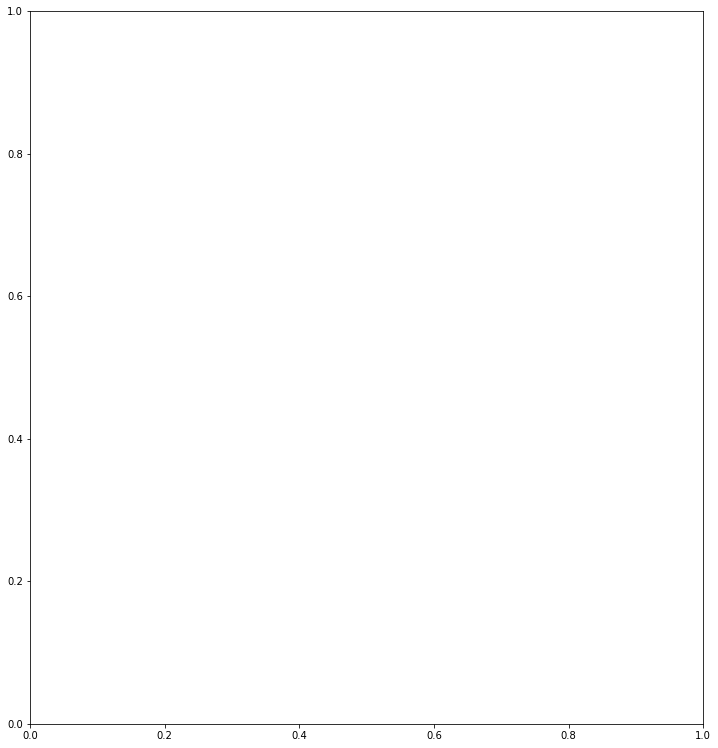

In [129]:
index = time == daterange2[0]
datestr = daterange2[0].strftime('%Y')
filenames = sorted(glob(os.path.join(paths['out'], 'forcing', f'SalishSea_1h_{datestr}*')))

# Loop through drifters
for ID, t, lon, lat, d in zip(*[drifters[key][index] for key in ('id', 'mtime', 'lon', 'lat', 'deltaTDays')]):
    if float(d) > 3: # Longer than 3 day duration
        
        # Starttime
        starttime = datetime.fromordinal(int(t[0])) + timedelta(days=float(t[0])%1) - timedelta(days=366)
        
        # File out
        outfile = os.path.join(paths['out'], 'results', f'drifter_{int(ID)}.nc')
        
        # OpenDrift run configuration and parameters
        o = oceandrift.OceanDrift(loglevel=20)
        o.set_config('general:coastline_action', 'previous')
        o.set_config('drift:scheme', 'runge-kutta4')
        o.add_readers_from_list(filenames)
        o.seed_elements(float(lon[0]), float(lat[0]), radius=50, time=starttime, number=100)
        
        # Run simulation
        o.run(time_step=90, time_step_output=3600, duration=timedelta(days=float(d)), outfile=outfile)

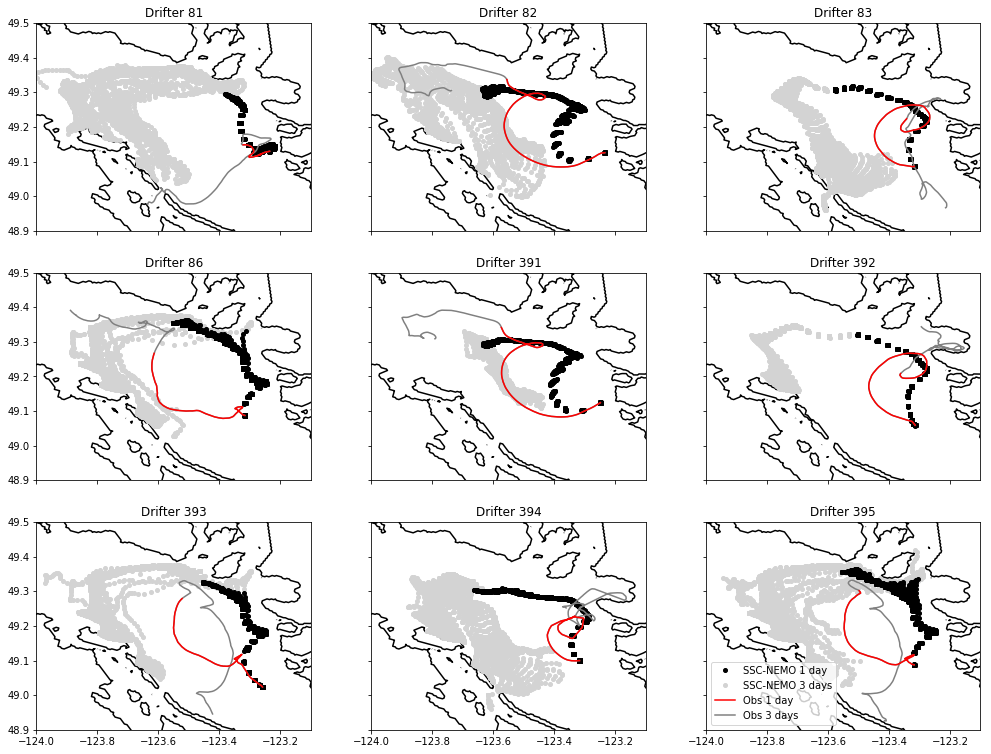

In [127]:
%matplotlib inline
fig, axs = plt.subplots(3, 3, figsize=(17, 13))
axs = axs.reshape(-1)
IDs = [81, 82, 83, 86, 391, 392, 393, 394, 395]
for ax, ID in zip(axs, IDs):
    
    ax.contour(mask.nav_lon, mask.nav_lat, mask.tmask[0, 0, ...], levels=[-0.01, 0.01], colors='k')
    ax.set_xlim([-124, -123.1])
    ax.set_ylim([48.9, 49.5])
    viz_tools.set_aspect(ax)
    if ID not in [393, 394, 395]: ax.xaxis.set_ticklabels('')
    if ID not in [81, 86, 393]: ax.yaxis.set_ticklabels('')
    ax.set_title(f'Drifter {ID}')
    
    with xr.open_dataset(os.path.join(paths['out'], 'results', f'drifter_{ID}.nc')) as ds:
        SSC72 = ax.plot(ds.lon[:, :72], ds.lat[:, :72], 'o', color='lightgray', markersize=4)
        SSC24 = ax.plot(ds.lon[:, :24], ds.lat[:, :24], 'ko', markersize=4)
    
    i = 0
    if ID == 391: i = 1
    dindex = np.where(drifters['id'].astype(int) == ID)[0][i]
    t24 = abs(drifters['mtime'][dindex] - drifters['mtime'][dindex][0] - 1).argmin()
    t72 = abs(drifters['mtime'][dindex] - drifters['mtime'][dindex][0] - 3).argmin()
    OBS72 = ax.plot(drifters['lon'][dindex][:t72], drifters['lat'][dindex][:t72], '-', color='gray')
    OBS24 = ax.plot(drifters['lon'][dindex][:t24], drifters['lat'][dindex][:t24], 'r-')
ax.legend([SSC24[0], SSC72[0], OBS24[0], OBS72[0]], ['SSC-NEMO 1 day', 'SSC-NEMO 3 days', 'Obs 1 day', 'Obs 3 days'])
fig.savefig('/home/bmoorema/Desktop/drifters2016_jul.pdf', bbox_inches='tight')

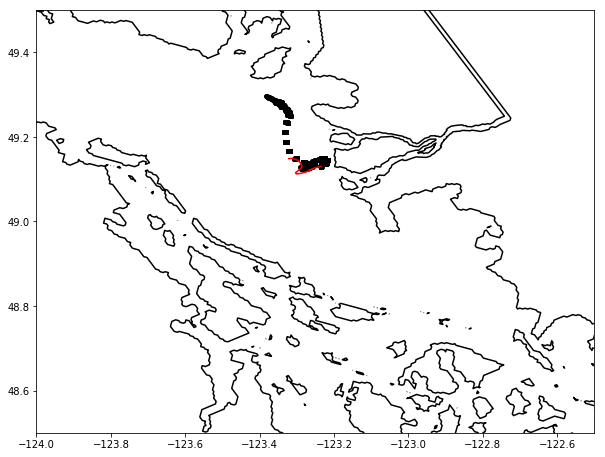

In [97]:
fig, ax = plt.subplots(figsize=(10, 10))
    
ax.contour(mask.nav_lon, mask.nav_lat, mask.tmask[0, 0, ...], levels=[-0.01, 0.01], colors='k')
ax.set_xlim([-124, -122.5])
ax.set_ylim([48.5, 49.5])
viz_tools.set_aspect(ax)

with xr.open_dataset(os.path.join(paths['out'], 'results', 'drifter_81.nc')) as ds:
    ax.plot(ds.lon[:, :24], ds.lat[:, :24], 'ko', markersize=4)
dindex = np.where(drifters['id'].astype(int) == 81)[0][0]
tindex = abs(drifters['mtime'][dindex] - drifters['mtime'][dindex][0] - 1).argmin()
ax.plot(drifters['lon'][dindex][:tindex], drifters['lat'][dindex][:tindex], 'r-')